In [1]:
!pip install scikit-optimize

In [2]:
!pip install statsmodels

In [3]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from collections import Counter

import statsmodels.stats.api as sms
from matplotlib import style
style.use('seaborn')
%matplotlib inline
#graphs in svg look clearer
%config InlineBackend.figure_format = 'svg' 

In [4]:
import warnings
warnings.filterwarnings("ignore")

# Functions

In [5]:
from sklearn import metrics

def mae(y_gt, Y_pr):
    return metrics.mean_absolute_error(y_gt, Y_pr)

def mse(y_gt, Y_pr):
    return metrics.mean_squared_error(y_gt, Y_pr)

def rmse(y_gt, Y_pr):
    my_mse = mse(y_gt, Y_pr)
    return np.sqrt(my_mse)

def medae(y_gt, Y_pr):
    return metrics.median_absolute_error(y_gt, Y_pr)

def R2(y_gt, Y_pr):
    return metrics.r2_score(y_gt, Y_pr)

def calc_metrics(true, pred):

    mse1 = mse(true, pred)

    rmse1 = rmse(true, pred)

    mae1 = mae(true, pred)

    medae1 = medae(true, pred)

    R21 = R2(true, pred)

    print('*** VAL **: ')
    print("MSE:   {}\nRMSE:  {}\nR2:    {}\nMAE:   {}\nMedAE: {}".format(mse1, rmse1, R21, mae1, medae1))
    print('-'*30)

In [6]:
def target_distr_linear(train_label, test_label, predicted_dv): 
    sns.kdeplot(train_label, label='train')
    sns.kdeplot(test_label, label='test')
    sns.kdeplot(predicted_dv, label='pred')
    plt.legend()
    plt.show()

    sns.scatterplot(test_label, predicted_dv, color='blueviolet')
    plt.title('Linear model')
    plt.xlabel('True Values')
    plt.ylabel('Predictions')
    plt.show()

In [7]:
from scipy.stats import norm

def draw_histogram(data):
    f,ax_hist = plt.subplots(1)
    sns.distplot(data, hist=True,  kde=True, rug=True, bins=10, fit=norm, ax=ax_hist);
    plt.xlabel("values")
    plt.title("Distribution") 

    mean=data.mean()

    ax_hist.axvline(mean, color='r', linestyle='--', label=f"Mean={mean:.3f}")
    ax_hist.legend()

    plt.show()

In [8]:
def draw_res_analys(errors, pred):
    sns.scatterplot(list(range(len(errors))),errors);
    plt.title("Distibution of errors")
    plt.ylabel('Error');
    plt.xlabel('Index');
    plt.show();

    sns.scatterplot(pred,errors);
    plt.title('Relationship of true value vs error (resudual analysis)')
    plt.ylabel('Error');
    plt.xlabel('True value');
    plt.show();

In [9]:
def get_feature_imp(model, X_train):
    imp = model.get_feature_importance(data=X_train)
    fig, axes = plt.subplots(1, 1, figsize=(12, 8))
    axes.barh(width=imp, y=model.feature_names_)
    axes.set_title('Finetuned Catboost feature importance')
    plt.show()

# Unhashing

In [10]:
genre_mapping = {'0ef0aa70-f86c-4141-8054-8b39af97867d': 'Biography',
                '287a1485-7a88-4c2f-bc94-ca418b6c47a1': 'Cartoons',
                '66fad8c3-d84f-458d-a8bf-5b4f154969e0': 'Show',
                '7b7c97f6-1adb-4b43-bfe8-9455812fac0b': 'Theater',
                '9fa28b61-a257-4a3e-945b-a9ef76a146d6': 'Fantasy',
                'b0836a1d-635f-4d89-bcc5-25d10ba56642': 'Anime',
                'd7214feb-8c11-4aea-aabb-ac98a8d56fd5': 'History',
                'dc65dbc8-34ba-4df1-b32c-4f895e10bff8': 'Shorts',
                'eb001d27-5be3-4d42-9d88-90d593f2627d': 'War_movies',
                '364fdc2e-bdfe-40be-b2c5-d30f43ec432e': 'Crime'}

In [11]:
types_mapping = {'1f22ccf1-288a-4e6e-b39a-7502799e7125': 'Лекции',
    '6d640e04-be3a-4c8c-852e-4e9b12449d5d': 'Концерты',
    '7b7c97f6-1adb-4b43-bfe8-9455812fac0b': 'Театр',
    '2f7908cc-e2fd-43cf-b626-ec1aef436160': 'Курсы' }

In [12]:
import pickle

with open('./RATINGS_OKKO_item_coldstart_dataset.pkl', 'rb') as f:
    df = pickle.load(f, encoding='utf-8')

In [13]:
df.shape

(9323, 20)

In [84]:
df

,availability,actor,age_access_type,country,average_rating,duration,type,name,release_year,genre,director,element_uid,subscription_only,av_rate_x,av_rate_y,users_number_x,users_number_y,user_count_3months,av_ratings_3months,min_ts
0,[SUBSCRIPTION],"[cff3362f-ad91-498d-80b3-ea3ab8ec65cf, 30dd19c...",18,[usa],6.99,3780000,MOVIE,Прожарка Чарли Шина,2011,"[Comedy, Documentary]",[1de22aff-430e-4af9-bf1d-159dbf8e9269],3f30a2ef-53b7-40e3-954f-1bdfc38a6d17,True,0.004276,0.003705,21,22,21,0.004276,2020-11-10 00:37:34
1,[SUBSCRIPTION],"[cff3362f-ad91-498d-80b3-ea3ab8ec65cf, a805fdd...",18,[usa],6.0,3780000,MOVIE,Прожарка Уильяма Шэтнера,2006,[Comedy],[1de22aff-430e-4af9-bf1d-159dbf8e9269],cdfa700f-122d-41e5-b8dc-9c6813bab6d2,True,0.000000,-0.004808,2,4,2,0.000000,2020-12-17 01:36:56
2,[SUBSCRIPTION],"[cff3362f-ad91-498d-80b3-ea3ab8ec65cf, a51b376...",0,"[usa, canada]",6.21,4860000,MOVIE,Большое путешествие,2006,"[Family, 287a1485-7a88-4c2f-bc94-ca418b6c47a1]",[fe598c84-ef4f-47c7-91af-d5cbd89c4e8d],d8b55146-dee5-4498-957c-5614414b48fb,True,-0.043478,-0.041667,1,1,1,-0.043478,2020-09-23 17:37:14
3,[SUBSCRIPTION],"[cff3362f-ad91-498d-80b3-ea3ab8ec65cf, 873fd46...",6,"[canada, france]",6.4,5520000,MOVIE,Пламенное сердце,2022,"[Comedy, Adventure, Family, 287a1485-7a88-4c2f...","[40f78e6d-3c9f-434f-a505-c6ffdd045763, 332105c...",ba6bec1a-3aa9-48c7-aa65-908c21627a12,True,0.018286,0.017220,1565,1600,1565,0.018286,2022-05-27 18:24:26
4,"[DTO, RENT]","[cff3362f-ad91-498d-80b3-ea3ab8ec65cf, 39124be...",16,[usa],NaN,5280000,MOVIE,Роман с кукушкой,2021,"[Comedy, Melodrama, Drama]",[f5fba6fe-94b3-4e69-acfc-da6867320386],a367ca50-ef7d-4a4c-b89a-c8692defa697,False,0.010101,0.006173,5,6,5,0.010101,2022-07-14 11:49:33
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9318,NaN,"[0ff8332b-9669-4337-a78c-fce4956c3be0, a999ee1...",0,[russia],6.3,0,SERIAL,Царевны,2018,[287a1485-7a88-4c2f-bc94-ca418b6c47a1],"[f6e19572-c969-4926-8777-0b0f0084e5b6, 97a6906...",ca50fd7c-41c5-4208-9f72-06d78fc602b5,False,0.004893,0.004512,59,59,59,0.004512,2020-09-20 09:34:03
9319,[SUBSCRIPTION],[d08bba89-e937-40f3-b2a7-7ea26de4c246],0,[russia],NaN,24360000,SERIAL,Великие Империи мира,2014,"[Documentary, d7214feb-8c11-4aea-aabb-ac98a8d5...",[384deeb0-ab24-4e3f-9744-1660b2ecaf67],74a2e6ef-fa37-4225-ab62-231dbfdf5a30,True,0.004016,0.003175,1,1,1,0.003175,2022-08-26 11:57:50
9320,[SUBSCRIPTION],[d08bba89-e937-40f3-b2a7-7ea26de4c246],0,[russia],NaN,33360000,SERIAL,Русские цари,2011,"[Documentary, d7214feb-8c11-4aea-aabb-ac98a8d5...",[384deeb0-ab24-4e3f-9744-1660b2ecaf67],a1834bce-7554-4106-828f-164a17503f51,True,0.009709,0.014184,1,2,2,0.014184,2022-08-26 12:12:06
9321,"[SUBSCRIPTION, AVOD]",[50ed4519-ad24-47b3-b135-947dba796372],6,[russia],NaN,3600000,SERIAL,Большие игры,2022,"[ForKids, 1f22ccf1-288a-4e6e-b39a-7502799e7125]",[ad784ddb-a602-4082-bf6f-f83ec5a96edf],ce8d2906-a33f-4140-9ffe-e091990d71a4,False,0.005922,0.005141,11,14,14,0.005141,2022-08-24 11:32:52


In [15]:
all_genres = []

for item_genres in df['genre']:
    all_genres.extend(item_genres)

In [16]:
all_unique_genres = set(all_genres)

In [17]:
len(all_unique_genres)

32

In [18]:
all_unique_genres

{'0ef0aa70-f86c-4141-8054-8b39af97867d',
 '1f22ccf1-288a-4e6e-b39a-7502799e7125',
 '287a1485-7a88-4c2f-bc94-ca418b6c47a1',
 '364fdc2e-bdfe-40be-b2c5-d30f43ec432e',
 '3e6e08b4-2bb0-46d6-aee7-98780e394c86',
 '5c403894-146a-47a4-ae75-9f1956a30dbb',
 '66fad8c3-d84f-458d-a8bf-5b4f154969e0',
 '6d640e04-be3a-4c8c-852e-4e9b12449d5d',
 '7b7c97f6-1adb-4b43-bfe8-9455812fac0b',
 '9fa28b61-a257-4a3e-945b-a9ef76a146d6',
 'Action',
 'Adventure',
 'ArtHouse',
 'Comedy',
 'Detective',
 'Documentary',
 'Drama',
 'Family',
 'ForKids',
 'Horror',
 'Humor',
 'Melodrama',
 'Music',
 'Sci-Fi',
 'Sport',
 'Thriller',
 'Travel',
 'b0836a1d-635f-4d89-bcc5-25d10ba56642',
 'd7214feb-8c11-4aea-aabb-ac98a8d56fd5',
 'd7f6b51c-6ebe-4b9c-9aad-2c60792a7d9c',
 'dc65dbc8-34ba-4df1-b32c-4f895e10bff8',
 'eb001d27-5be3-4d42-9d88-90d593f2627d'}

In [19]:
decoded_genres = [genre_mapping.get(genre, genre) for genre in all_unique_genres]

In [20]:
decoded_genres

['Melodrama',
 'Family',
 'Fantasy',
 'Anime',
 'Action',
 'Horror',
 'Music',
 'War_movies',
 '1f22ccf1-288a-4e6e-b39a-7502799e7125',
 'Cartoons',
 '3e6e08b4-2bb0-46d6-aee7-98780e394c86',
 'Humor',
 'Adventure',
 'Crime',
 'Comedy',
 'Sport',
 'd7f6b51c-6ebe-4b9c-9aad-2c60792a7d9c',
 'History',
 'Show',
 'Biography',
 '5c403894-146a-47a4-ae75-9f1956a30dbb',
 'ForKids',
 'Thriller',
 'Detective',
 'Travel',
 'Theater',
 'Documentary',
 'Shorts',
 '6d640e04-be3a-4c8c-852e-4e9b12449d5d',
 'Drama',
 'Sci-Fi',
 'ArtHouse']

In [21]:
all_genres = []

for col in ['actor', 'country', 'genre', 'director']:
    print(f'======{col}======')
    all_values = []
    for i, item_values in enumerate(df[col]):
        try:
            all_values.extend(item_values)
        except:
            print(i, item_values)
    all_values = set(all_values)
    print('Len:', len(all_values))
    # print(all_values)

======actor======
Len: 28834
======country======
Len: 102
======genre======
Len: 32
======director======
Len: 6889


# Preprocessing

In [22]:
prep_df = df.copy(deep=True)

In [23]:
prep_df.shape

(9323, 20)

### filter by year

In [24]:
prep_df = prep_df[prep_df['release_year'] >= 2000]

### topN

In [25]:
def add_topN_feature(df, col, n: int):
    items = []
    
    for i in df[col]:
        items.extend(i)

    topN = [x[0] for x in Counter(items).most_common()][:n]
    df[f'top{n}{col}'] = df[col].apply(lambda x: [int(item in x) for item in topN])
    df.drop(col, axis=1, inplace=True)
    return topN, f'top{n}{col}'

In [26]:
def ohe_topN_features(df, topN, cat):
    for i in range(len(topN)):
        df[f'{topN[i]}'] = [item[i] for item in df[cat]]
    df.drop(cat, axis=1, inplace=True)
    return df

In [27]:
top10genres, name = add_topN_feature(prep_df, 'genre', 10)
prep_df = ohe_topN_features(prep_df, top10genres, name)

In [28]:
top10actors, name = add_topN_feature(prep_df, 'actor', 10)
prep_df = ohe_topN_features(prep_df, top10actors, name)

In [29]:
top3directors, name = add_topN_feature(prep_df, 'director', 3)
prep_df = ohe_topN_features(prep_df, top3directors, name)

In [30]:
top5countries, name = add_topN_feature(prep_df, 'country', 5)
prep_df = ohe_topN_features(prep_df, top5countries, name)

In [31]:
prep_df.dropna(subset=['availability'], inplace=True)

In [32]:
avail, name = add_topN_feature(prep_df, 'availability', len(prep_df['availability']))
prep_df = ohe_topN_features(prep_df, avail, name)

In [33]:
prep_df.drop(['FVOD'], axis=1, inplace=True)

In [34]:
prep_df.head().T

,0,1,2,3,4
age_access_type,18,18,0,6,16
average_rating,6.99,6.0,6.21,6.4,NaN
duration,3780000,3780000,4860000,5520000,5280000
type,MOVIE,MOVIE,MOVIE,MOVIE,MOVIE
name,Прожарка Чарли Шина,Прожарка Уильяма Шэтнера,Большое путешествие,Пламенное сердце,Роман с кукушкой
release_year,2011,2006,2006,2022,2021
element_uid,3f30a2ef-53b7-40e3-954f-1bdfc38a6d17,cdfa700f-122d-41e5-b8dc-9c6813bab6d2,d8b55146-dee5-4498-957c-5614414b48fb,ba6bec1a-3aa9-48c7-aa65-908c21627a12,a367ca50-ef7d-4a4c-b89a-c8692defa697
subscription_only,True,True,True,True,False
av_rate_x,0.004276,0.0,-0.043478,0.018286,0.010101
av_rate_y,0.003705,-0.004808,-0.041667,0.01722,0.006173


In [35]:
prep_df.columns

Index(['age_access_type', 'average_rating', 'duration', 'type', 'name',
       'release_year', 'element_uid', 'subscription_only', 'av_rate_x',
       'av_rate_y', 'users_number_x', 'users_number_y', 'user_count_3months',
       'av_ratings_3months', 'min_ts', 'Drama', 'Comedy', 'Thriller', 'Action',
       '287a1485-7a88-4c2f-bc94-ca418b6c47a1', 'Adventure', 'Melodrama',
       '364fdc2e-bdfe-40be-b2c5-d30f43ec432e', 'Sci-Fi', 'Family',
       'd08bba89-e937-40f3-b2a7-7ea26de4c246',
       'fd401c6b-3e00-4f7f-aea7-5512df6b91e0',
       '5463b4bc-e332-415c-aca8-11c0f217a9eb',
       'fbdae856-85b9-4d4a-96dd-cc383571a488',
       '9703b641-2566-4e58-aebb-8d140805c0f3',
       '586f8d5a-2f17-42a3-b066-667f7c26a842',
       'dfd861c4-d2de-4bb6-bc6e-bae3f92a18a9',
       '43dc7096-090a-4c75-9e78-5f14da3ded36',
       '2ab01676-2af6-4abb-8dde-dc51e7e22372',
       'b6a30330-1dcb-4093-b6a9-ce0f779874c2',
       '751aebbe-2d4d-4421-bace-d44b8e10c8eb',
       'f7ded2b9-7c98-47ab-bfc4-57fb60bf9

In [40]:
cols = ['age_access_type', 'average_rating', 'duration', 
        'type', 'subscription_only', 
        'Drama', 
        'Comedy', 'Thriller', 'Action',
       '287a1485-7a88-4c2f-bc94-ca418b6c47a1', 'Adventure', 'Melodrama',
       '364fdc2e-bdfe-40be-b2c5-d30f43ec432e', 'Sci-Fi', 'Family',
       'd08bba89-e937-40f3-b2a7-7ea26de4c246',
       'fd401c6b-3e00-4f7f-aea7-5512df6b91e0',
       '5463b4bc-e332-415c-aca8-11c0f217a9eb',
       'fbdae856-85b9-4d4a-96dd-cc383571a488',
       '9703b641-2566-4e58-aebb-8d140805c0f3',
       '586f8d5a-2f17-42a3-b066-667f7c26a842',
       'dfd861c4-d2de-4bb6-bc6e-bae3f92a18a9',
       '43dc7096-090a-4c75-9e78-5f14da3ded36',
       '2ab01676-2af6-4abb-8dde-dc51e7e22372',
       'b6a30330-1dcb-4093-b6a9-ce0f779874c2',
       '751aebbe-2d4d-4421-bace-d44b8e10c8eb',
       'f7ded2b9-7c98-47ab-bfc4-57fb60bf946c',
       '799561d3-10b0-420d-93be-8138a07ac693', 'usa', 'russia',
       'great-britain', 'france', 'germany', 'SUBSCRIPTION', 'DTO', 'RENT',
       'AVOD']

In [41]:
prep_df = prep_df[cols]

In [42]:
skewed_num_features = ['duration'] # can try 'average_rating'

In [43]:
from collections import Counter
from sklearn.feature_extraction.text import TfidfVectorizer
import numpy as np
from sklearn.model_selection import train_test_split
import pandas as pd

class Preprocesser:
    def __init__(self, 
#                 mulpiple_cat_features: list,
                skewed_num_features: list,
               # text_features: list,
               # release_year_feature: str,
#                 mltpl_cat_n_top: dict
                ):
#         self.mulpiple_cat_features = mulpiple_cat_features
        self.skewed_num_features = skewed_num_features
        #self.text_features = text_features
#         self.mltpl_cat_n_top = mltpl_cat_n_top
       # self.release_year_feature = release_year_feature
        # self.tokenizer = Tokenizer(nlp.vocab)
        
    def __get_top_n_mltpl_cat_features(self, df_pr, col):
        all_cats = []
        for element_values in df_pr[col]:
            all_cats.extend(element_values)
        return Counter(all_cats).most_common(self.mltpl_cat_n_top[col])
            
    def __preprocess_mulpiple_cat_features(self, df_pr):
        for col in self.mulpiple_cat_features:
            feature_number = self.mltpl_cat_n_top[col]
            df_pr[[f'{col}_{i}' for i in range(feature_number)]] = pd.DataFrame(np.full((len(df), feature_number), np.nan))
            for i in df_pr.index:
                names = df_pr.loc[i, col]
                for k, name in enumerate(names[:int(feature_number)]):
                    df_pr.loc[i, f'{col}_{k}'] = name
            df_pr.drop(col, axis=1, inplace=True)

        return df_pr
    
    def __preprocess_skewed_num_features(self, df_pr):
        for col in self.skewed_num_features:
            df_pr[col] = df_pr[col].apply(lambda x: np.log1p(x))
        return df_pr
    
    def __preprocess_text_features(self, df_pr):
        for col in self.text_features:
            df_pr[col] = df_pr[col].apply(lambda x: self.tokenizer(x))
        return df_pr
            
    def preprocess(self,
                   df: pd.DataFrame):
        df_pr = df.copy()
#         df_pr = self.__preprocess_mulpiple_cat_features(df_pr)
        df_pr = self.__preprocess_skewed_num_features(df_pr)
        # df_pr = self.__preprocess_text_features(df_pr)
        
        return df_pr
        

In [44]:
preprocesser = Preprocesser(
#     mltpl_cat_features,
            skewed_num_features,
            #text_features,
#             mltpl_cat_n_top
                           )

In [45]:
df_pr = preprocesser.preprocess(prep_df)

In [46]:
df_pr.isnull().sum()

age_access_type                           0
average_rating                          460
duration                                  0
type                                      0
subscription_only                         0
Drama                                     0
Comedy                                    0
Thriller                                  0
Action                                    0
287a1485-7a88-4c2f-bc94-ca418b6c47a1      0
Adventure                                 0
Melodrama                                 0
364fdc2e-bdfe-40be-b2c5-d30f43ec432e      0
Sci-Fi                                    0
Family                                    0
d08bba89-e937-40f3-b2a7-7ea26de4c246      0
fd401c6b-3e00-4f7f-aea7-5512df6b91e0      0
5463b4bc-e332-415c-aca8-11c0f217a9eb      0
fbdae856-85b9-4d4a-96dd-cc383571a488      0
9703b641-2566-4e58-aebb-8d140805c0f3      0
586f8d5a-2f17-42a3-b066-667f7c26a842      0
dfd861c4-d2de-4bb6-bc6e-bae3f92a18a9      0
43dc7096-090a-4c75-9e78-5f14da3d

In [47]:
df_pr['subscription_only'] = df_pr['subscription_only'].astype(int)

In [48]:
df_pr.columns

Index(['age_access_type', 'average_rating', 'duration', 'type',
       'subscription_only', 'Drama', 'Comedy', 'Thriller', 'Action',
       '287a1485-7a88-4c2f-bc94-ca418b6c47a1', 'Adventure', 'Melodrama',
       '364fdc2e-bdfe-40be-b2c5-d30f43ec432e', 'Sci-Fi', 'Family',
       'd08bba89-e937-40f3-b2a7-7ea26de4c246',
       'fd401c6b-3e00-4f7f-aea7-5512df6b91e0',
       '5463b4bc-e332-415c-aca8-11c0f217a9eb',
       'fbdae856-85b9-4d4a-96dd-cc383571a488',
       '9703b641-2566-4e58-aebb-8d140805c0f3',
       '586f8d5a-2f17-42a3-b066-667f7c26a842',
       'dfd861c4-d2de-4bb6-bc6e-bae3f92a18a9',
       '43dc7096-090a-4c75-9e78-5f14da3ded36',
       '2ab01676-2af6-4abb-8dde-dc51e7e22372',
       'b6a30330-1dcb-4093-b6a9-ce0f779874c2',
       '751aebbe-2d4d-4421-bace-d44b8e10c8eb',
       'f7ded2b9-7c98-47ab-bfc4-57fb60bf946c',
       '799561d3-10b0-420d-93be-8138a07ac693', 'usa', 'russia',
       'great-britain', 'france', 'germany', 'SUBSCRIPTION', 'DTO', 'RENT',
       'AVOD'],
      d

In [49]:
df_pr.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 7719 entries, 0 to 9322
Data columns (total 37 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   age_access_type                       7719 non-null   object 
 1   average_rating                        7259 non-null   object 
 2   duration                              7719 non-null   float64
 3   type                                  7719 non-null   object 
 4   subscription_only                     7719 non-null   int64  
 5   Drama                                 7719 non-null   int64  
 6   Comedy                                7719 non-null   int64  
 7   Thriller                              7719 non-null   int64  
 8   Action                                7719 non-null   int64  
 9   287a1485-7a88-4c2f-bc94-ca418b6c47a1  7719 non-null   int64  
 10  Adventure                             7719 non-null   int64  
 11  Melodrama        

### target destr

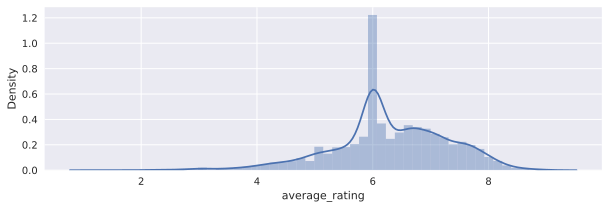

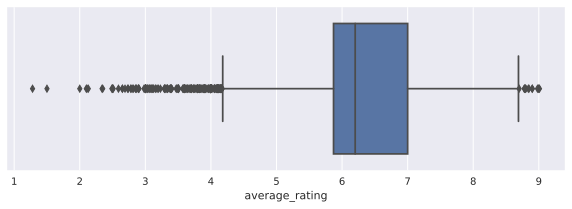

In [50]:
plt.figure(figsize=(10, 3))
sns.distplot(df_pr['average_rating'])
plt.show()

plt.figure(figsize=(10, 3))
sns.boxplot(df_pr['average_rating'], orient='h')
plt.show()

## Split

In [59]:
df_pr.dropna(inplace=True)

In [60]:
X, y = df_pr.drop('average_rating', axis=1), df_pr['average_rating']

In [61]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=42, shuffle=True)

In [62]:
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.1, random_state=42, shuffle=True)

In [63]:
X_train.shape, X_val.shape, X_test.shape, y_train.shape, y_val.shape, y_test.shape

((5879, 36), (654, 36), (726, 36), (5879,), (654,), (726,))

In [64]:
cat_features = ['age_access_type', 'type']

In [65]:
X_train.columns

Index(['age_access_type', 'duration', 'type', 'subscription_only', 'Drama',
       'Comedy', 'Thriller', 'Action', '287a1485-7a88-4c2f-bc94-ca418b6c47a1',
       'Adventure', 'Melodrama', '364fdc2e-bdfe-40be-b2c5-d30f43ec432e',
       'Sci-Fi', 'Family', 'd08bba89-e937-40f3-b2a7-7ea26de4c246',
       'fd401c6b-3e00-4f7f-aea7-5512df6b91e0',
       '5463b4bc-e332-415c-aca8-11c0f217a9eb',
       'fbdae856-85b9-4d4a-96dd-cc383571a488',
       '9703b641-2566-4e58-aebb-8d140805c0f3',
       '586f8d5a-2f17-42a3-b066-667f7c26a842',
       'dfd861c4-d2de-4bb6-bc6e-bae3f92a18a9',
       '43dc7096-090a-4c75-9e78-5f14da3ded36',
       '2ab01676-2af6-4abb-8dde-dc51e7e22372',
       'b6a30330-1dcb-4093-b6a9-ce0f779874c2',
       '751aebbe-2d4d-4421-bace-d44b8e10c8eb',
       'f7ded2b9-7c98-47ab-bfc4-57fb60bf946c',
       '799561d3-10b0-420d-93be-8138a07ac693', 'usa', 'russia',
       'great-britain', 'france', 'germany', 'SUBSCRIPTION', 'DTO', 'RENT',
       'AVOD'],
      dtype='object')

# Modeling

In [66]:
import catboost as cat
from catboost import CatBoostRegressor
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV

from scipy.stats import uniform, randint

In [67]:
train_dataset = cat.Pool(data=X_train,
                        label=y_train,
                         cat_features=cat_features)

test_dataset = cat.Pool(data=X_test, 
                        label=y_test,
                         cat_features=cat_features)

val_dataset = cat.Pool(X_val, y_val,
                       cat_features=cat_features)

cat_params = {
    'loss_function': 'RMSE',
    'eval_metric': 'MAE',
    'verbose': True,
    'random_seed': 321,
    'allow_writing_files': False, 
    'cat_features': cat_features
}

cat_model = cat.CatBoostRegressor(**cat_params)

cat_model.fit(
    train_dataset,
    eval_set=val_dataset,
    early_stopping_rounds=500,
    verbose=100,
    plot=False
)

Learning rate set to 0.067248
0:	learn: 0.7686229	test: 0.7563560	best: 0.7563560 (0)	total: 55.9ms	remaining: 55.9s
100:	learn: 0.6010364	test: 0.6323132	best: 0.6323132 (100)	total: 374ms	remaining: 3.33s
200:	learn: 0.5805118	test: 0.6221195	best: 0.6221193 (199)	total: 672ms	remaining: 2.67s
300:	learn: 0.5666717	test: 0.6171626	best: 0.6171626 (300)	total: 991ms	remaining: 2.3s
400:	learn: 0.5560134	test: 0.6152254	best: 0.6150574 (384)	total: 1.3s	remaining: 1.95s
500:	learn: 0.5470878	test: 0.6153956	best: 0.6149730 (404)	total: 1.61s	remaining: 1.61s
600:	learn: 0.5395904	test: 0.6147514	best: 0.6145142 (586)	total: 1.93s	remaining: 1.28s
700:	learn: 0.5330059	test: 0.6141331	best: 0.6141331 (700)	total: 2.24s	remaining: 954ms
800:	learn: 0.5276500	test: 0.6131313	best: 0.6131270 (799)	total: 2.54s	remaining: 632ms
900:	learn: 0.5222408	test: 0.6132077	best: 0.6127348 (817)	total: 2.85s	remaining: 313ms
999:	learn: 0.5156348	test: 0.6137430	best: 0.6127348 (817)	total: 3.17s	re

In [68]:
y_pred = cat_model.predict(test_dataset)

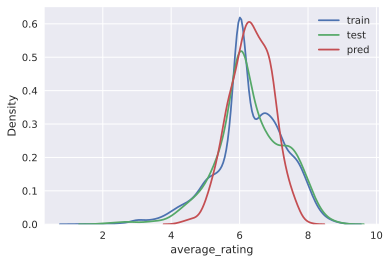

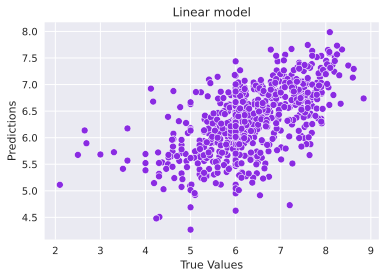

In [69]:
target_distr_linear(y_train, y_test, y_pred)   

In [70]:
calc_metrics(y_test, y_pred)

*** VAL **: 
MSE:   0.6032989705899184
RMSE:  0.7767232265034427
R2:    0.376240620702628
MAE:   0.5863354344909396
MedAE: 0.4670306164867086
------------------------------


In [71]:
cat_model.save_model('cat_reg_kinop_ratings_cat_ntop')

**Feature importance**

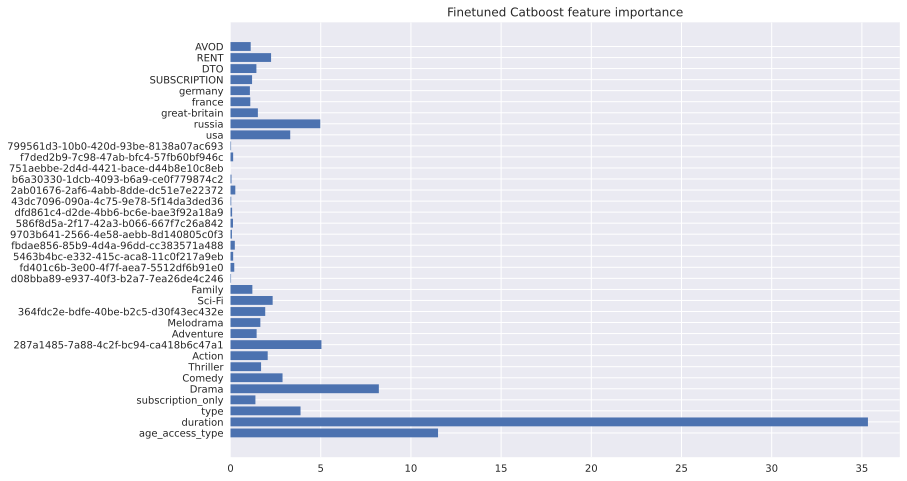

In [72]:
get_feature_imp(cat_model, train_dataset)

1)  The most influential features:  
    - duration  
    - average_rating  
    - age_access_type  

2)  The lowest influential features:  
    - actors and directors are not so important

**Detecting heteroscedasticity**

**Graphical Method:**

Firstly do the regression analysis and then plot the error terms against the predicted values. 
If there is a definite pattern (like linear or quadratic or funnel shaped) obtained from the scatter plot then heteroscedasticity is present.

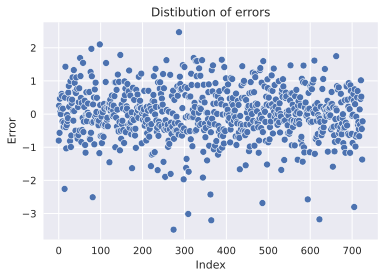

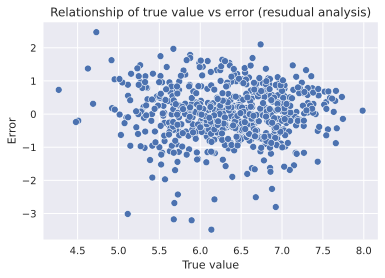

In [73]:
errors = y_test - y_pred
draw_res_analys(errors, y_pred)

**Conclusion**
* The trend in the second figure is not visible, now we will confirm the presence of heteroskedasticity on tests.

# Tuning

In [74]:
train_dataset = cat.Pool(X_train, y_train, 
                         cat_features=cat_features) 

test_dataset = cat.Pool(X_test, y_test,
                         cat_features=cat_features)

cat_params = {
    'loss_function': 'RMSE',
    'eval_metric': 'MAE',
    'verbose': True,
    'random_seed': 321,
    'allow_writing_files': False, 
    'cat_features': cat_features
}

In [ ]:
parameters_distr = {'depth': randint(5, 10),
              'learning_rate': uniform(0.01, 0.1),
              'iterations': [5000, 10000, 15000]
             }

cat_model = cat.CatBoostRegressor(**cat_params)
grid = RandomizedSearchCV(estimator=cat_model, param_distributions=parameters_distr, 
                            cv=5, 
#                           n_jobs=-1,
                          verbose=3)

grid.fit(X_train, y_train)

import pickle
with open('bestimator_okko_rat_ntop', 'wb') as f:
    pickle.dump(grid.best_estimator_, f)
grid.best_params_

Fitting 5 folds for each of 10 candidates, totalling 50 fits
0:	learn: 0.7557343	total: 10.4ms	remaining: 2m 36s
1:	learn: 0.7340753	total: 18.3ms	remaining: 2m 17s
2:	learn: 0.7245245	total: 19.2ms	remaining: 1m 36s
3:	learn: 0.7063166	total: 27.4ms	remaining: 1m 42s
4:	learn: 0.6952162	total: 32.3ms	remaining: 1m 36s
5:	learn: 0.6839588	total: 40.3ms	remaining: 1m 40s
6:	learn: 0.6724527	total: 47.6ms	remaining: 1m 41s
7:	learn: 0.6630485	total: 55.4ms	remaining: 1m 43s
8:	learn: 0.6538364	total: 62.9ms	remaining: 1m 44s
9:	learn: 0.6478422	total: 70.2ms	remaining: 1m 45s
10:	learn: 0.6419919	total: 78.5ms	remaining: 1m 47s
11:	learn: 0.6354660	total: 85.9ms	remaining: 1m 47s
12:	learn: 0.6335276	total: 87.5ms	remaining: 1m 40s
13:	learn: 0.6291023	total: 96.8ms	remaining: 1m 43s
14:	learn: 0.6272764	total: 101ms	remaining: 1m 41s
15:	learn: 0.6261031	total: 103ms	remaining: 1m 36s
16:	learn: 0.6232900	total: 112ms	remaining: 1m 38s
17:	learn: 0.6203590	total: 121ms	remaining: 1m 40s

179:	learn: 0.5063959	total: 1.23s	remaining: 1m 41s
180:	learn: 0.5060704	total: 1.24s	remaining: 1m 41s
181:	learn: 0.5055106	total: 1.25s	remaining: 1m 41s
182:	learn: 0.5054729	total: 1.25s	remaining: 1m 41s
183:	learn: 0.5051435	total: 1.26s	remaining: 1m 41s
184:	learn: 0.5047035	total: 1.26s	remaining: 1m 41s
185:	learn: 0.5046543	total: 1.27s	remaining: 1m 41s
186:	learn: 0.5045802	total: 1.28s	remaining: 1m 41s
187:	learn: 0.5043912	total: 1.28s	remaining: 1m 41s
188:	learn: 0.5039399	total: 1.29s	remaining: 1m 41s
189:	learn: 0.5038126	total: 1.3s	remaining: 1m 41s
190:	learn: 0.5037011	total: 1.3s	remaining: 1m 41s
191:	learn: 0.5028392	total: 1.31s	remaining: 1m 41s
192:	learn: 0.5024685	total: 1.32s	remaining: 1m 41s
193:	learn: 0.5019472	total: 1.32s	remaining: 1m 41s
194:	learn: 0.5016192	total: 1.33s	remaining: 1m 41s
195:	learn: 0.5013240	total: 1.34s	remaining: 1m 41s
196:	learn: 0.5011778	total: 1.34s	remaining: 1m 41s
197:	learn: 0.5011192	total: 1.35s	remaining: 1m

357:	learn: 0.4451233	total: 2.45s	remaining: 1m 40s
358:	learn: 0.4446305	total: 2.46s	remaining: 1m 40s
359:	learn: 0.4444262	total: 2.47s	remaining: 1m 40s
360:	learn: 0.4440664	total: 2.48s	remaining: 1m 40s
361:	learn: 0.4435560	total: 2.48s	remaining: 1m 40s
362:	learn: 0.4433837	total: 2.49s	remaining: 1m 40s
363:	learn: 0.4433042	total: 2.5s	remaining: 1m 40s
364:	learn: 0.4429788	total: 2.5s	remaining: 1m 40s
365:	learn: 0.4427852	total: 2.51s	remaining: 1m 40s
366:	learn: 0.4426159	total: 2.52s	remaining: 1m 40s
367:	learn: 0.4418992	total: 2.53s	remaining: 1m 40s
368:	learn: 0.4416987	total: 2.54s	remaining: 1m 40s
369:	learn: 0.4415638	total: 2.55s	remaining: 1m 40s
370:	learn: 0.4414373	total: 2.56s	remaining: 1m 40s
371:	learn: 0.4411919	total: 2.56s	remaining: 1m 40s
372:	learn: 0.4410746	total: 2.57s	remaining: 1m 40s
373:	learn: 0.4409147	total: 2.58s	remaining: 1m 40s
374:	learn: 0.4407299	total: 2.59s	remaining: 1m 40s
375:	learn: 0.4406742	total: 2.59s	remaining: 1m

529:	learn: 0.4116865	total: 3.67s	remaining: 1m 40s
530:	learn: 0.4115012	total: 3.68s	remaining: 1m 40s
531:	learn: 0.4114486	total: 3.69s	remaining: 1m 40s
532:	learn: 0.4112883	total: 3.7s	remaining: 1m 40s
533:	learn: 0.4110264	total: 3.7s	remaining: 1m 40s
534:	learn: 0.4109089	total: 3.71s	remaining: 1m 40s
535:	learn: 0.4105065	total: 3.72s	remaining: 1m 40s
536:	learn: 0.4102638	total: 3.72s	remaining: 1m 40s
537:	learn: 0.4099547	total: 3.73s	remaining: 1m 40s
538:	learn: 0.4098365	total: 3.74s	remaining: 1m 40s
539:	learn: 0.4096526	total: 3.75s	remaining: 1m 40s
540:	learn: 0.4095231	total: 3.75s	remaining: 1m 40s
541:	learn: 0.4094151	total: 3.76s	remaining: 1m 40s
542:	learn: 0.4089977	total: 3.77s	remaining: 1m 40s
543:	learn: 0.4089515	total: 3.77s	remaining: 1m 40s
544:	learn: 0.4086073	total: 3.78s	remaining: 1m 40s
545:	learn: 0.4085233	total: 3.79s	remaining: 1m 40s
546:	learn: 0.4082408	total: 3.79s	remaining: 1m 40s
547:	learn: 0.4078733	total: 3.8s	remaining: 1m 

697:	learn: 0.3830031	total: 4.89s	remaining: 1m 40s
698:	learn: 0.3829609	total: 4.9s	remaining: 1m 40s
699:	learn: 0.3828959	total: 4.9s	remaining: 1m 40s
700:	learn: 0.3827727	total: 4.91s	remaining: 1m 40s
701:	learn: 0.3826087	total: 4.92s	remaining: 1m 40s
702:	learn: 0.3825501	total: 4.93s	remaining: 1m 40s
703:	learn: 0.3825485	total: 4.93s	remaining: 1m 40s
704:	learn: 0.3822744	total: 4.94s	remaining: 1m 40s
705:	learn: 0.3821267	total: 4.95s	remaining: 1m 40s
706:	learn: 0.3820670	total: 4.96s	remaining: 1m 40s
707:	learn: 0.3818509	total: 4.96s	remaining: 1m 40s
708:	learn: 0.3816750	total: 4.97s	remaining: 1m 40s
709:	learn: 0.3814967	total: 4.98s	remaining: 1m 40s
710:	learn: 0.3813735	total: 4.99s	remaining: 1m 40s
711:	learn: 0.3812952	total: 4.99s	remaining: 1m 40s
712:	learn: 0.3812675	total: 5s	remaining: 1m 40s
713:	learn: 0.3811430	total: 5.01s	remaining: 1m 40s
714:	learn: 0.3808904	total: 5.02s	remaining: 1m 40s
715:	learn: 0.3805460	total: 5.02s	remaining: 1m 40

868:	learn: 0.3575948	total: 6.11s	remaining: 1m 39s
869:	learn: 0.3572587	total: 6.12s	remaining: 1m 39s
870:	learn: 0.3572585	total: 6.12s	remaining: 1m 39s
871:	learn: 0.3572145	total: 6.13s	remaining: 1m 39s
872:	learn: 0.3571896	total: 6.14s	remaining: 1m 39s
873:	learn: 0.3570327	total: 6.14s	remaining: 1m 39s
874:	learn: 0.3569576	total: 6.15s	remaining: 1m 39s
875:	learn: 0.3568368	total: 6.16s	remaining: 1m 39s
876:	learn: 0.3567339	total: 6.17s	remaining: 1m 39s
877:	learn: 0.3566991	total: 6.17s	remaining: 1m 39s
878:	learn: 0.3565372	total: 6.18s	remaining: 1m 39s
879:	learn: 0.3563050	total: 6.19s	remaining: 1m 39s
880:	learn: 0.3561956	total: 6.2s	remaining: 1m 39s
881:	learn: 0.3561810	total: 6.2s	remaining: 1m 39s
882:	learn: 0.3560847	total: 6.21s	remaining: 1m 39s
883:	learn: 0.3560282	total: 6.22s	remaining: 1m 39s
884:	learn: 0.3560044	total: 6.22s	remaining: 1m 39s
885:	learn: 0.3558864	total: 6.23s	remaining: 1m 39s
886:	learn: 0.3558133	total: 6.24s	remaining: 1m

1039:	learn: 0.3341096	total: 7.34s	remaining: 1m 38s
1040:	learn: 0.3340912	total: 7.34s	remaining: 1m 38s
1041:	learn: 0.3339542	total: 7.35s	remaining: 1m 38s
1042:	learn: 0.3338836	total: 7.36s	remaining: 1m 38s
1043:	learn: 0.3335321	total: 7.36s	remaining: 1m 38s
1044:	learn: 0.3334537	total: 7.37s	remaining: 1m 38s
1045:	learn: 0.3334362	total: 7.38s	remaining: 1m 38s
1046:	learn: 0.3332248	total: 7.38s	remaining: 1m 38s
1047:	learn: 0.3331860	total: 7.39s	remaining: 1m 38s
1048:	learn: 0.3330962	total: 7.4s	remaining: 1m 38s
1049:	learn: 0.3330473	total: 7.41s	remaining: 1m 38s
1050:	learn: 0.3328237	total: 7.41s	remaining: 1m 38s
1051:	learn: 0.3327997	total: 7.42s	remaining: 1m 38s
1052:	learn: 0.3327544	total: 7.43s	remaining: 1m 38s
1053:	learn: 0.3327324	total: 7.43s	remaining: 1m 38s
1054:	learn: 0.3327149	total: 7.44s	remaining: 1m 38s
1055:	learn: 0.3325190	total: 7.45s	remaining: 1m 38s
1056:	learn: 0.3324548	total: 7.46s	remaining: 1m 38s
1057:	learn: 0.3324323	total:

1207:	learn: 0.3146438	total: 8.55s	remaining: 1m 37s
1208:	learn: 0.3146165	total: 8.55s	remaining: 1m 37s
1209:	learn: 0.3144502	total: 8.56s	remaining: 1m 37s
1210:	learn: 0.3142022	total: 8.57s	remaining: 1m 37s
1211:	learn: 0.3140594	total: 8.58s	remaining: 1m 37s
1212:	learn: 0.3140202	total: 8.58s	remaining: 1m 37s
1213:	learn: 0.3138702	total: 8.59s	remaining: 1m 37s
1214:	learn: 0.3138017	total: 8.6s	remaining: 1m 37s
1215:	learn: 0.3137131	total: 8.6s	remaining: 1m 37s
1216:	learn: 0.3136773	total: 8.61s	remaining: 1m 37s
1217:	learn: 0.3136273	total: 8.62s	remaining: 1m 37s
1218:	learn: 0.3135169	total: 8.62s	remaining: 1m 37s
1219:	learn: 0.3133729	total: 8.63s	remaining: 1m 37s
1220:	learn: 0.3131968	total: 8.64s	remaining: 1m 37s
1221:	learn: 0.3131597	total: 8.64s	remaining: 1m 37s
1222:	learn: 0.3130633	total: 8.65s	remaining: 1m 37s
1223:	learn: 0.3127856	total: 8.66s	remaining: 1m 37s
1224:	learn: 0.3127368	total: 8.66s	remaining: 1m 37s
1225:	learn: 0.3123955	total: 

1374:	learn: 0.2980424	total: 9.76s	remaining: 1m 36s
1375:	learn: 0.2979482	total: 9.77s	remaining: 1m 36s
1376:	learn: 0.2978380	total: 9.78s	remaining: 1m 36s
1377:	learn: 0.2976828	total: 9.78s	remaining: 1m 36s
1378:	learn: 0.2976160	total: 9.79s	remaining: 1m 36s
1379:	learn: 0.2974854	total: 9.8s	remaining: 1m 36s
1380:	learn: 0.2974767	total: 9.81s	remaining: 1m 36s
1381:	learn: 0.2973194	total: 9.82s	remaining: 1m 36s
1382:	learn: 0.2972658	total: 9.83s	remaining: 1m 36s
1383:	learn: 0.2972430	total: 9.84s	remaining: 1m 36s
1384:	learn: 0.2970326	total: 9.84s	remaining: 1m 36s
1385:	learn: 0.2969483	total: 9.85s	remaining: 1m 36s
1386:	learn: 0.2969294	total: 9.86s	remaining: 1m 36s
1387:	learn: 0.2966742	total: 9.86s	remaining: 1m 36s
1388:	learn: 0.2965454	total: 9.87s	remaining: 1m 36s
1389:	learn: 0.2964577	total: 9.88s	remaining: 1m 36s
1390:	learn: 0.2963515	total: 9.89s	remaining: 1m 36s
1391:	learn: 0.2962934	total: 9.89s	remaining: 1m 36s
1392:	learn: 0.2962273	total:

1538:	learn: 0.2834337	total: 11s	remaining: 1m 36s
1539:	learn: 0.2833691	total: 11s	remaining: 1m 36s
1540:	learn: 0.2832614	total: 11s	remaining: 1m 36s
1541:	learn: 0.2832364	total: 11s	remaining: 1m 35s
1542:	learn: 0.2832281	total: 11s	remaining: 1m 35s
1543:	learn: 0.2831328	total: 11s	remaining: 1m 35s
1544:	learn: 0.2830722	total: 11s	remaining: 1m 35s
1545:	learn: 0.2829855	total: 11s	remaining: 1m 35s
1546:	learn: 0.2829679	total: 11s	remaining: 1m 35s
1547:	learn: 0.2829107	total: 11s	remaining: 1m 35s
1548:	learn: 0.2827543	total: 11s	remaining: 1m 35s
1549:	learn: 0.2827205	total: 11.1s	remaining: 1m 35s
1550:	learn: 0.2825685	total: 11.1s	remaining: 1m 35s
1551:	learn: 0.2823678	total: 11.1s	remaining: 1m 35s
1552:	learn: 0.2822777	total: 11.1s	remaining: 1m 35s
1553:	learn: 0.2822718	total: 11.1s	remaining: 1m 35s
1554:	learn: 0.2821819	total: 11.1s	remaining: 1m 35s
1555:	learn: 0.2820340	total: 11.1s	remaining: 1m 35s
1556:	learn: 0.2819030	total: 11.1s	remaining: 1m 

1706:	learn: 0.2696557	total: 12.2s	remaining: 1m 34s
1707:	learn: 0.2696195	total: 12.2s	remaining: 1m 34s
1708:	learn: 0.2694609	total: 12.2s	remaining: 1m 34s
1709:	learn: 0.2694180	total: 12.2s	remaining: 1m 34s
1710:	learn: 0.2693953	total: 12.2s	remaining: 1m 34s
1711:	learn: 0.2693836	total: 12.2s	remaining: 1m 34s
1712:	learn: 0.2693829	total: 12.2s	remaining: 1m 34s
1713:	learn: 0.2692550	total: 12.2s	remaining: 1m 34s
1714:	learn: 0.2691580	total: 12.2s	remaining: 1m 34s
1715:	learn: 0.2691110	total: 12.3s	remaining: 1m 34s
1716:	learn: 0.2690351	total: 12.3s	remaining: 1m 34s
1717:	learn: 0.2689335	total: 12.3s	remaining: 1m 34s
1718:	learn: 0.2688567	total: 12.3s	remaining: 1m 34s
1719:	learn: 0.2688187	total: 12.3s	remaining: 1m 34s
1720:	learn: 0.2687140	total: 12.3s	remaining: 1m 34s
1721:	learn: 0.2686576	total: 12.3s	remaining: 1m 34s
1722:	learn: 0.2685644	total: 12.3s	remaining: 1m 34s
1723:	learn: 0.2685357	total: 12.3s	remaining: 1m 34s
1724:	learn: 0.2684080	total

1873:	learn: 0.2573197	total: 13.4s	remaining: 1m 33s
1874:	learn: 0.2572731	total: 13.4s	remaining: 1m 33s
1875:	learn: 0.2571855	total: 13.4s	remaining: 1m 33s
1876:	learn: 0.2570008	total: 13.4s	remaining: 1m 33s
1877:	learn: 0.2569761	total: 13.4s	remaining: 1m 33s
1878:	learn: 0.2569333	total: 13.4s	remaining: 1m 33s
1879:	learn: 0.2568890	total: 13.4s	remaining: 1m 33s
1880:	learn: 0.2568636	total: 13.4s	remaining: 1m 33s
1881:	learn: 0.2568423	total: 13.5s	remaining: 1m 33s
1882:	learn: 0.2567956	total: 13.5s	remaining: 1m 33s
1883:	learn: 0.2567459	total: 13.5s	remaining: 1m 33s
1884:	learn: 0.2567008	total: 13.5s	remaining: 1m 33s
1885:	learn: 0.2566090	total: 13.5s	remaining: 1m 33s
1886:	learn: 0.2565529	total: 13.5s	remaining: 1m 33s
1887:	learn: 0.2565174	total: 13.5s	remaining: 1m 33s
1888:	learn: 0.2564012	total: 13.5s	remaining: 1m 33s
1889:	learn: 0.2563386	total: 13.5s	remaining: 1m 33s
1890:	learn: 0.2562774	total: 13.5s	remaining: 1m 33s
1891:	learn: 0.2561784	total

2035:	learn: 0.2457810	total: 14.6s	remaining: 1m 33s
2036:	learn: 0.2456839	total: 14.6s	remaining: 1m 33s
2037:	learn: 0.2456538	total: 14.6s	remaining: 1m 33s
2038:	learn: 0.2456043	total: 14.6s	remaining: 1m 33s
2039:	learn: 0.2455969	total: 14.6s	remaining: 1m 32s
2040:	learn: 0.2454295	total: 14.6s	remaining: 1m 32s
2041:	learn: 0.2453190	total: 14.7s	remaining: 1m 32s
2042:	learn: 0.2453040	total: 14.7s	remaining: 1m 32s
2043:	learn: 0.2452502	total: 14.7s	remaining: 1m 32s
2044:	learn: 0.2451499	total: 14.7s	remaining: 1m 32s
2045:	learn: 0.2450828	total: 14.7s	remaining: 1m 32s
2046:	learn: 0.2450652	total: 14.7s	remaining: 1m 32s
2047:	learn: 0.2450356	total: 14.7s	remaining: 1m 32s
2048:	learn: 0.2449548	total: 14.7s	remaining: 1m 32s
2049:	learn: 0.2448586	total: 14.7s	remaining: 1m 32s
2050:	learn: 0.2447996	total: 14.7s	remaining: 1m 32s
2051:	learn: 0.2447635	total: 14.7s	remaining: 1m 32s
2052:	learn: 0.2446984	total: 14.7s	remaining: 1m 32s
2053:	learn: 0.2445983	total

2200:	learn: 0.2346105	total: 15.8s	remaining: 1m 32s
2201:	learn: 0.2345933	total: 15.8s	remaining: 1m 32s
2202:	learn: 0.2344599	total: 15.8s	remaining: 1m 32s
2203:	learn: 0.2344002	total: 15.8s	remaining: 1m 32s
2204:	learn: 0.2343954	total: 15.9s	remaining: 1m 32s
2205:	learn: 0.2343442	total: 15.9s	remaining: 1m 32s
2206:	learn: 0.2343287	total: 15.9s	remaining: 1m 31s
2207:	learn: 0.2343149	total: 15.9s	remaining: 1m 31s
2208:	learn: 0.2342299	total: 15.9s	remaining: 1m 31s
2209:	learn: 0.2342115	total: 15.9s	remaining: 1m 31s
2210:	learn: 0.2341681	total: 15.9s	remaining: 1m 31s
2211:	learn: 0.2341065	total: 15.9s	remaining: 1m 31s
2212:	learn: 0.2340373	total: 15.9s	remaining: 1m 31s
2213:	learn: 0.2339864	total: 15.9s	remaining: 1m 31s
2214:	learn: 0.2339034	total: 15.9s	remaining: 1m 31s
2215:	learn: 0.2338261	total: 15.9s	remaining: 1m 31s
2216:	learn: 0.2338061	total: 15.9s	remaining: 1m 31s
2217:	learn: 0.2337780	total: 16s	remaining: 1m 31s
2218:	learn: 0.2336723	total: 

2366:	learn: 0.2241299	total: 17s	remaining: 1m 30s
2367:	learn: 0.2240748	total: 17.1s	remaining: 1m 30s
2368:	learn: 0.2240569	total: 17.1s	remaining: 1m 30s
2369:	learn: 0.2240130	total: 17.1s	remaining: 1m 30s
2370:	learn: 0.2240022	total: 17.1s	remaining: 1m 30s
2371:	learn: 0.2239450	total: 17.1s	remaining: 1m 30s
2372:	learn: 0.2238744	total: 17.1s	remaining: 1m 30s
2373:	learn: 0.2238238	total: 17.1s	remaining: 1m 30s
2374:	learn: 0.2237806	total: 17.1s	remaining: 1m 30s
2375:	learn: 0.2237145	total: 17.1s	remaining: 1m 30s
2376:	learn: 0.2236107	total: 17.1s	remaining: 1m 30s
2377:	learn: 0.2236019	total: 17.1s	remaining: 1m 30s
2378:	learn: 0.2235766	total: 17.1s	remaining: 1m 30s
2379:	learn: 0.2234849	total: 17.1s	remaining: 1m 30s
2380:	learn: 0.2234119	total: 17.1s	remaining: 1m 30s
2381:	learn: 0.2233866	total: 17.2s	remaining: 1m 30s
2382:	learn: 0.2233307	total: 17.2s	remaining: 1m 30s
2383:	learn: 0.2233134	total: 17.2s	remaining: 1m 30s
2384:	learn: 0.2233025	total: 

2536:	learn: 0.2153055	total: 18.3s	remaining: 1m 29s
2537:	learn: 0.2152964	total: 18.3s	remaining: 1m 29s
2538:	learn: 0.2152651	total: 18.3s	remaining: 1m 29s
2539:	learn: 0.2152576	total: 18.3s	remaining: 1m 29s
2540:	learn: 0.2152408	total: 18.3s	remaining: 1m 29s
2541:	learn: 0.2151421	total: 18.3s	remaining: 1m 29s
2542:	learn: 0.2151197	total: 18.3s	remaining: 1m 29s
2543:	learn: 0.2151115	total: 18.3s	remaining: 1m 29s
2544:	learn: 0.2150949	total: 18.3s	remaining: 1m 29s
2545:	learn: 0.2150710	total: 18.3s	remaining: 1m 29s
2546:	learn: 0.2150527	total: 18.3s	remaining: 1m 29s
2547:	learn: 0.2150288	total: 18.3s	remaining: 1m 29s
2548:	learn: 0.2150095	total: 18.4s	remaining: 1m 29s
2549:	learn: 0.2149864	total: 18.4s	remaining: 1m 29s
2550:	learn: 0.2149194	total: 18.4s	remaining: 1m 29s
2551:	learn: 0.2148751	total: 18.4s	remaining: 1m 29s
2552:	learn: 0.2148588	total: 18.4s	remaining: 1m 29s
2553:	learn: 0.2148100	total: 18.4s	remaining: 1m 29s
2554:	learn: 0.2147889	total

2698:	learn: 0.2078255	total: 19.5s	remaining: 1m 28s
2699:	learn: 0.2076950	total: 19.5s	remaining: 1m 28s
2700:	learn: 0.2076738	total: 19.5s	remaining: 1m 28s
2701:	learn: 0.2075913	total: 19.5s	remaining: 1m 28s
2702:	learn: 0.2075231	total: 19.5s	remaining: 1m 28s
2703:	learn: 0.2074665	total: 19.5s	remaining: 1m 28s
2704:	learn: 0.2074446	total: 19.5s	remaining: 1m 28s
2705:	learn: 0.2073517	total: 19.5s	remaining: 1m 28s
2706:	learn: 0.2072567	total: 19.5s	remaining: 1m 28s
2707:	learn: 0.2072377	total: 19.6s	remaining: 1m 28s
2708:	learn: 0.2071884	total: 19.6s	remaining: 1m 28s
2709:	learn: 0.2069354	total: 19.6s	remaining: 1m 28s
2710:	learn: 0.2068485	total: 19.6s	remaining: 1m 28s
2711:	learn: 0.2067479	total: 19.6s	remaining: 1m 28s
2712:	learn: 0.2067153	total: 19.6s	remaining: 1m 28s
2713:	learn: 0.2066967	total: 19.6s	remaining: 1m 28s
2714:	learn: 0.2065813	total: 19.6s	remaining: 1m 28s
2715:	learn: 0.2065704	total: 19.6s	remaining: 1m 28s
2716:	learn: 0.2065289	total

2864:	learn: 0.2003509	total: 20.7s	remaining: 1m 27s
2865:	learn: 0.2003255	total: 20.7s	remaining: 1m 27s
2866:	learn: 0.2002860	total: 20.7s	remaining: 1m 27s
2867:	learn: 0.2002272	total: 20.7s	remaining: 1m 27s
2868:	learn: 0.2002114	total: 20.7s	remaining: 1m 27s
2869:	learn: 0.2001894	total: 20.8s	remaining: 1m 27s
2870:	learn: 0.2001282	total: 20.8s	remaining: 1m 27s
2871:	learn: 0.2000208	total: 20.8s	remaining: 1m 27s
2872:	learn: 0.1999423	total: 20.8s	remaining: 1m 27s
2873:	learn: 0.1998836	total: 20.8s	remaining: 1m 27s
2874:	learn: 0.1998612	total: 20.8s	remaining: 1m 27s
2875:	learn: 0.1998315	total: 20.8s	remaining: 1m 27s
2876:	learn: 0.1998216	total: 20.8s	remaining: 1m 27s
2877:	learn: 0.1997996	total: 20.8s	remaining: 1m 27s
2878:	learn: 0.1997909	total: 20.8s	remaining: 1m 27s
2879:	learn: 0.1997851	total: 20.8s	remaining: 1m 27s
2880:	learn: 0.1996882	total: 20.8s	remaining: 1m 27s
2881:	learn: 0.1996651	total: 20.8s	remaining: 1m 27s
2882:	learn: 0.1996440	total

3029:	learn: 0.1925350	total: 21.9s	remaining: 1m 26s
3030:	learn: 0.1924985	total: 21.9s	remaining: 1m 26s
3031:	learn: 0.1924812	total: 21.9s	remaining: 1m 26s
3032:	learn: 0.1924650	total: 22s	remaining: 1m 26s
3033:	learn: 0.1924566	total: 22s	remaining: 1m 26s
3034:	learn: 0.1923755	total: 22s	remaining: 1m 26s
3035:	learn: 0.1923504	total: 22s	remaining: 1m 26s
3036:	learn: 0.1922643	total: 22s	remaining: 1m 26s
3037:	learn: 0.1921959	total: 22s	remaining: 1m 26s
3038:	learn: 0.1921809	total: 22s	remaining: 1m 26s
3039:	learn: 0.1921739	total: 22s	remaining: 1m 26s
3040:	learn: 0.1920484	total: 22s	remaining: 1m 26s
3041:	learn: 0.1920460	total: 22s	remaining: 1m 26s
3042:	learn: 0.1919750	total: 22s	remaining: 1m 26s
3043:	learn: 0.1918636	total: 22s	remaining: 1m 26s
3044:	learn: 0.1918423	total: 22s	remaining: 1m 26s
3045:	learn: 0.1918118	total: 22.1s	remaining: 1m 26s
3046:	learn: 0.1917214	total: 22.1s	remaining: 1m 26s
3047:	learn: 0.1916683	total: 22.1s	remaining: 1m 26s


3190:	learn: 0.1861747	total: 23.1s	remaining: 1m 25s
3191:	learn: 0.1861722	total: 23.1s	remaining: 1m 25s
3192:	learn: 0.1861410	total: 23.2s	remaining: 1m 25s
3193:	learn: 0.1861290	total: 23.2s	remaining: 1m 25s
3194:	learn: 0.1860883	total: 23.2s	remaining: 1m 25s
3195:	learn: 0.1860536	total: 23.2s	remaining: 1m 25s
3196:	learn: 0.1860331	total: 23.2s	remaining: 1m 25s
3197:	learn: 0.1859939	total: 23.2s	remaining: 1m 25s
3198:	learn: 0.1859473	total: 23.2s	remaining: 1m 25s
3199:	learn: 0.1859459	total: 23.2s	remaining: 1m 25s
3200:	learn: 0.1859158	total: 23.2s	remaining: 1m 25s
3201:	learn: 0.1858615	total: 23.2s	remaining: 1m 25s
3202:	learn: 0.1858356	total: 23.2s	remaining: 1m 25s
3203:	learn: 0.1858109	total: 23.2s	remaining: 1m 25s
3204:	learn: 0.1858000	total: 23.2s	remaining: 1m 25s
3205:	learn: 0.1857720	total: 23.3s	remaining: 1m 25s
3206:	learn: 0.1857644	total: 23.3s	remaining: 1m 25s
3207:	learn: 0.1857441	total: 23.3s	remaining: 1m 25s
3208:	learn: 0.1857353	total

3351:	learn: 0.1802729	total: 24.4s	remaining: 1m 24s
3352:	learn: 0.1802415	total: 24.4s	remaining: 1m 24s
3353:	learn: 0.1801331	total: 24.4s	remaining: 1m 24s
3354:	learn: 0.1801028	total: 24.4s	remaining: 1m 24s
3355:	learn: 0.1800900	total: 24.4s	remaining: 1m 24s
3356:	learn: 0.1800571	total: 24.4s	remaining: 1m 24s
3357:	learn: 0.1799349	total: 24.4s	remaining: 1m 24s
3358:	learn: 0.1799253	total: 24.4s	remaining: 1m 24s
3359:	learn: 0.1798896	total: 24.4s	remaining: 1m 24s
3360:	learn: 0.1798692	total: 24.4s	remaining: 1m 24s
3361:	learn: 0.1798369	total: 24.4s	remaining: 1m 24s
3362:	learn: 0.1798196	total: 24.4s	remaining: 1m 24s
3363:	learn: 0.1797575	total: 24.4s	remaining: 1m 24s
3364:	learn: 0.1797060	total: 24.4s	remaining: 1m 24s
3365:	learn: 0.1796994	total: 24.5s	remaining: 1m 24s
3366:	learn: 0.1796780	total: 24.5s	remaining: 1m 24s
3367:	learn: 0.1796628	total: 24.5s	remaining: 1m 24s
3368:	learn: 0.1796076	total: 24.5s	remaining: 1m 24s
3369:	learn: 0.1795842	total

3514:	learn: 0.1746565	total: 25.6s	remaining: 1m 23s
3515:	learn: 0.1746514	total: 25.6s	remaining: 1m 23s
3516:	learn: 0.1746264	total: 25.6s	remaining: 1m 23s
3517:	learn: 0.1746135	total: 25.6s	remaining: 1m 23s
3518:	learn: 0.1746051	total: 25.6s	remaining: 1m 23s
3519:	learn: 0.1745461	total: 25.6s	remaining: 1m 23s
3520:	learn: 0.1745159	total: 25.6s	remaining: 1m 23s
3521:	learn: 0.1745059	total: 25.6s	remaining: 1m 23s
3522:	learn: 0.1744778	total: 25.6s	remaining: 1m 23s
3523:	learn: 0.1744760	total: 25.6s	remaining: 1m 23s
3524:	learn: 0.1744263	total: 25.6s	remaining: 1m 23s
3525:	learn: 0.1743954	total: 25.6s	remaining: 1m 23s
3526:	learn: 0.1743403	total: 25.6s	remaining: 1m 23s
3527:	learn: 0.1742914	total: 25.7s	remaining: 1m 23s
3528:	learn: 0.1742326	total: 25.7s	remaining: 1m 23s
3529:	learn: 0.1742108	total: 25.7s	remaining: 1m 23s
3530:	learn: 0.1741926	total: 25.7s	remaining: 1m 23s
3531:	learn: 0.1741834	total: 25.7s	remaining: 1m 23s
3532:	learn: 0.1740590	total

3678:	learn: 0.1688752	total: 26.8s	remaining: 1m 22s
3679:	learn: 0.1688652	total: 26.8s	remaining: 1m 22s
3680:	learn: 0.1688346	total: 26.8s	remaining: 1m 22s
3681:	learn: 0.1688101	total: 26.8s	remaining: 1m 22s
3682:	learn: 0.1687358	total: 26.8s	remaining: 1m 22s
3683:	learn: 0.1687170	total: 26.8s	remaining: 1m 22s
3684:	learn: 0.1686795	total: 26.8s	remaining: 1m 22s
3685:	learn: 0.1686172	total: 26.8s	remaining: 1m 22s
3686:	learn: 0.1685930	total: 26.8s	remaining: 1m 22s
3687:	learn: 0.1685858	total: 26.9s	remaining: 1m 22s
3688:	learn: 0.1685796	total: 26.9s	remaining: 1m 22s
3689:	learn: 0.1685681	total: 26.9s	remaining: 1m 22s
3690:	learn: 0.1685013	total: 26.9s	remaining: 1m 22s
3691:	learn: 0.1684955	total: 26.9s	remaining: 1m 22s
3692:	learn: 0.1684134	total: 26.9s	remaining: 1m 22s
3693:	learn: 0.1683348	total: 26.9s	remaining: 1m 22s
3694:	learn: 0.1683133	total: 26.9s	remaining: 1m 22s
3695:	learn: 0.1682489	total: 26.9s	remaining: 1m 22s
3696:	learn: 0.1682448	total

3841:	learn: 0.1636280	total: 28s	remaining: 1m 21s
3842:	learn: 0.1636160	total: 28s	remaining: 1m 21s
3843:	learn: 0.1636067	total: 28s	remaining: 1m 21s
3844:	learn: 0.1636051	total: 28s	remaining: 1m 21s
3845:	learn: 0.1635698	total: 28s	remaining: 1m 21s
3846:	learn: 0.1635274	total: 28s	remaining: 1m 21s
3847:	learn: 0.1635155	total: 28.1s	remaining: 1m 21s
3848:	learn: 0.1635035	total: 28.1s	remaining: 1m 21s
3849:	learn: 0.1634551	total: 28.1s	remaining: 1m 21s
3850:	learn: 0.1633946	total: 28.1s	remaining: 1m 21s
3851:	learn: 0.1633665	total: 28.1s	remaining: 1m 21s
3852:	learn: 0.1633387	total: 28.1s	remaining: 1m 21s
3853:	learn: 0.1633253	total: 28.1s	remaining: 1m 21s
3854:	learn: 0.1633016	total: 28.1s	remaining: 1m 21s
3855:	learn: 0.1632221	total: 28.1s	remaining: 1m 21s
3856:	learn: 0.1632046	total: 28.1s	remaining: 1m 21s
3857:	learn: 0.1631394	total: 28.1s	remaining: 1m 21s
3858:	learn: 0.1631015	total: 28.1s	remaining: 1m 21s
3859:	learn: 0.1630830	total: 28.2s	rema

4008:	learn: 0.1581653	total: 29.2s	remaining: 1m 20s
4009:	learn: 0.1581393	total: 29.2s	remaining: 1m 20s
4010:	learn: 0.1581343	total: 29.3s	remaining: 1m 20s
4011:	learn: 0.1581293	total: 29.3s	remaining: 1m 20s
4012:	learn: 0.1581208	total: 29.3s	remaining: 1m 20s
4013:	learn: 0.1581014	total: 29.3s	remaining: 1m 20s
4014:	learn: 0.1580825	total: 29.3s	remaining: 1m 20s
4015:	learn: 0.1580703	total: 29.3s	remaining: 1m 20s
4016:	learn: 0.1580429	total: 29.3s	remaining: 1m 20s
4017:	learn: 0.1580329	total: 29.3s	remaining: 1m 20s
4018:	learn: 0.1580262	total: 29.3s	remaining: 1m 20s
4019:	learn: 0.1579534	total: 29.3s	remaining: 1m 20s
4020:	learn: 0.1579348	total: 29.3s	remaining: 1m 20s
4021:	learn: 0.1579081	total: 29.3s	remaining: 1m 20s
4022:	learn: 0.1578756	total: 29.3s	remaining: 1m 20s
4023:	learn: 0.1578575	total: 29.4s	remaining: 1m 20s
4024:	learn: 0.1578517	total: 29.4s	remaining: 1m 20s
4025:	learn: 0.1578242	total: 29.4s	remaining: 1m 20s
4026:	learn: 0.1577743	total

4171:	learn: 0.1535252	total: 30.5s	remaining: 1m 19s
4172:	learn: 0.1535050	total: 30.5s	remaining: 1m 19s
4173:	learn: 0.1534831	total: 30.5s	remaining: 1m 19s
4174:	learn: 0.1534545	total: 30.5s	remaining: 1m 19s
4175:	learn: 0.1534457	total: 30.5s	remaining: 1m 19s
4176:	learn: 0.1533905	total: 30.5s	remaining: 1m 19s
4177:	learn: 0.1533534	total: 30.5s	remaining: 1m 18s
4178:	learn: 0.1533173	total: 30.5s	remaining: 1m 18s
4179:	learn: 0.1532984	total: 30.5s	remaining: 1m 18s
4180:	learn: 0.1532958	total: 30.5s	remaining: 1m 18s
4181:	learn: 0.1532790	total: 30.5s	remaining: 1m 18s
4182:	learn: 0.1532415	total: 30.5s	remaining: 1m 18s
4183:	learn: 0.1531906	total: 30.5s	remaining: 1m 18s
4184:	learn: 0.1531708	total: 30.5s	remaining: 1m 18s
4185:	learn: 0.1531606	total: 30.6s	remaining: 1m 18s
4186:	learn: 0.1531381	total: 30.6s	remaining: 1m 18s
4187:	learn: 0.1530491	total: 30.6s	remaining: 1m 18s
4188:	learn: 0.1530487	total: 30.6s	remaining: 1m 18s
4189:	learn: 0.1530203	total

4334:	learn: 0.1487657	total: 31.7s	remaining: 1m 17s
4335:	learn: 0.1487197	total: 31.7s	remaining: 1m 17s
4336:	learn: 0.1487081	total: 31.7s	remaining: 1m 17s
4337:	learn: 0.1486957	total: 31.7s	remaining: 1m 17s
4338:	learn: 0.1486710	total: 31.7s	remaining: 1m 17s
4339:	learn: 0.1486463	total: 31.7s	remaining: 1m 17s
4340:	learn: 0.1486211	total: 31.7s	remaining: 1m 17s
4341:	learn: 0.1486166	total: 31.7s	remaining: 1m 17s
4342:	learn: 0.1485769	total: 31.7s	remaining: 1m 17s
4343:	learn: 0.1485553	total: 31.7s	remaining: 1m 17s
4344:	learn: 0.1484262	total: 31.7s	remaining: 1m 17s
4345:	learn: 0.1484115	total: 31.7s	remaining: 1m 17s
4346:	learn: 0.1483787	total: 31.8s	remaining: 1m 17s
4347:	learn: 0.1483728	total: 31.8s	remaining: 1m 17s
4348:	learn: 0.1483704	total: 31.8s	remaining: 1m 17s
4349:	learn: 0.1483529	total: 31.8s	remaining: 1m 17s
4350:	learn: 0.1482913	total: 31.8s	remaining: 1m 17s
4351:	learn: 0.1482870	total: 31.8s	remaining: 1m 17s
4352:	learn: 0.1482556	total

4500:	learn: 0.1441552	total: 32.9s	remaining: 1m 16s
4501:	learn: 0.1441248	total: 32.9s	remaining: 1m 16s
4502:	learn: 0.1440662	total: 32.9s	remaining: 1m 16s
4503:	learn: 0.1440464	total: 32.9s	remaining: 1m 16s
4504:	learn: 0.1440197	total: 32.9s	remaining: 1m 16s
4505:	learn: 0.1439951	total: 32.9s	remaining: 1m 16s
4506:	learn: 0.1439677	total: 32.9s	remaining: 1m 16s
4507:	learn: 0.1438581	total: 32.9s	remaining: 1m 16s
4508:	learn: 0.1438433	total: 32.9s	remaining: 1m 16s
4509:	learn: 0.1438310	total: 33s	remaining: 1m 16s
4510:	learn: 0.1438043	total: 33s	remaining: 1m 16s
4511:	learn: 0.1437806	total: 33s	remaining: 1m 16s
4512:	learn: 0.1436842	total: 33s	remaining: 1m 16s
4513:	learn: 0.1436536	total: 33s	remaining: 1m 16s
4514:	learn: 0.1436357	total: 33s	remaining: 1m 16s
4515:	learn: 0.1436352	total: 33s	remaining: 1m 16s
4516:	learn: 0.1436019	total: 33s	remaining: 1m 16s
4517:	learn: 0.1435804	total: 33s	remaining: 1m 16s
4518:	learn: 0.1435638	total: 33s	remaining: 1

4659:	learn: 0.1396992	total: 34.1s	remaining: 1m 15s
4660:	learn: 0.1396872	total: 34.1s	remaining: 1m 15s
4661:	learn: 0.1396620	total: 34.1s	remaining: 1m 15s
4662:	learn: 0.1396597	total: 34.1s	remaining: 1m 15s
4663:	learn: 0.1396413	total: 34.1s	remaining: 1m 15s
4664:	learn: 0.1396219	total: 34.1s	remaining: 1m 15s
4665:	learn: 0.1395915	total: 34.1s	remaining: 1m 15s
4666:	learn: 0.1395767	total: 34.2s	remaining: 1m 15s
4667:	learn: 0.1395646	total: 34.2s	remaining: 1m 15s
4668:	learn: 0.1395510	total: 34.2s	remaining: 1m 15s
4669:	learn: 0.1395320	total: 34.2s	remaining: 1m 15s
4670:	learn: 0.1395190	total: 34.2s	remaining: 1m 15s
4671:	learn: 0.1394792	total: 34.2s	remaining: 1m 15s
4672:	learn: 0.1394677	total: 34.2s	remaining: 1m 15s
4673:	learn: 0.1394500	total: 34.2s	remaining: 1m 15s
4674:	learn: 0.1394377	total: 34.2s	remaining: 1m 15s
4675:	learn: 0.1394258	total: 34.2s	remaining: 1m 15s
4676:	learn: 0.1394255	total: 34.2s	remaining: 1m 15s
4677:	learn: 0.1394087	total

4824:	learn: 0.1361958	total: 35.3s	remaining: 1m 14s
4825:	learn: 0.1361884	total: 35.3s	remaining: 1m 14s
4826:	learn: 0.1361632	total: 35.3s	remaining: 1m 14s
4827:	learn: 0.1361551	total: 35.3s	remaining: 1m 14s
4828:	learn: 0.1361363	total: 35.3s	remaining: 1m 14s
4829:	learn: 0.1361239	total: 35.4s	remaining: 1m 14s
4830:	learn: 0.1361136	total: 35.4s	remaining: 1m 14s
4831:	learn: 0.1360970	total: 35.4s	remaining: 1m 14s
4832:	learn: 0.1360554	total: 35.4s	remaining: 1m 14s
4833:	learn: 0.1360223	total: 35.4s	remaining: 1m 14s
4834:	learn: 0.1360074	total: 35.4s	remaining: 1m 14s
4835:	learn: 0.1359805	total: 35.4s	remaining: 1m 14s
4836:	learn: 0.1359597	total: 35.4s	remaining: 1m 14s
4837:	learn: 0.1359212	total: 35.4s	remaining: 1m 14s
4838:	learn: 0.1359110	total: 35.4s	remaining: 1m 14s
4839:	learn: 0.1358994	total: 35.4s	remaining: 1m 14s
4840:	learn: 0.1358610	total: 35.4s	remaining: 1m 14s
4841:	learn: 0.1358152	total: 35.4s	remaining: 1m 14s
4842:	learn: 0.1357785	total

4988:	learn: 0.1324165	total: 36.5s	remaining: 1m 13s
4989:	learn: 0.1323907	total: 36.5s	remaining: 1m 13s
4990:	learn: 0.1323888	total: 36.6s	remaining: 1m 13s
4991:	learn: 0.1323494	total: 36.6s	remaining: 1m 13s
4992:	learn: 0.1323156	total: 36.6s	remaining: 1m 13s
4993:	learn: 0.1322944	total: 36.6s	remaining: 1m 13s
4994:	learn: 0.1322571	total: 36.6s	remaining: 1m 13s
4995:	learn: 0.1322461	total: 36.6s	remaining: 1m 13s
4996:	learn: 0.1322319	total: 36.6s	remaining: 1m 13s
4997:	learn: 0.1322120	total: 36.6s	remaining: 1m 13s
4998:	learn: 0.1322077	total: 36.6s	remaining: 1m 13s
4999:	learn: 0.1321944	total: 36.6s	remaining: 1m 13s
5000:	learn: 0.1321875	total: 36.6s	remaining: 1m 13s
5001:	learn: 0.1321754	total: 36.6s	remaining: 1m 13s
5002:	learn: 0.1320854	total: 36.7s	remaining: 1m 13s
5003:	learn: 0.1320703	total: 36.7s	remaining: 1m 13s
5004:	learn: 0.1320660	total: 36.7s	remaining: 1m 13s
5005:	learn: 0.1320311	total: 36.7s	remaining: 1m 13s
5006:	learn: 0.1320160	total

5149:	learn: 0.1286592	total: 37.7s	remaining: 1m 12s
5150:	learn: 0.1286212	total: 37.8s	remaining: 1m 12s
5151:	learn: 0.1286177	total: 37.8s	remaining: 1m 12s
5152:	learn: 0.1286041	total: 37.8s	remaining: 1m 12s
5153:	learn: 0.1285448	total: 37.8s	remaining: 1m 12s
5154:	learn: 0.1285199	total: 37.8s	remaining: 1m 12s
5155:	learn: 0.1285047	total: 37.8s	remaining: 1m 12s
5156:	learn: 0.1284640	total: 37.8s	remaining: 1m 12s
5157:	learn: 0.1284569	total: 37.8s	remaining: 1m 12s
5158:	learn: 0.1284303	total: 37.8s	remaining: 1m 12s
5159:	learn: 0.1284150	total: 37.8s	remaining: 1m 12s
5160:	learn: 0.1283928	total: 37.8s	remaining: 1m 12s
5161:	learn: 0.1283892	total: 37.8s	remaining: 1m 12s
5162:	learn: 0.1283721	total: 37.8s	remaining: 1m 12s
5163:	learn: 0.1283641	total: 37.9s	remaining: 1m 12s
5164:	learn: 0.1283287	total: 37.9s	remaining: 1m 12s
5165:	learn: 0.1283009	total: 37.9s	remaining: 1m 12s
5166:	learn: 0.1282807	total: 37.9s	remaining: 1m 12s
5167:	learn: 0.1282590	total

5314:	learn: 0.1250823	total: 39s	remaining: 1m 11s
5315:	learn: 0.1250717	total: 39s	remaining: 1m 10s
5316:	learn: 0.1250447	total: 39s	remaining: 1m 10s
5317:	learn: 0.1250275	total: 39s	remaining: 1m 10s
5318:	learn: 0.1250056	total: 39s	remaining: 1m 10s
5319:	learn: 0.1249925	total: 39s	remaining: 1m 10s
5320:	learn: 0.1249769	total: 39s	remaining: 1m 10s
5321:	learn: 0.1249351	total: 39s	remaining: 1m 10s
5322:	learn: 0.1249246	total: 39s	remaining: 1m 10s
5323:	learn: 0.1249223	total: 39s	remaining: 1m 10s
5324:	learn: 0.1249201	total: 39s	remaining: 1m 10s
5325:	learn: 0.1249085	total: 39.1s	remaining: 1m 10s
5326:	learn: 0.1248836	total: 39.1s	remaining: 1m 10s
5327:	learn: 0.1248800	total: 39.1s	remaining: 1m 10s
5328:	learn: 0.1247957	total: 39.1s	remaining: 1m 10s
5329:	learn: 0.1247817	total: 39.1s	remaining: 1m 10s
5330:	learn: 0.1247633	total: 39.1s	remaining: 1m 10s
5331:	learn: 0.1247514	total: 39.1s	remaining: 1m 10s
5332:	learn: 0.1247353	total: 39.1s	remaining: 1m 

5476:	learn: 0.1215852	total: 40.2s	remaining: 1m 9s
5477:	learn: 0.1215398	total: 40.2s	remaining: 1m 9s
5478:	learn: 0.1215244	total: 40.2s	remaining: 1m 9s
5479:	learn: 0.1214898	total: 40.2s	remaining: 1m 9s
5480:	learn: 0.1214864	total: 40.2s	remaining: 1m 9s
5481:	learn: 0.1214493	total: 40.2s	remaining: 1m 9s
5482:	learn: 0.1214333	total: 40.2s	remaining: 1m 9s
5483:	learn: 0.1214095	total: 40.2s	remaining: 1m 9s
5484:	learn: 0.1213931	total: 40.2s	remaining: 1m 9s
5485:	learn: 0.1213674	total: 40.3s	remaining: 1m 9s
5486:	learn: 0.1213315	total: 40.3s	remaining: 1m 9s
5487:	learn: 0.1213271	total: 40.3s	remaining: 1m 9s
5488:	learn: 0.1213046	total: 40.3s	remaining: 1m 9s
5489:	learn: 0.1212783	total: 40.3s	remaining: 1m 9s
5490:	learn: 0.1212639	total: 40.3s	remaining: 1m 9s
5491:	learn: 0.1212623	total: 40.3s	remaining: 1m 9s
5492:	learn: 0.1212383	total: 40.3s	remaining: 1m 9s
5493:	learn: 0.1212146	total: 40.3s	remaining: 1m 9s
5494:	learn: 0.1211836	total: 40.3s	remaining:

5641:	learn: 0.1186075	total: 41.4s	remaining: 1m 8s
5642:	learn: 0.1185542	total: 41.4s	remaining: 1m 8s
5643:	learn: 0.1185449	total: 41.4s	remaining: 1m 8s
5644:	learn: 0.1185284	total: 41.4s	remaining: 1m 8s
5645:	learn: 0.1185249	total: 41.4s	remaining: 1m 8s
5646:	learn: 0.1185102	total: 41.4s	remaining: 1m 8s
5647:	learn: 0.1185029	total: 41.5s	remaining: 1m 8s
5648:	learn: 0.1184694	total: 41.5s	remaining: 1m 8s
5649:	learn: 0.1184375	total: 41.5s	remaining: 1m 8s
5650:	learn: 0.1184075	total: 41.5s	remaining: 1m 8s
5651:	learn: 0.1183905	total: 41.5s	remaining: 1m 8s
5652:	learn: 0.1183613	total: 41.5s	remaining: 1m 8s
5653:	learn: 0.1183514	total: 41.5s	remaining: 1m 8s
5654:	learn: 0.1183472	total: 41.5s	remaining: 1m 8s
5655:	learn: 0.1183401	total: 41.5s	remaining: 1m 8s
5656:	learn: 0.1183218	total: 41.5s	remaining: 1m 8s
5657:	learn: 0.1183060	total: 41.5s	remaining: 1m 8s
5658:	learn: 0.1183029	total: 41.5s	remaining: 1m 8s
5659:	learn: 0.1182924	total: 41.5s	remaining:

5803:	learn: 0.1157970	total: 42.6s	remaining: 1m 7s
5804:	learn: 0.1157705	total: 42.6s	remaining: 1m 7s
5805:	learn: 0.1157588	total: 42.6s	remaining: 1m 7s
5806:	learn: 0.1157522	total: 42.7s	remaining: 1m 7s
5807:	learn: 0.1157118	total: 42.7s	remaining: 1m 7s
5808:	learn: 0.1156947	total: 42.7s	remaining: 1m 7s
5809:	learn: 0.1156900	total: 42.7s	remaining: 1m 7s
5810:	learn: 0.1156780	total: 42.7s	remaining: 1m 7s
5811:	learn: 0.1156756	total: 42.7s	remaining: 1m 7s
5812:	learn: 0.1156732	total: 42.7s	remaining: 1m 7s
5813:	learn: 0.1156654	total: 42.7s	remaining: 1m 7s
5814:	learn: 0.1156593	total: 42.7s	remaining: 1m 7s
5815:	learn: 0.1156396	total: 42.7s	remaining: 1m 7s
5816:	learn: 0.1156358	total: 42.7s	remaining: 1m 7s
5817:	learn: 0.1156159	total: 42.7s	remaining: 1m 7s
5818:	learn: 0.1156068	total: 42.7s	remaining: 1m 7s
5819:	learn: 0.1155930	total: 42.8s	remaining: 1m 7s
5820:	learn: 0.1155839	total: 42.8s	remaining: 1m 7s
5821:	learn: 0.1155663	total: 42.8s	remaining:

5963:	learn: 0.1128265	total: 43.9s	remaining: 1m 6s
5964:	learn: 0.1127998	total: 43.9s	remaining: 1m 6s
5965:	learn: 0.1127688	total: 43.9s	remaining: 1m 6s
5966:	learn: 0.1127293	total: 43.9s	remaining: 1m 6s
5967:	learn: 0.1126861	total: 43.9s	remaining: 1m 6s
5968:	learn: 0.1126745	total: 43.9s	remaining: 1m 6s
5969:	learn: 0.1126369	total: 43.9s	remaining: 1m 6s
5970:	learn: 0.1126226	total: 43.9s	remaining: 1m 6s
5971:	learn: 0.1125936	total: 43.9s	remaining: 1m 6s
5972:	learn: 0.1125728	total: 43.9s	remaining: 1m 6s
5973:	learn: 0.1125349	total: 43.9s	remaining: 1m 6s
5974:	learn: 0.1125213	total: 43.9s	remaining: 1m 6s
5975:	learn: 0.1125196	total: 43.9s	remaining: 1m 6s
5976:	learn: 0.1124976	total: 44s	remaining: 1m 6s
5977:	learn: 0.1124858	total: 44s	remaining: 1m 6s
5978:	learn: 0.1124662	total: 44s	remaining: 1m 6s
5979:	learn: 0.1124545	total: 44s	remaining: 1m 6s
5980:	learn: 0.1124457	total: 44s	remaining: 1m 6s
5981:	learn: 0.1124265	total: 44s	remaining: 1m 6s
5982:

6125:	learn: 0.1097938	total: 45.1s	remaining: 1m 5s
6126:	learn: 0.1097794	total: 45.1s	remaining: 1m 5s
6127:	learn: 0.1097651	total: 45.1s	remaining: 1m 5s
6128:	learn: 0.1097541	total: 45.1s	remaining: 1m 5s
6129:	learn: 0.1097091	total: 45.1s	remaining: 1m 5s
6130:	learn: 0.1096928	total: 45.1s	remaining: 1m 5s
6131:	learn: 0.1096869	total: 45.1s	remaining: 1m 5s
6132:	learn: 0.1096431	total: 45.1s	remaining: 1m 5s
6133:	learn: 0.1096313	total: 45.1s	remaining: 1m 5s
6134:	learn: 0.1096192	total: 45.1s	remaining: 1m 5s
6135:	learn: 0.1095915	total: 45.1s	remaining: 1m 5s
6136:	learn: 0.1095727	total: 45.2s	remaining: 1m 5s
6137:	learn: 0.1095413	total: 45.2s	remaining: 1m 5s
6138:	learn: 0.1095295	total: 45.2s	remaining: 1m 5s
6139:	learn: 0.1095119	total: 45.2s	remaining: 1m 5s
6140:	learn: 0.1095024	total: 45.2s	remaining: 1m 5s
6141:	learn: 0.1094881	total: 45.2s	remaining: 1m 5s
6142:	learn: 0.1094802	total: 45.2s	remaining: 1m 5s
6143:	learn: 0.1094608	total: 45.2s	remaining:

6288:	learn: 0.1069774	total: 46.3s	remaining: 1m 4s
6289:	learn: 0.1069551	total: 46.3s	remaining: 1m 4s
6290:	learn: 0.1069119	total: 46.3s	remaining: 1m 4s
6291:	learn: 0.1068901	total: 46.3s	remaining: 1m 4s
6292:	learn: 0.1068658	total: 46.3s	remaining: 1m 4s
6293:	learn: 0.1068480	total: 46.3s	remaining: 1m 4s
6294:	learn: 0.1068342	total: 46.3s	remaining: 1m 4s
6295:	learn: 0.1068144	total: 46.3s	remaining: 1m 4s
6296:	learn: 0.1068124	total: 46.4s	remaining: 1m 4s
6297:	learn: 0.1068103	total: 46.4s	remaining: 1m 4s
6298:	learn: 0.1067478	total: 46.4s	remaining: 1m 4s
6299:	learn: 0.1067098	total: 46.4s	remaining: 1m 4s
6300:	learn: 0.1066769	total: 46.4s	remaining: 1m 4s
6301:	learn: 0.1066712	total: 46.4s	remaining: 1m 4s
6302:	learn: 0.1066657	total: 46.4s	remaining: 1m 4s
6303:	learn: 0.1066436	total: 46.4s	remaining: 1m 4s
6304:	learn: 0.1066346	total: 46.4s	remaining: 1m 4s
6305:	learn: 0.1066274	total: 46.4s	remaining: 1m 4s
6306:	learn: 0.1066121	total: 46.4s	remaining:

6447:	learn: 0.1043669	total: 47.5s	remaining: 1m 3s
6448:	learn: 0.1043197	total: 47.5s	remaining: 1m 3s
6449:	learn: 0.1042920	total: 47.5s	remaining: 1m 2s
6450:	learn: 0.1042544	total: 47.5s	remaining: 1m 2s
6451:	learn: 0.1042495	total: 47.5s	remaining: 1m 2s
6452:	learn: 0.1042475	total: 47.5s	remaining: 1m 2s
6453:	learn: 0.1042398	total: 47.6s	remaining: 1m 2s
6454:	learn: 0.1042393	total: 47.6s	remaining: 1m 2s
6455:	learn: 0.1042138	total: 47.6s	remaining: 1m 2s
6456:	learn: 0.1042085	total: 47.6s	remaining: 1m 2s
6457:	learn: 0.1041127	total: 47.6s	remaining: 1m 2s
6458:	learn: 0.1041116	total: 47.6s	remaining: 1m 2s
6459:	learn: 0.1041032	total: 47.6s	remaining: 1m 2s
6460:	learn: 0.1040933	total: 47.6s	remaining: 1m 2s
6461:	learn: 0.1040900	total: 47.6s	remaining: 1m 2s
6462:	learn: 0.1040831	total: 47.6s	remaining: 1m 2s
6463:	learn: 0.1040754	total: 47.6s	remaining: 1m 2s
6464:	learn: 0.1040752	total: 47.6s	remaining: 1m 2s
6465:	learn: 0.1040626	total: 47.6s	remaining:

6607:	learn: 0.1021326	total: 48.7s	remaining: 1m 1s
6608:	learn: 0.1020964	total: 48.7s	remaining: 1m 1s
6609:	learn: 0.1020920	total: 48.7s	remaining: 1m 1s
6610:	learn: 0.1020777	total: 48.7s	remaining: 1m 1s
6611:	learn: 0.1020762	total: 48.7s	remaining: 1m 1s
6612:	learn: 0.1020639	total: 48.8s	remaining: 1m 1s
6613:	learn: 0.1020595	total: 48.8s	remaining: 1m 1s
6614:	learn: 0.1020459	total: 48.8s	remaining: 1m 1s
6615:	learn: 0.1020298	total: 48.8s	remaining: 1m 1s
6616:	learn: 0.1020061	total: 48.8s	remaining: 1m 1s
6617:	learn: 0.1019953	total: 48.8s	remaining: 1m 1s
6618:	learn: 0.1019916	total: 48.8s	remaining: 1m 1s
6619:	learn: 0.1019790	total: 48.8s	remaining: 1m 1s
6620:	learn: 0.1019689	total: 48.8s	remaining: 1m 1s
6621:	learn: 0.1019657	total: 48.8s	remaining: 1m 1s
6622:	learn: 0.1019626	total: 48.8s	remaining: 1m 1s
6623:	learn: 0.1019589	total: 48.8s	remaining: 1m 1s
6624:	learn: 0.1019453	total: 48.8s	remaining: 1m 1s
6625:	learn: 0.1019443	total: 48.8s	remaining:

6767:	learn: 0.0998003	total: 49.9s	remaining: 1m
6768:	learn: 0.0997848	total: 49.9s	remaining: 1m
6769:	learn: 0.0997695	total: 49.9s	remaining: 1m
6770:	learn: 0.0997522	total: 50s	remaining: 1m
6771:	learn: 0.0997367	total: 50s	remaining: 1m
6772:	learn: 0.0997003	total: 50s	remaining: 1m
6773:	learn: 0.0996911	total: 50s	remaining: 1m
6774:	learn: 0.0996744	total: 50s	remaining: 1m
6775:	learn: 0.0996662	total: 50s	remaining: 1m
6776:	learn: 0.0996524	total: 50s	remaining: 1m
6777:	learn: 0.0996361	total: 50s	remaining: 1m
6778:	learn: 0.0996251	total: 50s	remaining: 1m
6779:	learn: 0.0996158	total: 50s	remaining: 1m
6780:	learn: 0.0995896	total: 50s	remaining: 1m
6781:	learn: 0.0995678	total: 50s	remaining: 1m
6782:	learn: 0.0995425	total: 50s	remaining: 1m
6783:	learn: 0.0995234	total: 50.1s	remaining: 1m
6784:	learn: 0.0995059	total: 50.1s	remaining: 1m
6785:	learn: 0.0995008	total: 50.1s	remaining: 1m
6786:	learn: 0.0994964	total: 50.1s	remaining: 1m
6787:	learn: 0.0994664	tot

6950:	learn: 0.0968069	total: 51.3s	remaining: 59.5s
6951:	learn: 0.0967930	total: 51.4s	remaining: 59.5s
6952:	learn: 0.0967903	total: 51.4s	remaining: 59.4s
6953:	learn: 0.0967493	total: 51.4s	remaining: 59.4s
6954:	learn: 0.0967205	total: 51.4s	remaining: 59.4s
6955:	learn: 0.0966751	total: 51.4s	remaining: 59.4s
6956:	learn: 0.0966676	total: 51.4s	remaining: 59.4s
6957:	learn: 0.0966669	total: 51.4s	remaining: 59.4s
6958:	learn: 0.0966606	total: 51.4s	remaining: 59.4s
6959:	learn: 0.0966477	total: 51.4s	remaining: 59.4s
6960:	learn: 0.0966177	total: 51.4s	remaining: 59.4s
6961:	learn: 0.0966158	total: 51.4s	remaining: 59.4s
6962:	learn: 0.0966031	total: 51.4s	remaining: 59.4s
6963:	learn: 0.0965919	total: 51.4s	remaining: 59.4s
6964:	learn: 0.0965637	total: 51.5s	remaining: 59.4s
6965:	learn: 0.0965351	total: 51.5s	remaining: 59.3s
6966:	learn: 0.0965275	total: 51.5s	remaining: 59.3s
6967:	learn: 0.0964595	total: 51.5s	remaining: 59.3s
6968:	learn: 0.0964556	total: 51.5s	remaining:

7107:	learn: 0.0946053	total: 52.6s	remaining: 58.4s
7108:	learn: 0.0945931	total: 52.6s	remaining: 58.4s
7109:	learn: 0.0945922	total: 52.6s	remaining: 58.4s
7110:	learn: 0.0945939	total: 52.6s	remaining: 58.3s
7111:	learn: 0.0945683	total: 52.6s	remaining: 58.3s
7112:	learn: 0.0945592	total: 52.6s	remaining: 58.3s
7113:	learn: 0.0945499	total: 52.6s	remaining: 58.3s
7114:	learn: 0.0945443	total: 52.6s	remaining: 58.3s
7115:	learn: 0.0945360	total: 52.6s	remaining: 58.3s
7116:	learn: 0.0945069	total: 52.6s	remaining: 58.3s
7117:	learn: 0.0944917	total: 52.6s	remaining: 58.3s
7118:	learn: 0.0944886	total: 52.6s	remaining: 58.3s
7119:	learn: 0.0944749	total: 52.7s	remaining: 58.3s
7120:	learn: 0.0944696	total: 52.7s	remaining: 58.3s
7121:	learn: 0.0944190	total: 52.7s	remaining: 58.3s
7122:	learn: 0.0944071	total: 52.7s	remaining: 58.3s
7123:	learn: 0.0943930	total: 52.7s	remaining: 58.2s
7124:	learn: 0.0943929	total: 52.7s	remaining: 58.2s
7125:	learn: 0.0943904	total: 52.7s	remaining:

7265:	learn: 0.0921988	total: 53.8s	remaining: 57.2s
7266:	learn: 0.0921720	total: 53.8s	remaining: 57.2s
7267:	learn: 0.0921362	total: 53.8s	remaining: 57.2s
7268:	learn: 0.0921250	total: 53.8s	remaining: 57.2s
7269:	learn: 0.0921078	total: 53.8s	remaining: 57.2s
7270:	learn: 0.0920681	total: 53.8s	remaining: 57.2s
7271:	learn: 0.0920562	total: 53.8s	remaining: 57.2s
7272:	learn: 0.0920475	total: 53.8s	remaining: 57.2s
7273:	learn: 0.0920143	total: 53.8s	remaining: 57.2s
7274:	learn: 0.0920035	total: 53.9s	remaining: 57.2s
7275:	learn: 0.0919797	total: 53.9s	remaining: 57.2s
7276:	learn: 0.0919737	total: 53.9s	remaining: 57.2s
7277:	learn: 0.0919452	total: 53.9s	remaining: 57.2s
7278:	learn: 0.0919191	total: 53.9s	remaining: 57.1s
7279:	learn: 0.0919178	total: 53.9s	remaining: 57.1s
7280:	learn: 0.0918965	total: 53.9s	remaining: 57.1s
7281:	learn: 0.0918878	total: 53.9s	remaining: 57.1s
7282:	learn: 0.0918708	total: 53.9s	remaining: 57.1s
7283:	learn: 0.0918637	total: 53.9s	remaining:

7424:	learn: 0.0898455	total: 55s	remaining: 56.1s
7425:	learn: 0.0898443	total: 55s	remaining: 56.1s
7426:	learn: 0.0898276	total: 55s	remaining: 56.1s
7427:	learn: 0.0898088	total: 55s	remaining: 56.1s
7428:	learn: 0.0898086	total: 55s	remaining: 56.1s
7429:	learn: 0.0897967	total: 55s	remaining: 56.1s
7430:	learn: 0.0897905	total: 55s	remaining: 56.1s
7431:	learn: 0.0897817	total: 55s	remaining: 56.1s
7432:	learn: 0.0897754	total: 55.1s	remaining: 56s
7433:	learn: 0.0897691	total: 55.1s	remaining: 56s
7434:	learn: 0.0897506	total: 55.1s	remaining: 56s
7435:	learn: 0.0897403	total: 55.1s	remaining: 56s
7436:	learn: 0.0897343	total: 55.1s	remaining: 56s
7437:	learn: 0.0897272	total: 55.1s	remaining: 56s
7438:	learn: 0.0897121	total: 55.1s	remaining: 56s
7439:	learn: 0.0897103	total: 55.1s	remaining: 56s
7440:	learn: 0.0897041	total: 55.1s	remaining: 56s
7441:	learn: 0.0896854	total: 55.1s	remaining: 56s
7442:	learn: 0.0896819	total: 55.1s	remaining: 56s
7443:	learn: 0.0896814	total: 5

7587:	learn: 0.0878607	total: 56.2s	remaining: 54.9s
7588:	learn: 0.0878236	total: 56.2s	remaining: 54.9s
7589:	learn: 0.0878155	total: 56.2s	remaining: 54.9s
7590:	learn: 0.0878143	total: 56.2s	remaining: 54.9s
7591:	learn: 0.0877969	total: 56.2s	remaining: 54.9s
7592:	learn: 0.0877875	total: 56.3s	remaining: 54.9s
7593:	learn: 0.0877523	total: 56.3s	remaining: 54.9s
7594:	learn: 0.0877452	total: 56.3s	remaining: 54.9s
7595:	learn: 0.0877407	total: 56.3s	remaining: 54.9s
7596:	learn: 0.0877402	total: 56.3s	remaining: 54.8s
7597:	learn: 0.0877371	total: 56.3s	remaining: 54.8s
7598:	learn: 0.0876828	total: 56.3s	remaining: 54.8s
7599:	learn: 0.0876551	total: 56.3s	remaining: 54.8s
7600:	learn: 0.0876541	total: 56.3s	remaining: 54.8s
7601:	learn: 0.0876400	total: 56.3s	remaining: 54.8s
7602:	learn: 0.0876298	total: 56.3s	remaining: 54.8s
7603:	learn: 0.0876247	total: 56.3s	remaining: 54.8s
7604:	learn: 0.0875943	total: 56.3s	remaining: 54.8s
7605:	learn: 0.0875809	total: 56.3s	remaining:

7750:	learn: 0.0859143	total: 57.4s	remaining: 53.7s
7751:	learn: 0.0858826	total: 57.5s	remaining: 53.7s
7752:	learn: 0.0858518	total: 57.5s	remaining: 53.7s
7753:	learn: 0.0858444	total: 57.5s	remaining: 53.7s
7754:	learn: 0.0858310	total: 57.5s	remaining: 53.7s
7755:	learn: 0.0858291	total: 57.5s	remaining: 53.7s
7756:	learn: 0.0858203	total: 57.5s	remaining: 53.7s
7757:	learn: 0.0858195	total: 57.5s	remaining: 53.7s
7758:	learn: 0.0857850	total: 57.5s	remaining: 53.7s
7759:	learn: 0.0857743	total: 57.5s	remaining: 53.7s
7760:	learn: 0.0857355	total: 57.5s	remaining: 53.7s
7761:	learn: 0.0857354	total: 57.5s	remaining: 53.6s
7762:	learn: 0.0857190	total: 57.5s	remaining: 53.6s
7763:	learn: 0.0857150	total: 57.5s	remaining: 53.6s
7764:	learn: 0.0857048	total: 57.6s	remaining: 53.6s
7765:	learn: 0.0856908	total: 57.6s	remaining: 53.6s
7766:	learn: 0.0856864	total: 57.6s	remaining: 53.6s
7767:	learn: 0.0856824	total: 57.6s	remaining: 53.6s
7768:	learn: 0.0856601	total: 57.6s	remaining:

7910:	learn: 0.0838485	total: 58.7s	remaining: 52.6s
7911:	learn: 0.0838013	total: 58.7s	remaining: 52.6s
7912:	learn: 0.0837735	total: 58.7s	remaining: 52.6s
7913:	learn: 0.0837480	total: 58.7s	remaining: 52.5s
7914:	learn: 0.0837369	total: 58.7s	remaining: 52.5s
7915:	learn: 0.0837238	total: 58.7s	remaining: 52.5s
7916:	learn: 0.0837018	total: 58.7s	remaining: 52.5s
7917:	learn: 0.0836886	total: 58.7s	remaining: 52.5s
7918:	learn: 0.0836342	total: 58.7s	remaining: 52.5s
7919:	learn: 0.0836000	total: 58.7s	remaining: 52.5s
7920:	learn: 0.0835980	total: 58.7s	remaining: 52.5s
7921:	learn: 0.0835917	total: 58.7s	remaining: 52.5s
7922:	learn: 0.0835264	total: 58.8s	remaining: 52.5s
7923:	learn: 0.0835225	total: 58.8s	remaining: 52.5s
7924:	learn: 0.0835181	total: 58.8s	remaining: 52.5s
7925:	learn: 0.0834968	total: 58.8s	remaining: 52.5s
7926:	learn: 0.0834641	total: 58.8s	remaining: 52.4s
7927:	learn: 0.0834461	total: 58.8s	remaining: 52.4s
7928:	learn: 0.0834415	total: 58.8s	remaining:

8073:	learn: 0.0812954	total: 59.9s	remaining: 51.4s
8074:	learn: 0.0812895	total: 59.9s	remaining: 51.4s
8075:	learn: 0.0812850	total: 59.9s	remaining: 51.3s
8076:	learn: 0.0812743	total: 59.9s	remaining: 51.3s
8077:	learn: 0.0812505	total: 59.9s	remaining: 51.3s
8078:	learn: 0.0812365	total: 59.9s	remaining: 51.3s
8079:	learn: 0.0812337	total: 59.9s	remaining: 51.3s
8080:	learn: 0.0812269	total: 59.9s	remaining: 51.3s
8081:	learn: 0.0811702	total: 59.9s	remaining: 51.3s
8082:	learn: 0.0811654	total: 59.9s	remaining: 51.3s
8083:	learn: 0.0811394	total: 60s	remaining: 51.3s
8084:	learn: 0.0811336	total: 60s	remaining: 51.3s
8085:	learn: 0.0811074	total: 60s	remaining: 51.3s
8086:	learn: 0.0810948	total: 60s	remaining: 51.3s
8087:	learn: 0.0810775	total: 60s	remaining: 51.3s
8088:	learn: 0.0810709	total: 60s	remaining: 51.2s
8089:	learn: 0.0810606	total: 60s	remaining: 51.2s
8090:	learn: 0.0810540	total: 60s	remaining: 51.2s
8091:	learn: 0.0810420	total: 1m	remaining: 51.2s
8092:	learn:

8262:	learn: 0.0791227	total: 1m 1s	remaining: 50s
8263:	learn: 0.0790974	total: 1m 1s	remaining: 50s
8264:	learn: 0.0790895	total: 1m 1s	remaining: 49.9s
8265:	learn: 0.0790739	total: 1m 1s	remaining: 49.9s
8266:	learn: 0.0790478	total: 1m 1s	remaining: 49.9s
8267:	learn: 0.0790365	total: 1m 1s	remaining: 49.9s
8268:	learn: 0.0790237	total: 1m 1s	remaining: 49.9s
8269:	learn: 0.0790079	total: 1m 1s	remaining: 49.9s
8270:	learn: 0.0789954	total: 1m 1s	remaining: 49.9s
8271:	learn: 0.0789931	total: 1m 1s	remaining: 49.9s
8272:	learn: 0.0789891	total: 1m 1s	remaining: 49.9s
8273:	learn: 0.0789855	total: 1m 1s	remaining: 49.9s
8274:	learn: 0.0789514	total: 1m 1s	remaining: 49.9s
8275:	learn: 0.0789497	total: 1m 1s	remaining: 49.9s
8276:	learn: 0.0789430	total: 1m 1s	remaining: 49.9s
8277:	learn: 0.0789372	total: 1m 1s	remaining: 49.8s
8278:	learn: 0.0789243	total: 1m 1s	remaining: 49.8s
8279:	learn: 0.0789079	total: 1m 1s	remaining: 49.8s
8280:	learn: 0.0788976	total: 1m 1s	remaining: 49.

8424:	learn: 0.0774128	total: 1m 2s	remaining: 48.8s
8425:	learn: 0.0774101	total: 1m 2s	remaining: 48.8s
8426:	learn: 0.0774060	total: 1m 2s	remaining: 48.8s
8427:	learn: 0.0774037	total: 1m 2s	remaining: 48.8s
8428:	learn: 0.0773953	total: 1m 2s	remaining: 48.7s
8429:	learn: 0.0773893	total: 1m 2s	remaining: 48.7s
8430:	learn: 0.0773669	total: 1m 2s	remaining: 48.7s
8431:	learn: 0.0773610	total: 1m 2s	remaining: 48.7s
8432:	learn: 0.0773604	total: 1m 2s	remaining: 48.7s
8433:	learn: 0.0773489	total: 1m 2s	remaining: 48.7s
8434:	learn: 0.0772970	total: 1m 2s	remaining: 48.7s
8435:	learn: 0.0772719	total: 1m 2s	remaining: 48.7s
8436:	learn: 0.0772702	total: 1m 2s	remaining: 48.7s
8437:	learn: 0.0772626	total: 1m 2s	remaining: 48.7s
8438:	learn: 0.0772528	total: 1m 2s	remaining: 48.7s
8439:	learn: 0.0772494	total: 1m 2s	remaining: 48.7s
8440:	learn: 0.0772417	total: 1m 2s	remaining: 48.7s
8441:	learn: 0.0772228	total: 1m 2s	remaining: 48.6s
8442:	learn: 0.0772192	total: 1m 2s	remaining:

8589:	learn: 0.0758034	total: 1m 3s	remaining: 47.5s
8590:	learn: 0.0757917	total: 1m 3s	remaining: 47.5s
8591:	learn: 0.0757823	total: 1m 3s	remaining: 47.5s
8592:	learn: 0.0757815	total: 1m 3s	remaining: 47.5s
8593:	learn: 0.0757743	total: 1m 3s	remaining: 47.5s
8594:	learn: 0.0757696	total: 1m 3s	remaining: 47.5s
8595:	learn: 0.0757485	total: 1m 3s	remaining: 47.5s
8596:	learn: 0.0757293	total: 1m 3s	remaining: 47.5s
8597:	learn: 0.0757224	total: 1m 3s	remaining: 47.5s
8598:	learn: 0.0757011	total: 1m 3s	remaining: 47.5s
8599:	learn: 0.0756910	total: 1m 3s	remaining: 47.5s
8600:	learn: 0.0756885	total: 1m 3s	remaining: 47.5s
8601:	learn: 0.0756681	total: 1m 3s	remaining: 47.5s
8602:	learn: 0.0756622	total: 1m 3s	remaining: 47.5s
8603:	learn: 0.0756487	total: 1m 3s	remaining: 47.4s
8604:	learn: 0.0756438	total: 1m 3s	remaining: 47.4s
8605:	learn: 0.0756377	total: 1m 3s	remaining: 47.4s
8606:	learn: 0.0756160	total: 1m 3s	remaining: 47.4s
8607:	learn: 0.0756099	total: 1m 3s	remaining:

8756:	learn: 0.0740607	total: 1m 4s	remaining: 46.3s
8757:	learn: 0.0740516	total: 1m 4s	remaining: 46.3s
8758:	learn: 0.0740408	total: 1m 4s	remaining: 46.3s
8759:	learn: 0.0740235	total: 1m 4s	remaining: 46.3s
8760:	learn: 0.0740179	total: 1m 4s	remaining: 46.3s
8761:	learn: 0.0740004	total: 1m 4s	remaining: 46.3s
8762:	learn: 0.0739979	total: 1m 4s	remaining: 46.3s
8763:	learn: 0.0739833	total: 1m 4s	remaining: 46.2s
8764:	learn: 0.0739805	total: 1m 5s	remaining: 46.2s
8765:	learn: 0.0739732	total: 1m 5s	remaining: 46.2s
8766:	learn: 0.0739619	total: 1m 5s	remaining: 46.2s
8767:	learn: 0.0739598	total: 1m 5s	remaining: 46.2s
8768:	learn: 0.0739545	total: 1m 5s	remaining: 46.2s
8769:	learn: 0.0739517	total: 1m 5s	remaining: 46.2s
8770:	learn: 0.0739441	total: 1m 5s	remaining: 46.2s
8771:	learn: 0.0739427	total: 1m 5s	remaining: 46.2s
8772:	learn: 0.0739121	total: 1m 5s	remaining: 46.2s
8773:	learn: 0.0739040	total: 1m 5s	remaining: 46.2s
8774:	learn: 0.0738939	total: 1m 5s	remaining:

8922:	learn: 0.0722886	total: 1m 6s	remaining: 45.1s
8923:	learn: 0.0722852	total: 1m 6s	remaining: 45.1s
8924:	learn: 0.0722677	total: 1m 6s	remaining: 45s
8925:	learn: 0.0722668	total: 1m 6s	remaining: 45s
8926:	learn: 0.0722557	total: 1m 6s	remaining: 45s
8927:	learn: 0.0722427	total: 1m 6s	remaining: 45s
8928:	learn: 0.0722287	total: 1m 6s	remaining: 45s
8929:	learn: 0.0722219	total: 1m 6s	remaining: 45s
8930:	learn: 0.0722174	total: 1m 6s	remaining: 45s
8931:	learn: 0.0722092	total: 1m 6s	remaining: 45s
8932:	learn: 0.0722101	total: 1m 6s	remaining: 45s
8933:	learn: 0.0722015	total: 1m 6s	remaining: 45s
8934:	learn: 0.0721912	total: 1m 6s	remaining: 45s
8935:	learn: 0.0721764	total: 1m 6s	remaining: 45s
8936:	learn: 0.0721597	total: 1m 6s	remaining: 45s
8937:	learn: 0.0721586	total: 1m 6s	remaining: 45s
8938:	learn: 0.0721485	total: 1m 6s	remaining: 45s
8939:	learn: 0.0721359	total: 1m 6s	remaining: 44.9s
8940:	learn: 0.0721184	total: 1m 6s	remaining: 44.9s
8941:	learn: 0.0721039	

9085:	learn: 0.0708375	total: 1m 7s	remaining: 43.9s
9086:	learn: 0.0708264	total: 1m 7s	remaining: 43.9s
9087:	learn: 0.0708175	total: 1m 7s	remaining: 43.8s
9088:	learn: 0.0708119	total: 1m 7s	remaining: 43.8s
9089:	learn: 0.0708111	total: 1m 7s	remaining: 43.8s
9090:	learn: 0.0708100	total: 1m 7s	remaining: 43.8s
9091:	learn: 0.0708082	total: 1m 7s	remaining: 43.8s
9092:	learn: 0.0707601	total: 1m 7s	remaining: 43.8s
9093:	learn: 0.0707475	total: 1m 7s	remaining: 43.8s
9094:	learn: 0.0707431	total: 1m 7s	remaining: 43.8s
9095:	learn: 0.0707370	total: 1m 7s	remaining: 43.8s
9096:	learn: 0.0707313	total: 1m 7s	remaining: 43.8s
9097:	learn: 0.0707098	total: 1m 7s	remaining: 43.8s
9098:	learn: 0.0706776	total: 1m 7s	remaining: 43.8s
9099:	learn: 0.0706613	total: 1m 7s	remaining: 43.8s
9100:	learn: 0.0706583	total: 1m 7s	remaining: 43.7s
9101:	learn: 0.0706456	total: 1m 7s	remaining: 43.7s
9102:	learn: 0.0706276	total: 1m 7s	remaining: 43.7s
9103:	learn: 0.0706254	total: 1m 7s	remaining:

9245:	learn: 0.0692717	total: 1m 8s	remaining: 42.7s
9246:	learn: 0.0692669	total: 1m 8s	remaining: 42.7s
9247:	learn: 0.0692475	total: 1m 8s	remaining: 42.7s
9248:	learn: 0.0692347	total: 1m 8s	remaining: 42.7s
9249:	learn: 0.0692327	total: 1m 8s	remaining: 42.7s
9250:	learn: 0.0692275	total: 1m 8s	remaining: 42.6s
9251:	learn: 0.0692245	total: 1m 8s	remaining: 42.6s
9252:	learn: 0.0692214	total: 1m 8s	remaining: 42.6s
9253:	learn: 0.0692199	total: 1m 8s	remaining: 42.6s
9254:	learn: 0.0692166	total: 1m 8s	remaining: 42.6s
9255:	learn: 0.0692131	total: 1m 8s	remaining: 42.6s
9256:	learn: 0.0692052	total: 1m 8s	remaining: 42.6s
9257:	learn: 0.0691959	total: 1m 8s	remaining: 42.6s
9258:	learn: 0.0691895	total: 1m 8s	remaining: 42.6s
9259:	learn: 0.0691802	total: 1m 8s	remaining: 42.6s
9260:	learn: 0.0691617	total: 1m 8s	remaining: 42.6s
9261:	learn: 0.0691577	total: 1m 8s	remaining: 42.6s
9262:	learn: 0.0691349	total: 1m 8s	remaining: 42.6s
9263:	learn: 0.0691259	total: 1m 8s	remaining:

9409:	learn: 0.0677887	total: 1m 9s	remaining: 41.5s
9410:	learn: 0.0677723	total: 1m 9s	remaining: 41.5s
9411:	learn: 0.0677713	total: 1m 9s	remaining: 41.5s
9412:	learn: 0.0677647	total: 1m 9s	remaining: 41.4s
9413:	learn: 0.0677664	total: 1m 9s	remaining: 41.4s
9414:	learn: 0.0677549	total: 1m 9s	remaining: 41.4s
9415:	learn: 0.0677256	total: 1m 9s	remaining: 41.4s
9416:	learn: 0.0677146	total: 1m 9s	remaining: 41.4s
9417:	learn: 0.0677059	total: 1m 9s	remaining: 41.4s
9418:	learn: 0.0676954	total: 1m 9s	remaining: 41.4s
9419:	learn: 0.0676798	total: 1m 9s	remaining: 41.4s
9420:	learn: 0.0676736	total: 1m 9s	remaining: 41.4s
9421:	learn: 0.0676636	total: 1m 9s	remaining: 41.4s
9422:	learn: 0.0676611	total: 1m 9s	remaining: 41.4s
9423:	learn: 0.0676496	total: 1m 9s	remaining: 41.4s
9424:	learn: 0.0676447	total: 1m 9s	remaining: 41.4s
9425:	learn: 0.0676431	total: 1m 9s	remaining: 41.3s
9426:	learn: 0.0676282	total: 1m 9s	remaining: 41.3s
9427:	learn: 0.0676088	total: 1m 9s	remaining:

9574:	learn: 0.0664284	total: 1m 11s	remaining: 40.2s
9575:	learn: 0.0664228	total: 1m 11s	remaining: 40.2s
9576:	learn: 0.0663920	total: 1m 11s	remaining: 40.2s
9577:	learn: 0.0663907	total: 1m 11s	remaining: 40.2s
9578:	learn: 0.0663827	total: 1m 11s	remaining: 40.2s
9579:	learn: 0.0663778	total: 1m 11s	remaining: 40.2s
9580:	learn: 0.0663733	total: 1m 11s	remaining: 40.2s
9581:	learn: 0.0663700	total: 1m 11s	remaining: 40.2s
9582:	learn: 0.0663522	total: 1m 11s	remaining: 40.2s
9583:	learn: 0.0663433	total: 1m 11s	remaining: 40.2s
9584:	learn: 0.0663229	total: 1m 11s	remaining: 40.2s
9585:	learn: 0.0663195	total: 1m 11s	remaining: 40.2s
9586:	learn: 0.0663080	total: 1m 11s	remaining: 40.1s
9587:	learn: 0.0663072	total: 1m 11s	remaining: 40.1s
9588:	learn: 0.0663068	total: 1m 11s	remaining: 40.1s
9589:	learn: 0.0663062	total: 1m 11s	remaining: 40.1s
9590:	learn: 0.0662996	total: 1m 11s	remaining: 40.1s
9591:	learn: 0.0662958	total: 1m 11s	remaining: 40.1s
9592:	learn: 0.0662937	total

9737:	learn: 0.0652548	total: 1m 12s	remaining: 39s
9738:	learn: 0.0652464	total: 1m 12s	remaining: 39s
9739:	learn: 0.0652419	total: 1m 12s	remaining: 39s
9740:	learn: 0.0652390	total: 1m 12s	remaining: 39s
9741:	learn: 0.0652305	total: 1m 12s	remaining: 39s
9742:	learn: 0.0652291	total: 1m 12s	remaining: 39s
9743:	learn: 0.0652266	total: 1m 12s	remaining: 39s
9744:	learn: 0.0652132	total: 1m 12s	remaining: 39s
9745:	learn: 0.0652045	total: 1m 12s	remaining: 39s
9746:	learn: 0.0652031	total: 1m 12s	remaining: 39s
9747:	learn: 0.0651997	total: 1m 12s	remaining: 39s
9748:	learn: 0.0651990	total: 1m 12s	remaining: 39s
9749:	learn: 0.0651966	total: 1m 12s	remaining: 38.9s
9750:	learn: 0.0651875	total: 1m 12s	remaining: 38.9s
9751:	learn: 0.0651874	total: 1m 12s	remaining: 38.9s
9752:	learn: 0.0651828	total: 1m 12s	remaining: 38.9s
9753:	learn: 0.0651771	total: 1m 12s	remaining: 38.9s
9754:	learn: 0.0651718	total: 1m 12s	remaining: 38.9s
9755:	learn: 0.0651666	total: 1m 12s	remaining: 38.9

9900:	learn: 0.0638348	total: 1m 13s	remaining: 37.8s
9901:	learn: 0.0638095	total: 1m 13s	remaining: 37.8s
9902:	learn: 0.0638090	total: 1m 13s	remaining: 37.8s
9903:	learn: 0.0638064	total: 1m 13s	remaining: 37.8s
9904:	learn: 0.0637999	total: 1m 13s	remaining: 37.8s
9905:	learn: 0.0637931	total: 1m 13s	remaining: 37.8s
9906:	learn: 0.0637904	total: 1m 13s	remaining: 37.8s
9907:	learn: 0.0637892	total: 1m 13s	remaining: 37.8s
9908:	learn: 0.0637871	total: 1m 13s	remaining: 37.8s
9909:	learn: 0.0637827	total: 1m 13s	remaining: 37.8s
9910:	learn: 0.0637761	total: 1m 13s	remaining: 37.8s
9911:	learn: 0.0637752	total: 1m 13s	remaining: 37.8s
9912:	learn: 0.0637626	total: 1m 13s	remaining: 37.7s
9913:	learn: 0.0637604	total: 1m 13s	remaining: 37.7s
9914:	learn: 0.0637573	total: 1m 13s	remaining: 37.7s
9915:	learn: 0.0637553	total: 1m 13s	remaining: 37.7s
9916:	learn: 0.0637495	total: 1m 13s	remaining: 37.7s
9917:	learn: 0.0637464	total: 1m 13s	remaining: 37.7s
9918:	learn: 0.0637374	total

10061:	learn: 0.0626541	total: 1m 14s	remaining: 36.6s
10062:	learn: 0.0626518	total: 1m 14s	remaining: 36.6s
10063:	learn: 0.0626520	total: 1m 14s	remaining: 36.6s
10064:	learn: 0.0626488	total: 1m 14s	remaining: 36.6s
10065:	learn: 0.0626466	total: 1m 14s	remaining: 36.6s
10066:	learn: 0.0626394	total: 1m 14s	remaining: 36.6s
10067:	learn: 0.0626361	total: 1m 14s	remaining: 36.6s
10068:	learn: 0.0626282	total: 1m 14s	remaining: 36.6s
10069:	learn: 0.0626236	total: 1m 14s	remaining: 36.6s
10070:	learn: 0.0626118	total: 1m 14s	remaining: 36.6s
10071:	learn: 0.0626087	total: 1m 14s	remaining: 36.6s
10072:	learn: 0.0626040	total: 1m 14s	remaining: 36.6s
10073:	learn: 0.0626060	total: 1m 14s	remaining: 36.6s
10074:	learn: 0.0625883	total: 1m 14s	remaining: 36.6s
10075:	learn: 0.0625645	total: 1m 14s	remaining: 36.5s
10076:	learn: 0.0625629	total: 1m 14s	remaining: 36.5s
10077:	learn: 0.0625406	total: 1m 14s	remaining: 36.5s
10078:	learn: 0.0625324	total: 1m 14s	remaining: 36.5s
10079:	lea

10227:	learn: 0.0611452	total: 1m 15s	remaining: 35.4s
10228:	learn: 0.0611343	total: 1m 15s	remaining: 35.4s
10229:	learn: 0.0611300	total: 1m 15s	remaining: 35.4s
10230:	learn: 0.0611235	total: 1m 15s	remaining: 35.4s
10231:	learn: 0.0611130	total: 1m 15s	remaining: 35.4s
10232:	learn: 0.0611043	total: 1m 15s	remaining: 35.4s
10233:	learn: 0.0610919	total: 1m 15s	remaining: 35.4s
10234:	learn: 0.0610895	total: 1m 15s	remaining: 35.4s
10235:	learn: 0.0610778	total: 1m 15s	remaining: 35.4s
10236:	learn: 0.0610725	total: 1m 15s	remaining: 35.3s
10237:	learn: 0.0610690	total: 1m 15s	remaining: 35.3s
10238:	learn: 0.0610540	total: 1m 15s	remaining: 35.3s
10239:	learn: 0.0610511	total: 1m 15s	remaining: 35.3s
10240:	learn: 0.0610316	total: 1m 15s	remaining: 35.3s
10241:	learn: 0.0610167	total: 1m 16s	remaining: 35.3s
10242:	learn: 0.0610107	total: 1m 16s	remaining: 35.3s
10243:	learn: 0.0610069	total: 1m 16s	remaining: 35.3s
10244:	learn: 0.0610000	total: 1m 16s	remaining: 35.3s
10245:	lea

10388:	learn: 0.0600602	total: 1m 17s	remaining: 34.2s
10389:	learn: 0.0600576	total: 1m 17s	remaining: 34.2s
10390:	learn: 0.0600335	total: 1m 17s	remaining: 34.2s
10391:	learn: 0.0600213	total: 1m 17s	remaining: 34.2s
10392:	learn: 0.0600208	total: 1m 17s	remaining: 34.2s
10393:	learn: 0.0600133	total: 1m 17s	remaining: 34.2s
10394:	learn: 0.0600107	total: 1m 17s	remaining: 34.2s
10395:	learn: 0.0599980	total: 1m 17s	remaining: 34.2s
10396:	learn: 0.0599830	total: 1m 17s	remaining: 34.2s
10397:	learn: 0.0599737	total: 1m 17s	remaining: 34.2s
10398:	learn: 0.0599681	total: 1m 17s	remaining: 34.1s
10399:	learn: 0.0599642	total: 1m 17s	remaining: 34.1s
10400:	learn: 0.0599607	total: 1m 17s	remaining: 34.1s
10401:	learn: 0.0599593	total: 1m 17s	remaining: 34.1s
10402:	learn: 0.0599504	total: 1m 17s	remaining: 34.1s
10403:	learn: 0.0599466	total: 1m 17s	remaining: 34.1s
10404:	learn: 0.0599396	total: 1m 17s	remaining: 34.1s
10405:	learn: 0.0599361	total: 1m 17s	remaining: 34.1s
10406:	lea

10553:	learn: 0.0587748	total: 1m 18s	remaining: 33s
10554:	learn: 0.0587698	total: 1m 18s	remaining: 33s
10555:	learn: 0.0587601	total: 1m 18s	remaining: 33s
10556:	learn: 0.0587576	total: 1m 18s	remaining: 33s
10557:	learn: 0.0587517	total: 1m 18s	remaining: 33s
10558:	learn: 0.0587293	total: 1m 18s	remaining: 33s
10559:	learn: 0.0587129	total: 1m 18s	remaining: 32.9s
10560:	learn: 0.0587122	total: 1m 18s	remaining: 32.9s
10561:	learn: 0.0587100	total: 1m 18s	remaining: 32.9s
10562:	learn: 0.0587060	total: 1m 18s	remaining: 32.9s
10563:	learn: 0.0586869	total: 1m 18s	remaining: 32.9s
10564:	learn: 0.0586818	total: 1m 18s	remaining: 32.9s
10565:	learn: 0.0586734	total: 1m 18s	remaining: 32.9s
10566:	learn: 0.0586677	total: 1m 18s	remaining: 32.9s
10567:	learn: 0.0586578	total: 1m 18s	remaining: 32.9s
10568:	learn: 0.0586486	total: 1m 18s	remaining: 32.9s
10569:	learn: 0.0586438	total: 1m 18s	remaining: 32.9s
10570:	learn: 0.0586338	total: 1m 18s	remaining: 32.9s
10571:	learn: 0.058631

10714:	learn: 0.0575101	total: 1m 19s	remaining: 31.8s
10715:	learn: 0.0575073	total: 1m 19s	remaining: 31.8s
10716:	learn: 0.0574969	total: 1m 19s	remaining: 31.8s
10717:	learn: 0.0574912	total: 1m 19s	remaining: 31.8s
10718:	learn: 0.0574710	total: 1m 19s	remaining: 31.8s
10719:	learn: 0.0574754	total: 1m 19s	remaining: 31.8s
10720:	learn: 0.0574666	total: 1m 19s	remaining: 31.8s
10721:	learn: 0.0574580	total: 1m 19s	remaining: 31.8s
10722:	learn: 0.0574562	total: 1m 19s	remaining: 31.7s
10723:	learn: 0.0574485	total: 1m 19s	remaining: 31.7s
10724:	learn: 0.0574418	total: 1m 19s	remaining: 31.7s
10725:	learn: 0.0574359	total: 1m 19s	remaining: 31.7s
10726:	learn: 0.0574233	total: 1m 19s	remaining: 31.7s
10727:	learn: 0.0574109	total: 1m 19s	remaining: 31.7s
10728:	learn: 0.0574010	total: 1m 19s	remaining: 31.7s
10729:	learn: 0.0573937	total: 1m 19s	remaining: 31.7s
10730:	learn: 0.0573934	total: 1m 19s	remaining: 31.7s
10731:	learn: 0.0573761	total: 1m 19s	remaining: 31.7s
10732:	lea

10874:	learn: 0.0561875	total: 1m 20s	remaining: 30.6s
10875:	learn: 0.0561744	total: 1m 20s	remaining: 30.6s
10876:	learn: 0.0561728	total: 1m 20s	remaining: 30.6s
10877:	learn: 0.0561683	total: 1m 20s	remaining: 30.6s
10878:	learn: 0.0561558	total: 1m 20s	remaining: 30.6s
10879:	learn: 0.0561507	total: 1m 20s	remaining: 30.6s
10880:	learn: 0.0561439	total: 1m 20s	remaining: 30.6s
10881:	learn: 0.0561401	total: 1m 20s	remaining: 30.6s
10882:	learn: 0.0561343	total: 1m 20s	remaining: 30.6s
10883:	learn: 0.0561336	total: 1m 20s	remaining: 30.6s
10884:	learn: 0.0561325	total: 1m 20s	remaining: 30.6s
10885:	learn: 0.0561291	total: 1m 20s	remaining: 30.5s
10886:	learn: 0.0561169	total: 1m 20s	remaining: 30.5s
10887:	learn: 0.0561082	total: 1m 20s	remaining: 30.5s
10888:	learn: 0.0561019	total: 1m 20s	remaining: 30.5s
10889:	learn: 0.0560931	total: 1m 20s	remaining: 30.5s
10890:	learn: 0.0560839	total: 1m 20s	remaining: 30.5s
10891:	learn: 0.0560778	total: 1m 20s	remaining: 30.5s
10892:	lea

11032:	learn: 0.0551281	total: 1m 21s	remaining: 29.5s
11033:	learn: 0.0551235	total: 1m 21s	remaining: 29.5s
11034:	learn: 0.0551189	total: 1m 21s	remaining: 29.4s
11035:	learn: 0.0551112	total: 1m 21s	remaining: 29.4s
11036:	learn: 0.0551037	total: 1m 21s	remaining: 29.4s
11037:	learn: 0.0551018	total: 1m 21s	remaining: 29.4s
11038:	learn: 0.0550975	total: 1m 21s	remaining: 29.4s
11039:	learn: 0.0550943	total: 1m 22s	remaining: 29.4s
11040:	learn: 0.0550920	total: 1m 22s	remaining: 29.4s
11041:	learn: 0.0550859	total: 1m 22s	remaining: 29.4s
11042:	learn: 0.0550846	total: 1m 22s	remaining: 29.4s
11043:	learn: 0.0550756	total: 1m 22s	remaining: 29.4s
11044:	learn: 0.0550701	total: 1m 22s	remaining: 29.4s
11045:	learn: 0.0550626	total: 1m 22s	remaining: 29.4s
11046:	learn: 0.0550580	total: 1m 22s	remaining: 29.4s
11047:	learn: 0.0550521	total: 1m 22s	remaining: 29.4s
11048:	learn: 0.0550520	total: 1m 22s	remaining: 29.3s
11049:	learn: 0.0550466	total: 1m 22s	remaining: 29.3s
11050:	lea

11200:	learn: 0.0540984	total: 1m 23s	remaining: 28.2s
11201:	learn: 0.0540918	total: 1m 23s	remaining: 28.2s
11202:	learn: 0.0540719	total: 1m 23s	remaining: 28.2s
11203:	learn: 0.0540639	total: 1m 23s	remaining: 28.2s
11204:	learn: 0.0540317	total: 1m 23s	remaining: 28.2s
11205:	learn: 0.0540277	total: 1m 23s	remaining: 28.2s
11206:	learn: 0.0540206	total: 1m 23s	remaining: 28.2s
11207:	learn: 0.0540194	total: 1m 23s	remaining: 28.2s
11208:	learn: 0.0540183	total: 1m 23s	remaining: 28.1s
11209:	learn: 0.0540176	total: 1m 23s	remaining: 28.1s
11210:	learn: 0.0540163	total: 1m 23s	remaining: 28.1s
11211:	learn: 0.0540149	total: 1m 23s	remaining: 28.1s
11212:	learn: 0.0540129	total: 1m 23s	remaining: 28.1s
11213:	learn: 0.0540126	total: 1m 23s	remaining: 28.1s
11214:	learn: 0.0540087	total: 1m 23s	remaining: 28.1s
11215:	learn: 0.0539921	total: 1m 23s	remaining: 28.1s
11216:	learn: 0.0539891	total: 1m 23s	remaining: 28.1s
11217:	learn: 0.0539827	total: 1m 23s	remaining: 28.1s
11218:	lea

11369:	learn: 0.0531342	total: 1m 24s	remaining: 26.9s
11370:	learn: 0.0531246	total: 1m 24s	remaining: 26.9s
11371:	learn: 0.0531048	total: 1m 24s	remaining: 26.9s
11372:	learn: 0.0531031	total: 1m 24s	remaining: 26.9s
11373:	learn: 0.0531021	total: 1m 24s	remaining: 26.9s
11374:	learn: 0.0530972	total: 1m 24s	remaining: 26.9s
11375:	learn: 0.0530914	total: 1m 24s	remaining: 26.9s
11376:	learn: 0.0530879	total: 1m 24s	remaining: 26.9s
11377:	learn: 0.0530621	total: 1m 24s	remaining: 26.9s
11378:	learn: 0.0530605	total: 1m 24s	remaining: 26.9s
11379:	learn: 0.0530572	total: 1m 24s	remaining: 26.9s
11380:	learn: 0.0530457	total: 1m 24s	remaining: 26.9s
11381:	learn: 0.0530446	total: 1m 24s	remaining: 26.9s
11382:	learn: 0.0530439	total: 1m 24s	remaining: 26.8s
11383:	learn: 0.0530259	total: 1m 24s	remaining: 26.8s
11384:	learn: 0.0530255	total: 1m 24s	remaining: 26.8s
11385:	learn: 0.0530251	total: 1m 24s	remaining: 26.8s
11386:	learn: 0.0530178	total: 1m 24s	remaining: 26.8s
11387:	lea

11531:	learn: 0.0520672	total: 1m 25s	remaining: 25.7s
11532:	learn: 0.0520675	total: 1m 25s	remaining: 25.7s
11533:	learn: 0.0520548	total: 1m 25s	remaining: 25.7s
11534:	learn: 0.0520490	total: 1m 25s	remaining: 25.7s
11535:	learn: 0.0520422	total: 1m 25s	remaining: 25.7s
11536:	learn: 0.0520422	total: 1m 25s	remaining: 25.7s
11537:	learn: 0.0520406	total: 1m 25s	remaining: 25.7s
11538:	learn: 0.0520393	total: 1m 25s	remaining: 25.7s
11539:	learn: 0.0520388	total: 1m 25s	remaining: 25.7s
11540:	learn: 0.0520316	total: 1m 25s	remaining: 25.7s
11541:	learn: 0.0520264	total: 1m 25s	remaining: 25.7s
11542:	learn: 0.0520112	total: 1m 25s	remaining: 25.7s
11543:	learn: 0.0519968	total: 1m 25s	remaining: 25.7s
11544:	learn: 0.0519953	total: 1m 25s	remaining: 25.6s
11545:	learn: 0.0519941	total: 1m 25s	remaining: 25.6s
11546:	learn: 0.0519799	total: 1m 25s	remaining: 25.6s
11547:	learn: 0.0519583	total: 1m 25s	remaining: 25.6s
11548:	learn: 0.0519565	total: 1m 25s	remaining: 25.6s
11549:	lea

11694:	learn: 0.0510522	total: 1m 26s	remaining: 24.5s
11695:	learn: 0.0510507	total: 1m 26s	remaining: 24.5s
11696:	learn: 0.0510521	total: 1m 26s	remaining: 24.5s
11697:	learn: 0.0510449	total: 1m 26s	remaining: 24.5s
11698:	learn: 0.0510435	total: 1m 26s	remaining: 24.5s
11699:	learn: 0.0510421	total: 1m 26s	remaining: 24.5s
11700:	learn: 0.0510366	total: 1m 26s	remaining: 24.5s
11701:	learn: 0.0510335	total: 1m 26s	remaining: 24.5s
11702:	learn: 0.0510236	total: 1m 26s	remaining: 24.5s
11703:	learn: 0.0510228	total: 1m 26s	remaining: 24.5s
11704:	learn: 0.0510218	total: 1m 26s	remaining: 24.5s
11705:	learn: 0.0510129	total: 1m 26s	remaining: 24.5s
11706:	learn: 0.0510036	total: 1m 26s	remaining: 24.4s
11707:	learn: 0.0509985	total: 1m 26s	remaining: 24.4s
11708:	learn: 0.0509957	total: 1m 26s	remaining: 24.4s
11709:	learn: 0.0509954	total: 1m 26s	remaining: 24.4s
11710:	learn: 0.0509936	total: 1m 26s	remaining: 24.4s
11711:	learn: 0.0509793	total: 1m 26s	remaining: 24.4s
11712:	lea

11860:	learn: 0.0501064	total: 1m 28s	remaining: 23.3s
11861:	learn: 0.0501024	total: 1m 28s	remaining: 23.3s
11862:	learn: 0.0500981	total: 1m 28s	remaining: 23.3s
11863:	learn: 0.0500969	total: 1m 28s	remaining: 23.3s
11864:	learn: 0.0500769	total: 1m 28s	remaining: 23.3s
11865:	learn: 0.0500690	total: 1m 28s	remaining: 23.3s
11866:	learn: 0.0500687	total: 1m 28s	remaining: 23.3s
11867:	learn: 0.0500200	total: 1m 28s	remaining: 23.2s
11868:	learn: 0.0500167	total: 1m 28s	remaining: 23.2s
11869:	learn: 0.0500145	total: 1m 28s	remaining: 23.2s
11870:	learn: 0.0500135	total: 1m 28s	remaining: 23.2s
11871:	learn: 0.0500094	total: 1m 28s	remaining: 23.2s
11872:	learn: 0.0500027	total: 1m 28s	remaining: 23.2s
11873:	learn: 0.0499882	total: 1m 28s	remaining: 23.2s
11874:	learn: 0.0499840	total: 1m 28s	remaining: 23.2s
11875:	learn: 0.0499824	total: 1m 28s	remaining: 23.2s
11876:	learn: 0.0499661	total: 1m 28s	remaining: 23.2s
11877:	learn: 0.0499586	total: 1m 28s	remaining: 23.2s
11878:	lea

12023:	learn: 0.0490796	total: 1m 29s	remaining: 22.1s
12024:	learn: 0.0490715	total: 1m 29s	remaining: 22.1s
12025:	learn: 0.0490592	total: 1m 29s	remaining: 22.1s
12026:	learn: 0.0490569	total: 1m 29s	remaining: 22.1s
12027:	learn: 0.0490199	total: 1m 29s	remaining: 22.1s
12028:	learn: 0.0490184	total: 1m 29s	remaining: 22.1s
12029:	learn: 0.0490069	total: 1m 29s	remaining: 22s
12030:	learn: 0.0490077	total: 1m 29s	remaining: 22s
12031:	learn: 0.0490039	total: 1m 29s	remaining: 22s
12032:	learn: 0.0489791	total: 1m 29s	remaining: 22s
12033:	learn: 0.0489784	total: 1m 29s	remaining: 22s
12034:	learn: 0.0489652	total: 1m 29s	remaining: 22s
12035:	learn: 0.0489591	total: 1m 29s	remaining: 22s
12036:	learn: 0.0489570	total: 1m 29s	remaining: 22s
12037:	learn: 0.0489562	total: 1m 29s	remaining: 22s
12038:	learn: 0.0489402	total: 1m 29s	remaining: 22s
12039:	learn: 0.0489373	total: 1m 29s	remaining: 22s
12040:	learn: 0.0489326	total: 1m 29s	remaining: 22s
12041:	learn: 0.0489286	total: 1m 

12185:	learn: 0.0481475	total: 1m 30s	remaining: 20.9s
12186:	learn: 0.0481439	total: 1m 30s	remaining: 20.9s
12187:	learn: 0.0481421	total: 1m 30s	remaining: 20.9s
12188:	learn: 0.0481344	total: 1m 30s	remaining: 20.9s
12189:	learn: 0.0481328	total: 1m 30s	remaining: 20.9s
12190:	learn: 0.0481315	total: 1m 30s	remaining: 20.9s
12191:	learn: 0.0481284	total: 1m 30s	remaining: 20.8s
12192:	learn: 0.0481216	total: 1m 30s	remaining: 20.8s
12193:	learn: 0.0481184	total: 1m 30s	remaining: 20.8s
12194:	learn: 0.0481180	total: 1m 30s	remaining: 20.8s
12195:	learn: 0.0481150	total: 1m 30s	remaining: 20.8s
12196:	learn: 0.0481097	total: 1m 30s	remaining: 20.8s
12197:	learn: 0.0481106	total: 1m 30s	remaining: 20.8s
12198:	learn: 0.0480933	total: 1m 30s	remaining: 20.8s
12199:	learn: 0.0480881	total: 1m 30s	remaining: 20.8s
12200:	learn: 0.0480801	total: 1m 30s	remaining: 20.8s
12201:	learn: 0.0480735	total: 1m 30s	remaining: 20.8s
12202:	learn: 0.0480691	total: 1m 30s	remaining: 20.8s
12203:	lea

12344:	learn: 0.0473451	total: 1m 31s	remaining: 19.7s
12345:	learn: 0.0473391	total: 1m 31s	remaining: 19.7s
12346:	learn: 0.0473358	total: 1m 31s	remaining: 19.7s
12347:	learn: 0.0473341	total: 1m 31s	remaining: 19.7s
12348:	learn: 0.0473231	total: 1m 31s	remaining: 19.7s
12349:	learn: 0.0473184	total: 1m 31s	remaining: 19.7s
12350:	learn: 0.0473104	total: 1m 31s	remaining: 19.7s
12351:	learn: 0.0473099	total: 1m 31s	remaining: 19.7s
12352:	learn: 0.0473053	total: 1m 31s	remaining: 19.7s
12353:	learn: 0.0472966	total: 1m 31s	remaining: 19.7s
12354:	learn: 0.0472937	total: 1m 31s	remaining: 19.6s
12355:	learn: 0.0472900	total: 1m 31s	remaining: 19.6s
12356:	learn: 0.0472900	total: 1m 31s	remaining: 19.6s
12357:	learn: 0.0472882	total: 1m 31s	remaining: 19.6s
12358:	learn: 0.0472754	total: 1m 31s	remaining: 19.6s
12359:	learn: 0.0472735	total: 1m 31s	remaining: 19.6s
12360:	learn: 0.0472750	total: 1m 31s	remaining: 19.6s
12361:	learn: 0.0472718	total: 1m 31s	remaining: 19.6s
12362:	lea

12507:	learn: 0.0464702	total: 1m 32s	remaining: 18.5s
12508:	learn: 0.0464662	total: 1m 32s	remaining: 18.5s
12509:	learn: 0.0464518	total: 1m 32s	remaining: 18.5s
12510:	learn: 0.0464487	total: 1m 32s	remaining: 18.5s
12511:	learn: 0.0464379	total: 1m 32s	remaining: 18.5s
12512:	learn: 0.0464255	total: 1m 32s	remaining: 18.5s
12513:	learn: 0.0464188	total: 1m 32s	remaining: 18.5s
12514:	learn: 0.0464160	total: 1m 32s	remaining: 18.5s
12515:	learn: 0.0464080	total: 1m 32s	remaining: 18.5s
12516:	learn: 0.0464051	total: 1m 32s	remaining: 18.4s
12517:	learn: 0.0464019	total: 1m 32s	remaining: 18.4s
12518:	learn: 0.0463928	total: 1m 33s	remaining: 18.4s
12519:	learn: 0.0463918	total: 1m 33s	remaining: 18.4s
12520:	learn: 0.0463913	total: 1m 33s	remaining: 18.4s
12521:	learn: 0.0463820	total: 1m 33s	remaining: 18.4s
12522:	learn: 0.0463746	total: 1m 33s	remaining: 18.4s
12523:	learn: 0.0463712	total: 1m 33s	remaining: 18.4s
12524:	learn: 0.0463657	total: 1m 33s	remaining: 18.4s
12525:	lea

12671:	learn: 0.0455748	total: 1m 34s	remaining: 17.3s
12672:	learn: 0.0455739	total: 1m 34s	remaining: 17.3s
12673:	learn: 0.0455632	total: 1m 34s	remaining: 17.3s
12674:	learn: 0.0455452	total: 1m 34s	remaining: 17.3s
12675:	learn: 0.0455380	total: 1m 34s	remaining: 17.3s
12676:	learn: 0.0455356	total: 1m 34s	remaining: 17.3s
12677:	learn: 0.0455329	total: 1m 34s	remaining: 17.2s
12678:	learn: 0.0455201	total: 1m 34s	remaining: 17.2s
12679:	learn: 0.0454944	total: 1m 34s	remaining: 17.2s
12680:	learn: 0.0454940	total: 1m 34s	remaining: 17.2s
12681:	learn: 0.0454890	total: 1m 34s	remaining: 17.2s
12682:	learn: 0.0454862	total: 1m 34s	remaining: 17.2s
12683:	learn: 0.0454739	total: 1m 34s	remaining: 17.2s
12684:	learn: 0.0454716	total: 1m 34s	remaining: 17.2s
12685:	learn: 0.0454692	total: 1m 34s	remaining: 17.2s
12686:	learn: 0.0454623	total: 1m 34s	remaining: 17.2s
12687:	learn: 0.0454500	total: 1m 34s	remaining: 17.2s
12688:	learn: 0.0454454	total: 1m 34s	remaining: 17.2s
12689:	lea

12830:	learn: 0.0447083	total: 1m 35s	remaining: 16.1s
12831:	learn: 0.0447069	total: 1m 35s	remaining: 16.1s
12832:	learn: 0.0446996	total: 1m 35s	remaining: 16.1s
12833:	learn: 0.0446896	total: 1m 35s	remaining: 16.1s
12834:	learn: 0.0446883	total: 1m 35s	remaining: 16.1s
12835:	learn: 0.0446861	total: 1m 35s	remaining: 16.1s
12836:	learn: 0.0446752	total: 1m 35s	remaining: 16.1s
12837:	learn: 0.0446710	total: 1m 35s	remaining: 16.1s
12838:	learn: 0.0446571	total: 1m 35s	remaining: 16.1s
12839:	learn: 0.0446506	total: 1m 35s	remaining: 16.1s
12840:	learn: 0.0446487	total: 1m 35s	remaining: 16s
12841:	learn: 0.0446366	total: 1m 35s	remaining: 16s
12842:	learn: 0.0446306	total: 1m 35s	remaining: 16s
12843:	learn: 0.0446266	total: 1m 35s	remaining: 16s
12844:	learn: 0.0446207	total: 1m 35s	remaining: 16s
12845:	learn: 0.0446138	total: 1m 35s	remaining: 16s
12846:	learn: 0.0446137	total: 1m 35s	remaining: 16s
12847:	learn: 0.0446121	total: 1m 35s	remaining: 16s
12848:	learn: 0.0446113	to

12992:	learn: 0.0438856	total: 1m 36s	remaining: 14.9s
12993:	learn: 0.0438830	total: 1m 36s	remaining: 14.9s
12994:	learn: 0.0438810	total: 1m 36s	remaining: 14.9s
12995:	learn: 0.0438766	total: 1m 36s	remaining: 14.9s
12996:	learn: 0.0438749	total: 1m 36s	remaining: 14.9s
12997:	learn: 0.0438574	total: 1m 36s	remaining: 14.9s
12998:	learn: 0.0438566	total: 1m 36s	remaining: 14.9s
12999:	learn: 0.0438414	total: 1m 36s	remaining: 14.9s
13000:	learn: 0.0438215	total: 1m 36s	remaining: 14.9s
13001:	learn: 0.0438202	total: 1m 36s	remaining: 14.8s
13002:	learn: 0.0438173	total: 1m 36s	remaining: 14.8s
13003:	learn: 0.0438140	total: 1m 36s	remaining: 14.8s
13004:	learn: 0.0438081	total: 1m 36s	remaining: 14.8s
13005:	learn: 0.0438059	total: 1m 36s	remaining: 14.8s
13006:	learn: 0.0438053	total: 1m 36s	remaining: 14.8s
13007:	learn: 0.0438064	total: 1m 36s	remaining: 14.8s
13008:	learn: 0.0438006	total: 1m 36s	remaining: 14.8s
13009:	learn: 0.0437994	total: 1m 36s	remaining: 14.8s
13010:	lea

13159:	learn: 0.0430871	total: 1m 37s	remaining: 13.7s
13160:	learn: 0.0430809	total: 1m 37s	remaining: 13.7s
13161:	learn: 0.0430779	total: 1m 37s	remaining: 13.7s
13162:	learn: 0.0430758	total: 1m 37s	remaining: 13.7s
13163:	learn: 0.0430731	total: 1m 37s	remaining: 13.6s
13164:	learn: 0.0430679	total: 1m 37s	remaining: 13.6s
13165:	learn: 0.0430657	total: 1m 37s	remaining: 13.6s
13166:	learn: 0.0430568	total: 1m 37s	remaining: 13.6s
13167:	learn: 0.0430552	total: 1m 37s	remaining: 13.6s
13168:	learn: 0.0430523	total: 1m 37s	remaining: 13.6s
13169:	learn: 0.0430491	total: 1m 37s	remaining: 13.6s
13170:	learn: 0.0430457	total: 1m 37s	remaining: 13.6s
13171:	learn: 0.0430415	total: 1m 37s	remaining: 13.6s
13172:	learn: 0.0430403	total: 1m 37s	remaining: 13.6s
13173:	learn: 0.0430369	total: 1m 37s	remaining: 13.6s
13174:	learn: 0.0430330	total: 1m 37s	remaining: 13.6s
13175:	learn: 0.0430257	total: 1m 37s	remaining: 13.6s
13176:	learn: 0.0430254	total: 1m 37s	remaining: 13.5s
13177:	lea

13321:	learn: 0.0423871	total: 1m 39s	remaining: 12.5s
13322:	learn: 0.0423828	total: 1m 39s	remaining: 12.5s
13323:	learn: 0.0423817	total: 1m 39s	remaining: 12.5s
13324:	learn: 0.0423809	total: 1m 39s	remaining: 12.4s
13325:	learn: 0.0423746	total: 1m 39s	remaining: 12.4s
13326:	learn: 0.0423614	total: 1m 39s	remaining: 12.4s
13327:	learn: 0.0423597	total: 1m 39s	remaining: 12.4s
13328:	learn: 0.0423423	total: 1m 39s	remaining: 12.4s
13329:	learn: 0.0423200	total: 1m 39s	remaining: 12.4s
13330:	learn: 0.0423150	total: 1m 39s	remaining: 12.4s
13331:	learn: 0.0423151	total: 1m 39s	remaining: 12.4s
13332:	learn: 0.0423142	total: 1m 39s	remaining: 12.4s
13333:	learn: 0.0423096	total: 1m 39s	remaining: 12.4s
13334:	learn: 0.0423007	total: 1m 39s	remaining: 12.4s
13335:	learn: 0.0423005	total: 1m 39s	remaining: 12.4s
13336:	learn: 0.0422926	total: 1m 39s	remaining: 12.4s
13337:	learn: 0.0422904	total: 1m 39s	remaining: 12.4s
13338:	learn: 0.0422745	total: 1m 39s	remaining: 12.3s
13339:	lea

13485:	learn: 0.0415694	total: 1m 40s	remaining: 11.3s
13486:	learn: 0.0415646	total: 1m 40s	remaining: 11.2s
13487:	learn: 0.0415629	total: 1m 40s	remaining: 11.2s
13488:	learn: 0.0415633	total: 1m 40s	remaining: 11.2s
13489:	learn: 0.0415617	total: 1m 40s	remaining: 11.2s
13490:	learn: 0.0415588	total: 1m 40s	remaining: 11.2s
13491:	learn: 0.0415577	total: 1m 40s	remaining: 11.2s
13492:	learn: 0.0415513	total: 1m 40s	remaining: 11.2s
13493:	learn: 0.0415345	total: 1m 40s	remaining: 11.2s
13494:	learn: 0.0415260	total: 1m 40s	remaining: 11.2s
13495:	learn: 0.0415265	total: 1m 40s	remaining: 11.2s
13496:	learn: 0.0415243	total: 1m 40s	remaining: 11.2s
13497:	learn: 0.0415224	total: 1m 40s	remaining: 11.2s
13498:	learn: 0.0415207	total: 1m 40s	remaining: 11.2s
13499:	learn: 0.0415163	total: 1m 40s	remaining: 11.1s
13500:	learn: 0.0415142	total: 1m 40s	remaining: 11.1s
13501:	learn: 0.0415125	total: 1m 40s	remaining: 11.1s
13502:	learn: 0.0415090	total: 1m 40s	remaining: 11.1s
13503:	lea

13643:	learn: 0.0407571	total: 1m 41s	remaining: 10.1s
13644:	learn: 0.0407535	total: 1m 41s	remaining: 10.1s
13645:	learn: 0.0407525	total: 1m 41s	remaining: 10.1s
13646:	learn: 0.0407528	total: 1m 41s	remaining: 10.1s
13647:	learn: 0.0407520	total: 1m 41s	remaining: 10.1s
13648:	learn: 0.0407479	total: 1m 41s	remaining: 10s
13649:	learn: 0.0407367	total: 1m 41s	remaining: 10s
13650:	learn: 0.0407313	total: 1m 41s	remaining: 10s
13651:	learn: 0.0407236	total: 1m 41s	remaining: 10s
13652:	learn: 0.0407174	total: 1m 41s	remaining: 10s
13653:	learn: 0.0407082	total: 1m 41s	remaining: 10s
13654:	learn: 0.0407075	total: 1m 41s	remaining: 10s
13655:	learn: 0.0407028	total: 1m 41s	remaining: 9.99s
13656:	learn: 0.0407023	total: 1m 41s	remaining: 9.98s
13657:	learn: 0.0407011	total: 1m 41s	remaining: 9.98s
13658:	learn: 0.0406930	total: 1m 41s	remaining: 9.97s
13659:	learn: 0.0406913	total: 1m 41s	remaining: 9.96s
13660:	learn: 0.0406811	total: 1m 41s	remaining: 9.96s
13661:	learn: 0.0406715	

13809:	learn: 0.0399951	total: 1m 42s	remaining: 8.85s
13810:	learn: 0.0399748	total: 1m 42s	remaining: 8.84s
13811:	learn: 0.0399685	total: 1m 42s	remaining: 8.83s
13812:	learn: 0.0399666	total: 1m 42s	remaining: 8.82s
13813:	learn: 0.0399645	total: 1m 42s	remaining: 8.81s
13814:	learn: 0.0399497	total: 1m 42s	remaining: 8.81s
13815:	learn: 0.0399488	total: 1m 42s	remaining: 8.8s
13816:	learn: 0.0399467	total: 1m 42s	remaining: 8.79s
13817:	learn: 0.0399430	total: 1m 42s	remaining: 8.79s
13818:	learn: 0.0399382	total: 1m 42s	remaining: 8.78s
13819:	learn: 0.0399357	total: 1m 42s	remaining: 8.77s
13820:	learn: 0.0399339	total: 1m 42s	remaining: 8.76s
13821:	learn: 0.0399288	total: 1m 42s	remaining: 8.76s
13822:	learn: 0.0399282	total: 1m 42s	remaining: 8.75s
13823:	learn: 0.0399235	total: 1m 42s	remaining: 8.74s
13824:	learn: 0.0399116	total: 1m 42s	remaining: 8.73s
13825:	learn: 0.0399024	total: 1m 42s	remaining: 8.73s
13826:	learn: 0.0399011	total: 1m 42s	remaining: 8.72s
13827:	lear

13970:	learn: 0.0393361	total: 1m 43s	remaining: 7.65s
13971:	learn: 0.0393244	total: 1m 43s	remaining: 7.64s
13972:	learn: 0.0393175	total: 1m 43s	remaining: 7.63s
13973:	learn: 0.0393127	total: 1m 43s	remaining: 7.63s
13974:	learn: 0.0393056	total: 1m 43s	remaining: 7.62s
13975:	learn: 0.0392822	total: 1m 43s	remaining: 7.61s
13976:	learn: 0.0392851	total: 1m 43s	remaining: 7.61s
13977:	learn: 0.0392816	total: 1m 43s	remaining: 7.6s
13978:	learn: 0.0392775	total: 1m 43s	remaining: 7.59s
13979:	learn: 0.0392749	total: 1m 43s	remaining: 7.58s
13980:	learn: 0.0392737	total: 1m 43s	remaining: 7.58s
13981:	learn: 0.0392708	total: 1m 43s	remaining: 7.57s
13982:	learn: 0.0392671	total: 1m 43s	remaining: 7.56s
13983:	learn: 0.0392618	total: 1m 43s	remaining: 7.55s
13984:	learn: 0.0392533	total: 1m 43s	remaining: 7.54s
13985:	learn: 0.0392438	total: 1m 43s	remaining: 7.54s
13986:	learn: 0.0392418	total: 1m 43s	remaining: 7.53s
13987:	learn: 0.0392408	total: 1m 43s	remaining: 7.52s
13988:	lear

14132:	learn: 0.0386509	total: 1m 45s	remaining: 6.45s
14133:	learn: 0.0386484	total: 1m 45s	remaining: 6.44s
14134:	learn: 0.0386471	total: 1m 45s	remaining: 6.43s
14135:	learn: 0.0386459	total: 1m 45s	remaining: 6.42s
14136:	learn: 0.0386390	total: 1m 45s	remaining: 6.42s
14137:	learn: 0.0386286	total: 1m 45s	remaining: 6.41s
14138:	learn: 0.0386269	total: 1m 45s	remaining: 6.4s
14139:	learn: 0.0386239	total: 1m 45s	remaining: 6.39s
14140:	learn: 0.0386201	total: 1m 45s	remaining: 6.38s
14141:	learn: 0.0386193	total: 1m 45s	remaining: 6.38s
14142:	learn: 0.0386191	total: 1m 45s	remaining: 6.37s
14143:	learn: 0.0386202	total: 1m 45s	remaining: 6.36s
14144:	learn: 0.0386178	total: 1m 45s	remaining: 6.36s
14145:	learn: 0.0386166	total: 1m 45s	remaining: 6.35s
14146:	learn: 0.0386158	total: 1m 45s	remaining: 6.34s
14147:	learn: 0.0386154	total: 1m 45s	remaining: 6.33s
14148:	learn: 0.0386124	total: 1m 45s	remaining: 6.33s
14149:	learn: 0.0386049	total: 1m 45s	remaining: 6.32s
14150:	lear

14298:	learn: 0.0380227	total: 1m 46s	remaining: 5.21s
14299:	learn: 0.0380148	total: 1m 46s	remaining: 5.2s
14300:	learn: 0.0380117	total: 1m 46s	remaining: 5.2s
14301:	learn: 0.0380027	total: 1m 46s	remaining: 5.19s
14302:	learn: 0.0379988	total: 1m 46s	remaining: 5.18s
14303:	learn: 0.0379915	total: 1m 46s	remaining: 5.17s
14304:	learn: 0.0379906	total: 1m 46s	remaining: 5.17s
14305:	learn: 0.0379835	total: 1m 46s	remaining: 5.16s
14306:	learn: 0.0379799	total: 1m 46s	remaining: 5.15s
14307:	learn: 0.0379793	total: 1m 46s	remaining: 5.14s
14308:	learn: 0.0379764	total: 1m 46s	remaining: 5.14s
14309:	learn: 0.0379747	total: 1m 46s	remaining: 5.13s
14310:	learn: 0.0379735	total: 1m 46s	remaining: 5.12s
14311:	learn: 0.0379729	total: 1m 46s	remaining: 5.11s
14312:	learn: 0.0379695	total: 1m 46s	remaining: 5.11s
14313:	learn: 0.0379646	total: 1m 46s	remaining: 5.1s
14314:	learn: 0.0379566	total: 1m 46s	remaining: 5.09s
14315:	learn: 0.0379518	total: 1m 46s	remaining: 5.08s
14316:	learn:

14460:	learn: 0.0372588	total: 1m 47s	remaining: 4.01s
14461:	learn: 0.0372579	total: 1m 47s	remaining: 4s
14462:	learn: 0.0372596	total: 1m 47s	remaining: 3.99s
14463:	learn: 0.0372618	total: 1m 47s	remaining: 3.98s
14464:	learn: 0.0372617	total: 1m 47s	remaining: 3.98s
14465:	learn: 0.0372431	total: 1m 47s	remaining: 3.97s
14466:	learn: 0.0372371	total: 1m 47s	remaining: 3.96s
14467:	learn: 0.0372356	total: 1m 47s	remaining: 3.95s
14468:	learn: 0.0372346	total: 1m 47s	remaining: 3.95s
14469:	learn: 0.0372259	total: 1m 47s	remaining: 3.94s
14470:	learn: 0.0372117	total: 1m 47s	remaining: 3.93s
14471:	learn: 0.0372034	total: 1m 47s	remaining: 3.92s
14472:	learn: 0.0371878	total: 1m 47s	remaining: 3.92s
14473:	learn: 0.0371854	total: 1m 47s	remaining: 3.91s
14474:	learn: 0.0371835	total: 1m 47s	remaining: 3.9s
14475:	learn: 0.0371820	total: 1m 47s	remaining: 3.9s
14476:	learn: 0.0371767	total: 1m 47s	remaining: 3.89s
14477:	learn: 0.0371715	total: 1m 47s	remaining: 3.88s
14478:	learn: 0

14624:	learn: 0.0365046	total: 1m 48s	remaining: 2.79s
14625:	learn: 0.0365009	total: 1m 48s	remaining: 2.78s
14626:	learn: 0.0364975	total: 1m 48s	remaining: 2.77s
14627:	learn: 0.0364983	total: 1m 48s	remaining: 2.77s
14628:	learn: 0.0364920	total: 1m 48s	remaining: 2.76s
14629:	learn: 0.0364891	total: 1m 48s	remaining: 2.75s
14630:	learn: 0.0364877	total: 1m 48s	remaining: 2.74s
14631:	learn: 0.0364751	total: 1m 48s	remaining: 2.73s
14632:	learn: 0.0364706	total: 1m 48s	remaining: 2.73s
14633:	learn: 0.0364693	total: 1m 48s	remaining: 2.72s
14634:	learn: 0.0364647	total: 1m 48s	remaining: 2.71s
14635:	learn: 0.0364626	total: 1m 48s	remaining: 2.71s
14636:	learn: 0.0364637	total: 1m 48s	remaining: 2.7s
14637:	learn: 0.0364601	total: 1m 48s	remaining: 2.69s
14638:	learn: 0.0364575	total: 1m 48s	remaining: 2.68s
14639:	learn: 0.0364534	total: 1m 48s	remaining: 2.68s
14640:	learn: 0.0364540	total: 1m 48s	remaining: 2.67s
14641:	learn: 0.0364484	total: 1m 48s	remaining: 2.66s
14642:	lear

14791:	learn: 0.0358407	total: 1m 49s	remaining: 1.54s
14792:	learn: 0.0358366	total: 1m 49s	remaining: 1.54s
14793:	learn: 0.0358315	total: 1m 49s	remaining: 1.53s
14794:	learn: 0.0358309	total: 1m 49s	remaining: 1.52s
14795:	learn: 0.0358198	total: 1m 49s	remaining: 1.52s
14796:	learn: 0.0358105	total: 1m 49s	remaining: 1.51s
14797:	learn: 0.0358038	total: 1m 49s	remaining: 1.5s
14798:	learn: 0.0358025	total: 1m 49s	remaining: 1.49s
14799:	learn: 0.0357979	total: 1m 50s	remaining: 1.49s
14800:	learn: 0.0357930	total: 1m 50s	remaining: 1.48s
14801:	learn: 0.0357926	total: 1m 50s	remaining: 1.47s
14802:	learn: 0.0357892	total: 1m 50s	remaining: 1.46s
14803:	learn: 0.0357874	total: 1m 50s	remaining: 1.46s
14804:	learn: 0.0357775	total: 1m 50s	remaining: 1.45s
14805:	learn: 0.0357757	total: 1m 50s	remaining: 1.44s
14806:	learn: 0.0357648	total: 1m 50s	remaining: 1.43s
14807:	learn: 0.0357634	total: 1m 50s	remaining: 1.43s
14808:	learn: 0.0357644	total: 1m 50s	remaining: 1.42s
14809:	lear

14955:	learn: 0.0351529	total: 1m 51s	remaining: 327ms
14956:	learn: 0.0351514	total: 1m 51s	remaining: 320ms
14957:	learn: 0.0351490	total: 1m 51s	remaining: 312ms
14958:	learn: 0.0351447	total: 1m 51s	remaining: 305ms
14959:	learn: 0.0351405	total: 1m 51s	remaining: 297ms
14960:	learn: 0.0351374	total: 1m 51s	remaining: 290ms
14961:	learn: 0.0351332	total: 1m 51s	remaining: 282ms
14962:	learn: 0.0351310	total: 1m 51s	remaining: 275ms
14963:	learn: 0.0351296	total: 1m 51s	remaining: 268ms
14964:	learn: 0.0351271	total: 1m 51s	remaining: 260ms
14965:	learn: 0.0351216	total: 1m 51s	remaining: 253ms
14966:	learn: 0.0351195	total: 1m 51s	remaining: 245ms
14967:	learn: 0.0351188	total: 1m 51s	remaining: 238ms
14968:	learn: 0.0351171	total: 1m 51s	remaining: 230ms
14969:	learn: 0.0351129	total: 1m 51s	remaining: 223ms
14970:	learn: 0.0351051	total: 1m 51s	remaining: 216ms
14971:	learn: 0.0351039	total: 1m 51s	remaining: 208ms
14972:	learn: 0.0351027	total: 1m 51s	remaining: 201ms
14973:	lea

133:	learn: 0.5249310	total: 984ms	remaining: 1m 49s
134:	learn: 0.5245971	total: 991ms	remaining: 1m 49s
135:	learn: 0.5237566	total: 999ms	remaining: 1m 49s
136:	learn: 0.5226725	total: 1.01s	remaining: 1m 49s
137:	learn: 0.5222995	total: 1.01s	remaining: 1m 49s
138:	learn: 0.5219300	total: 1.02s	remaining: 1m 49s
139:	learn: 0.5215608	total: 1.03s	remaining: 1m 48s
140:	learn: 0.5208848	total: 1.03s	remaining: 1m 49s
141:	learn: 0.5204882	total: 1.04s	remaining: 1m 48s
142:	learn: 0.5193123	total: 1.05s	remaining: 1m 48s
143:	learn: 0.5189770	total: 1.06s	remaining: 1m 49s
144:	learn: 0.5184706	total: 1.06s	remaining: 1m 48s
145:	learn: 0.5178041	total: 1.07s	remaining: 1m 48s
146:	learn: 0.5170163	total: 1.08s	remaining: 1m 49s
147:	learn: 0.5165290	total: 1.09s	remaining: 1m 49s
148:	learn: 0.5159555	total: 1.09s	remaining: 1m 49s
149:	learn: 0.5157419	total: 1.1s	remaining: 1m 49s
150:	learn: 0.5156902	total: 1.11s	remaining: 1m 49s
151:	learn: 0.5153966	total: 1.12s	remaining: 1

292:	learn: 0.4642095	total: 2.21s	remaining: 1m 50s
293:	learn: 0.4639142	total: 2.21s	remaining: 1m 50s
294:	learn: 0.4635835	total: 2.22s	remaining: 1m 50s
295:	learn: 0.4632530	total: 2.23s	remaining: 1m 50s
296:	learn: 0.4628406	total: 2.24s	remaining: 1m 50s
297:	learn: 0.4627229	total: 2.24s	remaining: 1m 50s
298:	learn: 0.4624748	total: 2.25s	remaining: 1m 50s
299:	learn: 0.4622134	total: 2.26s	remaining: 1m 50s
300:	learn: 0.4620000	total: 2.27s	remaining: 1m 50s
301:	learn: 0.4616017	total: 2.28s	remaining: 1m 50s
302:	learn: 0.4611829	total: 2.29s	remaining: 1m 50s
303:	learn: 0.4608268	total: 2.29s	remaining: 1m 50s
304:	learn: 0.4606954	total: 2.3s	remaining: 1m 50s
305:	learn: 0.4604455	total: 2.31s	remaining: 1m 50s
306:	learn: 0.4602217	total: 2.31s	remaining: 1m 50s
307:	learn: 0.4600234	total: 2.32s	remaining: 1m 50s
308:	learn: 0.4596154	total: 2.33s	remaining: 1m 50s
309:	learn: 0.4593508	total: 2.33s	remaining: 1m 50s
310:	learn: 0.4589908	total: 2.34s	remaining: 1

455:	learn: 0.4242652	total: 3.42s	remaining: 1m 48s
456:	learn: 0.4240307	total: 3.43s	remaining: 1m 49s
457:	learn: 0.4238358	total: 3.43s	remaining: 1m 49s
458:	learn: 0.4237258	total: 3.44s	remaining: 1m 49s
459:	learn: 0.4235415	total: 3.45s	remaining: 1m 49s
460:	learn: 0.4235066	total: 3.46s	remaining: 1m 49s
461:	learn: 0.4233482	total: 3.47s	remaining: 1m 49s
462:	learn: 0.4231421	total: 3.48s	remaining: 1m 49s
463:	learn: 0.4230953	total: 3.49s	remaining: 1m 49s
464:	learn: 0.4229756	total: 3.5s	remaining: 1m 49s
465:	learn: 0.4228647	total: 3.51s	remaining: 1m 49s
466:	learn: 0.4227466	total: 3.51s	remaining: 1m 49s
467:	learn: 0.4226701	total: 3.52s	remaining: 1m 49s
468:	learn: 0.4224434	total: 3.53s	remaining: 1m 49s
469:	learn: 0.4223909	total: 3.53s	remaining: 1m 49s
470:	learn: 0.4221716	total: 3.54s	remaining: 1m 49s
471:	learn: 0.4218695	total: 3.55s	remaining: 1m 49s
472:	learn: 0.4216198	total: 3.56s	remaining: 1m 49s
473:	learn: 0.4215438	total: 3.56s	remaining: 1

615:	learn: 0.3931600	total: 4.64s	remaining: 1m 48s
616:	learn: 0.3930602	total: 4.65s	remaining: 1m 48s
617:	learn: 0.3928692	total: 4.66s	remaining: 1m 48s
618:	learn: 0.3927509	total: 4.67s	remaining: 1m 48s
619:	learn: 0.3924864	total: 4.67s	remaining: 1m 48s
620:	learn: 0.3923440	total: 4.68s	remaining: 1m 48s
621:	learn: 0.3922627	total: 4.69s	remaining: 1m 48s
622:	learn: 0.3919676	total: 4.7s	remaining: 1m 48s
623:	learn: 0.3919470	total: 4.7s	remaining: 1m 48s
624:	learn: 0.3918434	total: 4.71s	remaining: 1m 48s
625:	learn: 0.3917378	total: 4.72s	remaining: 1m 48s
626:	learn: 0.3916681	total: 4.72s	remaining: 1m 48s
627:	learn: 0.3915790	total: 4.73s	remaining: 1m 48s
628:	learn: 0.3914082	total: 4.74s	remaining: 1m 48s
629:	learn: 0.3913354	total: 4.74s	remaining: 1m 48s
630:	learn: 0.3910450	total: 4.75s	remaining: 1m 48s
631:	learn: 0.3909930	total: 4.76s	remaining: 1m 48s
632:	learn: 0.3904031	total: 4.77s	remaining: 1m 48s
633:	learn: 0.3903719	total: 4.78s	remaining: 1m

776:	learn: 0.3697405	total: 5.86s	remaining: 1m 47s
777:	learn: 0.3696765	total: 5.86s	remaining: 1m 47s
778:	learn: 0.3695615	total: 5.87s	remaining: 1m 47s
779:	learn: 0.3694092	total: 5.88s	remaining: 1m 47s
780:	learn: 0.3692644	total: 5.89s	remaining: 1m 47s
781:	learn: 0.3691878	total: 5.9s	remaining: 1m 47s
782:	learn: 0.3690775	total: 5.9s	remaining: 1m 47s
783:	learn: 0.3689527	total: 5.91s	remaining: 1m 47s
784:	learn: 0.3689545	total: 5.92s	remaining: 1m 47s
785:	learn: 0.3688151	total: 5.93s	remaining: 1m 47s
786:	learn: 0.3688077	total: 5.93s	remaining: 1m 47s
787:	learn: 0.3685560	total: 5.94s	remaining: 1m 47s
788:	learn: 0.3684342	total: 5.95s	remaining: 1m 47s
789:	learn: 0.3682383	total: 5.96s	remaining: 1m 47s
790:	learn: 0.3680267	total: 5.97s	remaining: 1m 47s
791:	learn: 0.3679043	total: 5.97s	remaining: 1m 47s
792:	learn: 0.3679005	total: 5.98s	remaining: 1m 47s
793:	learn: 0.3678569	total: 5.99s	remaining: 1m 47s
794:	learn: 0.3677070	total: 6s	remaining: 1m 47

935:	learn: 0.3474508	total: 7.07s	remaining: 1m 46s
936:	learn: 0.3471402	total: 7.08s	remaining: 1m 46s
937:	learn: 0.3470432	total: 7.09s	remaining: 1m 46s
938:	learn: 0.3470024	total: 7.09s	remaining: 1m 46s
939:	learn: 0.3467831	total: 7.1s	remaining: 1m 46s
940:	learn: 0.3466928	total: 7.11s	remaining: 1m 46s
941:	learn: 0.3463620	total: 7.11s	remaining: 1m 46s
942:	learn: 0.3462499	total: 7.12s	remaining: 1m 46s
943:	learn: 0.3460223	total: 7.13s	remaining: 1m 46s
944:	learn: 0.3459254	total: 7.14s	remaining: 1m 46s
945:	learn: 0.3459016	total: 7.14s	remaining: 1m 46s
946:	learn: 0.3457822	total: 7.15s	remaining: 1m 46s
947:	learn: 0.3457157	total: 7.16s	remaining: 1m 46s
948:	learn: 0.3455141	total: 7.17s	remaining: 1m 46s
949:	learn: 0.3454883	total: 7.18s	remaining: 1m 46s
950:	learn: 0.3454528	total: 7.18s	remaining: 1m 46s
951:	learn: 0.3453142	total: 7.19s	remaining: 1m 46s
952:	learn: 0.3452468	total: 7.2s	remaining: 1m 46s
953:	learn: 0.3447635	total: 7.21s	remaining: 1m

1096:	learn: 0.3270155	total: 8.29s	remaining: 1m 45s
1097:	learn: 0.3268928	total: 8.3s	remaining: 1m 45s
1098:	learn: 0.3267443	total: 8.31s	remaining: 1m 45s
1099:	learn: 0.3266911	total: 8.31s	remaining: 1m 45s
1100:	learn: 0.3266602	total: 8.32s	remaining: 1m 45s
1101:	learn: 0.3266085	total: 8.33s	remaining: 1m 45s
1102:	learn: 0.3265444	total: 8.34s	remaining: 1m 45s
1103:	learn: 0.3263493	total: 8.35s	remaining: 1m 45s
1104:	learn: 0.3261412	total: 8.35s	remaining: 1m 45s
1105:	learn: 0.3260044	total: 8.36s	remaining: 1m 45s
1106:	learn: 0.3259724	total: 8.37s	remaining: 1m 45s
1107:	learn: 0.3259436	total: 8.38s	remaining: 1m 45s
1108:	learn: 0.3259038	total: 8.38s	remaining: 1m 44s
1109:	learn: 0.3258763	total: 8.39s	remaining: 1m 44s
1110:	learn: 0.3258098	total: 8.4s	remaining: 1m 44s
1111:	learn: 0.3257134	total: 8.4s	remaining: 1m 44s
1112:	learn: 0.3256270	total: 8.41s	remaining: 1m 44s
1113:	learn: 0.3255675	total: 8.42s	remaining: 1m 44s
1114:	learn: 0.3255246	total: 8

1249:	learn: 0.3114986	total: 9.51s	remaining: 1m 44s
1250:	learn: 0.3114139	total: 9.52s	remaining: 1m 44s
1251:	learn: 0.3113775	total: 9.53s	remaining: 1m 44s
1252:	learn: 0.3110395	total: 9.54s	remaining: 1m 44s
1253:	learn: 0.3109374	total: 9.55s	remaining: 1m 44s
1254:	learn: 0.3107758	total: 9.56s	remaining: 1m 44s
1255:	learn: 0.3103820	total: 9.57s	remaining: 1m 44s
1256:	learn: 0.3103546	total: 9.58s	remaining: 1m 44s
1257:	learn: 0.3103235	total: 9.59s	remaining: 1m 44s
1258:	learn: 0.3102583	total: 9.6s	remaining: 1m 44s
1259:	learn: 0.3102391	total: 9.61s	remaining: 1m 44s
1260:	learn: 0.3102153	total: 9.61s	remaining: 1m 44s
1261:	learn: 0.3100340	total: 9.62s	remaining: 1m 44s
1262:	learn: 0.3100028	total: 9.63s	remaining: 1m 44s
1263:	learn: 0.3099399	total: 9.63s	remaining: 1m 44s
1264:	learn: 0.3099182	total: 9.64s	remaining: 1m 44s
1265:	learn: 0.3097943	total: 9.65s	remaining: 1m 44s
1266:	learn: 0.3097731	total: 9.65s	remaining: 1m 44s
1267:	learn: 0.3096720	total:

1425:	learn: 0.2933969	total: 10.9s	remaining: 1m 44s
1426:	learn: 0.2933563	total: 10.9s	remaining: 1m 44s
1427:	learn: 0.2933238	total: 10.9s	remaining: 1m 44s
1428:	learn: 0.2931849	total: 11s	remaining: 1m 44s
1429:	learn: 0.2929851	total: 11s	remaining: 1m 43s
1430:	learn: 0.2929119	total: 11s	remaining: 1m 43s
1431:	learn: 0.2928332	total: 11s	remaining: 1m 43s
1432:	learn: 0.2928151	total: 11s	remaining: 1m 43s
1433:	learn: 0.2926627	total: 11s	remaining: 1m 43s
1434:	learn: 0.2925823	total: 11s	remaining: 1m 43s
1435:	learn: 0.2925442	total: 11s	remaining: 1m 43s
1436:	learn: 0.2922870	total: 11s	remaining: 1m 43s
1437:	learn: 0.2921400	total: 11s	remaining: 1m 43s
1438:	learn: 0.2920023	total: 11s	remaining: 1m 43s
1439:	learn: 0.2919007	total: 11s	remaining: 1m 43s
1440:	learn: 0.2917326	total: 11s	remaining: 1m 43s
1441:	learn: 0.2917165	total: 11s	remaining: 1m 43s
1442:	learn: 0.2914442	total: 11.1s	remaining: 1m 43s
1443:	learn: 0.2913322	total: 11.1s	remaining: 1m 43s
14

1590:	learn: 0.2779558	total: 12.2s	remaining: 1m 42s
1591:	learn: 0.2778011	total: 12.2s	remaining: 1m 42s
1592:	learn: 0.2776398	total: 12.2s	remaining: 1m 42s
1593:	learn: 0.2775076	total: 12.2s	remaining: 1m 42s
1594:	learn: 0.2774663	total: 12.2s	remaining: 1m 42s
1595:	learn: 0.2774297	total: 12.2s	remaining: 1m 42s
1596:	learn: 0.2773330	total: 12.2s	remaining: 1m 42s
1597:	learn: 0.2772767	total: 12.2s	remaining: 1m 42s
1598:	learn: 0.2771965	total: 12.2s	remaining: 1m 42s
1599:	learn: 0.2770677	total: 12.2s	remaining: 1m 42s
1600:	learn: 0.2770552	total: 12.2s	remaining: 1m 42s
1601:	learn: 0.2770280	total: 12.2s	remaining: 1m 42s
1602:	learn: 0.2769464	total: 12.2s	remaining: 1m 42s
1603:	learn: 0.2769011	total: 12.2s	remaining: 1m 42s
1604:	learn: 0.2768006	total: 12.3s	remaining: 1m 42s
1605:	learn: 0.2767381	total: 12.3s	remaining: 1m 42s
1606:	learn: 0.2766331	total: 12.3s	remaining: 1m 42s
1607:	learn: 0.2764645	total: 12.3s	remaining: 1m 42s
1608:	learn: 0.2763585	total

1747:	learn: 0.2654753	total: 13.4s	remaining: 1m 41s
1748:	learn: 0.2654603	total: 13.4s	remaining: 1m 41s
1749:	learn: 0.2654047	total: 13.4s	remaining: 1m 41s
1750:	learn: 0.2653837	total: 13.4s	remaining: 1m 41s
1751:	learn: 0.2653660	total: 13.4s	remaining: 1m 41s
1752:	learn: 0.2653313	total: 13.4s	remaining: 1m 41s
1753:	learn: 0.2652073	total: 13.4s	remaining: 1m 41s
1754:	learn: 0.2651149	total: 13.4s	remaining: 1m 41s
1755:	learn: 0.2650031	total: 13.4s	remaining: 1m 41s
1756:	learn: 0.2649888	total: 13.4s	remaining: 1m 41s
1757:	learn: 0.2649483	total: 13.4s	remaining: 1m 41s
1758:	learn: 0.2649333	total: 13.5s	remaining: 1m 41s
1759:	learn: 0.2649035	total: 13.5s	remaining: 1m 41s
1760:	learn: 0.2648433	total: 13.5s	remaining: 1m 41s
1761:	learn: 0.2646577	total: 13.5s	remaining: 1m 41s
1762:	learn: 0.2645182	total: 13.5s	remaining: 1m 41s
1763:	learn: 0.2645093	total: 13.5s	remaining: 1m 41s
1764:	learn: 0.2644996	total: 13.5s	remaining: 1m 41s
1765:	learn: 0.2644936	total

1902:	learn: 0.2551208	total: 14.6s	remaining: 1m 40s
1903:	learn: 0.2550373	total: 14.6s	remaining: 1m 40s
1904:	learn: 0.2550012	total: 14.6s	remaining: 1m 40s
1905:	learn: 0.2549770	total: 14.6s	remaining: 1m 40s
1906:	learn: 0.2548808	total: 14.6s	remaining: 1m 40s
1907:	learn: 0.2547308	total: 14.6s	remaining: 1m 40s
1908:	learn: 0.2546641	total: 14.6s	remaining: 1m 40s
1909:	learn: 0.2546016	total: 14.6s	remaining: 1m 40s
1910:	learn: 0.2545809	total: 14.7s	remaining: 1m 40s
1911:	learn: 0.2545382	total: 14.7s	remaining: 1m 40s
1912:	learn: 0.2544753	total: 14.7s	remaining: 1m 40s
1913:	learn: 0.2544236	total: 14.7s	remaining: 1m 40s
1914:	learn: 0.2543651	total: 14.7s	remaining: 1m 40s
1915:	learn: 0.2543336	total: 14.7s	remaining: 1m 40s
1916:	learn: 0.2543312	total: 14.7s	remaining: 1m 40s
1917:	learn: 0.2543077	total: 14.7s	remaining: 1m 40s
1918:	learn: 0.2542861	total: 14.7s	remaining: 1m 40s
1919:	learn: 0.2542291	total: 14.7s	remaining: 1m 40s
1920:	learn: 0.2541948	total

2062:	learn: 0.2453620	total: 15.8s	remaining: 1m 39s
2063:	learn: 0.2453169	total: 15.8s	remaining: 1m 39s
2064:	learn: 0.2453108	total: 15.8s	remaining: 1m 39s
2065:	learn: 0.2452846	total: 15.8s	remaining: 1m 39s
2066:	learn: 0.2452121	total: 15.8s	remaining: 1m 39s
2067:	learn: 0.2451145	total: 15.8s	remaining: 1m 39s
2068:	learn: 0.2451080	total: 15.8s	remaining: 1m 39s
2069:	learn: 0.2449610	total: 15.9s	remaining: 1m 39s
2070:	learn: 0.2449386	total: 15.9s	remaining: 1m 39s
2071:	learn: 0.2448795	total: 15.9s	remaining: 1m 39s
2072:	learn: 0.2448423	total: 15.9s	remaining: 1m 39s
2073:	learn: 0.2447943	total: 15.9s	remaining: 1m 38s
2074:	learn: 0.2447906	total: 15.9s	remaining: 1m 38s
2075:	learn: 0.2447600	total: 15.9s	remaining: 1m 38s
2076:	learn: 0.2446659	total: 15.9s	remaining: 1m 38s
2077:	learn: 0.2446435	total: 15.9s	remaining: 1m 38s
2078:	learn: 0.2446070	total: 15.9s	remaining: 1m 38s
2079:	learn: 0.2445727	total: 15.9s	remaining: 1m 38s
2080:	learn: 0.2445436	total

2224:	learn: 0.2356392	total: 17s	remaining: 1m 37s
2225:	learn: 0.2356079	total: 17s	remaining: 1m 37s
2226:	learn: 0.2355737	total: 17s	remaining: 1m 37s
2227:	learn: 0.2355344	total: 17s	remaining: 1m 37s
2228:	learn: 0.2353891	total: 17s	remaining: 1m 37s
2229:	learn: 0.2353674	total: 17.1s	remaining: 1m 37s
2230:	learn: 0.2353347	total: 17.1s	remaining: 1m 37s
2231:	learn: 0.2352978	total: 17.1s	remaining: 1m 37s
2232:	learn: 0.2352522	total: 17.1s	remaining: 1m 37s
2233:	learn: 0.2352063	total: 17.1s	remaining: 1m 37s
2234:	learn: 0.2351187	total: 17.1s	remaining: 1m 37s
2235:	learn: 0.2350466	total: 17.1s	remaining: 1m 37s
2236:	learn: 0.2349663	total: 17.1s	remaining: 1m 37s
2237:	learn: 0.2348905	total: 17.1s	remaining: 1m 37s
2238:	learn: 0.2348795	total: 17.1s	remaining: 1m 37s
2239:	learn: 0.2348428	total: 17.1s	remaining: 1m 37s
2240:	learn: 0.2348289	total: 17.1s	remaining: 1m 37s
2241:	learn: 0.2347971	total: 17.1s	remaining: 1m 37s
2242:	learn: 0.2347654	total: 17.2s	re

2382:	learn: 0.2260260	total: 18.2s	remaining: 1m 36s
2383:	learn: 0.2259804	total: 18.2s	remaining: 1m 36s
2384:	learn: 0.2257684	total: 18.2s	remaining: 1m 36s
2385:	learn: 0.2256643	total: 18.3s	remaining: 1m 36s
2386:	learn: 0.2256082	total: 18.3s	remaining: 1m 36s
2387:	learn: 0.2255795	total: 18.3s	remaining: 1m 36s
2388:	learn: 0.2254110	total: 18.3s	remaining: 1m 36s
2389:	learn: 0.2253916	total: 18.3s	remaining: 1m 36s
2390:	learn: 0.2253517	total: 18.3s	remaining: 1m 36s
2391:	learn: 0.2252298	total: 18.3s	remaining: 1m 36s
2392:	learn: 0.2251459	total: 18.3s	remaining: 1m 36s
2393:	learn: 0.2251253	total: 18.3s	remaining: 1m 36s
2394:	learn: 0.2250840	total: 18.3s	remaining: 1m 36s
2395:	learn: 0.2249495	total: 18.3s	remaining: 1m 36s
2396:	learn: 0.2248332	total: 18.3s	remaining: 1m 36s
2397:	learn: 0.2248066	total: 18.3s	remaining: 1m 36s
2398:	learn: 0.2247590	total: 18.4s	remaining: 1m 36s
2399:	learn: 0.2247470	total: 18.4s	remaining: 1m 36s
2400:	learn: 0.2246671	total

2542:	learn: 0.2168930	total: 19.4s	remaining: 1m 35s
2543:	learn: 0.2167033	total: 19.5s	remaining: 1m 35s
2544:	learn: 0.2166382	total: 19.5s	remaining: 1m 35s
2545:	learn: 0.2166180	total: 19.5s	remaining: 1m 35s
2546:	learn: 0.2165374	total: 19.5s	remaining: 1m 35s
2547:	learn: 0.2164336	total: 19.5s	remaining: 1m 35s
2548:	learn: 0.2163935	total: 19.5s	remaining: 1m 35s
2549:	learn: 0.2163705	total: 19.5s	remaining: 1m 35s
2550:	learn: 0.2163310	total: 19.5s	remaining: 1m 35s
2551:	learn: 0.2161888	total: 19.5s	remaining: 1m 35s
2552:	learn: 0.2161408	total: 19.5s	remaining: 1m 35s
2553:	learn: 0.2159105	total: 19.5s	remaining: 1m 35s
2554:	learn: 0.2158970	total: 19.5s	remaining: 1m 35s
2555:	learn: 0.2157976	total: 19.5s	remaining: 1m 35s
2556:	learn: 0.2156906	total: 19.6s	remaining: 1m 35s
2557:	learn: 0.2156764	total: 19.6s	remaining: 1m 35s
2558:	learn: 0.2156595	total: 19.6s	remaining: 1m 35s
2559:	learn: 0.2156488	total: 19.6s	remaining: 1m 35s
2560:	learn: 0.2156108	total

2698:	learn: 0.2090353	total: 20.7s	remaining: 1m 34s
2699:	learn: 0.2089791	total: 20.7s	remaining: 1m 34s
2700:	learn: 0.2089432	total: 20.7s	remaining: 1m 34s
2701:	learn: 0.2089361	total: 20.7s	remaining: 1m 34s
2702:	learn: 0.2089302	total: 20.7s	remaining: 1m 34s
2703:	learn: 0.2088764	total: 20.7s	remaining: 1m 34s
2704:	learn: 0.2088159	total: 20.7s	remaining: 1m 34s
2705:	learn: 0.2087683	total: 20.7s	remaining: 1m 34s
2706:	learn: 0.2087384	total: 20.7s	remaining: 1m 34s
2707:	learn: 0.2085346	total: 20.7s	remaining: 1m 34s
2708:	learn: 0.2084679	total: 20.7s	remaining: 1m 34s
2709:	learn: 0.2083988	total: 20.7s	remaining: 1m 34s
2710:	learn: 0.2083883	total: 20.8s	remaining: 1m 34s
2711:	learn: 0.2083885	total: 20.8s	remaining: 1m 34s
2712:	learn: 0.2083486	total: 20.8s	remaining: 1m 34s
2713:	learn: 0.2083211	total: 20.8s	remaining: 1m 34s
2714:	learn: 0.2082959	total: 20.8s	remaining: 1m 34s
2715:	learn: 0.2082612	total: 20.8s	remaining: 1m 34s
2716:	learn: 0.2081979	total

2855:	learn: 0.2021122	total: 21.9s	remaining: 1m 33s
2856:	learn: 0.2020663	total: 21.9s	remaining: 1m 33s
2857:	learn: 0.2020065	total: 21.9s	remaining: 1m 33s
2858:	learn: 0.2019622	total: 21.9s	remaining: 1m 33s
2859:	learn: 0.2019355	total: 21.9s	remaining: 1m 33s
2860:	learn: 0.2018061	total: 21.9s	remaining: 1m 33s
2861:	learn: 0.2017814	total: 21.9s	remaining: 1m 32s
2862:	learn: 0.2017704	total: 21.9s	remaining: 1m 32s
2863:	learn: 0.2017474	total: 21.9s	remaining: 1m 32s
2864:	learn: 0.2017084	total: 22s	remaining: 1m 32s
2865:	learn: 0.2016519	total: 22s	remaining: 1m 32s
2866:	learn: 0.2016005	total: 22s	remaining: 1m 32s
2867:	learn: 0.2015442	total: 22s	remaining: 1m 32s
2868:	learn: 0.2015149	total: 22s	remaining: 1m 32s
2869:	learn: 0.2014465	total: 22s	remaining: 1m 32s
2870:	learn: 0.2014391	total: 22s	remaining: 1m 32s
2871:	learn: 0.2014075	total: 22s	remaining: 1m 32s
2872:	learn: 0.2013250	total: 22s	remaining: 1m 32s
2873:	learn: 0.2013092	total: 22s	remaining: 1

3017:	learn: 0.1949130	total: 23.1s	remaining: 1m 31s
3018:	learn: 0.1949060	total: 23.1s	remaining: 1m 31s
3019:	learn: 0.1948730	total: 23.1s	remaining: 1m 31s
3020:	learn: 0.1948338	total: 23.1s	remaining: 1m 31s
3021:	learn: 0.1948253	total: 23.1s	remaining: 1m 31s
3022:	learn: 0.1947629	total: 23.1s	remaining: 1m 31s
3023:	learn: 0.1946870	total: 23.2s	remaining: 1m 31s
3024:	learn: 0.1945793	total: 23.2s	remaining: 1m 31s
3025:	learn: 0.1945520	total: 23.2s	remaining: 1m 31s
3026:	learn: 0.1945310	total: 23.2s	remaining: 1m 31s
3027:	learn: 0.1944644	total: 23.2s	remaining: 1m 31s
3028:	learn: 0.1944376	total: 23.2s	remaining: 1m 31s
3029:	learn: 0.1943439	total: 23.2s	remaining: 1m 31s
3030:	learn: 0.1942769	total: 23.2s	remaining: 1m 31s
3031:	learn: 0.1941981	total: 23.2s	remaining: 1m 31s
3032:	learn: 0.1941714	total: 23.2s	remaining: 1m 31s
3033:	learn: 0.1941595	total: 23.2s	remaining: 1m 31s
3034:	learn: 0.1941464	total: 23.2s	remaining: 1m 31s
3035:	learn: 0.1941193	total

3174:	learn: 0.1877975	total: 24.3s	remaining: 1m 30s
3175:	learn: 0.1877375	total: 24.3s	remaining: 1m 30s
3176:	learn: 0.1877164	total: 24.3s	remaining: 1m 30s
3177:	learn: 0.1876849	total: 24.4s	remaining: 1m 30s
3178:	learn: 0.1876613	total: 24.4s	remaining: 1m 30s
3179:	learn: 0.1876267	total: 24.4s	remaining: 1m 30s
3180:	learn: 0.1875542	total: 24.4s	remaining: 1m 30s
3181:	learn: 0.1874750	total: 24.4s	remaining: 1m 30s
3182:	learn: 0.1874537	total: 24.4s	remaining: 1m 30s
3183:	learn: 0.1874381	total: 24.4s	remaining: 1m 30s
3184:	learn: 0.1873843	total: 24.4s	remaining: 1m 30s
3185:	learn: 0.1873791	total: 24.4s	remaining: 1m 30s
3186:	learn: 0.1873301	total: 24.4s	remaining: 1m 30s
3187:	learn: 0.1872758	total: 24.4s	remaining: 1m 30s
3188:	learn: 0.1872086	total: 24.4s	remaining: 1m 30s
3189:	learn: 0.1871661	total: 24.4s	remaining: 1m 30s
3190:	learn: 0.1870472	total: 24.5s	remaining: 1m 30s
3191:	learn: 0.1870211	total: 24.5s	remaining: 1m 30s
3192:	learn: 0.1869569	total

3327:	learn: 0.1818383	total: 25.6s	remaining: 1m 29s
3328:	learn: 0.1818026	total: 25.6s	remaining: 1m 29s
3329:	learn: 0.1817925	total: 25.6s	remaining: 1m 29s
3330:	learn: 0.1816539	total: 25.6s	remaining: 1m 29s
3331:	learn: 0.1815512	total: 25.6s	remaining: 1m 29s
3332:	learn: 0.1815447	total: 25.6s	remaining: 1m 29s
3333:	learn: 0.1815082	total: 25.6s	remaining: 1m 29s
3334:	learn: 0.1814871	total: 25.6s	remaining: 1m 29s
3335:	learn: 0.1814599	total: 25.6s	remaining: 1m 29s
3336:	learn: 0.1814100	total: 25.6s	remaining: 1m 29s
3337:	learn: 0.1813189	total: 25.6s	remaining: 1m 29s
3338:	learn: 0.1813107	total: 25.6s	remaining: 1m 29s
3339:	learn: 0.1812939	total: 25.6s	remaining: 1m 29s
3340:	learn: 0.1812711	total: 25.7s	remaining: 1m 29s
3341:	learn: 0.1812028	total: 25.7s	remaining: 1m 29s
3342:	learn: 0.1811041	total: 25.7s	remaining: 1m 29s
3343:	learn: 0.1810934	total: 25.7s	remaining: 1m 29s
3344:	learn: 0.1810563	total: 25.7s	remaining: 1m 29s
3345:	learn: 0.1810299	total

3485:	learn: 0.1757384	total: 26.8s	remaining: 1m 28s
3486:	learn: 0.1757187	total: 26.8s	remaining: 1m 28s
3487:	learn: 0.1756401	total: 26.8s	remaining: 1m 28s
3488:	learn: 0.1755885	total: 26.8s	remaining: 1m 28s
3489:	learn: 0.1755712	total: 26.8s	remaining: 1m 28s
3490:	learn: 0.1755436	total: 26.8s	remaining: 1m 28s
3491:	learn: 0.1755212	total: 26.8s	remaining: 1m 28s
3492:	learn: 0.1754245	total: 26.8s	remaining: 1m 28s
3493:	learn: 0.1754125	total: 26.8s	remaining: 1m 28s
3494:	learn: 0.1753528	total: 26.8s	remaining: 1m 28s
3495:	learn: 0.1753035	total: 26.9s	remaining: 1m 28s
3496:	learn: 0.1752864	total: 26.9s	remaining: 1m 28s
3497:	learn: 0.1752826	total: 26.9s	remaining: 1m 28s
3498:	learn: 0.1752775	total: 26.9s	remaining: 1m 28s
3499:	learn: 0.1752684	total: 26.9s	remaining: 1m 28s
3500:	learn: 0.1752529	total: 26.9s	remaining: 1m 28s
3501:	learn: 0.1752412	total: 26.9s	remaining: 1m 28s
3502:	learn: 0.1751174	total: 26.9s	remaining: 1m 28s
3503:	learn: 0.1750979	total

3640:	learn: 0.1699183	total: 28s	remaining: 1m 27s
3641:	learn: 0.1698850	total: 28s	remaining: 1m 27s
3642:	learn: 0.1698666	total: 28s	remaining: 1m 27s
3643:	learn: 0.1698374	total: 28s	remaining: 1m 27s
3644:	learn: 0.1698230	total: 28s	remaining: 1m 27s
3645:	learn: 0.1697791	total: 28s	remaining: 1m 27s
3646:	learn: 0.1697330	total: 28s	remaining: 1m 27s
3647:	learn: 0.1696832	total: 28.1s	remaining: 1m 27s
3648:	learn: 0.1696039	total: 28.1s	remaining: 1m 27s
3649:	learn: 0.1695287	total: 28.1s	remaining: 1m 27s
3650:	learn: 0.1694776	total: 28.1s	remaining: 1m 27s
3651:	learn: 0.1694184	total: 28.1s	remaining: 1m 27s
3652:	learn: 0.1694151	total: 28.1s	remaining: 1m 27s
3653:	learn: 0.1693960	total: 28.1s	remaining: 1m 27s
3654:	learn: 0.1693440	total: 28.1s	remaining: 1m 27s
3655:	learn: 0.1692716	total: 28.1s	remaining: 1m 27s
3656:	learn: 0.1692628	total: 28.1s	remaining: 1m 27s
3657:	learn: 0.1692477	total: 28.1s	remaining: 1m 27s
3658:	learn: 0.1692064	total: 28.1s	remain

3794:	learn: 0.1647019	total: 29.2s	remaining: 1m 26s
3795:	learn: 0.1646374	total: 29.2s	remaining: 1m 26s
3796:	learn: 0.1646108	total: 29.2s	remaining: 1m 26s
3797:	learn: 0.1645735	total: 29.2s	remaining: 1m 26s
3798:	learn: 0.1645484	total: 29.3s	remaining: 1m 26s
3799:	learn: 0.1645405	total: 29.3s	remaining: 1m 26s
3800:	learn: 0.1645046	total: 29.3s	remaining: 1m 26s
3801:	learn: 0.1644248	total: 29.3s	remaining: 1m 26s
3802:	learn: 0.1643955	total: 29.3s	remaining: 1m 26s
3803:	learn: 0.1643831	total: 29.3s	remaining: 1m 26s
3804:	learn: 0.1643706	total: 29.3s	remaining: 1m 26s
3805:	learn: 0.1643594	total: 29.3s	remaining: 1m 26s
3806:	learn: 0.1643492	total: 29.3s	remaining: 1m 26s
3807:	learn: 0.1643350	total: 29.3s	remaining: 1m 26s
3808:	learn: 0.1643040	total: 29.3s	remaining: 1m 26s
3809:	learn: 0.1642800	total: 29.3s	remaining: 1m 26s
3810:	learn: 0.1642056	total: 29.3s	remaining: 1m 26s
3811:	learn: 0.1641836	total: 29.4s	remaining: 1m 26s
3812:	learn: 0.1641606	total

3952:	learn: 0.1597987	total: 30.4s	remaining: 1m 25s
3953:	learn: 0.1597681	total: 30.5s	remaining: 1m 25s
3954:	learn: 0.1597590	total: 30.5s	remaining: 1m 25s
3955:	learn: 0.1597237	total: 30.5s	remaining: 1m 25s
3956:	learn: 0.1597134	total: 30.5s	remaining: 1m 25s
3957:	learn: 0.1596523	total: 30.5s	remaining: 1m 25s
3958:	learn: 0.1596368	total: 30.5s	remaining: 1m 25s
3959:	learn: 0.1596134	total: 30.5s	remaining: 1m 25s
3960:	learn: 0.1595993	total: 30.5s	remaining: 1m 25s
3961:	learn: 0.1595880	total: 30.5s	remaining: 1m 25s
3962:	learn: 0.1595394	total: 30.5s	remaining: 1m 25s
3963:	learn: 0.1595082	total: 30.5s	remaining: 1m 24s
3964:	learn: 0.1594802	total: 30.5s	remaining: 1m 24s
3965:	learn: 0.1594404	total: 30.5s	remaining: 1m 24s
3966:	learn: 0.1594337	total: 30.6s	remaining: 1m 24s
3967:	learn: 0.1594139	total: 30.6s	remaining: 1m 24s
3968:	learn: 0.1594088	total: 30.6s	remaining: 1m 24s
3969:	learn: 0.1593895	total: 30.6s	remaining: 1m 24s
3970:	learn: 0.1593807	total

4112:	learn: 0.1543358	total: 31.7s	remaining: 1m 23s
4113:	learn: 0.1543094	total: 31.7s	remaining: 1m 23s
4114:	learn: 0.1542884	total: 31.7s	remaining: 1m 23s
4115:	learn: 0.1542765	total: 31.7s	remaining: 1m 23s
4116:	learn: 0.1542410	total: 31.7s	remaining: 1m 23s
4117:	learn: 0.1542069	total: 31.7s	remaining: 1m 23s
4118:	learn: 0.1541905	total: 31.7s	remaining: 1m 23s
4119:	learn: 0.1541664	total: 31.7s	remaining: 1m 23s
4120:	learn: 0.1541564	total: 31.7s	remaining: 1m 23s
4121:	learn: 0.1540943	total: 31.7s	remaining: 1m 23s
4122:	learn: 0.1540676	total: 31.7s	remaining: 1m 23s
4123:	learn: 0.1540127	total: 31.7s	remaining: 1m 23s
4124:	learn: 0.1539699	total: 31.8s	remaining: 1m 23s
4125:	learn: 0.1539488	total: 31.8s	remaining: 1m 23s
4126:	learn: 0.1539229	total: 31.8s	remaining: 1m 23s
4127:	learn: 0.1538831	total: 31.8s	remaining: 1m 23s
4128:	learn: 0.1538636	total: 31.8s	remaining: 1m 23s
4129:	learn: 0.1538255	total: 31.8s	remaining: 1m 23s
4130:	learn: 0.1538180	total

4272:	learn: 0.1496231	total: 32.9s	remaining: 1m 22s
4273:	learn: 0.1495905	total: 32.9s	remaining: 1m 22s
4274:	learn: 0.1495830	total: 32.9s	remaining: 1m 22s
4275:	learn: 0.1495706	total: 32.9s	remaining: 1m 22s
4276:	learn: 0.1495502	total: 32.9s	remaining: 1m 22s
4277:	learn: 0.1495272	total: 32.9s	remaining: 1m 22s
4278:	learn: 0.1495188	total: 32.9s	remaining: 1m 22s
4279:	learn: 0.1494495	total: 32.9s	remaining: 1m 22s
4280:	learn: 0.1494412	total: 32.9s	remaining: 1m 22s
4281:	learn: 0.1493420	total: 32.9s	remaining: 1m 22s
4282:	learn: 0.1493099	total: 33s	remaining: 1m 22s
4283:	learn: 0.1492780	total: 33s	remaining: 1m 22s
4284:	learn: 0.1492517	total: 33s	remaining: 1m 22s
4285:	learn: 0.1492180	total: 33s	remaining: 1m 22s
4286:	learn: 0.1491643	total: 33s	remaining: 1m 22s
4287:	learn: 0.1491222	total: 33s	remaining: 1m 22s
4288:	learn: 0.1490687	total: 33s	remaining: 1m 22s
4289:	learn: 0.1490607	total: 33s	remaining: 1m 22s
4290:	learn: 0.1490408	total: 33s	remaining:

4431:	learn: 0.1455520	total: 34.1s	remaining: 1m 21s
4432:	learn: 0.1455438	total: 34.1s	remaining: 1m 21s
4433:	learn: 0.1455363	total: 34.1s	remaining: 1m 21s
4434:	learn: 0.1455231	total: 34.1s	remaining: 1m 21s
4435:	learn: 0.1455081	total: 34.1s	remaining: 1m 21s
4436:	learn: 0.1454839	total: 34.2s	remaining: 1m 21s
4437:	learn: 0.1454428	total: 34.2s	remaining: 1m 21s
4438:	learn: 0.1454229	total: 34.2s	remaining: 1m 21s
4439:	learn: 0.1453415	total: 34.2s	remaining: 1m 21s
4440:	learn: 0.1453198	total: 34.2s	remaining: 1m 21s
4441:	learn: 0.1453086	total: 34.2s	remaining: 1m 21s
4442:	learn: 0.1452354	total: 34.2s	remaining: 1m 21s
4443:	learn: 0.1452177	total: 34.2s	remaining: 1m 21s
4444:	learn: 0.1451999	total: 34.2s	remaining: 1m 21s
4445:	learn: 0.1451853	total: 34.2s	remaining: 1m 21s
4446:	learn: 0.1450995	total: 34.2s	remaining: 1m 21s
4447:	learn: 0.1450887	total: 34.2s	remaining: 1m 21s
4448:	learn: 0.1450574	total: 34.3s	remaining: 1m 21s
4449:	learn: 0.1450510	total

4585:	learn: 0.1415039	total: 35.3s	remaining: 1m 20s
4586:	learn: 0.1414896	total: 35.3s	remaining: 1m 20s
4587:	learn: 0.1414810	total: 35.3s	remaining: 1m 20s
4588:	learn: 0.1414691	total: 35.3s	remaining: 1m 20s
4589:	learn: 0.1413949	total: 35.3s	remaining: 1m 20s
4590:	learn: 0.1413866	total: 35.4s	remaining: 1m 20s
4591:	learn: 0.1413654	total: 35.4s	remaining: 1m 20s
4592:	learn: 0.1413307	total: 35.4s	remaining: 1m 20s
4593:	learn: 0.1412995	total: 35.4s	remaining: 1m 20s
4594:	learn: 0.1412745	total: 35.4s	remaining: 1m 20s
4595:	learn: 0.1412464	total: 35.4s	remaining: 1m 20s
4596:	learn: 0.1411878	total: 35.4s	remaining: 1m 20s
4597:	learn: 0.1411451	total: 35.4s	remaining: 1m 20s
4598:	learn: 0.1411105	total: 35.4s	remaining: 1m 20s
4599:	learn: 0.1410962	total: 35.4s	remaining: 1m 20s
4600:	learn: 0.1410735	total: 35.4s	remaining: 1m 20s
4601:	learn: 0.1410626	total: 35.4s	remaining: 1m 20s
4602:	learn: 0.1410511	total: 35.5s	remaining: 1m 20s
4603:	learn: 0.1410485	total

4739:	learn: 0.1377003	total: 36.5s	remaining: 1m 19s
4740:	learn: 0.1376879	total: 36.5s	remaining: 1m 19s
4741:	learn: 0.1376629	total: 36.5s	remaining: 1m 19s
4742:	learn: 0.1376416	total: 36.6s	remaining: 1m 19s
4743:	learn: 0.1376132	total: 36.6s	remaining: 1m 19s
4744:	learn: 0.1375532	total: 36.6s	remaining: 1m 19s
4745:	learn: 0.1374971	total: 36.6s	remaining: 1m 19s
4746:	learn: 0.1374784	total: 36.6s	remaining: 1m 19s
4747:	learn: 0.1374668	total: 36.6s	remaining: 1m 19s
4748:	learn: 0.1374258	total: 36.6s	remaining: 1m 19s
4749:	learn: 0.1374147	total: 36.6s	remaining: 1m 18s
4750:	learn: 0.1373764	total: 36.6s	remaining: 1m 18s
4751:	learn: 0.1373361	total: 36.6s	remaining: 1m 18s
4752:	learn: 0.1373036	total: 36.6s	remaining: 1m 18s
4753:	learn: 0.1372867	total: 36.6s	remaining: 1m 18s
4754:	learn: 0.1372591	total: 36.6s	remaining: 1m 18s
4755:	learn: 0.1372418	total: 36.7s	remaining: 1m 18s
4756:	learn: 0.1372149	total: 36.7s	remaining: 1m 18s
4757:	learn: 0.1372003	total

4897:	learn: 0.1338310	total: 37.8s	remaining: 1m 17s
4898:	learn: 0.1338257	total: 37.8s	remaining: 1m 17s
4899:	learn: 0.1338039	total: 37.8s	remaining: 1m 17s
4900:	learn: 0.1337165	total: 37.8s	remaining: 1m 17s
4901:	learn: 0.1336974	total: 37.8s	remaining: 1m 17s
4902:	learn: 0.1336922	total: 37.8s	remaining: 1m 17s
4903:	learn: 0.1336730	total: 37.8s	remaining: 1m 17s
4904:	learn: 0.1336642	total: 37.8s	remaining: 1m 17s
4905:	learn: 0.1336471	total: 37.8s	remaining: 1m 17s
4906:	learn: 0.1336377	total: 37.8s	remaining: 1m 17s
4907:	learn: 0.1336031	total: 37.8s	remaining: 1m 17s
4908:	learn: 0.1335927	total: 37.8s	remaining: 1m 17s
4909:	learn: 0.1335844	total: 37.8s	remaining: 1m 17s
4910:	learn: 0.1335669	total: 37.9s	remaining: 1m 17s
4911:	learn: 0.1335480	total: 37.9s	remaining: 1m 17s
4912:	learn: 0.1335326	total: 37.9s	remaining: 1m 17s
4913:	learn: 0.1335126	total: 37.9s	remaining: 1m 17s
4914:	learn: 0.1334399	total: 37.9s	remaining: 1m 17s
4915:	learn: 0.1334042	total

5053:	learn: 0.1300879	total: 39s	remaining: 1m 16s
5054:	learn: 0.1300823	total: 39s	remaining: 1m 16s
5055:	learn: 0.1300450	total: 39s	remaining: 1m 16s
5056:	learn: 0.1300406	total: 39s	remaining: 1m 16s
5057:	learn: 0.1300299	total: 39s	remaining: 1m 16s
5058:	learn: 0.1300248	total: 39s	remaining: 1m 16s
5059:	learn: 0.1300212	total: 39s	remaining: 1m 16s
5060:	learn: 0.1300172	total: 39s	remaining: 1m 16s
5061:	learn: 0.1299973	total: 39s	remaining: 1m 16s
5062:	learn: 0.1299839	total: 39s	remaining: 1m 16s
5063:	learn: 0.1299836	total: 39s	remaining: 1m 16s
5064:	learn: 0.1299854	total: 39s	remaining: 1m 16s
5065:	learn: 0.1299405	total: 39.1s	remaining: 1m 16s
5066:	learn: 0.1299030	total: 39.1s	remaining: 1m 16s
5067:	learn: 0.1298779	total: 39.1s	remaining: 1m 16s
5068:	learn: 0.1298749	total: 39.1s	remaining: 1m 16s
5069:	learn: 0.1298669	total: 39.1s	remaining: 1m 16s
5070:	learn: 0.1298532	total: 39.1s	remaining: 1m 16s
5071:	learn: 0.1298379	total: 39.1s	remaining: 1m 16

5212:	learn: 0.1268138	total: 40.2s	remaining: 1m 15s
5213:	learn: 0.1267928	total: 40.2s	remaining: 1m 15s
5214:	learn: 0.1267875	total: 40.2s	remaining: 1m 15s
5215:	learn: 0.1267696	total: 40.2s	remaining: 1m 15s
5216:	learn: 0.1266954	total: 40.2s	remaining: 1m 15s
5217:	learn: 0.1266682	total: 40.2s	remaining: 1m 15s
5218:	learn: 0.1266144	total: 40.2s	remaining: 1m 15s
5219:	learn: 0.1265756	total: 40.2s	remaining: 1m 15s
5220:	learn: 0.1265453	total: 40.2s	remaining: 1m 15s
5221:	learn: 0.1265325	total: 40.3s	remaining: 1m 15s
5222:	learn: 0.1265224	total: 40.3s	remaining: 1m 15s
5223:	learn: 0.1265090	total: 40.3s	remaining: 1m 15s
5224:	learn: 0.1264933	total: 40.3s	remaining: 1m 15s
5225:	learn: 0.1264727	total: 40.3s	remaining: 1m 15s
5226:	learn: 0.1264677	total: 40.3s	remaining: 1m 15s
5227:	learn: 0.1264594	total: 40.3s	remaining: 1m 15s
5228:	learn: 0.1264601	total: 40.3s	remaining: 1m 15s
5229:	learn: 0.1264239	total: 40.3s	remaining: 1m 15s
5230:	learn: 0.1263569	total

5368:	learn: 0.1232031	total: 41.4s	remaining: 1m 14s
5369:	learn: 0.1231993	total: 41.4s	remaining: 1m 14s
5370:	learn: 0.1231975	total: 41.4s	remaining: 1m 14s
5371:	learn: 0.1231881	total: 41.4s	remaining: 1m 14s
5372:	learn: 0.1231860	total: 41.4s	remaining: 1m 14s
5373:	learn: 0.1231700	total: 41.4s	remaining: 1m 14s
5374:	learn: 0.1231329	total: 41.4s	remaining: 1m 14s
5375:	learn: 0.1231323	total: 41.5s	remaining: 1m 14s
5376:	learn: 0.1231176	total: 41.5s	remaining: 1m 14s
5377:	learn: 0.1230894	total: 41.5s	remaining: 1m 14s
5378:	learn: 0.1230756	total: 41.5s	remaining: 1m 14s
5379:	learn: 0.1230712	total: 41.5s	remaining: 1m 14s
5380:	learn: 0.1230147	total: 41.5s	remaining: 1m 14s
5381:	learn: 0.1229646	total: 41.5s	remaining: 1m 14s
5382:	learn: 0.1229576	total: 41.5s	remaining: 1m 14s
5383:	learn: 0.1229526	total: 41.5s	remaining: 1m 14s
5384:	learn: 0.1229435	total: 41.5s	remaining: 1m 14s
5385:	learn: 0.1229340	total: 41.5s	remaining: 1m 14s
5386:	learn: 0.1229321	total

5547:	learn: 0.1200247	total: 42.8s	remaining: 1m 12s
5548:	learn: 0.1200138	total: 42.8s	remaining: 1m 12s
5549:	learn: 0.1199959	total: 42.8s	remaining: 1m 12s
5550:	learn: 0.1199881	total: 42.8s	remaining: 1m 12s
5551:	learn: 0.1198925	total: 42.8s	remaining: 1m 12s
5552:	learn: 0.1198877	total: 42.9s	remaining: 1m 12s
5553:	learn: 0.1198786	total: 42.9s	remaining: 1m 12s
5554:	learn: 0.1198489	total: 42.9s	remaining: 1m 12s
5555:	learn: 0.1198430	total: 42.9s	remaining: 1m 12s
5556:	learn: 0.1198146	total: 42.9s	remaining: 1m 12s
5557:	learn: 0.1198077	total: 42.9s	remaining: 1m 12s
5558:	learn: 0.1197286	total: 42.9s	remaining: 1m 12s
5559:	learn: 0.1197156	total: 42.9s	remaining: 1m 12s
5560:	learn: 0.1197014	total: 42.9s	remaining: 1m 12s
5561:	learn: 0.1196829	total: 42.9s	remaining: 1m 12s
5562:	learn: 0.1196525	total: 42.9s	remaining: 1m 12s
5563:	learn: 0.1196372	total: 42.9s	remaining: 1m 12s
5564:	learn: 0.1196074	total: 42.9s	remaining: 1m 12s
5565:	learn: 0.1195958	total

5705:	learn: 0.1168846	total: 44s	remaining: 1m 11s
5706:	learn: 0.1168708	total: 44s	remaining: 1m 11s
5707:	learn: 0.1168509	total: 44s	remaining: 1m 11s
5708:	learn: 0.1168200	total: 44.1s	remaining: 1m 11s
5709:	learn: 0.1168161	total: 44.1s	remaining: 1m 11s
5710:	learn: 0.1168035	total: 44.1s	remaining: 1m 11s
5711:	learn: 0.1167847	total: 44.1s	remaining: 1m 11s
5712:	learn: 0.1167770	total: 44.1s	remaining: 1m 11s
5713:	learn: 0.1167642	total: 44.1s	remaining: 1m 11s
5714:	learn: 0.1167590	total: 44.1s	remaining: 1m 11s
5715:	learn: 0.1167309	total: 44.1s	remaining: 1m 11s
5716:	learn: 0.1167203	total: 44.1s	remaining: 1m 11s
5717:	learn: 0.1166944	total: 44.1s	remaining: 1m 11s
5718:	learn: 0.1166743	total: 44.1s	remaining: 1m 11s
5719:	learn: 0.1166673	total: 44.1s	remaining: 1m 11s
5720:	learn: 0.1166514	total: 44.1s	remaining: 1m 11s
5721:	learn: 0.1166384	total: 44.2s	remaining: 1m 11s
5722:	learn: 0.1166195	total: 44.2s	remaining: 1m 11s
5723:	learn: 0.1165939	total: 44.2

5859:	learn: 0.1137561	total: 45.2s	remaining: 1m 10s
5860:	learn: 0.1137192	total: 45.3s	remaining: 1m 10s
5861:	learn: 0.1137049	total: 45.3s	remaining: 1m 10s
5862:	learn: 0.1136800	total: 45.3s	remaining: 1m 10s
5863:	learn: 0.1136578	total: 45.3s	remaining: 1m 10s
5864:	learn: 0.1136430	total: 45.3s	remaining: 1m 10s
5865:	learn: 0.1136188	total: 45.3s	remaining: 1m 10s
5866:	learn: 0.1135964	total: 45.3s	remaining: 1m 10s
5867:	learn: 0.1135734	total: 45.3s	remaining: 1m 10s
5868:	learn: 0.1135683	total: 45.3s	remaining: 1m 10s
5869:	learn: 0.1135194	total: 45.3s	remaining: 1m 10s
5870:	learn: 0.1134711	total: 45.3s	remaining: 1m 10s
5871:	learn: 0.1134648	total: 45.3s	remaining: 1m 10s
5872:	learn: 0.1134589	total: 45.3s	remaining: 1m 10s
5873:	learn: 0.1134541	total: 45.4s	remaining: 1m 10s
5874:	learn: 0.1134478	total: 45.4s	remaining: 1m 10s
5875:	learn: 0.1134447	total: 45.4s	remaining: 1m 10s
5876:	learn: 0.1134358	total: 45.4s	remaining: 1m 10s
5877:	learn: 0.1134113	total

6015:	learn: 0.1111009	total: 46.5s	remaining: 1m 9s
6016:	learn: 0.1110877	total: 46.5s	remaining: 1m 9s
6017:	learn: 0.1110324	total: 46.5s	remaining: 1m 9s
6018:	learn: 0.1110286	total: 46.5s	remaining: 1m 9s
6019:	learn: 0.1110220	total: 46.5s	remaining: 1m 9s
6020:	learn: 0.1110172	total: 46.5s	remaining: 1m 9s
6021:	learn: 0.1110002	total: 46.5s	remaining: 1m 9s
6022:	learn: 0.1109583	total: 46.5s	remaining: 1m 9s
6023:	learn: 0.1109357	total: 46.5s	remaining: 1m 9s
6024:	learn: 0.1109065	total: 46.5s	remaining: 1m 9s
6025:	learn: 0.1108753	total: 46.5s	remaining: 1m 9s
6026:	learn: 0.1108441	total: 46.5s	remaining: 1m 9s
6027:	learn: 0.1108313	total: 46.6s	remaining: 1m 9s
6028:	learn: 0.1108275	total: 46.6s	remaining: 1m 9s
6029:	learn: 0.1108146	total: 46.6s	remaining: 1m 9s
6030:	learn: 0.1107921	total: 46.6s	remaining: 1m 9s
6031:	learn: 0.1107901	total: 46.6s	remaining: 1m 9s
6032:	learn: 0.1107787	total: 46.6s	remaining: 1m 9s
6033:	learn: 0.1107065	total: 46.6s	remaining:

6174:	learn: 0.1082288	total: 47.7s	remaining: 1m 8s
6175:	learn: 0.1082149	total: 47.7s	remaining: 1m 8s
6176:	learn: 0.1082098	total: 47.7s	remaining: 1m 8s
6177:	learn: 0.1082008	total: 47.7s	remaining: 1m 8s
6178:	learn: 0.1081880	total: 47.7s	remaining: 1m 8s
6179:	learn: 0.1081798	total: 47.7s	remaining: 1m 8s
6180:	learn: 0.1081600	total: 47.7s	remaining: 1m 8s
6181:	learn: 0.1081366	total: 47.7s	remaining: 1m 8s
6182:	learn: 0.1081346	total: 47.7s	remaining: 1m 8s
6183:	learn: 0.1081300	total: 47.7s	remaining: 1m 8s
6184:	learn: 0.1081215	total: 47.8s	remaining: 1m 8s
6185:	learn: 0.1081175	total: 47.8s	remaining: 1m 8s
6186:	learn: 0.1080772	total: 47.8s	remaining: 1m 8s
6187:	learn: 0.1080758	total: 47.8s	remaining: 1m 8s
6188:	learn: 0.1080180	total: 47.8s	remaining: 1m 8s
6189:	learn: 0.1079718	total: 47.8s	remaining: 1m 8s
6190:	learn: 0.1079675	total: 47.8s	remaining: 1m 8s
6191:	learn: 0.1079600	total: 47.8s	remaining: 1m 8s
6192:	learn: 0.1079497	total: 47.8s	remaining:

6332:	learn: 0.1057225	total: 48.9s	remaining: 1m 6s
6333:	learn: 0.1056468	total: 48.9s	remaining: 1m 6s
6334:	learn: 0.1056350	total: 48.9s	remaining: 1m 6s
6335:	learn: 0.1056051	total: 48.9s	remaining: 1m 6s
6336:	learn: 0.1055950	total: 48.9s	remaining: 1m 6s
6337:	learn: 0.1055821	total: 48.9s	remaining: 1m 6s
6338:	learn: 0.1055516	total: 49s	remaining: 1m 6s
6339:	learn: 0.1055303	total: 49s	remaining: 1m 6s
6340:	learn: 0.1055277	total: 49s	remaining: 1m 6s
6341:	learn: 0.1055184	total: 49s	remaining: 1m 6s
6342:	learn: 0.1054679	total: 49s	remaining: 1m 6s
6343:	learn: 0.1054630	total: 49s	remaining: 1m 6s
6344:	learn: 0.1053864	total: 49s	remaining: 1m 6s
6345:	learn: 0.1053837	total: 49s	remaining: 1m 6s
6346:	learn: 0.1053588	total: 49s	remaining: 1m 6s
6347:	learn: 0.1053203	total: 49s	remaining: 1m 6s
6348:	learn: 0.1053138	total: 49s	remaining: 1m 6s
6349:	learn: 0.1053068	total: 49s	remaining: 1m 6s
6350:	learn: 0.1052993	total: 49s	remaining: 1m 6s
6351:	learn: 0.1052

6494:	learn: 0.1031120	total: 50.1s	remaining: 1m 5s
6495:	learn: 0.1030962	total: 50.1s	remaining: 1m 5s
6496:	learn: 0.1030951	total: 50.1s	remaining: 1m 5s
6497:	learn: 0.1030818	total: 50.2s	remaining: 1m 5s
6498:	learn: 0.1030606	total: 50.2s	remaining: 1m 5s
6499:	learn: 0.1030535	total: 50.2s	remaining: 1m 5s
6500:	learn: 0.1030355	total: 50.2s	remaining: 1m 5s
6501:	learn: 0.1029774	total: 50.2s	remaining: 1m 5s
6502:	learn: 0.1029612	total: 50.2s	remaining: 1m 5s
6503:	learn: 0.1029496	total: 50.2s	remaining: 1m 5s
6504:	learn: 0.1029428	total: 50.2s	remaining: 1m 5s
6505:	learn: 0.1029225	total: 50.2s	remaining: 1m 5s
6506:	learn: 0.1029136	total: 50.2s	remaining: 1m 5s
6507:	learn: 0.1029114	total: 50.2s	remaining: 1m 5s
6508:	learn: 0.1028762	total: 50.2s	remaining: 1m 5s
6509:	learn: 0.1028471	total: 50.2s	remaining: 1m 5s
6510:	learn: 0.1028468	total: 50.2s	remaining: 1m 5s
6511:	learn: 0.1028346	total: 50.3s	remaining: 1m 5s
6512:	learn: 0.1028237	total: 50.3s	remaining:

6652:	learn: 0.1005290	total: 51.3s	remaining: 1m 4s
6653:	learn: 0.1005261	total: 51.4s	remaining: 1m 4s
6654:	learn: 0.1005195	total: 51.4s	remaining: 1m 4s
6655:	learn: 0.1005150	total: 51.4s	remaining: 1m 4s
6656:	learn: 0.1004977	total: 51.4s	remaining: 1m 4s
6657:	learn: 0.1004726	total: 51.4s	remaining: 1m 4s
6658:	learn: 0.1004668	total: 51.4s	remaining: 1m 4s
6659:	learn: 0.1004609	total: 51.4s	remaining: 1m 4s
6660:	learn: 0.1004508	total: 51.4s	remaining: 1m 4s
6661:	learn: 0.1004473	total: 51.4s	remaining: 1m 4s
6662:	learn: 0.1004233	total: 51.4s	remaining: 1m 4s
6663:	learn: 0.1004076	total: 51.4s	remaining: 1m 4s
6664:	learn: 0.1003850	total: 51.4s	remaining: 1m 4s
6665:	learn: 0.1003637	total: 51.4s	remaining: 1m 4s
6666:	learn: 0.1003599	total: 51.4s	remaining: 1m 4s
6667:	learn: 0.1003506	total: 51.5s	remaining: 1m 4s
6668:	learn: 0.1003419	total: 51.5s	remaining: 1m 4s
6669:	learn: 0.1003397	total: 51.5s	remaining: 1m 4s
6670:	learn: 0.1003352	total: 51.5s	remaining:

6812:	learn: 0.0981389	total: 52.6s	remaining: 1m 3s
6813:	learn: 0.0981211	total: 52.6s	remaining: 1m 3s
6814:	learn: 0.0981107	total: 52.6s	remaining: 1m 3s
6815:	learn: 0.0981017	total: 52.6s	remaining: 1m 3s
6816:	learn: 0.0980887	total: 52.6s	remaining: 1m 3s
6817:	learn: 0.0980783	total: 52.6s	remaining: 1m 3s
6818:	learn: 0.0980506	total: 52.6s	remaining: 1m 3s
6819:	learn: 0.0980481	total: 52.6s	remaining: 1m 3s
6820:	learn: 0.0980440	total: 52.6s	remaining: 1m 3s
6821:	learn: 0.0980424	total: 52.6s	remaining: 1m 3s
6822:	learn: 0.0980345	total: 52.6s	remaining: 1m 3s
6823:	learn: 0.0980344	total: 52.6s	remaining: 1m 3s
6824:	learn: 0.0980212	total: 52.7s	remaining: 1m 3s
6825:	learn: 0.0980101	total: 52.7s	remaining: 1m 3s
6826:	learn: 0.0980007	total: 52.7s	remaining: 1m 3s
6827:	learn: 0.0979974	total: 52.7s	remaining: 1m 3s
6828:	learn: 0.0979934	total: 52.7s	remaining: 1m 3s
6829:	learn: 0.0979849	total: 52.7s	remaining: 1m 3s
6830:	learn: 0.0979686	total: 52.7s	remaining:

6968:	learn: 0.0962246	total: 53.8s	remaining: 1m 1s
6969:	learn: 0.0962142	total: 53.8s	remaining: 1m 1s
6970:	learn: 0.0961946	total: 53.8s	remaining: 1m 1s
6971:	learn: 0.0961942	total: 53.8s	remaining: 1m 1s
6972:	learn: 0.0961752	total: 53.8s	remaining: 1m 1s
6973:	learn: 0.0961530	total: 53.8s	remaining: 1m 1s
6974:	learn: 0.0961138	total: 53.8s	remaining: 1m 1s
6975:	learn: 0.0961120	total: 53.8s	remaining: 1m 1s
6976:	learn: 0.0961066	total: 53.8s	remaining: 1m 1s
6977:	learn: 0.0960866	total: 53.8s	remaining: 1m 1s
6978:	learn: 0.0960686	total: 53.9s	remaining: 1m 1s
6979:	learn: 0.0960576	total: 53.9s	remaining: 1m 1s
6980:	learn: 0.0960421	total: 53.9s	remaining: 1m 1s
6981:	learn: 0.0960404	total: 53.9s	remaining: 1m 1s
6982:	learn: 0.0960071	total: 53.9s	remaining: 1m 1s
6983:	learn: 0.0960064	total: 53.9s	remaining: 1m 1s
6984:	learn: 0.0959848	total: 53.9s	remaining: 1m 1s
6985:	learn: 0.0959699	total: 53.9s	remaining: 1m 1s
6986:	learn: 0.0959437	total: 53.9s	remaining:

7125:	learn: 0.0939523	total: 55s	remaining: 1m
7126:	learn: 0.0939455	total: 55s	remaining: 1m
7127:	learn: 0.0939093	total: 55s	remaining: 1m
7128:	learn: 0.0938794	total: 55s	remaining: 1m
7129:	learn: 0.0938756	total: 55s	remaining: 1m
7130:	learn: 0.0938724	total: 55s	remaining: 1m
7131:	learn: 0.0938584	total: 55s	remaining: 1m
7132:	learn: 0.0938482	total: 55s	remaining: 1m
7133:	learn: 0.0938091	total: 55s	remaining: 1m
7134:	learn: 0.0937976	total: 55.1s	remaining: 1m
7135:	learn: 0.0937818	total: 55.1s	remaining: 1m
7136:	learn: 0.0937329	total: 55.1s	remaining: 1m
7137:	learn: 0.0937176	total: 55.1s	remaining: 1m
7138:	learn: 0.0936993	total: 55.1s	remaining: 1m
7139:	learn: 0.0936882	total: 55.1s	remaining: 1m
7140:	learn: 0.0936749	total: 55.1s	remaining: 1m
7141:	learn: 0.0936618	total: 55.1s	remaining: 1m
7142:	learn: 0.0936452	total: 55.1s	remaining: 1m
7143:	learn: 0.0936392	total: 55.1s	remaining: 1m
7144:	learn: 0.0936189	total: 55.1s	remaining: 1m
7145:	learn: 0.093

7305:	learn: 0.0910915	total: 56.4s	remaining: 59.4s
7306:	learn: 0.0910799	total: 56.4s	remaining: 59.4s
7307:	learn: 0.0910451	total: 56.4s	remaining: 59.4s
7308:	learn: 0.0910406	total: 56.4s	remaining: 59.4s
7309:	learn: 0.0910368	total: 56.4s	remaining: 59.4s
7310:	learn: 0.0910323	total: 56.5s	remaining: 59.4s
7311:	learn: 0.0910009	total: 56.5s	remaining: 59.4s
7312:	learn: 0.0909850	total: 56.5s	remaining: 59.4s
7313:	learn: 0.0909802	total: 56.5s	remaining: 59.4s
7314:	learn: 0.0909798	total: 56.5s	remaining: 59.3s
7315:	learn: 0.0909586	total: 56.5s	remaining: 59.3s
7316:	learn: 0.0909516	total: 56.5s	remaining: 59.3s
7317:	learn: 0.0909432	total: 56.5s	remaining: 59.3s
7318:	learn: 0.0909313	total: 56.5s	remaining: 59.3s
7319:	learn: 0.0909184	total: 56.5s	remaining: 59.3s
7320:	learn: 0.0909059	total: 56.5s	remaining: 59.3s
7321:	learn: 0.0908904	total: 56.5s	remaining: 59.3s
7322:	learn: 0.0908831	total: 56.6s	remaining: 59.3s
7323:	learn: 0.0908597	total: 56.6s	remaining:

7464:	learn: 0.0890844	total: 57.6s	remaining: 58.2s
7465:	learn: 0.0890563	total: 57.6s	remaining: 58.2s
7466:	learn: 0.0890435	total: 57.7s	remaining: 58.2s
7467:	learn: 0.0890401	total: 57.7s	remaining: 58.2s
7468:	learn: 0.0890325	total: 57.7s	remaining: 58.1s
7469:	learn: 0.0890023	total: 57.7s	remaining: 58.1s
7470:	learn: 0.0889962	total: 57.7s	remaining: 58.1s
7471:	learn: 0.0889873	total: 57.7s	remaining: 58.1s
7472:	learn: 0.0889664	total: 57.7s	remaining: 58.1s
7473:	learn: 0.0889477	total: 57.7s	remaining: 58.1s
7474:	learn: 0.0889453	total: 57.7s	remaining: 58.1s
7475:	learn: 0.0889387	total: 57.7s	remaining: 58.1s
7476:	learn: 0.0889184	total: 57.7s	remaining: 58.1s
7477:	learn: 0.0888847	total: 57.7s	remaining: 58.1s
7478:	learn: 0.0888553	total: 57.8s	remaining: 58.1s
7479:	learn: 0.0888315	total: 57.8s	remaining: 58.1s
7480:	learn: 0.0888227	total: 57.8s	remaining: 58.1s
7481:	learn: 0.0888057	total: 57.8s	remaining: 58.1s
7482:	learn: 0.0887956	total: 57.8s	remaining:

7646:	learn: 0.0866209	total: 59.1s	remaining: 56.8s
7647:	learn: 0.0866000	total: 59.1s	remaining: 56.8s
7648:	learn: 0.0865919	total: 59.1s	remaining: 56.8s
7649:	learn: 0.0865646	total: 59.1s	remaining: 56.8s
7650:	learn: 0.0865239	total: 59.1s	remaining: 56.8s
7651:	learn: 0.0864993	total: 59.1s	remaining: 56.7s
7652:	learn: 0.0864719	total: 59.1s	remaining: 56.7s
7653:	learn: 0.0864650	total: 59.1s	remaining: 56.7s
7654:	learn: 0.0864488	total: 59.1s	remaining: 56.7s
7655:	learn: 0.0864261	total: 59.1s	remaining: 56.7s
7656:	learn: 0.0864152	total: 59.1s	remaining: 56.7s
7657:	learn: 0.0864024	total: 59.1s	remaining: 56.7s
7658:	learn: 0.0863837	total: 59.1s	remaining: 56.7s
7659:	learn: 0.0863736	total: 59.2s	remaining: 56.7s
7660:	learn: 0.0863661	total: 59.2s	remaining: 56.7s
7661:	learn: 0.0863561	total: 59.2s	remaining: 56.7s
7662:	learn: 0.0863490	total: 59.2s	remaining: 56.7s
7663:	learn: 0.0863437	total: 59.2s	remaining: 56.7s
7664:	learn: 0.0863126	total: 59.2s	remaining:

7823:	learn: 0.0843916	total: 1m	remaining: 55.5s
7824:	learn: 0.0843645	total: 1m	remaining: 55.5s
7825:	learn: 0.0843614	total: 1m	remaining: 55.5s
7826:	learn: 0.0843523	total: 1m	remaining: 55.5s
7827:	learn: 0.0843371	total: 1m	remaining: 55.4s
7828:	learn: 0.0843326	total: 1m	remaining: 55.4s
7829:	learn: 0.0843283	total: 1m	remaining: 55.4s
7830:	learn: 0.0843205	total: 1m	remaining: 55.4s
7831:	learn: 0.0843140	total: 1m	remaining: 55.4s
7832:	learn: 0.0843056	total: 1m	remaining: 55.4s
7833:	learn: 0.0842892	total: 1m	remaining: 55.4s
7834:	learn: 0.0842850	total: 1m	remaining: 55.4s
7835:	learn: 0.0842515	total: 1m	remaining: 55.4s
7836:	learn: 0.0842497	total: 1m	remaining: 55.4s
7837:	learn: 0.0842318	total: 1m	remaining: 55.4s
7838:	learn: 0.0842293	total: 1m	remaining: 55.4s
7839:	learn: 0.0842208	total: 1m	remaining: 55.4s
7840:	learn: 0.0842136	total: 1m	remaining: 55.4s
7841:	learn: 0.0842107	total: 1m	remaining: 55.3s
7842:	learn: 0.0842091	total: 1m	remaining: 55.3s


8002:	learn: 0.0824695	total: 1m 1s	remaining: 54.1s
8003:	learn: 0.0824574	total: 1m 1s	remaining: 54.1s
8004:	learn: 0.0824465	total: 1m 1s	remaining: 54.1s
8005:	learn: 0.0824307	total: 1m 1s	remaining: 54.1s
8006:	learn: 0.0823857	total: 1m 1s	remaining: 54.1s
8007:	learn: 0.0823783	total: 1m 1s	remaining: 54.1s
8008:	learn: 0.0823770	total: 1m 1s	remaining: 54.1s
8009:	learn: 0.0823741	total: 1m 1s	remaining: 54.1s
8010:	learn: 0.0823564	total: 1m 1s	remaining: 54.1s
8011:	learn: 0.0823402	total: 1m 1s	remaining: 54.1s
8012:	learn: 0.0823375	total: 1m 1s	remaining: 54s
8013:	learn: 0.0823287	total: 1m 1s	remaining: 54s
8014:	learn: 0.0823075	total: 1m 1s	remaining: 54s
8015:	learn: 0.0823002	total: 1m 2s	remaining: 54s
8016:	learn: 0.0822942	total: 1m 2s	remaining: 54s
8017:	learn: 0.0822899	total: 1m 2s	remaining: 54s
8018:	learn: 0.0822805	total: 1m 2s	remaining: 54s
8019:	learn: 0.0822567	total: 1m 2s	remaining: 54s
8020:	learn: 0.0822509	total: 1m 2s	remaining: 54s
8021:	learn

8159:	learn: 0.0808754	total: 1m 3s	remaining: 52.9s
8160:	learn: 0.0808625	total: 1m 3s	remaining: 52.9s
8161:	learn: 0.0808616	total: 1m 3s	remaining: 52.9s
8162:	learn: 0.0808393	total: 1m 3s	remaining: 52.9s
8163:	learn: 0.0808374	total: 1m 3s	remaining: 52.9s
8164:	learn: 0.0808324	total: 1m 3s	remaining: 52.9s
8165:	learn: 0.0808211	total: 1m 3s	remaining: 52.9s
8166:	learn: 0.0808169	total: 1m 3s	remaining: 52.9s
8167:	learn: 0.0807639	total: 1m 3s	remaining: 52.9s
8168:	learn: 0.0807592	total: 1m 3s	remaining: 52.9s
8169:	learn: 0.0807540	total: 1m 3s	remaining: 52.8s
8170:	learn: 0.0807318	total: 1m 3s	remaining: 52.8s
8171:	learn: 0.0807025	total: 1m 3s	remaining: 52.8s
8172:	learn: 0.0806913	total: 1m 3s	remaining: 52.8s
8173:	learn: 0.0806825	total: 1m 3s	remaining: 52.8s
8174:	learn: 0.0806579	total: 1m 3s	remaining: 52.8s
8175:	learn: 0.0806528	total: 1m 3s	remaining: 52.8s
8176:	learn: 0.0806507	total: 1m 3s	remaining: 52.8s
8177:	learn: 0.0806492	total: 1m 3s	remaining:

8332:	learn: 0.0787690	total: 1m 4s	remaining: 51.6s
8333:	learn: 0.0787488	total: 1m 4s	remaining: 51.6s
8334:	learn: 0.0787141	total: 1m 4s	remaining: 51.6s
8335:	learn: 0.0787023	total: 1m 4s	remaining: 51.6s
8336:	learn: 0.0786973	total: 1m 4s	remaining: 51.6s
8337:	learn: 0.0786910	total: 1m 4s	remaining: 51.6s
8338:	learn: 0.0786859	total: 1m 4s	remaining: 51.6s
8339:	learn: 0.0786828	total: 1m 4s	remaining: 51.6s
8340:	learn: 0.0786797	total: 1m 4s	remaining: 51.6s
8341:	learn: 0.0786626	total: 1m 4s	remaining: 51.6s
8342:	learn: 0.0786433	total: 1m 4s	remaining: 51.6s
8343:	learn: 0.0786174	total: 1m 4s	remaining: 51.6s
8344:	learn: 0.0786002	total: 1m 4s	remaining: 51.6s
8345:	learn: 0.0785804	total: 1m 4s	remaining: 51.5s
8346:	learn: 0.0785735	total: 1m 4s	remaining: 51.5s
8347:	learn: 0.0785720	total: 1m 4s	remaining: 51.5s
8348:	learn: 0.0785674	total: 1m 4s	remaining: 51.5s
8349:	learn: 0.0785545	total: 1m 4s	remaining: 51.5s
8350:	learn: 0.0785366	total: 1m 4s	remaining:

8510:	learn: 0.0768086	total: 1m 5s	remaining: 50.3s
8511:	learn: 0.0768059	total: 1m 5s	remaining: 50.3s
8512:	learn: 0.0768021	total: 1m 5s	remaining: 50.3s
8513:	learn: 0.0767846	total: 1m 5s	remaining: 50.3s
8514:	learn: 0.0767789	total: 1m 6s	remaining: 50.3s
8515:	learn: 0.0767503	total: 1m 6s	remaining: 50.3s
8516:	learn: 0.0767408	total: 1m 6s	remaining: 50.3s
8517:	learn: 0.0767306	total: 1m 6s	remaining: 50.2s
8518:	learn: 0.0767275	total: 1m 6s	remaining: 50.2s
8519:	learn: 0.0767193	total: 1m 6s	remaining: 50.2s
8520:	learn: 0.0766997	total: 1m 6s	remaining: 50.2s
8521:	learn: 0.0766852	total: 1m 6s	remaining: 50.2s
8522:	learn: 0.0766745	total: 1m 6s	remaining: 50.2s
8523:	learn: 0.0766729	total: 1m 6s	remaining: 50.2s
8524:	learn: 0.0766670	total: 1m 6s	remaining: 50.2s
8525:	learn: 0.0766612	total: 1m 6s	remaining: 50.2s
8526:	learn: 0.0766482	total: 1m 6s	remaining: 50.2s
8527:	learn: 0.0766407	total: 1m 6s	remaining: 50.2s
8528:	learn: 0.0766226	total: 1m 6s	remaining:

8669:	learn: 0.0751551	total: 1m 7s	remaining: 49s
8670:	learn: 0.0751521	total: 1m 7s	remaining: 49s
8671:	learn: 0.0751386	total: 1m 7s	remaining: 49s
8672:	learn: 0.0751362	total: 1m 7s	remaining: 49s
8673:	learn: 0.0751096	total: 1m 7s	remaining: 49s
8674:	learn: 0.0751059	total: 1m 7s	remaining: 49s
8675:	learn: 0.0750949	total: 1m 7s	remaining: 49s
8676:	learn: 0.0750625	total: 1m 7s	remaining: 49s
8677:	learn: 0.0750596	total: 1m 7s	remaining: 49s
8678:	learn: 0.0750509	total: 1m 7s	remaining: 49s
8679:	learn: 0.0750496	total: 1m 7s	remaining: 49s
8680:	learn: 0.0750129	total: 1m 7s	remaining: 49s
8681:	learn: 0.0750000	total: 1m 7s	remaining: 48.9s
8682:	learn: 0.0749815	total: 1m 7s	remaining: 48.9s
8683:	learn: 0.0749572	total: 1m 7s	remaining: 48.9s
8684:	learn: 0.0749471	total: 1m 7s	remaining: 48.9s
8685:	learn: 0.0749394	total: 1m 7s	remaining: 48.9s
8686:	learn: 0.0749373	total: 1m 7s	remaining: 48.9s
8687:	learn: 0.0749243	total: 1m 7s	remaining: 48.9s
8688:	learn: 0.07

8830:	learn: 0.0734927	total: 1m 8s	remaining: 47.8s
8831:	learn: 0.0734913	total: 1m 8s	remaining: 47.8s
8832:	learn: 0.0734824	total: 1m 8s	remaining: 47.8s
8833:	learn: 0.0734775	total: 1m 8s	remaining: 47.8s
8834:	learn: 0.0734499	total: 1m 8s	remaining: 47.7s
8835:	learn: 0.0734428	total: 1m 8s	remaining: 47.7s
8836:	learn: 0.0734098	total: 1m 8s	remaining: 47.7s
8837:	learn: 0.0734066	total: 1m 8s	remaining: 47.7s
8838:	learn: 0.0734029	total: 1m 8s	remaining: 47.7s
8839:	learn: 0.0733774	total: 1m 8s	remaining: 47.7s
8840:	learn: 0.0733720	total: 1m 8s	remaining: 47.7s
8841:	learn: 0.0733623	total: 1m 8s	remaining: 47.7s
8842:	learn: 0.0733578	total: 1m 8s	remaining: 47.7s
8843:	learn: 0.0733451	total: 1m 8s	remaining: 47.7s
8844:	learn: 0.0733436	total: 1m 8s	remaining: 47.7s
8845:	learn: 0.0733392	total: 1m 8s	remaining: 47.7s
8846:	learn: 0.0732977	total: 1m 8s	remaining: 47.7s
8847:	learn: 0.0732912	total: 1m 8s	remaining: 47.6s
8848:	learn: 0.0732840	total: 1m 8s	remaining:

9013:	learn: 0.0716695	total: 1m 9s	remaining: 46.4s
9014:	learn: 0.0716278	total: 1m 9s	remaining: 46.3s
9015:	learn: 0.0716229	total: 1m 9s	remaining: 46.3s
9016:	learn: 0.0716174	total: 1m 9s	remaining: 46.3s
9017:	learn: 0.0716055	total: 1m 9s	remaining: 46.3s
9018:	learn: 0.0716029	total: 1m 9s	remaining: 46.3s
9019:	learn: 0.0715964	total: 1m 9s	remaining: 46.3s
9020:	learn: 0.0715843	total: 1m 9s	remaining: 46.3s
9021:	learn: 0.0715501	total: 1m 9s	remaining: 46.3s
9022:	learn: 0.0715060	total: 1m 9s	remaining: 46.3s
9023:	learn: 0.0714859	total: 1m 9s	remaining: 46.3s
9024:	learn: 0.0714829	total: 1m 9s	remaining: 46.3s
9025:	learn: 0.0714701	total: 1m 9s	remaining: 46.3s
9026:	learn: 0.0714510	total: 1m 9s	remaining: 46.3s
9027:	learn: 0.0714254	total: 1m 9s	remaining: 46.2s
9028:	learn: 0.0714227	total: 1m 9s	remaining: 46.2s
9029:	learn: 0.0714185	total: 1m 9s	remaining: 46.2s
9030:	learn: 0.0714092	total: 1m 9s	remaining: 46.2s
9031:	learn: 0.0714080	total: 1m 9s	remaining:

9175:	learn: 0.0698817	total: 1m 11s	remaining: 45.1s
9176:	learn: 0.0698657	total: 1m 11s	remaining: 45.1s
9177:	learn: 0.0698643	total: 1m 11s	remaining: 45.1s
9178:	learn: 0.0698587	total: 1m 11s	remaining: 45.1s
9179:	learn: 0.0698227	total: 1m 11s	remaining: 45s
9180:	learn: 0.0698034	total: 1m 11s	remaining: 45s
9181:	learn: 0.0697996	total: 1m 11s	remaining: 45s
9182:	learn: 0.0697954	total: 1m 11s	remaining: 45s
9183:	learn: 0.0697756	total: 1m 11s	remaining: 45s
9184:	learn: 0.0697655	total: 1m 11s	remaining: 45s
9185:	learn: 0.0697533	total: 1m 11s	remaining: 45s
9186:	learn: 0.0697512	total: 1m 11s	remaining: 45s
9187:	learn: 0.0697509	total: 1m 11s	remaining: 45s
9188:	learn: 0.0697491	total: 1m 11s	remaining: 45s
9189:	learn: 0.0697216	total: 1m 11s	remaining: 45s
9190:	learn: 0.0697172	total: 1m 11s	remaining: 45s
9191:	learn: 0.0697036	total: 1m 11s	remaining: 45s
9192:	learn: 0.0697023	total: 1m 11s	remaining: 45s
9193:	learn: 0.0696994	total: 1m 11s	remaining: 44.9s
91

9335:	learn: 0.0683538	total: 1m 12s	remaining: 43.8s
9336:	learn: 0.0683515	total: 1m 12s	remaining: 43.8s
9337:	learn: 0.0683399	total: 1m 12s	remaining: 43.8s
9338:	learn: 0.0683340	total: 1m 12s	remaining: 43.8s
9339:	learn: 0.0683222	total: 1m 12s	remaining: 43.8s
9340:	learn: 0.0683128	total: 1m 12s	remaining: 43.8s
9341:	learn: 0.0683085	total: 1m 12s	remaining: 43.8s
9342:	learn: 0.0682599	total: 1m 12s	remaining: 43.8s
9343:	learn: 0.0682434	total: 1m 12s	remaining: 43.8s
9344:	learn: 0.0682373	total: 1m 12s	remaining: 43.8s
9345:	learn: 0.0682320	total: 1m 12s	remaining: 43.8s
9346:	learn: 0.0682291	total: 1m 12s	remaining: 43.7s
9347:	learn: 0.0682249	total: 1m 12s	remaining: 43.7s
9348:	learn: 0.0682101	total: 1m 12s	remaining: 43.7s
9349:	learn: 0.0682003	total: 1m 12s	remaining: 43.7s
9350:	learn: 0.0681957	total: 1m 12s	remaining: 43.7s
9351:	learn: 0.0681562	total: 1m 12s	remaining: 43.7s
9352:	learn: 0.0681434	total: 1m 12s	remaining: 43.7s
9353:	learn: 0.0681072	total

9488:	learn: 0.0667855	total: 1m 13s	remaining: 42.7s
9489:	learn: 0.0667786	total: 1m 13s	remaining: 42.7s
9490:	learn: 0.0667762	total: 1m 13s	remaining: 42.6s
9491:	learn: 0.0667670	total: 1m 13s	remaining: 42.6s
9492:	learn: 0.0667635	total: 1m 13s	remaining: 42.6s
9493:	learn: 0.0667596	total: 1m 13s	remaining: 42.6s
9494:	learn: 0.0667420	total: 1m 13s	remaining: 42.6s
9495:	learn: 0.0667374	total: 1m 13s	remaining: 42.6s
9496:	learn: 0.0667276	total: 1m 13s	remaining: 42.6s
9497:	learn: 0.0667217	total: 1m 13s	remaining: 42.6s
9498:	learn: 0.0667110	total: 1m 13s	remaining: 42.6s
9499:	learn: 0.0666958	total: 1m 13s	remaining: 42.6s
9500:	learn: 0.0666924	total: 1m 13s	remaining: 42.6s
9501:	learn: 0.0666894	total: 1m 13s	remaining: 42.6s
9502:	learn: 0.0666838	total: 1m 13s	remaining: 42.6s
9503:	learn: 0.0666674	total: 1m 13s	remaining: 42.5s
9504:	learn: 0.0666590	total: 1m 13s	remaining: 42.5s
9505:	learn: 0.0666557	total: 1m 13s	remaining: 42.5s
9506:	learn: 0.0666246	total

9649:	learn: 0.0652908	total: 1m 14s	remaining: 41.4s
9650:	learn: 0.0652808	total: 1m 14s	remaining: 41.4s
9651:	learn: 0.0652708	total: 1m 14s	remaining: 41.4s
9652:	learn: 0.0652707	total: 1m 14s	remaining: 41.4s
9653:	learn: 0.0652669	total: 1m 14s	remaining: 41.4s
9654:	learn: 0.0652556	total: 1m 14s	remaining: 41.4s
9655:	learn: 0.0652500	total: 1m 14s	remaining: 41.4s
9656:	learn: 0.0652508	total: 1m 14s	remaining: 41.4s
9657:	learn: 0.0652492	total: 1m 14s	remaining: 41.3s
9658:	learn: 0.0652396	total: 1m 14s	remaining: 41.3s
9659:	learn: 0.0652304	total: 1m 14s	remaining: 41.3s
9660:	learn: 0.0652268	total: 1m 14s	remaining: 41.3s
9661:	learn: 0.0652221	total: 1m 14s	remaining: 41.3s
9662:	learn: 0.0652204	total: 1m 14s	remaining: 41.3s
9663:	learn: 0.0652055	total: 1m 14s	remaining: 41.3s
9664:	learn: 0.0651906	total: 1m 14s	remaining: 41.3s
9665:	learn: 0.0651731	total: 1m 14s	remaining: 41.3s
9666:	learn: 0.0651678	total: 1m 14s	remaining: 41.3s
9667:	learn: 0.0651660	total

9809:	learn: 0.0639418	total: 1m 15s	remaining: 40.2s
9810:	learn: 0.0639394	total: 1m 15s	remaining: 40.1s
9811:	learn: 0.0639003	total: 1m 15s	remaining: 40.1s
9812:	learn: 0.0638855	total: 1m 15s	remaining: 40.1s
9813:	learn: 0.0638844	total: 1m 15s	remaining: 40.1s
9814:	learn: 0.0638692	total: 1m 15s	remaining: 40.1s
9815:	learn: 0.0638649	total: 1m 15s	remaining: 40.1s
9816:	learn: 0.0638628	total: 1m 15s	remaining: 40.1s
9817:	learn: 0.0638444	total: 1m 15s	remaining: 40.1s
9818:	learn: 0.0638405	total: 1m 15s	remaining: 40.1s
9819:	learn: 0.0638376	total: 1m 15s	remaining: 40.1s
9820:	learn: 0.0638188	total: 1m 15s	remaining: 40.1s
9821:	learn: 0.0638084	total: 1m 16s	remaining: 40.1s
9822:	learn: 0.0638053	total: 1m 16s	remaining: 40.1s
9823:	learn: 0.0638006	total: 1m 16s	remaining: 40.1s
9824:	learn: 0.0637890	total: 1m 16s	remaining: 40s
9825:	learn: 0.0637875	total: 1m 16s	remaining: 40s
9826:	learn: 0.0637810	total: 1m 16s	remaining: 40s
9827:	learn: 0.0637793	total: 1m 1

9984:	learn: 0.0624250	total: 1m 17s	remaining: 38.8s
9985:	learn: 0.0624242	total: 1m 17s	remaining: 38.8s
9986:	learn: 0.0624070	total: 1m 17s	remaining: 38.8s
9987:	learn: 0.0624043	total: 1m 17s	remaining: 38.8s
9988:	learn: 0.0624003	total: 1m 17s	remaining: 38.8s
9989:	learn: 0.0623886	total: 1m 17s	remaining: 38.8s
9990:	learn: 0.0623780	total: 1m 17s	remaining: 38.8s
9991:	learn: 0.0623734	total: 1m 17s	remaining: 38.8s
9992:	learn: 0.0623689	total: 1m 17s	remaining: 38.8s
9993:	learn: 0.0623529	total: 1m 17s	remaining: 38.8s
9994:	learn: 0.0623454	total: 1m 17s	remaining: 38.8s
9995:	learn: 0.0623443	total: 1m 17s	remaining: 38.8s
9996:	learn: 0.0623415	total: 1m 17s	remaining: 38.7s
9997:	learn: 0.0623355	total: 1m 17s	remaining: 38.7s
9998:	learn: 0.0623328	total: 1m 17s	remaining: 38.7s
9999:	learn: 0.0623297	total: 1m 17s	remaining: 38.7s
10000:	learn: 0.0623152	total: 1m 17s	remaining: 38.7s
10001:	learn: 0.0623106	total: 1m 17s	remaining: 38.7s
10002:	learn: 0.0623066	to

10143:	learn: 0.0611086	total: 1m 18s	remaining: 37.6s
10144:	learn: 0.0611044	total: 1m 18s	remaining: 37.6s
10145:	learn: 0.0610983	total: 1m 18s	remaining: 37.6s
10146:	learn: 0.0610971	total: 1m 18s	remaining: 37.6s
10147:	learn: 0.0610954	total: 1m 18s	remaining: 37.6s
10148:	learn: 0.0610909	total: 1m 18s	remaining: 37.6s
10149:	learn: 0.0610726	total: 1m 18s	remaining: 37.5s
10150:	learn: 0.0610686	total: 1m 18s	remaining: 37.5s
10151:	learn: 0.0610661	total: 1m 18s	remaining: 37.5s
10152:	learn: 0.0610597	total: 1m 18s	remaining: 37.5s
10153:	learn: 0.0610567	total: 1m 18s	remaining: 37.5s
10154:	learn: 0.0610413	total: 1m 18s	remaining: 37.5s
10155:	learn: 0.0610370	total: 1m 18s	remaining: 37.5s
10156:	learn: 0.0610365	total: 1m 18s	remaining: 37.5s
10157:	learn: 0.0610306	total: 1m 18s	remaining: 37.5s
10158:	learn: 0.0610263	total: 1m 18s	remaining: 37.5s
10159:	learn: 0.0610228	total: 1m 18s	remaining: 37.5s
10160:	learn: 0.0610135	total: 1m 18s	remaining: 37.5s
10161:	lea

10299:	learn: 0.0599683	total: 1m 19s	remaining: 36.4s
10300:	learn: 0.0599524	total: 1m 19s	remaining: 36.4s
10301:	learn: 0.0599475	total: 1m 19s	remaining: 36.4s
10302:	learn: 0.0599441	total: 1m 19s	remaining: 36.4s
10303:	learn: 0.0599438	total: 1m 19s	remaining: 36.4s
10304:	learn: 0.0599424	total: 1m 19s	remaining: 36.3s
10305:	learn: 0.0599364	total: 1m 19s	remaining: 36.3s
10306:	learn: 0.0599313	total: 1m 19s	remaining: 36.3s
10307:	learn: 0.0599183	total: 1m 19s	remaining: 36.3s
10308:	learn: 0.0599154	total: 1m 19s	remaining: 36.3s
10309:	learn: 0.0598878	total: 1m 19s	remaining: 36.3s
10310:	learn: 0.0598840	total: 1m 19s	remaining: 36.3s
10311:	learn: 0.0598818	total: 1m 19s	remaining: 36.3s
10312:	learn: 0.0598778	total: 1m 19s	remaining: 36.3s
10313:	learn: 0.0598706	total: 1m 19s	remaining: 36.3s
10314:	learn: 0.0598600	total: 1m 19s	remaining: 36.3s
10315:	learn: 0.0598584	total: 1m 19s	remaining: 36.3s
10316:	learn: 0.0598292	total: 1m 19s	remaining: 36.3s
10317:	lea

10451:	learn: 0.0586486	total: 1m 20s	remaining: 35.2s
10452:	learn: 0.0586395	total: 1m 20s	remaining: 35.2s
10453:	learn: 0.0586414	total: 1m 20s	remaining: 35.2s
10454:	learn: 0.0586310	total: 1m 20s	remaining: 35.2s
10455:	learn: 0.0586230	total: 1m 20s	remaining: 35.2s
10456:	learn: 0.0586211	total: 1m 20s	remaining: 35.2s
10457:	learn: 0.0586184	total: 1m 20s	remaining: 35.2s
10458:	learn: 0.0586149	total: 1m 21s	remaining: 35.2s
10459:	learn: 0.0586141	total: 1m 21s	remaining: 35.2s
10460:	learn: 0.0586126	total: 1m 21s	remaining: 35.2s
10461:	learn: 0.0586070	total: 1m 21s	remaining: 35.1s
10462:	learn: 0.0585812	total: 1m 21s	remaining: 35.1s
10463:	learn: 0.0585775	total: 1m 21s	remaining: 35.1s
10464:	learn: 0.0585689	total: 1m 21s	remaining: 35.1s
10465:	learn: 0.0585610	total: 1m 21s	remaining: 35.1s
10466:	learn: 0.0585426	total: 1m 21s	remaining: 35.1s
10467:	learn: 0.0585331	total: 1m 21s	remaining: 35.1s
10468:	learn: 0.0585263	total: 1m 21s	remaining: 35.1s
10469:	lea

10606:	learn: 0.0575512	total: 1m 22s	remaining: 34s
10607:	learn: 0.0575447	total: 1m 22s	remaining: 34s
10608:	learn: 0.0575399	total: 1m 22s	remaining: 34s
10609:	learn: 0.0575386	total: 1m 22s	remaining: 34s
10610:	learn: 0.0575214	total: 1m 22s	remaining: 34s
10611:	learn: 0.0575130	total: 1m 22s	remaining: 34s
10612:	learn: 0.0575133	total: 1m 22s	remaining: 34s
10613:	learn: 0.0575141	total: 1m 22s	remaining: 34s
10614:	learn: 0.0575118	total: 1m 22s	remaining: 34s
10615:	learn: 0.0575091	total: 1m 22s	remaining: 34s
10616:	learn: 0.0575016	total: 1m 22s	remaining: 34s
10617:	learn: 0.0574756	total: 1m 22s	remaining: 33.9s
10618:	learn: 0.0574518	total: 1m 22s	remaining: 33.9s
10619:	learn: 0.0574500	total: 1m 22s	remaining: 33.9s
10620:	learn: 0.0574454	total: 1m 22s	remaining: 33.9s
10621:	learn: 0.0574436	total: 1m 22s	remaining: 33.9s
10622:	learn: 0.0574423	total: 1m 22s	remaining: 33.9s
10623:	learn: 0.0574342	total: 1m 22s	remaining: 33.9s
10624:	learn: 0.0574253	total: 1

10765:	learn: 0.0564565	total: 1m 23s	remaining: 32.8s
10766:	learn: 0.0564426	total: 1m 23s	remaining: 32.8s
10767:	learn: 0.0564413	total: 1m 23s	remaining: 32.8s
10768:	learn: 0.0564203	total: 1m 23s	remaining: 32.8s
10769:	learn: 0.0564174	total: 1m 23s	remaining: 32.8s
10770:	learn: 0.0563638	total: 1m 23s	remaining: 32.8s
10771:	learn: 0.0563559	total: 1m 23s	remaining: 32.7s
10772:	learn: 0.0563441	total: 1m 23s	remaining: 32.7s
10773:	learn: 0.0563214	total: 1m 23s	remaining: 32.7s
10774:	learn: 0.0563019	total: 1m 23s	remaining: 32.7s
10775:	learn: 0.0563000	total: 1m 23s	remaining: 32.7s
10776:	learn: 0.0562916	total: 1m 23s	remaining: 32.7s
10777:	learn: 0.0562778	total: 1m 23s	remaining: 32.7s
10778:	learn: 0.0562756	total: 1m 23s	remaining: 32.7s
10779:	learn: 0.0562645	total: 1m 23s	remaining: 32.7s
10780:	learn: 0.0562558	total: 1m 23s	remaining: 32.7s
10781:	learn: 0.0562348	total: 1m 23s	remaining: 32.7s
10782:	learn: 0.0562330	total: 1m 23s	remaining: 32.7s
10783:	lea

10921:	learn: 0.0552987	total: 1m 24s	remaining: 31.6s
10922:	learn: 0.0552656	total: 1m 24s	remaining: 31.6s
10923:	learn: 0.0552586	total: 1m 24s	remaining: 31.6s
10924:	learn: 0.0552550	total: 1m 24s	remaining: 31.6s
10925:	learn: 0.0552438	total: 1m 24s	remaining: 31.6s
10926:	learn: 0.0552422	total: 1m 24s	remaining: 31.5s
10927:	learn: 0.0552331	total: 1m 24s	remaining: 31.5s
10928:	learn: 0.0552322	total: 1m 24s	remaining: 31.5s
10929:	learn: 0.0552261	total: 1m 24s	remaining: 31.5s
10930:	learn: 0.0552065	total: 1m 24s	remaining: 31.5s
10931:	learn: 0.0551919	total: 1m 24s	remaining: 31.5s
10932:	learn: 0.0551865	total: 1m 24s	remaining: 31.5s
10933:	learn: 0.0551848	total: 1m 24s	remaining: 31.5s
10934:	learn: 0.0551644	total: 1m 24s	remaining: 31.5s
10935:	learn: 0.0551519	total: 1m 24s	remaining: 31.5s
10936:	learn: 0.0551431	total: 1m 24s	remaining: 31.5s
10937:	learn: 0.0551361	total: 1m 24s	remaining: 31.5s
10938:	learn: 0.0551341	total: 1m 24s	remaining: 31.5s
10939:	lea

11081:	learn: 0.0541474	total: 1m 25s	remaining: 30.3s
11082:	learn: 0.0541435	total: 1m 25s	remaining: 30.3s
11083:	learn: 0.0541397	total: 1m 25s	remaining: 30.3s
11084:	learn: 0.0541321	total: 1m 25s	remaining: 30.3s
11085:	learn: 0.0541301	total: 1m 25s	remaining: 30.3s
11086:	learn: 0.0541250	total: 1m 25s	remaining: 30.3s
11087:	learn: 0.0541147	total: 1m 25s	remaining: 30.3s
11088:	learn: 0.0541062	total: 1m 25s	remaining: 30.3s
11089:	learn: 0.0541054	total: 1m 25s	remaining: 30.3s
11090:	learn: 0.0540991	total: 1m 25s	remaining: 30.3s
11091:	learn: 0.0540853	total: 1m 25s	remaining: 30.3s
11092:	learn: 0.0540932	total: 1m 25s	remaining: 30.3s
11093:	learn: 0.0540907	total: 1m 25s	remaining: 30.2s
11094:	learn: 0.0540878	total: 1m 25s	remaining: 30.2s
11095:	learn: 0.0540829	total: 1m 25s	remaining: 30.2s
11096:	learn: 0.0540811	total: 1m 25s	remaining: 30.2s
11097:	learn: 0.0540798	total: 1m 25s	remaining: 30.2s
11098:	learn: 0.0540758	total: 1m 25s	remaining: 30.2s
11099:	lea

11242:	learn: 0.0531058	total: 1m 27s	remaining: 29.1s
11243:	learn: 0.0531002	total: 1m 27s	remaining: 29.1s
11244:	learn: 0.0530930	total: 1m 27s	remaining: 29.1s
11245:	learn: 0.0530786	total: 1m 27s	remaining: 29.1s
11246:	learn: 0.0530611	total: 1m 27s	remaining: 29.1s
11247:	learn: 0.0530604	total: 1m 27s	remaining: 29s
11248:	learn: 0.0530513	total: 1m 27s	remaining: 29s
11249:	learn: 0.0530472	total: 1m 27s	remaining: 29s
11250:	learn: 0.0530461	total: 1m 27s	remaining: 29s
11251:	learn: 0.0530421	total: 1m 27s	remaining: 29s
11252:	learn: 0.0530368	total: 1m 27s	remaining: 29s
11253:	learn: 0.0530349	total: 1m 27s	remaining: 29s
11254:	learn: 0.0530333	total: 1m 27s	remaining: 29s
11255:	learn: 0.0530322	total: 1m 27s	remaining: 29s
11256:	learn: 0.0530303	total: 1m 27s	remaining: 29s
11257:	learn: 0.0530241	total: 1m 27s	remaining: 29s
11258:	learn: 0.0530197	total: 1m 27s	remaining: 29s
11259:	learn: 0.0530169	total: 1m 27s	remaining: 29s
11260:	learn: 0.0530038	total: 1m 27

11401:	learn: 0.0521966	total: 1m 28s	remaining: 27.9s
11402:	learn: 0.0521846	total: 1m 28s	remaining: 27.8s
11403:	learn: 0.0521778	total: 1m 28s	remaining: 27.8s
11404:	learn: 0.0521583	total: 1m 28s	remaining: 27.8s
11405:	learn: 0.0521583	total: 1m 28s	remaining: 27.8s
11406:	learn: 0.0521469	total: 1m 28s	remaining: 27.8s
11407:	learn: 0.0521417	total: 1m 28s	remaining: 27.8s
11408:	learn: 0.0521420	total: 1m 28s	remaining: 27.8s
11409:	learn: 0.0521415	total: 1m 28s	remaining: 27.8s
11410:	learn: 0.0521390	total: 1m 28s	remaining: 27.8s
11411:	learn: 0.0521362	total: 1m 28s	remaining: 27.8s
11412:	learn: 0.0521346	total: 1m 28s	remaining: 27.8s
11413:	learn: 0.0521321	total: 1m 28s	remaining: 27.8s
11414:	learn: 0.0521259	total: 1m 28s	remaining: 27.7s
11415:	learn: 0.0521244	total: 1m 28s	remaining: 27.7s
11416:	learn: 0.0521223	total: 1m 28s	remaining: 27.7s
11417:	learn: 0.0521211	total: 1m 28s	remaining: 27.7s
11418:	learn: 0.0521076	total: 1m 28s	remaining: 27.7s
11419:	lea

11554:	learn: 0.0512029	total: 1m 29s	remaining: 26.7s
11555:	learn: 0.0511948	total: 1m 29s	remaining: 26.7s
11556:	learn: 0.0511930	total: 1m 29s	remaining: 26.7s
11557:	learn: 0.0511887	total: 1m 29s	remaining: 26.7s
11558:	learn: 0.0511809	total: 1m 29s	remaining: 26.6s
11559:	learn: 0.0511803	total: 1m 29s	remaining: 26.6s
11560:	learn: 0.0511794	total: 1m 29s	remaining: 26.6s
11561:	learn: 0.0511778	total: 1m 29s	remaining: 26.6s
11562:	learn: 0.0511745	total: 1m 29s	remaining: 26.6s
11563:	learn: 0.0511646	total: 1m 29s	remaining: 26.6s
11564:	learn: 0.0511621	total: 1m 29s	remaining: 26.6s
11565:	learn: 0.0511550	total: 1m 29s	remaining: 26.6s
11566:	learn: 0.0511515	total: 1m 29s	remaining: 26.6s
11567:	learn: 0.0511442	total: 1m 29s	remaining: 26.6s
11568:	learn: 0.0511098	total: 1m 29s	remaining: 26.6s
11569:	learn: 0.0511007	total: 1m 29s	remaining: 26.6s
11570:	learn: 0.0510992	total: 1m 29s	remaining: 26.6s
11571:	learn: 0.0510969	total: 1m 29s	remaining: 26.5s
11572:	lea

11715:	learn: 0.0502776	total: 1m 30s	remaining: 25.4s
11716:	learn: 0.0502743	total: 1m 30s	remaining: 25.4s
11717:	learn: 0.0502714	total: 1m 30s	remaining: 25.4s
11718:	learn: 0.0502678	total: 1m 30s	remaining: 25.4s
11719:	learn: 0.0502675	total: 1m 30s	remaining: 25.4s
11720:	learn: 0.0502607	total: 1m 30s	remaining: 25.4s
11721:	learn: 0.0502614	total: 1m 30s	remaining: 25.4s
11722:	learn: 0.0502613	total: 1m 30s	remaining: 25.4s
11723:	learn: 0.0502574	total: 1m 30s	remaining: 25.4s
11724:	learn: 0.0502533	total: 1m 30s	remaining: 25.4s
11725:	learn: 0.0502529	total: 1m 30s	remaining: 25.3s
11726:	learn: 0.0502528	total: 1m 30s	remaining: 25.3s
11727:	learn: 0.0502481	total: 1m 30s	remaining: 25.3s
11728:	learn: 0.0502457	total: 1m 30s	remaining: 25.3s
11729:	learn: 0.0502439	total: 1m 30s	remaining: 25.3s
11730:	learn: 0.0502404	total: 1m 30s	remaining: 25.3s
11731:	learn: 0.0502395	total: 1m 30s	remaining: 25.3s
11732:	learn: 0.0502244	total: 1m 30s	remaining: 25.3s
11733:	lea

11868:	learn: 0.0493275	total: 1m 31s	remaining: 24.2s
11869:	learn: 0.0493291	total: 1m 31s	remaining: 24.2s
11870:	learn: 0.0493247	total: 1m 31s	remaining: 24.2s
11871:	learn: 0.0493234	total: 1m 31s	remaining: 24.2s
11872:	learn: 0.0493178	total: 1m 31s	remaining: 24.2s
11873:	learn: 0.0493165	total: 1m 31s	remaining: 24.2s
11874:	learn: 0.0493089	total: 1m 31s	remaining: 24.2s
11875:	learn: 0.0493055	total: 1m 31s	remaining: 24.2s
11876:	learn: 0.0493003	total: 1m 31s	remaining: 24.2s
11877:	learn: 0.0492984	total: 1m 31s	remaining: 24.2s
11878:	learn: 0.0492851	total: 1m 31s	remaining: 24.2s
11879:	learn: 0.0492828	total: 1m 32s	remaining: 24.2s
11880:	learn: 0.0492778	total: 1m 32s	remaining: 24.2s
11881:	learn: 0.0492695	total: 1m 32s	remaining: 24.1s
11882:	learn: 0.0492670	total: 1m 32s	remaining: 24.1s
11883:	learn: 0.0492639	total: 1m 32s	remaining: 24.1s
11884:	learn: 0.0492640	total: 1m 32s	remaining: 24.1s
11885:	learn: 0.0492580	total: 1m 32s	remaining: 24.1s
11886:	lea

12025:	learn: 0.0483779	total: 1m 33s	remaining: 23s
12026:	learn: 0.0483573	total: 1m 33s	remaining: 23s
12027:	learn: 0.0483523	total: 1m 33s	remaining: 23s
12028:	learn: 0.0483423	total: 1m 33s	remaining: 23s
12029:	learn: 0.0483395	total: 1m 33s	remaining: 23s
12030:	learn: 0.0483374	total: 1m 33s	remaining: 23s
12031:	learn: 0.0483337	total: 1m 33s	remaining: 23s
12032:	learn: 0.0483314	total: 1m 33s	remaining: 23s
12033:	learn: 0.0483292	total: 1m 33s	remaining: 23s
12034:	learn: 0.0483282	total: 1m 33s	remaining: 23s
12035:	learn: 0.0483281	total: 1m 33s	remaining: 23s
12036:	learn: 0.0483104	total: 1m 33s	remaining: 22.9s
12037:	learn: 0.0483086	total: 1m 33s	remaining: 22.9s
12038:	learn: 0.0483071	total: 1m 33s	remaining: 22.9s
12039:	learn: 0.0483065	total: 1m 33s	remaining: 22.9s
12040:	learn: 0.0483026	total: 1m 33s	remaining: 22.9s
12041:	learn: 0.0483030	total: 1m 33s	remaining: 22.9s
12042:	learn: 0.0482954	total: 1m 33s	remaining: 22.9s
12043:	learn: 0.0482935	total: 1

12180:	learn: 0.0475885	total: 1m 34s	remaining: 21.8s
12181:	learn: 0.0475854	total: 1m 34s	remaining: 21.8s
12182:	learn: 0.0475808	total: 1m 34s	remaining: 21.8s
12183:	learn: 0.0475789	total: 1m 34s	remaining: 21.8s
12184:	learn: 0.0475783	total: 1m 34s	remaining: 21.8s
12185:	learn: 0.0475761	total: 1m 34s	remaining: 21.8s
12186:	learn: 0.0475631	total: 1m 34s	remaining: 21.8s
12187:	learn: 0.0475592	total: 1m 34s	remaining: 21.8s
12188:	learn: 0.0475571	total: 1m 34s	remaining: 21.8s
12189:	learn: 0.0475533	total: 1m 34s	remaining: 21.8s
12190:	learn: 0.0475438	total: 1m 34s	remaining: 21.8s
12191:	learn: 0.0475417	total: 1m 34s	remaining: 21.7s
12192:	learn: 0.0475345	total: 1m 34s	remaining: 21.7s
12193:	learn: 0.0475306	total: 1m 34s	remaining: 21.7s
12194:	learn: 0.0475271	total: 1m 34s	remaining: 21.7s
12195:	learn: 0.0475193	total: 1m 34s	remaining: 21.7s
12196:	learn: 0.0475089	total: 1m 34s	remaining: 21.7s
12197:	learn: 0.0475078	total: 1m 34s	remaining: 21.7s
12198:	lea

12336:	learn: 0.0467280	total: 1m 35s	remaining: 20.6s
12337:	learn: 0.0467218	total: 1m 35s	remaining: 20.6s
12338:	learn: 0.0467137	total: 1m 35s	remaining: 20.6s
12339:	learn: 0.0467020	total: 1m 35s	remaining: 20.6s
12340:	learn: 0.0466964	total: 1m 35s	remaining: 20.6s
12341:	learn: 0.0466823	total: 1m 35s	remaining: 20.6s
12342:	learn: 0.0466808	total: 1m 35s	remaining: 20.6s
12343:	learn: 0.0466777	total: 1m 35s	remaining: 20.6s
12344:	learn: 0.0466591	total: 1m 35s	remaining: 20.6s
12345:	learn: 0.0466291	total: 1m 35s	remaining: 20.6s
12346:	learn: 0.0466094	total: 1m 35s	remaining: 20.6s
12347:	learn: 0.0466054	total: 1m 35s	remaining: 20.5s
12348:	learn: 0.0466040	total: 1m 35s	remaining: 20.5s
12349:	learn: 0.0466027	total: 1m 35s	remaining: 20.5s
12350:	learn: 0.0465913	total: 1m 35s	remaining: 20.5s
12351:	learn: 0.0465867	total: 1m 35s	remaining: 20.5s
12352:	learn: 0.0465840	total: 1m 35s	remaining: 20.5s
12353:	learn: 0.0465811	total: 1m 35s	remaining: 20.5s
12354:	lea

12493:	learn: 0.0458606	total: 1m 36s	remaining: 19.4s
12494:	learn: 0.0458585	total: 1m 36s	remaining: 19.4s
12495:	learn: 0.0458551	total: 1m 36s	remaining: 19.4s
12496:	learn: 0.0458534	total: 1m 36s	remaining: 19.4s
12497:	learn: 0.0458518	total: 1m 36s	remaining: 19.4s
12498:	learn: 0.0458486	total: 1m 36s	remaining: 19.4s
12499:	learn: 0.0458469	total: 1m 36s	remaining: 19.4s
12500:	learn: 0.0458457	total: 1m 36s	remaining: 19.4s
12501:	learn: 0.0458365	total: 1m 36s	remaining: 19.3s
12502:	learn: 0.0458306	total: 1m 36s	remaining: 19.3s
12503:	learn: 0.0458278	total: 1m 36s	remaining: 19.3s
12504:	learn: 0.0458214	total: 1m 36s	remaining: 19.3s
12505:	learn: 0.0458205	total: 1m 36s	remaining: 19.3s
12506:	learn: 0.0458138	total: 1m 36s	remaining: 19.3s
12507:	learn: 0.0457968	total: 1m 36s	remaining: 19.3s
12508:	learn: 0.0457926	total: 1m 36s	remaining: 19.3s
12509:	learn: 0.0457925	total: 1m 36s	remaining: 19.3s
12510:	learn: 0.0457819	total: 1m 36s	remaining: 19.3s
12511:	lea

12654:	learn: 0.0449829	total: 1m 38s	remaining: 18.2s
12655:	learn: 0.0449798	total: 1m 38s	remaining: 18.2s
12656:	learn: 0.0449687	total: 1m 38s	remaining: 18.1s
12657:	learn: 0.0449665	total: 1m 38s	remaining: 18.1s
12658:	learn: 0.0449654	total: 1m 38s	remaining: 18.1s
12659:	learn: 0.0449497	total: 1m 38s	remaining: 18.1s
12660:	learn: 0.0449417	total: 1m 38s	remaining: 18.1s
12661:	learn: 0.0449391	total: 1m 38s	remaining: 18.1s
12662:	learn: 0.0449367	total: 1m 38s	remaining: 18.1s
12663:	learn: 0.0449356	total: 1m 38s	remaining: 18.1s
12664:	learn: 0.0449260	total: 1m 38s	remaining: 18.1s
12665:	learn: 0.0449231	total: 1m 38s	remaining: 18.1s
12666:	learn: 0.0449166	total: 1m 38s	remaining: 18.1s
12667:	learn: 0.0449149	total: 1m 38s	remaining: 18.1s
12668:	learn: 0.0449066	total: 1m 38s	remaining: 18.1s
12669:	learn: 0.0449043	total: 1m 38s	remaining: 18s
12670:	learn: 0.0449017	total: 1m 38s	remaining: 18s
12671:	learn: 0.0448862	total: 1m 38s	remaining: 18s
12672:	learn: 0.

12813:	learn: 0.0440267	total: 1m 39s	remaining: 16.9s
12814:	learn: 0.0440214	total: 1m 39s	remaining: 16.9s
12815:	learn: 0.0440188	total: 1m 39s	remaining: 16.9s
12816:	learn: 0.0440129	total: 1m 39s	remaining: 16.9s
12817:	learn: 0.0440095	total: 1m 39s	remaining: 16.9s
12818:	learn: 0.0440061	total: 1m 39s	remaining: 16.9s
12819:	learn: 0.0440060	total: 1m 39s	remaining: 16.9s
12820:	learn: 0.0440022	total: 1m 39s	remaining: 16.9s
12821:	learn: 0.0439924	total: 1m 39s	remaining: 16.9s
12822:	learn: 0.0439865	total: 1m 39s	remaining: 16.9s
12823:	learn: 0.0439852	total: 1m 39s	remaining: 16.8s
12824:	learn: 0.0439663	total: 1m 39s	remaining: 16.8s
12825:	learn: 0.0439653	total: 1m 39s	remaining: 16.8s
12826:	learn: 0.0439571	total: 1m 39s	remaining: 16.8s
12827:	learn: 0.0439471	total: 1m 39s	remaining: 16.8s
12828:	learn: 0.0439464	total: 1m 39s	remaining: 16.8s
12829:	learn: 0.0439454	total: 1m 39s	remaining: 16.8s
12830:	learn: 0.0439369	total: 1m 39s	remaining: 16.8s
12831:	lea

12972:	learn: 0.0432666	total: 1m 40s	remaining: 15.7s
12973:	learn: 0.0432508	total: 1m 40s	remaining: 15.7s
12974:	learn: 0.0432473	total: 1m 40s	remaining: 15.7s
12975:	learn: 0.0432445	total: 1m 40s	remaining: 15.7s
12976:	learn: 0.0432425	total: 1m 40s	remaining: 15.7s
12977:	learn: 0.0432382	total: 1m 40s	remaining: 15.7s
12978:	learn: 0.0432372	total: 1m 40s	remaining: 15.6s
12979:	learn: 0.0432359	total: 1m 40s	remaining: 15.6s
12980:	learn: 0.0432323	total: 1m 40s	remaining: 15.6s
12981:	learn: 0.0432277	total: 1m 40s	remaining: 15.6s
12982:	learn: 0.0432256	total: 1m 40s	remaining: 15.6s
12983:	learn: 0.0432249	total: 1m 40s	remaining: 15.6s
12984:	learn: 0.0432245	total: 1m 40s	remaining: 15.6s
12985:	learn: 0.0432159	total: 1m 40s	remaining: 15.6s
12986:	learn: 0.0432014	total: 1m 40s	remaining: 15.6s
12987:	learn: 0.0431960	total: 1m 40s	remaining: 15.6s
12988:	learn: 0.0431886	total: 1m 40s	remaining: 15.6s
12989:	learn: 0.0431839	total: 1m 40s	remaining: 15.6s
12990:	lea

13127:	learn: 0.0425250	total: 1m 41s	remaining: 14.5s
13128:	learn: 0.0425200	total: 1m 41s	remaining: 14.5s
13129:	learn: 0.0425198	total: 1m 41s	remaining: 14.5s
13130:	learn: 0.0425168	total: 1m 41s	remaining: 14.5s
13131:	learn: 0.0425053	total: 1m 41s	remaining: 14.5s
13132:	learn: 0.0425046	total: 1m 41s	remaining: 14.5s
13133:	learn: 0.0425032	total: 1m 41s	remaining: 14.4s
13134:	learn: 0.0425028	total: 1m 41s	remaining: 14.4s
13135:	learn: 0.0425025	total: 1m 41s	remaining: 14.4s
13136:	learn: 0.0425016	total: 1m 41s	remaining: 14.4s
13137:	learn: 0.0425005	total: 1m 41s	remaining: 14.4s
13138:	learn: 0.0424882	total: 1m 41s	remaining: 14.4s
13139:	learn: 0.0424870	total: 1m 41s	remaining: 14.4s
13140:	learn: 0.0424780	total: 1m 41s	remaining: 14.4s
13141:	learn: 0.0424752	total: 1m 41s	remaining: 14.4s
13142:	learn: 0.0424738	total: 1m 41s	remaining: 14.4s
13143:	learn: 0.0424696	total: 1m 41s	remaining: 14.4s
13144:	learn: 0.0424512	total: 1m 41s	remaining: 14.4s
13145:	lea

13285:	learn: 0.0417602	total: 1m 42s	remaining: 13.3s
13286:	learn: 0.0417560	total: 1m 42s	remaining: 13.3s
13287:	learn: 0.0417550	total: 1m 42s	remaining: 13.3s
13288:	learn: 0.0417472	total: 1m 42s	remaining: 13.2s
13289:	learn: 0.0417474	total: 1m 42s	remaining: 13.2s
13290:	learn: 0.0417429	total: 1m 42s	remaining: 13.2s
13291:	learn: 0.0417348	total: 1m 42s	remaining: 13.2s
13292:	learn: 0.0417321	total: 1m 42s	remaining: 13.2s
13293:	learn: 0.0417290	total: 1m 42s	remaining: 13.2s
13294:	learn: 0.0417220	total: 1m 42s	remaining: 13.2s
13295:	learn: 0.0417165	total: 1m 42s	remaining: 13.2s
13296:	learn: 0.0417100	total: 1m 42s	remaining: 13.2s
13297:	learn: 0.0417076	total: 1m 42s	remaining: 13.2s
13298:	learn: 0.0417059	total: 1m 42s	remaining: 13.2s
13299:	learn: 0.0417011	total: 1m 42s	remaining: 13.2s
13300:	learn: 0.0417010	total: 1m 42s	remaining: 13.2s
13301:	learn: 0.0416885	total: 1m 42s	remaining: 13.1s
13302:	learn: 0.0416827	total: 1m 42s	remaining: 13.1s
13303:	lea

13444:	learn: 0.0409586	total: 1m 44s	remaining: 12s
13445:	learn: 0.0409512	total: 1m 44s	remaining: 12s
13446:	learn: 0.0409455	total: 1m 44s	remaining: 12s
13447:	learn: 0.0409359	total: 1m 44s	remaining: 12s
13448:	learn: 0.0409305	total: 1m 44s	remaining: 12s
13449:	learn: 0.0409281	total: 1m 44s	remaining: 12s
13450:	learn: 0.0409288	total: 1m 44s	remaining: 12s
13451:	learn: 0.0409221	total: 1m 44s	remaining: 12s
13452:	learn: 0.0409203	total: 1m 44s	remaining: 12s
13453:	learn: 0.0408948	total: 1m 44s	remaining: 12s
13454:	learn: 0.0408735	total: 1m 44s	remaining: 12s
13455:	learn: 0.0408708	total: 1m 44s	remaining: 12s
13456:	learn: 0.0408689	total: 1m 44s	remaining: 11.9s
13457:	learn: 0.0408646	total: 1m 44s	remaining: 11.9s
13458:	learn: 0.0408606	total: 1m 44s	remaining: 11.9s
13459:	learn: 0.0408571	total: 1m 44s	remaining: 11.9s
13460:	learn: 0.0408548	total: 1m 44s	remaining: 11.9s
13461:	learn: 0.0408437	total: 1m 44s	remaining: 11.9s
13462:	learn: 0.0408438	total: 1m 

13603:	learn: 0.0401092	total: 1m 45s	remaining: 10.8s
13604:	learn: 0.0401025	total: 1m 45s	remaining: 10.8s
13605:	learn: 0.0400966	total: 1m 45s	remaining: 10.8s
13606:	learn: 0.0400917	total: 1m 45s	remaining: 10.8s
13607:	learn: 0.0400901	total: 1m 45s	remaining: 10.8s
13608:	learn: 0.0400768	total: 1m 45s	remaining: 10.8s
13609:	learn: 0.0400730	total: 1m 45s	remaining: 10.8s
13610:	learn: 0.0400681	total: 1m 45s	remaining: 10.8s
13611:	learn: 0.0400688	total: 1m 45s	remaining: 10.7s
13612:	learn: 0.0400682	total: 1m 45s	remaining: 10.7s
13613:	learn: 0.0400603	total: 1m 45s	remaining: 10.7s
13614:	learn: 0.0400542	total: 1m 45s	remaining: 10.7s
13615:	learn: 0.0400495	total: 1m 45s	remaining: 10.7s
13616:	learn: 0.0400464	total: 1m 45s	remaining: 10.7s
13617:	learn: 0.0400458	total: 1m 45s	remaining: 10.7s
13618:	learn: 0.0400442	total: 1m 45s	remaining: 10.7s
13619:	learn: 0.0400342	total: 1m 45s	remaining: 10.7s
13620:	learn: 0.0400305	total: 1m 45s	remaining: 10.7s
13621:	lea

13756:	learn: 0.0394206	total: 1m 46s	remaining: 9.62s
13757:	learn: 0.0394195	total: 1m 46s	remaining: 9.62s
13758:	learn: 0.0394112	total: 1m 46s	remaining: 9.61s
13759:	learn: 0.0394087	total: 1m 46s	remaining: 9.6s
13760:	learn: 0.0394054	total: 1m 46s	remaining: 9.59s
13761:	learn: 0.0393980	total: 1m 46s	remaining: 9.58s
13762:	learn: 0.0393929	total: 1m 46s	remaining: 9.58s
13763:	learn: 0.0393845	total: 1m 46s	remaining: 9.57s
13764:	learn: 0.0393661	total: 1m 46s	remaining: 9.56s
13765:	learn: 0.0393525	total: 1m 46s	remaining: 9.55s
13766:	learn: 0.0393483	total: 1m 46s	remaining: 9.55s
13767:	learn: 0.0393467	total: 1m 46s	remaining: 9.54s
13768:	learn: 0.0393453	total: 1m 46s	remaining: 9.53s
13769:	learn: 0.0393428	total: 1m 46s	remaining: 9.52s
13770:	learn: 0.0393345	total: 1m 46s	remaining: 9.52s
13771:	learn: 0.0393344	total: 1m 46s	remaining: 9.51s
13772:	learn: 0.0393239	total: 1m 46s	remaining: 9.5s
13773:	learn: 0.0393225	total: 1m 46s	remaining: 9.49s
13774:	learn

13913:	learn: 0.0387077	total: 1m 47s	remaining: 8.41s
13914:	learn: 0.0387068	total: 1m 47s	remaining: 8.4s
13915:	learn: 0.0387064	total: 1m 47s	remaining: 8.39s
13916:	learn: 0.0387048	total: 1m 47s	remaining: 8.38s
13917:	learn: 0.0387006	total: 1m 47s	remaining: 8.38s
13918:	learn: 0.0386990	total: 1m 47s	remaining: 8.37s
13919:	learn: 0.0386959	total: 1m 47s	remaining: 8.36s
13920:	learn: 0.0386927	total: 1m 47s	remaining: 8.35s
13921:	learn: 0.0386892	total: 1m 47s	remaining: 8.35s
13922:	learn: 0.0386699	total: 1m 47s	remaining: 8.34s
13923:	learn: 0.0386643	total: 1m 47s	remaining: 8.33s
13924:	learn: 0.0386625	total: 1m 47s	remaining: 8.32s
13925:	learn: 0.0386601	total: 1m 47s	remaining: 8.31s
13926:	learn: 0.0386429	total: 1m 47s	remaining: 8.31s
13927:	learn: 0.0386375	total: 1m 47s	remaining: 8.3s
13928:	learn: 0.0386362	total: 1m 47s	remaining: 8.29s
13929:	learn: 0.0386353	total: 1m 47s	remaining: 8.29s
13930:	learn: 0.0386284	total: 1m 47s	remaining: 8.28s
13931:	learn

14071:	learn: 0.0380251	total: 1m 48s	remaining: 7.18s
14072:	learn: 0.0380211	total: 1m 48s	remaining: 7.18s
14073:	learn: 0.0380175	total: 1m 48s	remaining: 7.17s
14074:	learn: 0.0380162	total: 1m 48s	remaining: 7.16s
14075:	learn: 0.0380140	total: 1m 48s	remaining: 7.15s
14076:	learn: 0.0380109	total: 1m 48s	remaining: 7.14s
14077:	learn: 0.0380082	total: 1m 48s	remaining: 7.14s
14078:	learn: 0.0380074	total: 1m 49s	remaining: 7.13s
14079:	learn: 0.0380025	total: 1m 49s	remaining: 7.12s
14080:	learn: 0.0379981	total: 1m 49s	remaining: 7.11s
14081:	learn: 0.0379960	total: 1m 49s	remaining: 7.11s
14082:	learn: 0.0379943	total: 1m 49s	remaining: 7.1s
14083:	learn: 0.0379917	total: 1m 49s	remaining: 7.09s
14084:	learn: 0.0379899	total: 1m 49s	remaining: 7.08s
14085:	learn: 0.0379875	total: 1m 49s	remaining: 7.08s
14086:	learn: 0.0379815	total: 1m 49s	remaining: 7.07s
14087:	learn: 0.0379734	total: 1m 49s	remaining: 7.06s
14088:	learn: 0.0379726	total: 1m 49s	remaining: 7.05s
14089:	lear

14227:	learn: 0.0374020	total: 1m 50s	remaining: 5.98s
14228:	learn: 0.0374009	total: 1m 50s	remaining: 5.97s
14229:	learn: 0.0373916	total: 1m 50s	remaining: 5.96s
14230:	learn: 0.0373915	total: 1m 50s	remaining: 5.95s
14231:	learn: 0.0373801	total: 1m 50s	remaining: 5.95s
14232:	learn: 0.0373773	total: 1m 50s	remaining: 5.94s
14233:	learn: 0.0373751	total: 1m 50s	remaining: 5.93s
14234:	learn: 0.0373705	total: 1m 50s	remaining: 5.92s
14235:	learn: 0.0373618	total: 1m 50s	remaining: 5.91s
14236:	learn: 0.0373516	total: 1m 50s	remaining: 5.91s
14237:	learn: 0.0373489	total: 1m 50s	remaining: 5.9s
14238:	learn: 0.0373438	total: 1m 50s	remaining: 5.89s
14239:	learn: 0.0373418	total: 1m 50s	remaining: 5.88s
14240:	learn: 0.0373372	total: 1m 50s	remaining: 5.88s
14241:	learn: 0.0373265	total: 1m 50s	remaining: 5.87s
14242:	learn: 0.0373240	total: 1m 50s	remaining: 5.86s
14243:	learn: 0.0373228	total: 1m 50s	remaining: 5.85s
14244:	learn: 0.0373155	total: 1m 50s	remaining: 5.84s
14245:	lear

14383:	learn: 0.0368174	total: 1m 51s	remaining: 4.77s
14384:	learn: 0.0368168	total: 1m 51s	remaining: 4.76s
14385:	learn: 0.0368147	total: 1m 51s	remaining: 4.75s
14386:	learn: 0.0368124	total: 1m 51s	remaining: 4.75s
14387:	learn: 0.0368062	total: 1m 51s	remaining: 4.74s
14388:	learn: 0.0368003	total: 1m 51s	remaining: 4.73s
14389:	learn: 0.0367994	total: 1m 51s	remaining: 4.72s
14390:	learn: 0.0367985	total: 1m 51s	remaining: 4.71s
14391:	learn: 0.0367904	total: 1m 51s	remaining: 4.71s
14392:	learn: 0.0367837	total: 1m 51s	remaining: 4.7s
14393:	learn: 0.0367788	total: 1m 51s	remaining: 4.69s
14394:	learn: 0.0367742	total: 1m 51s	remaining: 4.68s
14395:	learn: 0.0367687	total: 1m 51s	remaining: 4.68s
14396:	learn: 0.0367671	total: 1m 51s	remaining: 4.67s
14397:	learn: 0.0367616	total: 1m 51s	remaining: 4.66s
14398:	learn: 0.0367560	total: 1m 51s	remaining: 4.65s
14399:	learn: 0.0367541	total: 1m 51s	remaining: 4.64s
14400:	learn: 0.0367512	total: 1m 51s	remaining: 4.64s
14401:	lear

14540:	learn: 0.0362008	total: 1m 52s	remaining: 3.55s
14541:	learn: 0.0362002	total: 1m 52s	remaining: 3.55s
14542:	learn: 0.0361991	total: 1m 52s	remaining: 3.54s
14543:	learn: 0.0361919	total: 1m 52s	remaining: 3.53s
14544:	learn: 0.0361836	total: 1m 52s	remaining: 3.52s
14545:	learn: 0.0361823	total: 1m 52s	remaining: 3.52s
14546:	learn: 0.0361790	total: 1m 52s	remaining: 3.51s
14547:	learn: 0.0361781	total: 1m 52s	remaining: 3.5s
14548:	learn: 0.0361778	total: 1m 52s	remaining: 3.49s
14549:	learn: 0.0361785	total: 1m 52s	remaining: 3.48s
14550:	learn: 0.0361789	total: 1m 52s	remaining: 3.48s
14551:	learn: 0.0361784	total: 1m 52s	remaining: 3.47s
14552:	learn: 0.0361681	total: 1m 52s	remaining: 3.46s
14553:	learn: 0.0361617	total: 1m 52s	remaining: 3.45s
14554:	learn: 0.0361554	total: 1m 52s	remaining: 3.44s
14555:	learn: 0.0361546	total: 1m 52s	remaining: 3.44s
14556:	learn: 0.0361426	total: 1m 52s	remaining: 3.43s
14557:	learn: 0.0361410	total: 1m 52s	remaining: 3.42s
14558:	lear

14699:	learn: 0.0357231	total: 1m 53s	remaining: 2.32s
14700:	learn: 0.0357193	total: 1m 53s	remaining: 2.31s
14701:	learn: 0.0357146	total: 1m 53s	remaining: 2.31s
14702:	learn: 0.0357101	total: 1m 53s	remaining: 2.3s
14703:	learn: 0.0357076	total: 1m 53s	remaining: 2.29s
14704:	learn: 0.0357073	total: 1m 53s	remaining: 2.28s
14705:	learn: 0.0356976	total: 1m 53s	remaining: 2.28s
14706:	learn: 0.0356970	total: 1m 53s	remaining: 2.27s
14707:	learn: 0.0356967	total: 1m 53s	remaining: 2.26s
14708:	learn: 0.0356911	total: 1m 53s	remaining: 2.25s
14709:	learn: 0.0356909	total: 1m 53s	remaining: 2.25s
14710:	learn: 0.0356908	total: 1m 53s	remaining: 2.24s
14711:	learn: 0.0356855	total: 1m 53s	remaining: 2.23s
14712:	learn: 0.0356807	total: 1m 53s	remaining: 2.22s
14713:	learn: 0.0356772	total: 1m 53s	remaining: 2.21s
14714:	learn: 0.0356773	total: 1m 53s	remaining: 2.21s
14715:	learn: 0.0356784	total: 1m 53s	remaining: 2.2s
14716:	learn: 0.0356775	total: 1m 53s	remaining: 2.19s
14717:	learn

14855:	learn: 0.0351050	total: 1m 55s	remaining: 1.11s
14856:	learn: 0.0351013	total: 1m 55s	remaining: 1.11s
14857:	learn: 0.0350960	total: 1m 55s	remaining: 1.1s
14858:	learn: 0.0350900	total: 1m 55s	remaining: 1.09s
14859:	learn: 0.0350851	total: 1m 55s	remaining: 1.08s
14860:	learn: 0.0350810	total: 1m 55s	remaining: 1.08s
14861:	learn: 0.0350786	total: 1m 55s	remaining: 1.07s
14862:	learn: 0.0350771	total: 1m 55s	remaining: 1.06s
14863:	learn: 0.0350758	total: 1m 55s	remaining: 1.05s
14864:	learn: 0.0350739	total: 1m 55s	remaining: 1.04s
14865:	learn: 0.0350703	total: 1m 55s	remaining: 1.04s
14866:	learn: 0.0350696	total: 1m 55s	remaining: 1.03s
14867:	learn: 0.0350672	total: 1m 55s	remaining: 1.02s
14868:	learn: 0.0350642	total: 1m 55s	remaining: 1.01s
14869:	learn: 0.0350621	total: 1m 55s	remaining: 1.01s
14870:	learn: 0.0350577	total: 1m 55s	remaining: 999ms
14871:	learn: 0.0350538	total: 1m 55s	remaining: 991ms
14872:	learn: 0.0350478	total: 1m 55s	remaining: 983ms
14873:	lear

20:	learn: 0.6085902	total: 186ms	remaining: 2m 12s
21:	learn: 0.6048108	total: 194ms	remaining: 2m 12s
22:	learn: 0.6020608	total: 204ms	remaining: 2m 12s
23:	learn: 0.6001100	total: 211ms	remaining: 2m 11s
24:	learn: 0.5982687	total: 219ms	remaining: 2m 11s
25:	learn: 0.5972237	total: 226ms	remaining: 2m 10s
26:	learn: 0.5967871	total: 229ms	remaining: 2m 6s
27:	learn: 0.5944220	total: 237ms	remaining: 2m 6s
28:	learn: 0.5930124	total: 245ms	remaining: 2m 6s
29:	learn: 0.5918019	total: 252ms	remaining: 2m 5s
30:	learn: 0.5893962	total: 259ms	remaining: 2m 4s
31:	learn: 0.5882135	total: 267ms	remaining: 2m 4s
32:	learn: 0.5868151	total: 275ms	remaining: 2m 4s
33:	learn: 0.5856903	total: 283ms	remaining: 2m 4s
34:	learn: 0.5854962	total: 285ms	remaining: 2m 1s
35:	learn: 0.5838688	total: 294ms	remaining: 2m 2s
36:	learn: 0.5823974	total: 301ms	remaining: 2m 1s
37:	learn: 0.5803977	total: 308ms	remaining: 2m 1s
38:	learn: 0.5803964	total: 309ms	remaining: 1m 58s
39:	learn: 0.5792976	tot

202:	learn: 0.4893423	total: 1.4s	remaining: 1m 42s
203:	learn: 0.4887533	total: 1.41s	remaining: 1m 42s
204:	learn: 0.4884056	total: 1.41s	remaining: 1m 42s
205:	learn: 0.4879317	total: 1.42s	remaining: 1m 42s
206:	learn: 0.4878175	total: 1.43s	remaining: 1m 41s
207:	learn: 0.4873495	total: 1.43s	remaining: 1m 42s
208:	learn: 0.4867365	total: 1.44s	remaining: 1m 42s
209:	learn: 0.4866230	total: 1.45s	remaining: 1m 42s
210:	learn: 0.4862932	total: 1.46s	remaining: 1m 42s
211:	learn: 0.4861259	total: 1.46s	remaining: 1m 42s
212:	learn: 0.4857144	total: 1.47s	remaining: 1m 42s
213:	learn: 0.4856716	total: 1.48s	remaining: 1m 42s
214:	learn: 0.4854452	total: 1.48s	remaining: 1m 42s
215:	learn: 0.4850627	total: 1.49s	remaining: 1m 42s
216:	learn: 0.4844461	total: 1.5s	remaining: 1m 42s
217:	learn: 0.4842240	total: 1.5s	remaining: 1m 42s
218:	learn: 0.4841124	total: 1.51s	remaining: 1m 41s
219:	learn: 0.4839918	total: 1.52s	remaining: 1m 41s
220:	learn: 0.4833534	total: 1.52s	remaining: 1m 

370:	learn: 0.4427763	total: 2.62s	remaining: 1m 43s
371:	learn: 0.4422211	total: 2.63s	remaining: 1m 43s
372:	learn: 0.4417644	total: 2.64s	remaining: 1m 43s
373:	learn: 0.4413511	total: 2.65s	remaining: 1m 43s
374:	learn: 0.4411878	total: 2.65s	remaining: 1m 43s
375:	learn: 0.4408658	total: 2.66s	remaining: 1m 43s
376:	learn: 0.4408527	total: 2.67s	remaining: 1m 43s
377:	learn: 0.4406843	total: 2.67s	remaining: 1m 43s
378:	learn: 0.4406591	total: 2.68s	remaining: 1m 43s
379:	learn: 0.4404426	total: 2.69s	remaining: 1m 43s
380:	learn: 0.4404165	total: 2.69s	remaining: 1m 43s
381:	learn: 0.4399231	total: 2.7s	remaining: 1m 43s
382:	learn: 0.4397115	total: 2.71s	remaining: 1m 43s
383:	learn: 0.4395117	total: 2.71s	remaining: 1m 43s
384:	learn: 0.4392045	total: 2.72s	remaining: 1m 43s
385:	learn: 0.4390474	total: 2.73s	remaining: 1m 43s
386:	learn: 0.4388023	total: 2.73s	remaining: 1m 43s
387:	learn: 0.4387637	total: 2.74s	remaining: 1m 43s
388:	learn: 0.4384849	total: 2.75s	remaining: 1

541:	learn: 0.4094624	total: 3.83s	remaining: 1m 42s
542:	learn: 0.4093409	total: 3.84s	remaining: 1m 42s
543:	learn: 0.4091912	total: 3.84s	remaining: 1m 42s
544:	learn: 0.4089561	total: 3.85s	remaining: 1m 42s
545:	learn: 0.4085820	total: 3.86s	remaining: 1m 42s
546:	learn: 0.4083602	total: 3.87s	remaining: 1m 42s
547:	learn: 0.4080170	total: 3.87s	remaining: 1m 42s
548:	learn: 0.4077196	total: 3.88s	remaining: 1m 42s
549:	learn: 0.4074515	total: 3.89s	remaining: 1m 42s
550:	learn: 0.4074040	total: 3.89s	remaining: 1m 42s
551:	learn: 0.4071698	total: 3.9s	remaining: 1m 42s
552:	learn: 0.4070507	total: 3.91s	remaining: 1m 42s
553:	learn: 0.4068683	total: 3.92s	remaining: 1m 42s
554:	learn: 0.4065297	total: 3.92s	remaining: 1m 42s
555:	learn: 0.4061929	total: 3.93s	remaining: 1m 42s
556:	learn: 0.4059236	total: 3.94s	remaining: 1m 42s
557:	learn: 0.4058936	total: 3.94s	remaining: 1m 42s
558:	learn: 0.4058186	total: 3.95s	remaining: 1m 41s
559:	learn: 0.4056997	total: 3.95s	remaining: 1

716:	learn: 0.3801559	total: 5.05s	remaining: 1m 40s
717:	learn: 0.3800447	total: 5.06s	remaining: 1m 40s
718:	learn: 0.3799916	total: 5.07s	remaining: 1m 40s
719:	learn: 0.3798286	total: 5.08s	remaining: 1m 40s
720:	learn: 0.3793653	total: 5.08s	remaining: 1m 40s
721:	learn: 0.3792613	total: 5.09s	remaining: 1m 40s
722:	learn: 0.3789676	total: 5.1s	remaining: 1m 40s
723:	learn: 0.3787761	total: 5.1s	remaining: 1m 40s
724:	learn: 0.3786251	total: 5.11s	remaining: 1m 40s
725:	learn: 0.3786114	total: 5.12s	remaining: 1m 40s
726:	learn: 0.3785061	total: 5.13s	remaining: 1m 40s
727:	learn: 0.3784967	total: 5.13s	remaining: 1m 40s
728:	learn: 0.3784803	total: 5.14s	remaining: 1m 40s
729:	learn: 0.3783606	total: 5.15s	remaining: 1m 40s
730:	learn: 0.3782683	total: 5.15s	remaining: 1m 40s
731:	learn: 0.3781732	total: 5.16s	remaining: 1m 40s
732:	learn: 0.3781011	total: 5.17s	remaining: 1m 40s
733:	learn: 0.3780763	total: 5.17s	remaining: 1m 40s
734:	learn: 0.3777021	total: 5.18s	remaining: 1m

887:	learn: 0.3557189	total: 6.27s	remaining: 1m 39s
888:	learn: 0.3554654	total: 6.28s	remaining: 1m 39s
889:	learn: 0.3553720	total: 6.29s	remaining: 1m 39s
890:	learn: 0.3552236	total: 6.29s	remaining: 1m 39s
891:	learn: 0.3551789	total: 6.3s	remaining: 1m 39s
892:	learn: 0.3550231	total: 6.3s	remaining: 1m 39s
893:	learn: 0.3549554	total: 6.31s	remaining: 1m 39s
894:	learn: 0.3547130	total: 6.32s	remaining: 1m 39s
895:	learn: 0.3546059	total: 6.33s	remaining: 1m 39s
896:	learn: 0.3544910	total: 6.34s	remaining: 1m 39s
897:	learn: 0.3543371	total: 6.34s	remaining: 1m 39s
898:	learn: 0.3542897	total: 6.35s	remaining: 1m 39s
899:	learn: 0.3541760	total: 6.36s	remaining: 1m 39s
900:	learn: 0.3541044	total: 6.36s	remaining: 1m 39s
901:	learn: 0.3539762	total: 6.37s	remaining: 1m 39s
902:	learn: 0.3538184	total: 6.38s	remaining: 1m 39s
903:	learn: 0.3538040	total: 6.38s	remaining: 1m 39s
904:	learn: 0.3536890	total: 6.39s	remaining: 1m 39s
905:	learn: 0.3535708	total: 6.4s	remaining: 1m 

1055:	learn: 0.3358040	total: 7.48s	remaining: 1m 38s
1056:	learn: 0.3355262	total: 7.49s	remaining: 1m 38s
1057:	learn: 0.3353384	total: 7.5s	remaining: 1m 38s
1058:	learn: 0.3352096	total: 7.51s	remaining: 1m 38s
1059:	learn: 0.3351587	total: 7.51s	remaining: 1m 38s
1060:	learn: 0.3350084	total: 7.52s	remaining: 1m 38s
1061:	learn: 0.3349777	total: 7.53s	remaining: 1m 38s
1062:	learn: 0.3348640	total: 7.53s	remaining: 1m 38s
1063:	learn: 0.3346704	total: 7.54s	remaining: 1m 38s
1064:	learn: 0.3345662	total: 7.55s	remaining: 1m 38s
1065:	learn: 0.3344805	total: 7.55s	remaining: 1m 38s
1066:	learn: 0.3343836	total: 7.56s	remaining: 1m 38s
1067:	learn: 0.3343624	total: 7.57s	remaining: 1m 38s
1068:	learn: 0.3341336	total: 7.58s	remaining: 1m 38s
1069:	learn: 0.3339870	total: 7.58s	remaining: 1m 38s
1070:	learn: 0.3339222	total: 7.59s	remaining: 1m 38s
1071:	learn: 0.3338453	total: 7.6s	remaining: 1m 38s
1072:	learn: 0.3338016	total: 7.61s	remaining: 1m 38s
1073:	learn: 0.3336131	total: 

1223:	learn: 0.3168563	total: 8.7s	remaining: 1m 37s
1224:	learn: 0.3168360	total: 8.7s	remaining: 1m 37s
1225:	learn: 0.3163181	total: 8.71s	remaining: 1m 37s
1226:	learn: 0.3162618	total: 8.72s	remaining: 1m 37s
1227:	learn: 0.3160767	total: 8.72s	remaining: 1m 37s
1228:	learn: 0.3158825	total: 8.73s	remaining: 1m 37s
1229:	learn: 0.3158236	total: 8.74s	remaining: 1m 37s
1230:	learn: 0.3157537	total: 8.75s	remaining: 1m 37s
1231:	learn: 0.3156902	total: 8.76s	remaining: 1m 37s
1232:	learn: 0.3156579	total: 8.77s	remaining: 1m 37s
1233:	learn: 0.3156315	total: 8.77s	remaining: 1m 37s
1234:	learn: 0.3155946	total: 8.78s	remaining: 1m 37s
1235:	learn: 0.3155404	total: 8.79s	remaining: 1m 37s
1236:	learn: 0.3152682	total: 8.8s	remaining: 1m 37s
1237:	learn: 0.3152234	total: 8.8s	remaining: 1m 37s
1238:	learn: 0.3150907	total: 8.81s	remaining: 1m 37s
1239:	learn: 0.3149924	total: 8.82s	remaining: 1m 37s
1240:	learn: 0.3149005	total: 8.83s	remaining: 1m 37s
1241:	learn: 0.3146870	total: 8.

1391:	learn: 0.3019302	total: 9.91s	remaining: 1m 36s
1392:	learn: 0.3018694	total: 9.92s	remaining: 1m 36s
1393:	learn: 0.3018028	total: 9.93s	remaining: 1m 36s
1394:	learn: 0.3016624	total: 9.93s	remaining: 1m 36s
1395:	learn: 0.3015710	total: 9.94s	remaining: 1m 36s
1396:	learn: 0.3015205	total: 9.95s	remaining: 1m 36s
1397:	learn: 0.3014492	total: 9.95s	remaining: 1m 36s
1398:	learn: 0.3013947	total: 9.96s	remaining: 1m 36s
1399:	learn: 0.3012763	total: 9.97s	remaining: 1m 36s
1400:	learn: 0.3012538	total: 9.97s	remaining: 1m 36s
1401:	learn: 0.3010957	total: 9.98s	remaining: 1m 36s
1402:	learn: 0.3010316	total: 9.99s	remaining: 1m 36s
1403:	learn: 0.3009994	total: 9.99s	remaining: 1m 36s
1404:	learn: 0.3009481	total: 10s	remaining: 1m 36s
1405:	learn: 0.3008942	total: 10s	remaining: 1m 36s
1406:	learn: 0.3006680	total: 10s	remaining: 1m 36s
1407:	learn: 0.3005925	total: 10s	remaining: 1m 36s
1408:	learn: 0.3005074	total: 10s	remaining: 1m 36s
1409:	learn: 0.3004524	total: 10s	rema

1563:	learn: 0.2850794	total: 11.1s	remaining: 1m 35s
1564:	learn: 0.2849938	total: 11.1s	remaining: 1m 35s
1565:	learn: 0.2846955	total: 11.1s	remaining: 1m 35s
1566:	learn: 0.2845567	total: 11.2s	remaining: 1m 35s
1567:	learn: 0.2843979	total: 11.2s	remaining: 1m 35s
1568:	learn: 0.2843483	total: 11.2s	remaining: 1m 35s
1569:	learn: 0.2842734	total: 11.2s	remaining: 1m 35s
1570:	learn: 0.2841384	total: 11.2s	remaining: 1m 35s
1571:	learn: 0.2839889	total: 11.2s	remaining: 1m 35s
1572:	learn: 0.2839800	total: 11.2s	remaining: 1m 35s
1573:	learn: 0.2839501	total: 11.2s	remaining: 1m 35s
1574:	learn: 0.2839408	total: 11.2s	remaining: 1m 35s
1575:	learn: 0.2839088	total: 11.2s	remaining: 1m 35s
1576:	learn: 0.2838703	total: 11.2s	remaining: 1m 35s
1577:	learn: 0.2838461	total: 11.2s	remaining: 1m 35s
1578:	learn: 0.2836917	total: 11.2s	remaining: 1m 35s
1579:	learn: 0.2836645	total: 11.2s	remaining: 1m 35s
1580:	learn: 0.2836153	total: 11.3s	remaining: 1m 35s
1581:	learn: 0.2834302	total

1731:	learn: 0.2720847	total: 12.4s	remaining: 1m 34s
1732:	learn: 0.2720416	total: 12.4s	remaining: 1m 34s
1733:	learn: 0.2720140	total: 12.4s	remaining: 1m 34s
1734:	learn: 0.2718888	total: 12.4s	remaining: 1m 34s
1735:	learn: 0.2718216	total: 12.4s	remaining: 1m 34s
1736:	learn: 0.2718053	total: 12.4s	remaining: 1m 34s
1737:	learn: 0.2717048	total: 12.4s	remaining: 1m 34s
1738:	learn: 0.2716911	total: 12.4s	remaining: 1m 34s
1739:	learn: 0.2716561	total: 12.4s	remaining: 1m 34s
1740:	learn: 0.2714943	total: 12.4s	remaining: 1m 34s
1741:	learn: 0.2714298	total: 12.4s	remaining: 1m 34s
1742:	learn: 0.2713575	total: 12.4s	remaining: 1m 34s
1743:	learn: 0.2713052	total: 12.4s	remaining: 1m 34s
1744:	learn: 0.2711186	total: 12.5s	remaining: 1m 34s
1745:	learn: 0.2711130	total: 12.5s	remaining: 1m 34s
1746:	learn: 0.2710039	total: 12.5s	remaining: 1m 34s
1747:	learn: 0.2709503	total: 12.5s	remaining: 1m 34s
1748:	learn: 0.2709019	total: 12.5s	remaining: 1m 34s
1749:	learn: 0.2708270	total

1898:	learn: 0.2598501	total: 13.6s	remaining: 1m 33s
1899:	learn: 0.2597787	total: 13.6s	remaining: 1m 33s
1900:	learn: 0.2597170	total: 13.6s	remaining: 1m 33s
1901:	learn: 0.2596331	total: 13.6s	remaining: 1m 33s
1902:	learn: 0.2595545	total: 13.6s	remaining: 1m 33s
1903:	learn: 0.2594905	total: 13.6s	remaining: 1m 33s
1904:	learn: 0.2594601	total: 13.6s	remaining: 1m 33s
1905:	learn: 0.2593432	total: 13.6s	remaining: 1m 33s
1906:	learn: 0.2592085	total: 13.6s	remaining: 1m 33s
1907:	learn: 0.2591715	total: 13.6s	remaining: 1m 33s
1908:	learn: 0.2590527	total: 13.7s	remaining: 1m 33s
1909:	learn: 0.2590052	total: 13.7s	remaining: 1m 33s
1910:	learn: 0.2589041	total: 13.7s	remaining: 1m 33s
1911:	learn: 0.2588553	total: 13.7s	remaining: 1m 33s
1912:	learn: 0.2587738	total: 13.7s	remaining: 1m 33s
1913:	learn: 0.2586925	total: 13.7s	remaining: 1m 33s
1914:	learn: 0.2584741	total: 13.7s	remaining: 1m 33s
1915:	learn: 0.2584661	total: 13.7s	remaining: 1m 33s
1916:	learn: 0.2584255	total

2063:	learn: 0.2488056	total: 14.8s	remaining: 1m 32s
2064:	learn: 0.2487951	total: 14.8s	remaining: 1m 32s
2065:	learn: 0.2486012	total: 14.8s	remaining: 1m 32s
2066:	learn: 0.2485601	total: 14.8s	remaining: 1m 32s
2067:	learn: 0.2485377	total: 14.8s	remaining: 1m 32s
2068:	learn: 0.2484202	total: 14.8s	remaining: 1m 32s
2069:	learn: 0.2484142	total: 14.8s	remaining: 1m 32s
2070:	learn: 0.2483491	total: 14.8s	remaining: 1m 32s
2071:	learn: 0.2482601	total: 14.8s	remaining: 1m 32s
2072:	learn: 0.2481755	total: 14.9s	remaining: 1m 32s
2073:	learn: 0.2480469	total: 14.9s	remaining: 1m 32s
2074:	learn: 0.2480079	total: 14.9s	remaining: 1m 32s
2075:	learn: 0.2479480	total: 14.9s	remaining: 1m 32s
2076:	learn: 0.2479348	total: 14.9s	remaining: 1m 32s
2077:	learn: 0.2478688	total: 14.9s	remaining: 1m 32s
2078:	learn: 0.2477938	total: 14.9s	remaining: 1m 32s
2079:	learn: 0.2477572	total: 14.9s	remaining: 1m 32s
2080:	learn: 0.2477437	total: 14.9s	remaining: 1m 32s
2081:	learn: 0.2477338	total

2224:	learn: 0.2382163	total: 16s	remaining: 1m 31s
2225:	learn: 0.2381004	total: 16s	remaining: 1m 31s
2226:	learn: 0.2380659	total: 16s	remaining: 1m 31s
2227:	learn: 0.2379885	total: 16s	remaining: 1m 31s
2228:	learn: 0.2379680	total: 16s	remaining: 1m 31s
2229:	learn: 0.2378679	total: 16s	remaining: 1m 31s
2230:	learn: 0.2377343	total: 16s	remaining: 1m 31s
2231:	learn: 0.2375939	total: 16.1s	remaining: 1m 31s
2232:	learn: 0.2375511	total: 16.1s	remaining: 1m 31s
2233:	learn: 0.2374138	total: 16.1s	remaining: 1m 31s
2234:	learn: 0.2373607	total: 16.1s	remaining: 1m 31s
2235:	learn: 0.2372807	total: 16.1s	remaining: 1m 31s
2236:	learn: 0.2372250	total: 16.1s	remaining: 1m 31s
2237:	learn: 0.2372081	total: 16.1s	remaining: 1m 31s
2238:	learn: 0.2371792	total: 16.1s	remaining: 1m 31s
2239:	learn: 0.2371434	total: 16.1s	remaining: 1m 31s
2240:	learn: 0.2371260	total: 16.1s	remaining: 1m 31s
2241:	learn: 0.2370468	total: 16.1s	remaining: 1m 31s
2242:	learn: 0.2370031	total: 16.1s	remain

2389:	learn: 0.2278442	total: 17.2s	remaining: 1m 30s
2390:	learn: 0.2278112	total: 17.2s	remaining: 1m 30s
2391:	learn: 0.2277800	total: 17.2s	remaining: 1m 30s
2392:	learn: 0.2277245	total: 17.2s	remaining: 1m 30s
2393:	learn: 0.2276845	total: 17.2s	remaining: 1m 30s
2394:	learn: 0.2276407	total: 17.3s	remaining: 1m 30s
2395:	learn: 0.2276194	total: 17.3s	remaining: 1m 30s
2396:	learn: 0.2274714	total: 17.3s	remaining: 1m 30s
2397:	learn: 0.2273954	total: 17.3s	remaining: 1m 30s
2398:	learn: 0.2273719	total: 17.3s	remaining: 1m 30s
2399:	learn: 0.2273554	total: 17.3s	remaining: 1m 30s
2400:	learn: 0.2272884	total: 17.3s	remaining: 1m 30s
2401:	learn: 0.2272743	total: 17.3s	remaining: 1m 30s
2402:	learn: 0.2271972	total: 17.3s	remaining: 1m 30s
2403:	learn: 0.2271849	total: 17.3s	remaining: 1m 30s
2404:	learn: 0.2271657	total: 17.3s	remaining: 1m 30s
2405:	learn: 0.2270245	total: 17.3s	remaining: 1m 30s
2406:	learn: 0.2269889	total: 17.3s	remaining: 1m 30s
2407:	learn: 0.2269421	total

2557:	learn: 0.2186339	total: 18.4s	remaining: 1m 29s
2558:	learn: 0.2185658	total: 18.5s	remaining: 1m 29s
2559:	learn: 0.2184509	total: 18.5s	remaining: 1m 29s
2560:	learn: 0.2184398	total: 18.5s	remaining: 1m 29s
2561:	learn: 0.2184231	total: 18.5s	remaining: 1m 29s
2562:	learn: 0.2183631	total: 18.5s	remaining: 1m 29s
2563:	learn: 0.2183270	total: 18.5s	remaining: 1m 29s
2564:	learn: 0.2182999	total: 18.5s	remaining: 1m 29s
2565:	learn: 0.2182496	total: 18.5s	remaining: 1m 29s
2566:	learn: 0.2182482	total: 18.5s	remaining: 1m 29s
2567:	learn: 0.2182295	total: 18.5s	remaining: 1m 29s
2568:	learn: 0.2180693	total: 18.5s	remaining: 1m 29s
2569:	learn: 0.2180301	total: 18.5s	remaining: 1m 29s
2570:	learn: 0.2179607	total: 18.5s	remaining: 1m 29s
2571:	learn: 0.2179444	total: 18.6s	remaining: 1m 29s
2572:	learn: 0.2178969	total: 18.6s	remaining: 1m 29s
2573:	learn: 0.2178147	total: 18.6s	remaining: 1m 29s
2574:	learn: 0.2177695	total: 18.6s	remaining: 1m 29s
2575:	learn: 0.2177499	total

2721:	learn: 0.2118467	total: 19.7s	remaining: 1m 28s
2722:	learn: 0.2118197	total: 19.7s	remaining: 1m 28s
2723:	learn: 0.2118008	total: 19.7s	remaining: 1m 28s
2724:	learn: 0.2117811	total: 19.7s	remaining: 1m 28s
2725:	learn: 0.2117366	total: 19.7s	remaining: 1m 28s
2726:	learn: 0.2116665	total: 19.7s	remaining: 1m 28s
2727:	learn: 0.2116327	total: 19.7s	remaining: 1m 28s
2728:	learn: 0.2115771	total: 19.7s	remaining: 1m 28s
2729:	learn: 0.2115754	total: 19.7s	remaining: 1m 28s
2730:	learn: 0.2115505	total: 19.7s	remaining: 1m 28s
2731:	learn: 0.2114709	total: 19.7s	remaining: 1m 28s
2732:	learn: 0.2114109	total: 19.7s	remaining: 1m 28s
2733:	learn: 0.2112621	total: 19.8s	remaining: 1m 28s
2734:	learn: 0.2111586	total: 19.8s	remaining: 1m 28s
2735:	learn: 0.2111342	total: 19.8s	remaining: 1m 28s
2736:	learn: 0.2110608	total: 19.8s	remaining: 1m 28s
2737:	learn: 0.2109834	total: 19.8s	remaining: 1m 28s
2738:	learn: 0.2109806	total: 19.8s	remaining: 1m 28s
2739:	learn: 0.2109511	total

2886:	learn: 0.2044187	total: 20.9s	remaining: 1m 27s
2887:	learn: 0.2044091	total: 20.9s	remaining: 1m 27s
2888:	learn: 0.2043500	total: 20.9s	remaining: 1m 27s
2889:	learn: 0.2043177	total: 20.9s	remaining: 1m 27s
2890:	learn: 0.2043049	total: 20.9s	remaining: 1m 27s
2891:	learn: 0.2042580	total: 20.9s	remaining: 1m 27s
2892:	learn: 0.2042172	total: 20.9s	remaining: 1m 27s
2893:	learn: 0.2041023	total: 20.9s	remaining: 1m 27s
2894:	learn: 0.2038496	total: 20.9s	remaining: 1m 27s
2895:	learn: 0.2038388	total: 20.9s	remaining: 1m 27s
2896:	learn: 0.2038070	total: 20.9s	remaining: 1m 27s
2897:	learn: 0.2037282	total: 21s	remaining: 1m 27s
2898:	learn: 0.2036786	total: 21s	remaining: 1m 27s
2899:	learn: 0.2036500	total: 21s	remaining: 1m 27s
2900:	learn: 0.2036316	total: 21s	remaining: 1m 27s
2901:	learn: 0.2035719	total: 21s	remaining: 1m 27s
2902:	learn: 0.2034020	total: 21s	remaining: 1m 27s
2903:	learn: 0.2033836	total: 21s	remaining: 1m 27s
2904:	learn: 0.2033586	total: 21s	remainin

3053:	learn: 0.1968153	total: 22.1s	remaining: 1m 26s
3054:	learn: 0.1967589	total: 22.1s	remaining: 1m 26s
3055:	learn: 0.1967210	total: 22.1s	remaining: 1m 26s
3056:	learn: 0.1967007	total: 22.1s	remaining: 1m 26s
3057:	learn: 0.1965805	total: 22.1s	remaining: 1m 26s
3058:	learn: 0.1965566	total: 22.1s	remaining: 1m 26s
3059:	learn: 0.1964940	total: 22.1s	remaining: 1m 26s
3060:	learn: 0.1964722	total: 22.2s	remaining: 1m 26s
3061:	learn: 0.1964533	total: 22.2s	remaining: 1m 26s
3062:	learn: 0.1964005	total: 22.2s	remaining: 1m 26s
3063:	learn: 0.1963709	total: 22.2s	remaining: 1m 26s
3064:	learn: 0.1963442	total: 22.2s	remaining: 1m 26s
3065:	learn: 0.1963031	total: 22.2s	remaining: 1m 26s
3066:	learn: 0.1961561	total: 22.2s	remaining: 1m 26s
3067:	learn: 0.1961315	total: 22.2s	remaining: 1m 26s
3068:	learn: 0.1961161	total: 22.2s	remaining: 1m 26s
3069:	learn: 0.1961005	total: 22.2s	remaining: 1m 26s
3070:	learn: 0.1959887	total: 22.2s	remaining: 1m 26s
3071:	learn: 0.1959798	total

3216:	learn: 0.1901829	total: 23.3s	remaining: 1m 25s
3217:	learn: 0.1901596	total: 23.3s	remaining: 1m 25s
3218:	learn: 0.1901368	total: 23.3s	remaining: 1m 25s
3219:	learn: 0.1901127	total: 23.3s	remaining: 1m 25s
3220:	learn: 0.1900871	total: 23.4s	remaining: 1m 25s
3221:	learn: 0.1900827	total: 23.4s	remaining: 1m 25s
3222:	learn: 0.1900611	total: 23.4s	remaining: 1m 25s
3223:	learn: 0.1900460	total: 23.4s	remaining: 1m 25s
3224:	learn: 0.1900352	total: 23.4s	remaining: 1m 25s
3225:	learn: 0.1900169	total: 23.4s	remaining: 1m 25s
3226:	learn: 0.1900004	total: 23.4s	remaining: 1m 25s
3227:	learn: 0.1899437	total: 23.4s	remaining: 1m 25s
3228:	learn: 0.1898886	total: 23.4s	remaining: 1m 25s
3229:	learn: 0.1898659	total: 23.4s	remaining: 1m 25s
3230:	learn: 0.1898260	total: 23.4s	remaining: 1m 25s
3231:	learn: 0.1897522	total: 23.4s	remaining: 1m 25s
3232:	learn: 0.1897375	total: 23.4s	remaining: 1m 25s
3233:	learn: 0.1897160	total: 23.5s	remaining: 1m 25s
3234:	learn: 0.1897049	total

3380:	learn: 0.1840055	total: 24.5s	remaining: 1m 24s
3381:	learn: 0.1839651	total: 24.6s	remaining: 1m 24s
3382:	learn: 0.1839579	total: 24.6s	remaining: 1m 24s
3383:	learn: 0.1839406	total: 24.6s	remaining: 1m 24s
3384:	learn: 0.1839248	total: 24.6s	remaining: 1m 24s
3385:	learn: 0.1839200	total: 24.6s	remaining: 1m 24s
3386:	learn: 0.1839056	total: 24.6s	remaining: 1m 24s
3387:	learn: 0.1838998	total: 24.6s	remaining: 1m 24s
3388:	learn: 0.1838996	total: 24.6s	remaining: 1m 24s
3389:	learn: 0.1838440	total: 24.6s	remaining: 1m 24s
3390:	learn: 0.1838465	total: 24.6s	remaining: 1m 24s
3391:	learn: 0.1838031	total: 24.6s	remaining: 1m 24s
3392:	learn: 0.1837944	total: 24.6s	remaining: 1m 24s
3393:	learn: 0.1837678	total: 24.6s	remaining: 1m 24s
3394:	learn: 0.1837380	total: 24.7s	remaining: 1m 24s
3395:	learn: 0.1837249	total: 24.7s	remaining: 1m 24s
3396:	learn: 0.1837219	total: 24.7s	remaining: 1m 24s
3397:	learn: 0.1836804	total: 24.7s	remaining: 1m 24s
3398:	learn: 0.1836540	total

3541:	learn: 0.1793449	total: 25.8s	remaining: 1m 23s
3542:	learn: 0.1793160	total: 25.8s	remaining: 1m 23s
3543:	learn: 0.1792402	total: 25.8s	remaining: 1m 23s
3544:	learn: 0.1792350	total: 25.8s	remaining: 1m 23s
3545:	learn: 0.1792134	total: 25.8s	remaining: 1m 23s
3546:	learn: 0.1791796	total: 25.8s	remaining: 1m 23s
3547:	learn: 0.1791657	total: 25.8s	remaining: 1m 23s
3548:	learn: 0.1791517	total: 25.8s	remaining: 1m 23s
3549:	learn: 0.1791462	total: 25.8s	remaining: 1m 23s
3550:	learn: 0.1790918	total: 25.8s	remaining: 1m 23s
3551:	learn: 0.1790482	total: 25.8s	remaining: 1m 23s
3552:	learn: 0.1790325	total: 25.8s	remaining: 1m 23s
3553:	learn: 0.1790086	total: 25.9s	remaining: 1m 23s
3554:	learn: 0.1789963	total: 25.9s	remaining: 1m 23s
3555:	learn: 0.1789632	total: 25.9s	remaining: 1m 23s
3556:	learn: 0.1788846	total: 25.9s	remaining: 1m 23s
3557:	learn: 0.1788246	total: 25.9s	remaining: 1m 23s
3558:	learn: 0.1788095	total: 25.9s	remaining: 1m 23s
3559:	learn: 0.1787897	total

3715:	learn: 0.1726527	total: 27.2s	remaining: 1m 22s
3716:	learn: 0.1726382	total: 27.2s	remaining: 1m 22s
3717:	learn: 0.1725520	total: 27.2s	remaining: 1m 22s
3718:	learn: 0.1725424	total: 27.2s	remaining: 1m 22s
3719:	learn: 0.1725238	total: 27.2s	remaining: 1m 22s
3720:	learn: 0.1725104	total: 27.2s	remaining: 1m 22s
3721:	learn: 0.1724310	total: 27.2s	remaining: 1m 22s
3722:	learn: 0.1724218	total: 27.3s	remaining: 1m 22s
3723:	learn: 0.1723896	total: 27.3s	remaining: 1m 22s
3724:	learn: 0.1723852	total: 27.3s	remaining: 1m 22s
3725:	learn: 0.1723782	total: 27.3s	remaining: 1m 22s
3726:	learn: 0.1723354	total: 27.3s	remaining: 1m 22s
3727:	learn: 0.1723037	total: 27.3s	remaining: 1m 22s
3728:	learn: 0.1722951	total: 27.3s	remaining: 1m 22s
3729:	learn: 0.1722624	total: 27.3s	remaining: 1m 22s
3730:	learn: 0.1722548	total: 27.3s	remaining: 1m 22s
3731:	learn: 0.1722383	total: 27.3s	remaining: 1m 22s
3732:	learn: 0.1722184	total: 27.3s	remaining: 1m 22s
3733:	learn: 0.1721956	total

3876:	learn: 0.1672264	total: 28.4s	remaining: 1m 21s
3877:	learn: 0.1671741	total: 28.4s	remaining: 1m 21s
3878:	learn: 0.1671337	total: 28.4s	remaining: 1m 21s
3879:	learn: 0.1670968	total: 28.4s	remaining: 1m 21s
3880:	learn: 0.1670890	total: 28.4s	remaining: 1m 21s
3881:	learn: 0.1670638	total: 28.4s	remaining: 1m 21s
3882:	learn: 0.1670362	total: 28.4s	remaining: 1m 21s
3883:	learn: 0.1669960	total: 28.5s	remaining: 1m 21s
3884:	learn: 0.1669875	total: 28.5s	remaining: 1m 21s
3885:	learn: 0.1669811	total: 28.5s	remaining: 1m 21s
3886:	learn: 0.1669542	total: 28.5s	remaining: 1m 21s
3887:	learn: 0.1668675	total: 28.5s	remaining: 1m 21s
3888:	learn: 0.1668474	total: 28.5s	remaining: 1m 21s
3889:	learn: 0.1668062	total: 28.5s	remaining: 1m 21s
3890:	learn: 0.1667978	total: 28.5s	remaining: 1m 21s
3891:	learn: 0.1667780	total: 28.5s	remaining: 1m 21s
3892:	learn: 0.1667539	total: 28.5s	remaining: 1m 21s
3893:	learn: 0.1667176	total: 28.5s	remaining: 1m 21s
3894:	learn: 0.1667030	total

4041:	learn: 0.1623916	total: 29.6s	remaining: 1m 20s
4042:	learn: 0.1623685	total: 29.6s	remaining: 1m 20s
4043:	learn: 0.1623632	total: 29.6s	remaining: 1m 20s
4044:	learn: 0.1623012	total: 29.6s	remaining: 1m 20s
4045:	learn: 0.1622715	total: 29.6s	remaining: 1m 20s
4046:	learn: 0.1622466	total: 29.7s	remaining: 1m 20s
4047:	learn: 0.1622136	total: 29.7s	remaining: 1m 20s
4048:	learn: 0.1622057	total: 29.7s	remaining: 1m 20s
4049:	learn: 0.1621824	total: 29.7s	remaining: 1m 20s
4050:	learn: 0.1621551	total: 29.7s	remaining: 1m 20s
4051:	learn: 0.1621327	total: 29.7s	remaining: 1m 20s
4052:	learn: 0.1621074	total: 29.7s	remaining: 1m 20s
4053:	learn: 0.1620867	total: 29.7s	remaining: 1m 20s
4054:	learn: 0.1620667	total: 29.7s	remaining: 1m 20s
4055:	learn: 0.1620634	total: 29.7s	remaining: 1m 20s
4056:	learn: 0.1620217	total: 29.7s	remaining: 1m 20s
4057:	learn: 0.1620150	total: 29.7s	remaining: 1m 20s
4058:	learn: 0.1620040	total: 29.7s	remaining: 1m 20s
4059:	learn: 0.1619100	total

4208:	learn: 0.1578347	total: 30.8s	remaining: 1m 19s
4209:	learn: 0.1578048	total: 30.8s	remaining: 1m 19s
4210:	learn: 0.1577841	total: 30.9s	remaining: 1m 19s
4211:	learn: 0.1577426	total: 30.9s	remaining: 1m 19s
4212:	learn: 0.1576887	total: 30.9s	remaining: 1m 19s
4213:	learn: 0.1576696	total: 30.9s	remaining: 1m 19s
4214:	learn: 0.1576630	total: 30.9s	remaining: 1m 19s
4215:	learn: 0.1576208	total: 30.9s	remaining: 1m 19s
4216:	learn: 0.1576155	total: 30.9s	remaining: 1m 19s
4217:	learn: 0.1575387	total: 30.9s	remaining: 1m 19s
4218:	learn: 0.1575080	total: 30.9s	remaining: 1m 19s
4219:	learn: 0.1574826	total: 30.9s	remaining: 1m 18s
4220:	learn: 0.1574487	total: 30.9s	remaining: 1m 18s
4221:	learn: 0.1573428	total: 30.9s	remaining: 1m 18s
4222:	learn: 0.1572674	total: 30.9s	remaining: 1m 18s
4223:	learn: 0.1572519	total: 31s	remaining: 1m 18s
4224:	learn: 0.1572398	total: 31s	remaining: 1m 18s
4225:	learn: 0.1572305	total: 31s	remaining: 1m 18s
4226:	learn: 0.1571753	total: 31s	

4372:	learn: 0.1529276	total: 32s	remaining: 1m 17s
4373:	learn: 0.1529061	total: 32.1s	remaining: 1m 17s
4374:	learn: 0.1529073	total: 32.1s	remaining: 1m 17s
4375:	learn: 0.1529024	total: 32.1s	remaining: 1m 17s
4376:	learn: 0.1528700	total: 32.1s	remaining: 1m 17s
4377:	learn: 0.1528175	total: 32.1s	remaining: 1m 17s
4378:	learn: 0.1527516	total: 32.1s	remaining: 1m 17s
4379:	learn: 0.1527372	total: 32.1s	remaining: 1m 17s
4380:	learn: 0.1527160	total: 32.1s	remaining: 1m 17s
4381:	learn: 0.1527024	total: 32.1s	remaining: 1m 17s
4382:	learn: 0.1526489	total: 32.1s	remaining: 1m 17s
4383:	learn: 0.1526382	total: 32.1s	remaining: 1m 17s
4384:	learn: 0.1526187	total: 32.1s	remaining: 1m 17s
4385:	learn: 0.1526066	total: 32.1s	remaining: 1m 17s
4386:	learn: 0.1526030	total: 32.2s	remaining: 1m 17s
4387:	learn: 0.1525725	total: 32.2s	remaining: 1m 17s
4388:	learn: 0.1525259	total: 32.2s	remaining: 1m 17s
4389:	learn: 0.1525071	total: 32.2s	remaining: 1m 17s
4390:	learn: 0.1524894	total: 

4536:	learn: 0.1482676	total: 33.3s	remaining: 1m 16s
4537:	learn: 0.1482178	total: 33.3s	remaining: 1m 16s
4538:	learn: 0.1481885	total: 33.3s	remaining: 1m 16s
4539:	learn: 0.1481776	total: 33.3s	remaining: 1m 16s
4540:	learn: 0.1481615	total: 33.3s	remaining: 1m 16s
4541:	learn: 0.1481216	total: 33.3s	remaining: 1m 16s
4542:	learn: 0.1480665	total: 33.3s	remaining: 1m 16s
4543:	learn: 0.1480549	total: 33.3s	remaining: 1m 16s
4544:	learn: 0.1479944	total: 33.3s	remaining: 1m 16s
4545:	learn: 0.1479922	total: 33.3s	remaining: 1m 16s
4546:	learn: 0.1479607	total: 33.3s	remaining: 1m 16s
4547:	learn: 0.1479468	total: 33.3s	remaining: 1m 16s
4548:	learn: 0.1479296	total: 33.4s	remaining: 1m 16s
4549:	learn: 0.1478733	total: 33.4s	remaining: 1m 16s
4550:	learn: 0.1478607	total: 33.4s	remaining: 1m 16s
4551:	learn: 0.1478492	total: 33.4s	remaining: 1m 16s
4552:	learn: 0.1478144	total: 33.4s	remaining: 1m 16s
4553:	learn: 0.1477765	total: 33.4s	remaining: 1m 16s
4554:	learn: 0.1477575	total

4696:	learn: 0.1446040	total: 34.5s	remaining: 1m 15s
4697:	learn: 0.1445966	total: 34.5s	remaining: 1m 15s
4698:	learn: 0.1445685	total: 34.5s	remaining: 1m 15s
4699:	learn: 0.1445633	total: 34.5s	remaining: 1m 15s
4700:	learn: 0.1445433	total: 34.5s	remaining: 1m 15s
4701:	learn: 0.1444976	total: 34.5s	remaining: 1m 15s
4702:	learn: 0.1444944	total: 34.5s	remaining: 1m 15s
4703:	learn: 0.1444766	total: 34.5s	remaining: 1m 15s
4704:	learn: 0.1444567	total: 34.5s	remaining: 1m 15s
4705:	learn: 0.1444285	total: 34.6s	remaining: 1m 15s
4706:	learn: 0.1444021	total: 34.6s	remaining: 1m 15s
4707:	learn: 0.1443768	total: 34.6s	remaining: 1m 15s
4708:	learn: 0.1443387	total: 34.6s	remaining: 1m 15s
4709:	learn: 0.1442372	total: 34.6s	remaining: 1m 15s
4710:	learn: 0.1442269	total: 34.6s	remaining: 1m 15s
4711:	learn: 0.1442001	total: 34.6s	remaining: 1m 15s
4712:	learn: 0.1441351	total: 34.6s	remaining: 1m 15s
4713:	learn: 0.1441466	total: 34.6s	remaining: 1m 15s
4714:	learn: 0.1441159	total

4858:	learn: 0.1409842	total: 35.7s	remaining: 1m 14s
4859:	learn: 0.1409768	total: 35.7s	remaining: 1m 14s
4860:	learn: 0.1409704	total: 35.7s	remaining: 1m 14s
4861:	learn: 0.1409572	total: 35.7s	remaining: 1m 14s
4862:	learn: 0.1409066	total: 35.7s	remaining: 1m 14s
4863:	learn: 0.1409043	total: 35.7s	remaining: 1m 14s
4864:	learn: 0.1409017	total: 35.7s	remaining: 1m 14s
4865:	learn: 0.1408872	total: 35.7s	remaining: 1m 14s
4866:	learn: 0.1408751	total: 35.8s	remaining: 1m 14s
4867:	learn: 0.1408749	total: 35.8s	remaining: 1m 14s
4868:	learn: 0.1408459	total: 35.8s	remaining: 1m 14s
4869:	learn: 0.1408150	total: 35.8s	remaining: 1m 14s
4870:	learn: 0.1407624	total: 35.8s	remaining: 1m 14s
4871:	learn: 0.1407568	total: 35.8s	remaining: 1m 14s
4872:	learn: 0.1407435	total: 35.8s	remaining: 1m 14s
4873:	learn: 0.1407363	total: 35.8s	remaining: 1m 14s
4874:	learn: 0.1407262	total: 35.8s	remaining: 1m 14s
4875:	learn: 0.1407231	total: 35.8s	remaining: 1m 14s
4876:	learn: 0.1406802	total

5018:	learn: 0.1375328	total: 36.9s	remaining: 1m 13s
5019:	learn: 0.1375069	total: 36.9s	remaining: 1m 13s
5020:	learn: 0.1374837	total: 36.9s	remaining: 1m 13s
5021:	learn: 0.1374726	total: 36.9s	remaining: 1m 13s
5022:	learn: 0.1374620	total: 36.9s	remaining: 1m 13s
5023:	learn: 0.1374484	total: 37s	remaining: 1m 13s
5024:	learn: 0.1374156	total: 37s	remaining: 1m 13s
5025:	learn: 0.1373834	total: 37s	remaining: 1m 13s
5026:	learn: 0.1373486	total: 37s	remaining: 1m 13s
5027:	learn: 0.1373228	total: 37s	remaining: 1m 13s
5028:	learn: 0.1373122	total: 37s	remaining: 1m 13s
5029:	learn: 0.1372933	total: 37s	remaining: 1m 13s
5030:	learn: 0.1372821	total: 37s	remaining: 1m 13s
5031:	learn: 0.1372461	total: 37s	remaining: 1m 13s
5032:	learn: 0.1372157	total: 37s	remaining: 1m 13s
5033:	learn: 0.1371725	total: 37s	remaining: 1m 13s
5034:	learn: 0.1371591	total: 37s	remaining: 1m 13s
5035:	learn: 0.1371415	total: 37s	remaining: 1m 13s
5036:	learn: 0.1371056	total: 37s	remaining: 1m 13s
50

5183:	learn: 0.1338137	total: 38.1s	remaining: 1m 12s
5184:	learn: 0.1338006	total: 38.1s	remaining: 1m 12s
5185:	learn: 0.1337870	total: 38.1s	remaining: 1m 12s
5186:	learn: 0.1337746	total: 38.2s	remaining: 1m 12s
5187:	learn: 0.1337640	total: 38.2s	remaining: 1m 12s
5188:	learn: 0.1337413	total: 38.2s	remaining: 1m 12s
5189:	learn: 0.1337367	total: 38.2s	remaining: 1m 12s
5190:	learn: 0.1337233	total: 38.2s	remaining: 1m 12s
5191:	learn: 0.1337069	total: 38.2s	remaining: 1m 12s
5192:	learn: 0.1337028	total: 38.2s	remaining: 1m 12s
5193:	learn: 0.1336922	total: 38.2s	remaining: 1m 12s
5194:	learn: 0.1336806	total: 38.2s	remaining: 1m 12s
5195:	learn: 0.1336701	total: 38.2s	remaining: 1m 12s
5196:	learn: 0.1336625	total: 38.2s	remaining: 1m 12s
5197:	learn: 0.1336527	total: 38.2s	remaining: 1m 12s
5198:	learn: 0.1336213	total: 38.2s	remaining: 1m 12s
5199:	learn: 0.1335904	total: 38.3s	remaining: 1m 12s
5200:	learn: 0.1335568	total: 38.3s	remaining: 1m 12s
5201:	learn: 0.1335514	total

5348:	learn: 0.1301854	total: 39.4s	remaining: 1m 11s
5349:	learn: 0.1301752	total: 39.4s	remaining: 1m 10s
5350:	learn: 0.1301720	total: 39.4s	remaining: 1m 10s
5351:	learn: 0.1301549	total: 39.4s	remaining: 1m 10s
5352:	learn: 0.1300879	total: 39.4s	remaining: 1m 10s
5353:	learn: 0.1300703	total: 39.4s	remaining: 1m 10s
5354:	learn: 0.1300552	total: 39.4s	remaining: 1m 10s
5355:	learn: 0.1300459	total: 39.4s	remaining: 1m 10s
5356:	learn: 0.1300365	total: 39.4s	remaining: 1m 10s
5357:	learn: 0.1300346	total: 39.4s	remaining: 1m 10s
5358:	learn: 0.1300127	total: 39.4s	remaining: 1m 10s
5359:	learn: 0.1299817	total: 39.4s	remaining: 1m 10s
5360:	learn: 0.1299504	total: 39.4s	remaining: 1m 10s
5361:	learn: 0.1299470	total: 39.5s	remaining: 1m 10s
5362:	learn: 0.1299408	total: 39.5s	remaining: 1m 10s
5363:	learn: 0.1299233	total: 39.5s	remaining: 1m 10s
5364:	learn: 0.1299068	total: 39.5s	remaining: 1m 10s
5365:	learn: 0.1298910	total: 39.5s	remaining: 1m 10s
5366:	learn: 0.1298781	total

5510:	learn: 0.1269173	total: 40.6s	remaining: 1m 9s
5511:	learn: 0.1269092	total: 40.6s	remaining: 1m 9s
5512:	learn: 0.1268986	total: 40.6s	remaining: 1m 9s
5513:	learn: 0.1268779	total: 40.6s	remaining: 1m 9s
5514:	learn: 0.1268649	total: 40.6s	remaining: 1m 9s
5515:	learn: 0.1268615	total: 40.6s	remaining: 1m 9s
5516:	learn: 0.1268171	total: 40.6s	remaining: 1m 9s
5517:	learn: 0.1267932	total: 40.6s	remaining: 1m 9s
5518:	learn: 0.1267923	total: 40.6s	remaining: 1m 9s
5519:	learn: 0.1267808	total: 40.6s	remaining: 1m 9s
5520:	learn: 0.1267447	total: 40.6s	remaining: 1m 9s
5521:	learn: 0.1267260	total: 40.6s	remaining: 1m 9s
5522:	learn: 0.1267058	total: 40.7s	remaining: 1m 9s
5523:	learn: 0.1266895	total: 40.7s	remaining: 1m 9s
5524:	learn: 0.1266764	total: 40.7s	remaining: 1m 9s
5525:	learn: 0.1266749	total: 40.7s	remaining: 1m 9s
5526:	learn: 0.1266672	total: 40.7s	remaining: 1m 9s
5527:	learn: 0.1266436	total: 40.7s	remaining: 1m 9s
5528:	learn: 0.1266304	total: 40.7s	remaining:

5677:	learn: 0.1238888	total: 41.8s	remaining: 1m 8s
5678:	learn: 0.1238167	total: 41.8s	remaining: 1m 8s
5679:	learn: 0.1237819	total: 41.8s	remaining: 1m 8s
5680:	learn: 0.1237771	total: 41.8s	remaining: 1m 8s
5681:	learn: 0.1237396	total: 41.8s	remaining: 1m 8s
5682:	learn: 0.1236734	total: 41.8s	remaining: 1m 8s
5683:	learn: 0.1236492	total: 41.8s	remaining: 1m 8s
5684:	learn: 0.1236480	total: 41.8s	remaining: 1m 8s
5685:	learn: 0.1236474	total: 41.8s	remaining: 1m 8s
5686:	learn: 0.1236434	total: 41.9s	remaining: 1m 8s
5687:	learn: 0.1236237	total: 41.9s	remaining: 1m 8s
5688:	learn: 0.1235570	total: 41.9s	remaining: 1m 8s
5689:	learn: 0.1235327	total: 41.9s	remaining: 1m 8s
5690:	learn: 0.1235253	total: 41.9s	remaining: 1m 8s
5691:	learn: 0.1234907	total: 41.9s	remaining: 1m 8s
5692:	learn: 0.1234594	total: 41.9s	remaining: 1m 8s
5693:	learn: 0.1234504	total: 41.9s	remaining: 1m 8s
5694:	learn: 0.1234360	total: 41.9s	remaining: 1m 8s
5695:	learn: 0.1234246	total: 41.9s	remaining:

5839:	learn: 0.1208110	total: 43s	remaining: 1m 7s
5840:	learn: 0.1207978	total: 43s	remaining: 1m 7s
5841:	learn: 0.1207769	total: 43s	remaining: 1m 7s
5842:	learn: 0.1207635	total: 43s	remaining: 1m 7s
5843:	learn: 0.1207408	total: 43s	remaining: 1m 7s
5844:	learn: 0.1207332	total: 43s	remaining: 1m 7s
5845:	learn: 0.1207244	total: 43s	remaining: 1m 7s
5846:	learn: 0.1207181	total: 43.1s	remaining: 1m 7s
5847:	learn: 0.1207020	total: 43.1s	remaining: 1m 7s
5848:	learn: 0.1206340	total: 43.1s	remaining: 1m 7s
5849:	learn: 0.1206168	total: 43.1s	remaining: 1m 7s
5850:	learn: 0.1206043	total: 43.1s	remaining: 1m 7s
5851:	learn: 0.1205934	total: 43.1s	remaining: 1m 7s
5852:	learn: 0.1205861	total: 43.1s	remaining: 1m 7s
5853:	learn: 0.1205618	total: 43.1s	remaining: 1m 7s
5854:	learn: 0.1205490	total: 43.1s	remaining: 1m 7s
5855:	learn: 0.1205323	total: 43.1s	remaining: 1m 7s
5856:	learn: 0.1204929	total: 43.1s	remaining: 1m 7s
5857:	learn: 0.1204840	total: 43.1s	remaining: 1m 7s
5858:	l

6000:	learn: 0.1180114	total: 44.2s	remaining: 1m 6s
6001:	learn: 0.1180113	total: 44.2s	remaining: 1m 6s
6002:	learn: 0.1179929	total: 44.2s	remaining: 1m 6s
6003:	learn: 0.1179772	total: 44.2s	remaining: 1m 6s
6004:	learn: 0.1179615	total: 44.3s	remaining: 1m 6s
6005:	learn: 0.1179425	total: 44.3s	remaining: 1m 6s
6006:	learn: 0.1179311	total: 44.3s	remaining: 1m 6s
6007:	learn: 0.1179280	total: 44.3s	remaining: 1m 6s
6008:	learn: 0.1178905	total: 44.3s	remaining: 1m 6s
6009:	learn: 0.1178710	total: 44.3s	remaining: 1m 6s
6010:	learn: 0.1178613	total: 44.3s	remaining: 1m 6s
6011:	learn: 0.1178255	total: 44.3s	remaining: 1m 6s
6012:	learn: 0.1178033	total: 44.3s	remaining: 1m 6s
6013:	learn: 0.1177848	total: 44.3s	remaining: 1m 6s
6014:	learn: 0.1177658	total: 44.3s	remaining: 1m 6s
6015:	learn: 0.1177463	total: 44.3s	remaining: 1m 6s
6016:	learn: 0.1177412	total: 44.3s	remaining: 1m 6s
6017:	learn: 0.1177382	total: 44.3s	remaining: 1m 6s
6018:	learn: 0.1177377	total: 44.4s	remaining:

6166:	learn: 0.1153248	total: 45.4s	remaining: 1m 5s
6167:	learn: 0.1153085	total: 45.4s	remaining: 1m 5s
6168:	learn: 0.1152968	total: 45.5s	remaining: 1m 5s
6169:	learn: 0.1152728	total: 45.5s	remaining: 1m 5s
6170:	learn: 0.1152395	total: 45.5s	remaining: 1m 5s
6171:	learn: 0.1152362	total: 45.5s	remaining: 1m 5s
6172:	learn: 0.1152305	total: 45.5s	remaining: 1m 5s
6173:	learn: 0.1152191	total: 45.5s	remaining: 1m 5s
6174:	learn: 0.1152145	total: 45.5s	remaining: 1m 5s
6175:	learn: 0.1152011	total: 45.5s	remaining: 1m 5s
6176:	learn: 0.1151902	total: 45.5s	remaining: 1m 5s
6177:	learn: 0.1151821	total: 45.5s	remaining: 1m 5s
6178:	learn: 0.1151719	total: 45.5s	remaining: 1m 4s
6179:	learn: 0.1151674	total: 45.5s	remaining: 1m 4s
6180:	learn: 0.1151558	total: 45.5s	remaining: 1m 4s
6181:	learn: 0.1151546	total: 45.5s	remaining: 1m 4s
6182:	learn: 0.1151509	total: 45.6s	remaining: 1m 4s
6183:	learn: 0.1151395	total: 45.6s	remaining: 1m 4s
6184:	learn: 0.1151370	total: 45.6s	remaining:

6331:	learn: 0.1129415	total: 46.7s	remaining: 1m 3s
6332:	learn: 0.1129151	total: 46.7s	remaining: 1m 3s
6333:	learn: 0.1129141	total: 46.7s	remaining: 1m 3s
6334:	learn: 0.1129078	total: 46.7s	remaining: 1m 3s
6335:	learn: 0.1128944	total: 46.7s	remaining: 1m 3s
6336:	learn: 0.1128711	total: 46.7s	remaining: 1m 3s
6337:	learn: 0.1128519	total: 46.7s	remaining: 1m 3s
6338:	learn: 0.1128281	total: 46.7s	remaining: 1m 3s
6339:	learn: 0.1127581	total: 46.7s	remaining: 1m 3s
6340:	learn: 0.1127442	total: 46.7s	remaining: 1m 3s
6341:	learn: 0.1127212	total: 46.7s	remaining: 1m 3s
6342:	learn: 0.1126994	total: 46.8s	remaining: 1m 3s
6343:	learn: 0.1126964	total: 46.8s	remaining: 1m 3s
6344:	learn: 0.1126743	total: 46.8s	remaining: 1m 3s
6345:	learn: 0.1126710	total: 46.8s	remaining: 1m 3s
6346:	learn: 0.1126522	total: 46.8s	remaining: 1m 3s
6347:	learn: 0.1126187	total: 46.8s	remaining: 1m 3s
6348:	learn: 0.1126083	total: 46.8s	remaining: 1m 3s
6349:	learn: 0.1125772	total: 46.8s	remaining:

6492:	learn: 0.1105694	total: 47.9s	remaining: 1m 2s
6493:	learn: 0.1105506	total: 47.9s	remaining: 1m 2s
6494:	learn: 0.1105341	total: 47.9s	remaining: 1m 2s
6495:	learn: 0.1105137	total: 47.9s	remaining: 1m 2s
6496:	learn: 0.1104974	total: 47.9s	remaining: 1m 2s
6497:	learn: 0.1104521	total: 47.9s	remaining: 1m 2s
6498:	learn: 0.1104189	total: 47.9s	remaining: 1m 2s
6499:	learn: 0.1104165	total: 47.9s	remaining: 1m 2s
6500:	learn: 0.1104032	total: 47.9s	remaining: 1m 2s
6501:	learn: 0.1103995	total: 47.9s	remaining: 1m 2s
6502:	learn: 0.1103932	total: 48s	remaining: 1m 2s
6503:	learn: 0.1103893	total: 48s	remaining: 1m 2s
6504:	learn: 0.1103745	total: 48s	remaining: 1m 2s
6505:	learn: 0.1103614	total: 48s	remaining: 1m 2s
6506:	learn: 0.1103591	total: 48s	remaining: 1m 2s
6507:	learn: 0.1103432	total: 48s	remaining: 1m 2s
6508:	learn: 0.1103201	total: 48s	remaining: 1m 2s
6509:	learn: 0.1103026	total: 48s	remaining: 1m 2s
6510:	learn: 0.1102845	total: 48s	remaining: 1m 2s
6511:	learn

6655:	learn: 0.1078416	total: 49.1s	remaining: 1m 1s
6656:	learn: 0.1077445	total: 49.1s	remaining: 1m 1s
6657:	learn: 0.1077384	total: 49.1s	remaining: 1m 1s
6658:	learn: 0.1077251	total: 49.1s	remaining: 1m 1s
6659:	learn: 0.1076998	total: 49.1s	remaining: 1m 1s
6660:	learn: 0.1076989	total: 49.1s	remaining: 1m 1s
6661:	learn: 0.1076876	total: 49.1s	remaining: 1m 1s
6662:	learn: 0.1076471	total: 49.1s	remaining: 1m 1s
6663:	learn: 0.1076374	total: 49.2s	remaining: 1m 1s
6664:	learn: 0.1076144	total: 49.2s	remaining: 1m 1s
6665:	learn: 0.1076110	total: 49.2s	remaining: 1m 1s
6666:	learn: 0.1076062	total: 49.2s	remaining: 1m 1s
6667:	learn: 0.1076014	total: 49.2s	remaining: 1m 1s
6668:	learn: 0.1075863	total: 49.2s	remaining: 1m 1s
6669:	learn: 0.1075393	total: 49.2s	remaining: 1m 1s
6670:	learn: 0.1075358	total: 49.2s	remaining: 1m 1s
6671:	learn: 0.1075291	total: 49.2s	remaining: 1m 1s
6672:	learn: 0.1075311	total: 49.2s	remaining: 1m 1s
6673:	learn: 0.1075193	total: 49.2s	remaining:

6840:	learn: 0.1047330	total: 50.5s	remaining: 1m
6841:	learn: 0.1047123	total: 50.5s	remaining: 1m
6842:	learn: 0.1047061	total: 50.5s	remaining: 1m
6843:	learn: 0.1046908	total: 50.5s	remaining: 1m
6844:	learn: 0.1046849	total: 50.5s	remaining: 1m
6845:	learn: 0.1046791	total: 50.5s	remaining: 1m
6846:	learn: 0.1046681	total: 50.6s	remaining: 1m
6847:	learn: 0.1046509	total: 50.6s	remaining: 1m
6848:	learn: 0.1046252	total: 50.6s	remaining: 1m
6849:	learn: 0.1045918	total: 50.6s	remaining: 1m
6850:	learn: 0.1045601	total: 50.6s	remaining: 1m
6851:	learn: 0.1045475	total: 50.6s	remaining: 1m
6852:	learn: 0.1045453	total: 50.6s	remaining: 1m
6853:	learn: 0.1045313	total: 50.6s	remaining: 1m
6854:	learn: 0.1045259	total: 50.6s	remaining: 1m
6855:	learn: 0.1045223	total: 50.6s	remaining: 1m
6856:	learn: 0.1045217	total: 50.6s	remaining: 1m
6857:	learn: 0.1045027	total: 50.6s	remaining: 1m
6858:	learn: 0.1044724	total: 50.6s	remaining: 1m
6859:	learn: 0.1044692	total: 50.6s	remaining: 1m


7003:	learn: 0.1025364	total: 51.7s	remaining: 59.1s
7004:	learn: 0.1025226	total: 51.7s	remaining: 59.1s
7005:	learn: 0.1024929	total: 51.8s	remaining: 59s
7006:	learn: 0.1024710	total: 51.8s	remaining: 59s
7007:	learn: 0.1024657	total: 51.8s	remaining: 59s
7008:	learn: 0.1024555	total: 51.8s	remaining: 59s
7009:	learn: 0.1024503	total: 51.8s	remaining: 59s
7010:	learn: 0.1024452	total: 51.8s	remaining: 59s
7011:	learn: 0.1024390	total: 51.8s	remaining: 59s
7012:	learn: 0.1024136	total: 51.8s	remaining: 59s
7013:	learn: 0.1023434	total: 51.8s	remaining: 59s
7014:	learn: 0.1023430	total: 51.8s	remaining: 59s
7015:	learn: 0.1023364	total: 51.8s	remaining: 59s
7016:	learn: 0.1023103	total: 51.8s	remaining: 59s
7017:	learn: 0.1023043	total: 51.8s	remaining: 59s
7018:	learn: 0.1022862	total: 51.9s	remaining: 59s
7019:	learn: 0.1022863	total: 51.9s	remaining: 58.9s
7020:	learn: 0.1022629	total: 51.9s	remaining: 58.9s
7021:	learn: 0.1022480	total: 51.9s	remaining: 58.9s
7022:	learn: 0.102237

7164:	learn: 0.1002641	total: 53s	remaining: 57.9s
7165:	learn: 0.1002565	total: 53s	remaining: 57.9s
7166:	learn: 0.1002490	total: 53s	remaining: 57.9s
7167:	learn: 0.1002333	total: 53s	remaining: 57.9s
7168:	learn: 0.1002241	total: 53s	remaining: 57.9s
7169:	learn: 0.1002202	total: 53s	remaining: 57.9s
7170:	learn: 0.1002163	total: 53s	remaining: 57.9s
7171:	learn: 0.1002142	total: 53s	remaining: 57.9s
7172:	learn: 0.1002025	total: 53s	remaining: 57.8s
7173:	learn: 0.1001956	total: 53s	remaining: 57.8s
7174:	learn: 0.1001891	total: 53s	remaining: 57.8s
7175:	learn: 0.1001733	total: 53s	remaining: 57.8s
7176:	learn: 0.1001694	total: 53s	remaining: 57.8s
7177:	learn: 0.1001573	total: 53.1s	remaining: 57.8s
7178:	learn: 0.1001286	total: 53.1s	remaining: 57.8s
7179:	learn: 0.1001269	total: 53.1s	remaining: 57.8s
7180:	learn: 0.1001203	total: 53.1s	remaining: 57.8s
7181:	learn: 0.1001115	total: 53.1s	remaining: 57.8s
7182:	learn: 0.1000804	total: 53.1s	remaining: 57.8s
7183:	learn: 0.1000

7323:	learn: 0.0976911	total: 54.2s	remaining: 56.8s
7324:	learn: 0.0976395	total: 54.2s	remaining: 56.8s
7325:	learn: 0.0976333	total: 54.2s	remaining: 56.8s
7326:	learn: 0.0976262	total: 54.2s	remaining: 56.7s
7327:	learn: 0.0976199	total: 54.2s	remaining: 56.7s
7328:	learn: 0.0975995	total: 54.2s	remaining: 56.7s
7329:	learn: 0.0975747	total: 54.2s	remaining: 56.7s
7330:	learn: 0.0975347	total: 54.2s	remaining: 56.7s
7331:	learn: 0.0975267	total: 54.2s	remaining: 56.7s
7332:	learn: 0.0975212	total: 54.2s	remaining: 56.7s
7333:	learn: 0.0974923	total: 54.2s	remaining: 56.7s
7334:	learn: 0.0974877	total: 54.2s	remaining: 56.7s
7335:	learn: 0.0974827	total: 54.3s	remaining: 56.7s
7336:	learn: 0.0974613	total: 54.3s	remaining: 56.7s
7337:	learn: 0.0974482	total: 54.3s	remaining: 56.7s
7338:	learn: 0.0974408	total: 54.3s	remaining: 56.7s
7339:	learn: 0.0974155	total: 54.3s	remaining: 56.7s
7340:	learn: 0.0974110	total: 54.3s	remaining: 56.6s
7341:	learn: 0.0974050	total: 54.3s	remaining:

7487:	learn: 0.0955351	total: 55.4s	remaining: 55.6s
7488:	learn: 0.0955066	total: 55.4s	remaining: 55.5s
7489:	learn: 0.0954864	total: 55.4s	remaining: 55.5s
7490:	learn: 0.0954770	total: 55.4s	remaining: 55.5s
7491:	learn: 0.0954749	total: 55.4s	remaining: 55.5s
7492:	learn: 0.0954654	total: 55.4s	remaining: 55.5s
7493:	learn: 0.0954606	total: 55.4s	remaining: 55.5s
7494:	learn: 0.0954535	total: 55.4s	remaining: 55.5s
7495:	learn: 0.0954481	total: 55.4s	remaining: 55.5s
7496:	learn: 0.0954125	total: 55.4s	remaining: 55.5s
7497:	learn: 0.0954117	total: 55.5s	remaining: 55.5s
7498:	learn: 0.0954129	total: 55.5s	remaining: 55.5s
7499:	learn: 0.0953979	total: 55.5s	remaining: 55.5s
7500:	learn: 0.0953874	total: 55.5s	remaining: 55.5s
7501:	learn: 0.0953816	total: 55.5s	remaining: 55.5s
7502:	learn: 0.0953803	total: 55.5s	remaining: 55.5s
7503:	learn: 0.0953779	total: 55.5s	remaining: 55.4s
7504:	learn: 0.0953737	total: 55.5s	remaining: 55.4s
7505:	learn: 0.0953604	total: 55.5s	remaining:

7649:	learn: 0.0934384	total: 56.6s	remaining: 54.4s
7650:	learn: 0.0934290	total: 56.6s	remaining: 54.4s
7651:	learn: 0.0933894	total: 56.6s	remaining: 54.4s
7652:	learn: 0.0933789	total: 56.6s	remaining: 54.4s
7653:	learn: 0.0933749	total: 56.6s	remaining: 54.4s
7654:	learn: 0.0933688	total: 56.6s	remaining: 54.3s
7655:	learn: 0.0933642	total: 56.6s	remaining: 54.3s
7656:	learn: 0.0933620	total: 56.7s	remaining: 54.3s
7657:	learn: 0.0933591	total: 56.7s	remaining: 54.3s
7658:	learn: 0.0933457	total: 56.7s	remaining: 54.3s
7659:	learn: 0.0933387	total: 56.7s	remaining: 54.3s
7660:	learn: 0.0933229	total: 56.7s	remaining: 54.3s
7661:	learn: 0.0933100	total: 56.7s	remaining: 54.3s
7662:	learn: 0.0933065	total: 56.7s	remaining: 54.3s
7663:	learn: 0.0933019	total: 56.7s	remaining: 54.3s
7664:	learn: 0.0932822	total: 56.7s	remaining: 54.3s
7665:	learn: 0.0932727	total: 56.7s	remaining: 54.3s
7666:	learn: 0.0932089	total: 56.7s	remaining: 54.3s
7667:	learn: 0.0931301	total: 56.7s	remaining:

7806:	learn: 0.0915364	total: 57.8s	remaining: 53.3s
7807:	learn: 0.0915333	total: 57.8s	remaining: 53.3s
7808:	learn: 0.0915195	total: 57.8s	remaining: 53.3s
7809:	learn: 0.0915063	total: 57.8s	remaining: 53.3s
7810:	learn: 0.0914946	total: 57.9s	remaining: 53.2s
7811:	learn: 0.0914794	total: 57.9s	remaining: 53.2s
7812:	learn: 0.0914742	total: 57.9s	remaining: 53.2s
7813:	learn: 0.0914717	total: 57.9s	remaining: 53.2s
7814:	learn: 0.0914682	total: 57.9s	remaining: 53.2s
7815:	learn: 0.0914567	total: 57.9s	remaining: 53.2s
7816:	learn: 0.0914375	total: 57.9s	remaining: 53.2s
7817:	learn: 0.0914279	total: 57.9s	remaining: 53.2s
7818:	learn: 0.0914150	total: 57.9s	remaining: 53.2s
7819:	learn: 0.0914087	total: 57.9s	remaining: 53.2s
7820:	learn: 0.0914067	total: 57.9s	remaining: 53.2s
7821:	learn: 0.0914041	total: 57.9s	remaining: 53.2s
7822:	learn: 0.0913996	total: 57.9s	remaining: 53.2s
7823:	learn: 0.0913975	total: 57.9s	remaining: 53.1s
7824:	learn: 0.0913931	total: 58s	remaining: 5

7970:	learn: 0.0897168	total: 59s	remaining: 52.1s
7971:	learn: 0.0896941	total: 59s	remaining: 52.1s
7972:	learn: 0.0896709	total: 59.1s	remaining: 52s
7973:	learn: 0.0896444	total: 59.1s	remaining: 52s
7974:	learn: 0.0896403	total: 59.1s	remaining: 52s
7975:	learn: 0.0896306	total: 59.1s	remaining: 52s
7976:	learn: 0.0896237	total: 59.1s	remaining: 52s
7977:	learn: 0.0896103	total: 59.1s	remaining: 52s
7978:	learn: 0.0896052	total: 59.1s	remaining: 52s
7979:	learn: 0.0895949	total: 59.1s	remaining: 52s
7980:	learn: 0.0895878	total: 59.1s	remaining: 52s
7981:	learn: 0.0895779	total: 59.1s	remaining: 52s
7982:	learn: 0.0895583	total: 59.1s	remaining: 52s
7983:	learn: 0.0895373	total: 59.1s	remaining: 52s
7984:	learn: 0.0895383	total: 59.1s	remaining: 52s
7985:	learn: 0.0895176	total: 59.2s	remaining: 52s
7986:	learn: 0.0895107	total: 59.2s	remaining: 51.9s
7987:	learn: 0.0895093	total: 59.2s	remaining: 51.9s
7988:	learn: 0.0894985	total: 59.2s	remaining: 51.9s
7989:	learn: 0.0894966	to

8133:	learn: 0.0876973	total: 1m	remaining: 50.9s
8134:	learn: 0.0876728	total: 1m	remaining: 50.9s
8135:	learn: 0.0876500	total: 1m	remaining: 50.8s
8136:	learn: 0.0876469	total: 1m	remaining: 50.8s
8137:	learn: 0.0876408	total: 1m	remaining: 50.8s
8138:	learn: 0.0876376	total: 1m	remaining: 50.8s
8139:	learn: 0.0876320	total: 1m	remaining: 50.8s
8140:	learn: 0.0876222	total: 1m	remaining: 50.8s
8141:	learn: 0.0875902	total: 1m	remaining: 50.8s
8142:	learn: 0.0875883	total: 1m	remaining: 50.8s
8143:	learn: 0.0875816	total: 1m	remaining: 50.8s
8144:	learn: 0.0875790	total: 1m	remaining: 50.8s
8145:	learn: 0.0875712	total: 1m	remaining: 50.8s
8146:	learn: 0.0875646	total: 1m	remaining: 50.8s
8147:	learn: 0.0875346	total: 1m	remaining: 50.8s
8148:	learn: 0.0875292	total: 1m	remaining: 50.7s
8149:	learn: 0.0875153	total: 1m	remaining: 50.7s
8150:	learn: 0.0875148	total: 1m	remaining: 50.7s
8151:	learn: 0.0875108	total: 1m	remaining: 50.7s
8152:	learn: 0.0874717	total: 1m	remaining: 50.7s


8320:	learn: 0.0855525	total: 1m 1s	remaining: 49.5s
8321:	learn: 0.0855545	total: 1m 1s	remaining: 49.5s
8322:	learn: 0.0855521	total: 1m 1s	remaining: 49.5s
8323:	learn: 0.0855527	total: 1m 1s	remaining: 49.5s
8324:	learn: 0.0855485	total: 1m 1s	remaining: 49.5s
8325:	learn: 0.0855314	total: 1m 1s	remaining: 49.5s
8326:	learn: 0.0855155	total: 1m 1s	remaining: 49.4s
8327:	learn: 0.0855062	total: 1m 1s	remaining: 49.4s
8328:	learn: 0.0855022	total: 1m 1s	remaining: 49.4s
8329:	learn: 0.0854723	total: 1m 1s	remaining: 49.4s
8330:	learn: 0.0854702	total: 1m 1s	remaining: 49.4s
8331:	learn: 0.0854690	total: 1m 1s	remaining: 49.4s
8332:	learn: 0.0854497	total: 1m 1s	remaining: 49.4s
8333:	learn: 0.0854323	total: 1m 1s	remaining: 49.4s
8334:	learn: 0.0854009	total: 1m 1s	remaining: 49.4s
8335:	learn: 0.0853926	total: 1m 1s	remaining: 49.4s
8336:	learn: 0.0853738	total: 1m 1s	remaining: 49.4s
8337:	learn: 0.0853715	total: 1m 1s	remaining: 49.4s
8338:	learn: 0.0853694	total: 1m 1s	remaining:

8483:	learn: 0.0835902	total: 1m 2s	remaining: 48.3s
8484:	learn: 0.0835834	total: 1m 2s	remaining: 48.3s
8485:	learn: 0.0835600	total: 1m 2s	remaining: 48.3s
8486:	learn: 0.0835507	total: 1m 2s	remaining: 48.3s
8487:	learn: 0.0835353	total: 1m 2s	remaining: 48.3s
8488:	learn: 0.0835277	total: 1m 2s	remaining: 48.3s
8489:	learn: 0.0835281	total: 1m 2s	remaining: 48.2s
8490:	learn: 0.0835114	total: 1m 2s	remaining: 48.2s
8491:	learn: 0.0835062	total: 1m 2s	remaining: 48.2s
8492:	learn: 0.0834949	total: 1m 2s	remaining: 48.2s
8493:	learn: 0.0834901	total: 1m 2s	remaining: 48.2s
8494:	learn: 0.0834698	total: 1m 2s	remaining: 48.2s
8495:	learn: 0.0834443	total: 1m 2s	remaining: 48.2s
8496:	learn: 0.0834093	total: 1m 2s	remaining: 48.2s
8497:	learn: 0.0834031	total: 1m 2s	remaining: 48.2s
8498:	learn: 0.0833925	total: 1m 2s	remaining: 48.2s
8499:	learn: 0.0833826	total: 1m 2s	remaining: 48.2s
8500:	learn: 0.0833746	total: 1m 3s	remaining: 48.2s
8501:	learn: 0.0833543	total: 1m 3s	remaining:

8646:	learn: 0.0817432	total: 1m 4s	remaining: 47.1s
8647:	learn: 0.0817411	total: 1m 4s	remaining: 47.1s
8648:	learn: 0.0817347	total: 1m 4s	remaining: 47.1s
8649:	learn: 0.0817368	total: 1m 4s	remaining: 47.1s
8650:	learn: 0.0817343	total: 1m 4s	remaining: 47.1s
8651:	learn: 0.0817241	total: 1m 4s	remaining: 47.1s
8652:	learn: 0.0817171	total: 1m 4s	remaining: 47s
8653:	learn: 0.0816882	total: 1m 4s	remaining: 47s
8654:	learn: 0.0816827	total: 1m 4s	remaining: 47s
8655:	learn: 0.0816805	total: 1m 4s	remaining: 47s
8656:	learn: 0.0816590	total: 1m 4s	remaining: 47s
8657:	learn: 0.0816579	total: 1m 4s	remaining: 47s
8658:	learn: 0.0816507	total: 1m 4s	remaining: 47s
8659:	learn: 0.0816295	total: 1m 4s	remaining: 47s
8660:	learn: 0.0816291	total: 1m 4s	remaining: 47s
8661:	learn: 0.0816206	total: 1m 4s	remaining: 47s
8662:	learn: 0.0816130	total: 1m 4s	remaining: 47s
8663:	learn: 0.0815952	total: 1m 4s	remaining: 47s
8664:	learn: 0.0815928	total: 1m 4s	remaining: 47s
8665:	learn: 0.0815

8812:	learn: 0.0801709	total: 1m 5s	remaining: 45.9s
8813:	learn: 0.0801705	total: 1m 5s	remaining: 45.9s
8814:	learn: 0.0801491	total: 1m 5s	remaining: 45.8s
8815:	learn: 0.0801368	total: 1m 5s	remaining: 45.8s
8816:	learn: 0.0801272	total: 1m 5s	remaining: 45.8s
8817:	learn: 0.0801268	total: 1m 5s	remaining: 45.8s
8818:	learn: 0.0801134	total: 1m 5s	remaining: 45.8s
8819:	learn: 0.0801063	total: 1m 5s	remaining: 45.8s
8820:	learn: 0.0800921	total: 1m 5s	remaining: 45.8s
8821:	learn: 0.0800814	total: 1m 5s	remaining: 45.8s
8822:	learn: 0.0800577	total: 1m 5s	remaining: 45.8s
8823:	learn: 0.0800479	total: 1m 5s	remaining: 45.8s
8824:	learn: 0.0800453	total: 1m 5s	remaining: 45.8s
8825:	learn: 0.0800430	total: 1m 5s	remaining: 45.8s
8826:	learn: 0.0800022	total: 1m 5s	remaining: 45.8s
8827:	learn: 0.0799943	total: 1m 5s	remaining: 45.8s
8828:	learn: 0.0799478	total: 1m 5s	remaining: 45.7s
8829:	learn: 0.0799409	total: 1m 5s	remaining: 45.7s
8830:	learn: 0.0799379	total: 1m 5s	remaining:

8974:	learn: 0.0784672	total: 1m 6s	remaining: 44.7s
8975:	learn: 0.0784638	total: 1m 6s	remaining: 44.7s
8976:	learn: 0.0784595	total: 1m 6s	remaining: 44.7s
8977:	learn: 0.0784581	total: 1m 6s	remaining: 44.7s
8978:	learn: 0.0784550	total: 1m 6s	remaining: 44.6s
8979:	learn: 0.0784495	total: 1m 6s	remaining: 44.6s
8980:	learn: 0.0784468	total: 1m 6s	remaining: 44.6s
8981:	learn: 0.0784343	total: 1m 6s	remaining: 44.6s
8982:	learn: 0.0784229	total: 1m 6s	remaining: 44.6s
8983:	learn: 0.0784142	total: 1m 6s	remaining: 44.6s
8984:	learn: 0.0784108	total: 1m 6s	remaining: 44.6s
8985:	learn: 0.0784064	total: 1m 6s	remaining: 44.6s
8986:	learn: 0.0783999	total: 1m 6s	remaining: 44.6s
8987:	learn: 0.0783916	total: 1m 6s	remaining: 44.6s
8988:	learn: 0.0783812	total: 1m 6s	remaining: 44.6s
8989:	learn: 0.0783635	total: 1m 6s	remaining: 44.6s
8990:	learn: 0.0783603	total: 1m 6s	remaining: 44.6s
8991:	learn: 0.0783586	total: 1m 6s	remaining: 44.5s
8992:	learn: 0.0783504	total: 1m 6s	remaining:

9136:	learn: 0.0767608	total: 1m 7s	remaining: 43.5s
9137:	learn: 0.0767387	total: 1m 7s	remaining: 43.5s
9138:	learn: 0.0767327	total: 1m 7s	remaining: 43.5s
9139:	learn: 0.0767231	total: 1m 7s	remaining: 43.5s
9140:	learn: 0.0767145	total: 1m 7s	remaining: 43.5s
9141:	learn: 0.0767085	total: 1m 7s	remaining: 43.4s
9142:	learn: 0.0766986	total: 1m 7s	remaining: 43.4s
9143:	learn: 0.0766818	total: 1m 7s	remaining: 43.4s
9144:	learn: 0.0766667	total: 1m 7s	remaining: 43.4s
9145:	learn: 0.0766570	total: 1m 7s	remaining: 43.4s
9146:	learn: 0.0766312	total: 1m 7s	remaining: 43.4s
9147:	learn: 0.0766266	total: 1m 7s	remaining: 43.4s
9148:	learn: 0.0766253	total: 1m 7s	remaining: 43.4s
9149:	learn: 0.0766170	total: 1m 7s	remaining: 43.4s
9150:	learn: 0.0766094	total: 1m 7s	remaining: 43.4s
9151:	learn: 0.0765831	total: 1m 7s	remaining: 43.4s
9152:	learn: 0.0765689	total: 1m 7s	remaining: 43.4s
9153:	learn: 0.0765681	total: 1m 7s	remaining: 43.4s
9154:	learn: 0.0765482	total: 1m 7s	remaining:

9300:	learn: 0.0752404	total: 1m 8s	remaining: 42.3s
9301:	learn: 0.0752233	total: 1m 8s	remaining: 42.3s
9302:	learn: 0.0752193	total: 1m 8s	remaining: 42.2s
9303:	learn: 0.0751874	total: 1m 8s	remaining: 42.2s
9304:	learn: 0.0751789	total: 1m 9s	remaining: 42.2s
9305:	learn: 0.0751741	total: 1m 9s	remaining: 42.2s
9306:	learn: 0.0751705	total: 1m 9s	remaining: 42.2s
9307:	learn: 0.0751662	total: 1m 9s	remaining: 42.2s
9308:	learn: 0.0751612	total: 1m 9s	remaining: 42.2s
9309:	learn: 0.0751520	total: 1m 9s	remaining: 42.2s
9310:	learn: 0.0751473	total: 1m 9s	remaining: 42.2s
9311:	learn: 0.0751405	total: 1m 9s	remaining: 42.2s
9312:	learn: 0.0751373	total: 1m 9s	remaining: 42.2s
9313:	learn: 0.0751079	total: 1m 9s	remaining: 42.2s
9314:	learn: 0.0751043	total: 1m 9s	remaining: 42.2s
9315:	learn: 0.0751005	total: 1m 9s	remaining: 42.2s
9316:	learn: 0.0750977	total: 1m 9s	remaining: 42.1s
9317:	learn: 0.0750770	total: 1m 9s	remaining: 42.1s
9318:	learn: 0.0750747	total: 1m 9s	remaining:

9466:	learn: 0.0738728	total: 1m 10s	remaining: 41s
9467:	learn: 0.0738687	total: 1m 10s	remaining: 41s
9468:	learn: 0.0738559	total: 1m 10s	remaining: 41s
9469:	learn: 0.0738426	total: 1m 10s	remaining: 41s
9470:	learn: 0.0738355	total: 1m 10s	remaining: 41s
9471:	learn: 0.0738272	total: 1m 10s	remaining: 41s
9472:	learn: 0.0738044	total: 1m 10s	remaining: 41s
9473:	learn: 0.0737962	total: 1m 10s	remaining: 41s
9474:	learn: 0.0737959	total: 1m 10s	remaining: 41s
9475:	learn: 0.0737910	total: 1m 10s	remaining: 41s
9476:	learn: 0.0737865	total: 1m 10s	remaining: 40.9s
9477:	learn: 0.0737845	total: 1m 10s	remaining: 40.9s
9478:	learn: 0.0737789	total: 1m 10s	remaining: 40.9s
9479:	learn: 0.0737754	total: 1m 10s	remaining: 40.9s
9480:	learn: 0.0737692	total: 1m 10s	remaining: 40.9s
9481:	learn: 0.0737682	total: 1m 10s	remaining: 40.9s
9482:	learn: 0.0737666	total: 1m 10s	remaining: 40.9s
9483:	learn: 0.0737546	total: 1m 10s	remaining: 40.9s
9484:	learn: 0.0737416	total: 1m 10s	remaining: 

9633:	learn: 0.0725284	total: 1m 11s	remaining: 39.8s
9634:	learn: 0.0725270	total: 1m 11s	remaining: 39.8s
9635:	learn: 0.0725271	total: 1m 11s	remaining: 39.8s
9636:	learn: 0.0725238	total: 1m 11s	remaining: 39.7s
9637:	learn: 0.0725193	total: 1m 11s	remaining: 39.7s
9638:	learn: 0.0725170	total: 1m 11s	remaining: 39.7s
9639:	learn: 0.0725174	total: 1m 11s	remaining: 39.7s
9640:	learn: 0.0725144	total: 1m 11s	remaining: 39.7s
9641:	learn: 0.0725106	total: 1m 11s	remaining: 39.7s
9642:	learn: 0.0724981	total: 1m 11s	remaining: 39.7s
9643:	learn: 0.0724923	total: 1m 11s	remaining: 39.7s
9644:	learn: 0.0724712	total: 1m 11s	remaining: 39.7s
9645:	learn: 0.0724581	total: 1m 11s	remaining: 39.7s
9646:	learn: 0.0724459	total: 1m 11s	remaining: 39.7s
9647:	learn: 0.0724380	total: 1m 11s	remaining: 39.7s
9648:	learn: 0.0724268	total: 1m 11s	remaining: 39.7s
9649:	learn: 0.0724134	total: 1m 11s	remaining: 39.6s
9650:	learn: 0.0724097	total: 1m 11s	remaining: 39.6s
9651:	learn: 0.0724094	total

9797:	learn: 0.0711625	total: 1m 12s	remaining: 38.6s
9798:	learn: 0.0711488	total: 1m 12s	remaining: 38.5s
9799:	learn: 0.0711445	total: 1m 12s	remaining: 38.5s
9800:	learn: 0.0711376	total: 1m 12s	remaining: 38.5s
9801:	learn: 0.0711350	total: 1m 12s	remaining: 38.5s
9802:	learn: 0.0711303	total: 1m 12s	remaining: 38.5s
9803:	learn: 0.0711147	total: 1m 12s	remaining: 38.5s
9804:	learn: 0.0711096	total: 1m 12s	remaining: 38.5s
9805:	learn: 0.0711089	total: 1m 12s	remaining: 38.5s
9806:	learn: 0.0711017	total: 1m 12s	remaining: 38.5s
9807:	learn: 0.0710944	total: 1m 12s	remaining: 38.5s
9808:	learn: 0.0710759	total: 1m 12s	remaining: 38.5s
9809:	learn: 0.0710632	total: 1m 12s	remaining: 38.5s
9810:	learn: 0.0710409	total: 1m 12s	remaining: 38.5s
9811:	learn: 0.0710402	total: 1m 12s	remaining: 38.4s
9812:	learn: 0.0710379	total: 1m 12s	remaining: 38.4s
9813:	learn: 0.0710303	total: 1m 12s	remaining: 38.4s
9814:	learn: 0.0710194	total: 1m 12s	remaining: 38.4s
9815:	learn: 0.0710188	total

9962:	learn: 0.0697262	total: 1m 13s	remaining: 37.3s
9963:	learn: 0.0697194	total: 1m 13s	remaining: 37.3s
9964:	learn: 0.0697103	total: 1m 13s	remaining: 37.3s
9965:	learn: 0.0696868	total: 1m 13s	remaining: 37.3s
9966:	learn: 0.0696736	total: 1m 13s	remaining: 37.3s
9967:	learn: 0.0696693	total: 1m 13s	remaining: 37.3s
9968:	learn: 0.0696628	total: 1m 13s	remaining: 37.3s
9969:	learn: 0.0696576	total: 1m 13s	remaining: 37.3s
9970:	learn: 0.0696560	total: 1m 13s	remaining: 37.3s
9971:	learn: 0.0696195	total: 1m 13s	remaining: 37.3s
9972:	learn: 0.0696083	total: 1m 13s	remaining: 37.3s
9973:	learn: 0.0696020	total: 1m 13s	remaining: 37.2s
9974:	learn: 0.0695799	total: 1m 13s	remaining: 37.2s
9975:	learn: 0.0695738	total: 1m 13s	remaining: 37.2s
9976:	learn: 0.0695734	total: 1m 13s	remaining: 37.2s
9977:	learn: 0.0695686	total: 1m 13s	remaining: 37.2s
9978:	learn: 0.0695444	total: 1m 13s	remaining: 37.2s
9979:	learn: 0.0695424	total: 1m 13s	remaining: 37.2s
9980:	learn: 0.0695384	total

10130:	learn: 0.0683354	total: 1m 15s	remaining: 36.1s
10131:	learn: 0.0683208	total: 1m 15s	remaining: 36.1s
10132:	learn: 0.0682995	total: 1m 15s	remaining: 36.1s
10133:	learn: 0.0682695	total: 1m 15s	remaining: 36.1s
10134:	learn: 0.0682116	total: 1m 15s	remaining: 36s
10135:	learn: 0.0682038	total: 1m 15s	remaining: 36s
10136:	learn: 0.0681739	total: 1m 15s	remaining: 36s
10137:	learn: 0.0681650	total: 1m 15s	remaining: 36s
10138:	learn: 0.0681483	total: 1m 15s	remaining: 36s
10139:	learn: 0.0681386	total: 1m 15s	remaining: 36s
10140:	learn: 0.0681341	total: 1m 15s	remaining: 36s
10141:	learn: 0.0681081	total: 1m 15s	remaining: 36s
10142:	learn: 0.0681028	total: 1m 15s	remaining: 36s
10143:	learn: 0.0680708	total: 1m 15s	remaining: 36s
10144:	learn: 0.0680603	total: 1m 15s	remaining: 36s
10145:	learn: 0.0680596	total: 1m 15s	remaining: 36s
10146:	learn: 0.0680518	total: 1m 15s	remaining: 36s
10147:	learn: 0.0680446	total: 1m 15s	remaining: 36s
10148:	learn: 0.0680311	total: 1m 15s	

10292:	learn: 0.0667610	total: 1m 16s	remaining: 34.9s
10293:	learn: 0.0667586	total: 1m 16s	remaining: 34.9s
10294:	learn: 0.0667555	total: 1m 16s	remaining: 34.9s
10295:	learn: 0.0667482	total: 1m 16s	remaining: 34.9s
10296:	learn: 0.0667477	total: 1m 16s	remaining: 34.9s
10297:	learn: 0.0667155	total: 1m 16s	remaining: 34.8s
10298:	learn: 0.0667126	total: 1m 16s	remaining: 34.8s
10299:	learn: 0.0667069	total: 1m 16s	remaining: 34.8s
10300:	learn: 0.0666852	total: 1m 16s	remaining: 34.8s
10301:	learn: 0.0666825	total: 1m 16s	remaining: 34.8s
10302:	learn: 0.0666695	total: 1m 16s	remaining: 34.8s
10303:	learn: 0.0666689	total: 1m 16s	remaining: 34.8s
10304:	learn: 0.0666499	total: 1m 16s	remaining: 34.8s
10305:	learn: 0.0666484	total: 1m 16s	remaining: 34.8s
10306:	learn: 0.0666445	total: 1m 16s	remaining: 34.8s
10307:	learn: 0.0666422	total: 1m 16s	remaining: 34.8s
10308:	learn: 0.0666293	total: 1m 16s	remaining: 34.8s
10309:	learn: 0.0666281	total: 1m 16s	remaining: 34.8s
10310:	lea

10454:	learn: 0.0656092	total: 1m 17s	remaining: 33.7s
10455:	learn: 0.0656153	total: 1m 17s	remaining: 33.7s
10456:	learn: 0.0655968	total: 1m 17s	remaining: 33.7s
10457:	learn: 0.0655876	total: 1m 17s	remaining: 33.7s
10458:	learn: 0.0655725	total: 1m 17s	remaining: 33.7s
10459:	learn: 0.0655594	total: 1m 17s	remaining: 33.7s
10460:	learn: 0.0655484	total: 1m 17s	remaining: 33.6s
10461:	learn: 0.0655479	total: 1m 17s	remaining: 33.6s
10462:	learn: 0.0655414	total: 1m 17s	remaining: 33.6s
10463:	learn: 0.0655334	total: 1m 17s	remaining: 33.6s
10464:	learn: 0.0655327	total: 1m 17s	remaining: 33.6s
10465:	learn: 0.0655295	total: 1m 17s	remaining: 33.6s
10466:	learn: 0.0655060	total: 1m 17s	remaining: 33.6s
10467:	learn: 0.0655046	total: 1m 17s	remaining: 33.6s
10468:	learn: 0.0655019	total: 1m 17s	remaining: 33.6s
10469:	learn: 0.0654993	total: 1m 17s	remaining: 33.6s
10470:	learn: 0.0654947	total: 1m 17s	remaining: 33.6s
10471:	learn: 0.0654900	total: 1m 17s	remaining: 33.6s
10472:	lea

10614:	learn: 0.0644766	total: 1m 18s	remaining: 32.5s
10615:	learn: 0.0644655	total: 1m 18s	remaining: 32.5s
10616:	learn: 0.0644630	total: 1m 18s	remaining: 32.5s
10617:	learn: 0.0644559	total: 1m 18s	remaining: 32.5s
10618:	learn: 0.0644394	total: 1m 18s	remaining: 32.5s
10619:	learn: 0.0644369	total: 1m 18s	remaining: 32.5s
10620:	learn: 0.0644260	total: 1m 18s	remaining: 32.5s
10621:	learn: 0.0644059	total: 1m 18s	remaining: 32.5s
10622:	learn: 0.0643703	total: 1m 18s	remaining: 32.5s
10623:	learn: 0.0643430	total: 1m 18s	remaining: 32.4s
10624:	learn: 0.0643304	total: 1m 18s	remaining: 32.4s
10625:	learn: 0.0643287	total: 1m 18s	remaining: 32.4s
10626:	learn: 0.0643287	total: 1m 18s	remaining: 32.4s
10627:	learn: 0.0643256	total: 1m 18s	remaining: 32.4s
10628:	learn: 0.0643211	total: 1m 18s	remaining: 32.4s
10629:	learn: 0.0643117	total: 1m 18s	remaining: 32.4s
10630:	learn: 0.0643089	total: 1m 18s	remaining: 32.4s
10631:	learn: 0.0643033	total: 1m 18s	remaining: 32.4s
10632:	lea

10774:	learn: 0.0631858	total: 1m 19s	remaining: 31.3s
10775:	learn: 0.0631820	total: 1m 19s	remaining: 31.3s
10776:	learn: 0.0631780	total: 1m 19s	remaining: 31.3s
10777:	learn: 0.0631624	total: 1m 19s	remaining: 31.3s
10778:	learn: 0.0631597	total: 1m 19s	remaining: 31.3s
10779:	learn: 0.0631438	total: 1m 19s	remaining: 31.3s
10780:	learn: 0.0631256	total: 1m 19s	remaining: 31.3s
10781:	learn: 0.0631179	total: 1m 19s	remaining: 31.3s
10782:	learn: 0.0631168	total: 1m 19s	remaining: 31.3s
10783:	learn: 0.0630958	total: 1m 19s	remaining: 31.3s
10784:	learn: 0.0630954	total: 1m 19s	remaining: 31.3s
10785:	learn: 0.0630923	total: 1m 20s	remaining: 31.3s
10786:	learn: 0.0630812	total: 1m 20s	remaining: 31.2s
10787:	learn: 0.0630709	total: 1m 20s	remaining: 31.2s
10788:	learn: 0.0630619	total: 1m 20s	remaining: 31.2s
10789:	learn: 0.0630602	total: 1m 20s	remaining: 31.2s
10790:	learn: 0.0630500	total: 1m 20s	remaining: 31.2s
10791:	learn: 0.0630466	total: 1m 20s	remaining: 31.2s
10792:	lea

10939:	learn: 0.0619711	total: 1m 21s	remaining: 30.1s
10940:	learn: 0.0619701	total: 1m 21s	remaining: 30.1s
10941:	learn: 0.0619595	total: 1m 21s	remaining: 30.1s
10942:	learn: 0.0619413	total: 1m 21s	remaining: 30.1s
10943:	learn: 0.0619274	total: 1m 21s	remaining: 30.1s
10944:	learn: 0.0619173	total: 1m 21s	remaining: 30.1s
10945:	learn: 0.0619147	total: 1m 21s	remaining: 30.1s
10946:	learn: 0.0619049	total: 1m 21s	remaining: 30.1s
10947:	learn: 0.0618816	total: 1m 21s	remaining: 30.1s
10948:	learn: 0.0618804	total: 1m 21s	remaining: 30s
10949:	learn: 0.0618774	total: 1m 21s	remaining: 30s
10950:	learn: 0.0618733	total: 1m 21s	remaining: 30s
10951:	learn: 0.0618645	total: 1m 21s	remaining: 30s
10952:	learn: 0.0618557	total: 1m 21s	remaining: 30s
10953:	learn: 0.0618548	total: 1m 21s	remaining: 30s
10954:	learn: 0.0618488	total: 1m 21s	remaining: 30s
10955:	learn: 0.0618446	total: 1m 21s	remaining: 30s
10956:	learn: 0.0618355	total: 1m 21s	remaining: 30s
10957:	learn: 0.0618344	tota

11101:	learn: 0.0608670	total: 1m 22s	remaining: 28.9s
11102:	learn: 0.0608655	total: 1m 22s	remaining: 28.9s
11103:	learn: 0.0608627	total: 1m 22s	remaining: 28.9s
11104:	learn: 0.0608619	total: 1m 22s	remaining: 28.9s
11105:	learn: 0.0608556	total: 1m 22s	remaining: 28.9s
11106:	learn: 0.0608542	total: 1m 22s	remaining: 28.9s
11107:	learn: 0.0608369	total: 1m 22s	remaining: 28.9s
11108:	learn: 0.0608374	total: 1m 22s	remaining: 28.9s
11109:	learn: 0.0608277	total: 1m 22s	remaining: 28.9s
11110:	learn: 0.0608228	total: 1m 22s	remaining: 28.8s
11111:	learn: 0.0608156	total: 1m 22s	remaining: 28.8s
11112:	learn: 0.0608143	total: 1m 22s	remaining: 28.8s
11113:	learn: 0.0608129	total: 1m 22s	remaining: 28.8s
11114:	learn: 0.0607935	total: 1m 22s	remaining: 28.8s
11115:	learn: 0.0607759	total: 1m 22s	remaining: 28.8s
11116:	learn: 0.0607702	total: 1m 22s	remaining: 28.8s
11117:	learn: 0.0607670	total: 1m 22s	remaining: 28.8s
11118:	learn: 0.0607569	total: 1m 22s	remaining: 28.8s
11119:	lea

11264:	learn: 0.0597066	total: 1m 23s	remaining: 27.7s
11265:	learn: 0.0597032	total: 1m 23s	remaining: 27.7s
11266:	learn: 0.0596973	total: 1m 23s	remaining: 27.7s
11267:	learn: 0.0596929	total: 1m 23s	remaining: 27.7s
11268:	learn: 0.0596920	total: 1m 23s	remaining: 27.7s
11269:	learn: 0.0596868	total: 1m 23s	remaining: 27.7s
11270:	learn: 0.0596842	total: 1m 23s	remaining: 27.7s
11271:	learn: 0.0596813	total: 1m 23s	remaining: 27.7s
11272:	learn: 0.0596724	total: 1m 23s	remaining: 27.6s
11273:	learn: 0.0596680	total: 1m 23s	remaining: 27.6s
11274:	learn: 0.0596626	total: 1m 23s	remaining: 27.6s
11275:	learn: 0.0596576	total: 1m 23s	remaining: 27.6s
11276:	learn: 0.0596577	total: 1m 23s	remaining: 27.6s
11277:	learn: 0.0596571	total: 1m 23s	remaining: 27.6s
11278:	learn: 0.0596526	total: 1m 23s	remaining: 27.6s
11279:	learn: 0.0596434	total: 1m 23s	remaining: 27.6s
11280:	learn: 0.0596333	total: 1m 23s	remaining: 27.6s
11281:	learn: 0.0596320	total: 1m 23s	remaining: 27.6s
11282:	lea

11428:	learn: 0.0586170	total: 1m 24s	remaining: 26.5s
11429:	learn: 0.0586121	total: 1m 24s	remaining: 26.5s
11430:	learn: 0.0586076	total: 1m 24s	remaining: 26.5s
11431:	learn: 0.0586066	total: 1m 24s	remaining: 26.5s
11432:	learn: 0.0586011	total: 1m 24s	remaining: 26.5s
11433:	learn: 0.0585907	total: 1m 24s	remaining: 26.5s
11434:	learn: 0.0585714	total: 1m 24s	remaining: 26.5s
11435:	learn: 0.0585691	total: 1m 24s	remaining: 26.4s
11436:	learn: 0.0585665	total: 1m 24s	remaining: 26.4s
11437:	learn: 0.0585457	total: 1m 24s	remaining: 26.4s
11438:	learn: 0.0585414	total: 1m 24s	remaining: 26.4s
11439:	learn: 0.0585385	total: 1m 24s	remaining: 26.4s
11440:	learn: 0.0585353	total: 1m 24s	remaining: 26.4s
11441:	learn: 0.0585306	total: 1m 24s	remaining: 26.4s
11442:	learn: 0.0585049	total: 1m 24s	remaining: 26.4s
11443:	learn: 0.0584978	total: 1m 24s	remaining: 26.4s
11444:	learn: 0.0584945	total: 1m 24s	remaining: 26.4s
11445:	learn: 0.0584899	total: 1m 24s	remaining: 26.4s
11446:	lea

11591:	learn: 0.0576364	total: 1m 26s	remaining: 25.3s
11592:	learn: 0.0576335	total: 1m 26s	remaining: 25.3s
11593:	learn: 0.0576315	total: 1m 26s	remaining: 25.3s
11594:	learn: 0.0576232	total: 1m 26s	remaining: 25.3s
11595:	learn: 0.0576230	total: 1m 26s	remaining: 25.3s
11596:	learn: 0.0576219	total: 1m 26s	remaining: 25.3s
11597:	learn: 0.0576198	total: 1m 26s	remaining: 25.2s
11598:	learn: 0.0576117	total: 1m 26s	remaining: 25.2s
11599:	learn: 0.0576061	total: 1m 26s	remaining: 25.2s
11600:	learn: 0.0576027	total: 1m 26s	remaining: 25.2s
11601:	learn: 0.0575894	total: 1m 26s	remaining: 25.2s
11602:	learn: 0.0575812	total: 1m 26s	remaining: 25.2s
11603:	learn: 0.0575785	total: 1m 26s	remaining: 25.2s
11604:	learn: 0.0575761	total: 1m 26s	remaining: 25.2s
11605:	learn: 0.0575677	total: 1m 26s	remaining: 25.2s
11606:	learn: 0.0575581	total: 1m 26s	remaining: 25.2s
11607:	learn: 0.0575510	total: 1m 26s	remaining: 25.2s
11608:	learn: 0.0575442	total: 1m 26s	remaining: 25.2s
11609:	lea

11752:	learn: 0.0566854	total: 1m 27s	remaining: 24.1s
11753:	learn: 0.0566817	total: 1m 27s	remaining: 24.1s
11754:	learn: 0.0566817	total: 1m 27s	remaining: 24.1s
11755:	learn: 0.0566651	total: 1m 27s	remaining: 24.1s
11756:	learn: 0.0566606	total: 1m 27s	remaining: 24.1s
11757:	learn: 0.0566588	total: 1m 27s	remaining: 24.1s
11758:	learn: 0.0566511	total: 1m 27s	remaining: 24.1s
11759:	learn: 0.0566494	total: 1m 27s	remaining: 24.1s
11760:	learn: 0.0566365	total: 1m 27s	remaining: 24s
11761:	learn: 0.0566296	total: 1m 27s	remaining: 24s
11762:	learn: 0.0566267	total: 1m 27s	remaining: 24s
11763:	learn: 0.0566215	total: 1m 27s	remaining: 24s
11764:	learn: 0.0566171	total: 1m 27s	remaining: 24s
11765:	learn: 0.0566130	total: 1m 27s	remaining: 24s
11766:	learn: 0.0566125	total: 1m 27s	remaining: 24s
11767:	learn: 0.0566049	total: 1m 27s	remaining: 24s
11768:	learn: 0.0566009	total: 1m 27s	remaining: 24s
11769:	learn: 0.0565956	total: 1m 27s	remaining: 24s
11770:	learn: 0.0565850	total:

11911:	learn: 0.0558079	total: 1m 28s	remaining: 22.9s
11912:	learn: 0.0558026	total: 1m 28s	remaining: 22.9s
11913:	learn: 0.0558020	total: 1m 28s	remaining: 22.9s
11914:	learn: 0.0557954	total: 1m 28s	remaining: 22.9s
11915:	learn: 0.0557919	total: 1m 28s	remaining: 22.9s
11916:	learn: 0.0557833	total: 1m 28s	remaining: 22.9s
11917:	learn: 0.0557659	total: 1m 28s	remaining: 22.9s
11918:	learn: 0.0557550	total: 1m 28s	remaining: 22.9s
11919:	learn: 0.0557540	total: 1m 28s	remaining: 22.9s
11920:	learn: 0.0557446	total: 1m 28s	remaining: 22.9s
11921:	learn: 0.0557383	total: 1m 28s	remaining: 22.9s
11922:	learn: 0.0557326	total: 1m 28s	remaining: 22.9s
11923:	learn: 0.0557284	total: 1m 28s	remaining: 22.8s
11924:	learn: 0.0557232	total: 1m 28s	remaining: 22.8s
11925:	learn: 0.0557209	total: 1m 28s	remaining: 22.8s
11926:	learn: 0.0557177	total: 1m 28s	remaining: 22.8s
11927:	learn: 0.0557059	total: 1m 28s	remaining: 22.8s
11928:	learn: 0.0556928	total: 1m 28s	remaining: 22.8s
11929:	lea

12075:	learn: 0.0547687	total: 1m 29s	remaining: 21.7s
12076:	learn: 0.0547647	total: 1m 29s	remaining: 21.7s
12077:	learn: 0.0547637	total: 1m 29s	remaining: 21.7s
12078:	learn: 0.0547580	total: 1m 29s	remaining: 21.7s
12079:	learn: 0.0547548	total: 1m 29s	remaining: 21.7s
12080:	learn: 0.0547478	total: 1m 29s	remaining: 21.7s
12081:	learn: 0.0547461	total: 1m 29s	remaining: 21.7s
12082:	learn: 0.0547312	total: 1m 29s	remaining: 21.7s
12083:	learn: 0.0547294	total: 1m 29s	remaining: 21.7s
12084:	learn: 0.0547256	total: 1m 29s	remaining: 21.6s
12085:	learn: 0.0547209	total: 1m 29s	remaining: 21.6s
12086:	learn: 0.0547145	total: 1m 29s	remaining: 21.6s
12087:	learn: 0.0547124	total: 1m 29s	remaining: 21.6s
12088:	learn: 0.0547113	total: 1m 29s	remaining: 21.6s
12089:	learn: 0.0547102	total: 1m 29s	remaining: 21.6s
12090:	learn: 0.0547093	total: 1m 29s	remaining: 21.6s
12091:	learn: 0.0547029	total: 1m 29s	remaining: 21.6s
12092:	learn: 0.0546979	total: 1m 29s	remaining: 21.6s
12093:	lea

12241:	learn: 0.0539994	total: 1m 30s	remaining: 20.5s
12242:	learn: 0.0539974	total: 1m 30s	remaining: 20.5s
12243:	learn: 0.0539755	total: 1m 30s	remaining: 20.5s
12244:	learn: 0.0539705	total: 1m 30s	remaining: 20.5s
12245:	learn: 0.0539701	total: 1m 30s	remaining: 20.4s
12246:	learn: 0.0539679	total: 1m 30s	remaining: 20.4s
12247:	learn: 0.0539626	total: 1m 30s	remaining: 20.4s
12248:	learn: 0.0539617	total: 1m 30s	remaining: 20.4s
12249:	learn: 0.0539603	total: 1m 30s	remaining: 20.4s
12250:	learn: 0.0539563	total: 1m 30s	remaining: 20.4s
12251:	learn: 0.0539558	total: 1m 30s	remaining: 20.4s
12252:	learn: 0.0539480	total: 1m 30s	remaining: 20.4s
12253:	learn: 0.0539461	total: 1m 30s	remaining: 20.4s
12254:	learn: 0.0539414	total: 1m 30s	remaining: 20.4s
12255:	learn: 0.0539377	total: 1m 31s	remaining: 20.4s
12256:	learn: 0.0539284	total: 1m 31s	remaining: 20.4s
12257:	learn: 0.0539239	total: 1m 31s	remaining: 20.4s
12258:	learn: 0.0539202	total: 1m 31s	remaining: 20.4s
12259:	lea

12406:	learn: 0.0530977	total: 1m 32s	remaining: 19.3s
12407:	learn: 0.0530905	total: 1m 32s	remaining: 19.2s
12408:	learn: 0.0530883	total: 1m 32s	remaining: 19.2s
12409:	learn: 0.0530844	total: 1m 32s	remaining: 19.2s
12410:	learn: 0.0530795	total: 1m 32s	remaining: 19.2s
12411:	learn: 0.0530767	total: 1m 32s	remaining: 19.2s
12412:	learn: 0.0530703	total: 1m 32s	remaining: 19.2s
12413:	learn: 0.0530669	total: 1m 32s	remaining: 19.2s
12414:	learn: 0.0530664	total: 1m 32s	remaining: 19.2s
12415:	learn: 0.0530681	total: 1m 32s	remaining: 19.2s
12416:	learn: 0.0530670	total: 1m 32s	remaining: 19.2s
12417:	learn: 0.0530707	total: 1m 32s	remaining: 19.2s
12418:	learn: 0.0530681	total: 1m 32s	remaining: 19.2s
12419:	learn: 0.0530553	total: 1m 32s	remaining: 19.2s
12420:	learn: 0.0530491	total: 1m 32s	remaining: 19.1s
12421:	learn: 0.0530420	total: 1m 32s	remaining: 19.1s
12422:	learn: 0.0530331	total: 1m 32s	remaining: 19.1s
12423:	learn: 0.0530280	total: 1m 32s	remaining: 19.1s
12424:	lea

12569:	learn: 0.0522772	total: 1m 33s	remaining: 18s
12570:	learn: 0.0522752	total: 1m 33s	remaining: 18s
12571:	learn: 0.0522760	total: 1m 33s	remaining: 18s
12572:	learn: 0.0522661	total: 1m 33s	remaining: 18s
12573:	learn: 0.0522540	total: 1m 33s	remaining: 18s
12574:	learn: 0.0522486	total: 1m 33s	remaining: 18s
12575:	learn: 0.0522439	total: 1m 33s	remaining: 18s
12576:	learn: 0.0522421	total: 1m 33s	remaining: 18s
12577:	learn: 0.0522283	total: 1m 33s	remaining: 18s
12578:	learn: 0.0522189	total: 1m 33s	remaining: 18s
12579:	learn: 0.0522180	total: 1m 33s	remaining: 18s
12580:	learn: 0.0522154	total: 1m 33s	remaining: 18s
12581:	learn: 0.0522135	total: 1m 33s	remaining: 18s
12582:	learn: 0.0522121	total: 1m 33s	remaining: 17.9s
12583:	learn: 0.0522078	total: 1m 33s	remaining: 17.9s
12584:	learn: 0.0521999	total: 1m 33s	remaining: 17.9s
12585:	learn: 0.0521850	total: 1m 33s	remaining: 17.9s
12586:	learn: 0.0521804	total: 1m 33s	remaining: 17.9s
12587:	learn: 0.0521735	total: 1m 33

12730:	learn: 0.0512577	total: 1m 34s	remaining: 16.8s
12731:	learn: 0.0512574	total: 1m 34s	remaining: 16.8s
12732:	learn: 0.0512516	total: 1m 34s	remaining: 16.8s
12733:	learn: 0.0512438	total: 1m 34s	remaining: 16.8s
12734:	learn: 0.0512418	total: 1m 34s	remaining: 16.8s
12735:	learn: 0.0512336	total: 1m 34s	remaining: 16.8s
12736:	learn: 0.0512255	total: 1m 34s	remaining: 16.8s
12737:	learn: 0.0512386	total: 1m 34s	remaining: 16.8s
12738:	learn: 0.0512361	total: 1m 34s	remaining: 16.8s
12739:	learn: 0.0512226	total: 1m 34s	remaining: 16.8s
12740:	learn: 0.0512191	total: 1m 34s	remaining: 16.8s
12741:	learn: 0.0512119	total: 1m 34s	remaining: 16.8s
12742:	learn: 0.0512067	total: 1m 34s	remaining: 16.8s
12743:	learn: 0.0512036	total: 1m 34s	remaining: 16.8s
12744:	learn: 0.0511973	total: 1m 34s	remaining: 16.7s
12745:	learn: 0.0511965	total: 1m 34s	remaining: 16.7s
12746:	learn: 0.0511920	total: 1m 34s	remaining: 16.7s
12747:	learn: 0.0511906	total: 1m 34s	remaining: 16.7s
12748:	lea

12894:	learn: 0.0504784	total: 1m 35s	remaining: 15.6s
12895:	learn: 0.0504776	total: 1m 35s	remaining: 15.6s
12896:	learn: 0.0504755	total: 1m 35s	remaining: 15.6s
12897:	learn: 0.0504657	total: 1m 35s	remaining: 15.6s
12898:	learn: 0.0504623	total: 1m 35s	remaining: 15.6s
12899:	learn: 0.0504565	total: 1m 35s	remaining: 15.6s
12900:	learn: 0.0504516	total: 1m 35s	remaining: 15.6s
12901:	learn: 0.0504477	total: 1m 35s	remaining: 15.6s
12902:	learn: 0.0504428	total: 1m 35s	remaining: 15.6s
12903:	learn: 0.0504381	total: 1m 35s	remaining: 15.6s
12904:	learn: 0.0504274	total: 1m 35s	remaining: 15.6s
12905:	learn: 0.0504264	total: 1m 35s	remaining: 15.5s
12906:	learn: 0.0504210	total: 1m 35s	remaining: 15.5s
12907:	learn: 0.0504132	total: 1m 35s	remaining: 15.5s
12908:	learn: 0.0504119	total: 1m 35s	remaining: 15.5s
12909:	learn: 0.0504059	total: 1m 35s	remaining: 15.5s
12910:	learn: 0.0504051	total: 1m 35s	remaining: 15.5s
12911:	learn: 0.0504042	total: 1m 35s	remaining: 15.5s
12912:	lea

13054:	learn: 0.0496941	total: 1m 36s	remaining: 14.4s
13055:	learn: 0.0496865	total: 1m 36s	remaining: 14.4s
13056:	learn: 0.0496865	total: 1m 36s	remaining: 14.4s
13057:	learn: 0.0496869	total: 1m 36s	remaining: 14.4s
13058:	learn: 0.0496856	total: 1m 36s	remaining: 14.4s
13059:	learn: 0.0496787	total: 1m 36s	remaining: 14.4s
13060:	learn: 0.0496692	total: 1m 37s	remaining: 14.4s
13061:	learn: 0.0496594	total: 1m 37s	remaining: 14.4s
13062:	learn: 0.0496503	total: 1m 37s	remaining: 14.4s
13063:	learn: 0.0496476	total: 1m 37s	remaining: 14.4s
13064:	learn: 0.0496361	total: 1m 37s	remaining: 14.4s
13065:	learn: 0.0496357	total: 1m 37s	remaining: 14.4s
13066:	learn: 0.0496345	total: 1m 37s	remaining: 14.4s
13067:	learn: 0.0496268	total: 1m 37s	remaining: 14.3s
13068:	learn: 0.0496134	total: 1m 37s	remaining: 14.3s
13069:	learn: 0.0496074	total: 1m 37s	remaining: 14.3s
13070:	learn: 0.0496045	total: 1m 37s	remaining: 14.3s
13071:	learn: 0.0496022	total: 1m 37s	remaining: 14.3s
13072:	lea

13219:	learn: 0.0488248	total: 1m 38s	remaining: 13.2s
13220:	learn: 0.0488248	total: 1m 38s	remaining: 13.2s
13221:	learn: 0.0488027	total: 1m 38s	remaining: 13.2s
13222:	learn: 0.0487949	total: 1m 38s	remaining: 13.2s
13223:	learn: 0.0487891	total: 1m 38s	remaining: 13.2s
13224:	learn: 0.0487836	total: 1m 38s	remaining: 13.2s
13225:	learn: 0.0487748	total: 1m 38s	remaining: 13.2s
13226:	learn: 0.0487716	total: 1m 38s	remaining: 13.2s
13227:	learn: 0.0487676	total: 1m 38s	remaining: 13.2s
13228:	learn: 0.0487592	total: 1m 38s	remaining: 13.2s
13229:	learn: 0.0487515	total: 1m 38s	remaining: 13.1s
13230:	learn: 0.0487512	total: 1m 38s	remaining: 13.1s
13231:	learn: 0.0487515	total: 1m 38s	remaining: 13.1s
13232:	learn: 0.0487309	total: 1m 38s	remaining: 13.1s
13233:	learn: 0.0487226	total: 1m 38s	remaining: 13.1s
13234:	learn: 0.0486988	total: 1m 38s	remaining: 13.1s
13235:	learn: 0.0486915	total: 1m 38s	remaining: 13.1s
13236:	learn: 0.0486898	total: 1m 38s	remaining: 13.1s
13237:	lea

13384:	learn: 0.0479684	total: 1m 39s	remaining: 12s
13385:	learn: 0.0479632	total: 1m 39s	remaining: 12s
13386:	learn: 0.0479576	total: 1m 39s	remaining: 12s
13387:	learn: 0.0479560	total: 1m 39s	remaining: 12s
13388:	learn: 0.0479488	total: 1m 39s	remaining: 12s
13389:	learn: 0.0479436	total: 1m 39s	remaining: 12s
13390:	learn: 0.0479424	total: 1m 39s	remaining: 11.9s
13391:	learn: 0.0479389	total: 1m 39s	remaining: 11.9s
13392:	learn: 0.0479360	total: 1m 39s	remaining: 11.9s
13393:	learn: 0.0479359	total: 1m 39s	remaining: 11.9s
13394:	learn: 0.0479340	total: 1m 39s	remaining: 11.9s
13395:	learn: 0.0479316	total: 1m 39s	remaining: 11.9s
13396:	learn: 0.0479311	total: 1m 39s	remaining: 11.9s
13397:	learn: 0.0479172	total: 1m 39s	remaining: 11.9s
13398:	learn: 0.0479148	total: 1m 39s	remaining: 11.9s
13399:	learn: 0.0479117	total: 1m 39s	remaining: 11.9s
13400:	learn: 0.0479099	total: 1m 39s	remaining: 11.9s
13401:	learn: 0.0479101	total: 1m 39s	remaining: 11.9s
13402:	learn: 0.047900

13550:	learn: 0.0471139	total: 1m 40s	remaining: 10.8s
13551:	learn: 0.0471127	total: 1m 40s	remaining: 10.8s
13552:	learn: 0.0471097	total: 1m 40s	remaining: 10.7s
13553:	learn: 0.0471082	total: 1m 40s	remaining: 10.7s
13554:	learn: 0.0471043	total: 1m 40s	remaining: 10.7s
13555:	learn: 0.0470995	total: 1m 40s	remaining: 10.7s
13556:	learn: 0.0470895	total: 1m 40s	remaining: 10.7s
13557:	learn: 0.0470810	total: 1m 40s	remaining: 10.7s
13558:	learn: 0.0470782	total: 1m 40s	remaining: 10.7s
13559:	learn: 0.0470723	total: 1m 40s	remaining: 10.7s
13560:	learn: 0.0470681	total: 1m 40s	remaining: 10.7s
13561:	learn: 0.0470607	total: 1m 40s	remaining: 10.7s
13562:	learn: 0.0470554	total: 1m 40s	remaining: 10.7s
13563:	learn: 0.0470536	total: 1m 40s	remaining: 10.7s
13564:	learn: 0.0470497	total: 1m 40s	remaining: 10.7s
13565:	learn: 0.0470496	total: 1m 40s	remaining: 10.6s
13566:	learn: 0.0470442	total: 1m 40s	remaining: 10.6s
13567:	learn: 0.0470351	total: 1m 40s	remaining: 10.6s
13568:	lea

13712:	learn: 0.0463026	total: 1m 41s	remaining: 9.56s
13713:	learn: 0.0462950	total: 1m 41s	remaining: 9.55s
13714:	learn: 0.0462903	total: 1m 41s	remaining: 9.54s
13715:	learn: 0.0462868	total: 1m 41s	remaining: 9.54s
13716:	learn: 0.0462809	total: 1m 41s	remaining: 9.53s
13717:	learn: 0.0462761	total: 1m 41s	remaining: 9.52s
13718:	learn: 0.0462755	total: 1m 41s	remaining: 9.51s
13719:	learn: 0.0462744	total: 1m 41s	remaining: 9.51s
13720:	learn: 0.0462716	total: 1m 41s	remaining: 9.5s
13721:	learn: 0.0462672	total: 1m 41s	remaining: 9.49s
13722:	learn: 0.0462586	total: 1m 41s	remaining: 9.48s
13723:	learn: 0.0462561	total: 1m 41s	remaining: 9.47s
13724:	learn: 0.0462558	total: 1m 41s	remaining: 9.47s
13725:	learn: 0.0462551	total: 1m 41s	remaining: 9.46s
13726:	learn: 0.0462542	total: 1m 41s	remaining: 9.45s
13727:	learn: 0.0462493	total: 1m 41s	remaining: 9.45s
13728:	learn: 0.0462419	total: 1m 41s	remaining: 9.44s
13729:	learn: 0.0462363	total: 1m 41s	remaining: 9.43s
13730:	lear

13874:	learn: 0.0455509	total: 1m 43s	remaining: 8.36s
13875:	learn: 0.0455381	total: 1m 43s	remaining: 8.35s
13876:	learn: 0.0455322	total: 1m 43s	remaining: 8.34s
13877:	learn: 0.0455262	total: 1m 43s	remaining: 8.33s
13878:	learn: 0.0455238	total: 1m 43s	remaining: 8.32s
13879:	learn: 0.0455113	total: 1m 43s	remaining: 8.32s
13880:	learn: 0.0455054	total: 1m 43s	remaining: 8.31s
13881:	learn: 0.0455053	total: 1m 43s	remaining: 8.3s
13882:	learn: 0.0455033	total: 1m 43s	remaining: 8.29s
13883:	learn: 0.0454975	total: 1m 43s	remaining: 8.29s
13884:	learn: 0.0454967	total: 1m 43s	remaining: 8.28s
13885:	learn: 0.0454952	total: 1m 43s	remaining: 8.27s
13886:	learn: 0.0454923	total: 1m 43s	remaining: 8.27s
13887:	learn: 0.0454862	total: 1m 43s	remaining: 8.26s
13888:	learn: 0.0454846	total: 1m 43s	remaining: 8.25s
13889:	learn: 0.0454784	total: 1m 43s	remaining: 8.24s
13890:	learn: 0.0454765	total: 1m 43s	remaining: 8.24s
13891:	learn: 0.0454744	total: 1m 43s	remaining: 8.23s
13892:	lear

14039:	learn: 0.0446874	total: 1m 44s	remaining: 7.13s
14040:	learn: 0.0446869	total: 1m 44s	remaining: 7.12s
14041:	learn: 0.0446815	total: 1m 44s	remaining: 7.11s
14042:	learn: 0.0446802	total: 1m 44s	remaining: 7.11s
14043:	learn: 0.0446790	total: 1m 44s	remaining: 7.1s
14044:	learn: 0.0446785	total: 1m 44s	remaining: 7.09s
14045:	learn: 0.0446770	total: 1m 44s	remaining: 7.08s
14046:	learn: 0.0446724	total: 1m 44s	remaining: 7.08s
14047:	learn: 0.0446683	total: 1m 44s	remaining: 7.07s
14048:	learn: 0.0446676	total: 1m 44s	remaining: 7.06s
14049:	learn: 0.0446656	total: 1m 44s	remaining: 7.05s
14050:	learn: 0.0446604	total: 1m 44s	remaining: 7.05s
14051:	learn: 0.0446622	total: 1m 44s	remaining: 7.04s
14052:	learn: 0.0446605	total: 1m 44s	remaining: 7.03s
14053:	learn: 0.0446562	total: 1m 44s	remaining: 7.03s
14054:	learn: 0.0446478	total: 1m 44s	remaining: 7.02s
14055:	learn: 0.0446411	total: 1m 44s	remaining: 7.01s
14056:	learn: 0.0446361	total: 1m 44s	remaining: 7s
14057:	learn: 

14202:	learn: 0.0439678	total: 1m 45s	remaining: 5.92s
14203:	learn: 0.0439718	total: 1m 45s	remaining: 5.91s
14204:	learn: 0.0439701	total: 1m 45s	remaining: 5.9s
14205:	learn: 0.0439705	total: 1m 45s	remaining: 5.9s
14206:	learn: 0.0439662	total: 1m 45s	remaining: 5.89s
14207:	learn: 0.0439647	total: 1m 45s	remaining: 5.88s
14208:	learn: 0.0439607	total: 1m 45s	remaining: 5.87s
14209:	learn: 0.0439590	total: 1m 45s	remaining: 5.87s
14210:	learn: 0.0439565	total: 1m 45s	remaining: 5.86s
14211:	learn: 0.0439553	total: 1m 45s	remaining: 5.85s
14212:	learn: 0.0439546	total: 1m 45s	remaining: 5.84s
14213:	learn: 0.0439466	total: 1m 45s	remaining: 5.84s
14214:	learn: 0.0439454	total: 1m 45s	remaining: 5.83s
14215:	learn: 0.0439424	total: 1m 45s	remaining: 5.82s
14216:	learn: 0.0439421	total: 1m 45s	remaining: 5.82s
14217:	learn: 0.0439359	total: 1m 45s	remaining: 5.81s
14218:	learn: 0.0439348	total: 1m 45s	remaining: 5.8s
14219:	learn: 0.0439358	total: 1m 45s	remaining: 5.79s
14220:	learn:

14364:	learn: 0.0432501	total: 1m 46s	remaining: 4.72s
14365:	learn: 0.0432433	total: 1m 46s	remaining: 4.71s
14366:	learn: 0.0432418	total: 1m 46s	remaining: 4.7s
14367:	learn: 0.0432407	total: 1m 46s	remaining: 4.69s
14368:	learn: 0.0432389	total: 1m 46s	remaining: 4.69s
14369:	learn: 0.0432359	total: 1m 46s	remaining: 4.68s
14370:	learn: 0.0432346	total: 1m 46s	remaining: 4.67s
14371:	learn: 0.0432286	total: 1m 46s	remaining: 4.66s
14372:	learn: 0.0432281	total: 1m 46s	remaining: 4.66s
14373:	learn: 0.0432258	total: 1m 46s	remaining: 4.65s
14374:	learn: 0.0432280	total: 1m 46s	remaining: 4.64s
14375:	learn: 0.0432147	total: 1m 46s	remaining: 4.63s
14376:	learn: 0.0432088	total: 1m 46s	remaining: 4.63s
14377:	learn: 0.0432088	total: 1m 46s	remaining: 4.62s
14378:	learn: 0.0432051	total: 1m 46s	remaining: 4.61s
14379:	learn: 0.0431997	total: 1m 46s	remaining: 4.61s
14380:	learn: 0.0431912	total: 1m 46s	remaining: 4.6s
14381:	learn: 0.0431902	total: 1m 46s	remaining: 4.59s
14382:	learn

14525:	learn: 0.0426053	total: 1m 47s	remaining: 3.52s
14526:	learn: 0.0426018	total: 1m 47s	remaining: 3.51s
14527:	learn: 0.0426015	total: 1m 47s	remaining: 3.51s
14528:	learn: 0.0426002	total: 1m 47s	remaining: 3.5s
14529:	learn: 0.0425979	total: 1m 47s	remaining: 3.49s
14530:	learn: 0.0425899	total: 1m 47s	remaining: 3.48s
14531:	learn: 0.0425896	total: 1m 47s	remaining: 3.48s
14532:	learn: 0.0425819	total: 1m 47s	remaining: 3.47s
14533:	learn: 0.0425787	total: 1m 47s	remaining: 3.46s
14534:	learn: 0.0425731	total: 1m 47s	remaining: 3.45s
14535:	learn: 0.0425715	total: 1m 47s	remaining: 3.45s
14536:	learn: 0.0425523	total: 1m 47s	remaining: 3.44s
14537:	learn: 0.0425463	total: 1m 48s	remaining: 3.43s
14538:	learn: 0.0425431	total: 1m 48s	remaining: 3.42s
14539:	learn: 0.0425362	total: 1m 48s	remaining: 3.42s
14540:	learn: 0.0425316	total: 1m 48s	remaining: 3.41s
14541:	learn: 0.0425302	total: 1m 48s	remaining: 3.4s
14542:	learn: 0.0425316	total: 1m 48s	remaining: 3.4s
14543:	learn:

14690:	learn: 0.0418457	total: 1m 49s	remaining: 2.29s
14691:	learn: 0.0418386	total: 1m 49s	remaining: 2.29s
14692:	learn: 0.0418391	total: 1m 49s	remaining: 2.28s
14693:	learn: 0.0418372	total: 1m 49s	remaining: 2.27s
14694:	learn: 0.0418370	total: 1m 49s	remaining: 2.27s
14695:	learn: 0.0418371	total: 1m 49s	remaining: 2.26s
14696:	learn: 0.0418297	total: 1m 49s	remaining: 2.25s
14697:	learn: 0.0418258	total: 1m 49s	remaining: 2.24s
14698:	learn: 0.0418257	total: 1m 49s	remaining: 2.23s
14699:	learn: 0.0418243	total: 1m 49s	remaining: 2.23s
14700:	learn: 0.0418221	total: 1m 49s	remaining: 2.22s
14701:	learn: 0.0418158	total: 1m 49s	remaining: 2.21s
14702:	learn: 0.0418087	total: 1m 49s	remaining: 2.21s
14703:	learn: 0.0418055	total: 1m 49s	remaining: 2.2s
14704:	learn: 0.0417994	total: 1m 49s	remaining: 2.19s
14705:	learn: 0.0417967	total: 1m 49s	remaining: 2.18s
14706:	learn: 0.0417922	total: 1m 49s	remaining: 2.18s
14707:	learn: 0.0417862	total: 1m 49s	remaining: 2.17s
14708:	lear

14850:	learn: 0.0410212	total: 1m 50s	remaining: 1.11s
14851:	learn: 0.0410163	total: 1m 50s	remaining: 1.1s
14852:	learn: 0.0410090	total: 1m 50s	remaining: 1.09s
14853:	learn: 0.0410061	total: 1m 50s	remaining: 1.08s
14854:	learn: 0.0410043	total: 1m 50s	remaining: 1.08s
14855:	learn: 0.0410001	total: 1m 50s	remaining: 1.07s
14856:	learn: 0.0409968	total: 1m 50s	remaining: 1.06s
14857:	learn: 0.0409936	total: 1m 50s	remaining: 1.05s
14858:	learn: 0.0409923	total: 1m 50s	remaining: 1.05s
14859:	learn: 0.0409934	total: 1m 50s	remaining: 1.04s
14860:	learn: 0.0409928	total: 1m 50s	remaining: 1.03s
14861:	learn: 0.0409800	total: 1m 50s	remaining: 1.02s
14862:	learn: 0.0409801	total: 1m 50s	remaining: 1.02s
14863:	learn: 0.0409790	total: 1m 50s	remaining: 1.01s
14864:	learn: 0.0409778	total: 1m 50s	remaining: 1s
14865:	learn: 0.0409709	total: 1m 50s	remaining: 996ms
14866:	learn: 0.0409693	total: 1m 50s	remaining: 988ms
14867:	learn: 0.0409677	total: 1m 50s	remaining: 981ms
14868:	learn: 

[CV 3/5] END depth=9, iterations=15000, learning_rate=0.10676948022478708;, score=0.136 total time= 1.9min
0:	learn: 0.7538957	total: 12.4ms	remaining: 3m 6s
1:	learn: 0.7318537	total: 22.8ms	remaining: 2m 51s
2:	learn: 0.7220682	total: 24.3ms	remaining: 2m 1s
3:	learn: 0.7064048	total: 32.8ms	remaining: 2m 2s
4:	learn: 0.6931909	total: 40.4ms	remaining: 2m 1s
5:	learn: 0.6818256	total: 47.7ms	remaining: 1m 59s
6:	learn: 0.6735800	total: 54.5ms	remaining: 1m 56s
7:	learn: 0.6649416	total: 61.3ms	remaining: 1m 54s
8:	learn: 0.6564858	total: 68.5ms	remaining: 1m 54s
9:	learn: 0.6494087	total: 83.6ms	remaining: 2m 5s
10:	learn: 0.6448731	total: 90.8ms	remaining: 2m 3s
11:	learn: 0.6381950	total: 100ms	remaining: 2m 5s
12:	learn: 0.6365614	total: 103ms	remaining: 1m 59s
13:	learn: 0.6308359	total: 111ms	remaining: 1m 59s
14:	learn: 0.6294381	total: 114ms	remaining: 1m 54s
15:	learn: 0.6250977	total: 122ms	remaining: 1m 53s
16:	learn: 0.6242391	total: 123ms	remaining: 1m 48s
17:	learn: 0.62

171:	learn: 0.4994999	total: 1.19s	remaining: 1m 42s
172:	learn: 0.4987233	total: 1.2s	remaining: 1m 42s
173:	learn: 0.4982446	total: 1.21s	remaining: 1m 42s
174:	learn: 0.4971642	total: 1.22s	remaining: 1m 43s
175:	learn: 0.4968530	total: 1.22s	remaining: 1m 43s
176:	learn: 0.4967868	total: 1.23s	remaining: 1m 42s
177:	learn: 0.4961115	total: 1.24s	remaining: 1m 42s
178:	learn: 0.4960705	total: 1.24s	remaining: 1m 42s
179:	learn: 0.4960429	total: 1.25s	remaining: 1m 42s
180:	learn: 0.4955138	total: 1.25s	remaining: 1m 42s
181:	learn: 0.4951617	total: 1.26s	remaining: 1m 42s
182:	learn: 0.4948657	total: 1.27s	remaining: 1m 42s
183:	learn: 0.4943756	total: 1.28s	remaining: 1m 42s
184:	learn: 0.4942322	total: 1.28s	remaining: 1m 42s
185:	learn: 0.4940064	total: 1.29s	remaining: 1m 42s
186:	learn: 0.4935741	total: 1.3s	remaining: 1m 42s
187:	learn: 0.4930659	total: 1.31s	remaining: 1m 42s
188:	learn: 0.4929217	total: 1.31s	remaining: 1m 42s
189:	learn: 0.4924517	total: 1.32s	remaining: 1m

346:	learn: 0.4423044	total: 2.41s	remaining: 1m 41s
347:	learn: 0.4421093	total: 2.42s	remaining: 1m 41s
348:	learn: 0.4419799	total: 2.42s	remaining: 1m 41s
349:	learn: 0.4417323	total: 2.43s	remaining: 1m 41s
350:	learn: 0.4415754	total: 2.44s	remaining: 1m 41s
351:	learn: 0.4414444	total: 2.44s	remaining: 1m 41s
352:	learn: 0.4413169	total: 2.45s	remaining: 1m 41s
353:	learn: 0.4409657	total: 2.46s	remaining: 1m 41s
354:	learn: 0.4406792	total: 2.47s	remaining: 1m 41s
355:	learn: 0.4405700	total: 2.47s	remaining: 1m 41s
356:	learn: 0.4404207	total: 2.48s	remaining: 1m 41s
357:	learn: 0.4402295	total: 2.49s	remaining: 1m 41s
358:	learn: 0.4397848	total: 2.49s	remaining: 1m 41s
359:	learn: 0.4395969	total: 2.5s	remaining: 1m 41s
360:	learn: 0.4388734	total: 2.51s	remaining: 1m 41s
361:	learn: 0.4387156	total: 2.51s	remaining: 1m 41s
362:	learn: 0.4385581	total: 2.52s	remaining: 1m 41s
363:	learn: 0.4382769	total: 2.53s	remaining: 1m 41s
364:	learn: 0.4381704	total: 2.54s	remaining: 1

517:	learn: 0.4014949	total: 3.63s	remaining: 1m 41s
518:	learn: 0.4009001	total: 3.63s	remaining: 1m 41s
519:	learn: 0.4006926	total: 3.64s	remaining: 1m 41s
520:	learn: 0.4003681	total: 3.65s	remaining: 1m 41s
521:	learn: 0.4002504	total: 3.65s	remaining: 1m 41s
522:	learn: 0.4001358	total: 3.66s	remaining: 1m 41s
523:	learn: 0.3999008	total: 3.67s	remaining: 1m 41s
524:	learn: 0.3997402	total: 3.68s	remaining: 1m 41s
525:	learn: 0.3995907	total: 3.68s	remaining: 1m 41s
526:	learn: 0.3994688	total: 3.69s	remaining: 1m 41s
527:	learn: 0.3992434	total: 3.7s	remaining: 1m 41s
528:	learn: 0.3989390	total: 3.7s	remaining: 1m 41s
529:	learn: 0.3988373	total: 3.71s	remaining: 1m 41s
530:	learn: 0.3985668	total: 3.72s	remaining: 1m 41s
531:	learn: 0.3983343	total: 3.72s	remaining: 1m 41s
532:	learn: 0.3982788	total: 3.73s	remaining: 1m 41s
533:	learn: 0.3981209	total: 3.74s	remaining: 1m 41s
534:	learn: 0.3980208	total: 3.75s	remaining: 1m 41s
535:	learn: 0.3979846	total: 3.75s	remaining: 1m

685:	learn: 0.3685697	total: 4.84s	remaining: 1m 41s
686:	learn: 0.3683539	total: 4.85s	remaining: 1m 41s
687:	learn: 0.3682876	total: 4.86s	remaining: 1m 41s
688:	learn: 0.3682114	total: 4.87s	remaining: 1m 41s
689:	learn: 0.3679160	total: 4.87s	remaining: 1m 41s
690:	learn: 0.3678460	total: 4.88s	remaining: 1m 41s
691:	learn: 0.3676370	total: 4.88s	remaining: 1m 41s
692:	learn: 0.3676282	total: 4.89s	remaining: 1m 40s
693:	learn: 0.3675127	total: 4.9s	remaining: 1m 40s
694:	learn: 0.3674679	total: 4.91s	remaining: 1m 40s
695:	learn: 0.3672224	total: 4.91s	remaining: 1m 40s
696:	learn: 0.3671849	total: 4.92s	remaining: 1m 40s
697:	learn: 0.3667135	total: 4.93s	remaining: 1m 40s
698:	learn: 0.3666062	total: 4.94s	remaining: 1m 40s
699:	learn: 0.3663441	total: 4.94s	remaining: 1m 40s
700:	learn: 0.3660245	total: 4.95s	remaining: 1m 40s
701:	learn: 0.3658956	total: 4.96s	remaining: 1m 41s
702:	learn: 0.3657766	total: 4.96s	remaining: 1m 40s
703:	learn: 0.3654847	total: 4.97s	remaining: 1

852:	learn: 0.3440160	total: 6.05s	remaining: 1m 40s
853:	learn: 0.3439068	total: 6.06s	remaining: 1m 40s
854:	learn: 0.3438877	total: 6.07s	remaining: 1m 40s
855:	learn: 0.3437892	total: 6.08s	remaining: 1m 40s
856:	learn: 0.3437354	total: 6.08s	remaining: 1m 40s
857:	learn: 0.3435134	total: 6.09s	remaining: 1m 40s
858:	learn: 0.3434937	total: 6.09s	remaining: 1m 40s
859:	learn: 0.3434013	total: 6.1s	remaining: 1m 40s
860:	learn: 0.3433300	total: 6.11s	remaining: 1m 40s
861:	learn: 0.3430503	total: 6.12s	remaining: 1m 40s
862:	learn: 0.3429598	total: 6.13s	remaining: 1m 40s
863:	learn: 0.3428792	total: 6.14s	remaining: 1m 40s
864:	learn: 0.3427820	total: 6.14s	remaining: 1m 40s
865:	learn: 0.3427613	total: 6.15s	remaining: 1m 40s
866:	learn: 0.3426509	total: 6.16s	remaining: 1m 40s
867:	learn: 0.3425467	total: 6.17s	remaining: 1m 40s
868:	learn: 0.3424870	total: 6.18s	remaining: 1m 40s
869:	learn: 0.3424029	total: 6.18s	remaining: 1m 40s
870:	learn: 0.3421660	total: 6.19s	remaining: 1

1017:	learn: 0.3229871	total: 7.27s	remaining: 1m 39s
1018:	learn: 0.3229751	total: 7.28s	remaining: 1m 39s
1019:	learn: 0.3229663	total: 7.28s	remaining: 1m 39s
1020:	learn: 0.3227505	total: 7.29s	remaining: 1m 39s
1021:	learn: 0.3227119	total: 7.3s	remaining: 1m 39s
1022:	learn: 0.3226951	total: 7.31s	remaining: 1m 39s
1023:	learn: 0.3226099	total: 7.31s	remaining: 1m 39s
1024:	learn: 0.3225001	total: 7.32s	remaining: 1m 39s
1025:	learn: 0.3222526	total: 7.33s	remaining: 1m 39s
1026:	learn: 0.3220757	total: 7.34s	remaining: 1m 39s
1027:	learn: 0.3220486	total: 7.35s	remaining: 1m 39s
1028:	learn: 0.3219811	total: 7.36s	remaining: 1m 39s
1029:	learn: 0.3218297	total: 7.36s	remaining: 1m 39s
1030:	learn: 0.3217194	total: 7.37s	remaining: 1m 39s
1031:	learn: 0.3216200	total: 7.38s	remaining: 1m 39s
1032:	learn: 0.3215405	total: 7.38s	remaining: 1m 39s
1033:	learn: 0.3213823	total: 7.39s	remaining: 1m 39s
1034:	learn: 0.3213303	total: 7.4s	remaining: 1m 39s
1035:	learn: 0.3213120	total: 

1182:	learn: 0.3053967	total: 8.48s	remaining: 1m 39s
1183:	learn: 0.3052500	total: 8.49s	remaining: 1m 39s
1184:	learn: 0.3051642	total: 8.49s	remaining: 1m 39s
1185:	learn: 0.3051408	total: 8.5s	remaining: 1m 39s
1186:	learn: 0.3050958	total: 8.51s	remaining: 1m 39s
1187:	learn: 0.3048484	total: 8.52s	remaining: 1m 39s
1188:	learn: 0.3046570	total: 8.52s	remaining: 1m 39s
1189:	learn: 0.3045682	total: 8.53s	remaining: 1m 38s
1190:	learn: 0.3044603	total: 8.54s	remaining: 1m 38s
1191:	learn: 0.3043872	total: 8.54s	remaining: 1m 38s
1192:	learn: 0.3043581	total: 8.55s	remaining: 1m 39s
1193:	learn: 0.3041495	total: 8.56s	remaining: 1m 39s
1194:	learn: 0.3040975	total: 8.57s	remaining: 1m 39s
1195:	learn: 0.3039695	total: 8.58s	remaining: 1m 39s
1196:	learn: 0.3037876	total: 8.59s	remaining: 1m 39s
1197:	learn: 0.3037479	total: 8.6s	remaining: 1m 39s
1198:	learn: 0.3037224	total: 8.61s	remaining: 1m 39s
1199:	learn: 0.3037001	total: 8.61s	remaining: 1m 39s
1200:	learn: 0.3034378	total: 

1345:	learn: 0.2883095	total: 9.7s	remaining: 1m 38s
1346:	learn: 0.2882562	total: 9.71s	remaining: 1m 38s
1347:	learn: 0.2881923	total: 9.71s	remaining: 1m 38s
1348:	learn: 0.2881873	total: 9.71s	remaining: 1m 38s
1349:	learn: 0.2880286	total: 9.72s	remaining: 1m 38s
1350:	learn: 0.2879753	total: 9.73s	remaining: 1m 38s
1351:	learn: 0.2879317	total: 9.74s	remaining: 1m 38s
1352:	learn: 0.2878865	total: 9.74s	remaining: 1m 38s
1353:	learn: 0.2878442	total: 9.75s	remaining: 1m 38s
1354:	learn: 0.2877999	total: 9.76s	remaining: 1m 38s
1355:	learn: 0.2877489	total: 9.77s	remaining: 1m 38s
1356:	learn: 0.2877105	total: 9.78s	remaining: 1m 38s
1357:	learn: 0.2875137	total: 9.78s	remaining: 1m 38s
1358:	learn: 0.2874648	total: 9.79s	remaining: 1m 38s
1359:	learn: 0.2873714	total: 9.8s	remaining: 1m 38s
1360:	learn: 0.2873364	total: 9.8s	remaining: 1m 38s
1361:	learn: 0.2872950	total: 9.81s	remaining: 1m 38s
1362:	learn: 0.2872121	total: 9.82s	remaining: 1m 38s
1363:	learn: 0.2871508	total: 9

1510:	learn: 0.2742753	total: 10.9s	remaining: 1m 37s
1511:	learn: 0.2742314	total: 10.9s	remaining: 1m 37s
1512:	learn: 0.2740698	total: 10.9s	remaining: 1m 37s
1513:	learn: 0.2740109	total: 10.9s	remaining: 1m 37s
1514:	learn: 0.2739813	total: 10.9s	remaining: 1m 37s
1515:	learn: 0.2739622	total: 11s	remaining: 1m 37s
1516:	learn: 0.2738816	total: 11s	remaining: 1m 37s
1517:	learn: 0.2738183	total: 11s	remaining: 1m 37s
1518:	learn: 0.2736117	total: 11s	remaining: 1m 37s
1519:	learn: 0.2735761	total: 11s	remaining: 1m 37s
1520:	learn: 0.2735251	total: 11s	remaining: 1m 37s
1521:	learn: 0.2734261	total: 11s	remaining: 1m 37s
1522:	learn: 0.2733997	total: 11s	remaining: 1m 37s
1523:	learn: 0.2733469	total: 11s	remaining: 1m 37s
1524:	learn: 0.2732142	total: 11s	remaining: 1m 37s
1525:	learn: 0.2730641	total: 11s	remaining: 1m 37s
1526:	learn: 0.2729509	total: 11s	remaining: 1m 37s
1527:	learn: 0.2728907	total: 11s	remaining: 1m 37s
1528:	learn: 0.2728505	total: 11.1s	remaining: 1m 37s


1675:	learn: 0.2630781	total: 12.1s	remaining: 1m 36s
1676:	learn: 0.2630617	total: 12.1s	remaining: 1m 36s
1677:	learn: 0.2629506	total: 12.1s	remaining: 1m 36s
1678:	learn: 0.2629032	total: 12.2s	remaining: 1m 36s
1679:	learn: 0.2627750	total: 12.2s	remaining: 1m 36s
1680:	learn: 0.2627379	total: 12.2s	remaining: 1m 36s
1681:	learn: 0.2626733	total: 12.2s	remaining: 1m 36s
1682:	learn: 0.2626286	total: 12.2s	remaining: 1m 36s
1683:	learn: 0.2624833	total: 12.2s	remaining: 1m 36s
1684:	learn: 0.2624360	total: 12.2s	remaining: 1m 36s
1685:	learn: 0.2624232	total: 12.2s	remaining: 1m 36s
1686:	learn: 0.2623537	total: 12.2s	remaining: 1m 36s
1687:	learn: 0.2622889	total: 12.2s	remaining: 1m 36s
1688:	learn: 0.2622180	total: 12.2s	remaining: 1m 36s
1689:	learn: 0.2621610	total: 12.2s	remaining: 1m 36s
1690:	learn: 0.2620841	total: 12.2s	remaining: 1m 36s
1691:	learn: 0.2618949	total: 12.3s	remaining: 1m 36s
1692:	learn: 0.2618794	total: 12.3s	remaining: 1m 36s
1693:	learn: 0.2617632	total

1840:	learn: 0.2509505	total: 13.4s	remaining: 1m 35s
1841:	learn: 0.2508603	total: 13.4s	remaining: 1m 35s
1842:	learn: 0.2508207	total: 13.4s	remaining: 1m 35s
1843:	learn: 0.2506638	total: 13.4s	remaining: 1m 35s
1844:	learn: 0.2505819	total: 13.4s	remaining: 1m 35s
1845:	learn: 0.2505586	total: 13.4s	remaining: 1m 35s
1846:	learn: 0.2504995	total: 13.4s	remaining: 1m 35s
1847:	learn: 0.2502020	total: 13.4s	remaining: 1m 35s
1848:	learn: 0.2500983	total: 13.4s	remaining: 1m 35s
1849:	learn: 0.2500478	total: 13.4s	remaining: 1m 35s
1850:	learn: 0.2500395	total: 13.4s	remaining: 1m 35s
1851:	learn: 0.2500120	total: 13.4s	remaining: 1m 35s
1852:	learn: 0.2499722	total: 13.4s	remaining: 1m 35s
1853:	learn: 0.2499493	total: 13.4s	remaining: 1m 35s
1854:	learn: 0.2497715	total: 13.5s	remaining: 1m 35s
1855:	learn: 0.2497506	total: 13.5s	remaining: 1m 35s
1856:	learn: 0.2497166	total: 13.5s	remaining: 1m 35s
1857:	learn: 0.2496914	total: 13.5s	remaining: 1m 35s
1858:	learn: 0.2496594	total

2005:	learn: 0.2389747	total: 14.6s	remaining: 1m 34s
2006:	learn: 0.2389548	total: 14.6s	remaining: 1m 34s
2007:	learn: 0.2389164	total: 14.6s	remaining: 1m 34s
2008:	learn: 0.2387718	total: 14.6s	remaining: 1m 34s
2009:	learn: 0.2386985	total: 14.6s	remaining: 1m 34s
2010:	learn: 0.2386651	total: 14.6s	remaining: 1m 34s
2011:	learn: 0.2386571	total: 14.6s	remaining: 1m 34s
2012:	learn: 0.2386309	total: 14.6s	remaining: 1m 34s
2013:	learn: 0.2385781	total: 14.6s	remaining: 1m 34s
2014:	learn: 0.2384861	total: 14.6s	remaining: 1m 34s
2015:	learn: 0.2384452	total: 14.6s	remaining: 1m 34s
2016:	learn: 0.2383228	total: 14.7s	remaining: 1m 34s
2017:	learn: 0.2381706	total: 14.7s	remaining: 1m 34s
2018:	learn: 0.2381391	total: 14.7s	remaining: 1m 34s
2019:	learn: 0.2381007	total: 14.7s	remaining: 1m 34s
2020:	learn: 0.2380176	total: 14.7s	remaining: 1m 34s
2021:	learn: 0.2379409	total: 14.7s	remaining: 1m 34s
2022:	learn: 0.2378820	total: 14.7s	remaining: 1m 34s
2023:	learn: 0.2377823	total

2170:	learn: 0.2281185	total: 15.8s	remaining: 1m 33s
2171:	learn: 0.2280958	total: 15.8s	remaining: 1m 33s
2172:	learn: 0.2280340	total: 15.8s	remaining: 1m 33s
2173:	learn: 0.2280236	total: 15.8s	remaining: 1m 33s
2174:	learn: 0.2279747	total: 15.8s	remaining: 1m 33s
2175:	learn: 0.2279466	total: 15.8s	remaining: 1m 33s
2176:	learn: 0.2278963	total: 15.8s	remaining: 1m 33s
2177:	learn: 0.2278211	total: 15.8s	remaining: 1m 33s
2178:	learn: 0.2277222	total: 15.9s	remaining: 1m 33s
2179:	learn: 0.2276865	total: 15.9s	remaining: 1m 33s
2180:	learn: 0.2275890	total: 15.9s	remaining: 1m 33s
2181:	learn: 0.2275141	total: 15.9s	remaining: 1m 33s
2182:	learn: 0.2274895	total: 15.9s	remaining: 1m 33s
2183:	learn: 0.2274261	total: 15.9s	remaining: 1m 33s
2184:	learn: 0.2273981	total: 15.9s	remaining: 1m 33s
2185:	learn: 0.2273401	total: 15.9s	remaining: 1m 33s
2186:	learn: 0.2273138	total: 15.9s	remaining: 1m 33s
2187:	learn: 0.2272403	total: 15.9s	remaining: 1m 33s
2188:	learn: 0.2272332	total

2334:	learn: 0.2178501	total: 17s	remaining: 1m 32s
2335:	learn: 0.2178162	total: 17s	remaining: 1m 32s
2336:	learn: 0.2178005	total: 17s	remaining: 1m 32s
2337:	learn: 0.2177918	total: 17s	remaining: 1m 32s
2338:	learn: 0.2177643	total: 17s	remaining: 1m 32s
2339:	learn: 0.2177390	total: 17s	remaining: 1m 32s
2340:	learn: 0.2177041	total: 17.1s	remaining: 1m 32s
2341:	learn: 0.2174912	total: 17.1s	remaining: 1m 32s
2342:	learn: 0.2174648	total: 17.1s	remaining: 1m 32s
2343:	learn: 0.2174169	total: 17.1s	remaining: 1m 32s
2344:	learn: 0.2173311	total: 17.1s	remaining: 1m 32s
2345:	learn: 0.2171714	total: 17.1s	remaining: 1m 32s
2346:	learn: 0.2171493	total: 17.1s	remaining: 1m 32s
2347:	learn: 0.2170898	total: 17.1s	remaining: 1m 32s
2348:	learn: 0.2170573	total: 17.1s	remaining: 1m 32s
2349:	learn: 0.2170290	total: 17.1s	remaining: 1m 32s
2350:	learn: 0.2170010	total: 17.1s	remaining: 1m 32s
2351:	learn: 0.2169470	total: 17.1s	remaining: 1m 32s
2352:	learn: 0.2169177	total: 17.1s	rema

2495:	learn: 0.2089154	total: 18.2s	remaining: 1m 31s
2496:	learn: 0.2089020	total: 18.2s	remaining: 1m 31s
2497:	learn: 0.2088413	total: 18.2s	remaining: 1m 31s
2498:	learn: 0.2087523	total: 18.3s	remaining: 1m 31s
2499:	learn: 0.2087224	total: 18.3s	remaining: 1m 31s
2500:	learn: 0.2086898	total: 18.3s	remaining: 1m 31s
2501:	learn: 0.2086366	total: 18.3s	remaining: 1m 31s
2502:	learn: 0.2085478	total: 18.3s	remaining: 1m 31s
2503:	learn: 0.2085235	total: 18.3s	remaining: 1m 31s
2504:	learn: 0.2084985	total: 18.3s	remaining: 1m 31s
2505:	learn: 0.2084439	total: 18.3s	remaining: 1m 31s
2506:	learn: 0.2083914	total: 18.3s	remaining: 1m 31s
2507:	learn: 0.2083702	total: 18.3s	remaining: 1m 31s
2508:	learn: 0.2083171	total: 18.3s	remaining: 1m 31s
2509:	learn: 0.2082898	total: 18.3s	remaining: 1m 31s
2510:	learn: 0.2081948	total: 18.3s	remaining: 1m 31s
2511:	learn: 0.2081827	total: 18.4s	remaining: 1m 31s
2512:	learn: 0.2081735	total: 18.4s	remaining: 1m 31s
2513:	learn: 0.2081454	total

2664:	learn: 0.2011234	total: 19.4s	remaining: 1m 30s
2665:	learn: 0.2010642	total: 19.5s	remaining: 1m 30s
2666:	learn: 0.2010255	total: 19.5s	remaining: 1m 30s
2667:	learn: 0.2009391	total: 19.5s	remaining: 1m 30s
2668:	learn: 0.2008916	total: 19.5s	remaining: 1m 30s
2669:	learn: 0.2007976	total: 19.5s	remaining: 1m 29s
2670:	learn: 0.2006896	total: 19.5s	remaining: 1m 29s
2671:	learn: 0.2006528	total: 19.5s	remaining: 1m 29s
2672:	learn: 0.2005479	total: 19.5s	remaining: 1m 29s
2673:	learn: 0.2004593	total: 19.5s	remaining: 1m 29s
2674:	learn: 0.2004395	total: 19.5s	remaining: 1m 29s
2675:	learn: 0.2003904	total: 19.5s	remaining: 1m 29s
2676:	learn: 0.2003742	total: 19.5s	remaining: 1m 29s
2677:	learn: 0.2003238	total: 19.5s	remaining: 1m 29s
2678:	learn: 0.2002645	total: 19.6s	remaining: 1m 29s
2679:	learn: 0.2002172	total: 19.6s	remaining: 1m 29s
2680:	learn: 0.2001980	total: 19.6s	remaining: 1m 29s
2681:	learn: 0.2001782	total: 19.6s	remaining: 1m 29s
2682:	learn: 0.2000806	total

2828:	learn: 0.1938193	total: 20.7s	remaining: 1m 28s
2829:	learn: 0.1937989	total: 20.7s	remaining: 1m 28s
2830:	learn: 0.1937886	total: 20.7s	remaining: 1m 28s
2831:	learn: 0.1937729	total: 20.7s	remaining: 1m 28s
2832:	learn: 0.1937635	total: 20.7s	remaining: 1m 28s
2833:	learn: 0.1937493	total: 20.7s	remaining: 1m 28s
2834:	learn: 0.1937421	total: 20.7s	remaining: 1m 28s
2835:	learn: 0.1936824	total: 20.7s	remaining: 1m 28s
2836:	learn: 0.1936106	total: 20.7s	remaining: 1m 28s
2837:	learn: 0.1936042	total: 20.7s	remaining: 1m 28s
2838:	learn: 0.1935111	total: 20.7s	remaining: 1m 28s
2839:	learn: 0.1933833	total: 20.7s	remaining: 1m 28s
2840:	learn: 0.1933065	total: 20.8s	remaining: 1m 28s
2841:	learn: 0.1932127	total: 20.8s	remaining: 1m 28s
2842:	learn: 0.1931611	total: 20.8s	remaining: 1m 28s
2843:	learn: 0.1931331	total: 20.8s	remaining: 1m 28s
2844:	learn: 0.1930660	total: 20.8s	remaining: 1m 28s
2845:	learn: 0.1930088	total: 20.8s	remaining: 1m 28s
2846:	learn: 0.1929567	total

2994:	learn: 0.1871751	total: 21.9s	remaining: 1m 27s
2995:	learn: 0.1871550	total: 21.9s	remaining: 1m 27s
2996:	learn: 0.1871419	total: 21.9s	remaining: 1m 27s
2997:	learn: 0.1870934	total: 21.9s	remaining: 1m 27s
2998:	learn: 0.1870708	total: 21.9s	remaining: 1m 27s
2999:	learn: 0.1870496	total: 21.9s	remaining: 1m 27s
3000:	learn: 0.1870387	total: 21.9s	remaining: 1m 27s
3001:	learn: 0.1870061	total: 21.9s	remaining: 1m 27s
3002:	learn: 0.1869788	total: 21.9s	remaining: 1m 27s
3003:	learn: 0.1869526	total: 21.9s	remaining: 1m 27s
3004:	learn: 0.1869429	total: 22s	remaining: 1m 27s
3005:	learn: 0.1869180	total: 22s	remaining: 1m 27s
3006:	learn: 0.1868889	total: 22s	remaining: 1m 27s
3007:	learn: 0.1867944	total: 22s	remaining: 1m 27s
3008:	learn: 0.1867500	total: 22s	remaining: 1m 27s
3009:	learn: 0.1867312	total: 22s	remaining: 1m 27s
3010:	learn: 0.1866485	total: 22s	remaining: 1m 27s
3011:	learn: 0.1866146	total: 22s	remaining: 1m 27s
3012:	learn: 0.1865528	total: 22s	remaining:

3161:	learn: 0.1799307	total: 23.1s	remaining: 1m 26s
3162:	learn: 0.1798779	total: 23.1s	remaining: 1m 26s
3163:	learn: 0.1796038	total: 23.1s	remaining: 1m 26s
3164:	learn: 0.1795803	total: 23.1s	remaining: 1m 26s
3165:	learn: 0.1795147	total: 23.1s	remaining: 1m 26s
3166:	learn: 0.1794005	total: 23.1s	remaining: 1m 26s
3167:	learn: 0.1793757	total: 23.1s	remaining: 1m 26s
3168:	learn: 0.1793717	total: 23.1s	remaining: 1m 26s
3169:	learn: 0.1793003	total: 23.2s	remaining: 1m 26s
3170:	learn: 0.1792635	total: 23.2s	remaining: 1m 26s
3171:	learn: 0.1792441	total: 23.2s	remaining: 1m 26s
3172:	learn: 0.1792270	total: 23.2s	remaining: 1m 26s
3173:	learn: 0.1792050	total: 23.2s	remaining: 1m 26s
3174:	learn: 0.1791938	total: 23.2s	remaining: 1m 26s
3175:	learn: 0.1791591	total: 23.2s	remaining: 1m 26s
3176:	learn: 0.1791416	total: 23.2s	remaining: 1m 26s
3177:	learn: 0.1790627	total: 23.2s	remaining: 1m 26s
3178:	learn: 0.1789782	total: 23.2s	remaining: 1m 26s
3179:	learn: 0.1789451	total

3327:	learn: 0.1727774	total: 24.3s	remaining: 1m 25s
3328:	learn: 0.1727280	total: 24.3s	remaining: 1m 25s
3329:	learn: 0.1727249	total: 24.3s	remaining: 1m 25s
3330:	learn: 0.1727167	total: 24.3s	remaining: 1m 25s
3331:	learn: 0.1727073	total: 24.3s	remaining: 1m 25s
3332:	learn: 0.1726854	total: 24.3s	remaining: 1m 25s
3333:	learn: 0.1726823	total: 24.4s	remaining: 1m 25s
3334:	learn: 0.1726353	total: 24.4s	remaining: 1m 25s
3335:	learn: 0.1726244	total: 24.4s	remaining: 1m 25s
3336:	learn: 0.1725983	total: 24.4s	remaining: 1m 25s
3337:	learn: 0.1724815	total: 24.4s	remaining: 1m 25s
3338:	learn: 0.1724489	total: 24.4s	remaining: 1m 25s
3339:	learn: 0.1724179	total: 24.4s	remaining: 1m 25s
3340:	learn: 0.1724057	total: 24.4s	remaining: 1m 25s
3341:	learn: 0.1723008	total: 24.4s	remaining: 1m 25s
3342:	learn: 0.1722405	total: 24.4s	remaining: 1m 25s
3343:	learn: 0.1721973	total: 24.4s	remaining: 1m 25s
3344:	learn: 0.1721929	total: 24.4s	remaining: 1m 25s
3345:	learn: 0.1721608	total

3489:	learn: 0.1669024	total: 25.5s	remaining: 1m 24s
3490:	learn: 0.1668769	total: 25.5s	remaining: 1m 24s
3491:	learn: 0.1668750	total: 25.5s	remaining: 1m 24s
3492:	learn: 0.1668308	total: 25.6s	remaining: 1m 24s
3493:	learn: 0.1668074	total: 25.6s	remaining: 1m 24s
3494:	learn: 0.1667978	total: 25.6s	remaining: 1m 24s
3495:	learn: 0.1667913	total: 25.6s	remaining: 1m 24s
3496:	learn: 0.1667678	total: 25.6s	remaining: 1m 24s
3497:	learn: 0.1667251	total: 25.6s	remaining: 1m 24s
3498:	learn: 0.1666655	total: 25.6s	remaining: 1m 24s
3499:	learn: 0.1666362	total: 25.6s	remaining: 1m 24s
3500:	learn: 0.1665278	total: 25.6s	remaining: 1m 24s
3501:	learn: 0.1664655	total: 25.6s	remaining: 1m 24s
3502:	learn: 0.1664413	total: 25.6s	remaining: 1m 24s
3503:	learn: 0.1664225	total: 25.6s	remaining: 1m 24s
3504:	learn: 0.1664189	total: 25.6s	remaining: 1m 24s
3505:	learn: 0.1663804	total: 25.6s	remaining: 1m 24s
3506:	learn: 0.1663757	total: 25.7s	remaining: 1m 24s
3507:	learn: 0.1663469	total

3654:	learn: 0.1608408	total: 26.7s	remaining: 1m 23s
3655:	learn: 0.1608227	total: 26.8s	remaining: 1m 23s
3656:	learn: 0.1607949	total: 26.8s	remaining: 1m 23s
3657:	learn: 0.1607785	total: 26.8s	remaining: 1m 23s
3658:	learn: 0.1607617	total: 26.8s	remaining: 1m 23s
3659:	learn: 0.1607465	total: 26.8s	remaining: 1m 22s
3660:	learn: 0.1606889	total: 26.8s	remaining: 1m 22s
3661:	learn: 0.1606609	total: 26.8s	remaining: 1m 22s
3662:	learn: 0.1605427	total: 26.8s	remaining: 1m 22s
3663:	learn: 0.1605314	total: 26.8s	remaining: 1m 22s
3664:	learn: 0.1605260	total: 26.8s	remaining: 1m 22s
3665:	learn: 0.1605078	total: 26.8s	remaining: 1m 22s
3666:	learn: 0.1604678	total: 26.8s	remaining: 1m 22s
3667:	learn: 0.1604570	total: 26.8s	remaining: 1m 22s
3668:	learn: 0.1604483	total: 26.9s	remaining: 1m 22s
3669:	learn: 0.1604287	total: 26.9s	remaining: 1m 22s
3670:	learn: 0.1604243	total: 26.9s	remaining: 1m 22s
3671:	learn: 0.1603542	total: 26.9s	remaining: 1m 22s
3672:	learn: 0.1603230	total

3820:	learn: 0.1557830	total: 28s	remaining: 1m 21s
3821:	learn: 0.1557580	total: 28s	remaining: 1m 21s
3822:	learn: 0.1557214	total: 28s	remaining: 1m 21s
3823:	learn: 0.1557102	total: 28s	remaining: 1m 21s
3824:	learn: 0.1556248	total: 28s	remaining: 1m 21s
3825:	learn: 0.1555898	total: 28s	remaining: 1m 21s
3826:	learn: 0.1555183	total: 28s	remaining: 1m 21s
3827:	learn: 0.1554752	total: 28s	remaining: 1m 21s
3828:	learn: 0.1553529	total: 28s	remaining: 1m 21s
3829:	learn: 0.1553103	total: 28s	remaining: 1m 21s
3830:	learn: 0.1553046	total: 28s	remaining: 1m 21s
3831:	learn: 0.1552999	total: 28.1s	remaining: 1m 21s
3832:	learn: 0.1552503	total: 28.1s	remaining: 1m 21s
3833:	learn: 0.1552038	total: 28.1s	remaining: 1m 21s
3834:	learn: 0.1551968	total: 28.1s	remaining: 1m 21s
3835:	learn: 0.1551605	total: 28.1s	remaining: 1m 21s
3836:	learn: 0.1551529	total: 28.1s	remaining: 1m 21s
3837:	learn: 0.1551334	total: 28.1s	remaining: 1m 21s
3838:	learn: 0.1551257	total: 28.1s	remaining: 1m 

3984:	learn: 0.1512670	total: 29.2s	remaining: 1m 20s
3985:	learn: 0.1512439	total: 29.2s	remaining: 1m 20s
3986:	learn: 0.1512046	total: 29.2s	remaining: 1m 20s
3987:	learn: 0.1511633	total: 29.2s	remaining: 1m 20s
3988:	learn: 0.1511315	total: 29.2s	remaining: 1m 20s
3989:	learn: 0.1511219	total: 29.2s	remaining: 1m 20s
3990:	learn: 0.1511109	total: 29.2s	remaining: 1m 20s
3991:	learn: 0.1510576	total: 29.2s	remaining: 1m 20s
3992:	learn: 0.1509915	total: 29.2s	remaining: 1m 20s
3993:	learn: 0.1509531	total: 29.3s	remaining: 1m 20s
3994:	learn: 0.1509115	total: 29.3s	remaining: 1m 20s
3995:	learn: 0.1509065	total: 29.3s	remaining: 1m 20s
3996:	learn: 0.1508540	total: 29.3s	remaining: 1m 20s
3997:	learn: 0.1508223	total: 29.3s	remaining: 1m 20s
3998:	learn: 0.1507745	total: 29.3s	remaining: 1m 20s
3999:	learn: 0.1507596	total: 29.3s	remaining: 1m 20s
4000:	learn: 0.1507496	total: 29.3s	remaining: 1m 20s
4001:	learn: 0.1506845	total: 29.3s	remaining: 1m 20s
4002:	learn: 0.1506598	total

4149:	learn: 0.1468907	total: 30.4s	remaining: 1m 19s
4150:	learn: 0.1467855	total: 30.4s	remaining: 1m 19s
4151:	learn: 0.1467330	total: 30.4s	remaining: 1m 19s
4152:	learn: 0.1466994	total: 30.4s	remaining: 1m 19s
4153:	learn: 0.1466824	total: 30.4s	remaining: 1m 19s
4154:	learn: 0.1466197	total: 30.4s	remaining: 1m 19s
4155:	learn: 0.1466168	total: 30.4s	remaining: 1m 19s
4156:	learn: 0.1465923	total: 30.5s	remaining: 1m 19s
4157:	learn: 0.1465751	total: 30.5s	remaining: 1m 19s
4158:	learn: 0.1465695	total: 30.5s	remaining: 1m 19s
4159:	learn: 0.1465117	total: 30.5s	remaining: 1m 19s
4160:	learn: 0.1464617	total: 30.5s	remaining: 1m 19s
4161:	learn: 0.1464091	total: 30.5s	remaining: 1m 19s
4162:	learn: 0.1463934	total: 30.5s	remaining: 1m 19s
4163:	learn: 0.1463849	total: 30.5s	remaining: 1m 19s
4164:	learn: 0.1463769	total: 30.5s	remaining: 1m 19s
4165:	learn: 0.1463584	total: 30.5s	remaining: 1m 19s
4166:	learn: 0.1463509	total: 30.5s	remaining: 1m 19s
4167:	learn: 0.1463468	total

4316:	learn: 0.1418186	total: 31.6s	remaining: 1m 18s
4317:	learn: 0.1417972	total: 31.6s	remaining: 1m 18s
4318:	learn: 0.1417900	total: 31.6s	remaining: 1m 18s
4319:	learn: 0.1417810	total: 31.6s	remaining: 1m 18s
4320:	learn: 0.1417697	total: 31.6s	remaining: 1m 18s
4321:	learn: 0.1417613	total: 31.7s	remaining: 1m 18s
4322:	learn: 0.1417247	total: 31.7s	remaining: 1m 18s
4323:	learn: 0.1416913	total: 31.7s	remaining: 1m 18s
4324:	learn: 0.1416518	total: 31.7s	remaining: 1m 18s
4325:	learn: 0.1416301	total: 31.7s	remaining: 1m 18s
4326:	learn: 0.1416098	total: 31.7s	remaining: 1m 18s
4327:	learn: 0.1416029	total: 31.7s	remaining: 1m 18s
4328:	learn: 0.1415993	total: 31.7s	remaining: 1m 18s
4329:	learn: 0.1415897	total: 31.7s	remaining: 1m 18s
4330:	learn: 0.1415586	total: 31.7s	remaining: 1m 18s
4331:	learn: 0.1415482	total: 31.7s	remaining: 1m 18s
4332:	learn: 0.1415116	total: 31.7s	remaining: 1m 18s
4333:	learn: 0.1414940	total: 31.7s	remaining: 1m 18s
4334:	learn: 0.1414781	total

4481:	learn: 0.1376985	total: 32.8s	remaining: 1m 17s
4482:	learn: 0.1376783	total: 32.8s	remaining: 1m 17s
4483:	learn: 0.1376088	total: 32.8s	remaining: 1m 17s
4484:	learn: 0.1376100	total: 32.9s	remaining: 1m 17s
4485:	learn: 0.1376092	total: 32.9s	remaining: 1m 17s
4486:	learn: 0.1376092	total: 32.9s	remaining: 1m 17s
4487:	learn: 0.1375563	total: 32.9s	remaining: 1m 17s
4488:	learn: 0.1375397	total: 32.9s	remaining: 1m 16s
4489:	learn: 0.1375295	total: 32.9s	remaining: 1m 16s
4490:	learn: 0.1375035	total: 32.9s	remaining: 1m 16s
4491:	learn: 0.1374944	total: 32.9s	remaining: 1m 16s
4492:	learn: 0.1374787	total: 32.9s	remaining: 1m 16s
4493:	learn: 0.1374684	total: 32.9s	remaining: 1m 16s
4494:	learn: 0.1374510	total: 32.9s	remaining: 1m 16s
4495:	learn: 0.1374154	total: 32.9s	remaining: 1m 16s
4496:	learn: 0.1374046	total: 32.9s	remaining: 1m 16s
4497:	learn: 0.1373970	total: 32.9s	remaining: 1m 16s
4498:	learn: 0.1373180	total: 33s	remaining: 1m 16s
4499:	learn: 0.1373045	total: 

4646:	learn: 0.1333795	total: 34s	remaining: 1m 15s
4647:	learn: 0.1333605	total: 34.1s	remaining: 1m 15s
4648:	learn: 0.1333329	total: 34.1s	remaining: 1m 15s
4649:	learn: 0.1333190	total: 34.1s	remaining: 1m 15s
4650:	learn: 0.1332991	total: 34.1s	remaining: 1m 15s
4651:	learn: 0.1332700	total: 34.1s	remaining: 1m 15s
4652:	learn: 0.1332692	total: 34.1s	remaining: 1m 15s
4653:	learn: 0.1332332	total: 34.1s	remaining: 1m 15s
4654:	learn: 0.1332207	total: 34.1s	remaining: 1m 15s
4655:	learn: 0.1331949	total: 34.1s	remaining: 1m 15s
4656:	learn: 0.1331873	total: 34.1s	remaining: 1m 15s
4657:	learn: 0.1331746	total: 34.1s	remaining: 1m 15s
4658:	learn: 0.1331635	total: 34.1s	remaining: 1m 15s
4659:	learn: 0.1331269	total: 34.1s	remaining: 1m 15s
4660:	learn: 0.1331161	total: 34.1s	remaining: 1m 15s
4661:	learn: 0.1331008	total: 34.2s	remaining: 1m 15s
4662:	learn: 0.1330813	total: 34.2s	remaining: 1m 15s
4663:	learn: 0.1330523	total: 34.2s	remaining: 1m 15s
4664:	learn: 0.1330476	total: 

4809:	learn: 0.1295533	total: 35.3s	remaining: 1m 14s
4810:	learn: 0.1295452	total: 35.3s	remaining: 1m 14s
4811:	learn: 0.1295129	total: 35.3s	remaining: 1m 14s
4812:	learn: 0.1294565	total: 35.3s	remaining: 1m 14s
4813:	learn: 0.1293787	total: 35.3s	remaining: 1m 14s
4814:	learn: 0.1292882	total: 35.3s	remaining: 1m 14s
4815:	learn: 0.1292754	total: 35.3s	remaining: 1m 14s
4816:	learn: 0.1292629	total: 35.3s	remaining: 1m 14s
4817:	learn: 0.1292338	total: 35.3s	remaining: 1m 14s
4818:	learn: 0.1291671	total: 35.3s	remaining: 1m 14s
4819:	learn: 0.1291421	total: 35.3s	remaining: 1m 14s
4820:	learn: 0.1291373	total: 35.3s	remaining: 1m 14s
4821:	learn: 0.1291012	total: 35.3s	remaining: 1m 14s
4822:	learn: 0.1290635	total: 35.4s	remaining: 1m 14s
4823:	learn: 0.1290574	total: 35.4s	remaining: 1m 14s
4824:	learn: 0.1290438	total: 35.4s	remaining: 1m 14s
4825:	learn: 0.1290174	total: 35.4s	remaining: 1m 14s
4826:	learn: 0.1289978	total: 35.4s	remaining: 1m 14s
4827:	learn: 0.1289963	total

4972:	learn: 0.1258775	total: 36.5s	remaining: 1m 13s
4973:	learn: 0.1258415	total: 36.5s	remaining: 1m 13s
4974:	learn: 0.1258305	total: 36.5s	remaining: 1m 13s
4975:	learn: 0.1258271	total: 36.5s	remaining: 1m 13s
4976:	learn: 0.1258232	total: 36.5s	remaining: 1m 13s
4977:	learn: 0.1258196	total: 36.5s	remaining: 1m 13s
4978:	learn: 0.1258067	total: 36.5s	remaining: 1m 13s
4979:	learn: 0.1257571	total: 36.5s	remaining: 1m 13s
4980:	learn: 0.1257514	total: 36.5s	remaining: 1m 13s
4981:	learn: 0.1257177	total: 36.5s	remaining: 1m 13s
4982:	learn: 0.1256989	total: 36.6s	remaining: 1m 13s
4983:	learn: 0.1256473	total: 36.6s	remaining: 1m 13s
4984:	learn: 0.1256160	total: 36.6s	remaining: 1m 13s
4985:	learn: 0.1256153	total: 36.6s	remaining: 1m 13s
4986:	learn: 0.1256119	total: 36.6s	remaining: 1m 13s
4987:	learn: 0.1255983	total: 36.6s	remaining: 1m 13s
4988:	learn: 0.1255719	total: 36.6s	remaining: 1m 13s
4989:	learn: 0.1255701	total: 36.6s	remaining: 1m 13s
4990:	learn: 0.1255389	total

5134:	learn: 0.1223471	total: 37.7s	remaining: 1m 12s
5135:	learn: 0.1223291	total: 37.7s	remaining: 1m 12s
5136:	learn: 0.1223036	total: 37.7s	remaining: 1m 12s
5137:	learn: 0.1222960	total: 37.7s	remaining: 1m 12s
5138:	learn: 0.1222892	total: 37.7s	remaining: 1m 12s
5139:	learn: 0.1222848	total: 37.8s	remaining: 1m 12s
5140:	learn: 0.1222552	total: 37.8s	remaining: 1m 12s
5141:	learn: 0.1222534	total: 37.8s	remaining: 1m 12s
5142:	learn: 0.1222391	total: 37.8s	remaining: 1m 12s
5143:	learn: 0.1222199	total: 37.8s	remaining: 1m 12s
5144:	learn: 0.1221912	total: 37.8s	remaining: 1m 12s
5145:	learn: 0.1221693	total: 37.8s	remaining: 1m 12s
5146:	learn: 0.1221698	total: 37.8s	remaining: 1m 12s
5147:	learn: 0.1221217	total: 37.8s	remaining: 1m 12s
5148:	learn: 0.1221094	total: 37.8s	remaining: 1m 12s
5149:	learn: 0.1221017	total: 37.8s	remaining: 1m 12s
5150:	learn: 0.1220365	total: 37.8s	remaining: 1m 12s
5151:	learn: 0.1220097	total: 37.8s	remaining: 1m 12s
5152:	learn: 0.1219956	total

5298:	learn: 0.1191213	total: 38.9s	remaining: 1m 11s
5299:	learn: 0.1190948	total: 38.9s	remaining: 1m 11s
5300:	learn: 0.1190861	total: 38.9s	remaining: 1m 11s
5301:	learn: 0.1190666	total: 38.9s	remaining: 1m 11s
5302:	learn: 0.1190595	total: 38.9s	remaining: 1m 11s
5303:	learn: 0.1190432	total: 39s	remaining: 1m 11s
5304:	learn: 0.1190165	total: 39s	remaining: 1m 11s
5305:	learn: 0.1190079	total: 39s	remaining: 1m 11s
5306:	learn: 0.1189891	total: 39s	remaining: 1m 11s
5307:	learn: 0.1189838	total: 39s	remaining: 1m 11s
5308:	learn: 0.1189781	total: 39s	remaining: 1m 11s
5309:	learn: 0.1189595	total: 39s	remaining: 1m 11s
5310:	learn: 0.1189406	total: 39s	remaining: 1m 11s
5311:	learn: 0.1189299	total: 39s	remaining: 1m 11s
5312:	learn: 0.1189173	total: 39s	remaining: 1m 11s
5313:	learn: 0.1189015	total: 39s	remaining: 1m 11s
5314:	learn: 0.1188995	total: 39s	remaining: 1m 11s
5315:	learn: 0.1188984	total: 39s	remaining: 1m 11s
5316:	learn: 0.1188794	total: 39.1s	remaining: 1m 11s


5464:	learn: 0.1158176	total: 40.1s	remaining: 1m 10s
5465:	learn: 0.1157893	total: 40.2s	remaining: 1m 10s
5466:	learn: 0.1157765	total: 40.2s	remaining: 1m 10s
5467:	learn: 0.1157433	total: 40.2s	remaining: 1m 10s
5468:	learn: 0.1157172	total: 40.2s	remaining: 1m 10s
5469:	learn: 0.1157104	total: 40.2s	remaining: 1m 10s
5470:	learn: 0.1157047	total: 40.2s	remaining: 1m 9s
5471:	learn: 0.1156928	total: 40.2s	remaining: 1m 9s
5472:	learn: 0.1156761	total: 40.2s	remaining: 1m 9s
5473:	learn: 0.1156549	total: 40.2s	remaining: 1m 9s
5474:	learn: 0.1156506	total: 40.2s	remaining: 1m 9s
5475:	learn: 0.1156437	total: 40.2s	remaining: 1m 9s
5476:	learn: 0.1156191	total: 40.2s	remaining: 1m 9s
5477:	learn: 0.1156072	total: 40.2s	remaining: 1m 9s
5478:	learn: 0.1155927	total: 40.2s	remaining: 1m 9s
5479:	learn: 0.1155874	total: 40.3s	remaining: 1m 9s
5480:	learn: 0.1155651	total: 40.3s	remaining: 1m 9s
5481:	learn: 0.1155617	total: 40.3s	remaining: 1m 9s
5482:	learn: 0.1155556	total: 40.3s	rema

5621:	learn: 0.1126516	total: 41.4s	remaining: 1m 8s
5622:	learn: 0.1126247	total: 41.4s	remaining: 1m 8s
5623:	learn: 0.1126215	total: 41.4s	remaining: 1m 8s
5624:	learn: 0.1125716	total: 41.4s	remaining: 1m 8s
5625:	learn: 0.1125219	total: 41.4s	remaining: 1m 8s
5626:	learn: 0.1124965	total: 41.4s	remaining: 1m 8s
5627:	learn: 0.1124580	total: 41.4s	remaining: 1m 8s
5628:	learn: 0.1124515	total: 41.4s	remaining: 1m 8s
5629:	learn: 0.1124459	total: 41.4s	remaining: 1m 8s
5630:	learn: 0.1124100	total: 41.4s	remaining: 1m 8s
5631:	learn: 0.1123903	total: 41.4s	remaining: 1m 8s
5632:	learn: 0.1123737	total: 41.5s	remaining: 1m 8s
5633:	learn: 0.1123584	total: 41.5s	remaining: 1m 8s
5634:	learn: 0.1123483	total: 41.5s	remaining: 1m 8s
5635:	learn: 0.1123068	total: 41.5s	remaining: 1m 8s
5636:	learn: 0.1122703	total: 41.5s	remaining: 1m 8s
5637:	learn: 0.1122605	total: 41.5s	remaining: 1m 8s
5638:	learn: 0.1122431	total: 41.5s	remaining: 1m 8s
5639:	learn: 0.1122143	total: 41.5s	remaining:

5799:	learn: 0.1094898	total: 42.8s	remaining: 1m 7s
5800:	learn: 0.1094550	total: 42.8s	remaining: 1m 7s
5801:	learn: 0.1094407	total: 42.8s	remaining: 1m 7s
5802:	learn: 0.1094370	total: 42.8s	remaining: 1m 7s
5803:	learn: 0.1094130	total: 42.8s	remaining: 1m 7s
5804:	learn: 0.1094013	total: 42.8s	remaining: 1m 7s
5805:	learn: 0.1093819	total: 42.8s	remaining: 1m 7s
5806:	learn: 0.1093570	total: 42.8s	remaining: 1m 7s
5807:	learn: 0.1093439	total: 42.8s	remaining: 1m 7s
5808:	learn: 0.1093348	total: 42.8s	remaining: 1m 7s
5809:	learn: 0.1093242	total: 42.8s	remaining: 1m 7s
5810:	learn: 0.1093194	total: 42.9s	remaining: 1m 7s
5811:	learn: 0.1092966	total: 42.9s	remaining: 1m 7s
5812:	learn: 0.1092770	total: 42.9s	remaining: 1m 7s
5813:	learn: 0.1092518	total: 42.9s	remaining: 1m 7s
5814:	learn: 0.1092334	total: 42.9s	remaining: 1m 7s
5815:	learn: 0.1092207	total: 42.9s	remaining: 1m 7s
5816:	learn: 0.1091949	total: 42.9s	remaining: 1m 7s
5817:	learn: 0.1091304	total: 42.9s	remaining:

5963:	learn: 0.1065348	total: 44s	remaining: 1m 6s
5964:	learn: 0.1065096	total: 44s	remaining: 1m 6s
5965:	learn: 0.1065045	total: 44s	remaining: 1m 6s
5966:	learn: 0.1064773	total: 44s	remaining: 1m 6s
5967:	learn: 0.1064619	total: 44s	remaining: 1m 6s
5968:	learn: 0.1064590	total: 44s	remaining: 1m 6s
5969:	learn: 0.1064416	total: 44s	remaining: 1m 6s
5970:	learn: 0.1064291	total: 44s	remaining: 1m 6s
5971:	learn: 0.1064211	total: 44s	remaining: 1m 6s
5972:	learn: 0.1064157	total: 44s	remaining: 1m 6s
5973:	learn: 0.1064071	total: 44.1s	remaining: 1m 6s
5974:	learn: 0.1064039	total: 44.1s	remaining: 1m 6s
5975:	learn: 0.1063992	total: 44.1s	remaining: 1m 6s
5976:	learn: 0.1063863	total: 44.1s	remaining: 1m 6s
5977:	learn: 0.1063768	total: 44.1s	remaining: 1m 6s
5978:	learn: 0.1063722	total: 44.1s	remaining: 1m 6s
5979:	learn: 0.1063530	total: 44.1s	remaining: 1m 6s
5980:	learn: 0.1063511	total: 44.1s	remaining: 1m 6s
5981:	learn: 0.1063395	total: 44.1s	remaining: 1m 6s
5982:	learn: 

6128:	learn: 0.1041127	total: 45.2s	remaining: 1m 5s
6129:	learn: 0.1041105	total: 45.2s	remaining: 1m 5s
6130:	learn: 0.1041076	total: 45.2s	remaining: 1m 5s
6131:	learn: 0.1041081	total: 45.2s	remaining: 1m 5s
6132:	learn: 0.1041003	total: 45.2s	remaining: 1m 5s
6133:	learn: 0.1040590	total: 45.2s	remaining: 1m 5s
6134:	learn: 0.1040547	total: 45.2s	remaining: 1m 5s
6135:	learn: 0.1039878	total: 45.3s	remaining: 1m 5s
6136:	learn: 0.1039806	total: 45.3s	remaining: 1m 5s
6137:	learn: 0.1039515	total: 45.3s	remaining: 1m 5s
6138:	learn: 0.1039264	total: 45.3s	remaining: 1m 5s
6139:	learn: 0.1039216	total: 45.3s	remaining: 1m 5s
6140:	learn: 0.1038806	total: 45.3s	remaining: 1m 5s
6141:	learn: 0.1038626	total: 45.3s	remaining: 1m 5s
6142:	learn: 0.1038523	total: 45.3s	remaining: 1m 5s
6143:	learn: 0.1038477	total: 45.3s	remaining: 1m 5s
6144:	learn: 0.1038306	total: 45.3s	remaining: 1m 5s
6145:	learn: 0.1038198	total: 45.3s	remaining: 1m 5s
6146:	learn: 0.1038018	total: 45.3s	remaining:

6292:	learn: 0.1011394	total: 46.4s	remaining: 1m 4s
6293:	learn: 0.1010925	total: 46.4s	remaining: 1m 4s
6294:	learn: 0.1010831	total: 46.4s	remaining: 1m 4s
6295:	learn: 0.1010815	total: 46.4s	remaining: 1m 4s
6296:	learn: 0.1010742	total: 46.4s	remaining: 1m 4s
6297:	learn: 0.1010721	total: 46.5s	remaining: 1m 4s
6298:	learn: 0.1010565	total: 46.5s	remaining: 1m 4s
6299:	learn: 0.1010002	total: 46.5s	remaining: 1m 4s
6300:	learn: 0.1009565	total: 46.5s	remaining: 1m 4s
6301:	learn: 0.1008775	total: 46.5s	remaining: 1m 4s
6302:	learn: 0.1008562	total: 46.5s	remaining: 1m 4s
6303:	learn: 0.1008374	total: 46.5s	remaining: 1m 4s
6304:	learn: 0.1008226	total: 46.5s	remaining: 1m 4s
6305:	learn: 0.1007912	total: 46.5s	remaining: 1m 4s
6306:	learn: 0.1007813	total: 46.5s	remaining: 1m 4s
6307:	learn: 0.1007720	total: 46.5s	remaining: 1m 4s
6308:	learn: 0.1007609	total: 46.5s	remaining: 1m 4s
6309:	learn: 0.1007515	total: 46.5s	remaining: 1m 4s
6310:	learn: 0.1007499	total: 46.5s	remaining:

6458:	learn: 0.0985704	total: 47.6s	remaining: 1m 2s
6459:	learn: 0.0985673	total: 47.6s	remaining: 1m 2s
6460:	learn: 0.0985519	total: 47.6s	remaining: 1m 2s
6461:	learn: 0.0985214	total: 47.6s	remaining: 1m 2s
6462:	learn: 0.0985156	total: 47.7s	remaining: 1m 2s
6463:	learn: 0.0984910	total: 47.7s	remaining: 1m 2s
6464:	learn: 0.0984821	total: 47.7s	remaining: 1m 2s
6465:	learn: 0.0984492	total: 47.7s	remaining: 1m 2s
6466:	learn: 0.0984352	total: 47.7s	remaining: 1m 2s
6467:	learn: 0.0983709	total: 47.7s	remaining: 1m 2s
6468:	learn: 0.0983536	total: 47.7s	remaining: 1m 2s
6469:	learn: 0.0983263	total: 47.7s	remaining: 1m 2s
6470:	learn: 0.0983250	total: 47.7s	remaining: 1m 2s
6471:	learn: 0.0983115	total: 47.7s	remaining: 1m 2s
6472:	learn: 0.0983002	total: 47.7s	remaining: 1m 2s
6473:	learn: 0.0982979	total: 47.7s	remaining: 1m 2s
6474:	learn: 0.0982984	total: 47.7s	remaining: 1m 2s
6475:	learn: 0.0982858	total: 47.8s	remaining: 1m 2s
6476:	learn: 0.0982807	total: 47.8s	remaining:

6623:	learn: 0.0958228	total: 48.8s	remaining: 1m 1s
6624:	learn: 0.0957985	total: 48.8s	remaining: 1m 1s
6625:	learn: 0.0957910	total: 48.9s	remaining: 1m 1s
6626:	learn: 0.0957844	total: 48.9s	remaining: 1m 1s
6627:	learn: 0.0957835	total: 48.9s	remaining: 1m 1s
6628:	learn: 0.0957742	total: 48.9s	remaining: 1m 1s
6629:	learn: 0.0957234	total: 48.9s	remaining: 1m 1s
6630:	learn: 0.0957156	total: 48.9s	remaining: 1m 1s
6631:	learn: 0.0957108	total: 48.9s	remaining: 1m 1s
6632:	learn: 0.0957047	total: 48.9s	remaining: 1m 1s
6633:	learn: 0.0957016	total: 48.9s	remaining: 1m 1s
6634:	learn: 0.0956658	total: 48.9s	remaining: 1m 1s
6635:	learn: 0.0956635	total: 48.9s	remaining: 1m 1s
6636:	learn: 0.0956625	total: 48.9s	remaining: 1m 1s
6637:	learn: 0.0956575	total: 48.9s	remaining: 1m 1s
6638:	learn: 0.0956374	total: 48.9s	remaining: 1m 1s
6639:	learn: 0.0956272	total: 49s	remaining: 1m 1s
6640:	learn: 0.0956243	total: 49s	remaining: 1m 1s
6641:	learn: 0.0956205	total: 49s	remaining: 1m 1s

6787:	learn: 0.0931718	total: 50s	remaining: 1m
6788:	learn: 0.0931578	total: 50.1s	remaining: 1m
6789:	learn: 0.0931514	total: 50.1s	remaining: 1m
6790:	learn: 0.0931479	total: 50.1s	remaining: 1m
6791:	learn: 0.0931348	total: 50.1s	remaining: 1m
6792:	learn: 0.0931103	total: 50.1s	remaining: 1m
6793:	learn: 0.0931000	total: 50.1s	remaining: 1m
6794:	learn: 0.0930945	total: 50.1s	remaining: 1m
6795:	learn: 0.0930803	total: 50.1s	remaining: 1m
6796:	learn: 0.0930788	total: 50.1s	remaining: 1m
6797:	learn: 0.0930425	total: 50.1s	remaining: 1m
6798:	learn: 0.0930355	total: 50.1s	remaining: 1m
6799:	learn: 0.0930280	total: 50.1s	remaining: 1m
6800:	learn: 0.0930095	total: 50.1s	remaining: 1m
6801:	learn: 0.0930007	total: 50.1s	remaining: 1m
6802:	learn: 0.0929882	total: 50.2s	remaining: 1m
6803:	learn: 0.0929808	total: 50.2s	remaining: 1m
6804:	learn: 0.0929837	total: 50.2s	remaining: 1m
6805:	learn: 0.0929350	total: 50.2s	remaining: 1m
6806:	learn: 0.0929272	total: 50.2s	remaining: 1m
68

6950:	learn: 0.0909320	total: 51.3s	remaining: 59.4s
6951:	learn: 0.0909232	total: 51.3s	remaining: 59.4s
6952:	learn: 0.0909112	total: 51.3s	remaining: 59.4s
6953:	learn: 0.0908943	total: 51.3s	remaining: 59.3s
6954:	learn: 0.0908692	total: 51.3s	remaining: 59.3s
6955:	learn: 0.0908547	total: 51.3s	remaining: 59.3s
6956:	learn: 0.0908506	total: 51.3s	remaining: 59.3s
6957:	learn: 0.0908330	total: 51.3s	remaining: 59.3s
6958:	learn: 0.0908130	total: 51.3s	remaining: 59.3s
6959:	learn: 0.0908022	total: 51.3s	remaining: 59.3s
6960:	learn: 0.0907907	total: 51.3s	remaining: 59.3s
6961:	learn: 0.0907800	total: 51.4s	remaining: 59.3s
6962:	learn: 0.0907701	total: 51.4s	remaining: 59.3s
6963:	learn: 0.0907651	total: 51.4s	remaining: 59.3s
6964:	learn: 0.0907510	total: 51.4s	remaining: 59.3s
6965:	learn: 0.0907355	total: 51.4s	remaining: 59.3s
6966:	learn: 0.0906909	total: 51.4s	remaining: 59.2s
6967:	learn: 0.0906705	total: 51.4s	remaining: 59.2s
6968:	learn: 0.0906489	total: 51.4s	remaining:

7110:	learn: 0.0888589	total: 52.5s	remaining: 58.2s
7111:	learn: 0.0888161	total: 52.5s	remaining: 58.2s
7112:	learn: 0.0888108	total: 52.5s	remaining: 58.2s
7113:	learn: 0.0887902	total: 52.5s	remaining: 58.2s
7114:	learn: 0.0887573	total: 52.5s	remaining: 58.2s
7115:	learn: 0.0887318	total: 52.5s	remaining: 58.2s
7116:	learn: 0.0887258	total: 52.5s	remaining: 58.2s
7117:	learn: 0.0887219	total: 52.5s	remaining: 58.2s
7118:	learn: 0.0887084	total: 52.5s	remaining: 58.2s
7119:	learn: 0.0886972	total: 52.6s	remaining: 58.2s
7120:	learn: 0.0886938	total: 52.6s	remaining: 58.2s
7121:	learn: 0.0886863	total: 52.6s	remaining: 58.1s
7122:	learn: 0.0886650	total: 52.6s	remaining: 58.1s
7123:	learn: 0.0886600	total: 52.6s	remaining: 58.1s
7124:	learn: 0.0886456	total: 52.6s	remaining: 58.1s
7125:	learn: 0.0886459	total: 52.6s	remaining: 58.1s
7126:	learn: 0.0886312	total: 52.6s	remaining: 58.1s
7127:	learn: 0.0886111	total: 52.6s	remaining: 58.1s
7128:	learn: 0.0886057	total: 52.6s	remaining:

7275:	learn: 0.0866096	total: 53.7s	remaining: 57s
7276:	learn: 0.0866037	total: 53.7s	remaining: 57s
7277:	learn: 0.0865865	total: 53.7s	remaining: 57s
7278:	learn: 0.0865636	total: 53.7s	remaining: 57s
7279:	learn: 0.0865615	total: 53.7s	remaining: 57s
7280:	learn: 0.0865589	total: 53.8s	remaining: 57s
7281:	learn: 0.0865303	total: 53.8s	remaining: 57s
7282:	learn: 0.0865035	total: 53.8s	remaining: 57s
7283:	learn: 0.0865025	total: 53.8s	remaining: 57s
7284:	learn: 0.0864931	total: 53.8s	remaining: 57s
7285:	learn: 0.0864849	total: 53.8s	remaining: 57s
7286:	learn: 0.0864835	total: 53.8s	remaining: 56.9s
7287:	learn: 0.0864827	total: 53.8s	remaining: 56.9s
7288:	learn: 0.0864517	total: 53.8s	remaining: 56.9s
7289:	learn: 0.0864487	total: 53.8s	remaining: 56.9s
7290:	learn: 0.0864422	total: 53.8s	remaining: 56.9s
7291:	learn: 0.0864299	total: 53.8s	remaining: 56.9s
7292:	learn: 0.0864205	total: 53.8s	remaining: 56.9s
7293:	learn: 0.0864001	total: 53.8s	remaining: 56.9s
7294:	learn: 0.

7442:	learn: 0.0845388	total: 54.9s	remaining: 55.8s
7443:	learn: 0.0845348	total: 54.9s	remaining: 55.8s
7444:	learn: 0.0845095	total: 55s	remaining: 55.8s
7445:	learn: 0.0845032	total: 55s	remaining: 55.8s
7446:	learn: 0.0844779	total: 55s	remaining: 55.8s
7447:	learn: 0.0844760	total: 55s	remaining: 55.7s
7448:	learn: 0.0844577	total: 55s	remaining: 55.7s
7449:	learn: 0.0844521	total: 55s	remaining: 55.7s
7450:	learn: 0.0844301	total: 55s	remaining: 55.7s
7451:	learn: 0.0844069	total: 55s	remaining: 55.7s
7452:	learn: 0.0843983	total: 55s	remaining: 55.7s
7453:	learn: 0.0843884	total: 55s	remaining: 55.7s
7454:	learn: 0.0843770	total: 55s	remaining: 55.7s
7455:	learn: 0.0843784	total: 55s	remaining: 55.7s
7456:	learn: 0.0843731	total: 55s	remaining: 55.7s
7457:	learn: 0.0843697	total: 55s	remaining: 55.7s
7458:	learn: 0.0843581	total: 55.1s	remaining: 55.7s
7459:	learn: 0.0843414	total: 55.1s	remaining: 55.7s
7460:	learn: 0.0843324	total: 55.1s	remaining: 55.6s
7461:	learn: 0.084326

7604:	learn: 0.0824670	total: 56.1s	remaining: 54.6s
7605:	learn: 0.0824618	total: 56.1s	remaining: 54.6s
7606:	learn: 0.0824496	total: 56.2s	remaining: 54.6s
7607:	learn: 0.0824461	total: 56.2s	remaining: 54.6s
7608:	learn: 0.0824417	total: 56.2s	remaining: 54.6s
7609:	learn: 0.0824329	total: 56.2s	remaining: 54.6s
7610:	learn: 0.0824311	total: 56.2s	remaining: 54.5s
7611:	learn: 0.0824245	total: 56.2s	remaining: 54.5s
7612:	learn: 0.0824211	total: 56.2s	remaining: 54.5s
7613:	learn: 0.0824020	total: 56.2s	remaining: 54.5s
7614:	learn: 0.0823839	total: 56.2s	remaining: 54.5s
7615:	learn: 0.0823691	total: 56.2s	remaining: 54.5s
7616:	learn: 0.0823588	total: 56.2s	remaining: 54.5s
7617:	learn: 0.0823558	total: 56.2s	remaining: 54.5s
7618:	learn: 0.0823605	total: 56.3s	remaining: 54.5s
7619:	learn: 0.0823584	total: 56.3s	remaining: 54.5s
7620:	learn: 0.0823498	total: 56.3s	remaining: 54.5s
7621:	learn: 0.0823380	total: 56.3s	remaining: 54.5s
7622:	learn: 0.0823249	total: 56.3s	remaining:

7770:	learn: 0.0805129	total: 57.4s	remaining: 53.4s
7771:	learn: 0.0805056	total: 57.4s	remaining: 53.4s
7772:	learn: 0.0804954	total: 57.4s	remaining: 53.3s
7773:	learn: 0.0804881	total: 57.4s	remaining: 53.3s
7774:	learn: 0.0804827	total: 57.4s	remaining: 53.3s
7775:	learn: 0.0804733	total: 57.4s	remaining: 53.3s
7776:	learn: 0.0804518	total: 57.4s	remaining: 53.3s
7777:	learn: 0.0804434	total: 57.4s	remaining: 53.3s
7778:	learn: 0.0804401	total: 57.4s	remaining: 53.3s
7779:	learn: 0.0804180	total: 57.4s	remaining: 53.3s
7780:	learn: 0.0804105	total: 57.4s	remaining: 53.3s
7781:	learn: 0.0804040	total: 57.4s	remaining: 53.3s
7782:	learn: 0.0803942	total: 57.4s	remaining: 53.3s
7783:	learn: 0.0803875	total: 57.5s	remaining: 53.3s
7784:	learn: 0.0803736	total: 57.5s	remaining: 53.3s
7785:	learn: 0.0803673	total: 57.5s	remaining: 53.3s
7786:	learn: 0.0803593	total: 57.5s	remaining: 53.2s
7787:	learn: 0.0803360	total: 57.5s	remaining: 53.2s
7788:	learn: 0.0802992	total: 57.5s	remaining:

7931:	learn: 0.0786811	total: 58.6s	remaining: 52.2s
7932:	learn: 0.0786689	total: 58.6s	remaining: 52.2s
7933:	learn: 0.0786673	total: 58.6s	remaining: 52.2s
7934:	learn: 0.0786495	total: 58.6s	remaining: 52.2s
7935:	learn: 0.0786450	total: 58.6s	remaining: 52.2s
7936:	learn: 0.0785917	total: 58.6s	remaining: 52.2s
7937:	learn: 0.0785910	total: 58.6s	remaining: 52.2s
7938:	learn: 0.0785634	total: 58.6s	remaining: 52.1s
7939:	learn: 0.0785506	total: 58.6s	remaining: 52.1s
7940:	learn: 0.0785457	total: 58.6s	remaining: 52.1s
7941:	learn: 0.0785382	total: 58.7s	remaining: 52.1s
7942:	learn: 0.0785339	total: 58.7s	remaining: 52.1s
7943:	learn: 0.0785231	total: 58.7s	remaining: 52.1s
7944:	learn: 0.0785227	total: 58.7s	remaining: 52.1s
7945:	learn: 0.0785223	total: 58.7s	remaining: 52.1s
7946:	learn: 0.0784969	total: 58.7s	remaining: 52.1s
7947:	learn: 0.0784757	total: 58.7s	remaining: 52.1s
7948:	learn: 0.0784666	total: 58.7s	remaining: 52.1s
7949:	learn: 0.0784590	total: 58.7s	remaining:

8096:	learn: 0.0768480	total: 59.8s	remaining: 51s
8097:	learn: 0.0768301	total: 59.8s	remaining: 51s
8098:	learn: 0.0768114	total: 59.8s	remaining: 51s
8099:	learn: 0.0768077	total: 59.8s	remaining: 51s
8100:	learn: 0.0767667	total: 59.8s	remaining: 51s
8101:	learn: 0.0767668	total: 59.8s	remaining: 50.9s
8102:	learn: 0.0767273	total: 59.8s	remaining: 50.9s
8103:	learn: 0.0767234	total: 59.9s	remaining: 50.9s
8104:	learn: 0.0767228	total: 59.9s	remaining: 50.9s
8105:	learn: 0.0767020	total: 59.9s	remaining: 50.9s
8106:	learn: 0.0766989	total: 59.9s	remaining: 50.9s
8107:	learn: 0.0766806	total: 59.9s	remaining: 50.9s
8108:	learn: 0.0766787	total: 59.9s	remaining: 50.9s
8109:	learn: 0.0766651	total: 59.9s	remaining: 50.9s
8110:	learn: 0.0766514	total: 59.9s	remaining: 50.9s
8111:	learn: 0.0766231	total: 59.9s	remaining: 50.9s
8112:	learn: 0.0766062	total: 59.9s	remaining: 50.9s
8113:	learn: 0.0766048	total: 59.9s	remaining: 50.9s
8114:	learn: 0.0766044	total: 59.9s	remaining: 50.8s
811

8285:	learn: 0.0748249	total: 1m 1s	remaining: 49.6s
8286:	learn: 0.0748145	total: 1m 1s	remaining: 49.6s
8287:	learn: 0.0748045	total: 1m 1s	remaining: 49.6s
8288:	learn: 0.0747439	total: 1m 1s	remaining: 49.6s
8289:	learn: 0.0747247	total: 1m 1s	remaining: 49.6s
8290:	learn: 0.0747148	total: 1m 1s	remaining: 49.6s
8291:	learn: 0.0746873	total: 1m 1s	remaining: 49.6s
8292:	learn: 0.0746864	total: 1m 1s	remaining: 49.6s
8293:	learn: 0.0746771	total: 1m 1s	remaining: 49.5s
8294:	learn: 0.0746762	total: 1m 1s	remaining: 49.5s
8295:	learn: 0.0746725	total: 1m 1s	remaining: 49.5s
8296:	learn: 0.0746586	total: 1m 1s	remaining: 49.5s
8297:	learn: 0.0746490	total: 1m 1s	remaining: 49.5s
8298:	learn: 0.0746454	total: 1m 1s	remaining: 49.5s
8299:	learn: 0.0746345	total: 1m 1s	remaining: 49.5s
8300:	learn: 0.0745999	total: 1m 1s	remaining: 49.5s
8301:	learn: 0.0745969	total: 1m 1s	remaining: 49.5s
8302:	learn: 0.0745949	total: 1m 1s	remaining: 49.5s
8303:	learn: 0.0745870	total: 1m 1s	remaining:

8450:	learn: 0.0727804	total: 1m 2s	remaining: 48.4s
8451:	learn: 0.0727574	total: 1m 2s	remaining: 48.4s
8452:	learn: 0.0727482	total: 1m 2s	remaining: 48.4s
8453:	learn: 0.0727497	total: 1m 2s	remaining: 48.4s
8454:	learn: 0.0727425	total: 1m 2s	remaining: 48.4s
8455:	learn: 0.0727383	total: 1m 2s	remaining: 48.4s
8456:	learn: 0.0727361	total: 1m 2s	remaining: 48.3s
8457:	learn: 0.0727240	total: 1m 2s	remaining: 48.3s
8458:	learn: 0.0727173	total: 1m 2s	remaining: 48.3s
8459:	learn: 0.0727054	total: 1m 2s	remaining: 48.3s
8460:	learn: 0.0726802	total: 1m 2s	remaining: 48.3s
8461:	learn: 0.0726616	total: 1m 2s	remaining: 48.3s
8462:	learn: 0.0726543	total: 1m 2s	remaining: 48.3s
8463:	learn: 0.0726524	total: 1m 2s	remaining: 48.3s
8464:	learn: 0.0726526	total: 1m 2s	remaining: 48.3s
8465:	learn: 0.0726500	total: 1m 2s	remaining: 48.3s
8466:	learn: 0.0726473	total: 1m 2s	remaining: 48.3s
8467:	learn: 0.0726303	total: 1m 2s	remaining: 48.3s
8468:	learn: 0.0726067	total: 1m 2s	remaining:

8616:	learn: 0.0712162	total: 1m 3s	remaining: 47.2s
8617:	learn: 0.0711781	total: 1m 3s	remaining: 47.1s
8618:	learn: 0.0711456	total: 1m 3s	remaining: 47.1s
8619:	learn: 0.0711394	total: 1m 3s	remaining: 47.1s
8620:	learn: 0.0711358	total: 1m 3s	remaining: 47.1s
8621:	learn: 0.0711222	total: 1m 3s	remaining: 47.1s
8622:	learn: 0.0711051	total: 1m 3s	remaining: 47.1s
8623:	learn: 0.0710809	total: 1m 3s	remaining: 47.1s
8624:	learn: 0.0710697	total: 1m 3s	remaining: 47.1s
8625:	learn: 0.0710565	total: 1m 3s	remaining: 47.1s
8626:	learn: 0.0710541	total: 1m 3s	remaining: 47.1s
8627:	learn: 0.0710537	total: 1m 3s	remaining: 47.1s
8628:	learn: 0.0710373	total: 1m 3s	remaining: 47.1s
8629:	learn: 0.0710352	total: 1m 3s	remaining: 47.1s
8630:	learn: 0.0710349	total: 1m 3s	remaining: 47s
8631:	learn: 0.0710287	total: 1m 3s	remaining: 47s
8632:	learn: 0.0710169	total: 1m 3s	remaining: 47s
8633:	learn: 0.0710058	total: 1m 3s	remaining: 47s
8634:	learn: 0.0710009	total: 1m 3s	remaining: 47s
863

8783:	learn: 0.0692926	total: 1m 4s	remaining: 45.9s
8784:	learn: 0.0692909	total: 1m 4s	remaining: 45.9s
8785:	learn: 0.0692891	total: 1m 4s	remaining: 45.9s
8786:	learn: 0.0692820	total: 1m 4s	remaining: 45.9s
8787:	learn: 0.0692642	total: 1m 4s	remaining: 45.9s
8788:	learn: 0.0692580	total: 1m 4s	remaining: 45.9s
8789:	learn: 0.0692354	total: 1m 4s	remaining: 45.9s
8790:	learn: 0.0692324	total: 1m 4s	remaining: 45.9s
8791:	learn: 0.0692240	total: 1m 4s	remaining: 45.9s
8792:	learn: 0.0692202	total: 1m 4s	remaining: 45.8s
8793:	learn: 0.0692027	total: 1m 4s	remaining: 45.8s
8794:	learn: 0.0691977	total: 1m 4s	remaining: 45.8s
8795:	learn: 0.0691543	total: 1m 4s	remaining: 45.8s
8796:	learn: 0.0691390	total: 1m 4s	remaining: 45.8s
8797:	learn: 0.0691283	total: 1m 4s	remaining: 45.8s
8798:	learn: 0.0691146	total: 1m 4s	remaining: 45.8s
8799:	learn: 0.0691107	total: 1m 4s	remaining: 45.8s
8800:	learn: 0.0691022	total: 1m 5s	remaining: 45.8s
8801:	learn: 0.0690965	total: 1m 5s	remaining:

8947:	learn: 0.0677122	total: 1m 6s	remaining: 44.7s
8948:	learn: 0.0677098	total: 1m 6s	remaining: 44.7s
8949:	learn: 0.0677030	total: 1m 6s	remaining: 44.7s
8950:	learn: 0.0677005	total: 1m 6s	remaining: 44.7s
8951:	learn: 0.0676945	total: 1m 6s	remaining: 44.7s
8952:	learn: 0.0676921	total: 1m 6s	remaining: 44.7s
8953:	learn: 0.0676783	total: 1m 6s	remaining: 44.7s
8954:	learn: 0.0676679	total: 1m 6s	remaining: 44.7s
8955:	learn: 0.0676606	total: 1m 6s	remaining: 44.6s
8956:	learn: 0.0676539	total: 1m 6s	remaining: 44.6s
8957:	learn: 0.0676396	total: 1m 6s	remaining: 44.6s
8958:	learn: 0.0676371	total: 1m 6s	remaining: 44.6s
8959:	learn: 0.0676111	total: 1m 6s	remaining: 44.6s
8960:	learn: 0.0676041	total: 1m 6s	remaining: 44.6s
8961:	learn: 0.0676032	total: 1m 6s	remaining: 44.6s
8962:	learn: 0.0675955	total: 1m 6s	remaining: 44.6s
8963:	learn: 0.0675919	total: 1m 6s	remaining: 44.6s
8964:	learn: 0.0675857	total: 1m 6s	remaining: 44.6s
8965:	learn: 0.0675789	total: 1m 6s	remaining:

9108:	learn: 0.0662616	total: 1m 7s	remaining: 43.5s
9109:	learn: 0.0662519	total: 1m 7s	remaining: 43.5s
9110:	learn: 0.0662177	total: 1m 7s	remaining: 43.5s
9111:	learn: 0.0662056	total: 1m 7s	remaining: 43.5s
9112:	learn: 0.0661970	total: 1m 7s	remaining: 43.5s
9113:	learn: 0.0661878	total: 1m 7s	remaining: 43.5s
9114:	learn: 0.0661845	total: 1m 7s	remaining: 43.5s
9115:	learn: 0.0661768	total: 1m 7s	remaining: 43.5s
9116:	learn: 0.0661739	total: 1m 7s	remaining: 43.5s
9117:	learn: 0.0661722	total: 1m 7s	remaining: 43.5s
9118:	learn: 0.0661682	total: 1m 7s	remaining: 43.5s
9119:	learn: 0.0661404	total: 1m 7s	remaining: 43.4s
9120:	learn: 0.0661270	total: 1m 7s	remaining: 43.4s
9121:	learn: 0.0661131	total: 1m 7s	remaining: 43.4s
9122:	learn: 0.0660837	total: 1m 7s	remaining: 43.4s
9123:	learn: 0.0660750	total: 1m 7s	remaining: 43.4s
9124:	learn: 0.0660518	total: 1m 7s	remaining: 43.4s
9125:	learn: 0.0660484	total: 1m 7s	remaining: 43.4s
9126:	learn: 0.0660367	total: 1m 7s	remaining:

9269:	learn: 0.0648524	total: 1m 8s	remaining: 42.4s
9270:	learn: 0.0648503	total: 1m 8s	remaining: 42.3s
9271:	learn: 0.0648378	total: 1m 8s	remaining: 42.3s
9272:	learn: 0.0648230	total: 1m 8s	remaining: 42.3s
9273:	learn: 0.0648193	total: 1m 8s	remaining: 42.3s
9274:	learn: 0.0648164	total: 1m 8s	remaining: 42.3s
9275:	learn: 0.0648140	total: 1m 8s	remaining: 42.3s
9276:	learn: 0.0648110	total: 1m 8s	remaining: 42.3s
9277:	learn: 0.0647907	total: 1m 8s	remaining: 42.3s
9278:	learn: 0.0647798	total: 1m 8s	remaining: 42.3s
9279:	learn: 0.0647748	total: 1m 8s	remaining: 42.3s
9280:	learn: 0.0647698	total: 1m 8s	remaining: 42.3s
9281:	learn: 0.0647664	total: 1m 8s	remaining: 42.3s
9282:	learn: 0.0647477	total: 1m 8s	remaining: 42.3s
9283:	learn: 0.0647478	total: 1m 8s	remaining: 42.2s
9284:	learn: 0.0647413	total: 1m 8s	remaining: 42.2s
9285:	learn: 0.0647361	total: 1m 8s	remaining: 42.2s
9286:	learn: 0.0647339	total: 1m 8s	remaining: 42.2s
9287:	learn: 0.0647126	total: 1m 8s	remaining:

9434:	learn: 0.0634379	total: 1m 9s	remaining: 41.1s
9435:	learn: 0.0634302	total: 1m 9s	remaining: 41.1s
9436:	learn: 0.0634171	total: 1m 9s	remaining: 41.1s
9437:	learn: 0.0634078	total: 1m 9s	remaining: 41.1s
9438:	learn: 0.0633982	total: 1m 9s	remaining: 41.1s
9439:	learn: 0.0633780	total: 1m 9s	remaining: 41.1s
9440:	learn: 0.0633737	total: 1m 9s	remaining: 41.1s
9441:	learn: 0.0633657	total: 1m 9s	remaining: 41.1s
9442:	learn: 0.0633568	total: 1m 9s	remaining: 41.1s
9443:	learn: 0.0633402	total: 1m 9s	remaining: 41.1s
9444:	learn: 0.0633288	total: 1m 9s	remaining: 41.1s
9445:	learn: 0.0633263	total: 1m 9s	remaining: 41s
9446:	learn: 0.0633207	total: 1m 9s	remaining: 41s
9447:	learn: 0.0633161	total: 1m 9s	remaining: 41s
9448:	learn: 0.0633187	total: 1m 9s	remaining: 41s
9449:	learn: 0.0633158	total: 1m 9s	remaining: 41s
9450:	learn: 0.0632834	total: 1m 9s	remaining: 41s
9451:	learn: 0.0632836	total: 1m 9s	remaining: 41s
9452:	learn: 0.0632815	total: 1m 9s	remaining: 41s
9453:	lea

9597:	learn: 0.0621108	total: 1m 10s	remaining: 39.9s
9598:	learn: 0.0620913	total: 1m 10s	remaining: 39.9s
9599:	learn: 0.0620840	total: 1m 10s	remaining: 39.9s
9600:	learn: 0.0620681	total: 1m 10s	remaining: 39.9s
9601:	learn: 0.0620485	total: 1m 10s	remaining: 39.9s
9602:	learn: 0.0620442	total: 1m 10s	remaining: 39.9s
9603:	learn: 0.0620326	total: 1m 11s	remaining: 39.9s
9604:	learn: 0.0620284	total: 1m 11s	remaining: 39.9s
9605:	learn: 0.0620192	total: 1m 11s	remaining: 39.9s
9606:	learn: 0.0620160	total: 1m 11s	remaining: 39.9s
9607:	learn: 0.0620113	total: 1m 11s	remaining: 39.9s
9608:	learn: 0.0619976	total: 1m 11s	remaining: 39.9s
9609:	learn: 0.0619932	total: 1m 11s	remaining: 39.9s
9610:	learn: 0.0619827	total: 1m 11s	remaining: 39.8s
9611:	learn: 0.0619795	total: 1m 11s	remaining: 39.8s
9612:	learn: 0.0619636	total: 1m 11s	remaining: 39.8s
9613:	learn: 0.0619537	total: 1m 11s	remaining: 39.8s
9614:	learn: 0.0619427	total: 1m 11s	remaining: 39.8s
9615:	learn: 0.0619289	total

9760:	learn: 0.0608990	total: 1m 12s	remaining: 38.7s
9761:	learn: 0.0608806	total: 1m 12s	remaining: 38.7s
9762:	learn: 0.0608785	total: 1m 12s	remaining: 38.7s
9763:	learn: 0.0608718	total: 1m 12s	remaining: 38.7s
9764:	learn: 0.0608709	total: 1m 12s	remaining: 38.7s
9765:	learn: 0.0608670	total: 1m 12s	remaining: 38.7s
9766:	learn: 0.0608662	total: 1m 12s	remaining: 38.7s
9767:	learn: 0.0608656	total: 1m 12s	remaining: 38.7s
9768:	learn: 0.0608558	total: 1m 12s	remaining: 38.7s
9769:	learn: 0.0608483	total: 1m 12s	remaining: 38.7s
9770:	learn: 0.0608428	total: 1m 12s	remaining: 38.7s
9771:	learn: 0.0608346	total: 1m 12s	remaining: 38.7s
9772:	learn: 0.0608321	total: 1m 12s	remaining: 38.7s
9773:	learn: 0.0608262	total: 1m 12s	remaining: 38.6s
9774:	learn: 0.0608259	total: 1m 12s	remaining: 38.6s
9775:	learn: 0.0608099	total: 1m 12s	remaining: 38.6s
9776:	learn: 0.0608092	total: 1m 12s	remaining: 38.6s
9777:	learn: 0.0608065	total: 1m 12s	remaining: 38.6s
9778:	learn: 0.0608066	total

9920:	learn: 0.0596574	total: 1m 13s	remaining: 37.6s
9921:	learn: 0.0596481	total: 1m 13s	remaining: 37.6s
9922:	learn: 0.0596465	total: 1m 13s	remaining: 37.6s
9923:	learn: 0.0596463	total: 1m 13s	remaining: 37.5s
9924:	learn: 0.0596305	total: 1m 13s	remaining: 37.5s
9925:	learn: 0.0596255	total: 1m 13s	remaining: 37.5s
9926:	learn: 0.0596232	total: 1m 13s	remaining: 37.5s
9927:	learn: 0.0596155	total: 1m 13s	remaining: 37.5s
9928:	learn: 0.0595978	total: 1m 13s	remaining: 37.5s
9929:	learn: 0.0595874	total: 1m 13s	remaining: 37.5s
9930:	learn: 0.0595642	total: 1m 13s	remaining: 37.5s
9931:	learn: 0.0595583	total: 1m 13s	remaining: 37.5s
9932:	learn: 0.0595488	total: 1m 13s	remaining: 37.5s
9933:	learn: 0.0595347	total: 1m 13s	remaining: 37.5s
9934:	learn: 0.0595212	total: 1m 13s	remaining: 37.5s
9935:	learn: 0.0595130	total: 1m 13s	remaining: 37.5s
9936:	learn: 0.0595097	total: 1m 13s	remaining: 37.5s
9937:	learn: 0.0595071	total: 1m 13s	remaining: 37.4s
9938:	learn: 0.0594955	total

10084:	learn: 0.0583205	total: 1m 14s	remaining: 36.4s
10085:	learn: 0.0582856	total: 1m 14s	remaining: 36.4s
10086:	learn: 0.0582826	total: 1m 14s	remaining: 36.3s
10087:	learn: 0.0582734	total: 1m 14s	remaining: 36.3s
10088:	learn: 0.0582651	total: 1m 14s	remaining: 36.3s
10089:	learn: 0.0582484	total: 1m 14s	remaining: 36.3s
10090:	learn: 0.0582417	total: 1m 14s	remaining: 36.3s
10091:	learn: 0.0582374	total: 1m 14s	remaining: 36.3s
10092:	learn: 0.0582214	total: 1m 14s	remaining: 36.3s
10093:	learn: 0.0582189	total: 1m 14s	remaining: 36.3s
10094:	learn: 0.0582080	total: 1m 14s	remaining: 36.3s
10095:	learn: 0.0582020	total: 1m 14s	remaining: 36.3s
10096:	learn: 0.0581919	total: 1m 14s	remaining: 36.3s
10097:	learn: 0.0581793	total: 1m 14s	remaining: 36.3s
10098:	learn: 0.0581657	total: 1m 14s	remaining: 36.3s
10099:	learn: 0.0581612	total: 1m 14s	remaining: 36.2s
10100:	learn: 0.0581605	total: 1m 14s	remaining: 36.2s
10101:	learn: 0.0581552	total: 1m 14s	remaining: 36.2s
10102:	lea

10246:	learn: 0.0570963	total: 1m 15s	remaining: 35.2s
10247:	learn: 0.0570926	total: 1m 15s	remaining: 35.2s
10248:	learn: 0.0570911	total: 1m 15s	remaining: 35.2s
10249:	learn: 0.0570805	total: 1m 15s	remaining: 35.1s
10250:	learn: 0.0570756	total: 1m 15s	remaining: 35.1s
10251:	learn: 0.0570702	total: 1m 15s	remaining: 35.1s
10252:	learn: 0.0570687	total: 1m 15s	remaining: 35.1s
10253:	learn: 0.0570633	total: 1m 15s	remaining: 35.1s
10254:	learn: 0.0570531	total: 1m 15s	remaining: 35.1s
10255:	learn: 0.0570533	total: 1m 15s	remaining: 35.1s
10256:	learn: 0.0570362	total: 1m 15s	remaining: 35.1s
10257:	learn: 0.0570325	total: 1m 15s	remaining: 35.1s
10258:	learn: 0.0570295	total: 1m 15s	remaining: 35.1s
10259:	learn: 0.0570027	total: 1m 15s	remaining: 35.1s
10260:	learn: 0.0570000	total: 1m 15s	remaining: 35.1s
10261:	learn: 0.0569995	total: 1m 15s	remaining: 35.1s
10262:	learn: 0.0569986	total: 1m 15s	remaining: 35s
10263:	learn: 0.0569967	total: 1m 15s	remaining: 35s
10264:	learn: 

10407:	learn: 0.0561098	total: 1m 17s	remaining: 34s
10408:	learn: 0.0561089	total: 1m 17s	remaining: 34s
10409:	learn: 0.0561022	total: 1m 17s	remaining: 34s
10410:	learn: 0.0560999	total: 1m 17s	remaining: 34s
10411:	learn: 0.0560950	total: 1m 17s	remaining: 34s
10412:	learn: 0.0560798	total: 1m 17s	remaining: 34s
10413:	learn: 0.0560706	total: 1m 17s	remaining: 33.9s
10414:	learn: 0.0560659	total: 1m 17s	remaining: 33.9s
10415:	learn: 0.0560568	total: 1m 17s	remaining: 33.9s
10416:	learn: 0.0560548	total: 1m 17s	remaining: 33.9s
10417:	learn: 0.0560448	total: 1m 17s	remaining: 33.9s
10418:	learn: 0.0560411	total: 1m 17s	remaining: 33.9s
10419:	learn: 0.0560292	total: 1m 17s	remaining: 33.9s
10420:	learn: 0.0560262	total: 1m 17s	remaining: 33.9s
10421:	learn: 0.0560123	total: 1m 17s	remaining: 33.9s
10422:	learn: 0.0560073	total: 1m 17s	remaining: 33.9s
10423:	learn: 0.0559875	total: 1m 17s	remaining: 33.9s
10424:	learn: 0.0559865	total: 1m 17s	remaining: 33.9s
10425:	learn: 0.055982

10573:	learn: 0.0549849	total: 1m 18s	remaining: 32.8s
10574:	learn: 0.0549798	total: 1m 18s	remaining: 32.7s
10575:	learn: 0.0549788	total: 1m 18s	remaining: 32.7s
10576:	learn: 0.0549648	total: 1m 18s	remaining: 32.7s
10577:	learn: 0.0549568	total: 1m 18s	remaining: 32.7s
10578:	learn: 0.0549411	total: 1m 18s	remaining: 32.7s
10579:	learn: 0.0549321	total: 1m 18s	remaining: 32.7s
10580:	learn: 0.0549272	total: 1m 18s	remaining: 32.7s
10581:	learn: 0.0549255	total: 1m 18s	remaining: 32.7s
10582:	learn: 0.0549208	total: 1m 18s	remaining: 32.7s
10583:	learn: 0.0549154	total: 1m 18s	remaining: 32.7s
10584:	learn: 0.0549123	total: 1m 18s	remaining: 32.7s
10585:	learn: 0.0549040	total: 1m 18s	remaining: 32.7s
10586:	learn: 0.0548928	total: 1m 18s	remaining: 32.7s
10587:	learn: 0.0548861	total: 1m 18s	remaining: 32.6s
10588:	learn: 0.0548825	total: 1m 18s	remaining: 32.6s
10589:	learn: 0.0548802	total: 1m 18s	remaining: 32.6s
10590:	learn: 0.0548767	total: 1m 18s	remaining: 32.6s
10591:	lea

10734:	learn: 0.0539515	total: 1m 19s	remaining: 31.6s
10735:	learn: 0.0539513	total: 1m 19s	remaining: 31.6s
10736:	learn: 0.0539472	total: 1m 19s	remaining: 31.6s
10737:	learn: 0.0539393	total: 1m 19s	remaining: 31.5s
10738:	learn: 0.0539351	total: 1m 19s	remaining: 31.5s
10739:	learn: 0.0539282	total: 1m 19s	remaining: 31.5s
10740:	learn: 0.0539230	total: 1m 19s	remaining: 31.5s
10741:	learn: 0.0539230	total: 1m 19s	remaining: 31.5s
10742:	learn: 0.0539201	total: 1m 19s	remaining: 31.5s
10743:	learn: 0.0539113	total: 1m 19s	remaining: 31.5s
10744:	learn: 0.0539086	total: 1m 19s	remaining: 31.5s
10745:	learn: 0.0539064	total: 1m 19s	remaining: 31.5s
10746:	learn: 0.0539004	total: 1m 19s	remaining: 31.5s
10747:	learn: 0.0538951	total: 1m 19s	remaining: 31.5s
10748:	learn: 0.0538847	total: 1m 19s	remaining: 31.5s
10749:	learn: 0.0538803	total: 1m 19s	remaining: 31.5s
10750:	learn: 0.0538773	total: 1m 19s	remaining: 31.4s
10751:	learn: 0.0538749	total: 1m 19s	remaining: 31.4s
10752:	lea

10895:	learn: 0.0528858	total: 1m 20s	remaining: 30.4s
10896:	learn: 0.0528892	total: 1m 20s	remaining: 30.4s
10897:	learn: 0.0528786	total: 1m 20s	remaining: 30.4s
10898:	learn: 0.0528655	total: 1m 20s	remaining: 30.4s
10899:	learn: 0.0528574	total: 1m 20s	remaining: 30.4s
10900:	learn: 0.0528496	total: 1m 20s	remaining: 30.3s
10901:	learn: 0.0528472	total: 1m 20s	remaining: 30.3s
10902:	learn: 0.0528398	total: 1m 20s	remaining: 30.3s
10903:	learn: 0.0528304	total: 1m 20s	remaining: 30.3s
10904:	learn: 0.0528284	total: 1m 20s	remaining: 30.3s
10905:	learn: 0.0528174	total: 1m 20s	remaining: 30.3s
10906:	learn: 0.0528115	total: 1m 20s	remaining: 30.3s
10907:	learn: 0.0528034	total: 1m 20s	remaining: 30.3s
10908:	learn: 0.0527966	total: 1m 20s	remaining: 30.3s
10909:	learn: 0.0527916	total: 1m 20s	remaining: 30.3s
10910:	learn: 0.0527807	total: 1m 20s	remaining: 30.3s
10911:	learn: 0.0527682	total: 1m 20s	remaining: 30.3s
10912:	learn: 0.0527650	total: 1m 20s	remaining: 30.3s
10913:	lea

11056:	learn: 0.0519508	total: 1m 21s	remaining: 29.2s
11057:	learn: 0.0519505	total: 1m 21s	remaining: 29.2s
11058:	learn: 0.0519432	total: 1m 21s	remaining: 29.2s
11059:	learn: 0.0519324	total: 1m 21s	remaining: 29.2s
11060:	learn: 0.0519290	total: 1m 21s	remaining: 29.2s
11061:	learn: 0.0519228	total: 1m 21s	remaining: 29.2s
11062:	learn: 0.0519189	total: 1m 21s	remaining: 29.2s
11063:	learn: 0.0519156	total: 1m 21s	remaining: 29.1s
11064:	learn: 0.0519136	total: 1m 21s	remaining: 29.1s
11065:	learn: 0.0519077	total: 1m 21s	remaining: 29.1s
11066:	learn: 0.0519051	total: 1m 21s	remaining: 29.1s
11067:	learn: 0.0519029	total: 1m 21s	remaining: 29.1s
11068:	learn: 0.0518906	total: 1m 21s	remaining: 29.1s
11069:	learn: 0.0518833	total: 1m 21s	remaining: 29.1s
11070:	learn: 0.0518785	total: 1m 21s	remaining: 29.1s
11071:	learn: 0.0518706	total: 1m 21s	remaining: 29.1s
11072:	learn: 0.0518729	total: 1m 22s	remaining: 29.1s
11073:	learn: 0.0518748	total: 1m 22s	remaining: 29.1s
11074:	lea

11222:	learn: 0.0507574	total: 1m 23s	remaining: 28s
11223:	learn: 0.0507521	total: 1m 23s	remaining: 28s
11224:	learn: 0.0507495	total: 1m 23s	remaining: 28s
11225:	learn: 0.0507446	total: 1m 23s	remaining: 27.9s
11226:	learn: 0.0507297	total: 1m 23s	remaining: 27.9s
11227:	learn: 0.0507239	total: 1m 23s	remaining: 27.9s
11228:	learn: 0.0507180	total: 1m 23s	remaining: 27.9s
11229:	learn: 0.0507169	total: 1m 23s	remaining: 27.9s
11230:	learn: 0.0507112	total: 1m 23s	remaining: 27.9s
11231:	learn: 0.0507086	total: 1m 23s	remaining: 27.9s
11232:	learn: 0.0507069	total: 1m 23s	remaining: 27.9s
11233:	learn: 0.0506991	total: 1m 23s	remaining: 27.9s
11234:	learn: 0.0506827	total: 1m 23s	remaining: 27.9s
11235:	learn: 0.0506825	total: 1m 23s	remaining: 27.9s
11236:	learn: 0.0506798	total: 1m 23s	remaining: 27.9s
11237:	learn: 0.0506656	total: 1m 23s	remaining: 27.9s
11238:	learn: 0.0506587	total: 1m 23s	remaining: 27.8s
11239:	learn: 0.0506365	total: 1m 23s	remaining: 27.8s
11240:	learn: 0.

11384:	learn: 0.0497539	total: 1m 24s	remaining: 26.8s
11385:	learn: 0.0497385	total: 1m 24s	remaining: 26.8s
11386:	learn: 0.0497417	total: 1m 24s	remaining: 26.8s
11387:	learn: 0.0497324	total: 1m 24s	remaining: 26.8s
11388:	learn: 0.0497175	total: 1m 24s	remaining: 26.7s
11389:	learn: 0.0497091	total: 1m 24s	remaining: 26.7s
11390:	learn: 0.0497059	total: 1m 24s	remaining: 26.7s
11391:	learn: 0.0496875	total: 1m 24s	remaining: 26.7s
11392:	learn: 0.0496846	total: 1m 24s	remaining: 26.7s
11393:	learn: 0.0496777	total: 1m 24s	remaining: 26.7s
11394:	learn: 0.0496755	total: 1m 24s	remaining: 26.7s
11395:	learn: 0.0496667	total: 1m 24s	remaining: 26.7s
11396:	learn: 0.0496628	total: 1m 24s	remaining: 26.7s
11397:	learn: 0.0496624	total: 1m 24s	remaining: 26.7s
11398:	learn: 0.0496571	total: 1m 24s	remaining: 26.7s
11399:	learn: 0.0496534	total: 1m 24s	remaining: 26.7s
11400:	learn: 0.0496319	total: 1m 24s	remaining: 26.7s
11401:	learn: 0.0496173	total: 1m 24s	remaining: 26.7s
11402:	lea

11550:	learn: 0.0486771	total: 1m 25s	remaining: 25.5s
11551:	learn: 0.0486738	total: 1m 25s	remaining: 25.5s
11552:	learn: 0.0486746	total: 1m 25s	remaining: 25.5s
11553:	learn: 0.0486672	total: 1m 25s	remaining: 25.5s
11554:	learn: 0.0486604	total: 1m 25s	remaining: 25.5s
11555:	learn: 0.0486600	total: 1m 25s	remaining: 25.5s
11556:	learn: 0.0486568	total: 1m 25s	remaining: 25.5s
11557:	learn: 0.0486529	total: 1m 25s	remaining: 25.5s
11558:	learn: 0.0486533	total: 1m 25s	remaining: 25.5s
11559:	learn: 0.0486582	total: 1m 25s	remaining: 25.5s
11560:	learn: 0.0486500	total: 1m 25s	remaining: 25.5s
11561:	learn: 0.0486356	total: 1m 25s	remaining: 25.5s
11562:	learn: 0.0486314	total: 1m 25s	remaining: 25.5s
11563:	learn: 0.0486144	total: 1m 25s	remaining: 25.4s
11564:	learn: 0.0486093	total: 1m 25s	remaining: 25.4s
11565:	learn: 0.0486080	total: 1m 25s	remaining: 25.4s
11566:	learn: 0.0485906	total: 1m 25s	remaining: 25.4s
11567:	learn: 0.0485885	total: 1m 25s	remaining: 25.4s
11568:	lea

11716:	learn: 0.0476970	total: 1m 26s	remaining: 24.3s
11717:	learn: 0.0476947	total: 1m 26s	remaining: 24.3s
11718:	learn: 0.0476851	total: 1m 26s	remaining: 24.3s
11719:	learn: 0.0476786	total: 1m 26s	remaining: 24.3s
11720:	learn: 0.0476758	total: 1m 26s	remaining: 24.3s
11721:	learn: 0.0476731	total: 1m 26s	remaining: 24.3s
11722:	learn: 0.0476668	total: 1m 26s	remaining: 24.3s
11723:	learn: 0.0476571	total: 1m 26s	remaining: 24.3s
11724:	learn: 0.0476530	total: 1m 26s	remaining: 24.3s
11725:	learn: 0.0476527	total: 1m 26s	remaining: 24.2s
11726:	learn: 0.0476527	total: 1m 26s	remaining: 24.2s
11727:	learn: 0.0476494	total: 1m 26s	remaining: 24.2s
11728:	learn: 0.0476052	total: 1m 26s	remaining: 24.2s
11729:	learn: 0.0476055	total: 1m 26s	remaining: 24.2s
11730:	learn: 0.0475792	total: 1m 26s	remaining: 24.2s
11731:	learn: 0.0475774	total: 1m 26s	remaining: 24.2s
11732:	learn: 0.0475737	total: 1m 26s	remaining: 24.2s
11733:	learn: 0.0475722	total: 1m 26s	remaining: 24.2s
11734:	lea

11882:	learn: 0.0465809	total: 1m 28s	remaining: 23.1s
11883:	learn: 0.0465759	total: 1m 28s	remaining: 23.1s
11884:	learn: 0.0465753	total: 1m 28s	remaining: 23.1s
11885:	learn: 0.0465742	total: 1m 28s	remaining: 23.1s
11886:	learn: 0.0465713	total: 1m 28s	remaining: 23.1s
11887:	learn: 0.0465685	total: 1m 28s	remaining: 23s
11888:	learn: 0.0465586	total: 1m 28s	remaining: 23s
11889:	learn: 0.0465512	total: 1m 28s	remaining: 23s
11890:	learn: 0.0465524	total: 1m 28s	remaining: 23s
11891:	learn: 0.0465521	total: 1m 28s	remaining: 23s
11892:	learn: 0.0465469	total: 1m 28s	remaining: 23s
11893:	learn: 0.0465382	total: 1m 28s	remaining: 23s
11894:	learn: 0.0465360	total: 1m 28s	remaining: 23s
11895:	learn: 0.0465281	total: 1m 28s	remaining: 23s
11896:	learn: 0.0465214	total: 1m 28s	remaining: 23s
11897:	learn: 0.0465208	total: 1m 28s	remaining: 23s
11898:	learn: 0.0465184	total: 1m 28s	remaining: 23s
11899:	learn: 0.0465158	total: 1m 28s	remaining: 23s
11900:	learn: 0.0465072	total: 1m 28

12046:	learn: 0.0457108	total: 1m 29s	remaining: 21.9s
12047:	learn: 0.0457066	total: 1m 29s	remaining: 21.9s
12048:	learn: 0.0457063	total: 1m 29s	remaining: 21.9s
12049:	learn: 0.0457059	total: 1m 29s	remaining: 21.8s
12050:	learn: 0.0457033	total: 1m 29s	remaining: 21.8s
12051:	learn: 0.0456953	total: 1m 29s	remaining: 21.8s
12052:	learn: 0.0456879	total: 1m 29s	remaining: 21.8s
12053:	learn: 0.0456838	total: 1m 29s	remaining: 21.8s
12054:	learn: 0.0456789	total: 1m 29s	remaining: 21.8s
12055:	learn: 0.0456743	total: 1m 29s	remaining: 21.8s
12056:	learn: 0.0456712	total: 1m 29s	remaining: 21.8s
12057:	learn: 0.0456677	total: 1m 29s	remaining: 21.8s
12058:	learn: 0.0456648	total: 1m 29s	remaining: 21.8s
12059:	learn: 0.0456580	total: 1m 29s	remaining: 21.8s
12060:	learn: 0.0456239	total: 1m 29s	remaining: 21.8s
12061:	learn: 0.0456193	total: 1m 29s	remaining: 21.8s
12062:	learn: 0.0456140	total: 1m 29s	remaining: 21.8s
12063:	learn: 0.0456135	total: 1m 29s	remaining: 21.7s
12064:	lea

12208:	learn: 0.0448508	total: 1m 30s	remaining: 20.7s
12209:	learn: 0.0448506	total: 1m 30s	remaining: 20.7s
12210:	learn: 0.0448451	total: 1m 30s	remaining: 20.7s
12211:	learn: 0.0448381	total: 1m 30s	remaining: 20.6s
12212:	learn: 0.0448334	total: 1m 30s	remaining: 20.6s
12213:	learn: 0.0448278	total: 1m 30s	remaining: 20.6s
12214:	learn: 0.0448193	total: 1m 30s	remaining: 20.6s
12215:	learn: 0.0448167	total: 1m 30s	remaining: 20.6s
12216:	learn: 0.0448114	total: 1m 30s	remaining: 20.6s
12217:	learn: 0.0448103	total: 1m 30s	remaining: 20.6s
12218:	learn: 0.0448128	total: 1m 30s	remaining: 20.6s
12219:	learn: 0.0448052	total: 1m 30s	remaining: 20.6s
12220:	learn: 0.0448049	total: 1m 30s	remaining: 20.6s
12221:	learn: 0.0447983	total: 1m 30s	remaining: 20.6s
12222:	learn: 0.0447950	total: 1m 30s	remaining: 20.6s
12223:	learn: 0.0447945	total: 1m 30s	remaining: 20.6s
12224:	learn: 0.0447900	total: 1m 30s	remaining: 20.6s
12225:	learn: 0.0447892	total: 1m 30s	remaining: 20.5s
12226:	lea

12370:	learn: 0.0440506	total: 1m 31s	remaining: 19.5s
12371:	learn: 0.0440358	total: 1m 31s	remaining: 19.5s
12372:	learn: 0.0440287	total: 1m 31s	remaining: 19.5s
12373:	learn: 0.0440233	total: 1m 31s	remaining: 19.5s
12374:	learn: 0.0440226	total: 1m 31s	remaining: 19.4s
12375:	learn: 0.0440166	total: 1m 31s	remaining: 19.4s
12376:	learn: 0.0439933	total: 1m 31s	remaining: 19.4s
12377:	learn: 0.0439817	total: 1m 31s	remaining: 19.4s
12378:	learn: 0.0439763	total: 1m 31s	remaining: 19.4s
12379:	learn: 0.0439701	total: 1m 31s	remaining: 19.4s
12380:	learn: 0.0439638	total: 1m 31s	remaining: 19.4s
12381:	learn: 0.0439531	total: 1m 31s	remaining: 19.4s
12382:	learn: 0.0439500	total: 1m 31s	remaining: 19.4s
12383:	learn: 0.0439464	total: 1m 31s	remaining: 19.4s
12384:	learn: 0.0439454	total: 1m 31s	remaining: 19.4s
12385:	learn: 0.0439410	total: 1m 31s	remaining: 19.4s
12386:	learn: 0.0439410	total: 1m 31s	remaining: 19.4s
12387:	learn: 0.0439368	total: 1m 31s	remaining: 19.3s
12388:	lea

12534:	learn: 0.0431225	total: 1m 32s	remaining: 18.3s
12535:	learn: 0.0431212	total: 1m 32s	remaining: 18.3s
12536:	learn: 0.0431125	total: 1m 32s	remaining: 18.2s
12537:	learn: 0.0431025	total: 1m 32s	remaining: 18.2s
12538:	learn: 0.0430968	total: 1m 32s	remaining: 18.2s
12539:	learn: 0.0430879	total: 1m 32s	remaining: 18.2s
12540:	learn: 0.0430779	total: 1m 32s	remaining: 18.2s
12541:	learn: 0.0430766	total: 1m 32s	remaining: 18.2s
12542:	learn: 0.0430773	total: 1m 32s	remaining: 18.2s
12543:	learn: 0.0430696	total: 1m 32s	remaining: 18.2s
12544:	learn: 0.0430510	total: 1m 32s	remaining: 18.2s
12545:	learn: 0.0430493	total: 1m 32s	remaining: 18.2s
12546:	learn: 0.0430387	total: 1m 32s	remaining: 18.2s
12547:	learn: 0.0430343	total: 1m 32s	remaining: 18.2s
12548:	learn: 0.0430251	total: 1m 32s	remaining: 18.2s
12549:	learn: 0.0430179	total: 1m 32s	remaining: 18.1s
12550:	learn: 0.0430175	total: 1m 32s	remaining: 18.1s
12551:	learn: 0.0430119	total: 1m 32s	remaining: 18.1s
12552:	lea

12696:	learn: 0.0423078	total: 1m 34s	remaining: 17.1s
12697:	learn: 0.0423005	total: 1m 34s	remaining: 17.1s
12698:	learn: 0.0422958	total: 1m 34s	remaining: 17.1s
12699:	learn: 0.0422931	total: 1m 34s	remaining: 17s
12700:	learn: 0.0422917	total: 1m 34s	remaining: 17s
12701:	learn: 0.0422896	total: 1m 34s	remaining: 17s
12702:	learn: 0.0422818	total: 1m 34s	remaining: 17s
12703:	learn: 0.0422786	total: 1m 34s	remaining: 17s
12704:	learn: 0.0422768	total: 1m 34s	remaining: 17s
12705:	learn: 0.0422750	total: 1m 34s	remaining: 17s
12706:	learn: 0.0422726	total: 1m 34s	remaining: 17s
12707:	learn: 0.0422690	total: 1m 34s	remaining: 17s
12708:	learn: 0.0422594	total: 1m 34s	remaining: 17s
12709:	learn: 0.0422539	total: 1m 34s	remaining: 17s
12710:	learn: 0.0422535	total: 1m 34s	remaining: 17s
12711:	learn: 0.0422514	total: 1m 34s	remaining: 17s
12712:	learn: 0.0422447	total: 1m 34s	remaining: 16.9s
12713:	learn: 0.0422370	total: 1m 34s	remaining: 16.9s
12714:	learn: 0.0422338	total: 1m 34

12864:	learn: 0.0414009	total: 1m 35s	remaining: 15.8s
12865:	learn: 0.0413972	total: 1m 35s	remaining: 15.8s
12866:	learn: 0.0413967	total: 1m 35s	remaining: 15.8s
12867:	learn: 0.0413941	total: 1m 35s	remaining: 15.8s
12868:	learn: 0.0413940	total: 1m 35s	remaining: 15.8s
12869:	learn: 0.0413932	total: 1m 35s	remaining: 15.8s
12870:	learn: 0.0413919	total: 1m 35s	remaining: 15.8s
12871:	learn: 0.0413902	total: 1m 35s	remaining: 15.8s
12872:	learn: 0.0413866	total: 1m 35s	remaining: 15.8s
12873:	learn: 0.0413824	total: 1m 35s	remaining: 15.7s
12874:	learn: 0.0413781	total: 1m 35s	remaining: 15.7s
12875:	learn: 0.0413757	total: 1m 35s	remaining: 15.7s
12876:	learn: 0.0413736	total: 1m 35s	remaining: 15.7s
12877:	learn: 0.0413672	total: 1m 35s	remaining: 15.7s
12878:	learn: 0.0413632	total: 1m 35s	remaining: 15.7s
12879:	learn: 0.0413615	total: 1m 35s	remaining: 15.7s
12880:	learn: 0.0413598	total: 1m 35s	remaining: 15.7s
12881:	learn: 0.0413551	total: 1m 35s	remaining: 15.7s
12882:	lea

13029:	learn: 0.0405991	total: 1m 36s	remaining: 14.6s
13030:	learn: 0.0405778	total: 1m 36s	remaining: 14.6s
13031:	learn: 0.0405735	total: 1m 36s	remaining: 14.6s
13032:	learn: 0.0405687	total: 1m 36s	remaining: 14.6s
13033:	learn: 0.0405611	total: 1m 36s	remaining: 14.6s
13034:	learn: 0.0405518	total: 1m 36s	remaining: 14.6s
13035:	learn: 0.0405481	total: 1m 36s	remaining: 14.5s
13036:	learn: 0.0405458	total: 1m 36s	remaining: 14.5s
13037:	learn: 0.0405443	total: 1m 36s	remaining: 14.5s
13038:	learn: 0.0405406	total: 1m 36s	remaining: 14.5s
13039:	learn: 0.0405390	total: 1m 36s	remaining: 14.5s
13040:	learn: 0.0405362	total: 1m 36s	remaining: 14.5s
13041:	learn: 0.0405336	total: 1m 36s	remaining: 14.5s
13042:	learn: 0.0405304	total: 1m 36s	remaining: 14.5s
13043:	learn: 0.0405283	total: 1m 36s	remaining: 14.5s
13044:	learn: 0.0405040	total: 1m 36s	remaining: 14.5s
13045:	learn: 0.0405023	total: 1m 36s	remaining: 14.5s
13046:	learn: 0.0404981	total: 1m 36s	remaining: 14.5s
13047:	lea

13194:	learn: 0.0398457	total: 1m 37s	remaining: 13.4s
13195:	learn: 0.0398434	total: 1m 37s	remaining: 13.4s
13196:	learn: 0.0398400	total: 1m 37s	remaining: 13.4s
13197:	learn: 0.0398350	total: 1m 37s	remaining: 13.3s
13198:	learn: 0.0398249	total: 1m 37s	remaining: 13.3s
13199:	learn: 0.0398232	total: 1m 37s	remaining: 13.3s
13200:	learn: 0.0398136	total: 1m 37s	remaining: 13.3s
13201:	learn: 0.0398064	total: 1m 37s	remaining: 13.3s
13202:	learn: 0.0398042	total: 1m 37s	remaining: 13.3s
13203:	learn: 0.0398001	total: 1m 37s	remaining: 13.3s
13204:	learn: 0.0397969	total: 1m 37s	remaining: 13.3s
13205:	learn: 0.0397937	total: 1m 37s	remaining: 13.3s
13206:	learn: 0.0397897	total: 1m 37s	remaining: 13.3s
13207:	learn: 0.0397868	total: 1m 37s	remaining: 13.3s
13208:	learn: 0.0397783	total: 1m 37s	remaining: 13.3s
13209:	learn: 0.0397765	total: 1m 37s	remaining: 13.3s
13210:	learn: 0.0397692	total: 1m 37s	remaining: 13.3s
13211:	learn: 0.0397660	total: 1m 37s	remaining: 13.2s
13212:	lea

13358:	learn: 0.0390050	total: 1m 38s	remaining: 12.2s
13359:	learn: 0.0390030	total: 1m 38s	remaining: 12.1s
13360:	learn: 0.0390012	total: 1m 38s	remaining: 12.1s
13361:	learn: 0.0389998	total: 1m 38s	remaining: 12.1s
13362:	learn: 0.0389693	total: 1m 38s	remaining: 12.1s
13363:	learn: 0.0389591	total: 1m 38s	remaining: 12.1s
13364:	learn: 0.0389561	total: 1m 38s	remaining: 12.1s
13365:	learn: 0.0389455	total: 1m 38s	remaining: 12.1s
13366:	learn: 0.0389440	total: 1m 39s	remaining: 12.1s
13367:	learn: 0.0389330	total: 1m 39s	remaining: 12.1s
13368:	learn: 0.0389243	total: 1m 39s	remaining: 12.1s
13369:	learn: 0.0389159	total: 1m 39s	remaining: 12.1s
13370:	learn: 0.0389081	total: 1m 39s	remaining: 12.1s
13371:	learn: 0.0389056	total: 1m 39s	remaining: 12.1s
13372:	learn: 0.0389018	total: 1m 39s	remaining: 12.1s
13373:	learn: 0.0389016	total: 1m 39s	remaining: 12s
13374:	learn: 0.0388995	total: 1m 39s	remaining: 12s
13375:	learn: 0.0388921	total: 1m 39s	remaining: 12s
13376:	learn: 0.

13524:	learn: 0.0382827	total: 1m 40s	remaining: 10.9s
13525:	learn: 0.0382797	total: 1m 40s	remaining: 10.9s
13526:	learn: 0.0382811	total: 1m 40s	remaining: 10.9s
13527:	learn: 0.0382755	total: 1m 40s	remaining: 10.9s
13528:	learn: 0.0382654	total: 1m 40s	remaining: 10.9s
13529:	learn: 0.0382594	total: 1m 40s	remaining: 10.9s
13530:	learn: 0.0382574	total: 1m 40s	remaining: 10.9s
13531:	learn: 0.0382445	total: 1m 40s	remaining: 10.9s
13532:	learn: 0.0382399	total: 1m 40s	remaining: 10.9s
13533:	learn: 0.0382387	total: 1m 40s	remaining: 10.9s
13534:	learn: 0.0382386	total: 1m 40s	remaining: 10.8s
13535:	learn: 0.0382371	total: 1m 40s	remaining: 10.8s
13536:	learn: 0.0382348	total: 1m 40s	remaining: 10.8s
13537:	learn: 0.0382336	total: 1m 40s	remaining: 10.8s
13538:	learn: 0.0382338	total: 1m 40s	remaining: 10.8s
13539:	learn: 0.0382338	total: 1m 40s	remaining: 10.8s
13540:	learn: 0.0382304	total: 1m 40s	remaining: 10.8s
13541:	learn: 0.0382327	total: 1m 40s	remaining: 10.8s
13542:	lea

13688:	learn: 0.0376544	total: 1m 41s	remaining: 9.71s
13689:	learn: 0.0376529	total: 1m 41s	remaining: 9.7s
13690:	learn: 0.0376453	total: 1m 41s	remaining: 9.69s
13691:	learn: 0.0376284	total: 1m 41s	remaining: 9.69s
13692:	learn: 0.0376241	total: 1m 41s	remaining: 9.68s
13693:	learn: 0.0376214	total: 1m 41s	remaining: 9.67s
13694:	learn: 0.0376193	total: 1m 41s	remaining: 9.66s
13695:	learn: 0.0376104	total: 1m 41s	remaining: 9.66s
13696:	learn: 0.0376078	total: 1m 41s	remaining: 9.65s
13697:	learn: 0.0376022	total: 1m 41s	remaining: 9.64s
13698:	learn: 0.0376028	total: 1m 41s	remaining: 9.63s
13699:	learn: 0.0376016	total: 1m 41s	remaining: 9.63s
13700:	learn: 0.0375943	total: 1m 41s	remaining: 9.62s
13701:	learn: 0.0375892	total: 1m 41s	remaining: 9.61s
13702:	learn: 0.0375814	total: 1m 41s	remaining: 9.61s
13703:	learn: 0.0375804	total: 1m 41s	remaining: 9.6s
13704:	learn: 0.0375796	total: 1m 41s	remaining: 9.59s
13705:	learn: 0.0375723	total: 1m 41s	remaining: 9.58s
13706:	learn

13853:	learn: 0.0368349	total: 1m 42s	remaining: 8.49s
13854:	learn: 0.0368345	total: 1m 42s	remaining: 8.48s
13855:	learn: 0.0368329	total: 1m 42s	remaining: 8.47s
13856:	learn: 0.0368298	total: 1m 42s	remaining: 8.46s
13857:	learn: 0.0368236	total: 1m 42s	remaining: 8.46s
13858:	learn: 0.0368217	total: 1m 42s	remaining: 8.45s
13859:	learn: 0.0368203	total: 1m 42s	remaining: 8.44s
13860:	learn: 0.0368155	total: 1m 42s	remaining: 8.43s
13861:	learn: 0.0368134	total: 1m 42s	remaining: 8.43s
13862:	learn: 0.0368122	total: 1m 42s	remaining: 8.42s
13863:	learn: 0.0368112	total: 1m 42s	remaining: 8.41s
13864:	learn: 0.0368107	total: 1m 42s	remaining: 8.4s
13865:	learn: 0.0368056	total: 1m 42s	remaining: 8.4s
13866:	learn: 0.0367976	total: 1m 42s	remaining: 8.39s
13867:	learn: 0.0367943	total: 1m 42s	remaining: 8.38s
13868:	learn: 0.0367918	total: 1m 42s	remaining: 8.38s
13869:	learn: 0.0367866	total: 1m 42s	remaining: 8.37s
13870:	learn: 0.0367797	total: 1m 42s	remaining: 8.36s
13871:	learn

14016:	learn: 0.0361629	total: 1m 43s	remaining: 7.28s
14017:	learn: 0.0361558	total: 1m 43s	remaining: 7.27s
14018:	learn: 0.0361520	total: 1m 43s	remaining: 7.26s
14019:	learn: 0.0361509	total: 1m 43s	remaining: 7.26s
14020:	learn: 0.0361370	total: 1m 43s	remaining: 7.25s
14021:	learn: 0.0361338	total: 1m 43s	remaining: 7.24s
14022:	learn: 0.0361332	total: 1m 43s	remaining: 7.24s
14023:	learn: 0.0361281	total: 1m 43s	remaining: 7.23s
14024:	learn: 0.0361215	total: 1m 43s	remaining: 7.22s
14025:	learn: 0.0361107	total: 1m 43s	remaining: 7.21s
14026:	learn: 0.0361096	total: 1m 43s	remaining: 7.21s
14027:	learn: 0.0361086	total: 1m 43s	remaining: 7.2s
14028:	learn: 0.0361102	total: 1m 43s	remaining: 7.19s
14029:	learn: 0.0361066	total: 1m 43s	remaining: 7.18s
14030:	learn: 0.0361045	total: 1m 43s	remaining: 7.18s
14031:	learn: 0.0361051	total: 1m 43s	remaining: 7.17s
14032:	learn: 0.0361017	total: 1m 43s	remaining: 7.16s
14033:	learn: 0.0360980	total: 1m 43s	remaining: 7.15s
14034:	lear

14180:	learn: 0.0355392	total: 1m 45s	remaining: 6.07s
14181:	learn: 0.0355306	total: 1m 45s	remaining: 6.06s
14182:	learn: 0.0355302	total: 1m 45s	remaining: 6.05s
14183:	learn: 0.0355228	total: 1m 45s	remaining: 6.04s
14184:	learn: 0.0355219	total: 1m 45s	remaining: 6.04s
14185:	learn: 0.0355175	total: 1m 45s	remaining: 6.03s
14186:	learn: 0.0355126	total: 1m 45s	remaining: 6.02s
14187:	learn: 0.0355101	total: 1m 45s	remaining: 6.01s
14188:	learn: 0.0355104	total: 1m 45s	remaining: 6s
14189:	learn: 0.0355030	total: 1m 45s	remaining: 6s
14190:	learn: 0.0355018	total: 1m 45s	remaining: 5.99s
14191:	learn: 0.0354995	total: 1m 45s	remaining: 5.98s
14192:	learn: 0.0354984	total: 1m 45s	remaining: 5.98s
14193:	learn: 0.0354872	total: 1m 45s	remaining: 5.97s
14194:	learn: 0.0354817	total: 1m 45s	remaining: 5.96s
14195:	learn: 0.0354807	total: 1m 45s	remaining: 5.95s
14196:	learn: 0.0354785	total: 1m 45s	remaining: 5.95s
14197:	learn: 0.0354738	total: 1m 45s	remaining: 5.94s
14198:	learn: 0.

14346:	learn: 0.0348868	total: 1m 46s	remaining: 4.83s
14347:	learn: 0.0348861	total: 1m 46s	remaining: 4.83s
14348:	learn: 0.0348839	total: 1m 46s	remaining: 4.82s
14349:	learn: 0.0348825	total: 1m 46s	remaining: 4.81s
14350:	learn: 0.0348808	total: 1m 46s	remaining: 4.8s
14351:	learn: 0.0348759	total: 1m 46s	remaining: 4.8s
14352:	learn: 0.0348745	total: 1m 46s	remaining: 4.79s
14353:	learn: 0.0348715	total: 1m 46s	remaining: 4.78s
14354:	learn: 0.0348719	total: 1m 46s	remaining: 4.78s
14355:	learn: 0.0348564	total: 1m 46s	remaining: 4.77s
14356:	learn: 0.0348535	total: 1m 46s	remaining: 4.76s
14357:	learn: 0.0348491	total: 1m 46s	remaining: 4.75s
14358:	learn: 0.0348417	total: 1m 46s	remaining: 4.75s
14359:	learn: 0.0348389	total: 1m 46s	remaining: 4.74s
14360:	learn: 0.0348363	total: 1m 46s	remaining: 4.73s
14361:	learn: 0.0348368	total: 1m 46s	remaining: 4.72s
14362:	learn: 0.0348255	total: 1m 46s	remaining: 4.72s
14363:	learn: 0.0348235	total: 1m 46s	remaining: 4.71s
14364:	learn

14509:	learn: 0.0343123	total: 1m 47s	remaining: 3.63s
14510:	learn: 0.0343079	total: 1m 47s	remaining: 3.62s
14511:	learn: 0.0343029	total: 1m 47s	remaining: 3.61s
14512:	learn: 0.0342841	total: 1m 47s	remaining: 3.61s
14513:	learn: 0.0342830	total: 1m 47s	remaining: 3.6s
14514:	learn: 0.0342681	total: 1m 47s	remaining: 3.59s
14515:	learn: 0.0342615	total: 1m 47s	remaining: 3.58s
14516:	learn: 0.0342576	total: 1m 47s	remaining: 3.58s
14517:	learn: 0.0342573	total: 1m 47s	remaining: 3.57s
14518:	learn: 0.0342522	total: 1m 47s	remaining: 3.56s
14519:	learn: 0.0342520	total: 1m 47s	remaining: 3.55s
14520:	learn: 0.0342501	total: 1m 47s	remaining: 3.55s
14521:	learn: 0.0342460	total: 1m 47s	remaining: 3.54s
14522:	learn: 0.0342393	total: 1m 47s	remaining: 3.53s
14523:	learn: 0.0342374	total: 1m 47s	remaining: 3.52s
14524:	learn: 0.0342010	total: 1m 47s	remaining: 3.52s
14525:	learn: 0.0341953	total: 1m 47s	remaining: 3.51s
14526:	learn: 0.0341904	total: 1m 47s	remaining: 3.5s
14527:	learn

14675:	learn: 0.0337224	total: 1m 48s	remaining: 2.4s
14676:	learn: 0.0337219	total: 1m 48s	remaining: 2.39s
14677:	learn: 0.0337189	total: 1m 48s	remaining: 2.38s
14678:	learn: 0.0337190	total: 1m 48s	remaining: 2.38s
14679:	learn: 0.0337174	total: 1m 48s	remaining: 2.37s
14680:	learn: 0.0337149	total: 1m 48s	remaining: 2.36s
14681:	learn: 0.0337199	total: 1m 48s	remaining: 2.35s
14682:	learn: 0.0337140	total: 1m 48s	remaining: 2.35s
14683:	learn: 0.0337067	total: 1m 48s	remaining: 2.34s
14684:	learn: 0.0337031	total: 1m 48s	remaining: 2.33s
14685:	learn: 0.0336955	total: 1m 48s	remaining: 2.32s
14686:	learn: 0.0336880	total: 1m 48s	remaining: 2.32s
14687:	learn: 0.0336859	total: 1m 48s	remaining: 2.31s
14688:	learn: 0.0336774	total: 1m 48s	remaining: 2.3s
14689:	learn: 0.0336746	total: 1m 48s	remaining: 2.29s
14690:	learn: 0.0336693	total: 1m 48s	remaining: 2.29s
14691:	learn: 0.0336619	total: 1m 48s	remaining: 2.28s
14692:	learn: 0.0336592	total: 1m 48s	remaining: 2.27s
14693:	learn

14839:	learn: 0.0330384	total: 1m 49s	remaining: 1.18s
14840:	learn: 0.0330363	total: 1m 49s	remaining: 1.18s
14841:	learn: 0.0330253	total: 1m 49s	remaining: 1.17s
14842:	learn: 0.0330258	total: 1m 49s	remaining: 1.16s
14843:	learn: 0.0330233	total: 1m 49s	remaining: 1.16s
14844:	learn: 0.0330199	total: 1m 49s	remaining: 1.15s
14845:	learn: 0.0330187	total: 1m 49s	remaining: 1.14s
14846:	learn: 0.0330217	total: 1m 49s	remaining: 1.13s
14847:	learn: 0.0330180	total: 1m 49s	remaining: 1.13s
14848:	learn: 0.0330164	total: 1m 49s	remaining: 1.12s
14849:	learn: 0.0330109	total: 1m 49s	remaining: 1.11s
14850:	learn: 0.0330067	total: 1m 49s	remaining: 1.1s
14851:	learn: 0.0330010	total: 1m 49s	remaining: 1.09s
14852:	learn: 0.0329969	total: 1m 49s	remaining: 1.09s
14853:	learn: 0.0329951	total: 1m 49s	remaining: 1.08s
14854:	learn: 0.0329878	total: 1m 49s	remaining: 1.07s
14855:	learn: 0.0329888	total: 1m 50s	remaining: 1.07s
14856:	learn: 0.0329835	total: 1m 50s	remaining: 1.06s
14857:	lear

[CV 4/5] END depth=9, iterations=15000, learning_rate=0.10676948022478708;, score=0.226 total time= 1.9min
0:	learn: 0.7607673	total: 9.17ms	remaining: 2m 17s
1:	learn: 0.7390553	total: 18.6ms	remaining: 2m 19s
2:	learn: 0.7245537	total: 21.5ms	remaining: 1m 47s
3:	learn: 0.7114565	total: 26ms	remaining: 1m 37s
4:	learn: 0.6977174	total: 33.2ms	remaining: 1m 39s
5:	learn: 0.6863693	total: 40.3ms	remaining: 1m 40s
6:	learn: 0.6757208	total: 47.6ms	remaining: 1m 42s
7:	learn: 0.6673330	total: 55ms	remaining: 1m 43s
8:	learn: 0.6590870	total: 61.9ms	remaining: 1m 43s
9:	learn: 0.6533297	total: 69.3ms	remaining: 1m 43s
10:	learn: 0.6473592	total: 76ms	remaining: 1m 43s
11:	learn: 0.6428839	total: 89ms	remaining: 1m 51s
12:	learn: 0.6384815	total: 96.6ms	remaining: 1m 51s
13:	learn: 0.6337360	total: 105ms	remaining: 1m 52s
14:	learn: 0.6294204	total: 112ms	remaining: 1m 52s
15:	learn: 0.6254159	total: 120ms	remaining: 1m 52s
16:	learn: 0.6221236	total: 127ms	remaining: 1m 52s
17:	learn: 0.6

175:	learn: 0.5029947	total: 1.19s	remaining: 1m 40s
176:	learn: 0.5026508	total: 1.2s	remaining: 1m 40s
177:	learn: 0.5022768	total: 1.21s	remaining: 1m 40s
178:	learn: 0.5019348	total: 1.22s	remaining: 1m 40s
179:	learn: 0.5018402	total: 1.22s	remaining: 1m 40s
180:	learn: 0.5015682	total: 1.23s	remaining: 1m 40s
181:	learn: 0.5009817	total: 1.24s	remaining: 1m 40s
182:	learn: 0.5003126	total: 1.24s	remaining: 1m 40s
183:	learn: 0.4997941	total: 1.25s	remaining: 1m 40s
184:	learn: 0.4996333	total: 1.26s	remaining: 1m 40s
185:	learn: 0.4992628	total: 1.26s	remaining: 1m 40s
186:	learn: 0.4989137	total: 1.27s	remaining: 1m 40s
187:	learn: 0.4985253	total: 1.28s	remaining: 1m 40s
188:	learn: 0.4984586	total: 1.29s	remaining: 1m 40s
189:	learn: 0.4982338	total: 1.29s	remaining: 1m 40s
190:	learn: 0.4978701	total: 1.3s	remaining: 1m 40s
191:	learn: 0.4975917	total: 1.31s	remaining: 1m 40s
192:	learn: 0.4968252	total: 1.32s	remaining: 1m 41s
193:	learn: 0.4963125	total: 1.32s	remaining: 1m

345:	learn: 0.4478028	total: 2.4s	remaining: 1m 41s
346:	learn: 0.4474000	total: 2.41s	remaining: 1m 41s
347:	learn: 0.4471330	total: 2.42s	remaining: 1m 41s
348:	learn: 0.4467402	total: 2.43s	remaining: 1m 41s
349:	learn: 0.4466913	total: 2.43s	remaining: 1m 41s
350:	learn: 0.4466307	total: 2.44s	remaining: 1m 41s
351:	learn: 0.4459400	total: 2.45s	remaining: 1m 41s
352:	learn: 0.4457833	total: 2.45s	remaining: 1m 41s
353:	learn: 0.4454554	total: 2.46s	remaining: 1m 41s
354:	learn: 0.4452159	total: 2.47s	remaining: 1m 41s
355:	learn: 0.4450125	total: 2.48s	remaining: 1m 41s
356:	learn: 0.4447279	total: 2.48s	remaining: 1m 41s
357:	learn: 0.4443491	total: 2.49s	remaining: 1m 41s
358:	learn: 0.4441369	total: 2.5s	remaining: 1m 41s
359:	learn: 0.4440110	total: 2.5s	remaining: 1m 41s
360:	learn: 0.4438999	total: 2.51s	remaining: 1m 41s
361:	learn: 0.4436537	total: 2.52s	remaining: 1m 41s
362:	learn: 0.4436155	total: 2.52s	remaining: 1m 41s
363:	learn: 0.4433149	total: 2.53s	remaining: 1m 

517:	learn: 0.4083152	total: 3.62s	remaining: 1m 41s
518:	learn: 0.4081188	total: 3.63s	remaining: 1m 41s
519:	learn: 0.4077185	total: 3.63s	remaining: 1m 41s
520:	learn: 0.4072252	total: 3.64s	remaining: 1m 41s
521:	learn: 0.4067023	total: 3.65s	remaining: 1m 41s
522:	learn: 0.4065130	total: 3.66s	remaining: 1m 41s
523:	learn: 0.4061286	total: 3.67s	remaining: 1m 41s
524:	learn: 0.4059806	total: 3.67s	remaining: 1m 41s
525:	learn: 0.4053402	total: 3.68s	remaining: 1m 41s
526:	learn: 0.4048861	total: 3.69s	remaining: 1m 41s
527:	learn: 0.4046309	total: 3.69s	remaining: 1m 41s
528:	learn: 0.4045968	total: 3.7s	remaining: 1m 41s
529:	learn: 0.4043916	total: 3.71s	remaining: 1m 41s
530:	learn: 0.4041490	total: 3.71s	remaining: 1m 41s
531:	learn: 0.4040986	total: 3.72s	remaining: 1m 41s
532:	learn: 0.4037196	total: 3.73s	remaining: 1m 41s
533:	learn: 0.4034727	total: 3.73s	remaining: 1m 41s
534:	learn: 0.4034272	total: 3.74s	remaining: 1m 41s
535:	learn: 0.4032243	total: 3.75s	remaining: 1

687:	learn: 0.3746679	total: 4.84s	remaining: 1m 40s
688:	learn: 0.3745717	total: 4.85s	remaining: 1m 40s
689:	learn: 0.3743151	total: 4.86s	remaining: 1m 40s
690:	learn: 0.3741090	total: 4.86s	remaining: 1m 40s
691:	learn: 0.3739343	total: 4.87s	remaining: 1m 40s
692:	learn: 0.3739324	total: 4.88s	remaining: 1m 40s
693:	learn: 0.3738849	total: 4.88s	remaining: 1m 40s
694:	learn: 0.3737612	total: 4.89s	remaining: 1m 40s
695:	learn: 0.3736328	total: 4.9s	remaining: 1m 40s
696:	learn: 0.3734301	total: 4.9s	remaining: 1m 40s
697:	learn: 0.3732529	total: 4.91s	remaining: 1m 40s
698:	learn: 0.3731227	total: 4.92s	remaining: 1m 40s
699:	learn: 0.3729252	total: 4.92s	remaining: 1m 40s
700:	learn: 0.3728726	total: 4.93s	remaining: 1m 40s
701:	learn: 0.3727131	total: 4.94s	remaining: 1m 40s
702:	learn: 0.3725855	total: 4.94s	remaining: 1m 40s
703:	learn: 0.3723891	total: 4.95s	remaining: 1m 40s
704:	learn: 0.3721536	total: 4.96s	remaining: 1m 40s
705:	learn: 0.3719876	total: 4.96s	remaining: 1m

855:	learn: 0.3504082	total: 6.05s	remaining: 1m 40s
856:	learn: 0.3503346	total: 6.06s	remaining: 1m 40s
857:	learn: 0.3502535	total: 6.07s	remaining: 1m 40s
858:	learn: 0.3502053	total: 6.08s	remaining: 1m 40s
859:	learn: 0.3497053	total: 6.08s	remaining: 1m 40s
860:	learn: 0.3495613	total: 6.09s	remaining: 1m 40s
861:	learn: 0.3495494	total: 6.1s	remaining: 1m 40s
862:	learn: 0.3494820	total: 6.11s	remaining: 1m 40s
863:	learn: 0.3494099	total: 6.12s	remaining: 1m 40s
864:	learn: 0.3492954	total: 6.12s	remaining: 1m 40s
865:	learn: 0.3492705	total: 6.13s	remaining: 1m 40s
866:	learn: 0.3489864	total: 6.14s	remaining: 1m 40s
867:	learn: 0.3487430	total: 6.14s	remaining: 1m 40s
868:	learn: 0.3486765	total: 6.15s	remaining: 1m 40s
869:	learn: 0.3485607	total: 6.16s	remaining: 1m 40s
870:	learn: 0.3483478	total: 6.17s	remaining: 1m 40s
871:	learn: 0.3482217	total: 6.17s	remaining: 1m 40s
872:	learn: 0.3480934	total: 6.18s	remaining: 1m 40s
873:	learn: 0.3480039	total: 6.19s	remaining: 1

1022:	learn: 0.3310484	total: 7.28s	remaining: 1m 39s
1023:	learn: 0.3309969	total: 7.29s	remaining: 1m 39s
1024:	learn: 0.3307770	total: 7.3s	remaining: 1m 39s
1025:	learn: 0.3306298	total: 7.31s	remaining: 1m 39s
1026:	learn: 0.3306140	total: 7.31s	remaining: 1m 39s
1027:	learn: 0.3303543	total: 7.32s	remaining: 1m 39s
1028:	learn: 0.3302782	total: 7.33s	remaining: 1m 39s
1029:	learn: 0.3301430	total: 7.33s	remaining: 1m 39s
1030:	learn: 0.3300605	total: 7.34s	remaining: 1m 39s
1031:	learn: 0.3300176	total: 7.35s	remaining: 1m 39s
1032:	learn: 0.3298521	total: 7.36s	remaining: 1m 39s
1033:	learn: 0.3296978	total: 7.36s	remaining: 1m 39s
1034:	learn: 0.3296812	total: 7.37s	remaining: 1m 39s
1035:	learn: 0.3295294	total: 7.38s	remaining: 1m 39s
1036:	learn: 0.3293498	total: 7.38s	remaining: 1m 39s
1037:	learn: 0.3293161	total: 7.39s	remaining: 1m 39s
1038:	learn: 0.3291086	total: 7.4s	remaining: 1m 39s
1039:	learn: 0.3288284	total: 7.41s	remaining: 1m 39s
1040:	learn: 0.3287348	total: 

1188:	learn: 0.3135925	total: 8.5s	remaining: 1m 38s
1189:	learn: 0.3135057	total: 8.51s	remaining: 1m 38s
1190:	learn: 0.3131481	total: 8.51s	remaining: 1m 38s
1191:	learn: 0.3128983	total: 8.52s	remaining: 1m 38s
1192:	learn: 0.3127890	total: 8.53s	remaining: 1m 38s
1193:	learn: 0.3126849	total: 8.54s	remaining: 1m 38s
1194:	learn: 0.3125658	total: 8.54s	remaining: 1m 38s
1195:	learn: 0.3123155	total: 8.55s	remaining: 1m 38s
1196:	learn: 0.3121823	total: 8.55s	remaining: 1m 38s
1197:	learn: 0.3120088	total: 8.56s	remaining: 1m 38s
1198:	learn: 0.3116761	total: 8.57s	remaining: 1m 38s
1199:	learn: 0.3116662	total: 8.57s	remaining: 1m 38s
1200:	learn: 0.3115393	total: 8.58s	remaining: 1m 38s
1201:	learn: 0.3114973	total: 8.59s	remaining: 1m 38s
1202:	learn: 0.3113115	total: 8.59s	remaining: 1m 38s
1203:	learn: 0.3111375	total: 8.6s	remaining: 1m 38s
1204:	learn: 0.3110860	total: 8.61s	remaining: 1m 38s
1205:	learn: 0.3109055	total: 8.62s	remaining: 1m 38s
1206:	learn: 0.3107778	total: 

1356:	learn: 0.2952923	total: 9.71s	remaining: 1m 37s
1357:	learn: 0.2951626	total: 9.72s	remaining: 1m 37s
1358:	learn: 0.2950355	total: 9.73s	remaining: 1m 37s
1359:	learn: 0.2949102	total: 9.74s	remaining: 1m 37s
1360:	learn: 0.2948882	total: 9.75s	remaining: 1m 37s
1361:	learn: 0.2947140	total: 9.75s	remaining: 1m 37s
1362:	learn: 0.2946165	total: 9.76s	remaining: 1m 37s
1363:	learn: 0.2944942	total: 9.77s	remaining: 1m 37s
1364:	learn: 0.2944462	total: 9.77s	remaining: 1m 37s
1365:	learn: 0.2943904	total: 9.78s	remaining: 1m 37s
1366:	learn: 0.2942935	total: 9.79s	remaining: 1m 37s
1367:	learn: 0.2942379	total: 9.79s	remaining: 1m 37s
1368:	learn: 0.2939091	total: 9.8s	remaining: 1m 37s
1369:	learn: 0.2938597	total: 9.81s	remaining: 1m 37s
1370:	learn: 0.2938075	total: 9.81s	remaining: 1m 37s
1371:	learn: 0.2937865	total: 9.82s	remaining: 1m 37s
1372:	learn: 0.2936466	total: 9.83s	remaining: 1m 37s
1373:	learn: 0.2934479	total: 9.84s	remaining: 1m 37s
1374:	learn: 0.2933482	total:

1524:	learn: 0.2784077	total: 10.9s	remaining: 1m 36s
1525:	learn: 0.2783699	total: 10.9s	remaining: 1m 36s
1526:	learn: 0.2783184	total: 10.9s	remaining: 1m 36s
1527:	learn: 0.2782978	total: 11s	remaining: 1m 36s
1528:	learn: 0.2782869	total: 11s	remaining: 1m 36s
1529:	learn: 0.2781115	total: 11s	remaining: 1m 36s
1530:	learn: 0.2779252	total: 11s	remaining: 1m 36s
1531:	learn: 0.2777749	total: 11s	remaining: 1m 36s
1532:	learn: 0.2777386	total: 11s	remaining: 1m 36s
1533:	learn: 0.2776908	total: 11s	remaining: 1m 36s
1534:	learn: 0.2775258	total: 11s	remaining: 1m 36s
1535:	learn: 0.2774157	total: 11s	remaining: 1m 36s
1536:	learn: 0.2773803	total: 11s	remaining: 1m 36s
1537:	learn: 0.2773463	total: 11s	remaining: 1m 36s
1538:	learn: 0.2773076	total: 11s	remaining: 1m 36s
1539:	learn: 0.2772653	total: 11s	remaining: 1m 36s
1540:	learn: 0.2772074	total: 11s	remaining: 1m 36s
1541:	learn: 0.2771559	total: 11s	remaining: 1m 36s
1542:	learn: 0.2771322	total: 11.1s	remaining: 1m 36s
1543

1693:	learn: 0.2656602	total: 12.2s	remaining: 1m 35s
1694:	learn: 0.2656442	total: 12.2s	remaining: 1m 35s
1695:	learn: 0.2655980	total: 12.2s	remaining: 1m 35s
1696:	learn: 0.2655842	total: 12.2s	remaining: 1m 35s
1697:	learn: 0.2654890	total: 12.2s	remaining: 1m 35s
1698:	learn: 0.2654809	total: 12.2s	remaining: 1m 35s
1699:	learn: 0.2653451	total: 12.2s	remaining: 1m 35s
1700:	learn: 0.2651411	total: 12.2s	remaining: 1m 35s
1701:	learn: 0.2650979	total: 12.2s	remaining: 1m 35s
1702:	learn: 0.2650401	total: 12.2s	remaining: 1m 35s
1703:	learn: 0.2647947	total: 12.2s	remaining: 1m 35s
1704:	learn: 0.2647110	total: 12.2s	remaining: 1m 35s
1705:	learn: 0.2646951	total: 12.2s	remaining: 1m 35s
1706:	learn: 0.2646549	total: 12.3s	remaining: 1m 35s
1707:	learn: 0.2646273	total: 12.3s	remaining: 1m 35s
1708:	learn: 0.2646121	total: 12.3s	remaining: 1m 35s
1709:	learn: 0.2645653	total: 12.3s	remaining: 1m 35s
1710:	learn: 0.2644768	total: 12.3s	remaining: 1m 35s
1711:	learn: 0.2644363	total

1858:	learn: 0.2534287	total: 13.4s	remaining: 1m 34s
1859:	learn: 0.2532599	total: 13.4s	remaining: 1m 34s
1860:	learn: 0.2532462	total: 13.4s	remaining: 1m 34s
1861:	learn: 0.2532121	total: 13.4s	remaining: 1m 34s
1862:	learn: 0.2531613	total: 13.4s	remaining: 1m 34s
1863:	learn: 0.2531515	total: 13.4s	remaining: 1m 34s
1864:	learn: 0.2530683	total: 13.4s	remaining: 1m 34s
1865:	learn: 0.2529727	total: 13.4s	remaining: 1m 34s
1866:	learn: 0.2529175	total: 13.4s	remaining: 1m 34s
1867:	learn: 0.2528157	total: 13.4s	remaining: 1m 34s
1868:	learn: 0.2526495	total: 13.5s	remaining: 1m 34s
1869:	learn: 0.2525183	total: 13.5s	remaining: 1m 34s
1870:	learn: 0.2524915	total: 13.5s	remaining: 1m 34s
1871:	learn: 0.2522550	total: 13.5s	remaining: 1m 34s
1872:	learn: 0.2521922	total: 13.5s	remaining: 1m 34s
1873:	learn: 0.2520894	total: 13.5s	remaining: 1m 34s
1874:	learn: 0.2519800	total: 13.5s	remaining: 1m 34s
1875:	learn: 0.2519302	total: 13.5s	remaining: 1m 34s
1876:	learn: 0.2518708	total

2024:	learn: 0.2416090	total: 14.6s	remaining: 1m 33s
2025:	learn: 0.2415043	total: 14.6s	remaining: 1m 33s
2026:	learn: 0.2414253	total: 14.6s	remaining: 1m 33s
2027:	learn: 0.2413725	total: 14.6s	remaining: 1m 33s
2028:	learn: 0.2412626	total: 14.6s	remaining: 1m 33s
2029:	learn: 0.2411985	total: 14.6s	remaining: 1m 33s
2030:	learn: 0.2411609	total: 14.6s	remaining: 1m 33s
2031:	learn: 0.2411206	total: 14.6s	remaining: 1m 33s
2032:	learn: 0.2410824	total: 14.7s	remaining: 1m 33s
2033:	learn: 0.2410610	total: 14.7s	remaining: 1m 33s
2034:	learn: 0.2410496	total: 14.7s	remaining: 1m 33s
2035:	learn: 0.2409533	total: 14.7s	remaining: 1m 33s
2036:	learn: 0.2408861	total: 14.7s	remaining: 1m 33s
2037:	learn: 0.2408113	total: 14.7s	remaining: 1m 33s
2038:	learn: 0.2406141	total: 14.7s	remaining: 1m 33s
2039:	learn: 0.2405900	total: 14.7s	remaining: 1m 33s
2040:	learn: 0.2405443	total: 14.7s	remaining: 1m 33s
2041:	learn: 0.2405275	total: 14.7s	remaining: 1m 33s
2042:	learn: 0.2405008	total

2190:	learn: 0.2305324	total: 15.8s	remaining: 1m 32s
2191:	learn: 0.2304951	total: 15.8s	remaining: 1m 32s
2192:	learn: 0.2304754	total: 15.8s	remaining: 1m 32s
2193:	learn: 0.2304311	total: 15.8s	remaining: 1m 32s
2194:	learn: 0.2303694	total: 15.8s	remaining: 1m 32s
2195:	learn: 0.2303511	total: 15.8s	remaining: 1m 32s
2196:	learn: 0.2303120	total: 15.9s	remaining: 1m 32s
2197:	learn: 0.2302622	total: 15.9s	remaining: 1m 32s
2198:	learn: 0.2301504	total: 15.9s	remaining: 1m 32s
2199:	learn: 0.2300875	total: 15.9s	remaining: 1m 32s
2200:	learn: 0.2300591	total: 15.9s	remaining: 1m 32s
2201:	learn: 0.2299992	total: 15.9s	remaining: 1m 32s
2202:	learn: 0.2299818	total: 15.9s	remaining: 1m 32s
2203:	learn: 0.2299131	total: 15.9s	remaining: 1m 32s
2204:	learn: 0.2299088	total: 15.9s	remaining: 1m 32s
2205:	learn: 0.2298817	total: 15.9s	remaining: 1m 32s
2206:	learn: 0.2298211	total: 15.9s	remaining: 1m 32s
2207:	learn: 0.2298032	total: 15.9s	remaining: 1m 32s
2208:	learn: 0.2297759	total

2357:	learn: 0.2210648	total: 17s	remaining: 1m 31s
2358:	learn: 0.2210230	total: 17s	remaining: 1m 31s
2359:	learn: 0.2209727	total: 17s	remaining: 1m 31s
2360:	learn: 0.2208779	total: 17.1s	remaining: 1m 31s
2361:	learn: 0.2208408	total: 17.1s	remaining: 1m 31s
2362:	learn: 0.2207937	total: 17.1s	remaining: 1m 31s
2363:	learn: 0.2207677	total: 17.1s	remaining: 1m 31s
2364:	learn: 0.2207438	total: 17.1s	remaining: 1m 31s
2365:	learn: 0.2207087	total: 17.1s	remaining: 1m 31s
2366:	learn: 0.2206937	total: 17.1s	remaining: 1m 31s
2367:	learn: 0.2206694	total: 17.1s	remaining: 1m 31s
2368:	learn: 0.2206520	total: 17.1s	remaining: 1m 31s
2369:	learn: 0.2205966	total: 17.1s	remaining: 1m 31s
2370:	learn: 0.2205659	total: 17.1s	remaining: 1m 31s
2371:	learn: 0.2204537	total: 17.1s	remaining: 1m 31s
2372:	learn: 0.2203787	total: 17.1s	remaining: 1m 31s
2373:	learn: 0.2203232	total: 17.1s	remaining: 1m 31s
2374:	learn: 0.2203157	total: 17.2s	remaining: 1m 31s
2375:	learn: 0.2201760	total: 17.2

2525:	learn: 0.2126914	total: 18.2s	remaining: 1m 30s
2526:	learn: 0.2125447	total: 18.3s	remaining: 1m 30s
2527:	learn: 0.2125277	total: 18.3s	remaining: 1m 30s
2528:	learn: 0.2124868	total: 18.3s	remaining: 1m 30s
2529:	learn: 0.2124035	total: 18.3s	remaining: 1m 30s
2530:	learn: 0.2122926	total: 18.3s	remaining: 1m 30s
2531:	learn: 0.2122090	total: 18.3s	remaining: 1m 30s
2532:	learn: 0.2120153	total: 18.3s	remaining: 1m 30s
2533:	learn: 0.2119446	total: 18.3s	remaining: 1m 30s
2534:	learn: 0.2118978	total: 18.3s	remaining: 1m 30s
2535:	learn: 0.2118814	total: 18.3s	remaining: 1m 30s
2536:	learn: 0.2118435	total: 18.3s	remaining: 1m 30s
2537:	learn: 0.2118325	total: 18.3s	remaining: 1m 30s
2538:	learn: 0.2117592	total: 18.3s	remaining: 1m 30s
2539:	learn: 0.2116749	total: 18.4s	remaining: 1m 30s
2540:	learn: 0.2116596	total: 18.4s	remaining: 1m 30s
2541:	learn: 0.2115859	total: 18.4s	remaining: 1m 30s
2542:	learn: 0.2115661	total: 18.4s	remaining: 1m 30s
2543:	learn: 0.2115143	total

2687:	learn: 0.2038048	total: 19.5s	remaining: 1m 29s
2688:	learn: 0.2038022	total: 19.5s	remaining: 1m 29s
2689:	learn: 0.2037928	total: 19.5s	remaining: 1m 29s
2690:	learn: 0.2037744	total: 19.5s	remaining: 1m 29s
2691:	learn: 0.2037462	total: 19.5s	remaining: 1m 29s
2692:	learn: 0.2037040	total: 19.5s	remaining: 1m 29s
2693:	learn: 0.2036588	total: 19.5s	remaining: 1m 29s
2694:	learn: 0.2036185	total: 19.5s	remaining: 1m 29s
2695:	learn: 0.2035999	total: 19.5s	remaining: 1m 29s
2696:	learn: 0.2035201	total: 19.5s	remaining: 1m 29s
2697:	learn: 0.2034994	total: 19.5s	remaining: 1m 29s
2698:	learn: 0.2034416	total: 19.5s	remaining: 1m 29s
2699:	learn: 0.2034215	total: 19.5s	remaining: 1m 29s
2700:	learn: 0.2033525	total: 19.6s	remaining: 1m 29s
2701:	learn: 0.2032493	total: 19.6s	remaining: 1m 29s
2702:	learn: 0.2032122	total: 19.6s	remaining: 1m 29s
2703:	learn: 0.2032111	total: 19.6s	remaining: 1m 29s
2704:	learn: 0.2032052	total: 19.6s	remaining: 1m 29s
2705:	learn: 0.2031362	total

2853:	learn: 0.1960145	total: 20.7s	remaining: 1m 27s
2854:	learn: 0.1959940	total: 20.7s	remaining: 1m 27s
2855:	learn: 0.1959790	total: 20.7s	remaining: 1m 27s
2856:	learn: 0.1959545	total: 20.7s	remaining: 1m 27s
2857:	learn: 0.1959412	total: 20.7s	remaining: 1m 27s
2858:	learn: 0.1958940	total: 20.7s	remaining: 1m 27s
2859:	learn: 0.1958558	total: 20.7s	remaining: 1m 27s
2860:	learn: 0.1958243	total: 20.7s	remaining: 1m 27s
2861:	learn: 0.1958136	total: 20.7s	remaining: 1m 27s
2862:	learn: 0.1957707	total: 20.7s	remaining: 1m 27s
2863:	learn: 0.1957411	total: 20.7s	remaining: 1m 27s
2864:	learn: 0.1957004	total: 20.8s	remaining: 1m 27s
2865:	learn: 0.1956753	total: 20.8s	remaining: 1m 27s
2866:	learn: 0.1956589	total: 20.8s	remaining: 1m 27s
2867:	learn: 0.1956087	total: 20.8s	remaining: 1m 27s
2868:	learn: 0.1955676	total: 20.8s	remaining: 1m 27s
2869:	learn: 0.1954790	total: 20.8s	remaining: 1m 27s
2870:	learn: 0.1954712	total: 20.8s	remaining: 1m 27s
2871:	learn: 0.1954257	total

3017:	learn: 0.1883725	total: 21.9s	remaining: 1m 26s
3018:	learn: 0.1883336	total: 21.9s	remaining: 1m 26s
3019:	learn: 0.1883025	total: 21.9s	remaining: 1m 26s
3020:	learn: 0.1882873	total: 21.9s	remaining: 1m 26s
3021:	learn: 0.1882768	total: 21.9s	remaining: 1m 26s
3022:	learn: 0.1882436	total: 21.9s	remaining: 1m 26s
3023:	learn: 0.1881594	total: 21.9s	remaining: 1m 26s
3024:	learn: 0.1881248	total: 21.9s	remaining: 1m 26s
3025:	learn: 0.1881080	total: 22s	remaining: 1m 26s
3026:	learn: 0.1880929	total: 22s	remaining: 1m 26s
3027:	learn: 0.1880168	total: 22s	remaining: 1m 26s
3028:	learn: 0.1879791	total: 22s	remaining: 1m 26s
3029:	learn: 0.1879756	total: 22s	remaining: 1m 26s
3030:	learn: 0.1879585	total: 22s	remaining: 1m 26s
3031:	learn: 0.1879564	total: 22s	remaining: 1m 26s
3032:	learn: 0.1879341	total: 22s	remaining: 1m 26s
3033:	learn: 0.1878716	total: 22s	remaining: 1m 26s
3034:	learn: 0.1878547	total: 22s	remaining: 1m 26s
3035:	learn: 0.1878034	total: 22s	remaining: 1m 

3183:	learn: 0.1824477	total: 23.1s	remaining: 1m 25s
3184:	learn: 0.1824409	total: 23.1s	remaining: 1m 25s
3185:	learn: 0.1824097	total: 23.1s	remaining: 1m 25s
3186:	learn: 0.1823080	total: 23.1s	remaining: 1m 25s
3187:	learn: 0.1822750	total: 23.1s	remaining: 1m 25s
3188:	learn: 0.1822235	total: 23.1s	remaining: 1m 25s
3189:	learn: 0.1822069	total: 23.2s	remaining: 1m 25s
3190:	learn: 0.1822042	total: 23.2s	remaining: 1m 25s
3191:	learn: 0.1821842	total: 23.2s	remaining: 1m 25s
3192:	learn: 0.1821572	total: 23.2s	remaining: 1m 25s
3193:	learn: 0.1820758	total: 23.2s	remaining: 1m 25s
3194:	learn: 0.1820690	total: 23.2s	remaining: 1m 25s
3195:	learn: 0.1820343	total: 23.2s	remaining: 1m 25s
3196:	learn: 0.1819618	total: 23.2s	remaining: 1m 25s
3197:	learn: 0.1819115	total: 23.2s	remaining: 1m 25s
3198:	learn: 0.1818896	total: 23.2s	remaining: 1m 25s
3199:	learn: 0.1818768	total: 23.2s	remaining: 1m 25s
3200:	learn: 0.1818612	total: 23.2s	remaining: 1m 25s
3201:	learn: 0.1818153	total

3348:	learn: 0.1763798	total: 24.3s	remaining: 1m 24s
3349:	learn: 0.1763522	total: 24.3s	remaining: 1m 24s
3350:	learn: 0.1763411	total: 24.3s	remaining: 1m 24s
3351:	learn: 0.1763193	total: 24.3s	remaining: 1m 24s
3352:	learn: 0.1762682	total: 24.4s	remaining: 1m 24s
3353:	learn: 0.1762418	total: 24.4s	remaining: 1m 24s
3354:	learn: 0.1762196	total: 24.4s	remaining: 1m 24s
3355:	learn: 0.1762134	total: 24.4s	remaining: 1m 24s
3356:	learn: 0.1761701	total: 24.4s	remaining: 1m 24s
3357:	learn: 0.1761047	total: 24.4s	remaining: 1m 24s
3358:	learn: 0.1760716	total: 24.4s	remaining: 1m 24s
3359:	learn: 0.1760304	total: 24.4s	remaining: 1m 24s
3360:	learn: 0.1760141	total: 24.4s	remaining: 1m 24s
3361:	learn: 0.1759757	total: 24.4s	remaining: 1m 24s
3362:	learn: 0.1759650	total: 24.4s	remaining: 1m 24s
3363:	learn: 0.1759287	total: 24.4s	remaining: 1m 24s
3364:	learn: 0.1759157	total: 24.4s	remaining: 1m 24s
3365:	learn: 0.1758925	total: 24.5s	remaining: 1m 24s
3366:	learn: 0.1758786	total

3516:	learn: 0.1704713	total: 25.6s	remaining: 1m 23s
3517:	learn: 0.1704591	total: 25.6s	remaining: 1m 23s
3518:	learn: 0.1703927	total: 25.6s	remaining: 1m 23s
3519:	learn: 0.1703763	total: 25.6s	remaining: 1m 23s
3520:	learn: 0.1703369	total: 25.6s	remaining: 1m 23s
3521:	learn: 0.1703224	total: 25.6s	remaining: 1m 23s
3522:	learn: 0.1703145	total: 25.6s	remaining: 1m 23s
3523:	learn: 0.1702787	total: 25.6s	remaining: 1m 23s
3524:	learn: 0.1702734	total: 25.6s	remaining: 1m 23s
3525:	learn: 0.1702513	total: 25.6s	remaining: 1m 23s
3526:	learn: 0.1701917	total: 25.6s	remaining: 1m 23s
3527:	learn: 0.1701740	total: 25.6s	remaining: 1m 23s
3528:	learn: 0.1701035	total: 25.6s	remaining: 1m 23s
3529:	learn: 0.1700707	total: 25.6s	remaining: 1m 23s
3530:	learn: 0.1700646	total: 25.7s	remaining: 1m 23s
3531:	learn: 0.1700506	total: 25.7s	remaining: 1m 23s
3532:	learn: 0.1700033	total: 25.7s	remaining: 1m 23s
3533:	learn: 0.1698984	total: 25.7s	remaining: 1m 23s
3534:	learn: 0.1697391	total

3681:	learn: 0.1646849	total: 26.8s	remaining: 1m 22s
3682:	learn: 0.1646560	total: 26.8s	remaining: 1m 22s
3683:	learn: 0.1646393	total: 26.8s	remaining: 1m 22s
3684:	learn: 0.1646254	total: 26.8s	remaining: 1m 22s
3685:	learn: 0.1646145	total: 26.8s	remaining: 1m 22s
3686:	learn: 0.1645770	total: 26.8s	remaining: 1m 22s
3687:	learn: 0.1645669	total: 26.8s	remaining: 1m 22s
3688:	learn: 0.1645493	total: 26.8s	remaining: 1m 22s
3689:	learn: 0.1645243	total: 26.8s	remaining: 1m 22s
3690:	learn: 0.1644520	total: 26.8s	remaining: 1m 22s
3691:	learn: 0.1644454	total: 26.8s	remaining: 1m 22s
3692:	learn: 0.1643888	total: 26.8s	remaining: 1m 22s
3693:	learn: 0.1643303	total: 26.8s	remaining: 1m 22s
3694:	learn: 0.1642795	total: 26.9s	remaining: 1m 22s
3695:	learn: 0.1642410	total: 26.9s	remaining: 1m 22s
3696:	learn: 0.1642174	total: 26.9s	remaining: 1m 22s
3697:	learn: 0.1641822	total: 26.9s	remaining: 1m 22s
3698:	learn: 0.1641421	total: 26.9s	remaining: 1m 22s
3699:	learn: 0.1641076	total

3848:	learn: 0.1592398	total: 28s	remaining: 1m 21s
3849:	learn: 0.1592239	total: 28s	remaining: 1m 21s
3850:	learn: 0.1592161	total: 28s	remaining: 1m 21s
3851:	learn: 0.1592073	total: 28s	remaining: 1m 21s
3852:	learn: 0.1591350	total: 28s	remaining: 1m 21s
3853:	learn: 0.1591308	total: 28s	remaining: 1m 21s
3854:	learn: 0.1588850	total: 28s	remaining: 1m 21s
3855:	learn: 0.1588414	total: 28s	remaining: 1m 21s
3856:	learn: 0.1588314	total: 28.1s	remaining: 1m 21s
3857:	learn: 0.1587895	total: 28.1s	remaining: 1m 21s
3858:	learn: 0.1587372	total: 28.1s	remaining: 1m 21s
3859:	learn: 0.1586998	total: 28.1s	remaining: 1m 21s
3860:	learn: 0.1586096	total: 28.1s	remaining: 1m 21s
3861:	learn: 0.1585834	total: 28.1s	remaining: 1m 21s
3862:	learn: 0.1585669	total: 28.1s	remaining: 1m 21s
3863:	learn: 0.1585391	total: 28.1s	remaining: 1m 20s
3864:	learn: 0.1585293	total: 28.1s	remaining: 1m 20s
3865:	learn: 0.1585116	total: 28.1s	remaining: 1m 20s
3866:	learn: 0.1584950	total: 28.1s	remainin

4013:	learn: 0.1536379	total: 29.2s	remaining: 1m 19s
4014:	learn: 0.1535757	total: 29.2s	remaining: 1m 19s
4015:	learn: 0.1535285	total: 29.2s	remaining: 1m 19s
4016:	learn: 0.1535289	total: 29.2s	remaining: 1m 19s
4017:	learn: 0.1534300	total: 29.2s	remaining: 1m 19s
4018:	learn: 0.1534258	total: 29.2s	remaining: 1m 19s
4019:	learn: 0.1533695	total: 29.2s	remaining: 1m 19s
4020:	learn: 0.1533298	total: 29.3s	remaining: 1m 19s
4021:	learn: 0.1532630	total: 29.3s	remaining: 1m 19s
4022:	learn: 0.1532247	total: 29.3s	remaining: 1m 19s
4023:	learn: 0.1532050	total: 29.3s	remaining: 1m 19s
4024:	learn: 0.1531323	total: 29.3s	remaining: 1m 19s
4025:	learn: 0.1531035	total: 29.3s	remaining: 1m 19s
4026:	learn: 0.1530203	total: 29.3s	remaining: 1m 19s
4027:	learn: 0.1530017	total: 29.3s	remaining: 1m 19s
4028:	learn: 0.1529864	total: 29.3s	remaining: 1m 19s
4029:	learn: 0.1529693	total: 29.3s	remaining: 1m 19s
4030:	learn: 0.1529478	total: 29.3s	remaining: 1m 19s
4031:	learn: 0.1529050	total

4176:	learn: 0.1484847	total: 30.4s	remaining: 1m 18s
4177:	learn: 0.1484802	total: 30.4s	remaining: 1m 18s
4178:	learn: 0.1484747	total: 30.4s	remaining: 1m 18s
4179:	learn: 0.1484309	total: 30.4s	remaining: 1m 18s
4180:	learn: 0.1483915	total: 30.4s	remaining: 1m 18s
4181:	learn: 0.1483406	total: 30.5s	remaining: 1m 18s
4182:	learn: 0.1483057	total: 30.5s	remaining: 1m 18s
4183:	learn: 0.1482708	total: 30.5s	remaining: 1m 18s
4184:	learn: 0.1482450	total: 30.5s	remaining: 1m 18s
4185:	learn: 0.1482127	total: 30.5s	remaining: 1m 18s
4186:	learn: 0.1481906	total: 30.5s	remaining: 1m 18s
4187:	learn: 0.1481504	total: 30.5s	remaining: 1m 18s
4188:	learn: 0.1481264	total: 30.5s	remaining: 1m 18s
4189:	learn: 0.1481241	total: 30.5s	remaining: 1m 18s
4190:	learn: 0.1480962	total: 30.5s	remaining: 1m 18s
4191:	learn: 0.1480668	total: 30.5s	remaining: 1m 18s
4192:	learn: 0.1480482	total: 30.5s	remaining: 1m 18s
4193:	learn: 0.1480321	total: 30.5s	remaining: 1m 18s
4194:	learn: 0.1480144	total

4338:	learn: 0.1438099	total: 31.6s	remaining: 1m 17s
4339:	learn: 0.1438015	total: 31.6s	remaining: 1m 17s
4340:	learn: 0.1437612	total: 31.6s	remaining: 1m 17s
4341:	learn: 0.1437244	total: 31.7s	remaining: 1m 17s
4342:	learn: 0.1437232	total: 31.7s	remaining: 1m 17s
4343:	learn: 0.1437067	total: 31.7s	remaining: 1m 17s
4344:	learn: 0.1436812	total: 31.7s	remaining: 1m 17s
4345:	learn: 0.1436778	total: 31.7s	remaining: 1m 17s
4346:	learn: 0.1436659	total: 31.7s	remaining: 1m 17s
4347:	learn: 0.1436587	total: 31.7s	remaining: 1m 17s
4348:	learn: 0.1436431	total: 31.7s	remaining: 1m 17s
4349:	learn: 0.1436051	total: 31.7s	remaining: 1m 17s
4350:	learn: 0.1436022	total: 31.7s	remaining: 1m 17s
4351:	learn: 0.1435822	total: 31.7s	remaining: 1m 17s
4352:	learn: 0.1435615	total: 31.7s	remaining: 1m 17s
4353:	learn: 0.1435268	total: 31.7s	remaining: 1m 17s
4354:	learn: 0.1434943	total: 31.7s	remaining: 1m 17s
4355:	learn: 0.1434146	total: 31.8s	remaining: 1m 17s
4356:	learn: 0.1433844	total

4504:	learn: 0.1391302	total: 32.9s	remaining: 1m 16s
4505:	learn: 0.1390950	total: 32.9s	remaining: 1m 16s
4506:	learn: 0.1390486	total: 32.9s	remaining: 1m 16s
4507:	learn: 0.1390297	total: 32.9s	remaining: 1m 16s
4508:	learn: 0.1389473	total: 32.9s	remaining: 1m 16s
4509:	learn: 0.1389396	total: 32.9s	remaining: 1m 16s
4510:	learn: 0.1389396	total: 32.9s	remaining: 1m 16s
4511:	learn: 0.1389043	total: 32.9s	remaining: 1m 16s
4512:	learn: 0.1389002	total: 32.9s	remaining: 1m 16s
4513:	learn: 0.1388248	total: 32.9s	remaining: 1m 16s
4514:	learn: 0.1388195	total: 32.9s	remaining: 1m 16s
4515:	learn: 0.1388098	total: 32.9s	remaining: 1m 16s
4516:	learn: 0.1387967	total: 32.9s	remaining: 1m 16s
4517:	learn: 0.1387734	total: 32.9s	remaining: 1m 16s
4518:	learn: 0.1387379	total: 33s	remaining: 1m 16s
4519:	learn: 0.1387079	total: 33s	remaining: 1m 16s
4520:	learn: 0.1387001	total: 33s	remaining: 1m 16s
4521:	learn: 0.1386733	total: 33s	remaining: 1m 16s
4522:	learn: 0.1386305	total: 33s	re

4669:	learn: 0.1349530	total: 34.1s	remaining: 1m 15s
4670:	learn: 0.1349505	total: 34.1s	remaining: 1m 15s
4671:	learn: 0.1349184	total: 34.1s	remaining: 1m 15s
4672:	learn: 0.1348847	total: 34.1s	remaining: 1m 15s
4673:	learn: 0.1348610	total: 34.1s	remaining: 1m 15s
4674:	learn: 0.1348259	total: 34.1s	remaining: 1m 15s
4675:	learn: 0.1348132	total: 34.1s	remaining: 1m 15s
4676:	learn: 0.1348059	total: 34.1s	remaining: 1m 15s
4677:	learn: 0.1347837	total: 34.1s	remaining: 1m 15s
4678:	learn: 0.1347768	total: 34.1s	remaining: 1m 15s
4679:	learn: 0.1347667	total: 34.1s	remaining: 1m 15s
4680:	learn: 0.1347325	total: 34.1s	remaining: 1m 15s
4681:	learn: 0.1347102	total: 34.2s	remaining: 1m 15s
4682:	learn: 0.1346817	total: 34.2s	remaining: 1m 15s
4683:	learn: 0.1346605	total: 34.2s	remaining: 1m 15s
4684:	learn: 0.1346583	total: 34.2s	remaining: 1m 15s
4685:	learn: 0.1346067	total: 34.2s	remaining: 1m 15s
4686:	learn: 0.1345095	total: 34.2s	remaining: 1m 15s
4687:	learn: 0.1344855	total

4834:	learn: 0.1311506	total: 35.3s	remaining: 1m 14s
4835:	learn: 0.1311427	total: 35.3s	remaining: 1m 14s
4836:	learn: 0.1311113	total: 35.3s	remaining: 1m 14s
4837:	learn: 0.1310985	total: 35.3s	remaining: 1m 14s
4838:	learn: 0.1310907	total: 35.3s	remaining: 1m 14s
4839:	learn: 0.1310848	total: 35.3s	remaining: 1m 14s
4840:	learn: 0.1310704	total: 35.3s	remaining: 1m 14s
4841:	learn: 0.1310475	total: 35.3s	remaining: 1m 14s
4842:	learn: 0.1310374	total: 35.3s	remaining: 1m 14s
4843:	learn: 0.1310092	total: 35.3s	remaining: 1m 14s
4844:	learn: 0.1309007	total: 35.4s	remaining: 1m 14s
4845:	learn: 0.1308280	total: 35.4s	remaining: 1m 14s
4846:	learn: 0.1308173	total: 35.4s	remaining: 1m 14s
4847:	learn: 0.1308002	total: 35.4s	remaining: 1m 14s
4848:	learn: 0.1307857	total: 35.4s	remaining: 1m 14s
4849:	learn: 0.1307473	total: 35.4s	remaining: 1m 14s
4850:	learn: 0.1307060	total: 35.4s	remaining: 1m 14s
4851:	learn: 0.1306862	total: 35.4s	remaining: 1m 14s
4852:	learn: 0.1306729	total

5001:	learn: 0.1276918	total: 36.5s	remaining: 1m 12s
5002:	learn: 0.1276851	total: 36.5s	remaining: 1m 12s
5003:	learn: 0.1276739	total: 36.5s	remaining: 1m 12s
5004:	learn: 0.1276615	total: 36.5s	remaining: 1m 12s
5005:	learn: 0.1276054	total: 36.5s	remaining: 1m 12s
5006:	learn: 0.1275642	total: 36.5s	remaining: 1m 12s
5007:	learn: 0.1275507	total: 36.5s	remaining: 1m 12s
5008:	learn: 0.1275331	total: 36.5s	remaining: 1m 12s
5009:	learn: 0.1275132	total: 36.5s	remaining: 1m 12s
5010:	learn: 0.1275017	total: 36.6s	remaining: 1m 12s
5011:	learn: 0.1274689	total: 36.6s	remaining: 1m 12s
5012:	learn: 0.1274675	total: 36.6s	remaining: 1m 12s
5013:	learn: 0.1273604	total: 36.6s	remaining: 1m 12s
5014:	learn: 0.1273470	total: 36.6s	remaining: 1m 12s
5015:	learn: 0.1273326	total: 36.6s	remaining: 1m 12s
5016:	learn: 0.1273227	total: 36.6s	remaining: 1m 12s
5017:	learn: 0.1273100	total: 36.6s	remaining: 1m 12s
5018:	learn: 0.1272992	total: 36.6s	remaining: 1m 12s
5019:	learn: 0.1272915	total

5169:	learn: 0.1242534	total: 37.7s	remaining: 1m 11s
5170:	learn: 0.1242468	total: 37.7s	remaining: 1m 11s
5171:	learn: 0.1242400	total: 37.7s	remaining: 1m 11s
5172:	learn: 0.1242081	total: 37.7s	remaining: 1m 11s
5173:	learn: 0.1241941	total: 37.7s	remaining: 1m 11s
5174:	learn: 0.1241863	total: 37.7s	remaining: 1m 11s
5175:	learn: 0.1241703	total: 37.8s	remaining: 1m 11s
5176:	learn: 0.1241467	total: 37.8s	remaining: 1m 11s
5177:	learn: 0.1241310	total: 37.8s	remaining: 1m 11s
5178:	learn: 0.1241004	total: 37.8s	remaining: 1m 11s
5179:	learn: 0.1240735	total: 37.8s	remaining: 1m 11s
5180:	learn: 0.1240448	total: 37.8s	remaining: 1m 11s
5181:	learn: 0.1240322	total: 37.8s	remaining: 1m 11s
5182:	learn: 0.1240274	total: 37.8s	remaining: 1m 11s
5183:	learn: 0.1240081	total: 37.8s	remaining: 1m 11s
5184:	learn: 0.1239890	total: 37.8s	remaining: 1m 11s
5185:	learn: 0.1239601	total: 37.8s	remaining: 1m 11s
5186:	learn: 0.1239494	total: 37.8s	remaining: 1m 11s
5187:	learn: 0.1239346	total

5333:	learn: 0.1207144	total: 38.9s	remaining: 1m 10s
5334:	learn: 0.1206830	total: 38.9s	remaining: 1m 10s
5335:	learn: 0.1206715	total: 38.9s	remaining: 1m 10s
5336:	learn: 0.1206453	total: 38.9s	remaining: 1m 10s
5337:	learn: 0.1206349	total: 39s	remaining: 1m 10s
5338:	learn: 0.1206206	total: 39s	remaining: 1m 10s
5339:	learn: 0.1206103	total: 39s	remaining: 1m 10s
5340:	learn: 0.1205873	total: 39s	remaining: 1m 10s
5341:	learn: 0.1205777	total: 39s	remaining: 1m 10s
5342:	learn: 0.1205537	total: 39s	remaining: 1m 10s
5343:	learn: 0.1205476	total: 39s	remaining: 1m 10s
5344:	learn: 0.1205190	total: 39s	remaining: 1m 10s
5345:	learn: 0.1204892	total: 39s	remaining: 1m 10s
5346:	learn: 0.1204848	total: 39s	remaining: 1m 10s
5347:	learn: 0.1204533	total: 39s	remaining: 1m 10s
5348:	learn: 0.1203715	total: 39s	remaining: 1m 10s
5349:	learn: 0.1203488	total: 39s	remaining: 1m 10s
5350:	learn: 0.1203179	total: 39s	remaining: 1m 10s
5351:	learn: 0.1202955	total: 39.1s	remaining: 1m 10s
53

5499:	learn: 0.1176336	total: 40.1s	remaining: 1m 9s
5500:	learn: 0.1176234	total: 40.1s	remaining: 1m 9s
5501:	learn: 0.1176122	total: 40.2s	remaining: 1m 9s
5502:	learn: 0.1176076	total: 40.2s	remaining: 1m 9s
5503:	learn: 0.1175698	total: 40.2s	remaining: 1m 9s
5504:	learn: 0.1175393	total: 40.2s	remaining: 1m 9s
5505:	learn: 0.1175263	total: 40.2s	remaining: 1m 9s
5506:	learn: 0.1175202	total: 40.2s	remaining: 1m 9s
5507:	learn: 0.1175023	total: 40.2s	remaining: 1m 9s
5508:	learn: 0.1174831	total: 40.2s	remaining: 1m 9s
5509:	learn: 0.1174823	total: 40.2s	remaining: 1m 9s
5510:	learn: 0.1174574	total: 40.2s	remaining: 1m 9s
5511:	learn: 0.1174405	total: 40.2s	remaining: 1m 9s
5512:	learn: 0.1174192	total: 40.2s	remaining: 1m 9s
5513:	learn: 0.1174101	total: 40.2s	remaining: 1m 9s
5514:	learn: 0.1173749	total: 40.2s	remaining: 1m 9s
5515:	learn: 0.1173659	total: 40.3s	remaining: 1m 9s
5516:	learn: 0.1173297	total: 40.3s	remaining: 1m 9s
5517:	learn: 0.1172891	total: 40.3s	remaining:

5664:	learn: 0.1148203	total: 41.4s	remaining: 1m 8s
5665:	learn: 0.1147923	total: 41.4s	remaining: 1m 8s
5666:	learn: 0.1147491	total: 41.4s	remaining: 1m 8s
5667:	learn: 0.1147466	total: 41.4s	remaining: 1m 8s
5668:	learn: 0.1147274	total: 41.4s	remaining: 1m 8s
5669:	learn: 0.1147205	total: 41.4s	remaining: 1m 8s
5670:	learn: 0.1147015	total: 41.4s	remaining: 1m 8s
5671:	learn: 0.1146837	total: 41.4s	remaining: 1m 8s
5672:	learn: 0.1146524	total: 41.4s	remaining: 1m 8s
5673:	learn: 0.1146349	total: 41.4s	remaining: 1m 8s
5674:	learn: 0.1146322	total: 41.4s	remaining: 1m 8s
5675:	learn: 0.1146164	total: 41.4s	remaining: 1m 8s
5676:	learn: 0.1145872	total: 41.4s	remaining: 1m 8s
5677:	learn: 0.1145453	total: 41.4s	remaining: 1m 8s
5678:	learn: 0.1145426	total: 41.5s	remaining: 1m 8s
5679:	learn: 0.1145080	total: 41.5s	remaining: 1m 8s
5680:	learn: 0.1144994	total: 41.5s	remaining: 1m 8s
5681:	learn: 0.1144978	total: 41.5s	remaining: 1m 8s
5682:	learn: 0.1144969	total: 41.5s	remaining:

5827:	learn: 0.1119648	total: 42.6s	remaining: 1m 6s
5828:	learn: 0.1119507	total: 42.6s	remaining: 1m 6s
5829:	learn: 0.1119111	total: 42.6s	remaining: 1m 6s
5830:	learn: 0.1118740	total: 42.6s	remaining: 1m 6s
5831:	learn: 0.1118614	total: 42.6s	remaining: 1m 6s
5832:	learn: 0.1118463	total: 42.6s	remaining: 1m 6s
5833:	learn: 0.1118292	total: 42.6s	remaining: 1m 6s
5834:	learn: 0.1118172	total: 42.6s	remaining: 1m 6s
5835:	learn: 0.1117961	total: 42.6s	remaining: 1m 6s
5836:	learn: 0.1117810	total: 42.6s	remaining: 1m 6s
5837:	learn: 0.1117547	total: 42.6s	remaining: 1m 6s
5838:	learn: 0.1117512	total: 42.6s	remaining: 1m 6s
5839:	learn: 0.1117361	total: 42.6s	remaining: 1m 6s
5840:	learn: 0.1117206	total: 42.7s	remaining: 1m 6s
5841:	learn: 0.1117059	total: 42.7s	remaining: 1m 6s
5842:	learn: 0.1116992	total: 42.7s	remaining: 1m 6s
5843:	learn: 0.1116799	total: 42.7s	remaining: 1m 6s
5844:	learn: 0.1116541	total: 42.7s	remaining: 1m 6s
5845:	learn: 0.1116161	total: 42.7s	remaining:

5993:	learn: 0.1091257	total: 43.8s	remaining: 1m 5s
5994:	learn: 0.1091155	total: 43.8s	remaining: 1m 5s
5995:	learn: 0.1091134	total: 43.8s	remaining: 1m 5s
5996:	learn: 0.1090990	total: 43.8s	remaining: 1m 5s
5997:	learn: 0.1090769	total: 43.8s	remaining: 1m 5s
5998:	learn: 0.1090636	total: 43.8s	remaining: 1m 5s
5999:	learn: 0.1090598	total: 43.8s	remaining: 1m 5s
6000:	learn: 0.1090578	total: 43.8s	remaining: 1m 5s
6001:	learn: 0.1089972	total: 43.8s	remaining: 1m 5s
6002:	learn: 0.1089527	total: 43.9s	remaining: 1m 5s
6003:	learn: 0.1089230	total: 43.9s	remaining: 1m 5s
6004:	learn: 0.1089202	total: 43.9s	remaining: 1m 5s
6005:	learn: 0.1089056	total: 43.9s	remaining: 1m 5s
6006:	learn: 0.1088972	total: 43.9s	remaining: 1m 5s
6007:	learn: 0.1088767	total: 43.9s	remaining: 1m 5s
6008:	learn: 0.1088701	total: 43.9s	remaining: 1m 5s
6009:	learn: 0.1088603	total: 43.9s	remaining: 1m 5s
6010:	learn: 0.1088554	total: 43.9s	remaining: 1m 5s
6011:	learn: 0.1088181	total: 43.9s	remaining:

6159:	learn: 0.1062269	total: 45s	remaining: 1m 4s
6160:	learn: 0.1062112	total: 45s	remaining: 1m 4s
6161:	learn: 0.1062010	total: 45s	remaining: 1m 4s
6162:	learn: 0.1061801	total: 45s	remaining: 1m 4s
6163:	learn: 0.1061234	total: 45s	remaining: 1m 4s
6164:	learn: 0.1061154	total: 45s	remaining: 1m 4s
6165:	learn: 0.1061037	total: 45s	remaining: 1m 4s
6166:	learn: 0.1060874	total: 45s	remaining: 1m 4s
6167:	learn: 0.1060753	total: 45.1s	remaining: 1m 4s
6168:	learn: 0.1060612	total: 45.1s	remaining: 1m 4s
6169:	learn: 0.1060235	total: 45.1s	remaining: 1m 4s
6170:	learn: 0.1060108	total: 45.1s	remaining: 1m 4s
6171:	learn: 0.1059853	total: 45.1s	remaining: 1m 4s
6172:	learn: 0.1059822	total: 45.1s	remaining: 1m 4s
6173:	learn: 0.1059496	total: 45.1s	remaining: 1m 4s
6174:	learn: 0.1059385	total: 45.1s	remaining: 1m 4s
6175:	learn: 0.1059322	total: 45.1s	remaining: 1m 4s
6176:	learn: 0.1059195	total: 45.1s	remaining: 1m 4s
6177:	learn: 0.1059166	total: 45.1s	remaining: 1m 4s
6178:	lea

6325:	learn: 0.1037591	total: 46.2s	remaining: 1m 3s
6326:	learn: 0.1037507	total: 46.2s	remaining: 1m 3s
6327:	learn: 0.1037415	total: 46.2s	remaining: 1m 3s
6328:	learn: 0.1037097	total: 46.2s	remaining: 1m 3s
6329:	learn: 0.1037096	total: 46.2s	remaining: 1m 3s
6330:	learn: 0.1036948	total: 46.3s	remaining: 1m 3s
6331:	learn: 0.1036736	total: 46.3s	remaining: 1m 3s
6332:	learn: 0.1036509	total: 46.3s	remaining: 1m 3s
6333:	learn: 0.1036331	total: 46.3s	remaining: 1m 3s
6334:	learn: 0.1036222	total: 46.3s	remaining: 1m 3s
6335:	learn: 0.1035641	total: 46.3s	remaining: 1m 3s
6336:	learn: 0.1035350	total: 46.3s	remaining: 1m 3s
6337:	learn: 0.1035332	total: 46.3s	remaining: 1m 3s
6338:	learn: 0.1035260	total: 46.3s	remaining: 1m 3s
6339:	learn: 0.1035084	total: 46.3s	remaining: 1m 3s
6340:	learn: 0.1035029	total: 46.3s	remaining: 1m 3s
6341:	learn: 0.1034863	total: 46.3s	remaining: 1m 3s
6342:	learn: 0.1034769	total: 46.3s	remaining: 1m 3s
6343:	learn: 0.1034590	total: 46.3s	remaining:

6490:	learn: 0.1012851	total: 47.4s	remaining: 1m 2s
6491:	learn: 0.1012594	total: 47.4s	remaining: 1m 2s
6492:	learn: 0.1012542	total: 47.5s	remaining: 1m 2s
6493:	learn: 0.1012294	total: 47.5s	remaining: 1m 2s
6494:	learn: 0.1012025	total: 47.5s	remaining: 1m 2s
6495:	learn: 0.1011903	total: 47.5s	remaining: 1m 2s
6496:	learn: 0.1011857	total: 47.5s	remaining: 1m 2s
6497:	learn: 0.1011739	total: 47.5s	remaining: 1m 2s
6498:	learn: 0.1011442	total: 47.5s	remaining: 1m 2s
6499:	learn: 0.1011334	total: 47.5s	remaining: 1m 2s
6500:	learn: 0.1011104	total: 47.5s	remaining: 1m 2s
6501:	learn: 0.1010743	total: 47.5s	remaining: 1m 2s
6502:	learn: 0.1010720	total: 47.5s	remaining: 1m 2s
6503:	learn: 0.1010505	total: 47.5s	remaining: 1m 2s
6504:	learn: 0.1010424	total: 47.5s	remaining: 1m 2s
6505:	learn: 0.1010395	total: 47.5s	remaining: 1m 2s
6506:	learn: 0.1010210	total: 47.6s	remaining: 1m 2s
6507:	learn: 0.1010167	total: 47.6s	remaining: 1m 2s
6508:	learn: 0.1010121	total: 47.6s	remaining:

6659:	learn: 0.0987340	total: 48.7s	remaining: 1m
6660:	learn: 0.0987330	total: 48.7s	remaining: 1m
6661:	learn: 0.0987125	total: 48.7s	remaining: 1m
6662:	learn: 0.0986735	total: 48.7s	remaining: 1m
6663:	learn: 0.0986677	total: 48.7s	remaining: 1m
6664:	learn: 0.0986399	total: 48.7s	remaining: 1m
6665:	learn: 0.0986203	total: 48.7s	remaining: 1m
6666:	learn: 0.0986149	total: 48.7s	remaining: 1m
6667:	learn: 0.0986069	total: 48.7s	remaining: 1m
6668:	learn: 0.0985814	total: 48.7s	remaining: 1m
6669:	learn: 0.0985618	total: 48.7s	remaining: 1m
6670:	learn: 0.0985511	total: 48.7s	remaining: 1m
6671:	learn: 0.0985457	total: 48.7s	remaining: 1m
6672:	learn: 0.0985276	total: 48.8s	remaining: 1m
6673:	learn: 0.0985261	total: 48.8s	remaining: 1m
6674:	learn: 0.0985196	total: 48.8s	remaining: 1m
6675:	learn: 0.0985010	total: 48.8s	remaining: 1m
6676:	learn: 0.0984911	total: 48.8s	remaining: 1m
6677:	learn: 0.0984858	total: 48.8s	remaining: 1m
6678:	learn: 0.0984806	total: 48.8s	remaining: 1m


6822:	learn: 0.0965937	total: 49.9s	remaining: 59.8s
6823:	learn: 0.0965845	total: 49.9s	remaining: 59.8s
6824:	learn: 0.0965860	total: 49.9s	remaining: 59.8s
6825:	learn: 0.0965668	total: 49.9s	remaining: 59.7s
6826:	learn: 0.0965265	total: 49.9s	remaining: 59.7s
6827:	learn: 0.0965046	total: 49.9s	remaining: 59.7s
6828:	learn: 0.0964751	total: 49.9s	remaining: 59.7s
6829:	learn: 0.0964612	total: 49.9s	remaining: 59.7s
6830:	learn: 0.0964557	total: 49.9s	remaining: 59.7s
6831:	learn: 0.0964478	total: 49.9s	remaining: 59.7s
6832:	learn: 0.0964339	total: 49.9s	remaining: 59.7s
6833:	learn: 0.0964283	total: 50s	remaining: 59.7s
6834:	learn: 0.0964264	total: 50s	remaining: 59.7s
6835:	learn: 0.0964258	total: 50s	remaining: 59.7s
6836:	learn: 0.0964050	total: 50s	remaining: 59.7s
6837:	learn: 0.0963937	total: 50s	remaining: 59.7s
6838:	learn: 0.0963819	total: 50s	remaining: 59.7s
6839:	learn: 0.0963629	total: 50s	remaining: 59.7s
6840:	learn: 0.0963216	total: 50s	remaining: 59.6s
6841:	lea

6988:	learn: 0.0941281	total: 51.1s	remaining: 58.6s
6989:	learn: 0.0941234	total: 51.1s	remaining: 58.6s
6990:	learn: 0.0941147	total: 51.1s	remaining: 58.5s
6991:	learn: 0.0940900	total: 51.1s	remaining: 58.5s
6992:	learn: 0.0940754	total: 51.1s	remaining: 58.5s
6993:	learn: 0.0940639	total: 51.1s	remaining: 58.5s
6994:	learn: 0.0940576	total: 51.1s	remaining: 58.5s
6995:	learn: 0.0940332	total: 51.1s	remaining: 58.5s
6996:	learn: 0.0940334	total: 51.1s	remaining: 58.5s
6997:	learn: 0.0940323	total: 51.2s	remaining: 58.5s
6998:	learn: 0.0939996	total: 51.2s	remaining: 58.5s
6999:	learn: 0.0939488	total: 51.2s	remaining: 58.5s
7000:	learn: 0.0939226	total: 51.2s	remaining: 58.5s
7001:	learn: 0.0939185	total: 51.2s	remaining: 58.5s
7002:	learn: 0.0939166	total: 51.2s	remaining: 58.5s
7003:	learn: 0.0939040	total: 51.2s	remaining: 58.4s
7004:	learn: 0.0938975	total: 51.2s	remaining: 58.4s
7005:	learn: 0.0938935	total: 51.2s	remaining: 58.4s
7006:	learn: 0.0938592	total: 51.2s	remaining:

7154:	learn: 0.0920040	total: 52.3s	remaining: 57.3s
7155:	learn: 0.0919877	total: 52.3s	remaining: 57.3s
7156:	learn: 0.0919715	total: 52.3s	remaining: 57.3s
7157:	learn: 0.0919408	total: 52.3s	remaining: 57.3s
7158:	learn: 0.0919259	total: 52.3s	remaining: 57.3s
7159:	learn: 0.0919258	total: 52.3s	remaining: 57.3s
7160:	learn: 0.0919107	total: 52.4s	remaining: 57.3s
7161:	learn: 0.0918942	total: 52.4s	remaining: 57.3s
7162:	learn: 0.0918937	total: 52.4s	remaining: 57.3s
7163:	learn: 0.0918923	total: 52.4s	remaining: 57.3s
7164:	learn: 0.0918868	total: 52.4s	remaining: 57.3s
7165:	learn: 0.0918809	total: 52.4s	remaining: 57.3s
7166:	learn: 0.0918641	total: 52.4s	remaining: 57.3s
7167:	learn: 0.0918557	total: 52.4s	remaining: 57.3s
7168:	learn: 0.0918235	total: 52.4s	remaining: 57.3s
7169:	learn: 0.0917994	total: 52.4s	remaining: 57.2s
7170:	learn: 0.0917962	total: 52.4s	remaining: 57.2s
7171:	learn: 0.0917883	total: 52.4s	remaining: 57.2s
7172:	learn: 0.0917805	total: 52.4s	remaining:

7316:	learn: 0.0901899	total: 53.5s	remaining: 56.2s
7317:	learn: 0.0901812	total: 53.5s	remaining: 56.2s
7318:	learn: 0.0901466	total: 53.5s	remaining: 56.2s
7319:	learn: 0.0901215	total: 53.5s	remaining: 56.2s
7320:	learn: 0.0901160	total: 53.6s	remaining: 56.2s
7321:	learn: 0.0901099	total: 53.6s	remaining: 56.2s
7322:	learn: 0.0900984	total: 53.6s	remaining: 56.2s
7323:	learn: 0.0900786	total: 53.6s	remaining: 56.1s
7324:	learn: 0.0900663	total: 53.6s	remaining: 56.1s
7325:	learn: 0.0900560	total: 53.6s	remaining: 56.1s
7326:	learn: 0.0900343	total: 53.6s	remaining: 56.1s
7327:	learn: 0.0900249	total: 53.6s	remaining: 56.1s
7328:	learn: 0.0899955	total: 53.6s	remaining: 56.1s
7329:	learn: 0.0899903	total: 53.6s	remaining: 56.1s
7330:	learn: 0.0899677	total: 53.6s	remaining: 56.1s
7331:	learn: 0.0899634	total: 53.6s	remaining: 56.1s
7332:	learn: 0.0899383	total: 53.6s	remaining: 56.1s
7333:	learn: 0.0899026	total: 53.6s	remaining: 56.1s
7334:	learn: 0.0898979	total: 53.7s	remaining:

7479:	learn: 0.0878032	total: 54.7s	remaining: 55s
7480:	learn: 0.0877814	total: 54.8s	remaining: 55s
7481:	learn: 0.0877718	total: 54.8s	remaining: 55s
7482:	learn: 0.0877573	total: 54.8s	remaining: 55s
7483:	learn: 0.0877502	total: 54.8s	remaining: 55s
7484:	learn: 0.0877493	total: 54.8s	remaining: 55s
7485:	learn: 0.0877406	total: 54.8s	remaining: 55s
7486:	learn: 0.0877363	total: 54.8s	remaining: 55s
7487:	learn: 0.0877245	total: 54.8s	remaining: 55s
7488:	learn: 0.0877124	total: 54.8s	remaining: 55s
7489:	learn: 0.0877124	total: 54.8s	remaining: 55s
7490:	learn: 0.0876888	total: 54.8s	remaining: 55s
7491:	learn: 0.0876841	total: 54.9s	remaining: 55s
7492:	learn: 0.0876811	total: 54.9s	remaining: 55s
7493:	learn: 0.0876731	total: 54.9s	remaining: 55s
7494:	learn: 0.0876729	total: 54.9s	remaining: 55s
7495:	learn: 0.0876689	total: 54.9s	remaining: 54.9s
7496:	learn: 0.0876630	total: 54.9s	remaining: 54.9s
7497:	learn: 0.0876587	total: 54.9s	remaining: 54.9s
7498:	learn: 0.0876552	to

7651:	learn: 0.0856836	total: 56.2s	remaining: 53.9s
7652:	learn: 0.0856801	total: 56.2s	remaining: 53.9s
7653:	learn: 0.0856623	total: 56.2s	remaining: 53.9s
7654:	learn: 0.0856481	total: 56.2s	remaining: 53.9s
7655:	learn: 0.0856480	total: 56.2s	remaining: 53.9s
7656:	learn: 0.0856415	total: 56.2s	remaining: 53.9s
7657:	learn: 0.0856334	total: 56.2s	remaining: 53.9s
7658:	learn: 0.0856132	total: 56.2s	remaining: 53.9s
7659:	learn: 0.0856116	total: 56.2s	remaining: 53.9s
7660:	learn: 0.0856074	total: 56.2s	remaining: 53.9s
7661:	learn: 0.0856005	total: 56.2s	remaining: 53.9s
7662:	learn: 0.0855914	total: 56.2s	remaining: 53.9s
7663:	learn: 0.0855775	total: 56.3s	remaining: 53.8s
7664:	learn: 0.0855403	total: 56.3s	remaining: 53.8s
7665:	learn: 0.0855294	total: 56.3s	remaining: 53.8s
7666:	learn: 0.0855222	total: 56.3s	remaining: 53.8s
7667:	learn: 0.0855066	total: 56.3s	remaining: 53.8s
7668:	learn: 0.0854965	total: 56.3s	remaining: 53.8s
7669:	learn: 0.0854917	total: 56.3s	remaining:

7815:	learn: 0.0835328	total: 57.4s	remaining: 52.7s
7816:	learn: 0.0835214	total: 57.4s	remaining: 52.7s
7817:	learn: 0.0835068	total: 57.4s	remaining: 52.7s
7818:	learn: 0.0835031	total: 57.4s	remaining: 52.7s
7819:	learn: 0.0834992	total: 57.4s	remaining: 52.7s
7820:	learn: 0.0834712	total: 57.4s	remaining: 52.7s
7821:	learn: 0.0834346	total: 57.4s	remaining: 52.7s
7822:	learn: 0.0834240	total: 57.4s	remaining: 52.7s
7823:	learn: 0.0833719	total: 57.4s	remaining: 52.7s
7824:	learn: 0.0833734	total: 57.5s	remaining: 52.7s
7825:	learn: 0.0833671	total: 57.5s	remaining: 52.7s
7826:	learn: 0.0833453	total: 57.5s	remaining: 52.7s
7827:	learn: 0.0833443	total: 57.5s	remaining: 52.7s
7828:	learn: 0.0833250	total: 57.5s	remaining: 52.7s
7829:	learn: 0.0833017	total: 57.5s	remaining: 52.6s
7830:	learn: 0.0832992	total: 57.5s	remaining: 52.6s
7831:	learn: 0.0832979	total: 57.5s	remaining: 52.6s
7832:	learn: 0.0832886	total: 57.5s	remaining: 52.6s
7833:	learn: 0.0832748	total: 57.5s	remaining:

7978:	learn: 0.0816135	total: 58.6s	remaining: 51.6s
7979:	learn: 0.0815989	total: 58.6s	remaining: 51.6s
7980:	learn: 0.0815989	total: 58.6s	remaining: 51.5s
7981:	learn: 0.0815930	total: 58.6s	remaining: 51.5s
7982:	learn: 0.0815896	total: 58.6s	remaining: 51.5s
7983:	learn: 0.0815855	total: 58.6s	remaining: 51.5s
7984:	learn: 0.0815756	total: 58.6s	remaining: 51.5s
7985:	learn: 0.0815645	total: 58.6s	remaining: 51.5s
7986:	learn: 0.0815523	total: 58.7s	remaining: 51.5s
7987:	learn: 0.0815416	total: 58.7s	remaining: 51.5s
7988:	learn: 0.0815401	total: 58.7s	remaining: 51.5s
7989:	learn: 0.0815313	total: 58.7s	remaining: 51.5s
7990:	learn: 0.0815156	total: 58.7s	remaining: 51.5s
7991:	learn: 0.0814883	total: 58.7s	remaining: 51.5s
7992:	learn: 0.0814867	total: 58.7s	remaining: 51.5s
7993:	learn: 0.0814907	total: 58.7s	remaining: 51.5s
7994:	learn: 0.0814669	total: 58.7s	remaining: 51.4s
7995:	learn: 0.0814641	total: 58.7s	remaining: 51.4s
7996:	learn: 0.0814599	total: 58.7s	remaining:

8145:	learn: 0.0797330	total: 59.8s	remaining: 50.3s
8146:	learn: 0.0797286	total: 59.8s	remaining: 50.3s
8147:	learn: 0.0797107	total: 59.8s	remaining: 50.3s
8148:	learn: 0.0796998	total: 59.8s	remaining: 50.3s
8149:	learn: 0.0796879	total: 59.9s	remaining: 50.3s
8150:	learn: 0.0796868	total: 59.9s	remaining: 50.3s
8151:	learn: 0.0796741	total: 59.9s	remaining: 50.3s
8152:	learn: 0.0796699	total: 59.9s	remaining: 50.3s
8153:	learn: 0.0796484	total: 59.9s	remaining: 50.3s
8154:	learn: 0.0796408	total: 59.9s	remaining: 50.3s
8155:	learn: 0.0796242	total: 59.9s	remaining: 50.3s
8156:	learn: 0.0796192	total: 59.9s	remaining: 50.2s
8157:	learn: 0.0796136	total: 59.9s	remaining: 50.2s
8158:	learn: 0.0796102	total: 59.9s	remaining: 50.2s
8159:	learn: 0.0796029	total: 59.9s	remaining: 50.2s
8160:	learn: 0.0795949	total: 59.9s	remaining: 50.2s
8161:	learn: 0.0795583	total: 59.9s	remaining: 50.2s
8162:	learn: 0.0795482	total: 59.9s	remaining: 50.2s
8163:	learn: 0.0795459	total: 60s	remaining: 5

8334:	learn: 0.0775408	total: 1m 1s	remaining: 49s
8335:	learn: 0.0775267	total: 1m 1s	remaining: 49s
8336:	learn: 0.0775209	total: 1m 1s	remaining: 49s
8337:	learn: 0.0775051	total: 1m 1s	remaining: 48.9s
8338:	learn: 0.0775018	total: 1m 1s	remaining: 48.9s
8339:	learn: 0.0774853	total: 1m 1s	remaining: 48.9s
8340:	learn: 0.0774825	total: 1m 1s	remaining: 48.9s
8341:	learn: 0.0774763	total: 1m 1s	remaining: 48.9s
8342:	learn: 0.0774752	total: 1m 1s	remaining: 48.9s
8343:	learn: 0.0774634	total: 1m 1s	remaining: 48.9s
8344:	learn: 0.0774580	total: 1m 1s	remaining: 48.9s
8345:	learn: 0.0774571	total: 1m 1s	remaining: 48.9s
8346:	learn: 0.0774424	total: 1m 1s	remaining: 48.9s
8347:	learn: 0.0774344	total: 1m 1s	remaining: 48.9s
8348:	learn: 0.0774272	total: 1m 1s	remaining: 48.9s
8349:	learn: 0.0773891	total: 1m 1s	remaining: 48.9s
8350:	learn: 0.0773889	total: 1m 1s	remaining: 48.8s
8351:	learn: 0.0773689	total: 1m 1s	remaining: 48.8s
8352:	learn: 0.0773483	total: 1m 1s	remaining: 48.8s

8500:	learn: 0.0757941	total: 1m 2s	remaining: 47.7s
8501:	learn: 0.0757907	total: 1m 2s	remaining: 47.7s
8502:	learn: 0.0757809	total: 1m 2s	remaining: 47.7s
8503:	learn: 0.0757756	total: 1m 2s	remaining: 47.7s
8504:	learn: 0.0757351	total: 1m 2s	remaining: 47.7s
8505:	learn: 0.0757284	total: 1m 2s	remaining: 47.7s
8506:	learn: 0.0757229	total: 1m 2s	remaining: 47.7s
8507:	learn: 0.0757179	total: 1m 2s	remaining: 47.7s
8508:	learn: 0.0757020	total: 1m 2s	remaining: 47.7s
8509:	learn: 0.0756999	total: 1m 2s	remaining: 47.7s
8510:	learn: 0.0756908	total: 1m 2s	remaining: 47.7s
8511:	learn: 0.0756861	total: 1m 2s	remaining: 47.7s
8512:	learn: 0.0756641	total: 1m 2s	remaining: 47.7s
8513:	learn: 0.0756522	total: 1m 2s	remaining: 47.6s
8514:	learn: 0.0756487	total: 1m 2s	remaining: 47.6s
8515:	learn: 0.0756316	total: 1m 2s	remaining: 47.6s
8516:	learn: 0.0756315	total: 1m 2s	remaining: 47.6s
8517:	learn: 0.0756170	total: 1m 2s	remaining: 47.6s
8518:	learn: 0.0756009	total: 1m 2s	remaining:

8668:	learn: 0.0742675	total: 1m 3s	remaining: 46.5s
8669:	learn: 0.0742615	total: 1m 3s	remaining: 46.5s
8670:	learn: 0.0742572	total: 1m 3s	remaining: 46.5s
8671:	learn: 0.0742541	total: 1m 3s	remaining: 46.5s
8672:	learn: 0.0742509	total: 1m 3s	remaining: 46.5s
8673:	learn: 0.0742451	total: 1m 3s	remaining: 46.5s
8674:	learn: 0.0742297	total: 1m 3s	remaining: 46.5s
8675:	learn: 0.0742252	total: 1m 3s	remaining: 46.4s
8676:	learn: 0.0742167	total: 1m 3s	remaining: 46.4s
8677:	learn: 0.0742149	total: 1m 3s	remaining: 46.4s
8678:	learn: 0.0742126	total: 1m 3s	remaining: 46.4s
8679:	learn: 0.0742087	total: 1m 3s	remaining: 46.4s
8680:	learn: 0.0742011	total: 1m 3s	remaining: 46.4s
8681:	learn: 0.0741843	total: 1m 3s	remaining: 46.4s
8682:	learn: 0.0741789	total: 1m 3s	remaining: 46.4s
8683:	learn: 0.0741751	total: 1m 3s	remaining: 46.4s
8684:	learn: 0.0741623	total: 1m 3s	remaining: 46.4s
8685:	learn: 0.0741558	total: 1m 3s	remaining: 46.4s
8686:	learn: 0.0741313	total: 1m 3s	remaining:

8833:	learn: 0.0726549	total: 1m 4s	remaining: 45.3s
8834:	learn: 0.0726512	total: 1m 4s	remaining: 45.3s
8835:	learn: 0.0726440	total: 1m 4s	remaining: 45.3s
8836:	learn: 0.0726434	total: 1m 4s	remaining: 45.3s
8837:	learn: 0.0726392	total: 1m 4s	remaining: 45.3s
8838:	learn: 0.0726323	total: 1m 4s	remaining: 45.3s
8839:	learn: 0.0726173	total: 1m 4s	remaining: 45.2s
8840:	learn: 0.0725922	total: 1m 4s	remaining: 45.2s
8841:	learn: 0.0725908	total: 1m 4s	remaining: 45.2s
8842:	learn: 0.0725823	total: 1m 4s	remaining: 45.2s
8843:	learn: 0.0725789	total: 1m 4s	remaining: 45.2s
8844:	learn: 0.0725706	total: 1m 4s	remaining: 45.2s
8845:	learn: 0.0725645	total: 1m 4s	remaining: 45.2s
8846:	learn: 0.0725483	total: 1m 4s	remaining: 45.2s
8847:	learn: 0.0725384	total: 1m 4s	remaining: 45.2s
8848:	learn: 0.0725225	total: 1m 4s	remaining: 45.2s
8849:	learn: 0.0725163	total: 1m 5s	remaining: 45.2s
8850:	learn: 0.0725123	total: 1m 5s	remaining: 45.2s
8851:	learn: 0.0725057	total: 1m 5s	remaining:

8998:	learn: 0.0712014	total: 1m 6s	remaining: 44.1s
8999:	learn: 0.0711937	total: 1m 6s	remaining: 44.1s
9000:	learn: 0.0711932	total: 1m 6s	remaining: 44.1s
9001:	learn: 0.0711514	total: 1m 6s	remaining: 44.1s
9002:	learn: 0.0711478	total: 1m 6s	remaining: 44.1s
9003:	learn: 0.0711377	total: 1m 6s	remaining: 44s
9004:	learn: 0.0711205	total: 1m 6s	remaining: 44s
9005:	learn: 0.0711175	total: 1m 6s	remaining: 44s
9006:	learn: 0.0711111	total: 1m 6s	remaining: 44s
9007:	learn: 0.0711081	total: 1m 6s	remaining: 44s
9008:	learn: 0.0711064	total: 1m 6s	remaining: 44s
9009:	learn: 0.0710895	total: 1m 6s	remaining: 44s
9010:	learn: 0.0710880	total: 1m 6s	remaining: 44s
9011:	learn: 0.0710833	total: 1m 6s	remaining: 44s
9012:	learn: 0.0710707	total: 1m 6s	remaining: 44s
9013:	learn: 0.0710454	total: 1m 6s	remaining: 44s
9014:	learn: 0.0710441	total: 1m 6s	remaining: 44s
9015:	learn: 0.0710313	total: 1m 6s	remaining: 44s
9016:	learn: 0.0710214	total: 1m 6s	remaining: 44s
9017:	learn: 0.070989

9160:	learn: 0.0697945	total: 1m 7s	remaining: 42.9s
9161:	learn: 0.0697823	total: 1m 7s	remaining: 42.9s
9162:	learn: 0.0697744	total: 1m 7s	remaining: 42.9s
9163:	learn: 0.0697673	total: 1m 7s	remaining: 42.9s
9164:	learn: 0.0697625	total: 1m 7s	remaining: 42.9s
9165:	learn: 0.0697481	total: 1m 7s	remaining: 42.9s
9166:	learn: 0.0697289	total: 1m 7s	remaining: 42.9s
9167:	learn: 0.0697076	total: 1m 7s	remaining: 42.9s
9168:	learn: 0.0697002	total: 1m 7s	remaining: 42.9s
9169:	learn: 0.0696907	total: 1m 7s	remaining: 42.8s
9170:	learn: 0.0696894	total: 1m 7s	remaining: 42.8s
9171:	learn: 0.0696824	total: 1m 7s	remaining: 42.8s
9172:	learn: 0.0696769	total: 1m 7s	remaining: 42.8s
9173:	learn: 0.0696735	total: 1m 7s	remaining: 42.8s
9174:	learn: 0.0696582	total: 1m 7s	remaining: 42.8s
9175:	learn: 0.0696566	total: 1m 7s	remaining: 42.8s
9176:	learn: 0.0696463	total: 1m 7s	remaining: 42.8s
9177:	learn: 0.0696460	total: 1m 7s	remaining: 42.8s
9178:	learn: 0.0696438	total: 1m 7s	remaining:

9322:	learn: 0.0683176	total: 1m 8s	remaining: 41.7s
9323:	learn: 0.0682943	total: 1m 8s	remaining: 41.7s
9324:	learn: 0.0682930	total: 1m 8s	remaining: 41.7s
9325:	learn: 0.0682919	total: 1m 8s	remaining: 41.7s
9326:	learn: 0.0682842	total: 1m 8s	remaining: 41.7s
9327:	learn: 0.0682664	total: 1m 8s	remaining: 41.7s
9328:	learn: 0.0682595	total: 1m 8s	remaining: 41.7s
9329:	learn: 0.0682542	total: 1m 8s	remaining: 41.7s
9330:	learn: 0.0682471	total: 1m 8s	remaining: 41.7s
9331:	learn: 0.0682222	total: 1m 8s	remaining: 41.7s
9332:	learn: 0.0682177	total: 1m 8s	remaining: 41.7s
9333:	learn: 0.0682161	total: 1m 8s	remaining: 41.7s
9334:	learn: 0.0682102	total: 1m 8s	remaining: 41.6s
9335:	learn: 0.0682036	total: 1m 8s	remaining: 41.6s
9336:	learn: 0.0681951	total: 1m 8s	remaining: 41.6s
9337:	learn: 0.0681928	total: 1m 8s	remaining: 41.6s
9338:	learn: 0.0681947	total: 1m 8s	remaining: 41.6s
9339:	learn: 0.0681698	total: 1m 8s	remaining: 41.6s
9340:	learn: 0.0681717	total: 1m 8s	remaining:

9486:	learn: 0.0670119	total: 1m 9s	remaining: 40.5s
9487:	learn: 0.0670037	total: 1m 9s	remaining: 40.5s
9488:	learn: 0.0669986	total: 1m 9s	remaining: 40.5s
9489:	learn: 0.0669943	total: 1m 9s	remaining: 40.5s
9490:	learn: 0.0669948	total: 1m 9s	remaining: 40.5s
9491:	learn: 0.0669905	total: 1m 9s	remaining: 40.5s
9492:	learn: 0.0669807	total: 1m 9s	remaining: 40.5s
9493:	learn: 0.0669549	total: 1m 9s	remaining: 40.5s
9494:	learn: 0.0669354	total: 1m 9s	remaining: 40.5s
9495:	learn: 0.0669126	total: 1m 9s	remaining: 40.5s
9496:	learn: 0.0669122	total: 1m 9s	remaining: 40.5s
9497:	learn: 0.0669108	total: 1m 9s	remaining: 40.5s
9498:	learn: 0.0669000	total: 1m 9s	remaining: 40.5s
9499:	learn: 0.0668745	total: 1m 9s	remaining: 40.4s
9500:	learn: 0.0668649	total: 1m 9s	remaining: 40.4s
9501:	learn: 0.0668570	total: 1m 9s	remaining: 40.4s
9502:	learn: 0.0668558	total: 1m 9s	remaining: 40.4s
9503:	learn: 0.0668542	total: 1m 9s	remaining: 40.4s
9504:	learn: 0.0668509	total: 1m 9s	remaining:

9652:	learn: 0.0656980	total: 1m 10s	remaining: 39.3s
9653:	learn: 0.0656851	total: 1m 10s	remaining: 39.3s
9654:	learn: 0.0656825	total: 1m 11s	remaining: 39.3s
9655:	learn: 0.0656695	total: 1m 11s	remaining: 39.3s
9656:	learn: 0.0656653	total: 1m 11s	remaining: 39.3s
9657:	learn: 0.0656575	total: 1m 11s	remaining: 39.3s
9658:	learn: 0.0656560	total: 1m 11s	remaining: 39.3s
9659:	learn: 0.0656478	total: 1m 11s	remaining: 39.3s
9660:	learn: 0.0656272	total: 1m 11s	remaining: 39.3s
9661:	learn: 0.0656235	total: 1m 11s	remaining: 39.3s
9662:	learn: 0.0656161	total: 1m 11s	remaining: 39.2s
9663:	learn: 0.0656054	total: 1m 11s	remaining: 39.2s
9664:	learn: 0.0656035	total: 1m 11s	remaining: 39.2s
9665:	learn: 0.0656014	total: 1m 11s	remaining: 39.2s
9666:	learn: 0.0655944	total: 1m 11s	remaining: 39.2s
9667:	learn: 0.0655612	total: 1m 11s	remaining: 39.2s
9668:	learn: 0.0655536	total: 1m 11s	remaining: 39.2s
9669:	learn: 0.0655507	total: 1m 11s	remaining: 39.2s
9670:	learn: 0.0655477	total

9820:	learn: 0.0644295	total: 1m 12s	remaining: 38.1s
9821:	learn: 0.0644164	total: 1m 12s	remaining: 38.1s
9822:	learn: 0.0643967	total: 1m 12s	remaining: 38.1s
9823:	learn: 0.0643951	total: 1m 12s	remaining: 38.1s
9824:	learn: 0.0643873	total: 1m 12s	remaining: 38s
9825:	learn: 0.0643828	total: 1m 12s	remaining: 38s
9826:	learn: 0.0643819	total: 1m 12s	remaining: 38s
9827:	learn: 0.0643687	total: 1m 12s	remaining: 38s
9828:	learn: 0.0643346	total: 1m 12s	remaining: 38s
9829:	learn: 0.0643238	total: 1m 12s	remaining: 38s
9830:	learn: 0.0643192	total: 1m 12s	remaining: 38s
9831:	learn: 0.0643093	total: 1m 12s	remaining: 38s
9832:	learn: 0.0642995	total: 1m 12s	remaining: 38s
9833:	learn: 0.0642949	total: 1m 12s	remaining: 38s
9834:	learn: 0.0642636	total: 1m 12s	remaining: 38s
9835:	learn: 0.0642616	total: 1m 12s	remaining: 38s
9836:	learn: 0.0642580	total: 1m 12s	remaining: 38s
9837:	learn: 0.0642502	total: 1m 12s	remaining: 38s
9838:	learn: 0.0642475	total: 1m 12s	remaining: 37.9s
98

9980:	learn: 0.0631487	total: 1m 13s	remaining: 36.9s
9981:	learn: 0.0631443	total: 1m 13s	remaining: 36.9s
9982:	learn: 0.0631363	total: 1m 13s	remaining: 36.9s
9983:	learn: 0.0631346	total: 1m 13s	remaining: 36.9s
9984:	learn: 0.0630955	total: 1m 13s	remaining: 36.9s
9985:	learn: 0.0630932	total: 1m 13s	remaining: 36.9s
9986:	learn: 0.0630714	total: 1m 13s	remaining: 36.9s
9987:	learn: 0.0630659	total: 1m 13s	remaining: 36.9s
9988:	learn: 0.0630497	total: 1m 13s	remaining: 36.9s
9989:	learn: 0.0630414	total: 1m 13s	remaining: 36.9s
9990:	learn: 0.0630384	total: 1m 13s	remaining: 36.8s
9991:	learn: 0.0630213	total: 1m 13s	remaining: 36.8s
9992:	learn: 0.0629986	total: 1m 13s	remaining: 36.8s
9993:	learn: 0.0629866	total: 1m 13s	remaining: 36.8s
9994:	learn: 0.0629859	total: 1m 13s	remaining: 36.8s
9995:	learn: 0.0629599	total: 1m 13s	remaining: 36.8s
9996:	learn: 0.0629328	total: 1m 13s	remaining: 36.8s
9997:	learn: 0.0629302	total: 1m 13s	remaining: 36.8s
9998:	learn: 0.0629210	total

10142:	learn: 0.0616856	total: 1m 14s	remaining: 35.7s
10143:	learn: 0.0616801	total: 1m 14s	remaining: 35.7s
10144:	learn: 0.0616682	total: 1m 14s	remaining: 35.7s
10145:	learn: 0.0616666	total: 1m 14s	remaining: 35.7s
10146:	learn: 0.0616656	total: 1m 14s	remaining: 35.7s
10147:	learn: 0.0616558	total: 1m 14s	remaining: 35.7s
10148:	learn: 0.0616515	total: 1m 14s	remaining: 35.7s
10149:	learn: 0.0616434	total: 1m 14s	remaining: 35.7s
10150:	learn: 0.0616414	total: 1m 14s	remaining: 35.7s
10151:	learn: 0.0616332	total: 1m 14s	remaining: 35.7s
10152:	learn: 0.0616306	total: 1m 14s	remaining: 35.7s
10153:	learn: 0.0616224	total: 1m 14s	remaining: 35.7s
10154:	learn: 0.0616183	total: 1m 14s	remaining: 35.7s
10155:	learn: 0.0615992	total: 1m 14s	remaining: 35.6s
10156:	learn: 0.0616000	total: 1m 14s	remaining: 35.6s
10157:	learn: 0.0615902	total: 1m 14s	remaining: 35.6s
10158:	learn: 0.0615775	total: 1m 14s	remaining: 35.6s
10159:	learn: 0.0615652	total: 1m 14s	remaining: 35.6s
10160:	lea

10308:	learn: 0.0603953	total: 1m 15s	remaining: 34.5s
10309:	learn: 0.0603759	total: 1m 15s	remaining: 34.5s
10310:	learn: 0.0603803	total: 1m 15s	remaining: 34.5s
10311:	learn: 0.0603553	total: 1m 15s	remaining: 34.5s
10312:	learn: 0.0603380	total: 1m 15s	remaining: 34.5s
10313:	learn: 0.0603292	total: 1m 15s	remaining: 34.5s
10314:	learn: 0.0603216	total: 1m 15s	remaining: 34.5s
10315:	learn: 0.0603170	total: 1m 15s	remaining: 34.5s
10316:	learn: 0.0603114	total: 1m 15s	remaining: 34.5s
10317:	learn: 0.0603039	total: 1m 15s	remaining: 34.5s
10318:	learn: 0.0602965	total: 1m 15s	remaining: 34.4s
10319:	learn: 0.0602808	total: 1m 15s	remaining: 34.4s
10320:	learn: 0.0602771	total: 1m 15s	remaining: 34.4s
10321:	learn: 0.0602615	total: 1m 15s	remaining: 34.4s
10322:	learn: 0.0602572	total: 1m 15s	remaining: 34.4s
10323:	learn: 0.0602544	total: 1m 15s	remaining: 34.4s
10324:	learn: 0.0602482	total: 1m 15s	remaining: 34.4s
10325:	learn: 0.0602367	total: 1m 15s	remaining: 34.4s
10326:	lea

10470:	learn: 0.0590377	total: 1m 17s	remaining: 33.3s
10471:	learn: 0.0590122	total: 1m 17s	remaining: 33.3s
10472:	learn: 0.0590111	total: 1m 17s	remaining: 33.3s
10473:	learn: 0.0590020	total: 1m 17s	remaining: 33.3s
10474:	learn: 0.0589766	total: 1m 17s	remaining: 33.3s
10475:	learn: 0.0589722	total: 1m 17s	remaining: 33.3s
10476:	learn: 0.0589695	total: 1m 17s	remaining: 33.3s
10477:	learn: 0.0589642	total: 1m 17s	remaining: 33.3s
10478:	learn: 0.0589585	total: 1m 17s	remaining: 33.3s
10479:	learn: 0.0589513	total: 1m 17s	remaining: 33.3s
10480:	learn: 0.0589416	total: 1m 17s	remaining: 33.3s
10481:	learn: 0.0589403	total: 1m 17s	remaining: 33.3s
10482:	learn: 0.0589345	total: 1m 17s	remaining: 33.2s
10483:	learn: 0.0589258	total: 1m 17s	remaining: 33.2s
10484:	learn: 0.0589133	total: 1m 17s	remaining: 33.2s
10485:	learn: 0.0589101	total: 1m 17s	remaining: 33.2s
10486:	learn: 0.0588973	total: 1m 17s	remaining: 33.2s
10487:	learn: 0.0588906	total: 1m 17s	remaining: 33.2s
10488:	lea

10632:	learn: 0.0578842	total: 1m 18s	remaining: 32.1s
10633:	learn: 0.0578844	total: 1m 18s	remaining: 32.1s
10634:	learn: 0.0578813	total: 1m 18s	remaining: 32.1s
10635:	learn: 0.0578772	total: 1m 18s	remaining: 32.1s
10636:	learn: 0.0578753	total: 1m 18s	remaining: 32.1s
10637:	learn: 0.0578644	total: 1m 18s	remaining: 32.1s
10638:	learn: 0.0578481	total: 1m 18s	remaining: 32.1s
10639:	learn: 0.0578174	total: 1m 18s	remaining: 32.1s
10640:	learn: 0.0578157	total: 1m 18s	remaining: 32.1s
10641:	learn: 0.0577970	total: 1m 18s	remaining: 32.1s
10642:	learn: 0.0577940	total: 1m 18s	remaining: 32.1s
10643:	learn: 0.0577934	total: 1m 18s	remaining: 32.1s
10644:	learn: 0.0577832	total: 1m 18s	remaining: 32.1s
10645:	learn: 0.0577546	total: 1m 18s	remaining: 32.1s
10646:	learn: 0.0577492	total: 1m 18s	remaining: 32s
10647:	learn: 0.0577302	total: 1m 18s	remaining: 32s
10648:	learn: 0.0577291	total: 1m 18s	remaining: 32s
10649:	learn: 0.0577102	total: 1m 18s	remaining: 32s
10650:	learn: 0.05

10795:	learn: 0.0567062	total: 1m 19s	remaining: 31s
10796:	learn: 0.0566992	total: 1m 19s	remaining: 30.9s
10797:	learn: 0.0566949	total: 1m 19s	remaining: 30.9s
10798:	learn: 0.0566928	total: 1m 19s	remaining: 30.9s
10799:	learn: 0.0566909	total: 1m 19s	remaining: 30.9s
10800:	learn: 0.0566820	total: 1m 19s	remaining: 30.9s
10801:	learn: 0.0566728	total: 1m 19s	remaining: 30.9s
10802:	learn: 0.0566669	total: 1m 19s	remaining: 30.9s
10803:	learn: 0.0566580	total: 1m 19s	remaining: 30.9s
10804:	learn: 0.0566562	total: 1m 19s	remaining: 30.9s
10805:	learn: 0.0566549	total: 1m 19s	remaining: 30.9s
10806:	learn: 0.0566506	total: 1m 19s	remaining: 30.9s
10807:	learn: 0.0566450	total: 1m 19s	remaining: 30.9s
10808:	learn: 0.0566418	total: 1m 19s	remaining: 30.9s
10809:	learn: 0.0566409	total: 1m 19s	remaining: 30.9s
10810:	learn: 0.0566378	total: 1m 19s	remaining: 30.8s
10811:	learn: 0.0566374	total: 1m 19s	remaining: 30.8s
10812:	learn: 0.0566303	total: 1m 19s	remaining: 30.8s
10813:	learn

10955:	learn: 0.0556208	total: 1m 20s	remaining: 29.8s
10956:	learn: 0.0556158	total: 1m 20s	remaining: 29.8s
10957:	learn: 0.0556108	total: 1m 20s	remaining: 29.8s
10958:	learn: 0.0556007	total: 1m 20s	remaining: 29.8s
10959:	learn: 0.0555990	total: 1m 20s	remaining: 29.8s
10960:	learn: 0.0555953	total: 1m 20s	remaining: 29.8s
10961:	learn: 0.0555897	total: 1m 20s	remaining: 29.7s
10962:	learn: 0.0555822	total: 1m 20s	remaining: 29.7s
10963:	learn: 0.0555806	total: 1m 20s	remaining: 29.7s
10964:	learn: 0.0555809	total: 1m 20s	remaining: 29.7s
10965:	learn: 0.0555741	total: 1m 20s	remaining: 29.7s
10966:	learn: 0.0555661	total: 1m 20s	remaining: 29.7s
10967:	learn: 0.0555443	total: 1m 20s	remaining: 29.7s
10968:	learn: 0.0555431	total: 1m 20s	remaining: 29.7s
10969:	learn: 0.0555302	total: 1m 20s	remaining: 29.7s
10970:	learn: 0.0555160	total: 1m 20s	remaining: 29.7s
10971:	learn: 0.0555166	total: 1m 20s	remaining: 29.7s
10972:	learn: 0.0555151	total: 1m 20s	remaining: 29.7s
10973:	lea

11121:	learn: 0.0545911	total: 1m 21s	remaining: 28.6s
11122:	learn: 0.0545851	total: 1m 21s	remaining: 28.6s
11123:	learn: 0.0545815	total: 1m 21s	remaining: 28.6s
11124:	learn: 0.0545780	total: 1m 21s	remaining: 28.5s
11125:	learn: 0.0545728	total: 1m 21s	remaining: 28.5s
11126:	learn: 0.0545684	total: 1m 21s	remaining: 28.5s
11127:	learn: 0.0545625	total: 1m 21s	remaining: 28.5s
11128:	learn: 0.0545504	total: 1m 21s	remaining: 28.5s
11129:	learn: 0.0545414	total: 1m 21s	remaining: 28.5s
11130:	learn: 0.0545368	total: 1m 21s	remaining: 28.5s
11131:	learn: 0.0545309	total: 1m 22s	remaining: 28.5s
11132:	learn: 0.0545198	total: 1m 22s	remaining: 28.5s
11133:	learn: 0.0545198	total: 1m 22s	remaining: 28.5s
11134:	learn: 0.0545164	total: 1m 22s	remaining: 28.5s
11135:	learn: 0.0545140	total: 1m 22s	remaining: 28.5s
11136:	learn: 0.0545124	total: 1m 22s	remaining: 28.5s
11137:	learn: 0.0545095	total: 1m 22s	remaining: 28.4s
11138:	learn: 0.0545013	total: 1m 22s	remaining: 28.4s
11139:	lea

11288:	learn: 0.0534665	total: 1m 23s	remaining: 27.3s
11289:	learn: 0.0534652	total: 1m 23s	remaining: 27.3s
11290:	learn: 0.0534623	total: 1m 23s	remaining: 27.3s
11291:	learn: 0.0534579	total: 1m 23s	remaining: 27.3s
11292:	learn: 0.0534332	total: 1m 23s	remaining: 27.3s
11293:	learn: 0.0534228	total: 1m 23s	remaining: 27.3s
11294:	learn: 0.0534234	total: 1m 23s	remaining: 27.3s
11295:	learn: 0.0534187	total: 1m 23s	remaining: 27.3s
11296:	learn: 0.0534158	total: 1m 23s	remaining: 27.3s
11297:	learn: 0.0534144	total: 1m 23s	remaining: 27.3s
11298:	learn: 0.0534102	total: 1m 23s	remaining: 27.3s
11299:	learn: 0.0533987	total: 1m 23s	remaining: 27.3s
11300:	learn: 0.0533916	total: 1m 23s	remaining: 27.2s
11301:	learn: 0.0533842	total: 1m 23s	remaining: 27.2s
11302:	learn: 0.0533775	total: 1m 23s	remaining: 27.2s
11303:	learn: 0.0533805	total: 1m 23s	remaining: 27.2s
11304:	learn: 0.0533822	total: 1m 23s	remaining: 27.2s
11305:	learn: 0.0533806	total: 1m 23s	remaining: 27.2s
11306:	lea

11452:	learn: 0.0525707	total: 1m 24s	remaining: 26.1s
11453:	learn: 0.0525604	total: 1m 24s	remaining: 26.1s
11454:	learn: 0.0525581	total: 1m 24s	remaining: 26.1s
11455:	learn: 0.0525489	total: 1m 24s	remaining: 26.1s
11456:	learn: 0.0525459	total: 1m 24s	remaining: 26.1s
11457:	learn: 0.0525456	total: 1m 24s	remaining: 26.1s
11458:	learn: 0.0525433	total: 1m 24s	remaining: 26.1s
11459:	learn: 0.0525393	total: 1m 24s	remaining: 26.1s
11460:	learn: 0.0525351	total: 1m 24s	remaining: 26.1s
11461:	learn: 0.0525275	total: 1m 24s	remaining: 26.1s
11462:	learn: 0.0525262	total: 1m 24s	remaining: 26.1s
11463:	learn: 0.0525148	total: 1m 24s	remaining: 26s
11464:	learn: 0.0525153	total: 1m 24s	remaining: 26s
11465:	learn: 0.0525116	total: 1m 24s	remaining: 26s
11466:	learn: 0.0524747	total: 1m 24s	remaining: 26s
11467:	learn: 0.0524733	total: 1m 24s	remaining: 26s
11468:	learn: 0.0524712	total: 1m 24s	remaining: 26s
11469:	learn: 0.0524610	total: 1m 24s	remaining: 26s
11470:	learn: 0.0524598	

11616:	learn: 0.0516346	total: 1m 25s	remaining: 24.9s
11617:	learn: 0.0516319	total: 1m 25s	remaining: 24.9s
11618:	learn: 0.0516243	total: 1m 25s	remaining: 24.9s
11619:	learn: 0.0516191	total: 1m 25s	remaining: 24.9s
11620:	learn: 0.0516148	total: 1m 25s	remaining: 24.9s
11621:	learn: 0.0515940	total: 1m 25s	remaining: 24.9s
11622:	learn: 0.0515913	total: 1m 25s	remaining: 24.9s
11623:	learn: 0.0515893	total: 1m 25s	remaining: 24.9s
11624:	learn: 0.0515853	total: 1m 25s	remaining: 24.9s
11625:	learn: 0.0515678	total: 1m 25s	remaining: 24.9s
11626:	learn: 0.0515629	total: 1m 25s	remaining: 24.9s
11627:	learn: 0.0515615	total: 1m 25s	remaining: 24.8s
11628:	learn: 0.0515593	total: 1m 25s	remaining: 24.8s
11629:	learn: 0.0515587	total: 1m 25s	remaining: 24.8s
11630:	learn: 0.0515560	total: 1m 25s	remaining: 24.8s
11631:	learn: 0.0515528	total: 1m 25s	remaining: 24.8s
11632:	learn: 0.0515506	total: 1m 25s	remaining: 24.8s
11633:	learn: 0.0515365	total: 1m 25s	remaining: 24.8s
11634:	lea

11778:	learn: 0.0507450	total: 1m 26s	remaining: 23.7s
11779:	learn: 0.0507450	total: 1m 26s	remaining: 23.7s
11780:	learn: 0.0507411	total: 1m 26s	remaining: 23.7s
11781:	learn: 0.0507382	total: 1m 26s	remaining: 23.7s
11782:	learn: 0.0507278	total: 1m 26s	remaining: 23.7s
11783:	learn: 0.0507153	total: 1m 26s	remaining: 23.7s
11784:	learn: 0.0506982	total: 1m 26s	remaining: 23.7s
11785:	learn: 0.0506970	total: 1m 26s	remaining: 23.7s
11786:	learn: 0.0506827	total: 1m 26s	remaining: 23.7s
11787:	learn: 0.0506770	total: 1m 26s	remaining: 23.7s
11788:	learn: 0.0506739	total: 1m 26s	remaining: 23.7s
11789:	learn: 0.0506712	total: 1m 26s	remaining: 23.7s
11790:	learn: 0.0506695	total: 1m 26s	remaining: 23.6s
11791:	learn: 0.0506660	total: 1m 26s	remaining: 23.6s
11792:	learn: 0.0506567	total: 1m 26s	remaining: 23.6s
11793:	learn: 0.0506526	total: 1m 26s	remaining: 23.6s
11794:	learn: 0.0506522	total: 1m 26s	remaining: 23.6s
11795:	learn: 0.0506506	total: 1m 26s	remaining: 23.6s
11796:	lea

11942:	learn: 0.0498663	total: 1m 28s	remaining: 22.5s
11943:	learn: 0.0498644	total: 1m 28s	remaining: 22.5s
11944:	learn: 0.0498623	total: 1m 28s	remaining: 22.5s
11945:	learn: 0.0498558	total: 1m 28s	remaining: 22.5s
11946:	learn: 0.0498499	total: 1m 28s	remaining: 22.5s
11947:	learn: 0.0498478	total: 1m 28s	remaining: 22.5s
11948:	learn: 0.0498419	total: 1m 28s	remaining: 22.5s
11949:	learn: 0.0498240	total: 1m 28s	remaining: 22.5s
11950:	learn: 0.0498165	total: 1m 28s	remaining: 22.5s
11951:	learn: 0.0498120	total: 1m 28s	remaining: 22.5s
11952:	learn: 0.0498003	total: 1m 28s	remaining: 22.5s
11953:	learn: 0.0497917	total: 1m 28s	remaining: 22.4s
11954:	learn: 0.0497887	total: 1m 28s	remaining: 22.4s
11955:	learn: 0.0497862	total: 1m 28s	remaining: 22.4s
11956:	learn: 0.0497755	total: 1m 28s	remaining: 22.4s
11957:	learn: 0.0497589	total: 1m 28s	remaining: 22.4s
11958:	learn: 0.0497500	total: 1m 28s	remaining: 22.4s
11959:	learn: 0.0497372	total: 1m 28s	remaining: 22.4s
11960:	lea

12104:	learn: 0.0488940	total: 1m 29s	remaining: 21.3s
12105:	learn: 0.0488911	total: 1m 29s	remaining: 21.3s
12106:	learn: 0.0488827	total: 1m 29s	remaining: 21.3s
12107:	learn: 0.0488799	total: 1m 29s	remaining: 21.3s
12108:	learn: 0.0488703	total: 1m 29s	remaining: 21.3s
12109:	learn: 0.0488550	total: 1m 29s	remaining: 21.3s
12110:	learn: 0.0488406	total: 1m 29s	remaining: 21.3s
12111:	learn: 0.0488320	total: 1m 29s	remaining: 21.3s
12112:	learn: 0.0488208	total: 1m 29s	remaining: 21.3s
12113:	learn: 0.0488207	total: 1m 29s	remaining: 21.3s
12114:	learn: 0.0488148	total: 1m 29s	remaining: 21.3s
12115:	learn: 0.0488131	total: 1m 29s	remaining: 21.3s
12116:	learn: 0.0488102	total: 1m 29s	remaining: 21.3s
12117:	learn: 0.0488084	total: 1m 29s	remaining: 21.2s
12118:	learn: 0.0488065	total: 1m 29s	remaining: 21.2s
12119:	learn: 0.0488045	total: 1m 29s	remaining: 21.2s
12120:	learn: 0.0487978	total: 1m 29s	remaining: 21.2s
12121:	learn: 0.0487974	total: 1m 29s	remaining: 21.2s
12122:	lea

12264:	learn: 0.0479976	total: 1m 30s	remaining: 20.2s
12265:	learn: 0.0479959	total: 1m 30s	remaining: 20.2s
12266:	learn: 0.0479737	total: 1m 30s	remaining: 20.2s
12267:	learn: 0.0479724	total: 1m 30s	remaining: 20.1s
12268:	learn: 0.0479718	total: 1m 30s	remaining: 20.1s
12269:	learn: 0.0479650	total: 1m 30s	remaining: 20.1s
12270:	learn: 0.0479591	total: 1m 30s	remaining: 20.1s
12271:	learn: 0.0479450	total: 1m 30s	remaining: 20.1s
12272:	learn: 0.0479371	total: 1m 30s	remaining: 20.1s
12273:	learn: 0.0479302	total: 1m 30s	remaining: 20.1s
12274:	learn: 0.0479262	total: 1m 30s	remaining: 20.1s
12275:	learn: 0.0479092	total: 1m 30s	remaining: 20.1s
12276:	learn: 0.0479089	total: 1m 30s	remaining: 20.1s
12277:	learn: 0.0479066	total: 1m 30s	remaining: 20.1s
12278:	learn: 0.0478968	total: 1m 30s	remaining: 20.1s
12279:	learn: 0.0478962	total: 1m 30s	remaining: 20.1s
12280:	learn: 0.0478938	total: 1m 30s	remaining: 20.1s
12281:	learn: 0.0478837	total: 1m 30s	remaining: 20s
12282:	learn

12424:	learn: 0.0471367	total: 1m 31s	remaining: 19s
12425:	learn: 0.0471351	total: 1m 31s	remaining: 19s
12426:	learn: 0.0471262	total: 1m 31s	remaining: 19s
12427:	learn: 0.0471230	total: 1m 31s	remaining: 19s
12428:	learn: 0.0471168	total: 1m 31s	remaining: 19s
12429:	learn: 0.0471157	total: 1m 31s	remaining: 19s
12430:	learn: 0.0471130	total: 1m 31s	remaining: 19s
12431:	learn: 0.0471064	total: 1m 31s	remaining: 18.9s
12432:	learn: 0.0471049	total: 1m 31s	remaining: 18.9s
12433:	learn: 0.0471025	total: 1m 31s	remaining: 18.9s
12434:	learn: 0.0471021	total: 1m 31s	remaining: 18.9s
12435:	learn: 0.0470989	total: 1m 31s	remaining: 18.9s
12436:	learn: 0.0470937	total: 1m 31s	remaining: 18.9s
12437:	learn: 0.0470672	total: 1m 31s	remaining: 18.9s
12438:	learn: 0.0470581	total: 1m 31s	remaining: 18.9s
12439:	learn: 0.0470496	total: 1m 31s	remaining: 18.9s
12440:	learn: 0.0470446	total: 1m 31s	remaining: 18.9s
12441:	learn: 0.0470400	total: 1m 31s	remaining: 18.9s
12442:	learn: 0.0470268	

12587:	learn: 0.0463145	total: 1m 32s	remaining: 17.8s
12588:	learn: 0.0463144	total: 1m 32s	remaining: 17.8s
12589:	learn: 0.0463136	total: 1m 32s	remaining: 17.8s
12590:	learn: 0.0463080	total: 1m 32s	remaining: 17.8s
12591:	learn: 0.0463075	total: 1m 32s	remaining: 17.8s
12592:	learn: 0.0463046	total: 1m 32s	remaining: 17.8s
12593:	learn: 0.0463033	total: 1m 32s	remaining: 17.8s
12594:	learn: 0.0463021	total: 1m 32s	remaining: 17.8s
12595:	learn: 0.0463018	total: 1m 32s	remaining: 17.7s
12596:	learn: 0.0462950	total: 1m 32s	remaining: 17.7s
12597:	learn: 0.0462826	total: 1m 32s	remaining: 17.7s
12598:	learn: 0.0462811	total: 1m 32s	remaining: 17.7s
12599:	learn: 0.0462783	total: 1m 32s	remaining: 17.7s
12600:	learn: 0.0462742	total: 1m 33s	remaining: 17.7s
12601:	learn: 0.0462731	total: 1m 33s	remaining: 17.7s
12602:	learn: 0.0462661	total: 1m 33s	remaining: 17.7s
12603:	learn: 0.0462619	total: 1m 33s	remaining: 17.7s
12604:	learn: 0.0462598	total: 1m 33s	remaining: 17.7s
12605:	lea

12751:	learn: 0.0453135	total: 1m 34s	remaining: 16.6s
12752:	learn: 0.0453072	total: 1m 34s	remaining: 16.6s
12753:	learn: 0.0452983	total: 1m 34s	remaining: 16.6s
12754:	learn: 0.0452886	total: 1m 34s	remaining: 16.6s
12755:	learn: 0.0452858	total: 1m 34s	remaining: 16.6s
12756:	learn: 0.0452834	total: 1m 34s	remaining: 16.6s
12757:	learn: 0.0452739	total: 1m 34s	remaining: 16.5s
12758:	learn: 0.0452726	total: 1m 34s	remaining: 16.5s
12759:	learn: 0.0452563	total: 1m 34s	remaining: 16.5s
12760:	learn: 0.0452518	total: 1m 34s	remaining: 16.5s
12761:	learn: 0.0452486	total: 1m 34s	remaining: 16.5s
12762:	learn: 0.0452449	total: 1m 34s	remaining: 16.5s
12763:	learn: 0.0452424	total: 1m 34s	remaining: 16.5s
12764:	learn: 0.0452416	total: 1m 34s	remaining: 16.5s
12765:	learn: 0.0452407	total: 1m 34s	remaining: 16.5s
12766:	learn: 0.0452372	total: 1m 34s	remaining: 16.5s
12767:	learn: 0.0452339	total: 1m 34s	remaining: 16.5s
12768:	learn: 0.0452335	total: 1m 34s	remaining: 16.5s
12769:	lea

12915:	learn: 0.0444875	total: 1m 35s	remaining: 15.4s
12916:	learn: 0.0444760	total: 1m 35s	remaining: 15.4s
12917:	learn: 0.0444666	total: 1m 35s	remaining: 15.4s
12918:	learn: 0.0444600	total: 1m 35s	remaining: 15.4s
12919:	learn: 0.0444587	total: 1m 35s	remaining: 15.4s
12920:	learn: 0.0444371	total: 1m 35s	remaining: 15.3s
12921:	learn: 0.0444372	total: 1m 35s	remaining: 15.3s
12922:	learn: 0.0444342	total: 1m 35s	remaining: 15.3s
12923:	learn: 0.0444299	total: 1m 35s	remaining: 15.3s
12924:	learn: 0.0444250	total: 1m 35s	remaining: 15.3s
12925:	learn: 0.0444247	total: 1m 35s	remaining: 15.3s
12926:	learn: 0.0444186	total: 1m 35s	remaining: 15.3s
12927:	learn: 0.0444123	total: 1m 35s	remaining: 15.3s
12928:	learn: 0.0444103	total: 1m 35s	remaining: 15.3s
12929:	learn: 0.0444045	total: 1m 35s	remaining: 15.3s
12930:	learn: 0.0444006	total: 1m 35s	remaining: 15.3s
12931:	learn: 0.0443941	total: 1m 35s	remaining: 15.3s
12932:	learn: 0.0443883	total: 1m 35s	remaining: 15.3s
12933:	lea

13078:	learn: 0.0436010	total: 1m 36s	remaining: 14.2s
13079:	learn: 0.0435950	total: 1m 36s	remaining: 14.2s
13080:	learn: 0.0435858	total: 1m 36s	remaining: 14.2s
13081:	learn: 0.0435837	total: 1m 36s	remaining: 14.2s
13082:	learn: 0.0435722	total: 1m 36s	remaining: 14.2s
13083:	learn: 0.0435696	total: 1m 36s	remaining: 14.1s
13084:	learn: 0.0435689	total: 1m 36s	remaining: 14.1s
13085:	learn: 0.0435645	total: 1m 36s	remaining: 14.1s
13086:	learn: 0.0435644	total: 1m 36s	remaining: 14.1s
13087:	learn: 0.0435625	total: 1m 36s	remaining: 14.1s
13088:	learn: 0.0435524	total: 1m 36s	remaining: 14.1s
13089:	learn: 0.0435534	total: 1m 36s	remaining: 14.1s
13090:	learn: 0.0435432	total: 1m 36s	remaining: 14.1s
13091:	learn: 0.0435412	total: 1m 36s	remaining: 14.1s
13092:	learn: 0.0435363	total: 1m 36s	remaining: 14.1s
13093:	learn: 0.0435329	total: 1m 36s	remaining: 14.1s
13094:	learn: 0.0435311	total: 1m 36s	remaining: 14.1s
13095:	learn: 0.0435262	total: 1m 36s	remaining: 14.1s
13096:	lea

13240:	learn: 0.0428509	total: 1m 37s	remaining: 13s
13241:	learn: 0.0428250	total: 1m 37s	remaining: 13s
13242:	learn: 0.0428253	total: 1m 37s	remaining: 13s
13243:	learn: 0.0428228	total: 1m 37s	remaining: 13s
13244:	learn: 0.0428163	total: 1m 37s	remaining: 13s
13245:	learn: 0.0428021	total: 1m 37s	remaining: 13s
13246:	learn: 0.0428015	total: 1m 37s	remaining: 12.9s
13247:	learn: 0.0427866	total: 1m 37s	remaining: 12.9s
13248:	learn: 0.0427797	total: 1m 37s	remaining: 12.9s
13249:	learn: 0.0427725	total: 1m 37s	remaining: 12.9s
13250:	learn: 0.0427662	total: 1m 37s	remaining: 12.9s
13251:	learn: 0.0427611	total: 1m 37s	remaining: 12.9s
13252:	learn: 0.0427591	total: 1m 37s	remaining: 12.9s
13253:	learn: 0.0427565	total: 1m 37s	remaining: 12.9s
13254:	learn: 0.0427551	total: 1m 37s	remaining: 12.9s
13255:	learn: 0.0427437	total: 1m 37s	remaining: 12.9s
13256:	learn: 0.0427396	total: 1m 37s	remaining: 12.9s
13257:	learn: 0.0427207	total: 1m 37s	remaining: 12.9s
13258:	learn: 0.042721

13402:	learn: 0.0419783	total: 1m 38s	remaining: 11.8s
13403:	learn: 0.0419623	total: 1m 38s	remaining: 11.8s
13404:	learn: 0.0419550	total: 1m 39s	remaining: 11.8s
13405:	learn: 0.0419528	total: 1m 39s	remaining: 11.8s
13406:	learn: 0.0419500	total: 1m 39s	remaining: 11.8s
13407:	learn: 0.0419491	total: 1m 39s	remaining: 11.8s
13408:	learn: 0.0419462	total: 1m 39s	remaining: 11.8s
13409:	learn: 0.0419246	total: 1m 39s	remaining: 11.7s
13410:	learn: 0.0419210	total: 1m 39s	remaining: 11.7s
13411:	learn: 0.0419156	total: 1m 39s	remaining: 11.7s
13412:	learn: 0.0419123	total: 1m 39s	remaining: 11.7s
13413:	learn: 0.0419084	total: 1m 39s	remaining: 11.7s
13414:	learn: 0.0418965	total: 1m 39s	remaining: 11.7s
13415:	learn: 0.0418931	total: 1m 39s	remaining: 11.7s
13416:	learn: 0.0418826	total: 1m 39s	remaining: 11.7s
13417:	learn: 0.0418739	total: 1m 39s	remaining: 11.7s
13418:	learn: 0.0418691	total: 1m 39s	remaining: 11.7s
13419:	learn: 0.0418690	total: 1m 39s	remaining: 11.7s
13420:	lea

13565:	learn: 0.0412446	total: 1m 40s	remaining: 10.6s
13566:	learn: 0.0412424	total: 1m 40s	remaining: 10.6s
13567:	learn: 0.0412354	total: 1m 40s	remaining: 10.6s
13568:	learn: 0.0412311	total: 1m 40s	remaining: 10.6s
13569:	learn: 0.0412271	total: 1m 40s	remaining: 10.6s
13570:	learn: 0.0412263	total: 1m 40s	remaining: 10.6s
13571:	learn: 0.0412231	total: 1m 40s	remaining: 10.5s
13572:	learn: 0.0412155	total: 1m 40s	remaining: 10.5s
13573:	learn: 0.0412127	total: 1m 40s	remaining: 10.5s
13574:	learn: 0.0412103	total: 1m 40s	remaining: 10.5s
13575:	learn: 0.0412045	total: 1m 40s	remaining: 10.5s
13576:	learn: 0.0412019	total: 1m 40s	remaining: 10.5s
13577:	learn: 0.0411945	total: 1m 40s	remaining: 10.5s
13578:	learn: 0.0411927	total: 1m 40s	remaining: 10.5s
13579:	learn: 0.0411850	total: 1m 40s	remaining: 10.5s
13580:	learn: 0.0411855	total: 1m 40s	remaining: 10.5s
13581:	learn: 0.0411795	total: 1m 40s	remaining: 10.5s
13582:	learn: 0.0411782	total: 1m 40s	remaining: 10.5s
13583:	lea

13729:	learn: 0.0405253	total: 1m 41s	remaining: 9.38s
13730:	learn: 0.0405201	total: 1m 41s	remaining: 9.37s
13731:	learn: 0.0405193	total: 1m 41s	remaining: 9.37s
13732:	learn: 0.0405138	total: 1m 41s	remaining: 9.36s
13733:	learn: 0.0405135	total: 1m 41s	remaining: 9.35s
13734:	learn: 0.0405052	total: 1m 41s	remaining: 9.34s
13735:	learn: 0.0405092	total: 1m 41s	remaining: 9.34s
13736:	learn: 0.0405077	total: 1m 41s	remaining: 9.33s
13737:	learn: 0.0405066	total: 1m 41s	remaining: 9.32s
13738:	learn: 0.0405055	total: 1m 41s	remaining: 9.31s
13739:	learn: 0.0405050	total: 1m 41s	remaining: 9.31s
13740:	learn: 0.0404995	total: 1m 41s	remaining: 9.3s
13741:	learn: 0.0404985	total: 1m 41s	remaining: 9.29s
13742:	learn: 0.0404881	total: 1m 41s	remaining: 9.29s
13743:	learn: 0.0404881	total: 1m 41s	remaining: 9.28s
13744:	learn: 0.0404821	total: 1m 41s	remaining: 9.27s
13745:	learn: 0.0404819	total: 1m 41s	remaining: 9.26s
13746:	learn: 0.0404805	total: 1m 41s	remaining: 9.26s
13747:	lear

13894:	learn: 0.0397904	total: 1m 42s	remaining: 8.16s
13895:	learn: 0.0397774	total: 1m 42s	remaining: 8.15s
13896:	learn: 0.0397729	total: 1m 42s	remaining: 8.15s
13897:	learn: 0.0397669	total: 1m 42s	remaining: 8.14s
13898:	learn: 0.0397558	total: 1m 42s	remaining: 8.13s
13899:	learn: 0.0397549	total: 1m 42s	remaining: 8.13s
13900:	learn: 0.0397538	total: 1m 42s	remaining: 8.12s
13901:	learn: 0.0397504	total: 1m 42s	remaining: 8.11s
13902:	learn: 0.0397455	total: 1m 42s	remaining: 8.1s
13903:	learn: 0.0397427	total: 1m 42s	remaining: 8.1s
13904:	learn: 0.0397340	total: 1m 42s	remaining: 8.09s
13905:	learn: 0.0397280	total: 1m 42s	remaining: 8.08s
13906:	learn: 0.0397258	total: 1m 42s	remaining: 8.07s
13907:	learn: 0.0397175	total: 1m 42s	remaining: 8.07s
13908:	learn: 0.0396996	total: 1m 42s	remaining: 8.06s
13909:	learn: 0.0396992	total: 1m 42s	remaining: 8.05s
13910:	learn: 0.0396891	total: 1m 42s	remaining: 8.04s
13911:	learn: 0.0396872	total: 1m 42s	remaining: 8.04s
13912:	learn

14057:	learn: 0.0390692	total: 1m 43s	remaining: 6.96s
14058:	learn: 0.0390633	total: 1m 43s	remaining: 6.95s
14059:	learn: 0.0390621	total: 1m 43s	remaining: 6.94s
14060:	learn: 0.0390575	total: 1m 43s	remaining: 6.94s
14061:	learn: 0.0390552	total: 1m 43s	remaining: 6.93s
14062:	learn: 0.0390569	total: 1m 43s	remaining: 6.92s
14063:	learn: 0.0390456	total: 1m 43s	remaining: 6.92s
14064:	learn: 0.0390340	total: 1m 43s	remaining: 6.91s
14065:	learn: 0.0390228	total: 1m 43s	remaining: 6.9s
14066:	learn: 0.0390195	total: 1m 43s	remaining: 6.89s
14067:	learn: 0.0390177	total: 1m 43s	remaining: 6.88s
14068:	learn: 0.0390131	total: 1m 43s	remaining: 6.88s
14069:	learn: 0.0390113	total: 1m 43s	remaining: 6.87s
14070:	learn: 0.0390045	total: 1m 43s	remaining: 6.86s
14071:	learn: 0.0389959	total: 1m 43s	remaining: 6.86s
14072:	learn: 0.0389935	total: 1m 43s	remaining: 6.85s
14073:	learn: 0.0389932	total: 1m 43s	remaining: 6.84s
14074:	learn: 0.0389898	total: 1m 43s	remaining: 6.83s
14075:	lear

14219:	learn: 0.0384159	total: 1m 45s	remaining: 5.76s
14220:	learn: 0.0384091	total: 1m 45s	remaining: 5.76s
14221:	learn: 0.0384085	total: 1m 45s	remaining: 5.75s
14222:	learn: 0.0384098	total: 1m 45s	remaining: 5.74s
14223:	learn: 0.0384071	total: 1m 45s	remaining: 5.73s
14224:	learn: 0.0384018	total: 1m 45s	remaining: 5.73s
14225:	learn: 0.0383987	total: 1m 45s	remaining: 5.72s
14226:	learn: 0.0383820	total: 1m 45s	remaining: 5.71s
14227:	learn: 0.0383778	total: 1m 45s	remaining: 5.7s
14228:	learn: 0.0383765	total: 1m 45s	remaining: 5.7s
14229:	learn: 0.0383783	total: 1m 45s	remaining: 5.69s
14230:	learn: 0.0383769	total: 1m 45s	remaining: 5.68s
14231:	learn: 0.0383768	total: 1m 45s	remaining: 5.67s
14232:	learn: 0.0383730	total: 1m 45s	remaining: 5.67s
14233:	learn: 0.0383719	total: 1m 45s	remaining: 5.66s
14234:	learn: 0.0383697	total: 1m 45s	remaining: 5.65s
14235:	learn: 0.0383526	total: 1m 45s	remaining: 5.64s
14236:	learn: 0.0383494	total: 1m 45s	remaining: 5.64s
14237:	learn

14380:	learn: 0.0378471	total: 1m 46s	remaining: 4.57s
14381:	learn: 0.0378356	total: 1m 46s	remaining: 4.57s
14382:	learn: 0.0378354	total: 1m 46s	remaining: 4.56s
14383:	learn: 0.0378312	total: 1m 46s	remaining: 4.55s
14384:	learn: 0.0378311	total: 1m 46s	remaining: 4.54s
14385:	learn: 0.0378280	total: 1m 46s	remaining: 4.54s
14386:	learn: 0.0378226	total: 1m 46s	remaining: 4.53s
14387:	learn: 0.0378136	total: 1m 46s	remaining: 4.52s
14388:	learn: 0.0378113	total: 1m 46s	remaining: 4.51s
14389:	learn: 0.0378075	total: 1m 46s	remaining: 4.51s
14390:	learn: 0.0378074	total: 1m 46s	remaining: 4.5s
14391:	learn: 0.0377963	total: 1m 46s	remaining: 4.49s
14392:	learn: 0.0377962	total: 1m 46s	remaining: 4.49s
14393:	learn: 0.0377940	total: 1m 46s	remaining: 4.48s
14394:	learn: 0.0377920	total: 1m 46s	remaining: 4.47s
14395:	learn: 0.0377897	total: 1m 46s	remaining: 4.46s
14396:	learn: 0.0377810	total: 1m 46s	remaining: 4.46s
14397:	learn: 0.0377754	total: 1m 46s	remaining: 4.45s
14398:	lear

14546:	learn: 0.0371866	total: 1m 47s	remaining: 3.35s
14547:	learn: 0.0371850	total: 1m 47s	remaining: 3.34s
14548:	learn: 0.0371827	total: 1m 47s	remaining: 3.33s
14549:	learn: 0.0371781	total: 1m 47s	remaining: 3.33s
14550:	learn: 0.0371771	total: 1m 47s	remaining: 3.32s
14551:	learn: 0.0371756	total: 1m 47s	remaining: 3.31s
14552:	learn: 0.0371715	total: 1m 47s	remaining: 3.3s
14553:	learn: 0.0371642	total: 1m 47s	remaining: 3.3s
14554:	learn: 0.0371590	total: 1m 47s	remaining: 3.29s
14555:	learn: 0.0371583	total: 1m 47s	remaining: 3.28s
14556:	learn: 0.0371528	total: 1m 47s	remaining: 3.27s
14557:	learn: 0.0371517	total: 1m 47s	remaining: 3.27s
14558:	learn: 0.0371412	total: 1m 47s	remaining: 3.26s
14559:	learn: 0.0371343	total: 1m 47s	remaining: 3.25s
14560:	learn: 0.0371348	total: 1m 47s	remaining: 3.24s
14561:	learn: 0.0371337	total: 1m 47s	remaining: 3.24s
14562:	learn: 0.0371323	total: 1m 47s	remaining: 3.23s
14563:	learn: 0.0371291	total: 1m 47s	remaining: 3.22s
14564:	learn

14713:	learn: 0.0364993	total: 1m 48s	remaining: 2.11s
14714:	learn: 0.0364965	total: 1m 48s	remaining: 2.1s
14715:	learn: 0.0364926	total: 1m 48s	remaining: 2.1s
14716:	learn: 0.0364898	total: 1m 48s	remaining: 2.09s
14717:	learn: 0.0364877	total: 1m 48s	remaining: 2.08s
14718:	learn: 0.0364779	total: 1m 48s	remaining: 2.08s
14719:	learn: 0.0364774	total: 1m 48s	remaining: 2.07s
14720:	learn: 0.0364722	total: 1m 48s	remaining: 2.06s
14721:	learn: 0.0364663	total: 1m 48s	remaining: 2.05s
14722:	learn: 0.0364626	total: 1m 48s	remaining: 2.05s
14723:	learn: 0.0364610	total: 1m 48s	remaining: 2.04s
14724:	learn: 0.0364442	total: 1m 48s	remaining: 2.03s
14725:	learn: 0.0364431	total: 1m 48s	remaining: 2.02s
14726:	learn: 0.0364401	total: 1m 48s	remaining: 2.02s
14727:	learn: 0.0364335	total: 1m 48s	remaining: 2.01s
14728:	learn: 0.0364324	total: 1m 48s	remaining: 2s
14729:	learn: 0.0364309	total: 1m 48s	remaining: 2s
14730:	learn: 0.0364286	total: 1m 48s	remaining: 1.99s
14731:	learn: 0.03

14879:	learn: 0.0358311	total: 1m 49s	remaining: 887ms
14880:	learn: 0.0358293	total: 1m 49s	remaining: 879ms
14881:	learn: 0.0358278	total: 1m 49s	remaining: 872ms
14882:	learn: 0.0358277	total: 1m 49s	remaining: 864ms
14883:	learn: 0.0358271	total: 1m 49s	remaining: 857ms
14884:	learn: 0.0358224	total: 1m 49s	remaining: 850ms
14885:	learn: 0.0358188	total: 1m 49s	remaining: 842ms
14886:	learn: 0.0358108	total: 1m 49s	remaining: 835ms
14887:	learn: 0.0358040	total: 1m 50s	remaining: 828ms
14888:	learn: 0.0358016	total: 1m 50s	remaining: 820ms
14889:	learn: 0.0357996	total: 1m 50s	remaining: 813ms
14890:	learn: 0.0357972	total: 1m 50s	remaining: 805ms
14891:	learn: 0.0357924	total: 1m 50s	remaining: 798ms
14892:	learn: 0.0357846	total: 1m 50s	remaining: 791ms
14893:	learn: 0.0357764	total: 1m 50s	remaining: 783ms
14894:	learn: 0.0357727	total: 1m 50s	remaining: 776ms
14895:	learn: 0.0357660	total: 1m 50s	remaining: 768ms
14896:	learn: 0.0357647	total: 1m 50s	remaining: 761ms
14897:	lea

48:	learn: 0.6930743	total: 182ms	remaining: 37s
49:	learn: 0.6921544	total: 185ms	remaining: 36.8s
50:	learn: 0.6912105	total: 187ms	remaining: 36.5s
51:	learn: 0.6902464	total: 189ms	remaining: 36.2s
52:	learn: 0.6893084	total: 192ms	remaining: 36s
53:	learn: 0.6884536	total: 194ms	remaining: 35.7s
54:	learn: 0.6874711	total: 197ms	remaining: 35.6s
55:	learn: 0.6865656	total: 199ms	remaining: 35.4s
56:	learn: 0.6857016	total: 202ms	remaining: 35.3s
57:	learn: 0.6848823	total: 205ms	remaining: 35.1s
58:	learn: 0.6840922	total: 207ms	remaining: 34.8s
59:	learn: 0.6835250	total: 209ms	remaining: 34.6s
60:	learn: 0.6826854	total: 212ms	remaining: 34.5s
61:	learn: 0.6818115	total: 214ms	remaining: 34.3s
62:	learn: 0.6810985	total: 216ms	remaining: 34.1s
63:	learn: 0.6801932	total: 218ms	remaining: 33.9s
64:	learn: 0.6793832	total: 221ms	remaining: 33.7s
65:	learn: 0.6785476	total: 223ms	remaining: 33.6s
66:	learn: 0.6779104	total: 225ms	remaining: 33.4s
67:	learn: 0.6771108	total: 228ms	r

217:	learn: 0.6297453	total: 580ms	remaining: 26s
218:	learn: 0.6296249	total: 583ms	remaining: 26.1s
219:	learn: 0.6294864	total: 586ms	remaining: 26.1s
220:	learn: 0.6293260	total: 589ms	remaining: 26s
221:	learn: 0.6291444	total: 591ms	remaining: 26s
222:	learn: 0.6290158	total: 592ms	remaining: 26s
223:	learn: 0.6288275	total: 595ms	remaining: 26s
224:	learn: 0.6286519	total: 598ms	remaining: 26s
225:	learn: 0.6284935	total: 600ms	remaining: 26s
226:	learn: 0.6283925	total: 602ms	remaining: 25.9s
227:	learn: 0.6281495	total: 606ms	remaining: 26s
228:	learn: 0.6280317	total: 610ms	remaining: 26s
229:	learn: 0.6279537	total: 614ms	remaining: 26.1s
230:	learn: 0.6278177	total: 617ms	remaining: 26.1s
231:	learn: 0.6275841	total: 619ms	remaining: 26.1s
232:	learn: 0.6274243	total: 621ms	remaining: 26s
233:	learn: 0.6272201	total: 623ms	remaining: 26s
234:	learn: 0.6269957	total: 626ms	remaining: 26s
235:	learn: 0.6268987	total: 629ms	remaining: 26s
236:	learn: 0.6267037	total: 631ms	rem

377:	learn: 0.6122682	total: 980ms	remaining: 24.9s
378:	learn: 0.6121718	total: 983ms	remaining: 25s
379:	learn: 0.6121148	total: 985ms	remaining: 24.9s
380:	learn: 0.6120045	total: 988ms	remaining: 24.9s
381:	learn: 0.6119605	total: 990ms	remaining: 24.9s
382:	learn: 0.6119095	total: 992ms	remaining: 24.9s
383:	learn: 0.6118441	total: 994ms	remaining: 24.9s
384:	learn: 0.6118122	total: 996ms	remaining: 24.9s
385:	learn: 0.6116940	total: 998ms	remaining: 24.9s
386:	learn: 0.6116501	total: 1000ms	remaining: 24.8s
387:	learn: 0.6115931	total: 1s	remaining: 24.8s
388:	learn: 0.6114796	total: 1s	remaining: 24.8s
389:	learn: 0.6114165	total: 1.01s	remaining: 24.8s
390:	learn: 0.6113579	total: 1.01s	remaining: 24.8s
391:	learn: 0.6112648	total: 1.01s	remaining: 24.8s
392:	learn: 0.6112568	total: 1.01s	remaining: 24.8s
393:	learn: 0.6111626	total: 1.02s	remaining: 24.8s
394:	learn: 0.6111183	total: 1.02s	remaining: 24.8s
395:	learn: 0.6110614	total: 1.02s	remaining: 24.7s
396:	learn: 0.61100

559:	learn: 0.6015669	total: 1.38s	remaining: 23.3s
560:	learn: 0.6014766	total: 1.38s	remaining: 23.3s
561:	learn: 0.6014439	total: 1.38s	remaining: 23.2s
562:	learn: 0.6013633	total: 1.39s	remaining: 23.2s
563:	learn: 0.6013490	total: 1.39s	remaining: 23.2s
564:	learn: 0.6012908	total: 1.39s	remaining: 23.2s
565:	learn: 0.6012768	total: 1.39s	remaining: 23.2s
566:	learn: 0.6011938	total: 1.4s	remaining: 23.2s
567:	learn: 0.6011806	total: 1.4s	remaining: 23.2s
568:	learn: 0.6011095	total: 1.4s	remaining: 23.2s
569:	learn: 0.6010326	total: 1.4s	remaining: 23.2s
570:	learn: 0.6009641	total: 1.4s	remaining: 23.2s
571:	learn: 0.6009038	total: 1.41s	remaining: 23.2s
572:	learn: 0.6007895	total: 1.41s	remaining: 23.2s
573:	learn: 0.6007117	total: 1.41s	remaining: 23.2s
574:	learn: 0.6006700	total: 1.41s	remaining: 23.2s
575:	learn: 0.6006066	total: 1.42s	remaining: 23.2s
576:	learn: 0.6004838	total: 1.42s	remaining: 23.2s
577:	learn: 0.6004539	total: 1.42s	remaining: 23.2s
578:	learn: 0.600

742:	learn: 0.5927156	total: 1.78s	remaining: 22.2s
743:	learn: 0.5926575	total: 1.78s	remaining: 22.2s
744:	learn: 0.5925714	total: 1.78s	remaining: 22.2s
745:	learn: 0.5925128	total: 1.79s	remaining: 22.2s
746:	learn: 0.5924757	total: 1.79s	remaining: 22.2s
747:	learn: 0.5924239	total: 1.79s	remaining: 22.2s
748:	learn: 0.5923722	total: 1.79s	remaining: 22.2s
749:	learn: 0.5923523	total: 1.8s	remaining: 22.2s
750:	learn: 0.5923126	total: 1.8s	remaining: 22.2s
751:	learn: 0.5922702	total: 1.8s	remaining: 22.2s
752:	learn: 0.5922081	total: 1.8s	remaining: 22.2s
753:	learn: 0.5921574	total: 1.81s	remaining: 22.2s
754:	learn: 0.5921209	total: 1.81s	remaining: 22.2s
755:	learn: 0.5920995	total: 1.81s	remaining: 22.2s
756:	learn: 0.5920751	total: 1.81s	remaining: 22.1s
757:	learn: 0.5920609	total: 1.81s	remaining: 22.1s
758:	learn: 0.5920140	total: 1.82s	remaining: 22.1s
759:	learn: 0.5919878	total: 1.82s	remaining: 22.1s
760:	learn: 0.5919164	total: 1.82s	remaining: 22.1s
761:	learn: 0.59

925:	learn: 0.5863590	total: 2.18s	remaining: 21.3s
926:	learn: 0.5863487	total: 2.18s	remaining: 21.3s
927:	learn: 0.5862683	total: 2.18s	remaining: 21.3s
928:	learn: 0.5862442	total: 2.19s	remaining: 21.4s
929:	learn: 0.5861958	total: 2.19s	remaining: 21.4s
930:	learn: 0.5861701	total: 2.19s	remaining: 21.4s
931:	learn: 0.5861625	total: 2.19s	remaining: 21.4s
932:	learn: 0.5861410	total: 2.2s	remaining: 21.4s
933:	learn: 0.5861173	total: 2.2s	remaining: 21.3s
934:	learn: 0.5860919	total: 2.2s	remaining: 21.3s
935:	learn: 0.5860697	total: 2.2s	remaining: 21.3s
936:	learn: 0.5860221	total: 2.21s	remaining: 21.3s
937:	learn: 0.5859791	total: 2.21s	remaining: 21.3s
938:	learn: 0.5859587	total: 2.21s	remaining: 21.3s
939:	learn: 0.5859417	total: 2.21s	remaining: 21.3s
940:	learn: 0.5859435	total: 2.21s	remaining: 21.3s
941:	learn: 0.5859132	total: 2.22s	remaining: 21.3s
942:	learn: 0.5858586	total: 2.22s	remaining: 21.3s
943:	learn: 0.5858025	total: 2.22s	remaining: 21.3s
944:	learn: 0.58

1106:	learn: 0.5807866	total: 2.57s	remaining: 20.7s
1107:	learn: 0.5807794	total: 2.58s	remaining: 20.7s
1108:	learn: 0.5807628	total: 2.58s	remaining: 20.7s
1109:	learn: 0.5807501	total: 2.58s	remaining: 20.7s
1110:	learn: 0.5807286	total: 2.58s	remaining: 20.6s
1111:	learn: 0.5807207	total: 2.58s	remaining: 20.6s
1112:	learn: 0.5807008	total: 2.58s	remaining: 20.6s
1113:	learn: 0.5806733	total: 2.59s	remaining: 20.6s
1114:	learn: 0.5806533	total: 2.59s	remaining: 20.6s
1115:	learn: 0.5806292	total: 2.59s	remaining: 20.6s
1116:	learn: 0.5806108	total: 2.59s	remaining: 20.6s
1117:	learn: 0.5805863	total: 2.59s	remaining: 20.6s
1118:	learn: 0.5805772	total: 2.6s	remaining: 20.6s
1119:	learn: 0.5805017	total: 2.6s	remaining: 20.6s
1120:	learn: 0.5804858	total: 2.6s	remaining: 20.6s
1121:	learn: 0.5804692	total: 2.6s	remaining: 20.6s
1122:	learn: 0.5804443	total: 2.61s	remaining: 20.6s
1123:	learn: 0.5804325	total: 2.61s	remaining: 20.6s
1124:	learn: 0.5804019	total: 2.61s	remaining: 20.

1290:	learn: 0.5762943	total: 2.97s	remaining: 20s
1291:	learn: 0.5762716	total: 2.97s	remaining: 20s
1292:	learn: 0.5762172	total: 2.98s	remaining: 20s
1293:	learn: 0.5762104	total: 2.98s	remaining: 20s
1294:	learn: 0.5761824	total: 2.98s	remaining: 20s
1295:	learn: 0.5761699	total: 2.98s	remaining: 20s
1296:	learn: 0.5761555	total: 2.98s	remaining: 20s
1297:	learn: 0.5761491	total: 2.98s	remaining: 20s
1298:	learn: 0.5761071	total: 2.99s	remaining: 20s
1299:	learn: 0.5760299	total: 2.99s	remaining: 20s
1300:	learn: 0.5759927	total: 2.99s	remaining: 20s
1301:	learn: 0.5759570	total: 3s	remaining: 20s
1302:	learn: 0.5758962	total: 3s	remaining: 20s
1303:	learn: 0.5758692	total: 3s	remaining: 20s
1304:	learn: 0.5758568	total: 3s	remaining: 20s
1305:	learn: 0.5758302	total: 3s	remaining: 20s
1306:	learn: 0.5757701	total: 3.01s	remaining: 20s
1307:	learn: 0.5757552	total: 3.01s	remaining: 20s
1308:	learn: 0.5757497	total: 3.01s	remaining: 20s
1309:	learn: 0.5757112	total: 3.02s	remaining:

1472:	learn: 0.5722281	total: 3.37s	remaining: 19.5s
1473:	learn: 0.5722193	total: 3.37s	remaining: 19.5s
1474:	learn: 0.5721794	total: 3.37s	remaining: 19.5s
1475:	learn: 0.5721459	total: 3.38s	remaining: 19.5s
1476:	learn: 0.5721252	total: 3.38s	remaining: 19.5s
1477:	learn: 0.5721084	total: 3.38s	remaining: 19.5s
1478:	learn: 0.5720845	total: 3.38s	remaining: 19.5s
1479:	learn: 0.5720796	total: 3.38s	remaining: 19.5s
1480:	learn: 0.5720698	total: 3.38s	remaining: 19.5s
1481:	learn: 0.5720402	total: 3.39s	remaining: 19.5s
1482:	learn: 0.5720143	total: 3.39s	remaining: 19.5s
1483:	learn: 0.5719810	total: 3.39s	remaining: 19.5s
1484:	learn: 0.5719342	total: 3.4s	remaining: 19.5s
1485:	learn: 0.5719165	total: 3.4s	remaining: 19.5s
1486:	learn: 0.5718845	total: 3.4s	remaining: 19.5s
1487:	learn: 0.5718478	total: 3.4s	remaining: 19.5s
1488:	learn: 0.5718202	total: 3.4s	remaining: 19.5s
1489:	learn: 0.5717862	total: 3.41s	remaining: 19.5s
1490:	learn: 0.5717660	total: 3.41s	remaining: 19.5

1657:	learn: 0.5684721	total: 3.77s	remaining: 18.9s
1658:	learn: 0.5684684	total: 3.77s	remaining: 18.9s
1659:	learn: 0.5684454	total: 3.77s	remaining: 18.9s
1660:	learn: 0.5684155	total: 3.77s	remaining: 18.9s
1661:	learn: 0.5683835	total: 3.77s	remaining: 18.9s
1662:	learn: 0.5683677	total: 3.78s	remaining: 18.9s
1663:	learn: 0.5683526	total: 3.78s	remaining: 18.9s
1664:	learn: 0.5683353	total: 3.78s	remaining: 18.9s
1665:	learn: 0.5682908	total: 3.78s	remaining: 18.9s
1666:	learn: 0.5682735	total: 3.79s	remaining: 18.9s
1667:	learn: 0.5682692	total: 3.79s	remaining: 18.9s
1668:	learn: 0.5682479	total: 3.79s	remaining: 18.9s
1669:	learn: 0.5681797	total: 3.79s	remaining: 18.9s
1670:	learn: 0.5681519	total: 3.79s	remaining: 18.9s
1671:	learn: 0.5681343	total: 3.79s	remaining: 18.9s
1672:	learn: 0.5681064	total: 3.8s	remaining: 18.9s
1673:	learn: 0.5681009	total: 3.8s	remaining: 18.9s
1674:	learn: 0.5680910	total: 3.8s	remaining: 18.9s
1675:	learn: 0.5680864	total: 3.8s	remaining: 18.

1845:	learn: 0.5653082	total: 4.16s	remaining: 18.4s
1846:	learn: 0.5652902	total: 4.16s	remaining: 18.4s
1847:	learn: 0.5652796	total: 4.17s	remaining: 18.4s
1848:	learn: 0.5652428	total: 4.17s	remaining: 18.4s
1849:	learn: 0.5652400	total: 4.17s	remaining: 18.4s
1850:	learn: 0.5652416	total: 4.17s	remaining: 18.4s
1851:	learn: 0.5652337	total: 4.17s	remaining: 18.4s
1852:	learn: 0.5651812	total: 4.18s	remaining: 18.4s
1853:	learn: 0.5651691	total: 4.18s	remaining: 18.4s
1854:	learn: 0.5651422	total: 4.18s	remaining: 18.4s
1855:	learn: 0.5651307	total: 4.18s	remaining: 18.4s
1856:	learn: 0.5651139	total: 4.19s	remaining: 18.4s
1857:	learn: 0.5651134	total: 4.19s	remaining: 18.4s
1858:	learn: 0.5650680	total: 4.19s	remaining: 18.4s
1859:	learn: 0.5650513	total: 4.19s	remaining: 18.4s
1860:	learn: 0.5650055	total: 4.2s	remaining: 18.4s
1861:	learn: 0.5649857	total: 4.2s	remaining: 18.3s
1862:	learn: 0.5649855	total: 4.2s	remaining: 18.3s
1863:	learn: 0.5649849	total: 4.2s	remaining: 18.

2026:	learn: 0.5624868	total: 4.56s	remaining: 17.9s
2027:	learn: 0.5624866	total: 4.56s	remaining: 17.9s
2028:	learn: 0.5624553	total: 4.56s	remaining: 17.9s
2029:	learn: 0.5624535	total: 4.56s	remaining: 17.9s
2030:	learn: 0.5624222	total: 4.57s	remaining: 17.9s
2031:	learn: 0.5623992	total: 4.57s	remaining: 17.9s
2032:	learn: 0.5623859	total: 4.57s	remaining: 17.9s
2033:	learn: 0.5623402	total: 4.57s	remaining: 17.9s
2034:	learn: 0.5623184	total: 4.58s	remaining: 17.9s
2035:	learn: 0.5622826	total: 4.58s	remaining: 17.9s
2036:	learn: 0.5622676	total: 4.58s	remaining: 17.9s
2037:	learn: 0.5622527	total: 4.58s	remaining: 17.9s
2038:	learn: 0.5622291	total: 4.58s	remaining: 17.9s
2039:	learn: 0.5621920	total: 4.59s	remaining: 17.9s
2040:	learn: 0.5621868	total: 4.59s	remaining: 17.9s
2041:	learn: 0.5621746	total: 4.59s	remaining: 17.9s
2042:	learn: 0.5621526	total: 4.59s	remaining: 17.9s
2043:	learn: 0.5621331	total: 4.6s	remaining: 17.9s
2044:	learn: 0.5621291	total: 4.6s	remaining: 1

2213:	learn: 0.5595185	total: 4.96s	remaining: 17.4s
2214:	learn: 0.5595061	total: 4.96s	remaining: 17.4s
2215:	learn: 0.5594813	total: 4.96s	remaining: 17.4s
2216:	learn: 0.5594615	total: 4.96s	remaining: 17.4s
2217:	learn: 0.5594407	total: 4.96s	remaining: 17.4s
2218:	learn: 0.5594345	total: 4.97s	remaining: 17.4s
2219:	learn: 0.5594202	total: 4.97s	remaining: 17.4s
2220:	learn: 0.5594129	total: 4.97s	remaining: 17.4s
2221:	learn: 0.5594104	total: 4.97s	remaining: 17.4s
2222:	learn: 0.5593834	total: 4.98s	remaining: 17.4s
2223:	learn: 0.5593780	total: 4.98s	remaining: 17.4s
2224:	learn: 0.5593666	total: 4.98s	remaining: 17.4s
2225:	learn: 0.5593429	total: 4.98s	remaining: 17.4s
2226:	learn: 0.5593377	total: 4.98s	remaining: 17.4s
2227:	learn: 0.5593240	total: 4.99s	remaining: 17.4s
2228:	learn: 0.5592715	total: 4.99s	remaining: 17.4s
2229:	learn: 0.5592691	total: 4.99s	remaining: 17.4s
2230:	learn: 0.5592486	total: 4.99s	remaining: 17.4s
2231:	learn: 0.5592438	total: 5s	remaining: 17

2402:	learn: 0.5570568	total: 5.35s	remaining: 16.9s
2403:	learn: 0.5570420	total: 5.36s	remaining: 16.9s
2404:	learn: 0.5570311	total: 5.36s	remaining: 16.9s
2405:	learn: 0.5570000	total: 5.36s	remaining: 16.9s
2406:	learn: 0.5569799	total: 5.36s	remaining: 16.9s
2407:	learn: 0.5569729	total: 5.36s	remaining: 16.9s
2408:	learn: 0.5569445	total: 5.37s	remaining: 16.9s
2409:	learn: 0.5569114	total: 5.37s	remaining: 16.9s
2410:	learn: 0.5568482	total: 5.37s	remaining: 16.9s
2411:	learn: 0.5568478	total: 5.37s	remaining: 16.9s
2412:	learn: 0.5568393	total: 5.38s	remaining: 16.9s
2413:	learn: 0.5568237	total: 5.38s	remaining: 16.9s
2414:	learn: 0.5568154	total: 5.38s	remaining: 16.9s
2415:	learn: 0.5568147	total: 5.38s	remaining: 16.9s
2416:	learn: 0.5568072	total: 5.38s	remaining: 16.9s
2417:	learn: 0.5568038	total: 5.39s	remaining: 16.9s
2418:	learn: 0.5567936	total: 5.39s	remaining: 16.9s
2419:	learn: 0.5567598	total: 5.39s	remaining: 16.9s
2420:	learn: 0.5567360	total: 5.39s	remaining:

2576:	learn: 0.5548338	total: 5.75s	remaining: 16.6s
2577:	learn: 0.5548328	total: 5.75s	remaining: 16.6s
2578:	learn: 0.5548305	total: 5.75s	remaining: 16.6s
2579:	learn: 0.5548265	total: 5.75s	remaining: 16.6s
2580:	learn: 0.5547977	total: 5.76s	remaining: 16.6s
2581:	learn: 0.5547901	total: 5.76s	remaining: 16.6s
2582:	learn: 0.5547892	total: 5.76s	remaining: 16.5s
2583:	learn: 0.5547717	total: 5.76s	remaining: 16.5s
2584:	learn: 0.5547678	total: 5.77s	remaining: 16.5s
2585:	learn: 0.5547675	total: 5.77s	remaining: 16.5s
2586:	learn: 0.5547605	total: 5.77s	remaining: 16.5s
2587:	learn: 0.5547566	total: 5.77s	remaining: 16.5s
2588:	learn: 0.5547524	total: 5.78s	remaining: 16.5s
2589:	learn: 0.5547452	total: 5.78s	remaining: 16.5s
2590:	learn: 0.5547432	total: 5.78s	remaining: 16.5s
2591:	learn: 0.5547428	total: 5.78s	remaining: 16.5s
2592:	learn: 0.5547278	total: 5.78s	remaining: 16.5s
2593:	learn: 0.5546938	total: 5.79s	remaining: 16.5s
2594:	learn: 0.5546813	total: 5.79s	remaining:

2757:	learn: 0.5525472	total: 6.15s	remaining: 16.1s
2758:	learn: 0.5525468	total: 6.15s	remaining: 16.1s
2759:	learn: 0.5525406	total: 6.15s	remaining: 16.1s
2760:	learn: 0.5525389	total: 6.15s	remaining: 16.1s
2761:	learn: 0.5525190	total: 6.15s	remaining: 16.1s
2762:	learn: 0.5525136	total: 6.16s	remaining: 16.1s
2763:	learn: 0.5524925	total: 6.16s	remaining: 16.1s
2764:	learn: 0.5524857	total: 6.16s	remaining: 16.1s
2765:	learn: 0.5524729	total: 6.16s	remaining: 16.1s
2766:	learn: 0.5524375	total: 6.17s	remaining: 16.1s
2767:	learn: 0.5524343	total: 6.17s	remaining: 16.1s
2768:	learn: 0.5524118	total: 6.17s	remaining: 16.1s
2769:	learn: 0.5524119	total: 6.17s	remaining: 16.1s
2770:	learn: 0.5524115	total: 6.17s	remaining: 16.1s
2771:	learn: 0.5523799	total: 6.18s	remaining: 16.1s
2772:	learn: 0.5523521	total: 6.18s	remaining: 16.1s
2773:	learn: 0.5523436	total: 6.18s	remaining: 16.1s
2774:	learn: 0.5523383	total: 6.18s	remaining: 16.1s
2775:	learn: 0.5523163	total: 6.19s	remaining:

2936:	learn: 0.5503880	total: 6.54s	remaining: 15.7s
2937:	learn: 0.5503770	total: 6.55s	remaining: 15.7s
2938:	learn: 0.5503761	total: 6.55s	remaining: 15.7s
2939:	learn: 0.5503592	total: 6.55s	remaining: 15.7s
2940:	learn: 0.5503400	total: 6.55s	remaining: 15.7s
2941:	learn: 0.5503221	total: 6.56s	remaining: 15.7s
2942:	learn: 0.5503202	total: 6.56s	remaining: 15.7s
2943:	learn: 0.5503170	total: 6.56s	remaining: 15.7s
2944:	learn: 0.5503125	total: 6.56s	remaining: 15.7s
2945:	learn: 0.5502888	total: 6.57s	remaining: 15.7s
2946:	learn: 0.5502845	total: 6.57s	remaining: 15.7s
2947:	learn: 0.5502590	total: 6.57s	remaining: 15.7s
2948:	learn: 0.5502567	total: 6.57s	remaining: 15.7s
2949:	learn: 0.5502412	total: 6.57s	remaining: 15.7s
2950:	learn: 0.5502292	total: 6.58s	remaining: 15.7s
2951:	learn: 0.5502115	total: 6.58s	remaining: 15.7s
2952:	learn: 0.5501818	total: 6.58s	remaining: 15.7s
2953:	learn: 0.5501826	total: 6.58s	remaining: 15.7s
2954:	learn: 0.5501767	total: 6.58s	remaining:

3115:	learn: 0.5483004	total: 6.94s	remaining: 15.3s
3116:	learn: 0.5482999	total: 6.94s	remaining: 15.3s
3117:	learn: 0.5482955	total: 6.95s	remaining: 15.3s
3118:	learn: 0.5482932	total: 6.95s	remaining: 15.3s
3119:	learn: 0.5482893	total: 6.95s	remaining: 15.3s
3120:	learn: 0.5482542	total: 6.95s	remaining: 15.3s
3121:	learn: 0.5482286	total: 6.96s	remaining: 15.3s
3122:	learn: 0.5482064	total: 6.96s	remaining: 15.3s
3123:	learn: 0.5482034	total: 6.96s	remaining: 15.3s
3124:	learn: 0.5482012	total: 6.96s	remaining: 15.3s
3125:	learn: 0.5481532	total: 6.96s	remaining: 15.3s
3126:	learn: 0.5481504	total: 6.97s	remaining: 15.3s
3127:	learn: 0.5481470	total: 6.97s	remaining: 15.3s
3128:	learn: 0.5481349	total: 6.97s	remaining: 15.3s
3129:	learn: 0.5481162	total: 6.97s	remaining: 15.3s
3130:	learn: 0.5481140	total: 6.98s	remaining: 15.3s
3131:	learn: 0.5481073	total: 6.98s	remaining: 15.3s
3132:	learn: 0.5481038	total: 6.98s	remaining: 15.3s
3133:	learn: 0.5481054	total: 6.98s	remaining:

3297:	learn: 0.5463593	total: 7.34s	remaining: 14.9s
3298:	learn: 0.5463510	total: 7.34s	remaining: 14.9s
3299:	learn: 0.5463105	total: 7.34s	remaining: 14.9s
3300:	learn: 0.5463095	total: 7.34s	remaining: 14.9s
3301:	learn: 0.5462981	total: 7.35s	remaining: 14.9s
3302:	learn: 0.5462933	total: 7.35s	remaining: 14.9s
3303:	learn: 0.5462757	total: 7.35s	remaining: 14.9s
3304:	learn: 0.5462615	total: 7.35s	remaining: 14.9s
3305:	learn: 0.5462498	total: 7.36s	remaining: 14.9s
3306:	learn: 0.5462467	total: 7.36s	remaining: 14.9s
3307:	learn: 0.5462378	total: 7.36s	remaining: 14.9s
3308:	learn: 0.5462367	total: 7.36s	remaining: 14.9s
3309:	learn: 0.5462304	total: 7.36s	remaining: 14.9s
3310:	learn: 0.5462197	total: 7.36s	remaining: 14.9s
3311:	learn: 0.5462163	total: 7.37s	remaining: 14.9s
3312:	learn: 0.5462027	total: 7.37s	remaining: 14.9s
3313:	learn: 0.5461924	total: 7.37s	remaining: 14.9s
3314:	learn: 0.5461866	total: 7.37s	remaining: 14.9s
3315:	learn: 0.5461810	total: 7.38s	remaining:

3479:	learn: 0.5446165	total: 7.73s	remaining: 14.5s
3480:	learn: 0.5446159	total: 7.74s	remaining: 14.5s
3481:	learn: 0.5446075	total: 7.74s	remaining: 14.5s
3482:	learn: 0.5446060	total: 7.74s	remaining: 14.5s
3483:	learn: 0.5445877	total: 7.74s	remaining: 14.5s
3484:	learn: 0.5445747	total: 7.74s	remaining: 14.5s
3485:	learn: 0.5445721	total: 7.75s	remaining: 14.5s
3486:	learn: 0.5445620	total: 7.75s	remaining: 14.5s
3487:	learn: 0.5445315	total: 7.75s	remaining: 14.5s
3488:	learn: 0.5445295	total: 7.75s	remaining: 14.5s
3489:	learn: 0.5445296	total: 7.75s	remaining: 14.5s
3490:	learn: 0.5445283	total: 7.76s	remaining: 14.5s
3491:	learn: 0.5445273	total: 7.76s	remaining: 14.5s
3492:	learn: 0.5445256	total: 7.76s	remaining: 14.5s
3493:	learn: 0.5445228	total: 7.76s	remaining: 14.5s
3494:	learn: 0.5445207	total: 7.76s	remaining: 14.4s
3495:	learn: 0.5445101	total: 7.77s	remaining: 14.4s
3496:	learn: 0.5445031	total: 7.77s	remaining: 14.4s
3497:	learn: 0.5445014	total: 7.77s	remaining:

3660:	learn: 0.5428080	total: 8.13s	remaining: 14.1s
3661:	learn: 0.5428042	total: 8.13s	remaining: 14.1s
3662:	learn: 0.5427787	total: 8.14s	remaining: 14.1s
3663:	learn: 0.5427648	total: 8.14s	remaining: 14.1s
3664:	learn: 0.5427583	total: 8.14s	remaining: 14.1s
3665:	learn: 0.5427481	total: 8.15s	remaining: 14.1s
3666:	learn: 0.5427383	total: 8.15s	remaining: 14.1s
3667:	learn: 0.5427255	total: 8.15s	remaining: 14.1s
3668:	learn: 0.5427157	total: 8.15s	remaining: 14.1s
3669:	learn: 0.5426933	total: 8.16s	remaining: 14.1s
3670:	learn: 0.5426943	total: 8.16s	remaining: 14.1s
3671:	learn: 0.5426874	total: 8.16s	remaining: 14.1s
3672:	learn: 0.5426874	total: 8.16s	remaining: 14.1s
3673:	learn: 0.5426651	total: 8.16s	remaining: 14.1s
3674:	learn: 0.5426479	total: 8.17s	remaining: 14.1s
3675:	learn: 0.5426381	total: 8.17s	remaining: 14.1s
3676:	learn: 0.5426340	total: 8.17s	remaining: 14.1s
3677:	learn: 0.5426323	total: 8.18s	remaining: 14.1s
3678:	learn: 0.5426311	total: 8.18s	remaining:

3831:	learn: 0.5411120	total: 8.53s	remaining: 13.7s
3832:	learn: 0.5411081	total: 8.53s	remaining: 13.7s
3833:	learn: 0.5411065	total: 8.53s	remaining: 13.7s
3834:	learn: 0.5410856	total: 8.54s	remaining: 13.7s
3835:	learn: 0.5410809	total: 8.54s	remaining: 13.7s
3836:	learn: 0.5410694	total: 8.54s	remaining: 13.7s
3837:	learn: 0.5410600	total: 8.54s	remaining: 13.7s
3838:	learn: 0.5410544	total: 8.54s	remaining: 13.7s
3839:	learn: 0.5410099	total: 8.55s	remaining: 13.7s
3840:	learn: 0.5409965	total: 8.55s	remaining: 13.7s
3841:	learn: 0.5409948	total: 8.55s	remaining: 13.7s
3842:	learn: 0.5409757	total: 8.55s	remaining: 13.7s
3843:	learn: 0.5409758	total: 8.56s	remaining: 13.7s
3844:	learn: 0.5409758	total: 8.56s	remaining: 13.7s
3845:	learn: 0.5409695	total: 8.56s	remaining: 13.7s
3846:	learn: 0.5409627	total: 8.56s	remaining: 13.7s
3847:	learn: 0.5409605	total: 8.57s	remaining: 13.7s
3848:	learn: 0.5409600	total: 8.57s	remaining: 13.7s
3849:	learn: 0.5409566	total: 8.57s	remaining:

4000:	learn: 0.5394205	total: 8.93s	remaining: 13.4s
4001:	learn: 0.5394151	total: 8.93s	remaining: 13.4s
4002:	learn: 0.5393967	total: 8.93s	remaining: 13.4s
4003:	learn: 0.5393902	total: 8.93s	remaining: 13.4s
4004:	learn: 0.5393729	total: 8.93s	remaining: 13.4s
4005:	learn: 0.5393690	total: 8.94s	remaining: 13.4s
4006:	learn: 0.5393485	total: 8.94s	remaining: 13.4s
4007:	learn: 0.5393438	total: 8.94s	remaining: 13.4s
4008:	learn: 0.5393279	total: 8.94s	remaining: 13.4s
4009:	learn: 0.5393223	total: 8.94s	remaining: 13.4s
4010:	learn: 0.5393160	total: 8.95s	remaining: 13.4s
4011:	learn: 0.5393051	total: 8.95s	remaining: 13.4s
4012:	learn: 0.5392944	total: 8.95s	remaining: 13.4s
4013:	learn: 0.5392938	total: 8.95s	remaining: 13.3s
4014:	learn: 0.5392926	total: 8.95s	remaining: 13.3s
4015:	learn: 0.5392850	total: 8.96s	remaining: 13.3s
4016:	learn: 0.5392810	total: 8.96s	remaining: 13.3s
4017:	learn: 0.5392614	total: 8.96s	remaining: 13.3s
4018:	learn: 0.5392490	total: 8.96s	remaining:

4172:	learn: 0.5379072	total: 9.32s	remaining: 13s
4173:	learn: 0.5378987	total: 9.32s	remaining: 13s
4174:	learn: 0.5378994	total: 9.33s	remaining: 13s
4175:	learn: 0.5378952	total: 9.33s	remaining: 13s
4176:	learn: 0.5378896	total: 9.33s	remaining: 13s
4177:	learn: 0.5378784	total: 9.34s	remaining: 13s
4178:	learn: 0.5378516	total: 9.34s	remaining: 13s
4179:	learn: 0.5378493	total: 9.34s	remaining: 13s
4180:	learn: 0.5378490	total: 9.34s	remaining: 13s
4181:	learn: 0.5378485	total: 9.34s	remaining: 13s
4182:	learn: 0.5378463	total: 9.34s	remaining: 13s
4183:	learn: 0.5378453	total: 9.35s	remaining: 13s
4184:	learn: 0.5378410	total: 9.35s	remaining: 13s
4185:	learn: 0.5378132	total: 9.35s	remaining: 13s
4186:	learn: 0.5378000	total: 9.35s	remaining: 13s
4187:	learn: 0.5377959	total: 9.35s	remaining: 13s
4188:	learn: 0.5377765	total: 9.36s	remaining: 13s
4189:	learn: 0.5377681	total: 9.36s	remaining: 13s
4190:	learn: 0.5377645	total: 9.36s	remaining: 13s
4191:	learn: 0.5377524	total: 9

4354:	learn: 0.5364151	total: 9.72s	remaining: 12.6s
4355:	learn: 0.5364122	total: 9.72s	remaining: 12.6s
4356:	learn: 0.5363969	total: 9.73s	remaining: 12.6s
4357:	learn: 0.5363954	total: 9.73s	remaining: 12.6s
4358:	learn: 0.5363826	total: 9.73s	remaining: 12.6s
4359:	learn: 0.5363822	total: 9.73s	remaining: 12.6s
4360:	learn: 0.5363804	total: 9.73s	remaining: 12.6s
4361:	learn: 0.5363664	total: 9.74s	remaining: 12.6s
4362:	learn: 0.5363529	total: 9.74s	remaining: 12.6s
4363:	learn: 0.5363502	total: 9.74s	remaining: 12.6s
4364:	learn: 0.5363496	total: 9.74s	remaining: 12.6s
4365:	learn: 0.5363382	total: 9.74s	remaining: 12.6s
4366:	learn: 0.5363292	total: 9.75s	remaining: 12.6s
4367:	learn: 0.5363247	total: 9.75s	remaining: 12.6s
4368:	learn: 0.5363012	total: 9.75s	remaining: 12.6s
4369:	learn: 0.5362897	total: 9.76s	remaining: 12.6s
4370:	learn: 0.5362717	total: 9.76s	remaining: 12.6s
4371:	learn: 0.5362652	total: 9.76s	remaining: 12.6s
4372:	learn: 0.5362319	total: 9.76s	remaining:

4532:	learn: 0.5348815	total: 10.1s	remaining: 12.2s
4533:	learn: 0.5348703	total: 10.1s	remaining: 12.2s
4534:	learn: 0.5348673	total: 10.1s	remaining: 12.2s
4535:	learn: 0.5348631	total: 10.1s	remaining: 12.2s
4536:	learn: 0.5348430	total: 10.1s	remaining: 12.2s
4537:	learn: 0.5348306	total: 10.1s	remaining: 12.2s
4538:	learn: 0.5348205	total: 10.1s	remaining: 12.2s
4539:	learn: 0.5348144	total: 10.1s	remaining: 12.2s
4540:	learn: 0.5347803	total: 10.1s	remaining: 12.2s
4541:	learn: 0.5347796	total: 10.1s	remaining: 12.2s
4542:	learn: 0.5347708	total: 10.1s	remaining: 12.2s
4543:	learn: 0.5347695	total: 10.1s	remaining: 12.2s
4544:	learn: 0.5347447	total: 10.1s	remaining: 12.2s
4545:	learn: 0.5347369	total: 10.2s	remaining: 12.2s
4546:	learn: 0.5347313	total: 10.2s	remaining: 12.2s
4547:	learn: 0.5347212	total: 10.2s	remaining: 12.2s
4548:	learn: 0.5347118	total: 10.2s	remaining: 12.2s
4549:	learn: 0.5347077	total: 10.2s	remaining: 12.2s
4550:	learn: 0.5346963	total: 10.2s	remaining:

4703:	learn: 0.5334232	total: 10.5s	remaining: 11.8s
4704:	learn: 0.5333967	total: 10.5s	remaining: 11.8s
4705:	learn: 0.5333965	total: 10.5s	remaining: 11.8s
4706:	learn: 0.5333838	total: 10.5s	remaining: 11.8s
4707:	learn: 0.5333805	total: 10.5s	remaining: 11.8s
4708:	learn: 0.5333712	total: 10.5s	remaining: 11.8s
4709:	learn: 0.5333626	total: 10.5s	remaining: 11.8s
4710:	learn: 0.5333587	total: 10.5s	remaining: 11.8s
4711:	learn: 0.5333452	total: 10.5s	remaining: 11.8s
4712:	learn: 0.5333284	total: 10.5s	remaining: 11.8s
4713:	learn: 0.5333264	total: 10.5s	remaining: 11.8s
4714:	learn: 0.5333233	total: 10.5s	remaining: 11.8s
4715:	learn: 0.5333188	total: 10.5s	remaining: 11.8s
4716:	learn: 0.5333004	total: 10.5s	remaining: 11.8s
4717:	learn: 0.5332986	total: 10.6s	remaining: 11.8s
4718:	learn: 0.5332868	total: 10.6s	remaining: 11.8s
4719:	learn: 0.5332818	total: 10.6s	remaining: 11.8s
4720:	learn: 0.5332784	total: 10.6s	remaining: 11.8s
4721:	learn: 0.5332685	total: 10.6s	remaining:

4865:	learn: 0.5319306	total: 10.9s	remaining: 11.5s
4866:	learn: 0.5319183	total: 10.9s	remaining: 11.5s
4867:	learn: 0.5319167	total: 10.9s	remaining: 11.5s
4868:	learn: 0.5319156	total: 10.9s	remaining: 11.5s
4869:	learn: 0.5319124	total: 10.9s	remaining: 11.5s
4870:	learn: 0.5318751	total: 10.9s	remaining: 11.5s
4871:	learn: 0.5318537	total: 10.9s	remaining: 11.5s
4872:	learn: 0.5318496	total: 10.9s	remaining: 11.5s
4873:	learn: 0.5318478	total: 10.9s	remaining: 11.5s
4874:	learn: 0.5318422	total: 10.9s	remaining: 11.5s
4875:	learn: 0.5318393	total: 10.9s	remaining: 11.5s
4876:	learn: 0.5318289	total: 10.9s	remaining: 11.5s
4877:	learn: 0.5318206	total: 10.9s	remaining: 11.5s
4878:	learn: 0.5318128	total: 10.9s	remaining: 11.5s
4879:	learn: 0.5318055	total: 10.9s	remaining: 11.5s
4880:	learn: 0.5317975	total: 10.9s	remaining: 11.5s
4881:	learn: 0.5317770	total: 10.9s	remaining: 11.5s
4882:	learn: 0.5317734	total: 11s	remaining: 11.5s
4883:	learn: 0.5317560	total: 11s	remaining: 11.

5036:	learn: 0.5305877	total: 11.3s	remaining: 11.1s
5037:	learn: 0.5305863	total: 11.3s	remaining: 11.1s
5038:	learn: 0.5305741	total: 11.3s	remaining: 11.1s
5039:	learn: 0.5305710	total: 11.3s	remaining: 11.1s
5040:	learn: 0.5305667	total: 11.3s	remaining: 11.1s
5041:	learn: 0.5305596	total: 11.3s	remaining: 11.1s
5042:	learn: 0.5305582	total: 11.3s	remaining: 11.1s
5043:	learn: 0.5305525	total: 11.3s	remaining: 11.1s
5044:	learn: 0.5305502	total: 11.3s	remaining: 11.1s
5045:	learn: 0.5305505	total: 11.3s	remaining: 11.1s
5046:	learn: 0.5305474	total: 11.3s	remaining: 11.1s
5047:	learn: 0.5305439	total: 11.3s	remaining: 11.1s
5048:	learn: 0.5305268	total: 11.3s	remaining: 11.1s
5049:	learn: 0.5305167	total: 11.3s	remaining: 11.1s
5050:	learn: 0.5305144	total: 11.3s	remaining: 11.1s
5051:	learn: 0.5305082	total: 11.3s	remaining: 11.1s
5052:	learn: 0.5305038	total: 11.3s	remaining: 11.1s
5053:	learn: 0.5304934	total: 11.3s	remaining: 11.1s
5054:	learn: 0.5304902	total: 11.4s	remaining:

5199:	learn: 0.5293316	total: 11.7s	remaining: 10.8s
5200:	learn: 0.5293283	total: 11.7s	remaining: 10.8s
5201:	learn: 0.5292965	total: 11.7s	remaining: 10.8s
5202:	learn: 0.5292956	total: 11.7s	remaining: 10.8s
5203:	learn: 0.5292895	total: 11.7s	remaining: 10.8s
5204:	learn: 0.5292833	total: 11.7s	remaining: 10.8s
5205:	learn: 0.5292711	total: 11.7s	remaining: 10.8s
5206:	learn: 0.5292694	total: 11.7s	remaining: 10.8s
5207:	learn: 0.5292676	total: 11.7s	remaining: 10.8s
5208:	learn: 0.5292595	total: 11.7s	remaining: 10.8s
5209:	learn: 0.5292591	total: 11.7s	remaining: 10.8s
5210:	learn: 0.5292569	total: 11.7s	remaining: 10.8s
5211:	learn: 0.5292411	total: 11.7s	remaining: 10.8s
5212:	learn: 0.5292374	total: 11.7s	remaining: 10.8s
5213:	learn: 0.5292245	total: 11.7s	remaining: 10.8s
5214:	learn: 0.5292087	total: 11.7s	remaining: 10.8s
5215:	learn: 0.5292080	total: 11.7s	remaining: 10.8s
5216:	learn: 0.5292028	total: 11.7s	remaining: 10.8s
5217:	learn: 0.5291946	total: 11.7s	remaining:

5370:	learn: 0.5281133	total: 12.1s	remaining: 10.4s
5371:	learn: 0.5281132	total: 12.1s	remaining: 10.4s
5372:	learn: 0.5281128	total: 12.1s	remaining: 10.4s
5373:	learn: 0.5281009	total: 12.1s	remaining: 10.4s
5374:	learn: 0.5280940	total: 12.1s	remaining: 10.4s
5375:	learn: 0.5280843	total: 12.1s	remaining: 10.4s
5376:	learn: 0.5280818	total: 12.1s	remaining: 10.4s
5377:	learn: 0.5280644	total: 12.1s	remaining: 10.4s
5378:	learn: 0.5280444	total: 12.1s	remaining: 10.4s
5379:	learn: 0.5280429	total: 12.1s	remaining: 10.4s
5380:	learn: 0.5280270	total: 12.1s	remaining: 10.4s
5381:	learn: 0.5279983	total: 12.1s	remaining: 10.4s
5382:	learn: 0.5279976	total: 12.1s	remaining: 10.4s
5383:	learn: 0.5279913	total: 12.1s	remaining: 10.4s
5384:	learn: 0.5279913	total: 12.1s	remaining: 10.4s
5385:	learn: 0.5279886	total: 12.1s	remaining: 10.4s
5386:	learn: 0.5279800	total: 12.1s	remaining: 10.4s
5387:	learn: 0.5279645	total: 12.1s	remaining: 10.4s
5388:	learn: 0.5279571	total: 12.1s	remaining:

5530:	learn: 0.5267292	total: 12.5s	remaining: 10.1s
5531:	learn: 0.5267201	total: 12.5s	remaining: 10.1s
5532:	learn: 0.5267061	total: 12.5s	remaining: 10.1s
5533:	learn: 0.5266958	total: 12.5s	remaining: 10.1s
5534:	learn: 0.5266958	total: 12.5s	remaining: 10.1s
5535:	learn: 0.5266759	total: 12.5s	remaining: 10.1s
5536:	learn: 0.5266616	total: 12.5s	remaining: 10.1s
5537:	learn: 0.5266602	total: 12.5s	remaining: 10.1s
5538:	learn: 0.5266515	total: 12.5s	remaining: 10.1s
5539:	learn: 0.5266449	total: 12.5s	remaining: 10.1s
5540:	learn: 0.5266435	total: 12.5s	remaining: 10.1s
5541:	learn: 0.5266349	total: 12.5s	remaining: 10.1s
5542:	learn: 0.5266038	total: 12.5s	remaining: 10.1s
5543:	learn: 0.5265960	total: 12.5s	remaining: 10.1s
5544:	learn: 0.5265805	total: 12.5s	remaining: 10.1s
5545:	learn: 0.5265672	total: 12.5s	remaining: 10.1s
5546:	learn: 0.5265659	total: 12.5s	remaining: 10.1s
5547:	learn: 0.5265643	total: 12.5s	remaining: 10.1s
5548:	learn: 0.5265616	total: 12.5s	remaining:

5697:	learn: 0.5253355	total: 12.9s	remaining: 9.74s
5698:	learn: 0.5253304	total: 12.9s	remaining: 9.74s
5699:	learn: 0.5253213	total: 12.9s	remaining: 9.74s
5700:	learn: 0.5253202	total: 12.9s	remaining: 9.74s
5701:	learn: 0.5253169	total: 12.9s	remaining: 9.74s
5702:	learn: 0.5253085	total: 12.9s	remaining: 9.73s
5703:	learn: 0.5253058	total: 12.9s	remaining: 9.73s
5704:	learn: 0.5253046	total: 12.9s	remaining: 9.73s
5705:	learn: 0.5252987	total: 12.9s	remaining: 9.73s
5706:	learn: 0.5252979	total: 12.9s	remaining: 9.72s
5707:	learn: 0.5252982	total: 12.9s	remaining: 9.72s
5708:	learn: 0.5252977	total: 12.9s	remaining: 9.72s
5709:	learn: 0.5252946	total: 12.9s	remaining: 9.72s
5710:	learn: 0.5252880	total: 12.9s	remaining: 9.71s
5711:	learn: 0.5252833	total: 12.9s	remaining: 9.71s
5712:	learn: 0.5252727	total: 12.9s	remaining: 9.71s
5713:	learn: 0.5252733	total: 12.9s	remaining: 9.71s
5714:	learn: 0.5252664	total: 12.9s	remaining: 9.71s
5715:	learn: 0.5252568	total: 12.9s	remaining:

5862:	learn: 0.5241633	total: 13.3s	remaining: 9.39s
5863:	learn: 0.5241629	total: 13.3s	remaining: 9.38s
5864:	learn: 0.5241592	total: 13.3s	remaining: 9.38s
5865:	learn: 0.5241514	total: 13.3s	remaining: 9.38s
5866:	learn: 0.5241480	total: 13.3s	remaining: 9.38s
5867:	learn: 0.5241310	total: 13.3s	remaining: 9.37s
5868:	learn: 0.5241260	total: 13.3s	remaining: 9.37s
5869:	learn: 0.5241148	total: 13.3s	remaining: 9.37s
5870:	learn: 0.5241015	total: 13.3s	remaining: 9.37s
5871:	learn: 0.5240967	total: 13.3s	remaining: 9.37s
5872:	learn: 0.5240814	total: 13.3s	remaining: 9.37s
5873:	learn: 0.5240734	total: 13.3s	remaining: 9.36s
5874:	learn: 0.5240698	total: 13.3s	remaining: 9.36s
5875:	learn: 0.5240659	total: 13.3s	remaining: 9.36s
5876:	learn: 0.5240532	total: 13.3s	remaining: 9.36s
5877:	learn: 0.5240451	total: 13.3s	remaining: 9.36s
5878:	learn: 0.5240388	total: 13.3s	remaining: 9.35s
5879:	learn: 0.5240264	total: 13.3s	remaining: 9.35s
5880:	learn: 0.5240149	total: 13.3s	remaining:

6032:	learn: 0.5227682	total: 13.7s	remaining: 9.01s
6033:	learn: 0.5227623	total: 13.7s	remaining: 9.01s
6034:	learn: 0.5227474	total: 13.7s	remaining: 9.01s
6035:	learn: 0.5227399	total: 13.7s	remaining: 9s
6036:	learn: 0.5227346	total: 13.7s	remaining: 9s
6037:	learn: 0.5227304	total: 13.7s	remaining: 9s
6038:	learn: 0.5227277	total: 13.7s	remaining: 9s
6039:	learn: 0.5227250	total: 13.7s	remaining: 8.99s
6040:	learn: 0.5227211	total: 13.7s	remaining: 8.99s
6041:	learn: 0.5227054	total: 13.7s	remaining: 8.99s
6042:	learn: 0.5226916	total: 13.7s	remaining: 8.99s
6043:	learn: 0.5226757	total: 13.7s	remaining: 8.98s
6044:	learn: 0.5226753	total: 13.7s	remaining: 8.98s
6045:	learn: 0.5226751	total: 13.7s	remaining: 8.98s
6046:	learn: 0.5226740	total: 13.7s	remaining: 8.98s
6047:	learn: 0.5226712	total: 13.7s	remaining: 8.97s
6048:	learn: 0.5226696	total: 13.7s	remaining: 8.97s
6049:	learn: 0.5226561	total: 13.7s	remaining: 8.97s
6050:	learn: 0.5226349	total: 13.7s	remaining: 8.97s
6051:

6201:	learn: 0.5215613	total: 14.1s	remaining: 8.63s
6202:	learn: 0.5215589	total: 14.1s	remaining: 8.63s
6203:	learn: 0.5215535	total: 14.1s	remaining: 8.63s
6204:	learn: 0.5215519	total: 14.1s	remaining: 8.63s
6205:	learn: 0.5215511	total: 14.1s	remaining: 8.63s
6206:	learn: 0.5215462	total: 14.1s	remaining: 8.62s
6207:	learn: 0.5215381	total: 14.1s	remaining: 8.62s
6208:	learn: 0.5215353	total: 14.1s	remaining: 8.62s
6209:	learn: 0.5215353	total: 14.1s	remaining: 8.62s
6210:	learn: 0.5215293	total: 14.1s	remaining: 8.61s
6211:	learn: 0.5215285	total: 14.1s	remaining: 8.61s
6212:	learn: 0.5215251	total: 14.1s	remaining: 8.61s
6213:	learn: 0.5215213	total: 14.1s	remaining: 8.61s
6214:	learn: 0.5215153	total: 14.1s	remaining: 8.6s
6215:	learn: 0.5215146	total: 14.1s	remaining: 8.6s
6216:	learn: 0.5215033	total: 14.1s	remaining: 8.6s
6217:	learn: 0.5214969	total: 14.1s	remaining: 8.6s
6218:	learn: 0.5214951	total: 14.1s	remaining: 8.59s
6219:	learn: 0.5214739	total: 14.1s	remaining: 8.5

6374:	learn: 0.5202445	total: 14.5s	remaining: 8.24s
6375:	learn: 0.5202421	total: 14.5s	remaining: 8.24s
6376:	learn: 0.5202416	total: 14.5s	remaining: 8.24s
6377:	learn: 0.5202403	total: 14.5s	remaining: 8.24s
6378:	learn: 0.5202338	total: 14.5s	remaining: 8.23s
6379:	learn: 0.5202194	total: 14.5s	remaining: 8.23s
6380:	learn: 0.5201997	total: 14.5s	remaining: 8.23s
6381:	learn: 0.5201999	total: 14.5s	remaining: 8.23s
6382:	learn: 0.5201949	total: 14.5s	remaining: 8.22s
6383:	learn: 0.5201939	total: 14.5s	remaining: 8.22s
6384:	learn: 0.5201861	total: 14.5s	remaining: 8.22s
6385:	learn: 0.5201788	total: 14.5s	remaining: 8.22s
6386:	learn: 0.5201785	total: 14.5s	remaining: 8.22s
6387:	learn: 0.5201747	total: 14.5s	remaining: 8.21s
6388:	learn: 0.5201701	total: 14.5s	remaining: 8.21s
6389:	learn: 0.5201665	total: 14.5s	remaining: 8.21s
6390:	learn: 0.5201612	total: 14.5s	remaining: 8.21s
6391:	learn: 0.5201584	total: 14.5s	remaining: 8.2s
6392:	learn: 0.5201533	total: 14.5s	remaining: 

6538:	learn: 0.5192084	total: 14.9s	remaining: 7.88s
6539:	learn: 0.5192040	total: 14.9s	remaining: 7.88s
6540:	learn: 0.5192005	total: 14.9s	remaining: 7.88s
6541:	learn: 0.5191981	total: 14.9s	remaining: 7.88s
6542:	learn: 0.5191937	total: 14.9s	remaining: 7.87s
6543:	learn: 0.5191912	total: 14.9s	remaining: 7.87s
6544:	learn: 0.5191757	total: 14.9s	remaining: 7.87s
6545:	learn: 0.5191711	total: 14.9s	remaining: 7.87s
6546:	learn: 0.5191706	total: 14.9s	remaining: 7.87s
6547:	learn: 0.5191671	total: 14.9s	remaining: 7.86s
6548:	learn: 0.5191652	total: 14.9s	remaining: 7.86s
6549:	learn: 0.5191353	total: 14.9s	remaining: 7.86s
6550:	learn: 0.5191349	total: 14.9s	remaining: 7.86s
6551:	learn: 0.5191177	total: 14.9s	remaining: 7.85s
6552:	learn: 0.5191088	total: 14.9s	remaining: 7.85s
6553:	learn: 0.5191025	total: 14.9s	remaining: 7.85s
6554:	learn: 0.5190964	total: 14.9s	remaining: 7.85s
6555:	learn: 0.5190810	total: 14.9s	remaining: 7.84s
6556:	learn: 0.5190729	total: 14.9s	remaining:

6713:	learn: 0.5179411	total: 15.3s	remaining: 7.49s
6714:	learn: 0.5179352	total: 15.3s	remaining: 7.48s
6715:	learn: 0.5179296	total: 15.3s	remaining: 7.48s
6716:	learn: 0.5179199	total: 15.3s	remaining: 7.48s
6717:	learn: 0.5179086	total: 15.3s	remaining: 7.48s
6718:	learn: 0.5179020	total: 15.3s	remaining: 7.47s
6719:	learn: 0.5178981	total: 15.3s	remaining: 7.47s
6720:	learn: 0.5178900	total: 15.3s	remaining: 7.47s
6721:	learn: 0.5178858	total: 15.3s	remaining: 7.47s
6722:	learn: 0.5178822	total: 15.3s	remaining: 7.46s
6723:	learn: 0.5178771	total: 15.3s	remaining: 7.46s
6724:	learn: 0.5178705	total: 15.3s	remaining: 7.46s
6725:	learn: 0.5178700	total: 15.3s	remaining: 7.46s
6726:	learn: 0.5178683	total: 15.3s	remaining: 7.46s
6727:	learn: 0.5178652	total: 15.3s	remaining: 7.45s
6728:	learn: 0.5178644	total: 15.3s	remaining: 7.45s
6729:	learn: 0.5178511	total: 15.3s	remaining: 7.45s
6730:	learn: 0.5178508	total: 15.3s	remaining: 7.45s
6731:	learn: 0.5178456	total: 15.3s	remaining:

6883:	learn: 0.5167362	total: 15.7s	remaining: 7.1s
6884:	learn: 0.5167329	total: 15.7s	remaining: 7.1s
6885:	learn: 0.5167217	total: 15.7s	remaining: 7.1s
6886:	learn: 0.5167109	total: 15.7s	remaining: 7.1s
6887:	learn: 0.5167068	total: 15.7s	remaining: 7.09s
6888:	learn: 0.5167015	total: 15.7s	remaining: 7.09s
6889:	learn: 0.5166988	total: 15.7s	remaining: 7.09s
6890:	learn: 0.5166897	total: 15.7s	remaining: 7.09s
6891:	learn: 0.5166892	total: 15.7s	remaining: 7.08s
6892:	learn: 0.5166844	total: 15.7s	remaining: 7.08s
6893:	learn: 0.5166745	total: 15.7s	remaining: 7.08s
6894:	learn: 0.5166708	total: 15.7s	remaining: 7.08s
6895:	learn: 0.5166610	total: 15.7s	remaining: 7.08s
6896:	learn: 0.5166607	total: 15.7s	remaining: 7.07s
6897:	learn: 0.5166588	total: 15.7s	remaining: 7.07s
6898:	learn: 0.5166511	total: 15.7s	remaining: 7.07s
6899:	learn: 0.5166433	total: 15.7s	remaining: 7.07s
6900:	learn: 0.5166426	total: 15.7s	remaining: 7.06s
6901:	learn: 0.5166320	total: 15.7s	remaining: 7.0

7046:	learn: 0.5155439	total: 16.1s	remaining: 6.74s
7047:	learn: 0.5155425	total: 16.1s	remaining: 6.74s
7048:	learn: 0.5155325	total: 16.1s	remaining: 6.74s
7049:	learn: 0.5155210	total: 16.1s	remaining: 6.74s
7050:	learn: 0.5155161	total: 16.1s	remaining: 6.73s
7051:	learn: 0.5155123	total: 16.1s	remaining: 6.73s
7052:	learn: 0.5155114	total: 16.1s	remaining: 6.73s
7053:	learn: 0.5155089	total: 16.1s	remaining: 6.73s
7054:	learn: 0.5154959	total: 16.1s	remaining: 6.72s
7055:	learn: 0.5154773	total: 16.1s	remaining: 6.72s
7056:	learn: 0.5154735	total: 16.1s	remaining: 6.72s
7057:	learn: 0.5154687	total: 16.1s	remaining: 6.72s
7058:	learn: 0.5154504	total: 16.1s	remaining: 6.71s
7059:	learn: 0.5154474	total: 16.1s	remaining: 6.71s
7060:	learn: 0.5154379	total: 16.1s	remaining: 6.71s
7061:	learn: 0.5154351	total: 16.1s	remaining: 6.71s
7062:	learn: 0.5154341	total: 16.1s	remaining: 6.71s
7063:	learn: 0.5154167	total: 16.1s	remaining: 6.7s
7064:	learn: 0.5154034	total: 16.1s	remaining: 

7214:	learn: 0.5145100	total: 16.5s	remaining: 6.36s
7215:	learn: 0.5144949	total: 16.5s	remaining: 6.36s
7216:	learn: 0.5144931	total: 16.5s	remaining: 6.36s
7217:	learn: 0.5144880	total: 16.5s	remaining: 6.36s
7218:	learn: 0.5144793	total: 16.5s	remaining: 6.36s
7219:	learn: 0.5144762	total: 16.5s	remaining: 6.35s
7220:	learn: 0.5144613	total: 16.5s	remaining: 6.35s
7221:	learn: 0.5144518	total: 16.5s	remaining: 6.35s
7222:	learn: 0.5144500	total: 16.5s	remaining: 6.35s
7223:	learn: 0.5144335	total: 16.5s	remaining: 6.34s
7224:	learn: 0.5144241	total: 16.5s	remaining: 6.34s
7225:	learn: 0.5144087	total: 16.5s	remaining: 6.34s
7226:	learn: 0.5144056	total: 16.5s	remaining: 6.34s
7227:	learn: 0.5143990	total: 16.5s	remaining: 6.33s
7228:	learn: 0.5143878	total: 16.5s	remaining: 6.33s
7229:	learn: 0.5143842	total: 16.5s	remaining: 6.33s
7230:	learn: 0.5143830	total: 16.5s	remaining: 6.33s
7231:	learn: 0.5143757	total: 16.5s	remaining: 6.33s
7232:	learn: 0.5143697	total: 16.5s	remaining:

7385:	learn: 0.5134139	total: 16.9s	remaining: 5.98s
7386:	learn: 0.5134108	total: 16.9s	remaining: 5.97s
7387:	learn: 0.5134055	total: 16.9s	remaining: 5.97s
7388:	learn: 0.5133936	total: 16.9s	remaining: 5.97s
7389:	learn: 0.5133926	total: 16.9s	remaining: 5.97s
7390:	learn: 0.5133780	total: 16.9s	remaining: 5.96s
7391:	learn: 0.5133750	total: 16.9s	remaining: 5.96s
7392:	learn: 0.5133696	total: 16.9s	remaining: 5.96s
7393:	learn: 0.5133584	total: 16.9s	remaining: 5.96s
7394:	learn: 0.5133479	total: 16.9s	remaining: 5.96s
7395:	learn: 0.5133360	total: 16.9s	remaining: 5.95s
7396:	learn: 0.5133269	total: 16.9s	remaining: 5.95s
7397:	learn: 0.5133198	total: 16.9s	remaining: 5.95s
7398:	learn: 0.5133193	total: 16.9s	remaining: 5.95s
7399:	learn: 0.5133092	total: 16.9s	remaining: 5.94s
7400:	learn: 0.5133022	total: 16.9s	remaining: 5.94s
7401:	learn: 0.5132787	total: 16.9s	remaining: 5.94s
7402:	learn: 0.5132772	total: 16.9s	remaining: 5.94s
7403:	learn: 0.5132758	total: 16.9s	remaining:

7550:	learn: 0.5120656	total: 17.3s	remaining: 5.61s
7551:	learn: 0.5120591	total: 17.3s	remaining: 5.6s
7552:	learn: 0.5120412	total: 17.3s	remaining: 5.6s
7553:	learn: 0.5120386	total: 17.3s	remaining: 5.6s
7554:	learn: 0.5120356	total: 17.3s	remaining: 5.6s
7555:	learn: 0.5120239	total: 17.3s	remaining: 5.59s
7556:	learn: 0.5120169	total: 17.3s	remaining: 5.59s
7557:	learn: 0.5120048	total: 17.3s	remaining: 5.59s
7558:	learn: 0.5119993	total: 17.3s	remaining: 5.59s
7559:	learn: 0.5119930	total: 17.3s	remaining: 5.59s
7560:	learn: 0.5119817	total: 17.3s	remaining: 5.58s
7561:	learn: 0.5119674	total: 17.3s	remaining: 5.58s
7562:	learn: 0.5119675	total: 17.3s	remaining: 5.58s
7563:	learn: 0.5119668	total: 17.3s	remaining: 5.58s
7564:	learn: 0.5119615	total: 17.3s	remaining: 5.58s
7565:	learn: 0.5119597	total: 17.3s	remaining: 5.57s
7566:	learn: 0.5119429	total: 17.3s	remaining: 5.57s
7567:	learn: 0.5119354	total: 17.3s	remaining: 5.57s
7568:	learn: 0.5119303	total: 17.3s	remaining: 5.5

7714:	learn: 0.5108459	total: 17.7s	remaining: 5.24s
7715:	learn: 0.5108450	total: 17.7s	remaining: 5.24s
7716:	learn: 0.5108435	total: 17.7s	remaining: 5.23s
7717:	learn: 0.5108382	total: 17.7s	remaining: 5.23s
7718:	learn: 0.5108381	total: 17.7s	remaining: 5.23s
7719:	learn: 0.5108339	total: 17.7s	remaining: 5.22s
7720:	learn: 0.5108175	total: 17.7s	remaining: 5.22s
7721:	learn: 0.5108144	total: 17.7s	remaining: 5.22s
7722:	learn: 0.5108026	total: 17.7s	remaining: 5.22s
7723:	learn: 0.5108023	total: 17.7s	remaining: 5.22s
7724:	learn: 0.5107955	total: 17.7s	remaining: 5.21s
7725:	learn: 0.5107861	total: 17.7s	remaining: 5.21s
7726:	learn: 0.5107843	total: 17.7s	remaining: 5.21s
7727:	learn: 0.5107843	total: 17.7s	remaining: 5.21s
7728:	learn: 0.5107673	total: 17.7s	remaining: 5.21s
7729:	learn: 0.5107571	total: 17.7s	remaining: 5.2s
7730:	learn: 0.5107521	total: 17.7s	remaining: 5.2s
7731:	learn: 0.5107516	total: 17.7s	remaining: 5.2s
7732:	learn: 0.5107288	total: 17.7s	remaining: 5.

7886:	learn: 0.5096346	total: 18.1s	remaining: 4.84s
7887:	learn: 0.5096344	total: 18.1s	remaining: 4.84s
7888:	learn: 0.5096307	total: 18.1s	remaining: 4.84s
7889:	learn: 0.5096222	total: 18.1s	remaining: 4.84s
7890:	learn: 0.5096174	total: 18.1s	remaining: 4.83s
7891:	learn: 0.5096140	total: 18.1s	remaining: 4.83s
7892:	learn: 0.5096043	total: 18.1s	remaining: 4.83s
7893:	learn: 0.5095981	total: 18.1s	remaining: 4.83s
7894:	learn: 0.5095857	total: 18.1s	remaining: 4.83s
7895:	learn: 0.5095811	total: 18.1s	remaining: 4.82s
7896:	learn: 0.5095512	total: 18.1s	remaining: 4.82s
7897:	learn: 0.5095348	total: 18.1s	remaining: 4.82s
7898:	learn: 0.5095335	total: 18.1s	remaining: 4.82s
7899:	learn: 0.5095212	total: 18.1s	remaining: 4.82s
7900:	learn: 0.5095163	total: 18.1s	remaining: 4.81s
7901:	learn: 0.5095138	total: 18.1s	remaining: 4.81s
7902:	learn: 0.5095092	total: 18.1s	remaining: 4.81s
7903:	learn: 0.5095089	total: 18.1s	remaining: 4.81s
7904:	learn: 0.5094973	total: 18.1s	remaining:

8126:	learn: 0.5079298	total: 18.7s	remaining: 4.3s
8127:	learn: 0.5079277	total: 18.7s	remaining: 4.3s
8128:	learn: 0.5079260	total: 18.7s	remaining: 4.3s
8129:	learn: 0.5079192	total: 18.7s	remaining: 4.3s
8130:	learn: 0.5079173	total: 18.7s	remaining: 4.29s
8131:	learn: 0.5079109	total: 18.7s	remaining: 4.29s
8132:	learn: 0.5079017	total: 18.7s	remaining: 4.29s
8133:	learn: 0.5078859	total: 18.7s	remaining: 4.29s
8134:	learn: 0.5078809	total: 18.7s	remaining: 4.29s
8135:	learn: 0.5078593	total: 18.7s	remaining: 4.28s
8136:	learn: 0.5078542	total: 18.7s	remaining: 4.28s
8137:	learn: 0.5078524	total: 18.7s	remaining: 4.28s
8138:	learn: 0.5078497	total: 18.7s	remaining: 4.28s
8139:	learn: 0.5078435	total: 18.7s	remaining: 4.28s
8140:	learn: 0.5078352	total: 18.7s	remaining: 4.27s
8141:	learn: 0.5078315	total: 18.7s	remaining: 4.27s
8142:	learn: 0.5078301	total: 18.7s	remaining: 4.27s
8143:	learn: 0.5078282	total: 18.7s	remaining: 4.26s
8144:	learn: 0.5078237	total: 18.7s	remaining: 4.2

8293:	learn: 0.5068831	total: 19.1s	remaining: 3.92s
8294:	learn: 0.5068823	total: 19.1s	remaining: 3.92s
8295:	learn: 0.5068802	total: 19.1s	remaining: 3.92s
8296:	learn: 0.5068744	total: 19.1s	remaining: 3.92s
8297:	learn: 0.5068740	total: 19.1s	remaining: 3.92s
8298:	learn: 0.5068665	total: 19.1s	remaining: 3.91s
8299:	learn: 0.5068652	total: 19.1s	remaining: 3.91s
8300:	learn: 0.5068595	total: 19.1s	remaining: 3.91s
8301:	learn: 0.5068577	total: 19.1s	remaining: 3.91s
8302:	learn: 0.5068487	total: 19.1s	remaining: 3.9s
8303:	learn: 0.5068434	total: 19.1s	remaining: 3.9s
8304:	learn: 0.5068374	total: 19.1s	remaining: 3.9s
8305:	learn: 0.5068317	total: 19.1s	remaining: 3.9s
8306:	learn: 0.5068227	total: 19.1s	remaining: 3.9s
8307:	learn: 0.5068216	total: 19.1s	remaining: 3.89s
8308:	learn: 0.5068197	total: 19.1s	remaining: 3.89s
8309:	learn: 0.5068182	total: 19.1s	remaining: 3.89s
8310:	learn: 0.5068096	total: 19.1s	remaining: 3.89s
8311:	learn: 0.5068004	total: 19.1s	remaining: 3.88

8454:	learn: 0.5060193	total: 19.5s	remaining: 3.56s
8455:	learn: 0.5060100	total: 19.5s	remaining: 3.56s
8456:	learn: 0.5060018	total: 19.5s	remaining: 3.56s
8457:	learn: 0.5059920	total: 19.5s	remaining: 3.55s
8458:	learn: 0.5059869	total: 19.5s	remaining: 3.55s
8459:	learn: 0.5059786	total: 19.5s	remaining: 3.55s
8460:	learn: 0.5059774	total: 19.5s	remaining: 3.55s
8461:	learn: 0.5059777	total: 19.5s	remaining: 3.54s
8462:	learn: 0.5059760	total: 19.5s	remaining: 3.54s
8463:	learn: 0.5059661	total: 19.5s	remaining: 3.54s
8464:	learn: 0.5059633	total: 19.5s	remaining: 3.54s
8465:	learn: 0.5059522	total: 19.5s	remaining: 3.54s
8466:	learn: 0.5059478	total: 19.5s	remaining: 3.53s
8467:	learn: 0.5059426	total: 19.5s	remaining: 3.53s
8468:	learn: 0.5059421	total: 19.5s	remaining: 3.53s
8469:	learn: 0.5059335	total: 19.5s	remaining: 3.53s
8470:	learn: 0.5059233	total: 19.5s	remaining: 3.52s
8471:	learn: 0.5059161	total: 19.5s	remaining: 3.52s
8472:	learn: 0.5059150	total: 19.5s	remaining:

8619:	learn: 0.5050276	total: 19.9s	remaining: 3.18s
8620:	learn: 0.5050250	total: 19.9s	remaining: 3.18s
8621:	learn: 0.5050157	total: 19.9s	remaining: 3.18s
8622:	learn: 0.5050142	total: 19.9s	remaining: 3.17s
8623:	learn: 0.5050142	total: 19.9s	remaining: 3.17s
8624:	learn: 0.5050143	total: 19.9s	remaining: 3.17s
8625:	learn: 0.5050038	total: 19.9s	remaining: 3.17s
8626:	learn: 0.5049816	total: 19.9s	remaining: 3.17s
8627:	learn: 0.5049805	total: 19.9s	remaining: 3.16s
8628:	learn: 0.5049704	total: 19.9s	remaining: 3.16s
8629:	learn: 0.5049689	total: 19.9s	remaining: 3.16s
8630:	learn: 0.5049664	total: 19.9s	remaining: 3.16s
8631:	learn: 0.5049597	total: 19.9s	remaining: 3.15s
8632:	learn: 0.5049545	total: 19.9s	remaining: 3.15s
8633:	learn: 0.5049494	total: 19.9s	remaining: 3.15s
8634:	learn: 0.5049264	total: 19.9s	remaining: 3.15s
8635:	learn: 0.5049184	total: 19.9s	remaining: 3.15s
8636:	learn: 0.5049174	total: 19.9s	remaining: 3.14s
8637:	learn: 0.5049090	total: 19.9s	remaining:

8779:	learn: 0.5038919	total: 20.3s	remaining: 2.82s
8780:	learn: 0.5038904	total: 20.3s	remaining: 2.81s
8781:	learn: 0.5038870	total: 20.3s	remaining: 2.81s
8782:	learn: 0.5038853	total: 20.3s	remaining: 2.81s
8783:	learn: 0.5038804	total: 20.3s	remaining: 2.81s
8784:	learn: 0.5038707	total: 20.3s	remaining: 2.81s
8785:	learn: 0.5038629	total: 20.3s	remaining: 2.8s
8786:	learn: 0.5038572	total: 20.3s	remaining: 2.8s
8787:	learn: 0.5038460	total: 20.3s	remaining: 2.8s
8788:	learn: 0.5038295	total: 20.3s	remaining: 2.8s
8789:	learn: 0.5038306	total: 20.3s	remaining: 2.79s
8790:	learn: 0.5038194	total: 20.3s	remaining: 2.79s
8791:	learn: 0.5038100	total: 20.3s	remaining: 2.79s
8792:	learn: 0.5037948	total: 20.3s	remaining: 2.79s
8793:	learn: 0.5037914	total: 20.3s	remaining: 2.79s
8794:	learn: 0.5037899	total: 20.3s	remaining: 2.78s
8795:	learn: 0.5037783	total: 20.3s	remaining: 2.78s
8796:	learn: 0.5037703	total: 20.3s	remaining: 2.78s
8797:	learn: 0.5037688	total: 20.3s	remaining: 2.7

8944:	learn: 0.5028168	total: 20.7s	remaining: 2.44s
8945:	learn: 0.5028086	total: 20.7s	remaining: 2.44s
8946:	learn: 0.5027986	total: 20.7s	remaining: 2.43s
8947:	learn: 0.5027883	total: 20.7s	remaining: 2.43s
8948:	learn: 0.5027881	total: 20.7s	remaining: 2.43s
8949:	learn: 0.5027828	total: 20.7s	remaining: 2.43s
8950:	learn: 0.5027772	total: 20.7s	remaining: 2.42s
8951:	learn: 0.5027743	total: 20.7s	remaining: 2.42s
8952:	learn: 0.5027743	total: 20.7s	remaining: 2.42s
8953:	learn: 0.5027581	total: 20.7s	remaining: 2.42s
8954:	learn: 0.5027349	total: 20.7s	remaining: 2.42s
8955:	learn: 0.5027224	total: 20.7s	remaining: 2.41s
8956:	learn: 0.5027212	total: 20.7s	remaining: 2.41s
8957:	learn: 0.5027216	total: 20.7s	remaining: 2.41s
8958:	learn: 0.5027129	total: 20.7s	remaining: 2.41s
8959:	learn: 0.5027060	total: 20.7s	remaining: 2.4s
8960:	learn: 0.5027052	total: 20.7s	remaining: 2.4s
8961:	learn: 0.5026999	total: 20.7s	remaining: 2.4s
8962:	learn: 0.5026867	total: 20.7s	remaining: 2.

9115:	learn: 0.5017005	total: 21.1s	remaining: 2.04s
9116:	learn: 0.5016874	total: 21.1s	remaining: 2.04s
9117:	learn: 0.5016849	total: 21.1s	remaining: 2.04s
9118:	learn: 0.5016806	total: 21.1s	remaining: 2.04s
9119:	learn: 0.5016754	total: 21.1s	remaining: 2.03s
9120:	learn: 0.5016698	total: 21.1s	remaining: 2.03s
9121:	learn: 0.5016697	total: 21.1s	remaining: 2.03s
9122:	learn: 0.5016708	total: 21.1s	remaining: 2.03s
9123:	learn: 0.5016660	total: 21.1s	remaining: 2.02s
9124:	learn: 0.5016611	total: 21.1s	remaining: 2.02s
9125:	learn: 0.5016574	total: 21.1s	remaining: 2.02s
9126:	learn: 0.5016476	total: 21.1s	remaining: 2.02s
9127:	learn: 0.5016421	total: 21.1s	remaining: 2.02s
9128:	learn: 0.5016382	total: 21.1s	remaining: 2.01s
9129:	learn: 0.5016237	total: 21.1s	remaining: 2.01s
9130:	learn: 0.5016192	total: 21.1s	remaining: 2.01s
9131:	learn: 0.5016171	total: 21.1s	remaining: 2.01s
9132:	learn: 0.5016135	total: 21.1s	remaining: 2s
9133:	learn: 0.5016097	total: 21.1s	remaining: 2s

9272:	learn: 0.5007326	total: 21.5s	remaining: 1.68s
9273:	learn: 0.5007187	total: 21.5s	remaining: 1.68s
9274:	learn: 0.5007184	total: 21.5s	remaining: 1.68s
9275:	learn: 0.5007116	total: 21.5s	remaining: 1.68s
9276:	learn: 0.5007008	total: 21.5s	remaining: 1.67s
9277:	learn: 0.5006979	total: 21.5s	remaining: 1.67s
9278:	learn: 0.5006954	total: 21.5s	remaining: 1.67s
9279:	learn: 0.5006887	total: 21.5s	remaining: 1.67s
9280:	learn: 0.5006870	total: 21.5s	remaining: 1.67s
9281:	learn: 0.5006850	total: 21.5s	remaining: 1.66s
9282:	learn: 0.5006833	total: 21.5s	remaining: 1.66s
9283:	learn: 0.5006798	total: 21.5s	remaining: 1.66s
9284:	learn: 0.5006790	total: 21.5s	remaining: 1.66s
9285:	learn: 0.5006762	total: 21.5s	remaining: 1.65s
9286:	learn: 0.5006749	total: 21.5s	remaining: 1.65s
9287:	learn: 0.5006717	total: 21.5s	remaining: 1.65s
9288:	learn: 0.5006704	total: 21.5s	remaining: 1.65s
9289:	learn: 0.5006677	total: 21.5s	remaining: 1.64s
9290:	learn: 0.5006552	total: 21.5s	remaining:

9431:	learn: 0.4997432	total: 21.9s	remaining: 1.32s
9432:	learn: 0.4997408	total: 21.9s	remaining: 1.31s
9433:	learn: 0.4997264	total: 21.9s	remaining: 1.31s
9434:	learn: 0.4997241	total: 21.9s	remaining: 1.31s
9435:	learn: 0.4997185	total: 21.9s	remaining: 1.31s
9436:	learn: 0.4996962	total: 21.9s	remaining: 1.3s
9437:	learn: 0.4996912	total: 21.9s	remaining: 1.3s
9438:	learn: 0.4996843	total: 21.9s	remaining: 1.3s
9439:	learn: 0.4996790	total: 21.9s	remaining: 1.3s
9440:	learn: 0.4996725	total: 21.9s	remaining: 1.3s
9441:	learn: 0.4996657	total: 21.9s	remaining: 1.29s
9442:	learn: 0.4996587	total: 21.9s	remaining: 1.29s
9443:	learn: 0.4996382	total: 21.9s	remaining: 1.29s
9444:	learn: 0.4996339	total: 21.9s	remaining: 1.29s
9445:	learn: 0.4996318	total: 21.9s	remaining: 1.28s
9446:	learn: 0.4996323	total: 21.9s	remaining: 1.28s
9447:	learn: 0.4996298	total: 21.9s	remaining: 1.28s
9448:	learn: 0.4996236	total: 21.9s	remaining: 1.28s
9449:	learn: 0.4996223	total: 21.9s	remaining: 1.27

9598:	learn: 0.4987485	total: 22.3s	remaining: 930ms
9599:	learn: 0.4987458	total: 22.3s	remaining: 928ms
9600:	learn: 0.4987341	total: 22.3s	remaining: 926ms
9601:	learn: 0.4987302	total: 22.3s	remaining: 923ms
9602:	learn: 0.4987186	total: 22.3s	remaining: 921ms
9603:	learn: 0.4987099	total: 22.3s	remaining: 919ms
9604:	learn: 0.4987051	total: 22.3s	remaining: 916ms
9605:	learn: 0.4986944	total: 22.3s	remaining: 914ms
9606:	learn: 0.4986845	total: 22.3s	remaining: 912ms
9607:	learn: 0.4986773	total: 22.3s	remaining: 909ms
9608:	learn: 0.4986775	total: 22.3s	remaining: 907ms
9609:	learn: 0.4986742	total: 22.3s	remaining: 905ms
9610:	learn: 0.4986600	total: 22.3s	remaining: 902ms
9611:	learn: 0.4986584	total: 22.3s	remaining: 900ms
9612:	learn: 0.4986561	total: 22.3s	remaining: 898ms
9613:	learn: 0.4986540	total: 22.3s	remaining: 896ms
9614:	learn: 0.4986455	total: 22.3s	remaining: 893ms
9615:	learn: 0.4986420	total: 22.3s	remaining: 891ms
9616:	learn: 0.4986140	total: 22.3s	remaining:

9767:	learn: 0.4977489	total: 22.7s	remaining: 538ms
9768:	learn: 0.4977379	total: 22.7s	remaining: 536ms
9769:	learn: 0.4977309	total: 22.7s	remaining: 534ms
9770:	learn: 0.4977293	total: 22.7s	remaining: 531ms
9771:	learn: 0.4977278	total: 22.7s	remaining: 529ms
9772:	learn: 0.4977277	total: 22.7s	remaining: 527ms
9773:	learn: 0.4977249	total: 22.7s	remaining: 524ms
9774:	learn: 0.4977076	total: 22.7s	remaining: 522ms
9775:	learn: 0.4976962	total: 22.7s	remaining: 520ms
9776:	learn: 0.4976933	total: 22.7s	remaining: 518ms
9777:	learn: 0.4976860	total: 22.7s	remaining: 515ms
9778:	learn: 0.4976776	total: 22.7s	remaining: 513ms
9779:	learn: 0.4976731	total: 22.7s	remaining: 511ms
9780:	learn: 0.4976708	total: 22.7s	remaining: 508ms
9781:	learn: 0.4976586	total: 22.7s	remaining: 506ms
9782:	learn: 0.4976542	total: 22.7s	remaining: 504ms
9783:	learn: 0.4976503	total: 22.7s	remaining: 501ms
9784:	learn: 0.4976435	total: 22.7s	remaining: 499ms
9785:	learn: 0.4976399	total: 22.7s	remaining:

9931:	learn: 0.4967658	total: 23.1s	remaining: 158ms
9932:	learn: 0.4967645	total: 23.1s	remaining: 156ms
9933:	learn: 0.4967487	total: 23.1s	remaining: 153ms
9934:	learn: 0.4967448	total: 23.1s	remaining: 151ms
9935:	learn: 0.4967408	total: 23.1s	remaining: 149ms
9936:	learn: 0.4967195	total: 23.1s	remaining: 146ms
9937:	learn: 0.4967105	total: 23.1s	remaining: 144ms
9938:	learn: 0.4967096	total: 23.1s	remaining: 142ms
9939:	learn: 0.4967027	total: 23.1s	remaining: 139ms
9940:	learn: 0.4967008	total: 23.1s	remaining: 137ms
9941:	learn: 0.4966852	total: 23.1s	remaining: 135ms
9942:	learn: 0.4966837	total: 23.1s	remaining: 132ms
9943:	learn: 0.4966806	total: 23.1s	remaining: 130ms
9944:	learn: 0.4966730	total: 23.1s	remaining: 128ms
9945:	learn: 0.4966579	total: 23.1s	remaining: 125ms
9946:	learn: 0.4966566	total: 23.1s	remaining: 123ms
9947:	learn: 0.4966526	total: 23.1s	remaining: 121ms
9948:	learn: 0.4966362	total: 23.1s	remaining: 118ms
9949:	learn: 0.4966346	total: 23.1s	remaining:

151:	learn: 0.6497708	total: 377ms	remaining: 24.5s
152:	learn: 0.6494782	total: 380ms	remaining: 24.5s
153:	learn: 0.6491886	total: 382ms	remaining: 24.4s
154:	learn: 0.6489710	total: 385ms	remaining: 24.4s
155:	learn: 0.6487068	total: 387ms	remaining: 24.4s
156:	learn: 0.6484943	total: 390ms	remaining: 24.4s
157:	learn: 0.6482715	total: 392ms	remaining: 24.4s
158:	learn: 0.6480518	total: 395ms	remaining: 24.4s
159:	learn: 0.6478062	total: 396ms	remaining: 24.4s
160:	learn: 0.6475687	total: 399ms	remaining: 24.4s
161:	learn: 0.6474100	total: 402ms	remaining: 24.4s
162:	learn: 0.6471978	total: 405ms	remaining: 24.4s
163:	learn: 0.6470334	total: 408ms	remaining: 24.5s
164:	learn: 0.6468144	total: 410ms	remaining: 24.4s
165:	learn: 0.6465600	total: 412ms	remaining: 24.4s
166:	learn: 0.6462828	total: 415ms	remaining: 24.4s
167:	learn: 0.6460367	total: 417ms	remaining: 24.4s
168:	learn: 0.6458027	total: 419ms	remaining: 24.4s
169:	learn: 0.6455910	total: 422ms	remaining: 24.4s
170:	learn: 

320:	learn: 0.6251170	total: 775ms	remaining: 23.4s
321:	learn: 0.6250367	total: 778ms	remaining: 23.4s
322:	learn: 0.6248976	total: 780ms	remaining: 23.4s
323:	learn: 0.6248106	total: 782ms	remaining: 23.4s
324:	learn: 0.6246941	total: 785ms	remaining: 23.4s
325:	learn: 0.6246090	total: 787ms	remaining: 23.4s
326:	learn: 0.6245783	total: 789ms	remaining: 23.3s
327:	learn: 0.6244773	total: 791ms	remaining: 23.3s
328:	learn: 0.6243057	total: 793ms	remaining: 23.3s
329:	learn: 0.6242501	total: 796ms	remaining: 23.3s
330:	learn: 0.6241835	total: 799ms	remaining: 23.3s
331:	learn: 0.6240973	total: 801ms	remaining: 23.3s
332:	learn: 0.6240917	total: 802ms	remaining: 23.3s
333:	learn: 0.6239968	total: 804ms	remaining: 23.3s
334:	learn: 0.6238894	total: 807ms	remaining: 23.3s
335:	learn: 0.6237771	total: 809ms	remaining: 23.3s
336:	learn: 0.6237588	total: 812ms	remaining: 23.3s
337:	learn: 0.6236369	total: 814ms	remaining: 23.3s
338:	learn: 0.6236177	total: 816ms	remaining: 23.3s
339:	learn: 

497:	learn: 0.6141172	total: 1.17s	remaining: 22.4s
498:	learn: 0.6140959	total: 1.18s	remaining: 22.4s
499:	learn: 0.6139702	total: 1.18s	remaining: 22.4s
500:	learn: 0.6139518	total: 1.18s	remaining: 22.4s
501:	learn: 0.6138974	total: 1.18s	remaining: 22.4s
502:	learn: 0.6139003	total: 1.18s	remaining: 22.4s
503:	learn: 0.6138658	total: 1.19s	remaining: 22.4s
504:	learn: 0.6138729	total: 1.19s	remaining: 22.3s
505:	learn: 0.6137948	total: 1.19s	remaining: 22.3s
506:	learn: 0.6137858	total: 1.19s	remaining: 22.3s
507:	learn: 0.6136162	total: 1.19s	remaining: 22.3s
508:	learn: 0.6134806	total: 1.2s	remaining: 22.3s
509:	learn: 0.6133918	total: 1.2s	remaining: 22.3s
510:	learn: 0.6133732	total: 1.2s	remaining: 22.3s
511:	learn: 0.6133206	total: 1.2s	remaining: 22.3s
512:	learn: 0.6132504	total: 1.21s	remaining: 22.3s
513:	learn: 0.6131592	total: 1.21s	remaining: 22.3s
514:	learn: 0.6131453	total: 1.21s	remaining: 22.3s
515:	learn: 0.6131097	total: 1.21s	remaining: 22.3s
516:	learn: 0.61

673:	learn: 0.6043292	total: 1.57s	remaining: 21.7s
674:	learn: 0.6042284	total: 1.57s	remaining: 21.7s
675:	learn: 0.6041798	total: 1.58s	remaining: 21.7s
676:	learn: 0.6041329	total: 1.58s	remaining: 21.8s
677:	learn: 0.6041031	total: 1.58s	remaining: 21.7s
678:	learn: 0.6039742	total: 1.58s	remaining: 21.7s
679:	learn: 0.6039604	total: 1.59s	remaining: 21.7s
680:	learn: 0.6038819	total: 1.59s	remaining: 21.7s
681:	learn: 0.6037845	total: 1.59s	remaining: 21.7s
682:	learn: 0.6037048	total: 1.59s	remaining: 21.7s
683:	learn: 0.6036227	total: 1.6s	remaining: 21.7s
684:	learn: 0.6035345	total: 1.6s	remaining: 21.7s
685:	learn: 0.6035011	total: 1.6s	remaining: 21.8s
686:	learn: 0.6034370	total: 1.6s	remaining: 21.7s
687:	learn: 0.6034201	total: 1.61s	remaining: 21.7s
688:	learn: 0.6034051	total: 1.61s	remaining: 21.7s
689:	learn: 0.6032807	total: 1.61s	remaining: 21.7s
690:	learn: 0.6032395	total: 1.61s	remaining: 21.7s
691:	learn: 0.6032277	total: 1.61s	remaining: 21.7s
692:	learn: 0.60

836:	learn: 0.5964540	total: 1.97s	remaining: 21.5s
837:	learn: 0.5964260	total: 1.97s	remaining: 21.5s
838:	learn: 0.5964076	total: 1.97s	remaining: 21.5s
839:	learn: 0.5963526	total: 1.97s	remaining: 21.5s
840:	learn: 0.5963173	total: 1.98s	remaining: 21.5s
841:	learn: 0.5963078	total: 1.98s	remaining: 21.5s
842:	learn: 0.5962936	total: 1.98s	remaining: 21.5s
843:	learn: 0.5962383	total: 1.98s	remaining: 21.5s
844:	learn: 0.5962158	total: 1.99s	remaining: 21.5s
845:	learn: 0.5961987	total: 1.99s	remaining: 21.5s
846:	learn: 0.5961836	total: 1.99s	remaining: 21.5s
847:	learn: 0.5961060	total: 1.99s	remaining: 21.5s
848:	learn: 0.5960884	total: 1.99s	remaining: 21.5s
849:	learn: 0.5960173	total: 2s	remaining: 21.5s
850:	learn: 0.5959918	total: 2s	remaining: 21.5s
851:	learn: 0.5959796	total: 2s	remaining: 21.5s
852:	learn: 0.5959268	total: 2s	remaining: 21.5s
853:	learn: 0.5958999	total: 2.01s	remaining: 21.5s
854:	learn: 0.5958778	total: 2.01s	remaining: 21.5s
855:	learn: 0.5958232	to

1005:	learn: 0.5906963	total: 2.36s	remaining: 21.1s
1006:	learn: 0.5906756	total: 2.37s	remaining: 21.1s
1007:	learn: 0.5906551	total: 2.37s	remaining: 21.1s
1008:	learn: 0.5906319	total: 2.37s	remaining: 21.1s
1009:	learn: 0.5906061	total: 2.37s	remaining: 21.1s
1010:	learn: 0.5905713	total: 2.37s	remaining: 21.1s
1011:	learn: 0.5905129	total: 2.38s	remaining: 21.1s
1012:	learn: 0.5904658	total: 2.38s	remaining: 21.1s
1013:	learn: 0.5904108	total: 2.38s	remaining: 21.1s
1014:	learn: 0.5903446	total: 2.38s	remaining: 21.1s
1015:	learn: 0.5903167	total: 2.38s	remaining: 21.1s
1016:	learn: 0.5902207	total: 2.39s	remaining: 21.1s
1017:	learn: 0.5901808	total: 2.39s	remaining: 21.1s
1018:	learn: 0.5901525	total: 2.39s	remaining: 21.1s
1019:	learn: 0.5901130	total: 2.39s	remaining: 21.1s
1020:	learn: 0.5900586	total: 2.39s	remaining: 21.1s
1021:	learn: 0.5900401	total: 2.4s	remaining: 21.1s
1022:	learn: 0.5899648	total: 2.4s	remaining: 21.1s
1023:	learn: 0.5898786	total: 2.4s	remaining: 21

1179:	learn: 0.5854999	total: 2.76s	remaining: 20.6s
1180:	learn: 0.5854838	total: 2.76s	remaining: 20.6s
1181:	learn: 0.5854695	total: 2.77s	remaining: 20.6s
1182:	learn: 0.5854566	total: 2.77s	remaining: 20.6s
1183:	learn: 0.5854444	total: 2.77s	remaining: 20.6s
1184:	learn: 0.5854130	total: 2.77s	remaining: 20.6s
1185:	learn: 0.5853865	total: 2.77s	remaining: 20.6s
1186:	learn: 0.5853631	total: 2.77s	remaining: 20.6s
1187:	learn: 0.5853224	total: 2.78s	remaining: 20.6s
1188:	learn: 0.5853106	total: 2.78s	remaining: 20.6s
1189:	learn: 0.5852489	total: 2.78s	remaining: 20.6s
1190:	learn: 0.5852303	total: 2.78s	remaining: 20.6s
1191:	learn: 0.5852108	total: 2.79s	remaining: 20.6s
1192:	learn: 0.5852038	total: 2.79s	remaining: 20.6s
1193:	learn: 0.5851786	total: 2.79s	remaining: 20.6s
1194:	learn: 0.5851702	total: 2.79s	remaining: 20.6s
1195:	learn: 0.5851481	total: 2.8s	remaining: 20.6s
1196:	learn: 0.5851366	total: 2.8s	remaining: 20.6s
1197:	learn: 0.5851170	total: 2.8s	remaining: 20

1362:	learn: 0.5810485	total: 3.16s	remaining: 20s
1363:	learn: 0.5810354	total: 3.16s	remaining: 20s
1364:	learn: 0.5810263	total: 3.16s	remaining: 20s
1365:	learn: 0.5809798	total: 3.17s	remaining: 20s
1366:	learn: 0.5809754	total: 3.17s	remaining: 20s
1367:	learn: 0.5809625	total: 3.17s	remaining: 20s
1368:	learn: 0.5809446	total: 3.17s	remaining: 20s
1369:	learn: 0.5809289	total: 3.17s	remaining: 20s
1370:	learn: 0.5809172	total: 3.17s	remaining: 20s
1371:	learn: 0.5808809	total: 3.18s	remaining: 20s
1372:	learn: 0.5808311	total: 3.18s	remaining: 20s
1373:	learn: 0.5807934	total: 3.18s	remaining: 20s
1374:	learn: 0.5807878	total: 3.18s	remaining: 20s
1375:	learn: 0.5807554	total: 3.19s	remaining: 20s
1376:	learn: 0.5807328	total: 3.19s	remaining: 20s
1377:	learn: 0.5806818	total: 3.19s	remaining: 20s
1378:	learn: 0.5806773	total: 3.19s	remaining: 20s
1379:	learn: 0.5806504	total: 3.19s	remaining: 20s
1380:	learn: 0.5806332	total: 3.2s	remaining: 19.9s
1381:	learn: 0.5806132	total: 

1541:	learn: 0.5772831	total: 3.56s	remaining: 19.5s
1542:	learn: 0.5772676	total: 3.56s	remaining: 19.5s
1543:	learn: 0.5772581	total: 3.56s	remaining: 19.5s
1544:	learn: 0.5772475	total: 3.56s	remaining: 19.5s
1545:	learn: 0.5772413	total: 3.56s	remaining: 19.5s
1546:	learn: 0.5772115	total: 3.57s	remaining: 19.5s
1547:	learn: 0.5772078	total: 3.57s	remaining: 19.5s
1548:	learn: 0.5771759	total: 3.57s	remaining: 19.5s
1549:	learn: 0.5771342	total: 3.57s	remaining: 19.5s
1550:	learn: 0.5771279	total: 3.58s	remaining: 19.5s
1551:	learn: 0.5771143	total: 3.58s	remaining: 19.5s
1552:	learn: 0.5771040	total: 3.58s	remaining: 19.5s
1553:	learn: 0.5770992	total: 3.58s	remaining: 19.5s
1554:	learn: 0.5770923	total: 3.59s	remaining: 19.5s
1555:	learn: 0.5770777	total: 3.59s	remaining: 19.5s
1556:	learn: 0.5770316	total: 3.59s	remaining: 19.5s
1557:	learn: 0.5769820	total: 3.59s	remaining: 19.5s
1558:	learn: 0.5769450	total: 3.6s	remaining: 19.5s
1559:	learn: 0.5769063	total: 3.6s	remaining: 1

1714:	learn: 0.5739801	total: 3.95s	remaining: 19.1s
1715:	learn: 0.5739620	total: 3.96s	remaining: 19.1s
1716:	learn: 0.5739603	total: 3.96s	remaining: 19.1s
1717:	learn: 0.5739543	total: 3.96s	remaining: 19.1s
1718:	learn: 0.5739214	total: 3.96s	remaining: 19.1s
1719:	learn: 0.5739109	total: 3.96s	remaining: 19.1s
1720:	learn: 0.5738648	total: 3.97s	remaining: 19.1s
1721:	learn: 0.5738596	total: 3.97s	remaining: 19.1s
1722:	learn: 0.5738422	total: 3.97s	remaining: 19.1s
1723:	learn: 0.5738005	total: 3.97s	remaining: 19.1s
1724:	learn: 0.5737911	total: 3.98s	remaining: 19.1s
1725:	learn: 0.5737755	total: 3.98s	remaining: 19.1s
1726:	learn: 0.5737297	total: 3.98s	remaining: 19.1s
1727:	learn: 0.5737077	total: 3.98s	remaining: 19.1s
1728:	learn: 0.5736988	total: 3.98s	remaining: 19.1s
1729:	learn: 0.5736649	total: 3.99s	remaining: 19.1s
1730:	learn: 0.5736554	total: 3.99s	remaining: 19.1s
1731:	learn: 0.5736491	total: 3.99s	remaining: 19.1s
1732:	learn: 0.5736357	total: 3.99s	remaining:

1890:	learn: 0.5708273	total: 4.35s	remaining: 18.7s
1891:	learn: 0.5707847	total: 4.35s	remaining: 18.7s
1892:	learn: 0.5707575	total: 4.36s	remaining: 18.7s
1893:	learn: 0.5707435	total: 4.36s	remaining: 18.6s
1894:	learn: 0.5707204	total: 4.36s	remaining: 18.6s
1895:	learn: 0.5706885	total: 4.36s	remaining: 18.6s
1896:	learn: 0.5706790	total: 4.36s	remaining: 18.6s
1897:	learn: 0.5706551	total: 4.37s	remaining: 18.6s
1898:	learn: 0.5706390	total: 4.37s	remaining: 18.6s
1899:	learn: 0.5706127	total: 4.37s	remaining: 18.6s
1900:	learn: 0.5705984	total: 4.37s	remaining: 18.6s
1901:	learn: 0.5705827	total: 4.38s	remaining: 18.6s
1902:	learn: 0.5705688	total: 4.38s	remaining: 18.6s
1903:	learn: 0.5705366	total: 4.38s	remaining: 18.6s
1904:	learn: 0.5705253	total: 4.38s	remaining: 18.6s
1905:	learn: 0.5704954	total: 4.38s	remaining: 18.6s
1906:	learn: 0.5704811	total: 4.39s	remaining: 18.6s
1907:	learn: 0.5704579	total: 4.39s	remaining: 18.6s
1908:	learn: 0.5704478	total: 4.39s	remaining:

2064:	learn: 0.5675098	total: 4.75s	remaining: 18.2s
2065:	learn: 0.5675013	total: 4.75s	remaining: 18.2s
2066:	learn: 0.5674955	total: 4.75s	remaining: 18.2s
2067:	learn: 0.5674899	total: 4.75s	remaining: 18.2s
2068:	learn: 0.5674858	total: 4.75s	remaining: 18.2s
2069:	learn: 0.5674378	total: 4.76s	remaining: 18.2s
2070:	learn: 0.5674346	total: 4.76s	remaining: 18.2s
2071:	learn: 0.5674142	total: 4.76s	remaining: 18.2s
2072:	learn: 0.5673968	total: 4.76s	remaining: 18.2s
2073:	learn: 0.5673727	total: 4.76s	remaining: 18.2s
2074:	learn: 0.5673376	total: 4.77s	remaining: 18.2s
2075:	learn: 0.5673329	total: 4.77s	remaining: 18.2s
2076:	learn: 0.5672863	total: 4.77s	remaining: 18.2s
2077:	learn: 0.5672815	total: 4.78s	remaining: 18.2s
2078:	learn: 0.5672647	total: 4.78s	remaining: 18.2s
2079:	learn: 0.5672255	total: 4.78s	remaining: 18.2s
2080:	learn: 0.5672027	total: 4.78s	remaining: 18.2s
2081:	learn: 0.5671933	total: 4.78s	remaining: 18.2s
2082:	learn: 0.5671924	total: 4.79s	remaining:

2243:	learn: 0.5648244	total: 5.15s	remaining: 17.8s
2244:	learn: 0.5648083	total: 5.15s	remaining: 17.8s
2245:	learn: 0.5647951	total: 5.15s	remaining: 17.8s
2246:	learn: 0.5647870	total: 5.15s	remaining: 17.8s
2247:	learn: 0.5647795	total: 5.15s	remaining: 17.8s
2248:	learn: 0.5647708	total: 5.16s	remaining: 17.8s
2249:	learn: 0.5647510	total: 5.16s	remaining: 17.8s
2250:	learn: 0.5647446	total: 5.16s	remaining: 17.8s
2251:	learn: 0.5647060	total: 5.16s	remaining: 17.8s
2252:	learn: 0.5646848	total: 5.16s	remaining: 17.8s
2253:	learn: 0.5646758	total: 5.17s	remaining: 17.8s
2254:	learn: 0.5646662	total: 5.17s	remaining: 17.8s
2255:	learn: 0.5646447	total: 5.17s	remaining: 17.8s
2256:	learn: 0.5646251	total: 5.17s	remaining: 17.8s
2257:	learn: 0.5646040	total: 5.18s	remaining: 17.8s
2258:	learn: 0.5645664	total: 5.18s	remaining: 17.8s
2259:	learn: 0.5645581	total: 5.18s	remaining: 17.8s
2260:	learn: 0.5645425	total: 5.18s	remaining: 17.8s
2261:	learn: 0.5645394	total: 5.19s	remaining:

2412:	learn: 0.5625427	total: 5.54s	remaining: 17.4s
2413:	learn: 0.5625275	total: 5.55s	remaining: 17.4s
2414:	learn: 0.5625264	total: 5.55s	remaining: 17.4s
2415:	learn: 0.5624769	total: 5.55s	remaining: 17.4s
2416:	learn: 0.5624531	total: 5.55s	remaining: 17.4s
2417:	learn: 0.5624480	total: 5.56s	remaining: 17.4s
2418:	learn: 0.5624283	total: 5.56s	remaining: 17.4s
2419:	learn: 0.5623979	total: 5.56s	remaining: 17.4s
2420:	learn: 0.5623638	total: 5.57s	remaining: 17.4s
2421:	learn: 0.5623500	total: 5.57s	remaining: 17.4s
2422:	learn: 0.5623360	total: 5.57s	remaining: 17.4s
2423:	learn: 0.5623259	total: 5.57s	remaining: 17.4s
2424:	learn: 0.5623224	total: 5.57s	remaining: 17.4s
2425:	learn: 0.5622738	total: 5.58s	remaining: 17.4s
2426:	learn: 0.5622695	total: 5.58s	remaining: 17.4s
2427:	learn: 0.5622521	total: 5.58s	remaining: 17.4s
2428:	learn: 0.5622343	total: 5.58s	remaining: 17.4s
2429:	learn: 0.5622289	total: 5.58s	remaining: 17.4s
2430:	learn: 0.5621759	total: 5.59s	remaining:

2578:	learn: 0.5597754	total: 5.94s	remaining: 17.1s
2579:	learn: 0.5597494	total: 5.94s	remaining: 17.1s
2580:	learn: 0.5597381	total: 5.95s	remaining: 17.1s
2581:	learn: 0.5597240	total: 5.95s	remaining: 17.1s
2582:	learn: 0.5597081	total: 5.95s	remaining: 17.1s
2583:	learn: 0.5596797	total: 5.95s	remaining: 17.1s
2584:	learn: 0.5596758	total: 5.95s	remaining: 17.1s
2585:	learn: 0.5596358	total: 5.96s	remaining: 17.1s
2586:	learn: 0.5596143	total: 5.96s	remaining: 17.1s
2587:	learn: 0.5595949	total: 5.96s	remaining: 17.1s
2588:	learn: 0.5595798	total: 5.96s	remaining: 17.1s
2589:	learn: 0.5595720	total: 5.97s	remaining: 17.1s
2590:	learn: 0.5595376	total: 5.97s	remaining: 17.1s
2591:	learn: 0.5595356	total: 5.97s	remaining: 17.1s
2592:	learn: 0.5595271	total: 5.97s	remaining: 17.1s
2593:	learn: 0.5595239	total: 5.97s	remaining: 17.1s
2594:	learn: 0.5595049	total: 5.98s	remaining: 17.1s
2595:	learn: 0.5594932	total: 5.98s	remaining: 17s
2596:	learn: 0.5594845	total: 5.98s	remaining: 1

2748:	learn: 0.5575200	total: 6.34s	remaining: 16.7s
2749:	learn: 0.5575068	total: 6.34s	remaining: 16.7s
2750:	learn: 0.5575048	total: 6.34s	remaining: 16.7s
2751:	learn: 0.5574884	total: 6.34s	remaining: 16.7s
2752:	learn: 0.5574864	total: 6.35s	remaining: 16.7s
2753:	learn: 0.5574844	total: 6.35s	remaining: 16.7s
2754:	learn: 0.5574593	total: 6.35s	remaining: 16.7s
2755:	learn: 0.5574538	total: 6.35s	remaining: 16.7s
2756:	learn: 0.5574470	total: 6.36s	remaining: 16.7s
2757:	learn: 0.5574451	total: 6.36s	remaining: 16.7s
2758:	learn: 0.5574431	total: 6.36s	remaining: 16.7s
2759:	learn: 0.5574246	total: 6.36s	remaining: 16.7s
2760:	learn: 0.5574065	total: 6.36s	remaining: 16.7s
2761:	learn: 0.5573923	total: 6.37s	remaining: 16.7s
2762:	learn: 0.5573838	total: 6.37s	remaining: 16.7s
2763:	learn: 0.5573805	total: 6.37s	remaining: 16.7s
2764:	learn: 0.5573807	total: 6.37s	remaining: 16.7s
2765:	learn: 0.5573768	total: 6.37s	remaining: 16.7s
2766:	learn: 0.5573578	total: 6.38s	remaining:

2928:	learn: 0.5555684	total: 6.74s	remaining: 16.3s
2929:	learn: 0.5555547	total: 6.74s	remaining: 16.3s
2930:	learn: 0.5555455	total: 6.74s	remaining: 16.3s
2931:	learn: 0.5555147	total: 6.74s	remaining: 16.3s
2932:	learn: 0.5555072	total: 6.75s	remaining: 16.3s
2933:	learn: 0.5554989	total: 6.75s	remaining: 16.3s
2934:	learn: 0.5554815	total: 6.75s	remaining: 16.3s
2935:	learn: 0.5554512	total: 6.75s	remaining: 16.2s
2936:	learn: 0.5554431	total: 6.75s	remaining: 16.2s
2937:	learn: 0.5554268	total: 6.76s	remaining: 16.2s
2938:	learn: 0.5554068	total: 6.76s	remaining: 16.2s
2939:	learn: 0.5554024	total: 6.76s	remaining: 16.2s
2940:	learn: 0.5553944	total: 6.76s	remaining: 16.2s
2941:	learn: 0.5553747	total: 6.76s	remaining: 16.2s
2942:	learn: 0.5553685	total: 6.77s	remaining: 16.2s
2943:	learn: 0.5553340	total: 6.77s	remaining: 16.2s
2944:	learn: 0.5553188	total: 6.77s	remaining: 16.2s
2945:	learn: 0.5553067	total: 6.77s	remaining: 16.2s
2946:	learn: 0.5553008	total: 6.77s	remaining:

3103:	learn: 0.5535083	total: 7.13s	remaining: 15.8s
3104:	learn: 0.5534904	total: 7.13s	remaining: 15.8s
3105:	learn: 0.5534719	total: 7.14s	remaining: 15.8s
3106:	learn: 0.5534637	total: 7.14s	remaining: 15.8s
3107:	learn: 0.5534548	total: 7.14s	remaining: 15.8s
3108:	learn: 0.5534359	total: 7.14s	remaining: 15.8s
3109:	learn: 0.5534339	total: 7.15s	remaining: 15.8s
3110:	learn: 0.5533941	total: 7.15s	remaining: 15.8s
3111:	learn: 0.5533813	total: 7.15s	remaining: 15.8s
3112:	learn: 0.5533585	total: 7.15s	remaining: 15.8s
3113:	learn: 0.5533500	total: 7.16s	remaining: 15.8s
3114:	learn: 0.5533459	total: 7.16s	remaining: 15.8s
3115:	learn: 0.5533213	total: 7.16s	remaining: 15.8s
3116:	learn: 0.5533087	total: 7.16s	remaining: 15.8s
3117:	learn: 0.5533018	total: 7.17s	remaining: 15.8s
3118:	learn: 0.5532897	total: 7.17s	remaining: 15.8s
3119:	learn: 0.5532846	total: 7.17s	remaining: 15.8s
3120:	learn: 0.5532643	total: 7.17s	remaining: 15.8s
3121:	learn: 0.5532265	total: 7.17s	remaining:

3279:	learn: 0.5514816	total: 7.53s	remaining: 15.4s
3280:	learn: 0.5514728	total: 7.53s	remaining: 15.4s
3281:	learn: 0.5514444	total: 7.54s	remaining: 15.4s
3282:	learn: 0.5514416	total: 7.54s	remaining: 15.4s
3283:	learn: 0.5514342	total: 7.54s	remaining: 15.4s
3284:	learn: 0.5514235	total: 7.54s	remaining: 15.4s
3285:	learn: 0.5513965	total: 7.54s	remaining: 15.4s
3286:	learn: 0.5513938	total: 7.55s	remaining: 15.4s
3287:	learn: 0.5513944	total: 7.55s	remaining: 15.4s
3288:	learn: 0.5513813	total: 7.55s	remaining: 15.4s
3289:	learn: 0.5513552	total: 7.55s	remaining: 15.4s
3290:	learn: 0.5513493	total: 7.56s	remaining: 15.4s
3291:	learn: 0.5513319	total: 7.56s	remaining: 15.4s
3292:	learn: 0.5513128	total: 7.56s	remaining: 15.4s
3293:	learn: 0.5513015	total: 7.57s	remaining: 15.4s
3294:	learn: 0.5513032	total: 7.57s	remaining: 15.4s
3295:	learn: 0.5512654	total: 7.57s	remaining: 15.4s
3296:	learn: 0.5512360	total: 7.58s	remaining: 15.4s
3297:	learn: 0.5512107	total: 7.58s	remaining:

3455:	learn: 0.5496226	total: 7.93s	remaining: 15s
3456:	learn: 0.5496201	total: 7.93s	remaining: 15s
3457:	learn: 0.5495972	total: 7.93s	remaining: 15s
3458:	learn: 0.5495783	total: 7.94s	remaining: 15s
3459:	learn: 0.5495543	total: 7.94s	remaining: 15s
3460:	learn: 0.5495404	total: 7.94s	remaining: 15s
3461:	learn: 0.5495325	total: 7.95s	remaining: 15s
3462:	learn: 0.5495244	total: 7.95s	remaining: 15s
3463:	learn: 0.5495157	total: 7.95s	remaining: 15s
3464:	learn: 0.5495099	total: 7.95s	remaining: 15s
3465:	learn: 0.5494667	total: 7.96s	remaining: 15s
3466:	learn: 0.5494641	total: 7.96s	remaining: 15s
3467:	learn: 0.5494512	total: 7.96s	remaining: 15s
3468:	learn: 0.5494460	total: 7.96s	remaining: 15s
3469:	learn: 0.5494333	total: 7.96s	remaining: 15s
3470:	learn: 0.5494077	total: 7.97s	remaining: 15s
3471:	learn: 0.5493947	total: 7.97s	remaining: 15s
3472:	learn: 0.5493766	total: 7.97s	remaining: 15s
3473:	learn: 0.5493711	total: 7.97s	remaining: 15s
3474:	learn: 0.5493660	total: 7

3630:	learn: 0.5476290	total: 8.33s	remaining: 14.6s
3631:	learn: 0.5476112	total: 8.33s	remaining: 14.6s
3632:	learn: 0.5476000	total: 8.33s	remaining: 14.6s
3633:	learn: 0.5475918	total: 8.33s	remaining: 14.6s
3634:	learn: 0.5475809	total: 8.34s	remaining: 14.6s
3635:	learn: 0.5475735	total: 8.34s	remaining: 14.6s
3636:	learn: 0.5475535	total: 8.34s	remaining: 14.6s
3637:	learn: 0.5475505	total: 8.34s	remaining: 14.6s
3638:	learn: 0.5475462	total: 8.34s	remaining: 14.6s
3639:	learn: 0.5475273	total: 8.35s	remaining: 14.6s
3640:	learn: 0.5475172	total: 8.35s	remaining: 14.6s
3641:	learn: 0.5475050	total: 8.35s	remaining: 14.6s
3642:	learn: 0.5474922	total: 8.35s	remaining: 14.6s
3643:	learn: 0.5474687	total: 8.35s	remaining: 14.6s
3644:	learn: 0.5474548	total: 8.36s	remaining: 14.6s
3645:	learn: 0.5474424	total: 8.36s	remaining: 14.6s
3646:	learn: 0.5474328	total: 8.36s	remaining: 14.6s
3647:	learn: 0.5474126	total: 8.36s	remaining: 14.6s
3648:	learn: 0.5473997	total: 8.37s	remaining:

3807:	learn: 0.5457251	total: 8.73s	remaining: 14.2s
3808:	learn: 0.5457141	total: 8.73s	remaining: 14.2s
3809:	learn: 0.5457030	total: 8.73s	remaining: 14.2s
3810:	learn: 0.5456746	total: 8.73s	remaining: 14.2s
3811:	learn: 0.5456229	total: 8.73s	remaining: 14.2s
3812:	learn: 0.5456181	total: 8.74s	remaining: 14.2s
3813:	learn: 0.5456145	total: 8.74s	remaining: 14.2s
3814:	learn: 0.5456063	total: 8.74s	remaining: 14.2s
3815:	learn: 0.5455983	total: 8.74s	remaining: 14.2s
3816:	learn: 0.5455944	total: 8.75s	remaining: 14.2s
3817:	learn: 0.5455892	total: 8.75s	remaining: 14.2s
3818:	learn: 0.5455775	total: 8.75s	remaining: 14.2s
3819:	learn: 0.5455704	total: 8.75s	remaining: 14.2s
3820:	learn: 0.5455597	total: 8.75s	remaining: 14.2s
3821:	learn: 0.5455479	total: 8.76s	remaining: 14.2s
3822:	learn: 0.5455471	total: 8.76s	remaining: 14.2s
3823:	learn: 0.5455251	total: 8.76s	remaining: 14.2s
3824:	learn: 0.5455223	total: 8.76s	remaining: 14.1s
3825:	learn: 0.5455159	total: 8.77s	remaining:

3981:	learn: 0.5439187	total: 9.12s	remaining: 13.8s
3982:	learn: 0.5438848	total: 9.13s	remaining: 13.8s
3983:	learn: 0.5438757	total: 9.13s	remaining: 13.8s
3984:	learn: 0.5438662	total: 9.13s	remaining: 13.8s
3985:	learn: 0.5438448	total: 9.13s	remaining: 13.8s
3986:	learn: 0.5438324	total: 9.14s	remaining: 13.8s
3987:	learn: 0.5438244	total: 9.14s	remaining: 13.8s
3988:	learn: 0.5438228	total: 9.14s	remaining: 13.8s
3989:	learn: 0.5438077	total: 9.15s	remaining: 13.8s
3990:	learn: 0.5438071	total: 9.15s	remaining: 13.8s
3991:	learn: 0.5437729	total: 9.15s	remaining: 13.8s
3992:	learn: 0.5437687	total: 9.15s	remaining: 13.8s
3993:	learn: 0.5437560	total: 9.15s	remaining: 13.8s
3994:	learn: 0.5437545	total: 9.16s	remaining: 13.8s
3995:	learn: 0.5437531	total: 9.16s	remaining: 13.8s
3996:	learn: 0.5437436	total: 9.16s	remaining: 13.8s
3997:	learn: 0.5437386	total: 9.16s	remaining: 13.8s
3998:	learn: 0.5437085	total: 9.17s	remaining: 13.8s
3999:	learn: 0.5436951	total: 9.17s	remaining:

4154:	learn: 0.5421137	total: 9.52s	remaining: 13.4s
4155:	learn: 0.5420893	total: 9.53s	remaining: 13.4s
4156:	learn: 0.5420733	total: 9.53s	remaining: 13.4s
4157:	learn: 0.5420734	total: 9.53s	remaining: 13.4s
4158:	learn: 0.5420632	total: 9.53s	remaining: 13.4s
4159:	learn: 0.5420578	total: 9.53s	remaining: 13.4s
4160:	learn: 0.5420543	total: 9.54s	remaining: 13.4s
4161:	learn: 0.5420442	total: 9.54s	remaining: 13.4s
4162:	learn: 0.5420202	total: 9.54s	remaining: 13.4s
4163:	learn: 0.5420168	total: 9.54s	remaining: 13.4s
4164:	learn: 0.5420032	total: 9.54s	remaining: 13.4s
4165:	learn: 0.5419899	total: 9.55s	remaining: 13.4s
4166:	learn: 0.5419802	total: 9.55s	remaining: 13.4s
4167:	learn: 0.5419452	total: 9.55s	remaining: 13.4s
4168:	learn: 0.5419425	total: 9.55s	remaining: 13.4s
4169:	learn: 0.5419379	total: 9.56s	remaining: 13.4s
4170:	learn: 0.5419274	total: 9.56s	remaining: 13.4s
4171:	learn: 0.5419086	total: 9.56s	remaining: 13.4s
4172:	learn: 0.5418902	total: 9.56s	remaining:

4323:	learn: 0.5403434	total: 9.92s	remaining: 13s
4324:	learn: 0.5403397	total: 9.92s	remaining: 13s
4325:	learn: 0.5403381	total: 9.93s	remaining: 13s
4326:	learn: 0.5403378	total: 9.93s	remaining: 13s
4327:	learn: 0.5403231	total: 9.93s	remaining: 13s
4328:	learn: 0.5403207	total: 9.93s	remaining: 13s
4329:	learn: 0.5402910	total: 9.93s	remaining: 13s
4330:	learn: 0.5402719	total: 9.94s	remaining: 13s
4331:	learn: 0.5402529	total: 9.94s	remaining: 13s
4332:	learn: 0.5402488	total: 9.94s	remaining: 13s
4333:	learn: 0.5402391	total: 9.94s	remaining: 13s
4334:	learn: 0.5402315	total: 9.95s	remaining: 13s
4335:	learn: 0.5402094	total: 9.95s	remaining: 13s
4336:	learn: 0.5401863	total: 9.95s	remaining: 13s
4337:	learn: 0.5401838	total: 9.95s	remaining: 13s
4338:	learn: 0.5401725	total: 9.96s	remaining: 13s
4339:	learn: 0.5401725	total: 9.96s	remaining: 13s
4340:	learn: 0.5401638	total: 9.96s	remaining: 13s
4341:	learn: 0.5401594	total: 9.96s	remaining: 13s
4342:	learn: 0.5401503	total: 9

4494:	learn: 0.5385376	total: 10.3s	remaining: 12.6s
4495:	learn: 0.5385272	total: 10.3s	remaining: 12.6s
4496:	learn: 0.5385041	total: 10.3s	remaining: 12.6s
4497:	learn: 0.5385026	total: 10.3s	remaining: 12.6s
4498:	learn: 0.5384905	total: 10.3s	remaining: 12.6s
4499:	learn: 0.5384883	total: 10.3s	remaining: 12.6s
4500:	learn: 0.5384862	total: 10.3s	remaining: 12.6s
4501:	learn: 0.5384811	total: 10.3s	remaining: 12.6s
4502:	learn: 0.5384759	total: 10.3s	remaining: 12.6s
4503:	learn: 0.5384629	total: 10.3s	remaining: 12.6s
4504:	learn: 0.5384531	total: 10.3s	remaining: 12.6s
4505:	learn: 0.5384485	total: 10.3s	remaining: 12.6s
4506:	learn: 0.5384456	total: 10.3s	remaining: 12.6s
4507:	learn: 0.5384429	total: 10.3s	remaining: 12.6s
4508:	learn: 0.5384374	total: 10.3s	remaining: 12.6s
4509:	learn: 0.5384311	total: 10.4s	remaining: 12.6s
4510:	learn: 0.5384205	total: 10.4s	remaining: 12.6s
4511:	learn: 0.5384128	total: 10.4s	remaining: 12.6s
4512:	learn: 0.5383984	total: 10.4s	remaining:

4664:	learn: 0.5369865	total: 10.7s	remaining: 12.3s
4665:	learn: 0.5369786	total: 10.7s	remaining: 12.3s
4666:	learn: 0.5369621	total: 10.7s	remaining: 12.2s
4667:	learn: 0.5369599	total: 10.7s	remaining: 12.2s
4668:	learn: 0.5369547	total: 10.7s	remaining: 12.2s
4669:	learn: 0.5369429	total: 10.7s	remaining: 12.2s
4670:	learn: 0.5369286	total: 10.7s	remaining: 12.2s
4671:	learn: 0.5369215	total: 10.7s	remaining: 12.2s
4672:	learn: 0.5369163	total: 10.7s	remaining: 12.2s
4673:	learn: 0.5369062	total: 10.7s	remaining: 12.2s
4674:	learn: 0.5368940	total: 10.7s	remaining: 12.2s
4675:	learn: 0.5368648	total: 10.7s	remaining: 12.2s
4676:	learn: 0.5368531	total: 10.7s	remaining: 12.2s
4677:	learn: 0.5368457	total: 10.7s	remaining: 12.2s
4678:	learn: 0.5368420	total: 10.7s	remaining: 12.2s
4679:	learn: 0.5368290	total: 10.8s	remaining: 12.2s
4680:	learn: 0.5368255	total: 10.8s	remaining: 12.2s
4681:	learn: 0.5368231	total: 10.8s	remaining: 12.2s
4682:	learn: 0.5368145	total: 10.8s	remaining:

4835:	learn: 0.5354144	total: 11.1s	remaining: 11.9s
4836:	learn: 0.5354107	total: 11.1s	remaining: 11.9s
4837:	learn: 0.5354018	total: 11.1s	remaining: 11.9s
4838:	learn: 0.5353941	total: 11.1s	remaining: 11.9s
4839:	learn: 0.5353825	total: 11.1s	remaining: 11.9s
4840:	learn: 0.5353601	total: 11.1s	remaining: 11.9s
4841:	learn: 0.5353462	total: 11.1s	remaining: 11.9s
4842:	learn: 0.5353310	total: 11.1s	remaining: 11.9s
4843:	learn: 0.5353278	total: 11.1s	remaining: 11.8s
4844:	learn: 0.5353178	total: 11.1s	remaining: 11.8s
4845:	learn: 0.5353103	total: 11.1s	remaining: 11.8s
4846:	learn: 0.5353024	total: 11.1s	remaining: 11.8s
4847:	learn: 0.5352905	total: 11.1s	remaining: 11.8s
4848:	learn: 0.5352875	total: 11.1s	remaining: 11.8s
4849:	learn: 0.5352722	total: 11.1s	remaining: 11.8s
4850:	learn: 0.5352617	total: 11.1s	remaining: 11.8s
4851:	learn: 0.5352483	total: 11.2s	remaining: 11.8s
4852:	learn: 0.5352422	total: 11.2s	remaining: 11.8s
4853:	learn: 0.5352352	total: 11.2s	remaining:

4993:	learn: 0.5339022	total: 11.5s	remaining: 11.5s
4994:	learn: 0.5338912	total: 11.5s	remaining: 11.5s
4995:	learn: 0.5338806	total: 11.5s	remaining: 11.5s
4996:	learn: 0.5338582	total: 11.5s	remaining: 11.5s
4997:	learn: 0.5338535	total: 11.5s	remaining: 11.5s
4998:	learn: 0.5338428	total: 11.5s	remaining: 11.5s
4999:	learn: 0.5338418	total: 11.5s	remaining: 11.5s
5000:	learn: 0.5338369	total: 11.5s	remaining: 11.5s
5001:	learn: 0.5338100	total: 11.5s	remaining: 11.5s
5002:	learn: 0.5338066	total: 11.5s	remaining: 11.5s
5003:	learn: 0.5337975	total: 11.5s	remaining: 11.5s
5004:	learn: 0.5337926	total: 11.5s	remaining: 11.5s
5005:	learn: 0.5337468	total: 11.5s	remaining: 11.5s
5006:	learn: 0.5337471	total: 11.5s	remaining: 11.5s
5007:	learn: 0.5337448	total: 11.5s	remaining: 11.5s
5008:	learn: 0.5337122	total: 11.5s	remaining: 11.5s
5009:	learn: 0.5336979	total: 11.6s	remaining: 11.5s
5010:	learn: 0.5336912	total: 11.6s	remaining: 11.5s
5011:	learn: 0.5336749	total: 11.6s	remaining:

5158:	learn: 0.5322991	total: 11.9s	remaining: 11.2s
5159:	learn: 0.5322836	total: 11.9s	remaining: 11.2s
5160:	learn: 0.5322703	total: 11.9s	remaining: 11.2s
5161:	learn: 0.5322590	total: 11.9s	remaining: 11.2s
5162:	learn: 0.5322443	total: 11.9s	remaining: 11.2s
5163:	learn: 0.5322189	total: 11.9s	remaining: 11.2s
5164:	learn: 0.5322035	total: 11.9s	remaining: 11.2s
5165:	learn: 0.5321916	total: 11.9s	remaining: 11.2s
5166:	learn: 0.5321802	total: 11.9s	remaining: 11.2s
5167:	learn: 0.5321659	total: 11.9s	remaining: 11.2s
5168:	learn: 0.5321622	total: 11.9s	remaining: 11.2s
5169:	learn: 0.5321583	total: 11.9s	remaining: 11.2s
5170:	learn: 0.5321510	total: 11.9s	remaining: 11.1s
5171:	learn: 0.5321486	total: 11.9s	remaining: 11.1s
5172:	learn: 0.5321436	total: 11.9s	remaining: 11.1s
5173:	learn: 0.5321415	total: 11.9s	remaining: 11.1s
5174:	learn: 0.5320960	total: 11.9s	remaining: 11.1s
5175:	learn: 0.5320890	total: 12s	remaining: 11.1s
5176:	learn: 0.5320856	total: 12s	remaining: 11.

5316:	learn: 0.5309172	total: 12.3s	remaining: 10.8s
5317:	learn: 0.5309050	total: 12.3s	remaining: 10.8s
5318:	learn: 0.5308991	total: 12.3s	remaining: 10.8s
5319:	learn: 0.5308903	total: 12.3s	remaining: 10.8s
5320:	learn: 0.5308877	total: 12.3s	remaining: 10.8s
5321:	learn: 0.5308789	total: 12.3s	remaining: 10.8s
5322:	learn: 0.5308705	total: 12.3s	remaining: 10.8s
5323:	learn: 0.5308689	total: 12.3s	remaining: 10.8s
5324:	learn: 0.5308583	total: 12.3s	remaining: 10.8s
5325:	learn: 0.5308404	total: 12.3s	remaining: 10.8s
5326:	learn: 0.5308413	total: 12.3s	remaining: 10.8s
5327:	learn: 0.5308398	total: 12.3s	remaining: 10.8s
5328:	learn: 0.5308381	total: 12.3s	remaining: 10.8s
5329:	learn: 0.5308102	total: 12.3s	remaining: 10.8s
5330:	learn: 0.5308041	total: 12.3s	remaining: 10.8s
5331:	learn: 0.5308010	total: 12.3s	remaining: 10.8s
5332:	learn: 0.5307874	total: 12.3s	remaining: 10.8s
5333:	learn: 0.5307861	total: 12.3s	remaining: 10.8s
5334:	learn: 0.5307832	total: 12.3s	remaining:

5487:	learn: 0.5296736	total: 12.7s	remaining: 10.4s
5488:	learn: 0.5296634	total: 12.7s	remaining: 10.4s
5489:	learn: 0.5296592	total: 12.7s	remaining: 10.4s
5490:	learn: 0.5296514	total: 12.7s	remaining: 10.4s
5491:	learn: 0.5296463	total: 12.7s	remaining: 10.4s
5492:	learn: 0.5296274	total: 12.7s	remaining: 10.4s
5493:	learn: 0.5296223	total: 12.7s	remaining: 10.4s
5494:	learn: 0.5296183	total: 12.7s	remaining: 10.4s
5495:	learn: 0.5296139	total: 12.7s	remaining: 10.4s
5496:	learn: 0.5296067	total: 12.7s	remaining: 10.4s
5497:	learn: 0.5295907	total: 12.7s	remaining: 10.4s
5498:	learn: 0.5295866	total: 12.7s	remaining: 10.4s
5499:	learn: 0.5295853	total: 12.7s	remaining: 10.4s
5500:	learn: 0.5295764	total: 12.7s	remaining: 10.4s
5501:	learn: 0.5295706	total: 12.7s	remaining: 10.4s
5502:	learn: 0.5295669	total: 12.7s	remaining: 10.4s
5503:	learn: 0.5295562	total: 12.7s	remaining: 10.4s
5504:	learn: 0.5295313	total: 12.7s	remaining: 10.4s
5505:	learn: 0.5295299	total: 12.7s	remaining:

5656:	learn: 0.5283004	total: 13.1s	remaining: 10.1s
5657:	learn: 0.5282974	total: 13.1s	remaining: 10.1s
5658:	learn: 0.5282886	total: 13.1s	remaining: 10.1s
5659:	learn: 0.5282855	total: 13.1s	remaining: 10.1s
5660:	learn: 0.5282826	total: 13.1s	remaining: 10s
5661:	learn: 0.5282787	total: 13.1s	remaining: 10s
5662:	learn: 0.5282706	total: 13.1s	remaining: 10s
5663:	learn: 0.5282659	total: 13.1s	remaining: 10s
5664:	learn: 0.5282546	total: 13.1s	remaining: 10s
5665:	learn: 0.5282529	total: 13.1s	remaining: 10s
5666:	learn: 0.5282434	total: 13.1s	remaining: 10s
5667:	learn: 0.5282416	total: 13.1s	remaining: 10s
5668:	learn: 0.5282315	total: 13.1s	remaining: 10s
5669:	learn: 0.5282273	total: 13.1s	remaining: 10s
5670:	learn: 0.5282140	total: 13.1s	remaining: 10s
5671:	learn: 0.5282082	total: 13.1s	remaining: 10s
5672:	learn: 0.5282026	total: 13.1s	remaining: 10s
5673:	learn: 0.5281877	total: 13.1s	remaining: 10s
5674:	learn: 0.5281827	total: 13.1s	remaining: 10s
5675:	learn: 0.5281791	

5822:	learn: 0.5270392	total: 13.5s	remaining: 9.68s
5823:	learn: 0.5270280	total: 13.5s	remaining: 9.68s
5824:	learn: 0.5270021	total: 13.5s	remaining: 9.68s
5825:	learn: 0.5269957	total: 13.5s	remaining: 9.68s
5826:	learn: 0.5269882	total: 13.5s	remaining: 9.67s
5827:	learn: 0.5269851	total: 13.5s	remaining: 9.67s
5828:	learn: 0.5269798	total: 13.5s	remaining: 9.67s
5829:	learn: 0.5269727	total: 13.5s	remaining: 9.67s
5830:	learn: 0.5269721	total: 13.5s	remaining: 9.66s
5831:	learn: 0.5269609	total: 13.5s	remaining: 9.66s
5832:	learn: 0.5269599	total: 13.5s	remaining: 9.66s
5833:	learn: 0.5269511	total: 13.5s	remaining: 9.66s
5834:	learn: 0.5269434	total: 13.5s	remaining: 9.65s
5835:	learn: 0.5269086	total: 13.5s	remaining: 9.65s
5836:	learn: 0.5269061	total: 13.5s	remaining: 9.65s
5837:	learn: 0.5269010	total: 13.5s	remaining: 9.65s
5838:	learn: 0.5268815	total: 13.5s	remaining: 9.64s
5839:	learn: 0.5268808	total: 13.5s	remaining: 9.64s
5840:	learn: 0.5268811	total: 13.5s	remaining:

5978:	learn: 0.5255848	total: 13.9s	remaining: 9.35s
5979:	learn: 0.5255743	total: 13.9s	remaining: 9.35s
5980:	learn: 0.5255729	total: 13.9s	remaining: 9.34s
5981:	learn: 0.5255721	total: 13.9s	remaining: 9.34s
5982:	learn: 0.5255602	total: 13.9s	remaining: 9.34s
5983:	learn: 0.5255531	total: 13.9s	remaining: 9.34s
5984:	learn: 0.5255439	total: 13.9s	remaining: 9.33s
5985:	learn: 0.5255348	total: 13.9s	remaining: 9.33s
5986:	learn: 0.5255277	total: 13.9s	remaining: 9.33s
5987:	learn: 0.5255100	total: 13.9s	remaining: 9.32s
5988:	learn: 0.5255019	total: 13.9s	remaining: 9.32s
5989:	learn: 0.5254997	total: 13.9s	remaining: 9.32s
5990:	learn: 0.5254751	total: 13.9s	remaining: 9.32s
5991:	learn: 0.5254430	total: 13.9s	remaining: 9.31s
5992:	learn: 0.5254346	total: 13.9s	remaining: 9.31s
5993:	learn: 0.5254182	total: 13.9s	remaining: 9.31s
5994:	learn: 0.5254133	total: 13.9s	remaining: 9.31s
5995:	learn: 0.5254064	total: 13.9s	remaining: 9.31s
5996:	learn: 0.5254044	total: 13.9s	remaining:

6145:	learn: 0.5243534	total: 14.3s	remaining: 8.96s
6146:	learn: 0.5243515	total: 14.3s	remaining: 8.96s
6147:	learn: 0.5243498	total: 14.3s	remaining: 8.96s
6148:	learn: 0.5243450	total: 14.3s	remaining: 8.96s
6149:	learn: 0.5243389	total: 14.3s	remaining: 8.96s
6150:	learn: 0.5243192	total: 14.3s	remaining: 8.95s
6151:	learn: 0.5242995	total: 14.3s	remaining: 8.95s
6152:	learn: 0.5242988	total: 14.3s	remaining: 8.95s
6153:	learn: 0.5242791	total: 14.3s	remaining: 8.95s
6154:	learn: 0.5242754	total: 14.3s	remaining: 8.94s
6155:	learn: 0.5242707	total: 14.3s	remaining: 8.94s
6156:	learn: 0.5242539	total: 14.3s	remaining: 8.94s
6157:	learn: 0.5242460	total: 14.3s	remaining: 8.94s
6158:	learn: 0.5242209	total: 14.3s	remaining: 8.94s
6159:	learn: 0.5242182	total: 14.3s	remaining: 8.93s
6160:	learn: 0.5242163	total: 14.3s	remaining: 8.93s
6161:	learn: 0.5242156	total: 14.3s	remaining: 8.93s
6162:	learn: 0.5242089	total: 14.3s	remaining: 8.93s
6163:	learn: 0.5242040	total: 14.3s	remaining:

6308:	learn: 0.5228764	total: 14.7s	remaining: 8.6s
6309:	learn: 0.5228524	total: 14.7s	remaining: 8.59s
6310:	learn: 0.5228494	total: 14.7s	remaining: 8.59s
6311:	learn: 0.5228490	total: 14.7s	remaining: 8.59s
6312:	learn: 0.5228385	total: 14.7s	remaining: 8.59s
6313:	learn: 0.5228268	total: 14.7s	remaining: 8.58s
6314:	learn: 0.5228226	total: 14.7s	remaining: 8.58s
6315:	learn: 0.5228228	total: 14.7s	remaining: 8.58s
6316:	learn: 0.5228214	total: 14.7s	remaining: 8.58s
6317:	learn: 0.5227926	total: 14.7s	remaining: 8.57s
6318:	learn: 0.5227928	total: 14.7s	remaining: 8.57s
6319:	learn: 0.5227884	total: 14.7s	remaining: 8.57s
6320:	learn: 0.5227835	total: 14.7s	remaining: 8.57s
6321:	learn: 0.5227653	total: 14.7s	remaining: 8.57s
6322:	learn: 0.5227416	total: 14.7s	remaining: 8.56s
6323:	learn: 0.5227222	total: 14.7s	remaining: 8.56s
6324:	learn: 0.5227161	total: 14.7s	remaining: 8.56s
6325:	learn: 0.5227086	total: 14.7s	remaining: 8.56s
6326:	learn: 0.5226862	total: 14.7s	remaining: 

6546:	learn: 0.5208914	total: 15.3s	remaining: 8.06s
6547:	learn: 0.5208875	total: 15.3s	remaining: 8.06s
6548:	learn: 0.5208842	total: 15.3s	remaining: 8.06s
6549:	learn: 0.5208692	total: 15.3s	remaining: 8.06s
6550:	learn: 0.5208576	total: 15.3s	remaining: 8.05s
6551:	learn: 0.5208555	total: 15.3s	remaining: 8.05s
6552:	learn: 0.5208490	total: 15.3s	remaining: 8.05s
6553:	learn: 0.5208405	total: 15.3s	remaining: 8.05s
6554:	learn: 0.5208395	total: 15.3s	remaining: 8.05s
6555:	learn: 0.5208335	total: 15.3s	remaining: 8.04s
6556:	learn: 0.5208105	total: 15.3s	remaining: 8.04s
6557:	learn: 0.5207931	total: 15.3s	remaining: 8.04s
6558:	learn: 0.5207900	total: 15.3s	remaining: 8.04s
6559:	learn: 0.5207709	total: 15.3s	remaining: 8.03s
6560:	learn: 0.5207630	total: 15.3s	remaining: 8.03s
6561:	learn: 0.5207608	total: 15.3s	remaining: 8.03s
6562:	learn: 0.5207553	total: 15.3s	remaining: 8.03s
6563:	learn: 0.5207524	total: 15.3s	remaining: 8.02s
6564:	learn: 0.5207471	total: 15.3s	remaining:

6707:	learn: 0.5196767	total: 15.7s	remaining: 7.7s
6708:	learn: 0.5196483	total: 15.7s	remaining: 7.7s
6709:	learn: 0.5196355	total: 15.7s	remaining: 7.7s
6710:	learn: 0.5196324	total: 15.7s	remaining: 7.69s
6711:	learn: 0.5196012	total: 15.7s	remaining: 7.69s
6712:	learn: 0.5195996	total: 15.7s	remaining: 7.69s
6713:	learn: 0.5195942	total: 15.7s	remaining: 7.68s
6714:	learn: 0.5195944	total: 15.7s	remaining: 7.68s
6715:	learn: 0.5195894	total: 15.7s	remaining: 7.68s
6716:	learn: 0.5195865	total: 15.7s	remaining: 7.68s
6717:	learn: 0.5195746	total: 15.7s	remaining: 7.68s
6718:	learn: 0.5195728	total: 15.7s	remaining: 7.67s
6719:	learn: 0.5195711	total: 15.7s	remaining: 7.67s
6720:	learn: 0.5195647	total: 15.7s	remaining: 7.67s
6721:	learn: 0.5195617	total: 15.7s	remaining: 7.67s
6722:	learn: 0.5195536	total: 15.7s	remaining: 7.66s
6723:	learn: 0.5195526	total: 15.7s	remaining: 7.66s
6724:	learn: 0.5195268	total: 15.7s	remaining: 7.66s
6725:	learn: 0.5195227	total: 15.7s	remaining: 7.

6881:	learn: 0.5183090	total: 16.1s	remaining: 7.29s
6882:	learn: 0.5183075	total: 16.1s	remaining: 7.29s
6883:	learn: 0.5182984	total: 16.1s	remaining: 7.28s
6884:	learn: 0.5182855	total: 16.1s	remaining: 7.28s
6885:	learn: 0.5182786	total: 16.1s	remaining: 7.28s
6886:	learn: 0.5182741	total: 16.1s	remaining: 7.28s
6887:	learn: 0.5182620	total: 16.1s	remaining: 7.27s
6888:	learn: 0.5182602	total: 16.1s	remaining: 7.27s
6889:	learn: 0.5182565	total: 16.1s	remaining: 7.27s
6890:	learn: 0.5182541	total: 16.1s	remaining: 7.27s
6891:	learn: 0.5182347	total: 16.1s	remaining: 7.26s
6892:	learn: 0.5182339	total: 16.1s	remaining: 7.26s
6893:	learn: 0.5182280	total: 16.1s	remaining: 7.26s
6894:	learn: 0.5182235	total: 16.1s	remaining: 7.26s
6895:	learn: 0.5182152	total: 16.1s	remaining: 7.25s
6896:	learn: 0.5182027	total: 16.1s	remaining: 7.25s
6897:	learn: 0.5181835	total: 16.1s	remaining: 7.25s
6898:	learn: 0.5181795	total: 16.1s	remaining: 7.25s
6899:	learn: 0.5181792	total: 16.1s	remaining:

7044:	learn: 0.5171227	total: 16.5s	remaining: 6.91s
7045:	learn: 0.5171199	total: 16.5s	remaining: 6.91s
7046:	learn: 0.5171160	total: 16.5s	remaining: 6.91s
7047:	learn: 0.5171058	total: 16.5s	remaining: 6.91s
7048:	learn: 0.5171034	total: 16.5s	remaining: 6.91s
7049:	learn: 0.5170916	total: 16.5s	remaining: 6.9s
7050:	learn: 0.5170840	total: 16.5s	remaining: 6.9s
7051:	learn: 0.5170751	total: 16.5s	remaining: 6.9s
7052:	learn: 0.5170709	total: 16.5s	remaining: 6.9s
7053:	learn: 0.5170658	total: 16.5s	remaining: 6.89s
7054:	learn: 0.5170557	total: 16.5s	remaining: 6.89s
7055:	learn: 0.5170395	total: 16.5s	remaining: 6.89s
7056:	learn: 0.5170332	total: 16.5s	remaining: 6.89s
7057:	learn: 0.5170298	total: 16.5s	remaining: 6.89s
7058:	learn: 0.5170096	total: 16.5s	remaining: 6.88s
7059:	learn: 0.5169994	total: 16.5s	remaining: 6.88s
7060:	learn: 0.5170011	total: 16.5s	remaining: 6.88s
7061:	learn: 0.5169715	total: 16.5s	remaining: 6.88s
7062:	learn: 0.5169643	total: 16.5s	remaining: 6.8

7201:	learn: 0.5159652	total: 16.9s	remaining: 6.56s
7202:	learn: 0.5159534	total: 16.9s	remaining: 6.56s
7203:	learn: 0.5159482	total: 16.9s	remaining: 6.55s
7204:	learn: 0.5159427	total: 16.9s	remaining: 6.55s
7205:	learn: 0.5159253	total: 16.9s	remaining: 6.55s
7206:	learn: 0.5159232	total: 16.9s	remaining: 6.55s
7207:	learn: 0.5159170	total: 16.9s	remaining: 6.55s
7208:	learn: 0.5159102	total: 16.9s	remaining: 6.54s
7209:	learn: 0.5158928	total: 16.9s	remaining: 6.54s
7210:	learn: 0.5158896	total: 16.9s	remaining: 6.54s
7211:	learn: 0.5158853	total: 16.9s	remaining: 6.54s
7212:	learn: 0.5158835	total: 16.9s	remaining: 6.54s
7213:	learn: 0.5158832	total: 16.9s	remaining: 6.53s
7214:	learn: 0.5158821	total: 16.9s	remaining: 6.53s
7215:	learn: 0.5158807	total: 16.9s	remaining: 6.53s
7216:	learn: 0.5158769	total: 16.9s	remaining: 6.53s
7217:	learn: 0.5158613	total: 16.9s	remaining: 6.52s
7218:	learn: 0.5158414	total: 16.9s	remaining: 6.52s
7219:	learn: 0.5158394	total: 16.9s	remaining:

7365:	learn: 0.5148149	total: 17.3s	remaining: 6.18s
7366:	learn: 0.5148124	total: 17.3s	remaining: 6.18s
7367:	learn: 0.5147991	total: 17.3s	remaining: 6.17s
7368:	learn: 0.5147905	total: 17.3s	remaining: 6.17s
7369:	learn: 0.5147865	total: 17.3s	remaining: 6.17s
7370:	learn: 0.5147825	total: 17.3s	remaining: 6.17s
7371:	learn: 0.5147775	total: 17.3s	remaining: 6.17s
7372:	learn: 0.5147735	total: 17.3s	remaining: 6.16s
7373:	learn: 0.5147715	total: 17.3s	remaining: 6.16s
7374:	learn: 0.5147693	total: 17.3s	remaining: 6.16s
7375:	learn: 0.5147629	total: 17.3s	remaining: 6.16s
7376:	learn: 0.5147595	total: 17.3s	remaining: 6.15s
7377:	learn: 0.5147532	total: 17.3s	remaining: 6.15s
7378:	learn: 0.5147524	total: 17.3s	remaining: 6.15s
7379:	learn: 0.5147473	total: 17.3s	remaining: 6.15s
7380:	learn: 0.5147390	total: 17.3s	remaining: 6.14s
7381:	learn: 0.5147343	total: 17.3s	remaining: 6.14s
7382:	learn: 0.5147265	total: 17.3s	remaining: 6.14s
7383:	learn: 0.5147205	total: 17.3s	remaining:

7523:	learn: 0.5136969	total: 17.7s	remaining: 5.82s
7524:	learn: 0.5136939	total: 17.7s	remaining: 5.82s
7525:	learn: 0.5136909	total: 17.7s	remaining: 5.81s
7526:	learn: 0.5136822	total: 17.7s	remaining: 5.81s
7527:	learn: 0.5136716	total: 17.7s	remaining: 5.81s
7528:	learn: 0.5136536	total: 17.7s	remaining: 5.81s
7529:	learn: 0.5136457	total: 17.7s	remaining: 5.81s
7530:	learn: 0.5136438	total: 17.7s	remaining: 5.8s
7531:	learn: 0.5136394	total: 17.7s	remaining: 5.8s
7532:	learn: 0.5136182	total: 17.7s	remaining: 5.8s
7533:	learn: 0.5135985	total: 17.7s	remaining: 5.8s
7534:	learn: 0.5135951	total: 17.7s	remaining: 5.8s
7535:	learn: 0.5135859	total: 17.7s	remaining: 5.79s
7536:	learn: 0.5135842	total: 17.7s	remaining: 5.79s
7537:	learn: 0.5135783	total: 17.7s	remaining: 5.79s
7538:	learn: 0.5135745	total: 17.7s	remaining: 5.79s
7539:	learn: 0.5135729	total: 17.7s	remaining: 5.79s
7540:	learn: 0.5135722	total: 17.7s	remaining: 5.78s
7541:	learn: 0.5135675	total: 17.7s	remaining: 5.78

7681:	learn: 0.5127074	total: 18.1s	remaining: 5.46s
7682:	learn: 0.5126936	total: 18.1s	remaining: 5.45s
7683:	learn: 0.5126807	total: 18.1s	remaining: 5.45s
7684:	learn: 0.5126793	total: 18.1s	remaining: 5.45s
7685:	learn: 0.5126781	total: 18.1s	remaining: 5.45s
7686:	learn: 0.5126763	total: 18.1s	remaining: 5.45s
7687:	learn: 0.5126731	total: 18.1s	remaining: 5.44s
7688:	learn: 0.5126648	total: 18.1s	remaining: 5.44s
7689:	learn: 0.5126621	total: 18.1s	remaining: 5.44s
7690:	learn: 0.5126520	total: 18.1s	remaining: 5.44s
7691:	learn: 0.5126471	total: 18.1s	remaining: 5.43s
7692:	learn: 0.5126436	total: 18.1s	remaining: 5.43s
7693:	learn: 0.5126323	total: 18.1s	remaining: 5.43s
7694:	learn: 0.5126052	total: 18.1s	remaining: 5.43s
7695:	learn: 0.5125981	total: 18.1s	remaining: 5.42s
7696:	learn: 0.5125848	total: 18.1s	remaining: 5.42s
7697:	learn: 0.5125820	total: 18.1s	remaining: 5.42s
7698:	learn: 0.5125743	total: 18.1s	remaining: 5.42s
7699:	learn: 0.5125722	total: 18.1s	remaining:

7842:	learn: 0.5115857	total: 18.5s	remaining: 5.08s
7843:	learn: 0.5115754	total: 18.5s	remaining: 5.08s
7844:	learn: 0.5115688	total: 18.5s	remaining: 5.08s
7845:	learn: 0.5115502	total: 18.5s	remaining: 5.08s
7846:	learn: 0.5115449	total: 18.5s	remaining: 5.07s
7847:	learn: 0.5115214	total: 18.5s	remaining: 5.07s
7848:	learn: 0.5115091	total: 18.5s	remaining: 5.07s
7849:	learn: 0.5115026	total: 18.5s	remaining: 5.07s
7850:	learn: 0.5114984	total: 18.5s	remaining: 5.06s
7851:	learn: 0.5114779	total: 18.5s	remaining: 5.06s
7852:	learn: 0.5114752	total: 18.5s	remaining: 5.06s
7853:	learn: 0.5114641	total: 18.5s	remaining: 5.06s
7854:	learn: 0.5114542	total: 18.5s	remaining: 5.05s
7855:	learn: 0.5114527	total: 18.5s	remaining: 5.05s
7856:	learn: 0.5114477	total: 18.5s	remaining: 5.05s
7857:	learn: 0.5114435	total: 18.5s	remaining: 5.05s
7858:	learn: 0.5114372	total: 18.5s	remaining: 5.04s
7859:	learn: 0.5114345	total: 18.5s	remaining: 5.04s
7860:	learn: 0.5114079	total: 18.5s	remaining:

8002:	learn: 0.5105397	total: 18.9s	remaining: 4.71s
8003:	learn: 0.5105343	total: 18.9s	remaining: 4.71s
8004:	learn: 0.5105226	total: 18.9s	remaining: 4.71s
8005:	learn: 0.5105203	total: 18.9s	remaining: 4.7s
8006:	learn: 0.5105151	total: 18.9s	remaining: 4.7s
8007:	learn: 0.5105131	total: 18.9s	remaining: 4.7s
8008:	learn: 0.5105013	total: 18.9s	remaining: 4.7s
8009:	learn: 0.5104981	total: 18.9s	remaining: 4.69s
8010:	learn: 0.5104959	total: 18.9s	remaining: 4.69s
8011:	learn: 0.5104902	total: 18.9s	remaining: 4.69s
8012:	learn: 0.5104900	total: 18.9s	remaining: 4.69s
8013:	learn: 0.5104846	total: 18.9s	remaining: 4.68s
8014:	learn: 0.5104833	total: 18.9s	remaining: 4.68s
8015:	learn: 0.5104712	total: 18.9s	remaining: 4.68s
8016:	learn: 0.5104637	total: 18.9s	remaining: 4.68s
8017:	learn: 0.5104614	total: 18.9s	remaining: 4.67s
8018:	learn: 0.5104533	total: 18.9s	remaining: 4.67s
8019:	learn: 0.5104522	total: 18.9s	remaining: 4.67s
8020:	learn: 0.5104436	total: 18.9s	remaining: 4.6

8165:	learn: 0.5095450	total: 19.3s	remaining: 4.33s
8166:	learn: 0.5095414	total: 19.3s	remaining: 4.33s
8167:	learn: 0.5095405	total: 19.3s	remaining: 4.32s
8168:	learn: 0.5095344	total: 19.3s	remaining: 4.32s
8169:	learn: 0.5095298	total: 19.3s	remaining: 4.32s
8170:	learn: 0.5095269	total: 19.3s	remaining: 4.32s
8171:	learn: 0.5095246	total: 19.3s	remaining: 4.31s
8172:	learn: 0.5095194	total: 19.3s	remaining: 4.31s
8173:	learn: 0.5095093	total: 19.3s	remaining: 4.31s
8174:	learn: 0.5095083	total: 19.3s	remaining: 4.31s
8175:	learn: 0.5094992	total: 19.3s	remaining: 4.3s
8176:	learn: 0.5094918	total: 19.3s	remaining: 4.3s
8177:	learn: 0.5094901	total: 19.3s	remaining: 4.3s
8178:	learn: 0.5094899	total: 19.3s	remaining: 4.3s
8179:	learn: 0.5094892	total: 19.3s	remaining: 4.3s
8180:	learn: 0.5094842	total: 19.3s	remaining: 4.29s
8181:	learn: 0.5094708	total: 19.3s	remaining: 4.29s
8182:	learn: 0.5094588	total: 19.3s	remaining: 4.29s
8183:	learn: 0.5094475	total: 19.3s	remaining: 4.29

8326:	learn: 0.5085491	total: 19.7s	remaining: 3.95s
8327:	learn: 0.5085471	total: 19.7s	remaining: 3.95s
8328:	learn: 0.5085417	total: 19.7s	remaining: 3.95s
8329:	learn: 0.5085403	total: 19.7s	remaining: 3.94s
8330:	learn: 0.5085359	total: 19.7s	remaining: 3.94s
8331:	learn: 0.5085322	total: 19.7s	remaining: 3.94s
8332:	learn: 0.5085188	total: 19.7s	remaining: 3.94s
8333:	learn: 0.5085097	total: 19.7s	remaining: 3.94s
8334:	learn: 0.5085061	total: 19.7s	remaining: 3.93s
8335:	learn: 0.5085066	total: 19.7s	remaining: 3.93s
8336:	learn: 0.5084968	total: 19.7s	remaining: 3.93s
8337:	learn: 0.5084903	total: 19.7s	remaining: 3.93s
8338:	learn: 0.5084834	total: 19.7s	remaining: 3.92s
8339:	learn: 0.5084814	total: 19.7s	remaining: 3.92s
8340:	learn: 0.5084823	total: 19.7s	remaining: 3.92s
8341:	learn: 0.5084801	total: 19.7s	remaining: 3.92s
8342:	learn: 0.5084682	total: 19.7s	remaining: 3.91s
8343:	learn: 0.5084664	total: 19.7s	remaining: 3.91s
8344:	learn: 0.5084640	total: 19.7s	remaining:

8485:	learn: 0.5075121	total: 20.1s	remaining: 3.58s
8486:	learn: 0.5075106	total: 20.1s	remaining: 3.58s
8487:	learn: 0.5075085	total: 20.1s	remaining: 3.58s
8488:	learn: 0.5075068	total: 20.1s	remaining: 3.57s
8489:	learn: 0.5075021	total: 20.1s	remaining: 3.57s
8490:	learn: 0.5074990	total: 20.1s	remaining: 3.57s
8491:	learn: 0.5074933	total: 20.1s	remaining: 3.57s
8492:	learn: 0.5074702	total: 20.1s	remaining: 3.56s
8493:	learn: 0.5074555	total: 20.1s	remaining: 3.56s
8494:	learn: 0.5074501	total: 20.1s	remaining: 3.56s
8495:	learn: 0.5074476	total: 20.1s	remaining: 3.56s
8496:	learn: 0.5074409	total: 20.1s	remaining: 3.55s
8497:	learn: 0.5074357	total: 20.1s	remaining: 3.55s
8498:	learn: 0.5074283	total: 20.1s	remaining: 3.55s
8499:	learn: 0.5074225	total: 20.1s	remaining: 3.55s
8500:	learn: 0.5074151	total: 20.1s	remaining: 3.54s
8501:	learn: 0.5074114	total: 20.1s	remaining: 3.54s
8502:	learn: 0.5074088	total: 20.1s	remaining: 3.54s
8503:	learn: 0.5073964	total: 20.1s	remaining:

8650:	learn: 0.5064621	total: 20.5s	remaining: 3.19s
8651:	learn: 0.5064566	total: 20.5s	remaining: 3.19s
8652:	learn: 0.5064548	total: 20.5s	remaining: 3.19s
8653:	learn: 0.5064497	total: 20.5s	remaining: 3.18s
8654:	learn: 0.5064389	total: 20.5s	remaining: 3.18s
8655:	learn: 0.5064382	total: 20.5s	remaining: 3.18s
8656:	learn: 0.5064168	total: 20.5s	remaining: 3.18s
8657:	learn: 0.5063998	total: 20.5s	remaining: 3.17s
8658:	learn: 0.5063983	total: 20.5s	remaining: 3.17s
8659:	learn: 0.5063923	total: 20.5s	remaining: 3.17s
8660:	learn: 0.5063884	total: 20.5s	remaining: 3.17s
8661:	learn: 0.5063869	total: 20.5s	remaining: 3.17s
8662:	learn: 0.5063847	total: 20.5s	remaining: 3.16s
8663:	learn: 0.5063798	total: 20.5s	remaining: 3.16s
8664:	learn: 0.5063773	total: 20.5s	remaining: 3.16s
8665:	learn: 0.5063756	total: 20.5s	remaining: 3.16s
8666:	learn: 0.5063709	total: 20.5s	remaining: 3.15s
8667:	learn: 0.5063651	total: 20.5s	remaining: 3.15s
8668:	learn: 0.5063478	total: 20.5s	remaining:

8808:	learn: 0.5053276	total: 20.9s	remaining: 2.82s
8809:	learn: 0.5053171	total: 20.9s	remaining: 2.82s
8810:	learn: 0.5052953	total: 20.9s	remaining: 2.82s
8811:	learn: 0.5052843	total: 20.9s	remaining: 2.81s
8812:	learn: 0.5052755	total: 20.9s	remaining: 2.81s
8813:	learn: 0.5052640	total: 20.9s	remaining: 2.81s
8814:	learn: 0.5052566	total: 20.9s	remaining: 2.81s
8815:	learn: 0.5052557	total: 20.9s	remaining: 2.8s
8816:	learn: 0.5052462	total: 20.9s	remaining: 2.8s
8817:	learn: 0.5052455	total: 20.9s	remaining: 2.8s
8818:	learn: 0.5052421	total: 20.9s	remaining: 2.8s
8819:	learn: 0.5052395	total: 20.9s	remaining: 2.79s
8820:	learn: 0.5052384	total: 20.9s	remaining: 2.79s
8821:	learn: 0.5052334	total: 20.9s	remaining: 2.79s
8822:	learn: 0.5052338	total: 20.9s	remaining: 2.79s
8823:	learn: 0.5052129	total: 20.9s	remaining: 2.79s
8824:	learn: 0.5052041	total: 20.9s	remaining: 2.78s
8825:	learn: 0.5051985	total: 20.9s	remaining: 2.78s
8826:	learn: 0.5051963	total: 20.9s	remaining: 2.7

8970:	learn: 0.5043832	total: 21.3s	remaining: 2.44s
8971:	learn: 0.5043763	total: 21.3s	remaining: 2.44s
8972:	learn: 0.5043725	total: 21.3s	remaining: 2.43s
8973:	learn: 0.5043628	total: 21.3s	remaining: 2.43s
8974:	learn: 0.5043624	total: 21.3s	remaining: 2.43s
8975:	learn: 0.5043472	total: 21.3s	remaining: 2.43s
8976:	learn: 0.5043448	total: 21.3s	remaining: 2.42s
8977:	learn: 0.5043444	total: 21.3s	remaining: 2.42s
8978:	learn: 0.5043303	total: 21.3s	remaining: 2.42s
8979:	learn: 0.5043248	total: 21.3s	remaining: 2.42s
8980:	learn: 0.5043209	total: 21.3s	remaining: 2.42s
8981:	learn: 0.5043197	total: 21.3s	remaining: 2.41s
8982:	learn: 0.5043183	total: 21.3s	remaining: 2.41s
8983:	learn: 0.5043164	total: 21.3s	remaining: 2.41s
8984:	learn: 0.5043096	total: 21.3s	remaining: 2.41s
8985:	learn: 0.5043120	total: 21.3s	remaining: 2.4s
8986:	learn: 0.5043112	total: 21.3s	remaining: 2.4s
8987:	learn: 0.5043076	total: 21.3s	remaining: 2.4s
8988:	learn: 0.5042984	total: 21.3s	remaining: 2.

9197:	learn: 0.5029727	total: 21.9s	remaining: 1.91s
9198:	learn: 0.5029623	total: 21.9s	remaining: 1.9s
9199:	learn: 0.5029624	total: 21.9s	remaining: 1.9s
9200:	learn: 0.5029528	total: 21.9s	remaining: 1.9s
9201:	learn: 0.5029439	total: 21.9s	remaining: 1.9s
9202:	learn: 0.5029330	total: 21.9s	remaining: 1.89s
9203:	learn: 0.5029343	total: 21.9s	remaining: 1.89s
9204:	learn: 0.5029234	total: 21.9s	remaining: 1.89s
9205:	learn: 0.5029157	total: 21.9s	remaining: 1.89s
9206:	learn: 0.5029103	total: 21.9s	remaining: 1.89s
9207:	learn: 0.5029093	total: 21.9s	remaining: 1.88s
9208:	learn: 0.5029035	total: 21.9s	remaining: 1.88s
9209:	learn: 0.5028946	total: 21.9s	remaining: 1.88s
9210:	learn: 0.5028863	total: 21.9s	remaining: 1.88s
9211:	learn: 0.5028802	total: 21.9s	remaining: 1.87s
9212:	learn: 0.5028732	total: 21.9s	remaining: 1.87s
9213:	learn: 0.5028695	total: 21.9s	remaining: 1.87s
9214:	learn: 0.5028672	total: 21.9s	remaining: 1.87s
9215:	learn: 0.5028619	total: 21.9s	remaining: 1.8

9354:	learn: 0.5021166	total: 22.3s	remaining: 1.53s
9355:	learn: 0.5021147	total: 22.3s	remaining: 1.53s
9356:	learn: 0.5021114	total: 22.3s	remaining: 1.53s
9357:	learn: 0.5021075	total: 22.3s	remaining: 1.53s
9358:	learn: 0.5021042	total: 22.3s	remaining: 1.52s
9359:	learn: 0.5021021	total: 22.3s	remaining: 1.52s
9360:	learn: 0.5020860	total: 22.3s	remaining: 1.52s
9361:	learn: 0.5020802	total: 22.3s	remaining: 1.52s
9362:	learn: 0.5020668	total: 22.3s	remaining: 1.51s
9363:	learn: 0.5020639	total: 22.3s	remaining: 1.51s
9364:	learn: 0.5020611	total: 22.3s	remaining: 1.51s
9365:	learn: 0.5020528	total: 22.3s	remaining: 1.51s
9366:	learn: 0.5020483	total: 22.3s	remaining: 1.51s
9367:	learn: 0.5020474	total: 22.3s	remaining: 1.5s
9368:	learn: 0.5020420	total: 22.3s	remaining: 1.5s
9369:	learn: 0.5020277	total: 22.3s	remaining: 1.5s
9370:	learn: 0.5020133	total: 22.3s	remaining: 1.5s
9371:	learn: 0.5020099	total: 22.3s	remaining: 1.49s
9372:	learn: 0.5019923	total: 22.3s	remaining: 1.4

9591:	learn: 0.5006047	total: 22.9s	remaining: 972ms
9592:	learn: 0.5005802	total: 22.9s	remaining: 970ms
9593:	learn: 0.5005760	total: 22.9s	remaining: 967ms
9594:	learn: 0.5005742	total: 22.9s	remaining: 965ms
9595:	learn: 0.5005680	total: 22.9s	remaining: 963ms
9596:	learn: 0.5005655	total: 22.9s	remaining: 960ms
9597:	learn: 0.5005664	total: 22.9s	remaining: 958ms
9598:	learn: 0.5005669	total: 22.9s	remaining: 956ms
9599:	learn: 0.5005532	total: 22.9s	remaining: 953ms
9600:	learn: 0.5005490	total: 22.9s	remaining: 951ms
9601:	learn: 0.5005446	total: 22.9s	remaining: 948ms
9602:	learn: 0.5005454	total: 22.9s	remaining: 946ms
9603:	learn: 0.5005424	total: 22.9s	remaining: 944ms
9604:	learn: 0.5005364	total: 22.9s	remaining: 941ms
9605:	learn: 0.5005260	total: 22.9s	remaining: 939ms
9606:	learn: 0.5005196	total: 22.9s	remaining: 937ms
9607:	learn: 0.5005178	total: 22.9s	remaining: 934ms
9608:	learn: 0.5005145	total: 22.9s	remaining: 932ms
9609:	learn: 0.5005125	total: 22.9s	remaining:

9823:	learn: 0.4992375	total: 23.5s	remaining: 420ms
9824:	learn: 0.4992353	total: 23.5s	remaining: 418ms
9825:	learn: 0.4992332	total: 23.5s	remaining: 415ms
9826:	learn: 0.4992304	total: 23.5s	remaining: 413ms
9827:	learn: 0.4992288	total: 23.5s	remaining: 411ms
9828:	learn: 0.4992137	total: 23.5s	remaining: 408ms
9829:	learn: 0.4992067	total: 23.5s	remaining: 406ms
9830:	learn: 0.4992007	total: 23.5s	remaining: 403ms
9831:	learn: 0.4991948	total: 23.5s	remaining: 401ms
9832:	learn: 0.4991825	total: 23.5s	remaining: 399ms
9833:	learn: 0.4991754	total: 23.5s	remaining: 396ms
9834:	learn: 0.4991727	total: 23.5s	remaining: 394ms
9835:	learn: 0.4991689	total: 23.5s	remaining: 392ms
9836:	learn: 0.4991650	total: 23.5s	remaining: 389ms
9837:	learn: 0.4991569	total: 23.5s	remaining: 387ms
9838:	learn: 0.4991545	total: 23.5s	remaining: 384ms
9839:	learn: 0.4991477	total: 23.5s	remaining: 382ms
9840:	learn: 0.4991474	total: 23.5s	remaining: 380ms
9841:	learn: 0.4991439	total: 23.5s	remaining:

9979:	learn: 0.4983550	total: 23.9s	remaining: 47.8ms
9980:	learn: 0.4983549	total: 23.9s	remaining: 45.4ms
9981:	learn: 0.4983324	total: 23.9s	remaining: 43ms
9982:	learn: 0.4983307	total: 23.9s	remaining: 40.6ms
9983:	learn: 0.4983130	total: 23.9s	remaining: 38.2ms
9984:	learn: 0.4983122	total: 23.9s	remaining: 35.8ms
9985:	learn: 0.4983055	total: 23.9s	remaining: 33.5ms
9986:	learn: 0.4983037	total: 23.9s	remaining: 31.1ms
9987:	learn: 0.4982942	total: 23.9s	remaining: 28.7ms
9988:	learn: 0.4982871	total: 23.9s	remaining: 26.3ms
9989:	learn: 0.4982821	total: 23.9s	remaining: 23.9ms
9990:	learn: 0.4982848	total: 23.9s	remaining: 21.5ms
9991:	learn: 0.4982699	total: 23.9s	remaining: 19.1ms
9992:	learn: 0.4982453	total: 23.9s	remaining: 16.7ms
9993:	learn: 0.4982385	total: 23.9s	remaining: 14.3ms
9994:	learn: 0.4982266	total: 23.9s	remaining: 11.9ms
9995:	learn: 0.4982254	total: 23.9s	remaining: 9.56ms
9996:	learn: 0.4982204	total: 23.9s	remaining: 7.17ms
9997:	learn: 0.4982162	total: 

159:	learn: 0.6452770	total: 400ms	remaining: 24.6s
160:	learn: 0.6450931	total: 403ms	remaining: 24.6s
161:	learn: 0.6448965	total: 406ms	remaining: 24.6s
162:	learn: 0.6446868	total: 407ms	remaining: 24.6s
163:	learn: 0.6444660	total: 410ms	remaining: 24.6s
164:	learn: 0.6441901	total: 413ms	remaining: 24.6s
165:	learn: 0.6439023	total: 416ms	remaining: 24.7s
166:	learn: 0.6436449	total: 419ms	remaining: 24.7s
167:	learn: 0.6433168	total: 421ms	remaining: 24.6s
168:	learn: 0.6431304	total: 424ms	remaining: 24.6s
169:	learn: 0.6428858	total: 426ms	remaining: 24.6s
170:	learn: 0.6426036	total: 428ms	remaining: 24.6s
171:	learn: 0.6423837	total: 431ms	remaining: 24.6s
172:	learn: 0.6421351	total: 433ms	remaining: 24.6s
173:	learn: 0.6419562	total: 436ms	remaining: 24.6s
174:	learn: 0.6417476	total: 438ms	remaining: 24.6s
175:	learn: 0.6414890	total: 440ms	remaining: 24.6s
176:	learn: 0.6412174	total: 443ms	remaining: 24.6s
177:	learn: 0.6410163	total: 445ms	remaining: 24.6s
178:	learn: 

329:	learn: 0.6204809	total: 798ms	remaining: 23.4s
330:	learn: 0.6203101	total: 801ms	remaining: 23.4s
331:	learn: 0.6202575	total: 804ms	remaining: 23.4s
332:	learn: 0.6201243	total: 807ms	remaining: 23.4s
333:	learn: 0.6200955	total: 812ms	remaining: 23.5s
334:	learn: 0.6200523	total: 815ms	remaining: 23.5s
335:	learn: 0.6199535	total: 817ms	remaining: 23.5s
336:	learn: 0.6198069	total: 819ms	remaining: 23.5s
337:	learn: 0.6196683	total: 822ms	remaining: 23.5s
338:	learn: 0.6195600	total: 824ms	remaining: 23.5s
339:	learn: 0.6194071	total: 827ms	remaining: 23.5s
340:	learn: 0.6193570	total: 829ms	remaining: 23.5s
341:	learn: 0.6192275	total: 832ms	remaining: 23.5s
342:	learn: 0.6191392	total: 834ms	remaining: 23.5s
343:	learn: 0.6190785	total: 837ms	remaining: 23.5s
344:	learn: 0.6189868	total: 840ms	remaining: 23.5s
345:	learn: 0.6188869	total: 842ms	remaining: 23.5s
346:	learn: 0.6188429	total: 844ms	remaining: 23.5s
347:	learn: 0.6187370	total: 847ms	remaining: 23.5s
348:	learn: 

505:	learn: 0.6086830	total: 1.2s	remaining: 22.4s
506:	learn: 0.6086587	total: 1.2s	remaining: 22.4s
507:	learn: 0.6086587	total: 1.2s	remaining: 22.4s
508:	learn: 0.6085534	total: 1.2s	remaining: 22.4s
509:	learn: 0.6085031	total: 1.2s	remaining: 22.4s
510:	learn: 0.6084445	total: 1.21s	remaining: 22.4s
511:	learn: 0.6083838	total: 1.21s	remaining: 22.4s
512:	learn: 0.6083556	total: 1.21s	remaining: 22.4s
513:	learn: 0.6083221	total: 1.21s	remaining: 22.4s
514:	learn: 0.6083096	total: 1.21s	remaining: 22.4s
515:	learn: 0.6082046	total: 1.22s	remaining: 22.4s
516:	learn: 0.6080972	total: 1.22s	remaining: 22.4s
517:	learn: 0.6080858	total: 1.22s	remaining: 22.4s
518:	learn: 0.6080445	total: 1.22s	remaining: 22.4s
519:	learn: 0.6079831	total: 1.23s	remaining: 22.4s
520:	learn: 0.6079071	total: 1.23s	remaining: 22.4s
521:	learn: 0.6078881	total: 1.23s	remaining: 22.3s
522:	learn: 0.6078678	total: 1.23s	remaining: 22.3s
523:	learn: 0.6077681	total: 1.23s	remaining: 22.3s
524:	learn: 0.607

694:	learn: 0.5990644	total: 1.59s	remaining: 21.3s
695:	learn: 0.5989598	total: 1.59s	remaining: 21.3s
696:	learn: 0.5989144	total: 1.6s	remaining: 21.3s
697:	learn: 0.5988296	total: 1.6s	remaining: 21.3s
698:	learn: 0.5987825	total: 1.6s	remaining: 21.3s
699:	learn: 0.5986961	total: 1.6s	remaining: 21.3s
700:	learn: 0.5986551	total: 1.61s	remaining: 21.3s
701:	learn: 0.5985727	total: 1.61s	remaining: 21.3s
702:	learn: 0.5985240	total: 1.61s	remaining: 21.3s
703:	learn: 0.5984403	total: 1.61s	remaining: 21.3s
704:	learn: 0.5984213	total: 1.62s	remaining: 21.3s
705:	learn: 0.5983632	total: 1.62s	remaining: 21.3s
706:	learn: 0.5983389	total: 1.62s	remaining: 21.3s
707:	learn: 0.5983016	total: 1.62s	remaining: 21.3s
708:	learn: 0.5982252	total: 1.62s	remaining: 21.3s
709:	learn: 0.5981021	total: 1.63s	remaining: 21.3s
710:	learn: 0.5980275	total: 1.63s	remaining: 21.3s
711:	learn: 0.5980076	total: 1.63s	remaining: 21.3s
712:	learn: 0.5979340	total: 1.63s	remaining: 21.3s
713:	learn: 0.59

884:	learn: 0.5920069	total: 1.99s	remaining: 20.5s
885:	learn: 0.5919861	total: 1.99s	remaining: 20.5s
886:	learn: 0.5919789	total: 1.99s	remaining: 20.5s
887:	learn: 0.5919517	total: 2s	remaining: 20.5s
888:	learn: 0.5919432	total: 2s	remaining: 20.5s
889:	learn: 0.5919423	total: 2s	remaining: 20.5s
890:	learn: 0.5919185	total: 2s	remaining: 20.5s
891:	learn: 0.5918617	total: 2s	remaining: 20.5s
892:	learn: 0.5918409	total: 2.01s	remaining: 20.5s
893:	learn: 0.5918298	total: 2.01s	remaining: 20.5s
894:	learn: 0.5918086	total: 2.01s	remaining: 20.5s
895:	learn: 0.5918030	total: 2.01s	remaining: 20.5s
896:	learn: 0.5917590	total: 2.01s	remaining: 20.4s
897:	learn: 0.5917278	total: 2.02s	remaining: 20.4s
898:	learn: 0.5917007	total: 2.02s	remaining: 20.4s
899:	learn: 0.5916312	total: 2.02s	remaining: 20.4s
900:	learn: 0.5916239	total: 2.02s	remaining: 20.4s
901:	learn: 0.5916184	total: 2.02s	remaining: 20.4s
902:	learn: 0.5915873	total: 2.03s	remaining: 20.4s
903:	learn: 0.5914959	total

1072:	learn: 0.5866785	total: 2.39s	remaining: 19.9s
1073:	learn: 0.5866495	total: 2.39s	remaining: 19.9s
1074:	learn: 0.5866290	total: 2.4s	remaining: 19.9s
1075:	learn: 0.5865949	total: 2.4s	remaining: 19.9s
1076:	learn: 0.5865809	total: 2.4s	remaining: 19.9s
1077:	learn: 0.5865684	total: 2.4s	remaining: 19.9s
1078:	learn: 0.5865420	total: 2.41s	remaining: 19.9s
1079:	learn: 0.5865337	total: 2.41s	remaining: 19.9s
1080:	learn: 0.5865236	total: 2.41s	remaining: 19.9s
1081:	learn: 0.5864708	total: 2.42s	remaining: 19.9s
1082:	learn: 0.5864598	total: 2.42s	remaining: 19.9s
1083:	learn: 0.5864310	total: 2.42s	remaining: 19.9s
1084:	learn: 0.5863920	total: 2.42s	remaining: 19.9s
1085:	learn: 0.5863937	total: 2.42s	remaining: 19.9s
1086:	learn: 0.5863687	total: 2.42s	remaining: 19.9s
1087:	learn: 0.5863546	total: 2.43s	remaining: 19.9s
1088:	learn: 0.5863403	total: 2.43s	remaining: 19.9s
1089:	learn: 0.5863329	total: 2.43s	remaining: 19.9s
1090:	learn: 0.5863172	total: 2.43s	remaining: 19.

1262:	learn: 0.5816914	total: 2.79s	remaining: 19.3s
1263:	learn: 0.5816490	total: 2.79s	remaining: 19.3s
1264:	learn: 0.5816410	total: 2.8s	remaining: 19.3s
1265:	learn: 0.5815478	total: 2.8s	remaining: 19.3s
1266:	learn: 0.5815233	total: 2.8s	remaining: 19.3s
1267:	learn: 0.5814818	total: 2.8s	remaining: 19.3s
1268:	learn: 0.5814647	total: 2.81s	remaining: 19.3s
1269:	learn: 0.5814326	total: 2.81s	remaining: 19.3s
1270:	learn: 0.5814324	total: 2.81s	remaining: 19.3s
1271:	learn: 0.5814045	total: 2.81s	remaining: 19.3s
1272:	learn: 0.5814058	total: 2.81s	remaining: 19.3s
1273:	learn: 0.5813834	total: 2.82s	remaining: 19.3s
1274:	learn: 0.5813326	total: 2.82s	remaining: 19.3s
1275:	learn: 0.5813148	total: 2.82s	remaining: 19.3s
1276:	learn: 0.5813093	total: 2.82s	remaining: 19.3s
1277:	learn: 0.5812031	total: 2.83s	remaining: 19.3s
1278:	learn: 0.5811944	total: 2.83s	remaining: 19.3s
1279:	learn: 0.5811903	total: 2.83s	remaining: 19.3s
1280:	learn: 0.5811874	total: 2.83s	remaining: 19.

1456:	learn: 0.5775081	total: 3.19s	remaining: 18.7s
1457:	learn: 0.5774949	total: 3.19s	remaining: 18.7s
1458:	learn: 0.5774933	total: 3.19s	remaining: 18.7s
1459:	learn: 0.5774808	total: 3.2s	remaining: 18.7s
1460:	learn: 0.5774688	total: 3.2s	remaining: 18.7s
1461:	learn: 0.5774654	total: 3.2s	remaining: 18.7s
1462:	learn: 0.5774297	total: 3.2s	remaining: 18.7s
1463:	learn: 0.5774145	total: 3.21s	remaining: 18.7s
1464:	learn: 0.5773840	total: 3.21s	remaining: 18.7s
1465:	learn: 0.5773451	total: 3.21s	remaining: 18.7s
1466:	learn: 0.5773135	total: 3.21s	remaining: 18.7s
1467:	learn: 0.5772729	total: 3.21s	remaining: 18.7s
1468:	learn: 0.5772417	total: 3.22s	remaining: 18.7s
1469:	learn: 0.5772132	total: 3.22s	remaining: 18.7s
1470:	learn: 0.5771292	total: 3.22s	remaining: 18.7s
1471:	learn: 0.5771128	total: 3.22s	remaining: 18.7s
1472:	learn: 0.5770828	total: 3.23s	remaining: 18.7s
1473:	learn: 0.5770771	total: 3.23s	remaining: 18.7s
1474:	learn: 0.5770644	total: 3.23s	remaining: 18.

1643:	learn: 0.5734008	total: 3.59s	remaining: 18.2s
1644:	learn: 0.5733597	total: 3.59s	remaining: 18.2s
1645:	learn: 0.5733475	total: 3.59s	remaining: 18.2s
1646:	learn: 0.5733436	total: 3.59s	remaining: 18.2s
1647:	learn: 0.5733420	total: 3.59s	remaining: 18.2s
1648:	learn: 0.5733374	total: 3.6s	remaining: 18.2s
1649:	learn: 0.5733102	total: 3.6s	remaining: 18.2s
1650:	learn: 0.5732792	total: 3.6s	remaining: 18.2s
1651:	learn: 0.5732520	total: 3.6s	remaining: 18.2s
1652:	learn: 0.5732464	total: 3.6s	remaining: 18.2s
1653:	learn: 0.5731634	total: 3.61s	remaining: 18.2s
1654:	learn: 0.5731123	total: 3.61s	remaining: 18.2s
1655:	learn: 0.5730877	total: 3.61s	remaining: 18.2s
1656:	learn: 0.5730774	total: 3.61s	remaining: 18.2s
1657:	learn: 0.5730714	total: 3.62s	remaining: 18.2s
1658:	learn: 0.5730653	total: 3.62s	remaining: 18.2s
1659:	learn: 0.5730611	total: 3.62s	remaining: 18.2s
1660:	learn: 0.5730187	total: 3.62s	remaining: 18.2s
1661:	learn: 0.5729974	total: 3.62s	remaining: 18.2

1828:	learn: 0.5695912	total: 3.98s	remaining: 17.8s
1829:	learn: 0.5695589	total: 3.99s	remaining: 17.8s
1830:	learn: 0.5694883	total: 3.99s	remaining: 17.8s
1831:	learn: 0.5694868	total: 3.99s	remaining: 17.8s
1832:	learn: 0.5694702	total: 3.99s	remaining: 17.8s
1833:	learn: 0.5694353	total: 4s	remaining: 17.8s
1834:	learn: 0.5694076	total: 4s	remaining: 17.8s
1835:	learn: 0.5693915	total: 4s	remaining: 17.8s
1836:	learn: 0.5693679	total: 4s	remaining: 17.8s
1837:	learn: 0.5693679	total: 4s	remaining: 17.8s
1838:	learn: 0.5693632	total: 4s	remaining: 17.8s
1839:	learn: 0.5693621	total: 4s	remaining: 17.8s
1840:	learn: 0.5693459	total: 4.01s	remaining: 17.8s
1841:	learn: 0.5693297	total: 4.01s	remaining: 17.8s
1842:	learn: 0.5693069	total: 4.01s	remaining: 17.8s
1843:	learn: 0.5693059	total: 4.02s	remaining: 17.8s
1844:	learn: 0.5692765	total: 4.02s	remaining: 17.8s
1845:	learn: 0.5692622	total: 4.02s	remaining: 17.8s
1846:	learn: 0.5692491	total: 4.02s	remaining: 17.8s
1847:	learn: 0

1999:	learn: 0.5662790	total: 4.38s	remaining: 17.5s
2000:	learn: 0.5662337	total: 4.39s	remaining: 17.5s
2001:	learn: 0.5662326	total: 4.39s	remaining: 17.5s
2002:	learn: 0.5662258	total: 4.39s	remaining: 17.5s
2003:	learn: 0.5662137	total: 4.39s	remaining: 17.5s
2004:	learn: 0.5661871	total: 4.4s	remaining: 17.5s
2005:	learn: 0.5661797	total: 4.4s	remaining: 17.5s
2006:	learn: 0.5661787	total: 4.4s	remaining: 17.5s
2007:	learn: 0.5661702	total: 4.4s	remaining: 17.5s
2008:	learn: 0.5661443	total: 4.41s	remaining: 17.5s
2009:	learn: 0.5661410	total: 4.41s	remaining: 17.5s
2010:	learn: 0.5661276	total: 4.41s	remaining: 17.5s
2011:	learn: 0.5661144	total: 4.41s	remaining: 17.5s
2012:	learn: 0.5661059	total: 4.41s	remaining: 17.5s
2013:	learn: 0.5660963	total: 4.42s	remaining: 17.5s
2014:	learn: 0.5660149	total: 4.42s	remaining: 17.5s
2015:	learn: 0.5660066	total: 4.42s	remaining: 17.5s
2016:	learn: 0.5659969	total: 4.42s	remaining: 17.5s
2017:	learn: 0.5659701	total: 4.42s	remaining: 17.

2179:	learn: 0.5629430	total: 4.78s	remaining: 17.2s
2180:	learn: 0.5629148	total: 4.79s	remaining: 17.2s
2181:	learn: 0.5628877	total: 4.79s	remaining: 17.2s
2182:	learn: 0.5628447	total: 4.79s	remaining: 17.2s
2183:	learn: 0.5628365	total: 4.79s	remaining: 17.2s
2184:	learn: 0.5628324	total: 4.8s	remaining: 17.2s
2185:	learn: 0.5628318	total: 4.8s	remaining: 17.2s
2186:	learn: 0.5627765	total: 4.8s	remaining: 17.2s
2187:	learn: 0.5627652	total: 4.8s	remaining: 17.2s
2188:	learn: 0.5627319	total: 4.81s	remaining: 17.2s
2189:	learn: 0.5627327	total: 4.81s	remaining: 17.1s
2190:	learn: 0.5627144	total: 4.81s	remaining: 17.1s
2191:	learn: 0.5627132	total: 4.81s	remaining: 17.1s
2192:	learn: 0.5626646	total: 4.82s	remaining: 17.1s
2193:	learn: 0.5626415	total: 4.82s	remaining: 17.1s
2194:	learn: 0.5626237	total: 4.82s	remaining: 17.1s
2195:	learn: 0.5625762	total: 4.82s	remaining: 17.1s
2196:	learn: 0.5625687	total: 4.83s	remaining: 17.1s
2197:	learn: 0.5625647	total: 4.83s	remaining: 17.

2354:	learn: 0.5599052	total: 5.18s	remaining: 16.8s
2355:	learn: 0.5598935	total: 5.18s	remaining: 16.8s
2356:	learn: 0.5598812	total: 5.18s	remaining: 16.8s
2357:	learn: 0.5598610	total: 5.19s	remaining: 16.8s
2358:	learn: 0.5598510	total: 5.19s	remaining: 16.8s
2359:	learn: 0.5598331	total: 5.19s	remaining: 16.8s
2360:	learn: 0.5598272	total: 5.2s	remaining: 16.8s
2361:	learn: 0.5598253	total: 5.2s	remaining: 16.8s
2362:	learn: 0.5598136	total: 5.2s	remaining: 16.8s
2363:	learn: 0.5598056	total: 5.2s	remaining: 16.8s
2364:	learn: 0.5597951	total: 5.2s	remaining: 16.8s
2365:	learn: 0.5597704	total: 5.21s	remaining: 16.8s
2366:	learn: 0.5597622	total: 5.21s	remaining: 16.8s
2367:	learn: 0.5597480	total: 5.21s	remaining: 16.8s
2368:	learn: 0.5597197	total: 5.21s	remaining: 16.8s
2369:	learn: 0.5596913	total: 5.21s	remaining: 16.8s
2370:	learn: 0.5596626	total: 5.21s	remaining: 16.8s
2371:	learn: 0.5596492	total: 5.22s	remaining: 16.8s
2372:	learn: 0.5596354	total: 5.22s	remaining: 16.8

2532:	learn: 0.5570435	total: 5.58s	remaining: 16.4s
2533:	learn: 0.5570431	total: 5.58s	remaining: 16.4s
2534:	learn: 0.5570368	total: 5.58s	remaining: 16.4s
2535:	learn: 0.5570262	total: 5.59s	remaining: 16.4s
2536:	learn: 0.5570281	total: 5.59s	remaining: 16.4s
2537:	learn: 0.5570128	total: 5.59s	remaining: 16.4s
2538:	learn: 0.5570054	total: 5.59s	remaining: 16.4s
2539:	learn: 0.5569962	total: 5.59s	remaining: 16.4s
2540:	learn: 0.5569887	total: 5.6s	remaining: 16.4s
2541:	learn: 0.5569746	total: 5.6s	remaining: 16.4s
2542:	learn: 0.5569550	total: 5.6s	remaining: 16.4s
2543:	learn: 0.5569467	total: 5.61s	remaining: 16.4s
2544:	learn: 0.5569190	total: 5.61s	remaining: 16.4s
2545:	learn: 0.5569089	total: 5.61s	remaining: 16.4s
2546:	learn: 0.5569033	total: 5.61s	remaining: 16.4s
2547:	learn: 0.5568482	total: 5.62s	remaining: 16.4s
2548:	learn: 0.5568431	total: 5.62s	remaining: 16.4s
2549:	learn: 0.5568146	total: 5.62s	remaining: 16.4s
2550:	learn: 0.5567727	total: 5.62s	remaining: 16

2691:	learn: 0.5548365	total: 5.97s	remaining: 16.2s
2692:	learn: 0.5548298	total: 5.98s	remaining: 16.2s
2693:	learn: 0.5548184	total: 5.98s	remaining: 16.2s
2694:	learn: 0.5548173	total: 5.98s	remaining: 16.2s
2695:	learn: 0.5548165	total: 5.99s	remaining: 16.2s
2696:	learn: 0.5548165	total: 5.99s	remaining: 16.2s
2697:	learn: 0.5547804	total: 5.99s	remaining: 16.2s
2698:	learn: 0.5547806	total: 5.99s	remaining: 16.2s
2699:	learn: 0.5547747	total: 6s	remaining: 16.2s
2700:	learn: 0.5547587	total: 6s	remaining: 16.2s
2701:	learn: 0.5547273	total: 6s	remaining: 16.2s
2702:	learn: 0.5546988	total: 6s	remaining: 16.2s
2703:	learn: 0.5546884	total: 6s	remaining: 16.2s
2704:	learn: 0.5546729	total: 6.01s	remaining: 16.2s
2705:	learn: 0.5546623	total: 6.01s	remaining: 16.2s
2706:	learn: 0.5546545	total: 6.01s	remaining: 16.2s
2707:	learn: 0.5546209	total: 6.02s	remaining: 16.2s
2708:	learn: 0.5546168	total: 6.02s	remaining: 16.2s
2709:	learn: 0.5546120	total: 6.02s	remaining: 16.2s
2710:	le

2852:	learn: 0.5524202	total: 6.37s	remaining: 16s
2853:	learn: 0.5523945	total: 6.38s	remaining: 16s
2854:	learn: 0.5523913	total: 6.38s	remaining: 16s
2855:	learn: 0.5523852	total: 6.38s	remaining: 16s
2856:	learn: 0.5523705	total: 6.38s	remaining: 16s
2857:	learn: 0.5523346	total: 6.38s	remaining: 16s
2858:	learn: 0.5523246	total: 6.39s	remaining: 16s
2859:	learn: 0.5522880	total: 6.39s	remaining: 16s
2860:	learn: 0.5522737	total: 6.39s	remaining: 16s
2861:	learn: 0.5522604	total: 6.39s	remaining: 15.9s
2862:	learn: 0.5522454	total: 6.4s	remaining: 15.9s
2863:	learn: 0.5522407	total: 6.4s	remaining: 15.9s
2864:	learn: 0.5522373	total: 6.4s	remaining: 15.9s
2865:	learn: 0.5522356	total: 6.4s	remaining: 15.9s
2866:	learn: 0.5522281	total: 6.4s	remaining: 15.9s
2867:	learn: 0.5522184	total: 6.41s	remaining: 15.9s
2868:	learn: 0.5521985	total: 6.41s	remaining: 15.9s
2869:	learn: 0.5521633	total: 6.41s	remaining: 15.9s
2870:	learn: 0.5521603	total: 6.41s	remaining: 15.9s
2871:	learn: 0.5

3021:	learn: 0.5499481	total: 6.77s	remaining: 15.6s
3022:	learn: 0.5499375	total: 6.78s	remaining: 15.6s
3023:	learn: 0.5499249	total: 6.78s	remaining: 15.6s
3024:	learn: 0.5499121	total: 6.78s	remaining: 15.6s
3025:	learn: 0.5498891	total: 6.79s	remaining: 15.6s
3026:	learn: 0.5498850	total: 6.79s	remaining: 15.6s
3027:	learn: 0.5498699	total: 6.79s	remaining: 15.6s
3028:	learn: 0.5498596	total: 6.79s	remaining: 15.6s
3029:	learn: 0.5498565	total: 6.79s	remaining: 15.6s
3030:	learn: 0.5498330	total: 6.8s	remaining: 15.6s
3031:	learn: 0.5498266	total: 6.8s	remaining: 15.6s
3032:	learn: 0.5498160	total: 6.8s	remaining: 15.6s
3033:	learn: 0.5497970	total: 6.8s	remaining: 15.6s
3034:	learn: 0.5497667	total: 6.81s	remaining: 15.6s
3035:	learn: 0.5497620	total: 6.81s	remaining: 15.6s
3036:	learn: 0.5497482	total: 6.81s	remaining: 15.6s
3037:	learn: 0.5497372	total: 6.82s	remaining: 15.6s
3038:	learn: 0.5497021	total: 6.82s	remaining: 15.6s
3039:	learn: 0.5496927	total: 6.82s	remaining: 15.

3178:	learn: 0.5480254	total: 7.17s	remaining: 15.4s
3179:	learn: 0.5480236	total: 7.17s	remaining: 15.4s
3180:	learn: 0.5480167	total: 7.18s	remaining: 15.4s
3181:	learn: 0.5479841	total: 7.18s	remaining: 15.4s
3182:	learn: 0.5479739	total: 7.18s	remaining: 15.4s
3183:	learn: 0.5479705	total: 7.18s	remaining: 15.4s
3184:	learn: 0.5479565	total: 7.18s	remaining: 15.4s
3185:	learn: 0.5479370	total: 7.19s	remaining: 15.4s
3186:	learn: 0.5479263	total: 7.19s	remaining: 15.4s
3187:	learn: 0.5479074	total: 7.19s	remaining: 15.4s
3188:	learn: 0.5478600	total: 7.2s	remaining: 15.4s
3189:	learn: 0.5478435	total: 7.2s	remaining: 15.4s
3190:	learn: 0.5478468	total: 7.2s	remaining: 15.4s
3191:	learn: 0.5478212	total: 7.2s	remaining: 15.4s
3192:	learn: 0.5478187	total: 7.2s	remaining: 15.4s
3193:	learn: 0.5478143	total: 7.21s	remaining: 15.4s
3194:	learn: 0.5477844	total: 7.21s	remaining: 15.4s
3195:	learn: 0.5477591	total: 7.21s	remaining: 15.4s
3196:	learn: 0.5477518	total: 7.21s	remaining: 15.3

3342:	learn: 0.5459627	total: 7.57s	remaining: 15.1s
3343:	learn: 0.5459543	total: 7.57s	remaining: 15.1s
3344:	learn: 0.5459476	total: 7.58s	remaining: 15.1s
3345:	learn: 0.5459203	total: 7.58s	remaining: 15.1s
3346:	learn: 0.5459050	total: 7.58s	remaining: 15.1s
3347:	learn: 0.5458593	total: 7.58s	remaining: 15.1s
3348:	learn: 0.5458539	total: 7.58s	remaining: 15.1s
3349:	learn: 0.5458256	total: 7.59s	remaining: 15.1s
3350:	learn: 0.5458259	total: 7.59s	remaining: 15.1s
3351:	learn: 0.5458103	total: 7.59s	remaining: 15.1s
3352:	learn: 0.5457888	total: 7.59s	remaining: 15.1s
3353:	learn: 0.5457804	total: 7.6s	remaining: 15.1s
3354:	learn: 0.5457621	total: 7.6s	remaining: 15.1s
3355:	learn: 0.5457524	total: 7.6s	remaining: 15.1s
3356:	learn: 0.5457507	total: 7.6s	remaining: 15s
3357:	learn: 0.5457368	total: 7.61s	remaining: 15s
3358:	learn: 0.5457216	total: 7.61s	remaining: 15s
3359:	learn: 0.5456927	total: 7.61s	remaining: 15s
3360:	learn: 0.5456734	total: 7.61s	remaining: 15s
3361:	l

3507:	learn: 0.5437497	total: 7.97s	remaining: 14.7s
3508:	learn: 0.5437430	total: 7.97s	remaining: 14.7s
3509:	learn: 0.5437341	total: 7.97s	remaining: 14.7s
3510:	learn: 0.5437207	total: 7.97s	remaining: 14.7s
3511:	learn: 0.5437175	total: 7.98s	remaining: 14.7s
3512:	learn: 0.5437145	total: 7.98s	remaining: 14.7s
3513:	learn: 0.5437016	total: 7.98s	remaining: 14.7s
3514:	learn: 0.5436925	total: 7.98s	remaining: 14.7s
3515:	learn: 0.5436642	total: 7.99s	remaining: 14.7s
3516:	learn: 0.5436608	total: 7.99s	remaining: 14.7s
3517:	learn: 0.5436578	total: 7.99s	remaining: 14.7s
3518:	learn: 0.5436366	total: 8s	remaining: 14.7s
3519:	learn: 0.5436320	total: 8s	remaining: 14.7s
3520:	learn: 0.5436084	total: 8s	remaining: 14.7s
3521:	learn: 0.5436017	total: 8s	remaining: 14.7s
3522:	learn: 0.5435933	total: 8s	remaining: 14.7s
3523:	learn: 0.5435823	total: 8.01s	remaining: 14.7s
3524:	learn: 0.5435610	total: 8.01s	remaining: 14.7s
3525:	learn: 0.5435333	total: 8.01s	remaining: 14.7s
3526:	le

3676:	learn: 0.5416894	total: 8.37s	remaining: 14.4s
3677:	learn: 0.5416792	total: 8.37s	remaining: 14.4s
3678:	learn: 0.5416675	total: 8.37s	remaining: 14.4s
3679:	learn: 0.5416476	total: 8.37s	remaining: 14.4s
3680:	learn: 0.5416418	total: 8.38s	remaining: 14.4s
3681:	learn: 0.5416004	total: 8.38s	remaining: 14.4s
3682:	learn: 0.5415864	total: 8.38s	remaining: 14.4s
3683:	learn: 0.5415662	total: 8.38s	remaining: 14.4s
3684:	learn: 0.5415540	total: 8.38s	remaining: 14.4s
3685:	learn: 0.5415486	total: 8.39s	remaining: 14.4s
3686:	learn: 0.5415490	total: 8.39s	remaining: 14.4s
3687:	learn: 0.5415421	total: 8.39s	remaining: 14.4s
3688:	learn: 0.5415433	total: 8.39s	remaining: 14.4s
3689:	learn: 0.5415431	total: 8.4s	remaining: 14.4s
3690:	learn: 0.5415433	total: 8.4s	remaining: 14.4s
3691:	learn: 0.5415402	total: 8.4s	remaining: 14.4s
3692:	learn: 0.5415375	total: 8.4s	remaining: 14.4s
3693:	learn: 0.5415276	total: 8.4s	remaining: 14.3s
3694:	learn: 0.5415166	total: 8.41s	remaining: 14.3

3842:	learn: 0.5396138	total: 8.76s	remaining: 14s
3843:	learn: 0.5396097	total: 8.76s	remaining: 14s
3844:	learn: 0.5396039	total: 8.77s	remaining: 14s
3845:	learn: 0.5396009	total: 8.77s	remaining: 14s
3846:	learn: 0.5395897	total: 8.77s	remaining: 14s
3847:	learn: 0.5395827	total: 8.77s	remaining: 14s
3848:	learn: 0.5395744	total: 8.77s	remaining: 14s
3849:	learn: 0.5395731	total: 8.78s	remaining: 14s
3850:	learn: 0.5395591	total: 8.78s	remaining: 14s
3851:	learn: 0.5395315	total: 8.78s	remaining: 14s
3852:	learn: 0.5395189	total: 8.78s	remaining: 14s
3853:	learn: 0.5395029	total: 8.79s	remaining: 14s
3854:	learn: 0.5395023	total: 8.79s	remaining: 14s
3855:	learn: 0.5394994	total: 8.79s	remaining: 14s
3856:	learn: 0.5394956	total: 8.79s	remaining: 14s
3857:	learn: 0.5394698	total: 8.79s	remaining: 14s
3858:	learn: 0.5394509	total: 8.79s	remaining: 14s
3859:	learn: 0.5394479	total: 8.8s	remaining: 14s
3860:	learn: 0.5394408	total: 8.8s	remaining: 14s
3861:	learn: 0.5394334	total: 8.8

4006:	learn: 0.5377155	total: 9.16s	remaining: 13.7s
4007:	learn: 0.5377079	total: 9.16s	remaining: 13.7s
4008:	learn: 0.5376920	total: 9.17s	remaining: 13.7s
4009:	learn: 0.5376709	total: 9.17s	remaining: 13.7s
4010:	learn: 0.5376693	total: 9.17s	remaining: 13.7s
4011:	learn: 0.5376593	total: 9.17s	remaining: 13.7s
4012:	learn: 0.5376527	total: 9.18s	remaining: 13.7s
4013:	learn: 0.5376473	total: 9.18s	remaining: 13.7s
4014:	learn: 0.5376440	total: 9.18s	remaining: 13.7s
4015:	learn: 0.5376418	total: 9.18s	remaining: 13.7s
4016:	learn: 0.5376319	total: 9.19s	remaining: 13.7s
4017:	learn: 0.5376250	total: 9.19s	remaining: 13.7s
4018:	learn: 0.5376005	total: 9.19s	remaining: 13.7s
4019:	learn: 0.5375943	total: 9.2s	remaining: 13.7s
4020:	learn: 0.5375799	total: 9.2s	remaining: 13.7s
4021:	learn: 0.5375722	total: 9.2s	remaining: 13.7s
4022:	learn: 0.5375544	total: 9.2s	remaining: 13.7s
4023:	learn: 0.5375261	total: 9.21s	remaining: 13.7s
4024:	learn: 0.5375251	total: 9.21s	remaining: 13.

4177:	learn: 0.5360971	total: 9.56s	remaining: 13.3s
4178:	learn: 0.5360863	total: 9.56s	remaining: 13.3s
4179:	learn: 0.5360864	total: 9.56s	remaining: 13.3s
4180:	learn: 0.5360789	total: 9.56s	remaining: 13.3s
4181:	learn: 0.5360655	total: 9.57s	remaining: 13.3s
4182:	learn: 0.5360532	total: 9.57s	remaining: 13.3s
4183:	learn: 0.5360478	total: 9.57s	remaining: 13.3s
4184:	learn: 0.5360437	total: 9.57s	remaining: 13.3s
4185:	learn: 0.5360445	total: 9.58s	remaining: 13.3s
4186:	learn: 0.5360223	total: 9.58s	remaining: 13.3s
4187:	learn: 0.5360183	total: 9.58s	remaining: 13.3s
4188:	learn: 0.5359966	total: 9.58s	remaining: 13.3s
4189:	learn: 0.5359902	total: 9.59s	remaining: 13.3s
4190:	learn: 0.5359756	total: 9.59s	remaining: 13.3s
4191:	learn: 0.5359745	total: 9.59s	remaining: 13.3s
4192:	learn: 0.5359691	total: 9.59s	remaining: 13.3s
4193:	learn: 0.5359536	total: 9.6s	remaining: 13.3s
4194:	learn: 0.5359510	total: 9.6s	remaining: 13.3s
4195:	learn: 0.5359504	total: 9.6s	remaining: 13

4337:	learn: 0.5344951	total: 9.96s	remaining: 13s
4338:	learn: 0.5344798	total: 9.96s	remaining: 13s
4339:	learn: 0.5344636	total: 9.96s	remaining: 13s
4340:	learn: 0.5344561	total: 9.96s	remaining: 13s
4341:	learn: 0.5344424	total: 9.97s	remaining: 13s
4342:	learn: 0.5344147	total: 9.97s	remaining: 13s
4343:	learn: 0.5344036	total: 9.97s	remaining: 13s
4344:	learn: 0.5343862	total: 9.98s	remaining: 13s
4345:	learn: 0.5343845	total: 9.98s	remaining: 13s
4346:	learn: 0.5343816	total: 9.98s	remaining: 13s
4347:	learn: 0.5343795	total: 9.98s	remaining: 13s
4348:	learn: 0.5343682	total: 9.98s	remaining: 13s
4349:	learn: 0.5343632	total: 9.99s	remaining: 13s
4350:	learn: 0.5343572	total: 9.99s	remaining: 13s
4351:	learn: 0.5343403	total: 9.99s	remaining: 13s
4352:	learn: 0.5343364	total: 9.99s	remaining: 13s
4353:	learn: 0.5343197	total: 10s	remaining: 13s
4354:	learn: 0.5343145	total: 10s	remaining: 13s
4355:	learn: 0.5343103	total: 10s	remaining: 13s
4356:	learn: 0.5343065	total: 10s	rem

4500:	learn: 0.5329281	total: 10.4s	remaining: 12.7s
4501:	learn: 0.5329276	total: 10.4s	remaining: 12.7s
4502:	learn: 0.5329253	total: 10.4s	remaining: 12.6s
4503:	learn: 0.5329158	total: 10.4s	remaining: 12.6s
4504:	learn: 0.5329006	total: 10.4s	remaining: 12.6s
4505:	learn: 0.5328937	total: 10.4s	remaining: 12.6s
4506:	learn: 0.5328856	total: 10.4s	remaining: 12.6s
4507:	learn: 0.5328848	total: 10.4s	remaining: 12.6s
4508:	learn: 0.5328823	total: 10.4s	remaining: 12.6s
4509:	learn: 0.5328752	total: 10.4s	remaining: 12.6s
4510:	learn: 0.5328685	total: 10.4s	remaining: 12.6s
4511:	learn: 0.5328614	total: 10.4s	remaining: 12.6s
4512:	learn: 0.5328517	total: 10.4s	remaining: 12.6s
4513:	learn: 0.5328491	total: 10.4s	remaining: 12.6s
4514:	learn: 0.5328429	total: 10.4s	remaining: 12.6s
4515:	learn: 0.5328345	total: 10.4s	remaining: 12.6s
4516:	learn: 0.5328263	total: 10.4s	remaining: 12.6s
4517:	learn: 0.5328240	total: 10.4s	remaining: 12.6s
4518:	learn: 0.5328147	total: 10.4s	remaining:

4665:	learn: 0.5313916	total: 10.8s	remaining: 12.3s
4666:	learn: 0.5313687	total: 10.8s	remaining: 12.3s
4667:	learn: 0.5313635	total: 10.8s	remaining: 12.3s
4668:	learn: 0.5313600	total: 10.8s	remaining: 12.3s
4669:	learn: 0.5313401	total: 10.8s	remaining: 12.3s
4670:	learn: 0.5313332	total: 10.8s	remaining: 12.3s
4671:	learn: 0.5313136	total: 10.8s	remaining: 12.3s
4672:	learn: 0.5313095	total: 10.8s	remaining: 12.3s
4673:	learn: 0.5313062	total: 10.8s	remaining: 12.3s
4674:	learn: 0.5312960	total: 10.8s	remaining: 12.3s
4675:	learn: 0.5312875	total: 10.8s	remaining: 12.3s
4676:	learn: 0.5312794	total: 10.8s	remaining: 12.3s
4677:	learn: 0.5312700	total: 10.8s	remaining: 12.3s
4678:	learn: 0.5312663	total: 10.8s	remaining: 12.3s
4679:	learn: 0.5312625	total: 10.8s	remaining: 12.3s
4680:	learn: 0.5312457	total: 10.8s	remaining: 12.3s
4681:	learn: 0.5312424	total: 10.8s	remaining: 12.3s
4682:	learn: 0.5312402	total: 10.8s	remaining: 12.3s
4683:	learn: 0.5312380	total: 10.8s	remaining:

4832:	learn: 0.5300065	total: 11.2s	remaining: 11.9s
4833:	learn: 0.5299942	total: 11.2s	remaining: 11.9s
4834:	learn: 0.5299956	total: 11.2s	remaining: 11.9s
4835:	learn: 0.5299885	total: 11.2s	remaining: 11.9s
4836:	learn: 0.5299871	total: 11.2s	remaining: 11.9s
4837:	learn: 0.5299833	total: 11.2s	remaining: 11.9s
4838:	learn: 0.5299821	total: 11.2s	remaining: 11.9s
4839:	learn: 0.5299676	total: 11.2s	remaining: 11.9s
4840:	learn: 0.5299633	total: 11.2s	remaining: 11.9s
4841:	learn: 0.5299634	total: 11.2s	remaining: 11.9s
4842:	learn: 0.5299441	total: 11.2s	remaining: 11.9s
4843:	learn: 0.5299378	total: 11.2s	remaining: 11.9s
4844:	learn: 0.5299295	total: 11.2s	remaining: 11.9s
4845:	learn: 0.5299299	total: 11.2s	remaining: 11.9s
4846:	learn: 0.5299192	total: 11.2s	remaining: 11.9s
4847:	learn: 0.5299054	total: 11.2s	remaining: 11.9s
4848:	learn: 0.5298991	total: 11.2s	remaining: 11.9s
4849:	learn: 0.5298893	total: 11.2s	remaining: 11.9s
4850:	learn: 0.5298756	total: 11.2s	remaining:

5002:	learn: 0.5284179	total: 11.6s	remaining: 11.5s
5003:	learn: 0.5284074	total: 11.6s	remaining: 11.5s
5004:	learn: 0.5284036	total: 11.6s	remaining: 11.5s
5005:	learn: 0.5283864	total: 11.6s	remaining: 11.5s
5006:	learn: 0.5283819	total: 11.6s	remaining: 11.5s
5007:	learn: 0.5283790	total: 11.6s	remaining: 11.5s
5008:	learn: 0.5283754	total: 11.6s	remaining: 11.5s
5009:	learn: 0.5283673	total: 11.6s	remaining: 11.5s
5010:	learn: 0.5283532	total: 11.6s	remaining: 11.5s
5011:	learn: 0.5283424	total: 11.6s	remaining: 11.5s
5012:	learn: 0.5283222	total: 11.6s	remaining: 11.5s
5013:	learn: 0.5283133	total: 11.6s	remaining: 11.5s
5014:	learn: 0.5283130	total: 11.6s	remaining: 11.5s
5015:	learn: 0.5282994	total: 11.6s	remaining: 11.5s
5016:	learn: 0.5282965	total: 11.6s	remaining: 11.5s
5017:	learn: 0.5282776	total: 11.6s	remaining: 11.5s
5018:	learn: 0.5282474	total: 11.6s	remaining: 11.5s
5019:	learn: 0.5282453	total: 11.6s	remaining: 11.5s
5020:	learn: 0.5282431	total: 11.6s	remaining:

5165:	learn: 0.5269844	total: 11.9s	remaining: 11.2s
5166:	learn: 0.5269817	total: 12s	remaining: 11.2s
5167:	learn: 0.5269790	total: 12s	remaining: 11.2s
5168:	learn: 0.5269728	total: 12s	remaining: 11.2s
5169:	learn: 0.5269717	total: 12s	remaining: 11.2s
5170:	learn: 0.5269704	total: 12s	remaining: 11.2s
5171:	learn: 0.5269650	total: 12s	remaining: 11.2s
5172:	learn: 0.5269470	total: 12s	remaining: 11.2s
5173:	learn: 0.5269381	total: 12s	remaining: 11.2s
5174:	learn: 0.5269325	total: 12s	remaining: 11.2s
5175:	learn: 0.5269344	total: 12s	remaining: 11.2s
5176:	learn: 0.5269268	total: 12s	remaining: 11.2s
5177:	learn: 0.5269228	total: 12s	remaining: 11.2s
5178:	learn: 0.5269202	total: 12s	remaining: 11.2s
5179:	learn: 0.5269182	total: 12s	remaining: 11.2s
5180:	learn: 0.5269131	total: 12s	remaining: 11.2s
5181:	learn: 0.5268945	total: 12s	remaining: 11.1s
5182:	learn: 0.5268845	total: 12s	remaining: 11.1s
5183:	learn: 0.5268808	total: 12s	remaining: 11.1s
5184:	learn: 0.5268709	total:

5328:	learn: 0.5257406	total: 12.3s	remaining: 10.8s
5329:	learn: 0.5257344	total: 12.4s	remaining: 10.8s
5330:	learn: 0.5257335	total: 12.4s	remaining: 10.8s
5331:	learn: 0.5257328	total: 12.4s	remaining: 10.8s
5332:	learn: 0.5257251	total: 12.4s	remaining: 10.8s
5333:	learn: 0.5257246	total: 12.4s	remaining: 10.8s
5334:	learn: 0.5257133	total: 12.4s	remaining: 10.8s
5335:	learn: 0.5257059	total: 12.4s	remaining: 10.8s
5336:	learn: 0.5256906	total: 12.4s	remaining: 10.8s
5337:	learn: 0.5256898	total: 12.4s	remaining: 10.8s
5338:	learn: 0.5256826	total: 12.4s	remaining: 10.8s
5339:	learn: 0.5256799	total: 12.4s	remaining: 10.8s
5340:	learn: 0.5256790	total: 12.4s	remaining: 10.8s
5341:	learn: 0.5256708	total: 12.4s	remaining: 10.8s
5342:	learn: 0.5256633	total: 12.4s	remaining: 10.8s
5343:	learn: 0.5256497	total: 12.4s	remaining: 10.8s
5344:	learn: 0.5256378	total: 12.4s	remaining: 10.8s
5345:	learn: 0.5256371	total: 12.4s	remaining: 10.8s
5346:	learn: 0.5256309	total: 12.4s	remaining:

5495:	learn: 0.5245074	total: 12.7s	remaining: 10.4s
5496:	learn: 0.5244783	total: 12.7s	remaining: 10.4s
5497:	learn: 0.5244729	total: 12.8s	remaining: 10.4s
5498:	learn: 0.5244720	total: 12.8s	remaining: 10.4s
5499:	learn: 0.5244580	total: 12.8s	remaining: 10.4s
5500:	learn: 0.5244574	total: 12.8s	remaining: 10.4s
5501:	learn: 0.5244456	total: 12.8s	remaining: 10.4s
5502:	learn: 0.5244360	total: 12.8s	remaining: 10.4s
5503:	learn: 0.5244311	total: 12.8s	remaining: 10.4s
5504:	learn: 0.5244273	total: 12.8s	remaining: 10.4s
5505:	learn: 0.5244198	total: 12.8s	remaining: 10.4s
5506:	learn: 0.5244019	total: 12.8s	remaining: 10.4s
5507:	learn: 0.5243793	total: 12.8s	remaining: 10.4s
5508:	learn: 0.5243773	total: 12.8s	remaining: 10.4s
5509:	learn: 0.5243659	total: 12.8s	remaining: 10.4s
5510:	learn: 0.5243602	total: 12.8s	remaining: 10.4s
5511:	learn: 0.5243543	total: 12.8s	remaining: 10.4s
5512:	learn: 0.5243410	total: 12.8s	remaining: 10.4s
5513:	learn: 0.5243328	total: 12.8s	remaining:

5661:	learn: 0.5231345	total: 13.1s	remaining: 10.1s
5662:	learn: 0.5231267	total: 13.1s	remaining: 10.1s
5663:	learn: 0.5231112	total: 13.1s	remaining: 10.1s
5664:	learn: 0.5231106	total: 13.2s	remaining: 10.1s
5665:	learn: 0.5230796	total: 13.2s	remaining: 10.1s
5666:	learn: 0.5230791	total: 13.2s	remaining: 10.1s
5667:	learn: 0.5230748	total: 13.2s	remaining: 10.1s
5668:	learn: 0.5230644	total: 13.2s	remaining: 10.1s
5669:	learn: 0.5230608	total: 13.2s	remaining: 10.1s
5670:	learn: 0.5230536	total: 13.2s	remaining: 10.1s
5671:	learn: 0.5230521	total: 13.2s	remaining: 10s
5672:	learn: 0.5230389	total: 13.2s	remaining: 10s
5673:	learn: 0.5230358	total: 13.2s	remaining: 10s
5674:	learn: 0.5230329	total: 13.2s	remaining: 10s
5675:	learn: 0.5230218	total: 13.2s	remaining: 10s
5676:	learn: 0.5229901	total: 13.2s	remaining: 10s
5677:	learn: 0.5229872	total: 13.2s	remaining: 10s
5678:	learn: 0.5229775	total: 13.2s	remaining: 10s
5679:	learn: 0.5229648	total: 13.2s	remaining: 10s
5680:	learn

5821:	learn: 0.5218072	total: 13.5s	remaining: 9.72s
5822:	learn: 0.5218013	total: 13.5s	remaining: 9.71s
5823:	learn: 0.5217913	total: 13.5s	remaining: 9.71s
5824:	learn: 0.5217812	total: 13.5s	remaining: 9.71s
5825:	learn: 0.5217790	total: 13.5s	remaining: 9.71s
5826:	learn: 0.5217750	total: 13.6s	remaining: 9.71s
5827:	learn: 0.5217654	total: 13.6s	remaining: 9.7s
5828:	learn: 0.5217627	total: 13.6s	remaining: 9.7s
5829:	learn: 0.5217507	total: 13.6s	remaining: 9.7s
5830:	learn: 0.5217374	total: 13.6s	remaining: 9.7s
5831:	learn: 0.5217355	total: 13.6s	remaining: 9.7s
5832:	learn: 0.5217298	total: 13.6s	remaining: 9.69s
5833:	learn: 0.5217252	total: 13.6s	remaining: 9.69s
5834:	learn: 0.5217180	total: 13.6s	remaining: 9.69s
5835:	learn: 0.5217173	total: 13.6s	remaining: 9.69s
5836:	learn: 0.5217132	total: 13.6s	remaining: 9.68s
5837:	learn: 0.5217038	total: 13.6s	remaining: 9.68s
5838:	learn: 0.5216941	total: 13.6s	remaining: 9.68s
5839:	learn: 0.5216854	total: 13.6s	remaining: 9.68

5987:	learn: 0.5204844	total: 13.9s	remaining: 9.34s
5988:	learn: 0.5204756	total: 13.9s	remaining: 9.34s
5989:	learn: 0.5204598	total: 13.9s	remaining: 9.34s
5990:	learn: 0.5204489	total: 13.9s	remaining: 9.33s
5991:	learn: 0.5204408	total: 13.9s	remaining: 9.33s
5992:	learn: 0.5204203	total: 14s	remaining: 9.33s
5993:	learn: 0.5204127	total: 14s	remaining: 9.33s
5994:	learn: 0.5204086	total: 14s	remaining: 9.32s
5995:	learn: 0.5204068	total: 14s	remaining: 9.32s
5996:	learn: 0.5204061	total: 14s	remaining: 9.32s
5997:	learn: 0.5204020	total: 14s	remaining: 9.32s
5998:	learn: 0.5203990	total: 14s	remaining: 9.32s
5999:	learn: 0.5203944	total: 14s	remaining: 9.31s
6000:	learn: 0.5203954	total: 14s	remaining: 9.31s
6001:	learn: 0.5203705	total: 14s	remaining: 9.31s
6002:	learn: 0.5203620	total: 14s	remaining: 9.31s
6003:	learn: 0.5203613	total: 14s	remaining: 9.31s
6004:	learn: 0.5203545	total: 14s	remaining: 9.3s
6005:	learn: 0.5203540	total: 14s	remaining: 9.3s
6006:	learn: 0.5203485	

6151:	learn: 0.5192385	total: 14.3s	remaining: 8.97s
6152:	learn: 0.5192284	total: 14.3s	remaining: 8.97s
6153:	learn: 0.5192190	total: 14.3s	remaining: 8.96s
6154:	learn: 0.5192164	total: 14.3s	remaining: 8.96s
6155:	learn: 0.5192054	total: 14.3s	remaining: 8.96s
6156:	learn: 0.5192030	total: 14.4s	remaining: 8.96s
6157:	learn: 0.5191986	total: 14.4s	remaining: 8.96s
6158:	learn: 0.5191916	total: 14.4s	remaining: 8.95s
6159:	learn: 0.5191891	total: 14.4s	remaining: 8.95s
6160:	learn: 0.5191696	total: 14.4s	remaining: 8.95s
6161:	learn: 0.5191546	total: 14.4s	remaining: 8.95s
6162:	learn: 0.5191529	total: 14.4s	remaining: 8.95s
6163:	learn: 0.5191487	total: 14.4s	remaining: 8.94s
6164:	learn: 0.5191205	total: 14.4s	remaining: 8.94s
6165:	learn: 0.5191061	total: 14.4s	remaining: 8.94s
6166:	learn: 0.5191031	total: 14.4s	remaining: 8.94s
6167:	learn: 0.5191003	total: 14.4s	remaining: 8.93s
6168:	learn: 0.5190954	total: 14.4s	remaining: 8.93s
6169:	learn: 0.5190923	total: 14.4s	remaining:

6311:	learn: 0.5178925	total: 14.7s	remaining: 8.61s
6312:	learn: 0.5178867	total: 14.7s	remaining: 8.61s
6313:	learn: 0.5178644	total: 14.7s	remaining: 8.61s
6314:	learn: 0.5178622	total: 14.7s	remaining: 8.6s
6315:	learn: 0.5178509	total: 14.7s	remaining: 8.6s
6316:	learn: 0.5178393	total: 14.7s	remaining: 8.6s
6317:	learn: 0.5178255	total: 14.8s	remaining: 8.6s
6318:	learn: 0.5178132	total: 14.8s	remaining: 8.6s
6319:	learn: 0.5178112	total: 14.8s	remaining: 8.59s
6320:	learn: 0.5178038	total: 14.8s	remaining: 8.59s
6321:	learn: 0.5177972	total: 14.8s	remaining: 8.59s
6322:	learn: 0.5177901	total: 14.8s	remaining: 8.59s
6323:	learn: 0.5177896	total: 14.8s	remaining: 8.58s
6324:	learn: 0.5177765	total: 14.8s	remaining: 8.58s
6325:	learn: 0.5177764	total: 14.8s	remaining: 8.58s
6326:	learn: 0.5177487	total: 14.8s	remaining: 8.58s
6327:	learn: 0.5177273	total: 14.8s	remaining: 8.57s
6328:	learn: 0.5177246	total: 14.8s	remaining: 8.57s
6329:	learn: 0.5177245	total: 14.8s	remaining: 8.57

6472:	learn: 0.5167476	total: 15.1s	remaining: 8.25s
6473:	learn: 0.5167466	total: 15.1s	remaining: 8.24s
6474:	learn: 0.5167383	total: 15.1s	remaining: 8.24s
6475:	learn: 0.5167305	total: 15.1s	remaining: 8.24s
6476:	learn: 0.5167237	total: 15.1s	remaining: 8.24s
6477:	learn: 0.5167155	total: 15.1s	remaining: 8.24s
6478:	learn: 0.5167105	total: 15.2s	remaining: 8.23s
6479:	learn: 0.5167051	total: 15.2s	remaining: 8.23s
6480:	learn: 0.5166990	total: 15.2s	remaining: 8.23s
6481:	learn: 0.5166957	total: 15.2s	remaining: 8.23s
6482:	learn: 0.5166638	total: 15.2s	remaining: 8.22s
6483:	learn: 0.5166619	total: 15.2s	remaining: 8.22s
6484:	learn: 0.5166603	total: 15.2s	remaining: 8.22s
6485:	learn: 0.5166384	total: 15.2s	remaining: 8.22s
6486:	learn: 0.5166373	total: 15.2s	remaining: 8.21s
6487:	learn: 0.5166350	total: 15.2s	remaining: 8.21s
6488:	learn: 0.5166308	total: 15.2s	remaining: 8.21s
6489:	learn: 0.5166256	total: 15.2s	remaining: 8.21s
6490:	learn: 0.5166235	total: 15.2s	remaining:

6635:	learn: 0.5155526	total: 15.5s	remaining: 7.87s
6636:	learn: 0.5155474	total: 15.5s	remaining: 7.87s
6637:	learn: 0.5155426	total: 15.5s	remaining: 7.87s
6638:	learn: 0.5155356	total: 15.5s	remaining: 7.87s
6639:	learn: 0.5155314	total: 15.5s	remaining: 7.87s
6640:	learn: 0.5155256	total: 15.5s	remaining: 7.86s
6641:	learn: 0.5155221	total: 15.5s	remaining: 7.86s
6642:	learn: 0.5155200	total: 15.6s	remaining: 7.86s
6643:	learn: 0.5155013	total: 15.6s	remaining: 7.86s
6644:	learn: 0.5155004	total: 15.6s	remaining: 7.85s
6645:	learn: 0.5154967	total: 15.6s	remaining: 7.85s
6646:	learn: 0.5154907	total: 15.6s	remaining: 7.85s
6647:	learn: 0.5154860	total: 15.6s	remaining: 7.85s
6648:	learn: 0.5154825	total: 15.6s	remaining: 7.84s
6649:	learn: 0.5154672	total: 15.6s	remaining: 7.84s
6650:	learn: 0.5154565	total: 15.6s	remaining: 7.84s
6651:	learn: 0.5154549	total: 15.6s	remaining: 7.84s
6652:	learn: 0.5154410	total: 15.6s	remaining: 7.83s
6653:	learn: 0.5154200	total: 15.6s	remaining:

6800:	learn: 0.5144065	total: 15.9s	remaining: 7.49s
6801:	learn: 0.5144062	total: 15.9s	remaining: 7.49s
6802:	learn: 0.5144052	total: 15.9s	remaining: 7.49s
6803:	learn: 0.5144009	total: 15.9s	remaining: 7.49s
6804:	learn: 0.5143947	total: 15.9s	remaining: 7.48s
6805:	learn: 0.5143827	total: 15.9s	remaining: 7.48s
6806:	learn: 0.5143793	total: 15.9s	remaining: 7.48s
6807:	learn: 0.5143738	total: 15.9s	remaining: 7.48s
6808:	learn: 0.5143618	total: 15.9s	remaining: 7.47s
6809:	learn: 0.5143551	total: 15.9s	remaining: 7.47s
6810:	learn: 0.5143528	total: 16s	remaining: 7.47s
6811:	learn: 0.5143475	total: 16s	remaining: 7.47s
6812:	learn: 0.5143423	total: 16s	remaining: 7.46s
6813:	learn: 0.5143369	total: 16s	remaining: 7.46s
6814:	learn: 0.5143237	total: 16s	remaining: 7.46s
6815:	learn: 0.5143216	total: 16s	remaining: 7.46s
6816:	learn: 0.5143153	total: 16s	remaining: 7.46s
6817:	learn: 0.5143084	total: 16s	remaining: 7.45s
6818:	learn: 0.5143037	total: 16s	remaining: 7.45s
6819:	learn

6966:	learn: 0.5132202	total: 16.3s	remaining: 7.11s
6967:	learn: 0.5132142	total: 16.3s	remaining: 7.11s
6968:	learn: 0.5132080	total: 16.3s	remaining: 7.1s
6969:	learn: 0.5132005	total: 16.3s	remaining: 7.1s
6970:	learn: 0.5131949	total: 16.3s	remaining: 7.1s
6971:	learn: 0.5131911	total: 16.3s	remaining: 7.1s
6972:	learn: 0.5131845	total: 16.3s	remaining: 7.09s
6973:	learn: 0.5131815	total: 16.3s	remaining: 7.09s
6974:	learn: 0.5131791	total: 16.3s	remaining: 7.09s
6975:	learn: 0.5131771	total: 16.4s	remaining: 7.09s
6976:	learn: 0.5131696	total: 16.4s	remaining: 7.08s
6977:	learn: 0.5131637	total: 16.4s	remaining: 7.08s
6978:	learn: 0.5131598	total: 16.4s	remaining: 7.08s
6979:	learn: 0.5131559	total: 16.4s	remaining: 7.08s
6980:	learn: 0.5131541	total: 16.4s	remaining: 7.08s
6981:	learn: 0.5131507	total: 16.4s	remaining: 7.07s
6982:	learn: 0.5131487	total: 16.4s	remaining: 7.07s
6983:	learn: 0.5131446	total: 16.4s	remaining: 7.07s
6984:	learn: 0.5131443	total: 16.4s	remaining: 7.0

7124:	learn: 0.5122033	total: 16.7s	remaining: 6.75s
7125:	learn: 0.5122009	total: 16.7s	remaining: 6.75s
7126:	learn: 0.5121932	total: 16.7s	remaining: 6.74s
7127:	learn: 0.5121900	total: 16.7s	remaining: 6.74s
7128:	learn: 0.5121879	total: 16.7s	remaining: 6.74s
7129:	learn: 0.5121827	total: 16.7s	remaining: 6.74s
7130:	learn: 0.5121780	total: 16.7s	remaining: 6.74s
7131:	learn: 0.5121761	total: 16.7s	remaining: 6.73s
7132:	learn: 0.5121738	total: 16.7s	remaining: 6.73s
7133:	learn: 0.5121658	total: 16.7s	remaining: 6.73s
7134:	learn: 0.5121493	total: 16.8s	remaining: 6.73s
7135:	learn: 0.5121387	total: 16.8s	remaining: 6.72s
7136:	learn: 0.5121325	total: 16.8s	remaining: 6.72s
7137:	learn: 0.5121206	total: 16.8s	remaining: 6.72s
7138:	learn: 0.5121202	total: 16.8s	remaining: 6.72s
7139:	learn: 0.5121183	total: 16.8s	remaining: 6.71s
7140:	learn: 0.5121142	total: 16.8s	remaining: 6.71s
7141:	learn: 0.5121094	total: 16.8s	remaining: 6.71s
7142:	learn: 0.5120906	total: 16.8s	remaining:

7285:	learn: 0.5111678	total: 17.1s	remaining: 6.38s
7286:	learn: 0.5111673	total: 17.1s	remaining: 6.38s
7287:	learn: 0.5111673	total: 17.1s	remaining: 6.37s
7288:	learn: 0.5111636	total: 17.1s	remaining: 6.37s
7289:	learn: 0.5111624	total: 17.1s	remaining: 6.37s
7290:	learn: 0.5111593	total: 17.1s	remaining: 6.37s
7291:	learn: 0.5111570	total: 17.1s	remaining: 6.36s
7292:	learn: 0.5111449	total: 17.1s	remaining: 6.36s
7293:	learn: 0.5111436	total: 17.1s	remaining: 6.36s
7294:	learn: 0.5111313	total: 17.1s	remaining: 6.36s
7295:	learn: 0.5111160	total: 17.1s	remaining: 6.36s
7296:	learn: 0.5111109	total: 17.1s	remaining: 6.35s
7297:	learn: 0.5111057	total: 17.2s	remaining: 6.35s
7298:	learn: 0.5110993	total: 17.2s	remaining: 6.35s
7299:	learn: 0.5110876	total: 17.2s	remaining: 6.35s
7300:	learn: 0.5110867	total: 17.2s	remaining: 6.34s
7301:	learn: 0.5110815	total: 17.2s	remaining: 6.34s
7302:	learn: 0.5110733	total: 17.2s	remaining: 6.34s
7303:	learn: 0.5110685	total: 17.2s	remaining:

7446:	learn: 0.5101047	total: 17.5s	remaining: 6.01s
7447:	learn: 0.5101011	total: 17.5s	remaining: 6s
7448:	learn: 0.5100983	total: 17.5s	remaining: 6s
7449:	learn: 0.5100923	total: 17.5s	remaining: 6s
7450:	learn: 0.5100767	total: 17.5s	remaining: 6s
7451:	learn: 0.5100719	total: 17.5s	remaining: 6s
7452:	learn: 0.5100689	total: 17.5s	remaining: 5.99s
7453:	learn: 0.5100684	total: 17.5s	remaining: 5.99s
7454:	learn: 0.5100642	total: 17.5s	remaining: 5.99s
7455:	learn: 0.5100643	total: 17.5s	remaining: 5.99s
7456:	learn: 0.5100605	total: 17.5s	remaining: 5.98s
7457:	learn: 0.5100415	total: 17.5s	remaining: 5.98s
7458:	learn: 0.5100280	total: 17.6s	remaining: 5.98s
7459:	learn: 0.5100232	total: 17.6s	remaining: 5.98s
7460:	learn: 0.5100226	total: 17.6s	remaining: 5.97s
7461:	learn: 0.5100163	total: 17.6s	remaining: 5.97s
7462:	learn: 0.5100141	total: 17.6s	remaining: 5.97s
7463:	learn: 0.5100120	total: 17.6s	remaining: 5.97s
7464:	learn: 0.5100076	total: 17.6s	remaining: 5.96s
7465:	le

7612:	learn: 0.5089596	total: 17.9s	remaining: 5.62s
7613:	learn: 0.5089519	total: 17.9s	remaining: 5.62s
7614:	learn: 0.5089502	total: 17.9s	remaining: 5.61s
7615:	learn: 0.5089304	total: 17.9s	remaining: 5.61s
7616:	learn: 0.5089196	total: 17.9s	remaining: 5.61s
7617:	learn: 0.5089184	total: 17.9s	remaining: 5.61s
7618:	learn: 0.5089099	total: 17.9s	remaining: 5.61s
7619:	learn: 0.5089062	total: 17.9s	remaining: 5.6s
7620:	learn: 0.5088969	total: 17.9s	remaining: 5.6s
7621:	learn: 0.5088954	total: 17.9s	remaining: 5.6s
7622:	learn: 0.5088912	total: 18s	remaining: 5.6s
7623:	learn: 0.5088905	total: 18s	remaining: 5.59s
7624:	learn: 0.5088867	total: 18s	remaining: 5.59s
7625:	learn: 0.5088796	total: 18s	remaining: 5.59s
7626:	learn: 0.5088759	total: 18s	remaining: 5.59s
7627:	learn: 0.5088711	total: 18s	remaining: 5.58s
7628:	learn: 0.5088702	total: 18s	remaining: 5.58s
7629:	learn: 0.5088691	total: 18s	remaining: 5.58s
7630:	learn: 0.5088605	total: 18s	remaining: 5.58s
7631:	learn: 0.

7770:	learn: 0.5079050	total: 18.3s	remaining: 5.25s
7771:	learn: 0.5078928	total: 18.3s	remaining: 5.25s
7772:	learn: 0.5078908	total: 18.3s	remaining: 5.25s
7773:	learn: 0.5078863	total: 18.3s	remaining: 5.25s
7774:	learn: 0.5078728	total: 18.3s	remaining: 5.24s
7775:	learn: 0.5078636	total: 18.3s	remaining: 5.24s
7776:	learn: 0.5078624	total: 18.3s	remaining: 5.24s
7777:	learn: 0.5078556	total: 18.3s	remaining: 5.24s
7778:	learn: 0.5078542	total: 18.3s	remaining: 5.24s
7779:	learn: 0.5078490	total: 18.3s	remaining: 5.23s
7780:	learn: 0.5078413	total: 18.3s	remaining: 5.23s
7781:	learn: 0.5078352	total: 18.3s	remaining: 5.23s
7782:	learn: 0.5078349	total: 18.3s	remaining: 5.22s
7783:	learn: 0.5078326	total: 18.3s	remaining: 5.22s
7784:	learn: 0.5078223	total: 18.4s	remaining: 5.22s
7785:	learn: 0.5078147	total: 18.4s	remaining: 5.22s
7786:	learn: 0.5078025	total: 18.4s	remaining: 5.22s
7787:	learn: 0.5078003	total: 18.4s	remaining: 5.21s
7788:	learn: 0.5077899	total: 18.4s	remaining:

8004:	learn: 0.5063176	total: 18.9s	remaining: 4.71s
8005:	learn: 0.5063092	total: 18.9s	remaining: 4.71s
8006:	learn: 0.5062981	total: 18.9s	remaining: 4.71s
8007:	learn: 0.5062923	total: 18.9s	remaining: 4.71s
8008:	learn: 0.5062817	total: 18.9s	remaining: 4.71s
8009:	learn: 0.5062797	total: 18.9s	remaining: 4.7s
8010:	learn: 0.5062787	total: 18.9s	remaining: 4.7s
8011:	learn: 0.5062741	total: 18.9s	remaining: 4.7s
8012:	learn: 0.5062698	total: 18.9s	remaining: 4.7s
8013:	learn: 0.5062690	total: 18.9s	remaining: 4.69s
8014:	learn: 0.5062671	total: 18.9s	remaining: 4.69s
8015:	learn: 0.5062646	total: 18.9s	remaining: 4.69s
8016:	learn: 0.5062590	total: 18.9s	remaining: 4.69s
8017:	learn: 0.5062523	total: 18.9s	remaining: 4.68s
8018:	learn: 0.5062353	total: 18.9s	remaining: 4.68s
8019:	learn: 0.5062318	total: 19s	remaining: 4.68s
8020:	learn: 0.5062125	total: 19s	remaining: 4.68s
8021:	learn: 0.5062117	total: 19s	remaining: 4.67s
8022:	learn: 0.5062058	total: 19s	remaining: 4.67s
8023:

8174:	learn: 0.5052175	total: 19.3s	remaining: 4.31s
8175:	learn: 0.5051928	total: 19.3s	remaining: 4.31s
8176:	learn: 0.5051907	total: 19.3s	remaining: 4.31s
8177:	learn: 0.5051886	total: 19.3s	remaining: 4.3s
8178:	learn: 0.5051767	total: 19.3s	remaining: 4.3s
8179:	learn: 0.5051751	total: 19.3s	remaining: 4.3s
8180:	learn: 0.5051678	total: 19.3s	remaining: 4.3s
8181:	learn: 0.5051606	total: 19.3s	remaining: 4.3s
8182:	learn: 0.5051408	total: 19.3s	remaining: 4.29s
8183:	learn: 0.5051343	total: 19.3s	remaining: 4.29s
8184:	learn: 0.5051256	total: 19.3s	remaining: 4.29s
8185:	learn: 0.5051250	total: 19.3s	remaining: 4.29s
8186:	learn: 0.5051182	total: 19.3s	remaining: 4.28s
8187:	learn: 0.5051024	total: 19.4s	remaining: 4.28s
8188:	learn: 0.5051011	total: 19.4s	remaining: 4.28s
8189:	learn: 0.5050898	total: 19.4s	remaining: 4.28s
8190:	learn: 0.5050801	total: 19.4s	remaining: 4.28s
8191:	learn: 0.5050789	total: 19.4s	remaining: 4.27s
8192:	learn: 0.5050748	total: 19.4s	remaining: 4.27

8334:	learn: 0.5042604	total: 19.7s	remaining: 3.94s
8335:	learn: 0.5042578	total: 19.7s	remaining: 3.94s
8336:	learn: 0.5042488	total: 19.7s	remaining: 3.93s
8337:	learn: 0.5042417	total: 19.7s	remaining: 3.93s
8338:	learn: 0.5042291	total: 19.7s	remaining: 3.93s
8339:	learn: 0.5042249	total: 19.7s	remaining: 3.93s
8340:	learn: 0.5042205	total: 19.7s	remaining: 3.92s
8341:	learn: 0.5042073	total: 19.7s	remaining: 3.92s
8342:	learn: 0.5042038	total: 19.7s	remaining: 3.92s
8343:	learn: 0.5041968	total: 19.7s	remaining: 3.92s
8344:	learn: 0.5041864	total: 19.7s	remaining: 3.92s
8345:	learn: 0.5041827	total: 19.7s	remaining: 3.91s
8346:	learn: 0.5041784	total: 19.7s	remaining: 3.91s
8347:	learn: 0.5041727	total: 19.8s	remaining: 3.91s
8348:	learn: 0.5041691	total: 19.8s	remaining: 3.91s
8349:	learn: 0.5041603	total: 19.8s	remaining: 3.9s
8350:	learn: 0.5041461	total: 19.8s	remaining: 3.9s
8351:	learn: 0.5041438	total: 19.8s	remaining: 3.9s
8352:	learn: 0.5041434	total: 19.8s	remaining: 3.

8567:	learn: 0.5027521	total: 20.3s	remaining: 3.39s
8568:	learn: 0.5027407	total: 20.3s	remaining: 3.39s
8569:	learn: 0.5027387	total: 20.3s	remaining: 3.39s
8570:	learn: 0.5027380	total: 20.3s	remaining: 3.39s
8571:	learn: 0.5027312	total: 20.3s	remaining: 3.38s
8572:	learn: 0.5027260	total: 20.3s	remaining: 3.38s
8573:	learn: 0.5027261	total: 20.3s	remaining: 3.38s
8574:	learn: 0.5027137	total: 20.3s	remaining: 3.38s
8575:	learn: 0.5027042	total: 20.3s	remaining: 3.38s
8576:	learn: 0.5027006	total: 20.3s	remaining: 3.37s
8577:	learn: 0.5026842	total: 20.3s	remaining: 3.37s
8578:	learn: 0.5026792	total: 20.3s	remaining: 3.37s
8579:	learn: 0.5026786	total: 20.3s	remaining: 3.37s
8580:	learn: 0.5026655	total: 20.3s	remaining: 3.36s
8581:	learn: 0.5026621	total: 20.3s	remaining: 3.36s
8582:	learn: 0.5026511	total: 20.3s	remaining: 3.36s
8583:	learn: 0.5026452	total: 20.4s	remaining: 3.36s
8584:	learn: 0.5026402	total: 20.4s	remaining: 3.35s
8585:	learn: 0.5026274	total: 20.4s	remaining:

8724:	learn: 0.5017600	total: 20.7s	remaining: 3.03s
8725:	learn: 0.5017426	total: 20.7s	remaining: 3.02s
8726:	learn: 0.5017401	total: 20.7s	remaining: 3.02s
8727:	learn: 0.5017248	total: 20.7s	remaining: 3.02s
8728:	learn: 0.5017088	total: 20.7s	remaining: 3.02s
8729:	learn: 0.5017002	total: 20.7s	remaining: 3.01s
8730:	learn: 0.5016918	total: 20.7s	remaining: 3.01s
8731:	learn: 0.5016678	total: 20.7s	remaining: 3.01s
8732:	learn: 0.5016609	total: 20.7s	remaining: 3.01s
8733:	learn: 0.5016593	total: 20.7s	remaining: 3s
8734:	learn: 0.5016503	total: 20.7s	remaining: 3s
8735:	learn: 0.5016410	total: 20.7s	remaining: 3s
8736:	learn: 0.5016343	total: 20.7s	remaining: 3s
8737:	learn: 0.5016249	total: 20.7s	remaining: 3s
8738:	learn: 0.5016247	total: 20.7s	remaining: 2.99s
8739:	learn: 0.5016191	total: 20.8s	remaining: 2.99s
8740:	learn: 0.5015948	total: 20.8s	remaining: 2.99s
8741:	learn: 0.5015898	total: 20.8s	remaining: 2.99s
8742:	learn: 0.5015880	total: 20.8s	remaining: 2.98s
8743:	le

8950:	learn: 0.5003433	total: 21.3s	remaining: 2.5s
8951:	learn: 0.5003429	total: 21.3s	remaining: 2.49s
8952:	learn: 0.5003401	total: 21.3s	remaining: 2.49s
8953:	learn: 0.5003367	total: 21.3s	remaining: 2.49s
8954:	learn: 0.5003358	total: 21.3s	remaining: 2.49s
8955:	learn: 0.5003251	total: 21.3s	remaining: 2.48s
8956:	learn: 0.5003233	total: 21.3s	remaining: 2.48s
8957:	learn: 0.5003233	total: 21.3s	remaining: 2.48s
8958:	learn: 0.5003224	total: 21.3s	remaining: 2.48s
8959:	learn: 0.5003202	total: 21.3s	remaining: 2.48s
8960:	learn: 0.5003192	total: 21.3s	remaining: 2.47s
8961:	learn: 0.5003205	total: 21.3s	remaining: 2.47s
8962:	learn: 0.5003196	total: 21.3s	remaining: 2.47s
8963:	learn: 0.5003199	total: 21.3s	remaining: 2.47s
8964:	learn: 0.5003104	total: 21.3s	remaining: 2.46s
8965:	learn: 0.5003089	total: 21.3s	remaining: 2.46s
8966:	learn: 0.5003065	total: 21.3s	remaining: 2.46s
8967:	learn: 0.5002970	total: 21.4s	remaining: 2.46s
8968:	learn: 0.5002949	total: 21.4s	remaining: 

9107:	learn: 0.4995196	total: 21.7s	remaining: 2.13s
9108:	learn: 0.4995051	total: 21.7s	remaining: 2.12s
9109:	learn: 0.4994999	total: 21.7s	remaining: 2.12s
9110:	learn: 0.4994931	total: 21.7s	remaining: 2.12s
9111:	learn: 0.4994772	total: 21.7s	remaining: 2.12s
9112:	learn: 0.4994521	total: 21.7s	remaining: 2.11s
9113:	learn: 0.4994420	total: 21.7s	remaining: 2.11s
9114:	learn: 0.4994368	total: 21.7s	remaining: 2.11s
9115:	learn: 0.4994374	total: 21.7s	remaining: 2.11s
9116:	learn: 0.4994324	total: 21.7s	remaining: 2.1s
9117:	learn: 0.4994101	total: 21.7s	remaining: 2.1s
9118:	learn: 0.4994002	total: 21.7s	remaining: 2.1s
9119:	learn: 0.4993897	total: 21.7s	remaining: 2.1s
9120:	learn: 0.4993839	total: 21.7s	remaining: 2.09s
9121:	learn: 0.4993801	total: 21.7s	remaining: 2.09s
9122:	learn: 0.4993583	total: 21.7s	remaining: 2.09s
9123:	learn: 0.4993548	total: 21.7s	remaining: 2.09s
9124:	learn: 0.4993536	total: 21.7s	remaining: 2.08s
9125:	learn: 0.4993411	total: 21.8s	remaining: 2.0

9344:	learn: 0.4981002	total: 22.3s	remaining: 1.56s
9345:	learn: 0.4980974	total: 22.3s	remaining: 1.56s
9346:	learn: 0.4980891	total: 22.3s	remaining: 1.56s
9347:	learn: 0.4980815	total: 22.3s	remaining: 1.56s
9348:	learn: 0.4980796	total: 22.3s	remaining: 1.55s
9349:	learn: 0.4980654	total: 22.3s	remaining: 1.55s
9350:	learn: 0.4980529	total: 22.3s	remaining: 1.55s
9351:	learn: 0.4980470	total: 22.3s	remaining: 1.55s
9352:	learn: 0.4980458	total: 22.3s	remaining: 1.54s
9353:	learn: 0.4980418	total: 22.3s	remaining: 1.54s
9354:	learn: 0.4980392	total: 22.3s	remaining: 1.54s
9355:	learn: 0.4980288	total: 22.3s	remaining: 1.54s
9356:	learn: 0.4980280	total: 22.3s	remaining: 1.53s
9357:	learn: 0.4980259	total: 22.3s	remaining: 1.53s
9358:	learn: 0.4980238	total: 22.4s	remaining: 1.53s
9359:	learn: 0.4980218	total: 22.4s	remaining: 1.53s
9360:	learn: 0.4980152	total: 22.4s	remaining: 1.53s
9361:	learn: 0.4980150	total: 22.4s	remaining: 1.52s
9362:	learn: 0.4980121	total: 22.4s	remaining:

9576:	learn: 0.4968438	total: 22.9s	remaining: 1.01s
9577:	learn: 0.4968424	total: 22.9s	remaining: 1.01s
9578:	learn: 0.4968263	total: 22.9s	remaining: 1.01s
9579:	learn: 0.4968241	total: 22.9s	remaining: 1s
9580:	learn: 0.4968218	total: 22.9s	remaining: 1s
9581:	learn: 0.4968217	total: 22.9s	remaining: 1000ms
9582:	learn: 0.4968200	total: 22.9s	remaining: 997ms
9583:	learn: 0.4968014	total: 22.9s	remaining: 995ms
9584:	learn: 0.4967932	total: 22.9s	remaining: 993ms
9585:	learn: 0.4967928	total: 22.9s	remaining: 990ms
9586:	learn: 0.4967751	total: 22.9s	remaining: 988ms
9587:	learn: 0.4967726	total: 22.9s	remaining: 985ms
9588:	learn: 0.4967692	total: 22.9s	remaining: 983ms
9589:	learn: 0.4967610	total: 22.9s	remaining: 981ms
9590:	learn: 0.4967547	total: 22.9s	remaining: 978ms
9591:	learn: 0.4967495	total: 22.9s	remaining: 976ms
9592:	learn: 0.4967330	total: 22.9s	remaining: 973ms
9593:	learn: 0.4967306	total: 22.9s	remaining: 971ms
9594:	learn: 0.4967190	total: 22.9s	remaining: 969m

9732:	learn: 0.4959192	total: 23.3s	remaining: 639ms
9733:	learn: 0.4959176	total: 23.3s	remaining: 637ms
9734:	learn: 0.4959131	total: 23.3s	remaining: 634ms
9735:	learn: 0.4959109	total: 23.3s	remaining: 632ms
9736:	learn: 0.4959045	total: 23.3s	remaining: 630ms
9737:	learn: 0.4959035	total: 23.3s	remaining: 627ms
9738:	learn: 0.4958918	total: 23.3s	remaining: 625ms
9739:	learn: 0.4958888	total: 23.3s	remaining: 623ms
9740:	learn: 0.4958846	total: 23.3s	remaining: 620ms
9741:	learn: 0.4958631	total: 23.3s	remaining: 618ms
9742:	learn: 0.4958623	total: 23.3s	remaining: 615ms
9743:	learn: 0.4958603	total: 23.3s	remaining: 613ms
9744:	learn: 0.4958557	total: 23.3s	remaining: 611ms
9745:	learn: 0.4958521	total: 23.3s	remaining: 608ms
9746:	learn: 0.4958485	total: 23.3s	remaining: 606ms
9747:	learn: 0.4958451	total: 23.3s	remaining: 604ms
9748:	learn: 0.4958441	total: 23.3s	remaining: 601ms
9749:	learn: 0.4958418	total: 23.4s	remaining: 599ms
9750:	learn: 0.4958407	total: 23.4s	remaining:

9890:	learn: 0.4949800	total: 23.7s	remaining: 261ms
9891:	learn: 0.4949740	total: 23.7s	remaining: 259ms
9892:	learn: 0.4949711	total: 23.7s	remaining: 256ms
9893:	learn: 0.4949602	total: 23.7s	remaining: 254ms
9894:	learn: 0.4949546	total: 23.7s	remaining: 252ms
9895:	learn: 0.4949496	total: 23.7s	remaining: 249ms
9896:	learn: 0.4949473	total: 23.7s	remaining: 247ms
9897:	learn: 0.4949307	total: 23.7s	remaining: 244ms
9898:	learn: 0.4949216	total: 23.7s	remaining: 242ms
9899:	learn: 0.4949128	total: 23.7s	remaining: 240ms
9900:	learn: 0.4949020	total: 23.7s	remaining: 237ms
9901:	learn: 0.4948989	total: 23.7s	remaining: 235ms
9902:	learn: 0.4948952	total: 23.7s	remaining: 232ms
9903:	learn: 0.4948877	total: 23.7s	remaining: 230ms
9904:	learn: 0.4948812	total: 23.7s	remaining: 228ms
9905:	learn: 0.4948807	total: 23.7s	remaining: 225ms
9906:	learn: 0.4948779	total: 23.7s	remaining: 223ms
9907:	learn: 0.4948734	total: 23.7s	remaining: 220ms
9908:	learn: 0.4948708	total: 23.7s	remaining:

59:	learn: 0.6836917	total: 152ms	remaining: 25.1s
60:	learn: 0.6828923	total: 154ms	remaining: 25.2s
61:	learn: 0.6821154	total: 157ms	remaining: 25.2s
62:	learn: 0.6812973	total: 159ms	remaining: 25.1s
63:	learn: 0.6805210	total: 162ms	remaining: 25.1s
64:	learn: 0.6799142	total: 164ms	remaining: 25.1s
65:	learn: 0.6792040	total: 166ms	remaining: 25s
66:	learn: 0.6786247	total: 169ms	remaining: 25s
67:	learn: 0.6780635	total: 171ms	remaining: 24.9s
68:	learn: 0.6774157	total: 173ms	remaining: 24.9s
69:	learn: 0.6767693	total: 174ms	remaining: 24.8s
70:	learn: 0.6762663	total: 177ms	remaining: 24.7s
71:	learn: 0.6757094	total: 180ms	remaining: 24.8s
72:	learn: 0.6751296	total: 181ms	remaining: 24.7s
73:	learn: 0.6745597	total: 183ms	remaining: 24.6s
74:	learn: 0.6739860	total: 186ms	remaining: 24.6s
75:	learn: 0.6735279	total: 187ms	remaining: 24.4s
76:	learn: 0.6731122	total: 190ms	remaining: 24.4s
77:	learn: 0.6725959	total: 193ms	remaining: 24.5s
78:	learn: 0.6721531	total: 195ms	r

225:	learn: 0.6327464	total: 551ms	remaining: 23.8s
226:	learn: 0.6325658	total: 553ms	remaining: 23.8s
227:	learn: 0.6323868	total: 556ms	remaining: 23.8s
228:	learn: 0.6322067	total: 558ms	remaining: 23.8s
229:	learn: 0.6321489	total: 560ms	remaining: 23.8s
230:	learn: 0.6319689	total: 562ms	remaining: 23.8s
231:	learn: 0.6318597	total: 564ms	remaining: 23.8s
232:	learn: 0.6317396	total: 568ms	remaining: 23.8s
233:	learn: 0.6315658	total: 570ms	remaining: 23.8s
234:	learn: 0.6314559	total: 572ms	remaining: 23.8s
235:	learn: 0.6313174	total: 575ms	remaining: 23.8s
236:	learn: 0.6311359	total: 577ms	remaining: 23.8s
237:	learn: 0.6309888	total: 580ms	remaining: 23.8s
238:	learn: 0.6307847	total: 582ms	remaining: 23.8s
239:	learn: 0.6307566	total: 584ms	remaining: 23.8s
240:	learn: 0.6305713	total: 587ms	remaining: 23.8s
241:	learn: 0.6304429	total: 588ms	remaining: 23.7s
242:	learn: 0.6302843	total: 591ms	remaining: 23.7s
243:	learn: 0.6300751	total: 593ms	remaining: 23.7s
244:	learn: 

392:	learn: 0.6153869	total: 948ms	remaining: 23.2s
393:	learn: 0.6152452	total: 952ms	remaining: 23.2s
394:	learn: 0.6151627	total: 955ms	remaining: 23.2s
395:	learn: 0.6151019	total: 957ms	remaining: 23.2s
396:	learn: 0.6149736	total: 959ms	remaining: 23.2s
397:	learn: 0.6148660	total: 962ms	remaining: 23.2s
398:	learn: 0.6147916	total: 963ms	remaining: 23.2s
399:	learn: 0.6147717	total: 965ms	remaining: 23.2s
400:	learn: 0.6147015	total: 967ms	remaining: 23.2s
401:	learn: 0.6146274	total: 969ms	remaining: 23.1s
402:	learn: 0.6145803	total: 971ms	remaining: 23.1s
403:	learn: 0.6144882	total: 974ms	remaining: 23.1s
404:	learn: 0.6144371	total: 976ms	remaining: 23.1s
405:	learn: 0.6143690	total: 978ms	remaining: 23.1s
406:	learn: 0.6143014	total: 980ms	remaining: 23.1s
407:	learn: 0.6142525	total: 982ms	remaining: 23.1s
408:	learn: 0.6141693	total: 984ms	remaining: 23.1s
409:	learn: 0.6140843	total: 985ms	remaining: 23s
410:	learn: 0.6140176	total: 987ms	remaining: 23s
411:	learn: 0.61

571:	learn: 0.6053122	total: 1.34s	remaining: 22.1s
572:	learn: 0.6053096	total: 1.34s	remaining: 22.1s
573:	learn: 0.6052344	total: 1.35s	remaining: 22.1s
574:	learn: 0.6052196	total: 1.35s	remaining: 22.1s
575:	learn: 0.6051788	total: 1.35s	remaining: 22.1s
576:	learn: 0.6051345	total: 1.35s	remaining: 22.1s
577:	learn: 0.6051058	total: 1.35s	remaining: 22.1s
578:	learn: 0.6050703	total: 1.36s	remaining: 22.1s
579:	learn: 0.6049872	total: 1.36s	remaining: 22.1s
580:	learn: 0.6049240	total: 1.36s	remaining: 22.1s
581:	learn: 0.6048481	total: 1.36s	remaining: 22.1s
582:	learn: 0.6047997	total: 1.37s	remaining: 22.1s
583:	learn: 0.6047270	total: 1.37s	remaining: 22.1s
584:	learn: 0.6046577	total: 1.37s	remaining: 22.1s
585:	learn: 0.6046178	total: 1.37s	remaining: 22.1s
586:	learn: 0.6045684	total: 1.38s	remaining: 22.1s
587:	learn: 0.6044716	total: 1.38s	remaining: 22.1s
588:	learn: 0.6044380	total: 1.38s	remaining: 22.1s
589:	learn: 0.6043867	total: 1.38s	remaining: 22.1s
590:	learn: 

746:	learn: 0.5969781	total: 1.74s	remaining: 21.6s
747:	learn: 0.5969741	total: 1.74s	remaining: 21.6s
748:	learn: 0.5969095	total: 1.75s	remaining: 21.6s
749:	learn: 0.5968749	total: 1.75s	remaining: 21.6s
750:	learn: 0.5968369	total: 1.75s	remaining: 21.6s
751:	learn: 0.5968109	total: 1.75s	remaining: 21.6s
752:	learn: 0.5967730	total: 1.75s	remaining: 21.6s
753:	learn: 0.5967651	total: 1.76s	remaining: 21.6s
754:	learn: 0.5967414	total: 1.76s	remaining: 21.5s
755:	learn: 0.5967016	total: 1.76s	remaining: 21.5s
756:	learn: 0.5966654	total: 1.76s	remaining: 21.5s
757:	learn: 0.5966044	total: 1.76s	remaining: 21.5s
758:	learn: 0.5965819	total: 1.77s	remaining: 21.5s
759:	learn: 0.5965604	total: 1.77s	remaining: 21.5s
760:	learn: 0.5965045	total: 1.77s	remaining: 21.5s
761:	learn: 0.5964493	total: 1.77s	remaining: 21.5s
762:	learn: 0.5963960	total: 1.78s	remaining: 21.5s
763:	learn: 0.5963710	total: 1.78s	remaining: 21.5s
764:	learn: 0.5963717	total: 1.78s	remaining: 21.5s
765:	learn: 

925:	learn: 0.5906905	total: 2.14s	remaining: 21s
926:	learn: 0.5906426	total: 2.14s	remaining: 21s
927:	learn: 0.5906055	total: 2.15s	remaining: 21s
928:	learn: 0.5905757	total: 2.15s	remaining: 21s
929:	learn: 0.5905700	total: 2.15s	remaining: 21s
930:	learn: 0.5905582	total: 2.15s	remaining: 21s
931:	learn: 0.5905222	total: 2.15s	remaining: 20.9s
932:	learn: 0.5905175	total: 2.15s	remaining: 20.9s
933:	learn: 0.5904369	total: 2.15s	remaining: 20.9s
934:	learn: 0.5904243	total: 2.16s	remaining: 20.9s
935:	learn: 0.5904084	total: 2.16s	remaining: 20.9s
936:	learn: 0.5904040	total: 2.16s	remaining: 20.9s
937:	learn: 0.5903686	total: 2.16s	remaining: 20.9s
938:	learn: 0.5903310	total: 2.17s	remaining: 20.9s
939:	learn: 0.5903229	total: 2.17s	remaining: 20.9s
940:	learn: 0.5902988	total: 2.17s	remaining: 20.9s
941:	learn: 0.5902679	total: 2.17s	remaining: 20.9s
942:	learn: 0.5902182	total: 2.17s	remaining: 20.9s
943:	learn: 0.5902037	total: 2.17s	remaining: 20.9s
944:	learn: 0.5901706	to

1103:	learn: 0.5849856	total: 2.54s	remaining: 20.4s
1104:	learn: 0.5849118	total: 2.54s	remaining: 20.4s
1105:	learn: 0.5849040	total: 2.54s	remaining: 20.4s
1106:	learn: 0.5848126	total: 2.54s	remaining: 20.4s
1107:	learn: 0.5847705	total: 2.55s	remaining: 20.4s
1108:	learn: 0.5847224	total: 2.55s	remaining: 20.4s
1109:	learn: 0.5847202	total: 2.55s	remaining: 20.4s
1110:	learn: 0.5846818	total: 2.55s	remaining: 20.4s
1111:	learn: 0.5846665	total: 2.55s	remaining: 20.4s
1112:	learn: 0.5846436	total: 2.56s	remaining: 20.4s
1113:	learn: 0.5846305	total: 2.56s	remaining: 20.4s
1114:	learn: 0.5846052	total: 2.56s	remaining: 20.4s
1115:	learn: 0.5845874	total: 2.56s	remaining: 20.4s
1116:	learn: 0.5845846	total: 2.56s	remaining: 20.4s
1117:	learn: 0.5844749	total: 2.57s	remaining: 20.4s
1118:	learn: 0.5844232	total: 2.57s	remaining: 20.4s
1119:	learn: 0.5844009	total: 2.57s	remaining: 20.4s
1120:	learn: 0.5843969	total: 2.57s	remaining: 20.4s
1121:	learn: 0.5843582	total: 2.57s	remaining:

1283:	learn: 0.5802334	total: 2.93s	remaining: 19.9s
1284:	learn: 0.5802243	total: 2.93s	remaining: 19.9s
1285:	learn: 0.5801934	total: 2.94s	remaining: 19.9s
1286:	learn: 0.5801725	total: 2.94s	remaining: 19.9s
1287:	learn: 0.5801505	total: 2.94s	remaining: 19.9s
1288:	learn: 0.5801520	total: 2.94s	remaining: 19.9s
1289:	learn: 0.5801093	total: 2.95s	remaining: 19.9s
1290:	learn: 0.5800708	total: 2.95s	remaining: 19.9s
1291:	learn: 0.5800200	total: 2.95s	remaining: 19.9s
1292:	learn: 0.5799937	total: 2.95s	remaining: 19.9s
1293:	learn: 0.5799905	total: 2.96s	remaining: 19.9s
1294:	learn: 0.5799488	total: 2.96s	remaining: 19.9s
1295:	learn: 0.5798992	total: 2.96s	remaining: 19.9s
1296:	learn: 0.5798859	total: 2.96s	remaining: 19.9s
1297:	learn: 0.5798592	total: 2.96s	remaining: 19.9s
1298:	learn: 0.5798006	total: 2.97s	remaining: 19.9s
1299:	learn: 0.5797677	total: 2.97s	remaining: 19.9s
1300:	learn: 0.5797525	total: 2.97s	remaining: 19.9s
1301:	learn: 0.5797101	total: 2.97s	remaining:

1455:	learn: 0.5759084	total: 3.33s	remaining: 19.6s
1456:	learn: 0.5759063	total: 3.33s	remaining: 19.6s
1457:	learn: 0.5758945	total: 3.34s	remaining: 19.6s
1458:	learn: 0.5758831	total: 3.34s	remaining: 19.5s
1459:	learn: 0.5758818	total: 3.34s	remaining: 19.5s
1460:	learn: 0.5758681	total: 3.34s	remaining: 19.5s
1461:	learn: 0.5758500	total: 3.34s	remaining: 19.5s
1462:	learn: 0.5758458	total: 3.35s	remaining: 19.5s
1463:	learn: 0.5758389	total: 3.35s	remaining: 19.5s
1464:	learn: 0.5757991	total: 3.35s	remaining: 19.5s
1465:	learn: 0.5757291	total: 3.35s	remaining: 19.5s
1466:	learn: 0.5756950	total: 3.36s	remaining: 19.5s
1467:	learn: 0.5756842	total: 3.36s	remaining: 19.5s
1468:	learn: 0.5756731	total: 3.36s	remaining: 19.5s
1469:	learn: 0.5756652	total: 3.36s	remaining: 19.5s
1470:	learn: 0.5756181	total: 3.37s	remaining: 19.5s
1471:	learn: 0.5755999	total: 3.37s	remaining: 19.5s
1472:	learn: 0.5755631	total: 3.37s	remaining: 19.5s
1473:	learn: 0.5755277	total: 3.37s	remaining:

1628:	learn: 0.5724970	total: 3.73s	remaining: 19.2s
1629:	learn: 0.5724849	total: 3.73s	remaining: 19.2s
1630:	learn: 0.5724854	total: 3.73s	remaining: 19.2s
1631:	learn: 0.5724747	total: 3.74s	remaining: 19.2s
1632:	learn: 0.5724529	total: 3.74s	remaining: 19.2s
1633:	learn: 0.5724376	total: 3.74s	remaining: 19.2s
1634:	learn: 0.5724187	total: 3.74s	remaining: 19.2s
1635:	learn: 0.5724175	total: 3.75s	remaining: 19.1s
1636:	learn: 0.5724016	total: 3.75s	remaining: 19.1s
1637:	learn: 0.5723862	total: 3.75s	remaining: 19.1s
1638:	learn: 0.5723644	total: 3.75s	remaining: 19.1s
1639:	learn: 0.5723421	total: 3.75s	remaining: 19.1s
1640:	learn: 0.5723018	total: 3.76s	remaining: 19.1s
1641:	learn: 0.5722738	total: 3.76s	remaining: 19.1s
1642:	learn: 0.5722549	total: 3.76s	remaining: 19.1s
1643:	learn: 0.5722252	total: 3.76s	remaining: 19.1s
1644:	learn: 0.5721969	total: 3.77s	remaining: 19.1s
1645:	learn: 0.5721834	total: 3.77s	remaining: 19.1s
1646:	learn: 0.5721737	total: 3.77s	remaining:

1799:	learn: 0.5692799	total: 4.13s	remaining: 18.8s
1800:	learn: 0.5692497	total: 4.13s	remaining: 18.8s
1801:	learn: 0.5692130	total: 4.13s	remaining: 18.8s
1802:	learn: 0.5691870	total: 4.14s	remaining: 18.8s
1803:	learn: 0.5691586	total: 4.14s	remaining: 18.8s
1804:	learn: 0.5691489	total: 4.14s	remaining: 18.8s
1805:	learn: 0.5691304	total: 4.14s	remaining: 18.8s
1806:	learn: 0.5691293	total: 4.15s	remaining: 18.8s
1807:	learn: 0.5691090	total: 4.15s	remaining: 18.8s
1808:	learn: 0.5690857	total: 4.15s	remaining: 18.8s
1809:	learn: 0.5690529	total: 4.15s	remaining: 18.8s
1810:	learn: 0.5690200	total: 4.16s	remaining: 18.8s
1811:	learn: 0.5690152	total: 4.16s	remaining: 18.8s
1812:	learn: 0.5689673	total: 4.16s	remaining: 18.8s
1813:	learn: 0.5689487	total: 4.16s	remaining: 18.8s
1814:	learn: 0.5689398	total: 4.16s	remaining: 18.8s
1815:	learn: 0.5689164	total: 4.17s	remaining: 18.8s
1816:	learn: 0.5689099	total: 4.17s	remaining: 18.8s
1817:	learn: 0.5688836	total: 4.17s	remaining:

1967:	learn: 0.5661951	total: 4.53s	remaining: 18.5s
1968:	learn: 0.5661879	total: 4.53s	remaining: 18.5s
1969:	learn: 0.5661832	total: 4.53s	remaining: 18.5s
1970:	learn: 0.5661592	total: 4.53s	remaining: 18.5s
1971:	learn: 0.5661380	total: 4.53s	remaining: 18.5s
1972:	learn: 0.5660945	total: 4.54s	remaining: 18.5s
1973:	learn: 0.5660816	total: 4.54s	remaining: 18.5s
1974:	learn: 0.5660633	total: 4.54s	remaining: 18.5s
1975:	learn: 0.5660321	total: 4.54s	remaining: 18.5s
1976:	learn: 0.5660204	total: 4.55s	remaining: 18.5s
1977:	learn: 0.5659870	total: 4.55s	remaining: 18.5s
1978:	learn: 0.5659668	total: 4.55s	remaining: 18.4s
1979:	learn: 0.5659381	total: 4.55s	remaining: 18.4s
1980:	learn: 0.5659112	total: 4.56s	remaining: 18.4s
1981:	learn: 0.5659004	total: 4.56s	remaining: 18.4s
1982:	learn: 0.5658739	total: 4.56s	remaining: 18.4s
1983:	learn: 0.5658643	total: 4.57s	remaining: 18.4s
1984:	learn: 0.5658475	total: 4.57s	remaining: 18.4s
1985:	learn: 0.5658345	total: 4.57s	remaining:

2138:	learn: 0.5632464	total: 4.92s	remaining: 18.1s
2139:	learn: 0.5632166	total: 4.92s	remaining: 18.1s
2140:	learn: 0.5632137	total: 4.93s	remaining: 18.1s
2141:	learn: 0.5631860	total: 4.93s	remaining: 18.1s
2142:	learn: 0.5631638	total: 4.93s	remaining: 18.1s
2143:	learn: 0.5631583	total: 4.93s	remaining: 18.1s
2144:	learn: 0.5631510	total: 4.94s	remaining: 18.1s
2145:	learn: 0.5631409	total: 4.94s	remaining: 18.1s
2146:	learn: 0.5631377	total: 4.94s	remaining: 18.1s
2147:	learn: 0.5631259	total: 4.94s	remaining: 18.1s
2148:	learn: 0.5631126	total: 4.95s	remaining: 18.1s
2149:	learn: 0.5630797	total: 4.95s	remaining: 18.1s
2150:	learn: 0.5630701	total: 4.95s	remaining: 18.1s
2151:	learn: 0.5630543	total: 4.95s	remaining: 18.1s
2152:	learn: 0.5630143	total: 4.96s	remaining: 18.1s
2153:	learn: 0.5630058	total: 4.96s	remaining: 18.1s
2154:	learn: 0.5630014	total: 4.96s	remaining: 18.1s
2155:	learn: 0.5629874	total: 4.96s	remaining: 18.1s
2156:	learn: 0.5629850	total: 4.97s	remaining:

2311:	learn: 0.5604635	total: 5.32s	remaining: 17.7s
2312:	learn: 0.5604483	total: 5.32s	remaining: 17.7s
2313:	learn: 0.5604374	total: 5.32s	remaining: 17.7s
2314:	learn: 0.5604205	total: 5.33s	remaining: 17.7s
2315:	learn: 0.5604141	total: 5.33s	remaining: 17.7s
2316:	learn: 0.5603848	total: 5.33s	remaining: 17.7s
2317:	learn: 0.5603652	total: 5.33s	remaining: 17.7s
2318:	learn: 0.5603483	total: 5.33s	remaining: 17.7s
2319:	learn: 0.5603423	total: 5.34s	remaining: 17.7s
2320:	learn: 0.5603247	total: 5.34s	remaining: 17.7s
2321:	learn: 0.5603199	total: 5.34s	remaining: 17.7s
2322:	learn: 0.5603086	total: 5.34s	remaining: 17.7s
2323:	learn: 0.5602958	total: 5.34s	remaining: 17.7s
2324:	learn: 0.5602853	total: 5.35s	remaining: 17.6s
2325:	learn: 0.5602719	total: 5.35s	remaining: 17.6s
2326:	learn: 0.5602666	total: 5.35s	remaining: 17.6s
2327:	learn: 0.5602507	total: 5.35s	remaining: 17.6s
2328:	learn: 0.5602347	total: 5.36s	remaining: 17.6s
2329:	learn: 0.5602235	total: 5.36s	remaining:

2488:	learn: 0.5581306	total: 5.72s	remaining: 17.3s
2489:	learn: 0.5581198	total: 5.72s	remaining: 17.3s
2490:	learn: 0.5581132	total: 5.72s	remaining: 17.3s
2491:	learn: 0.5581042	total: 5.73s	remaining: 17.3s
2492:	learn: 0.5580724	total: 5.73s	remaining: 17.3s
2493:	learn: 0.5580471	total: 5.73s	remaining: 17.2s
2494:	learn: 0.5580298	total: 5.73s	remaining: 17.2s
2495:	learn: 0.5579792	total: 5.74s	remaining: 17.2s
2496:	learn: 0.5579589	total: 5.74s	remaining: 17.2s
2497:	learn: 0.5579307	total: 5.74s	remaining: 17.2s
2498:	learn: 0.5579211	total: 5.74s	remaining: 17.2s
2499:	learn: 0.5578971	total: 5.75s	remaining: 17.2s
2500:	learn: 0.5578912	total: 5.75s	remaining: 17.2s
2501:	learn: 0.5578773	total: 5.75s	remaining: 17.2s
2502:	learn: 0.5578686	total: 5.75s	remaining: 17.2s
2503:	learn: 0.5578474	total: 5.75s	remaining: 17.2s
2504:	learn: 0.5578335	total: 5.76s	remaining: 17.2s
2505:	learn: 0.5578165	total: 5.76s	remaining: 17.2s
2506:	learn: 0.5577914	total: 5.76s	remaining:

2661:	learn: 0.5556542	total: 6.12s	remaining: 16.9s
2662:	learn: 0.5556460	total: 6.12s	remaining: 16.9s
2663:	learn: 0.5556430	total: 6.12s	remaining: 16.8s
2664:	learn: 0.5556302	total: 6.12s	remaining: 16.8s
2665:	learn: 0.5556285	total: 6.12s	remaining: 16.8s
2666:	learn: 0.5556188	total: 6.12s	remaining: 16.8s
2667:	learn: 0.5556151	total: 6.13s	remaining: 16.8s
2668:	learn: 0.5556029	total: 6.13s	remaining: 16.8s
2669:	learn: 0.5555983	total: 6.13s	remaining: 16.8s
2670:	learn: 0.5555742	total: 6.13s	remaining: 16.8s
2671:	learn: 0.5555745	total: 6.13s	remaining: 16.8s
2672:	learn: 0.5555593	total: 6.14s	remaining: 16.8s
2673:	learn: 0.5555471	total: 6.14s	remaining: 16.8s
2674:	learn: 0.5555236	total: 6.14s	remaining: 16.8s
2675:	learn: 0.5555178	total: 6.14s	remaining: 16.8s
2676:	learn: 0.5554908	total: 6.14s	remaining: 16.8s
2677:	learn: 0.5554805	total: 6.15s	remaining: 16.8s
2678:	learn: 0.5554660	total: 6.15s	remaining: 16.8s
2679:	learn: 0.5554694	total: 6.15s	remaining:

2836:	learn: 0.5536262	total: 6.51s	remaining: 16.4s
2837:	learn: 0.5536139	total: 6.51s	remaining: 16.4s
2838:	learn: 0.5536142	total: 6.52s	remaining: 16.4s
2839:	learn: 0.5536110	total: 6.52s	remaining: 16.4s
2840:	learn: 0.5535947	total: 6.52s	remaining: 16.4s
2841:	learn: 0.5535758	total: 6.53s	remaining: 16.4s
2842:	learn: 0.5535744	total: 6.53s	remaining: 16.4s
2843:	learn: 0.5535492	total: 6.53s	remaining: 16.4s
2844:	learn: 0.5535288	total: 6.53s	remaining: 16.4s
2845:	learn: 0.5535208	total: 6.53s	remaining: 16.4s
2846:	learn: 0.5535104	total: 6.54s	remaining: 16.4s
2847:	learn: 0.5535042	total: 6.54s	remaining: 16.4s
2848:	learn: 0.5534858	total: 6.54s	remaining: 16.4s
2849:	learn: 0.5534773	total: 6.54s	remaining: 16.4s
2850:	learn: 0.5534648	total: 6.54s	remaining: 16.4s
2851:	learn: 0.5534524	total: 6.55s	remaining: 16.4s
2852:	learn: 0.5534494	total: 6.55s	remaining: 16.4s
2853:	learn: 0.5534393	total: 6.55s	remaining: 16.4s
2854:	learn: 0.5534190	total: 6.55s	remaining:

3008:	learn: 0.5514863	total: 6.91s	remaining: 16.1s
3009:	learn: 0.5514791	total: 6.91s	remaining: 16.1s
3010:	learn: 0.5514738	total: 6.92s	remaining: 16.1s
3011:	learn: 0.5514524	total: 6.92s	remaining: 16.1s
3012:	learn: 0.5514524	total: 6.92s	remaining: 16.1s
3013:	learn: 0.5514328	total: 6.92s	remaining: 16.1s
3014:	learn: 0.5514272	total: 6.93s	remaining: 16.1s
3015:	learn: 0.5514090	total: 6.93s	remaining: 16s
3016:	learn: 0.5514034	total: 6.93s	remaining: 16s
3017:	learn: 0.5513805	total: 6.94s	remaining: 16s
3018:	learn: 0.5513759	total: 6.94s	remaining: 16s
3019:	learn: 0.5513665	total: 6.94s	remaining: 16s
3020:	learn: 0.5513597	total: 6.94s	remaining: 16s
3021:	learn: 0.5513558	total: 6.95s	remaining: 16s
3022:	learn: 0.5513530	total: 6.95s	remaining: 16s
3023:	learn: 0.5513355	total: 6.95s	remaining: 16s
3024:	learn: 0.5513100	total: 6.95s	remaining: 16s
3025:	learn: 0.5513061	total: 6.96s	remaining: 16s
3026:	learn: 0.5512828	total: 6.96s	remaining: 16s
3027:	learn: 0.55

3176:	learn: 0.5496065	total: 7.31s	remaining: 15.7s
3177:	learn: 0.5496005	total: 7.31s	remaining: 15.7s
3178:	learn: 0.5495949	total: 7.31s	remaining: 15.7s
3179:	learn: 0.5495950	total: 7.31s	remaining: 15.7s
3180:	learn: 0.5495922	total: 7.32s	remaining: 15.7s
3181:	learn: 0.5495749	total: 7.32s	remaining: 15.7s
3182:	learn: 0.5495440	total: 7.32s	remaining: 15.7s
3183:	learn: 0.5495099	total: 7.33s	remaining: 15.7s
3184:	learn: 0.5495094	total: 7.33s	remaining: 15.7s
3185:	learn: 0.5495012	total: 7.33s	remaining: 15.7s
3186:	learn: 0.5494986	total: 7.33s	remaining: 15.7s
3187:	learn: 0.5494922	total: 7.33s	remaining: 15.7s
3188:	learn: 0.5494889	total: 7.33s	remaining: 15.7s
3189:	learn: 0.5494843	total: 7.34s	remaining: 15.7s
3190:	learn: 0.5494765	total: 7.34s	remaining: 15.7s
3191:	learn: 0.5494708	total: 7.34s	remaining: 15.7s
3192:	learn: 0.5494635	total: 7.34s	remaining: 15.7s
3193:	learn: 0.5494546	total: 7.35s	remaining: 15.7s
3194:	learn: 0.5494495	total: 7.35s	remaining:

3343:	learn: 0.5475952	total: 7.71s	remaining: 15.3s
3344:	learn: 0.5475898	total: 7.71s	remaining: 15.3s
3345:	learn: 0.5475860	total: 7.71s	remaining: 15.3s
3346:	learn: 0.5475542	total: 7.71s	remaining: 15.3s
3347:	learn: 0.5475450	total: 7.72s	remaining: 15.3s
3348:	learn: 0.5475415	total: 7.72s	remaining: 15.3s
3349:	learn: 0.5475326	total: 7.72s	remaining: 15.3s
3350:	learn: 0.5475174	total: 7.72s	remaining: 15.3s
3351:	learn: 0.5475070	total: 7.72s	remaining: 15.3s
3352:	learn: 0.5474928	total: 7.73s	remaining: 15.3s
3353:	learn: 0.5474864	total: 7.73s	remaining: 15.3s
3354:	learn: 0.5474822	total: 7.73s	remaining: 15.3s
3355:	learn: 0.5474712	total: 7.73s	remaining: 15.3s
3356:	learn: 0.5474534	total: 7.74s	remaining: 15.3s
3357:	learn: 0.5474431	total: 7.74s	remaining: 15.3s
3358:	learn: 0.5474404	total: 7.74s	remaining: 15.3s
3359:	learn: 0.5474329	total: 7.74s	remaining: 15.3s
3360:	learn: 0.5474195	total: 7.75s	remaining: 15.3s
3361:	learn: 0.5474053	total: 7.75s	remaining:

3513:	learn: 0.5458449	total: 8.1s	remaining: 15s
3514:	learn: 0.5458401	total: 8.1s	remaining: 15s
3515:	learn: 0.5458338	total: 8.11s	remaining: 14.9s
3516:	learn: 0.5458208	total: 8.11s	remaining: 14.9s
3517:	learn: 0.5458068	total: 8.11s	remaining: 14.9s
3518:	learn: 0.5457944	total: 8.11s	remaining: 14.9s
3519:	learn: 0.5457902	total: 8.12s	remaining: 14.9s
3520:	learn: 0.5457879	total: 8.12s	remaining: 14.9s
3521:	learn: 0.5457853	total: 8.12s	remaining: 14.9s
3522:	learn: 0.5457811	total: 8.12s	remaining: 14.9s
3523:	learn: 0.5457769	total: 8.12s	remaining: 14.9s
3524:	learn: 0.5457750	total: 8.13s	remaining: 14.9s
3525:	learn: 0.5457706	total: 8.13s	remaining: 14.9s
3526:	learn: 0.5457614	total: 8.13s	remaining: 14.9s
3527:	learn: 0.5457585	total: 8.13s	remaining: 14.9s
3528:	learn: 0.5457500	total: 8.13s	remaining: 14.9s
3529:	learn: 0.5457361	total: 8.13s	remaining: 14.9s
3530:	learn: 0.5457237	total: 8.14s	remaining: 14.9s
3531:	learn: 0.5457179	total: 8.14s	remaining: 14.9s

3685:	learn: 0.5441890	total: 8.5s	remaining: 14.6s
3686:	learn: 0.5441770	total: 8.5s	remaining: 14.6s
3687:	learn: 0.5441772	total: 8.5s	remaining: 14.6s
3688:	learn: 0.5441607	total: 8.51s	remaining: 14.6s
3689:	learn: 0.5441573	total: 8.51s	remaining: 14.5s
3690:	learn: 0.5441269	total: 8.51s	remaining: 14.5s
3691:	learn: 0.5441246	total: 8.51s	remaining: 14.5s
3692:	learn: 0.5441093	total: 8.51s	remaining: 14.5s
3693:	learn: 0.5441018	total: 8.52s	remaining: 14.5s
3694:	learn: 0.5440843	total: 8.52s	remaining: 14.5s
3695:	learn: 0.5440776	total: 8.52s	remaining: 14.5s
3696:	learn: 0.5440730	total: 8.52s	remaining: 14.5s
3697:	learn: 0.5440605	total: 8.53s	remaining: 14.5s
3698:	learn: 0.5440588	total: 8.53s	remaining: 14.5s
3699:	learn: 0.5440525	total: 8.53s	remaining: 14.5s
3700:	learn: 0.5440447	total: 8.53s	remaining: 14.5s
3701:	learn: 0.5440355	total: 8.54s	remaining: 14.5s
3702:	learn: 0.5440275	total: 8.54s	remaining: 14.5s
3703:	learn: 0.5440250	total: 8.54s	remaining: 14

3854:	learn: 0.5424695	total: 8.9s	remaining: 14.2s
3855:	learn: 0.5424625	total: 8.9s	remaining: 14.2s
3856:	learn: 0.5424515	total: 8.9s	remaining: 14.2s
3857:	learn: 0.5424513	total: 8.9s	remaining: 14.2s
3858:	learn: 0.5424457	total: 8.9s	remaining: 14.2s
3859:	learn: 0.5424354	total: 8.91s	remaining: 14.2s
3860:	learn: 0.5424270	total: 8.91s	remaining: 14.2s
3861:	learn: 0.5424234	total: 8.91s	remaining: 14.2s
3862:	learn: 0.5424196	total: 8.91s	remaining: 14.2s
3863:	learn: 0.5424153	total: 8.92s	remaining: 14.2s
3864:	learn: 0.5424059	total: 8.92s	remaining: 14.2s
3865:	learn: 0.5423960	total: 8.92s	remaining: 14.2s
3866:	learn: 0.5423744	total: 8.92s	remaining: 14.2s
3867:	learn: 0.5423567	total: 8.93s	remaining: 14.2s
3868:	learn: 0.5423402	total: 8.93s	remaining: 14.1s
3869:	learn: 0.5423348	total: 8.93s	remaining: 14.1s
3870:	learn: 0.5423119	total: 8.93s	remaining: 14.1s
3871:	learn: 0.5423001	total: 8.93s	remaining: 14.1s
3872:	learn: 0.5422783	total: 8.94s	remaining: 14.1

4017:	learn: 0.5407721	total: 9.3s	remaining: 13.8s
4018:	learn: 0.5407676	total: 9.3s	remaining: 13.8s
4019:	learn: 0.5407521	total: 9.3s	remaining: 13.8s
4020:	learn: 0.5407474	total: 9.3s	remaining: 13.8s
4021:	learn: 0.5407374	total: 9.31s	remaining: 13.8s
4022:	learn: 0.5407304	total: 9.31s	remaining: 13.8s
4023:	learn: 0.5407297	total: 9.31s	remaining: 13.8s
4024:	learn: 0.5406974	total: 9.31s	remaining: 13.8s
4025:	learn: 0.5406849	total: 9.31s	remaining: 13.8s
4026:	learn: 0.5406829	total: 9.32s	remaining: 13.8s
4027:	learn: 0.5406752	total: 9.32s	remaining: 13.8s
4028:	learn: 0.5406553	total: 9.32s	remaining: 13.8s
4029:	learn: 0.5406488	total: 9.32s	remaining: 13.8s
4030:	learn: 0.5406208	total: 9.33s	remaining: 13.8s
4031:	learn: 0.5406178	total: 9.33s	remaining: 13.8s
4032:	learn: 0.5406157	total: 9.33s	remaining: 13.8s
4033:	learn: 0.5406118	total: 9.33s	remaining: 13.8s
4034:	learn: 0.5406093	total: 9.33s	remaining: 13.8s
4035:	learn: 0.5406067	total: 9.34s	remaining: 13.

4177:	learn: 0.5390828	total: 9.69s	remaining: 13.5s
4178:	learn: 0.5390692	total: 9.7s	remaining: 13.5s
4179:	learn: 0.5390580	total: 9.7s	remaining: 13.5s
4180:	learn: 0.5390423	total: 9.71s	remaining: 13.5s
4181:	learn: 0.5390408	total: 9.71s	remaining: 13.5s
4182:	learn: 0.5390383	total: 9.71s	remaining: 13.5s
4183:	learn: 0.5390320	total: 9.72s	remaining: 13.5s
4184:	learn: 0.5390311	total: 9.72s	remaining: 13.5s
4185:	learn: 0.5390250	total: 9.72s	remaining: 13.5s
4186:	learn: 0.5390253	total: 9.73s	remaining: 13.5s
4187:	learn: 0.5390112	total: 9.73s	remaining: 13.5s
4188:	learn: 0.5389961	total: 9.74s	remaining: 13.5s
4189:	learn: 0.5389886	total: 9.74s	remaining: 13.5s
4190:	learn: 0.5389873	total: 9.74s	remaining: 13.5s
4191:	learn: 0.5389767	total: 9.75s	remaining: 13.5s
4192:	learn: 0.5389772	total: 9.75s	remaining: 13.5s
4193:	learn: 0.5389474	total: 9.75s	remaining: 13.5s
4194:	learn: 0.5389384	total: 9.76s	remaining: 13.5s
4195:	learn: 0.5389224	total: 9.76s	remaining: 1

4383:	learn: 0.5369751	total: 10.5s	remaining: 13.4s
4384:	learn: 0.5369560	total: 10.5s	remaining: 13.4s
4385:	learn: 0.5369414	total: 10.5s	remaining: 13.4s
4386:	learn: 0.5369344	total: 10.5s	remaining: 13.4s
4387:	learn: 0.5369195	total: 10.5s	remaining: 13.4s
4388:	learn: 0.5368960	total: 10.5s	remaining: 13.4s
4389:	learn: 0.5368897	total: 10.5s	remaining: 13.4s
4390:	learn: 0.5368860	total: 10.5s	remaining: 13.4s
4391:	learn: 0.5368681	total: 10.5s	remaining: 13.4s
4392:	learn: 0.5368482	total: 10.5s	remaining: 13.4s
4393:	learn: 0.5368342	total: 10.5s	remaining: 13.4s
4394:	learn: 0.5368298	total: 10.5s	remaining: 13.4s
4395:	learn: 0.5368236	total: 10.5s	remaining: 13.4s
4396:	learn: 0.5368134	total: 10.5s	remaining: 13.4s
4397:	learn: 0.5368091	total: 10.5s	remaining: 13.4s
4398:	learn: 0.5368010	total: 10.6s	remaining: 13.4s
4399:	learn: 0.5367905	total: 10.6s	remaining: 13.4s
4400:	learn: 0.5367869	total: 10.6s	remaining: 13.4s
4401:	learn: 0.5367811	total: 10.6s	remaining:

4584:	learn: 0.5350434	total: 11.3s	remaining: 13.3s
4585:	learn: 0.5350269	total: 11.3s	remaining: 13.3s
4586:	learn: 0.5350225	total: 11.3s	remaining: 13.3s
4587:	learn: 0.5350164	total: 11.3s	remaining: 13.3s
4588:	learn: 0.5349952	total: 11.3s	remaining: 13.3s
4589:	learn: 0.5349639	total: 11.3s	remaining: 13.3s
4590:	learn: 0.5349607	total: 11.3s	remaining: 13.3s
4591:	learn: 0.5349557	total: 11.3s	remaining: 13.3s
4592:	learn: 0.5349490	total: 11.3s	remaining: 13.3s
4593:	learn: 0.5349428	total: 11.3s	remaining: 13.3s
4594:	learn: 0.5349226	total: 11.3s	remaining: 13.3s
4595:	learn: 0.5349123	total: 11.3s	remaining: 13.3s
4596:	learn: 0.5349100	total: 11.3s	remaining: 13.3s
4597:	learn: 0.5349090	total: 11.3s	remaining: 13.3s
4598:	learn: 0.5349009	total: 11.3s	remaining: 13.3s
4599:	learn: 0.5348586	total: 11.4s	remaining: 13.3s
4600:	learn: 0.5348591	total: 11.4s	remaining: 13.3s
4601:	learn: 0.5348573	total: 11.4s	remaining: 13.3s
4602:	learn: 0.5348535	total: 11.4s	remaining:

4742:	learn: 0.5334343	total: 11.9s	remaining: 13.2s
4743:	learn: 0.5334331	total: 11.9s	remaining: 13.2s
4744:	learn: 0.5334321	total: 11.9s	remaining: 13.2s
4745:	learn: 0.5333951	total: 11.9s	remaining: 13.2s
4746:	learn: 0.5333921	total: 11.9s	remaining: 13.2s
4747:	learn: 0.5333897	total: 11.9s	remaining: 13.2s
4748:	learn: 0.5333794	total: 11.9s	remaining: 13.2s
4749:	learn: 0.5333739	total: 11.9s	remaining: 13.2s
4750:	learn: 0.5333606	total: 11.9s	remaining: 13.2s
4751:	learn: 0.5333355	total: 11.9s	remaining: 13.2s
4752:	learn: 0.5333254	total: 11.9s	remaining: 13.2s
4753:	learn: 0.5333224	total: 11.9s	remaining: 13.2s
4754:	learn: 0.5333081	total: 11.9s	remaining: 13.2s
4755:	learn: 0.5333055	total: 11.9s	remaining: 13.2s
4756:	learn: 0.5332962	total: 11.9s	remaining: 13.2s
4757:	learn: 0.5332902	total: 12s	remaining: 13.2s
4758:	learn: 0.5332873	total: 12s	remaining: 13.2s
4759:	learn: 0.5332721	total: 12s	remaining: 13.2s
4760:	learn: 0.5332589	total: 12s	remaining: 13.2s
4

4900:	learn: 0.5320392	total: 12.5s	remaining: 13s
4901:	learn: 0.5320187	total: 12.5s	remaining: 13s
4902:	learn: 0.5320097	total: 12.5s	remaining: 13s
4903:	learn: 0.5319953	total: 12.5s	remaining: 13s
4904:	learn: 0.5319911	total: 12.5s	remaining: 13s
4905:	learn: 0.5319738	total: 12.5s	remaining: 13s
4906:	learn: 0.5319422	total: 12.5s	remaining: 13s
4907:	learn: 0.5319219	total: 12.5s	remaining: 13s
4908:	learn: 0.5319199	total: 12.5s	remaining: 13s
4909:	learn: 0.5319113	total: 12.5s	remaining: 13s
4910:	learn: 0.5319106	total: 12.5s	remaining: 13s
4911:	learn: 0.5318988	total: 12.5s	remaining: 13s
4912:	learn: 0.5318933	total: 12.5s	remaining: 13s
4913:	learn: 0.5318905	total: 12.5s	remaining: 13s
4914:	learn: 0.5318792	total: 12.6s	remaining: 13s
4915:	learn: 0.5318719	total: 12.6s	remaining: 13s
4916:	learn: 0.5318504	total: 12.6s	remaining: 13s
4917:	learn: 0.5318322	total: 12.6s	remaining: 13s
4918:	learn: 0.5318272	total: 12.6s	remaining: 13s
4919:	learn: 0.5318249	total: 1

5101:	learn: 0.5301572	total: 13.3s	remaining: 12.8s
5102:	learn: 0.5301484	total: 13.3s	remaining: 12.8s
5103:	learn: 0.5301391	total: 13.3s	remaining: 12.8s
5104:	learn: 0.5301302	total: 13.3s	remaining: 12.8s
5105:	learn: 0.5301245	total: 13.3s	remaining: 12.8s
5106:	learn: 0.5301123	total: 13.3s	remaining: 12.8s
5107:	learn: 0.5301095	total: 13.3s	remaining: 12.8s
5108:	learn: 0.5301054	total: 13.3s	remaining: 12.8s
5109:	learn: 0.5300933	total: 13.3s	remaining: 12.8s
5110:	learn: 0.5300915	total: 13.3s	remaining: 12.8s
5111:	learn: 0.5300886	total: 13.3s	remaining: 12.8s
5112:	learn: 0.5300859	total: 13.3s	remaining: 12.8s
5113:	learn: 0.5300749	total: 13.3s	remaining: 12.8s
5114:	learn: 0.5300636	total: 13.3s	remaining: 12.8s
5115:	learn: 0.5300576	total: 13.4s	remaining: 12.7s
5116:	learn: 0.5300493	total: 13.4s	remaining: 12.7s
5117:	learn: 0.5300379	total: 13.4s	remaining: 12.7s
5118:	learn: 0.5300330	total: 13.4s	remaining: 12.7s
5119:	learn: 0.5300192	total: 13.4s	remaining:

5256:	learn: 0.5289344	total: 13.9s	remaining: 12.5s
5257:	learn: 0.5289306	total: 13.9s	remaining: 12.5s
5258:	learn: 0.5289280	total: 13.9s	remaining: 12.5s
5259:	learn: 0.5289057	total: 13.9s	remaining: 12.5s
5260:	learn: 0.5289018	total: 13.9s	remaining: 12.5s
5261:	learn: 0.5288956	total: 13.9s	remaining: 12.5s
5262:	learn: 0.5288936	total: 13.9s	remaining: 12.5s
5263:	learn: 0.5288876	total: 13.9s	remaining: 12.5s
5264:	learn: 0.5288763	total: 13.9s	remaining: 12.5s
5265:	learn: 0.5288705	total: 13.9s	remaining: 12.5s
5266:	learn: 0.5288568	total: 13.9s	remaining: 12.5s
5267:	learn: 0.5288555	total: 13.9s	remaining: 12.5s
5268:	learn: 0.5288511	total: 13.9s	remaining: 12.5s
5269:	learn: 0.5288437	total: 13.9s	remaining: 12.5s
5270:	learn: 0.5288412	total: 14s	remaining: 12.5s
5271:	learn: 0.5288375	total: 14s	remaining: 12.5s
5272:	learn: 0.5288302	total: 14s	remaining: 12.5s
5273:	learn: 0.5288266	total: 14s	remaining: 12.5s
5274:	learn: 0.5288233	total: 14s	remaining: 12.5s
527

5416:	learn: 0.5276931	total: 14.5s	remaining: 12.3s
5417:	learn: 0.5276725	total: 14.5s	remaining: 12.3s
5418:	learn: 0.5276606	total: 14.5s	remaining: 12.3s
5419:	learn: 0.5276327	total: 14.5s	remaining: 12.3s
5420:	learn: 0.5276230	total: 14.5s	remaining: 12.3s
5421:	learn: 0.5276178	total: 14.5s	remaining: 12.3s
5422:	learn: 0.5276131	total: 14.5s	remaining: 12.3s
5423:	learn: 0.5276099	total: 14.5s	remaining: 12.3s
5424:	learn: 0.5276040	total: 14.5s	remaining: 12.3s
5425:	learn: 0.5276003	total: 14.5s	remaining: 12.3s
5426:	learn: 0.5275937	total: 14.5s	remaining: 12.3s
5427:	learn: 0.5275897	total: 14.5s	remaining: 12.3s
5428:	learn: 0.5275790	total: 14.5s	remaining: 12.2s
5429:	learn: 0.5275747	total: 14.6s	remaining: 12.2s
5430:	learn: 0.5275591	total: 14.6s	remaining: 12.2s
5431:	learn: 0.5275562	total: 14.6s	remaining: 12.2s
5432:	learn: 0.5275311	total: 14.6s	remaining: 12.2s
5433:	learn: 0.5275155	total: 14.6s	remaining: 12.2s
5434:	learn: 0.5275126	total: 14.6s	remaining:

5577:	learn: 0.5261826	total: 15.1s	remaining: 12s
5578:	learn: 0.5261815	total: 15.1s	remaining: 12s
5579:	learn: 0.5261671	total: 15.1s	remaining: 12s
5580:	learn: 0.5261614	total: 15.1s	remaining: 12s
5581:	learn: 0.5261555	total: 15.1s	remaining: 12s
5582:	learn: 0.5261464	total: 15.1s	remaining: 12s
5583:	learn: 0.5261406	total: 15.1s	remaining: 12s
5584:	learn: 0.5261333	total: 15.1s	remaining: 12s
5585:	learn: 0.5261229	total: 15.1s	remaining: 12s
5586:	learn: 0.5261204	total: 15.1s	remaining: 12s
5587:	learn: 0.5261136	total: 15.1s	remaining: 12s
5588:	learn: 0.5260962	total: 15.1s	remaining: 12s
5589:	learn: 0.5261012	total: 15.1s	remaining: 11.9s
5590:	learn: 0.5260942	total: 15.2s	remaining: 11.9s
5591:	learn: 0.5260953	total: 15.2s	remaining: 11.9s
5592:	learn: 0.5260886	total: 15.2s	remaining: 11.9s
5593:	learn: 0.5260826	total: 15.2s	remaining: 11.9s
5594:	learn: 0.5260736	total: 15.2s	remaining: 11.9s
5595:	learn: 0.5260647	total: 15.2s	remaining: 11.9s
5596:	learn: 0.52

5781:	learn: 0.5245040	total: 15.9s	remaining: 11.6s
5782:	learn: 0.5245010	total: 15.9s	remaining: 11.6s
5783:	learn: 0.5244992	total: 15.9s	remaining: 11.6s
5784:	learn: 0.5244888	total: 15.9s	remaining: 11.6s
5785:	learn: 0.5244744	total: 15.9s	remaining: 11.6s
5786:	learn: 0.5244600	total: 15.9s	remaining: 11.6s
5787:	learn: 0.5244593	total: 15.9s	remaining: 11.6s
5788:	learn: 0.5244589	total: 15.9s	remaining: 11.6s
5789:	learn: 0.5244585	total: 15.9s	remaining: 11.6s
5790:	learn: 0.5244550	total: 15.9s	remaining: 11.6s
5791:	learn: 0.5244525	total: 15.9s	remaining: 11.6s
5792:	learn: 0.5244477	total: 15.9s	remaining: 11.6s
5793:	learn: 0.5244433	total: 15.9s	remaining: 11.6s
5794:	learn: 0.5244373	total: 15.9s	remaining: 11.6s
5795:	learn: 0.5244360	total: 16s	remaining: 11.6s
5796:	learn: 0.5244277	total: 16s	remaining: 11.6s
5797:	learn: 0.5244234	total: 16s	remaining: 11.6s
5798:	learn: 0.5244186	total: 16s	remaining: 11.6s
5799:	learn: 0.5244132	total: 16s	remaining: 11.6s
580

5938:	learn: 0.5231330	total: 16.5s	remaining: 11.3s
5939:	learn: 0.5231217	total: 16.5s	remaining: 11.3s
5940:	learn: 0.5231148	total: 16.5s	remaining: 11.3s
5941:	learn: 0.5231049	total: 16.5s	remaining: 11.3s
5942:	learn: 0.5231027	total: 16.5s	remaining: 11.3s
5943:	learn: 0.5230963	total: 16.5s	remaining: 11.3s
5944:	learn: 0.5230906	total: 16.5s	remaining: 11.3s
5945:	learn: 0.5230898	total: 16.5s	remaining: 11.3s
5946:	learn: 0.5230880	total: 16.5s	remaining: 11.3s
5947:	learn: 0.5230722	total: 16.5s	remaining: 11.3s
5948:	learn: 0.5230667	total: 16.5s	remaining: 11.3s
5949:	learn: 0.5230480	total: 16.5s	remaining: 11.3s
5950:	learn: 0.5230395	total: 16.5s	remaining: 11.3s
5951:	learn: 0.5230384	total: 16.6s	remaining: 11.3s
5952:	learn: 0.5230341	total: 16.6s	remaining: 11.3s
5953:	learn: 0.5230082	total: 16.6s	remaining: 11.3s
5954:	learn: 0.5229828	total: 16.6s	remaining: 11.3s
5955:	learn: 0.5229803	total: 16.6s	remaining: 11.3s
5956:	learn: 0.5229767	total: 16.6s	remaining:

6096:	learn: 0.5218467	total: 17.1s	remaining: 10.9s
6097:	learn: 0.5218431	total: 17.1s	remaining: 10.9s
6098:	learn: 0.5218317	total: 17.1s	remaining: 10.9s
6099:	learn: 0.5218216	total: 17.1s	remaining: 10.9s
6100:	learn: 0.5218191	total: 17.1s	remaining: 10.9s
6101:	learn: 0.5218114	total: 17.1s	remaining: 10.9s
6102:	learn: 0.5217983	total: 17.1s	remaining: 10.9s
6103:	learn: 0.5217907	total: 17.1s	remaining: 10.9s
6104:	learn: 0.5217841	total: 17.1s	remaining: 10.9s
6105:	learn: 0.5217810	total: 17.1s	remaining: 10.9s
6106:	learn: 0.5217702	total: 17.1s	remaining: 10.9s
6107:	learn: 0.5217694	total: 17.1s	remaining: 10.9s
6108:	learn: 0.5217624	total: 17.1s	remaining: 10.9s
6109:	learn: 0.5217556	total: 17.1s	remaining: 10.9s
6110:	learn: 0.5217445	total: 17.1s	remaining: 10.9s
6111:	learn: 0.5217411	total: 17.2s	remaining: 10.9s
6112:	learn: 0.5217351	total: 17.2s	remaining: 10.9s
6113:	learn: 0.5217238	total: 17.2s	remaining: 10.9s
6114:	learn: 0.5217083	total: 17.2s	remaining:

6258:	learn: 0.5206134	total: 17.7s	remaining: 10.6s
6259:	learn: 0.5206038	total: 17.7s	remaining: 10.6s
6260:	learn: 0.5205928	total: 17.7s	remaining: 10.6s
6261:	learn: 0.5205849	total: 17.7s	remaining: 10.6s
6262:	learn: 0.5205829	total: 17.7s	remaining: 10.6s
6263:	learn: 0.5205796	total: 17.7s	remaining: 10.6s
6264:	learn: 0.5205805	total: 17.7s	remaining: 10.6s
6265:	learn: 0.5205744	total: 17.7s	remaining: 10.6s
6266:	learn: 0.5205722	total: 17.7s	remaining: 10.6s
6267:	learn: 0.5205631	total: 17.7s	remaining: 10.6s
6268:	learn: 0.5205596	total: 17.7s	remaining: 10.6s
6269:	learn: 0.5205558	total: 17.7s	remaining: 10.6s
6270:	learn: 0.5205411	total: 17.7s	remaining: 10.6s
6271:	learn: 0.5205391	total: 17.7s	remaining: 10.5s
6272:	learn: 0.5205348	total: 17.8s	remaining: 10.5s
6273:	learn: 0.5205328	total: 17.8s	remaining: 10.5s
6274:	learn: 0.5205319	total: 17.8s	remaining: 10.5s
6275:	learn: 0.5205216	total: 17.8s	remaining: 10.5s
6276:	learn: 0.5205190	total: 17.8s	remaining:

6460:	learn: 0.5190652	total: 18.5s	remaining: 10.1s
6461:	learn: 0.5190608	total: 18.5s	remaining: 10.1s
6462:	learn: 0.5190592	total: 18.5s	remaining: 10.1s
6463:	learn: 0.5190553	total: 18.5s	remaining: 10.1s
6464:	learn: 0.5190525	total: 18.5s	remaining: 10.1s
6465:	learn: 0.5190391	total: 18.5s	remaining: 10.1s
6466:	learn: 0.5190021	total: 18.5s	remaining: 10.1s
6467:	learn: 0.5189887	total: 18.5s	remaining: 10.1s
6468:	learn: 0.5189719	total: 18.5s	remaining: 10.1s
6469:	learn: 0.5189710	total: 18.5s	remaining: 10.1s
6470:	learn: 0.5189698	total: 18.5s	remaining: 10.1s
6471:	learn: 0.5189496	total: 18.5s	remaining: 10.1s
6472:	learn: 0.5189447	total: 18.5s	remaining: 10.1s
6473:	learn: 0.5189368	total: 18.6s	remaining: 10.1s
6474:	learn: 0.5189138	total: 18.6s	remaining: 10.1s
6475:	learn: 0.5189082	total: 18.6s	remaining: 10.1s
6476:	learn: 0.5189055	total: 18.6s	remaining: 10.1s
6477:	learn: 0.5188954	total: 18.6s	remaining: 10.1s
6478:	learn: 0.5188921	total: 18.6s	remaining:

6618:	learn: 0.5178992	total: 19.1s	remaining: 9.76s
6619:	learn: 0.5178881	total: 19.1s	remaining: 9.76s
6620:	learn: 0.5178853	total: 19.1s	remaining: 9.75s
6621:	learn: 0.5178815	total: 19.1s	remaining: 9.75s
6622:	learn: 0.5178696	total: 19.1s	remaining: 9.75s
6623:	learn: 0.5178641	total: 19.1s	remaining: 9.74s
6624:	learn: 0.5178614	total: 19.1s	remaining: 9.74s
6625:	learn: 0.5178501	total: 19.1s	remaining: 9.74s
6626:	learn: 0.5178460	total: 19.1s	remaining: 9.74s
6627:	learn: 0.5178456	total: 19.1s	remaining: 9.74s
6628:	learn: 0.5178396	total: 19.1s	remaining: 9.73s
6629:	learn: 0.5178285	total: 19.1s	remaining: 9.73s
6630:	learn: 0.5178191	total: 19.1s	remaining: 9.73s
6631:	learn: 0.5178167	total: 19.2s	remaining: 9.73s
6632:	learn: 0.5178157	total: 19.2s	remaining: 9.72s
6633:	learn: 0.5178065	total: 19.2s	remaining: 9.72s
6634:	learn: 0.5177874	total: 19.2s	remaining: 9.72s
6635:	learn: 0.5177804	total: 19.2s	remaining: 9.72s
6636:	learn: 0.5177775	total: 19.2s	remaining:

6776:	learn: 0.5167083	total: 19.7s	remaining: 9.37s
6777:	learn: 0.5167021	total: 19.7s	remaining: 9.37s
6778:	learn: 0.5167001	total: 19.7s	remaining: 9.37s
6779:	learn: 0.5166635	total: 19.7s	remaining: 9.37s
6780:	learn: 0.5166517	total: 19.7s	remaining: 9.36s
6781:	learn: 0.5166474	total: 19.7s	remaining: 9.36s
6782:	learn: 0.5166408	total: 19.7s	remaining: 9.36s
6783:	learn: 0.5166405	total: 19.7s	remaining: 9.36s
6784:	learn: 0.5166343	total: 19.7s	remaining: 9.35s
6785:	learn: 0.5166301	total: 19.7s	remaining: 9.35s
6786:	learn: 0.5166176	total: 19.7s	remaining: 9.35s
6787:	learn: 0.5166157	total: 19.8s	remaining: 9.35s
6788:	learn: 0.5166118	total: 19.8s	remaining: 9.34s
6789:	learn: 0.5166110	total: 19.8s	remaining: 9.34s
6790:	learn: 0.5166099	total: 19.8s	remaining: 9.34s
6791:	learn: 0.5166063	total: 19.8s	remaining: 9.34s
6792:	learn: 0.5165802	total: 19.8s	remaining: 9.33s
6793:	learn: 0.5165721	total: 19.8s	remaining: 9.33s
6794:	learn: 0.5165618	total: 19.8s	remaining:

6933:	learn: 0.5155011	total: 20.3s	remaining: 8.98s
6934:	learn: 0.5154912	total: 20.3s	remaining: 8.98s
6935:	learn: 0.5154706	total: 20.3s	remaining: 8.97s
6936:	learn: 0.5154683	total: 20.3s	remaining: 8.97s
6937:	learn: 0.5154653	total: 20.3s	remaining: 8.97s
6938:	learn: 0.5154573	total: 20.3s	remaining: 8.97s
6939:	learn: 0.5154536	total: 20.3s	remaining: 8.96s
6940:	learn: 0.5154454	total: 20.3s	remaining: 8.96s
6941:	learn: 0.5154271	total: 20.3s	remaining: 8.96s
6942:	learn: 0.5154226	total: 20.3s	remaining: 8.96s
6943:	learn: 0.5154185	total: 20.3s	remaining: 8.96s
6944:	learn: 0.5154177	total: 20.4s	remaining: 8.95s
6945:	learn: 0.5154137	total: 20.4s	remaining: 8.95s
6946:	learn: 0.5154122	total: 20.4s	remaining: 8.95s
6947:	learn: 0.5154089	total: 20.4s	remaining: 8.95s
6948:	learn: 0.5153813	total: 20.4s	remaining: 8.94s
6949:	learn: 0.5153750	total: 20.4s	remaining: 8.94s
6950:	learn: 0.5153644	total: 20.4s	remaining: 8.94s
6951:	learn: 0.5153626	total: 20.4s	remaining:

7090:	learn: 0.5143691	total: 20.9s	remaining: 8.58s
7091:	learn: 0.5143634	total: 20.9s	remaining: 8.58s
7092:	learn: 0.5143476	total: 20.9s	remaining: 8.57s
7093:	learn: 0.5143416	total: 20.9s	remaining: 8.57s
7094:	learn: 0.5143380	total: 20.9s	remaining: 8.57s
7095:	learn: 0.5143288	total: 20.9s	remaining: 8.57s
7096:	learn: 0.5143271	total: 20.9s	remaining: 8.56s
7097:	learn: 0.5143220	total: 20.9s	remaining: 8.56s
7098:	learn: 0.5143184	total: 20.9s	remaining: 8.56s
7099:	learn: 0.5143191	total: 20.9s	remaining: 8.55s
7100:	learn: 0.5143144	total: 20.9s	remaining: 8.55s
7101:	learn: 0.5143157	total: 21s	remaining: 8.55s
7102:	learn: 0.5143136	total: 21s	remaining: 8.55s
7103:	learn: 0.5143042	total: 21s	remaining: 8.54s
7104:	learn: 0.5143030	total: 21s	remaining: 8.54s
7105:	learn: 0.5142926	total: 21s	remaining: 8.54s
7106:	learn: 0.5142708	total: 21s	remaining: 8.54s
7107:	learn: 0.5142647	total: 21s	remaining: 8.54s
7108:	learn: 0.5142589	total: 21s	remaining: 8.53s
7109:	lea

7251:	learn: 0.5132992	total: 21.5s	remaining: 8.15s
7252:	learn: 0.5132930	total: 21.5s	remaining: 8.15s
7253:	learn: 0.5132871	total: 21.5s	remaining: 8.15s
7254:	learn: 0.5132821	total: 21.5s	remaining: 8.14s
7255:	learn: 0.5132752	total: 21.5s	remaining: 8.14s
7256:	learn: 0.5132588	total: 21.5s	remaining: 8.14s
7257:	learn: 0.5132564	total: 21.5s	remaining: 8.14s
7258:	learn: 0.5132513	total: 21.5s	remaining: 8.13s
7259:	learn: 0.5132303	total: 21.5s	remaining: 8.13s
7260:	learn: 0.5132282	total: 21.5s	remaining: 8.13s
7261:	learn: 0.5132228	total: 21.6s	remaining: 8.13s
7262:	learn: 0.5132200	total: 21.6s	remaining: 8.12s
7263:	learn: 0.5132102	total: 21.6s	remaining: 8.12s
7264:	learn: 0.5132090	total: 21.6s	remaining: 8.12s
7265:	learn: 0.5132052	total: 21.6s	remaining: 8.12s
7266:	learn: 0.5132017	total: 21.6s	remaining: 8.11s
7267:	learn: 0.5131931	total: 21.6s	remaining: 8.11s
7268:	learn: 0.5131895	total: 21.6s	remaining: 8.11s
7269:	learn: 0.5131843	total: 21.6s	remaining:

7409:	learn: 0.5121250	total: 22.1s	remaining: 7.73s
7410:	learn: 0.5121247	total: 22.1s	remaining: 7.73s
7411:	learn: 0.5121224	total: 22.1s	remaining: 7.72s
7412:	learn: 0.5121203	total: 22.1s	remaining: 7.72s
7413:	learn: 0.5121190	total: 22.1s	remaining: 7.72s
7414:	learn: 0.5121117	total: 22.1s	remaining: 7.72s
7415:	learn: 0.5121051	total: 22.1s	remaining: 7.71s
7416:	learn: 0.5121021	total: 22.1s	remaining: 7.71s
7417:	learn: 0.5120828	total: 22.1s	remaining: 7.71s
7418:	learn: 0.5120802	total: 22.1s	remaining: 7.71s
7419:	learn: 0.5120636	total: 22.2s	remaining: 7.7s
7420:	learn: 0.5120578	total: 22.2s	remaining: 7.7s
7421:	learn: 0.5120427	total: 22.2s	remaining: 7.7s
7422:	learn: 0.5120394	total: 22.2s	remaining: 7.69s
7423:	learn: 0.5120348	total: 22.2s	remaining: 7.69s
7424:	learn: 0.5120295	total: 22.2s	remaining: 7.69s
7425:	learn: 0.5120266	total: 22.2s	remaining: 7.68s
7426:	learn: 0.5120223	total: 22.2s	remaining: 7.68s
7427:	learn: 0.5120131	total: 22.2s	remaining: 7.

7567:	learn: 0.5111013	total: 22.7s	remaining: 7.3s
7568:	learn: 0.5110971	total: 22.7s	remaining: 7.3s
7569:	learn: 0.5110827	total: 22.7s	remaining: 7.29s
7570:	learn: 0.5110760	total: 22.7s	remaining: 7.29s
7571:	learn: 0.5110563	total: 22.7s	remaining: 7.29s
7572:	learn: 0.5110520	total: 22.7s	remaining: 7.29s
7573:	learn: 0.5110443	total: 22.7s	remaining: 7.28s
7574:	learn: 0.5110412	total: 22.7s	remaining: 7.28s
7575:	learn: 0.5110400	total: 22.7s	remaining: 7.28s
7576:	learn: 0.5110397	total: 22.8s	remaining: 7.28s
7577:	learn: 0.5110219	total: 22.8s	remaining: 7.27s
7578:	learn: 0.5110135	total: 22.8s	remaining: 7.27s
7579:	learn: 0.5110088	total: 22.8s	remaining: 7.27s
7580:	learn: 0.5110050	total: 22.8s	remaining: 7.26s
7581:	learn: 0.5109975	total: 22.8s	remaining: 7.26s
7582:	learn: 0.5109774	total: 22.8s	remaining: 7.26s
7583:	learn: 0.5109732	total: 22.8s	remaining: 7.26s
7584:	learn: 0.5109717	total: 22.8s	remaining: 7.25s
7585:	learn: 0.5109532	total: 22.8s	remaining: 7

7725:	learn: 0.5098745	total: 23.3s	remaining: 6.86s
7726:	learn: 0.5098732	total: 23.3s	remaining: 6.86s
7727:	learn: 0.5098669	total: 23.3s	remaining: 6.86s
7728:	learn: 0.5098516	total: 23.3s	remaining: 6.85s
7729:	learn: 0.5098461	total: 23.3s	remaining: 6.85s
7730:	learn: 0.5098312	total: 23.3s	remaining: 6.85s
7731:	learn: 0.5098223	total: 23.3s	remaining: 6.85s
7732:	learn: 0.5098142	total: 23.3s	remaining: 6.84s
7733:	learn: 0.5098145	total: 23.3s	remaining: 6.84s
7734:	learn: 0.5098003	total: 23.4s	remaining: 6.84s
7735:	learn: 0.5097961	total: 23.4s	remaining: 6.83s
7736:	learn: 0.5097914	total: 23.4s	remaining: 6.83s
7737:	learn: 0.5097879	total: 23.4s	remaining: 6.83s
7738:	learn: 0.5097864	total: 23.4s	remaining: 6.83s
7739:	learn: 0.5097806	total: 23.4s	remaining: 6.82s
7740:	learn: 0.5097787	total: 23.4s	remaining: 6.82s
7741:	learn: 0.5097759	total: 23.4s	remaining: 6.82s
7742:	learn: 0.5097649	total: 23.4s	remaining: 6.82s
7743:	learn: 0.5097514	total: 23.4s	remaining:

7884:	learn: 0.5088406	total: 23.9s	remaining: 6.41s
7885:	learn: 0.5088436	total: 23.9s	remaining: 6.41s
7886:	learn: 0.5088424	total: 23.9s	remaining: 6.41s
7887:	learn: 0.5088308	total: 23.9s	remaining: 6.41s
7888:	learn: 0.5088250	total: 23.9s	remaining: 6.4s
7889:	learn: 0.5088239	total: 23.9s	remaining: 6.4s
7890:	learn: 0.5088206	total: 23.9s	remaining: 6.4s
7891:	learn: 0.5088179	total: 23.9s	remaining: 6.39s
7892:	learn: 0.5088149	total: 23.9s	remaining: 6.39s
7893:	learn: 0.5088090	total: 23.9s	remaining: 6.39s
7894:	learn: 0.5088061	total: 24s	remaining: 6.39s
7895:	learn: 0.5088058	total: 24s	remaining: 6.38s
7896:	learn: 0.5088013	total: 24s	remaining: 6.38s
7897:	learn: 0.5087915	total: 24s	remaining: 6.38s
7898:	learn: 0.5087911	total: 24s	remaining: 6.37s
7899:	learn: 0.5087814	total: 24s	remaining: 6.37s
7900:	learn: 0.5087673	total: 24s	remaining: 6.37s
7901:	learn: 0.5087646	total: 24s	remaining: 6.37s
7902:	learn: 0.5087477	total: 24s	remaining: 6.36s
7903:	learn: 0

8090:	learn: 0.5075416	total: 24.7s	remaining: 5.83s
8091:	learn: 0.5075339	total: 24.7s	remaining: 5.83s
8092:	learn: 0.5075333	total: 24.7s	remaining: 5.83s
8093:	learn: 0.5075312	total: 24.7s	remaining: 5.82s
8094:	learn: 0.5075284	total: 24.7s	remaining: 5.82s
8095:	learn: 0.5075173	total: 24.7s	remaining: 5.82s
8096:	learn: 0.5075095	total: 24.7s	remaining: 5.81s
8097:	learn: 0.5075034	total: 24.7s	remaining: 5.81s
8098:	learn: 0.5074960	total: 24.7s	remaining: 5.81s
8099:	learn: 0.5074821	total: 24.7s	remaining: 5.8s
8100:	learn: 0.5074778	total: 24.8s	remaining: 5.8s
8101:	learn: 0.5074734	total: 24.8s	remaining: 5.8s
8102:	learn: 0.5074652	total: 24.8s	remaining: 5.79s
8103:	learn: 0.5074616	total: 24.8s	remaining: 5.79s
8104:	learn: 0.5074587	total: 24.8s	remaining: 5.79s
8105:	learn: 0.5074571	total: 24.8s	remaining: 5.79s
8106:	learn: 0.5074510	total: 24.8s	remaining: 5.78s
8107:	learn: 0.5074455	total: 24.8s	remaining: 5.78s
8108:	learn: 0.5074399	total: 24.8s	remaining: 5.

8297:	learn: 0.5060750	total: 25.5s	remaining: 5.23s
8298:	learn: 0.5060710	total: 25.5s	remaining: 5.23s
8299:	learn: 0.5060395	total: 25.5s	remaining: 5.23s
8300:	learn: 0.5060170	total: 25.5s	remaining: 5.22s
8301:	learn: 0.5060080	total: 25.5s	remaining: 5.22s
8302:	learn: 0.5060002	total: 25.5s	remaining: 5.22s
8303:	learn: 0.5059691	total: 25.5s	remaining: 5.22s
8304:	learn: 0.5059690	total: 25.5s	remaining: 5.21s
8305:	learn: 0.5059639	total: 25.6s	remaining: 5.21s
8306:	learn: 0.5059616	total: 25.6s	remaining: 5.21s
8307:	learn: 0.5059534	total: 25.6s	remaining: 5.21s
8308:	learn: 0.5059406	total: 25.6s	remaining: 5.2s
8309:	learn: 0.5059321	total: 25.6s	remaining: 5.2s
8310:	learn: 0.5059273	total: 25.6s	remaining: 5.2s
8311:	learn: 0.5059239	total: 25.6s	remaining: 5.19s
8312:	learn: 0.5059134	total: 25.6s	remaining: 5.19s
8313:	learn: 0.5059077	total: 25.6s	remaining: 5.19s
8314:	learn: 0.5058995	total: 25.6s	remaining: 5.18s
8315:	learn: 0.5058921	total: 25.6s	remaining: 5.

8503:	learn: 0.5046862	total: 26.3s	remaining: 4.63s
8504:	learn: 0.5046788	total: 26.3s	remaining: 4.63s
8505:	learn: 0.5046766	total: 26.3s	remaining: 4.62s
8506:	learn: 0.5046752	total: 26.3s	remaining: 4.62s
8507:	learn: 0.5046691	total: 26.3s	remaining: 4.62s
8508:	learn: 0.5046641	total: 26.3s	remaining: 4.61s
8509:	learn: 0.5046428	total: 26.3s	remaining: 4.61s
8510:	learn: 0.5046425	total: 26.3s	remaining: 4.61s
8511:	learn: 0.5046391	total: 26.3s	remaining: 4.6s
8512:	learn: 0.5046248	total: 26.3s	remaining: 4.6s
8513:	learn: 0.5046218	total: 26.3s	remaining: 4.6s
8514:	learn: 0.5046154	total: 26.3s	remaining: 4.59s
8515:	learn: 0.5046109	total: 26.4s	remaining: 4.59s
8516:	learn: 0.5046031	total: 26.4s	remaining: 4.59s
8517:	learn: 0.5046020	total: 26.4s	remaining: 4.59s
8518:	learn: 0.5045810	total: 26.4s	remaining: 4.58s
8519:	learn: 0.5045771	total: 26.4s	remaining: 4.58s
8520:	learn: 0.5045723	total: 26.4s	remaining: 4.58s
8521:	learn: 0.5045673	total: 26.4s	remaining: 4.

8707:	learn: 0.5033397	total: 27.1s	remaining: 4.02s
8708:	learn: 0.5033357	total: 27.1s	remaining: 4.02s
8709:	learn: 0.5033339	total: 27.1s	remaining: 4.02s
8710:	learn: 0.5033296	total: 27.1s	remaining: 4.01s
8711:	learn: 0.5033229	total: 27.1s	remaining: 4.01s
8712:	learn: 0.5033118	total: 27.1s	remaining: 4.01s
8713:	learn: 0.5033081	total: 27.1s	remaining: 4s
8714:	learn: 0.5032974	total: 27.1s	remaining: 4s
8715:	learn: 0.5032898	total: 27.1s	remaining: 4s
8716:	learn: 0.5032828	total: 27.1s	remaining: 4s
8717:	learn: 0.5032778	total: 27.2s	remaining: 3.99s
8718:	learn: 0.5032597	total: 27.2s	remaining: 3.99s
8719:	learn: 0.5032480	total: 27.2s	remaining: 3.99s
8720:	learn: 0.5032374	total: 27.2s	remaining: 3.98s
8721:	learn: 0.5032363	total: 27.2s	remaining: 3.98s
8722:	learn: 0.5032333	total: 27.2s	remaining: 3.98s
8723:	learn: 0.5032118	total: 27.2s	remaining: 3.97s
8724:	learn: 0.5032032	total: 27.2s	remaining: 3.97s
8725:	learn: 0.5031992	total: 27.2s	remaining: 3.97s
8726:

8914:	learn: 0.5020248	total: 27.9s	remaining: 3.4s
8915:	learn: 0.5020187	total: 27.9s	remaining: 3.39s
8916:	learn: 0.5020169	total: 27.9s	remaining: 3.39s
8917:	learn: 0.5020077	total: 27.9s	remaining: 3.39s
8918:	learn: 0.5020006	total: 27.9s	remaining: 3.38s
8919:	learn: 0.5020003	total: 27.9s	remaining: 3.38s
8920:	learn: 0.5019928	total: 27.9s	remaining: 3.38s
8921:	learn: 0.5019890	total: 27.9s	remaining: 3.38s
8922:	learn: 0.5019807	total: 27.9s	remaining: 3.37s
8923:	learn: 0.5019782	total: 27.9s	remaining: 3.37s
8924:	learn: 0.5019660	total: 28s	remaining: 3.37s
8925:	learn: 0.5019617	total: 28s	remaining: 3.36s
8926:	learn: 0.5019597	total: 28s	remaining: 3.36s
8927:	learn: 0.5019491	total: 28s	remaining: 3.36s
8928:	learn: 0.5019471	total: 28s	remaining: 3.35s
8929:	learn: 0.5019370	total: 28s	remaining: 3.35s
8930:	learn: 0.5019344	total: 28s	remaining: 3.35s
8931:	learn: 0.5019309	total: 28s	remaining: 3.35s
8932:	learn: 0.5019282	total: 28s	remaining: 3.34s
8933:	learn:

9118:	learn: 0.5007123	total: 28.7s	remaining: 2.77s
9119:	learn: 0.5007036	total: 28.7s	remaining: 2.77s
9120:	learn: 0.5006885	total: 28.7s	remaining: 2.77s
9121:	learn: 0.5006880	total: 28.7s	remaining: 2.77s
9122:	learn: 0.5006851	total: 28.7s	remaining: 2.76s
9123:	learn: 0.5006777	total: 28.7s	remaining: 2.76s
9124:	learn: 0.5006760	total: 28.7s	remaining: 2.75s
9125:	learn: 0.5006737	total: 28.7s	remaining: 2.75s
9126:	learn: 0.5006725	total: 28.7s	remaining: 2.75s
9127:	learn: 0.5006689	total: 28.8s	remaining: 2.75s
9128:	learn: 0.5006612	total: 28.8s	remaining: 2.74s
9129:	learn: 0.5006494	total: 28.8s	remaining: 2.74s
9130:	learn: 0.5006406	total: 28.8s	remaining: 2.74s
9131:	learn: 0.5006340	total: 28.8s	remaining: 2.73s
9132:	learn: 0.5006313	total: 28.8s	remaining: 2.73s
9133:	learn: 0.5006281	total: 28.8s	remaining: 2.73s
9134:	learn: 0.5006234	total: 28.8s	remaining: 2.73s
9135:	learn: 0.5006203	total: 28.8s	remaining: 2.72s
9136:	learn: 0.5006189	total: 28.8s	remaining:

9324:	learn: 0.4995123	total: 29.5s	remaining: 2.14s
9325:	learn: 0.4995093	total: 29.5s	remaining: 2.13s
9326:	learn: 0.4994963	total: 29.5s	remaining: 2.13s
9327:	learn: 0.4994912	total: 29.5s	remaining: 2.13s
9328:	learn: 0.4994846	total: 29.5s	remaining: 2.12s
9329:	learn: 0.4994773	total: 29.5s	remaining: 2.12s
9330:	learn: 0.4994701	total: 29.5s	remaining: 2.12s
9331:	learn: 0.4994678	total: 29.5s	remaining: 2.11s
9332:	learn: 0.4994529	total: 29.5s	remaining: 2.11s
9333:	learn: 0.4994363	total: 29.6s	remaining: 2.11s
9334:	learn: 0.4994260	total: 29.6s	remaining: 2.1s
9335:	learn: 0.4994251	total: 29.6s	remaining: 2.1s
9336:	learn: 0.4994180	total: 29.6s	remaining: 2.1s
9337:	learn: 0.4994072	total: 29.6s	remaining: 2.1s
9338:	learn: 0.4994053	total: 29.6s	remaining: 2.09s
9339:	learn: 0.4994036	total: 29.6s	remaining: 2.09s
9340:	learn: 0.4994003	total: 29.6s	remaining: 2.09s
9341:	learn: 0.4993946	total: 29.6s	remaining: 2.08s
9342:	learn: 0.4993932	total: 29.6s	remaining: 2.0

9526:	learn: 0.4980864	total: 30.3s	remaining: 1.5s
9527:	learn: 0.4980774	total: 30.3s	remaining: 1.5s
9528:	learn: 0.4980755	total: 30.3s	remaining: 1.5s
9529:	learn: 0.4980712	total: 30.3s	remaining: 1.5s
9530:	learn: 0.4980684	total: 30.3s	remaining: 1.49s
9531:	learn: 0.4980599	total: 30.3s	remaining: 1.49s
9532:	learn: 0.4980325	total: 30.3s	remaining: 1.49s
9533:	learn: 0.4980232	total: 30.3s	remaining: 1.48s
9534:	learn: 0.4980216	total: 30.3s	remaining: 1.48s
9535:	learn: 0.4980191	total: 30.3s	remaining: 1.48s
9536:	learn: 0.4980048	total: 30.3s	remaining: 1.47s
9537:	learn: 0.4979871	total: 30.4s	remaining: 1.47s
9538:	learn: 0.4979841	total: 30.4s	remaining: 1.47s
9539:	learn: 0.4979810	total: 30.4s	remaining: 1.46s
9540:	learn: 0.4979713	total: 30.4s	remaining: 1.46s
9541:	learn: 0.4979692	total: 30.4s	remaining: 1.46s
9542:	learn: 0.4979619	total: 30.4s	remaining: 1.45s
9543:	learn: 0.4979606	total: 30.4s	remaining: 1.45s
9544:	learn: 0.4979553	total: 30.4s	remaining: 1.4

9682:	learn: 0.4971207	total: 30.9s	remaining: 1.01s
9683:	learn: 0.4971168	total: 30.9s	remaining: 1.01s
9684:	learn: 0.4971147	total: 30.9s	remaining: 1s
9685:	learn: 0.4970933	total: 30.9s	remaining: 1s
9686:	learn: 0.4970897	total: 30.9s	remaining: 999ms
9687:	learn: 0.4970885	total: 30.9s	remaining: 996ms
9688:	learn: 0.4970823	total: 30.9s	remaining: 993ms
9689:	learn: 0.4970768	total: 30.9s	remaining: 990ms
9690:	learn: 0.4970725	total: 30.9s	remaining: 987ms
9691:	learn: 0.4970669	total: 31s	remaining: 984ms
9692:	learn: 0.4970607	total: 31s	remaining: 980ms
9693:	learn: 0.4970580	total: 31s	remaining: 977ms
9694:	learn: 0.4970565	total: 31s	remaining: 974ms
9695:	learn: 0.4970390	total: 31s	remaining: 971ms
9696:	learn: 0.4970262	total: 31s	remaining: 968ms
9697:	learn: 0.4970195	total: 31s	remaining: 965ms
9698:	learn: 0.4970133	total: 31s	remaining: 962ms
9699:	learn: 0.4970078	total: 31s	remaining: 958ms
9700:	learn: 0.4969988	total: 31s	remaining: 955ms
9701:	learn: 0.4969

9884:	learn: 0.4957274	total: 31.7s	remaining: 369ms
9885:	learn: 0.4957257	total: 31.7s	remaining: 366ms
9886:	learn: 0.4957230	total: 31.7s	remaining: 363ms
9887:	learn: 0.4957119	total: 31.7s	remaining: 359ms
9888:	learn: 0.4957059	total: 31.7s	remaining: 356ms
9889:	learn: 0.4957039	total: 31.7s	remaining: 353ms
9890:	learn: 0.4957027	total: 31.7s	remaining: 350ms
9891:	learn: 0.4956912	total: 31.7s	remaining: 347ms
9892:	learn: 0.4956738	total: 31.8s	remaining: 343ms
9893:	learn: 0.4956742	total: 31.8s	remaining: 340ms
9894:	learn: 0.4956619	total: 31.8s	remaining: 337ms
9895:	learn: 0.4956534	total: 31.8s	remaining: 334ms
9896:	learn: 0.4956521	total: 31.8s	remaining: 331ms
9897:	learn: 0.4956443	total: 31.8s	remaining: 327ms
9898:	learn: 0.4956405	total: 31.8s	remaining: 324ms
9899:	learn: 0.4956311	total: 31.8s	remaining: 321ms
9900:	learn: 0.4956267	total: 31.8s	remaining: 318ms
9901:	learn: 0.4956212	total: 31.8s	remaining: 315ms
9902:	learn: 0.4956118	total: 31.8s	remaining:

54:	learn: 0.6937285	total: 213ms	remaining: 38.5s
55:	learn: 0.6928116	total: 216ms	remaining: 38.4s
56:	learn: 0.6918682	total: 219ms	remaining: 38.2s
57:	learn: 0.6909754	total: 223ms	remaining: 38.2s
58:	learn: 0.6902271	total: 227ms	remaining: 38.3s
59:	learn: 0.6895498	total: 230ms	remaining: 38.1s
60:	learn: 0.6889930	total: 232ms	remaining: 37.8s
61:	learn: 0.6881479	total: 235ms	remaining: 37.7s
62:	learn: 0.6872212	total: 239ms	remaining: 37.6s
63:	learn: 0.6866585	total: 242ms	remaining: 37.5s
64:	learn: 0.6858935	total: 247ms	remaining: 37.7s
65:	learn: 0.6850969	total: 250ms	remaining: 37.6s
66:	learn: 0.6843635	total: 254ms	remaining: 37.6s
67:	learn: 0.6836805	total: 257ms	remaining: 37.5s
68:	learn: 0.6828957	total: 261ms	remaining: 37.6s
69:	learn: 0.6823093	total: 265ms	remaining: 37.6s
70:	learn: 0.6817624	total: 269ms	remaining: 37.6s
71:	learn: 0.6810305	total: 272ms	remaining: 37.5s
72:	learn: 0.6803335	total: 276ms	remaining: 37.5s
73:	learn: 0.6796834	total: 279

215:	learn: 0.6365971	total: 815ms	remaining: 36.9s
216:	learn: 0.6364658	total: 819ms	remaining: 36.9s
217:	learn: 0.6363873	total: 822ms	remaining: 36.9s
218:	learn: 0.6362726	total: 827ms	remaining: 36.9s
219:	learn: 0.6361369	total: 829ms	remaining: 36.9s
220:	learn: 0.6359997	total: 834ms	remaining: 36.9s
221:	learn: 0.6358975	total: 837ms	remaining: 36.9s
222:	learn: 0.6357656	total: 842ms	remaining: 36.9s
223:	learn: 0.6355664	total: 844ms	remaining: 36.8s
224:	learn: 0.6354100	total: 848ms	remaining: 36.8s
225:	learn: 0.6351912	total: 853ms	remaining: 36.9s
226:	learn: 0.6350364	total: 856ms	remaining: 36.9s
227:	learn: 0.6348767	total: 860ms	remaining: 36.9s
228:	learn: 0.6348376	total: 861ms	remaining: 36.8s
229:	learn: 0.6346906	total: 865ms	remaining: 36.7s
230:	learn: 0.6345409	total: 869ms	remaining: 36.7s
231:	learn: 0.6344158	total: 873ms	remaining: 36.7s
232:	learn: 0.6342352	total: 877ms	remaining: 36.8s
233:	learn: 0.6341173	total: 881ms	remaining: 36.8s
234:	learn: 

378:	learn: 0.6189134	total: 1.42s	remaining: 35.9s
379:	learn: 0.6188865	total: 1.42s	remaining: 35.9s
380:	learn: 0.6188149	total: 1.42s	remaining: 35.9s
381:	learn: 0.6187476	total: 1.43s	remaining: 35.9s
382:	learn: 0.6186797	total: 1.43s	remaining: 35.9s
383:	learn: 0.6185996	total: 1.43s	remaining: 35.9s
384:	learn: 0.6185103	total: 1.44s	remaining: 35.9s
385:	learn: 0.6184277	total: 1.44s	remaining: 35.9s
386:	learn: 0.6183034	total: 1.45s	remaining: 35.9s
387:	learn: 0.6181905	total: 1.45s	remaining: 35.9s
388:	learn: 0.6181148	total: 1.45s	remaining: 35.9s
389:	learn: 0.6180928	total: 1.46s	remaining: 35.9s
390:	learn: 0.6180804	total: 1.46s	remaining: 35.9s
391:	learn: 0.6180080	total: 1.46s	remaining: 35.8s
392:	learn: 0.6179155	total: 1.46s	remaining: 35.8s
393:	learn: 0.6178662	total: 1.47s	remaining: 35.8s
394:	learn: 0.6178221	total: 1.47s	remaining: 35.8s
395:	learn: 0.6176895	total: 1.48s	remaining: 35.8s
396:	learn: 0.6175256	total: 1.48s	remaining: 35.8s
397:	learn: 

546:	learn: 0.6089198	total: 2.02s	remaining: 34.9s
547:	learn: 0.6088415	total: 2.02s	remaining: 34.9s
548:	learn: 0.6088118	total: 2.02s	remaining: 34.8s
549:	learn: 0.6087229	total: 2.03s	remaining: 34.8s
550:	learn: 0.6086888	total: 2.03s	remaining: 34.8s
551:	learn: 0.6086596	total: 2.03s	remaining: 34.8s
552:	learn: 0.6086055	total: 2.04s	remaining: 34.8s
553:	learn: 0.6085738	total: 2.04s	remaining: 34.8s
554:	learn: 0.6085415	total: 2.04s	remaining: 34.8s
555:	learn: 0.6084686	total: 2.05s	remaining: 34.8s
556:	learn: 0.6084030	total: 2.05s	remaining: 34.8s
557:	learn: 0.6083973	total: 2.05s	remaining: 34.7s
558:	learn: 0.6082965	total: 2.06s	remaining: 34.7s
559:	learn: 0.6082408	total: 2.06s	remaining: 34.7s
560:	learn: 0.6082389	total: 2.06s	remaining: 34.7s
561:	learn: 0.6081920	total: 2.07s	remaining: 34.7s
562:	learn: 0.6081165	total: 2.07s	remaining: 34.7s
563:	learn: 0.6080224	total: 2.07s	remaining: 34.7s
564:	learn: 0.6079550	total: 2.08s	remaining: 34.7s
565:	learn: 

720:	learn: 0.6003779	total: 2.62s	remaining: 33.7s
721:	learn: 0.6003539	total: 2.62s	remaining: 33.7s
722:	learn: 0.6003000	total: 2.63s	remaining: 33.7s
723:	learn: 0.6002230	total: 2.63s	remaining: 33.7s
724:	learn: 0.6002069	total: 2.63s	remaining: 33.7s
725:	learn: 0.6001482	total: 2.64s	remaining: 33.7s
726:	learn: 0.6001386	total: 2.64s	remaining: 33.7s
727:	learn: 0.6001160	total: 2.64s	remaining: 33.7s
728:	learn: 0.6000564	total: 2.65s	remaining: 33.7s
729:	learn: 0.6000450	total: 2.65s	remaining: 33.6s
730:	learn: 0.6000184	total: 2.65s	remaining: 33.6s
731:	learn: 0.6000002	total: 2.65s	remaining: 33.6s
732:	learn: 0.5999538	total: 2.66s	remaining: 33.6s
733:	learn: 0.5998810	total: 2.66s	remaining: 33.6s
734:	learn: 0.5998635	total: 2.67s	remaining: 33.6s
735:	learn: 0.5998401	total: 2.67s	remaining: 33.6s
736:	learn: 0.5997999	total: 2.67s	remaining: 33.6s
737:	learn: 0.5997623	total: 2.68s	remaining: 33.6s
738:	learn: 0.5997324	total: 2.68s	remaining: 33.6s
739:	learn: 

891:	learn: 0.5937435	total: 3.22s	remaining: 32.9s
892:	learn: 0.5937234	total: 3.22s	remaining: 32.9s
893:	learn: 0.5936716	total: 3.23s	remaining: 32.9s
894:	learn: 0.5936453	total: 3.23s	remaining: 32.9s
895:	learn: 0.5935894	total: 3.23s	remaining: 32.9s
896:	learn: 0.5935499	total: 3.24s	remaining: 32.9s
897:	learn: 0.5934796	total: 3.24s	remaining: 32.9s
898:	learn: 0.5934368	total: 3.24s	remaining: 32.9s
899:	learn: 0.5933901	total: 3.25s	remaining: 32.9s
900:	learn: 0.5933852	total: 3.25s	remaining: 32.8s
901:	learn: 0.5933697	total: 3.25s	remaining: 32.8s
902:	learn: 0.5932691	total: 3.26s	remaining: 32.8s
903:	learn: 0.5932344	total: 3.26s	remaining: 32.8s
904:	learn: 0.5932044	total: 3.27s	remaining: 32.8s
905:	learn: 0.5931559	total: 3.27s	remaining: 32.8s
906:	learn: 0.5931142	total: 3.27s	remaining: 32.8s
907:	learn: 0.5930366	total: 3.28s	remaining: 32.8s
908:	learn: 0.5930205	total: 3.28s	remaining: 32.8s
909:	learn: 0.5929478	total: 3.28s	remaining: 32.8s
910:	learn: 

1071:	learn: 0.5883588	total: 3.82s	remaining: 31.8s
1072:	learn: 0.5883316	total: 3.83s	remaining: 31.8s
1073:	learn: 0.5883049	total: 3.83s	remaining: 31.8s
1074:	learn: 0.5882711	total: 3.83s	remaining: 31.8s
1075:	learn: 0.5882614	total: 3.84s	remaining: 31.8s
1076:	learn: 0.5882397	total: 3.84s	remaining: 31.8s
1077:	learn: 0.5881840	total: 3.84s	remaining: 31.8s
1078:	learn: 0.5881622	total: 3.85s	remaining: 31.8s
1079:	learn: 0.5881341	total: 3.85s	remaining: 31.8s
1080:	learn: 0.5881204	total: 3.85s	remaining: 31.8s
1081:	learn: 0.5881127	total: 3.86s	remaining: 31.8s
1082:	learn: 0.5880975	total: 3.86s	remaining: 31.8s
1083:	learn: 0.5880543	total: 3.87s	remaining: 31.8s
1084:	learn: 0.5880239	total: 3.87s	remaining: 31.8s
1085:	learn: 0.5879791	total: 3.87s	remaining: 31.8s
1086:	learn: 0.5879468	total: 3.88s	remaining: 31.8s
1087:	learn: 0.5879440	total: 3.88s	remaining: 31.8s
1088:	learn: 0.5879309	total: 3.88s	remaining: 31.8s
1089:	learn: 0.5879235	total: 3.88s	remaining:

1248:	learn: 0.5839943	total: 4.42s	remaining: 31s
1249:	learn: 0.5839811	total: 4.42s	remaining: 31s
1250:	learn: 0.5839326	total: 4.43s	remaining: 31s
1251:	learn: 0.5839190	total: 4.43s	remaining: 31s
1252:	learn: 0.5838898	total: 4.43s	remaining: 30.9s
1253:	learn: 0.5838720	total: 4.44s	remaining: 30.9s
1254:	learn: 0.5838575	total: 4.44s	remaining: 30.9s
1255:	learn: 0.5838333	total: 4.44s	remaining: 30.9s
1256:	learn: 0.5837884	total: 4.44s	remaining: 30.9s
1257:	learn: 0.5837631	total: 4.45s	remaining: 30.9s
1258:	learn: 0.5837302	total: 4.45s	remaining: 30.9s
1259:	learn: 0.5837245	total: 4.45s	remaining: 30.9s
1260:	learn: 0.5836940	total: 4.46s	remaining: 30.9s
1261:	learn: 0.5836853	total: 4.46s	remaining: 30.9s
1262:	learn: 0.5836116	total: 4.46s	remaining: 30.9s
1263:	learn: 0.5835946	total: 4.47s	remaining: 30.9s
1264:	learn: 0.5835730	total: 4.47s	remaining: 30.9s
1265:	learn: 0.5835617	total: 4.47s	remaining: 30.9s
1266:	learn: 0.5835227	total: 4.48s	remaining: 30.9s
1

1429:	learn: 0.5800047	total: 5.02s	remaining: 30.1s
1430:	learn: 0.5800019	total: 5.02s	remaining: 30.1s
1431:	learn: 0.5799987	total: 5.02s	remaining: 30.1s
1432:	learn: 0.5799767	total: 5.03s	remaining: 30.1s
1433:	learn: 0.5799573	total: 5.03s	remaining: 30.1s
1434:	learn: 0.5799387	total: 5.03s	remaining: 30s
1435:	learn: 0.5799169	total: 5.04s	remaining: 30s
1436:	learn: 0.5799183	total: 5.04s	remaining: 30s
1437:	learn: 0.5799107	total: 5.04s	remaining: 30s
1438:	learn: 0.5799016	total: 5.05s	remaining: 30s
1439:	learn: 0.5798710	total: 5.05s	remaining: 30s
1440:	learn: 0.5798516	total: 5.05s	remaining: 30s
1441:	learn: 0.5798393	total: 5.06s	remaining: 30s
1442:	learn: 0.5798321	total: 5.06s	remaining: 30s
1443:	learn: 0.5798307	total: 5.07s	remaining: 30s
1444:	learn: 0.5798139	total: 5.07s	remaining: 30s
1445:	learn: 0.5798133	total: 5.07s	remaining: 30s
1446:	learn: 0.5798059	total: 5.07s	remaining: 30s
1447:	learn: 0.5797936	total: 5.08s	remaining: 30s
1448:	learn: 0.579763

1602:	learn: 0.5764811	total: 5.62s	remaining: 29.4s
1603:	learn: 0.5764618	total: 5.62s	remaining: 29.4s
1604:	learn: 0.5764533	total: 5.62s	remaining: 29.4s
1605:	learn: 0.5764454	total: 5.63s	remaining: 29.4s
1606:	learn: 0.5764285	total: 5.63s	remaining: 29.4s
1607:	learn: 0.5764267	total: 5.63s	remaining: 29.4s
1608:	learn: 0.5764029	total: 5.64s	remaining: 29.4s
1609:	learn: 0.5763990	total: 5.64s	remaining: 29.4s
1610:	learn: 0.5763745	total: 5.64s	remaining: 29.4s
1611:	learn: 0.5763653	total: 5.65s	remaining: 29.4s
1612:	learn: 0.5763451	total: 5.65s	remaining: 29.4s
1613:	learn: 0.5763312	total: 5.66s	remaining: 29.4s
1614:	learn: 0.5763294	total: 5.66s	remaining: 29.4s
1615:	learn: 0.5763172	total: 5.66s	remaining: 29.4s
1616:	learn: 0.5762767	total: 5.67s	remaining: 29.4s
1617:	learn: 0.5762755	total: 5.67s	remaining: 29.4s
1618:	learn: 0.5762492	total: 5.67s	remaining: 29.4s
1619:	learn: 0.5762259	total: 5.67s	remaining: 29.4s
1620:	learn: 0.5762020	total: 5.68s	remaining:

1775:	learn: 0.5732036	total: 6.21s	remaining: 28.8s
1776:	learn: 0.5731885	total: 6.22s	remaining: 28.8s
1777:	learn: 0.5731747	total: 6.22s	remaining: 28.8s
1778:	learn: 0.5731463	total: 6.23s	remaining: 28.8s
1779:	learn: 0.5730991	total: 6.23s	remaining: 28.8s
1780:	learn: 0.5730991	total: 6.24s	remaining: 28.8s
1781:	learn: 0.5730921	total: 6.24s	remaining: 28.8s
1782:	learn: 0.5730675	total: 6.24s	remaining: 28.8s
1783:	learn: 0.5730678	total: 6.25s	remaining: 28.8s
1784:	learn: 0.5730443	total: 6.25s	remaining: 28.8s
1785:	learn: 0.5730381	total: 6.25s	remaining: 28.8s
1786:	learn: 0.5730000	total: 6.25s	remaining: 28.8s
1787:	learn: 0.5729745	total: 6.26s	remaining: 28.7s
1788:	learn: 0.5729476	total: 6.26s	remaining: 28.7s
1789:	learn: 0.5729185	total: 6.27s	remaining: 28.7s
1790:	learn: 0.5728925	total: 6.27s	remaining: 28.7s
1791:	learn: 0.5728597	total: 6.27s	remaining: 28.7s
1792:	learn: 0.5728531	total: 6.28s	remaining: 28.7s
1793:	learn: 0.5728530	total: 6.28s	remaining:

1945:	learn: 0.5697486	total: 6.82s	remaining: 28.2s
1946:	learn: 0.5697477	total: 6.82s	remaining: 28.2s
1947:	learn: 0.5697463	total: 6.83s	remaining: 28.2s
1948:	learn: 0.5697445	total: 6.83s	remaining: 28.2s
1949:	learn: 0.5697292	total: 6.83s	remaining: 28.2s
1950:	learn: 0.5697282	total: 6.83s	remaining: 28.2s
1951:	learn: 0.5696951	total: 6.84s	remaining: 28.2s
1952:	learn: 0.5696680	total: 6.84s	remaining: 28.2s
1953:	learn: 0.5696601	total: 6.84s	remaining: 28.2s
1954:	learn: 0.5696492	total: 6.85s	remaining: 28.2s
1955:	learn: 0.5696441	total: 6.85s	remaining: 28.2s
1956:	learn: 0.5696416	total: 6.85s	remaining: 28.2s
1957:	learn: 0.5696300	total: 6.86s	remaining: 28.2s
1958:	learn: 0.5696041	total: 6.86s	remaining: 28.2s
1959:	learn: 0.5695976	total: 6.86s	remaining: 28.2s
1960:	learn: 0.5695945	total: 6.87s	remaining: 28.1s
1961:	learn: 0.5695873	total: 6.87s	remaining: 28.1s
1962:	learn: 0.5695782	total: 6.87s	remaining: 28.1s
1963:	learn: 0.5695636	total: 6.88s	remaining:

2113:	learn: 0.5669309	total: 7.42s	remaining: 27.7s
2114:	learn: 0.5668964	total: 7.42s	remaining: 27.7s
2115:	learn: 0.5668913	total: 7.43s	remaining: 27.7s
2116:	learn: 0.5668750	total: 7.43s	remaining: 27.7s
2117:	learn: 0.5668450	total: 7.43s	remaining: 27.7s
2118:	learn: 0.5668283	total: 7.44s	remaining: 27.7s
2119:	learn: 0.5668108	total: 7.44s	remaining: 27.7s
2120:	learn: 0.5667951	total: 7.45s	remaining: 27.7s
2121:	learn: 0.5667835	total: 7.45s	remaining: 27.7s
2122:	learn: 0.5667475	total: 7.45s	remaining: 27.7s
2123:	learn: 0.5667245	total: 7.46s	remaining: 27.7s
2124:	learn: 0.5667135	total: 7.46s	remaining: 27.6s
2125:	learn: 0.5667072	total: 7.46s	remaining: 27.6s
2126:	learn: 0.5666743	total: 7.47s	remaining: 27.6s
2127:	learn: 0.5666700	total: 7.47s	remaining: 27.6s
2128:	learn: 0.5666539	total: 7.47s	remaining: 27.6s
2129:	learn: 0.5666466	total: 7.48s	remaining: 27.6s
2130:	learn: 0.5666268	total: 7.48s	remaining: 27.6s
2131:	learn: 0.5666149	total: 7.49s	remaining:

2283:	learn: 0.5640326	total: 8.02s	remaining: 27.1s
2284:	learn: 0.5640281	total: 8.02s	remaining: 27.1s
2285:	learn: 0.5640144	total: 8.02s	remaining: 27.1s
2286:	learn: 0.5639832	total: 8.03s	remaining: 27.1s
2287:	learn: 0.5639749	total: 8.03s	remaining: 27.1s
2288:	learn: 0.5639506	total: 8.03s	remaining: 27.1s
2289:	learn: 0.5639304	total: 8.04s	remaining: 27.1s
2290:	learn: 0.5639075	total: 8.04s	remaining: 27.1s
2291:	learn: 0.5638987	total: 8.05s	remaining: 27.1s
2292:	learn: 0.5638909	total: 8.05s	remaining: 27.1s
2293:	learn: 0.5638909	total: 8.05s	remaining: 27.1s
2294:	learn: 0.5638679	total: 8.05s	remaining: 27s
2295:	learn: 0.5638546	total: 8.06s	remaining: 27s
2296:	learn: 0.5638322	total: 8.06s	remaining: 27s
2297:	learn: 0.5638188	total: 8.07s	remaining: 27s
2298:	learn: 0.5638009	total: 8.07s	remaining: 27s
2299:	learn: 0.5637928	total: 8.07s	remaining: 27s
2300:	learn: 0.5637645	total: 8.08s	remaining: 27s
2301:	learn: 0.5637498	total: 8.08s	remaining: 27s
2302:	lea

2452:	learn: 0.5613280	total: 8.62s	remaining: 26.5s
2453:	learn: 0.5612957	total: 8.62s	remaining: 26.5s
2454:	learn: 0.5612808	total: 8.63s	remaining: 26.5s
2455:	learn: 0.5612641	total: 8.63s	remaining: 26.5s
2456:	learn: 0.5612376	total: 8.63s	remaining: 26.5s
2457:	learn: 0.5612302	total: 8.64s	remaining: 26.5s
2458:	learn: 0.5612099	total: 8.64s	remaining: 26.5s
2459:	learn: 0.5612014	total: 8.64s	remaining: 26.5s
2460:	learn: 0.5611942	total: 8.65s	remaining: 26.5s
2461:	learn: 0.5611642	total: 8.65s	remaining: 26.5s
2462:	learn: 0.5611628	total: 8.65s	remaining: 26.5s
2463:	learn: 0.5611488	total: 8.65s	remaining: 26.5s
2464:	learn: 0.5611477	total: 8.66s	remaining: 26.5s
2465:	learn: 0.5611358	total: 8.66s	remaining: 26.5s
2466:	learn: 0.5611237	total: 8.66s	remaining: 26.5s
2467:	learn: 0.5611165	total: 8.67s	remaining: 26.5s
2468:	learn: 0.5611043	total: 8.67s	remaining: 26.4s
2469:	learn: 0.5610895	total: 8.67s	remaining: 26.4s
2470:	learn: 0.5610871	total: 8.68s	remaining:

2618:	learn: 0.5588115	total: 9.22s	remaining: 26s
2619:	learn: 0.5588023	total: 9.22s	remaining: 26s
2620:	learn: 0.5587679	total: 9.22s	remaining: 26s
2621:	learn: 0.5587618	total: 9.23s	remaining: 26s
2622:	learn: 0.5587457	total: 9.23s	remaining: 26s
2623:	learn: 0.5587423	total: 9.23s	remaining: 26s
2624:	learn: 0.5587377	total: 9.24s	remaining: 26s
2625:	learn: 0.5587331	total: 9.24s	remaining: 26s
2626:	learn: 0.5587158	total: 9.25s	remaining: 25.9s
2627:	learn: 0.5587081	total: 9.25s	remaining: 25.9s
2628:	learn: 0.5586967	total: 9.25s	remaining: 25.9s
2629:	learn: 0.5586734	total: 9.26s	remaining: 25.9s
2630:	learn: 0.5586576	total: 9.26s	remaining: 25.9s
2631:	learn: 0.5586336	total: 9.27s	remaining: 25.9s
2632:	learn: 0.5586220	total: 9.27s	remaining: 25.9s
2633:	learn: 0.5586004	total: 9.27s	remaining: 25.9s
2634:	learn: 0.5585936	total: 9.28s	remaining: 25.9s
2635:	learn: 0.5585884	total: 9.28s	remaining: 25.9s
2636:	learn: 0.5585786	total: 9.28s	remaining: 25.9s
2637:	lea

2787:	learn: 0.5565265	total: 9.82s	remaining: 25.4s
2788:	learn: 0.5565156	total: 9.82s	remaining: 25.4s
2789:	learn: 0.5564853	total: 9.82s	remaining: 25.4s
2790:	learn: 0.5564835	total: 9.83s	remaining: 25.4s
2791:	learn: 0.5564691	total: 9.83s	remaining: 25.4s
2792:	learn: 0.5564657	total: 9.84s	remaining: 25.4s
2793:	learn: 0.5564644	total: 9.84s	remaining: 25.4s
2794:	learn: 0.5564622	total: 9.84s	remaining: 25.4s
2795:	learn: 0.5564544	total: 9.85s	remaining: 25.4s
2796:	learn: 0.5564375	total: 9.85s	remaining: 25.4s
2797:	learn: 0.5564284	total: 9.85s	remaining: 25.4s
2798:	learn: 0.5563740	total: 9.86s	remaining: 25.4s
2799:	learn: 0.5563701	total: 9.86s	remaining: 25.4s
2800:	learn: 0.5563491	total: 9.86s	remaining: 25.4s
2801:	learn: 0.5563385	total: 9.87s	remaining: 25.3s
2802:	learn: 0.5563292	total: 9.87s	remaining: 25.3s
2803:	learn: 0.5563070	total: 9.87s	remaining: 25.3s
2804:	learn: 0.5562806	total: 9.88s	remaining: 25.3s
2805:	learn: 0.5562644	total: 9.88s	remaining:

2951:	learn: 0.5541237	total: 10.4s	remaining: 24.9s
2952:	learn: 0.5541226	total: 10.4s	remaining: 24.9s
2953:	learn: 0.5540966	total: 10.4s	remaining: 24.9s
2954:	learn: 0.5540871	total: 10.4s	remaining: 24.9s
2955:	learn: 0.5540815	total: 10.4s	remaining: 24.9s
2956:	learn: 0.5540718	total: 10.4s	remaining: 24.9s
2957:	learn: 0.5540509	total: 10.4s	remaining: 24.9s
2958:	learn: 0.5540447	total: 10.4s	remaining: 24.9s
2959:	learn: 0.5540386	total: 10.4s	remaining: 24.8s
2960:	learn: 0.5540132	total: 10.5s	remaining: 24.8s
2961:	learn: 0.5540025	total: 10.5s	remaining: 24.8s
2962:	learn: 0.5540012	total: 10.5s	remaining: 24.8s
2963:	learn: 0.5539964	total: 10.5s	remaining: 24.8s
2964:	learn: 0.5539715	total: 10.5s	remaining: 24.8s
2965:	learn: 0.5539663	total: 10.5s	remaining: 24.8s
2966:	learn: 0.5539445	total: 10.5s	remaining: 24.8s
2967:	learn: 0.5539374	total: 10.5s	remaining: 24.8s
2968:	learn: 0.5539372	total: 10.5s	remaining: 24.8s
2969:	learn: 0.5539331	total: 10.5s	remaining:

3118:	learn: 0.5519777	total: 11s	remaining: 24.3s
3119:	learn: 0.5519720	total: 11s	remaining: 24.3s
3120:	learn: 0.5519610	total: 11s	remaining: 24.3s
3121:	learn: 0.5519381	total: 11s	remaining: 24.3s
3122:	learn: 0.5519337	total: 11s	remaining: 24.3s
3123:	learn: 0.5519258	total: 11s	remaining: 24.3s
3124:	learn: 0.5519023	total: 11s	remaining: 24.3s
3125:	learn: 0.5518720	total: 11s	remaining: 24.3s
3126:	learn: 0.5518638	total: 11s	remaining: 24.3s
3127:	learn: 0.5518415	total: 11s	remaining: 24.3s
3128:	learn: 0.5518327	total: 11.1s	remaining: 24.3s
3129:	learn: 0.5518274	total: 11.1s	remaining: 24.3s
3130:	learn: 0.5517932	total: 11.1s	remaining: 24.3s
3131:	learn: 0.5517817	total: 11.1s	remaining: 24.3s
3132:	learn: 0.5517619	total: 11.1s	remaining: 24.3s
3133:	learn: 0.5517518	total: 11.1s	remaining: 24.3s
3134:	learn: 0.5517284	total: 11.1s	remaining: 24.3s
3135:	learn: 0.5517311	total: 11.1s	remaining: 24.3s
3136:	learn: 0.5516969	total: 11.1s	remaining: 24.2s
3137:	learn: 

3284:	learn: 0.5500861	total: 11.6s	remaining: 23.7s
3285:	learn: 0.5500495	total: 11.6s	remaining: 23.7s
3286:	learn: 0.5500439	total: 11.6s	remaining: 23.7s
3287:	learn: 0.5500386	total: 11.6s	remaining: 23.7s
3288:	learn: 0.5500295	total: 11.6s	remaining: 23.7s
3289:	learn: 0.5500153	total: 11.6s	remaining: 23.7s
3290:	learn: 0.5500103	total: 11.6s	remaining: 23.7s
3291:	learn: 0.5500051	total: 11.6s	remaining: 23.7s
3292:	learn: 0.5500028	total: 11.6s	remaining: 23.7s
3293:	learn: 0.5499875	total: 11.6s	remaining: 23.7s
3294:	learn: 0.5499796	total: 11.6s	remaining: 23.7s
3295:	learn: 0.5499764	total: 11.7s	remaining: 23.7s
3296:	learn: 0.5499568	total: 11.7s	remaining: 23.7s
3297:	learn: 0.5499558	total: 11.7s	remaining: 23.7s
3298:	learn: 0.5499382	total: 11.7s	remaining: 23.7s
3299:	learn: 0.5499333	total: 11.7s	remaining: 23.7s
3300:	learn: 0.5498989	total: 11.7s	remaining: 23.7s
3301:	learn: 0.5498880	total: 11.7s	remaining: 23.7s
3302:	learn: 0.5498849	total: 11.7s	remaining:

3453:	learn: 0.5482487	total: 12.2s	remaining: 23.1s
3454:	learn: 0.5482475	total: 12.2s	remaining: 23.1s
3455:	learn: 0.5482325	total: 12.2s	remaining: 23.1s
3456:	learn: 0.5482232	total: 12.2s	remaining: 23.1s
3457:	learn: 0.5482189	total: 12.2s	remaining: 23.1s
3458:	learn: 0.5482029	total: 12.2s	remaining: 23.1s
3459:	learn: 0.5481859	total: 12.2s	remaining: 23.1s
3460:	learn: 0.5481749	total: 12.2s	remaining: 23.1s
3461:	learn: 0.5481512	total: 12.2s	remaining: 23.1s
3462:	learn: 0.5481428	total: 12.2s	remaining: 23.1s
3463:	learn: 0.5481388	total: 12.2s	remaining: 23.1s
3464:	learn: 0.5481157	total: 12.3s	remaining: 23.1s
3465:	learn: 0.5481050	total: 12.3s	remaining: 23.1s
3466:	learn: 0.5481060	total: 12.3s	remaining: 23.1s
3467:	learn: 0.5480969	total: 12.3s	remaining: 23.1s
3468:	learn: 0.5480968	total: 12.3s	remaining: 23.1s
3469:	learn: 0.5480858	total: 12.3s	remaining: 23.1s
3470:	learn: 0.5480814	total: 12.3s	remaining: 23.1s
3471:	learn: 0.5480798	total: 12.3s	remaining:

3619:	learn: 0.5465652	total: 12.8s	remaining: 22.6s
3620:	learn: 0.5465571	total: 12.8s	remaining: 22.6s
3621:	learn: 0.5465503	total: 12.8s	remaining: 22.6s
3622:	learn: 0.5465383	total: 12.8s	remaining: 22.6s
3623:	learn: 0.5465050	total: 12.8s	remaining: 22.6s
3624:	learn: 0.5465023	total: 12.8s	remaining: 22.6s
3625:	learn: 0.5464995	total: 12.8s	remaining: 22.6s
3626:	learn: 0.5464897	total: 12.8s	remaining: 22.6s
3627:	learn: 0.5464768	total: 12.8s	remaining: 22.6s
3628:	learn: 0.5464616	total: 12.8s	remaining: 22.6s
3629:	learn: 0.5464607	total: 12.9s	remaining: 22.6s
3630:	learn: 0.5464490	total: 12.9s	remaining: 22.6s
3631:	learn: 0.5464441	total: 12.9s	remaining: 22.5s
3632:	learn: 0.5464273	total: 12.9s	remaining: 22.5s
3633:	learn: 0.5464245	total: 12.9s	remaining: 22.5s
3634:	learn: 0.5464167	total: 12.9s	remaining: 22.5s
3635:	learn: 0.5464072	total: 12.9s	remaining: 22.5s
3636:	learn: 0.5463709	total: 12.9s	remaining: 22.5s
3637:	learn: 0.5463549	total: 12.9s	remaining:

3784:	learn: 0.5447088	total: 13.4s	remaining: 22s
3785:	learn: 0.5447046	total: 13.4s	remaining: 22s
3786:	learn: 0.5446966	total: 13.4s	remaining: 22s
3787:	learn: 0.5446925	total: 13.4s	remaining: 22s
3788:	learn: 0.5446767	total: 13.4s	remaining: 22s
3789:	learn: 0.5446637	total: 13.4s	remaining: 22s
3790:	learn: 0.5446621	total: 13.4s	remaining: 22s
3791:	learn: 0.5446505	total: 13.4s	remaining: 22s
3792:	learn: 0.5446499	total: 13.4s	remaining: 22s
3793:	learn: 0.5446424	total: 13.4s	remaining: 22s
3794:	learn: 0.5446339	total: 13.4s	remaining: 22s
3795:	learn: 0.5446139	total: 13.4s	remaining: 22s
3796:	learn: 0.5445962	total: 13.4s	remaining: 22s
3797:	learn: 0.5445937	total: 13.4s	remaining: 22s
3798:	learn: 0.5445920	total: 13.5s	remaining: 22s
3799:	learn: 0.5445828	total: 13.5s	remaining: 22s
3800:	learn: 0.5445711	total: 13.5s	remaining: 21.9s
3801:	learn: 0.5445531	total: 13.5s	remaining: 21.9s
3802:	learn: 0.5445513	total: 13.5s	remaining: 21.9s
3803:	learn: 0.5445483	to

3949:	learn: 0.5429696	total: 14s	remaining: 21.5s
3950:	learn: 0.5429534	total: 14s	remaining: 21.5s
3951:	learn: 0.5429487	total: 14s	remaining: 21.5s
3952:	learn: 0.5429449	total: 14s	remaining: 21.5s
3953:	learn: 0.5429177	total: 14s	remaining: 21.5s
3954:	learn: 0.5429121	total: 14s	remaining: 21.5s
3955:	learn: 0.5428984	total: 14s	remaining: 21.4s
3956:	learn: 0.5428794	total: 14s	remaining: 21.4s
3957:	learn: 0.5428739	total: 14s	remaining: 21.4s
3958:	learn: 0.5428623	total: 14.1s	remaining: 21.4s
3959:	learn: 0.5428530	total: 14.1s	remaining: 21.4s
3960:	learn: 0.5428456	total: 14.1s	remaining: 21.4s
3961:	learn: 0.5428197	total: 14.1s	remaining: 21.4s
3962:	learn: 0.5428036	total: 14.1s	remaining: 21.4s
3963:	learn: 0.5428008	total: 14.1s	remaining: 21.4s
3964:	learn: 0.5427908	total: 14.1s	remaining: 21.4s
3965:	learn: 0.5427755	total: 14.1s	remaining: 21.4s
3966:	learn: 0.5427569	total: 14.1s	remaining: 21.4s
3967:	learn: 0.5427390	total: 14.1s	remaining: 21.4s
3968:	learn

4113:	learn: 0.5411494	total: 14.6s	remaining: 20.9s
4114:	learn: 0.5411390	total: 14.6s	remaining: 20.9s
4115:	learn: 0.5411179	total: 14.6s	remaining: 20.9s
4116:	learn: 0.5411092	total: 14.6s	remaining: 20.9s
4117:	learn: 0.5410972	total: 14.6s	remaining: 20.9s
4118:	learn: 0.5410879	total: 14.6s	remaining: 20.9s
4119:	learn: 0.5410735	total: 14.6s	remaining: 20.9s
4120:	learn: 0.5410516	total: 14.6s	remaining: 20.9s
4121:	learn: 0.5410369	total: 14.6s	remaining: 20.9s
4122:	learn: 0.5410161	total: 14.6s	remaining: 20.9s
4123:	learn: 0.5410107	total: 14.6s	remaining: 20.9s
4124:	learn: 0.5410071	total: 14.7s	remaining: 20.9s
4125:	learn: 0.5409952	total: 14.7s	remaining: 20.9s
4126:	learn: 0.5409917	total: 14.7s	remaining: 20.9s
4127:	learn: 0.5409852	total: 14.7s	remaining: 20.9s
4128:	learn: 0.5409787	total: 14.7s	remaining: 20.9s
4129:	learn: 0.5409637	total: 14.7s	remaining: 20.9s
4130:	learn: 0.5409477	total: 14.7s	remaining: 20.8s
4131:	learn: 0.5409399	total: 14.7s	remaining:

4277:	learn: 0.5395849	total: 15.2s	remaining: 20.3s
4278:	learn: 0.5395654	total: 15.2s	remaining: 20.3s
4279:	learn: 0.5395639	total: 15.2s	remaining: 20.3s
4280:	learn: 0.5395481	total: 15.2s	remaining: 20.3s
4281:	learn: 0.5395232	total: 15.2s	remaining: 20.3s
4282:	learn: 0.5394975	total: 15.2s	remaining: 20.3s
4283:	learn: 0.5394920	total: 15.2s	remaining: 20.3s
4284:	learn: 0.5394895	total: 15.2s	remaining: 20.3s
4285:	learn: 0.5394757	total: 15.2s	remaining: 20.3s
4286:	learn: 0.5394670	total: 15.2s	remaining: 20.3s
4287:	learn: 0.5394307	total: 15.2s	remaining: 20.3s
4288:	learn: 0.5394306	total: 15.2s	remaining: 20.3s
4289:	learn: 0.5394235	total: 15.3s	remaining: 20.3s
4290:	learn: 0.5394087	total: 15.3s	remaining: 20.3s
4291:	learn: 0.5393948	total: 15.3s	remaining: 20.3s
4292:	learn: 0.5393739	total: 15.3s	remaining: 20.3s
4293:	learn: 0.5393705	total: 15.3s	remaining: 20.3s
4294:	learn: 0.5393661	total: 15.3s	remaining: 20.3s
4295:	learn: 0.5393654	total: 15.3s	remaining:

4441:	learn: 0.5380006	total: 15.8s	remaining: 19.8s
4442:	learn: 0.5379709	total: 15.8s	remaining: 19.8s
4443:	learn: 0.5379647	total: 15.8s	remaining: 19.8s
4444:	learn: 0.5379644	total: 15.8s	remaining: 19.8s
4445:	learn: 0.5379508	total: 15.8s	remaining: 19.8s
4446:	learn: 0.5379446	total: 15.8s	remaining: 19.8s
4447:	learn: 0.5379449	total: 15.8s	remaining: 19.8s
4448:	learn: 0.5379462	total: 15.8s	remaining: 19.8s
4449:	learn: 0.5379153	total: 15.8s	remaining: 19.8s
4450:	learn: 0.5379130	total: 15.8s	remaining: 19.7s
4451:	learn: 0.5379105	total: 15.8s	remaining: 19.7s
4452:	learn: 0.5379034	total: 15.8s	remaining: 19.7s
4453:	learn: 0.5378999	total: 15.9s	remaining: 19.7s
4454:	learn: 0.5379002	total: 15.9s	remaining: 19.7s
4455:	learn: 0.5378909	total: 15.9s	remaining: 19.7s
4456:	learn: 0.5378897	total: 15.9s	remaining: 19.7s
4457:	learn: 0.5378798	total: 15.9s	remaining: 19.7s
4458:	learn: 0.5378770	total: 15.9s	remaining: 19.7s
4459:	learn: 0.5378699	total: 15.9s	remaining:

4607:	learn: 0.5364967	total: 16.4s	remaining: 19.2s
4608:	learn: 0.5364821	total: 16.4s	remaining: 19.2s
4609:	learn: 0.5364746	total: 16.4s	remaining: 19.2s
4610:	learn: 0.5364705	total: 16.4s	remaining: 19.2s
4611:	learn: 0.5364588	total: 16.4s	remaining: 19.2s
4612:	learn: 0.5364530	total: 16.4s	remaining: 19.2s
4613:	learn: 0.5364527	total: 16.4s	remaining: 19.2s
4614:	learn: 0.5364226	total: 16.4s	remaining: 19.2s
4615:	learn: 0.5364191	total: 16.4s	remaining: 19.2s
4616:	learn: 0.5364145	total: 16.4s	remaining: 19.2s
4617:	learn: 0.5364150	total: 16.4s	remaining: 19.2s
4618:	learn: 0.5364034	total: 16.5s	remaining: 19.2s
4619:	learn: 0.5363980	total: 16.5s	remaining: 19.2s
4620:	learn: 0.5363927	total: 16.5s	remaining: 19.2s
4621:	learn: 0.5363897	total: 16.5s	remaining: 19.2s
4622:	learn: 0.5363899	total: 16.5s	remaining: 19.2s
4623:	learn: 0.5363689	total: 16.5s	remaining: 19.1s
4624:	learn: 0.5363463	total: 16.5s	remaining: 19.1s
4625:	learn: 0.5363392	total: 16.5s	remaining:

4770:	learn: 0.5348057	total: 17s	remaining: 18.7s
4771:	learn: 0.5347891	total: 17s	remaining: 18.6s
4772:	learn: 0.5347819	total: 17s	remaining: 18.6s
4773:	learn: 0.5347808	total: 17s	remaining: 18.6s
4774:	learn: 0.5347641	total: 17s	remaining: 18.6s
4775:	learn: 0.5347602	total: 17s	remaining: 18.6s
4776:	learn: 0.5347467	total: 17s	remaining: 18.6s
4777:	learn: 0.5347195	total: 17s	remaining: 18.6s
4778:	learn: 0.5347167	total: 17s	remaining: 18.6s
4779:	learn: 0.5347161	total: 17.1s	remaining: 18.6s
4780:	learn: 0.5347130	total: 17.1s	remaining: 18.6s
4781:	learn: 0.5346970	total: 17.1s	remaining: 18.6s
4782:	learn: 0.5346903	total: 17.1s	remaining: 18.6s
4783:	learn: 0.5346904	total: 17.1s	remaining: 18.6s
4784:	learn: 0.5346844	total: 17.1s	remaining: 18.6s
4785:	learn: 0.5346810	total: 17.1s	remaining: 18.6s
4786:	learn: 0.5346534	total: 17.1s	remaining: 18.6s
4787:	learn: 0.5346509	total: 17.1s	remaining: 18.6s
4788:	learn: 0.5346377	total: 17.1s	remaining: 18.6s
4789:	learn

4930:	learn: 0.5332305	total: 17.6s	remaining: 18.1s
4931:	learn: 0.5332099	total: 17.6s	remaining: 18.1s
4932:	learn: 0.5331979	total: 17.6s	remaining: 18.1s
4933:	learn: 0.5331948	total: 17.6s	remaining: 18.1s
4934:	learn: 0.5331807	total: 17.6s	remaining: 18.1s
4935:	learn: 0.5331788	total: 17.6s	remaining: 18.1s
4936:	learn: 0.5331767	total: 17.6s	remaining: 18.1s
4937:	learn: 0.5331728	total: 17.6s	remaining: 18.1s
4938:	learn: 0.5331700	total: 17.7s	remaining: 18.1s
4939:	learn: 0.5331543	total: 17.7s	remaining: 18.1s
4940:	learn: 0.5331438	total: 17.7s	remaining: 18.1s
4941:	learn: 0.5331423	total: 17.7s	remaining: 18.1s
4942:	learn: 0.5331294	total: 17.7s	remaining: 18.1s
4943:	learn: 0.5331237	total: 17.7s	remaining: 18.1s
4944:	learn: 0.5331154	total: 17.7s	remaining: 18.1s
4945:	learn: 0.5331072	total: 17.7s	remaining: 18.1s
4946:	learn: 0.5330902	total: 17.7s	remaining: 18.1s
4947:	learn: 0.5330875	total: 17.7s	remaining: 18.1s
4948:	learn: 0.5330801	total: 17.7s	remaining:

5091:	learn: 0.5317767	total: 18.2s	remaining: 17.6s
5092:	learn: 0.5317717	total: 18.2s	remaining: 17.6s
5093:	learn: 0.5317643	total: 18.2s	remaining: 17.6s
5094:	learn: 0.5317549	total: 18.2s	remaining: 17.6s
5095:	learn: 0.5317532	total: 18.2s	remaining: 17.5s
5096:	learn: 0.5317386	total: 18.2s	remaining: 17.5s
5097:	learn: 0.5317383	total: 18.2s	remaining: 17.5s
5098:	learn: 0.5317262	total: 18.2s	remaining: 17.5s
5099:	learn: 0.5317174	total: 18.2s	remaining: 17.5s
5100:	learn: 0.5317164	total: 18.3s	remaining: 17.5s
5101:	learn: 0.5317162	total: 18.3s	remaining: 17.5s
5102:	learn: 0.5317125	total: 18.3s	remaining: 17.5s
5103:	learn: 0.5317031	total: 18.3s	remaining: 17.5s
5104:	learn: 0.5316990	total: 18.3s	remaining: 17.5s
5105:	learn: 0.5316887	total: 18.3s	remaining: 17.5s
5106:	learn: 0.5316849	total: 18.3s	remaining: 17.5s
5107:	learn: 0.5316781	total: 18.3s	remaining: 17.5s
5108:	learn: 0.5316682	total: 18.3s	remaining: 17.5s
5109:	learn: 0.5316574	total: 18.3s	remaining:

5254:	learn: 0.5302701	total: 18.8s	remaining: 17s
5255:	learn: 0.5302562	total: 18.8s	remaining: 17s
5256:	learn: 0.5302431	total: 18.8s	remaining: 17s
5257:	learn: 0.5302407	total: 18.8s	remaining: 17s
5258:	learn: 0.5302366	total: 18.8s	remaining: 17s
5259:	learn: 0.5302312	total: 18.8s	remaining: 17s
5260:	learn: 0.5302281	total: 18.8s	remaining: 17s
5261:	learn: 0.5302207	total: 18.8s	remaining: 17s
5262:	learn: 0.5302152	total: 18.8s	remaining: 17s
5263:	learn: 0.5302000	total: 18.9s	remaining: 17s
5264:	learn: 0.5301963	total: 18.9s	remaining: 17s
5265:	learn: 0.5301961	total: 18.9s	remaining: 17s
5266:	learn: 0.5301939	total: 18.9s	remaining: 16.9s
5267:	learn: 0.5301919	total: 18.9s	remaining: 16.9s
5268:	learn: 0.5301678	total: 18.9s	remaining: 16.9s
5269:	learn: 0.5301563	total: 18.9s	remaining: 16.9s
5270:	learn: 0.5301470	total: 18.9s	remaining: 16.9s
5271:	learn: 0.5301426	total: 18.9s	remaining: 16.9s
5272:	learn: 0.5301414	total: 18.9s	remaining: 16.9s
5273:	learn: 0.53

5413:	learn: 0.5290889	total: 19.4s	remaining: 16.4s
5414:	learn: 0.5290698	total: 19.4s	remaining: 16.4s
5415:	learn: 0.5290649	total: 19.4s	remaining: 16.4s
5416:	learn: 0.5290493	total: 19.4s	remaining: 16.4s
5417:	learn: 0.5290321	total: 19.4s	remaining: 16.4s
5418:	learn: 0.5290318	total: 19.4s	remaining: 16.4s
5419:	learn: 0.5290265	total: 19.4s	remaining: 16.4s
5420:	learn: 0.5290254	total: 19.4s	remaining: 16.4s
5421:	learn: 0.5290068	total: 19.5s	remaining: 16.4s
5422:	learn: 0.5289887	total: 19.5s	remaining: 16.4s
5423:	learn: 0.5289810	total: 19.5s	remaining: 16.4s
5424:	learn: 0.5289775	total: 19.5s	remaining: 16.4s
5425:	learn: 0.5289770	total: 19.5s	remaining: 16.4s
5426:	learn: 0.5289764	total: 19.5s	remaining: 16.4s
5427:	learn: 0.5289761	total: 19.5s	remaining: 16.4s
5428:	learn: 0.5289446	total: 19.5s	remaining: 16.4s
5429:	learn: 0.5289396	total: 19.5s	remaining: 16.4s
5430:	learn: 0.5289326	total: 19.5s	remaining: 16.4s
5431:	learn: 0.5289213	total: 19.5s	remaining:

5573:	learn: 0.5276895	total: 20s	remaining: 15.9s
5574:	learn: 0.5276865	total: 20s	remaining: 15.9s
5575:	learn: 0.5276713	total: 20s	remaining: 15.9s
5576:	learn: 0.5276651	total: 20s	remaining: 15.9s
5577:	learn: 0.5276591	total: 20s	remaining: 15.9s
5578:	learn: 0.5276575	total: 20s	remaining: 15.9s
5579:	learn: 0.5276559	total: 20s	remaining: 15.9s
5580:	learn: 0.5276557	total: 20s	remaining: 15.9s
5581:	learn: 0.5276548	total: 20.1s	remaining: 15.9s
5582:	learn: 0.5276523	total: 20.1s	remaining: 15.9s
5583:	learn: 0.5276499	total: 20.1s	remaining: 15.9s
5584:	learn: 0.5276388	total: 20.1s	remaining: 15.9s
5585:	learn: 0.5276270	total: 20.1s	remaining: 15.9s
5586:	learn: 0.5276242	total: 20.1s	remaining: 15.9s
5587:	learn: 0.5276121	total: 20.1s	remaining: 15.9s
5588:	learn: 0.5276108	total: 20.1s	remaining: 15.8s
5589:	learn: 0.5276046	total: 20.1s	remaining: 15.8s
5590:	learn: 0.5276045	total: 20.1s	remaining: 15.8s
5591:	learn: 0.5275927	total: 20.1s	remaining: 15.8s
5592:	lea

5733:	learn: 0.5262613	total: 20.6s	remaining: 15.3s
5734:	learn: 0.5262577	total: 20.6s	remaining: 15.3s
5735:	learn: 0.5262559	total: 20.6s	remaining: 15.3s
5736:	learn: 0.5262540	total: 20.6s	remaining: 15.3s
5737:	learn: 0.5262307	total: 20.6s	remaining: 15.3s
5738:	learn: 0.5262124	total: 20.6s	remaining: 15.3s
5739:	learn: 0.5262122	total: 20.6s	remaining: 15.3s
5740:	learn: 0.5261993	total: 20.7s	remaining: 15.3s
5741:	learn: 0.5261879	total: 20.7s	remaining: 15.3s
5742:	learn: 0.5261850	total: 20.7s	remaining: 15.3s
5743:	learn: 0.5261744	total: 20.7s	remaining: 15.3s
5744:	learn: 0.5261464	total: 20.7s	remaining: 15.3s
5745:	learn: 0.5261415	total: 20.7s	remaining: 15.3s
5746:	learn: 0.5261404	total: 20.7s	remaining: 15.3s
5747:	learn: 0.5261371	total: 20.7s	remaining: 15.3s
5748:	learn: 0.5261090	total: 20.7s	remaining: 15.3s
5749:	learn: 0.5261076	total: 20.7s	remaining: 15.3s
5750:	learn: 0.5261068	total: 20.7s	remaining: 15.3s
5751:	learn: 0.5260887	total: 20.7s	remaining:

5894:	learn: 0.5250520	total: 21.2s	remaining: 14.8s
5895:	learn: 0.5250435	total: 21.2s	remaining: 14.8s
5896:	learn: 0.5250348	total: 21.2s	remaining: 14.8s
5897:	learn: 0.5250302	total: 21.2s	remaining: 14.8s
5898:	learn: 0.5250255	total: 21.2s	remaining: 14.8s
5899:	learn: 0.5250081	total: 21.2s	remaining: 14.8s
5900:	learn: 0.5250065	total: 21.2s	remaining: 14.8s
5901:	learn: 0.5249869	total: 21.2s	remaining: 14.8s
5902:	learn: 0.5249822	total: 21.3s	remaining: 14.7s
5903:	learn: 0.5249812	total: 21.3s	remaining: 14.7s
5904:	learn: 0.5249808	total: 21.3s	remaining: 14.7s
5905:	learn: 0.5249667	total: 21.3s	remaining: 14.7s
5906:	learn: 0.5249464	total: 21.3s	remaining: 14.7s
5907:	learn: 0.5249181	total: 21.3s	remaining: 14.7s
5908:	learn: 0.5248817	total: 21.3s	remaining: 14.7s
5909:	learn: 0.5248607	total: 21.3s	remaining: 14.7s
5910:	learn: 0.5248334	total: 21.3s	remaining: 14.7s
5911:	learn: 0.5248022	total: 21.3s	remaining: 14.7s
5912:	learn: 0.5247759	total: 21.3s	remaining:

6058:	learn: 0.5236752	total: 21.8s	remaining: 14.2s
6059:	learn: 0.5236696	total: 21.8s	remaining: 14.2s
6060:	learn: 0.5236696	total: 21.8s	remaining: 14.2s
6061:	learn: 0.5236646	total: 21.8s	remaining: 14.2s
6062:	learn: 0.5236652	total: 21.8s	remaining: 14.2s
6063:	learn: 0.5236605	total: 21.8s	remaining: 14.2s
6064:	learn: 0.5236595	total: 21.8s	remaining: 14.2s
6065:	learn: 0.5236504	total: 21.8s	remaining: 14.2s
6066:	learn: 0.5236371	total: 21.9s	remaining: 14.2s
6067:	learn: 0.5236351	total: 21.9s	remaining: 14.2s
6068:	learn: 0.5236204	total: 21.9s	remaining: 14.2s
6069:	learn: 0.5236206	total: 21.9s	remaining: 14.2s
6070:	learn: 0.5235987	total: 21.9s	remaining: 14.2s
6071:	learn: 0.5235844	total: 21.9s	remaining: 14.2s
6072:	learn: 0.5235832	total: 21.9s	remaining: 14.1s
6073:	learn: 0.5235818	total: 21.9s	remaining: 14.1s
6074:	learn: 0.5235785	total: 21.9s	remaining: 14.1s
6075:	learn: 0.5235728	total: 21.9s	remaining: 14.1s
6076:	learn: 0.5235593	total: 21.9s	remaining:

6218:	learn: 0.5224796	total: 22.4s	remaining: 13.6s
6219:	learn: 0.5224770	total: 22.4s	remaining: 13.6s
6220:	learn: 0.5224694	total: 22.4s	remaining: 13.6s
6221:	learn: 0.5224637	total: 22.4s	remaining: 13.6s
6222:	learn: 0.5224598	total: 22.4s	remaining: 13.6s
6223:	learn: 0.5224576	total: 22.4s	remaining: 13.6s
6224:	learn: 0.5224552	total: 22.4s	remaining: 13.6s
6225:	learn: 0.5224552	total: 22.4s	remaining: 13.6s
6226:	learn: 0.5224503	total: 22.4s	remaining: 13.6s
6227:	learn: 0.5224491	total: 22.4s	remaining: 13.6s
6228:	learn: 0.5224413	total: 22.5s	remaining: 13.6s
6229:	learn: 0.5224298	total: 22.5s	remaining: 13.6s
6230:	learn: 0.5224149	total: 22.5s	remaining: 13.6s
6231:	learn: 0.5224095	total: 22.5s	remaining: 13.6s
6232:	learn: 0.5223927	total: 22.5s	remaining: 13.6s
6233:	learn: 0.5223760	total: 22.5s	remaining: 13.6s
6234:	learn: 0.5223717	total: 22.5s	remaining: 13.6s
6235:	learn: 0.5223604	total: 22.5s	remaining: 13.6s
6236:	learn: 0.5223533	total: 22.5s	remaining:

6381:	learn: 0.5213170	total: 23s	remaining: 13.1s
6382:	learn: 0.5213154	total: 23s	remaining: 13s
6383:	learn: 0.5213125	total: 23s	remaining: 13s
6384:	learn: 0.5213005	total: 23s	remaining: 13s
6385:	learn: 0.5212926	total: 23s	remaining: 13s
6386:	learn: 0.5212891	total: 23s	remaining: 13s
6387:	learn: 0.5212867	total: 23s	remaining: 13s
6388:	learn: 0.5212851	total: 23s	remaining: 13s
6389:	learn: 0.5212749	total: 23s	remaining: 13s
6390:	learn: 0.5212641	total: 23.1s	remaining: 13s
6391:	learn: 0.5212645	total: 23.1s	remaining: 13s
6392:	learn: 0.5212587	total: 23.1s	remaining: 13s
6393:	learn: 0.5212546	total: 23.1s	remaining: 13s
6394:	learn: 0.5212335	total: 23.1s	remaining: 13s
6395:	learn: 0.5212326	total: 23.1s	remaining: 13s
6396:	learn: 0.5212276	total: 23.1s	remaining: 13s
6397:	learn: 0.5212220	total: 23.1s	remaining: 13s
6398:	learn: 0.5212084	total: 23.1s	remaining: 13s
6399:	learn: 0.5212004	total: 23.1s	remaining: 13s
6400:	learn: 0.5211992	total: 23.1s	remaining: 

6544:	learn: 0.5200824	total: 23.6s	remaining: 12.5s
6545:	learn: 0.5200753	total: 23.6s	remaining: 12.5s
6546:	learn: 0.5200626	total: 23.6s	remaining: 12.5s
6547:	learn: 0.5200609	total: 23.6s	remaining: 12.5s
6548:	learn: 0.5200450	total: 23.6s	remaining: 12.5s
6549:	learn: 0.5200256	total: 23.6s	remaining: 12.5s
6550:	learn: 0.5200240	total: 23.6s	remaining: 12.4s
6551:	learn: 0.5200216	total: 23.6s	remaining: 12.4s
6552:	learn: 0.5200207	total: 23.6s	remaining: 12.4s
6553:	learn: 0.5200138	total: 23.7s	remaining: 12.4s
6554:	learn: 0.5200099	total: 23.7s	remaining: 12.4s
6555:	learn: 0.5200028	total: 23.7s	remaining: 12.4s
6556:	learn: 0.5199996	total: 23.7s	remaining: 12.4s
6557:	learn: 0.5199861	total: 23.7s	remaining: 12.4s
6558:	learn: 0.5199767	total: 23.7s	remaining: 12.4s
6559:	learn: 0.5199707	total: 23.7s	remaining: 12.4s
6560:	learn: 0.5199648	total: 23.7s	remaining: 12.4s
6561:	learn: 0.5199414	total: 23.7s	remaining: 12.4s
6562:	learn: 0.5199397	total: 23.7s	remaining:

6706:	learn: 0.5189358	total: 24.2s	remaining: 11.9s
6707:	learn: 0.5189260	total: 24.2s	remaining: 11.9s
6708:	learn: 0.5189229	total: 24.2s	remaining: 11.9s
6709:	learn: 0.5189150	total: 24.2s	remaining: 11.9s
6710:	learn: 0.5189114	total: 24.2s	remaining: 11.9s
6711:	learn: 0.5189106	total: 24.2s	remaining: 11.9s
6712:	learn: 0.5189094	total: 24.2s	remaining: 11.9s
6713:	learn: 0.5188962	total: 24.2s	remaining: 11.9s
6714:	learn: 0.5188908	total: 24.2s	remaining: 11.9s
6715:	learn: 0.5188737	total: 24.3s	remaining: 11.9s
6716:	learn: 0.5188711	total: 24.3s	remaining: 11.9s
6717:	learn: 0.5188687	total: 24.3s	remaining: 11.9s
6718:	learn: 0.5188639	total: 24.3s	remaining: 11.8s
6719:	learn: 0.5188638	total: 24.3s	remaining: 11.8s
6720:	learn: 0.5188577	total: 24.3s	remaining: 11.8s
6721:	learn: 0.5188568	total: 24.3s	remaining: 11.8s
6722:	learn: 0.5188544	total: 24.3s	remaining: 11.8s
6723:	learn: 0.5188488	total: 24.3s	remaining: 11.8s
6724:	learn: 0.5188421	total: 24.3s	remaining:

6862:	learn: 0.5177694	total: 24.8s	remaining: 11.3s
6863:	learn: 0.5177674	total: 24.8s	remaining: 11.3s
6864:	learn: 0.5177633	total: 24.8s	remaining: 11.3s
6865:	learn: 0.5177546	total: 24.8s	remaining: 11.3s
6866:	learn: 0.5177539	total: 24.8s	remaining: 11.3s
6867:	learn: 0.5177396	total: 24.8s	remaining: 11.3s
6868:	learn: 0.5177285	total: 24.8s	remaining: 11.3s
6869:	learn: 0.5177225	total: 24.8s	remaining: 11.3s
6870:	learn: 0.5177223	total: 24.8s	remaining: 11.3s
6871:	learn: 0.5177118	total: 24.9s	remaining: 11.3s
6872:	learn: 0.5176736	total: 24.9s	remaining: 11.3s
6873:	learn: 0.5176722	total: 24.9s	remaining: 11.3s
6874:	learn: 0.5176638	total: 24.9s	remaining: 11.3s
6875:	learn: 0.5176492	total: 24.9s	remaining: 11.3s
6876:	learn: 0.5176418	total: 24.9s	remaining: 11.3s
6877:	learn: 0.5176399	total: 24.9s	remaining: 11.3s
6878:	learn: 0.5176377	total: 24.9s	remaining: 11.3s
6879:	learn: 0.5176366	total: 24.9s	remaining: 11.3s
6880:	learn: 0.5176358	total: 24.9s	remaining:

7022:	learn: 0.5165939	total: 25.4s	remaining: 10.8s
7023:	learn: 0.5165902	total: 25.4s	remaining: 10.8s
7024:	learn: 0.5165894	total: 25.4s	remaining: 10.8s
7025:	learn: 0.5165843	total: 25.4s	remaining: 10.8s
7026:	learn: 0.5165732	total: 25.4s	remaining: 10.8s
7027:	learn: 0.5165637	total: 25.4s	remaining: 10.8s
7028:	learn: 0.5165621	total: 25.4s	remaining: 10.8s
7029:	learn: 0.5165411	total: 25.4s	remaining: 10.8s
7030:	learn: 0.5165386	total: 25.4s	remaining: 10.7s
7031:	learn: 0.5165368	total: 25.5s	remaining: 10.7s
7032:	learn: 0.5165339	total: 25.5s	remaining: 10.7s
7033:	learn: 0.5165327	total: 25.5s	remaining: 10.7s
7034:	learn: 0.5165292	total: 25.5s	remaining: 10.7s
7035:	learn: 0.5165233	total: 25.5s	remaining: 10.7s
7036:	learn: 0.5165220	total: 25.5s	remaining: 10.7s
7037:	learn: 0.5165162	total: 25.5s	remaining: 10.7s
7038:	learn: 0.5165100	total: 25.5s	remaining: 10.7s
7039:	learn: 0.5165016	total: 25.5s	remaining: 10.7s
7040:	learn: 0.5165003	total: 25.5s	remaining:

7182:	learn: 0.5154660	total: 26s	remaining: 10.2s
7183:	learn: 0.5154611	total: 26s	remaining: 10.2s
7184:	learn: 0.5154587	total: 26s	remaining: 10.2s
7185:	learn: 0.5154576	total: 26s	remaining: 10.2s
7186:	learn: 0.5154573	total: 26s	remaining: 10.2s
7187:	learn: 0.5154512	total: 26s	remaining: 10.2s
7188:	learn: 0.5154401	total: 26s	remaining: 10.2s
7189:	learn: 0.5154377	total: 26s	remaining: 10.2s
7190:	learn: 0.5154314	total: 26s	remaining: 10.2s
7191:	learn: 0.5154278	total: 26s	remaining: 10.2s
7192:	learn: 0.5154234	total: 26.1s	remaining: 10.2s
7193:	learn: 0.5154212	total: 26.1s	remaining: 10.2s
7194:	learn: 0.5154161	total: 26.1s	remaining: 10.2s
7195:	learn: 0.5154126	total: 26.1s	remaining: 10.2s
7196:	learn: 0.5154083	total: 26.1s	remaining: 10.2s
7197:	learn: 0.5154050	total: 26.1s	remaining: 10.1s
7198:	learn: 0.5153950	total: 26.1s	remaining: 10.1s
7199:	learn: 0.5153832	total: 26.1s	remaining: 10.1s
7200:	learn: 0.5153845	total: 26.1s	remaining: 10.1s
7201:	learn: 

7342:	learn: 0.5144114	total: 26.6s	remaining: 9.63s
7343:	learn: 0.5144043	total: 26.6s	remaining: 9.63s
7344:	learn: 0.5143795	total: 26.6s	remaining: 9.63s
7345:	learn: 0.5143645	total: 26.6s	remaining: 9.62s
7346:	learn: 0.5143611	total: 26.6s	remaining: 9.62s
7347:	learn: 0.5143543	total: 26.6s	remaining: 9.62s
7348:	learn: 0.5143534	total: 26.6s	remaining: 9.61s
7349:	learn: 0.5143476	total: 26.6s	remaining: 9.61s
7350:	learn: 0.5143439	total: 26.7s	remaining: 9.6s
7351:	learn: 0.5143430	total: 26.7s	remaining: 9.6s
7352:	learn: 0.5143205	total: 26.7s	remaining: 9.6s
7353:	learn: 0.5143111	total: 26.7s	remaining: 9.59s
7354:	learn: 0.5143062	total: 26.7s	remaining: 9.59s
7355:	learn: 0.5143051	total: 26.7s	remaining: 9.59s
7356:	learn: 0.5143022	total: 26.7s	remaining: 9.58s
7357:	learn: 0.5142921	total: 26.7s	remaining: 9.58s
7358:	learn: 0.5142837	total: 26.7s	remaining: 9.57s
7359:	learn: 0.5142767	total: 26.7s	remaining: 9.57s
7360:	learn: 0.5142587	total: 26.7s	remaining: 9.

7548:	learn: 0.5130808	total: 27.4s	remaining: 8.9s
7549:	learn: 0.5130756	total: 27.4s	remaining: 8.9s
7550:	learn: 0.5130584	total: 27.4s	remaining: 8.9s
7551:	learn: 0.5130475	total: 27.4s	remaining: 8.89s
7552:	learn: 0.5130420	total: 27.4s	remaining: 8.89s
7553:	learn: 0.5130340	total: 27.4s	remaining: 8.88s
7554:	learn: 0.5130194	total: 27.4s	remaining: 8.88s
7555:	learn: 0.5130177	total: 27.4s	remaining: 8.88s
7556:	learn: 0.5130083	total: 27.4s	remaining: 8.87s
7557:	learn: 0.5130007	total: 27.5s	remaining: 8.87s
7558:	learn: 0.5129933	total: 27.5s	remaining: 8.87s
7559:	learn: 0.5129732	total: 27.5s	remaining: 8.86s
7560:	learn: 0.5129728	total: 27.5s	remaining: 8.86s
7561:	learn: 0.5129575	total: 27.5s	remaining: 8.86s
7562:	learn: 0.5129488	total: 27.5s	remaining: 8.85s
7563:	learn: 0.5129356	total: 27.5s	remaining: 8.85s
7564:	learn: 0.5129364	total: 27.5s	remaining: 8.84s
7565:	learn: 0.5129248	total: 27.5s	remaining: 8.84s
7566:	learn: 0.5129202	total: 27.5s	remaining: 8.

7704:	learn: 0.5117531	total: 28s	remaining: 8.35s
7705:	learn: 0.5117429	total: 28s	remaining: 8.34s
7706:	learn: 0.5117235	total: 28s	remaining: 8.34s
7707:	learn: 0.5117230	total: 28s	remaining: 8.34s
7708:	learn: 0.5117179	total: 28s	remaining: 8.33s
7709:	learn: 0.5117069	total: 28s	remaining: 8.33s
7710:	learn: 0.5117057	total: 28s	remaining: 8.32s
7711:	learn: 0.5117052	total: 28s	remaining: 8.32s
7712:	learn: 0.5117018	total: 28.1s	remaining: 8.32s
7713:	learn: 0.5117006	total: 28.1s	remaining: 8.31s
7714:	learn: 0.5116941	total: 28.1s	remaining: 8.31s
7715:	learn: 0.5116893	total: 28.1s	remaining: 8.31s
7716:	learn: 0.5116875	total: 28.1s	remaining: 8.3s
7717:	learn: 0.5116689	total: 28.1s	remaining: 8.3s
7718:	learn: 0.5116645	total: 28.1s	remaining: 8.3s
7719:	learn: 0.5116646	total: 28.1s	remaining: 8.29s
7720:	learn: 0.5116622	total: 28.1s	remaining: 8.29s
7721:	learn: 0.5116456	total: 28.1s	remaining: 8.29s
7722:	learn: 0.5116340	total: 28.1s	remaining: 8.28s
7723:	learn:

7862:	learn: 0.5106390	total: 28.6s	remaining: 7.78s
7863:	learn: 0.5106298	total: 28.6s	remaining: 7.78s
7864:	learn: 0.5106261	total: 28.6s	remaining: 7.77s
7865:	learn: 0.5106254	total: 28.6s	remaining: 7.77s
7866:	learn: 0.5106070	total: 28.6s	remaining: 7.76s
7867:	learn: 0.5106034	total: 28.6s	remaining: 7.76s
7868:	learn: 0.5106032	total: 28.6s	remaining: 7.76s
7869:	learn: 0.5105941	total: 28.6s	remaining: 7.75s
7870:	learn: 0.5105927	total: 28.7s	remaining: 7.75s
7871:	learn: 0.5105823	total: 28.7s	remaining: 7.75s
7872:	learn: 0.5105722	total: 28.7s	remaining: 7.74s
7873:	learn: 0.5105710	total: 28.7s	remaining: 7.74s
7874:	learn: 0.5105642	total: 28.7s	remaining: 7.74s
7875:	learn: 0.5105487	total: 28.7s	remaining: 7.73s
7876:	learn: 0.5105465	total: 28.7s	remaining: 7.73s
7877:	learn: 0.5105331	total: 28.7s	remaining: 7.72s
7878:	learn: 0.5105314	total: 28.7s	remaining: 7.72s
7879:	learn: 0.5105257	total: 28.7s	remaining: 7.72s
7880:	learn: 0.5105243	total: 28.7s	remaining:

8018:	learn: 0.5096094	total: 29.2s	remaining: 7.22s
8019:	learn: 0.5095986	total: 29.2s	remaining: 7.21s
8020:	learn: 0.5095852	total: 29.2s	remaining: 7.21s
8021:	learn: 0.5095822	total: 29.2s	remaining: 7.21s
8022:	learn: 0.5095674	total: 29.2s	remaining: 7.2s
8023:	learn: 0.5095592	total: 29.2s	remaining: 7.2s
8024:	learn: 0.5095574	total: 29.2s	remaining: 7.2s
8025:	learn: 0.5095408	total: 29.2s	remaining: 7.19s
8026:	learn: 0.5095380	total: 29.3s	remaining: 7.19s
8027:	learn: 0.5095297	total: 29.3s	remaining: 7.19s
8028:	learn: 0.5095181	total: 29.3s	remaining: 7.18s
8029:	learn: 0.5095087	total: 29.3s	remaining: 7.18s
8030:	learn: 0.5094911	total: 29.3s	remaining: 7.18s
8031:	learn: 0.5094762	total: 29.3s	remaining: 7.17s
8032:	learn: 0.5094737	total: 29.3s	remaining: 7.17s
8033:	learn: 0.5094686	total: 29.3s	remaining: 7.17s
8034:	learn: 0.5094677	total: 29.3s	remaining: 7.16s
8035:	learn: 0.5094638	total: 29.3s	remaining: 7.16s
8036:	learn: 0.5094411	total: 29.3s	remaining: 7.

8179:	learn: 0.5084362	total: 29.8s	remaining: 6.63s
8180:	learn: 0.5084166	total: 29.8s	remaining: 6.63s
8181:	learn: 0.5083994	total: 29.8s	remaining: 6.63s
8182:	learn: 0.5083970	total: 29.8s	remaining: 6.63s
8183:	learn: 0.5083900	total: 29.8s	remaining: 6.62s
8184:	learn: 0.5083875	total: 29.8s	remaining: 6.62s
8185:	learn: 0.5083792	total: 29.8s	remaining: 6.61s
8186:	learn: 0.5083731	total: 29.9s	remaining: 6.61s
8187:	learn: 0.5083424	total: 29.9s	remaining: 6.61s
8188:	learn: 0.5083388	total: 29.9s	remaining: 6.6s
8189:	learn: 0.5083386	total: 29.9s	remaining: 6.6s
8190:	learn: 0.5083152	total: 29.9s	remaining: 6.6s
8191:	learn: 0.5083122	total: 29.9s	remaining: 6.59s
8192:	learn: 0.5083073	total: 29.9s	remaining: 6.59s
8193:	learn: 0.5083048	total: 29.9s	remaining: 6.58s
8194:	learn: 0.5082955	total: 29.9s	remaining: 6.58s
8195:	learn: 0.5082923	total: 29.9s	remaining: 6.58s
8196:	learn: 0.5082908	total: 29.9s	remaining: 6.57s
8197:	learn: 0.5082851	total: 29.9s	remaining: 6.

8384:	learn: 0.5068912	total: 30.6s	remaining: 5.9s
8385:	learn: 0.5068906	total: 30.6s	remaining: 5.89s
8386:	learn: 0.5068862	total: 30.6s	remaining: 5.89s
8387:	learn: 0.5068852	total: 30.6s	remaining: 5.89s
8388:	learn: 0.5068789	total: 30.6s	remaining: 5.88s
8389:	learn: 0.5068662	total: 30.6s	remaining: 5.88s
8390:	learn: 0.5068652	total: 30.6s	remaining: 5.88s
8391:	learn: 0.5068580	total: 30.7s	remaining: 5.87s
8392:	learn: 0.5068556	total: 30.7s	remaining: 5.87s
8393:	learn: 0.5068503	total: 30.7s	remaining: 5.87s
8394:	learn: 0.5068473	total: 30.7s	remaining: 5.86s
8395:	learn: 0.5068466	total: 30.7s	remaining: 5.86s
8396:	learn: 0.5068388	total: 30.7s	remaining: 5.86s
8397:	learn: 0.5068353	total: 30.7s	remaining: 5.85s
8398:	learn: 0.5068350	total: 30.7s	remaining: 5.85s
8399:	learn: 0.5068303	total: 30.7s	remaining: 5.84s
8400:	learn: 0.5068299	total: 30.7s	remaining: 5.84s
8401:	learn: 0.5068282	total: 30.7s	remaining: 5.84s
8402:	learn: 0.5068247	total: 30.7s	remaining: 

8591:	learn: 0.5055842	total: 31.4s	remaining: 5.15s
8592:	learn: 0.5055799	total: 31.4s	remaining: 5.15s
8593:	learn: 0.5055726	total: 31.4s	remaining: 5.14s
8594:	learn: 0.5055692	total: 31.4s	remaining: 5.14s
8595:	learn: 0.5055651	total: 31.4s	remaining: 5.14s
8596:	learn: 0.5055599	total: 31.5s	remaining: 5.13s
8597:	learn: 0.5055558	total: 31.5s	remaining: 5.13s
8598:	learn: 0.5055507	total: 31.5s	remaining: 5.13s
8599:	learn: 0.5055415	total: 31.5s	remaining: 5.12s
8600:	learn: 0.5055372	total: 31.5s	remaining: 5.12s
8601:	learn: 0.5055332	total: 31.5s	remaining: 5.11s
8602:	learn: 0.5055310	total: 31.5s	remaining: 5.11s
8603:	learn: 0.5055252	total: 31.5s	remaining: 5.11s
8604:	learn: 0.5055194	total: 31.5s	remaining: 5.1s
8605:	learn: 0.5055120	total: 31.5s	remaining: 5.1s
8606:	learn: 0.5055097	total: 31.5s	remaining: 5.1s
8607:	learn: 0.5055053	total: 31.5s	remaining: 5.09s
8608:	learn: 0.5055041	total: 31.5s	remaining: 5.09s
8609:	learn: 0.5054970	total: 31.5s	remaining: 5.

8749:	learn: 0.5045595	total: 32s	remaining: 4.58s
8750:	learn: 0.5045433	total: 32s	remaining: 4.57s
8751:	learn: 0.5045397	total: 32s	remaining: 4.57s
8752:	learn: 0.5045227	total: 32s	remaining: 4.57s
8753:	learn: 0.5045092	total: 32s	remaining: 4.56s
8754:	learn: 0.5045083	total: 32.1s	remaining: 4.56s
8755:	learn: 0.5044995	total: 32.1s	remaining: 4.55s
8756:	learn: 0.5044898	total: 32.1s	remaining: 4.55s
8757:	learn: 0.5044877	total: 32.1s	remaining: 4.55s
8758:	learn: 0.5044692	total: 32.1s	remaining: 4.54s
8759:	learn: 0.5044667	total: 32.1s	remaining: 4.54s
8760:	learn: 0.5044645	total: 32.1s	remaining: 4.54s
8761:	learn: 0.5044617	total: 32.1s	remaining: 4.53s
8762:	learn: 0.5044575	total: 32.1s	remaining: 4.53s
8763:	learn: 0.5044546	total: 32.1s	remaining: 4.53s
8764:	learn: 0.5044406	total: 32.1s	remaining: 4.52s
8765:	learn: 0.5044361	total: 32.1s	remaining: 4.52s
8766:	learn: 0.5044094	total: 32.1s	remaining: 4.51s
8767:	learn: 0.5044081	total: 32.1s	remaining: 4.51s
876

8905:	learn: 0.5035344	total: 32.6s	remaining: 4.01s
8906:	learn: 0.5035335	total: 32.6s	remaining: 4s
8907:	learn: 0.5035314	total: 32.6s	remaining: 4s
8908:	learn: 0.5035252	total: 32.6s	remaining: 4s
8909:	learn: 0.5035176	total: 32.6s	remaining: 3.99s
8910:	learn: 0.5035166	total: 32.7s	remaining: 3.99s
8911:	learn: 0.5035085	total: 32.7s	remaining: 3.99s
8912:	learn: 0.5035044	total: 32.7s	remaining: 3.98s
8913:	learn: 0.5034962	total: 32.7s	remaining: 3.98s
8914:	learn: 0.5034935	total: 32.7s	remaining: 3.98s
8915:	learn: 0.5034815	total: 32.7s	remaining: 3.97s
8916:	learn: 0.5034776	total: 32.7s	remaining: 3.97s
8917:	learn: 0.5034625	total: 32.7s	remaining: 3.96s
8918:	learn: 0.5034602	total: 32.7s	remaining: 3.96s
8919:	learn: 0.5034377	total: 32.7s	remaining: 3.96s
8920:	learn: 0.5034324	total: 32.7s	remaining: 3.95s
8921:	learn: 0.5034220	total: 32.7s	remaining: 3.95s
8922:	learn: 0.5034182	total: 32.7s	remaining: 3.95s
8923:	learn: 0.5034154	total: 32.7s	remaining: 3.94s
89

9062:	learn: 0.5025471	total: 33.2s	remaining: 3.44s
9063:	learn: 0.5025441	total: 33.2s	remaining: 3.43s
9064:	learn: 0.5025395	total: 33.2s	remaining: 3.43s
9065:	learn: 0.5025232	total: 33.2s	remaining: 3.42s
9066:	learn: 0.5025190	total: 33.3s	remaining: 3.42s
9067:	learn: 0.5025159	total: 33.3s	remaining: 3.42s
9068:	learn: 0.5025146	total: 33.3s	remaining: 3.41s
9069:	learn: 0.5025139	total: 33.3s	remaining: 3.41s
9070:	learn: 0.5025010	total: 33.3s	remaining: 3.41s
9071:	learn: 0.5024999	total: 33.3s	remaining: 3.4s
9072:	learn: 0.5024879	total: 33.3s	remaining: 3.4s
9073:	learn: 0.5024808	total: 33.3s	remaining: 3.4s
9074:	learn: 0.5024787	total: 33.3s	remaining: 3.39s
9075:	learn: 0.5024732	total: 33.3s	remaining: 3.39s
9076:	learn: 0.5024677	total: 33.3s	remaining: 3.38s
9077:	learn: 0.5024574	total: 33.3s	remaining: 3.38s
9078:	learn: 0.5024543	total: 33.3s	remaining: 3.38s
9079:	learn: 0.5024550	total: 33.3s	remaining: 3.37s
9080:	learn: 0.5024456	total: 33.3s	remaining: 3.

9220:	learn: 0.5015733	total: 33.8s	remaining: 2.86s
9221:	learn: 0.5015541	total: 33.8s	remaining: 2.85s
9222:	learn: 0.5015502	total: 33.8s	remaining: 2.85s
9223:	learn: 0.5015478	total: 33.8s	remaining: 2.85s
9224:	learn: 0.5015422	total: 33.8s	remaining: 2.84s
9225:	learn: 0.5015385	total: 33.9s	remaining: 2.84s
9226:	learn: 0.5015369	total: 33.9s	remaining: 2.84s
9227:	learn: 0.5015295	total: 33.9s	remaining: 2.83s
9228:	learn: 0.5015285	total: 33.9s	remaining: 2.83s
9229:	learn: 0.5015229	total: 33.9s	remaining: 2.83s
9230:	learn: 0.5015222	total: 33.9s	remaining: 2.82s
9231:	learn: 0.5015191	total: 33.9s	remaining: 2.82s
9232:	learn: 0.5015183	total: 33.9s	remaining: 2.81s
9233:	learn: 0.5015142	total: 33.9s	remaining: 2.81s
9234:	learn: 0.5015133	total: 33.9s	remaining: 2.81s
9235:	learn: 0.5015076	total: 33.9s	remaining: 2.8s
9236:	learn: 0.5015015	total: 33.9s	remaining: 2.8s
9237:	learn: 0.5014920	total: 33.9s	remaining: 2.8s
9238:	learn: 0.5014909	total: 33.9s	remaining: 2.

9378:	learn: 0.5006042	total: 34.4s	remaining: 2.28s
9379:	learn: 0.5005993	total: 34.4s	remaining: 2.28s
9380:	learn: 0.5005966	total: 34.4s	remaining: 2.27s
9381:	learn: 0.5005920	total: 34.4s	remaining: 2.27s
9382:	learn: 0.5005885	total: 34.5s	remaining: 2.27s
9383:	learn: 0.5005835	total: 34.5s	remaining: 2.26s
9384:	learn: 0.5005825	total: 34.5s	remaining: 2.26s
9385:	learn: 0.5005749	total: 34.5s	remaining: 2.25s
9386:	learn: 0.5005739	total: 34.5s	remaining: 2.25s
9387:	learn: 0.5005712	total: 34.5s	remaining: 2.25s
9388:	learn: 0.5005661	total: 34.5s	remaining: 2.24s
9389:	learn: 0.5005435	total: 34.5s	remaining: 2.24s
9390:	learn: 0.5005327	total: 34.5s	remaining: 2.23s
9391:	learn: 0.5005324	total: 34.5s	remaining: 2.23s
9392:	learn: 0.5005262	total: 34.5s	remaining: 2.23s
9393:	learn: 0.5005177	total: 34.5s	remaining: 2.22s
9394:	learn: 0.5005098	total: 34.5s	remaining: 2.22s
9395:	learn: 0.5005067	total: 34.5s	remaining: 2.22s
9396:	learn: 0.5004979	total: 34.5s	remaining:

9584:	learn: 0.4993707	total: 35.2s	remaining: 1.52s
9585:	learn: 0.4993687	total: 35.2s	remaining: 1.52s
9586:	learn: 0.4993611	total: 35.2s	remaining: 1.52s
9587:	learn: 0.4993546	total: 35.3s	remaining: 1.51s
9588:	learn: 0.4993511	total: 35.3s	remaining: 1.51s
9589:	learn: 0.4993502	total: 35.3s	remaining: 1.51s
9590:	learn: 0.4993492	total: 35.3s	remaining: 1.5s
9591:	learn: 0.4993472	total: 35.3s	remaining: 1.5s
9592:	learn: 0.4993372	total: 35.3s	remaining: 1.5s
9593:	learn: 0.4993214	total: 35.3s	remaining: 1.49s
9594:	learn: 0.4993199	total: 35.3s	remaining: 1.49s
9595:	learn: 0.4993096	total: 35.3s	remaining: 1.49s
9596:	learn: 0.4993096	total: 35.3s	remaining: 1.48s
9597:	learn: 0.4992976	total: 35.3s	remaining: 1.48s
9598:	learn: 0.4992927	total: 35.3s	remaining: 1.47s
9599:	learn: 0.4992888	total: 35.3s	remaining: 1.47s
9600:	learn: 0.4992770	total: 35.3s	remaining: 1.47s
9601:	learn: 0.4992697	total: 35.3s	remaining: 1.46s
9602:	learn: 0.4992620	total: 35.3s	remaining: 1.

9740:	learn: 0.4984042	total: 35.8s	remaining: 953ms
9741:	learn: 0.4983969	total: 35.8s	remaining: 949ms
9742:	learn: 0.4983939	total: 35.8s	remaining: 945ms
9743:	learn: 0.4983878	total: 35.8s	remaining: 942ms
9744:	learn: 0.4983770	total: 35.8s	remaining: 938ms
9745:	learn: 0.4983736	total: 35.9s	remaining: 934ms
9746:	learn: 0.4983671	total: 35.9s	remaining: 931ms
9747:	learn: 0.4983551	total: 35.9s	remaining: 927ms
9748:	learn: 0.4983404	total: 35.9s	remaining: 923ms
9749:	learn: 0.4983394	total: 35.9s	remaining: 920ms
9750:	learn: 0.4983344	total: 35.9s	remaining: 916ms
9751:	learn: 0.4983286	total: 35.9s	remaining: 912ms
9752:	learn: 0.4983216	total: 35.9s	remaining: 909ms
9753:	learn: 0.4983087	total: 35.9s	remaining: 905ms
9754:	learn: 0.4983081	total: 35.9s	remaining: 901ms
9755:	learn: 0.4982977	total: 35.9s	remaining: 898ms
9756:	learn: 0.4982951	total: 35.9s	remaining: 894ms
9757:	learn: 0.4982874	total: 35.9s	remaining: 890ms
9758:	learn: 0.4982834	total: 35.9s	remaining:

9896:	learn: 0.4973769	total: 36.4s	remaining: 379ms
9897:	learn: 0.4973761	total: 36.4s	remaining: 375ms
9898:	learn: 0.4973743	total: 36.4s	remaining: 372ms
9899:	learn: 0.4973673	total: 36.4s	remaining: 368ms
9900:	learn: 0.4973588	total: 36.4s	remaining: 364ms
9901:	learn: 0.4973581	total: 36.4s	remaining: 361ms
9902:	learn: 0.4973571	total: 36.5s	remaining: 357ms
9903:	learn: 0.4973555	total: 36.5s	remaining: 353ms
9904:	learn: 0.4973492	total: 36.5s	remaining: 350ms
9905:	learn: 0.4973369	total: 36.5s	remaining: 346ms
9906:	learn: 0.4973342	total: 36.5s	remaining: 342ms
9907:	learn: 0.4973289	total: 36.5s	remaining: 339ms
9908:	learn: 0.4973212	total: 36.5s	remaining: 335ms
9909:	learn: 0.4972981	total: 36.5s	remaining: 331ms
9910:	learn: 0.4972942	total: 36.5s	remaining: 328ms
9911:	learn: 0.4972913	total: 36.5s	remaining: 324ms
9912:	learn: 0.4972909	total: 36.5s	remaining: 320ms
9913:	learn: 0.4972899	total: 36.5s	remaining: 317ms
9914:	learn: 0.4972889	total: 36.5s	remaining:

90:	learn: 0.6064678	total: 387ms	remaining: 1m 3s
91:	learn: 0.6063629	total: 390ms	remaining: 1m 3s
92:	learn: 0.6056891	total: 396ms	remaining: 1m 3s
93:	learn: 0.6056527	total: 398ms	remaining: 1m 3s
94:	learn: 0.6054036	total: 402ms	remaining: 1m 3s
95:	learn: 0.6049575	total: 407ms	remaining: 1m 3s
96:	learn: 0.6045747	total: 411ms	remaining: 1m 3s
97:	learn: 0.6041799	total: 416ms	remaining: 1m 3s
98:	learn: 0.6039633	total: 420ms	remaining: 1m 3s
99:	learn: 0.6038264	total: 424ms	remaining: 1m 3s
100:	learn: 0.6035694	total: 427ms	remaining: 1m 3s
101:	learn: 0.6032620	total: 431ms	remaining: 1m 2s
102:	learn: 0.6031438	total: 436ms	remaining: 1m 3s
103:	learn: 0.6028085	total: 440ms	remaining: 1m 2s
104:	learn: 0.6025060	total: 444ms	remaining: 1m 2s
105:	learn: 0.6022286	total: 448ms	remaining: 1m 2s
106:	learn: 0.6020961	total: 452ms	remaining: 1m 2s
107:	learn: 0.6019097	total: 457ms	remaining: 1m 3s
108:	learn: 0.6015707	total: 462ms	remaining: 1m 3s
109:	learn: 0.6012600	

290:	learn: 0.5683475	total: 1.19s	remaining: 1m
291:	learn: 0.5680746	total: 1.19s	remaining: 1m
292:	learn: 0.5679872	total: 1.2s	remaining: 1m
293:	learn: 0.5677255	total: 1.2s	remaining: 1m
294:	learn: 0.5676386	total: 1.21s	remaining: 1m
295:	learn: 0.5675335	total: 1.21s	remaining: 1m
296:	learn: 0.5674716	total: 1.22s	remaining: 1m
297:	learn: 0.5673157	total: 1.22s	remaining: 1m
298:	learn: 0.5672027	total: 1.22s	remaining: 1m
299:	learn: 0.5671591	total: 1.23s	remaining: 1m
300:	learn: 0.5670413	total: 1.23s	remaining: 1m
301:	learn: 0.5668342	total: 1.24s	remaining: 1m
302:	learn: 0.5668097	total: 1.24s	remaining: 1m
303:	learn: 0.5665853	total: 1.24s	remaining: 1m
304:	learn: 0.5664669	total: 1.25s	remaining: 1m
305:	learn: 0.5664033	total: 1.25s	remaining: 1m
306:	learn: 0.5663457	total: 1.25s	remaining: 60s
307:	learn: 0.5661812	total: 1.26s	remaining: 59.9s
308:	learn: 0.5659314	total: 1.26s	remaining: 59.9s
309:	learn: 0.5658753	total: 1.26s	remaining: 59.9s
310:	learn: 

485:	learn: 0.5490996	total: 1.99s	remaining: 59.5s
486:	learn: 0.5490353	total: 2s	remaining: 59.5s
487:	learn: 0.5489787	total: 2s	remaining: 59.5s
488:	learn: 0.5488950	total: 2s	remaining: 59.4s
489:	learn: 0.5488125	total: 2.01s	remaining: 59.4s
490:	learn: 0.5487665	total: 2.01s	remaining: 59.4s
491:	learn: 0.5487246	total: 2.01s	remaining: 59.4s
492:	learn: 0.5486360	total: 2.02s	remaining: 59.4s
493:	learn: 0.5486159	total: 2.02s	remaining: 59.4s
494:	learn: 0.5484546	total: 2.03s	remaining: 59.4s
495:	learn: 0.5483937	total: 2.03s	remaining: 59.4s
496:	learn: 0.5483538	total: 2.04s	remaining: 59.4s
497:	learn: 0.5481955	total: 2.04s	remaining: 59.4s
498:	learn: 0.5481692	total: 2.04s	remaining: 59.4s
499:	learn: 0.5480786	total: 2.05s	remaining: 59.3s
500:	learn: 0.5480410	total: 2.05s	remaining: 59.3s
501:	learn: 0.5479118	total: 2.05s	remaining: 59.3s
502:	learn: 0.5477394	total: 2.06s	remaining: 59.3s
503:	learn: 0.5476881	total: 2.06s	remaining: 59.3s
504:	learn: 0.5476559

681:	learn: 0.5355556	total: 2.8s	remaining: 58.8s
682:	learn: 0.5355035	total: 2.81s	remaining: 58.8s
683:	learn: 0.5353561	total: 2.81s	remaining: 58.8s
684:	learn: 0.5352897	total: 2.81s	remaining: 58.8s
685:	learn: 0.5351676	total: 2.82s	remaining: 58.8s
686:	learn: 0.5351509	total: 2.82s	remaining: 58.8s
687:	learn: 0.5350776	total: 2.83s	remaining: 58.8s
688:	learn: 0.5349553	total: 2.83s	remaining: 58.8s
689:	learn: 0.5348623	total: 2.83s	remaining: 58.8s
690:	learn: 0.5348418	total: 2.84s	remaining: 58.8s
691:	learn: 0.5347370	total: 2.84s	remaining: 58.8s
692:	learn: 0.5346627	total: 2.85s	remaining: 58.8s
693:	learn: 0.5346590	total: 2.85s	remaining: 58.7s
694:	learn: 0.5346508	total: 2.85s	remaining: 58.7s
695:	learn: 0.5345898	total: 2.86s	remaining: 58.7s
696:	learn: 0.5345783	total: 2.86s	remaining: 58.7s
697:	learn: 0.5343989	total: 2.86s	remaining: 58.7s
698:	learn: 0.5342475	total: 2.87s	remaining: 58.7s
699:	learn: 0.5341298	total: 2.87s	remaining: 58.7s
700:	learn: 0

874:	learn: 0.5235068	total: 3.6s	remaining: 58.2s
875:	learn: 0.5233605	total: 3.61s	remaining: 58.2s
876:	learn: 0.5232865	total: 3.61s	remaining: 58.2s
877:	learn: 0.5232689	total: 3.62s	remaining: 58.2s
878:	learn: 0.5232001	total: 3.62s	remaining: 58.2s
879:	learn: 0.5231612	total: 3.63s	remaining: 58.2s
880:	learn: 0.5230777	total: 3.63s	remaining: 58.2s
881:	learn: 0.5230347	total: 3.63s	remaining: 58.2s
882:	learn: 0.5230204	total: 3.64s	remaining: 58.2s
883:	learn: 0.5229410	total: 3.65s	remaining: 58.2s
884:	learn: 0.5228555	total: 3.65s	remaining: 58.2s
885:	learn: 0.5228275	total: 3.65s	remaining: 58.2s
886:	learn: 0.5227819	total: 3.66s	remaining: 58.2s
887:	learn: 0.5227333	total: 3.66s	remaining: 58.2s
888:	learn: 0.5227228	total: 3.66s	remaining: 58.2s
889:	learn: 0.5226830	total: 3.67s	remaining: 58.2s
890:	learn: 0.5226125	total: 3.67s	remaining: 58.2s
891:	learn: 0.5226133	total: 3.68s	remaining: 58.2s
892:	learn: 0.5225252	total: 3.68s	remaining: 58.1s
893:	learn: 0

1061:	learn: 0.5140905	total: 4.4s	remaining: 57.8s
1062:	learn: 0.5140196	total: 4.41s	remaining: 57.8s
1063:	learn: 0.5138738	total: 4.41s	remaining: 57.8s
1064:	learn: 0.5138414	total: 4.42s	remaining: 57.8s
1065:	learn: 0.5138302	total: 4.42s	remaining: 57.8s
1066:	learn: 0.5137846	total: 4.42s	remaining: 57.8s
1067:	learn: 0.5137684	total: 4.43s	remaining: 57.8s
1068:	learn: 0.5137597	total: 4.43s	remaining: 57.8s
1069:	learn: 0.5137209	total: 4.44s	remaining: 57.8s
1070:	learn: 0.5137108	total: 4.44s	remaining: 57.8s
1071:	learn: 0.5135634	total: 4.45s	remaining: 57.8s
1072:	learn: 0.5135055	total: 4.45s	remaining: 57.8s
1073:	learn: 0.5134428	total: 4.46s	remaining: 57.8s
1074:	learn: 0.5133322	total: 4.46s	remaining: 57.8s
1075:	learn: 0.5132668	total: 4.47s	remaining: 57.8s
1076:	learn: 0.5131565	total: 4.47s	remaining: 57.8s
1077:	learn: 0.5131125	total: 4.47s	remaining: 57.8s
1078:	learn: 0.5130994	total: 4.48s	remaining: 57.8s
1079:	learn: 0.5130808	total: 4.48s	remaining: 

1253:	learn: 0.5041040	total: 5.21s	remaining: 57.1s
1254:	learn: 0.5040778	total: 5.21s	remaining: 57.1s
1255:	learn: 0.5040427	total: 5.22s	remaining: 57.1s
1256:	learn: 0.5040320	total: 5.22s	remaining: 57.1s
1257:	learn: 0.5039215	total: 5.23s	remaining: 57.1s
1258:	learn: 0.5039089	total: 5.23s	remaining: 57.1s
1259:	learn: 0.5037560	total: 5.24s	remaining: 57.1s
1260:	learn: 0.5037506	total: 5.24s	remaining: 57.1s
1261:	learn: 0.5036237	total: 5.25s	remaining: 57.1s
1262:	learn: 0.5035751	total: 5.25s	remaining: 57.1s
1263:	learn: 0.5035225	total: 5.25s	remaining: 57.1s
1264:	learn: 0.5035246	total: 5.26s	remaining: 57.1s
1265:	learn: 0.5034663	total: 5.26s	remaining: 57.1s
1266:	learn: 0.5033932	total: 5.26s	remaining: 57.1s
1267:	learn: 0.5033735	total: 5.27s	remaining: 57.1s
1268:	learn: 0.5033625	total: 5.27s	remaining: 57.1s
1269:	learn: 0.5033372	total: 5.28s	remaining: 57s
1270:	learn: 0.5033005	total: 5.28s	remaining: 57s
1271:	learn: 0.5032788	total: 5.29s	remaining: 57s

1445:	learn: 0.4959652	total: 6.02s	remaining: 56.4s
1446:	learn: 0.4959282	total: 6.02s	remaining: 56.4s
1447:	learn: 0.4959165	total: 6.03s	remaining: 56.4s
1448:	learn: 0.4959138	total: 6.03s	remaining: 56.4s
1449:	learn: 0.4958429	total: 6.04s	remaining: 56.4s
1450:	learn: 0.4958376	total: 6.04s	remaining: 56.4s
1451:	learn: 0.4957611	total: 6.04s	remaining: 56.4s
1452:	learn: 0.4956905	total: 6.05s	remaining: 56.4s
1453:	learn: 0.4956853	total: 6.05s	remaining: 56.4s
1454:	learn: 0.4956611	total: 6.06s	remaining: 56.4s
1455:	learn: 0.4956197	total: 6.06s	remaining: 56.4s
1456:	learn: 0.4955413	total: 6.07s	remaining: 56.4s
1457:	learn: 0.4954952	total: 6.07s	remaining: 56.4s
1458:	learn: 0.4953662	total: 6.08s	remaining: 56.4s
1459:	learn: 0.4953626	total: 6.08s	remaining: 56.4s
1460:	learn: 0.4953492	total: 6.09s	remaining: 56.4s
1461:	learn: 0.4952736	total: 6.09s	remaining: 56.4s
1462:	learn: 0.4952187	total: 6.09s	remaining: 56.4s
1463:	learn: 0.4950952	total: 6.1s	remaining: 

1629:	learn: 0.4885270	total: 6.82s	remaining: 56s
1630:	learn: 0.4884843	total: 6.83s	remaining: 56s
1631:	learn: 0.4884550	total: 6.83s	remaining: 56s
1632:	learn: 0.4884244	total: 6.83s	remaining: 56s
1633:	learn: 0.4883726	total: 6.84s	remaining: 55.9s
1634:	learn: 0.4882971	total: 6.84s	remaining: 55.9s
1635:	learn: 0.4882869	total: 6.84s	remaining: 55.9s
1636:	learn: 0.4882621	total: 6.85s	remaining: 55.9s
1637:	learn: 0.4882197	total: 6.85s	remaining: 55.9s
1638:	learn: 0.4881990	total: 6.86s	remaining: 55.9s
1639:	learn: 0.4881695	total: 6.86s	remaining: 55.9s
1640:	learn: 0.4881346	total: 6.87s	remaining: 55.9s
1641:	learn: 0.4881160	total: 6.87s	remaining: 55.9s
1642:	learn: 0.4880059	total: 6.88s	remaining: 55.9s
1643:	learn: 0.4879831	total: 6.88s	remaining: 55.9s
1644:	learn: 0.4879549	total: 6.88s	remaining: 55.9s
1645:	learn: 0.4878796	total: 6.89s	remaining: 55.9s
1646:	learn: 0.4878381	total: 6.89s	remaining: 55.9s
1647:	learn: 0.4878137	total: 6.9s	remaining: 55.9s
16

1813:	learn: 0.4812976	total: 7.63s	remaining: 55.5s
1814:	learn: 0.4812934	total: 7.63s	remaining: 55.4s
1815:	learn: 0.4812326	total: 7.64s	remaining: 55.4s
1816:	learn: 0.4812260	total: 7.64s	remaining: 55.4s
1817:	learn: 0.4811986	total: 7.64s	remaining: 55.4s
1818:	learn: 0.4811887	total: 7.65s	remaining: 55.4s
1819:	learn: 0.4811932	total: 7.65s	remaining: 55.4s
1820:	learn: 0.4811778	total: 7.66s	remaining: 55.4s
1821:	learn: 0.4811618	total: 7.66s	remaining: 55.4s
1822:	learn: 0.4811609	total: 7.66s	remaining: 55.4s
1823:	learn: 0.4810622	total: 7.67s	remaining: 55.4s
1824:	learn: 0.4810109	total: 7.67s	remaining: 55.4s
1825:	learn: 0.4809923	total: 7.68s	remaining: 55.4s
1826:	learn: 0.4809777	total: 7.68s	remaining: 55.4s
1827:	learn: 0.4808721	total: 7.69s	remaining: 55.4s
1828:	learn: 0.4808580	total: 7.69s	remaining: 55.4s
1829:	learn: 0.4808382	total: 7.7s	remaining: 55.4s
1830:	learn: 0.4808223	total: 7.7s	remaining: 55.4s
1831:	learn: 0.4807764	total: 7.7s	remaining: 55

1995:	learn: 0.4749508	total: 8.43s	remaining: 54.9s
1996:	learn: 0.4748879	total: 8.44s	remaining: 54.9s
1997:	learn: 0.4748723	total: 8.44s	remaining: 54.9s
1998:	learn: 0.4748236	total: 8.45s	remaining: 54.9s
1999:	learn: 0.4747698	total: 8.45s	remaining: 54.9s
2000:	learn: 0.4747225	total: 8.46s	remaining: 54.9s
2001:	learn: 0.4747170	total: 8.46s	remaining: 54.9s
2002:	learn: 0.4746644	total: 8.46s	remaining: 54.9s
2003:	learn: 0.4745856	total: 8.47s	remaining: 54.9s
2004:	learn: 0.4744592	total: 8.48s	remaining: 54.9s
2005:	learn: 0.4744542	total: 8.48s	remaining: 54.9s
2006:	learn: 0.4743900	total: 8.48s	remaining: 54.9s
2007:	learn: 0.4743553	total: 8.49s	remaining: 54.9s
2008:	learn: 0.4743239	total: 8.49s	remaining: 54.9s
2009:	learn: 0.4742742	total: 8.5s	remaining: 54.9s
2010:	learn: 0.4742433	total: 8.5s	remaining: 54.9s
2011:	learn: 0.4741967	total: 8.51s	remaining: 54.9s
2012:	learn: 0.4741637	total: 8.51s	remaining: 54.9s
2013:	learn: 0.4741486	total: 8.51s	remaining: 5

2176:	learn: 0.4688385	total: 9.24s	remaining: 54.4s
2177:	learn: 0.4687967	total: 9.24s	remaining: 54.4s
2178:	learn: 0.4687741	total: 9.25s	remaining: 54.4s
2179:	learn: 0.4687314	total: 9.25s	remaining: 54.4s
2180:	learn: 0.4685227	total: 9.26s	remaining: 54.4s
2181:	learn: 0.4685095	total: 9.26s	remaining: 54.4s
2182:	learn: 0.4684670	total: 9.27s	remaining: 54.4s
2183:	learn: 0.4683849	total: 9.27s	remaining: 54.4s
2184:	learn: 0.4683456	total: 9.28s	remaining: 54.4s
2185:	learn: 0.4683263	total: 9.28s	remaining: 54.4s
2186:	learn: 0.4682642	total: 9.29s	remaining: 54.4s
2187:	learn: 0.4682376	total: 9.29s	remaining: 54.4s
2188:	learn: 0.4681856	total: 9.29s	remaining: 54.4s
2189:	learn: 0.4681610	total: 9.3s	remaining: 54.4s
2190:	learn: 0.4681028	total: 9.3s	remaining: 54.4s
2191:	learn: 0.4678984	total: 9.31s	remaining: 54.4s
2192:	learn: 0.4678956	total: 9.31s	remaining: 54.4s
2193:	learn: 0.4677847	total: 9.32s	remaining: 54.4s
2194:	learn: 0.4677328	total: 9.32s	remaining: 5

2352:	learn: 0.4621831	total: 10s	remaining: 54s
2353:	learn: 0.4621542	total: 10s	remaining: 54s
2354:	learn: 0.4621291	total: 10s	remaining: 53.9s
2355:	learn: 0.4621122	total: 10.1s	remaining: 53.9s
2356:	learn: 0.4620974	total: 10.1s	remaining: 53.9s
2357:	learn: 0.4620687	total: 10.1s	remaining: 53.9s
2358:	learn: 0.4620619	total: 10.1s	remaining: 53.9s
2359:	learn: 0.4620207	total: 10.1s	remaining: 53.9s
2360:	learn: 0.4619861	total: 10.1s	remaining: 53.9s
2361:	learn: 0.4619408	total: 10.1s	remaining: 53.9s
2362:	learn: 0.4618993	total: 10.1s	remaining: 53.9s
2363:	learn: 0.4618439	total: 10.1s	remaining: 53.9s
2364:	learn: 0.4618326	total: 10.1s	remaining: 53.9s
2365:	learn: 0.4618174	total: 10.1s	remaining: 53.9s
2366:	learn: 0.4617454	total: 10.1s	remaining: 53.9s
2367:	learn: 0.4616827	total: 10.1s	remaining: 53.9s
2368:	learn: 0.4615941	total: 10.1s	remaining: 53.9s
2369:	learn: 0.4615901	total: 10.1s	remaining: 53.9s
2370:	learn: 0.4615853	total: 10.1s	remaining: 53.9s
237

2531:	learn: 0.4568143	total: 10.8s	remaining: 53.4s
2532:	learn: 0.4567859	total: 10.8s	remaining: 53.4s
2533:	learn: 0.4567562	total: 10.9s	remaining: 53.4s
2534:	learn: 0.4567223	total: 10.9s	remaining: 53.4s
2535:	learn: 0.4567042	total: 10.9s	remaining: 53.4s
2536:	learn: 0.4566212	total: 10.9s	remaining: 53.4s
2537:	learn: 0.4565952	total: 10.9s	remaining: 53.4s
2538:	learn: 0.4565727	total: 10.9s	remaining: 53.4s
2539:	learn: 0.4565581	total: 10.9s	remaining: 53.4s
2540:	learn: 0.4565442	total: 10.9s	remaining: 53.4s
2541:	learn: 0.4565409	total: 10.9s	remaining: 53.4s
2542:	learn: 0.4564991	total: 10.9s	remaining: 53.4s
2543:	learn: 0.4564036	total: 10.9s	remaining: 53.4s
2544:	learn: 0.4563676	total: 10.9s	remaining: 53.4s
2545:	learn: 0.4563599	total: 10.9s	remaining: 53.4s
2546:	learn: 0.4563553	total: 10.9s	remaining: 53.3s
2547:	learn: 0.4562502	total: 10.9s	remaining: 53.3s
2548:	learn: 0.4562259	total: 10.9s	remaining: 53.3s
2549:	learn: 0.4561699	total: 10.9s	remaining:

2709:	learn: 0.4518950	total: 11.6s	remaining: 52.8s
2710:	learn: 0.4518667	total: 11.7s	remaining: 52.8s
2711:	learn: 0.4518583	total: 11.7s	remaining: 52.8s
2712:	learn: 0.4518207	total: 11.7s	remaining: 52.8s
2713:	learn: 0.4517975	total: 11.7s	remaining: 52.8s
2714:	learn: 0.4517839	total: 11.7s	remaining: 52.8s
2715:	learn: 0.4517835	total: 11.7s	remaining: 52.8s
2716:	learn: 0.4517677	total: 11.7s	remaining: 52.8s
2717:	learn: 0.4517456	total: 11.7s	remaining: 52.8s
2718:	learn: 0.4517257	total: 11.7s	remaining: 52.8s
2719:	learn: 0.4517150	total: 11.7s	remaining: 52.8s
2720:	learn: 0.4517091	total: 11.7s	remaining: 52.8s
2721:	learn: 0.4516876	total: 11.7s	remaining: 52.8s
2722:	learn: 0.4516744	total: 11.7s	remaining: 52.8s
2723:	learn: 0.4516635	total: 11.7s	remaining: 52.8s
2724:	learn: 0.4516515	total: 11.7s	remaining: 52.8s
2725:	learn: 0.4516006	total: 11.7s	remaining: 52.7s
2726:	learn: 0.4515869	total: 11.7s	remaining: 52.7s
2727:	learn: 0.4515723	total: 11.7s	remaining:

2884:	learn: 0.4472898	total: 12.4s	remaining: 52.3s
2885:	learn: 0.4472391	total: 12.5s	remaining: 52.3s
2886:	learn: 0.4472195	total: 12.5s	remaining: 52.3s
2887:	learn: 0.4471966	total: 12.5s	remaining: 52.3s
2888:	learn: 0.4471933	total: 12.5s	remaining: 52.3s
2889:	learn: 0.4471967	total: 12.5s	remaining: 52.3s
2890:	learn: 0.4471676	total: 12.5s	remaining: 52.3s
2891:	learn: 0.4471561	total: 12.5s	remaining: 52.3s
2892:	learn: 0.4471407	total: 12.5s	remaining: 52.3s
2893:	learn: 0.4471248	total: 12.5s	remaining: 52.2s
2894:	learn: 0.4471123	total: 12.5s	remaining: 52.2s
2895:	learn: 0.4470153	total: 12.5s	remaining: 52.2s
2896:	learn: 0.4470058	total: 12.5s	remaining: 52.2s
2897:	learn: 0.4469786	total: 12.5s	remaining: 52.2s
2898:	learn: 0.4469078	total: 12.5s	remaining: 52.2s
2899:	learn: 0.4468999	total: 12.5s	remaining: 52.2s
2900:	learn: 0.4468913	total: 12.5s	remaining: 52.2s
2901:	learn: 0.4468513	total: 12.5s	remaining: 52.2s
2902:	learn: 0.4468438	total: 12.5s	remaining:

3058:	learn: 0.4419128	total: 13.3s	remaining: 51.7s
3059:	learn: 0.4418912	total: 13.3s	remaining: 51.7s
3060:	learn: 0.4418852	total: 13.3s	remaining: 51.7s
3061:	learn: 0.4417929	total: 13.3s	remaining: 51.7s
3062:	learn: 0.4417611	total: 13.3s	remaining: 51.7s
3063:	learn: 0.4417276	total: 13.3s	remaining: 51.7s
3064:	learn: 0.4416944	total: 13.3s	remaining: 51.7s
3065:	learn: 0.4416928	total: 13.3s	remaining: 51.7s
3066:	learn: 0.4416933	total: 13.3s	remaining: 51.7s
3067:	learn: 0.4416591	total: 13.3s	remaining: 51.7s
3068:	learn: 0.4415903	total: 13.3s	remaining: 51.7s
3069:	learn: 0.4415908	total: 13.3s	remaining: 51.7s
3070:	learn: 0.4415755	total: 13.3s	remaining: 51.7s
3071:	learn: 0.4415656	total: 13.3s	remaining: 51.7s
3072:	learn: 0.4415502	total: 13.3s	remaining: 51.7s
3073:	learn: 0.4415376	total: 13.3s	remaining: 51.7s
3074:	learn: 0.4415221	total: 13.3s	remaining: 51.7s
3075:	learn: 0.4414904	total: 13.3s	remaining: 51.7s
3076:	learn: 0.4413864	total: 13.3s	remaining:

3236:	learn: 0.4370991	total: 14.1s	remaining: 51.1s
3237:	learn: 0.4370661	total: 14.1s	remaining: 51.1s
3238:	learn: 0.4370331	total: 14.1s	remaining: 51.1s
3239:	learn: 0.4370064	total: 14.1s	remaining: 51.1s
3240:	learn: 0.4369887	total: 14.1s	remaining: 51.1s
3241:	learn: 0.4369832	total: 14.1s	remaining: 51s
3242:	learn: 0.4369679	total: 14.1s	remaining: 51s
3243:	learn: 0.4368840	total: 14.1s	remaining: 51s
3244:	learn: 0.4368758	total: 14.1s	remaining: 51s
3245:	learn: 0.4368552	total: 14.1s	remaining: 51s
3246:	learn: 0.4368545	total: 14.1s	remaining: 51s
3247:	learn: 0.4368371	total: 14.1s	remaining: 51s
3248:	learn: 0.4368271	total: 14.1s	remaining: 51s
3249:	learn: 0.4367596	total: 14.1s	remaining: 51s
3250:	learn: 0.4367224	total: 14.1s	remaining: 51s
3251:	learn: 0.4366951	total: 14.1s	remaining: 51s
3252:	learn: 0.4366836	total: 14.1s	remaining: 51s
3253:	learn: 0.4366231	total: 14.1s	remaining: 51s
3254:	learn: 0.4366001	total: 14.1s	remaining: 51s
3255:	learn: 0.436602

3410:	learn: 0.4332201	total: 14.9s	remaining: 50.5s
3411:	learn: 0.4332241	total: 14.9s	remaining: 50.5s
3412:	learn: 0.4331892	total: 14.9s	remaining: 50.5s
3413:	learn: 0.4331743	total: 14.9s	remaining: 50.5s
3414:	learn: 0.4331639	total: 14.9s	remaining: 50.5s
3415:	learn: 0.4331279	total: 14.9s	remaining: 50.5s
3416:	learn: 0.4330769	total: 14.9s	remaining: 50.5s
3417:	learn: 0.4330225	total: 14.9s	remaining: 50.5s
3418:	learn: 0.4329867	total: 14.9s	remaining: 50.5s
3419:	learn: 0.4329650	total: 14.9s	remaining: 50.5s
3420:	learn: 0.4329185	total: 14.9s	remaining: 50.5s
3421:	learn: 0.4328951	total: 14.9s	remaining: 50.5s
3422:	learn: 0.4328649	total: 14.9s	remaining: 50.5s
3423:	learn: 0.4328089	total: 14.9s	remaining: 50.5s
3424:	learn: 0.4327861	total: 14.9s	remaining: 50.5s
3425:	learn: 0.4327200	total: 14.9s	remaining: 50.5s
3426:	learn: 0.4327182	total: 14.9s	remaining: 50.5s
3427:	learn: 0.4326878	total: 14.9s	remaining: 50.4s
3428:	learn: 0.4326468	total: 14.9s	remaining:

3585:	learn: 0.4294254	total: 15.7s	remaining: 49.9s
3586:	learn: 0.4294203	total: 15.7s	remaining: 49.9s
3587:	learn: 0.4293600	total: 15.7s	remaining: 49.9s
3588:	learn: 0.4293549	total: 15.7s	remaining: 49.9s
3589:	learn: 0.4292799	total: 15.7s	remaining: 49.8s
3590:	learn: 0.4292700	total: 15.7s	remaining: 49.8s
3591:	learn: 0.4292527	total: 15.7s	remaining: 49.8s
3592:	learn: 0.4292401	total: 15.7s	remaining: 49.8s
3593:	learn: 0.4292181	total: 15.7s	remaining: 49.8s
3594:	learn: 0.4292011	total: 15.7s	remaining: 49.8s
3595:	learn: 0.4291959	total: 15.7s	remaining: 49.8s
3596:	learn: 0.4291485	total: 15.7s	remaining: 49.8s
3597:	learn: 0.4291272	total: 15.7s	remaining: 49.8s
3598:	learn: 0.4290826	total: 15.7s	remaining: 49.8s
3599:	learn: 0.4290689	total: 15.7s	remaining: 49.8s
3600:	learn: 0.4290445	total: 15.7s	remaining: 49.8s
3601:	learn: 0.4290177	total: 15.7s	remaining: 49.8s
3602:	learn: 0.4289973	total: 15.7s	remaining: 49.8s
3603:	learn: 0.4289849	total: 15.7s	remaining:

3761:	learn: 0.4252482	total: 16.5s	remaining: 49.2s
3762:	learn: 0.4252450	total: 16.5s	remaining: 49.2s
3763:	learn: 0.4252129	total: 16.5s	remaining: 49.2s
3764:	learn: 0.4251699	total: 16.5s	remaining: 49.2s
3765:	learn: 0.4251606	total: 16.5s	remaining: 49.2s
3766:	learn: 0.4251545	total: 16.5s	remaining: 49.2s
3767:	learn: 0.4251451	total: 16.5s	remaining: 49.2s
3768:	learn: 0.4251137	total: 16.5s	remaining: 49.2s
3769:	learn: 0.4250895	total: 16.5s	remaining: 49.2s
3770:	learn: 0.4250321	total: 16.5s	remaining: 49.2s
3771:	learn: 0.4250113	total: 16.5s	remaining: 49.2s
3772:	learn: 0.4249787	total: 16.5s	remaining: 49.2s
3773:	learn: 0.4249629	total: 16.5s	remaining: 49.2s
3774:	learn: 0.4249642	total: 16.5s	remaining: 49.2s
3775:	learn: 0.4249342	total: 16.5s	remaining: 49.2s
3776:	learn: 0.4249309	total: 16.5s	remaining: 49.2s
3777:	learn: 0.4249074	total: 16.5s	remaining: 49.2s
3778:	learn: 0.4248666	total: 16.6s	remaining: 49.1s
3779:	learn: 0.4248600	total: 16.6s	remaining:

3935:	learn: 0.4214806	total: 17.3s	remaining: 48.6s
3936:	learn: 0.4214738	total: 17.3s	remaining: 48.6s
3937:	learn: 0.4214519	total: 17.3s	remaining: 48.6s
3938:	learn: 0.4213745	total: 17.3s	remaining: 48.6s
3939:	learn: 0.4213678	total: 17.3s	remaining: 48.6s
3940:	learn: 0.4212715	total: 17.3s	remaining: 48.6s
3941:	learn: 0.4212561	total: 17.3s	remaining: 48.6s
3942:	learn: 0.4212518	total: 17.3s	remaining: 48.6s
3943:	learn: 0.4212503	total: 17.3s	remaining: 48.6s
3944:	learn: 0.4211941	total: 17.3s	remaining: 48.6s
3945:	learn: 0.4211418	total: 17.3s	remaining: 48.6s
3946:	learn: 0.4211124	total: 17.3s	remaining: 48.5s
3947:	learn: 0.4210886	total: 17.3s	remaining: 48.5s
3948:	learn: 0.4210803	total: 17.3s	remaining: 48.5s
3949:	learn: 0.4210768	total: 17.4s	remaining: 48.5s
3950:	learn: 0.4210742	total: 17.4s	remaining: 48.5s
3951:	learn: 0.4210690	total: 17.4s	remaining: 48.5s
3952:	learn: 0.4210553	total: 17.4s	remaining: 48.5s
3953:	learn: 0.4210278	total: 17.4s	remaining:

4109:	learn: 0.4173017	total: 18.1s	remaining: 47.9s
4110:	learn: 0.4172937	total: 18.1s	remaining: 47.9s
4111:	learn: 0.4172798	total: 18.1s	remaining: 47.9s
4112:	learn: 0.4171967	total: 18.1s	remaining: 47.9s
4113:	learn: 0.4171642	total: 18.1s	remaining: 47.9s
4114:	learn: 0.4171363	total: 18.1s	remaining: 47.9s
4115:	learn: 0.4171265	total: 18.1s	remaining: 47.9s
4116:	learn: 0.4171190	total: 18.1s	remaining: 47.9s
4117:	learn: 0.4171006	total: 18.1s	remaining: 47.9s
4118:	learn: 0.4170910	total: 18.1s	remaining: 47.9s
4119:	learn: 0.4170769	total: 18.1s	remaining: 47.9s
4120:	learn: 0.4170677	total: 18.1s	remaining: 47.9s
4121:	learn: 0.4170613	total: 18.1s	remaining: 47.9s
4122:	learn: 0.4170364	total: 18.1s	remaining: 47.9s
4123:	learn: 0.4170054	total: 18.2s	remaining: 47.9s
4124:	learn: 0.4169827	total: 18.2s	remaining: 47.9s
4125:	learn: 0.4169661	total: 18.2s	remaining: 47.9s
4126:	learn: 0.4169614	total: 18.2s	remaining: 47.9s
4127:	learn: 0.4169594	total: 18.2s	remaining:

4285:	learn: 0.4137946	total: 18.9s	remaining: 47.2s
4286:	learn: 0.4137708	total: 18.9s	remaining: 47.2s
4287:	learn: 0.4137693	total: 18.9s	remaining: 47.2s
4288:	learn: 0.4137300	total: 18.9s	remaining: 47.2s
4289:	learn: 0.4137082	total: 18.9s	remaining: 47.2s
4290:	learn: 0.4136980	total: 18.9s	remaining: 47.2s
4291:	learn: 0.4136881	total: 18.9s	remaining: 47.2s
4292:	learn: 0.4136532	total: 18.9s	remaining: 47.2s
4293:	learn: 0.4136504	total: 18.9s	remaining: 47.2s
4294:	learn: 0.4136354	total: 18.9s	remaining: 47.2s
4295:	learn: 0.4135818	total: 18.9s	remaining: 47.2s
4296:	learn: 0.4135353	total: 18.9s	remaining: 47.2s
4297:	learn: 0.4135265	total: 18.9s	remaining: 47.2s
4298:	learn: 0.4134976	total: 19s	remaining: 47.2s
4299:	learn: 0.4134967	total: 19s	remaining: 47.2s
4300:	learn: 0.4134703	total: 19s	remaining: 47.2s
4301:	learn: 0.4134674	total: 19s	remaining: 47.2s
4302:	learn: 0.4134598	total: 19s	remaining: 47.2s
4303:	learn: 0.4134258	total: 19s	remaining: 47.2s
4304:

4459:	learn: 0.4100971	total: 19.7s	remaining: 46.6s
4460:	learn: 0.4100954	total: 19.7s	remaining: 46.5s
4461:	learn: 0.4100914	total: 19.7s	remaining: 46.5s
4462:	learn: 0.4100593	total: 19.7s	remaining: 46.5s
4463:	learn: 0.4100569	total: 19.7s	remaining: 46.5s
4464:	learn: 0.4100428	total: 19.7s	remaining: 46.5s
4465:	learn: 0.4099593	total: 19.7s	remaining: 46.5s
4466:	learn: 0.4099539	total: 19.7s	remaining: 46.5s
4467:	learn: 0.4099225	total: 19.7s	remaining: 46.5s
4468:	learn: 0.4098984	total: 19.7s	remaining: 46.5s
4469:	learn: 0.4099011	total: 19.7s	remaining: 46.5s
4470:	learn: 0.4098995	total: 19.7s	remaining: 46.5s
4471:	learn: 0.4098576	total: 19.8s	remaining: 46.5s
4472:	learn: 0.4098567	total: 19.8s	remaining: 46.5s
4473:	learn: 0.4098387	total: 19.8s	remaining: 46.5s
4474:	learn: 0.4098284	total: 19.8s	remaining: 46.5s
4475:	learn: 0.4098232	total: 19.8s	remaining: 46.5s
4476:	learn: 0.4097866	total: 19.8s	remaining: 46.5s
4477:	learn: 0.4097511	total: 19.8s	remaining:

4627:	learn: 0.4060856	total: 20.5s	remaining: 45.9s
4628:	learn: 0.4060725	total: 20.5s	remaining: 45.9s
4629:	learn: 0.4060652	total: 20.5s	remaining: 45.9s
4630:	learn: 0.4060515	total: 20.5s	remaining: 45.9s
4631:	learn: 0.4060466	total: 20.5s	remaining: 45.9s
4632:	learn: 0.4060104	total: 20.5s	remaining: 45.9s
4633:	learn: 0.4060084	total: 20.5s	remaining: 45.9s
4634:	learn: 0.4059912	total: 20.5s	remaining: 45.9s
4635:	learn: 0.4059863	total: 20.5s	remaining: 45.9s
4636:	learn: 0.4059748	total: 20.5s	remaining: 45.9s
4637:	learn: 0.4059569	total: 20.5s	remaining: 45.9s
4638:	learn: 0.4059276	total: 20.6s	remaining: 45.9s
4639:	learn: 0.4059114	total: 20.6s	remaining: 45.9s
4640:	learn: 0.4059051	total: 20.6s	remaining: 45.9s
4641:	learn: 0.4058971	total: 20.6s	remaining: 45.9s
4642:	learn: 0.4058834	total: 20.6s	remaining: 45.9s
4643:	learn: 0.4058541	total: 20.6s	remaining: 45.9s
4644:	learn: 0.4058221	total: 20.6s	remaining: 45.9s
4645:	learn: 0.4057961	total: 20.6s	remaining:

4795:	learn: 0.4030247	total: 21.3s	remaining: 45.3s
4796:	learn: 0.4029981	total: 21.3s	remaining: 45.3s
4797:	learn: 0.4029173	total: 21.3s	remaining: 45.3s
4798:	learn: 0.4028572	total: 21.3s	remaining: 45.3s
4799:	learn: 0.4028502	total: 21.3s	remaining: 45.3s
4800:	learn: 0.4028393	total: 21.3s	remaining: 45.3s
4801:	learn: 0.4028236	total: 21.3s	remaining: 45.3s
4802:	learn: 0.4028047	total: 21.3s	remaining: 45.3s
4803:	learn: 0.4027679	total: 21.3s	remaining: 45.3s
4804:	learn: 0.4027158	total: 21.3s	remaining: 45.3s
4805:	learn: 0.4026942	total: 21.3s	remaining: 45.3s
4806:	learn: 0.4026718	total: 21.4s	remaining: 45.3s
4807:	learn: 0.4026509	total: 21.4s	remaining: 45.3s
4808:	learn: 0.4026376	total: 21.4s	remaining: 45.3s
4809:	learn: 0.4026016	total: 21.4s	remaining: 45.3s
4810:	learn: 0.4025890	total: 21.4s	remaining: 45.3s
4811:	learn: 0.4025249	total: 21.4s	remaining: 45.3s
4812:	learn: 0.4025040	total: 21.4s	remaining: 45.3s
4813:	learn: 0.4024569	total: 21.4s	remaining:

4965:	learn: 0.3999986	total: 22.1s	remaining: 44.7s
4966:	learn: 0.3999693	total: 22.1s	remaining: 44.7s
4967:	learn: 0.3999667	total: 22.1s	remaining: 44.6s
4968:	learn: 0.3999372	total: 22.1s	remaining: 44.6s
4969:	learn: 0.3999303	total: 22.1s	remaining: 44.6s
4970:	learn: 0.3999158	total: 22.1s	remaining: 44.6s
4971:	learn: 0.3999076	total: 22.1s	remaining: 44.6s
4972:	learn: 0.3998528	total: 22.1s	remaining: 44.6s
4973:	learn: 0.3998473	total: 22.1s	remaining: 44.6s
4974:	learn: 0.3998265	total: 22.1s	remaining: 44.6s
4975:	learn: 0.3998240	total: 22.1s	remaining: 44.6s
4976:	learn: 0.3998064	total: 22.2s	remaining: 44.6s
4977:	learn: 0.3997639	total: 22.2s	remaining: 44.6s
4978:	learn: 0.3997600	total: 22.2s	remaining: 44.6s
4979:	learn: 0.3997561	total: 22.2s	remaining: 44.6s
4980:	learn: 0.3997544	total: 22.2s	remaining: 44.6s
4981:	learn: 0.3997396	total: 22.2s	remaining: 44.6s
4982:	learn: 0.3997285	total: 22.2s	remaining: 44.6s
4983:	learn: 0.3997235	total: 22.2s	remaining:

5133:	learn: 0.3969023	total: 22.9s	remaining: 44s
5134:	learn: 0.3968749	total: 22.9s	remaining: 44s
5135:	learn: 0.3968647	total: 22.9s	remaining: 44s
5136:	learn: 0.3968500	total: 22.9s	remaining: 44s
5137:	learn: 0.3968475	total: 22.9s	remaining: 44s
5138:	learn: 0.3968290	total: 22.9s	remaining: 44s
5139:	learn: 0.3968052	total: 22.9s	remaining: 44s
5140:	learn: 0.3968057	total: 22.9s	remaining: 44s
5141:	learn: 0.3967951	total: 22.9s	remaining: 44s
5142:	learn: 0.3967811	total: 22.9s	remaining: 44s
5143:	learn: 0.3967695	total: 22.9s	remaining: 44s
5144:	learn: 0.3967632	total: 23s	remaining: 44s
5145:	learn: 0.3967618	total: 23s	remaining: 44s
5146:	learn: 0.3967564	total: 23s	remaining: 44s
5147:	learn: 0.3967548	total: 23s	remaining: 43.9s
5148:	learn: 0.3966994	total: 23s	remaining: 43.9s
5149:	learn: 0.3966374	total: 23s	remaining: 43.9s
5150:	learn: 0.3966363	total: 23s	remaining: 43.9s
5151:	learn: 0.3966190	total: 23s	remaining: 43.9s
5152:	learn: 0.3966175	total: 23s	rem

5306:	learn: 0.3939307	total: 23.7s	remaining: 43.3s
5307:	learn: 0.3939161	total: 23.7s	remaining: 43.3s
5308:	learn: 0.3939009	total: 23.7s	remaining: 43.3s
5309:	learn: 0.3938781	total: 23.7s	remaining: 43.3s
5310:	learn: 0.3938666	total: 23.7s	remaining: 43.3s
5311:	learn: 0.3938625	total: 23.7s	remaining: 43.3s
5312:	learn: 0.3938569	total: 23.7s	remaining: 43.3s
5313:	learn: 0.3938421	total: 23.7s	remaining: 43.3s
5314:	learn: 0.3938195	total: 23.8s	remaining: 43.3s
5315:	learn: 0.3938002	total: 23.8s	remaining: 43.3s
5316:	learn: 0.3937950	total: 23.8s	remaining: 43.3s
5317:	learn: 0.3937926	total: 23.8s	remaining: 43.3s
5318:	learn: 0.3937773	total: 23.8s	remaining: 43.3s
5319:	learn: 0.3937708	total: 23.8s	remaining: 43.3s
5320:	learn: 0.3937709	total: 23.8s	remaining: 43.2s
5321:	learn: 0.3937658	total: 23.8s	remaining: 43.2s
5322:	learn: 0.3937636	total: 23.8s	remaining: 43.2s
5323:	learn: 0.3937522	total: 23.8s	remaining: 43.2s
5324:	learn: 0.3937405	total: 23.8s	remaining:

5481:	learn: 0.3908737	total: 24.5s	remaining: 42.6s
5482:	learn: 0.3908634	total: 24.5s	remaining: 42.6s
5483:	learn: 0.3908565	total: 24.5s	remaining: 42.6s
5484:	learn: 0.3908234	total: 24.5s	remaining: 42.6s
5485:	learn: 0.3908234	total: 24.5s	remaining: 42.5s
5486:	learn: 0.3908212	total: 24.5s	remaining: 42.5s
5487:	learn: 0.3907736	total: 24.5s	remaining: 42.5s
5488:	learn: 0.3907224	total: 24.5s	remaining: 42.5s
5489:	learn: 0.3907087	total: 24.6s	remaining: 42.5s
5490:	learn: 0.3906875	total: 24.6s	remaining: 42.5s
5491:	learn: 0.3906658	total: 24.6s	remaining: 42.5s
5492:	learn: 0.3906627	total: 24.6s	remaining: 42.5s
5493:	learn: 0.3906472	total: 24.6s	remaining: 42.5s
5494:	learn: 0.3906465	total: 24.6s	remaining: 42.5s
5495:	learn: 0.3906449	total: 24.6s	remaining: 42.5s
5496:	learn: 0.3906390	total: 24.6s	remaining: 42.5s
5497:	learn: 0.3906337	total: 24.6s	remaining: 42.5s
5498:	learn: 0.3906108	total: 24.6s	remaining: 42.5s
5499:	learn: 0.3906004	total: 24.6s	remaining:

5650:	learn: 0.3878402	total: 25.3s	remaining: 41.9s
5651:	learn: 0.3878382	total: 25.3s	remaining: 41.9s
5652:	learn: 0.3877723	total: 25.3s	remaining: 41.9s
5653:	learn: 0.3877726	total: 25.3s	remaining: 41.9s
5654:	learn: 0.3877606	total: 25.3s	remaining: 41.9s
5655:	learn: 0.3877451	total: 25.3s	remaining: 41.9s
5656:	learn: 0.3876936	total: 25.3s	remaining: 41.9s
5657:	learn: 0.3876736	total: 25.3s	remaining: 41.9s
5658:	learn: 0.3876660	total: 25.4s	remaining: 41.8s
5659:	learn: 0.3876641	total: 25.4s	remaining: 41.8s
5660:	learn: 0.3876584	total: 25.4s	remaining: 41.8s
5661:	learn: 0.3876528	total: 25.4s	remaining: 41.8s
5662:	learn: 0.3876482	total: 25.4s	remaining: 41.8s
5663:	learn: 0.3876426	total: 25.4s	remaining: 41.8s
5664:	learn: 0.3876404	total: 25.4s	remaining: 41.8s
5665:	learn: 0.3875740	total: 25.4s	remaining: 41.8s
5666:	learn: 0.3875729	total: 25.4s	remaining: 41.8s
5667:	learn: 0.3875666	total: 25.4s	remaining: 41.8s
5668:	learn: 0.3875353	total: 25.4s	remaining:

5820:	learn: 0.3851841	total: 26.1s	remaining: 41.2s
5821:	learn: 0.3851499	total: 26.1s	remaining: 41.2s
5822:	learn: 0.3851445	total: 26.1s	remaining: 41.2s
5823:	learn: 0.3851430	total: 26.1s	remaining: 41.2s
5824:	learn: 0.3851392	total: 26.1s	remaining: 41.2s
5825:	learn: 0.3851370	total: 26.1s	remaining: 41.2s
5826:	learn: 0.3851328	total: 26.1s	remaining: 41.2s
5827:	learn: 0.3850892	total: 26.1s	remaining: 41.2s
5828:	learn: 0.3850836	total: 26.2s	remaining: 41.2s
5829:	learn: 0.3850705	total: 26.2s	remaining: 41.1s
5830:	learn: 0.3850589	total: 26.2s	remaining: 41.1s
5831:	learn: 0.3850427	total: 26.2s	remaining: 41.1s
5832:	learn: 0.3850393	total: 26.2s	remaining: 41.1s
5833:	learn: 0.3850297	total: 26.2s	remaining: 41.1s
5834:	learn: 0.3849918	total: 26.2s	remaining: 41.1s
5835:	learn: 0.3849905	total: 26.2s	remaining: 41.1s
5836:	learn: 0.3849889	total: 26.2s	remaining: 41.1s
5837:	learn: 0.3849863	total: 26.2s	remaining: 41.1s
5838:	learn: 0.3849840	total: 26.2s	remaining:

5987:	learn: 0.3825654	total: 26.9s	remaining: 40.5s
5988:	learn: 0.3825617	total: 26.9s	remaining: 40.5s
5989:	learn: 0.3825531	total: 26.9s	remaining: 40.5s
5990:	learn: 0.3825219	total: 26.9s	remaining: 40.5s
5991:	learn: 0.3824951	total: 26.9s	remaining: 40.5s
5992:	learn: 0.3824939	total: 26.9s	remaining: 40.5s
5993:	learn: 0.3824757	total: 26.9s	remaining: 40.5s
5994:	learn: 0.3824094	total: 27s	remaining: 40.5s
5995:	learn: 0.3824063	total: 27s	remaining: 40.5s
5996:	learn: 0.3823978	total: 27s	remaining: 40.5s
5997:	learn: 0.3823894	total: 27s	remaining: 40.5s
5998:	learn: 0.3823722	total: 27s	remaining: 40.5s
5999:	learn: 0.3823648	total: 27s	remaining: 40.5s
6000:	learn: 0.3823538	total: 27s	remaining: 40.5s
6001:	learn: 0.3823474	total: 27s	remaining: 40.5s
6002:	learn: 0.3823381	total: 27s	remaining: 40.5s
6003:	learn: 0.3823213	total: 27s	remaining: 40.5s
6004:	learn: 0.3822967	total: 27s	remaining: 40.4s
6005:	learn: 0.3822829	total: 27s	remaining: 40.4s
6006:	learn: 0.38

6152:	learn: 0.3798846	total: 27.7s	remaining: 39.9s
6153:	learn: 0.3798428	total: 27.7s	remaining: 39.9s
6154:	learn: 0.3798230	total: 27.7s	remaining: 39.9s
6155:	learn: 0.3797837	total: 27.7s	remaining: 39.8s
6156:	learn: 0.3797825	total: 27.7s	remaining: 39.8s
6157:	learn: 0.3796818	total: 27.7s	remaining: 39.8s
6158:	learn: 0.3796502	total: 27.7s	remaining: 39.8s
6159:	learn: 0.3796462	total: 27.8s	remaining: 39.8s
6160:	learn: 0.3796438	total: 27.8s	remaining: 39.8s
6161:	learn: 0.3796295	total: 27.8s	remaining: 39.8s
6162:	learn: 0.3796063	total: 27.8s	remaining: 39.8s
6163:	learn: 0.3796041	total: 27.8s	remaining: 39.8s
6164:	learn: 0.3796025	total: 27.8s	remaining: 39.8s
6165:	learn: 0.3795903	total: 27.8s	remaining: 39.8s
6166:	learn: 0.3795404	total: 27.8s	remaining: 39.8s
6167:	learn: 0.3795430	total: 27.8s	remaining: 39.8s
6168:	learn: 0.3795414	total: 27.8s	remaining: 39.8s
6169:	learn: 0.3795358	total: 27.8s	remaining: 39.8s
6170:	learn: 0.3795268	total: 27.8s	remaining:

6318:	learn: 0.3769180	total: 28.5s	remaining: 39.2s
6319:	learn: 0.3769111	total: 28.5s	remaining: 39.2s
6320:	learn: 0.3768996	total: 28.5s	remaining: 39.2s
6321:	learn: 0.3768862	total: 28.5s	remaining: 39.2s
6322:	learn: 0.3768668	total: 28.5s	remaining: 39.2s
6323:	learn: 0.3768675	total: 28.6s	remaining: 39.2s
6324:	learn: 0.3768547	total: 28.6s	remaining: 39.2s
6325:	learn: 0.3768383	total: 28.6s	remaining: 39.2s
6326:	learn: 0.3768321	total: 28.6s	remaining: 39.2s
6327:	learn: 0.3768179	total: 28.6s	remaining: 39.2s
6328:	learn: 0.3767935	total: 28.6s	remaining: 39.1s
6329:	learn: 0.3767452	total: 28.6s	remaining: 39.1s
6330:	learn: 0.3767284	total: 28.6s	remaining: 39.1s
6331:	learn: 0.3767226	total: 28.6s	remaining: 39.1s
6332:	learn: 0.3767023	total: 28.6s	remaining: 39.1s
6333:	learn: 0.3766992	total: 28.6s	remaining: 39.1s
6334:	learn: 0.3766702	total: 28.6s	remaining: 39.1s
6335:	learn: 0.3766594	total: 28.6s	remaining: 39.1s
6336:	learn: 0.3766409	total: 28.6s	remaining:

6484:	learn: 0.3744969	total: 29.3s	remaining: 38.5s
6485:	learn: 0.3744847	total: 29.3s	remaining: 38.5s
6486:	learn: 0.3744791	total: 29.3s	remaining: 38.5s
6487:	learn: 0.3744665	total: 29.3s	remaining: 38.5s
6488:	learn: 0.3744684	total: 29.3s	remaining: 38.5s
6489:	learn: 0.3744587	total: 29.4s	remaining: 38.5s
6490:	learn: 0.3743905	total: 29.4s	remaining: 38.5s
6491:	learn: 0.3743773	total: 29.4s	remaining: 38.5s
6492:	learn: 0.3743645	total: 29.4s	remaining: 38.5s
6493:	learn: 0.3743570	total: 29.4s	remaining: 38.5s
6494:	learn: 0.3743307	total: 29.4s	remaining: 38.5s
6495:	learn: 0.3743305	total: 29.4s	remaining: 38.5s
6496:	learn: 0.3743192	total: 29.4s	remaining: 38.5s
6497:	learn: 0.3742997	total: 29.4s	remaining: 38.5s
6498:	learn: 0.3742734	total: 29.4s	remaining: 38.5s
6499:	learn: 0.3742706	total: 29.4s	remaining: 38.4s
6500:	learn: 0.3742613	total: 29.4s	remaining: 38.4s
6501:	learn: 0.3742515	total: 29.4s	remaining: 38.4s
6502:	learn: 0.3742210	total: 29.4s	remaining:

6654:	learn: 0.3722289	total: 30.1s	remaining: 37.8s
6655:	learn: 0.3722270	total: 30.1s	remaining: 37.8s
6656:	learn: 0.3722056	total: 30.1s	remaining: 37.8s
6657:	learn: 0.3721959	total: 30.2s	remaining: 37.8s
6658:	learn: 0.3721850	total: 30.2s	remaining: 37.8s
6659:	learn: 0.3721825	total: 30.2s	remaining: 37.8s
6660:	learn: 0.3721526	total: 30.2s	remaining: 37.8s
6661:	learn: 0.3721522	total: 30.2s	remaining: 37.8s
6662:	learn: 0.3720784	total: 30.2s	remaining: 37.8s
6663:	learn: 0.3720730	total: 30.2s	remaining: 37.8s
6664:	learn: 0.3720669	total: 30.2s	remaining: 37.7s
6665:	learn: 0.3720650	total: 30.2s	remaining: 37.7s
6666:	learn: 0.3720561	total: 30.2s	remaining: 37.7s
6667:	learn: 0.3720398	total: 30.2s	remaining: 37.7s
6668:	learn: 0.3720238	total: 30.2s	remaining: 37.7s
6669:	learn: 0.3720051	total: 30.2s	remaining: 37.7s
6670:	learn: 0.3719977	total: 30.2s	remaining: 37.7s
6671:	learn: 0.3719751	total: 30.2s	remaining: 37.7s
6672:	learn: 0.3719702	total: 30.2s	remaining:

6821:	learn: 0.3696615	total: 30.9s	remaining: 37.1s
6822:	learn: 0.3696498	total: 30.9s	remaining: 37.1s
6823:	learn: 0.3696223	total: 31s	remaining: 37.1s
6824:	learn: 0.3696185	total: 31s	remaining: 37.1s
6825:	learn: 0.3695859	total: 31s	remaining: 37.1s
6826:	learn: 0.3695818	total: 31s	remaining: 37.1s
6827:	learn: 0.3695631	total: 31s	remaining: 37.1s
6828:	learn: 0.3695592	total: 31s	remaining: 37.1s
6829:	learn: 0.3695292	total: 31s	remaining: 37.1s
6830:	learn: 0.3695053	total: 31s	remaining: 37.1s
6831:	learn: 0.3695014	total: 31s	remaining: 37.1s
6832:	learn: 0.3694776	total: 31s	remaining: 37s
6833:	learn: 0.3694664	total: 31s	remaining: 37s
6834:	learn: 0.3694614	total: 31s	remaining: 37s
6835:	learn: 0.3694540	total: 31s	remaining: 37s
6836:	learn: 0.3694482	total: 31s	remaining: 37s
6837:	learn: 0.3694354	total: 31s	remaining: 37s
6838:	learn: 0.3694271	total: 31s	remaining: 37s
6839:	learn: 0.3694093	total: 31s	remaining: 37s
6840:	learn: 0.3693857	total: 31s	remaining

6989:	learn: 0.3674015	total: 31.8s	remaining: 36.4s
6990:	learn: 0.3673875	total: 31.8s	remaining: 36.4s
6991:	learn: 0.3673880	total: 31.8s	remaining: 36.4s
6992:	learn: 0.3673767	total: 31.8s	remaining: 36.4s
6993:	learn: 0.3673744	total: 31.8s	remaining: 36.4s
6994:	learn: 0.3673676	total: 31.8s	remaining: 36.4s
6995:	learn: 0.3673650	total: 31.8s	remaining: 36.4s
6996:	learn: 0.3673587	total: 31.8s	remaining: 36.4s
6997:	learn: 0.3673161	total: 31.8s	remaining: 36.4s
6998:	learn: 0.3672774	total: 31.8s	remaining: 36.3s
6999:	learn: 0.3672717	total: 31.8s	remaining: 36.3s
7000:	learn: 0.3672709	total: 31.8s	remaining: 36.3s
7001:	learn: 0.3672506	total: 31.8s	remaining: 36.3s
7002:	learn: 0.3672467	total: 31.8s	remaining: 36.3s
7003:	learn: 0.3672413	total: 31.8s	remaining: 36.3s
7004:	learn: 0.3672369	total: 31.8s	remaining: 36.3s
7005:	learn: 0.3672244	total: 31.8s	remaining: 36.3s
7006:	learn: 0.3672154	total: 31.8s	remaining: 36.3s
7007:	learn: 0.3672152	total: 31.8s	remaining:

7160:	learn: 0.3650154	total: 32.6s	remaining: 35.6s
7161:	learn: 0.3650005	total: 32.6s	remaining: 35.6s
7162:	learn: 0.3649910	total: 32.6s	remaining: 35.6s
7163:	learn: 0.3649827	total: 32.6s	remaining: 35.6s
7164:	learn: 0.3649725	total: 32.6s	remaining: 35.6s
7165:	learn: 0.3649572	total: 32.6s	remaining: 35.6s
7166:	learn: 0.3649384	total: 32.6s	remaining: 35.6s
7167:	learn: 0.3649283	total: 32.6s	remaining: 35.6s
7168:	learn: 0.3649000	total: 32.6s	remaining: 35.6s
7169:	learn: 0.3648928	total: 32.6s	remaining: 35.6s
7170:	learn: 0.3648622	total: 32.6s	remaining: 35.6s
7171:	learn: 0.3648425	total: 32.6s	remaining: 35.6s
7172:	learn: 0.3648297	total: 32.6s	remaining: 35.6s
7173:	learn: 0.3648061	total: 32.6s	remaining: 35.6s
7174:	learn: 0.3648044	total: 32.6s	remaining: 35.6s
7175:	learn: 0.3647926	total: 32.6s	remaining: 35.6s
7176:	learn: 0.3647827	total: 32.6s	remaining: 35.6s
7177:	learn: 0.3647665	total: 32.6s	remaining: 35.6s
7178:	learn: 0.3647623	total: 32.6s	remaining:

7328:	learn: 0.3626271	total: 33.4s	remaining: 34.9s
7329:	learn: 0.3626111	total: 33.4s	remaining: 34.9s
7330:	learn: 0.3626007	total: 33.4s	remaining: 34.9s
7331:	learn: 0.3625872	total: 33.4s	remaining: 34.9s
7332:	learn: 0.3625670	total: 33.4s	remaining: 34.9s
7333:	learn: 0.3625628	total: 33.4s	remaining: 34.9s
7334:	learn: 0.3625512	total: 33.4s	remaining: 34.9s
7335:	learn: 0.3625468	total: 33.4s	remaining: 34.9s
7336:	learn: 0.3625334	total: 33.4s	remaining: 34.9s
7337:	learn: 0.3624391	total: 33.4s	remaining: 34.9s
7338:	learn: 0.3624380	total: 33.4s	remaining: 34.9s
7339:	learn: 0.3624085	total: 33.4s	remaining: 34.9s
7340:	learn: 0.3623992	total: 33.4s	remaining: 34.9s
7341:	learn: 0.3623503	total: 33.4s	remaining: 34.9s
7342:	learn: 0.3623334	total: 33.4s	remaining: 34.9s
7343:	learn: 0.3623302	total: 33.4s	remaining: 34.9s
7344:	learn: 0.3623273	total: 33.4s	remaining: 34.9s
7345:	learn: 0.3623260	total: 33.4s	remaining: 34.8s
7346:	learn: 0.3623229	total: 33.5s	remaining:

7498:	learn: 0.3600910	total: 34.2s	remaining: 34.2s
7499:	learn: 0.3600347	total: 34.2s	remaining: 34.2s
7500:	learn: 0.3600267	total: 34.2s	remaining: 34.2s
7501:	learn: 0.3599994	total: 34.2s	remaining: 34.2s
7502:	learn: 0.3599972	total: 34.2s	remaining: 34.2s
7503:	learn: 0.3599913	total: 34.2s	remaining: 34.1s
7504:	learn: 0.3599743	total: 34.2s	remaining: 34.1s
7505:	learn: 0.3599613	total: 34.2s	remaining: 34.1s
7506:	learn: 0.3599423	total: 34.2s	remaining: 34.1s
7507:	learn: 0.3599381	total: 34.2s	remaining: 34.1s
7508:	learn: 0.3599287	total: 34.2s	remaining: 34.1s
7509:	learn: 0.3599035	total: 34.2s	remaining: 34.1s
7510:	learn: 0.3598897	total: 34.2s	remaining: 34.1s
7511:	learn: 0.3598907	total: 34.2s	remaining: 34.1s
7512:	learn: 0.3598741	total: 34.2s	remaining: 34.1s
7513:	learn: 0.3598641	total: 34.2s	remaining: 34.1s
7514:	learn: 0.3598604	total: 34.2s	remaining: 34.1s
7515:	learn: 0.3598427	total: 34.2s	remaining: 34.1s
7516:	learn: 0.3598291	total: 34.3s	remaining:

7665:	learn: 0.3576379	total: 35s	remaining: 33.5s
7666:	learn: 0.3576307	total: 35s	remaining: 33.5s
7667:	learn: 0.3576260	total: 35s	remaining: 33.4s
7668:	learn: 0.3576249	total: 35s	remaining: 33.4s
7669:	learn: 0.3576227	total: 35s	remaining: 33.4s
7670:	learn: 0.3576010	total: 35s	remaining: 33.4s
7671:	learn: 0.3575879	total: 35s	remaining: 33.4s
7672:	learn: 0.3575634	total: 35s	remaining: 33.4s
7673:	learn: 0.3575422	total: 35s	remaining: 33.4s
7674:	learn: 0.3575424	total: 35s	remaining: 33.4s
7675:	learn: 0.3575367	total: 35s	remaining: 33.4s
7676:	learn: 0.3575396	total: 35s	remaining: 33.4s
7677:	learn: 0.3575211	total: 35s	remaining: 33.4s
7678:	learn: 0.3574774	total: 35s	remaining: 33.4s
7679:	learn: 0.3574648	total: 35s	remaining: 33.4s
7680:	learn: 0.3574564	total: 35s	remaining: 33.4s
7681:	learn: 0.3574394	total: 35s	remaining: 33.4s
7682:	learn: 0.3574279	total: 35s	remaining: 33.4s
7683:	learn: 0.3574193	total: 35.1s	remaining: 33.4s
7684:	learn: 0.3573771	total:

7833:	learn: 0.3552014	total: 35.8s	remaining: 32.7s
7834:	learn: 0.3552034	total: 35.8s	remaining: 32.7s
7835:	learn: 0.3552024	total: 35.8s	remaining: 32.7s
7836:	learn: 0.3551945	total: 35.8s	remaining: 32.7s
7837:	learn: 0.3551735	total: 35.8s	remaining: 32.7s
7838:	learn: 0.3551176	total: 35.8s	remaining: 32.7s
7839:	learn: 0.3551089	total: 35.8s	remaining: 32.7s
7840:	learn: 0.3550847	total: 35.8s	remaining: 32.7s
7841:	learn: 0.3550601	total: 35.8s	remaining: 32.7s
7842:	learn: 0.3550595	total: 35.8s	remaining: 32.7s
7843:	learn: 0.3550532	total: 35.8s	remaining: 32.7s
7844:	learn: 0.3550407	total: 35.8s	remaining: 32.7s
7845:	learn: 0.3550379	total: 35.8s	remaining: 32.7s
7846:	learn: 0.3550345	total: 35.8s	remaining: 32.7s
7847:	learn: 0.3550310	total: 35.8s	remaining: 32.7s
7848:	learn: 0.3550245	total: 35.9s	remaining: 32.7s
7849:	learn: 0.3550191	total: 35.9s	remaining: 32.7s
7850:	learn: 0.3550117	total: 35.9s	remaining: 32.7s
7851:	learn: 0.3550011	total: 35.9s	remaining:

8000:	learn: 0.3529455	total: 36.6s	remaining: 32s
8001:	learn: 0.3529374	total: 36.6s	remaining: 32s
8002:	learn: 0.3529022	total: 36.6s	remaining: 32s
8003:	learn: 0.3529008	total: 36.6s	remaining: 32s
8004:	learn: 0.3528847	total: 36.6s	remaining: 32s
8005:	learn: 0.3528711	total: 36.6s	remaining: 32s
8006:	learn: 0.3528535	total: 36.6s	remaining: 32s
8007:	learn: 0.3528334	total: 36.6s	remaining: 32s
8008:	learn: 0.3528196	total: 36.6s	remaining: 32s
8009:	learn: 0.3528139	total: 36.6s	remaining: 32s
8010:	learn: 0.3528095	total: 36.6s	remaining: 32s
8011:	learn: 0.3528062	total: 36.6s	remaining: 32s
8012:	learn: 0.3528052	total: 36.6s	remaining: 32s
8013:	learn: 0.3528021	total: 36.7s	remaining: 32s
8014:	learn: 0.3527988	total: 36.7s	remaining: 31.9s
8015:	learn: 0.3527847	total: 36.7s	remaining: 31.9s
8016:	learn: 0.3527771	total: 36.7s	remaining: 31.9s
8017:	learn: 0.3527623	total: 36.7s	remaining: 31.9s
8018:	learn: 0.3527445	total: 36.7s	remaining: 31.9s
8019:	learn: 0.352740

8168:	learn: 0.3509096	total: 37.4s	remaining: 31.3s
8169:	learn: 0.3509012	total: 37.4s	remaining: 31.3s
8170:	learn: 0.3509012	total: 37.4s	remaining: 31.3s
8171:	learn: 0.3508982	total: 37.4s	remaining: 31.3s
8172:	learn: 0.3508666	total: 37.4s	remaining: 31.2s
8173:	learn: 0.3508491	total: 37.4s	remaining: 31.2s
8174:	learn: 0.3508414	total: 37.4s	remaining: 31.2s
8175:	learn: 0.3508175	total: 37.4s	remaining: 31.2s
8176:	learn: 0.3508175	total: 37.4s	remaining: 31.2s
8177:	learn: 0.3508094	total: 37.4s	remaining: 31.2s
8178:	learn: 0.3508084	total: 37.4s	remaining: 31.2s
8179:	learn: 0.3507931	total: 37.4s	remaining: 31.2s
8180:	learn: 0.3507851	total: 37.4s	remaining: 31.2s
8181:	learn: 0.3507747	total: 37.5s	remaining: 31.2s
8182:	learn: 0.3507548	total: 37.5s	remaining: 31.2s
8183:	learn: 0.3507379	total: 37.5s	remaining: 31.2s
8184:	learn: 0.3507379	total: 37.5s	remaining: 31.2s
8185:	learn: 0.3507107	total: 37.5s	remaining: 31.2s
8186:	learn: 0.3507106	total: 37.5s	remaining:

8336:	learn: 0.3487102	total: 38.2s	remaining: 30.5s
8337:	learn: 0.3487065	total: 38.2s	remaining: 30.5s
8338:	learn: 0.3487051	total: 38.2s	remaining: 30.5s
8339:	learn: 0.3486900	total: 38.2s	remaining: 30.5s
8340:	learn: 0.3486737	total: 38.2s	remaining: 30.5s
8341:	learn: 0.3486569	total: 38.2s	remaining: 30.5s
8342:	learn: 0.3486297	total: 38.2s	remaining: 30.5s
8343:	learn: 0.3486262	total: 38.2s	remaining: 30.5s
8344:	learn: 0.3486073	total: 38.2s	remaining: 30.5s
8345:	learn: 0.3486025	total: 38.2s	remaining: 30.5s
8346:	learn: 0.3486016	total: 38.2s	remaining: 30.5s
8347:	learn: 0.3485781	total: 38.2s	remaining: 30.5s
8348:	learn: 0.3485748	total: 38.3s	remaining: 30.5s
8349:	learn: 0.3485711	total: 38.3s	remaining: 30.5s
8350:	learn: 0.3485605	total: 38.3s	remaining: 30.5s
8351:	learn: 0.3485384	total: 38.3s	remaining: 30.5s
8352:	learn: 0.3485397	total: 38.3s	remaining: 30.5s
8353:	learn: 0.3485353	total: 38.3s	remaining: 30.4s
8354:	learn: 0.3485228	total: 38.3s	remaining:

8505:	learn: 0.3465846	total: 39s	remaining: 29.8s
8506:	learn: 0.3465768	total: 39s	remaining: 29.8s
8507:	learn: 0.3465685	total: 39s	remaining: 29.8s
8508:	learn: 0.3465661	total: 39s	remaining: 29.8s
8509:	learn: 0.3465657	total: 39s	remaining: 29.8s
8510:	learn: 0.3465561	total: 39s	remaining: 29.8s
8511:	learn: 0.3465269	total: 39s	remaining: 29.7s
8512:	learn: 0.3465213	total: 39s	remaining: 29.7s
8513:	learn: 0.3465129	total: 39s	remaining: 29.7s
8514:	learn: 0.3465103	total: 39s	remaining: 29.7s
8515:	learn: 0.3465035	total: 39s	remaining: 29.7s
8516:	learn: 0.3465013	total: 39.1s	remaining: 29.7s
8517:	learn: 0.3465024	total: 39.1s	remaining: 29.7s
8518:	learn: 0.3465028	total: 39.1s	remaining: 29.7s
8519:	learn: 0.3464952	total: 39.1s	remaining: 29.7s
8520:	learn: 0.3464556	total: 39.1s	remaining: 29.7s
8521:	learn: 0.3464504	total: 39.1s	remaining: 29.7s
8522:	learn: 0.3464367	total: 39.1s	remaining: 29.7s
8523:	learn: 0.3464092	total: 39.1s	remaining: 29.7s
8524:	learn: 0.

8671:	learn: 0.3445117	total: 39.8s	remaining: 29s
8672:	learn: 0.3444998	total: 39.8s	remaining: 29s
8673:	learn: 0.3444819	total: 39.8s	remaining: 29s
8674:	learn: 0.3444762	total: 39.8s	remaining: 29s
8675:	learn: 0.3444657	total: 39.8s	remaining: 29s
8676:	learn: 0.3444110	total: 39.8s	remaining: 29s
8677:	learn: 0.3444081	total: 39.8s	remaining: 29s
8678:	learn: 0.3444080	total: 39.8s	remaining: 29s
8679:	learn: 0.3444044	total: 39.8s	remaining: 29s
8680:	learn: 0.3443873	total: 39.8s	remaining: 29s
8681:	learn: 0.3443816	total: 39.9s	remaining: 29s
8682:	learn: 0.3443348	total: 39.9s	remaining: 29s
8683:	learn: 0.3443302	total: 39.9s	remaining: 29s
8684:	learn: 0.3443218	total: 39.9s	remaining: 29s
8685:	learn: 0.3443098	total: 39.9s	remaining: 29s
8686:	learn: 0.3442964	total: 39.9s	remaining: 29s
8687:	learn: 0.3442696	total: 39.9s	remaining: 29s
8688:	learn: 0.3442408	total: 39.9s	remaining: 29s
8689:	learn: 0.3442370	total: 39.9s	remaining: 29s
8690:	learn: 0.3442151	total: 3

8839:	learn: 0.3427137	total: 40.6s	remaining: 28.3s
8840:	learn: 0.3427082	total: 40.6s	remaining: 28.3s
8841:	learn: 0.3427085	total: 40.6s	remaining: 28.3s
8842:	learn: 0.3426840	total: 40.6s	remaining: 28.3s
8843:	learn: 0.3426817	total: 40.6s	remaining: 28.3s
8844:	learn: 0.3426814	total: 40.6s	remaining: 28.3s
8845:	learn: 0.3426688	total: 40.6s	remaining: 28.3s
8846:	learn: 0.3426650	total: 40.6s	remaining: 28.3s
8847:	learn: 0.3426582	total: 40.6s	remaining: 28.3s
8848:	learn: 0.3426413	total: 40.7s	remaining: 28.3s
8849:	learn: 0.3426229	total: 40.7s	remaining: 28.3s
8850:	learn: 0.3426194	total: 40.7s	remaining: 28.3s
8851:	learn: 0.3426056	total: 40.7s	remaining: 28.2s
8852:	learn: 0.3425917	total: 40.7s	remaining: 28.2s
8853:	learn: 0.3425854	total: 40.7s	remaining: 28.2s
8854:	learn: 0.3425675	total: 40.7s	remaining: 28.2s
8855:	learn: 0.3425568	total: 40.7s	remaining: 28.2s
8856:	learn: 0.3425287	total: 40.7s	remaining: 28.2s
8857:	learn: 0.3425109	total: 40.7s	remaining:

9002:	learn: 0.3407298	total: 41.4s	remaining: 27.6s
9003:	learn: 0.3407241	total: 41.4s	remaining: 27.6s
9004:	learn: 0.3407077	total: 41.4s	remaining: 27.6s
9005:	learn: 0.3406964	total: 41.4s	remaining: 27.6s
9006:	learn: 0.3406948	total: 41.4s	remaining: 27.6s
9007:	learn: 0.3406917	total: 41.4s	remaining: 27.6s
9008:	learn: 0.3406913	total: 41.4s	remaining: 27.6s
9009:	learn: 0.3406911	total: 41.4s	remaining: 27.6s
9010:	learn: 0.3406857	total: 41.5s	remaining: 27.6s
9011:	learn: 0.3406740	total: 41.5s	remaining: 27.5s
9012:	learn: 0.3406630	total: 41.5s	remaining: 27.5s
9013:	learn: 0.3406440	total: 41.5s	remaining: 27.5s
9014:	learn: 0.3406386	total: 41.5s	remaining: 27.5s
9015:	learn: 0.3406355	total: 41.5s	remaining: 27.5s
9016:	learn: 0.3406308	total: 41.5s	remaining: 27.5s
9017:	learn: 0.3406141	total: 41.5s	remaining: 27.5s
9018:	learn: 0.3406064	total: 41.5s	remaining: 27.5s
9019:	learn: 0.3405856	total: 41.5s	remaining: 27.5s
9020:	learn: 0.3405759	total: 41.5s	remaining:

9167:	learn: 0.3388587	total: 42.2s	remaining: 26.9s
9168:	learn: 0.3388551	total: 42.2s	remaining: 26.9s
9169:	learn: 0.3388464	total: 42.2s	remaining: 26.8s
9170:	learn: 0.3388445	total: 42.2s	remaining: 26.8s
9171:	learn: 0.3388342	total: 42.2s	remaining: 26.8s
9172:	learn: 0.3388321	total: 42.2s	remaining: 26.8s
9173:	learn: 0.3388313	total: 42.2s	remaining: 26.8s
9174:	learn: 0.3388268	total: 42.3s	remaining: 26.8s
9175:	learn: 0.3388177	total: 42.3s	remaining: 26.8s
9176:	learn: 0.3388163	total: 42.3s	remaining: 26.8s
9177:	learn: 0.3388146	total: 42.3s	remaining: 26.8s
9178:	learn: 0.3388090	total: 42.3s	remaining: 26.8s
9179:	learn: 0.3388066	total: 42.3s	remaining: 26.8s
9180:	learn: 0.3387969	total: 42.3s	remaining: 26.8s
9181:	learn: 0.3387938	total: 42.3s	remaining: 26.8s
9182:	learn: 0.3387689	total: 42.3s	remaining: 26.8s
9183:	learn: 0.3387434	total: 42.3s	remaining: 26.8s
9184:	learn: 0.3387166	total: 42.3s	remaining: 26.8s
9185:	learn: 0.3387068	total: 42.3s	remaining:

9333:	learn: 0.3370303	total: 43s	remaining: 26.1s
9334:	learn: 0.3370068	total: 43s	remaining: 26.1s
9335:	learn: 0.3369973	total: 43s	remaining: 26.1s
9336:	learn: 0.3369859	total: 43s	remaining: 26.1s
9337:	learn: 0.3369647	total: 43s	remaining: 26.1s
9338:	learn: 0.3369583	total: 43s	remaining: 26.1s
9339:	learn: 0.3369577	total: 43s	remaining: 26.1s
9340:	learn: 0.3369557	total: 43.1s	remaining: 26.1s
9341:	learn: 0.3369545	total: 43.1s	remaining: 26.1s
9342:	learn: 0.3369544	total: 43.1s	remaining: 26.1s
9343:	learn: 0.3369467	total: 43.1s	remaining: 26.1s
9344:	learn: 0.3369435	total: 43.1s	remaining: 26.1s
9345:	learn: 0.3369225	total: 43.1s	remaining: 26.1s
9346:	learn: 0.3369144	total: 43.1s	remaining: 26.1s
9347:	learn: 0.3369065	total: 43.1s	remaining: 26.1s
9348:	learn: 0.3368976	total: 43.1s	remaining: 26s
9349:	learn: 0.3368826	total: 43.1s	remaining: 26s
9350:	learn: 0.3368803	total: 43.1s	remaining: 26s
9351:	learn: 0.3368779	total: 43.1s	remaining: 26s
9352:	learn: 0.

9500:	learn: 0.3351401	total: 43.8s	remaining: 25.4s
9501:	learn: 0.3351102	total: 43.8s	remaining: 25.4s
9502:	learn: 0.3351077	total: 43.8s	remaining: 25.4s
9503:	learn: 0.3351042	total: 43.8s	remaining: 25.4s
9504:	learn: 0.3351014	total: 43.8s	remaining: 25.3s
9505:	learn: 0.3350980	total: 43.8s	remaining: 25.3s
9506:	learn: 0.3350928	total: 43.9s	remaining: 25.3s
9507:	learn: 0.3350915	total: 43.9s	remaining: 25.3s
9508:	learn: 0.3350887	total: 43.9s	remaining: 25.3s
9509:	learn: 0.3350865	total: 43.9s	remaining: 25.3s
9510:	learn: 0.3350792	total: 43.9s	remaining: 25.3s
9511:	learn: 0.3350764	total: 43.9s	remaining: 25.3s
9512:	learn: 0.3350754	total: 43.9s	remaining: 25.3s
9513:	learn: 0.3350617	total: 43.9s	remaining: 25.3s
9514:	learn: 0.3350561	total: 43.9s	remaining: 25.3s
9515:	learn: 0.3350447	total: 43.9s	remaining: 25.3s
9516:	learn: 0.3350028	total: 43.9s	remaining: 25.3s
9517:	learn: 0.3349983	total: 43.9s	remaining: 25.3s
9518:	learn: 0.3349973	total: 43.9s	remaining:

9665:	learn: 0.3330414	total: 44.6s	remaining: 24.6s
9666:	learn: 0.3330397	total: 44.6s	remaining: 24.6s
9667:	learn: 0.3330338	total: 44.6s	remaining: 24.6s
9668:	learn: 0.3330126	total: 44.6s	remaining: 24.6s
9669:	learn: 0.3330077	total: 44.6s	remaining: 24.6s
9670:	learn: 0.3329904	total: 44.7s	remaining: 24.6s
9671:	learn: 0.3329879	total: 44.7s	remaining: 24.6s
9672:	learn: 0.3329712	total: 44.7s	remaining: 24.6s
9673:	learn: 0.3329680	total: 44.7s	remaining: 24.6s
9674:	learn: 0.3329628	total: 44.7s	remaining: 24.6s
9675:	learn: 0.3329437	total: 44.7s	remaining: 24.6s
9676:	learn: 0.3329275	total: 44.7s	remaining: 24.6s
9677:	learn: 0.3329229	total: 44.7s	remaining: 24.6s
9678:	learn: 0.3329242	total: 44.7s	remaining: 24.6s
9679:	learn: 0.3329077	total: 44.7s	remaining: 24.6s
9680:	learn: 0.3329013	total: 44.7s	remaining: 24.6s
9681:	learn: 0.3329023	total: 44.7s	remaining: 24.6s
9682:	learn: 0.3328944	total: 44.7s	remaining: 24.6s
9683:	learn: 0.3328870	total: 44.7s	remaining:

9830:	learn: 0.3309697	total: 45.4s	remaining: 23.9s
9831:	learn: 0.3309587	total: 45.4s	remaining: 23.9s
9832:	learn: 0.3309305	total: 45.4s	remaining: 23.9s
9833:	learn: 0.3309296	total: 45.4s	remaining: 23.9s
9834:	learn: 0.3309178	total: 45.4s	remaining: 23.9s
9835:	learn: 0.3309077	total: 45.5s	remaining: 23.9s
9836:	learn: 0.3308827	total: 45.5s	remaining: 23.9s
9837:	learn: 0.3308770	total: 45.5s	remaining: 23.9s
9838:	learn: 0.3308590	total: 45.5s	remaining: 23.8s
9839:	learn: 0.3308538	total: 45.5s	remaining: 23.8s
9840:	learn: 0.3308518	total: 45.5s	remaining: 23.8s
9841:	learn: 0.3308341	total: 45.5s	remaining: 23.8s
9842:	learn: 0.3308162	total: 45.5s	remaining: 23.8s
9843:	learn: 0.3308104	total: 45.5s	remaining: 23.8s
9844:	learn: 0.3307928	total: 45.5s	remaining: 23.8s
9845:	learn: 0.3307891	total: 45.5s	remaining: 23.8s
9846:	learn: 0.3307786	total: 45.5s	remaining: 23.8s
9847:	learn: 0.3307743	total: 45.5s	remaining: 23.8s
9848:	learn: 0.3307667	total: 45.5s	remaining:

9991:	learn: 0.3293350	total: 46.2s	remaining: 23.2s
9992:	learn: 0.3293144	total: 46.2s	remaining: 23.2s
9993:	learn: 0.3292966	total: 46.2s	remaining: 23.2s
9994:	learn: 0.3292895	total: 46.3s	remaining: 23.2s
9995:	learn: 0.3292781	total: 46.3s	remaining: 23.2s
9996:	learn: 0.3292755	total: 46.3s	remaining: 23.2s
9997:	learn: 0.3292639	total: 46.3s	remaining: 23.1s
9998:	learn: 0.3292613	total: 46.3s	remaining: 23.1s
9999:	learn: 0.3292363	total: 46.3s	remaining: 23.1s
10000:	learn: 0.3292264	total: 46.3s	remaining: 23.1s
10001:	learn: 0.3291716	total: 46.3s	remaining: 23.1s
10002:	learn: 0.3291631	total: 46.3s	remaining: 23.1s
10003:	learn: 0.3291455	total: 46.3s	remaining: 23.1s
10004:	learn: 0.3291374	total: 46.3s	remaining: 23.1s
10005:	learn: 0.3291360	total: 46.3s	remaining: 23.1s
10006:	learn: 0.3291300	total: 46.3s	remaining: 23.1s
10007:	learn: 0.3291188	total: 46.3s	remaining: 23.1s
10008:	learn: 0.3291192	total: 46.3s	remaining: 23.1s
10009:	learn: 0.3291019	total: 46.3s	

10154:	learn: 0.3272964	total: 47s	remaining: 22.4s
10155:	learn: 0.3272947	total: 47s	remaining: 22.4s
10156:	learn: 0.3272886	total: 47s	remaining: 22.4s
10157:	learn: 0.3272539	total: 47.1s	remaining: 22.4s
10158:	learn: 0.3272347	total: 47.1s	remaining: 22.4s
10159:	learn: 0.3272149	total: 47.1s	remaining: 22.4s
10160:	learn: 0.3272104	total: 47.1s	remaining: 22.4s
10161:	learn: 0.3271993	total: 47.1s	remaining: 22.4s
10162:	learn: 0.3271551	total: 47.1s	remaining: 22.4s
10163:	learn: 0.3271505	total: 47.1s	remaining: 22.4s
10164:	learn: 0.3271423	total: 47.1s	remaining: 22.4s
10165:	learn: 0.3271427	total: 47.1s	remaining: 22.4s
10166:	learn: 0.3271460	total: 47.1s	remaining: 22.4s
10167:	learn: 0.3271442	total: 47.1s	remaining: 22.4s
10168:	learn: 0.3271154	total: 47.1s	remaining: 22.4s
10169:	learn: 0.3271016	total: 47.1s	remaining: 22.4s
10170:	learn: 0.3270962	total: 47.1s	remaining: 22.4s
10171:	learn: 0.3270695	total: 47.1s	remaining: 22.4s
10172:	learn: 0.3270680	total: 47.

10320:	learn: 0.3253093	total: 47.8s	remaining: 21.7s
10321:	learn: 0.3253087	total: 47.9s	remaining: 21.7s
10322:	learn: 0.3252947	total: 47.9s	remaining: 21.7s
10323:	learn: 0.3252931	total: 47.9s	remaining: 21.7s
10324:	learn: 0.3252931	total: 47.9s	remaining: 21.7s
10325:	learn: 0.3252941	total: 47.9s	remaining: 21.7s
10326:	learn: 0.3252876	total: 47.9s	remaining: 21.7s
10327:	learn: 0.3252657	total: 47.9s	remaining: 21.7s
10328:	learn: 0.3252638	total: 47.9s	remaining: 21.7s
10329:	learn: 0.3252660	total: 47.9s	remaining: 21.6s
10330:	learn: 0.3252600	total: 47.9s	remaining: 21.6s
10331:	learn: 0.3252572	total: 47.9s	remaining: 21.6s
10332:	learn: 0.3252527	total: 47.9s	remaining: 21.6s
10333:	learn: 0.3252456	total: 47.9s	remaining: 21.6s
10334:	learn: 0.3252453	total: 47.9s	remaining: 21.6s
10335:	learn: 0.3252334	total: 47.9s	remaining: 21.6s
10336:	learn: 0.3252267	total: 47.9s	remaining: 21.6s
10337:	learn: 0.3252207	total: 47.9s	remaining: 21.6s
10338:	learn: 0.3252111	tota

10485:	learn: 0.3234548	total: 48.7s	remaining: 20.9s
10486:	learn: 0.3234357	total: 48.7s	remaining: 20.9s
10487:	learn: 0.3234225	total: 48.7s	remaining: 20.9s
10488:	learn: 0.3234144	total: 48.7s	remaining: 20.9s
10489:	learn: 0.3233804	total: 48.7s	remaining: 20.9s
10490:	learn: 0.3233687	total: 48.7s	remaining: 20.9s
10491:	learn: 0.3233466	total: 48.7s	remaining: 20.9s
10492:	learn: 0.3233465	total: 48.7s	remaining: 20.9s
10493:	learn: 0.3233389	total: 48.7s	remaining: 20.9s
10494:	learn: 0.3233376	total: 48.7s	remaining: 20.9s
10495:	learn: 0.3233341	total: 48.7s	remaining: 20.9s
10496:	learn: 0.3233282	total: 48.7s	remaining: 20.9s
10497:	learn: 0.3233199	total: 48.7s	remaining: 20.9s
10498:	learn: 0.3233106	total: 48.7s	remaining: 20.9s
10499:	learn: 0.3233027	total: 48.7s	remaining: 20.9s
10500:	learn: 0.3232920	total: 48.7s	remaining: 20.9s
10501:	learn: 0.3232783	total: 48.7s	remaining: 20.9s
10502:	learn: 0.3232615	total: 48.7s	remaining: 20.9s
10503:	learn: 0.3232567	tota

10650:	learn: 0.3216911	total: 49.5s	remaining: 20.2s
10651:	learn: 0.3216870	total: 49.5s	remaining: 20.2s
10652:	learn: 0.3216551	total: 49.5s	remaining: 20.2s
10653:	learn: 0.3216275	total: 49.5s	remaining: 20.2s
10654:	learn: 0.3216261	total: 49.5s	remaining: 20.2s
10655:	learn: 0.3216157	total: 49.5s	remaining: 20.2s
10656:	learn: 0.3216095	total: 49.5s	remaining: 20.2s
10657:	learn: 0.3215948	total: 49.5s	remaining: 20.2s
10658:	learn: 0.3215814	total: 49.5s	remaining: 20.2s
10659:	learn: 0.3215783	total: 49.5s	remaining: 20.2s
10660:	learn: 0.3215612	total: 49.5s	remaining: 20.1s
10661:	learn: 0.3215482	total: 49.5s	remaining: 20.1s
10662:	learn: 0.3215421	total: 49.5s	remaining: 20.1s
10663:	learn: 0.3215385	total: 49.5s	remaining: 20.1s
10664:	learn: 0.3215320	total: 49.5s	remaining: 20.1s
10665:	learn: 0.3215250	total: 49.5s	remaining: 20.1s
10666:	learn: 0.3215242	total: 49.5s	remaining: 20.1s
10667:	learn: 0.3215213	total: 49.5s	remaining: 20.1s
10668:	learn: 0.3214946	tota

10816:	learn: 0.3199444	total: 50.3s	remaining: 19.4s
10817:	learn: 0.3199250	total: 50.3s	remaining: 19.4s
10818:	learn: 0.3199215	total: 50.3s	remaining: 19.4s
10819:	learn: 0.3199200	total: 50.3s	remaining: 19.4s
10820:	learn: 0.3198918	total: 50.3s	remaining: 19.4s
10821:	learn: 0.3198871	total: 50.3s	remaining: 19.4s
10822:	learn: 0.3198842	total: 50.3s	remaining: 19.4s
10823:	learn: 0.3198805	total: 50.3s	remaining: 19.4s
10824:	learn: 0.3198623	total: 50.3s	remaining: 19.4s
10825:	learn: 0.3198257	total: 50.3s	remaining: 19.4s
10826:	learn: 0.3197954	total: 50.3s	remaining: 19.4s
10827:	learn: 0.3197903	total: 50.3s	remaining: 19.4s
10828:	learn: 0.3197892	total: 50.3s	remaining: 19.4s
10829:	learn: 0.3197846	total: 50.3s	remaining: 19.4s
10830:	learn: 0.3197786	total: 50.3s	remaining: 19.4s
10831:	learn: 0.3197711	total: 50.3s	remaining: 19.4s
10832:	learn: 0.3197692	total: 50.3s	remaining: 19.4s
10833:	learn: 0.3197638	total: 50.3s	remaining: 19.4s
10834:	learn: 0.3197528	tota

10978:	learn: 0.3183406	total: 51.1s	remaining: 18.7s
10979:	learn: 0.3183381	total: 51.1s	remaining: 18.7s
10980:	learn: 0.3183288	total: 51.1s	remaining: 18.7s
10981:	learn: 0.3183101	total: 51.1s	remaining: 18.7s
10982:	learn: 0.3183025	total: 51.1s	remaining: 18.7s
10983:	learn: 0.3182898	total: 51.1s	remaining: 18.7s
10984:	learn: 0.3182286	total: 51.1s	remaining: 18.7s
10985:	learn: 0.3182152	total: 51.1s	remaining: 18.7s
10986:	learn: 0.3181974	total: 51.1s	remaining: 18.7s
10987:	learn: 0.3181730	total: 51.1s	remaining: 18.7s
10988:	learn: 0.3181722	total: 51.1s	remaining: 18.7s
10989:	learn: 0.3181729	total: 51.1s	remaining: 18.7s
10990:	learn: 0.3181477	total: 51.1s	remaining: 18.6s
10991:	learn: 0.3181454	total: 51.1s	remaining: 18.6s
10992:	learn: 0.3180260	total: 51.1s	remaining: 18.6s
10993:	learn: 0.3180206	total: 51.1s	remaining: 18.6s
10994:	learn: 0.3179977	total: 51.2s	remaining: 18.6s
10995:	learn: 0.3179825	total: 51.2s	remaining: 18.6s
10996:	learn: 0.3179619	tota

11140:	learn: 0.3163378	total: 51.9s	remaining: 18s
11141:	learn: 0.3163259	total: 51.9s	remaining: 18s
11142:	learn: 0.3163139	total: 51.9s	remaining: 18s
11143:	learn: 0.3163101	total: 51.9s	remaining: 18s
11144:	learn: 0.3162945	total: 51.9s	remaining: 18s
11145:	learn: 0.3162906	total: 51.9s	remaining: 17.9s
11146:	learn: 0.3162605	total: 51.9s	remaining: 17.9s
11147:	learn: 0.3162520	total: 51.9s	remaining: 17.9s
11148:	learn: 0.3162513	total: 51.9s	remaining: 17.9s
11149:	learn: 0.3162132	total: 51.9s	remaining: 17.9s
11150:	learn: 0.3162129	total: 51.9s	remaining: 17.9s
11151:	learn: 0.3161938	total: 51.9s	remaining: 17.9s
11152:	learn: 0.3161860	total: 51.9s	remaining: 17.9s
11153:	learn: 0.3161852	total: 51.9s	remaining: 17.9s
11154:	learn: 0.3161814	total: 51.9s	remaining: 17.9s
11155:	learn: 0.3161730	total: 52s	remaining: 17.9s
11156:	learn: 0.3161609	total: 52s	remaining: 17.9s
11157:	learn: 0.3161505	total: 52s	remaining: 17.9s
11158:	learn: 0.3161268	total: 52s	remaining

11304:	learn: 0.3146296	total: 52.7s	remaining: 17.2s
11305:	learn: 0.3146269	total: 52.7s	remaining: 17.2s
11306:	learn: 0.3146185	total: 52.7s	remaining: 17.2s
11307:	learn: 0.3145938	total: 52.7s	remaining: 17.2s
11308:	learn: 0.3145852	total: 52.7s	remaining: 17.2s
11309:	learn: 0.3145833	total: 52.7s	remaining: 17.2s
11310:	learn: 0.3145494	total: 52.7s	remaining: 17.2s
11311:	learn: 0.3145499	total: 52.7s	remaining: 17.2s
11312:	learn: 0.3145351	total: 52.7s	remaining: 17.2s
11313:	learn: 0.3145204	total: 52.7s	remaining: 17.2s
11314:	learn: 0.3145132	total: 52.7s	remaining: 17.2s
11315:	learn: 0.3145015	total: 52.7s	remaining: 17.2s
11316:	learn: 0.3144811	total: 52.7s	remaining: 17.2s
11317:	learn: 0.3144811	total: 52.8s	remaining: 17.2s
11318:	learn: 0.3144540	total: 52.8s	remaining: 17.2s
11319:	learn: 0.3144353	total: 52.8s	remaining: 17.2s
11320:	learn: 0.3144346	total: 52.8s	remaining: 17.1s
11321:	learn: 0.3144241	total: 52.8s	remaining: 17.1s
11322:	learn: 0.3144178	tota

11467:	learn: 0.3127661	total: 53.5s	remaining: 16.5s
11468:	learn: 0.3127646	total: 53.5s	remaining: 16.5s
11469:	learn: 0.3127523	total: 53.5s	remaining: 16.5s
11470:	learn: 0.3127459	total: 53.5s	remaining: 16.5s
11471:	learn: 0.3127419	total: 53.5s	remaining: 16.5s
11472:	learn: 0.3127273	total: 53.5s	remaining: 16.4s
11473:	learn: 0.3127163	total: 53.5s	remaining: 16.4s
11474:	learn: 0.3127057	total: 53.5s	remaining: 16.4s
11475:	learn: 0.3126961	total: 53.5s	remaining: 16.4s
11476:	learn: 0.3126861	total: 53.5s	remaining: 16.4s
11477:	learn: 0.3126784	total: 53.5s	remaining: 16.4s
11478:	learn: 0.3126683	total: 53.5s	remaining: 16.4s
11479:	learn: 0.3126403	total: 53.5s	remaining: 16.4s
11480:	learn: 0.3126386	total: 53.5s	remaining: 16.4s
11481:	learn: 0.3126309	total: 53.6s	remaining: 16.4s
11482:	learn: 0.3126278	total: 53.6s	remaining: 16.4s
11483:	learn: 0.3126145	total: 53.6s	remaining: 16.4s
11484:	learn: 0.3126151	total: 53.6s	remaining: 16.4s
11485:	learn: 0.3126105	tota

11634:	learn: 0.3111150	total: 54.3s	remaining: 15.7s
11635:	learn: 0.3111076	total: 54.3s	remaining: 15.7s
11636:	learn: 0.3111002	total: 54.3s	remaining: 15.7s
11637:	learn: 0.3110880	total: 54.3s	remaining: 15.7s
11638:	learn: 0.3110817	total: 54.3s	remaining: 15.7s
11639:	learn: 0.3110771	total: 54.3s	remaining: 15.7s
11640:	learn: 0.3110667	total: 54.3s	remaining: 15.7s
11641:	learn: 0.3110298	total: 54.3s	remaining: 15.7s
11642:	learn: 0.3110181	total: 54.3s	remaining: 15.7s
11643:	learn: 0.3109898	total: 54.3s	remaining: 15.7s
11644:	learn: 0.3109878	total: 54.3s	remaining: 15.7s
11645:	learn: 0.3109799	total: 54.3s	remaining: 15.7s
11646:	learn: 0.3109694	total: 54.4s	remaining: 15.6s
11647:	learn: 0.3109653	total: 54.4s	remaining: 15.6s
11648:	learn: 0.3109540	total: 54.4s	remaining: 15.6s
11649:	learn: 0.3109485	total: 54.4s	remaining: 15.6s
11650:	learn: 0.3109478	total: 54.4s	remaining: 15.6s
11651:	learn: 0.3109452	total: 54.4s	remaining: 15.6s
11652:	learn: 0.3109194	tota

11797:	learn: 0.3093744	total: 55.1s	remaining: 15s
11798:	learn: 0.3093700	total: 55.1s	remaining: 14.9s
11799:	learn: 0.3093630	total: 55.1s	remaining: 14.9s
11800:	learn: 0.3093608	total: 55.1s	remaining: 14.9s
11801:	learn: 0.3093579	total: 55.1s	remaining: 14.9s
11802:	learn: 0.3093296	total: 55.1s	remaining: 14.9s
11803:	learn: 0.3093282	total: 55.1s	remaining: 14.9s
11804:	learn: 0.3093256	total: 55.1s	remaining: 14.9s
11805:	learn: 0.3093193	total: 55.1s	remaining: 14.9s
11806:	learn: 0.3093130	total: 55.1s	remaining: 14.9s
11807:	learn: 0.3093143	total: 55.1s	remaining: 14.9s
11808:	learn: 0.3093033	total: 55.1s	remaining: 14.9s
11809:	learn: 0.3093012	total: 55.2s	remaining: 14.9s
11810:	learn: 0.3092877	total: 55.2s	remaining: 14.9s
11811:	learn: 0.3092688	total: 55.2s	remaining: 14.9s
11812:	learn: 0.3092542	total: 55.2s	remaining: 14.9s
11813:	learn: 0.3092415	total: 55.2s	remaining: 14.9s
11814:	learn: 0.3092244	total: 55.2s	remaining: 14.9s
11815:	learn: 0.3092185	total:

11964:	learn: 0.3076580	total: 55.9s	remaining: 14.2s
11965:	learn: 0.3076378	total: 55.9s	remaining: 14.2s
11966:	learn: 0.3076346	total: 55.9s	remaining: 14.2s
11967:	learn: 0.3076259	total: 55.9s	remaining: 14.2s
11968:	learn: 0.3076131	total: 55.9s	remaining: 14.2s
11969:	learn: 0.3075959	total: 55.9s	remaining: 14.2s
11970:	learn: 0.3075706	total: 55.9s	remaining: 14.2s
11971:	learn: 0.3075650	total: 55.9s	remaining: 14.1s
11972:	learn: 0.3075607	total: 55.9s	remaining: 14.1s
11973:	learn: 0.3075554	total: 55.9s	remaining: 14.1s
11974:	learn: 0.3075552	total: 56s	remaining: 14.1s
11975:	learn: 0.3075225	total: 56s	remaining: 14.1s
11976:	learn: 0.3075201	total: 56s	remaining: 14.1s
11977:	learn: 0.3075163	total: 56s	remaining: 14.1s
11978:	learn: 0.3075100	total: 56s	remaining: 14.1s
11979:	learn: 0.3075079	total: 56s	remaining: 14.1s
11980:	learn: 0.3075055	total: 56s	remaining: 14.1s
11981:	learn: 0.3074943	total: 56s	remaining: 14.1s
11982:	learn: 0.3074893	total: 56s	remaining

12130:	learn: 0.3061754	total: 56.7s	remaining: 13.4s
12131:	learn: 0.3061717	total: 56.7s	remaining: 13.4s
12132:	learn: 0.3061637	total: 56.7s	remaining: 13.4s
12133:	learn: 0.3061583	total: 56.7s	remaining: 13.4s
12134:	learn: 0.3061565	total: 56.7s	remaining: 13.4s
12135:	learn: 0.3061555	total: 56.7s	remaining: 13.4s
12136:	learn: 0.3061552	total: 56.7s	remaining: 13.4s
12137:	learn: 0.3061457	total: 56.7s	remaining: 13.4s
12138:	learn: 0.3061446	total: 56.8s	remaining: 13.4s
12139:	learn: 0.3061324	total: 56.8s	remaining: 13.4s
12140:	learn: 0.3061254	total: 56.8s	remaining: 13.4s
12141:	learn: 0.3061255	total: 56.8s	remaining: 13.4s
12142:	learn: 0.3061081	total: 56.8s	remaining: 13.4s
12143:	learn: 0.3060715	total: 56.8s	remaining: 13.4s
12144:	learn: 0.3060624	total: 56.8s	remaining: 13.3s
12145:	learn: 0.3060606	total: 56.8s	remaining: 13.3s
12146:	learn: 0.3060463	total: 56.8s	remaining: 13.3s
12147:	learn: 0.3060295	total: 56.8s	remaining: 13.3s
12148:	learn: 0.3060231	tota

12296:	learn: 0.3046198	total: 57.5s	remaining: 12.6s
12297:	learn: 0.3046135	total: 57.5s	remaining: 12.6s
12298:	learn: 0.3046072	total: 57.5s	remaining: 12.6s
12299:	learn: 0.3045897	total: 57.5s	remaining: 12.6s
12300:	learn: 0.3045855	total: 57.5s	remaining: 12.6s
12301:	learn: 0.3045807	total: 57.5s	remaining: 12.6s
12302:	learn: 0.3045447	total: 57.5s	remaining: 12.6s
12303:	learn: 0.3045316	total: 57.5s	remaining: 12.6s
12304:	learn: 0.3045020	total: 57.6s	remaining: 12.6s
12305:	learn: 0.3045037	total: 57.6s	remaining: 12.6s
12306:	learn: 0.3044623	total: 57.6s	remaining: 12.6s
12307:	learn: 0.3044577	total: 57.6s	remaining: 12.6s
12308:	learn: 0.3044512	total: 57.6s	remaining: 12.6s
12309:	learn: 0.3044387	total: 57.6s	remaining: 12.6s
12310:	learn: 0.3044284	total: 57.6s	remaining: 12.6s
12311:	learn: 0.3044271	total: 57.6s	remaining: 12.6s
12312:	learn: 0.3044268	total: 57.6s	remaining: 12.6s
12313:	learn: 0.3044123	total: 57.6s	remaining: 12.6s
12314:	learn: 0.3044103	tota

12462:	learn: 0.3030460	total: 58.3s	remaining: 11.9s
12463:	learn: 0.3030438	total: 58.3s	remaining: 11.9s
12464:	learn: 0.3030409	total: 58.3s	remaining: 11.9s
12465:	learn: 0.3030229	total: 58.3s	remaining: 11.9s
12466:	learn: 0.3030175	total: 58.3s	remaining: 11.9s
12467:	learn: 0.3030168	total: 58.4s	remaining: 11.8s
12468:	learn: 0.3030160	total: 58.4s	remaining: 11.8s
12469:	learn: 0.3030092	total: 58.4s	remaining: 11.8s
12470:	learn: 0.3029713	total: 58.4s	remaining: 11.8s
12471:	learn: 0.3029576	total: 58.4s	remaining: 11.8s
12472:	learn: 0.3029520	total: 58.4s	remaining: 11.8s
12473:	learn: 0.3029230	total: 58.4s	remaining: 11.8s
12474:	learn: 0.3029160	total: 58.4s	remaining: 11.8s
12475:	learn: 0.3029070	total: 58.4s	remaining: 11.8s
12476:	learn: 0.3029070	total: 58.4s	remaining: 11.8s
12477:	learn: 0.3029064	total: 58.4s	remaining: 11.8s
12478:	learn: 0.3029018	total: 58.4s	remaining: 11.8s
12479:	learn: 0.3028859	total: 58.4s	remaining: 11.8s
12480:	learn: 0.3028841	tota

12626:	learn: 0.3016478	total: 59.1s	remaining: 11.1s
12627:	learn: 0.3016434	total: 59.1s	remaining: 11.1s
12628:	learn: 0.3016121	total: 59.1s	remaining: 11.1s
12629:	learn: 0.3016029	total: 59.1s	remaining: 11.1s
12630:	learn: 0.3015961	total: 59.2s	remaining: 11.1s
12631:	learn: 0.3015921	total: 59.2s	remaining: 11.1s
12632:	learn: 0.3015896	total: 59.2s	remaining: 11.1s
12633:	learn: 0.3015798	total: 59.2s	remaining: 11.1s
12634:	learn: 0.3015775	total: 59.2s	remaining: 11.1s
12635:	learn: 0.3015771	total: 59.2s	remaining: 11.1s
12636:	learn: 0.3015720	total: 59.2s	remaining: 11.1s
12637:	learn: 0.3015613	total: 59.2s	remaining: 11.1s
12638:	learn: 0.3015556	total: 59.2s	remaining: 11.1s
12639:	learn: 0.3015520	total: 59.2s	remaining: 11.1s
12640:	learn: 0.3015145	total: 59.2s	remaining: 11s
12641:	learn: 0.3015009	total: 59.2s	remaining: 11s
12642:	learn: 0.3014953	total: 59.2s	remaining: 11s
12643:	learn: 0.3014951	total: 59.2s	remaining: 11s
12644:	learn: 0.3014874	total: 59.2s

12792:	learn: 0.2998750	total: 59.9s	remaining: 10.3s
12793:	learn: 0.2998713	total: 59.9s	remaining: 10.3s
12794:	learn: 0.2998696	total: 59.9s	remaining: 10.3s
12795:	learn: 0.2998560	total: 60s	remaining: 10.3s
12796:	learn: 0.2998488	total: 60s	remaining: 10.3s
12797:	learn: 0.2998409	total: 60s	remaining: 10.3s
12798:	learn: 0.2998199	total: 60s	remaining: 10.3s
12799:	learn: 0.2998114	total: 60s	remaining: 10.3s
12800:	learn: 0.2998099	total: 60s	remaining: 10.3s
12801:	learn: 0.2998050	total: 60s	remaining: 10.3s
12802:	learn: 0.2997829	total: 60s	remaining: 10.3s
12803:	learn: 0.2997807	total: 60s	remaining: 10.3s
12804:	learn: 0.2997012	total: 1m	remaining: 10.3s
12805:	learn: 0.2997001	total: 1m	remaining: 10.3s
12806:	learn: 0.2997011	total: 1m	remaining: 10.3s
12807:	learn: 0.2996885	total: 1m	remaining: 10.3s
12808:	learn: 0.2996733	total: 1m	remaining: 10.3s
12809:	learn: 0.2996691	total: 1m	remaining: 10.3s
12810:	learn: 0.2996544	total: 1m	remaining: 10.3s
12811:	learn:

12955:	learn: 0.2984185	total: 1m	remaining: 9.58s
12956:	learn: 0.2984153	total: 1m	remaining: 9.58s
12957:	learn: 0.2984089	total: 1m	remaining: 9.57s
12958:	learn: 0.2984074	total: 1m	remaining: 9.57s
12959:	learn: 0.2983932	total: 1m	remaining: 9.56s
12960:	learn: 0.2983889	total: 1m	remaining: 9.56s
12961:	learn: 0.2983823	total: 1m	remaining: 9.55s
12962:	learn: 0.2983772	total: 1m	remaining: 9.55s
12963:	learn: 0.2983740	total: 1m	remaining: 9.54s
12964:	learn: 0.2983732	total: 1m	remaining: 9.54s
12965:	learn: 0.2983660	total: 1m	remaining: 9.54s
12966:	learn: 0.2983659	total: 1m	remaining: 9.53s
12967:	learn: 0.2983520	total: 1m	remaining: 9.53s
12968:	learn: 0.2983464	total: 1m	remaining: 9.52s
12969:	learn: 0.2983229	total: 1m	remaining: 9.52s
12970:	learn: 0.2983093	total: 1m	remaining: 9.51s
12971:	learn: 0.2983092	total: 1m	remaining: 9.51s
12972:	learn: 0.2983027	total: 1m	remaining: 9.5s
12973:	learn: 0.2982749	total: 1m	remaining: 9.5s
12974:	learn: 0.2982654	total: 1m

13122:	learn: 0.2969580	total: 1m 1s	remaining: 8.8s
13123:	learn: 0.2969576	total: 1m 1s	remaining: 8.8s
13124:	learn: 0.2969560	total: 1m 1s	remaining: 8.79s
13125:	learn: 0.2969606	total: 1m 1s	remaining: 8.79s
13126:	learn: 0.2969583	total: 1m 1s	remaining: 8.79s
13127:	learn: 0.2969472	total: 1m 1s	remaining: 8.78s
13128:	learn: 0.2969456	total: 1m 1s	remaining: 8.78s
13129:	learn: 0.2969350	total: 1m 1s	remaining: 8.77s
13130:	learn: 0.2969331	total: 1m 1s	remaining: 8.77s
13131:	learn: 0.2969284	total: 1m 1s	remaining: 8.76s
13132:	learn: 0.2969169	total: 1m 1s	remaining: 8.76s
13133:	learn: 0.2969081	total: 1m 1s	remaining: 8.75s
13134:	learn: 0.2969028	total: 1m 1s	remaining: 8.75s
13135:	learn: 0.2968770	total: 1m 1s	remaining: 8.74s
13136:	learn: 0.2968694	total: 1m 1s	remaining: 8.74s
13137:	learn: 0.2968669	total: 1m 1s	remaining: 8.73s
13138:	learn: 0.2968579	total: 1m 1s	remaining: 8.73s
13139:	learn: 0.2968385	total: 1m 1s	remaining: 8.72s
13140:	learn: 0.2968285	total:

13288:	learn: 0.2954507	total: 1m 2s	remaining: 8.03s
13289:	learn: 0.2954416	total: 1m 2s	remaining: 8.02s
13290:	learn: 0.2954407	total: 1m 2s	remaining: 8.02s
13291:	learn: 0.2954370	total: 1m 2s	remaining: 8.01s
13292:	learn: 0.2954352	total: 1m 2s	remaining: 8.01s
13293:	learn: 0.2954322	total: 1m 2s	remaining: 8.01s
13294:	learn: 0.2954132	total: 1m 2s	remaining: 8s
13295:	learn: 0.2954107	total: 1m 2s	remaining: 8s
13296:	learn: 0.2954010	total: 1m 2s	remaining: 7.99s
13297:	learn: 0.2954008	total: 1m 2s	remaining: 7.99s
13298:	learn: 0.2953896	total: 1m 2s	remaining: 7.98s
13299:	learn: 0.2953707	total: 1m 2s	remaining: 7.98s
13300:	learn: 0.2953383	total: 1m 2s	remaining: 7.97s
13301:	learn: 0.2953294	total: 1m 2s	remaining: 7.97s
13302:	learn: 0.2953217	total: 1m 2s	remaining: 7.96s
13303:	learn: 0.2953185	total: 1m 2s	remaining: 7.96s
13304:	learn: 0.2953164	total: 1m 2s	remaining: 7.95s
13305:	learn: 0.2953167	total: 1m 2s	remaining: 7.95s
13306:	learn: 0.2953149	total: 1m 

13456:	learn: 0.2939863	total: 1m 3s	remaining: 7.24s
13457:	learn: 0.2939833	total: 1m 3s	remaining: 7.24s
13458:	learn: 0.2939789	total: 1m 3s	remaining: 7.23s
13459:	learn: 0.2939694	total: 1m 3s	remaining: 7.23s
13460:	learn: 0.2939678	total: 1m 3s	remaining: 7.22s
13461:	learn: 0.2939482	total: 1m 3s	remaining: 7.22s
13462:	learn: 0.2939439	total: 1m 3s	remaining: 7.21s
13463:	learn: 0.2939389	total: 1m 3s	remaining: 7.21s
13464:	learn: 0.2939233	total: 1m 3s	remaining: 7.2s
13465:	learn: 0.2939121	total: 1m 3s	remaining: 7.2s
13466:	learn: 0.2938987	total: 1m 3s	remaining: 7.2s
13467:	learn: 0.2938838	total: 1m 3s	remaining: 7.19s
13468:	learn: 0.2938817	total: 1m 3s	remaining: 7.18s
13469:	learn: 0.2938752	total: 1m 3s	remaining: 7.18s
13470:	learn: 0.2938647	total: 1m 3s	remaining: 7.18s
13471:	learn: 0.2938637	total: 1m 3s	remaining: 7.17s
13472:	learn: 0.2938630	total: 1m 3s	remaining: 7.17s
13473:	learn: 0.2938542	total: 1m 3s	remaining: 7.16s
13474:	learn: 0.2938540	total: 

13624:	learn: 0.2924382	total: 1m 3s	remaining: 6.46s
13625:	learn: 0.2924371	total: 1m 3s	remaining: 6.45s
13626:	learn: 0.2924255	total: 1m 3s	remaining: 6.45s
13627:	learn: 0.2924239	total: 1m 3s	remaining: 6.44s
13628:	learn: 0.2924014	total: 1m 3s	remaining: 6.44s
13629:	learn: 0.2923977	total: 1m 3s	remaining: 6.43s
13630:	learn: 0.2923775	total: 1m 3s	remaining: 6.43s
13631:	learn: 0.2923737	total: 1m 4s	remaining: 6.42s
13632:	learn: 0.2923669	total: 1m 4s	remaining: 6.42s
13633:	learn: 0.2923653	total: 1m 4s	remaining: 6.41s
13634:	learn: 0.2923537	total: 1m 4s	remaining: 6.41s
13635:	learn: 0.2923496	total: 1m 4s	remaining: 6.4s
13636:	learn: 0.2923329	total: 1m 4s	remaining: 6.4s
13637:	learn: 0.2923244	total: 1m 4s	remaining: 6.39s
13638:	learn: 0.2923150	total: 1m 4s	remaining: 6.39s
13639:	learn: 0.2923023	total: 1m 4s	remaining: 6.38s
13640:	learn: 0.2922833	total: 1m 4s	remaining: 6.38s
13641:	learn: 0.2922737	total: 1m 4s	remaining: 6.38s
13642:	learn: 0.2922739	total:

13790:	learn: 0.2908529	total: 1m 4s	remaining: 5.68s
13791:	learn: 0.2908381	total: 1m 4s	remaining: 5.67s
13792:	learn: 0.2908351	total: 1m 4s	remaining: 5.67s
13793:	learn: 0.2908193	total: 1m 4s	remaining: 5.66s
13794:	learn: 0.2908203	total: 1m 4s	remaining: 5.66s
13795:	learn: 0.2908109	total: 1m 4s	remaining: 5.65s
13796:	learn: 0.2908040	total: 1m 4s	remaining: 5.65s
13797:	learn: 0.2908035	total: 1m 4s	remaining: 5.64s
13798:	learn: 0.2907950	total: 1m 4s	remaining: 5.64s
13799:	learn: 0.2907807	total: 1m 4s	remaining: 5.64s
13800:	learn: 0.2907737	total: 1m 4s	remaining: 5.63s
13801:	learn: 0.2907722	total: 1m 4s	remaining: 5.63s
13802:	learn: 0.2907700	total: 1m 4s	remaining: 5.62s
13803:	learn: 0.2907658	total: 1m 4s	remaining: 5.62s
13804:	learn: 0.2907435	total: 1m 4s	remaining: 5.61s
13805:	learn: 0.2907319	total: 1m 4s	remaining: 5.61s
13806:	learn: 0.2907309	total: 1m 4s	remaining: 5.6s
13807:	learn: 0.2907303	total: 1m 4s	remaining: 5.6s
13808:	learn: 0.2907253	total:

13952:	learn: 0.2895562	total: 1m 5s	remaining: 4.92s
13953:	learn: 0.2895551	total: 1m 5s	remaining: 4.92s
13954:	learn: 0.2895571	total: 1m 5s	remaining: 4.91s
13955:	learn: 0.2895490	total: 1m 5s	remaining: 4.91s
13956:	learn: 0.2895453	total: 1m 5s	remaining: 4.9s
13957:	learn: 0.2895438	total: 1m 5s	remaining: 4.9s
13958:	learn: 0.2895420	total: 1m 5s	remaining: 4.89s
13959:	learn: 0.2895243	total: 1m 5s	remaining: 4.89s
13960:	learn: 0.2895230	total: 1m 5s	remaining: 4.88s
13961:	learn: 0.2895198	total: 1m 5s	remaining: 4.88s
13962:	learn: 0.2895155	total: 1m 5s	remaining: 4.87s
13963:	learn: 0.2895013	total: 1m 5s	remaining: 4.87s
13964:	learn: 0.2894765	total: 1m 5s	remaining: 4.86s
13965:	learn: 0.2894693	total: 1m 5s	remaining: 4.86s
13966:	learn: 0.2894632	total: 1m 5s	remaining: 4.86s
13967:	learn: 0.2894492	total: 1m 5s	remaining: 4.85s
13968:	learn: 0.2894442	total: 1m 5s	remaining: 4.84s
13969:	learn: 0.2894262	total: 1m 5s	remaining: 4.84s
13970:	learn: 0.2894156	total:

14116:	learn: 0.2882054	total: 1m 6s	remaining: 4.15s
14117:	learn: 0.2881876	total: 1m 6s	remaining: 4.15s
14118:	learn: 0.2881520	total: 1m 6s	remaining: 4.14s
14119:	learn: 0.2881482	total: 1m 6s	remaining: 4.14s
14120:	learn: 0.2881306	total: 1m 6s	remaining: 4.13s
14121:	learn: 0.2881231	total: 1m 6s	remaining: 4.13s
14122:	learn: 0.2881203	total: 1m 6s	remaining: 4.12s
14123:	learn: 0.2881167	total: 1m 6s	remaining: 4.12s
14124:	learn: 0.2880909	total: 1m 6s	remaining: 4.11s
14125:	learn: 0.2880547	total: 1m 6s	remaining: 4.11s
14126:	learn: 0.2880497	total: 1m 6s	remaining: 4.11s
14127:	learn: 0.2880457	total: 1m 6s	remaining: 4.1s
14128:	learn: 0.2880459	total: 1m 6s	remaining: 4.09s
14129:	learn: 0.2880259	total: 1m 6s	remaining: 4.09s
14130:	learn: 0.2880254	total: 1m 6s	remaining: 4.09s
14131:	learn: 0.2880171	total: 1m 6s	remaining: 4.08s
14132:	learn: 0.2880133	total: 1m 6s	remaining: 4.08s
14133:	learn: 0.2880058	total: 1m 6s	remaining: 4.07s
14134:	learn: 0.2880039	total

14281:	learn: 0.2866954	total: 1m 7s	remaining: 3.38s
14282:	learn: 0.2866803	total: 1m 7s	remaining: 3.37s
14283:	learn: 0.2866645	total: 1m 7s	remaining: 3.37s
14284:	learn: 0.2866240	total: 1m 7s	remaining: 3.36s
14285:	learn: 0.2866237	total: 1m 7s	remaining: 3.36s
14286:	learn: 0.2866195	total: 1m 7s	remaining: 3.35s
14287:	learn: 0.2866107	total: 1m 7s	remaining: 3.35s
14288:	learn: 0.2866085	total: 1m 7s	remaining: 3.34s
14289:	learn: 0.2866068	total: 1m 7s	remaining: 3.34s
14290:	learn: 0.2865965	total: 1m 7s	remaining: 3.33s
14291:	learn: 0.2865919	total: 1m 7s	remaining: 3.33s
14292:	learn: 0.2865620	total: 1m 7s	remaining: 3.33s
14293:	learn: 0.2865487	total: 1m 7s	remaining: 3.32s
14294:	learn: 0.2865395	total: 1m 7s	remaining: 3.32s
14295:	learn: 0.2865337	total: 1m 7s	remaining: 3.31s
14296:	learn: 0.2865313	total: 1m 7s	remaining: 3.31s
14297:	learn: 0.2865303	total: 1m 7s	remaining: 3.3s
14298:	learn: 0.2865284	total: 1m 7s	remaining: 3.3s
14299:	learn: 0.2865115	total:

14445:	learn: 0.2852456	total: 1m 7s	remaining: 2.61s
14446:	learn: 0.2852407	total: 1m 7s	remaining: 2.6s
14447:	learn: 0.2852379	total: 1m 7s	remaining: 2.6s
14448:	learn: 0.2852382	total: 1m 8s	remaining: 2.59s
14449:	learn: 0.2852364	total: 1m 8s	remaining: 2.59s
14450:	learn: 0.2852368	total: 1m 8s	remaining: 2.58s
14451:	learn: 0.2852085	total: 1m 8s	remaining: 2.58s
14452:	learn: 0.2852066	total: 1m 8s	remaining: 2.57s
14453:	learn: 0.2852042	total: 1m 8s	remaining: 2.57s
14454:	learn: 0.2851961	total: 1m 8s	remaining: 2.56s
14455:	learn: 0.2851836	total: 1m 8s	remaining: 2.56s
14456:	learn: 0.2851785	total: 1m 8s	remaining: 2.56s
14457:	learn: 0.2851733	total: 1m 8s	remaining: 2.55s
14458:	learn: 0.2851710	total: 1m 8s	remaining: 2.55s
14459:	learn: 0.2851665	total: 1m 8s	remaining: 2.54s
14460:	learn: 0.2851662	total: 1m 8s	remaining: 2.54s
14461:	learn: 0.2851508	total: 1m 8s	remaining: 2.53s
14462:	learn: 0.2851517	total: 1m 8s	remaining: 2.53s
14463:	learn: 0.2851491	total:

14607:	learn: 0.2839305	total: 1m 8s	remaining: 1.84s
14608:	learn: 0.2839018	total: 1m 8s	remaining: 1.84s
14609:	learn: 0.2838973	total: 1m 8s	remaining: 1.84s
14610:	learn: 0.2838659	total: 1m 8s	remaining: 1.83s
14611:	learn: 0.2838664	total: 1m 8s	remaining: 1.83s
14612:	learn: 0.2838516	total: 1m 8s	remaining: 1.82s
14613:	learn: 0.2838456	total: 1m 8s	remaining: 1.82s
14614:	learn: 0.2838447	total: 1m 8s	remaining: 1.81s
14615:	learn: 0.2838327	total: 1m 8s	remaining: 1.81s
14616:	learn: 0.2838226	total: 1m 8s	remaining: 1.8s
14617:	learn: 0.2838082	total: 1m 8s	remaining: 1.8s
14618:	learn: 0.2837967	total: 1m 8s	remaining: 1.79s
14619:	learn: 0.2837938	total: 1m 8s	remaining: 1.79s
14620:	learn: 0.2837807	total: 1m 8s	remaining: 1.78s
14621:	learn: 0.2837622	total: 1m 8s	remaining: 1.78s
14622:	learn: 0.2837379	total: 1m 8s	remaining: 1.77s
14623:	learn: 0.2837270	total: 1m 8s	remaining: 1.77s
14624:	learn: 0.2837171	total: 1m 8s	remaining: 1.77s
14625:	learn: 0.2837150	total:

14773:	learn: 0.2826560	total: 1m 9s	remaining: 1.06s
14774:	learn: 0.2826492	total: 1m 9s	remaining: 1.06s
14775:	learn: 0.2826407	total: 1m 9s	remaining: 1.05s
14776:	learn: 0.2826396	total: 1m 9s	remaining: 1.05s
14777:	learn: 0.2826307	total: 1m 9s	remaining: 1.04s
14778:	learn: 0.2826237	total: 1m 9s	remaining: 1.04s
14779:	learn: 0.2826153	total: 1m 9s	remaining: 1.04s
14780:	learn: 0.2826153	total: 1m 9s	remaining: 1.03s
14781:	learn: 0.2826126	total: 1m 9s	remaining: 1.03s
14782:	learn: 0.2826050	total: 1m 9s	remaining: 1.02s
14783:	learn: 0.2826041	total: 1m 9s	remaining: 1.02s
14784:	learn: 0.2826031	total: 1m 9s	remaining: 1.01s
14785:	learn: 0.2825909	total: 1m 9s	remaining: 1.01s
14786:	learn: 0.2825799	total: 1m 9s	remaining: 1s
14787:	learn: 0.2825764	total: 1m 9s	remaining: 999ms
14788:	learn: 0.2825554	total: 1m 9s	remaining: 994ms
14789:	learn: 0.2825413	total: 1m 9s	remaining: 989ms
14790:	learn: 0.2825411	total: 1m 9s	remaining: 984ms
14791:	learn: 0.2825371	total: 

14942:	learn: 0.2813610	total: 1m 10s	remaining: 269ms
14943:	learn: 0.2813532	total: 1m 10s	remaining: 264ms
14944:	learn: 0.2813525	total: 1m 10s	remaining: 259ms
14945:	learn: 0.2813487	total: 1m 10s	remaining: 254ms
14946:	learn: 0.2813445	total: 1m 10s	remaining: 250ms
14947:	learn: 0.2813312	total: 1m 10s	remaining: 245ms
14948:	learn: 0.2813235	total: 1m 10s	remaining: 240ms
14949:	learn: 0.2813236	total: 1m 10s	remaining: 236ms
14950:	learn: 0.2813105	total: 1m 10s	remaining: 231ms
14951:	learn: 0.2812890	total: 1m 10s	remaining: 226ms
14952:	learn: 0.2812768	total: 1m 10s	remaining: 221ms
14953:	learn: 0.2812707	total: 1m 10s	remaining: 217ms
14954:	learn: 0.2812588	total: 1m 10s	remaining: 212ms
14955:	learn: 0.2812538	total: 1m 10s	remaining: 207ms
14956:	learn: 0.2812317	total: 1m 10s	remaining: 203ms
14957:	learn: 0.2812279	total: 1m 10s	remaining: 198ms
14958:	learn: 0.2812229	total: 1m 10s	remaining: 193ms
14959:	learn: 0.2812218	total: 1m 10s	remaining: 188ms
14960:	lea

135:	learn: 0.6012948	total: 586ms	remaining: 1m 4s
136:	learn: 0.6011898	total: 591ms	remaining: 1m 4s
137:	learn: 0.6010259	total: 595ms	remaining: 1m 4s
138:	learn: 0.6007283	total: 599ms	remaining: 1m 4s
139:	learn: 0.6007283	total: 600ms	remaining: 1m 3s
140:	learn: 0.6003071	total: 605ms	remaining: 1m 3s
141:	learn: 0.6000578	total: 609ms	remaining: 1m 3s
142:	learn: 0.5998556	total: 615ms	remaining: 1m 3s
143:	learn: 0.5997102	total: 619ms	remaining: 1m 3s
144:	learn: 0.5996132	total: 623ms	remaining: 1m 3s
145:	learn: 0.5995386	total: 627ms	remaining: 1m 3s
146:	learn: 0.5992778	total: 631ms	remaining: 1m 3s
147:	learn: 0.5991216	total: 636ms	remaining: 1m 3s
148:	learn: 0.5991125	total: 638ms	remaining: 1m 3s
149:	learn: 0.5984645	total: 643ms	remaining: 1m 3s
150:	learn: 0.5982593	total: 647ms	remaining: 1m 3s
151:	learn: 0.5978677	total: 652ms	remaining: 1m 3s
152:	learn: 0.5976547	total: 656ms	remaining: 1m 3s
153:	learn: 0.5973499	total: 660ms	remaining: 1m 3s
154:	learn: 

323:	learn: 0.5691482	total: 1.38s	remaining: 1m 2s
324:	learn: 0.5690102	total: 1.39s	remaining: 1m 2s
325:	learn: 0.5688898	total: 1.39s	remaining: 1m 2s
326:	learn: 0.5688746	total: 1.4s	remaining: 1m 2s
327:	learn: 0.5687186	total: 1.4s	remaining: 1m 2s
328:	learn: 0.5685671	total: 1.41s	remaining: 1m 2s
329:	learn: 0.5684241	total: 1.41s	remaining: 1m 2s
330:	learn: 0.5683612	total: 1.41s	remaining: 1m 2s
331:	learn: 0.5682148	total: 1.42s	remaining: 1m 2s
332:	learn: 0.5681742	total: 1.42s	remaining: 1m 2s
333:	learn: 0.5680975	total: 1.42s	remaining: 1m 2s
334:	learn: 0.5679250	total: 1.43s	remaining: 1m 2s
335:	learn: 0.5677517	total: 1.43s	remaining: 1m 2s
336:	learn: 0.5677271	total: 1.44s	remaining: 1m 2s
337:	learn: 0.5676686	total: 1.44s	remaining: 1m 2s
338:	learn: 0.5674695	total: 1.45s	remaining: 1m 2s
339:	learn: 0.5673272	total: 1.45s	remaining: 1m 2s
340:	learn: 0.5672003	total: 1.46s	remaining: 1m 2s
341:	learn: 0.5671011	total: 1.46s	remaining: 1m 2s
342:	learn: 0.

516:	learn: 0.5509004	total: 2.18s	remaining: 1m 1s
517:	learn: 0.5508174	total: 2.19s	remaining: 1m 1s
518:	learn: 0.5507898	total: 2.19s	remaining: 1m 1s
519:	learn: 0.5507405	total: 2.19s	remaining: 1m 1s
520:	learn: 0.5505859	total: 2.2s	remaining: 1m 1s
521:	learn: 0.5505553	total: 2.2s	remaining: 1m 1s
522:	learn: 0.5505358	total: 2.21s	remaining: 1m 1s
523:	learn: 0.5504988	total: 2.21s	remaining: 1m 1s
524:	learn: 0.5504235	total: 2.22s	remaining: 1m 1s
525:	learn: 0.5503608	total: 2.22s	remaining: 1m 1s
526:	learn: 0.5501096	total: 2.23s	remaining: 1m 1s
527:	learn: 0.5500882	total: 2.23s	remaining: 1m 1s
528:	learn: 0.5500000	total: 2.23s	remaining: 1m 1s
529:	learn: 0.5499340	total: 2.24s	remaining: 1m 1s
530:	learn: 0.5496762	total: 2.24s	remaining: 1m 1s
531:	learn: 0.5496096	total: 2.25s	remaining: 1m 1s
532:	learn: 0.5494946	total: 2.25s	remaining: 1m 1s
533:	learn: 0.5493558	total: 2.25s	remaining: 1m 1s
534:	learn: 0.5493263	total: 2.26s	remaining: 1m 1s
535:	learn: 0.

709:	learn: 0.5370459	total: 2.99s	remaining: 1m
710:	learn: 0.5368882	total: 2.99s	remaining: 1m
711:	learn: 0.5368388	total: 3s	remaining: 1m
712:	learn: 0.5368240	total: 3s	remaining: 1m
713:	learn: 0.5366402	total: 3.01s	remaining: 1m
714:	learn: 0.5364759	total: 3.01s	remaining: 1m
715:	learn: 0.5363751	total: 3.02s	remaining: 1m
716:	learn: 0.5363134	total: 3.02s	remaining: 1m
717:	learn: 0.5361248	total: 3.02s	remaining: 1m
718:	learn: 0.5360319	total: 3.03s	remaining: 1m
719:	learn: 0.5359919	total: 3.03s	remaining: 1m
720:	learn: 0.5358597	total: 3.04s	remaining: 1m
721:	learn: 0.5358485	total: 3.04s	remaining: 1m
722:	learn: 0.5357922	total: 3.04s	remaining: 1m
723:	learn: 0.5357299	total: 3.05s	remaining: 1m
724:	learn: 0.5355741	total: 3.05s	remaining: 1m
725:	learn: 0.5354622	total: 3.06s	remaining: 1m
726:	learn: 0.5354342	total: 3.06s	remaining: 1m
727:	learn: 0.5353976	total: 3.07s	remaining: 1m
728:	learn: 0.5352543	total: 3.08s	remaining: 1m
729:	learn: 0.5351351	tota

897:	learn: 0.5248332	total: 3.79s	remaining: 59.5s
898:	learn: 0.5247801	total: 3.79s	remaining: 59.5s
899:	learn: 0.5247456	total: 3.8s	remaining: 59.5s
900:	learn: 0.5247301	total: 3.8s	remaining: 59.5s
901:	learn: 0.5246982	total: 3.81s	remaining: 59.5s
902:	learn: 0.5245836	total: 3.81s	remaining: 59.5s
903:	learn: 0.5245454	total: 3.82s	remaining: 59.5s
904:	learn: 0.5243831	total: 3.82s	remaining: 59.5s
905:	learn: 0.5243662	total: 3.83s	remaining: 59.5s
906:	learn: 0.5242100	total: 3.83s	remaining: 59.5s
907:	learn: 0.5241992	total: 3.83s	remaining: 59.5s
908:	learn: 0.5241762	total: 3.84s	remaining: 59.5s
909:	learn: 0.5241022	total: 3.84s	remaining: 59.5s
910:	learn: 0.5240533	total: 3.85s	remaining: 59.5s
911:	learn: 0.5239875	total: 3.85s	remaining: 59.5s
912:	learn: 0.5239435	total: 3.85s	remaining: 59.5s
913:	learn: 0.5238903	total: 3.86s	remaining: 59.5s
914:	learn: 0.5237690	total: 3.86s	remaining: 59.5s
915:	learn: 0.5237603	total: 3.87s	remaining: 59.4s
916:	learn: 0.

1089:	learn: 0.5138380	total: 4.59s	remaining: 58.6s
1090:	learn: 0.5137318	total: 4.59s	remaining: 58.6s
1091:	learn: 0.5136324	total: 4.6s	remaining: 58.6s
1092:	learn: 0.5135944	total: 4.6s	remaining: 58.6s
1093:	learn: 0.5135495	total: 4.61s	remaining: 58.5s
1094:	learn: 0.5134769	total: 4.61s	remaining: 58.5s
1095:	learn: 0.5133190	total: 4.62s	remaining: 58.6s
1096:	learn: 0.5133080	total: 4.62s	remaining: 58.5s
1097:	learn: 0.5132471	total: 4.62s	remaining: 58.5s
1098:	learn: 0.5132316	total: 4.63s	remaining: 58.5s
1099:	learn: 0.5132197	total: 4.63s	remaining: 58.5s
1100:	learn: 0.5131935	total: 4.64s	remaining: 58.5s
1101:	learn: 0.5131529	total: 4.64s	remaining: 58.5s
1102:	learn: 0.5130971	total: 4.64s	remaining: 58.5s
1103:	learn: 0.5130926	total: 4.65s	remaining: 58.5s
1104:	learn: 0.5130289	total: 4.65s	remaining: 58.5s
1105:	learn: 0.5129925	total: 4.66s	remaining: 58.5s
1106:	learn: 0.5129667	total: 4.66s	remaining: 58.5s
1107:	learn: 0.5129597	total: 4.67s	remaining: 5

1276:	learn: 0.5056043	total: 5.39s	remaining: 58s
1277:	learn: 0.5055909	total: 5.4s	remaining: 57.9s
1278:	learn: 0.5055569	total: 5.4s	remaining: 58s
1279:	learn: 0.5055198	total: 5.41s	remaining: 58s
1280:	learn: 0.5054208	total: 5.41s	remaining: 57.9s
1281:	learn: 0.5054025	total: 5.41s	remaining: 57.9s
1282:	learn: 0.5053933	total: 5.42s	remaining: 57.9s
1283:	learn: 0.5053374	total: 5.42s	remaining: 57.9s
1284:	learn: 0.5053186	total: 5.43s	remaining: 57.9s
1285:	learn: 0.5052294	total: 5.43s	remaining: 57.9s
1286:	learn: 0.5052087	total: 5.43s	remaining: 57.9s
1287:	learn: 0.5051292	total: 5.44s	remaining: 57.9s
1288:	learn: 0.5051006	total: 5.44s	remaining: 57.9s
1289:	learn: 0.5050914	total: 5.45s	remaining: 57.9s
1290:	learn: 0.5049866	total: 5.45s	remaining: 57.9s
1291:	learn: 0.5049602	total: 5.46s	remaining: 57.9s
1292:	learn: 0.5049364	total: 5.46s	remaining: 57.9s
1293:	learn: 0.5048515	total: 5.47s	remaining: 57.9s
1294:	learn: 0.5048068	total: 5.47s	remaining: 57.9s
1

1457:	learn: 0.4963883	total: 6.19s	remaining: 57.5s
1458:	learn: 0.4963699	total: 6.19s	remaining: 57.5s
1459:	learn: 0.4963627	total: 6.2s	remaining: 57.5s
1460:	learn: 0.4963198	total: 6.2s	remaining: 57.5s
1461:	learn: 0.4962488	total: 6.21s	remaining: 57.5s
1462:	learn: 0.4961768	total: 6.21s	remaining: 57.5s
1463:	learn: 0.4960962	total: 6.22s	remaining: 57.5s
1464:	learn: 0.4960234	total: 6.22s	remaining: 57.5s
1465:	learn: 0.4959513	total: 6.23s	remaining: 57.5s
1466:	learn: 0.4958505	total: 6.23s	remaining: 57.5s
1467:	learn: 0.4958384	total: 6.24s	remaining: 57.5s
1468:	learn: 0.4957888	total: 6.24s	remaining: 57.5s
1469:	learn: 0.4957641	total: 6.25s	remaining: 57.5s
1470:	learn: 0.4957142	total: 6.25s	remaining: 57.5s
1471:	learn: 0.4957071	total: 6.26s	remaining: 57.5s
1472:	learn: 0.4956693	total: 6.26s	remaining: 57.5s
1473:	learn: 0.4956556	total: 6.27s	remaining: 57.5s
1474:	learn: 0.4956297	total: 6.27s	remaining: 57.5s
1475:	learn: 0.4955626	total: 6.28s	remaining: 5

1635:	learn: 0.4891547	total: 7s	remaining: 57.1s
1636:	learn: 0.4890898	total: 7s	remaining: 57.1s
1637:	learn: 0.4890171	total: 7s	remaining: 57.1s
1638:	learn: 0.4890114	total: 7.01s	remaining: 57.1s
1639:	learn: 0.4889521	total: 7.01s	remaining: 57.1s
1640:	learn: 0.4888350	total: 7.02s	remaining: 57.1s
1641:	learn: 0.4887922	total: 7.02s	remaining: 57.1s
1642:	learn: 0.4887290	total: 7.03s	remaining: 57.1s
1643:	learn: 0.4887104	total: 7.03s	remaining: 57.1s
1644:	learn: 0.4887013	total: 7.03s	remaining: 57.1s
1645:	learn: 0.4886692	total: 7.04s	remaining: 57.1s
1646:	learn: 0.4886596	total: 7.04s	remaining: 57.1s
1647:	learn: 0.4886443	total: 7.05s	remaining: 57.1s
1648:	learn: 0.4885689	total: 7.05s	remaining: 57.1s
1649:	learn: 0.4885113	total: 7.06s	remaining: 57.1s
1650:	learn: 0.4884781	total: 7.06s	remaining: 57.1s
1651:	learn: 0.4884404	total: 7.07s	remaining: 57.1s
1652:	learn: 0.4883796	total: 7.07s	remaining: 57.1s
1653:	learn: 0.4882797	total: 7.08s	remaining: 57.1s
16

1815:	learn: 0.4822399	total: 7.8s	remaining: 56.6s
1816:	learn: 0.4821783	total: 7.8s	remaining: 56.6s
1817:	learn: 0.4821152	total: 7.81s	remaining: 56.6s
1818:	learn: 0.4820937	total: 7.82s	remaining: 56.6s
1819:	learn: 0.4820014	total: 7.82s	remaining: 56.6s
1820:	learn: 0.4818641	total: 7.83s	remaining: 56.6s
1821:	learn: 0.4817955	total: 7.83s	remaining: 56.6s
1822:	learn: 0.4817547	total: 7.83s	remaining: 56.6s
1823:	learn: 0.4817534	total: 7.84s	remaining: 56.6s
1824:	learn: 0.4817201	total: 7.84s	remaining: 56.6s
1825:	learn: 0.4816389	total: 7.85s	remaining: 56.6s
1826:	learn: 0.4816360	total: 7.85s	remaining: 56.6s
1827:	learn: 0.4816000	total: 7.86s	remaining: 56.6s
1828:	learn: 0.4815465	total: 7.86s	remaining: 56.6s
1829:	learn: 0.4814031	total: 7.87s	remaining: 56.6s
1830:	learn: 0.4813571	total: 7.87s	remaining: 56.6s
1831:	learn: 0.4813323	total: 7.88s	remaining: 56.6s
1832:	learn: 0.4812985	total: 7.88s	remaining: 56.6s
1833:	learn: 0.4812859	total: 7.88s	remaining: 5

1993:	learn: 0.4751421	total: 8.6s	remaining: 56.1s
1994:	learn: 0.4751404	total: 8.61s	remaining: 56.1s
1995:	learn: 0.4751194	total: 8.61s	remaining: 56.1s
1996:	learn: 0.4751081	total: 8.62s	remaining: 56.1s
1997:	learn: 0.4750858	total: 8.62s	remaining: 56.1s
1998:	learn: 0.4749634	total: 8.63s	remaining: 56.1s
1999:	learn: 0.4748972	total: 8.63s	remaining: 56.1s
2000:	learn: 0.4748926	total: 8.63s	remaining: 56.1s
2001:	learn: 0.4748815	total: 8.64s	remaining: 56.1s
2002:	learn: 0.4748211	total: 8.64s	remaining: 56.1s
2003:	learn: 0.4747713	total: 8.65s	remaining: 56.1s
2004:	learn: 0.4747555	total: 8.65s	remaining: 56.1s
2005:	learn: 0.4747032	total: 8.66s	remaining: 56.1s
2006:	learn: 0.4746695	total: 8.66s	remaining: 56.1s
2007:	learn: 0.4746580	total: 8.67s	remaining: 56.1s
2008:	learn: 0.4746510	total: 8.67s	remaining: 56.1s
2009:	learn: 0.4746140	total: 8.68s	remaining: 56.1s
2010:	learn: 0.4746030	total: 8.68s	remaining: 56.1s
2011:	learn: 0.4745948	total: 8.68s	remaining: 

2171:	learn: 0.4694119	total: 9.41s	remaining: 55.6s
2172:	learn: 0.4694006	total: 9.42s	remaining: 55.6s
2173:	learn: 0.4693923	total: 9.42s	remaining: 55.6s
2174:	learn: 0.4693651	total: 9.43s	remaining: 55.6s
2175:	learn: 0.4693325	total: 9.43s	remaining: 55.6s
2176:	learn: 0.4692805	total: 9.44s	remaining: 55.6s
2177:	learn: 0.4692068	total: 9.44s	remaining: 55.6s
2178:	learn: 0.4691931	total: 9.44s	remaining: 55.6s
2179:	learn: 0.4691448	total: 9.45s	remaining: 55.6s
2180:	learn: 0.4690902	total: 9.45s	remaining: 55.6s
2181:	learn: 0.4690874	total: 9.46s	remaining: 55.5s
2182:	learn: 0.4689855	total: 9.46s	remaining: 55.5s
2183:	learn: 0.4689540	total: 9.46s	remaining: 55.5s
2184:	learn: 0.4689154	total: 9.47s	remaining: 55.5s
2185:	learn: 0.4688778	total: 9.47s	remaining: 55.5s
2186:	learn: 0.4688712	total: 9.48s	remaining: 55.5s
2187:	learn: 0.4688184	total: 9.48s	remaining: 55.5s
2188:	learn: 0.4688130	total: 9.49s	remaining: 55.5s
2189:	learn: 0.4687877	total: 9.49s	remaining:

2351:	learn: 0.4634349	total: 10.2s	remaining: 54.9s
2352:	learn: 0.4634276	total: 10.2s	remaining: 54.9s
2353:	learn: 0.4633821	total: 10.2s	remaining: 54.9s
2354:	learn: 0.4633771	total: 10.2s	remaining: 54.9s
2355:	learn: 0.4633755	total: 10.2s	remaining: 54.9s
2356:	learn: 0.4633000	total: 10.2s	remaining: 54.9s
2357:	learn: 0.4632060	total: 10.2s	remaining: 54.9s
2358:	learn: 0.4631741	total: 10.2s	remaining: 54.9s
2359:	learn: 0.4630461	total: 10.2s	remaining: 54.9s
2360:	learn: 0.4629877	total: 10.3s	remaining: 54.9s
2361:	learn: 0.4629686	total: 10.3s	remaining: 54.9s
2362:	learn: 0.4629431	total: 10.3s	remaining: 54.9s
2363:	learn: 0.4628910	total: 10.3s	remaining: 54.9s
2364:	learn: 0.4628104	total: 10.3s	remaining: 54.9s
2365:	learn: 0.4627292	total: 10.3s	remaining: 54.9s
2366:	learn: 0.4627099	total: 10.3s	remaining: 54.9s
2367:	learn: 0.4626265	total: 10.3s	remaining: 54.9s
2368:	learn: 0.4626021	total: 10.3s	remaining: 54.9s
2369:	learn: 0.4625959	total: 10.3s	remaining:

2534:	learn: 0.4575906	total: 11s	remaining: 54.2s
2535:	learn: 0.4575290	total: 11s	remaining: 54.2s
2536:	learn: 0.4575026	total: 11s	remaining: 54.2s
2537:	learn: 0.4574808	total: 11s	remaining: 54.2s
2538:	learn: 0.4574279	total: 11s	remaining: 54.2s
2539:	learn: 0.4573109	total: 11s	remaining: 54.2s
2540:	learn: 0.4572758	total: 11s	remaining: 54.2s
2541:	learn: 0.4572644	total: 11.1s	remaining: 54.2s
2542:	learn: 0.4572545	total: 11.1s	remaining: 54.2s
2543:	learn: 0.4571665	total: 11.1s	remaining: 54.2s
2544:	learn: 0.4571517	total: 11.1s	remaining: 54.2s
2545:	learn: 0.4571437	total: 11.1s	remaining: 54.2s
2546:	learn: 0.4571415	total: 11.1s	remaining: 54.1s
2547:	learn: 0.4571006	total: 11.1s	remaining: 54.1s
2548:	learn: 0.4570590	total: 11.1s	remaining: 54.1s
2549:	learn: 0.4570090	total: 11.1s	remaining: 54.1s
2550:	learn: 0.4569940	total: 11.1s	remaining: 54.1s
2551:	learn: 0.4569822	total: 11.1s	remaining: 54.1s
2552:	learn: 0.4568960	total: 11.1s	remaining: 54.1s
2553:	l

2712:	learn: 0.4522679	total: 11.8s	remaining: 53.5s
2713:	learn: 0.4522534	total: 11.8s	remaining: 53.5s
2714:	learn: 0.4522308	total: 11.8s	remaining: 53.5s
2715:	learn: 0.4522243	total: 11.8s	remaining: 53.5s
2716:	learn: 0.4522109	total: 11.8s	remaining: 53.5s
2717:	learn: 0.4522073	total: 11.8s	remaining: 53.5s
2718:	learn: 0.4521612	total: 11.8s	remaining: 53.5s
2719:	learn: 0.4521541	total: 11.8s	remaining: 53.5s
2720:	learn: 0.4521450	total: 11.9s	remaining: 53.5s
2721:	learn: 0.4521414	total: 11.9s	remaining: 53.5s
2722:	learn: 0.4521352	total: 11.9s	remaining: 53.5s
2723:	learn: 0.4520652	total: 11.9s	remaining: 53.5s
2724:	learn: 0.4520238	total: 11.9s	remaining: 53.5s
2725:	learn: 0.4520013	total: 11.9s	remaining: 53.5s
2726:	learn: 0.4519665	total: 11.9s	remaining: 53.5s
2727:	learn: 0.4519305	total: 11.9s	remaining: 53.5s
2728:	learn: 0.4519254	total: 11.9s	remaining: 53.4s
2729:	learn: 0.4518954	total: 11.9s	remaining: 53.4s
2730:	learn: 0.4518754	total: 11.9s	remaining:

2894:	learn: 0.4473385	total: 12.6s	remaining: 52.8s
2895:	learn: 0.4473344	total: 12.6s	remaining: 52.8s
2896:	learn: 0.4473318	total: 12.6s	remaining: 52.8s
2897:	learn: 0.4473194	total: 12.6s	remaining: 52.8s
2898:	learn: 0.4473138	total: 12.6s	remaining: 52.8s
2899:	learn: 0.4472764	total: 12.6s	remaining: 52.8s
2900:	learn: 0.4472638	total: 12.7s	remaining: 52.8s
2901:	learn: 0.4472578	total: 12.7s	remaining: 52.8s
2902:	learn: 0.4472536	total: 12.7s	remaining: 52.8s
2903:	learn: 0.4472202	total: 12.7s	remaining: 52.8s
2904:	learn: 0.4471445	total: 12.7s	remaining: 52.8s
2905:	learn: 0.4470835	total: 12.7s	remaining: 52.8s
2906:	learn: 0.4470420	total: 12.7s	remaining: 52.8s
2907:	learn: 0.4469983	total: 12.7s	remaining: 52.8s
2908:	learn: 0.4469665	total: 12.7s	remaining: 52.8s
2909:	learn: 0.4469475	total: 12.7s	remaining: 52.7s
2910:	learn: 0.4469298	total: 12.7s	remaining: 52.7s
2911:	learn: 0.4468742	total: 12.7s	remaining: 52.7s
2912:	learn: 0.4468645	total: 12.7s	remaining:

3070:	learn: 0.4423963	total: 13.4s	remaining: 52.2s
3071:	learn: 0.4423104	total: 13.4s	remaining: 52.2s
3072:	learn: 0.4422961	total: 13.4s	remaining: 52.2s
3073:	learn: 0.4422907	total: 13.4s	remaining: 52.2s
3074:	learn: 0.4422276	total: 13.5s	remaining: 52.2s
3075:	learn: 0.4422135	total: 13.5s	remaining: 52.2s
3076:	learn: 0.4421683	total: 13.5s	remaining: 52.2s
3077:	learn: 0.4421143	total: 13.5s	remaining: 52.2s
3078:	learn: 0.4420636	total: 13.5s	remaining: 52.2s
3079:	learn: 0.4420284	total: 13.5s	remaining: 52.2s
3080:	learn: 0.4420232	total: 13.5s	remaining: 52.2s
3081:	learn: 0.4420122	total: 13.5s	remaining: 52.2s
3082:	learn: 0.4419928	total: 13.5s	remaining: 52.1s
3083:	learn: 0.4419234	total: 13.5s	remaining: 52.1s
3084:	learn: 0.4419063	total: 13.5s	remaining: 52.1s
3085:	learn: 0.4418937	total: 13.5s	remaining: 52.1s
3086:	learn: 0.4418805	total: 13.5s	remaining: 52.1s
3087:	learn: 0.4418666	total: 13.5s	remaining: 52.1s
3088:	learn: 0.4418574	total: 13.5s	remaining:

3242:	learn: 0.4378681	total: 14.2s	remaining: 51.6s
3243:	learn: 0.4378335	total: 14.2s	remaining: 51.6s
3244:	learn: 0.4378342	total: 14.2s	remaining: 51.6s
3245:	learn: 0.4378094	total: 14.3s	remaining: 51.6s
3246:	learn: 0.4377929	total: 14.3s	remaining: 51.6s
3247:	learn: 0.4377621	total: 14.3s	remaining: 51.6s
3248:	learn: 0.4377381	total: 14.3s	remaining: 51.6s
3249:	learn: 0.4377364	total: 14.3s	remaining: 51.6s
3250:	learn: 0.4376796	total: 14.3s	remaining: 51.6s
3251:	learn: 0.4376304	total: 14.3s	remaining: 51.6s
3252:	learn: 0.4375575	total: 14.3s	remaining: 51.6s
3253:	learn: 0.4375524	total: 14.3s	remaining: 51.6s
3254:	learn: 0.4375115	total: 14.3s	remaining: 51.6s
3255:	learn: 0.4374742	total: 14.3s	remaining: 51.6s
3256:	learn: 0.4374656	total: 14.3s	remaining: 51.6s
3257:	learn: 0.4374452	total: 14.3s	remaining: 51.6s
3258:	learn: 0.4374242	total: 14.3s	remaining: 51.6s
3259:	learn: 0.4374090	total: 14.3s	remaining: 51.6s
3260:	learn: 0.4374051	total: 14.3s	remaining:

3413:	learn: 0.4338708	total: 15s	remaining: 51.1s
3414:	learn: 0.4338597	total: 15s	remaining: 51s
3415:	learn: 0.4338507	total: 15.1s	remaining: 51s
3416:	learn: 0.4338499	total: 15.1s	remaining: 51s
3417:	learn: 0.4338189	total: 15.1s	remaining: 51s
3418:	learn: 0.4338122	total: 15.1s	remaining: 51s
3419:	learn: 0.4338070	total: 15.1s	remaining: 51s
3420:	learn: 0.4337960	total: 15.1s	remaining: 51s
3421:	learn: 0.4337711	total: 15.1s	remaining: 51s
3422:	learn: 0.4337681	total: 15.1s	remaining: 51s
3423:	learn: 0.4337408	total: 15.1s	remaining: 51s
3424:	learn: 0.4337278	total: 15.1s	remaining: 51s
3425:	learn: 0.4336876	total: 15.1s	remaining: 51s
3426:	learn: 0.4336601	total: 15.1s	remaining: 51s
3427:	learn: 0.4336175	total: 15.1s	remaining: 51s
3428:	learn: 0.4335948	total: 15.1s	remaining: 51s
3429:	learn: 0.4335665	total: 15.1s	remaining: 51s
3430:	learn: 0.4335318	total: 15.1s	remaining: 51s
3431:	learn: 0.4335188	total: 15.1s	remaining: 51s
3432:	learn: 0.4335140	total: 15.

3590:	learn: 0.4294702	total: 15.8s	remaining: 50.4s
3591:	learn: 0.4293796	total: 15.9s	remaining: 50.3s
3592:	learn: 0.4293717	total: 15.9s	remaining: 50.3s
3593:	learn: 0.4293587	total: 15.9s	remaining: 50.3s
3594:	learn: 0.4292909	total: 15.9s	remaining: 50.3s
3595:	learn: 0.4292249	total: 15.9s	remaining: 50.3s
3596:	learn: 0.4291882	total: 15.9s	remaining: 50.3s
3597:	learn: 0.4291873	total: 15.9s	remaining: 50.3s
3598:	learn: 0.4291803	total: 15.9s	remaining: 50.3s
3599:	learn: 0.4291408	total: 15.9s	remaining: 50.3s
3600:	learn: 0.4291389	total: 15.9s	remaining: 50.3s
3601:	learn: 0.4291074	total: 15.9s	remaining: 50.3s
3602:	learn: 0.4291028	total: 15.9s	remaining: 50.3s
3603:	learn: 0.4290818	total: 15.9s	remaining: 50.3s
3604:	learn: 0.4290786	total: 15.9s	remaining: 50.3s
3605:	learn: 0.4290645	total: 15.9s	remaining: 50.3s
3606:	learn: 0.4290353	total: 15.9s	remaining: 50.3s
3607:	learn: 0.4290329	total: 15.9s	remaining: 50.3s
3608:	learn: 0.4290230	total: 15.9s	remaining:

3765:	learn: 0.4256554	total: 16.6s	remaining: 49.7s
3766:	learn: 0.4256513	total: 16.7s	remaining: 49.7s
3767:	learn: 0.4256316	total: 16.7s	remaining: 49.7s
3768:	learn: 0.4256322	total: 16.7s	remaining: 49.6s
3769:	learn: 0.4256257	total: 16.7s	remaining: 49.6s
3770:	learn: 0.4255462	total: 16.7s	remaining: 49.6s
3771:	learn: 0.4255212	total: 16.7s	remaining: 49.6s
3772:	learn: 0.4254980	total: 16.7s	remaining: 49.6s
3773:	learn: 0.4254948	total: 16.7s	remaining: 49.6s
3774:	learn: 0.4254790	total: 16.7s	remaining: 49.6s
3775:	learn: 0.4254610	total: 16.7s	remaining: 49.6s
3776:	learn: 0.4254594	total: 16.7s	remaining: 49.6s
3777:	learn: 0.4253848	total: 16.7s	remaining: 49.6s
3778:	learn: 0.4252988	total: 16.7s	remaining: 49.6s
3779:	learn: 0.4252722	total: 16.7s	remaining: 49.6s
3780:	learn: 0.4252604	total: 16.7s	remaining: 49.6s
3781:	learn: 0.4252553	total: 16.7s	remaining: 49.6s
3782:	learn: 0.4252192	total: 16.7s	remaining: 49.6s
3783:	learn: 0.4252004	total: 16.7s	remaining:

3935:	learn: 0.4213252	total: 17.5s	remaining: 49.1s
3936:	learn: 0.4213194	total: 17.5s	remaining: 49.1s
3937:	learn: 0.4213120	total: 17.5s	remaining: 49s
3938:	learn: 0.4212893	total: 17.5s	remaining: 49s
3939:	learn: 0.4212486	total: 17.5s	remaining: 49s
3940:	learn: 0.4212396	total: 17.5s	remaining: 49s
3941:	learn: 0.4211920	total: 17.5s	remaining: 49s
3942:	learn: 0.4211779	total: 17.5s	remaining: 49s
3943:	learn: 0.4211444	total: 17.5s	remaining: 49s
3944:	learn: 0.4211408	total: 17.5s	remaining: 49s
3945:	learn: 0.4211415	total: 17.5s	remaining: 49s
3946:	learn: 0.4211105	total: 17.5s	remaining: 49s
3947:	learn: 0.4210630	total: 17.5s	remaining: 49s
3948:	learn: 0.4210306	total: 17.5s	remaining: 49s
3949:	learn: 0.4209738	total: 17.5s	remaining: 49s
3950:	learn: 0.4209594	total: 17.5s	remaining: 49s
3951:	learn: 0.4209283	total: 17.5s	remaining: 49s
3952:	learn: 0.4208967	total: 17.5s	remaining: 49s
3953:	learn: 0.4208874	total: 17.5s	remaining: 49s
3954:	learn: 0.4208724	tota

4109:	learn: 0.4175889	total: 18.3s	remaining: 48.4s
4110:	learn: 0.4175842	total: 18.3s	remaining: 48.4s
4111:	learn: 0.4175748	total: 18.3s	remaining: 48.4s
4112:	learn: 0.4175607	total: 18.3s	remaining: 48.4s
4113:	learn: 0.4175335	total: 18.3s	remaining: 48.3s
4114:	learn: 0.4175316	total: 18.3s	remaining: 48.3s
4115:	learn: 0.4174709	total: 18.3s	remaining: 48.3s
4116:	learn: 0.4174328	total: 18.3s	remaining: 48.3s
4117:	learn: 0.4174172	total: 18.3s	remaining: 48.3s
4118:	learn: 0.4173959	total: 18.3s	remaining: 48.3s
4119:	learn: 0.4173928	total: 18.3s	remaining: 48.3s
4120:	learn: 0.4173625	total: 18.3s	remaining: 48.3s
4121:	learn: 0.4173613	total: 18.3s	remaining: 48.3s
4122:	learn: 0.4173547	total: 18.3s	remaining: 48.3s
4123:	learn: 0.4173311	total: 18.3s	remaining: 48.3s
4124:	learn: 0.4173067	total: 18.3s	remaining: 48.3s
4125:	learn: 0.4172980	total: 18.3s	remaining: 48.3s
4126:	learn: 0.4172573	total: 18.3s	remaining: 48.3s
4127:	learn: 0.4172406	total: 18.3s	remaining:

4281:	learn: 0.4138368	total: 19.1s	remaining: 47.7s
4282:	learn: 0.4138279	total: 19.1s	remaining: 47.7s
4283:	learn: 0.4138055	total: 19.1s	remaining: 47.7s
4284:	learn: 0.4138012	total: 19.1s	remaining: 47.7s
4285:	learn: 0.4137980	total: 19.1s	remaining: 47.7s
4286:	learn: 0.4137813	total: 19.1s	remaining: 47.7s
4287:	learn: 0.4137573	total: 19.1s	remaining: 47.7s
4288:	learn: 0.4137393	total: 19.1s	remaining: 47.7s
4289:	learn: 0.4137154	total: 19.1s	remaining: 47.7s
4290:	learn: 0.4137139	total: 19.1s	remaining: 47.7s
4291:	learn: 0.4136676	total: 19.1s	remaining: 47.7s
4292:	learn: 0.4136494	total: 19.1s	remaining: 47.7s
4293:	learn: 0.4136502	total: 19.1s	remaining: 47.7s
4294:	learn: 0.4136318	total: 19.1s	remaining: 47.7s
4295:	learn: 0.4135637	total: 19.1s	remaining: 47.7s
4296:	learn: 0.4135436	total: 19.1s	remaining: 47.7s
4297:	learn: 0.4135420	total: 19.1s	remaining: 47.6s
4298:	learn: 0.4135251	total: 19.1s	remaining: 47.6s
4299:	learn: 0.4134936	total: 19.1s	remaining:

4448:	learn: 0.4104018	total: 19.9s	remaining: 47.1s
4449:	learn: 0.4103754	total: 19.9s	remaining: 47.1s
4450:	learn: 0.4103657	total: 19.9s	remaining: 47.1s
4451:	learn: 0.4103501	total: 19.9s	remaining: 47.1s
4452:	learn: 0.4103446	total: 19.9s	remaining: 47.1s
4453:	learn: 0.4102862	total: 19.9s	remaining: 47.1s
4454:	learn: 0.4102608	total: 19.9s	remaining: 47.1s
4455:	learn: 0.4102204	total: 19.9s	remaining: 47.1s
4456:	learn: 0.4102098	total: 19.9s	remaining: 47.1s
4457:	learn: 0.4101984	total: 19.9s	remaining: 47.1s
4458:	learn: 0.4101769	total: 19.9s	remaining: 47.1s
4459:	learn: 0.4101650	total: 19.9s	remaining: 47.1s
4460:	learn: 0.4101464	total: 19.9s	remaining: 47.1s
4461:	learn: 0.4101425	total: 19.9s	remaining: 47.1s
4462:	learn: 0.4101289	total: 19.9s	remaining: 47.1s
4463:	learn: 0.4101265	total: 19.9s	remaining: 47.1s
4464:	learn: 0.4101217	total: 19.9s	remaining: 47s
4465:	learn: 0.4100505	total: 19.9s	remaining: 47s
4466:	learn: 0.4100105	total: 19.9s	remaining: 47s

4623:	learn: 0.4070547	total: 20.7s	remaining: 46.4s
4624:	learn: 0.4070494	total: 20.7s	remaining: 46.4s
4625:	learn: 0.4070230	total: 20.7s	remaining: 46.4s
4626:	learn: 0.4069800	total: 20.7s	remaining: 46.4s
4627:	learn: 0.4069753	total: 20.7s	remaining: 46.4s
4628:	learn: 0.4069651	total: 20.7s	remaining: 46.3s
4629:	learn: 0.4069493	total: 20.7s	remaining: 46.3s
4630:	learn: 0.4069419	total: 20.7s	remaining: 46.3s
4631:	learn: 0.4069302	total: 20.7s	remaining: 46.3s
4632:	learn: 0.4069126	total: 20.7s	remaining: 46.3s
4633:	learn: 0.4068911	total: 20.7s	remaining: 46.3s
4634:	learn: 0.4068872	total: 20.7s	remaining: 46.3s
4635:	learn: 0.4068802	total: 20.7s	remaining: 46.3s
4636:	learn: 0.4068556	total: 20.7s	remaining: 46.3s
4637:	learn: 0.4068428	total: 20.7s	remaining: 46.3s
4638:	learn: 0.4068247	total: 20.7s	remaining: 46.3s
4639:	learn: 0.4068133	total: 20.7s	remaining: 46.3s
4640:	learn: 0.4067911	total: 20.7s	remaining: 46.3s
4641:	learn: 0.4067889	total: 20.8s	remaining:

4794:	learn: 0.4040121	total: 21.5s	remaining: 45.7s
4795:	learn: 0.4039973	total: 21.5s	remaining: 45.7s
4796:	learn: 0.4039653	total: 21.5s	remaining: 45.7s
4797:	learn: 0.4039521	total: 21.5s	remaining: 45.7s
4798:	learn: 0.4039476	total: 21.5s	remaining: 45.7s
4799:	learn: 0.4039468	total: 21.5s	remaining: 45.7s
4800:	learn: 0.4038900	total: 21.5s	remaining: 45.7s
4801:	learn: 0.4038494	total: 21.5s	remaining: 45.7s
4802:	learn: 0.4038051	total: 21.5s	remaining: 45.7s
4803:	learn: 0.4037898	total: 21.5s	remaining: 45.7s
4804:	learn: 0.4037838	total: 21.5s	remaining: 45.7s
4805:	learn: 0.4037799	total: 21.5s	remaining: 45.7s
4806:	learn: 0.4037638	total: 21.5s	remaining: 45.6s
4807:	learn: 0.4037404	total: 21.5s	remaining: 45.6s
4808:	learn: 0.4037207	total: 21.5s	remaining: 45.6s
4809:	learn: 0.4036702	total: 21.5s	remaining: 45.6s
4810:	learn: 0.4036603	total: 21.5s	remaining: 45.6s
4811:	learn: 0.4036522	total: 21.6s	remaining: 45.6s
4812:	learn: 0.4036388	total: 21.6s	remaining:

4965:	learn: 0.4007728	total: 22.3s	remaining: 45s
4966:	learn: 0.4007347	total: 22.3s	remaining: 45s
4967:	learn: 0.4007292	total: 22.3s	remaining: 45s
4968:	learn: 0.4007287	total: 22.3s	remaining: 45s
4969:	learn: 0.4007196	total: 22.3s	remaining: 45s
4970:	learn: 0.4006950	total: 22.3s	remaining: 45s
4971:	learn: 0.4006916	total: 22.3s	remaining: 45s
4972:	learn: 0.4006613	total: 22.3s	remaining: 45s
4973:	learn: 0.4006502	total: 22.3s	remaining: 45s
4974:	learn: 0.4006210	total: 22.3s	remaining: 45s
4975:	learn: 0.4006150	total: 22.3s	remaining: 45s
4976:	learn: 0.4005811	total: 22.3s	remaining: 45s
4977:	learn: 0.4005620	total: 22.3s	remaining: 45s
4978:	learn: 0.4005498	total: 22.3s	remaining: 45s
4979:	learn: 0.4005453	total: 22.3s	remaining: 44.9s
4980:	learn: 0.4005447	total: 22.3s	remaining: 44.9s
4981:	learn: 0.4004990	total: 22.3s	remaining: 44.9s
4982:	learn: 0.4004417	total: 22.4s	remaining: 44.9s
4983:	learn: 0.4004007	total: 22.4s	remaining: 44.9s
4984:	learn: 0.400371

5138:	learn: 0.3972971	total: 23.1s	remaining: 44.3s
5139:	learn: 0.3971886	total: 23.1s	remaining: 44.3s
5140:	learn: 0.3971421	total: 23.1s	remaining: 44.3s
5141:	learn: 0.3971362	total: 23.1s	remaining: 44.3s
5142:	learn: 0.3971345	total: 23.1s	remaining: 44.3s
5143:	learn: 0.3971176	total: 23.1s	remaining: 44.3s
5144:	learn: 0.3971090	total: 23.1s	remaining: 44.3s
5145:	learn: 0.3970902	total: 23.1s	remaining: 44.3s
5146:	learn: 0.3970812	total: 23.1s	remaining: 44.3s
5147:	learn: 0.3970675	total: 23.1s	remaining: 44.3s
5148:	learn: 0.3969948	total: 23.1s	remaining: 44.2s
5149:	learn: 0.3969628	total: 23.1s	remaining: 44.2s
5150:	learn: 0.3969516	total: 23.1s	remaining: 44.2s
5151:	learn: 0.3969447	total: 23.1s	remaining: 44.2s
5152:	learn: 0.3969452	total: 23.1s	remaining: 44.2s
5153:	learn: 0.3969275	total: 23.2s	remaining: 44.2s
5154:	learn: 0.3969119	total: 23.2s	remaining: 44.2s
5155:	learn: 0.3969104	total: 23.2s	remaining: 44.2s
5156:	learn: 0.3968840	total: 23.2s	remaining:

5310:	learn: 0.3941377	total: 23.9s	remaining: 43.6s
5311:	learn: 0.3941115	total: 23.9s	remaining: 43.6s
5312:	learn: 0.3941018	total: 23.9s	remaining: 43.6s
5313:	learn: 0.3940766	total: 23.9s	remaining: 43.6s
5314:	learn: 0.3940418	total: 23.9s	remaining: 43.6s
5315:	learn: 0.3940164	total: 23.9s	remaining: 43.6s
5316:	learn: 0.3940128	total: 23.9s	remaining: 43.5s
5317:	learn: 0.3939508	total: 23.9s	remaining: 43.5s
5318:	learn: 0.3939380	total: 23.9s	remaining: 43.5s
5319:	learn: 0.3939377	total: 23.9s	remaining: 43.5s
5320:	learn: 0.3939299	total: 23.9s	remaining: 43.5s
5321:	learn: 0.3939077	total: 23.9s	remaining: 43.5s
5322:	learn: 0.3938927	total: 23.9s	remaining: 43.5s
5323:	learn: 0.3938600	total: 23.9s	remaining: 43.5s
5324:	learn: 0.3938345	total: 23.9s	remaining: 43.5s
5325:	learn: 0.3938091	total: 24s	remaining: 43.5s
5326:	learn: 0.3937740	total: 24s	remaining: 43.5s
5327:	learn: 0.3937648	total: 24s	remaining: 43.5s
5328:	learn: 0.3937287	total: 24s	remaining: 43.5s
5

5485:	learn: 0.3914755	total: 24.7s	remaining: 42.8s
5486:	learn: 0.3914192	total: 24.7s	remaining: 42.8s
5487:	learn: 0.3914183	total: 24.7s	remaining: 42.8s
5488:	learn: 0.3914105	total: 24.7s	remaining: 42.8s
5489:	learn: 0.3913997	total: 24.7s	remaining: 42.8s
5490:	learn: 0.3913849	total: 24.7s	remaining: 42.8s
5491:	learn: 0.3913805	total: 24.7s	remaining: 42.8s
5492:	learn: 0.3913750	total: 24.7s	remaining: 42.8s
5493:	learn: 0.3912993	total: 24.7s	remaining: 42.8s
5494:	learn: 0.3912864	total: 24.7s	remaining: 42.8s
5495:	learn: 0.3912801	total: 24.7s	remaining: 42.8s
5496:	learn: 0.3912585	total: 24.7s	remaining: 42.8s
5497:	learn: 0.3912532	total: 24.7s	remaining: 42.8s
5498:	learn: 0.3912223	total: 24.7s	remaining: 42.8s
5499:	learn: 0.3912092	total: 24.8s	remaining: 42.8s
5500:	learn: 0.3911989	total: 24.8s	remaining: 42.8s
5501:	learn: 0.3911882	total: 24.8s	remaining: 42.7s
5502:	learn: 0.3911832	total: 24.8s	remaining: 42.7s
5503:	learn: 0.3911796	total: 24.8s	remaining:

5657:	learn: 0.3884877	total: 25.5s	remaining: 42.1s
5658:	learn: 0.3884655	total: 25.5s	remaining: 42.1s
5659:	learn: 0.3884573	total: 25.5s	remaining: 42.1s
5660:	learn: 0.3884484	total: 25.5s	remaining: 42.1s
5661:	learn: 0.3884382	total: 25.5s	remaining: 42.1s
5662:	learn: 0.3884308	total: 25.5s	remaining: 42.1s
5663:	learn: 0.3884191	total: 25.5s	remaining: 42.1s
5664:	learn: 0.3884046	total: 25.5s	remaining: 42.1s
5665:	learn: 0.3883908	total: 25.5s	remaining: 42.1s
5666:	learn: 0.3883858	total: 25.5s	remaining: 42.1s
5667:	learn: 0.3883827	total: 25.5s	remaining: 42.1s
5668:	learn: 0.3883728	total: 25.5s	remaining: 42s
5669:	learn: 0.3883554	total: 25.6s	remaining: 42s
5670:	learn: 0.3883104	total: 25.6s	remaining: 42s
5671:	learn: 0.3882910	total: 25.6s	remaining: 42s
5672:	learn: 0.3882791	total: 25.6s	remaining: 42s
5673:	learn: 0.3882602	total: 25.6s	remaining: 42s
5674:	learn: 0.3882592	total: 25.6s	remaining: 42s
5675:	learn: 0.3882319	total: 25.6s	remaining: 42s
5676:	lea

5828:	learn: 0.3861659	total: 26.3s	remaining: 41.4s
5829:	learn: 0.3861659	total: 26.3s	remaining: 41.4s
5830:	learn: 0.3861609	total: 26.3s	remaining: 41.4s
5831:	learn: 0.3861284	total: 26.3s	remaining: 41.4s
5832:	learn: 0.3861261	total: 26.3s	remaining: 41.4s
5833:	learn: 0.3861248	total: 26.3s	remaining: 41.3s
5834:	learn: 0.3861044	total: 26.3s	remaining: 41.3s
5835:	learn: 0.3861009	total: 26.3s	remaining: 41.3s
5836:	learn: 0.3860953	total: 26.3s	remaining: 41.3s
5837:	learn: 0.3860674	total: 26.3s	remaining: 41.3s
5838:	learn: 0.3860623	total: 26.3s	remaining: 41.3s
5839:	learn: 0.3860427	total: 26.3s	remaining: 41.3s
5840:	learn: 0.3860372	total: 26.4s	remaining: 41.3s
5841:	learn: 0.3860223	total: 26.4s	remaining: 41.3s
5842:	learn: 0.3860205	total: 26.4s	remaining: 41.3s
5843:	learn: 0.3860056	total: 26.4s	remaining: 41.3s
5844:	learn: 0.3859285	total: 26.4s	remaining: 41.3s
5845:	learn: 0.3859139	total: 26.4s	remaining: 41.3s
5846:	learn: 0.3859139	total: 26.4s	remaining:

6004:	learn: 0.3833553	total: 27.1s	remaining: 40.6s
6005:	learn: 0.3833266	total: 27.1s	remaining: 40.6s
6006:	learn: 0.3833122	total: 27.1s	remaining: 40.6s
6007:	learn: 0.3833064	total: 27.1s	remaining: 40.6s
6008:	learn: 0.3833032	total: 27.1s	remaining: 40.6s
6009:	learn: 0.3832992	total: 27.1s	remaining: 40.6s
6010:	learn: 0.3832866	total: 27.1s	remaining: 40.6s
6011:	learn: 0.3832277	total: 27.1s	remaining: 40.6s
6012:	learn: 0.3832102	total: 27.1s	remaining: 40.6s
6013:	learn: 0.3832074	total: 27.1s	remaining: 40.6s
6014:	learn: 0.3832008	total: 27.1s	remaining: 40.5s
6015:	learn: 0.3831896	total: 27.1s	remaining: 40.5s
6016:	learn: 0.3831677	total: 27.2s	remaining: 40.5s
6017:	learn: 0.3831638	total: 27.2s	remaining: 40.5s
6018:	learn: 0.3831418	total: 27.2s	remaining: 40.5s
6019:	learn: 0.3831219	total: 27.2s	remaining: 40.5s
6020:	learn: 0.3830665	total: 27.2s	remaining: 40.5s
6021:	learn: 0.3830655	total: 27.2s	remaining: 40.5s
6022:	learn: 0.3830625	total: 27.2s	remaining:

6175:	learn: 0.3805084	total: 27.9s	remaining: 39.9s
6176:	learn: 0.3804966	total: 27.9s	remaining: 39.9s
6177:	learn: 0.3804875	total: 27.9s	remaining: 39.9s
6178:	learn: 0.3804859	total: 27.9s	remaining: 39.8s
6179:	learn: 0.3804801	total: 27.9s	remaining: 39.8s
6180:	learn: 0.3804680	total: 27.9s	remaining: 39.8s
6181:	learn: 0.3804293	total: 27.9s	remaining: 39.8s
6182:	learn: 0.3804176	total: 27.9s	remaining: 39.8s
6183:	learn: 0.3804000	total: 27.9s	remaining: 39.8s
6184:	learn: 0.3803869	total: 27.9s	remaining: 39.8s
6185:	learn: 0.3803687	total: 27.9s	remaining: 39.8s
6186:	learn: 0.3803634	total: 28s	remaining: 39.8s
6187:	learn: 0.3803599	total: 28s	remaining: 39.8s
6188:	learn: 0.3803430	total: 28s	remaining: 39.8s
6189:	learn: 0.3803381	total: 28s	remaining: 39.8s
6190:	learn: 0.3803294	total: 28s	remaining: 39.8s
6191:	learn: 0.3803197	total: 28s	remaining: 39.8s
6192:	learn: 0.3802960	total: 28s	remaining: 39.8s
6193:	learn: 0.3802321	total: 28s	remaining: 39.8s
6194:	lea

6345:	learn: 0.3775707	total: 28.7s	remaining: 39.1s
6346:	learn: 0.3775745	total: 28.7s	remaining: 39.1s
6347:	learn: 0.3775410	total: 28.7s	remaining: 39.1s
6348:	learn: 0.3775239	total: 28.7s	remaining: 39.1s
6349:	learn: 0.3775045	total: 28.7s	remaining: 39.1s
6350:	learn: 0.3775029	total: 28.7s	remaining: 39.1s
6351:	learn: 0.3774946	total: 28.7s	remaining: 39.1s
6352:	learn: 0.3774389	total: 28.7s	remaining: 39.1s
6353:	learn: 0.3774302	total: 28.7s	remaining: 39.1s
6354:	learn: 0.3774155	total: 28.8s	remaining: 39.1s
6355:	learn: 0.3773960	total: 28.8s	remaining: 39.1s
6356:	learn: 0.3773912	total: 28.8s	remaining: 39.1s
6357:	learn: 0.3773815	total: 28.8s	remaining: 39.1s
6358:	learn: 0.3773801	total: 28.8s	remaining: 39.1s
6359:	learn: 0.3773530	total: 28.8s	remaining: 39.1s
6360:	learn: 0.3773422	total: 28.8s	remaining: 39.1s
6361:	learn: 0.3773377	total: 28.8s	remaining: 39.1s
6362:	learn: 0.3773359	total: 28.8s	remaining: 39.1s
6363:	learn: 0.3773199	total: 28.8s	remaining:

6515:	learn: 0.3750305	total: 29.5s	remaining: 38.4s
6516:	learn: 0.3750142	total: 29.5s	remaining: 38.4s
6517:	learn: 0.3750019	total: 29.5s	remaining: 38.4s
6518:	learn: 0.3749712	total: 29.5s	remaining: 38.4s
6519:	learn: 0.3749595	total: 29.5s	remaining: 38.4s
6520:	learn: 0.3749386	total: 29.5s	remaining: 38.4s
6521:	learn: 0.3749283	total: 29.5s	remaining: 38.4s
6522:	learn: 0.3749292	total: 29.5s	remaining: 38.4s
6523:	learn: 0.3749181	total: 29.6s	remaining: 38.4s
6524:	learn: 0.3749129	total: 29.6s	remaining: 38.4s
6525:	learn: 0.3748665	total: 29.6s	remaining: 38.4s
6526:	learn: 0.3748586	total: 29.6s	remaining: 38.4s
6527:	learn: 0.3748563	total: 29.6s	remaining: 38.4s
6528:	learn: 0.3748351	total: 29.6s	remaining: 38.4s
6529:	learn: 0.3748259	total: 29.6s	remaining: 38.4s
6530:	learn: 0.3748096	total: 29.6s	remaining: 38.4s
6531:	learn: 0.3747993	total: 29.6s	remaining: 38.4s
6532:	learn: 0.3747980	total: 29.6s	remaining: 38.4s
6533:	learn: 0.3747949	total: 29.6s	remaining:

6704:	learn: 0.3724295	total: 30.5s	remaining: 37.8s
6705:	learn: 0.3724250	total: 30.5s	remaining: 37.8s
6706:	learn: 0.3724203	total: 30.5s	remaining: 37.7s
6707:	learn: 0.3723957	total: 30.5s	remaining: 37.7s
6708:	learn: 0.3723751	total: 30.5s	remaining: 37.7s
6709:	learn: 0.3723260	total: 30.5s	remaining: 37.7s
6710:	learn: 0.3723232	total: 30.5s	remaining: 37.7s
6711:	learn: 0.3723030	total: 30.6s	remaining: 37.7s
6712:	learn: 0.3722916	total: 30.6s	remaining: 37.7s
6713:	learn: 0.3722851	total: 30.6s	remaining: 37.7s
6714:	learn: 0.3722740	total: 30.6s	remaining: 37.7s
6715:	learn: 0.3722536	total: 30.6s	remaining: 37.7s
6716:	learn: 0.3722473	total: 30.6s	remaining: 37.7s
6717:	learn: 0.3721332	total: 30.6s	remaining: 37.7s
6718:	learn: 0.3721171	total: 30.6s	remaining: 37.7s
6719:	learn: 0.3721111	total: 30.6s	remaining: 37.7s
6720:	learn: 0.3721115	total: 30.6s	remaining: 37.7s
6721:	learn: 0.3721037	total: 30.6s	remaining: 37.7s
6722:	learn: 0.3720936	total: 30.6s	remaining:

6868:	learn: 0.3696671	total: 31.3s	remaining: 37.1s
6869:	learn: 0.3696353	total: 31.3s	remaining: 37.1s
6870:	learn: 0.3696043	total: 31.3s	remaining: 37.1s
6871:	learn: 0.3696011	total: 31.3s	remaining: 37.1s
6872:	learn: 0.3695733	total: 31.3s	remaining: 37.1s
6873:	learn: 0.3695561	total: 31.4s	remaining: 37.1s
6874:	learn: 0.3695500	total: 31.4s	remaining: 37.1s
6875:	learn: 0.3695145	total: 31.4s	remaining: 37.1s
6876:	learn: 0.3694617	total: 31.4s	remaining: 37s
6877:	learn: 0.3694426	total: 31.4s	remaining: 37s
6878:	learn: 0.3694283	total: 31.4s	remaining: 37s
6879:	learn: 0.3693988	total: 31.4s	remaining: 37s
6880:	learn: 0.3693838	total: 31.4s	remaining: 37s
6881:	learn: 0.3693758	total: 31.4s	remaining: 37s
6882:	learn: 0.3693726	total: 31.4s	remaining: 37s
6883:	learn: 0.3693661	total: 31.4s	remaining: 37s
6884:	learn: 0.3693547	total: 31.4s	remaining: 37s
6885:	learn: 0.3693427	total: 31.4s	remaining: 37s
6886:	learn: 0.3693204	total: 31.4s	remaining: 37s
6887:	learn: 0.

7033:	learn: 0.3670375	total: 32.1s	remaining: 36.4s
7034:	learn: 0.3670350	total: 32.1s	remaining: 36.4s
7035:	learn: 0.3670210	total: 32.1s	remaining: 36.4s
7036:	learn: 0.3670068	total: 32.1s	remaining: 36.4s
7037:	learn: 0.3669896	total: 32.1s	remaining: 36.4s
7038:	learn: 0.3669703	total: 32.2s	remaining: 36.4s
7039:	learn: 0.3669619	total: 32.2s	remaining: 36.4s
7040:	learn: 0.3669602	total: 32.2s	remaining: 36.4s
7041:	learn: 0.3669601	total: 32.2s	remaining: 36.4s
7042:	learn: 0.3669416	total: 32.2s	remaining: 36.3s
7043:	learn: 0.3669114	total: 32.2s	remaining: 36.3s
7044:	learn: 0.3669002	total: 32.2s	remaining: 36.3s
7045:	learn: 0.3668992	total: 32.2s	remaining: 36.3s
7046:	learn: 0.3668971	total: 32.2s	remaining: 36.3s
7047:	learn: 0.3668859	total: 32.2s	remaining: 36.3s
7048:	learn: 0.3668830	total: 32.2s	remaining: 36.3s
7049:	learn: 0.3668654	total: 32.2s	remaining: 36.3s
7050:	learn: 0.3668563	total: 32.2s	remaining: 36.3s
7051:	learn: 0.3668523	total: 32.2s	remaining:

7199:	learn: 0.3645031	total: 32.9s	remaining: 35.7s
7200:	learn: 0.3644974	total: 32.9s	remaining: 35.7s
7201:	learn: 0.3644873	total: 32.9s	remaining: 35.7s
7202:	learn: 0.3644827	total: 32.9s	remaining: 35.7s
7203:	learn: 0.3644813	total: 33s	remaining: 35.7s
7204:	learn: 0.3644571	total: 33s	remaining: 35.7s
7205:	learn: 0.3644522	total: 33s	remaining: 35.7s
7206:	learn: 0.3644491	total: 33s	remaining: 35.6s
7207:	learn: 0.3644476	total: 33s	remaining: 35.6s
7208:	learn: 0.3644410	total: 33s	remaining: 35.6s
7209:	learn: 0.3644405	total: 33s	remaining: 35.6s
7210:	learn: 0.3644379	total: 33s	remaining: 35.6s
7211:	learn: 0.3644267	total: 33s	remaining: 35.6s
7212:	learn: 0.3644331	total: 33s	remaining: 35.6s
7213:	learn: 0.3644311	total: 33s	remaining: 35.6s
7214:	learn: 0.3644285	total: 33s	remaining: 35.6s
7215:	learn: 0.3644130	total: 33s	remaining: 35.6s
7216:	learn: 0.3643833	total: 33s	remaining: 35.6s
7217:	learn: 0.3643772	total: 33s	remaining: 35.6s
7218:	learn: 0.3643765	

7370:	learn: 0.3618700	total: 33.7s	remaining: 34.9s
7371:	learn: 0.3618556	total: 33.7s	remaining: 34.9s
7372:	learn: 0.3618413	total: 33.8s	remaining: 34.9s
7373:	learn: 0.3618321	total: 33.8s	remaining: 34.9s
7374:	learn: 0.3618129	total: 33.8s	remaining: 34.9s
7375:	learn: 0.3618026	total: 33.8s	remaining: 34.9s
7376:	learn: 0.3618013	total: 33.8s	remaining: 34.9s
7377:	learn: 0.3618001	total: 33.8s	remaining: 34.9s
7378:	learn: 0.3617867	total: 33.8s	remaining: 34.9s
7379:	learn: 0.3617695	total: 33.8s	remaining: 34.9s
7380:	learn: 0.3617638	total: 33.8s	remaining: 34.9s
7381:	learn: 0.3617548	total: 33.8s	remaining: 34.9s
7382:	learn: 0.3617457	total: 33.8s	remaining: 34.9s
7383:	learn: 0.3617168	total: 33.8s	remaining: 34.9s
7384:	learn: 0.3617158	total: 33.8s	remaining: 34.9s
7385:	learn: 0.3616996	total: 33.8s	remaining: 34.9s
7386:	learn: 0.3616904	total: 33.8s	remaining: 34.9s
7387:	learn: 0.3616861	total: 33.8s	remaining: 34.9s
7388:	learn: 0.3616788	total: 33.8s	remaining:

7535:	learn: 0.3594958	total: 34.5s	remaining: 34.2s
7536:	learn: 0.3594929	total: 34.6s	remaining: 34.2s
7537:	learn: 0.3594891	total: 34.6s	remaining: 34.2s
7538:	learn: 0.3594778	total: 34.6s	remaining: 34.2s
7539:	learn: 0.3594747	total: 34.6s	remaining: 34.2s
7540:	learn: 0.3594426	total: 34.6s	remaining: 34.2s
7541:	learn: 0.3594378	total: 34.6s	remaining: 34.2s
7542:	learn: 0.3594275	total: 34.6s	remaining: 34.2s
7543:	learn: 0.3594071	total: 34.6s	remaining: 34.2s
7544:	learn: 0.3594048	total: 34.6s	remaining: 34.2s
7545:	learn: 0.3593923	total: 34.6s	remaining: 34.2s
7546:	learn: 0.3593836	total: 34.6s	remaining: 34.2s
7547:	learn: 0.3593672	total: 34.6s	remaining: 34.2s
7548:	learn: 0.3593385	total: 34.6s	remaining: 34.2s
7549:	learn: 0.3593340	total: 34.6s	remaining: 34.2s
7550:	learn: 0.3593296	total: 34.6s	remaining: 34.2s
7551:	learn: 0.3593186	total: 34.6s	remaining: 34.2s
7552:	learn: 0.3593174	total: 34.6s	remaining: 34.2s
7553:	learn: 0.3593102	total: 34.6s	remaining:

7696:	learn: 0.3573238	total: 35.4s	remaining: 33.5s
7697:	learn: 0.3573216	total: 35.4s	remaining: 33.5s
7698:	learn: 0.3573149	total: 35.4s	remaining: 33.5s
7699:	learn: 0.3573051	total: 35.4s	remaining: 33.5s
7700:	learn: 0.3573042	total: 35.4s	remaining: 33.5s
7701:	learn: 0.3572960	total: 35.4s	remaining: 33.5s
7702:	learn: 0.3572935	total: 35.4s	remaining: 33.5s
7703:	learn: 0.3572829	total: 35.4s	remaining: 33.5s
7704:	learn: 0.3572674	total: 35.4s	remaining: 33.5s
7705:	learn: 0.3572388	total: 35.4s	remaining: 33.5s
7706:	learn: 0.3572344	total: 35.4s	remaining: 33.5s
7707:	learn: 0.3572270	total: 35.4s	remaining: 33.5s
7708:	learn: 0.3572094	total: 35.4s	remaining: 33.5s
7709:	learn: 0.3572092	total: 35.4s	remaining: 33.5s
7710:	learn: 0.3572007	total: 35.4s	remaining: 33.5s
7711:	learn: 0.3571954	total: 35.4s	remaining: 33.5s
7712:	learn: 0.3571700	total: 35.4s	remaining: 33.5s
7713:	learn: 0.3571667	total: 35.4s	remaining: 33.5s
7714:	learn: 0.3571578	total: 35.4s	remaining:

7866:	learn: 0.3551797	total: 36.2s	remaining: 32.8s
7867:	learn: 0.3551591	total: 36.2s	remaining: 32.8s
7868:	learn: 0.3551535	total: 36.2s	remaining: 32.8s
7869:	learn: 0.3551337	total: 36.2s	remaining: 32.8s
7870:	learn: 0.3551164	total: 36.2s	remaining: 32.8s
7871:	learn: 0.3551131	total: 36.2s	remaining: 32.8s
7872:	learn: 0.3551091	total: 36.2s	remaining: 32.8s
7873:	learn: 0.3550823	total: 36.2s	remaining: 32.8s
7874:	learn: 0.3550788	total: 36.2s	remaining: 32.8s
7875:	learn: 0.3550713	total: 36.2s	remaining: 32.7s
7876:	learn: 0.3550612	total: 36.2s	remaining: 32.7s
7877:	learn: 0.3550493	total: 36.2s	remaining: 32.7s
7878:	learn: 0.3550320	total: 36.2s	remaining: 32.7s
7879:	learn: 0.3550167	total: 36.2s	remaining: 32.7s
7880:	learn: 0.3550128	total: 36.2s	remaining: 32.7s
7881:	learn: 0.3550042	total: 36.2s	remaining: 32.7s
7882:	learn: 0.3549897	total: 36.2s	remaining: 32.7s
7883:	learn: 0.3549855	total: 36.2s	remaining: 32.7s
7884:	learn: 0.3549831	total: 36.3s	remaining:

8033:	learn: 0.3530524	total: 37s	remaining: 32.1s
8034:	learn: 0.3530301	total: 37s	remaining: 32s
8035:	learn: 0.3530088	total: 37s	remaining: 32s
8036:	learn: 0.3529916	total: 37s	remaining: 32s
8037:	learn: 0.3529717	total: 37s	remaining: 32s
8038:	learn: 0.3529523	total: 37s	remaining: 32s
8039:	learn: 0.3529380	total: 37s	remaining: 32s
8040:	learn: 0.3529126	total: 37s	remaining: 32s
8041:	learn: 0.3529005	total: 37s	remaining: 32s
8042:	learn: 0.3528943	total: 37s	remaining: 32s
8043:	learn: 0.3528732	total: 37s	remaining: 32s
8044:	learn: 0.3528581	total: 37s	remaining: 32s
8045:	learn: 0.3528463	total: 37s	remaining: 32s
8046:	learn: 0.3528048	total: 37s	remaining: 32s
8047:	learn: 0.3528037	total: 37s	remaining: 32s
8048:	learn: 0.3527852	total: 37s	remaining: 32s
8049:	learn: 0.3527889	total: 37s	remaining: 32s
8050:	learn: 0.3526839	total: 37.1s	remaining: 32s
8051:	learn: 0.3526831	total: 37.1s	remaining: 32s
8052:	learn: 0.3526665	total: 37.1s	remaining: 32s
8053:	learn:

8201:	learn: 0.3508095	total: 37.8s	remaining: 31.3s
8202:	learn: 0.3508011	total: 37.8s	remaining: 31.3s
8203:	learn: 0.3507849	total: 37.8s	remaining: 31.3s
8204:	learn: 0.3507811	total: 37.8s	remaining: 31.3s
8205:	learn: 0.3507752	total: 37.8s	remaining: 31.3s
8206:	learn: 0.3507336	total: 37.8s	remaining: 31.3s
8207:	learn: 0.3507333	total: 37.8s	remaining: 31.3s
8208:	learn: 0.3507298	total: 37.8s	remaining: 31.3s
8209:	learn: 0.3507272	total: 37.8s	remaining: 31.3s
8210:	learn: 0.3507000	total: 37.8s	remaining: 31.3s
8211:	learn: 0.3506907	total: 37.8s	remaining: 31.3s
8212:	learn: 0.3506827	total: 37.8s	remaining: 31.3s
8213:	learn: 0.3506603	total: 37.8s	remaining: 31.2s
8214:	learn: 0.3506570	total: 37.8s	remaining: 31.2s
8215:	learn: 0.3506442	total: 37.8s	remaining: 31.2s
8216:	learn: 0.3506344	total: 37.8s	remaining: 31.2s
8217:	learn: 0.3506278	total: 37.8s	remaining: 31.2s
8218:	learn: 0.3506200	total: 37.8s	remaining: 31.2s
8219:	learn: 0.3506045	total: 37.9s	remaining:

8369:	learn: 0.3484985	total: 38.6s	remaining: 30.6s
8370:	learn: 0.3484922	total: 38.6s	remaining: 30.6s
8371:	learn: 0.3484857	total: 38.6s	remaining: 30.5s
8372:	learn: 0.3484851	total: 38.6s	remaining: 30.5s
8373:	learn: 0.3484752	total: 38.6s	remaining: 30.5s
8374:	learn: 0.3484637	total: 38.6s	remaining: 30.5s
8375:	learn: 0.3484551	total: 38.6s	remaining: 30.5s
8376:	learn: 0.3484464	total: 38.6s	remaining: 30.5s
8377:	learn: 0.3484353	total: 38.6s	remaining: 30.5s
8378:	learn: 0.3484303	total: 38.6s	remaining: 30.5s
8379:	learn: 0.3484119	total: 38.6s	remaining: 30.5s
8380:	learn: 0.3484107	total: 38.6s	remaining: 30.5s
8381:	learn: 0.3484109	total: 38.6s	remaining: 30.5s
8382:	learn: 0.3483900	total: 38.6s	remaining: 30.5s
8383:	learn: 0.3483882	total: 38.6s	remaining: 30.5s
8384:	learn: 0.3483633	total: 38.6s	remaining: 30.5s
8385:	learn: 0.3483545	total: 38.6s	remaining: 30.5s
8386:	learn: 0.3483506	total: 38.7s	remaining: 30.5s
8387:	learn: 0.3483384	total: 38.7s	remaining:

8538:	learn: 0.3463863	total: 39.4s	remaining: 29.8s
8539:	learn: 0.3463381	total: 39.4s	remaining: 29.8s
8540:	learn: 0.3463347	total: 39.4s	remaining: 29.8s
8541:	learn: 0.3462946	total: 39.4s	remaining: 29.8s
8542:	learn: 0.3462893	total: 39.4s	remaining: 29.8s
8543:	learn: 0.3462779	total: 39.4s	remaining: 29.8s
8544:	learn: 0.3462607	total: 39.4s	remaining: 29.8s
8545:	learn: 0.3462541	total: 39.4s	remaining: 29.8s
8546:	learn: 0.3462451	total: 39.4s	remaining: 29.8s
8547:	learn: 0.3462280	total: 39.4s	remaining: 29.8s
8548:	learn: 0.3462200	total: 39.4s	remaining: 29.8s
8549:	learn: 0.3462199	total: 39.4s	remaining: 29.7s
8550:	learn: 0.3462125	total: 39.4s	remaining: 29.7s
8551:	learn: 0.3461914	total: 39.4s	remaining: 29.7s
8552:	learn: 0.3461906	total: 39.4s	remaining: 29.7s
8553:	learn: 0.3461895	total: 39.5s	remaining: 29.7s
8554:	learn: 0.3461814	total: 39.5s	remaining: 29.7s
8555:	learn: 0.3461828	total: 39.5s	remaining: 29.7s
8556:	learn: 0.3461569	total: 39.5s	remaining:

8701:	learn: 0.3442217	total: 40.2s	remaining: 29.1s
8702:	learn: 0.3441895	total: 40.2s	remaining: 29.1s
8703:	learn: 0.3441818	total: 40.2s	remaining: 29.1s
8704:	learn: 0.3441752	total: 40.2s	remaining: 29.1s
8705:	learn: 0.3441674	total: 40.2s	remaining: 29.1s
8706:	learn: 0.3441634	total: 40.2s	remaining: 29.1s
8707:	learn: 0.3441314	total: 40.2s	remaining: 29.1s
8708:	learn: 0.3441296	total: 40.2s	remaining: 29.1s
8709:	learn: 0.3441265	total: 40.2s	remaining: 29.1s
8710:	learn: 0.3441227	total: 40.2s	remaining: 29s
8711:	learn: 0.3441080	total: 40.2s	remaining: 29s
8712:	learn: 0.3440781	total: 40.2s	remaining: 29s
8713:	learn: 0.3440653	total: 40.3s	remaining: 29s
8714:	learn: 0.3440565	total: 40.3s	remaining: 29s
8715:	learn: 0.3440485	total: 40.3s	remaining: 29s
8716:	learn: 0.3440062	total: 40.3s	remaining: 29s
8717:	learn: 0.3439736	total: 40.3s	remaining: 29s
8718:	learn: 0.3439449	total: 40.3s	remaining: 29s
8719:	learn: 0.3439189	total: 40.3s	remaining: 29s
8720:	learn: 

8866:	learn: 0.3419109	total: 41s	remaining: 28.4s
8867:	learn: 0.3419048	total: 41s	remaining: 28.4s
8868:	learn: 0.3418858	total: 41s	remaining: 28.3s
8869:	learn: 0.3418834	total: 41s	remaining: 28.3s
8870:	learn: 0.3418806	total: 41s	remaining: 28.3s
8871:	learn: 0.3418611	total: 41s	remaining: 28.3s
8872:	learn: 0.3418550	total: 41s	remaining: 28.3s
8873:	learn: 0.3418343	total: 41s	remaining: 28.3s
8874:	learn: 0.3418198	total: 41s	remaining: 28.3s
8875:	learn: 0.3418195	total: 41s	remaining: 28.3s
8876:	learn: 0.3418018	total: 41s	remaining: 28.3s
8877:	learn: 0.3417587	total: 41s	remaining: 28.3s
8878:	learn: 0.3417533	total: 41.1s	remaining: 28.3s
8879:	learn: 0.3417434	total: 41.1s	remaining: 28.3s
8880:	learn: 0.3417172	total: 41.1s	remaining: 28.3s
8881:	learn: 0.3417013	total: 41.1s	remaining: 28.3s
8882:	learn: 0.3416950	total: 41.1s	remaining: 28.3s
8883:	learn: 0.3416842	total: 41.1s	remaining: 28.3s
8884:	learn: 0.3416840	total: 41.1s	remaining: 28.3s
8885:	learn: 0.34

9033:	learn: 0.3402546	total: 41.8s	remaining: 27.6s
9034:	learn: 0.3402366	total: 41.8s	remaining: 27.6s
9035:	learn: 0.3402214	total: 41.8s	remaining: 27.6s
9036:	learn: 0.3401847	total: 41.8s	remaining: 27.6s
9037:	learn: 0.3401758	total: 41.8s	remaining: 27.6s
9038:	learn: 0.3401574	total: 41.8s	remaining: 27.6s
9039:	learn: 0.3401484	total: 41.8s	remaining: 27.6s
9040:	learn: 0.3401325	total: 41.8s	remaining: 27.6s
9041:	learn: 0.3401083	total: 41.8s	remaining: 27.6s
9042:	learn: 0.3401052	total: 41.8s	remaining: 27.6s
9043:	learn: 0.3400881	total: 41.9s	remaining: 27.6s
9044:	learn: 0.3400775	total: 41.9s	remaining: 27.6s
9045:	learn: 0.3400482	total: 41.9s	remaining: 27.6s
9046:	learn: 0.3400395	total: 41.9s	remaining: 27.5s
9047:	learn: 0.3400316	total: 41.9s	remaining: 27.5s
9048:	learn: 0.3400222	total: 41.9s	remaining: 27.5s
9049:	learn: 0.3400207	total: 41.9s	remaining: 27.5s
9050:	learn: 0.3400037	total: 41.9s	remaining: 27.5s
9051:	learn: 0.3399987	total: 41.9s	remaining:

9199:	learn: 0.3380667	total: 42.6s	remaining: 26.9s
9200:	learn: 0.3379944	total: 42.6s	remaining: 26.9s
9201:	learn: 0.3379910	total: 42.6s	remaining: 26.9s
9202:	learn: 0.3379913	total: 42.6s	remaining: 26.8s
9203:	learn: 0.3379872	total: 42.6s	remaining: 26.8s
9204:	learn: 0.3379821	total: 42.6s	remaining: 26.8s
9205:	learn: 0.3379776	total: 42.6s	remaining: 26.8s
9206:	learn: 0.3379662	total: 42.6s	remaining: 26.8s
9207:	learn: 0.3379433	total: 42.6s	remaining: 26.8s
9208:	learn: 0.3379402	total: 42.6s	remaining: 26.8s
9209:	learn: 0.3379274	total: 42.6s	remaining: 26.8s
9210:	learn: 0.3379009	total: 42.7s	remaining: 26.8s
9211:	learn: 0.3378863	total: 42.7s	remaining: 26.8s
9212:	learn: 0.3378839	total: 42.7s	remaining: 26.8s
9213:	learn: 0.3378717	total: 42.7s	remaining: 26.8s
9214:	learn: 0.3378617	total: 42.7s	remaining: 26.8s
9215:	learn: 0.3378520	total: 42.7s	remaining: 26.8s
9216:	learn: 0.3378394	total: 42.7s	remaining: 26.8s
9217:	learn: 0.3378281	total: 42.7s	remaining:

9362:	learn: 0.3360261	total: 43.4s	remaining: 26.1s
9363:	learn: 0.3360070	total: 43.4s	remaining: 26.1s
9364:	learn: 0.3360039	total: 43.4s	remaining: 26.1s
9365:	learn: 0.3359996	total: 43.4s	remaining: 26.1s
9366:	learn: 0.3359912	total: 43.4s	remaining: 26.1s
9367:	learn: 0.3359790	total: 43.4s	remaining: 26.1s
9368:	learn: 0.3359800	total: 43.4s	remaining: 26.1s
9369:	learn: 0.3359349	total: 43.4s	remaining: 26.1s
9370:	learn: 0.3359166	total: 43.4s	remaining: 26.1s
9371:	learn: 0.3359150	total: 43.4s	remaining: 26.1s
9372:	learn: 0.3358823	total: 43.5s	remaining: 26.1s
9373:	learn: 0.3358635	total: 43.5s	remaining: 26.1s
9374:	learn: 0.3358660	total: 43.5s	remaining: 26.1s
9375:	learn: 0.3358643	total: 43.5s	remaining: 26.1s
9376:	learn: 0.3358543	total: 43.5s	remaining: 26.1s
9377:	learn: 0.3358395	total: 43.5s	remaining: 26.1s
9378:	learn: 0.3358058	total: 43.5s	remaining: 26.1s
9379:	learn: 0.3357947	total: 43.5s	remaining: 26.1s
9380:	learn: 0.3357860	total: 43.5s	remaining:

9532:	learn: 0.3339634	total: 44.2s	remaining: 25.4s
9533:	learn: 0.3339603	total: 44.2s	remaining: 25.4s
9534:	learn: 0.3339492	total: 44.2s	remaining: 25.3s
9535:	learn: 0.3339371	total: 44.2s	remaining: 25.3s
9536:	learn: 0.3339405	total: 44.2s	remaining: 25.3s
9537:	learn: 0.3339360	total: 44.2s	remaining: 25.3s
9538:	learn: 0.3339170	total: 44.2s	remaining: 25.3s
9539:	learn: 0.3339102	total: 44.2s	remaining: 25.3s
9540:	learn: 0.3339087	total: 44.3s	remaining: 25.3s
9541:	learn: 0.3339016	total: 44.3s	remaining: 25.3s
9542:	learn: 0.3339014	total: 44.3s	remaining: 25.3s
9543:	learn: 0.3338852	total: 44.3s	remaining: 25.3s
9544:	learn: 0.3338659	total: 44.3s	remaining: 25.3s
9545:	learn: 0.3338501	total: 44.3s	remaining: 25.3s
9546:	learn: 0.3338273	total: 44.3s	remaining: 25.3s
9547:	learn: 0.3338201	total: 44.3s	remaining: 25.3s
9548:	learn: 0.3337900	total: 44.3s	remaining: 25.3s
9549:	learn: 0.3337820	total: 44.3s	remaining: 25.3s
9550:	learn: 0.3337584	total: 44.3s	remaining:

9695:	learn: 0.3320419	total: 45s	remaining: 24.6s
9696:	learn: 0.3320393	total: 45s	remaining: 24.6s
9697:	learn: 0.3320192	total: 45s	remaining: 24.6s
9698:	learn: 0.3319770	total: 45s	remaining: 24.6s
9699:	learn: 0.3319621	total: 45s	remaining: 24.6s
9700:	learn: 0.3319640	total: 45s	remaining: 24.6s
9701:	learn: 0.3319421	total: 45s	remaining: 24.6s
9702:	learn: 0.3319300	total: 45s	remaining: 24.6s
9703:	learn: 0.3319100	total: 45.1s	remaining: 24.6s
9704:	learn: 0.3318926	total: 45.1s	remaining: 24.6s
9705:	learn: 0.3318737	total: 45.1s	remaining: 24.6s
9706:	learn: 0.3318688	total: 45.1s	remaining: 24.6s
9707:	learn: 0.3318577	total: 45.1s	remaining: 24.6s
9708:	learn: 0.3318543	total: 45.1s	remaining: 24.6s
9709:	learn: 0.3318314	total: 45.1s	remaining: 24.6s
9710:	learn: 0.3318299	total: 45.1s	remaining: 24.6s
9711:	learn: 0.3318282	total: 45.1s	remaining: 24.6s
9712:	learn: 0.3318261	total: 45.1s	remaining: 24.6s
9713:	learn: 0.3318162	total: 45.1s	remaining: 24.5s
9714:	lea

9860:	learn: 0.3302518	total: 45.8s	remaining: 23.9s
9861:	learn: 0.3302429	total: 45.8s	remaining: 23.9s
9862:	learn: 0.3302253	total: 45.8s	remaining: 23.9s
9863:	learn: 0.3302087	total: 45.8s	remaining: 23.9s
9864:	learn: 0.3301908	total: 45.8s	remaining: 23.9s
9865:	learn: 0.3301882	total: 45.8s	remaining: 23.9s
9866:	learn: 0.3301474	total: 45.9s	remaining: 23.9s
9867:	learn: 0.3301392	total: 45.9s	remaining: 23.9s
9868:	learn: 0.3301321	total: 45.9s	remaining: 23.8s
9869:	learn: 0.3301206	total: 45.9s	remaining: 23.8s
9870:	learn: 0.3301151	total: 45.9s	remaining: 23.8s
9871:	learn: 0.3301050	total: 45.9s	remaining: 23.8s
9872:	learn: 0.3300659	total: 45.9s	remaining: 23.8s
9873:	learn: 0.3300628	total: 45.9s	remaining: 23.8s
9874:	learn: 0.3300388	total: 45.9s	remaining: 23.8s
9875:	learn: 0.3300294	total: 45.9s	remaining: 23.8s
9876:	learn: 0.3300258	total: 45.9s	remaining: 23.8s
9877:	learn: 0.3299687	total: 45.9s	remaining: 23.8s
9878:	learn: 0.3299679	total: 45.9s	remaining:

10024:	learn: 0.3284546	total: 46.6s	remaining: 23.1s
10025:	learn: 0.3284478	total: 46.6s	remaining: 23.1s
10026:	learn: 0.3284441	total: 46.6s	remaining: 23.1s
10027:	learn: 0.3284376	total: 46.6s	remaining: 23.1s
10028:	learn: 0.3284371	total: 46.6s	remaining: 23.1s
10029:	learn: 0.3284366	total: 46.7s	remaining: 23.1s
10030:	learn: 0.3284322	total: 46.7s	remaining: 23.1s
10031:	learn: 0.3284272	total: 46.7s	remaining: 23.1s
10032:	learn: 0.3284206	total: 46.7s	remaining: 23.1s
10033:	learn: 0.3284220	total: 46.7s	remaining: 23.1s
10034:	learn: 0.3284217	total: 46.7s	remaining: 23.1s
10035:	learn: 0.3284183	total: 46.7s	remaining: 23.1s
10036:	learn: 0.3284135	total: 46.7s	remaining: 23.1s
10037:	learn: 0.3284056	total: 46.7s	remaining: 23.1s
10038:	learn: 0.3284051	total: 46.7s	remaining: 23.1s
10039:	learn: 0.3283642	total: 46.7s	remaining: 23.1s
10040:	learn: 0.3283649	total: 46.7s	remaining: 23.1s
10041:	learn: 0.3283648	total: 46.7s	remaining: 23.1s
10042:	learn: 0.3283564	tota

10191:	learn: 0.3267043	total: 47.4s	remaining: 22.4s
10192:	learn: 0.3266919	total: 47.4s	remaining: 22.4s
10193:	learn: 0.3266843	total: 47.4s	remaining: 22.4s
10194:	learn: 0.3266747	total: 47.5s	remaining: 22.4s
10195:	learn: 0.3266586	total: 47.5s	remaining: 22.4s
10196:	learn: 0.3266577	total: 47.5s	remaining: 22.4s
10197:	learn: 0.3266487	total: 47.5s	remaining: 22.4s
10198:	learn: 0.3266435	total: 47.5s	remaining: 22.3s
10199:	learn: 0.3266341	total: 47.5s	remaining: 22.3s
10200:	learn: 0.3266266	total: 47.5s	remaining: 22.3s
10201:	learn: 0.3266213	total: 47.5s	remaining: 22.3s
10202:	learn: 0.3266060	total: 47.5s	remaining: 22.3s
10203:	learn: 0.3265898	total: 47.5s	remaining: 22.3s
10204:	learn: 0.3265719	total: 47.5s	remaining: 22.3s
10205:	learn: 0.3265697	total: 47.5s	remaining: 22.3s
10206:	learn: 0.3265417	total: 47.5s	remaining: 22.3s
10207:	learn: 0.3265246	total: 47.5s	remaining: 22.3s
10208:	learn: 0.3265209	total: 47.5s	remaining: 22.3s
10209:	learn: 0.3265129	tota

10357:	learn: 0.3249560	total: 48.2s	remaining: 21.6s
10358:	learn: 0.3249523	total: 48.2s	remaining: 21.6s
10359:	learn: 0.3249494	total: 48.3s	remaining: 21.6s
10360:	learn: 0.3249314	total: 48.3s	remaining: 21.6s
10361:	learn: 0.3249223	total: 48.3s	remaining: 21.6s
10362:	learn: 0.3249208	total: 48.3s	remaining: 21.6s
10363:	learn: 0.3249162	total: 48.3s	remaining: 21.6s
10364:	learn: 0.3249116	total: 48.3s	remaining: 21.6s
10365:	learn: 0.3249042	total: 48.3s	remaining: 21.6s
10366:	learn: 0.3248917	total: 48.3s	remaining: 21.6s
10367:	learn: 0.3248840	total: 48.3s	remaining: 21.6s
10368:	learn: 0.3248647	total: 48.3s	remaining: 21.6s
10369:	learn: 0.3248551	total: 48.3s	remaining: 21.6s
10370:	learn: 0.3248107	total: 48.3s	remaining: 21.6s
10371:	learn: 0.3247961	total: 48.3s	remaining: 21.6s
10372:	learn: 0.3247862	total: 48.3s	remaining: 21.6s
10373:	learn: 0.3247690	total: 48.3s	remaining: 21.5s
10374:	learn: 0.3247589	total: 48.3s	remaining: 21.5s
10375:	learn: 0.3247408	tota

10526:	learn: 0.3231957	total: 49s	remaining: 20.8s
10527:	learn: 0.3231839	total: 49.1s	remaining: 20.8s
10528:	learn: 0.3231827	total: 49.1s	remaining: 20.8s
10529:	learn: 0.3231735	total: 49.1s	remaining: 20.8s
10530:	learn: 0.3231668	total: 49.1s	remaining: 20.8s
10531:	learn: 0.3231653	total: 49.1s	remaining: 20.8s
10532:	learn: 0.3231498	total: 49.1s	remaining: 20.8s
10533:	learn: 0.3231317	total: 49.1s	remaining: 20.8s
10534:	learn: 0.3231195	total: 49.1s	remaining: 20.8s
10535:	learn: 0.3231134	total: 49.1s	remaining: 20.8s
10536:	learn: 0.3231103	total: 49.1s	remaining: 20.8s
10537:	learn: 0.3230982	total: 49.1s	remaining: 20.8s
10538:	learn: 0.3230951	total: 49.1s	remaining: 20.8s
10539:	learn: 0.3230692	total: 49.1s	remaining: 20.8s
10540:	learn: 0.3230638	total: 49.1s	remaining: 20.8s
10541:	learn: 0.3230490	total: 49.1s	remaining: 20.8s
10542:	learn: 0.3230346	total: 49.1s	remaining: 20.8s
10543:	learn: 0.3230270	total: 49.1s	remaining: 20.8s
10544:	learn: 0.3230218	total:

10691:	learn: 0.3216409	total: 49.9s	remaining: 20.1s
10692:	learn: 0.3216223	total: 49.9s	remaining: 20.1s
10693:	learn: 0.3215333	total: 49.9s	remaining: 20.1s
10694:	learn: 0.3215286	total: 49.9s	remaining: 20.1s
10695:	learn: 0.3215213	total: 49.9s	remaining: 20.1s
10696:	learn: 0.3215077	total: 49.9s	remaining: 20.1s
10697:	learn: 0.3215016	total: 49.9s	remaining: 20.1s
10698:	learn: 0.3214846	total: 49.9s	remaining: 20.1s
10699:	learn: 0.3214836	total: 49.9s	remaining: 20s
10700:	learn: 0.3214640	total: 49.9s	remaining: 20s
10701:	learn: 0.3214617	total: 49.9s	remaining: 20s
10702:	learn: 0.3214573	total: 49.9s	remaining: 20s
10703:	learn: 0.3214518	total: 49.9s	remaining: 20s
10704:	learn: 0.3214459	total: 49.9s	remaining: 20s
10705:	learn: 0.3214434	total: 49.9s	remaining: 20s
10706:	learn: 0.3214322	total: 49.9s	remaining: 20s
10707:	learn: 0.3214331	total: 49.9s	remaining: 20s
10708:	learn: 0.3214328	total: 49.9s	remaining: 20s
10709:	learn: 0.3214123	total: 49.9s	remaining: 

10856:	learn: 0.3199064	total: 50.7s	remaining: 19.3s
10857:	learn: 0.3198915	total: 50.7s	remaining: 19.3s
10858:	learn: 0.3198485	total: 50.7s	remaining: 19.3s
10859:	learn: 0.3198363	total: 50.7s	remaining: 19.3s
10860:	learn: 0.3198181	total: 50.7s	remaining: 19.3s
10861:	learn: 0.3197925	total: 50.7s	remaining: 19.3s
10862:	learn: 0.3197874	total: 50.7s	remaining: 19.3s
10863:	learn: 0.3197852	total: 50.7s	remaining: 19.3s
10864:	learn: 0.3197838	total: 50.7s	remaining: 19.3s
10865:	learn: 0.3197752	total: 50.7s	remaining: 19.3s
10866:	learn: 0.3197670	total: 50.7s	remaining: 19.3s
10867:	learn: 0.3197477	total: 50.7s	remaining: 19.3s
10868:	learn: 0.3196956	total: 50.7s	remaining: 19.3s
10869:	learn: 0.3196939	total: 50.7s	remaining: 19.3s
10870:	learn: 0.3196925	total: 50.7s	remaining: 19.3s
10871:	learn: 0.3196800	total: 50.7s	remaining: 19.3s
10872:	learn: 0.3196561	total: 50.7s	remaining: 19.3s
10873:	learn: 0.3196463	total: 50.7s	remaining: 19.3s
10874:	learn: 0.3196395	tota

11019:	learn: 0.3180983	total: 51.5s	remaining: 18.6s
11020:	learn: 0.3180902	total: 51.5s	remaining: 18.6s
11021:	learn: 0.3180806	total: 51.5s	remaining: 18.6s
11022:	learn: 0.3180683	total: 51.5s	remaining: 18.6s
11023:	learn: 0.3180640	total: 51.5s	remaining: 18.6s
11024:	learn: 0.3180626	total: 51.5s	remaining: 18.6s
11025:	learn: 0.3180626	total: 51.5s	remaining: 18.6s
11026:	learn: 0.3180582	total: 51.5s	remaining: 18.6s
11027:	learn: 0.3180579	total: 51.5s	remaining: 18.6s
11028:	learn: 0.3180555	total: 51.5s	remaining: 18.5s
11029:	learn: 0.3180438	total: 51.5s	remaining: 18.5s
11030:	learn: 0.3180250	total: 51.5s	remaining: 18.5s
11031:	learn: 0.3180175	total: 51.5s	remaining: 18.5s
11032:	learn: 0.3180078	total: 51.5s	remaining: 18.5s
11033:	learn: 0.3180018	total: 51.5s	remaining: 18.5s
11034:	learn: 0.3179957	total: 51.5s	remaining: 18.5s
11035:	learn: 0.3179735	total: 51.5s	remaining: 18.5s
11036:	learn: 0.3179512	total: 51.5s	remaining: 18.5s
11037:	learn: 0.3179408	tota

11179:	learn: 0.3164122	total: 52.3s	remaining: 17.9s
11180:	learn: 0.3163801	total: 52.3s	remaining: 17.9s
11181:	learn: 0.3163695	total: 52.3s	remaining: 17.8s
11182:	learn: 0.3163692	total: 52.3s	remaining: 17.8s
11183:	learn: 0.3163646	total: 52.3s	remaining: 17.8s
11184:	learn: 0.3163614	total: 52.3s	remaining: 17.8s
11185:	learn: 0.3163504	total: 52.3s	remaining: 17.8s
11186:	learn: 0.3163462	total: 52.3s	remaining: 17.8s
11187:	learn: 0.3163445	total: 52.3s	remaining: 17.8s
11188:	learn: 0.3163207	total: 52.3s	remaining: 17.8s
11189:	learn: 0.3162829	total: 52.3s	remaining: 17.8s
11190:	learn: 0.3162815	total: 52.3s	remaining: 17.8s
11191:	learn: 0.3162753	total: 52.3s	remaining: 17.8s
11192:	learn: 0.3162652	total: 52.3s	remaining: 17.8s
11193:	learn: 0.3162455	total: 52.3s	remaining: 17.8s
11194:	learn: 0.3162450	total: 52.3s	remaining: 17.8s
11195:	learn: 0.3161964	total: 52.3s	remaining: 17.8s
11196:	learn: 0.3161871	total: 52.3s	remaining: 17.8s
11197:	learn: 0.3161768	tota

11343:	learn: 0.3146439	total: 53.1s	remaining: 17.1s
11344:	learn: 0.3146364	total: 53.1s	remaining: 17.1s
11345:	learn: 0.3146340	total: 53.1s	remaining: 17.1s
11346:	learn: 0.3146171	total: 53.1s	remaining: 17.1s
11347:	learn: 0.3146160	total: 53.1s	remaining: 17.1s
11348:	learn: 0.3146088	total: 53.1s	remaining: 17.1s
11349:	learn: 0.3146007	total: 53.1s	remaining: 17.1s
11350:	learn: 0.3145942	total: 53.1s	remaining: 17.1s
11351:	learn: 0.3145885	total: 53.1s	remaining: 17.1s
11352:	learn: 0.3145763	total: 53.1s	remaining: 17.1s
11353:	learn: 0.3145664	total: 53.1s	remaining: 17.1s
11354:	learn: 0.3145553	total: 53.1s	remaining: 17.1s
11355:	learn: 0.3145470	total: 53.1s	remaining: 17s
11356:	learn: 0.3145392	total: 53.1s	remaining: 17s
11357:	learn: 0.3145225	total: 53.1s	remaining: 17s
11358:	learn: 0.3145131	total: 53.1s	remaining: 17s
11359:	learn: 0.3144969	total: 53.1s	remaining: 17s
11360:	learn: 0.3144962	total: 53.1s	remaining: 17s
11361:	learn: 0.3144946	total: 53.2s	rem

11511:	learn: 0.3130924	total: 53.9s	remaining: 16.3s
11512:	learn: 0.3130826	total: 53.9s	remaining: 16.3s
11513:	learn: 0.3130832	total: 53.9s	remaining: 16.3s
11514:	learn: 0.3130806	total: 53.9s	remaining: 16.3s
11515:	learn: 0.3130741	total: 53.9s	remaining: 16.3s
11516:	learn: 0.3130714	total: 53.9s	remaining: 16.3s
11517:	learn: 0.3130689	total: 53.9s	remaining: 16.3s
11518:	learn: 0.3130636	total: 53.9s	remaining: 16.3s
11519:	learn: 0.3130602	total: 53.9s	remaining: 16.3s
11520:	learn: 0.3130616	total: 53.9s	remaining: 16.3s
11521:	learn: 0.3130539	total: 53.9s	remaining: 16.3s
11522:	learn: 0.3130485	total: 53.9s	remaining: 16.3s
11523:	learn: 0.3130473	total: 53.9s	remaining: 16.3s
11524:	learn: 0.3130423	total: 53.9s	remaining: 16.3s
11525:	learn: 0.3130251	total: 53.9s	remaining: 16.3s
11526:	learn: 0.3130211	total: 53.9s	remaining: 16.3s
11527:	learn: 0.3130197	total: 54s	remaining: 16.2s
11528:	learn: 0.3130103	total: 54s	remaining: 16.2s
11529:	learn: 0.3130002	total: 5

11669:	learn: 0.3118783	total: 54.7s	remaining: 15.6s
11670:	learn: 0.3118751	total: 54.7s	remaining: 15.6s
11671:	learn: 0.3118713	total: 54.7s	remaining: 15.6s
11672:	learn: 0.3118718	total: 54.7s	remaining: 15.6s
11673:	learn: 0.3118524	total: 54.7s	remaining: 15.6s
11674:	learn: 0.3118494	total: 54.7s	remaining: 15.6s
11675:	learn: 0.3118465	total: 54.7s	remaining: 15.6s
11676:	learn: 0.3118213	total: 54.7s	remaining: 15.6s
11677:	learn: 0.3118187	total: 54.7s	remaining: 15.6s
11678:	learn: 0.3118133	total: 54.7s	remaining: 15.6s
11679:	learn: 0.3118116	total: 54.7s	remaining: 15.6s
11680:	learn: 0.3118019	total: 54.7s	remaining: 15.6s
11681:	learn: 0.3118007	total: 54.7s	remaining: 15.5s
11682:	learn: 0.3117917	total: 54.7s	remaining: 15.5s
11683:	learn: 0.3117542	total: 54.7s	remaining: 15.5s
11684:	learn: 0.3117434	total: 54.7s	remaining: 15.5s
11685:	learn: 0.3117381	total: 54.8s	remaining: 15.5s
11686:	learn: 0.3117304	total: 54.8s	remaining: 15.5s
11687:	learn: 0.3117308	tota

11830:	learn: 0.3103253	total: 55.5s	remaining: 14.9s
11831:	learn: 0.3103238	total: 55.5s	remaining: 14.9s
11832:	learn: 0.3103217	total: 55.5s	remaining: 14.9s
11833:	learn: 0.3103059	total: 55.5s	remaining: 14.8s
11834:	learn: 0.3102812	total: 55.5s	remaining: 14.8s
11835:	learn: 0.3102240	total: 55.5s	remaining: 14.8s
11836:	learn: 0.3102208	total: 55.5s	remaining: 14.8s
11837:	learn: 0.3102033	total: 55.5s	remaining: 14.8s
11838:	learn: 0.3101983	total: 55.5s	remaining: 14.8s
11839:	learn: 0.3101939	total: 55.5s	remaining: 14.8s
11840:	learn: 0.3101938	total: 55.5s	remaining: 14.8s
11841:	learn: 0.3101862	total: 55.5s	remaining: 14.8s
11842:	learn: 0.3101723	total: 55.5s	remaining: 14.8s
11843:	learn: 0.3101539	total: 55.5s	remaining: 14.8s
11844:	learn: 0.3101413	total: 55.5s	remaining: 14.8s
11845:	learn: 0.3101392	total: 55.6s	remaining: 14.8s
11846:	learn: 0.3101210	total: 55.6s	remaining: 14.8s
11847:	learn: 0.3101163	total: 55.6s	remaining: 14.8s
11848:	learn: 0.3101169	tota

11990:	learn: 0.3086508	total: 56.3s	remaining: 14.1s
11991:	learn: 0.3086400	total: 56.3s	remaining: 14.1s
11992:	learn: 0.3086214	total: 56.3s	remaining: 14.1s
11993:	learn: 0.3086175	total: 56.3s	remaining: 14.1s
11994:	learn: 0.3086046	total: 56.3s	remaining: 14.1s
11995:	learn: 0.3086026	total: 56.3s	remaining: 14.1s
11996:	learn: 0.3085783	total: 56.3s	remaining: 14.1s
11997:	learn: 0.3085602	total: 56.3s	remaining: 14.1s
11998:	learn: 0.3085583	total: 56.3s	remaining: 14.1s
11999:	learn: 0.3085452	total: 56.3s	remaining: 14.1s
12000:	learn: 0.3085449	total: 56.3s	remaining: 14.1s
12001:	learn: 0.3085419	total: 56.3s	remaining: 14.1s
12002:	learn: 0.3085300	total: 56.3s	remaining: 14.1s
12003:	learn: 0.3085247	total: 56.3s	remaining: 14.1s
12004:	learn: 0.3085154	total: 56.4s	remaining: 14.1s
12005:	learn: 0.3085117	total: 56.4s	remaining: 14.1s
12006:	learn: 0.3085057	total: 56.4s	remaining: 14s
12007:	learn: 0.3084649	total: 56.4s	remaining: 14s
12008:	learn: 0.3084567	total: 5

12156:	learn: 0.3069827	total: 57.1s	remaining: 13.4s
12157:	learn: 0.3069752	total: 57.1s	remaining: 13.3s
12158:	learn: 0.3069659	total: 57.1s	remaining: 13.3s
12159:	learn: 0.3069627	total: 57.1s	remaining: 13.3s
12160:	learn: 0.3069554	total: 57.1s	remaining: 13.3s
12161:	learn: 0.3069465	total: 57.1s	remaining: 13.3s
12162:	learn: 0.3069285	total: 57.1s	remaining: 13.3s
12163:	learn: 0.3069257	total: 57.1s	remaining: 13.3s
12164:	learn: 0.3069086	total: 57.1s	remaining: 13.3s
12165:	learn: 0.3069080	total: 57.1s	remaining: 13.3s
12166:	learn: 0.3068944	total: 57.1s	remaining: 13.3s
12167:	learn: 0.3069018	total: 57.1s	remaining: 13.3s
12168:	learn: 0.3068970	total: 57.1s	remaining: 13.3s
12169:	learn: 0.3068737	total: 57.2s	remaining: 13.3s
12170:	learn: 0.3068394	total: 57.2s	remaining: 13.3s
12171:	learn: 0.3068249	total: 57.2s	remaining: 13.3s
12172:	learn: 0.3068214	total: 57.2s	remaining: 13.3s
12173:	learn: 0.3068098	total: 57.2s	remaining: 13.3s
12174:	learn: 0.3068012	tota

12323:	learn: 0.3054877	total: 57.9s	remaining: 12.6s
12324:	learn: 0.3054760	total: 57.9s	remaining: 12.6s
12325:	learn: 0.3054706	total: 57.9s	remaining: 12.6s
12326:	learn: 0.3054469	total: 57.9s	remaining: 12.6s
12327:	learn: 0.3054431	total: 57.9s	remaining: 12.6s
12328:	learn: 0.3054294	total: 57.9s	remaining: 12.5s
12329:	learn: 0.3054188	total: 57.9s	remaining: 12.5s
12330:	learn: 0.3054175	total: 57.9s	remaining: 12.5s
12331:	learn: 0.3054172	total: 57.9s	remaining: 12.5s
12332:	learn: 0.3054112	total: 57.9s	remaining: 12.5s
12333:	learn: 0.3054083	total: 57.9s	remaining: 12.5s
12334:	learn: 0.3054058	total: 58s	remaining: 12.5s
12335:	learn: 0.3054034	total: 58s	remaining: 12.5s
12336:	learn: 0.3053854	total: 58s	remaining: 12.5s
12337:	learn: 0.3053835	total: 58s	remaining: 12.5s
12338:	learn: 0.3053826	total: 58s	remaining: 12.5s
12339:	learn: 0.3053435	total: 58s	remaining: 12.5s
12340:	learn: 0.3053258	total: 58s	remaining: 12.5s
12341:	learn: 0.3053102	total: 58s	remaini

12484:	learn: 0.3039155	total: 58.7s	remaining: 11.8s
12485:	learn: 0.3039042	total: 58.7s	remaining: 11.8s
12486:	learn: 0.3038974	total: 58.7s	remaining: 11.8s
12487:	learn: 0.3038943	total: 58.7s	remaining: 11.8s
12488:	learn: 0.3038771	total: 58.7s	remaining: 11.8s
12489:	learn: 0.3038759	total: 58.7s	remaining: 11.8s
12490:	learn: 0.3038655	total: 58.7s	remaining: 11.8s
12491:	learn: 0.3038623	total: 58.7s	remaining: 11.8s
12492:	learn: 0.3038534	total: 58.7s	remaining: 11.8s
12493:	learn: 0.3038467	total: 58.7s	remaining: 11.8s
12494:	learn: 0.3038389	total: 58.7s	remaining: 11.8s
12495:	learn: 0.3038299	total: 58.8s	remaining: 11.8s
12496:	learn: 0.3038247	total: 58.8s	remaining: 11.8s
12497:	learn: 0.3038213	total: 58.8s	remaining: 11.8s
12498:	learn: 0.3038086	total: 58.8s	remaining: 11.8s
12499:	learn: 0.3038052	total: 58.8s	remaining: 11.8s
12500:	learn: 0.3038022	total: 58.8s	remaining: 11.8s
12501:	learn: 0.3037987	total: 58.8s	remaining: 11.7s
12502:	learn: 0.3037955	tota

12650:	learn: 0.3023059	total: 59.5s	remaining: 11s
12651:	learn: 0.3023052	total: 59.5s	remaining: 11s
12652:	learn: 0.3022736	total: 59.5s	remaining: 11s
12653:	learn: 0.3022649	total: 59.5s	remaining: 11s
12654:	learn: 0.3022514	total: 59.5s	remaining: 11s
12655:	learn: 0.3022509	total: 59.5s	remaining: 11s
12656:	learn: 0.3022411	total: 59.5s	remaining: 11s
12657:	learn: 0.3022429	total: 59.5s	remaining: 11s
12658:	learn: 0.3022440	total: 59.5s	remaining: 11s
12659:	learn: 0.3022417	total: 59.6s	remaining: 11s
12660:	learn: 0.3022146	total: 59.6s	remaining: 11s
12661:	learn: 0.3022073	total: 59.6s	remaining: 11s
12662:	learn: 0.3022059	total: 59.6s	remaining: 11s
12663:	learn: 0.3022030	total: 59.6s	remaining: 11s
12664:	learn: 0.3021594	total: 59.6s	remaining: 11s
12665:	learn: 0.3021442	total: 59.6s	remaining: 11s
12666:	learn: 0.3021241	total: 59.6s	remaining: 11s
12667:	learn: 0.3021189	total: 59.6s	remaining: 11s
12668:	learn: 0.3021112	total: 59.6s	remaining: 11s
12669:	learn

12814:	learn: 0.3008681	total: 1m	remaining: 10.3s
12815:	learn: 0.3008621	total: 1m	remaining: 10.3s
12816:	learn: 0.3008564	total: 1m	remaining: 10.3s
12817:	learn: 0.3008513	total: 1m	remaining: 10.3s
12818:	learn: 0.3008472	total: 1m	remaining: 10.3s
12819:	learn: 0.3008368	total: 1m	remaining: 10.3s
12820:	learn: 0.3008299	total: 1m	remaining: 10.3s
12821:	learn: 0.3008247	total: 1m	remaining: 10.3s
12822:	learn: 0.3008179	total: 1m	remaining: 10.2s
12823:	learn: 0.3008055	total: 1m	remaining: 10.2s
12824:	learn: 0.3007997	total: 1m	remaining: 10.2s
12825:	learn: 0.3007820	total: 1m	remaining: 10.2s
12826:	learn: 0.3007813	total: 1m	remaining: 10.2s
12827:	learn: 0.3007801	total: 1m	remaining: 10.2s
12828:	learn: 0.3007728	total: 1m	remaining: 10.2s
12829:	learn: 0.3007714	total: 1m	remaining: 10.2s
12830:	learn: 0.3007709	total: 1m	remaining: 10.2s
12831:	learn: 0.3007706	total: 1m	remaining: 10.2s
12832:	learn: 0.3007628	total: 1m	remaining: 10.2s
12833:	learn: 0.3007326	total: 

12975:	learn: 0.2994263	total: 1m 1s	remaining: 9.53s
12976:	learn: 0.2994210	total: 1m 1s	remaining: 9.53s
12977:	learn: 0.2994154	total: 1m 1s	remaining: 9.52s
12978:	learn: 0.2994144	total: 1m 1s	remaining: 9.52s
12979:	learn: 0.2994098	total: 1m 1s	remaining: 9.51s
12980:	learn: 0.2994069	total: 1m 1s	remaining: 9.51s
12981:	learn: 0.2994025	total: 1m 1s	remaining: 9.5s
12982:	learn: 0.2994023	total: 1m 1s	remaining: 9.5s
12983:	learn: 0.2993780	total: 1m 1s	remaining: 9.49s
12984:	learn: 0.2993653	total: 1m 1s	remaining: 9.49s
12985:	learn: 0.2993694	total: 1m 1s	remaining: 9.48s
12986:	learn: 0.2993629	total: 1m 1s	remaining: 9.48s
12987:	learn: 0.2993527	total: 1m 1s	remaining: 9.48s
12988:	learn: 0.2993523	total: 1m 1s	remaining: 9.47s
12989:	learn: 0.2993296	total: 1m 1s	remaining: 9.47s
12990:	learn: 0.2993292	total: 1m 1s	remaining: 9.46s
12991:	learn: 0.2993186	total: 1m 1s	remaining: 9.46s
12992:	learn: 0.2993099	total: 1m 1s	remaining: 9.45s
12993:	learn: 0.2993077	total:

13137:	learn: 0.2980394	total: 1m 1s	remaining: 8.78s
13138:	learn: 0.2980322	total: 1m 1s	remaining: 8.77s
13139:	learn: 0.2980322	total: 1m 1s	remaining: 8.77s
13140:	learn: 0.2980295	total: 1m 1s	remaining: 8.76s
13141:	learn: 0.2980232	total: 1m 1s	remaining: 8.76s
13142:	learn: 0.2980174	total: 1m 1s	remaining: 8.75s
13143:	learn: 0.2980165	total: 1m 1s	remaining: 8.75s
13144:	learn: 0.2980131	total: 1m 1s	remaining: 8.74s
13145:	learn: 0.2979852	total: 1m 1s	remaining: 8.74s
13146:	learn: 0.2979848	total: 1m 1s	remaining: 8.73s
13147:	learn: 0.2979786	total: 1m 1s	remaining: 8.73s
13148:	learn: 0.2979676	total: 1m 1s	remaining: 8.72s
13149:	learn: 0.2979653	total: 1m 1s	remaining: 8.72s
13150:	learn: 0.2979623	total: 1m 1s	remaining: 8.71s
13151:	learn: 0.2979588	total: 1m 1s	remaining: 8.71s
13152:	learn: 0.2979554	total: 1m 1s	remaining: 8.71s
13153:	learn: 0.2979483	total: 1m 1s	remaining: 8.7s
13154:	learn: 0.2979397	total: 1m 2s	remaining: 8.7s
13155:	learn: 0.2979117	total:

13298:	learn: 0.2966250	total: 1m 2s	remaining: 8.02s
13299:	learn: 0.2966234	total: 1m 2s	remaining: 8.02s
13300:	learn: 0.2966240	total: 1m 2s	remaining: 8.01s
13301:	learn: 0.2966194	total: 1m 2s	remaining: 8.01s
13302:	learn: 0.2966140	total: 1m 2s	remaining: 8s
13303:	learn: 0.2966021	total: 1m 2s	remaining: 8s
13304:	learn: 0.2965999	total: 1m 2s	remaining: 7.99s
13305:	learn: 0.2965929	total: 1m 2s	remaining: 7.99s
13306:	learn: 0.2965682	total: 1m 2s	remaining: 7.98s
13307:	learn: 0.2965630	total: 1m 2s	remaining: 7.98s
13308:	learn: 0.2965615	total: 1m 2s	remaining: 7.97s
13309:	learn: 0.2965460	total: 1m 2s	remaining: 7.97s
13310:	learn: 0.2965441	total: 1m 2s	remaining: 7.97s
13311:	learn: 0.2965114	total: 1m 2s	remaining: 7.96s
13312:	learn: 0.2965069	total: 1m 2s	remaining: 7.96s
13313:	learn: 0.2964909	total: 1m 2s	remaining: 7.95s
13314:	learn: 0.2964835	total: 1m 2s	remaining: 7.95s
13315:	learn: 0.2964626	total: 1m 2s	remaining: 7.94s
13316:	learn: 0.2964616	total: 1m 

13463:	learn: 0.2953120	total: 1m 3s	remaining: 7.25s
13464:	learn: 0.2953082	total: 1m 3s	remaining: 7.24s
13465:	learn: 0.2953077	total: 1m 3s	remaining: 7.24s
13466:	learn: 0.2952613	total: 1m 3s	remaining: 7.23s
13467:	learn: 0.2952580	total: 1m 3s	remaining: 7.23s
13468:	learn: 0.2952555	total: 1m 3s	remaining: 7.22s
13469:	learn: 0.2952443	total: 1m 3s	remaining: 7.22s
13470:	learn: 0.2952385	total: 1m 3s	remaining: 7.21s
13471:	learn: 0.2952334	total: 1m 3s	remaining: 7.21s
13472:	learn: 0.2952185	total: 1m 3s	remaining: 7.21s
13473:	learn: 0.2952168	total: 1m 3s	remaining: 7.2s
13474:	learn: 0.2952126	total: 1m 3s	remaining: 7.2s
13475:	learn: 0.2951948	total: 1m 3s	remaining: 7.19s
13476:	learn: 0.2951868	total: 1m 3s	remaining: 7.19s
13477:	learn: 0.2951880	total: 1m 3s	remaining: 7.18s
13478:	learn: 0.2951669	total: 1m 3s	remaining: 7.18s
13479:	learn: 0.2951611	total: 1m 3s	remaining: 7.17s
13480:	learn: 0.2951590	total: 1m 3s	remaining: 7.17s
13481:	learn: 0.2951585	total:

13625:	learn: 0.2936872	total: 1m 4s	remaining: 6.49s
13626:	learn: 0.2936774	total: 1m 4s	remaining: 6.48s
13627:	learn: 0.2936651	total: 1m 4s	remaining: 6.48s
13628:	learn: 0.2936504	total: 1m 4s	remaining: 6.47s
13629:	learn: 0.2936493	total: 1m 4s	remaining: 6.47s
13630:	learn: 0.2936467	total: 1m 4s	remaining: 6.46s
13631:	learn: 0.2936437	total: 1m 4s	remaining: 6.46s
13632:	learn: 0.2936417	total: 1m 4s	remaining: 6.45s
13633:	learn: 0.2936348	total: 1m 4s	remaining: 6.45s
13634:	learn: 0.2936287	total: 1m 4s	remaining: 6.45s
13635:	learn: 0.2936249	total: 1m 4s	remaining: 6.44s
13636:	learn: 0.2936069	total: 1m 4s	remaining: 6.44s
13637:	learn: 0.2936020	total: 1m 4s	remaining: 6.43s
13638:	learn: 0.2935760	total: 1m 4s	remaining: 6.43s
13639:	learn: 0.2935687	total: 1m 4s	remaining: 6.42s
13640:	learn: 0.2935640	total: 1m 4s	remaining: 6.42s
13641:	learn: 0.2935392	total: 1m 4s	remaining: 6.41s
13642:	learn: 0.2935368	total: 1m 4s	remaining: 6.41s
13643:	learn: 0.2935362	tota

13785:	learn: 0.2924296	total: 1m 5s	remaining: 5.74s
13786:	learn: 0.2924224	total: 1m 5s	remaining: 5.73s
13787:	learn: 0.2924106	total: 1m 5s	remaining: 5.73s
13788:	learn: 0.2923955	total: 1m 5s	remaining: 5.72s
13789:	learn: 0.2923765	total: 1m 5s	remaining: 5.72s
13790:	learn: 0.2923733	total: 1m 5s	remaining: 5.71s
13791:	learn: 0.2923248	total: 1m 5s	remaining: 5.71s
13792:	learn: 0.2923061	total: 1m 5s	remaining: 5.7s
13793:	learn: 0.2923062	total: 1m 5s	remaining: 5.7s
13794:	learn: 0.2922926	total: 1m 5s	remaining: 5.69s
13795:	learn: 0.2922727	total: 1m 5s	remaining: 5.69s
13796:	learn: 0.2922669	total: 1m 5s	remaining: 5.68s
13797:	learn: 0.2922652	total: 1m 5s	remaining: 5.68s
13798:	learn: 0.2922616	total: 1m 5s	remaining: 5.67s
13799:	learn: 0.2922606	total: 1m 5s	remaining: 5.67s
13800:	learn: 0.2922545	total: 1m 5s	remaining: 5.67s
13801:	learn: 0.2922569	total: 1m 5s	remaining: 5.66s
13802:	learn: 0.2922525	total: 1m 5s	remaining: 5.66s
13803:	learn: 0.2922455	total:

13951:	learn: 0.2910251	total: 1m 5s	remaining: 4.95s
13952:	learn: 0.2910220	total: 1m 5s	remaining: 4.95s
13953:	learn: 0.2910083	total: 1m 5s	remaining: 4.94s
13954:	learn: 0.2910065	total: 1m 5s	remaining: 4.94s
13955:	learn: 0.2909947	total: 1m 5s	remaining: 4.93s
13956:	learn: 0.2909943	total: 1m 5s	remaining: 4.93s
13957:	learn: 0.2909612	total: 1m 5s	remaining: 4.92s
13958:	learn: 0.2909588	total: 1m 5s	remaining: 4.92s
13959:	learn: 0.2909569	total: 1m 5s	remaining: 4.92s
13960:	learn: 0.2909521	total: 1m 5s	remaining: 4.91s
13961:	learn: 0.2909520	total: 1m 5s	remaining: 4.91s
13962:	learn: 0.2909437	total: 1m 5s	remaining: 4.9s
13963:	learn: 0.2909421	total: 1m 5s	remaining: 4.9s
13964:	learn: 0.2909311	total: 1m 6s	remaining: 4.89s
13965:	learn: 0.2909063	total: 1m 6s	remaining: 4.89s
13966:	learn: 0.2908985	total: 1m 6s	remaining: 4.88s
13967:	learn: 0.2908836	total: 1m 6s	remaining: 4.88s
13968:	learn: 0.2908827	total: 1m 6s	remaining: 4.87s
13969:	learn: 0.2908820	total:

14117:	learn: 0.2894335	total: 1m 6s	remaining: 4.17s
14118:	learn: 0.2894292	total: 1m 6s	remaining: 4.17s
14119:	learn: 0.2894207	total: 1m 6s	remaining: 4.16s
14120:	learn: 0.2894172	total: 1m 6s	remaining: 4.16s
14121:	learn: 0.2894072	total: 1m 6s	remaining: 4.15s
14122:	learn: 0.2894060	total: 1m 6s	remaining: 4.15s
14123:	learn: 0.2893871	total: 1m 6s	remaining: 4.14s
14124:	learn: 0.2893729	total: 1m 6s	remaining: 4.14s
14125:	learn: 0.2893720	total: 1m 6s	remaining: 4.13s
14126:	learn: 0.2893678	total: 1m 6s	remaining: 4.13s
14127:	learn: 0.2893551	total: 1m 6s	remaining: 4.12s
14128:	learn: 0.2893496	total: 1m 6s	remaining: 4.12s
14129:	learn: 0.2893343	total: 1m 6s	remaining: 4.11s
14130:	learn: 0.2893266	total: 1m 6s	remaining: 4.11s
14131:	learn: 0.2893130	total: 1m 6s	remaining: 4.1s
14132:	learn: 0.2893013	total: 1m 6s	remaining: 4.1s
14133:	learn: 0.2892959	total: 1m 6s	remaining: 4.09s
14134:	learn: 0.2892919	total: 1m 6s	remaining: 4.09s
14135:	learn: 0.2892852	total:

14280:	learn: 0.2881747	total: 1m 7s	remaining: 3.4s
14281:	learn: 0.2881593	total: 1m 7s	remaining: 3.4s
14282:	learn: 0.2881579	total: 1m 7s	remaining: 3.39s
14283:	learn: 0.2881515	total: 1m 7s	remaining: 3.39s
14284:	learn: 0.2881485	total: 1m 7s	remaining: 3.38s
14285:	learn: 0.2881295	total: 1m 7s	remaining: 3.38s
14286:	learn: 0.2881100	total: 1m 7s	remaining: 3.37s
14287:	learn: 0.2881082	total: 1m 7s	remaining: 3.37s
14288:	learn: 0.2881087	total: 1m 7s	remaining: 3.36s
14289:	learn: 0.2881030	total: 1m 7s	remaining: 3.36s
14290:	learn: 0.2880957	total: 1m 7s	remaining: 3.35s
14291:	learn: 0.2880852	total: 1m 7s	remaining: 3.35s
14292:	learn: 0.2880795	total: 1m 7s	remaining: 3.34s
14293:	learn: 0.2880373	total: 1m 7s	remaining: 3.34s
14294:	learn: 0.2880368	total: 1m 7s	remaining: 3.33s
14295:	learn: 0.2880327	total: 1m 7s	remaining: 3.33s
14296:	learn: 0.2880352	total: 1m 7s	remaining: 3.33s
14297:	learn: 0.2880327	total: 1m 7s	remaining: 3.32s
14298:	learn: 0.2880262	total:

14445:	learn: 0.2870521	total: 1m 8s	remaining: 2.62s
14446:	learn: 0.2870525	total: 1m 8s	remaining: 2.62s
14447:	learn: 0.2870523	total: 1m 8s	remaining: 2.61s
14448:	learn: 0.2870325	total: 1m 8s	remaining: 2.61s
14449:	learn: 0.2870132	total: 1m 8s	remaining: 2.6s
14450:	learn: 0.2870122	total: 1m 8s	remaining: 2.6s
14451:	learn: 0.2869882	total: 1m 8s	remaining: 2.59s
14452:	learn: 0.2869795	total: 1m 8s	remaining: 2.59s
14453:	learn: 0.2869771	total: 1m 8s	remaining: 2.58s
14454:	learn: 0.2869591	total: 1m 8s	remaining: 2.58s
14455:	learn: 0.2869439	total: 1m 8s	remaining: 2.57s
14456:	learn: 0.2869325	total: 1m 8s	remaining: 2.57s
14457:	learn: 0.2869208	total: 1m 8s	remaining: 2.56s
14458:	learn: 0.2869060	total: 1m 8s	remaining: 2.56s
14459:	learn: 0.2868969	total: 1m 8s	remaining: 2.56s
14460:	learn: 0.2868928	total: 1m 8s	remaining: 2.55s
14461:	learn: 0.2868848	total: 1m 8s	remaining: 2.54s
14462:	learn: 0.2868790	total: 1m 8s	remaining: 2.54s
14463:	learn: 0.2868713	total:

14610:	learn: 0.2856745	total: 1m 9s	remaining: 1.84s
14611:	learn: 0.2856722	total: 1m 9s	remaining: 1.84s
14612:	learn: 0.2856629	total: 1m 9s	remaining: 1.83s
14613:	learn: 0.2856571	total: 1m 9s	remaining: 1.83s
14614:	learn: 0.2856460	total: 1m 9s	remaining: 1.82s
14615:	learn: 0.2856415	total: 1m 9s	remaining: 1.82s
14616:	learn: 0.2856207	total: 1m 9s	remaining: 1.81s
14617:	learn: 0.2855916	total: 1m 9s	remaining: 1.81s
14618:	learn: 0.2855787	total: 1m 9s	remaining: 1.8s
14619:	learn: 0.2855713	total: 1m 9s	remaining: 1.8s
14620:	learn: 0.2855320	total: 1m 9s	remaining: 1.79s
14621:	learn: 0.2855267	total: 1m 9s	remaining: 1.79s
14622:	learn: 0.2855006	total: 1m 9s	remaining: 1.78s
14623:	learn: 0.2854639	total: 1m 9s	remaining: 1.78s
14624:	learn: 0.2854569	total: 1m 9s	remaining: 1.77s
14625:	learn: 0.2854565	total: 1m 9s	remaining: 1.77s
14626:	learn: 0.2854570	total: 1m 9s	remaining: 1.76s
14627:	learn: 0.2854323	total: 1m 9s	remaining: 1.76s
14628:	learn: 0.2854315	total:

14776:	learn: 0.2843787	total: 1m 9s	remaining: 1.05s
14777:	learn: 0.2843774	total: 1m 9s	remaining: 1.05s
14778:	learn: 0.2843694	total: 1m 9s	remaining: 1.05s
14779:	learn: 0.2843630	total: 1m 9s	remaining: 1.04s
14780:	learn: 0.2843367	total: 1m 9s	remaining: 1.04s
14781:	learn: 0.2843135	total: 1m 9s	remaining: 1.03s
14782:	learn: 0.2843126	total: 1m 9s	remaining: 1.03s
14783:	learn: 0.2843119	total: 1m 10s	remaining: 1.02s
14784:	learn: 0.2843114	total: 1m 10s	remaining: 1.02s
14785:	learn: 0.2843109	total: 1m 10s	remaining: 1.01s
14786:	learn: 0.2843056	total: 1m 10s	remaining: 1.01s
14787:	learn: 0.2842832	total: 1m 10s	remaining: 1s
14788:	learn: 0.2842841	total: 1m 10s	remaining: 999ms
14789:	learn: 0.2842783	total: 1m 10s	remaining: 994ms
14790:	learn: 0.2842623	total: 1m 10s	remaining: 990ms
14791:	learn: 0.2842433	total: 1m 10s	remaining: 985ms
14792:	learn: 0.2842422	total: 1m 10s	remaining: 980ms
14793:	learn: 0.2842405	total: 1m 10s	remaining: 975ms
14794:	learn: 0.2842

14941:	learn: 0.2832554	total: 1m 10s	remaining: 275ms
14942:	learn: 0.2832550	total: 1m 10s	remaining: 270ms
14943:	learn: 0.2832498	total: 1m 10s	remaining: 265ms
14944:	learn: 0.2832439	total: 1m 10s	remaining: 260ms
14945:	learn: 0.2832354	total: 1m 10s	remaining: 256ms
14946:	learn: 0.2832314	total: 1m 10s	remaining: 251ms
14947:	learn: 0.2832233	total: 1m 10s	remaining: 246ms
14948:	learn: 0.2832066	total: 1m 10s	remaining: 242ms
14949:	learn: 0.2832034	total: 1m 10s	remaining: 237ms
14950:	learn: 0.2832013	total: 1m 10s	remaining: 232ms
14951:	learn: 0.2831800	total: 1m 10s	remaining: 227ms
14952:	learn: 0.2831625	total: 1m 10s	remaining: 223ms
14953:	learn: 0.2831605	total: 1m 10s	remaining: 218ms
14954:	learn: 0.2831625	total: 1m 10s	remaining: 213ms
14955:	learn: 0.2831518	total: 1m 10s	remaining: 208ms
14956:	learn: 0.2831528	total: 1m 10s	remaining: 204ms
14957:	learn: 0.2831525	total: 1m 10s	remaining: 199ms
14958:	learn: 0.2831473	total: 1m 10s	remaining: 194ms
14959:	lea

140:	learn: 0.5961431	total: 585ms	remaining: 1m 1s
141:	learn: 0.5958925	total: 589ms	remaining: 1m 1s
142:	learn: 0.5957676	total: 593ms	remaining: 1m 1s
143:	learn: 0.5952845	total: 597ms	remaining: 1m 1s
144:	learn: 0.5947512	total: 603ms	remaining: 1m 1s
145:	learn: 0.5943645	total: 607ms	remaining: 1m 1s
146:	learn: 0.5940128	total: 610ms	remaining: 1m 1s
147:	learn: 0.5937144	total: 615ms	remaining: 1m 1s
148:	learn: 0.5933659	total: 620ms	remaining: 1m 1s
149:	learn: 0.5933814	total: 621ms	remaining: 1m 1s
150:	learn: 0.5932142	total: 625ms	remaining: 1m 1s
151:	learn: 0.5930086	total: 629ms	remaining: 1m 1s
152:	learn: 0.5928029	total: 634ms	remaining: 1m 1s
153:	learn: 0.5927351	total: 637ms	remaining: 1m 1s
154:	learn: 0.5926254	total: 642ms	remaining: 1m 1s
155:	learn: 0.5925054	total: 645ms	remaining: 1m 1s
156:	learn: 0.5924262	total: 649ms	remaining: 1m 1s
157:	learn: 0.5921498	total: 653ms	remaining: 1m 1s
158:	learn: 0.5919958	total: 657ms	remaining: 1m 1s
159:	learn: 

338:	learn: 0.5650066	total: 1.39s	remaining: 59.9s
339:	learn: 0.5649387	total: 1.39s	remaining: 59.9s
340:	learn: 0.5647627	total: 1.39s	remaining: 59.9s
341:	learn: 0.5647078	total: 1.4s	remaining: 59.9s
342:	learn: 0.5645767	total: 1.4s	remaining: 59.9s
343:	learn: 0.5645160	total: 1.41s	remaining: 59.9s
344:	learn: 0.5643984	total: 1.41s	remaining: 59.9s
345:	learn: 0.5643408	total: 1.41s	remaining: 59.8s
346:	learn: 0.5640996	total: 1.42s	remaining: 59.8s
347:	learn: 0.5640705	total: 1.42s	remaining: 59.8s
348:	learn: 0.5639179	total: 1.42s	remaining: 59.8s
349:	learn: 0.5638358	total: 1.43s	remaining: 59.8s
350:	learn: 0.5637875	total: 1.43s	remaining: 59.7s
351:	learn: 0.5636285	total: 1.44s	remaining: 59.7s
352:	learn: 0.5634800	total: 1.44s	remaining: 59.8s
353:	learn: 0.5633978	total: 1.45s	remaining: 59.8s
354:	learn: 0.5632528	total: 1.45s	remaining: 59.8s
355:	learn: 0.5631801	total: 1.45s	remaining: 59.7s
356:	learn: 0.5630403	total: 1.46s	remaining: 59.7s
357:	learn: 0.

539:	learn: 0.5467550	total: 2.19s	remaining: 58.7s
540:	learn: 0.5466516	total: 2.2s	remaining: 58.7s
541:	learn: 0.5465565	total: 2.2s	remaining: 58.7s
542:	learn: 0.5465273	total: 2.21s	remaining: 58.7s
543:	learn: 0.5464720	total: 2.21s	remaining: 58.8s
544:	learn: 0.5464668	total: 2.21s	remaining: 58.8s
545:	learn: 0.5463862	total: 2.22s	remaining: 58.7s
546:	learn: 0.5462339	total: 2.22s	remaining: 58.8s
547:	learn: 0.5462083	total: 2.23s	remaining: 58.8s
548:	learn: 0.5461534	total: 2.23s	remaining: 58.7s
549:	learn: 0.5461061	total: 2.24s	remaining: 58.8s
550:	learn: 0.5460223	total: 2.24s	remaining: 58.7s
551:	learn: 0.5459935	total: 2.24s	remaining: 58.7s
552:	learn: 0.5459925	total: 2.25s	remaining: 58.7s
553:	learn: 0.5459632	total: 2.25s	remaining: 58.7s
554:	learn: 0.5457822	total: 2.26s	remaining: 58.7s
555:	learn: 0.5455971	total: 2.26s	remaining: 58.7s
556:	learn: 0.5455687	total: 2.27s	remaining: 58.7s
557:	learn: 0.5454331	total: 2.27s	remaining: 58.7s
558:	learn: 0.

724:	learn: 0.5325234	total: 2.99s	remaining: 58.9s
725:	learn: 0.5324967	total: 2.99s	remaining: 58.9s
726:	learn: 0.5323798	total: 3s	remaining: 58.9s
727:	learn: 0.5323659	total: 3s	remaining: 58.9s
728:	learn: 0.5322350	total: 3.01s	remaining: 58.9s
729:	learn: 0.5322159	total: 3.01s	remaining: 58.9s
730:	learn: 0.5321970	total: 3.02s	remaining: 58.9s
731:	learn: 0.5320458	total: 3.02s	remaining: 58.9s
732:	learn: 0.5320327	total: 3.02s	remaining: 58.9s
733:	learn: 0.5318877	total: 3.03s	remaining: 58.9s
734:	learn: 0.5318594	total: 3.04s	remaining: 58.9s
735:	learn: 0.5317781	total: 3.04s	remaining: 58.9s
736:	learn: 0.5317032	total: 3.04s	remaining: 58.9s
737:	learn: 0.5316596	total: 3.05s	remaining: 58.9s
738:	learn: 0.5315627	total: 3.05s	remaining: 58.9s
739:	learn: 0.5315423	total: 3.06s	remaining: 58.9s
740:	learn: 0.5314350	total: 3.06s	remaining: 58.9s
741:	learn: 0.5313929	total: 3.06s	remaining: 58.9s
742:	learn: 0.5313085	total: 3.07s	remaining: 58.9s
743:	learn: 0.5311

907:	learn: 0.5208378	total: 3.79s	remaining: 58.8s
908:	learn: 0.5208206	total: 3.8s	remaining: 58.9s
909:	learn: 0.5207272	total: 3.8s	remaining: 58.9s
910:	learn: 0.5205949	total: 3.81s	remaining: 58.9s
911:	learn: 0.5205789	total: 3.81s	remaining: 58.9s
912:	learn: 0.5205374	total: 3.81s	remaining: 58.9s
913:	learn: 0.5203327	total: 3.82s	remaining: 58.9s
914:	learn: 0.5203174	total: 3.82s	remaining: 58.9s
915:	learn: 0.5202711	total: 3.83s	remaining: 58.9s
916:	learn: 0.5202029	total: 3.83s	remaining: 58.9s
917:	learn: 0.5201682	total: 3.84s	remaining: 58.9s
918:	learn: 0.5200606	total: 3.84s	remaining: 58.9s
919:	learn: 0.5200048	total: 3.84s	remaining: 58.8s
920:	learn: 0.5199720	total: 3.85s	remaining: 58.8s
921:	learn: 0.5199157	total: 3.85s	remaining: 58.8s
922:	learn: 0.5199011	total: 3.85s	remaining: 58.8s
923:	learn: 0.5198039	total: 3.86s	remaining: 58.8s
924:	learn: 0.5197245	total: 3.86s	remaining: 58.8s
925:	learn: 0.5196236	total: 3.87s	remaining: 58.8s
926:	learn: 0.

1092:	learn: 0.5108128	total: 4.6s	remaining: 58.5s
1093:	learn: 0.5108059	total: 4.6s	remaining: 58.5s
1094:	learn: 0.5107502	total: 4.61s	remaining: 58.5s
1095:	learn: 0.5107073	total: 4.61s	remaining: 58.5s
1096:	learn: 0.5106663	total: 4.62s	remaining: 58.5s
1097:	learn: 0.5106122	total: 4.62s	remaining: 58.5s
1098:	learn: 0.5105933	total: 4.63s	remaining: 58.5s
1099:	learn: 0.5105297	total: 4.63s	remaining: 58.5s
1100:	learn: 0.5104703	total: 4.63s	remaining: 58.5s
1101:	learn: 0.5104428	total: 4.64s	remaining: 58.5s
1102:	learn: 0.5104121	total: 4.64s	remaining: 58.5s
1103:	learn: 0.5103035	total: 4.65s	remaining: 58.5s
1104:	learn: 0.5102145	total: 4.65s	remaining: 58.5s
1105:	learn: 0.5101719	total: 4.66s	remaining: 58.5s
1106:	learn: 0.5101339	total: 4.66s	remaining: 58.5s
1107:	learn: 0.5100664	total: 4.66s	remaining: 58.5s
1108:	learn: 0.5100221	total: 4.67s	remaining: 58.5s
1109:	learn: 0.5099923	total: 4.67s	remaining: 58.5s
1110:	learn: 0.5099785	total: 4.68s	remaining: 5

1270:	learn: 0.5020359	total: 5.4s	remaining: 58.3s
1271:	learn: 0.5019942	total: 5.41s	remaining: 58.4s
1272:	learn: 0.5018931	total: 5.41s	remaining: 58.4s
1273:	learn: 0.5018603	total: 5.42s	remaining: 58.3s
1274:	learn: 0.5018164	total: 5.42s	remaining: 58.4s
1275:	learn: 0.5018024	total: 5.42s	remaining: 58.4s
1276:	learn: 0.5017865	total: 5.43s	remaining: 58.4s
1277:	learn: 0.5017413	total: 5.43s	remaining: 58.4s
1278:	learn: 0.5016987	total: 5.44s	remaining: 58.4s
1279:	learn: 0.5016479	total: 5.44s	remaining: 58.4s
1280:	learn: 0.5015864	total: 5.45s	remaining: 58.4s
1281:	learn: 0.5015194	total: 5.45s	remaining: 58.4s
1282:	learn: 0.5014066	total: 5.46s	remaining: 58.4s
1283:	learn: 0.5013947	total: 5.46s	remaining: 58.3s
1284:	learn: 0.5013705	total: 5.47s	remaining: 58.3s
1285:	learn: 0.5012812	total: 5.47s	remaining: 58.3s
1286:	learn: 0.5012145	total: 5.47s	remaining: 58.3s
1287:	learn: 0.5012108	total: 5.48s	remaining: 58.3s
1288:	learn: 0.5011605	total: 5.48s	remaining: 

1454:	learn: 0.4934323	total: 6.21s	remaining: 57.8s
1455:	learn: 0.4933951	total: 6.21s	remaining: 57.8s
1456:	learn: 0.4932668	total: 6.21s	remaining: 57.8s
1457:	learn: 0.4932575	total: 6.22s	remaining: 57.8s
1458:	learn: 0.4931835	total: 6.23s	remaining: 57.8s
1459:	learn: 0.4931490	total: 6.23s	remaining: 57.8s
1460:	learn: 0.4931036	total: 6.24s	remaining: 57.8s
1461:	learn: 0.4930609	total: 6.24s	remaining: 57.8s
1462:	learn: 0.4930280	total: 6.25s	remaining: 57.8s
1463:	learn: 0.4930130	total: 6.25s	remaining: 57.8s
1464:	learn: 0.4929131	total: 6.25s	remaining: 57.8s
1465:	learn: 0.4929024	total: 6.26s	remaining: 57.8s
1466:	learn: 0.4928538	total: 6.26s	remaining: 57.8s
1467:	learn: 0.4928502	total: 6.27s	remaining: 57.8s
1468:	learn: 0.4927913	total: 6.27s	remaining: 57.8s
1469:	learn: 0.4927776	total: 6.28s	remaining: 57.8s
1470:	learn: 0.4927686	total: 6.28s	remaining: 57.8s
1471:	learn: 0.4927382	total: 6.28s	remaining: 57.8s
1472:	learn: 0.4927048	total: 6.29s	remaining:

1635:	learn: 0.4857916	total: 7.01s	remaining: 57.3s
1636:	learn: 0.4857303	total: 7.01s	remaining: 57.3s
1637:	learn: 0.4857204	total: 7.02s	remaining: 57.3s
1638:	learn: 0.4856121	total: 7.02s	remaining: 57.3s
1639:	learn: 0.4855890	total: 7.03s	remaining: 57.3s
1640:	learn: 0.4855264	total: 7.03s	remaining: 57.3s
1641:	learn: 0.4855169	total: 7.04s	remaining: 57.2s
1642:	learn: 0.4854905	total: 7.04s	remaining: 57.2s
1643:	learn: 0.4854616	total: 7.04s	remaining: 57.2s
1644:	learn: 0.4854544	total: 7.05s	remaining: 57.2s
1645:	learn: 0.4854276	total: 7.05s	remaining: 57.2s
1646:	learn: 0.4854214	total: 7.05s	remaining: 57.2s
1647:	learn: 0.4853874	total: 7.06s	remaining: 57.2s
1648:	learn: 0.4853624	total: 7.06s	remaining: 57.2s
1649:	learn: 0.4853433	total: 7.07s	remaining: 57.2s
1650:	learn: 0.4852907	total: 7.07s	remaining: 57.2s
1651:	learn: 0.4852947	total: 7.07s	remaining: 57.2s
1652:	learn: 0.4852072	total: 7.08s	remaining: 57.2s
1653:	learn: 0.4851668	total: 7.08s	remaining:

1817:	learn: 0.4793377	total: 7.81s	remaining: 56.6s
1818:	learn: 0.4793210	total: 7.81s	remaining: 56.6s
1819:	learn: 0.4793050	total: 7.82s	remaining: 56.6s
1820:	learn: 0.4792369	total: 7.82s	remaining: 56.6s
1821:	learn: 0.4792223	total: 7.83s	remaining: 56.6s
1822:	learn: 0.4791868	total: 7.83s	remaining: 56.6s
1823:	learn: 0.4791281	total: 7.83s	remaining: 56.6s
1824:	learn: 0.4791255	total: 7.84s	remaining: 56.6s
1825:	learn: 0.4790971	total: 7.84s	remaining: 56.6s
1826:	learn: 0.4790787	total: 7.85s	remaining: 56.6s
1827:	learn: 0.4790676	total: 7.85s	remaining: 56.6s
1828:	learn: 0.4790547	total: 7.85s	remaining: 56.6s
1829:	learn: 0.4790131	total: 7.86s	remaining: 56.6s
1830:	learn: 0.4789930	total: 7.86s	remaining: 56.6s
1831:	learn: 0.4789850	total: 7.87s	remaining: 56.5s
1832:	learn: 0.4789621	total: 7.87s	remaining: 56.5s
1833:	learn: 0.4789165	total: 7.87s	remaining: 56.5s
1834:	learn: 0.4789067	total: 7.88s	remaining: 56.5s
1835:	learn: 0.4788669	total: 7.88s	remaining:

1992:	learn: 0.4726101	total: 8.61s	remaining: 56.2s
1993:	learn: 0.4725144	total: 8.62s	remaining: 56.2s
1994:	learn: 0.4724964	total: 8.62s	remaining: 56.2s
1995:	learn: 0.4724224	total: 8.62s	remaining: 56.2s
1996:	learn: 0.4723646	total: 8.63s	remaining: 56.2s
1997:	learn: 0.4723508	total: 8.63s	remaining: 56.2s
1998:	learn: 0.4723440	total: 8.64s	remaining: 56.2s
1999:	learn: 0.4722706	total: 8.64s	remaining: 56.2s
2000:	learn: 0.4722363	total: 8.64s	remaining: 56.2s
2001:	learn: 0.4722263	total: 8.65s	remaining: 56.2s
2002:	learn: 0.4721535	total: 8.65s	remaining: 56.2s
2003:	learn: 0.4721144	total: 8.66s	remaining: 56.1s
2004:	learn: 0.4720998	total: 8.66s	remaining: 56.2s
2005:	learn: 0.4720830	total: 8.67s	remaining: 56.1s
2006:	learn: 0.4720684	total: 8.67s	remaining: 56.1s
2007:	learn: 0.4720643	total: 8.68s	remaining: 56.1s
2008:	learn: 0.4720495	total: 8.68s	remaining: 56.1s
2009:	learn: 0.4719827	total: 8.69s	remaining: 56.1s
2010:	learn: 0.4719781	total: 8.69s	remaining:

2170:	learn: 0.4663215	total: 9.42s	remaining: 55.7s
2171:	learn: 0.4662909	total: 9.42s	remaining: 55.7s
2172:	learn: 0.4662722	total: 9.43s	remaining: 55.7s
2173:	learn: 0.4662606	total: 9.43s	remaining: 55.7s
2174:	learn: 0.4662586	total: 9.44s	remaining: 55.6s
2175:	learn: 0.4662463	total: 9.44s	remaining: 55.7s
2176:	learn: 0.4662404	total: 9.45s	remaining: 55.6s
2177:	learn: 0.4661988	total: 9.45s	remaining: 55.6s
2178:	learn: 0.4661170	total: 9.46s	remaining: 55.6s
2179:	learn: 0.4660842	total: 9.46s	remaining: 55.7s
2180:	learn: 0.4660669	total: 9.47s	remaining: 55.6s
2181:	learn: 0.4660097	total: 9.47s	remaining: 55.6s
2182:	learn: 0.4659789	total: 9.48s	remaining: 55.6s
2183:	learn: 0.4659704	total: 9.48s	remaining: 55.6s
2184:	learn: 0.4659590	total: 9.48s	remaining: 55.6s
2185:	learn: 0.4659418	total: 9.49s	remaining: 55.6s
2186:	learn: 0.4658884	total: 9.49s	remaining: 55.6s
2187:	learn: 0.4658482	total: 9.5s	remaining: 55.6s
2188:	learn: 0.4658426	total: 9.5s	remaining: 5

2341:	learn: 0.4605865	total: 10.2s	remaining: 55.3s
2342:	learn: 0.4605403	total: 10.2s	remaining: 55.3s
2343:	learn: 0.4605338	total: 10.2s	remaining: 55.3s
2344:	learn: 0.4604900	total: 10.2s	remaining: 55.2s
2345:	learn: 0.4604390	total: 10.2s	remaining: 55.3s
2346:	learn: 0.4603647	total: 10.2s	remaining: 55.2s
2347:	learn: 0.4603336	total: 10.3s	remaining: 55.2s
2348:	learn: 0.4603006	total: 10.3s	remaining: 55.2s
2349:	learn: 0.4602720	total: 10.3s	remaining: 55.2s
2350:	learn: 0.4602403	total: 10.3s	remaining: 55.2s
2351:	learn: 0.4601998	total: 10.3s	remaining: 55.2s
2352:	learn: 0.4601746	total: 10.3s	remaining: 55.2s
2353:	learn: 0.4601086	total: 10.3s	remaining: 55.2s
2354:	learn: 0.4600546	total: 10.3s	remaining: 55.2s
2355:	learn: 0.4600301	total: 10.3s	remaining: 55.2s
2356:	learn: 0.4600266	total: 10.3s	remaining: 55.2s
2357:	learn: 0.4600069	total: 10.3s	remaining: 55.2s
2358:	learn: 0.4599282	total: 10.3s	remaining: 55.2s
2359:	learn: 0.4598979	total: 10.3s	remaining:

2519:	learn: 0.4552385	total: 11s	remaining: 54.6s
2520:	learn: 0.4551915	total: 11s	remaining: 54.6s
2521:	learn: 0.4551770	total: 11s	remaining: 54.6s
2522:	learn: 0.4551604	total: 11s	remaining: 54.6s
2523:	learn: 0.4551174	total: 11s	remaining: 54.6s
2524:	learn: 0.4550394	total: 11.1s	remaining: 54.6s
2525:	learn: 0.4550024	total: 11.1s	remaining: 54.6s
2526:	learn: 0.4549614	total: 11.1s	remaining: 54.6s
2527:	learn: 0.4548825	total: 11.1s	remaining: 54.6s
2528:	learn: 0.4548478	total: 11.1s	remaining: 54.6s
2529:	learn: 0.4548081	total: 11.1s	remaining: 54.6s
2530:	learn: 0.4547862	total: 11.1s	remaining: 54.6s
2531:	learn: 0.4547382	total: 11.1s	remaining: 54.6s
2532:	learn: 0.4546252	total: 11.1s	remaining: 54.6s
2533:	learn: 0.4546151	total: 11.1s	remaining: 54.6s
2534:	learn: 0.4546084	total: 11.1s	remaining: 54.6s
2535:	learn: 0.4545871	total: 11.1s	remaining: 54.6s
2536:	learn: 0.4545185	total: 11.1s	remaining: 54.6s
2537:	learn: 0.4544849	total: 11.1s	remaining: 54.6s
253

2693:	learn: 0.4499785	total: 11.8s	remaining: 54s
2694:	learn: 0.4499742	total: 11.8s	remaining: 54s
2695:	learn: 0.4499567	total: 11.8s	remaining: 54s
2696:	learn: 0.4499148	total: 11.8s	remaining: 54s
2697:	learn: 0.4498876	total: 11.8s	remaining: 54s
2698:	learn: 0.4498564	total: 11.9s	remaining: 54s
2699:	learn: 0.4498432	total: 11.9s	remaining: 54s
2700:	learn: 0.4498257	total: 11.9s	remaining: 54s
2701:	learn: 0.4497673	total: 11.9s	remaining: 54s
2702:	learn: 0.4497136	total: 11.9s	remaining: 54s
2703:	learn: 0.4496930	total: 11.9s	remaining: 54s
2704:	learn: 0.4496633	total: 11.9s	remaining: 54s
2705:	learn: 0.4496517	total: 11.9s	remaining: 54s
2706:	learn: 0.4495978	total: 11.9s	remaining: 54s
2707:	learn: 0.4495610	total: 11.9s	remaining: 54s
2708:	learn: 0.4495429	total: 11.9s	remaining: 54s
2709:	learn: 0.4495159	total: 11.9s	remaining: 54s
2710:	learn: 0.4495103	total: 11.9s	remaining: 54s
2711:	learn: 0.4494497	total: 11.9s	remaining: 54s
2712:	learn: 0.4494354	total: 1

2872:	learn: 0.4453901	total: 12.6s	remaining: 53.4s
2873:	learn: 0.4453529	total: 12.6s	remaining: 53.4s
2874:	learn: 0.4453386	total: 12.7s	remaining: 53.4s
2875:	learn: 0.4453269	total: 12.7s	remaining: 53.3s
2876:	learn: 0.4453177	total: 12.7s	remaining: 53.3s
2877:	learn: 0.4453145	total: 12.7s	remaining: 53.3s
2878:	learn: 0.4452774	total: 12.7s	remaining: 53.3s
2879:	learn: 0.4452415	total: 12.7s	remaining: 53.3s
2880:	learn: 0.4452056	total: 12.7s	remaining: 53.3s
2881:	learn: 0.4451972	total: 12.7s	remaining: 53.3s
2882:	learn: 0.4451556	total: 12.7s	remaining: 53.3s
2883:	learn: 0.4451279	total: 12.7s	remaining: 53.3s
2884:	learn: 0.4451212	total: 12.7s	remaining: 53.3s
2885:	learn: 0.4450830	total: 12.7s	remaining: 53.3s
2886:	learn: 0.4450687	total: 12.7s	remaining: 53.3s
2887:	learn: 0.4449686	total: 12.7s	remaining: 53.3s
2888:	learn: 0.4448996	total: 12.7s	remaining: 53.3s
2889:	learn: 0.4448859	total: 12.7s	remaining: 53.3s
2890:	learn: 0.4448417	total: 12.7s	remaining:

3045:	learn: 0.4412129	total: 13.4s	remaining: 52.8s
3046:	learn: 0.4411142	total: 13.4s	remaining: 52.8s
3047:	learn: 0.4410840	total: 13.5s	remaining: 52.8s
3048:	learn: 0.4410687	total: 13.5s	remaining: 52.8s
3049:	learn: 0.4410427	total: 13.5s	remaining: 52.8s
3050:	learn: 0.4410096	total: 13.5s	remaining: 52.8s
3051:	learn: 0.4409923	total: 13.5s	remaining: 52.7s
3052:	learn: 0.4409825	total: 13.5s	remaining: 52.7s
3053:	learn: 0.4409771	total: 13.5s	remaining: 52.7s
3054:	learn: 0.4409135	total: 13.5s	remaining: 52.7s
3055:	learn: 0.4408833	total: 13.5s	remaining: 52.7s
3056:	learn: 0.4408789	total: 13.5s	remaining: 52.7s
3057:	learn: 0.4408740	total: 13.5s	remaining: 52.7s
3058:	learn: 0.4408262	total: 13.5s	remaining: 52.7s
3059:	learn: 0.4408149	total: 13.5s	remaining: 52.7s
3060:	learn: 0.4407706	total: 13.5s	remaining: 52.7s
3061:	learn: 0.4407657	total: 13.5s	remaining: 52.7s
3062:	learn: 0.4407434	total: 13.5s	remaining: 52.7s
3063:	learn: 0.4407416	total: 13.5s	remaining:

3220:	learn: 0.4366522	total: 14.2s	remaining: 52.1s
3221:	learn: 0.4365919	total: 14.2s	remaining: 52.1s
3222:	learn: 0.4365707	total: 14.3s	remaining: 52.1s
3223:	learn: 0.4365598	total: 14.3s	remaining: 52.1s
3224:	learn: 0.4364977	total: 14.3s	remaining: 52.1s
3225:	learn: 0.4364800	total: 14.3s	remaining: 52.1s
3226:	learn: 0.4364783	total: 14.3s	remaining: 52s
3227:	learn: 0.4364681	total: 14.3s	remaining: 52s
3228:	learn: 0.4364612	total: 14.3s	remaining: 52s
3229:	learn: 0.4364432	total: 14.3s	remaining: 52s
3230:	learn: 0.4364137	total: 14.3s	remaining: 52s
3231:	learn: 0.4363672	total: 14.3s	remaining: 52s
3232:	learn: 0.4363503	total: 14.3s	remaining: 52s
3233:	learn: 0.4363210	total: 14.3s	remaining: 52s
3234:	learn: 0.4362946	total: 14.3s	remaining: 52s
3235:	learn: 0.4362690	total: 14.3s	remaining: 52s
3236:	learn: 0.4362371	total: 14.3s	remaining: 52s
3237:	learn: 0.4362245	total: 14.3s	remaining: 52s
3238:	learn: 0.4361521	total: 14.3s	remaining: 52s
3239:	learn: 0.4361

3395:	learn: 0.4324314	total: 15s	remaining: 51.4s
3396:	learn: 0.4324236	total: 15s	remaining: 51.4s
3397:	learn: 0.4324076	total: 15.1s	remaining: 51.4s
3398:	learn: 0.4323891	total: 15.1s	remaining: 51.4s
3399:	learn: 0.4323607	total: 15.1s	remaining: 51.4s
3400:	learn: 0.4323418	total: 15.1s	remaining: 51.4s
3401:	learn: 0.4323396	total: 15.1s	remaining: 51.4s
3402:	learn: 0.4323069	total: 15.1s	remaining: 51.4s
3403:	learn: 0.4323029	total: 15.1s	remaining: 51.4s
3404:	learn: 0.4322933	total: 15.1s	remaining: 51.4s
3405:	learn: 0.4322816	total: 15.1s	remaining: 51.4s
3406:	learn: 0.4322053	total: 15.1s	remaining: 51.4s
3407:	learn: 0.4322020	total: 15.1s	remaining: 51.4s
3408:	learn: 0.4321831	total: 15.1s	remaining: 51.4s
3409:	learn: 0.4321802	total: 15.1s	remaining: 51.4s
3410:	learn: 0.4321690	total: 15.1s	remaining: 51.3s
3411:	learn: 0.4321532	total: 15.1s	remaining: 51.3s
3412:	learn: 0.4321303	total: 15.1s	remaining: 51.3s
3413:	learn: 0.4320666	total: 15.1s	remaining: 51.

3570:	learn: 0.4284982	total: 15.8s	remaining: 50.7s
3571:	learn: 0.4284404	total: 15.8s	remaining: 50.7s
3572:	learn: 0.4284005	total: 15.9s	remaining: 50.7s
3573:	learn: 0.4283896	total: 15.9s	remaining: 50.7s
3574:	learn: 0.4283422	total: 15.9s	remaining: 50.7s
3575:	learn: 0.4282662	total: 15.9s	remaining: 50.7s
3576:	learn: 0.4282338	total: 15.9s	remaining: 50.7s
3577:	learn: 0.4282257	total: 15.9s	remaining: 50.7s
3578:	learn: 0.4282001	total: 15.9s	remaining: 50.7s
3579:	learn: 0.4281683	total: 15.9s	remaining: 50.7s
3580:	learn: 0.4281501	total: 15.9s	remaining: 50.7s
3581:	learn: 0.4281434	total: 15.9s	remaining: 50.7s
3582:	learn: 0.4280916	total: 15.9s	remaining: 50.7s
3583:	learn: 0.4280773	total: 15.9s	remaining: 50.7s
3584:	learn: 0.4280639	total: 15.9s	remaining: 50.7s
3585:	learn: 0.4280228	total: 15.9s	remaining: 50.7s
3586:	learn: 0.4279996	total: 15.9s	remaining: 50.7s
3587:	learn: 0.4279430	total: 15.9s	remaining: 50.7s
3588:	learn: 0.4278711	total: 15.9s	remaining:

3742:	learn: 0.4244374	total: 16.7s	remaining: 50.1s
3743:	learn: 0.4244103	total: 16.7s	remaining: 50.1s
3744:	learn: 0.4243901	total: 16.7s	remaining: 50.1s
3745:	learn: 0.4243750	total: 16.7s	remaining: 50.1s
3746:	learn: 0.4243402	total: 16.7s	remaining: 50.1s
3747:	learn: 0.4243331	total: 16.7s	remaining: 50.1s
3748:	learn: 0.4243112	total: 16.7s	remaining: 50.1s
3749:	learn: 0.4243080	total: 16.7s	remaining: 50s
3750:	learn: 0.4242770	total: 16.7s	remaining: 50s
3751:	learn: 0.4242015	total: 16.7s	remaining: 50s
3752:	learn: 0.4241906	total: 16.7s	remaining: 50s
3753:	learn: 0.4241422	total: 16.7s	remaining: 50s
3754:	learn: 0.4241226	total: 16.7s	remaining: 50s
3755:	learn: 0.4241040	total: 16.7s	remaining: 50s
3756:	learn: 0.4240810	total: 16.7s	remaining: 50s
3757:	learn: 0.4240527	total: 16.7s	remaining: 50s
3758:	learn: 0.4240368	total: 16.7s	remaining: 50s
3759:	learn: 0.4240057	total: 16.7s	remaining: 50s
3760:	learn: 0.4239773	total: 16.7s	remaining: 50s
3761:	learn: 0.42

3915:	learn: 0.4199807	total: 17.5s	remaining: 49.4s
3916:	learn: 0.4199757	total: 17.5s	remaining: 49.4s
3917:	learn: 0.4199538	total: 17.5s	remaining: 49.4s
3918:	learn: 0.4199398	total: 17.5s	remaining: 49.4s
3919:	learn: 0.4199329	total: 17.5s	remaining: 49.4s
3920:	learn: 0.4198853	total: 17.5s	remaining: 49.4s
3921:	learn: 0.4198660	total: 17.5s	remaining: 49.4s
3922:	learn: 0.4198601	total: 17.5s	remaining: 49.4s
3923:	learn: 0.4198373	total: 17.5s	remaining: 49.4s
3924:	learn: 0.4198181	total: 17.5s	remaining: 49.4s
3925:	learn: 0.4197921	total: 17.5s	remaining: 49.4s
3926:	learn: 0.4197789	total: 17.5s	remaining: 49.4s
3927:	learn: 0.4197773	total: 17.5s	remaining: 49.4s
3928:	learn: 0.4197054	total: 17.5s	remaining: 49.4s
3929:	learn: 0.4196778	total: 17.5s	remaining: 49.4s
3930:	learn: 0.4196679	total: 17.5s	remaining: 49.4s
3931:	learn: 0.4196242	total: 17.5s	remaining: 49.4s
3932:	learn: 0.4196036	total: 17.5s	remaining: 49.3s
3933:	learn: 0.4195971	total: 17.5s	remaining:

4086:	learn: 0.4167006	total: 18.3s	remaining: 48.8s
4087:	learn: 0.4166940	total: 18.3s	remaining: 48.8s
4088:	learn: 0.4166470	total: 18.3s	remaining: 48.8s
4089:	learn: 0.4166306	total: 18.3s	remaining: 48.8s
4090:	learn: 0.4166289	total: 18.3s	remaining: 48.7s
4091:	learn: 0.4165859	total: 18.3s	remaining: 48.7s
4092:	learn: 0.4165486	total: 18.3s	remaining: 48.7s
4093:	learn: 0.4165375	total: 18.3s	remaining: 48.7s
4094:	learn: 0.4165269	total: 18.3s	remaining: 48.7s
4095:	learn: 0.4164754	total: 18.3s	remaining: 48.7s
4096:	learn: 0.4164332	total: 18.3s	remaining: 48.7s
4097:	learn: 0.4164008	total: 18.3s	remaining: 48.7s
4098:	learn: 0.4163739	total: 18.3s	remaining: 48.7s
4099:	learn: 0.4163504	total: 18.3s	remaining: 48.7s
4100:	learn: 0.4163362	total: 18.3s	remaining: 48.7s
4101:	learn: 0.4163201	total: 18.3s	remaining: 48.7s
4102:	learn: 0.4163163	total: 18.3s	remaining: 48.7s
4103:	learn: 0.4162938	total: 18.3s	remaining: 48.7s
4104:	learn: 0.4162596	total: 18.3s	remaining:

4259:	learn: 0.4127377	total: 19.1s	remaining: 48.1s
4260:	learn: 0.4127300	total: 19.1s	remaining: 48.1s
4261:	learn: 0.4126897	total: 19.1s	remaining: 48.1s
4262:	learn: 0.4126769	total: 19.1s	remaining: 48.1s
4263:	learn: 0.4126676	total: 19.1s	remaining: 48.1s
4264:	learn: 0.4126154	total: 19.1s	remaining: 48.1s
4265:	learn: 0.4126099	total: 19.1s	remaining: 48s
4266:	learn: 0.4125512	total: 19.1s	remaining: 48s
4267:	learn: 0.4125161	total: 19.1s	remaining: 48s
4268:	learn: 0.4125116	total: 19.1s	remaining: 48s
4269:	learn: 0.4124912	total: 19.1s	remaining: 48s
4270:	learn: 0.4124807	total: 19.1s	remaining: 48s
4271:	learn: 0.4124695	total: 19.1s	remaining: 48s
4272:	learn: 0.4124631	total: 19.1s	remaining: 48s
4273:	learn: 0.4124426	total: 19.1s	remaining: 48s
4274:	learn: 0.4124092	total: 19.1s	remaining: 48s
4275:	learn: 0.4124050	total: 19.1s	remaining: 48s
4276:	learn: 0.4123857	total: 19.1s	remaining: 48s
4277:	learn: 0.4123588	total: 19.1s	remaining: 48s
4278:	learn: 0.4123

4432:	learn: 0.4089736	total: 19.9s	remaining: 47.4s
4433:	learn: 0.4089598	total: 19.9s	remaining: 47.4s
4434:	learn: 0.4089464	total: 19.9s	remaining: 47.4s
4435:	learn: 0.4089083	total: 19.9s	remaining: 47.4s
4436:	learn: 0.4088977	total: 19.9s	remaining: 47.4s
4437:	learn: 0.4088960	total: 19.9s	remaining: 47.4s
4438:	learn: 0.4088728	total: 19.9s	remaining: 47.4s
4439:	learn: 0.4088549	total: 19.9s	remaining: 47.3s
4440:	learn: 0.4088276	total: 19.9s	remaining: 47.3s
4441:	learn: 0.4087807	total: 19.9s	remaining: 47.3s
4442:	learn: 0.4087462	total: 19.9s	remaining: 47.3s
4443:	learn: 0.4087360	total: 19.9s	remaining: 47.3s
4444:	learn: 0.4087297	total: 19.9s	remaining: 47.3s
4445:	learn: 0.4087275	total: 19.9s	remaining: 47.3s
4446:	learn: 0.4087082	total: 19.9s	remaining: 47.3s
4447:	learn: 0.4086920	total: 19.9s	remaining: 47.3s
4448:	learn: 0.4086467	total: 19.9s	remaining: 47.3s
4449:	learn: 0.4086291	total: 20s	remaining: 47.3s
4450:	learn: 0.4086257	total: 20s	remaining: 47.

4603:	learn: 0.4056065	total: 20.7s	remaining: 46.7s
4604:	learn: 0.4055744	total: 20.7s	remaining: 46.7s
4605:	learn: 0.4055607	total: 20.7s	remaining: 46.7s
4606:	learn: 0.4055457	total: 20.7s	remaining: 46.7s
4607:	learn: 0.4055388	total: 20.7s	remaining: 46.7s
4608:	learn: 0.4055213	total: 20.7s	remaining: 46.7s
4609:	learn: 0.4054872	total: 20.7s	remaining: 46.7s
4610:	learn: 0.4054829	total: 20.7s	remaining: 46.7s
4611:	learn: 0.4054659	total: 20.7s	remaining: 46.7s
4612:	learn: 0.4054639	total: 20.7s	remaining: 46.7s
4613:	learn: 0.4054621	total: 20.7s	remaining: 46.6s
4614:	learn: 0.4053923	total: 20.7s	remaining: 46.6s
4615:	learn: 0.4053784	total: 20.7s	remaining: 46.6s
4616:	learn: 0.4053697	total: 20.7s	remaining: 46.6s
4617:	learn: 0.4053661	total: 20.7s	remaining: 46.6s
4618:	learn: 0.4053544	total: 20.7s	remaining: 46.6s
4619:	learn: 0.4053463	total: 20.8s	remaining: 46.6s
4620:	learn: 0.4053343	total: 20.8s	remaining: 46.6s
4621:	learn: 0.4053006	total: 20.8s	remaining:

4772:	learn: 0.4024867	total: 21.5s	remaining: 46s
4773:	learn: 0.4024634	total: 21.5s	remaining: 46s
4774:	learn: 0.4024327	total: 21.5s	remaining: 46s
4775:	learn: 0.4024265	total: 21.5s	remaining: 46s
4776:	learn: 0.4024087	total: 21.5s	remaining: 46s
4777:	learn: 0.4024077	total: 21.5s	remaining: 46s
4778:	learn: 0.4023355	total: 21.5s	remaining: 46s
4779:	learn: 0.4023290	total: 21.5s	remaining: 46s
4780:	learn: 0.4023298	total: 21.5s	remaining: 46s
4781:	learn: 0.4023137	total: 21.5s	remaining: 46s
4782:	learn: 0.4023036	total: 21.5s	remaining: 46s
4783:	learn: 0.4022896	total: 21.5s	remaining: 46s
4784:	learn: 0.4022872	total: 21.5s	remaining: 46s
4785:	learn: 0.4022760	total: 21.5s	remaining: 46s
4786:	learn: 0.4022642	total: 21.6s	remaining: 46s
4787:	learn: 0.4022363	total: 21.6s	remaining: 46s
4788:	learn: 0.4022211	total: 21.6s	remaining: 46s
4789:	learn: 0.4022171	total: 21.6s	remaining: 46s
4790:	learn: 0.4022075	total: 21.6s	remaining: 46s
4791:	learn: 0.4021838	total: 2

4939:	learn: 0.3996189	total: 22.3s	remaining: 45.4s
4940:	learn: 0.3996081	total: 22.3s	remaining: 45.4s
4941:	learn: 0.3995852	total: 22.3s	remaining: 45.4s
4942:	learn: 0.3995843	total: 22.3s	remaining: 45.4s
4943:	learn: 0.3995482	total: 22.3s	remaining: 45.4s
4944:	learn: 0.3995443	total: 22.3s	remaining: 45.4s
4945:	learn: 0.3995440	total: 22.3s	remaining: 45.4s
4946:	learn: 0.3995426	total: 22.3s	remaining: 45.4s
4947:	learn: 0.3995347	total: 22.3s	remaining: 45.4s
4948:	learn: 0.3995192	total: 22.3s	remaining: 45.4s
4949:	learn: 0.3994743	total: 22.3s	remaining: 45.4s
4950:	learn: 0.3994569	total: 22.3s	remaining: 45.3s
4951:	learn: 0.3994521	total: 22.3s	remaining: 45.3s
4952:	learn: 0.3994384	total: 22.4s	remaining: 45.3s
4953:	learn: 0.3994264	total: 22.4s	remaining: 45.3s
4954:	learn: 0.3994081	total: 22.4s	remaining: 45.3s
4955:	learn: 0.3993907	total: 22.4s	remaining: 45.3s
4956:	learn: 0.3993808	total: 22.4s	remaining: 45.3s
4957:	learn: 0.3993735	total: 22.4s	remaining:

5110:	learn: 0.3961856	total: 23.1s	remaining: 44.7s
5111:	learn: 0.3961851	total: 23.1s	remaining: 44.7s
5112:	learn: 0.3961633	total: 23.1s	remaining: 44.7s
5113:	learn: 0.3961489	total: 23.1s	remaining: 44.7s
5114:	learn: 0.3961402	total: 23.1s	remaining: 44.7s
5115:	learn: 0.3961105	total: 23.1s	remaining: 44.7s
5116:	learn: 0.3960944	total: 23.1s	remaining: 44.7s
5117:	learn: 0.3960877	total: 23.1s	remaining: 44.7s
5118:	learn: 0.3960855	total: 23.1s	remaining: 44.7s
5119:	learn: 0.3960372	total: 23.1s	remaining: 44.7s
5120:	learn: 0.3960270	total: 23.1s	remaining: 44.7s
5121:	learn: 0.3960236	total: 23.1s	remaining: 44.6s
5122:	learn: 0.3960182	total: 23.2s	remaining: 44.6s
5123:	learn: 0.3960036	total: 23.2s	remaining: 44.6s
5124:	learn: 0.3959797	total: 23.2s	remaining: 44.6s
5125:	learn: 0.3959581	total: 23.2s	remaining: 44.6s
5126:	learn: 0.3959293	total: 23.2s	remaining: 44.6s
5127:	learn: 0.3959133	total: 23.2s	remaining: 44.6s
5128:	learn: 0.3959050	total: 23.2s	remaining:

5281:	learn: 0.3933160	total: 23.9s	remaining: 44s
5282:	learn: 0.3933011	total: 23.9s	remaining: 44s
5283:	learn: 0.3932971	total: 23.9s	remaining: 44s
5284:	learn: 0.3932533	total: 23.9s	remaining: 44s
5285:	learn: 0.3932387	total: 23.9s	remaining: 44s
5286:	learn: 0.3932228	total: 23.9s	remaining: 43.9s
5287:	learn: 0.3932184	total: 23.9s	remaining: 43.9s
5288:	learn: 0.3932182	total: 23.9s	remaining: 43.9s
5289:	learn: 0.3932142	total: 23.9s	remaining: 43.9s
5290:	learn: 0.3932127	total: 23.9s	remaining: 43.9s
5291:	learn: 0.3931989	total: 23.9s	remaining: 43.9s
5292:	learn: 0.3931992	total: 23.9s	remaining: 43.9s
5293:	learn: 0.3931794	total: 24s	remaining: 43.9s
5294:	learn: 0.3931694	total: 24s	remaining: 43.9s
5295:	learn: 0.3931563	total: 24s	remaining: 43.9s
5296:	learn: 0.3931301	total: 24s	remaining: 43.9s
5297:	learn: 0.3930993	total: 24s	remaining: 43.9s
5298:	learn: 0.3930693	total: 24s	remaining: 43.9s
5299:	learn: 0.3930326	total: 24s	remaining: 43.9s
5300:	learn: 0.39

5449:	learn: 0.3904899	total: 24.7s	remaining: 43.3s
5450:	learn: 0.3904543	total: 24.7s	remaining: 43.3s
5451:	learn: 0.3904545	total: 24.7s	remaining: 43.3s
5452:	learn: 0.3904456	total: 24.7s	remaining: 43.3s
5453:	learn: 0.3904417	total: 24.7s	remaining: 43.3s
5454:	learn: 0.3904346	total: 24.7s	remaining: 43.3s
5455:	learn: 0.3903862	total: 24.7s	remaining: 43.3s
5456:	learn: 0.3903862	total: 24.7s	remaining: 43.3s
5457:	learn: 0.3903823	total: 24.7s	remaining: 43.3s
5458:	learn: 0.3903788	total: 24.7s	remaining: 43.2s
5459:	learn: 0.3903691	total: 24.8s	remaining: 43.2s
5460:	learn: 0.3903467	total: 24.8s	remaining: 43.2s
5461:	learn: 0.3903221	total: 24.8s	remaining: 43.2s
5462:	learn: 0.3903067	total: 24.8s	remaining: 43.2s
5463:	learn: 0.3902976	total: 24.8s	remaining: 43.2s
5464:	learn: 0.3902809	total: 24.8s	remaining: 43.2s
5465:	learn: 0.3902513	total: 24.8s	remaining: 43.2s
5466:	learn: 0.3902076	total: 24.8s	remaining: 43.2s
5467:	learn: 0.3901822	total: 24.8s	remaining:

5617:	learn: 0.3877945	total: 25.5s	remaining: 42.6s
5618:	learn: 0.3877719	total: 25.5s	remaining: 42.6s
5619:	learn: 0.3877304	total: 25.5s	remaining: 42.6s
5620:	learn: 0.3877123	total: 25.5s	remaining: 42.6s
5621:	learn: 0.3877104	total: 25.5s	remaining: 42.6s
5622:	learn: 0.3877068	total: 25.5s	remaining: 42.6s
5623:	learn: 0.3877012	total: 25.5s	remaining: 42.6s
5624:	learn: 0.3876657	total: 25.5s	remaining: 42.6s
5625:	learn: 0.3876412	total: 25.5s	remaining: 42.6s
5626:	learn: 0.3876277	total: 25.5s	remaining: 42.6s
5627:	learn: 0.3876190	total: 25.6s	remaining: 42.6s
5628:	learn: 0.3876188	total: 25.6s	remaining: 42.5s
5629:	learn: 0.3876066	total: 25.6s	remaining: 42.5s
5630:	learn: 0.3875718	total: 25.6s	remaining: 42.5s
5631:	learn: 0.3875307	total: 25.6s	remaining: 42.5s
5632:	learn: 0.3874968	total: 25.6s	remaining: 42.5s
5633:	learn: 0.3874776	total: 25.6s	remaining: 42.5s
5634:	learn: 0.3874727	total: 25.6s	remaining: 42.5s
5635:	learn: 0.3874727	total: 25.6s	remaining:

5783:	learn: 0.3849256	total: 26.3s	remaining: 41.9s
5784:	learn: 0.3849149	total: 26.3s	remaining: 41.9s
5785:	learn: 0.3849112	total: 26.3s	remaining: 41.9s
5786:	learn: 0.3849035	total: 26.3s	remaining: 41.9s
5787:	learn: 0.3848824	total: 26.3s	remaining: 41.9s
5788:	learn: 0.3848794	total: 26.3s	remaining: 41.9s
5789:	learn: 0.3848663	total: 26.3s	remaining: 41.9s
5790:	learn: 0.3848595	total: 26.3s	remaining: 41.9s
5791:	learn: 0.3848507	total: 26.4s	remaining: 41.9s
5792:	learn: 0.3848486	total: 26.4s	remaining: 41.9s
5793:	learn: 0.3848031	total: 26.4s	remaining: 41.9s
5794:	learn: 0.3847798	total: 26.4s	remaining: 41.9s
5795:	learn: 0.3847715	total: 26.4s	remaining: 41.9s
5796:	learn: 0.3847700	total: 26.4s	remaining: 41.9s
5797:	learn: 0.3847652	total: 26.4s	remaining: 41.9s
5798:	learn: 0.3847651	total: 26.4s	remaining: 41.9s
5799:	learn: 0.3847626	total: 26.4s	remaining: 41.9s
5800:	learn: 0.3847351	total: 26.4s	remaining: 41.9s
5801:	learn: 0.3847332	total: 26.4s	remaining:

5948:	learn: 0.3822705	total: 27.1s	remaining: 41.3s
5949:	learn: 0.3822564	total: 27.1s	remaining: 41.2s
5950:	learn: 0.3822281	total: 27.1s	remaining: 41.2s
5951:	learn: 0.3822147	total: 27.1s	remaining: 41.2s
5952:	learn: 0.3822144	total: 27.1s	remaining: 41.2s
5953:	learn: 0.3822115	total: 27.1s	remaining: 41.2s
5954:	learn: 0.3821978	total: 27.1s	remaining: 41.2s
5955:	learn: 0.3821888	total: 27.1s	remaining: 41.2s
5956:	learn: 0.3821703	total: 27.1s	remaining: 41.2s
5957:	learn: 0.3821683	total: 27.2s	remaining: 41.2s
5958:	learn: 0.3821625	total: 27.2s	remaining: 41.2s
5959:	learn: 0.3821590	total: 27.2s	remaining: 41.2s
5960:	learn: 0.3821497	total: 27.2s	remaining: 41.2s
5961:	learn: 0.3821455	total: 27.2s	remaining: 41.2s
5962:	learn: 0.3821322	total: 27.2s	remaining: 41.2s
5963:	learn: 0.3821193	total: 27.2s	remaining: 41.2s
5964:	learn: 0.3820978	total: 27.2s	remaining: 41.2s
5965:	learn: 0.3820933	total: 27.2s	remaining: 41.2s
5966:	learn: 0.3820535	total: 27.2s	remaining:

6118:	learn: 0.3796453	total: 27.9s	remaining: 40.5s
6119:	learn: 0.3796049	total: 27.9s	remaining: 40.5s
6120:	learn: 0.3795711	total: 27.9s	remaining: 40.5s
6121:	learn: 0.3795589	total: 27.9s	remaining: 40.5s
6122:	learn: 0.3795548	total: 27.9s	remaining: 40.5s
6123:	learn: 0.3795421	total: 27.9s	remaining: 40.5s
6124:	learn: 0.3795367	total: 27.9s	remaining: 40.5s
6125:	learn: 0.3795294	total: 27.9s	remaining: 40.5s
6126:	learn: 0.3794763	total: 28s	remaining: 40.5s
6127:	learn: 0.3794693	total: 28s	remaining: 40.5s
6128:	learn: 0.3794678	total: 28s	remaining: 40.5s
6129:	learn: 0.3794600	total: 28s	remaining: 40.5s
6130:	learn: 0.3794589	total: 28s	remaining: 40.5s
6131:	learn: 0.3794584	total: 28s	remaining: 40.5s
6132:	learn: 0.3794386	total: 28s	remaining: 40.5s
6133:	learn: 0.3793915	total: 28s	remaining: 40.5s
6134:	learn: 0.3793594	total: 28s	remaining: 40.5s
6135:	learn: 0.3793563	total: 28s	remaining: 40.4s
6136:	learn: 0.3793407	total: 28s	remaining: 40.4s
6137:	learn: 0.

6284:	learn: 0.3771101	total: 28.7s	remaining: 39.8s
6285:	learn: 0.3770987	total: 28.7s	remaining: 39.8s
6286:	learn: 0.3771007	total: 28.7s	remaining: 39.8s
6287:	learn: 0.3770910	total: 28.7s	remaining: 39.8s
6288:	learn: 0.3770530	total: 28.7s	remaining: 39.8s
6289:	learn: 0.3770416	total: 28.7s	remaining: 39.8s
6290:	learn: 0.3770352	total: 28.7s	remaining: 39.8s
6291:	learn: 0.3770292	total: 28.8s	remaining: 39.8s
6292:	learn: 0.3769948	total: 28.8s	remaining: 39.8s
6293:	learn: 0.3769744	total: 28.8s	remaining: 39.8s
6294:	learn: 0.3769648	total: 28.8s	remaining: 39.8s
6295:	learn: 0.3769607	total: 28.8s	remaining: 39.8s
6296:	learn: 0.3769553	total: 28.8s	remaining: 39.8s
6297:	learn: 0.3769447	total: 28.8s	remaining: 39.8s
6298:	learn: 0.3769405	total: 28.8s	remaining: 39.8s
6299:	learn: 0.3769227	total: 28.8s	remaining: 39.8s
6300:	learn: 0.3769219	total: 28.8s	remaining: 39.8s
6301:	learn: 0.3769172	total: 28.8s	remaining: 39.8s
6302:	learn: 0.3769078	total: 28.8s	remaining:

6452:	learn: 0.3742310	total: 29.5s	remaining: 39.1s
6453:	learn: 0.3741353	total: 29.5s	remaining: 39.1s
6454:	learn: 0.3741211	total: 29.5s	remaining: 39.1s
6455:	learn: 0.3740744	total: 29.5s	remaining: 39.1s
6456:	learn: 0.3740769	total: 29.5s	remaining: 39.1s
6457:	learn: 0.3740526	total: 29.5s	remaining: 39.1s
6458:	learn: 0.3740529	total: 29.6s	remaining: 39.1s
6459:	learn: 0.3740493	total: 29.6s	remaining: 39.1s
6460:	learn: 0.3740343	total: 29.6s	remaining: 39.1s
6461:	learn: 0.3740307	total: 29.6s	remaining: 39.1s
6462:	learn: 0.3740296	total: 29.6s	remaining: 39.1s
6463:	learn: 0.3740182	total: 29.6s	remaining: 39.1s
6464:	learn: 0.3739877	total: 29.6s	remaining: 39s
6465:	learn: 0.3739807	total: 29.6s	remaining: 39s
6466:	learn: 0.3739455	total: 29.6s	remaining: 39s
6467:	learn: 0.3739338	total: 29.6s	remaining: 39s
6468:	learn: 0.3739311	total: 29.6s	remaining: 39s
6469:	learn: 0.3738955	total: 29.6s	remaining: 39s
6470:	learn: 0.3738809	total: 29.6s	remaining: 39s
6471:	l

6618:	learn: 0.3715637	total: 30.3s	remaining: 38.4s
6619:	learn: 0.3715233	total: 30.3s	remaining: 38.4s
6620:	learn: 0.3714923	total: 30.3s	remaining: 38.4s
6621:	learn: 0.3714634	total: 30.3s	remaining: 38.4s
6622:	learn: 0.3714620	total: 30.3s	remaining: 38.4s
6623:	learn: 0.3714486	total: 30.4s	remaining: 38.4s
6624:	learn: 0.3714434	total: 30.4s	remaining: 38.4s
6625:	learn: 0.3714133	total: 30.4s	remaining: 38.4s
6626:	learn: 0.3714114	total: 30.4s	remaining: 38.4s
6627:	learn: 0.3714054	total: 30.4s	remaining: 38.4s
6628:	learn: 0.3713924	total: 30.4s	remaining: 38.4s
6629:	learn: 0.3713857	total: 30.4s	remaining: 38.4s
6630:	learn: 0.3713649	total: 30.4s	remaining: 38.4s
6631:	learn: 0.3713108	total: 30.4s	remaining: 38.3s
6632:	learn: 0.3712985	total: 30.4s	remaining: 38.3s
6633:	learn: 0.3712918	total: 30.4s	remaining: 38.3s
6634:	learn: 0.3712811	total: 30.4s	remaining: 38.3s
6635:	learn: 0.3712737	total: 30.4s	remaining: 38.3s
6636:	learn: 0.3712718	total: 30.4s	remaining:

6785:	learn: 0.3692504	total: 31.1s	remaining: 37.7s
6786:	learn: 0.3692451	total: 31.1s	remaining: 37.7s
6787:	learn: 0.3691159	total: 31.1s	remaining: 37.7s
6788:	learn: 0.3691020	total: 31.1s	remaining: 37.7s
6789:	learn: 0.3690900	total: 31.2s	remaining: 37.7s
6790:	learn: 0.3690894	total: 31.2s	remaining: 37.7s
6791:	learn: 0.3690364	total: 31.2s	remaining: 37.7s
6792:	learn: 0.3690249	total: 31.2s	remaining: 37.7s
6793:	learn: 0.3690131	total: 31.2s	remaining: 37.7s
6794:	learn: 0.3690013	total: 31.2s	remaining: 37.6s
6795:	learn: 0.3689999	total: 31.2s	remaining: 37.6s
6796:	learn: 0.3689922	total: 31.2s	remaining: 37.6s
6797:	learn: 0.3689912	total: 31.2s	remaining: 37.6s
6798:	learn: 0.3689725	total: 31.2s	remaining: 37.6s
6799:	learn: 0.3689710	total: 31.2s	remaining: 37.6s
6800:	learn: 0.3689686	total: 31.2s	remaining: 37.6s
6801:	learn: 0.3689583	total: 31.2s	remaining: 37.6s
6802:	learn: 0.3689397	total: 31.2s	remaining: 37.6s
6803:	learn: 0.3689150	total: 31.2s	remaining:

6953:	learn: 0.3667791	total: 31.9s	remaining: 37s
6954:	learn: 0.3667751	total: 31.9s	remaining: 37s
6955:	learn: 0.3667547	total: 32s	remaining: 36.9s
6956:	learn: 0.3667224	total: 32s	remaining: 36.9s
6957:	learn: 0.3667177	total: 32s	remaining: 36.9s
6958:	learn: 0.3667067	total: 32s	remaining: 36.9s
6959:	learn: 0.3666965	total: 32s	remaining: 36.9s
6960:	learn: 0.3666928	total: 32s	remaining: 36.9s
6961:	learn: 0.3666809	total: 32s	remaining: 36.9s
6962:	learn: 0.3666810	total: 32s	remaining: 36.9s
6963:	learn: 0.3666662	total: 32s	remaining: 36.9s
6964:	learn: 0.3666445	total: 32s	remaining: 36.9s
6965:	learn: 0.3666377	total: 32s	remaining: 36.9s
6966:	learn: 0.3666371	total: 32s	remaining: 36.9s
6967:	learn: 0.3666358	total: 32s	remaining: 36.9s
6968:	learn: 0.3666264	total: 32s	remaining: 36.9s
6969:	learn: 0.3666134	total: 32s	remaining: 36.9s
6970:	learn: 0.3665762	total: 32s	remaining: 36.9s
6971:	learn: 0.3665708	total: 32s	remaining: 36.9s
6972:	learn: 0.3665632	total: 3

7117:	learn: 0.3645219	total: 32.7s	remaining: 36.3s
7118:	learn: 0.3645133	total: 32.8s	remaining: 36.3s
7119:	learn: 0.3644751	total: 32.8s	remaining: 36.3s
7120:	learn: 0.3643999	total: 32.8s	remaining: 36.3s
7121:	learn: 0.3643957	total: 32.8s	remaining: 36.2s
7122:	learn: 0.3643795	total: 32.8s	remaining: 36.2s
7123:	learn: 0.3643764	total: 32.8s	remaining: 36.2s
7124:	learn: 0.3643737	total: 32.8s	remaining: 36.2s
7125:	learn: 0.3643642	total: 32.8s	remaining: 36.2s
7126:	learn: 0.3643460	total: 32.8s	remaining: 36.2s
7127:	learn: 0.3643422	total: 32.8s	remaining: 36.2s
7128:	learn: 0.3643428	total: 32.8s	remaining: 36.2s
7129:	learn: 0.3643297	total: 32.8s	remaining: 36.2s
7130:	learn: 0.3642975	total: 32.8s	remaining: 36.2s
7131:	learn: 0.3642909	total: 32.8s	remaining: 36.2s
7132:	learn: 0.3642778	total: 32.8s	remaining: 36.2s
7133:	learn: 0.3642778	total: 32.8s	remaining: 36.2s
7134:	learn: 0.3642756	total: 32.8s	remaining: 36.2s
7135:	learn: 0.3642587	total: 32.8s	remaining:

7278:	learn: 0.3619809	total: 33.5s	remaining: 35.6s
7279:	learn: 0.3619666	total: 33.6s	remaining: 35.6s
7280:	learn: 0.3619425	total: 33.6s	remaining: 35.6s
7281:	learn: 0.3619267	total: 33.6s	remaining: 35.6s
7282:	learn: 0.3618888	total: 33.6s	remaining: 35.6s
7283:	learn: 0.3618657	total: 33.6s	remaining: 35.6s
7284:	learn: 0.3618622	total: 33.6s	remaining: 35.6s
7285:	learn: 0.3618425	total: 33.6s	remaining: 35.6s
7286:	learn: 0.3618395	total: 33.6s	remaining: 35.6s
7287:	learn: 0.3618326	total: 33.6s	remaining: 35.5s
7288:	learn: 0.3618011	total: 33.6s	remaining: 35.5s
7289:	learn: 0.3617941	total: 33.6s	remaining: 35.5s
7290:	learn: 0.3617754	total: 33.6s	remaining: 35.5s
7291:	learn: 0.3617701	total: 33.6s	remaining: 35.5s
7292:	learn: 0.3617427	total: 33.6s	remaining: 35.5s
7293:	learn: 0.3617093	total: 33.6s	remaining: 35.5s
7294:	learn: 0.3617055	total: 33.6s	remaining: 35.5s
7295:	learn: 0.3616809	total: 33.6s	remaining: 35.5s
7296:	learn: 0.3616770	total: 33.6s	remaining:

7441:	learn: 0.3598497	total: 34.4s	remaining: 34.9s
7442:	learn: 0.3598281	total: 34.4s	remaining: 34.9s
7443:	learn: 0.3598209	total: 34.4s	remaining: 34.9s
7444:	learn: 0.3597730	total: 34.4s	remaining: 34.9s
7445:	learn: 0.3597662	total: 34.4s	remaining: 34.9s
7446:	learn: 0.3597512	total: 34.4s	remaining: 34.9s
7447:	learn: 0.3597475	total: 34.4s	remaining: 34.9s
7448:	learn: 0.3597315	total: 34.4s	remaining: 34.9s
7449:	learn: 0.3597237	total: 34.4s	remaining: 34.9s
7450:	learn: 0.3597241	total: 34.4s	remaining: 34.8s
7451:	learn: 0.3597219	total: 34.4s	remaining: 34.8s
7452:	learn: 0.3596933	total: 34.4s	remaining: 34.8s
7453:	learn: 0.3596476	total: 34.4s	remaining: 34.8s
7454:	learn: 0.3596200	total: 34.4s	remaining: 34.8s
7455:	learn: 0.3595900	total: 34.4s	remaining: 34.8s
7456:	learn: 0.3595787	total: 34.4s	remaining: 34.8s
7457:	learn: 0.3595769	total: 34.4s	remaining: 34.8s
7458:	learn: 0.3595831	total: 34.4s	remaining: 34.8s
7459:	learn: 0.3595602	total: 34.4s	remaining:

7605:	learn: 0.3575315	total: 35.2s	remaining: 34.2s
7606:	learn: 0.3575271	total: 35.2s	remaining: 34.2s
7607:	learn: 0.3574986	total: 35.2s	remaining: 34.2s
7608:	learn: 0.3574786	total: 35.2s	remaining: 34.2s
7609:	learn: 0.3574736	total: 35.2s	remaining: 34.2s
7610:	learn: 0.3574643	total: 35.2s	remaining: 34.2s
7611:	learn: 0.3574624	total: 35.2s	remaining: 34.2s
7612:	learn: 0.3574473	total: 35.2s	remaining: 34.1s
7613:	learn: 0.3574385	total: 35.2s	remaining: 34.1s
7614:	learn: 0.3574137	total: 35.2s	remaining: 34.1s
7615:	learn: 0.3574059	total: 35.2s	remaining: 34.1s
7616:	learn: 0.3573840	total: 35.2s	remaining: 34.1s
7617:	learn: 0.3573825	total: 35.2s	remaining: 34.1s
7618:	learn: 0.3573784	total: 35.2s	remaining: 34.1s
7619:	learn: 0.3573748	total: 35.2s	remaining: 34.1s
7620:	learn: 0.3573447	total: 35.2s	remaining: 34.1s
7621:	learn: 0.3573427	total: 35.2s	remaining: 34.1s
7622:	learn: 0.3573413	total: 35.2s	remaining: 34.1s
7623:	learn: 0.3573261	total: 35.3s	remaining:

7769:	learn: 0.3553032	total: 36s	remaining: 33.5s
7770:	learn: 0.3553009	total: 36s	remaining: 33.5s
7771:	learn: 0.3552790	total: 36s	remaining: 33.5s
7772:	learn: 0.3552722	total: 36s	remaining: 33.4s
7773:	learn: 0.3552623	total: 36s	remaining: 33.4s
7774:	learn: 0.3552623	total: 36s	remaining: 33.4s
7775:	learn: 0.3552494	total: 36s	remaining: 33.4s
7776:	learn: 0.3552448	total: 36s	remaining: 33.4s
7777:	learn: 0.3552391	total: 36s	remaining: 33.4s
7778:	learn: 0.3552295	total: 36s	remaining: 33.4s
7779:	learn: 0.3552211	total: 36s	remaining: 33.4s
7780:	learn: 0.3552030	total: 36s	remaining: 33.4s
7781:	learn: 0.3551885	total: 36s	remaining: 33.4s
7782:	learn: 0.3551883	total: 36s	remaining: 33.4s
7783:	learn: 0.3551522	total: 36s	remaining: 33.4s
7784:	learn: 0.3551496	total: 36s	remaining: 33.4s
7785:	learn: 0.3551317	total: 36s	remaining: 33.4s
7786:	learn: 0.3551015	total: 36s	remaining: 33.4s
7787:	learn: 0.3550656	total: 36.1s	remaining: 33.4s
7788:	learn: 0.3550689	total:

7935:	learn: 0.3529818	total: 36.8s	remaining: 32.7s
7936:	learn: 0.3529756	total: 36.8s	remaining: 32.7s
7937:	learn: 0.3529539	total: 36.8s	remaining: 32.7s
7938:	learn: 0.3529516	total: 36.8s	remaining: 32.7s
7939:	learn: 0.3529368	total: 36.8s	remaining: 32.7s
7940:	learn: 0.3529354	total: 36.8s	remaining: 32.7s
7941:	learn: 0.3529177	total: 36.8s	remaining: 32.7s
7942:	learn: 0.3529024	total: 36.8s	remaining: 32.7s
7943:	learn: 0.3528833	total: 36.8s	remaining: 32.7s
7944:	learn: 0.3528747	total: 36.8s	remaining: 32.7s
7945:	learn: 0.3528607	total: 36.8s	remaining: 32.7s
7946:	learn: 0.3528546	total: 36.8s	remaining: 32.7s
7947:	learn: 0.3528526	total: 36.8s	remaining: 32.7s
7948:	learn: 0.3528485	total: 36.8s	remaining: 32.7s
7949:	learn: 0.3528428	total: 36.8s	remaining: 32.7s
7950:	learn: 0.3528338	total: 36.8s	remaining: 32.7s
7951:	learn: 0.3528305	total: 36.8s	remaining: 32.7s
7952:	learn: 0.3528173	total: 36.8s	remaining: 32.6s
7953:	learn: 0.3528089	total: 36.8s	remaining:

8102:	learn: 0.3509654	total: 37.6s	remaining: 32s
8103:	learn: 0.3509638	total: 37.6s	remaining: 32s
8104:	learn: 0.3509474	total: 37.6s	remaining: 32s
8105:	learn: 0.3509356	total: 37.6s	remaining: 32s
8106:	learn: 0.3509254	total: 37.6s	remaining: 32s
8107:	learn: 0.3509220	total: 37.6s	remaining: 32s
8108:	learn: 0.3509188	total: 37.6s	remaining: 32s
8109:	learn: 0.3508942	total: 37.6s	remaining: 31.9s
8110:	learn: 0.3508836	total: 37.6s	remaining: 31.9s
8111:	learn: 0.3508447	total: 37.6s	remaining: 31.9s
8112:	learn: 0.3508400	total: 37.6s	remaining: 31.9s
8113:	learn: 0.3508365	total: 37.6s	remaining: 31.9s
8114:	learn: 0.3508362	total: 37.6s	remaining: 31.9s
8115:	learn: 0.3508230	total: 37.6s	remaining: 31.9s
8116:	learn: 0.3508182	total: 37.6s	remaining: 31.9s
8117:	learn: 0.3508033	total: 37.6s	remaining: 31.9s
8118:	learn: 0.3508006	total: 37.6s	remaining: 31.9s
8119:	learn: 0.3507783	total: 37.7s	remaining: 31.9s
8120:	learn: 0.3507716	total: 37.7s	remaining: 31.9s
8121:	l

8265:	learn: 0.3490248	total: 38.4s	remaining: 31.3s
8266:	learn: 0.3490080	total: 38.4s	remaining: 31.3s
8267:	learn: 0.3489885	total: 38.4s	remaining: 31.3s
8268:	learn: 0.3489728	total: 38.4s	remaining: 31.3s
8269:	learn: 0.3489655	total: 38.4s	remaining: 31.3s
8270:	learn: 0.3489607	total: 38.4s	remaining: 31.2s
8271:	learn: 0.3489572	total: 38.4s	remaining: 31.2s
8272:	learn: 0.3489183	total: 38.4s	remaining: 31.2s
8273:	learn: 0.3489074	total: 38.4s	remaining: 31.2s
8274:	learn: 0.3488709	total: 38.4s	remaining: 31.2s
8275:	learn: 0.3488583	total: 38.4s	remaining: 31.2s
8276:	learn: 0.3488480	total: 38.4s	remaining: 31.2s
8277:	learn: 0.3488441	total: 38.4s	remaining: 31.2s
8278:	learn: 0.3488319	total: 38.5s	remaining: 31.2s
8279:	learn: 0.3488261	total: 38.5s	remaining: 31.2s
8280:	learn: 0.3488253	total: 38.5s	remaining: 31.2s
8281:	learn: 0.3488064	total: 38.5s	remaining: 31.2s
8282:	learn: 0.3487772	total: 38.5s	remaining: 31.2s
8283:	learn: 0.3487391	total: 38.5s	remaining:

8428:	learn: 0.3470114	total: 39.2s	remaining: 30.5s
8429:	learn: 0.3470028	total: 39.2s	remaining: 30.5s
8430:	learn: 0.3469962	total: 39.2s	remaining: 30.5s
8431:	learn: 0.3469874	total: 39.2s	remaining: 30.5s
8432:	learn: 0.3469725	total: 39.2s	remaining: 30.5s
8433:	learn: 0.3469711	total: 39.2s	remaining: 30.5s
8434:	learn: 0.3469701	total: 39.2s	remaining: 30.5s
8435:	learn: 0.3469618	total: 39.2s	remaining: 30.5s
8436:	learn: 0.3469593	total: 39.2s	remaining: 30.5s
8437:	learn: 0.3469107	total: 39.2s	remaining: 30.5s
8438:	learn: 0.3469074	total: 39.2s	remaining: 30.5s
8439:	learn: 0.3469034	total: 39.2s	remaining: 30.5s
8440:	learn: 0.3468976	total: 39.2s	remaining: 30.5s
8441:	learn: 0.3468940	total: 39.2s	remaining: 30.5s
8442:	learn: 0.3468925	total: 39.2s	remaining: 30.5s
8443:	learn: 0.3468769	total: 39.3s	remaining: 30.5s
8444:	learn: 0.3468662	total: 39.3s	remaining: 30.5s
8445:	learn: 0.3468480	total: 39.3s	remaining: 30.5s
8446:	learn: 0.3468279	total: 39.3s	remaining:

8592:	learn: 0.3449956	total: 40s	remaining: 29.8s
8593:	learn: 0.3449807	total: 40s	remaining: 29.8s
8594:	learn: 0.3449747	total: 40s	remaining: 29.8s
8595:	learn: 0.3449426	total: 40s	remaining: 29.8s
8596:	learn: 0.3449332	total: 40s	remaining: 29.8s
8597:	learn: 0.3449227	total: 40s	remaining: 29.8s
8598:	learn: 0.3449024	total: 40s	remaining: 29.8s
8599:	learn: 0.3448995	total: 40s	remaining: 29.8s
8600:	learn: 0.3448915	total: 40s	remaining: 29.8s
8601:	learn: 0.3448889	total: 40s	remaining: 29.8s
8602:	learn: 0.3448864	total: 40s	remaining: 29.8s
8603:	learn: 0.3448616	total: 40s	remaining: 29.8s
8604:	learn: 0.3448473	total: 40s	remaining: 29.8s
8605:	learn: 0.3448269	total: 40s	remaining: 29.8s
8606:	learn: 0.3448188	total: 40.1s	remaining: 29.8s
8607:	learn: 0.3448127	total: 40.1s	remaining: 29.7s
8608:	learn: 0.3448088	total: 40.1s	remaining: 29.7s
8609:	learn: 0.3447924	total: 40.1s	remaining: 29.7s
8610:	learn: 0.3447757	total: 40.1s	remaining: 29.7s
8611:	learn: 0.344765

8753:	learn: 0.3429694	total: 40.8s	remaining: 29.1s
8754:	learn: 0.3429553	total: 40.8s	remaining: 29.1s
8755:	learn: 0.3429459	total: 40.8s	remaining: 29.1s
8756:	learn: 0.3429359	total: 40.8s	remaining: 29.1s
8757:	learn: 0.3429182	total: 40.8s	remaining: 29.1s
8758:	learn: 0.3429137	total: 40.8s	remaining: 29.1s
8759:	learn: 0.3428885	total: 40.8s	remaining: 29.1s
8760:	learn: 0.3428889	total: 40.8s	remaining: 29.1s
8761:	learn: 0.3428612	total: 40.8s	remaining: 29.1s
8762:	learn: 0.3428573	total: 40.8s	remaining: 29.1s
8763:	learn: 0.3428589	total: 40.8s	remaining: 29.1s
8764:	learn: 0.3428519	total: 40.8s	remaining: 29.1s
8765:	learn: 0.3428490	total: 40.8s	remaining: 29s
8766:	learn: 0.3428340	total: 40.9s	remaining: 29s
8767:	learn: 0.3428311	total: 40.9s	remaining: 29s
8768:	learn: 0.3428126	total: 40.9s	remaining: 29s
8769:	learn: 0.3428032	total: 40.9s	remaining: 29s
8770:	learn: 0.3427763	total: 40.9s	remaining: 29s
8771:	learn: 0.3427426	total: 40.9s	remaining: 29s
8772:	l

8920:	learn: 0.3409733	total: 41.6s	remaining: 28.3s
8921:	learn: 0.3409394	total: 41.6s	remaining: 28.3s
8922:	learn: 0.3409276	total: 41.6s	remaining: 28.3s
8923:	learn: 0.3409146	total: 41.6s	remaining: 28.3s
8924:	learn: 0.3409154	total: 41.6s	remaining: 28.3s
8925:	learn: 0.3409072	total: 41.6s	remaining: 28.3s
8926:	learn: 0.3408937	total: 41.6s	remaining: 28.3s
8927:	learn: 0.3408903	total: 41.6s	remaining: 28.3s
8928:	learn: 0.3408726	total: 41.6s	remaining: 28.3s
8929:	learn: 0.3408721	total: 41.6s	remaining: 28.3s
8930:	learn: 0.3408672	total: 41.6s	remaining: 28.3s
8931:	learn: 0.3408536	total: 41.6s	remaining: 28.3s
8932:	learn: 0.3408536	total: 41.6s	remaining: 28.3s
8933:	learn: 0.3408314	total: 41.7s	remaining: 28.3s
8934:	learn: 0.3407884	total: 41.7s	remaining: 28.3s
8935:	learn: 0.3407681	total: 41.7s	remaining: 28.3s
8936:	learn: 0.3407561	total: 41.7s	remaining: 28.3s
8937:	learn: 0.3407537	total: 41.7s	remaining: 28.3s
8938:	learn: 0.3407367	total: 41.7s	remaining:

9084:	learn: 0.3390388	total: 42.4s	remaining: 27.6s
9085:	learn: 0.3390302	total: 42.4s	remaining: 27.6s
9086:	learn: 0.3390186	total: 42.4s	remaining: 27.6s
9087:	learn: 0.3390145	total: 42.4s	remaining: 27.6s
9088:	learn: 0.3390036	total: 42.4s	remaining: 27.6s
9089:	learn: 0.3390000	total: 42.4s	remaining: 27.6s
9090:	learn: 0.3389791	total: 42.4s	remaining: 27.6s
9091:	learn: 0.3389729	total: 42.4s	remaining: 27.6s
9092:	learn: 0.3389185	total: 42.4s	remaining: 27.6s
9093:	learn: 0.3389099	total: 42.4s	remaining: 27.6s
9094:	learn: 0.3389073	total: 42.4s	remaining: 27.6s
9095:	learn: 0.3388453	total: 42.5s	remaining: 27.6s
9096:	learn: 0.3388170	total: 42.5s	remaining: 27.6s
9097:	learn: 0.3388016	total: 42.5s	remaining: 27.5s
9098:	learn: 0.3387967	total: 42.5s	remaining: 27.5s
9099:	learn: 0.3387843	total: 42.5s	remaining: 27.5s
9100:	learn: 0.3387824	total: 42.5s	remaining: 27.5s
9101:	learn: 0.3387531	total: 42.5s	remaining: 27.5s
9102:	learn: 0.3387444	total: 42.5s	remaining:

9249:	learn: 0.3369106	total: 43.2s	remaining: 26.9s
9250:	learn: 0.3369105	total: 43.2s	remaining: 26.9s
9251:	learn: 0.3369039	total: 43.2s	remaining: 26.8s
9252:	learn: 0.3369004	total: 43.2s	remaining: 26.8s
9253:	learn: 0.3368882	total: 43.2s	remaining: 26.8s
9254:	learn: 0.3368850	total: 43.2s	remaining: 26.8s
9255:	learn: 0.3368844	total: 43.2s	remaining: 26.8s
9256:	learn: 0.3368820	total: 43.2s	remaining: 26.8s
9257:	learn: 0.3368675	total: 43.2s	remaining: 26.8s
9258:	learn: 0.3368780	total: 43.3s	remaining: 26.8s
9259:	learn: 0.3368754	total: 43.3s	remaining: 26.8s
9260:	learn: 0.3368684	total: 43.3s	remaining: 26.8s
9261:	learn: 0.3368549	total: 43.3s	remaining: 26.8s
9262:	learn: 0.3368147	total: 43.3s	remaining: 26.8s
9263:	learn: 0.3368023	total: 43.3s	remaining: 26.8s
9264:	learn: 0.3367897	total: 43.3s	remaining: 26.8s
9265:	learn: 0.3367694	total: 43.3s	remaining: 26.8s
9266:	learn: 0.3367668	total: 43.3s	remaining: 26.8s
9267:	learn: 0.3367596	total: 43.3s	remaining:

9405:	learn: 0.3349779	total: 44s	remaining: 26.2s
9406:	learn: 0.3349738	total: 44s	remaining: 26.2s
9407:	learn: 0.3349512	total: 44s	remaining: 26.2s
9408:	learn: 0.3349385	total: 44s	remaining: 26.2s
9409:	learn: 0.3349224	total: 44s	remaining: 26.2s
9410:	learn: 0.3349142	total: 44s	remaining: 26.1s
9411:	learn: 0.3348912	total: 44s	remaining: 26.1s
9412:	learn: 0.3348723	total: 44s	remaining: 26.1s
9413:	learn: 0.3348718	total: 44s	remaining: 26.1s
9414:	learn: 0.3348691	total: 44.1s	remaining: 26.1s
9415:	learn: 0.3348591	total: 44.1s	remaining: 26.1s
9416:	learn: 0.3348490	total: 44.1s	remaining: 26.1s
9417:	learn: 0.3348472	total: 44.1s	remaining: 26.1s
9418:	learn: 0.3348405	total: 44.1s	remaining: 26.1s
9419:	learn: 0.3348429	total: 44.1s	remaining: 26.1s
9420:	learn: 0.3348249	total: 44.1s	remaining: 26.1s
9421:	learn: 0.3348119	total: 44.1s	remaining: 26.1s
9422:	learn: 0.3347883	total: 44.1s	remaining: 26.1s
9423:	learn: 0.3347454	total: 44.1s	remaining: 26.1s
9424:	learn

9566:	learn: 0.3329614	total: 44.8s	remaining: 25.4s
9567:	learn: 0.3329558	total: 44.8s	remaining: 25.4s
9568:	learn: 0.3329498	total: 44.8s	remaining: 25.4s
9569:	learn: 0.3329284	total: 44.8s	remaining: 25.4s
9570:	learn: 0.3329176	total: 44.8s	remaining: 25.4s
9571:	learn: 0.3329073	total: 44.8s	remaining: 25.4s
9572:	learn: 0.3329070	total: 44.8s	remaining: 25.4s
9573:	learn: 0.3329044	total: 44.8s	remaining: 25.4s
9574:	learn: 0.3328818	total: 44.9s	remaining: 25.4s
9575:	learn: 0.3328730	total: 44.9s	remaining: 25.4s
9576:	learn: 0.3328595	total: 44.9s	remaining: 25.4s
9577:	learn: 0.3328333	total: 44.9s	remaining: 25.4s
9578:	learn: 0.3328012	total: 44.9s	remaining: 25.4s
9579:	learn: 0.3327824	total: 44.9s	remaining: 25.4s
9580:	learn: 0.3327602	total: 44.9s	remaining: 25.4s
9581:	learn: 0.3327487	total: 44.9s	remaining: 25.4s
9582:	learn: 0.3327453	total: 44.9s	remaining: 25.4s
9583:	learn: 0.3327391	total: 44.9s	remaining: 25.4s
9584:	learn: 0.3327207	total: 44.9s	remaining:

9727:	learn: 0.3311519	total: 45.6s	remaining: 24.7s
9728:	learn: 0.3311402	total: 45.6s	remaining: 24.7s
9729:	learn: 0.3311214	total: 45.6s	remaining: 24.7s
9730:	learn: 0.3310871	total: 45.6s	remaining: 24.7s
9731:	learn: 0.3310695	total: 45.6s	remaining: 24.7s
9732:	learn: 0.3310542	total: 45.6s	remaining: 24.7s
9733:	learn: 0.3310390	total: 45.6s	remaining: 24.7s
9734:	learn: 0.3310269	total: 45.7s	remaining: 24.7s
9735:	learn: 0.3310259	total: 45.7s	remaining: 24.7s
9736:	learn: 0.3310235	total: 45.7s	remaining: 24.7s
9737:	learn: 0.3309967	total: 45.7s	remaining: 24.7s
9738:	learn: 0.3309960	total: 45.7s	remaining: 24.7s
9739:	learn: 0.3309926	total: 45.7s	remaining: 24.7s
9740:	learn: 0.3309813	total: 45.7s	remaining: 24.7s
9741:	learn: 0.3309657	total: 45.7s	remaining: 24.7s
9742:	learn: 0.3309603	total: 45.7s	remaining: 24.7s
9743:	learn: 0.3309604	total: 45.7s	remaining: 24.6s
9744:	learn: 0.3309429	total: 45.7s	remaining: 24.6s
9745:	learn: 0.3309338	total: 45.7s	remaining:

9889:	learn: 0.3294701	total: 46.4s	remaining: 24s
9890:	learn: 0.3294510	total: 46.4s	remaining: 24s
9891:	learn: 0.3294411	total: 46.4s	remaining: 24s
9892:	learn: 0.3294428	total: 46.4s	remaining: 24s
9893:	learn: 0.3294355	total: 46.4s	remaining: 24s
9894:	learn: 0.3294152	total: 46.4s	remaining: 24s
9895:	learn: 0.3294055	total: 46.4s	remaining: 24s
9896:	learn: 0.3293798	total: 46.5s	remaining: 24s
9897:	learn: 0.3293690	total: 46.5s	remaining: 23.9s
9898:	learn: 0.3293556	total: 46.5s	remaining: 23.9s
9899:	learn: 0.3293316	total: 46.5s	remaining: 23.9s
9900:	learn: 0.3293152	total: 46.5s	remaining: 23.9s
9901:	learn: 0.3293139	total: 46.5s	remaining: 23.9s
9902:	learn: 0.3293101	total: 46.5s	remaining: 23.9s
9903:	learn: 0.3293002	total: 46.5s	remaining: 23.9s
9904:	learn: 0.3292944	total: 46.5s	remaining: 23.9s
9905:	learn: 0.3292868	total: 46.5s	remaining: 23.9s
9906:	learn: 0.3292865	total: 46.5s	remaining: 23.9s
9907:	learn: 0.3292821	total: 46.5s	remaining: 23.9s
9908:	lea

10054:	learn: 0.3278596	total: 47.2s	remaining: 23.2s
10055:	learn: 0.3278487	total: 47.2s	remaining: 23.2s
10056:	learn: 0.3278461	total: 47.2s	remaining: 23.2s
10057:	learn: 0.3278463	total: 47.2s	remaining: 23.2s
10058:	learn: 0.3278348	total: 47.2s	remaining: 23.2s
10059:	learn: 0.3277968	total: 47.2s	remaining: 23.2s
10060:	learn: 0.3277873	total: 47.3s	remaining: 23.2s
10061:	learn: 0.3277863	total: 47.3s	remaining: 23.2s
10062:	learn: 0.3277775	total: 47.3s	remaining: 23.2s
10063:	learn: 0.3277624	total: 47.3s	remaining: 23.2s
10064:	learn: 0.3277016	total: 47.3s	remaining: 23.2s
10065:	learn: 0.3276952	total: 47.3s	remaining: 23.2s
10066:	learn: 0.3276912	total: 47.3s	remaining: 23.2s
10067:	learn: 0.3276811	total: 47.3s	remaining: 23.2s
10068:	learn: 0.3276776	total: 47.3s	remaining: 23.2s
10069:	learn: 0.3276754	total: 47.3s	remaining: 23.2s
10070:	learn: 0.3276633	total: 47.3s	remaining: 23.2s
10071:	learn: 0.3276227	total: 47.3s	remaining: 23.1s
10072:	learn: 0.3276154	tota

10219:	learn: 0.3261128	total: 48s	remaining: 22.5s
10220:	learn: 0.3261043	total: 48s	remaining: 22.5s
10221:	learn: 0.3261002	total: 48s	remaining: 22.5s
10222:	learn: 0.3260942	total: 48s	remaining: 22.4s
10223:	learn: 0.3260932	total: 48s	remaining: 22.4s
10224:	learn: 0.3260878	total: 48s	remaining: 22.4s
10225:	learn: 0.3260861	total: 48.1s	remaining: 22.4s
10226:	learn: 0.3260855	total: 48.1s	remaining: 22.4s
10227:	learn: 0.3260665	total: 48.1s	remaining: 22.4s
10228:	learn: 0.3260611	total: 48.1s	remaining: 22.4s
10229:	learn: 0.3260592	total: 48.1s	remaining: 22.4s
10230:	learn: 0.3260599	total: 48.1s	remaining: 22.4s
10231:	learn: 0.3260378	total: 48.1s	remaining: 22.4s
10232:	learn: 0.3260304	total: 48.1s	remaining: 22.4s
10233:	learn: 0.3259813	total: 48.1s	remaining: 22.4s
10234:	learn: 0.3259747	total: 48.1s	remaining: 22.4s
10235:	learn: 0.3259214	total: 48.1s	remaining: 22.4s
10236:	learn: 0.3259242	total: 48.1s	remaining: 22.4s
10237:	learn: 0.3259286	total: 48.1s	rem

10380:	learn: 0.3243284	total: 48.8s	remaining: 21.7s
10381:	learn: 0.3243217	total: 48.8s	remaining: 21.7s
10382:	learn: 0.3243197	total: 48.8s	remaining: 21.7s
10383:	learn: 0.3243175	total: 48.8s	remaining: 21.7s
10384:	learn: 0.3243128	total: 48.9s	remaining: 21.7s
10385:	learn: 0.3242934	total: 48.9s	remaining: 21.7s
10386:	learn: 0.3242904	total: 48.9s	remaining: 21.7s
10387:	learn: 0.3242827	total: 48.9s	remaining: 21.7s
10388:	learn: 0.3242515	total: 48.9s	remaining: 21.7s
10389:	learn: 0.3242401	total: 48.9s	remaining: 21.7s
10390:	learn: 0.3242353	total: 48.9s	remaining: 21.7s
10391:	learn: 0.3242174	total: 48.9s	remaining: 21.7s
10392:	learn: 0.3242101	total: 48.9s	remaining: 21.7s
10393:	learn: 0.3242084	total: 48.9s	remaining: 21.7s
10394:	learn: 0.3242009	total: 48.9s	remaining: 21.7s
10395:	learn: 0.3241910	total: 48.9s	remaining: 21.7s
10396:	learn: 0.3241611	total: 48.9s	remaining: 21.7s
10397:	learn: 0.3241567	total: 48.9s	remaining: 21.6s
10398:	learn: 0.3241552	tota

10545:	learn: 0.3228294	total: 49.6s	remaining: 21s
10546:	learn: 0.3228203	total: 49.6s	remaining: 21s
10547:	learn: 0.3228156	total: 49.6s	remaining: 21s
10548:	learn: 0.3228062	total: 49.6s	remaining: 20.9s
10549:	learn: 0.3228046	total: 49.7s	remaining: 20.9s
10550:	learn: 0.3227924	total: 49.7s	remaining: 20.9s
10551:	learn: 0.3227905	total: 49.7s	remaining: 20.9s
10552:	learn: 0.3227888	total: 49.7s	remaining: 20.9s
10553:	learn: 0.3227863	total: 49.7s	remaining: 20.9s
10554:	learn: 0.3227884	total: 49.7s	remaining: 20.9s
10555:	learn: 0.3227757	total: 49.7s	remaining: 20.9s
10556:	learn: 0.3227631	total: 49.7s	remaining: 20.9s
10557:	learn: 0.3227494	total: 49.7s	remaining: 20.9s
10558:	learn: 0.3227478	total: 49.7s	remaining: 20.9s
10559:	learn: 0.3227388	total: 49.7s	remaining: 20.9s
10560:	learn: 0.3227032	total: 49.7s	remaining: 20.9s
10561:	learn: 0.3227023	total: 49.7s	remaining: 20.9s
10562:	learn: 0.3226796	total: 49.7s	remaining: 20.9s
10563:	learn: 0.3226664	total: 49.

10706:	learn: 0.3212027	total: 50.4s	remaining: 20.2s
10707:	learn: 0.3211748	total: 50.5s	remaining: 20.2s
10708:	learn: 0.3211420	total: 50.5s	remaining: 20.2s
10709:	learn: 0.3211404	total: 50.5s	remaining: 20.2s
10710:	learn: 0.3211277	total: 50.5s	remaining: 20.2s
10711:	learn: 0.3211235	total: 50.5s	remaining: 20.2s
10712:	learn: 0.3211225	total: 50.5s	remaining: 20.2s
10713:	learn: 0.3211015	total: 50.5s	remaining: 20.2s
10714:	learn: 0.3210975	total: 50.5s	remaining: 20.2s
10715:	learn: 0.3210937	total: 50.5s	remaining: 20.2s
10716:	learn: 0.3210786	total: 50.5s	remaining: 20.2s
10717:	learn: 0.3210722	total: 50.5s	remaining: 20.2s
10718:	learn: 0.3210707	total: 50.5s	remaining: 20.2s
10719:	learn: 0.3210635	total: 50.5s	remaining: 20.2s
10720:	learn: 0.3210624	total: 50.5s	remaining: 20.2s
10721:	learn: 0.3210608	total: 50.5s	remaining: 20.2s
10722:	learn: 0.3210562	total: 50.5s	remaining: 20.2s
10723:	learn: 0.3210423	total: 50.5s	remaining: 20.1s
10724:	learn: 0.3210265	tota

10867:	learn: 0.3195463	total: 51.2s	remaining: 19.5s
10868:	learn: 0.3195311	total: 51.3s	remaining: 19.5s
10869:	learn: 0.3195300	total: 51.3s	remaining: 19.5s
10870:	learn: 0.3195088	total: 51.3s	remaining: 19.5s
10871:	learn: 0.3195043	total: 51.3s	remaining: 19.5s
10872:	learn: 0.3194723	total: 51.3s	remaining: 19.5s
10873:	learn: 0.3194645	total: 51.3s	remaining: 19.5s
10874:	learn: 0.3194533	total: 51.3s	remaining: 19.5s
10875:	learn: 0.3194529	total: 51.3s	remaining: 19.4s
10876:	learn: 0.3194435	total: 51.3s	remaining: 19.4s
10877:	learn: 0.3194424	total: 51.3s	remaining: 19.4s
10878:	learn: 0.3194430	total: 51.3s	remaining: 19.4s
10879:	learn: 0.3194333	total: 51.3s	remaining: 19.4s
10880:	learn: 0.3194267	total: 51.3s	remaining: 19.4s
10881:	learn: 0.3194252	total: 51.3s	remaining: 19.4s
10882:	learn: 0.3194154	total: 51.3s	remaining: 19.4s
10883:	learn: 0.3193975	total: 51.3s	remaining: 19.4s
10884:	learn: 0.3193912	total: 51.3s	remaining: 19.4s
10885:	learn: 0.3193858	tota

11027:	learn: 0.3178356	total: 52s	remaining: 18.7s
11028:	learn: 0.3178319	total: 52.1s	remaining: 18.7s
11029:	learn: 0.3178275	total: 52.1s	remaining: 18.7s
11030:	learn: 0.3178276	total: 52.1s	remaining: 18.7s
11031:	learn: 0.3178202	total: 52.1s	remaining: 18.7s
11032:	learn: 0.3178080	total: 52.1s	remaining: 18.7s
11033:	learn: 0.3177997	total: 52.1s	remaining: 18.7s
11034:	learn: 0.3177755	total: 52.1s	remaining: 18.7s
11035:	learn: 0.3177625	total: 52.1s	remaining: 18.7s
11036:	learn: 0.3177453	total: 52.1s	remaining: 18.7s
11037:	learn: 0.3177430	total: 52.1s	remaining: 18.7s
11038:	learn: 0.3177233	total: 52.1s	remaining: 18.7s
11039:	learn: 0.3177144	total: 52.1s	remaining: 18.7s
11040:	learn: 0.3177057	total: 52.1s	remaining: 18.7s
11041:	learn: 0.3177023	total: 52.1s	remaining: 18.7s
11042:	learn: 0.3176747	total: 52.1s	remaining: 18.7s
11043:	learn: 0.3176596	total: 52.1s	remaining: 18.7s
11044:	learn: 0.3176550	total: 52.1s	remaining: 18.7s
11045:	learn: 0.3176365	total:

11192:	learn: 0.3161533	total: 52.9s	remaining: 18s
11193:	learn: 0.3161532	total: 52.9s	remaining: 18s
11194:	learn: 0.3161609	total: 52.9s	remaining: 18s
11195:	learn: 0.3161240	total: 52.9s	remaining: 18s
11196:	learn: 0.3161161	total: 52.9s	remaining: 18s
11197:	learn: 0.3160993	total: 52.9s	remaining: 18s
11198:	learn: 0.3160876	total: 52.9s	remaining: 17.9s
11199:	learn: 0.3160763	total: 52.9s	remaining: 17.9s
11200:	learn: 0.3160310	total: 52.9s	remaining: 17.9s
11201:	learn: 0.3160289	total: 52.9s	remaining: 17.9s
11202:	learn: 0.3160224	total: 52.9s	remaining: 17.9s
11203:	learn: 0.3160212	total: 52.9s	remaining: 17.9s
11204:	learn: 0.3160097	total: 52.9s	remaining: 17.9s
11205:	learn: 0.3159908	total: 52.9s	remaining: 17.9s
11206:	learn: 0.3159843	total: 52.9s	remaining: 17.9s
11207:	learn: 0.3159734	total: 52.9s	remaining: 17.9s
11208:	learn: 0.3159675	total: 52.9s	remaining: 17.9s
11209:	learn: 0.3159632	total: 52.9s	remaining: 17.9s
11210:	learn: 0.3159442	total: 52.9s	rem

11353:	learn: 0.3144203	total: 53.7s	remaining: 17.2s
11354:	learn: 0.3144179	total: 53.7s	remaining: 17.2s
11355:	learn: 0.3144088	total: 53.7s	remaining: 17.2s
11356:	learn: 0.3143961	total: 53.7s	remaining: 17.2s
11357:	learn: 0.3143900	total: 53.7s	remaining: 17.2s
11358:	learn: 0.3143728	total: 53.7s	remaining: 17.2s
11359:	learn: 0.3143702	total: 53.7s	remaining: 17.2s
11360:	learn: 0.3143544	total: 53.7s	remaining: 17.2s
11361:	learn: 0.3143444	total: 53.7s	remaining: 17.2s
11362:	learn: 0.3143411	total: 53.7s	remaining: 17.2s
11363:	learn: 0.3143297	total: 53.7s	remaining: 17.2s
11364:	learn: 0.3142953	total: 53.7s	remaining: 17.2s
11365:	learn: 0.3142704	total: 53.7s	remaining: 17.2s
11366:	learn: 0.3142635	total: 53.7s	remaining: 17.2s
11367:	learn: 0.3142561	total: 53.7s	remaining: 17.2s
11368:	learn: 0.3142426	total: 53.7s	remaining: 17.2s
11369:	learn: 0.3142348	total: 53.7s	remaining: 17.2s
11370:	learn: 0.3142194	total: 53.8s	remaining: 17.2s
11371:	learn: 0.3142113	tota

11514:	learn: 0.3129624	total: 54.5s	remaining: 16.5s
11515:	learn: 0.3129443	total: 54.5s	remaining: 16.5s
11516:	learn: 0.3129464	total: 54.5s	remaining: 16.5s
11517:	learn: 0.3129446	total: 54.5s	remaining: 16.5s
11518:	learn: 0.3129319	total: 54.5s	remaining: 16.5s
11519:	learn: 0.3129236	total: 54.5s	remaining: 16.5s
11520:	learn: 0.3129209	total: 54.5s	remaining: 16.5s
11521:	learn: 0.3129082	total: 54.5s	remaining: 16.5s
11522:	learn: 0.3129014	total: 54.5s	remaining: 16.4s
11523:	learn: 0.3128785	total: 54.5s	remaining: 16.4s
11524:	learn: 0.3128761	total: 54.5s	remaining: 16.4s
11525:	learn: 0.3128475	total: 54.5s	remaining: 16.4s
11526:	learn: 0.3128418	total: 54.5s	remaining: 16.4s
11527:	learn: 0.3128400	total: 54.5s	remaining: 16.4s
11528:	learn: 0.3128319	total: 54.5s	remaining: 16.4s
11529:	learn: 0.3128238	total: 54.5s	remaining: 16.4s
11530:	learn: 0.3128085	total: 54.5s	remaining: 16.4s
11531:	learn: 0.3128064	total: 54.6s	remaining: 16.4s
11532:	learn: 0.3128013	tota

11676:	learn: 0.3113869	total: 55.3s	remaining: 15.7s
11677:	learn: 0.3113669	total: 55.3s	remaining: 15.7s
11678:	learn: 0.3113592	total: 55.3s	remaining: 15.7s
11679:	learn: 0.3113583	total: 55.3s	remaining: 15.7s
11680:	learn: 0.3113395	total: 55.3s	remaining: 15.7s
11681:	learn: 0.3113287	total: 55.3s	remaining: 15.7s
11682:	learn: 0.3113055	total: 55.3s	remaining: 15.7s
11683:	learn: 0.3113041	total: 55.3s	remaining: 15.7s
11684:	learn: 0.3112935	total: 55.3s	remaining: 15.7s
11685:	learn: 0.3112785	total: 55.3s	remaining: 15.7s
11686:	learn: 0.3112756	total: 55.3s	remaining: 15.7s
11687:	learn: 0.3112708	total: 55.3s	remaining: 15.7s
11688:	learn: 0.3112690	total: 55.3s	remaining: 15.7s
11689:	learn: 0.3112638	total: 55.3s	remaining: 15.7s
11690:	learn: 0.3112582	total: 55.3s	remaining: 15.7s
11691:	learn: 0.3112503	total: 55.4s	remaining: 15.7s
11692:	learn: 0.3112269	total: 55.4s	remaining: 15.7s
11693:	learn: 0.3112183	total: 55.4s	remaining: 15.7s
11694:	learn: 0.3112169	tota

11841:	learn: 0.3099834	total: 56.1s	remaining: 15s
11842:	learn: 0.3099810	total: 56.1s	remaining: 15s
11843:	learn: 0.3099706	total: 56.1s	remaining: 14.9s
11844:	learn: 0.3099643	total: 56.1s	remaining: 14.9s
11845:	learn: 0.3099599	total: 56.1s	remaining: 14.9s
11846:	learn: 0.3099581	total: 56.1s	remaining: 14.9s
11847:	learn: 0.3099509	total: 56.1s	remaining: 14.9s
11848:	learn: 0.3099478	total: 56.1s	remaining: 14.9s
11849:	learn: 0.3099465	total: 56.1s	remaining: 14.9s
11850:	learn: 0.3099435	total: 56.1s	remaining: 14.9s
11851:	learn: 0.3099434	total: 56.1s	remaining: 14.9s
11852:	learn: 0.3099364	total: 56.1s	remaining: 14.9s
11853:	learn: 0.3099253	total: 56.1s	remaining: 14.9s
11854:	learn: 0.3099212	total: 56.1s	remaining: 14.9s
11855:	learn: 0.3099139	total: 56.2s	remaining: 14.9s
11856:	learn: 0.3098790	total: 56.2s	remaining: 14.9s
11857:	learn: 0.3098754	total: 56.2s	remaining: 14.9s
11858:	learn: 0.3098229	total: 56.2s	remaining: 14.9s
11859:	learn: 0.3098008	total: 5

12003:	learn: 0.3085473	total: 56.9s	remaining: 14.2s
12004:	learn: 0.3085352	total: 56.9s	remaining: 14.2s
12005:	learn: 0.3085316	total: 56.9s	remaining: 14.2s
12006:	learn: 0.3085313	total: 56.9s	remaining: 14.2s
12007:	learn: 0.3085300	total: 56.9s	remaining: 14.2s
12008:	learn: 0.3085292	total: 56.9s	remaining: 14.2s
12009:	learn: 0.3085246	total: 56.9s	remaining: 14.2s
12010:	learn: 0.3085142	total: 56.9s	remaining: 14.2s
12011:	learn: 0.3085124	total: 56.9s	remaining: 14.2s
12012:	learn: 0.3085081	total: 56.9s	remaining: 14.2s
12013:	learn: 0.3085030	total: 56.9s	remaining: 14.1s
12014:	learn: 0.3084881	total: 56.9s	remaining: 14.1s
12015:	learn: 0.3084872	total: 56.9s	remaining: 14.1s
12016:	learn: 0.3084819	total: 56.9s	remaining: 14.1s
12017:	learn: 0.3084794	total: 57s	remaining: 14.1s
12018:	learn: 0.3084771	total: 57s	remaining: 14.1s
12019:	learn: 0.3084762	total: 57s	remaining: 14.1s
12020:	learn: 0.3084760	total: 57s	remaining: 14.1s
12021:	learn: 0.3084708	total: 57s	r

12166:	learn: 0.3072631	total: 57.7s	remaining: 13.4s
12167:	learn: 0.3072564	total: 57.7s	remaining: 13.4s
12168:	learn: 0.3072558	total: 57.7s	remaining: 13.4s
12169:	learn: 0.3072555	total: 57.7s	remaining: 13.4s
12170:	learn: 0.3072513	total: 57.7s	remaining: 13.4s
12171:	learn: 0.3072430	total: 57.7s	remaining: 13.4s
12172:	learn: 0.3072336	total: 57.7s	remaining: 13.4s
12173:	learn: 0.3072279	total: 57.7s	remaining: 13.4s
12174:	learn: 0.3072158	total: 57.7s	remaining: 13.4s
12175:	learn: 0.3071880	total: 57.7s	remaining: 13.4s
12176:	learn: 0.3071744	total: 57.7s	remaining: 13.4s
12177:	learn: 0.3071700	total: 57.7s	remaining: 13.4s
12178:	learn: 0.3071584	total: 57.7s	remaining: 13.4s
12179:	learn: 0.3071562	total: 57.8s	remaining: 13.4s
12180:	learn: 0.3071463	total: 57.8s	remaining: 13.4s
12181:	learn: 0.3071369	total: 57.8s	remaining: 13.4s
12182:	learn: 0.3071321	total: 57.8s	remaining: 13.4s
12183:	learn: 0.3070792	total: 57.8s	remaining: 13.4s
12184:	learn: 0.3070642	tota

12329:	learn: 0.3059432	total: 58.5s	remaining: 12.7s
12330:	learn: 0.3059423	total: 58.5s	remaining: 12.7s
12331:	learn: 0.3059295	total: 58.5s	remaining: 12.7s
12332:	learn: 0.3059115	total: 58.5s	remaining: 12.7s
12333:	learn: 0.3059010	total: 58.5s	remaining: 12.6s
12334:	learn: 0.3058941	total: 58.5s	remaining: 12.6s
12335:	learn: 0.3058898	total: 58.5s	remaining: 12.6s
12336:	learn: 0.3058718	total: 58.5s	remaining: 12.6s
12337:	learn: 0.3058708	total: 58.5s	remaining: 12.6s
12338:	learn: 0.3058466	total: 58.5s	remaining: 12.6s
12339:	learn: 0.3058134	total: 58.5s	remaining: 12.6s
12340:	learn: 0.3058079	total: 58.6s	remaining: 12.6s
12341:	learn: 0.3058078	total: 58.6s	remaining: 12.6s
12342:	learn: 0.3058002	total: 58.6s	remaining: 12.6s
12343:	learn: 0.3057953	total: 58.6s	remaining: 12.6s
12344:	learn: 0.3057884	total: 58.6s	remaining: 12.6s
12345:	learn: 0.3057450	total: 58.6s	remaining: 12.6s
12346:	learn: 0.3057375	total: 58.6s	remaining: 12.6s
12347:	learn: 0.3057270	tota

12488:	learn: 0.3045229	total: 59.3s	remaining: 11.9s
12489:	learn: 0.3045182	total: 59.3s	remaining: 11.9s
12490:	learn: 0.3045151	total: 59.3s	remaining: 11.9s
12491:	learn: 0.3045085	total: 59.3s	remaining: 11.9s
12492:	learn: 0.3045026	total: 59.3s	remaining: 11.9s
12493:	learn: 0.3044985	total: 59.3s	remaining: 11.9s
12494:	learn: 0.3044948	total: 59.3s	remaining: 11.9s
12495:	learn: 0.3044675	total: 59.3s	remaining: 11.9s
12496:	learn: 0.3044689	total: 59.3s	remaining: 11.9s
12497:	learn: 0.3044488	total: 59.4s	remaining: 11.9s
12498:	learn: 0.3044474	total: 59.4s	remaining: 11.9s
12499:	learn: 0.3044146	total: 59.4s	remaining: 11.9s
12500:	learn: 0.3044124	total: 59.4s	remaining: 11.9s
12501:	learn: 0.3044109	total: 59.4s	remaining: 11.9s
12502:	learn: 0.3043968	total: 59.4s	remaining: 11.9s
12503:	learn: 0.3043540	total: 59.4s	remaining: 11.9s
12504:	learn: 0.3043396	total: 59.4s	remaining: 11.8s
12505:	learn: 0.3043223	total: 59.4s	remaining: 11.8s
12506:	learn: 0.3043092	tota

12654:	learn: 0.3032914	total: 1m	remaining: 11.1s
12655:	learn: 0.3032565	total: 1m	remaining: 11.1s
12656:	learn: 0.3032534	total: 1m	remaining: 11.1s
12657:	learn: 0.3032376	total: 1m	remaining: 11.1s
12658:	learn: 0.3032287	total: 1m	remaining: 11.1s
12659:	learn: 0.3032301	total: 1m	remaining: 11.1s
12660:	learn: 0.3032294	total: 1m	remaining: 11.1s
12661:	learn: 0.3031974	total: 1m	remaining: 11.1s
12662:	learn: 0.3031817	total: 1m	remaining: 11.1s
12663:	learn: 0.3031817	total: 1m	remaining: 11.1s
12664:	learn: 0.3031705	total: 1m	remaining: 11.1s
12665:	learn: 0.3031678	total: 1m	remaining: 11.1s
12666:	learn: 0.3031593	total: 1m	remaining: 11.1s
12667:	learn: 0.3031534	total: 1m	remaining: 11.1s
12668:	learn: 0.3031528	total: 1m	remaining: 11.1s
12669:	learn: 0.3031380	total: 1m	remaining: 11.1s
12670:	learn: 0.3031362	total: 1m	remaining: 11.1s
12671:	learn: 0.3031235	total: 1m	remaining: 11.1s
12672:	learn: 0.3031208	total: 1m	remaining: 11.1s
12673:	learn: 0.3030695	total: 

12856:	learn: 0.3014976	total: 1m 1s	remaining: 10.2s
12857:	learn: 0.3014926	total: 1m 1s	remaining: 10.2s
12858:	learn: 0.3014832	total: 1m 1s	remaining: 10.2s
12859:	learn: 0.3014760	total: 1m 1s	remaining: 10.2s
12860:	learn: 0.3014741	total: 1m 1s	remaining: 10.2s
12861:	learn: 0.3014659	total: 1m 1s	remaining: 10.2s
12862:	learn: 0.3014569	total: 1m 1s	remaining: 10.2s
12863:	learn: 0.3014177	total: 1m 1s	remaining: 10.2s
12864:	learn: 0.3014152	total: 1m 1s	remaining: 10.1s
12865:	learn: 0.3014142	total: 1m 1s	remaining: 10.1s
12866:	learn: 0.3014062	total: 1m 1s	remaining: 10.1s
12867:	learn: 0.3013870	total: 1m 1s	remaining: 10.1s
12868:	learn: 0.3013784	total: 1m 1s	remaining: 10.1s
12869:	learn: 0.3013664	total: 1m 1s	remaining: 10.1s
12870:	learn: 0.3013647	total: 1m 1s	remaining: 10.1s
12871:	learn: 0.3013554	total: 1m 1s	remaining: 10.1s
12872:	learn: 0.3013488	total: 1m 1s	remaining: 10.1s
12873:	learn: 0.3013349	total: 1m 1s	remaining: 10.1s
12874:	learn: 0.3013308	tota

13015:	learn: 0.3001716	total: 1m 1s	remaining: 9.44s
13016:	learn: 0.3001678	total: 1m 1s	remaining: 9.43s
13017:	learn: 0.3001615	total: 1m 1s	remaining: 9.43s
13018:	learn: 0.3001444	total: 1m 1s	remaining: 9.42s
13019:	learn: 0.3001351	total: 1m 1s	remaining: 9.42s
13020:	learn: 0.3001158	total: 1m 1s	remaining: 9.41s
13021:	learn: 0.3001069	total: 1m 1s	remaining: 9.41s
13022:	learn: 0.3001050	total: 1m 1s	remaining: 9.4s
13023:	learn: 0.3000902	total: 1m 1s	remaining: 9.4s
13024:	learn: 0.3000868	total: 1m 1s	remaining: 9.4s
13025:	learn: 0.3000752	total: 1m 1s	remaining: 9.39s
13026:	learn: 0.3000735	total: 1m 1s	remaining: 9.39s
13027:	learn: 0.3000566	total: 1m 1s	remaining: 9.38s
13028:	learn: 0.3000553	total: 1m 1s	remaining: 9.38s
13029:	learn: 0.3000517	total: 1m 1s	remaining: 9.37s
13030:	learn: 0.3000466	total: 1m 2s	remaining: 9.37s
13031:	learn: 0.3000478	total: 1m 2s	remaining: 9.36s
13032:	learn: 0.3000393	total: 1m 2s	remaining: 9.36s
13033:	learn: 0.3000210	total: 

13180:	learn: 0.2988150	total: 1m 2s	remaining: 8.66s
13181:	learn: 0.2988137	total: 1m 2s	remaining: 8.65s
13182:	learn: 0.2987982	total: 1m 2s	remaining: 8.65s
13183:	learn: 0.2987989	total: 1m 2s	remaining: 8.64s
13184:	learn: 0.2987780	total: 1m 2s	remaining: 8.64s
13185:	learn: 0.2987762	total: 1m 2s	remaining: 8.63s
13186:	learn: 0.2987547	total: 1m 2s	remaining: 8.63s
13187:	learn: 0.2987531	total: 1m 2s	remaining: 8.62s
13188:	learn: 0.2987406	total: 1m 2s	remaining: 8.62s
13189:	learn: 0.2987263	total: 1m 2s	remaining: 8.62s
13190:	learn: 0.2987150	total: 1m 2s	remaining: 8.61s
13191:	learn: 0.2987088	total: 1m 2s	remaining: 8.61s
13192:	learn: 0.2986993	total: 1m 2s	remaining: 8.6s
13193:	learn: 0.2986919	total: 1m 2s	remaining: 8.6s
13194:	learn: 0.2986785	total: 1m 2s	remaining: 8.59s
13195:	learn: 0.2986554	total: 1m 2s	remaining: 8.59s
13196:	learn: 0.2986530	total: 1m 2s	remaining: 8.58s
13197:	learn: 0.2986316	total: 1m 2s	remaining: 8.58s
13198:	learn: 0.2986113	total:

13345:	learn: 0.2974410	total: 1m 3s	remaining: 7.87s
13346:	learn: 0.2974309	total: 1m 3s	remaining: 7.87s
13347:	learn: 0.2973911	total: 1m 3s	remaining: 7.87s
13348:	learn: 0.2973808	total: 1m 3s	remaining: 7.86s
13349:	learn: 0.2973766	total: 1m 3s	remaining: 7.86s
13350:	learn: 0.2973764	total: 1m 3s	remaining: 7.85s
13351:	learn: 0.2973762	total: 1m 3s	remaining: 7.85s
13352:	learn: 0.2973761	total: 1m 3s	remaining: 7.84s
13353:	learn: 0.2973606	total: 1m 3s	remaining: 7.84s
13354:	learn: 0.2973592	total: 1m 3s	remaining: 7.83s
13355:	learn: 0.2973473	total: 1m 3s	remaining: 7.83s
13356:	learn: 0.2973420	total: 1m 3s	remaining: 7.82s
13357:	learn: 0.2973123	total: 1m 3s	remaining: 7.82s
13358:	learn: 0.2972685	total: 1m 3s	remaining: 7.81s
13359:	learn: 0.2972640	total: 1m 3s	remaining: 7.81s
13360:	learn: 0.2972634	total: 1m 3s	remaining: 7.8s
13361:	learn: 0.2972586	total: 1m 3s	remaining: 7.8s
13362:	learn: 0.2972483	total: 1m 3s	remaining: 7.79s
13363:	learn: 0.2972426	total:

13505:	learn: 0.2960854	total: 1m 4s	remaining: 7.12s
13506:	learn: 0.2960812	total: 1m 4s	remaining: 7.11s
13507:	learn: 0.2960758	total: 1m 4s	remaining: 7.11s
13508:	learn: 0.2960487	total: 1m 4s	remaining: 7.1s
13509:	learn: 0.2960411	total: 1m 4s	remaining: 7.1s
13510:	learn: 0.2960176	total: 1m 4s	remaining: 7.09s
13511:	learn: 0.2960159	total: 1m 4s	remaining: 7.09s
13512:	learn: 0.2960124	total: 1m 4s	remaining: 7.08s
13513:	learn: 0.2960132	total: 1m 4s	remaining: 7.08s
13514:	learn: 0.2960052	total: 1m 4s	remaining: 7.08s
13515:	learn: 0.2960031	total: 1m 4s	remaining: 7.07s
13516:	learn: 0.2959995	total: 1m 4s	remaining: 7.07s
13517:	learn: 0.2959983	total: 1m 4s	remaining: 7.06s
13518:	learn: 0.2959980	total: 1m 4s	remaining: 7.06s
13519:	learn: 0.2959977	total: 1m 4s	remaining: 7.05s
13520:	learn: 0.2959833	total: 1m 4s	remaining: 7.05s
13521:	learn: 0.2959813	total: 1m 4s	remaining: 7.04s
13522:	learn: 0.2959728	total: 1m 4s	remaining: 7.04s
13523:	learn: 0.2959510	total:

13662:	learn: 0.2947589	total: 1m 5s	remaining: 6.37s
13663:	learn: 0.2947582	total: 1m 5s	remaining: 6.37s
13664:	learn: 0.2947512	total: 1m 5s	remaining: 6.37s
13665:	learn: 0.2947424	total: 1m 5s	remaining: 6.36s
13666:	learn: 0.2947394	total: 1m 5s	remaining: 6.36s
13667:	learn: 0.2947320	total: 1m 5s	remaining: 6.35s
13668:	learn: 0.2947233	total: 1m 5s	remaining: 6.35s
13669:	learn: 0.2947221	total: 1m 5s	remaining: 6.34s
13670:	learn: 0.2947215	total: 1m 5s	remaining: 6.34s
13671:	learn: 0.2947184	total: 1m 5s	remaining: 6.33s
13672:	learn: 0.2947085	total: 1m 5s	remaining: 6.33s
13673:	learn: 0.2947057	total: 1m 5s	remaining: 6.32s
13674:	learn: 0.2946906	total: 1m 5s	remaining: 6.32s
13675:	learn: 0.2946891	total: 1m 5s	remaining: 6.31s
13676:	learn: 0.2946861	total: 1m 5s	remaining: 6.31s
13677:	learn: 0.2946840	total: 1m 5s	remaining: 6.3s
13678:	learn: 0.2946801	total: 1m 5s	remaining: 6.3s
13679:	learn: 0.2946741	total: 1m 5s	remaining: 6.29s
13680:	learn: 0.2946672	total:

13825:	learn: 0.2935189	total: 1m 5s	remaining: 5.6s
13826:	learn: 0.2935031	total: 1m 5s	remaining: 5.59s
13827:	learn: 0.2934948	total: 1m 5s	remaining: 5.59s
13828:	learn: 0.2934926	total: 1m 5s	remaining: 5.58s
13829:	learn: 0.2934880	total: 1m 5s	remaining: 5.58s
13830:	learn: 0.2934876	total: 1m 5s	remaining: 5.58s
13831:	learn: 0.2934873	total: 1m 5s	remaining: 5.57s
13832:	learn: 0.2934748	total: 1m 5s	remaining: 5.57s
13833:	learn: 0.2934752	total: 1m 5s	remaining: 5.56s
13834:	learn: 0.2934625	total: 1m 5s	remaining: 5.56s
13835:	learn: 0.2934609	total: 1m 6s	remaining: 5.55s
13836:	learn: 0.2934588	total: 1m 6s	remaining: 5.55s
13837:	learn: 0.2934580	total: 1m 6s	remaining: 5.54s
13838:	learn: 0.2934570	total: 1m 6s	remaining: 5.54s
13839:	learn: 0.2934575	total: 1m 6s	remaining: 5.53s
13840:	learn: 0.2934556	total: 1m 6s	remaining: 5.53s
13841:	learn: 0.2934491	total: 1m 6s	remaining: 5.52s
13842:	learn: 0.2934467	total: 1m 6s	remaining: 5.52s
13843:	learn: 0.2934409	total

13982:	learn: 0.2922162	total: 1m 6s	remaining: 4.86s
13983:	learn: 0.2922009	total: 1m 6s	remaining: 4.85s
13984:	learn: 0.2921944	total: 1m 6s	remaining: 4.84s
13985:	learn: 0.2921808	total: 1m 6s	remaining: 4.84s
13986:	learn: 0.2921616	total: 1m 6s	remaining: 4.84s
13987:	learn: 0.2921588	total: 1m 6s	remaining: 4.83s
13988:	learn: 0.2921546	total: 1m 6s	remaining: 4.83s
13989:	learn: 0.2921510	total: 1m 6s	remaining: 4.82s
13990:	learn: 0.2921494	total: 1m 6s	remaining: 4.82s
13991:	learn: 0.2921464	total: 1m 6s	remaining: 4.81s
13992:	learn: 0.2921445	total: 1m 6s	remaining: 4.81s
13993:	learn: 0.2921411	total: 1m 6s	remaining: 4.8s
13994:	learn: 0.2921363	total: 1m 6s	remaining: 4.8s
13995:	learn: 0.2921347	total: 1m 6s	remaining: 4.79s
13996:	learn: 0.2921176	total: 1m 6s	remaining: 4.79s
13997:	learn: 0.2921141	total: 1m 6s	remaining: 4.78s
13998:	learn: 0.2921121	total: 1m 6s	remaining: 4.78s
13999:	learn: 0.2921069	total: 1m 6s	remaining: 4.77s
14000:	learn: 0.2921036	total:

14139:	learn: 0.2906650	total: 1m 7s	remaining: 4.11s
14140:	learn: 0.2906636	total: 1m 7s	remaining: 4.1s
14141:	learn: 0.2906525	total: 1m 7s	remaining: 4.1s
14142:	learn: 0.2906434	total: 1m 7s	remaining: 4.09s
14143:	learn: 0.2906425	total: 1m 7s	remaining: 4.09s
14144:	learn: 0.2906399	total: 1m 7s	remaining: 4.08s
14145:	learn: 0.2906346	total: 1m 7s	remaining: 4.08s
14146:	learn: 0.2906300	total: 1m 7s	remaining: 4.08s
14147:	learn: 0.2906280	total: 1m 7s	remaining: 4.07s
14148:	learn: 0.2906216	total: 1m 7s	remaining: 4.07s
14149:	learn: 0.2905972	total: 1m 7s	remaining: 4.06s
14150:	learn: 0.2905950	total: 1m 7s	remaining: 4.06s
14151:	learn: 0.2905909	total: 1m 7s	remaining: 4.05s
14152:	learn: 0.2905900	total: 1m 7s	remaining: 4.05s
14153:	learn: 0.2905797	total: 1m 7s	remaining: 4.04s
14154:	learn: 0.2905797	total: 1m 7s	remaining: 4.04s
14155:	learn: 0.2905654	total: 1m 7s	remaining: 4.03s
14156:	learn: 0.2905427	total: 1m 7s	remaining: 4.03s
14157:	learn: 0.2905360	total:

14301:	learn: 0.2896125	total: 1m 8s	remaining: 3.34s
14302:	learn: 0.2895984	total: 1m 8s	remaining: 3.33s
14303:	learn: 0.2895935	total: 1m 8s	remaining: 3.33s
14304:	learn: 0.2895921	total: 1m 8s	remaining: 3.32s
14305:	learn: 0.2895892	total: 1m 8s	remaining: 3.32s
14306:	learn: 0.2895832	total: 1m 8s	remaining: 3.31s
14307:	learn: 0.2895838	total: 1m 8s	remaining: 3.31s
14308:	learn: 0.2895751	total: 1m 8s	remaining: 3.3s
14309:	learn: 0.2895730	total: 1m 8s	remaining: 3.3s
14310:	learn: 0.2895697	total: 1m 8s	remaining: 3.29s
14311:	learn: 0.2895537	total: 1m 8s	remaining: 3.29s
14312:	learn: 0.2895526	total: 1m 8s	remaining: 3.28s
14313:	learn: 0.2895445	total: 1m 8s	remaining: 3.28s
14314:	learn: 0.2895323	total: 1m 8s	remaining: 3.27s
14315:	learn: 0.2895312	total: 1m 8s	remaining: 3.27s
14316:	learn: 0.2895169	total: 1m 8s	remaining: 3.27s
14317:	learn: 0.2895160	total: 1m 8s	remaining: 3.26s
14318:	learn: 0.2895025	total: 1m 8s	remaining: 3.25s
14319:	learn: 0.2895004	total:

14461:	learn: 0.2882854	total: 1m 9s	remaining: 2.57s
14462:	learn: 0.2882698	total: 1m 9s	remaining: 2.57s
14463:	learn: 0.2882664	total: 1m 9s	remaining: 2.56s
14464:	learn: 0.2882380	total: 1m 9s	remaining: 2.56s
14465:	learn: 0.2882259	total: 1m 9s	remaining: 2.55s
14466:	learn: 0.2882168	total: 1m 9s	remaining: 2.55s
14467:	learn: 0.2882094	total: 1m 9s	remaining: 2.54s
14468:	learn: 0.2882075	total: 1m 9s	remaining: 2.54s
14469:	learn: 0.2882046	total: 1m 9s	remaining: 2.53s
14470:	learn: 0.2881950	total: 1m 9s	remaining: 2.53s
14471:	learn: 0.2881932	total: 1m 9s	remaining: 2.52s
14472:	learn: 0.2881818	total: 1m 9s	remaining: 2.52s
14473:	learn: 0.2881802	total: 1m 9s	remaining: 2.52s
14474:	learn: 0.2881763	total: 1m 9s	remaining: 2.51s
14475:	learn: 0.2881678	total: 1m 9s	remaining: 2.51s
14476:	learn: 0.2881528	total: 1m 9s	remaining: 2.5s
14477:	learn: 0.2881431	total: 1m 9s	remaining: 2.5s
14478:	learn: 0.2881231	total: 1m 9s	remaining: 2.49s
14479:	learn: 0.2881169	total:

14619:	learn: 0.2870127	total: 1m 9s	remaining: 1.82s
14620:	learn: 0.2870131	total: 1m 9s	remaining: 1.81s
14621:	learn: 0.2869941	total: 1m 9s	remaining: 1.81s
14622:	learn: 0.2869915	total: 1m 9s	remaining: 1.8s
14623:	learn: 0.2869842	total: 1m 9s	remaining: 1.8s
14624:	learn: 0.2869842	total: 1m 9s	remaining: 1.79s
14625:	learn: 0.2869721	total: 1m 10s	remaining: 1.79s
14626:	learn: 0.2869672	total: 1m 10s	remaining: 1.78s
14627:	learn: 0.2869590	total: 1m 10s	remaining: 1.78s
14628:	learn: 0.2869541	total: 1m 10s	remaining: 1.77s
14629:	learn: 0.2869487	total: 1m 10s	remaining: 1.77s
14630:	learn: 0.2869408	total: 1m 10s	remaining: 1.77s
14631:	learn: 0.2869402	total: 1m 10s	remaining: 1.76s
14632:	learn: 0.2869251	total: 1m 10s	remaining: 1.76s
14633:	learn: 0.2869203	total: 1m 10s	remaining: 1.75s
14634:	learn: 0.2869195	total: 1m 10s	remaining: 1.75s
14635:	learn: 0.2869178	total: 1m 10s	remaining: 1.74s
14636:	learn: 0.2868965	total: 1m 10s	remaining: 1.74s
14637:	learn: 0.28

14780:	learn: 0.2859073	total: 1m 10s	remaining: 1.05s
14781:	learn: 0.2859040	total: 1m 10s	remaining: 1.04s
14782:	learn: 0.2859035	total: 1m 10s	remaining: 1.04s
14783:	learn: 0.2858854	total: 1m 10s	remaining: 1.03s
14784:	learn: 0.2858691	total: 1m 10s	remaining: 1.03s
14785:	learn: 0.2858721	total: 1m 10s	remaining: 1.02s
14786:	learn: 0.2858608	total: 1m 10s	remaining: 1.02s
14787:	learn: 0.2858451	total: 1m 10s	remaining: 1.01s
14788:	learn: 0.2858272	total: 1m 10s	remaining: 1.01s
14789:	learn: 0.2858191	total: 1m 10s	remaining: 1s
14790:	learn: 0.2857731	total: 1m 10s	remaining: 1s
14791:	learn: 0.2857691	total: 1m 10s	remaining: 996ms
14792:	learn: 0.2857700	total: 1m 10s	remaining: 991ms
14793:	learn: 0.2857626	total: 1m 10s	remaining: 987ms
14794:	learn: 0.2857630	total: 1m 10s	remaining: 982ms
14795:	learn: 0.2857619	total: 1m 10s	remaining: 977ms
14796:	learn: 0.2857546	total: 1m 10s	remaining: 972ms
14797:	learn: 0.2857472	total: 1m 10s	remaining: 967ms
14798:	learn: 0.

14940:	learn: 0.2846855	total: 1m 11s	remaining: 283ms
14941:	learn: 0.2846814	total: 1m 11s	remaining: 278ms
14942:	learn: 0.2846420	total: 1m 11s	remaining: 273ms
14943:	learn: 0.2846302	total: 1m 11s	remaining: 268ms
14944:	learn: 0.2846293	total: 1m 11s	remaining: 264ms
14945:	learn: 0.2846112	total: 1m 11s	remaining: 259ms
14946:	learn: 0.2846044	total: 1m 11s	remaining: 254ms
14947:	learn: 0.2845762	total: 1m 11s	remaining: 249ms
14948:	learn: 0.2845687	total: 1m 11s	remaining: 244ms
14949:	learn: 0.2845362	total: 1m 11s	remaining: 240ms
14950:	learn: 0.2845365	total: 1m 11s	remaining: 235ms
14951:	learn: 0.2845345	total: 1m 11s	remaining: 230ms
14952:	learn: 0.2845233	total: 1m 11s	remaining: 225ms
14953:	learn: 0.2845170	total: 1m 11s	remaining: 220ms
14954:	learn: 0.2845122	total: 1m 11s	remaining: 216ms
14955:	learn: 0.2845112	total: 1m 11s	remaining: 211ms
14956:	learn: 0.2845106	total: 1m 11s	remaining: 206ms
14957:	learn: 0.2844884	total: 1m 11s	remaining: 201ms
14958:	lea

137:	learn: 0.5970829	total: 587ms	remaining: 1m 3s
138:	learn: 0.5969421	total: 591ms	remaining: 1m 3s
139:	learn: 0.5965114	total: 595ms	remaining: 1m 3s
140:	learn: 0.5961126	total: 599ms	remaining: 1m 3s
141:	learn: 0.5958607	total: 603ms	remaining: 1m 3s
142:	learn: 0.5955556	total: 606ms	remaining: 1m 2s
143:	learn: 0.5953128	total: 609ms	remaining: 1m 2s
144:	learn: 0.5950211	total: 613ms	remaining: 1m 2s
145:	learn: 0.5944666	total: 618ms	remaining: 1m 2s
146:	learn: 0.5943988	total: 621ms	remaining: 1m 2s
147:	learn: 0.5942224	total: 626ms	remaining: 1m 2s
148:	learn: 0.5942309	total: 628ms	remaining: 1m 2s
149:	learn: 0.5941387	total: 632ms	remaining: 1m 2s
150:	learn: 0.5939683	total: 637ms	remaining: 1m 2s
151:	learn: 0.5936144	total: 642ms	remaining: 1m 2s
152:	learn: 0.5935371	total: 645ms	remaining: 1m 2s
153:	learn: 0.5931658	total: 650ms	remaining: 1m 2s
154:	learn: 0.5931140	total: 653ms	remaining: 1m 2s
155:	learn: 0.5928032	total: 658ms	remaining: 1m 2s
156:	learn: 

331:	learn: 0.5653099	total: 1.39s	remaining: 1m 1s
332:	learn: 0.5652200	total: 1.39s	remaining: 1m 1s
333:	learn: 0.5651167	total: 1.4s	remaining: 1m 1s
334:	learn: 0.5650210	total: 1.4s	remaining: 1m 1s
335:	learn: 0.5646574	total: 1.41s	remaining: 1m 1s
336:	learn: 0.5645744	total: 1.41s	remaining: 1m 1s
337:	learn: 0.5643207	total: 1.41s	remaining: 1m 1s
338:	learn: 0.5641549	total: 1.42s	remaining: 1m 1s
339:	learn: 0.5640349	total: 1.42s	remaining: 1m 1s
340:	learn: 0.5637951	total: 1.43s	remaining: 1m 1s
341:	learn: 0.5637201	total: 1.43s	remaining: 1m 1s
342:	learn: 0.5635972	total: 1.44s	remaining: 1m 1s
343:	learn: 0.5635524	total: 1.44s	remaining: 1m 1s
344:	learn: 0.5635054	total: 1.45s	remaining: 1m 1s
345:	learn: 0.5634987	total: 1.45s	remaining: 1m 1s
346:	learn: 0.5633442	total: 1.45s	remaining: 1m 1s
347:	learn: 0.5631330	total: 1.46s	remaining: 1m 1s
348:	learn: 0.5631265	total: 1.46s	remaining: 1m 1s
349:	learn: 0.5631210	total: 1.46s	remaining: 1m 1s
350:	learn: 0.

518:	learn: 0.5467879	total: 2.19s	remaining: 1m 1s
519:	learn: 0.5465487	total: 2.19s	remaining: 1m 1s
520:	learn: 0.5464008	total: 2.2s	remaining: 1m 1s
521:	learn: 0.5462913	total: 2.2s	remaining: 1m 1s
522:	learn: 0.5462244	total: 2.21s	remaining: 1m 1s
523:	learn: 0.5461353	total: 2.21s	remaining: 1m 1s
524:	learn: 0.5460053	total: 2.22s	remaining: 1m 1s
525:	learn: 0.5459566	total: 2.22s	remaining: 1m 1s
526:	learn: 0.5458562	total: 2.22s	remaining: 1m 1s
527:	learn: 0.5457401	total: 2.23s	remaining: 1m 1s
528:	learn: 0.5456823	total: 2.23s	remaining: 1m 1s
529:	learn: 0.5455246	total: 2.24s	remaining: 1m 1s
530:	learn: 0.5453239	total: 2.25s	remaining: 1m 1s
531:	learn: 0.5453178	total: 2.25s	remaining: 1m 1s
532:	learn: 0.5451321	total: 2.26s	remaining: 1m 1s
533:	learn: 0.5450804	total: 2.26s	remaining: 1m 1s
534:	learn: 0.5450061	total: 2.27s	remaining: 1m 1s
535:	learn: 0.5449898	total: 2.27s	remaining: 1m 1s
536:	learn: 0.5449181	total: 2.27s	remaining: 1m 1s
537:	learn: 0.

706:	learn: 0.5328200	total: 2.99s	remaining: 1m
707:	learn: 0.5327504	total: 3s	remaining: 1m
708:	learn: 0.5326694	total: 3s	remaining: 1m
709:	learn: 0.5325909	total: 3s	remaining: 1m
710:	learn: 0.5325225	total: 3.01s	remaining: 1m
711:	learn: 0.5325099	total: 3.01s	remaining: 1m
712:	learn: 0.5324668	total: 3.02s	remaining: 1m
713:	learn: 0.5324146	total: 3.02s	remaining: 1m
714:	learn: 0.5323341	total: 3.02s	remaining: 1m
715:	learn: 0.5321980	total: 3.03s	remaining: 1m
716:	learn: 0.5321270	total: 3.03s	remaining: 1m
717:	learn: 0.5320519	total: 3.04s	remaining: 1m
718:	learn: 0.5319823	total: 3.04s	remaining: 1m
719:	learn: 0.5318803	total: 3.04s	remaining: 1m
720:	learn: 0.5318040	total: 3.05s	remaining: 1m
721:	learn: 0.5317440	total: 3.06s	remaining: 1m
722:	learn: 0.5317297	total: 3.06s	remaining: 1m
723:	learn: 0.5316670	total: 3.06s	remaining: 1m
724:	learn: 0.5316082	total: 3.07s	remaining: 1m
725:	learn: 0.5314942	total: 3.07s	remaining: 1m
726:	learn: 0.5314633	total: 

897:	learn: 0.5218948	total: 3.79s	remaining: 59.6s
898:	learn: 0.5218245	total: 3.8s	remaining: 59.6s
899:	learn: 0.5217126	total: 3.8s	remaining: 59.6s
900:	learn: 0.5216615	total: 3.81s	remaining: 59.6s
901:	learn: 0.5215815	total: 3.81s	remaining: 59.6s
902:	learn: 0.5214783	total: 3.82s	remaining: 59.6s
903:	learn: 0.5213819	total: 3.82s	remaining: 59.6s
904:	learn: 0.5213308	total: 3.83s	remaining: 59.6s
905:	learn: 0.5212037	total: 3.83s	remaining: 59.6s
906:	learn: 0.5211337	total: 3.83s	remaining: 59.6s
907:	learn: 0.5210610	total: 3.84s	remaining: 59.6s
908:	learn: 0.5210571	total: 3.84s	remaining: 59.6s
909:	learn: 0.5209606	total: 3.85s	remaining: 59.6s
910:	learn: 0.5207830	total: 3.85s	remaining: 59.6s
911:	learn: 0.5207446	total: 3.86s	remaining: 59.6s
912:	learn: 0.5207021	total: 3.86s	remaining: 59.6s
913:	learn: 0.5205715	total: 3.87s	remaining: 59.6s
914:	learn: 0.5205216	total: 3.87s	remaining: 59.6s
915:	learn: 0.5204617	total: 3.87s	remaining: 59.6s
916:	learn: 0.

1082:	learn: 0.5123090	total: 4.59s	remaining: 59s
1083:	learn: 0.5122627	total: 4.6s	remaining: 59s
1084:	learn: 0.5122152	total: 4.6s	remaining: 59s
1085:	learn: 0.5121546	total: 4.61s	remaining: 59s
1086:	learn: 0.5121461	total: 4.61s	remaining: 59s
1087:	learn: 0.5121127	total: 4.62s	remaining: 59s
1088:	learn: 0.5119279	total: 4.62s	remaining: 59s
1089:	learn: 0.5118682	total: 4.62s	remaining: 59s
1090:	learn: 0.5118337	total: 4.63s	remaining: 59s
1091:	learn: 0.5117573	total: 4.63s	remaining: 59s
1092:	learn: 0.5117283	total: 4.64s	remaining: 59s
1093:	learn: 0.5116558	total: 4.64s	remaining: 59s
1094:	learn: 0.5114740	total: 4.64s	remaining: 59s
1095:	learn: 0.5114175	total: 4.65s	remaining: 59s
1096:	learn: 0.5113727	total: 4.65s	remaining: 59s
1097:	learn: 0.5112323	total: 4.66s	remaining: 59s
1098:	learn: 0.5111992	total: 4.66s	remaining: 59s
1099:	learn: 0.5110838	total: 4.67s	remaining: 59s
1100:	learn: 0.5110373	total: 4.67s	remaining: 59s
1101:	learn: 0.5110219	total: 4.6

1261:	learn: 0.5033793	total: 5.4s	remaining: 58.8s
1262:	learn: 0.5032576	total: 5.41s	remaining: 58.8s
1263:	learn: 0.5032378	total: 5.41s	remaining: 58.8s
1264:	learn: 0.5031980	total: 5.41s	remaining: 58.8s
1265:	learn: 0.5030585	total: 5.42s	remaining: 58.8s
1266:	learn: 0.5029924	total: 5.42s	remaining: 58.8s
1267:	learn: 0.5029769	total: 5.43s	remaining: 58.8s
1268:	learn: 0.5029595	total: 5.43s	remaining: 58.8s
1269:	learn: 0.5029433	total: 5.44s	remaining: 58.8s
1270:	learn: 0.5028695	total: 5.44s	remaining: 58.8s
1271:	learn: 0.5028460	total: 5.45s	remaining: 58.8s
1272:	learn: 0.5028234	total: 5.45s	remaining: 58.8s
1273:	learn: 0.5027499	total: 5.46s	remaining: 58.8s
1274:	learn: 0.5026995	total: 5.46s	remaining: 58.8s
1275:	learn: 0.5026755	total: 5.47s	remaining: 58.8s
1276:	learn: 0.5025460	total: 5.47s	remaining: 58.8s
1277:	learn: 0.5023966	total: 5.48s	remaining: 58.8s
1278:	learn: 0.5023503	total: 5.48s	remaining: 58.8s
1279:	learn: 0.5022812	total: 5.49s	remaining: 

1436:	learn: 0.4939418	total: 6.2s	remaining: 58.6s
1437:	learn: 0.4939314	total: 6.21s	remaining: 58.6s
1438:	learn: 0.4939110	total: 6.21s	remaining: 58.6s
1439:	learn: 0.4938757	total: 6.22s	remaining: 58.6s
1440:	learn: 0.4938187	total: 6.22s	remaining: 58.6s
1441:	learn: 0.4937982	total: 6.23s	remaining: 58.6s
1442:	learn: 0.4937414	total: 6.23s	remaining: 58.6s
1443:	learn: 0.4936805	total: 6.24s	remaining: 58.6s
1444:	learn: 0.4936539	total: 6.24s	remaining: 58.5s
1445:	learn: 0.4936240	total: 6.25s	remaining: 58.6s
1446:	learn: 0.4935961	total: 6.25s	remaining: 58.5s
1447:	learn: 0.4935710	total: 6.26s	remaining: 58.6s
1448:	learn: 0.4934785	total: 6.26s	remaining: 58.5s
1449:	learn: 0.4933770	total: 6.26s	remaining: 58.5s
1450:	learn: 0.4933588	total: 6.27s	remaining: 58.5s
1451:	learn: 0.4933088	total: 6.27s	remaining: 58.5s
1452:	learn: 0.4932525	total: 6.28s	remaining: 58.5s
1453:	learn: 0.4932106	total: 6.28s	remaining: 58.5s
1454:	learn: 0.4931563	total: 6.29s	remaining: 

1607:	learn: 0.4863048	total: 7.01s	remaining: 58.4s
1608:	learn: 0.4862725	total: 7.01s	remaining: 58.4s
1609:	learn: 0.4862395	total: 7.02s	remaining: 58.4s
1610:	learn: 0.4862053	total: 7.03s	remaining: 58.4s
1611:	learn: 0.4861862	total: 7.03s	remaining: 58.4s
1612:	learn: 0.4861671	total: 7.03s	remaining: 58.4s
1613:	learn: 0.4861500	total: 7.04s	remaining: 58.4s
1614:	learn: 0.4861175	total: 7.04s	remaining: 58.4s
1615:	learn: 0.4860732	total: 7.05s	remaining: 58.4s
1616:	learn: 0.4860226	total: 7.05s	remaining: 58.4s
1617:	learn: 0.4860173	total: 7.06s	remaining: 58.4s
1618:	learn: 0.4859855	total: 7.06s	remaining: 58.4s
1619:	learn: 0.4859701	total: 7.07s	remaining: 58.4s
1620:	learn: 0.4859342	total: 7.07s	remaining: 58.4s
1621:	learn: 0.4858574	total: 7.08s	remaining: 58.4s
1622:	learn: 0.4858491	total: 7.08s	remaining: 58.4s
1623:	learn: 0.4857720	total: 7.08s	remaining: 58.4s
1624:	learn: 0.4857387	total: 7.09s	remaining: 58.4s
1625:	learn: 0.4857193	total: 7.09s	remaining:

1780:	learn: 0.4791666	total: 7.81s	remaining: 58s
1781:	learn: 0.4791399	total: 7.82s	remaining: 58s
1782:	learn: 0.4791186	total: 7.82s	remaining: 58s
1783:	learn: 0.4790982	total: 7.83s	remaining: 58s
1784:	learn: 0.4790060	total: 7.83s	remaining: 58s
1785:	learn: 0.4789848	total: 7.84s	remaining: 58s
1786:	learn: 0.4789666	total: 7.84s	remaining: 58s
1787:	learn: 0.4789606	total: 7.85s	remaining: 58s
1788:	learn: 0.4789422	total: 7.85s	remaining: 58s
1789:	learn: 0.4788961	total: 7.86s	remaining: 58s
1790:	learn: 0.4788986	total: 7.86s	remaining: 58s
1791:	learn: 0.4788767	total: 7.87s	remaining: 58s
1792:	learn: 0.4788657	total: 7.87s	remaining: 58s
1793:	learn: 0.4787964	total: 7.87s	remaining: 58s
1794:	learn: 0.4787778	total: 7.88s	remaining: 57.9s
1795:	learn: 0.4787306	total: 7.88s	remaining: 57.9s
1796:	learn: 0.4787210	total: 7.88s	remaining: 57.9s
1797:	learn: 0.4786835	total: 7.89s	remaining: 57.9s
1798:	learn: 0.4786736	total: 7.89s	remaining: 57.9s
1799:	learn: 0.478610

1951:	learn: 0.4725420	total: 8.62s	remaining: 57.6s
1952:	learn: 0.4725127	total: 8.62s	remaining: 57.6s
1953:	learn: 0.4724751	total: 8.63s	remaining: 57.6s
1954:	learn: 0.4724498	total: 8.63s	remaining: 57.6s
1955:	learn: 0.4724095	total: 8.64s	remaining: 57.6s
1956:	learn: 0.4723914	total: 8.64s	remaining: 57.6s
1957:	learn: 0.4723441	total: 8.64s	remaining: 57.6s
1958:	learn: 0.4722607	total: 8.65s	remaining: 57.6s
1959:	learn: 0.4722300	total: 8.65s	remaining: 57.6s
1960:	learn: 0.4722212	total: 8.66s	remaining: 57.6s
1961:	learn: 0.4721861	total: 8.66s	remaining: 57.6s
1962:	learn: 0.4721738	total: 8.67s	remaining: 57.6s
1963:	learn: 0.4721628	total: 8.67s	remaining: 57.6s
1964:	learn: 0.4721024	total: 8.68s	remaining: 57.6s
1965:	learn: 0.4720187	total: 8.68s	remaining: 57.6s
1966:	learn: 0.4720073	total: 8.69s	remaining: 57.6s
1967:	learn: 0.4719815	total: 8.69s	remaining: 57.5s
1968:	learn: 0.4719355	total: 8.69s	remaining: 57.5s
1969:	learn: 0.4719191	total: 8.7s	remaining: 

2129:	learn: 0.4658054	total: 9.42s	remaining: 56.9s
2130:	learn: 0.4657777	total: 9.42s	remaining: 56.9s
2131:	learn: 0.4657608	total: 9.43s	remaining: 56.9s
2132:	learn: 0.4657378	total: 9.44s	remaining: 56.9s
2133:	learn: 0.4656777	total: 9.44s	remaining: 56.9s
2134:	learn: 0.4656044	total: 9.45s	remaining: 56.9s
2135:	learn: 0.4655662	total: 9.45s	remaining: 56.9s
2136:	learn: 0.4655371	total: 9.45s	remaining: 56.9s
2137:	learn: 0.4654811	total: 9.46s	remaining: 56.9s
2138:	learn: 0.4654445	total: 9.46s	remaining: 56.9s
2139:	learn: 0.4654240	total: 9.46s	remaining: 56.9s
2140:	learn: 0.4654189	total: 9.47s	remaining: 56.9s
2141:	learn: 0.4653989	total: 9.47s	remaining: 56.9s
2142:	learn: 0.4653322	total: 9.48s	remaining: 56.9s
2143:	learn: 0.4652307	total: 9.48s	remaining: 56.9s
2144:	learn: 0.4651620	total: 9.49s	remaining: 56.9s
2145:	learn: 0.4651189	total: 9.49s	remaining: 56.9s
2146:	learn: 0.4650949	total: 9.5s	remaining: 56.9s
2147:	learn: 0.4650043	total: 9.5s	remaining: 5

2304:	learn: 0.4596284	total: 10.2s	remaining: 56.3s
2305:	learn: 0.4595774	total: 10.2s	remaining: 56.3s
2306:	learn: 0.4595408	total: 10.2s	remaining: 56.3s
2307:	learn: 0.4595377	total: 10.2s	remaining: 56.3s
2308:	learn: 0.4595149	total: 10.2s	remaining: 56.3s
2309:	learn: 0.4594918	total: 10.2s	remaining: 56.3s
2310:	learn: 0.4594106	total: 10.3s	remaining: 56.3s
2311:	learn: 0.4593768	total: 10.3s	remaining: 56.3s
2312:	learn: 0.4593661	total: 10.3s	remaining: 56.3s
2313:	learn: 0.4593406	total: 10.3s	remaining: 56.3s
2314:	learn: 0.4592894	total: 10.3s	remaining: 56.3s
2315:	learn: 0.4592007	total: 10.3s	remaining: 56.3s
2316:	learn: 0.4591912	total: 10.3s	remaining: 56.3s
2317:	learn: 0.4591177	total: 10.3s	remaining: 56.3s
2318:	learn: 0.4591021	total: 10.3s	remaining: 56.3s
2319:	learn: 0.4590703	total: 10.3s	remaining: 56.2s
2320:	learn: 0.4590386	total: 10.3s	remaining: 56.2s
2321:	learn: 0.4590096	total: 10.3s	remaining: 56.2s
2322:	learn: 0.4589498	total: 10.3s	remaining:

2476:	learn: 0.4533749	total: 11s	remaining: 55.7s
2477:	learn: 0.4533523	total: 11s	remaining: 55.7s
2478:	learn: 0.4533330	total: 11s	remaining: 55.7s
2479:	learn: 0.4533064	total: 11s	remaining: 55.7s
2480:	learn: 0.4532966	total: 11s	remaining: 55.7s
2481:	learn: 0.4532917	total: 11s	remaining: 55.7s
2482:	learn: 0.4532832	total: 11.1s	remaining: 55.7s
2483:	learn: 0.4532446	total: 11.1s	remaining: 55.7s
2484:	learn: 0.4532301	total: 11.1s	remaining: 55.7s
2485:	learn: 0.4532038	total: 11.1s	remaining: 55.7s
2486:	learn: 0.4531872	total: 11.1s	remaining: 55.7s
2487:	learn: 0.4531825	total: 11.1s	remaining: 55.7s
2488:	learn: 0.4531362	total: 11.1s	remaining: 55.7s
2489:	learn: 0.4531285	total: 11.1s	remaining: 55.7s
2490:	learn: 0.4530604	total: 11.1s	remaining: 55.7s
2491:	learn: 0.4530109	total: 11.1s	remaining: 55.7s
2492:	learn: 0.4529932	total: 11.1s	remaining: 55.7s
2493:	learn: 0.4529734	total: 11.1s	remaining: 55.7s
2494:	learn: 0.4529586	total: 11.1s	remaining: 55.7s
2495:

2647:	learn: 0.4478008	total: 11.8s	remaining: 55.2s
2648:	learn: 0.4477921	total: 11.8s	remaining: 55.2s
2649:	learn: 0.4477833	total: 11.8s	remaining: 55.2s
2650:	learn: 0.4477749	total: 11.8s	remaining: 55.2s
2651:	learn: 0.4477482	total: 11.8s	remaining: 55.2s
2652:	learn: 0.4477354	total: 11.9s	remaining: 55.2s
2653:	learn: 0.4476878	total: 11.9s	remaining: 55.2s
2654:	learn: 0.4476541	total: 11.9s	remaining: 55.2s
2655:	learn: 0.4475750	total: 11.9s	remaining: 55.1s
2656:	learn: 0.4475661	total: 11.9s	remaining: 55.1s
2657:	learn: 0.4475245	total: 11.9s	remaining: 55.1s
2658:	learn: 0.4475198	total: 11.9s	remaining: 55.1s
2659:	learn: 0.4474891	total: 11.9s	remaining: 55.1s
2660:	learn: 0.4474801	total: 11.9s	remaining: 55.1s
2661:	learn: 0.4474495	total: 11.9s	remaining: 55.1s
2662:	learn: 0.4474219	total: 11.9s	remaining: 55.1s
2663:	learn: 0.4473782	total: 11.9s	remaining: 55.1s
2664:	learn: 0.4473565	total: 11.9s	remaining: 55.1s
2665:	learn: 0.4472873	total: 11.9s	remaining:

2820:	learn: 0.4429763	total: 12.6s	remaining: 54.5s
2821:	learn: 0.4429419	total: 12.6s	remaining: 54.5s
2822:	learn: 0.4429161	total: 12.6s	remaining: 54.5s
2823:	learn: 0.4428956	total: 12.6s	remaining: 54.5s
2824:	learn: 0.4428942	total: 12.7s	remaining: 54.5s
2825:	learn: 0.4428723	total: 12.7s	remaining: 54.5s
2826:	learn: 0.4428424	total: 12.7s	remaining: 54.5s
2827:	learn: 0.4428237	total: 12.7s	remaining: 54.5s
2828:	learn: 0.4427667	total: 12.7s	remaining: 54.5s
2829:	learn: 0.4427162	total: 12.7s	remaining: 54.5s
2830:	learn: 0.4427003	total: 12.7s	remaining: 54.5s
2831:	learn: 0.4426668	total: 12.7s	remaining: 54.5s
2832:	learn: 0.4426350	total: 12.7s	remaining: 54.5s
2833:	learn: 0.4426251	total: 12.7s	remaining: 54.5s
2834:	learn: 0.4426161	total: 12.7s	remaining: 54.5s
2835:	learn: 0.4425869	total: 12.7s	remaining: 54.5s
2836:	learn: 0.4425562	total: 12.7s	remaining: 54.5s
2837:	learn: 0.4425467	total: 12.7s	remaining: 54.5s
2838:	learn: 0.4424521	total: 12.7s	remaining:

2990:	learn: 0.4382894	total: 13.4s	remaining: 54s
2991:	learn: 0.4382610	total: 13.4s	remaining: 53.9s
2992:	learn: 0.4382161	total: 13.4s	remaining: 53.9s
2993:	learn: 0.4382101	total: 13.4s	remaining: 53.9s
2994:	learn: 0.4382005	total: 13.5s	remaining: 53.9s
2995:	learn: 0.4381980	total: 13.5s	remaining: 53.9s
2996:	learn: 0.4381765	total: 13.5s	remaining: 53.9s
2997:	learn: 0.4381574	total: 13.5s	remaining: 53.9s
2998:	learn: 0.4381296	total: 13.5s	remaining: 53.9s
2999:	learn: 0.4381017	total: 13.5s	remaining: 53.9s
3000:	learn: 0.4380799	total: 13.5s	remaining: 53.9s
3001:	learn: 0.4380651	total: 13.5s	remaining: 53.9s
3002:	learn: 0.4380285	total: 13.5s	remaining: 53.9s
3003:	learn: 0.4379761	total: 13.5s	remaining: 53.9s
3004:	learn: 0.4379453	total: 13.5s	remaining: 53.9s
3005:	learn: 0.4379009	total: 13.5s	remaining: 53.9s
3006:	learn: 0.4378712	total: 13.5s	remaining: 53.9s
3007:	learn: 0.4378199	total: 13.5s	remaining: 53.9s
3008:	learn: 0.4378180	total: 13.5s	remaining: 5

3161:	learn: 0.4332527	total: 14.2s	remaining: 53.3s
3162:	learn: 0.4332035	total: 14.2s	remaining: 53.3s
3163:	learn: 0.4331875	total: 14.3s	remaining: 53.3s
3164:	learn: 0.4331818	total: 14.3s	remaining: 53.3s
3165:	learn: 0.4331288	total: 14.3s	remaining: 53.3s
3166:	learn: 0.4331016	total: 14.3s	remaining: 53.3s
3167:	learn: 0.4330839	total: 14.3s	remaining: 53.3s
3168:	learn: 0.4330465	total: 14.3s	remaining: 53.3s
3169:	learn: 0.4329980	total: 14.3s	remaining: 53.3s
3170:	learn: 0.4329629	total: 14.3s	remaining: 53.3s
3171:	learn: 0.4329485	total: 14.3s	remaining: 53.3s
3172:	learn: 0.4329384	total: 14.3s	remaining: 53.3s
3173:	learn: 0.4329378	total: 14.3s	remaining: 53.3s
3174:	learn: 0.4329333	total: 14.3s	remaining: 53.3s
3175:	learn: 0.4328998	total: 14.3s	remaining: 53.3s
3176:	learn: 0.4328851	total: 14.3s	remaining: 53.3s
3177:	learn: 0.4328757	total: 14.3s	remaining: 53.3s
3178:	learn: 0.4328658	total: 14.3s	remaining: 53.3s
3179:	learn: 0.4328452	total: 14.3s	remaining:

3330:	learn: 0.4291245	total: 15s	remaining: 52.7s
3331:	learn: 0.4290996	total: 15.1s	remaining: 52.7s
3332:	learn: 0.4290370	total: 15.1s	remaining: 52.7s
3333:	learn: 0.4290059	total: 15.1s	remaining: 52.7s
3334:	learn: 0.4289897	total: 15.1s	remaining: 52.7s
3335:	learn: 0.4289540	total: 15.1s	remaining: 52.7s
3336:	learn: 0.4289358	total: 15.1s	remaining: 52.7s
3337:	learn: 0.4289155	total: 15.1s	remaining: 52.7s
3338:	learn: 0.4288942	total: 15.1s	remaining: 52.7s
3339:	learn: 0.4288820	total: 15.1s	remaining: 52.7s
3340:	learn: 0.4288728	total: 15.1s	remaining: 52.7s
3341:	learn: 0.4288524	total: 15.1s	remaining: 52.7s
3342:	learn: 0.4288281	total: 15.1s	remaining: 52.7s
3343:	learn: 0.4288171	total: 15.1s	remaining: 52.6s
3344:	learn: 0.4287793	total: 15.1s	remaining: 52.6s
3345:	learn: 0.4287682	total: 15.1s	remaining: 52.6s
3346:	learn: 0.4287639	total: 15.1s	remaining: 52.6s
3347:	learn: 0.4287497	total: 15.1s	remaining: 52.6s
3348:	learn: 0.4287304	total: 15.1s	remaining: 5

3496:	learn: 0.4246360	total: 15.8s	remaining: 52.1s
3497:	learn: 0.4246152	total: 15.9s	remaining: 52.1s
3498:	learn: 0.4245914	total: 15.9s	remaining: 52.1s
3499:	learn: 0.4245748	total: 15.9s	remaining: 52.1s
3500:	learn: 0.4245363	total: 15.9s	remaining: 52.1s
3501:	learn: 0.4245152	total: 15.9s	remaining: 52.1s
3502:	learn: 0.4244943	total: 15.9s	remaining: 52.1s
3503:	learn: 0.4244732	total: 15.9s	remaining: 52.1s
3504:	learn: 0.4244552	total: 15.9s	remaining: 52.1s
3505:	learn: 0.4244277	total: 15.9s	remaining: 52.1s
3506:	learn: 0.4244131	total: 15.9s	remaining: 52.1s
3507:	learn: 0.4244014	total: 15.9s	remaining: 52.1s
3508:	learn: 0.4243949	total: 15.9s	remaining: 52.1s
3509:	learn: 0.4243930	total: 15.9s	remaining: 52.1s
3510:	learn: 0.4243506	total: 15.9s	remaining: 52.1s
3511:	learn: 0.4243120	total: 15.9s	remaining: 52.1s
3512:	learn: 0.4243007	total: 15.9s	remaining: 52.1s
3513:	learn: 0.4242953	total: 15.9s	remaining: 52.1s
3514:	learn: 0.4242332	total: 15.9s	remaining:

3665:	learn: 0.4202724	total: 16.6s	remaining: 51.5s
3666:	learn: 0.4202371	total: 16.7s	remaining: 51.5s
3667:	learn: 0.4201708	total: 16.7s	remaining: 51.5s
3668:	learn: 0.4201285	total: 16.7s	remaining: 51.5s
3669:	learn: 0.4201060	total: 16.7s	remaining: 51.5s
3670:	learn: 0.4201013	total: 16.7s	remaining: 51.5s
3671:	learn: 0.4200707	total: 16.7s	remaining: 51.5s
3672:	learn: 0.4200545	total: 16.7s	remaining: 51.5s
3673:	learn: 0.4200345	total: 16.7s	remaining: 51.4s
3674:	learn: 0.4200245	total: 16.7s	remaining: 51.4s
3675:	learn: 0.4199832	total: 16.7s	remaining: 51.4s
3676:	learn: 0.4199782	total: 16.7s	remaining: 51.4s
3677:	learn: 0.4199551	total: 16.7s	remaining: 51.4s
3678:	learn: 0.4198921	total: 16.7s	remaining: 51.4s
3679:	learn: 0.4198811	total: 16.7s	remaining: 51.4s
3680:	learn: 0.4198671	total: 16.7s	remaining: 51.4s
3681:	learn: 0.4198448	total: 16.7s	remaining: 51.4s
3682:	learn: 0.4198360	total: 16.7s	remaining: 51.4s
3683:	learn: 0.4198290	total: 16.7s	remaining:

3830:	learn: 0.4161180	total: 17.5s	remaining: 50.9s
3831:	learn: 0.4160745	total: 17.5s	remaining: 50.9s
3832:	learn: 0.4160507	total: 17.5s	remaining: 50.9s
3833:	learn: 0.4160374	total: 17.5s	remaining: 50.9s
3834:	learn: 0.4160174	total: 17.5s	remaining: 50.9s
3835:	learn: 0.4160045	total: 17.5s	remaining: 50.9s
3836:	learn: 0.4159789	total: 17.5s	remaining: 50.9s
3837:	learn: 0.4159652	total: 17.5s	remaining: 50.9s
3838:	learn: 0.4159307	total: 17.5s	remaining: 50.9s
3839:	learn: 0.4159268	total: 17.5s	remaining: 50.9s
3840:	learn: 0.4159175	total: 17.5s	remaining: 50.8s
3841:	learn: 0.4158907	total: 17.5s	remaining: 50.8s
3842:	learn: 0.4158751	total: 17.5s	remaining: 50.8s
3843:	learn: 0.4158224	total: 17.5s	remaining: 50.8s
3844:	learn: 0.4157529	total: 17.5s	remaining: 50.8s
3845:	learn: 0.4157230	total: 17.5s	remaining: 50.8s
3846:	learn: 0.4157125	total: 17.5s	remaining: 50.8s
3847:	learn: 0.4156880	total: 17.5s	remaining: 50.8s
3848:	learn: 0.4156746	total: 17.5s	remaining:

3995:	learn: 0.4122026	total: 18.3s	remaining: 50.3s
3996:	learn: 0.4121801	total: 18.3s	remaining: 50.3s
3997:	learn: 0.4121630	total: 18.3s	remaining: 50.3s
3998:	learn: 0.4121564	total: 18.3s	remaining: 50.3s
3999:	learn: 0.4121450	total: 18.3s	remaining: 50.3s
4000:	learn: 0.4121124	total: 18.3s	remaining: 50.3s
4001:	learn: 0.4120920	total: 18.3s	remaining: 50.3s
4002:	learn: 0.4120881	total: 18.3s	remaining: 50.3s
4003:	learn: 0.4120338	total: 18.3s	remaining: 50.3s
4004:	learn: 0.4119851	total: 18.3s	remaining: 50.2s
4005:	learn: 0.4119469	total: 18.3s	remaining: 50.2s
4006:	learn: 0.4119372	total: 18.3s	remaining: 50.2s
4007:	learn: 0.4119238	total: 18.3s	remaining: 50.2s
4008:	learn: 0.4119186	total: 18.3s	remaining: 50.2s
4009:	learn: 0.4119146	total: 18.3s	remaining: 50.2s
4010:	learn: 0.4118990	total: 18.3s	remaining: 50.2s
4011:	learn: 0.4118902	total: 18.3s	remaining: 50.2s
4012:	learn: 0.4118582	total: 18.3s	remaining: 50.2s
4013:	learn: 0.4118309	total: 18.3s	remaining:

4165:	learn: 0.4085812	total: 19.1s	remaining: 49.6s
4166:	learn: 0.4085524	total: 19.1s	remaining: 49.6s
4167:	learn: 0.4084949	total: 19.1s	remaining: 49.6s
4168:	learn: 0.4084849	total: 19.1s	remaining: 49.6s
4169:	learn: 0.4084711	total: 19.1s	remaining: 49.6s
4170:	learn: 0.4084278	total: 19.1s	remaining: 49.6s
4171:	learn: 0.4083994	total: 19.1s	remaining: 49.6s
4172:	learn: 0.4083865	total: 19.1s	remaining: 49.6s
4173:	learn: 0.4082752	total: 19.1s	remaining: 49.6s
4174:	learn: 0.4082729	total: 19.1s	remaining: 49.6s
4175:	learn: 0.4082603	total: 19.1s	remaining: 49.5s
4176:	learn: 0.4082516	total: 19.1s	remaining: 49.5s
4177:	learn: 0.4082483	total: 19.1s	remaining: 49.5s
4178:	learn: 0.4082439	total: 19.1s	remaining: 49.5s
4179:	learn: 0.4082378	total: 19.1s	remaining: 49.5s
4180:	learn: 0.4082076	total: 19.1s	remaining: 49.5s
4181:	learn: 0.4081966	total: 19.1s	remaining: 49.5s
4182:	learn: 0.4081840	total: 19.1s	remaining: 49.5s
4183:	learn: 0.4081575	total: 19.2s	remaining:

4333:	learn: 0.4047728	total: 19.9s	remaining: 48.9s
4334:	learn: 0.4047698	total: 19.9s	remaining: 48.9s
4335:	learn: 0.4047545	total: 19.9s	remaining: 48.9s
4336:	learn: 0.4047091	total: 19.9s	remaining: 48.9s
4337:	learn: 0.4047071	total: 19.9s	remaining: 48.9s
4338:	learn: 0.4046830	total: 19.9s	remaining: 48.9s
4339:	learn: 0.4046646	total: 19.9s	remaining: 48.9s
4340:	learn: 0.4046436	total: 19.9s	remaining: 48.9s
4341:	learn: 0.4046439	total: 19.9s	remaining: 48.9s
4342:	learn: 0.4046058	total: 19.9s	remaining: 48.9s
4343:	learn: 0.4045967	total: 19.9s	remaining: 48.9s
4344:	learn: 0.4045884	total: 19.9s	remaining: 48.9s
4345:	learn: 0.4045714	total: 19.9s	remaining: 48.9s
4346:	learn: 0.4045347	total: 19.9s	remaining: 48.9s
4347:	learn: 0.4045225	total: 19.9s	remaining: 48.8s
4348:	learn: 0.4045061	total: 19.9s	remaining: 48.8s
4349:	learn: 0.4045029	total: 19.9s	remaining: 48.8s
4350:	learn: 0.4044650	total: 20s	remaining: 48.8s
4351:	learn: 0.4043852	total: 20s	remaining: 48.

4499:	learn: 0.4009073	total: 20.7s	remaining: 48.2s
4500:	learn: 0.4008888	total: 20.7s	remaining: 48.2s
4501:	learn: 0.4008114	total: 20.7s	remaining: 48.2s
4502:	learn: 0.4008016	total: 20.7s	remaining: 48.2s
4503:	learn: 0.4007989	total: 20.7s	remaining: 48.2s
4504:	learn: 0.4007889	total: 20.7s	remaining: 48.2s
4505:	learn: 0.4007722	total: 20.7s	remaining: 48.2s
4506:	learn: 0.4007678	total: 20.7s	remaining: 48.2s
4507:	learn: 0.4007249	total: 20.7s	remaining: 48.2s
4508:	learn: 0.4007194	total: 20.7s	remaining: 48.2s
4509:	learn: 0.4006873	total: 20.7s	remaining: 48.2s
4510:	learn: 0.4006516	total: 20.7s	remaining: 48.2s
4511:	learn: 0.4006388	total: 20.7s	remaining: 48.2s
4512:	learn: 0.4006051	total: 20.7s	remaining: 48.2s
4513:	learn: 0.4005895	total: 20.7s	remaining: 48.2s
4514:	learn: 0.4005688	total: 20.8s	remaining: 48.2s
4515:	learn: 0.4005599	total: 20.8s	remaining: 48.2s
4516:	learn: 0.4005401	total: 20.8s	remaining: 48.2s
4517:	learn: 0.4004970	total: 20.8s	remaining:

4667:	learn: 0.3972065	total: 21.5s	remaining: 47.6s
4668:	learn: 0.3971870	total: 21.5s	remaining: 47.6s
4669:	learn: 0.3971716	total: 21.5s	remaining: 47.5s
4670:	learn: 0.3971397	total: 21.5s	remaining: 47.5s
4671:	learn: 0.3971338	total: 21.5s	remaining: 47.5s
4672:	learn: 0.3971148	total: 21.5s	remaining: 47.5s
4673:	learn: 0.3970821	total: 21.5s	remaining: 47.5s
4674:	learn: 0.3970254	total: 21.5s	remaining: 47.5s
4675:	learn: 0.3970139	total: 21.5s	remaining: 47.5s
4676:	learn: 0.3970115	total: 21.5s	remaining: 47.5s
4677:	learn: 0.3970055	total: 21.5s	remaining: 47.5s
4678:	learn: 0.3970035	total: 21.5s	remaining: 47.5s
4679:	learn: 0.3969912	total: 21.5s	remaining: 47.5s
4680:	learn: 0.3969859	total: 21.5s	remaining: 47.5s
4681:	learn: 0.3969603	total: 21.6s	remaining: 47.5s
4682:	learn: 0.3969239	total: 21.6s	remaining: 47.5s
4683:	learn: 0.3969054	total: 21.6s	remaining: 47.5s
4684:	learn: 0.3968830	total: 21.6s	remaining: 47.5s
4685:	learn: 0.3968331	total: 21.6s	remaining:

4831:	learn: 0.3938107	total: 22.3s	remaining: 46.9s
4832:	learn: 0.3937669	total: 22.3s	remaining: 46.9s
4833:	learn: 0.3937263	total: 22.3s	remaining: 46.9s
4834:	learn: 0.3936939	total: 22.3s	remaining: 46.9s
4835:	learn: 0.3936721	total: 22.3s	remaining: 46.9s
4836:	learn: 0.3936556	total: 22.3s	remaining: 46.9s
4837:	learn: 0.3936454	total: 22.3s	remaining: 46.9s
4838:	learn: 0.3936390	total: 22.3s	remaining: 46.9s
4839:	learn: 0.3936006	total: 22.3s	remaining: 46.9s
4840:	learn: 0.3935684	total: 22.3s	remaining: 46.9s
4841:	learn: 0.3935653	total: 22.3s	remaining: 46.9s
4842:	learn: 0.3935425	total: 22.3s	remaining: 46.9s
4843:	learn: 0.3935354	total: 22.3s	remaining: 46.8s
4844:	learn: 0.3935123	total: 22.3s	remaining: 46.8s
4845:	learn: 0.3934955	total: 22.4s	remaining: 46.8s
4846:	learn: 0.3934776	total: 22.4s	remaining: 46.8s
4847:	learn: 0.3934315	total: 22.4s	remaining: 46.8s
4848:	learn: 0.3933963	total: 22.4s	remaining: 46.8s
4849:	learn: 0.3933628	total: 22.4s	remaining:

4996:	learn: 0.3905342	total: 23.1s	remaining: 46.2s
4997:	learn: 0.3905027	total: 23.1s	remaining: 46.2s
4998:	learn: 0.3904668	total: 23.1s	remaining: 46.2s
4999:	learn: 0.3904529	total: 23.1s	remaining: 46.2s
5000:	learn: 0.3903844	total: 23.1s	remaining: 46.2s
5001:	learn: 0.3903639	total: 23.1s	remaining: 46.2s
5002:	learn: 0.3903359	total: 23.1s	remaining: 46.2s
5003:	learn: 0.3903085	total: 23.1s	remaining: 46.2s
5004:	learn: 0.3902954	total: 23.1s	remaining: 46.2s
5005:	learn: 0.3902808	total: 23.1s	remaining: 46.2s
5006:	learn: 0.3902662	total: 23.1s	remaining: 46.2s
5007:	learn: 0.3902652	total: 23.1s	remaining: 46.2s
5008:	learn: 0.3902420	total: 23.1s	remaining: 46.2s
5009:	learn: 0.3902132	total: 23.2s	remaining: 46.2s
5010:	learn: 0.3901804	total: 23.2s	remaining: 46.2s
5011:	learn: 0.3901629	total: 23.2s	remaining: 46.2s
5012:	learn: 0.3901564	total: 23.2s	remaining: 46.2s
5013:	learn: 0.3901511	total: 23.2s	remaining: 46.2s
5014:	learn: 0.3901403	total: 23.2s	remaining:

5163:	learn: 0.3871529	total: 23.9s	remaining: 45.5s
5164:	learn: 0.3870924	total: 23.9s	remaining: 45.5s
5165:	learn: 0.3870772	total: 23.9s	remaining: 45.5s
5166:	learn: 0.3870719	total: 23.9s	remaining: 45.5s
5167:	learn: 0.3870633	total: 23.9s	remaining: 45.5s
5168:	learn: 0.3870467	total: 23.9s	remaining: 45.5s
5169:	learn: 0.3870264	total: 23.9s	remaining: 45.5s
5170:	learn: 0.3869837	total: 23.9s	remaining: 45.5s
5171:	learn: 0.3869715	total: 23.9s	remaining: 45.5s
5172:	learn: 0.3869314	total: 23.9s	remaining: 45.5s
5173:	learn: 0.3869012	total: 23.9s	remaining: 45.5s
5174:	learn: 0.3868969	total: 23.9s	remaining: 45.5s
5175:	learn: 0.3868944	total: 24s	remaining: 45.5s
5176:	learn: 0.3868899	total: 24s	remaining: 45.5s
5177:	learn: 0.3868558	total: 24s	remaining: 45.5s
5178:	learn: 0.3868534	total: 24s	remaining: 45.4s
5179:	learn: 0.3868332	total: 24s	remaining: 45.4s
5180:	learn: 0.3868131	total: 24s	remaining: 45.4s
5181:	learn: 0.3868083	total: 24s	remaining: 45.4s
5182:	l

5326:	learn: 0.3840438	total: 24.7s	remaining: 44.8s
5327:	learn: 0.3840249	total: 24.7s	remaining: 44.8s
5328:	learn: 0.3840096	total: 24.7s	remaining: 44.8s
5329:	learn: 0.3840074	total: 24.7s	remaining: 44.8s
5330:	learn: 0.3839828	total: 24.7s	remaining: 44.8s
5331:	learn: 0.3839824	total: 24.7s	remaining: 44.8s
5332:	learn: 0.3839602	total: 24.7s	remaining: 44.8s
5333:	learn: 0.3838861	total: 24.7s	remaining: 44.8s
5334:	learn: 0.3838689	total: 24.7s	remaining: 44.8s
5335:	learn: 0.3838199	total: 24.7s	remaining: 44.8s
5336:	learn: 0.3837963	total: 24.7s	remaining: 44.8s
5337:	learn: 0.3837790	total: 24.8s	remaining: 44.8s
5338:	learn: 0.3837777	total: 24.8s	remaining: 44.8s
5339:	learn: 0.3837761	total: 24.8s	remaining: 44.8s
5340:	learn: 0.3837737	total: 24.8s	remaining: 44.8s
5341:	learn: 0.3837699	total: 24.8s	remaining: 44.8s
5342:	learn: 0.3837623	total: 24.8s	remaining: 44.8s
5343:	learn: 0.3837598	total: 24.8s	remaining: 44.8s
5344:	learn: 0.3837560	total: 24.8s	remaining:

5494:	learn: 0.3812150	total: 25.5s	remaining: 44.1s
5495:	learn: 0.3811998	total: 25.5s	remaining: 44.1s
5496:	learn: 0.3811919	total: 25.5s	remaining: 44.1s
5497:	learn: 0.3811795	total: 25.5s	remaining: 44.1s
5498:	learn: 0.3811672	total: 25.5s	remaining: 44.1s
5499:	learn: 0.3811430	total: 25.5s	remaining: 44.1s
5500:	learn: 0.3810804	total: 25.5s	remaining: 44.1s
5501:	learn: 0.3810684	total: 25.5s	remaining: 44.1s
5502:	learn: 0.3810617	total: 25.5s	remaining: 44.1s
5503:	learn: 0.3810618	total: 25.5s	remaining: 44.1s
5504:	learn: 0.3810548	total: 25.5s	remaining: 44.1s
5505:	learn: 0.3810262	total: 25.6s	remaining: 44.1s
5506:	learn: 0.3810251	total: 25.6s	remaining: 44s
5507:	learn: 0.3810088	total: 25.6s	remaining: 44s
5508:	learn: 0.3809911	total: 25.6s	remaining: 44s
5509:	learn: 0.3809834	total: 25.6s	remaining: 44s
5510:	learn: 0.3809749	total: 25.6s	remaining: 44s
5511:	learn: 0.3809719	total: 25.6s	remaining: 44s
5512:	learn: 0.3809545	total: 25.6s	remaining: 44s
5513:	l

5660:	learn: 0.3781623	total: 26.3s	remaining: 43.4s
5661:	learn: 0.3781614	total: 26.3s	remaining: 43.4s
5662:	learn: 0.3781505	total: 26.3s	remaining: 43.4s
5663:	learn: 0.3781444	total: 26.3s	remaining: 43.4s
5664:	learn: 0.3781207	total: 26.3s	remaining: 43.4s
5665:	learn: 0.3781102	total: 26.3s	remaining: 43.4s
5666:	learn: 0.3781007	total: 26.3s	remaining: 43.4s
5667:	learn: 0.3780912	total: 26.3s	remaining: 43.4s
5668:	learn: 0.3780869	total: 26.3s	remaining: 43.4s
5669:	learn: 0.3780767	total: 26.3s	remaining: 43.4s
5670:	learn: 0.3780684	total: 26.4s	remaining: 43.3s
5671:	learn: 0.3780399	total: 26.4s	remaining: 43.3s
5672:	learn: 0.3780268	total: 26.4s	remaining: 43.3s
5673:	learn: 0.3780027	total: 26.4s	remaining: 43.3s
5674:	learn: 0.3779927	total: 26.4s	remaining: 43.3s
5675:	learn: 0.3779420	total: 26.4s	remaining: 43.3s
5676:	learn: 0.3779387	total: 26.4s	remaining: 43.3s
5677:	learn: 0.3779137	total: 26.4s	remaining: 43.3s
5678:	learn: 0.3779024	total: 26.4s	remaining:

5825:	learn: 0.3753239	total: 27.1s	remaining: 42.7s
5826:	learn: 0.3753211	total: 27.1s	remaining: 42.7s
5827:	learn: 0.3753109	total: 27.1s	remaining: 42.7s
5828:	learn: 0.3752958	total: 27.1s	remaining: 42.7s
5829:	learn: 0.3752931	total: 27.1s	remaining: 42.7s
5830:	learn: 0.3752807	total: 27.1s	remaining: 42.7s
5831:	learn: 0.3752606	total: 27.1s	remaining: 42.7s
5832:	learn: 0.3752505	total: 27.1s	remaining: 42.7s
5833:	learn: 0.3752446	total: 27.1s	remaining: 42.7s
5834:	learn: 0.3752430	total: 27.2s	remaining: 42.6s
5835:	learn: 0.3752408	total: 27.2s	remaining: 42.6s
5836:	learn: 0.3752347	total: 27.2s	remaining: 42.6s
5837:	learn: 0.3752179	total: 27.2s	remaining: 42.6s
5838:	learn: 0.3752064	total: 27.2s	remaining: 42.6s
5839:	learn: 0.3752003	total: 27.2s	remaining: 42.6s
5840:	learn: 0.3751972	total: 27.2s	remaining: 42.6s
5841:	learn: 0.3751881	total: 27.2s	remaining: 42.6s
5842:	learn: 0.3751770	total: 27.2s	remaining: 42.6s
5843:	learn: 0.3751618	total: 27.2s	remaining:

5990:	learn: 0.3730315	total: 27.9s	remaining: 42s
5991:	learn: 0.3730345	total: 27.9s	remaining: 42s
5992:	learn: 0.3730106	total: 27.9s	remaining: 42s
5993:	learn: 0.3729862	total: 27.9s	remaining: 42s
5994:	learn: 0.3729733	total: 27.9s	remaining: 41.9s
5995:	learn: 0.3729365	total: 27.9s	remaining: 41.9s
5996:	learn: 0.3729313	total: 27.9s	remaining: 41.9s
5997:	learn: 0.3729064	total: 27.9s	remaining: 41.9s
5998:	learn: 0.3728896	total: 27.9s	remaining: 41.9s
5999:	learn: 0.3728707	total: 27.9s	remaining: 41.9s
6000:	learn: 0.3728480	total: 28s	remaining: 41.9s
6001:	learn: 0.3728217	total: 28s	remaining: 41.9s
6002:	learn: 0.3728048	total: 28s	remaining: 41.9s
6003:	learn: 0.3728049	total: 28s	remaining: 41.9s
6004:	learn: 0.3727806	total: 28s	remaining: 41.9s
6005:	learn: 0.3727644	total: 28s	remaining: 41.9s
6006:	learn: 0.3727030	total: 28s	remaining: 41.9s
6007:	learn: 0.3726846	total: 28s	remaining: 41.9s
6008:	learn: 0.3726811	total: 28s	remaining: 41.9s
6009:	learn: 0.3726

6158:	learn: 0.3699770	total: 28.7s	remaining: 41.2s
6159:	learn: 0.3699680	total: 28.7s	remaining: 41.2s
6160:	learn: 0.3699603	total: 28.7s	remaining: 41.2s
6161:	learn: 0.3699533	total: 28.7s	remaining: 41.2s
6162:	learn: 0.3699480	total: 28.7s	remaining: 41.2s
6163:	learn: 0.3699230	total: 28.7s	remaining: 41.2s
6164:	learn: 0.3698755	total: 28.7s	remaining: 41.2s
6165:	learn: 0.3698603	total: 28.7s	remaining: 41.2s
6166:	learn: 0.3698373	total: 28.8s	remaining: 41.2s
6167:	learn: 0.3698394	total: 28.8s	remaining: 41.2s
6168:	learn: 0.3698277	total: 28.8s	remaining: 41.2s
6169:	learn: 0.3698277	total: 28.8s	remaining: 41.2s
6170:	learn: 0.3698189	total: 28.8s	remaining: 41.2s
6171:	learn: 0.3698148	total: 28.8s	remaining: 41.2s
6172:	learn: 0.3697909	total: 28.8s	remaining: 41.2s
6173:	learn: 0.3697411	total: 28.8s	remaining: 41.2s
6174:	learn: 0.3697188	total: 28.8s	remaining: 41.1s
6175:	learn: 0.3697128	total: 28.8s	remaining: 41.1s
6176:	learn: 0.3696964	total: 28.8s	remaining:

6326:	learn: 0.3673486	total: 29.5s	remaining: 40.5s
6327:	learn: 0.3673420	total: 29.5s	remaining: 40.5s
6328:	learn: 0.3673263	total: 29.5s	remaining: 40.5s
6329:	learn: 0.3673192	total: 29.5s	remaining: 40.5s
6330:	learn: 0.3673081	total: 29.5s	remaining: 40.5s
6331:	learn: 0.3673005	total: 29.5s	remaining: 40.4s
6332:	learn: 0.3672893	total: 29.6s	remaining: 40.4s
6333:	learn: 0.3672899	total: 29.6s	remaining: 40.4s
6334:	learn: 0.3672816	total: 29.6s	remaining: 40.4s
6335:	learn: 0.3672822	total: 29.6s	remaining: 40.4s
6336:	learn: 0.3672814	total: 29.6s	remaining: 40.4s
6337:	learn: 0.3672473	total: 29.6s	remaining: 40.4s
6338:	learn: 0.3672298	total: 29.6s	remaining: 40.4s
6339:	learn: 0.3672197	total: 29.6s	remaining: 40.4s
6340:	learn: 0.3672043	total: 29.6s	remaining: 40.4s
6341:	learn: 0.3671933	total: 29.6s	remaining: 40.4s
6342:	learn: 0.3671849	total: 29.6s	remaining: 40.4s
6343:	learn: 0.3671737	total: 29.6s	remaining: 40.4s
6344:	learn: 0.3671700	total: 29.6s	remaining:

6494:	learn: 0.3647059	total: 30.3s	remaining: 39.7s
6495:	learn: 0.3647054	total: 30.3s	remaining: 39.7s
6496:	learn: 0.3647064	total: 30.3s	remaining: 39.7s
6497:	learn: 0.3647009	total: 30.4s	remaining: 39.7s
6498:	learn: 0.3646895	total: 30.4s	remaining: 39.7s
6499:	learn: 0.3646439	total: 30.4s	remaining: 39.7s
6500:	learn: 0.3646329	total: 30.4s	remaining: 39.7s
6501:	learn: 0.3646011	total: 30.4s	remaining: 39.7s
6502:	learn: 0.3645922	total: 30.4s	remaining: 39.7s
6503:	learn: 0.3645879	total: 30.4s	remaining: 39.7s
6504:	learn: 0.3645742	total: 30.4s	remaining: 39.7s
6505:	learn: 0.3645497	total: 30.4s	remaining: 39.7s
6506:	learn: 0.3645426	total: 30.4s	remaining: 39.7s
6507:	learn: 0.3645252	total: 30.4s	remaining: 39.7s
6508:	learn: 0.3644937	total: 30.4s	remaining: 39.7s
6509:	learn: 0.3644855	total: 30.4s	remaining: 39.7s
6510:	learn: 0.3644823	total: 30.4s	remaining: 39.7s
6511:	learn: 0.3644751	total: 30.4s	remaining: 39.6s
6512:	learn: 0.3644566	total: 30.4s	remaining:

6657:	learn: 0.3619171	total: 31.1s	remaining: 39s
6658:	learn: 0.3618980	total: 31.1s	remaining: 39s
6659:	learn: 0.3618861	total: 31.1s	remaining: 39s
6660:	learn: 0.3618614	total: 31.2s	remaining: 39s
6661:	learn: 0.3618618	total: 31.2s	remaining: 39s
6662:	learn: 0.3618426	total: 31.2s	remaining: 39s
6663:	learn: 0.3618393	total: 31.2s	remaining: 39s
6664:	learn: 0.3618201	total: 31.2s	remaining: 39s
6665:	learn: 0.3618095	total: 31.2s	remaining: 39s
6666:	learn: 0.3618068	total: 31.2s	remaining: 39s
6667:	learn: 0.3617926	total: 31.2s	remaining: 39s
6668:	learn: 0.3617583	total: 31.2s	remaining: 39s
6669:	learn: 0.3617478	total: 31.2s	remaining: 39s
6670:	learn: 0.3617393	total: 31.2s	remaining: 39s
6671:	learn: 0.3617274	total: 31.2s	remaining: 39s
6672:	learn: 0.3616954	total: 31.2s	remaining: 39s
6673:	learn: 0.3616705	total: 31.2s	remaining: 38.9s
6674:	learn: 0.3616552	total: 31.2s	remaining: 38.9s
6675:	learn: 0.3616399	total: 31.2s	remaining: 38.9s
6676:	learn: 0.3616293	to

6822:	learn: 0.3594581	total: 31.9s	remaining: 38.3s
6823:	learn: 0.3594591	total: 31.9s	remaining: 38.3s
6824:	learn: 0.3594402	total: 31.9s	remaining: 38.3s
6825:	learn: 0.3594235	total: 32s	remaining: 38.3s
6826:	learn: 0.3593989	total: 32s	remaining: 38.3s
6827:	learn: 0.3593940	total: 32s	remaining: 38.3s
6828:	learn: 0.3593494	total: 32s	remaining: 38.3s
6829:	learn: 0.3593457	total: 32s	remaining: 38.3s
6830:	learn: 0.3593451	total: 32s	remaining: 38.2s
6831:	learn: 0.3593231	total: 32s	remaining: 38.2s
6832:	learn: 0.3592914	total: 32s	remaining: 38.2s
6833:	learn: 0.3592907	total: 32s	remaining: 38.2s
6834:	learn: 0.3592556	total: 32s	remaining: 38.2s
6835:	learn: 0.3591713	total: 32s	remaining: 38.2s
6836:	learn: 0.3591621	total: 32s	remaining: 38.2s
6837:	learn: 0.3591539	total: 32s	remaining: 38.2s
6838:	learn: 0.3591443	total: 32s	remaining: 38.2s
6839:	learn: 0.3591218	total: 32s	remaining: 38.2s
6840:	learn: 0.3591209	total: 32s	remaining: 38.2s
6841:	learn: 0.3591143	to

6986:	learn: 0.3568510	total: 32.7s	remaining: 37.5s
6987:	learn: 0.3568510	total: 32.7s	remaining: 37.5s
6988:	learn: 0.3568447	total: 32.8s	remaining: 37.5s
6989:	learn: 0.3568234	total: 32.8s	remaining: 37.5s
6990:	learn: 0.3568105	total: 32.8s	remaining: 37.5s
6991:	learn: 0.3568072	total: 32.8s	remaining: 37.5s
6992:	learn: 0.3567958	total: 32.8s	remaining: 37.5s
6993:	learn: 0.3567844	total: 32.8s	remaining: 37.5s
6994:	learn: 0.3567550	total: 32.8s	remaining: 37.5s
6995:	learn: 0.3567403	total: 32.8s	remaining: 37.5s
6996:	learn: 0.3567246	total: 32.8s	remaining: 37.5s
6997:	learn: 0.3566967	total: 32.8s	remaining: 37.5s
6998:	learn: 0.3566936	total: 32.8s	remaining: 37.5s
6999:	learn: 0.3566689	total: 32.8s	remaining: 37.5s
7000:	learn: 0.3566496	total: 32.8s	remaining: 37.5s
7001:	learn: 0.3566247	total: 32.8s	remaining: 37.5s
7002:	learn: 0.3566028	total: 32.8s	remaining: 37.5s
7003:	learn: 0.3565884	total: 32.8s	remaining: 37.5s
7004:	learn: 0.3565764	total: 32.8s	remaining:

7150:	learn: 0.3542667	total: 33.6s	remaining: 36.8s
7151:	learn: 0.3542624	total: 33.6s	remaining: 36.8s
7152:	learn: 0.3542345	total: 33.6s	remaining: 36.8s
7153:	learn: 0.3542243	total: 33.6s	remaining: 36.8s
7154:	learn: 0.3542157	total: 33.6s	remaining: 36.8s
7155:	learn: 0.3541935	total: 33.6s	remaining: 36.8s
7156:	learn: 0.3541881	total: 33.6s	remaining: 36.8s
7157:	learn: 0.3541825	total: 33.6s	remaining: 36.8s
7158:	learn: 0.3541731	total: 33.6s	remaining: 36.8s
7159:	learn: 0.3541509	total: 33.6s	remaining: 36.8s
7160:	learn: 0.3541238	total: 33.6s	remaining: 36.8s
7161:	learn: 0.3540592	total: 33.6s	remaining: 36.8s
7162:	learn: 0.3540446	total: 33.6s	remaining: 36.8s
7163:	learn: 0.3540215	total: 33.6s	remaining: 36.8s
7164:	learn: 0.3539788	total: 33.6s	remaining: 36.8s
7165:	learn: 0.3539688	total: 33.6s	remaining: 36.8s
7166:	learn: 0.3539626	total: 33.6s	remaining: 36.8s
7167:	learn: 0.3539569	total: 33.6s	remaining: 36.8s
7168:	learn: 0.3539515	total: 33.6s	remaining:

7313:	learn: 0.3518338	total: 34.4s	remaining: 36.1s
7314:	learn: 0.3518257	total: 34.4s	remaining: 36.1s
7315:	learn: 0.3518196	total: 34.4s	remaining: 36.1s
7316:	learn: 0.3518197	total: 34.4s	remaining: 36.1s
7317:	learn: 0.3518171	total: 34.4s	remaining: 36.1s
7318:	learn: 0.3517703	total: 34.4s	remaining: 36.1s
7319:	learn: 0.3517310	total: 34.4s	remaining: 36.1s
7320:	learn: 0.3517186	total: 34.4s	remaining: 36.1s
7321:	learn: 0.3517070	total: 34.4s	remaining: 36.1s
7322:	learn: 0.3516794	total: 34.4s	remaining: 36.1s
7323:	learn: 0.3516660	total: 34.4s	remaining: 36.1s
7324:	learn: 0.3516403	total: 34.4s	remaining: 36s
7325:	learn: 0.3516363	total: 34.4s	remaining: 36s
7326:	learn: 0.3516288	total: 34.4s	remaining: 36s
7327:	learn: 0.3516102	total: 34.4s	remaining: 36s
7328:	learn: 0.3516036	total: 34.4s	remaining: 36s
7329:	learn: 0.3516031	total: 34.4s	remaining: 36s
7330:	learn: 0.3515997	total: 34.4s	remaining: 36s
7331:	learn: 0.3515934	total: 34.4s	remaining: 36s
7332:	lea

7478:	learn: 0.3497424	total: 35.2s	remaining: 35.4s
7479:	learn: 0.3497302	total: 35.2s	remaining: 35.4s
7480:	learn: 0.3497236	total: 35.2s	remaining: 35.3s
7481:	learn: 0.3497179	total: 35.2s	remaining: 35.3s
7482:	learn: 0.3497122	total: 35.2s	remaining: 35.3s
7483:	learn: 0.3496831	total: 35.2s	remaining: 35.3s
7484:	learn: 0.3496798	total: 35.2s	remaining: 35.3s
7485:	learn: 0.3496423	total: 35.2s	remaining: 35.3s
7486:	learn: 0.3496309	total: 35.2s	remaining: 35.3s
7487:	learn: 0.3496250	total: 35.2s	remaining: 35.3s
7488:	learn: 0.3495838	total: 35.2s	remaining: 35.3s
7489:	learn: 0.3495583	total: 35.2s	remaining: 35.3s
7490:	learn: 0.3495211	total: 35.2s	remaining: 35.3s
7491:	learn: 0.3494939	total: 35.2s	remaining: 35.3s
7492:	learn: 0.3494860	total: 35.2s	remaining: 35.3s
7493:	learn: 0.3494811	total: 35.2s	remaining: 35.3s
7494:	learn: 0.3494777	total: 35.2s	remaining: 35.3s
7495:	learn: 0.3494762	total: 35.2s	remaining: 35.3s
7496:	learn: 0.3494644	total: 35.2s	remaining:

7641:	learn: 0.3474144	total: 36s	remaining: 34.6s
7642:	learn: 0.3473845	total: 36s	remaining: 34.6s
7643:	learn: 0.3473543	total: 36s	remaining: 34.6s
7644:	learn: 0.3473253	total: 36s	remaining: 34.6s
7645:	learn: 0.3473123	total: 36s	remaining: 34.6s
7646:	learn: 0.3472809	total: 36s	remaining: 34.6s
7647:	learn: 0.3472786	total: 36s	remaining: 34.6s
7648:	learn: 0.3472709	total: 36s	remaining: 34.6s
7649:	learn: 0.3472636	total: 36s	remaining: 34.6s
7650:	learn: 0.3472644	total: 36s	remaining: 34.6s
7651:	learn: 0.3472514	total: 36s	remaining: 34.6s
7652:	learn: 0.3472458	total: 36s	remaining: 34.6s
7653:	learn: 0.3472380	total: 36s	remaining: 34.6s
7654:	learn: 0.3472320	total: 36s	remaining: 34.6s
7655:	learn: 0.3472285	total: 36s	remaining: 34.6s
7656:	learn: 0.3472254	total: 36s	remaining: 34.6s
7657:	learn: 0.3472004	total: 36s	remaining: 34.6s
7658:	learn: 0.3471651	total: 36s	remaining: 34.5s
7659:	learn: 0.3471386	total: 36.1s	remaining: 34.5s
7660:	learn: 0.3471376	total:

7805:	learn: 0.3453045	total: 36.8s	remaining: 33.9s
7806:	learn: 0.3452985	total: 36.8s	remaining: 33.9s
7807:	learn: 0.3452888	total: 36.8s	remaining: 33.9s
7808:	learn: 0.3452697	total: 36.8s	remaining: 33.9s
7809:	learn: 0.3452321	total: 36.8s	remaining: 33.9s
7810:	learn: 0.3452176	total: 36.8s	remaining: 33.9s
7811:	learn: 0.3452089	total: 36.8s	remaining: 33.9s
7812:	learn: 0.3452046	total: 36.8s	remaining: 33.9s
7813:	learn: 0.3452048	total: 36.8s	remaining: 33.9s
7814:	learn: 0.3451662	total: 36.8s	remaining: 33.9s
7815:	learn: 0.3451580	total: 36.8s	remaining: 33.8s
7816:	learn: 0.3451109	total: 36.8s	remaining: 33.8s
7817:	learn: 0.3450893	total: 36.8s	remaining: 33.8s
7818:	learn: 0.3450714	total: 36.8s	remaining: 33.8s
7819:	learn: 0.3450628	total: 36.8s	remaining: 33.8s
7820:	learn: 0.3450407	total: 36.9s	remaining: 33.8s
7821:	learn: 0.3450371	total: 36.9s	remaining: 33.8s
7822:	learn: 0.3449960	total: 36.9s	remaining: 33.8s
7823:	learn: 0.3449836	total: 36.9s	remaining:

7969:	learn: 0.3431850	total: 37.6s	remaining: 33.1s
7970:	learn: 0.3431330	total: 37.6s	remaining: 33.1s
7971:	learn: 0.3431235	total: 37.6s	remaining: 33.1s
7972:	learn: 0.3431176	total: 37.6s	remaining: 33.1s
7973:	learn: 0.3430692	total: 37.6s	remaining: 33.1s
7974:	learn: 0.3430670	total: 37.6s	remaining: 33.1s
7975:	learn: 0.3430610	total: 37.6s	remaining: 33.1s
7976:	learn: 0.3430557	total: 37.6s	remaining: 33.1s
7977:	learn: 0.3430210	total: 37.6s	remaining: 33.1s
7978:	learn: 0.3429868	total: 37.6s	remaining: 33.1s
7979:	learn: 0.3429791	total: 37.6s	remaining: 33.1s
7980:	learn: 0.3429515	total: 37.6s	remaining: 33.1s
7981:	learn: 0.3429349	total: 37.6s	remaining: 33.1s
7982:	learn: 0.3429271	total: 37.6s	remaining: 33.1s
7983:	learn: 0.3429189	total: 37.6s	remaining: 33.1s
7984:	learn: 0.3429160	total: 37.6s	remaining: 33.1s
7985:	learn: 0.3429132	total: 37.7s	remaining: 33.1s
7986:	learn: 0.3429088	total: 37.7s	remaining: 33.1s
7987:	learn: 0.3429063	total: 37.7s	remaining:

8132:	learn: 0.3411308	total: 38.4s	remaining: 32.4s
8133:	learn: 0.3411235	total: 38.4s	remaining: 32.4s
8134:	learn: 0.3411173	total: 38.4s	remaining: 32.4s
8135:	learn: 0.3410952	total: 38.4s	remaining: 32.4s
8136:	learn: 0.3410852	total: 38.4s	remaining: 32.4s
8137:	learn: 0.3410875	total: 38.4s	remaining: 32.4s
8138:	learn: 0.3410623	total: 38.4s	remaining: 32.4s
8139:	learn: 0.3410525	total: 38.4s	remaining: 32.4s
8140:	learn: 0.3410520	total: 38.4s	remaining: 32.4s
8141:	learn: 0.3410471	total: 38.4s	remaining: 32.4s
8142:	learn: 0.3410362	total: 38.4s	remaining: 32.4s
8143:	learn: 0.3410239	total: 38.4s	remaining: 32.4s
8144:	learn: 0.3409970	total: 38.4s	remaining: 32.3s
8145:	learn: 0.3409891	total: 38.4s	remaining: 32.3s
8146:	learn: 0.3409735	total: 38.4s	remaining: 32.3s
8147:	learn: 0.3409700	total: 38.5s	remaining: 32.3s
8148:	learn: 0.3409648	total: 38.5s	remaining: 32.3s
8149:	learn: 0.3409549	total: 38.5s	remaining: 32.3s
8150:	learn: 0.3409506	total: 38.5s	remaining:

8295:	learn: 0.3391010	total: 39.2s	remaining: 31.7s
8296:	learn: 0.3391006	total: 39.2s	remaining: 31.7s
8297:	learn: 0.3390920	total: 39.2s	remaining: 31.7s
8298:	learn: 0.3390915	total: 39.2s	remaining: 31.6s
8299:	learn: 0.3390913	total: 39.2s	remaining: 31.6s
8300:	learn: 0.3390836	total: 39.2s	remaining: 31.6s
8301:	learn: 0.3390843	total: 39.2s	remaining: 31.6s
8302:	learn: 0.3390658	total: 39.2s	remaining: 31.6s
8303:	learn: 0.3390546	total: 39.2s	remaining: 31.6s
8304:	learn: 0.3390535	total: 39.2s	remaining: 31.6s
8305:	learn: 0.3390377	total: 39.2s	remaining: 31.6s
8306:	learn: 0.3390334	total: 39.2s	remaining: 31.6s
8307:	learn: 0.3390227	total: 39.2s	remaining: 31.6s
8308:	learn: 0.3390175	total: 39.2s	remaining: 31.6s
8309:	learn: 0.3389666	total: 39.3s	remaining: 31.6s
8310:	learn: 0.3389535	total: 39.3s	remaining: 31.6s
8311:	learn: 0.3389366	total: 39.3s	remaining: 31.6s
8312:	learn: 0.3389114	total: 39.3s	remaining: 31.6s
8313:	learn: 0.3388497	total: 39.3s	remaining:

8464:	learn: 0.3370366	total: 40s	remaining: 30.9s
8465:	learn: 0.3370132	total: 40s	remaining: 30.9s
8466:	learn: 0.3370088	total: 40s	remaining: 30.9s
8467:	learn: 0.3370110	total: 40s	remaining: 30.9s
8468:	learn: 0.3370117	total: 40s	remaining: 30.9s
8469:	learn: 0.3369965	total: 40s	remaining: 30.8s
8470:	learn: 0.3369767	total: 40s	remaining: 30.8s
8471:	learn: 0.3369606	total: 40s	remaining: 30.8s
8472:	learn: 0.3369583	total: 40s	remaining: 30.8s
8473:	learn: 0.3369301	total: 40s	remaining: 30.8s
8474:	learn: 0.3369235	total: 40s	remaining: 30.8s
8475:	learn: 0.3369163	total: 40s	remaining: 30.8s
8476:	learn: 0.3369163	total: 40s	remaining: 30.8s
8477:	learn: 0.3369160	total: 40.1s	remaining: 30.8s
8478:	learn: 0.3369141	total: 40.1s	remaining: 30.8s
8479:	learn: 0.3369013	total: 40.1s	remaining: 30.8s
8480:	learn: 0.3368958	total: 40.1s	remaining: 30.8s
8481:	learn: 0.3368913	total: 40.1s	remaining: 30.8s
8482:	learn: 0.3368820	total: 40.1s	remaining: 30.8s
8483:	learn: 0.3368

8627:	learn: 0.3348055	total: 40.8s	remaining: 30.1s
8628:	learn: 0.3347986	total: 40.8s	remaining: 30.1s
8629:	learn: 0.3347975	total: 40.8s	remaining: 30.1s
8630:	learn: 0.3347964	total: 40.8s	remaining: 30.1s
8631:	learn: 0.3347730	total: 40.8s	remaining: 30.1s
8632:	learn: 0.3347548	total: 40.8s	remaining: 30.1s
8633:	learn: 0.3347467	total: 40.8s	remaining: 30.1s
8634:	learn: 0.3347462	total: 40.8s	remaining: 30.1s
8635:	learn: 0.3347142	total: 40.8s	remaining: 30.1s
8636:	learn: 0.3346960	total: 40.8s	remaining: 30.1s
8637:	learn: 0.3346739	total: 40.8s	remaining: 30.1s
8638:	learn: 0.3346529	total: 40.8s	remaining: 30.1s
8639:	learn: 0.3346427	total: 40.8s	remaining: 30.1s
8640:	learn: 0.3346330	total: 40.9s	remaining: 30.1s
8641:	learn: 0.3346321	total: 40.9s	remaining: 30.1s
8642:	learn: 0.3346214	total: 40.9s	remaining: 30.1s
8643:	learn: 0.3346034	total: 40.9s	remaining: 30.1s
8644:	learn: 0.3345989	total: 40.9s	remaining: 30s
8645:	learn: 0.3345871	total: 40.9s	remaining: 3

8796:	learn: 0.3328400	total: 41.6s	remaining: 29.3s
8797:	learn: 0.3328284	total: 41.6s	remaining: 29.3s
8798:	learn: 0.3328182	total: 41.6s	remaining: 29.3s
8799:	learn: 0.3328060	total: 41.6s	remaining: 29.3s
8800:	learn: 0.3327946	total: 41.6s	remaining: 29.3s
8801:	learn: 0.3327857	total: 41.6s	remaining: 29.3s
8802:	learn: 0.3327634	total: 41.6s	remaining: 29.3s
8803:	learn: 0.3327606	total: 41.6s	remaining: 29.3s
8804:	learn: 0.3327538	total: 41.6s	remaining: 29.3s
8805:	learn: 0.3327372	total: 41.6s	remaining: 29.3s
8806:	learn: 0.3327272	total: 41.6s	remaining: 29.3s
8807:	learn: 0.3327273	total: 41.6s	remaining: 29.3s
8808:	learn: 0.3327220	total: 41.6s	remaining: 29.3s
8809:	learn: 0.3327063	total: 41.7s	remaining: 29.3s
8810:	learn: 0.3327082	total: 41.7s	remaining: 29.3s
8811:	learn: 0.3327013	total: 41.7s	remaining: 29.3s
8812:	learn: 0.3326939	total: 41.7s	remaining: 29.3s
8813:	learn: 0.3326707	total: 41.7s	remaining: 29.2s
8814:	learn: 0.3325992	total: 41.7s	remaining:

8960:	learn: 0.3307973	total: 42.4s	remaining: 28.6s
8961:	learn: 0.3307961	total: 42.4s	remaining: 28.6s
8962:	learn: 0.3307843	total: 42.4s	remaining: 28.6s
8963:	learn: 0.3307794	total: 42.4s	remaining: 28.6s
8964:	learn: 0.3307784	total: 42.4s	remaining: 28.6s
8965:	learn: 0.3307573	total: 42.4s	remaining: 28.6s
8966:	learn: 0.3307465	total: 42.4s	remaining: 28.5s
8967:	learn: 0.3307464	total: 42.4s	remaining: 28.5s
8968:	learn: 0.3307384	total: 42.4s	remaining: 28.5s
8969:	learn: 0.3307122	total: 42.4s	remaining: 28.5s
8970:	learn: 0.3306992	total: 42.4s	remaining: 28.5s
8971:	learn: 0.3306951	total: 42.5s	remaining: 28.5s
8972:	learn: 0.3306702	total: 42.5s	remaining: 28.5s
8973:	learn: 0.3306601	total: 42.5s	remaining: 28.5s
8974:	learn: 0.3306572	total: 42.5s	remaining: 28.5s
8975:	learn: 0.3306430	total: 42.5s	remaining: 28.5s
8976:	learn: 0.3306186	total: 42.5s	remaining: 28.5s
8977:	learn: 0.3306144	total: 42.5s	remaining: 28.5s
8978:	learn: 0.3306076	total: 42.5s	remaining:

9127:	learn: 0.3287907	total: 43.2s	remaining: 27.8s
9128:	learn: 0.3287868	total: 43.2s	remaining: 27.8s
9129:	learn: 0.3287750	total: 43.2s	remaining: 27.8s
9130:	learn: 0.3287707	total: 43.2s	remaining: 27.8s
9131:	learn: 0.3287601	total: 43.2s	remaining: 27.8s
9132:	learn: 0.3287513	total: 43.2s	remaining: 27.8s
9133:	learn: 0.3287279	total: 43.2s	remaining: 27.8s
9134:	learn: 0.3287028	total: 43.2s	remaining: 27.8s
9135:	learn: 0.3286866	total: 43.2s	remaining: 27.8s
9136:	learn: 0.3286780	total: 43.2s	remaining: 27.7s
9137:	learn: 0.3286760	total: 43.2s	remaining: 27.7s
9138:	learn: 0.3286690	total: 43.3s	remaining: 27.7s
9139:	learn: 0.3286632	total: 43.3s	remaining: 27.7s
9140:	learn: 0.3286613	total: 43.3s	remaining: 27.7s
9141:	learn: 0.3286537	total: 43.3s	remaining: 27.7s
9142:	learn: 0.3286068	total: 43.3s	remaining: 27.7s
9143:	learn: 0.3285882	total: 43.3s	remaining: 27.7s
9144:	learn: 0.3285688	total: 43.3s	remaining: 27.7s
9145:	learn: 0.3285629	total: 43.3s	remaining:

9291:	learn: 0.3269765	total: 44s	remaining: 27s
9292:	learn: 0.3269760	total: 44s	remaining: 27s
9293:	learn: 0.3269743	total: 44s	remaining: 27s
9294:	learn: 0.3269418	total: 44s	remaining: 27s
9295:	learn: 0.3269221	total: 44s	remaining: 27s
9296:	learn: 0.3269213	total: 44s	remaining: 27s
9297:	learn: 0.3269188	total: 44s	remaining: 27s
9298:	learn: 0.3269110	total: 44s	remaining: 27s
9299:	learn: 0.3269049	total: 44s	remaining: 27s
9300:	learn: 0.3268955	total: 44s	remaining: 27s
9301:	learn: 0.3268861	total: 44s	remaining: 27s
9302:	learn: 0.3268834	total: 44.1s	remaining: 27s
9303:	learn: 0.3268814	total: 44.1s	remaining: 27s
9304:	learn: 0.3268805	total: 44.1s	remaining: 27s
9305:	learn: 0.3268729	total: 44.1s	remaining: 27s
9306:	learn: 0.3268670	total: 44.1s	remaining: 27s
9307:	learn: 0.3268611	total: 44.1s	remaining: 27s
9308:	learn: 0.3268536	total: 44.1s	remaining: 26.9s
9309:	learn: 0.3268303	total: 44.1s	remaining: 26.9s
9310:	learn: 0.3267895	total: 44.1s	remaining: 26

9460:	learn: 0.3253043	total: 44.8s	remaining: 26.2s
9461:	learn: 0.3253057	total: 44.8s	remaining: 26.2s
9462:	learn: 0.3252898	total: 44.8s	remaining: 26.2s
9463:	learn: 0.3252885	total: 44.8s	remaining: 26.2s
9464:	learn: 0.3252654	total: 44.8s	remaining: 26.2s
9465:	learn: 0.3252484	total: 44.8s	remaining: 26.2s
9466:	learn: 0.3252423	total: 44.8s	remaining: 26.2s
9467:	learn: 0.3252297	total: 44.8s	remaining: 26.2s
9468:	learn: 0.3252275	total: 44.8s	remaining: 26.2s
9469:	learn: 0.3252135	total: 44.9s	remaining: 26.2s
9470:	learn: 0.3252093	total: 44.9s	remaining: 26.2s
9471:	learn: 0.3251731	total: 44.9s	remaining: 26.2s
9472:	learn: 0.3251717	total: 44.9s	remaining: 26.2s
9473:	learn: 0.3251702	total: 44.9s	remaining: 26.2s
9474:	learn: 0.3251647	total: 44.9s	remaining: 26.2s
9475:	learn: 0.3251424	total: 44.9s	remaining: 26.2s
9476:	learn: 0.3251243	total: 44.9s	remaining: 26.2s
9477:	learn: 0.3251155	total: 44.9s	remaining: 26.2s
9478:	learn: 0.3251144	total: 44.9s	remaining:

9629:	learn: 0.3235149	total: 45.6s	remaining: 25.4s
9630:	learn: 0.3235068	total: 45.6s	remaining: 25.4s
9631:	learn: 0.3235044	total: 45.6s	remaining: 25.4s
9632:	learn: 0.3234999	total: 45.6s	remaining: 25.4s
9633:	learn: 0.3234815	total: 45.6s	remaining: 25.4s
9634:	learn: 0.3234783	total: 45.6s	remaining: 25.4s
9635:	learn: 0.3234654	total: 45.6s	remaining: 25.4s
9636:	learn: 0.3234620	total: 45.7s	remaining: 25.4s
9637:	learn: 0.3234602	total: 45.7s	remaining: 25.4s
9638:	learn: 0.3234478	total: 45.7s	remaining: 25.4s
9639:	learn: 0.3234469	total: 45.7s	remaining: 25.4s
9640:	learn: 0.3234463	total: 45.7s	remaining: 25.4s
9641:	learn: 0.3234415	total: 45.7s	remaining: 25.4s
9642:	learn: 0.3234388	total: 45.7s	remaining: 25.4s
9643:	learn: 0.3234358	total: 45.7s	remaining: 25.4s
9644:	learn: 0.3234169	total: 45.7s	remaining: 25.4s
9645:	learn: 0.3233925	total: 45.7s	remaining: 25.4s
9646:	learn: 0.3233796	total: 45.7s	remaining: 25.4s
9647:	learn: 0.3233571	total: 45.7s	remaining:

9798:	learn: 0.3218545	total: 46.4s	remaining: 24.6s
9799:	learn: 0.3218370	total: 46.4s	remaining: 24.6s
9800:	learn: 0.3218326	total: 46.4s	remaining: 24.6s
9801:	learn: 0.3218248	total: 46.4s	remaining: 24.6s
9802:	learn: 0.3218224	total: 46.4s	remaining: 24.6s
9803:	learn: 0.3218170	total: 46.4s	remaining: 24.6s
9804:	learn: 0.3218042	total: 46.5s	remaining: 24.6s
9805:	learn: 0.3217859	total: 46.5s	remaining: 24.6s
9806:	learn: 0.3217609	total: 46.5s	remaining: 24.6s
9807:	learn: 0.3217573	total: 46.5s	remaining: 24.6s
9808:	learn: 0.3217450	total: 46.5s	remaining: 24.6s
9809:	learn: 0.3217395	total: 46.5s	remaining: 24.6s
9810:	learn: 0.3217324	total: 46.5s	remaining: 24.6s
9811:	learn: 0.3217245	total: 46.5s	remaining: 24.6s
9812:	learn: 0.3217198	total: 46.5s	remaining: 24.6s
9813:	learn: 0.3217172	total: 46.5s	remaining: 24.6s
9814:	learn: 0.3217102	total: 46.5s	remaining: 24.6s
9815:	learn: 0.3216808	total: 46.5s	remaining: 24.6s
9816:	learn: 0.3216636	total: 46.5s	remaining:

9962:	learn: 0.3202405	total: 47.2s	remaining: 23.9s
9963:	learn: 0.3202193	total: 47.2s	remaining: 23.9s
9964:	learn: 0.3202127	total: 47.2s	remaining: 23.9s
9965:	learn: 0.3202107	total: 47.2s	remaining: 23.9s
9966:	learn: 0.3202054	total: 47.2s	remaining: 23.9s
9967:	learn: 0.3202011	total: 47.3s	remaining: 23.9s
9968:	learn: 0.3201919	total: 47.3s	remaining: 23.8s
9969:	learn: 0.3201761	total: 47.3s	remaining: 23.8s
9970:	learn: 0.3201713	total: 47.3s	remaining: 23.8s
9971:	learn: 0.3201664	total: 47.3s	remaining: 23.8s
9972:	learn: 0.3201623	total: 47.3s	remaining: 23.8s
9973:	learn: 0.3201488	total: 47.3s	remaining: 23.8s
9974:	learn: 0.3201416	total: 47.3s	remaining: 23.8s
9975:	learn: 0.3201387	total: 47.3s	remaining: 23.8s
9976:	learn: 0.3201246	total: 47.3s	remaining: 23.8s
9977:	learn: 0.3201113	total: 47.3s	remaining: 23.8s
9978:	learn: 0.3201074	total: 47.3s	remaining: 23.8s
9979:	learn: 0.3201053	total: 47.3s	remaining: 23.8s
9980:	learn: 0.3201035	total: 47.3s	remaining:

10128:	learn: 0.3183526	total: 48s	remaining: 23.1s
10129:	learn: 0.3183393	total: 48s	remaining: 23.1s
10130:	learn: 0.3183012	total: 48s	remaining: 23.1s
10131:	learn: 0.3182971	total: 48s	remaining: 23.1s
10132:	learn: 0.3182931	total: 48s	remaining: 23.1s
10133:	learn: 0.3182927	total: 48.1s	remaining: 23.1s
10134:	learn: 0.3182892	total: 48.1s	remaining: 23.1s
10135:	learn: 0.3182791	total: 48.1s	remaining: 23.1s
10136:	learn: 0.3182680	total: 48.1s	remaining: 23.1s
10137:	learn: 0.3182568	total: 48.1s	remaining: 23.1s
10138:	learn: 0.3182462	total: 48.1s	remaining: 23.1s
10139:	learn: 0.3182189	total: 48.1s	remaining: 23s
10140:	learn: 0.3182161	total: 48.1s	remaining: 23s
10141:	learn: 0.3182044	total: 48.1s	remaining: 23s
10142:	learn: 0.3181696	total: 48.1s	remaining: 23s
10143:	learn: 0.3181678	total: 48.1s	remaining: 23s
10144:	learn: 0.3181628	total: 48.1s	remaining: 23s
10145:	learn: 0.3181596	total: 48.1s	remaining: 23s
10146:	learn: 0.3181414	total: 48.1s	remaining: 23s


10297:	learn: 0.3166761	total: 48.8s	remaining: 22.3s
10298:	learn: 0.3166652	total: 48.8s	remaining: 22.3s
10299:	learn: 0.3166600	total: 48.9s	remaining: 22.3s
10300:	learn: 0.3166548	total: 48.9s	remaining: 22.3s
10301:	learn: 0.3166442	total: 48.9s	remaining: 22.3s
10302:	learn: 0.3166305	total: 48.9s	remaining: 22.3s
10303:	learn: 0.3166207	total: 48.9s	remaining: 22.3s
10304:	learn: 0.3166209	total: 48.9s	remaining: 22.3s
10305:	learn: 0.3166096	total: 48.9s	remaining: 22.3s
10306:	learn: 0.3166001	total: 48.9s	remaining: 22.3s
10307:	learn: 0.3165916	total: 48.9s	remaining: 22.3s
10308:	learn: 0.3165858	total: 48.9s	remaining: 22.3s
10309:	learn: 0.3165770	total: 48.9s	remaining: 22.2s
10310:	learn: 0.3165714	total: 48.9s	remaining: 22.2s
10311:	learn: 0.3165699	total: 48.9s	remaining: 22.2s
10312:	learn: 0.3165557	total: 48.9s	remaining: 22.2s
10313:	learn: 0.3165464	total: 48.9s	remaining: 22.2s
10314:	learn: 0.3165356	total: 48.9s	remaining: 22.2s
10315:	learn: 0.3165180	tota

10462:	learn: 0.3151679	total: 49.6s	remaining: 21.5s
10463:	learn: 0.3151676	total: 49.6s	remaining: 21.5s
10464:	learn: 0.3151653	total: 49.7s	remaining: 21.5s
10465:	learn: 0.3151495	total: 49.7s	remaining: 21.5s
10466:	learn: 0.3151236	total: 49.7s	remaining: 21.5s
10467:	learn: 0.3151074	total: 49.7s	remaining: 21.5s
10468:	learn: 0.3151028	total: 49.7s	remaining: 21.5s
10469:	learn: 0.3150986	total: 49.7s	remaining: 21.5s
10470:	learn: 0.3150827	total: 49.7s	remaining: 21.5s
10471:	learn: 0.3150763	total: 49.7s	remaining: 21.5s
10472:	learn: 0.3150656	total: 49.7s	remaining: 21.5s
10473:	learn: 0.3150350	total: 49.7s	remaining: 21.5s
10474:	learn: 0.3150290	total: 49.7s	remaining: 21.5s
10475:	learn: 0.3150289	total: 49.7s	remaining: 21.5s
10476:	learn: 0.3150164	total: 49.7s	remaining: 21.5s
10477:	learn: 0.3149959	total: 49.7s	remaining: 21.5s
10478:	learn: 0.3149861	total: 49.7s	remaining: 21.4s
10479:	learn: 0.3149753	total: 49.7s	remaining: 21.4s
10480:	learn: 0.3149698	tota

10628:	learn: 0.3136403	total: 50.5s	remaining: 20.7s
10629:	learn: 0.3136398	total: 50.5s	remaining: 20.7s
10630:	learn: 0.3136325	total: 50.5s	remaining: 20.7s
10631:	learn: 0.3136230	total: 50.5s	remaining: 20.7s
10632:	learn: 0.3136077	total: 50.5s	remaining: 20.7s
10633:	learn: 0.3135986	total: 50.5s	remaining: 20.7s
10634:	learn: 0.3135958	total: 50.5s	remaining: 20.7s
10635:	learn: 0.3135866	total: 50.5s	remaining: 20.7s
10636:	learn: 0.3135776	total: 50.5s	remaining: 20.7s
10637:	learn: 0.3135681	total: 50.5s	remaining: 20.7s
10638:	learn: 0.3135610	total: 50.5s	remaining: 20.7s
10639:	learn: 0.3135479	total: 50.5s	remaining: 20.7s
10640:	learn: 0.3135432	total: 50.5s	remaining: 20.7s
10641:	learn: 0.3135353	total: 50.5s	remaining: 20.7s
10642:	learn: 0.3135276	total: 50.5s	remaining: 20.7s
10643:	learn: 0.3135303	total: 50.5s	remaining: 20.7s
10644:	learn: 0.3135006	total: 50.5s	remaining: 20.7s
10645:	learn: 0.3134927	total: 50.5s	remaining: 20.7s
10646:	learn: 0.3134926	tota

10793:	learn: 0.3122640	total: 51.3s	remaining: 20s
10794:	learn: 0.3122539	total: 51.3s	remaining: 20s
10795:	learn: 0.3122507	total: 51.3s	remaining: 20s
10796:	learn: 0.3122376	total: 51.3s	remaining: 20s
10797:	learn: 0.3122330	total: 51.3s	remaining: 20s
10798:	learn: 0.3122106	total: 51.3s	remaining: 20s
10799:	learn: 0.3121997	total: 51.3s	remaining: 19.9s
10800:	learn: 0.3121942	total: 51.3s	remaining: 19.9s
10801:	learn: 0.3121928	total: 51.3s	remaining: 19.9s
10802:	learn: 0.3121669	total: 51.3s	remaining: 19.9s
10803:	learn: 0.3121642	total: 51.3s	remaining: 19.9s
10804:	learn: 0.3121587	total: 51.3s	remaining: 19.9s
10805:	learn: 0.3121575	total: 51.3s	remaining: 19.9s
10806:	learn: 0.3121229	total: 51.3s	remaining: 19.9s
10807:	learn: 0.3121047	total: 51.3s	remaining: 19.9s
10808:	learn: 0.3120965	total: 51.3s	remaining: 19.9s
10809:	learn: 0.3120913	total: 51.3s	remaining: 19.9s
10810:	learn: 0.3120839	total: 51.4s	remaining: 19.9s
10811:	learn: 0.3120758	total: 51.4s	rem

10956:	learn: 0.3106574	total: 52.1s	remaining: 19.2s
10957:	learn: 0.3106425	total: 52.1s	remaining: 19.2s
10958:	learn: 0.3106287	total: 52.1s	remaining: 19.2s
10959:	learn: 0.3106171	total: 52.1s	remaining: 19.2s
10960:	learn: 0.3106126	total: 52.1s	remaining: 19.2s
10961:	learn: 0.3106034	total: 52.1s	remaining: 19.2s
10962:	learn: 0.3105864	total: 52.1s	remaining: 19.2s
10963:	learn: 0.3105826	total: 52.1s	remaining: 19.2s
10964:	learn: 0.3105621	total: 52.1s	remaining: 19.2s
10965:	learn: 0.3105575	total: 52.1s	remaining: 19.2s
10966:	learn: 0.3105573	total: 52.1s	remaining: 19.2s
10967:	learn: 0.3105464	total: 52.1s	remaining: 19.2s
10968:	learn: 0.3105448	total: 52.1s	remaining: 19.2s
10969:	learn: 0.3105445	total: 52.1s	remaining: 19.2s
10970:	learn: 0.3105436	total: 52.1s	remaining: 19.1s
10971:	learn: 0.3105042	total: 52.1s	remaining: 19.1s
10972:	learn: 0.3104829	total: 52.1s	remaining: 19.1s
10973:	learn: 0.3104808	total: 52.1s	remaining: 19.1s
10974:	learn: 0.3104809	tota

11119:	learn: 0.3088854	total: 52.9s	remaining: 18.4s
11120:	learn: 0.3088782	total: 52.9s	remaining: 18.4s
11121:	learn: 0.3088661	total: 52.9s	remaining: 18.4s
11122:	learn: 0.3088648	total: 52.9s	remaining: 18.4s
11123:	learn: 0.3088348	total: 52.9s	remaining: 18.4s
11124:	learn: 0.3088126	total: 52.9s	remaining: 18.4s
11125:	learn: 0.3088073	total: 52.9s	remaining: 18.4s
11126:	learn: 0.3087937	total: 52.9s	remaining: 18.4s
11127:	learn: 0.3087835	total: 52.9s	remaining: 18.4s
11128:	learn: 0.3087653	total: 52.9s	remaining: 18.4s
11129:	learn: 0.3087489	total: 52.9s	remaining: 18.4s
11130:	learn: 0.3087228	total: 52.9s	remaining: 18.4s
11131:	learn: 0.3087154	total: 52.9s	remaining: 18.4s
11132:	learn: 0.3087108	total: 52.9s	remaining: 18.4s
11133:	learn: 0.3087030	total: 52.9s	remaining: 18.4s
11134:	learn: 0.3086925	total: 52.9s	remaining: 18.4s
11135:	learn: 0.3086710	total: 52.9s	remaining: 18.4s
11136:	learn: 0.3086710	total: 52.9s	remaining: 18.4s
11137:	learn: 0.3086699	tota

11282:	learn: 0.3074461	total: 53.7s	remaining: 17.7s
11283:	learn: 0.3074295	total: 53.7s	remaining: 17.7s
11284:	learn: 0.3074276	total: 53.7s	remaining: 17.7s
11285:	learn: 0.3074259	total: 53.7s	remaining: 17.7s
11286:	learn: 0.3073988	total: 53.7s	remaining: 17.7s
11287:	learn: 0.3073930	total: 53.7s	remaining: 17.7s
11288:	learn: 0.3073842	total: 53.7s	remaining: 17.7s
11289:	learn: 0.3073653	total: 53.7s	remaining: 17.6s
11290:	learn: 0.3073412	total: 53.7s	remaining: 17.6s
11291:	learn: 0.3073176	total: 53.7s	remaining: 17.6s
11292:	learn: 0.3072921	total: 53.7s	remaining: 17.6s
11293:	learn: 0.3072825	total: 53.7s	remaining: 17.6s
11294:	learn: 0.3072649	total: 53.7s	remaining: 17.6s
11295:	learn: 0.3072655	total: 53.7s	remaining: 17.6s
11296:	learn: 0.3072546	total: 53.7s	remaining: 17.6s
11297:	learn: 0.3072358	total: 53.7s	remaining: 17.6s
11298:	learn: 0.3072296	total: 53.8s	remaining: 17.6s
11299:	learn: 0.3072237	total: 53.8s	remaining: 17.6s
11300:	learn: 0.3072186	tota

11448:	learn: 0.3057278	total: 54.5s	remaining: 16.9s
11449:	learn: 0.3057095	total: 54.5s	remaining: 16.9s
11450:	learn: 0.3057052	total: 54.5s	remaining: 16.9s
11451:	learn: 0.3057025	total: 54.5s	remaining: 16.9s
11452:	learn: 0.3056776	total: 54.5s	remaining: 16.9s
11453:	learn: 0.3056474	total: 54.5s	remaining: 16.9s
11454:	learn: 0.3056289	total: 54.5s	remaining: 16.9s
11455:	learn: 0.3056226	total: 54.5s	remaining: 16.9s
11456:	learn: 0.3056129	total: 54.5s	remaining: 16.9s
11457:	learn: 0.3056123	total: 54.5s	remaining: 16.9s
11458:	learn: 0.3056064	total: 54.5s	remaining: 16.8s
11459:	learn: 0.3056035	total: 54.5s	remaining: 16.8s
11460:	learn: 0.3056032	total: 54.5s	remaining: 16.8s
11461:	learn: 0.3056022	total: 54.5s	remaining: 16.8s
11462:	learn: 0.3056005	total: 54.5s	remaining: 16.8s
11463:	learn: 0.3055797	total: 54.5s	remaining: 16.8s
11464:	learn: 0.3055769	total: 54.6s	remaining: 16.8s
11465:	learn: 0.3055511	total: 54.6s	remaining: 16.8s
11466:	learn: 0.3055313	tota

11611:	learn: 0.3041682	total: 55.3s	remaining: 16.1s
11612:	learn: 0.3041632	total: 55.3s	remaining: 16.1s
11613:	learn: 0.3041575	total: 55.3s	remaining: 16.1s
11614:	learn: 0.3041545	total: 55.3s	remaining: 16.1s
11615:	learn: 0.3041540	total: 55.3s	remaining: 16.1s
11616:	learn: 0.3041372	total: 55.3s	remaining: 16.1s
11617:	learn: 0.3041247	total: 55.3s	remaining: 16.1s
11618:	learn: 0.3041207	total: 55.3s	remaining: 16.1s
11619:	learn: 0.3041187	total: 55.3s	remaining: 16.1s
11620:	learn: 0.3041162	total: 55.3s	remaining: 16.1s
11621:	learn: 0.3041014	total: 55.3s	remaining: 16.1s
11622:	learn: 0.3040964	total: 55.3s	remaining: 16.1s
11623:	learn: 0.3040953	total: 55.3s	remaining: 16.1s
11624:	learn: 0.3040937	total: 55.4s	remaining: 16.1s
11625:	learn: 0.3040854	total: 55.4s	remaining: 16.1s
11626:	learn: 0.3040729	total: 55.4s	remaining: 16.1s
11627:	learn: 0.3040652	total: 55.4s	remaining: 16.1s
11628:	learn: 0.3040489	total: 55.4s	remaining: 16.1s
11629:	learn: 0.3040414	tota

11774:	learn: 0.3026954	total: 56.1s	remaining: 15.4s
11775:	learn: 0.3026823	total: 56.1s	remaining: 15.4s
11776:	learn: 0.3026771	total: 56.1s	remaining: 15.4s
11777:	learn: 0.3026506	total: 56.1s	remaining: 15.3s
11778:	learn: 0.3026493	total: 56.1s	remaining: 15.3s
11779:	learn: 0.3026358	total: 56.1s	remaining: 15.3s
11780:	learn: 0.3026320	total: 56.1s	remaining: 15.3s
11781:	learn: 0.3026300	total: 56.1s	remaining: 15.3s
11782:	learn: 0.3026212	total: 56.1s	remaining: 15.3s
11783:	learn: 0.3026162	total: 56.1s	remaining: 15.3s
11784:	learn: 0.3026108	total: 56.1s	remaining: 15.3s
11785:	learn: 0.3026050	total: 56.1s	remaining: 15.3s
11786:	learn: 0.3026029	total: 56.1s	remaining: 15.3s
11787:	learn: 0.3025839	total: 56.2s	remaining: 15.3s
11788:	learn: 0.3025787	total: 56.2s	remaining: 15.3s
11789:	learn: 0.3025746	total: 56.2s	remaining: 15.3s
11790:	learn: 0.3025597	total: 56.2s	remaining: 15.3s
11791:	learn: 0.3025469	total: 56.2s	remaining: 15.3s
11792:	learn: 0.3025431	tota

11938:	learn: 0.3012578	total: 56.9s	remaining: 14.6s
11939:	learn: 0.3012482	total: 56.9s	remaining: 14.6s
11940:	learn: 0.3012440	total: 56.9s	remaining: 14.6s
11941:	learn: 0.3012447	total: 56.9s	remaining: 14.6s
11942:	learn: 0.3012213	total: 56.9s	remaining: 14.6s
11943:	learn: 0.3012211	total: 56.9s	remaining: 14.6s
11944:	learn: 0.3012019	total: 56.9s	remaining: 14.6s
11945:	learn: 0.3011896	total: 56.9s	remaining: 14.6s
11946:	learn: 0.3011842	total: 56.9s	remaining: 14.6s
11947:	learn: 0.3011834	total: 56.9s	remaining: 14.5s
11948:	learn: 0.3011812	total: 56.9s	remaining: 14.5s
11949:	learn: 0.3011734	total: 57s	remaining: 14.5s
11950:	learn: 0.3011625	total: 57s	remaining: 14.5s
11951:	learn: 0.3011461	total: 57s	remaining: 14.5s
11952:	learn: 0.3011488	total: 57s	remaining: 14.5s
11953:	learn: 0.3011307	total: 57s	remaining: 14.5s
11954:	learn: 0.3011203	total: 57s	remaining: 14.5s
11955:	learn: 0.3011187	total: 57s	remaining: 14.5s
11956:	learn: 0.3011166	total: 57s	remaini

12102:	learn: 0.2998590	total: 57.7s	remaining: 13.8s
12103:	learn: 0.2998451	total: 57.7s	remaining: 13.8s
12104:	learn: 0.2998383	total: 57.7s	remaining: 13.8s
12105:	learn: 0.2998302	total: 57.7s	remaining: 13.8s
12106:	learn: 0.2998152	total: 57.7s	remaining: 13.8s
12107:	learn: 0.2998153	total: 57.7s	remaining: 13.8s
12108:	learn: 0.2998023	total: 57.7s	remaining: 13.8s
12109:	learn: 0.2997862	total: 57.7s	remaining: 13.8s
12110:	learn: 0.2997734	total: 57.7s	remaining: 13.8s
12111:	learn: 0.2997666	total: 57.7s	remaining: 13.8s
12112:	learn: 0.2997529	total: 57.8s	remaining: 13.8s
12113:	learn: 0.2997506	total: 57.8s	remaining: 13.8s
12114:	learn: 0.2997479	total: 57.8s	remaining: 13.8s
12115:	learn: 0.2997422	total: 57.8s	remaining: 13.8s
12116:	learn: 0.2997344	total: 57.8s	remaining: 13.7s
12117:	learn: 0.2997087	total: 57.8s	remaining: 13.7s
12118:	learn: 0.2997093	total: 57.8s	remaining: 13.7s
12119:	learn: 0.2996509	total: 57.8s	remaining: 13.7s
12120:	learn: 0.2996508	tota

12267:	learn: 0.2983336	total: 58.5s	remaining: 13s
12268:	learn: 0.2983307	total: 58.5s	remaining: 13s
12269:	learn: 0.2983275	total: 58.5s	remaining: 13s
12270:	learn: 0.2983259	total: 58.5s	remaining: 13s
12271:	learn: 0.2983054	total: 58.5s	remaining: 13s
12272:	learn: 0.2982793	total: 58.5s	remaining: 13s
12273:	learn: 0.2982672	total: 58.5s	remaining: 13s
12274:	learn: 0.2982661	total: 58.5s	remaining: 13s
12275:	learn: 0.2982643	total: 58.6s	remaining: 13s
12276:	learn: 0.2982597	total: 58.6s	remaining: 13s
12277:	learn: 0.2982462	total: 58.6s	remaining: 13s
12278:	learn: 0.2982344	total: 58.6s	remaining: 13s
12279:	learn: 0.2982275	total: 58.6s	remaining: 13s
12280:	learn: 0.2982274	total: 58.6s	remaining: 13s
12281:	learn: 0.2982239	total: 58.6s	remaining: 13s
12282:	learn: 0.2982202	total: 58.6s	remaining: 13s
12283:	learn: 0.2982184	total: 58.6s	remaining: 13s
12284:	learn: 0.2982100	total: 58.6s	remaining: 12.9s
12285:	learn: 0.2982090	total: 58.6s	remaining: 12.9s
12286:	l

12435:	learn: 0.2970091	total: 59.3s	remaining: 12.2s
12436:	learn: 0.2970038	total: 59.3s	remaining: 12.2s
12437:	learn: 0.2969925	total: 59.3s	remaining: 12.2s
12438:	learn: 0.2969824	total: 59.3s	remaining: 12.2s
12439:	learn: 0.2969707	total: 59.3s	remaining: 12.2s
12440:	learn: 0.2969659	total: 59.3s	remaining: 12.2s
12441:	learn: 0.2969601	total: 59.4s	remaining: 12.2s
12442:	learn: 0.2969526	total: 59.4s	remaining: 12.2s
12443:	learn: 0.2969479	total: 59.4s	remaining: 12.2s
12444:	learn: 0.2969392	total: 59.4s	remaining: 12.2s
12445:	learn: 0.2969370	total: 59.4s	remaining: 12.2s
12446:	learn: 0.2969359	total: 59.4s	remaining: 12.2s
12447:	learn: 0.2969286	total: 59.4s	remaining: 12.2s
12448:	learn: 0.2969194	total: 59.4s	remaining: 12.2s
12449:	learn: 0.2968951	total: 59.4s	remaining: 12.2s
12450:	learn: 0.2968884	total: 59.4s	remaining: 12.2s
12451:	learn: 0.2968820	total: 59.4s	remaining: 12.2s
12452:	learn: 0.2968797	total: 59.4s	remaining: 12.2s
12453:	learn: 0.2968517	tota

12598:	learn: 0.2956334	total: 1m	remaining: 11.5s
12599:	learn: 0.2956312	total: 1m	remaining: 11.5s
12600:	learn: 0.2956260	total: 1m	remaining: 11.4s
12601:	learn: 0.2956206	total: 1m	remaining: 11.4s
12602:	learn: 0.2956084	total: 1m	remaining: 11.4s
12603:	learn: 0.2956055	total: 1m	remaining: 11.4s
12604:	learn: 0.2956047	total: 1m	remaining: 11.4s
12605:	learn: 0.2956002	total: 1m	remaining: 11.4s
12606:	learn: 0.2955969	total: 1m	remaining: 11.4s
12607:	learn: 0.2955683	total: 1m	remaining: 11.4s
12608:	learn: 0.2955639	total: 1m	remaining: 11.4s
12609:	learn: 0.2955484	total: 1m	remaining: 11.4s
12610:	learn: 0.2955465	total: 1m	remaining: 11.4s
12611:	learn: 0.2955387	total: 1m	remaining: 11.4s
12612:	learn: 0.2955403	total: 1m	remaining: 11.4s
12613:	learn: 0.2955381	total: 1m	remaining: 11.4s
12614:	learn: 0.2955389	total: 1m	remaining: 11.4s
12615:	learn: 0.2955245	total: 1m	remaining: 11.4s
12616:	learn: 0.2955124	total: 1m	remaining: 11.4s
12617:	learn: 0.2955109	total: 

12761:	learn: 0.2943326	total: 1m	remaining: 10.7s
12762:	learn: 0.2943330	total: 1m	remaining: 10.7s
12763:	learn: 0.2943314	total: 1m	remaining: 10.7s
12764:	learn: 0.2943251	total: 1m	remaining: 10.7s
12765:	learn: 0.2943117	total: 1m	remaining: 10.7s
12766:	learn: 0.2943053	total: 1m	remaining: 10.7s
12767:	learn: 0.2942999	total: 1m	remaining: 10.7s
12768:	learn: 0.2942972	total: 1m	remaining: 10.7s
12769:	learn: 0.2942930	total: 1m	remaining: 10.6s
12770:	learn: 0.2942948	total: 1m	remaining: 10.6s
12771:	learn: 0.2942928	total: 1m	remaining: 10.6s
12772:	learn: 0.2942694	total: 1m	remaining: 10.6s
12773:	learn: 0.2942592	total: 1m	remaining: 10.6s
12774:	learn: 0.2942583	total: 1m	remaining: 10.6s
12775:	learn: 0.2942447	total: 1m	remaining: 10.6s
12776:	learn: 0.2942403	total: 1m 1s	remaining: 10.6s
12777:	learn: 0.2942304	total: 1m 1s	remaining: 10.6s
12778:	learn: 0.2942284	total: 1m 1s	remaining: 10.6s
12779:	learn: 0.2942011	total: 1m 1s	remaining: 10.6s
12780:	learn: 0.294

12922:	learn: 0.2930017	total: 1m 1s	remaining: 9.92s
12923:	learn: 0.2929926	total: 1m 1s	remaining: 9.92s
12924:	learn: 0.2929871	total: 1m 1s	remaining: 9.91s
12925:	learn: 0.2929682	total: 1m 1s	remaining: 9.91s
12926:	learn: 0.2929606	total: 1m 1s	remaining: 9.9s
12927:	learn: 0.2929495	total: 1m 1s	remaining: 9.9s
12928:	learn: 0.2929404	total: 1m 1s	remaining: 9.89s
12929:	learn: 0.2929391	total: 1m 1s	remaining: 9.89s
12930:	learn: 0.2929156	total: 1m 1s	remaining: 9.88s
12931:	learn: 0.2928843	total: 1m 1s	remaining: 9.88s
12932:	learn: 0.2928845	total: 1m 1s	remaining: 9.87s
12933:	learn: 0.2928789	total: 1m 1s	remaining: 9.87s
12934:	learn: 0.2928756	total: 1m 1s	remaining: 9.86s
12935:	learn: 0.2928665	total: 1m 1s	remaining: 9.86s
12936:	learn: 0.2928604	total: 1m 1s	remaining: 9.86s
12937:	learn: 0.2928597	total: 1m 1s	remaining: 9.85s
12938:	learn: 0.2928407	total: 1m 1s	remaining: 9.85s
12939:	learn: 0.2928395	total: 1m 1s	remaining: 9.84s
12940:	learn: 0.2928343	total:

13082:	learn: 0.2916989	total: 1m 2s	remaining: 9.16s
13083:	learn: 0.2916947	total: 1m 2s	remaining: 9.16s
13084:	learn: 0.2916937	total: 1m 2s	remaining: 9.15s
13085:	learn: 0.2916707	total: 1m 2s	remaining: 9.15s
13086:	learn: 0.2916588	total: 1m 2s	remaining: 9.14s
13087:	learn: 0.2916459	total: 1m 2s	remaining: 9.14s
13088:	learn: 0.2916380	total: 1m 2s	remaining: 9.13s
13089:	learn: 0.2916365	total: 1m 2s	remaining: 9.13s
13090:	learn: 0.2915962	total: 1m 2s	remaining: 9.12s
13091:	learn: 0.2915804	total: 1m 2s	remaining: 9.12s
13092:	learn: 0.2915693	total: 1m 2s	remaining: 9.12s
13093:	learn: 0.2915642	total: 1m 2s	remaining: 9.11s
13094:	learn: 0.2915454	total: 1m 2s	remaining: 9.11s
13095:	learn: 0.2915427	total: 1m 2s	remaining: 9.1s
13096:	learn: 0.2915258	total: 1m 2s	remaining: 9.1s
13097:	learn: 0.2915056	total: 1m 2s	remaining: 9.09s
13098:	learn: 0.2915069	total: 1m 2s	remaining: 9.09s
13099:	learn: 0.2915068	total: 1m 2s	remaining: 9.08s
13100:	learn: 0.2914820	total:

13247:	learn: 0.2901142	total: 1m 3s	remaining: 8.38s
13248:	learn: 0.2901085	total: 1m 3s	remaining: 8.37s
13249:	learn: 0.2901037	total: 1m 3s	remaining: 8.37s
13250:	learn: 0.2900910	total: 1m 3s	remaining: 8.36s
13251:	learn: 0.2900750	total: 1m 3s	remaining: 8.36s
13252:	learn: 0.2900751	total: 1m 3s	remaining: 8.35s
13253:	learn: 0.2900685	total: 1m 3s	remaining: 8.35s
13254:	learn: 0.2900669	total: 1m 3s	remaining: 8.34s
13255:	learn: 0.2900588	total: 1m 3s	remaining: 8.34s
13256:	learn: 0.2900509	total: 1m 3s	remaining: 8.33s
13257:	learn: 0.2900480	total: 1m 3s	remaining: 8.33s
13258:	learn: 0.2900298	total: 1m 3s	remaining: 8.32s
13259:	learn: 0.2900142	total: 1m 3s	remaining: 8.32s
13260:	learn: 0.2899929	total: 1m 3s	remaining: 8.31s
13261:	learn: 0.2899883	total: 1m 3s	remaining: 8.31s
13262:	learn: 0.2899843	total: 1m 3s	remaining: 8.3s
13263:	learn: 0.2899818	total: 1m 3s	remaining: 8.3s
13264:	learn: 0.2899810	total: 1m 3s	remaining: 8.3s
13265:	learn: 0.2899759	total: 

13411:	learn: 0.2886657	total: 1m 4s	remaining: 7.59s
13412:	learn: 0.2886644	total: 1m 4s	remaining: 7.59s
13413:	learn: 0.2886635	total: 1m 4s	remaining: 7.58s
13414:	learn: 0.2886587	total: 1m 4s	remaining: 7.58s
13415:	learn: 0.2886528	total: 1m 4s	remaining: 7.58s
13416:	learn: 0.2886416	total: 1m 4s	remaining: 7.57s
13417:	learn: 0.2886377	total: 1m 4s	remaining: 7.57s
13418:	learn: 0.2886299	total: 1m 4s	remaining: 7.56s
13419:	learn: 0.2886290	total: 1m 4s	remaining: 7.56s
13420:	learn: 0.2886174	total: 1m 4s	remaining: 7.55s
13421:	learn: 0.2886003	total: 1m 4s	remaining: 7.55s
13422:	learn: 0.2885988	total: 1m 4s	remaining: 7.54s
13423:	learn: 0.2885962	total: 1m 4s	remaining: 7.54s
13424:	learn: 0.2885896	total: 1m 4s	remaining: 7.53s
13425:	learn: 0.2885843	total: 1m 4s	remaining: 7.53s
13426:	learn: 0.2885783	total: 1m 4s	remaining: 7.52s
13427:	learn: 0.2885606	total: 1m 4s	remaining: 7.52s
13428:	learn: 0.2885415	total: 1m 4s	remaining: 7.51s
13429:	learn: 0.2885336	tota

13575:	learn: 0.2874134	total: 1m 4s	remaining: 6.81s
13576:	learn: 0.2874065	total: 1m 4s	remaining: 6.81s
13577:	learn: 0.2873963	total: 1m 4s	remaining: 6.8s
13578:	learn: 0.2873850	total: 1m 4s	remaining: 6.8s
13579:	learn: 0.2873847	total: 1m 4s	remaining: 6.79s
13580:	learn: 0.2873635	total: 1m 4s	remaining: 6.79s
13581:	learn: 0.2873564	total: 1m 4s	remaining: 6.78s
13582:	learn: 0.2873526	total: 1m 4s	remaining: 6.78s
13583:	learn: 0.2873405	total: 1m 4s	remaining: 6.77s
13584:	learn: 0.2873214	total: 1m 4s	remaining: 6.77s
13585:	learn: 0.2873167	total: 1m 5s	remaining: 6.76s
13586:	learn: 0.2873098	total: 1m 5s	remaining: 6.76s
13587:	learn: 0.2873075	total: 1m 5s	remaining: 6.75s
13588:	learn: 0.2872300	total: 1m 5s	remaining: 6.75s
13589:	learn: 0.2872281	total: 1m 5s	remaining: 6.75s
13590:	learn: 0.2872218	total: 1m 5s	remaining: 6.74s
13591:	learn: 0.2872211	total: 1m 5s	remaining: 6.74s
13592:	learn: 0.2872009	total: 1m 5s	remaining: 6.73s
13593:	learn: 0.2872006	total:

13739:	learn: 0.2859873	total: 1m 5s	remaining: 6.03s
13740:	learn: 0.2859816	total: 1m 5s	remaining: 6.03s
13741:	learn: 0.2859792	total: 1m 5s	remaining: 6.02s
13742:	learn: 0.2859785	total: 1m 5s	remaining: 6.02s
13743:	learn: 0.2859531	total: 1m 5s	remaining: 6.01s
13744:	learn: 0.2859412	total: 1m 5s	remaining: 6.01s
13745:	learn: 0.2859220	total: 1m 5s	remaining: 6s
13746:	learn: 0.2859154	total: 1m 5s	remaining: 6s
13747:	learn: 0.2859050	total: 1m 5s	remaining: 5.99s
13748:	learn: 0.2859034	total: 1m 5s	remaining: 5.99s
13749:	learn: 0.2858963	total: 1m 5s	remaining: 5.98s
13750:	learn: 0.2858870	total: 1m 5s	remaining: 5.98s
13751:	learn: 0.2858862	total: 1m 5s	remaining: 5.97s
13752:	learn: 0.2858831	total: 1m 5s	remaining: 5.97s
13753:	learn: 0.2858822	total: 1m 5s	remaining: 5.96s
13754:	learn: 0.2858733	total: 1m 5s	remaining: 5.96s
13755:	learn: 0.2858572	total: 1m 5s	remaining: 5.95s
13756:	learn: 0.2858542	total: 1m 5s	remaining: 5.95s
13757:	learn: 0.2858534	total: 1m 

13905:	learn: 0.2847031	total: 1m 6s	remaining: 5.24s
13906:	learn: 0.2846943	total: 1m 6s	remaining: 5.23s
13907:	learn: 0.2846915	total: 1m 6s	remaining: 5.23s
13908:	learn: 0.2846775	total: 1m 6s	remaining: 5.22s
13909:	learn: 0.2846660	total: 1m 6s	remaining: 5.22s
13910:	learn: 0.2846650	total: 1m 6s	remaining: 5.21s
13911:	learn: 0.2846586	total: 1m 6s	remaining: 5.21s
13912:	learn: 0.2846528	total: 1m 6s	remaining: 5.2s
13913:	learn: 0.2846494	total: 1m 6s	remaining: 5.2s
13914:	learn: 0.2846478	total: 1m 6s	remaining: 5.19s
13915:	learn: 0.2846396	total: 1m 6s	remaining: 5.19s
13916:	learn: 0.2846372	total: 1m 6s	remaining: 5.18s
13917:	learn: 0.2846351	total: 1m 6s	remaining: 5.18s
13918:	learn: 0.2846249	total: 1m 6s	remaining: 5.17s
13919:	learn: 0.2846232	total: 1m 6s	remaining: 5.17s
13920:	learn: 0.2846157	total: 1m 6s	remaining: 5.17s
13921:	learn: 0.2846116	total: 1m 6s	remaining: 5.16s
13922:	learn: 0.2845875	total: 1m 6s	remaining: 5.16s
13923:	learn: 0.2845792	total:

14066:	learn: 0.2833719	total: 1m 7s	remaining: 4.47s
14067:	learn: 0.2833713	total: 1m 7s	remaining: 4.46s
14068:	learn: 0.2833574	total: 1m 7s	remaining: 4.46s
14069:	learn: 0.2833559	total: 1m 7s	remaining: 4.45s
14070:	learn: 0.2833552	total: 1m 7s	remaining: 4.45s
14071:	learn: 0.2833284	total: 1m 7s	remaining: 4.44s
14072:	learn: 0.2833223	total: 1m 7s	remaining: 4.44s
14073:	learn: 0.2833169	total: 1m 7s	remaining: 4.43s
14074:	learn: 0.2833153	total: 1m 7s	remaining: 4.43s
14075:	learn: 0.2833048	total: 1m 7s	remaining: 4.42s
14076:	learn: 0.2832963	total: 1m 7s	remaining: 4.42s
14077:	learn: 0.2832845	total: 1m 7s	remaining: 4.42s
14078:	learn: 0.2832792	total: 1m 7s	remaining: 4.41s
14079:	learn: 0.2832482	total: 1m 7s	remaining: 4.41s
14080:	learn: 0.2832454	total: 1m 7s	remaining: 4.4s
14081:	learn: 0.2832394	total: 1m 7s	remaining: 4.4s
14082:	learn: 0.2832024	total: 1m 7s	remaining: 4.39s
14083:	learn: 0.2831917	total: 1m 7s	remaining: 4.39s
14084:	learn: 0.2831813	total:

14232:	learn: 0.2819737	total: 1m 8s	remaining: 3.67s
14233:	learn: 0.2819666	total: 1m 8s	remaining: 3.67s
14234:	learn: 0.2819608	total: 1m 8s	remaining: 3.66s
14235:	learn: 0.2819587	total: 1m 8s	remaining: 3.66s
14236:	learn: 0.2819489	total: 1m 8s	remaining: 3.65s
14237:	learn: 0.2819483	total: 1m 8s	remaining: 3.65s
14238:	learn: 0.2819443	total: 1m 8s	remaining: 3.65s
14239:	learn: 0.2819286	total: 1m 8s	remaining: 3.64s
14240:	learn: 0.2819065	total: 1m 8s	remaining: 3.63s
14241:	learn: 0.2819025	total: 1m 8s	remaining: 3.63s
14242:	learn: 0.2818979	total: 1m 8s	remaining: 3.63s
14243:	learn: 0.2818992	total: 1m 8s	remaining: 3.62s
14244:	learn: 0.2818970	total: 1m 8s	remaining: 3.62s
14245:	learn: 0.2818929	total: 1m 8s	remaining: 3.61s
14246:	learn: 0.2818876	total: 1m 8s	remaining: 3.61s
14247:	learn: 0.2818786	total: 1m 8s	remaining: 3.6s
14248:	learn: 0.2818760	total: 1m 8s	remaining: 3.6s
14249:	learn: 0.2818734	total: 1m 8s	remaining: 3.59s
14250:	learn: 0.2818581	total:

14398:	learn: 0.2809741	total: 1m 8s	remaining: 2.88s
14399:	learn: 0.2809569	total: 1m 8s	remaining: 2.87s
14400:	learn: 0.2809556	total: 1m 8s	remaining: 2.87s
14401:	learn: 0.2809503	total: 1m 8s	remaining: 2.86s
14402:	learn: 0.2809301	total: 1m 9s	remaining: 2.86s
14403:	learn: 0.2809248	total: 1m 9s	remaining: 2.85s
14404:	learn: 0.2809210	total: 1m 9s	remaining: 2.85s
14405:	learn: 0.2809165	total: 1m 9s	remaining: 2.85s
14406:	learn: 0.2809054	total: 1m 9s	remaining: 2.84s
14407:	learn: 0.2808925	total: 1m 9s	remaining: 2.84s
14408:	learn: 0.2808948	total: 1m 9s	remaining: 2.83s
14409:	learn: 0.2808911	total: 1m 9s	remaining: 2.83s
14410:	learn: 0.2808860	total: 1m 9s	remaining: 2.82s
14411:	learn: 0.2808680	total: 1m 9s	remaining: 2.82s
14412:	learn: 0.2808584	total: 1m 9s	remaining: 2.81s
14413:	learn: 0.2808170	total: 1m 9s	remaining: 2.81s
14414:	learn: 0.2808132	total: 1m 9s	remaining: 2.8s
14415:	learn: 0.2808121	total: 1m 9s	remaining: 2.8s
14416:	learn: 0.2807994	total:

14564:	learn: 0.2797657	total: 1m 9s	remaining: 2.08s
14565:	learn: 0.2797619	total: 1m 9s	remaining: 2.08s
14566:	learn: 0.2797584	total: 1m 9s	remaining: 2.07s
14567:	learn: 0.2797587	total: 1m 9s	remaining: 2.07s
14568:	learn: 0.2797412	total: 1m 9s	remaining: 2.06s
14569:	learn: 0.2797215	total: 1m 9s	remaining: 2.06s
14570:	learn: 0.2797143	total: 1m 9s	remaining: 2.06s
14571:	learn: 0.2797125	total: 1m 9s	remaining: 2.05s
14572:	learn: 0.2797119	total: 1m 9s	remaining: 2.05s
14573:	learn: 0.2797072	total: 1m 9s	remaining: 2.04s
14574:	learn: 0.2796927	total: 1m 9s	remaining: 2.04s
14575:	learn: 0.2796875	total: 1m 9s	remaining: 2.03s
14576:	learn: 0.2796741	total: 1m 9s	remaining: 2.03s
14577:	learn: 0.2796740	total: 1m 9s	remaining: 2.02s
14578:	learn: 0.2796729	total: 1m 9s	remaining: 2.02s
14579:	learn: 0.2796645	total: 1m 9s	remaining: 2.01s
14580:	learn: 0.2796628	total: 1m 9s	remaining: 2.01s
14581:	learn: 0.2796594	total: 1m 9s	remaining: 2s
14582:	learn: 0.2796476	total: 

14728:	learn: 0.2785998	total: 1m 10s	remaining: 1.3s
14729:	learn: 0.2785929	total: 1m 10s	remaining: 1.29s
14730:	learn: 0.2785845	total: 1m 10s	remaining: 1.29s
14731:	learn: 0.2785837	total: 1m 10s	remaining: 1.28s
14732:	learn: 0.2785837	total: 1m 10s	remaining: 1.28s
14733:	learn: 0.2785807	total: 1m 10s	remaining: 1.27s
14734:	learn: 0.2785806	total: 1m 10s	remaining: 1.27s
14735:	learn: 0.2785726	total: 1m 10s	remaining: 1.26s
14736:	learn: 0.2785416	total: 1m 10s	remaining: 1.26s
14737:	learn: 0.2785350	total: 1m 10s	remaining: 1.25s
14738:	learn: 0.2785297	total: 1m 10s	remaining: 1.25s
14739:	learn: 0.2784928	total: 1m 10s	remaining: 1.25s
14740:	learn: 0.2784848	total: 1m 10s	remaining: 1.24s
14741:	learn: 0.2784810	total: 1m 10s	remaining: 1.24s
14742:	learn: 0.2784691	total: 1m 10s	remaining: 1.23s
14743:	learn: 0.2784674	total: 1m 10s	remaining: 1.23s
14744:	learn: 0.2784594	total: 1m 10s	remaining: 1.22s
14745:	learn: 0.2784577	total: 1m 10s	remaining: 1.22s
14746:	lear

14891:	learn: 0.2773384	total: 1m 11s	remaining: 518ms
14892:	learn: 0.2773367	total: 1m 11s	remaining: 513ms
14893:	learn: 0.2773135	total: 1m 11s	remaining: 508ms
14894:	learn: 0.2773031	total: 1m 11s	remaining: 503ms
14895:	learn: 0.2772933	total: 1m 11s	remaining: 499ms
14896:	learn: 0.2772870	total: 1m 11s	remaining: 494ms
14897:	learn: 0.2772843	total: 1m 11s	remaining: 489ms
14898:	learn: 0.2772642	total: 1m 11s	remaining: 484ms
14899:	learn: 0.2772592	total: 1m 11s	remaining: 479ms
14900:	learn: 0.2772429	total: 1m 11s	remaining: 475ms
14901:	learn: 0.2772334	total: 1m 11s	remaining: 470ms
14902:	learn: 0.2772306	total: 1m 11s	remaining: 465ms
14903:	learn: 0.2772204	total: 1m 11s	remaining: 460ms
14904:	learn: 0.2772205	total: 1m 11s	remaining: 455ms
14905:	learn: 0.2772163	total: 1m 11s	remaining: 451ms
14906:	learn: 0.2772143	total: 1m 11s	remaining: 446ms
14907:	learn: 0.2772027	total: 1m 11s	remaining: 441ms
14908:	learn: 0.2772021	total: 1m 11s	remaining: 436ms
14909:	lea

82:	learn: 0.6156646	total: 387ms	remaining: 1m 9s
83:	learn: 0.6154132	total: 391ms	remaining: 1m 9s
84:	learn: 0.6152544	total: 396ms	remaining: 1m 9s
85:	learn: 0.6150371	total: 400ms	remaining: 1m 9s
86:	learn: 0.6148707	total: 404ms	remaining: 1m 9s
87:	learn: 0.6142020	total: 408ms	remaining: 1m 9s
88:	learn: 0.6138222	total: 413ms	remaining: 1m 9s
89:	learn: 0.6133429	total: 418ms	remaining: 1m 9s
90:	learn: 0.6130307	total: 423ms	remaining: 1m 9s
91:	learn: 0.6129876	total: 425ms	remaining: 1m 8s
92:	learn: 0.6126452	total: 430ms	remaining: 1m 8s
93:	learn: 0.6121433	total: 435ms	remaining: 1m 8s
94:	learn: 0.6116654	total: 439ms	remaining: 1m 8s
95:	learn: 0.6115736	total: 441ms	remaining: 1m 8s
96:	learn: 0.6113274	total: 446ms	remaining: 1m 8s
97:	learn: 0.6108894	total: 450ms	remaining: 1m 8s
98:	learn: 0.6107401	total: 453ms	remaining: 1m 8s
99:	learn: 0.6102406	total: 457ms	remaining: 1m 8s
100:	learn: 0.6100939	total: 462ms	remaining: 1m 8s
101:	learn: 0.6094909	total: 4

267:	learn: 0.5744009	total: 1.18s	remaining: 1m 5s
268:	learn: 0.5743871	total: 1.19s	remaining: 1m 5s
269:	learn: 0.5743379	total: 1.19s	remaining: 1m 5s
270:	learn: 0.5741855	total: 1.2s	remaining: 1m 5s
271:	learn: 0.5741680	total: 1.2s	remaining: 1m 4s
272:	learn: 0.5739069	total: 1.21s	remaining: 1m 5s
273:	learn: 0.5737909	total: 1.21s	remaining: 1m 5s
274:	learn: 0.5736192	total: 1.22s	remaining: 1m 5s
275:	learn: 0.5734943	total: 1.22s	remaining: 1m 5s
276:	learn: 0.5734186	total: 1.22s	remaining: 1m 4s
277:	learn: 0.5733816	total: 1.23s	remaining: 1m 4s
278:	learn: 0.5733084	total: 1.23s	remaining: 1m 4s
279:	learn: 0.5732543	total: 1.23s	remaining: 1m 4s
280:	learn: 0.5729359	total: 1.24s	remaining: 1m 4s
281:	learn: 0.5728944	total: 1.24s	remaining: 1m 4s
282:	learn: 0.5728615	total: 1.25s	remaining: 1m 4s
283:	learn: 0.5728078	total: 1.25s	remaining: 1m 4s
284:	learn: 0.5725326	total: 1.26s	remaining: 1m 4s
285:	learn: 0.5724321	total: 1.26s	remaining: 1m 4s
286:	learn: 0.

462:	learn: 0.5556149	total: 1.99s	remaining: 1m 2s
463:	learn: 0.5555663	total: 1.99s	remaining: 1m 2s
464:	learn: 0.5555031	total: 1.99s	remaining: 1m 2s
465:	learn: 0.5554479	total: 2s	remaining: 1m 2s
466:	learn: 0.5554176	total: 2s	remaining: 1m 2s
467:	learn: 0.5552546	total: 2.01s	remaining: 1m 2s
468:	learn: 0.5552204	total: 2.01s	remaining: 1m 2s
469:	learn: 0.5550570	total: 2.02s	remaining: 1m 2s
470:	learn: 0.5550127	total: 2.02s	remaining: 1m 2s
471:	learn: 0.5550048	total: 2.03s	remaining: 1m 2s
472:	learn: 0.5548072	total: 2.03s	remaining: 1m 2s
473:	learn: 0.5547397	total: 2.04s	remaining: 1m 2s
474:	learn: 0.5546959	total: 2.04s	remaining: 1m 2s
475:	learn: 0.5545712	total: 2.04s	remaining: 1m 2s
476:	learn: 0.5544370	total: 2.05s	remaining: 1m 2s
477:	learn: 0.5543538	total: 2.05s	remaining: 1m 2s
478:	learn: 0.5542993	total: 2.06s	remaining: 1m 2s
479:	learn: 0.5542398	total: 2.06s	remaining: 1m 2s
480:	learn: 0.5542112	total: 2.07s	remaining: 1m 2s
481:	learn: 0.5541

657:	learn: 0.5415271	total: 2.79s	remaining: 1m
658:	learn: 0.5415228	total: 2.79s	remaining: 1m
659:	learn: 0.5414724	total: 2.79s	remaining: 1m
660:	learn: 0.5412034	total: 2.8s	remaining: 1m
661:	learn: 0.5410814	total: 2.8s	remaining: 1m
662:	learn: 0.5410667	total: 2.81s	remaining: 1m
663:	learn: 0.5409659	total: 2.81s	remaining: 1m
664:	learn: 0.5409541	total: 2.82s	remaining: 1m
665:	learn: 0.5408635	total: 2.82s	remaining: 1m
666:	learn: 0.5408376	total: 2.83s	remaining: 1m
667:	learn: 0.5407737	total: 2.83s	remaining: 1m
668:	learn: 0.5406978	total: 2.84s	remaining: 1m
669:	learn: 0.5406750	total: 2.84s	remaining: 1m
670:	learn: 0.5405230	total: 2.84s	remaining: 1m
671:	learn: 0.5404890	total: 2.85s	remaining: 1m
672:	learn: 0.5404576	total: 2.85s	remaining: 1m
673:	learn: 0.5403713	total: 2.86s	remaining: 1m
674:	learn: 0.5403445	total: 2.86s	remaining: 1m
675:	learn: 0.5403161	total: 2.87s	remaining: 1m
676:	learn: 0.5401231	total: 2.87s	remaining: 1m
677:	learn: 0.5401021	

836:	learn: 0.5299407	total: 3.59s	remaining: 1m
837:	learn: 0.5298217	total: 3.59s	remaining: 1m
838:	learn: 0.5297716	total: 3.6s	remaining: 1m
839:	learn: 0.5297068	total: 3.6s	remaining: 1m
840:	learn: 0.5296394	total: 3.6s	remaining: 1m
841:	learn: 0.5295809	total: 3.61s	remaining: 1m
842:	learn: 0.5294191	total: 3.61s	remaining: 1m
843:	learn: 0.5293498	total: 3.62s	remaining: 1m
844:	learn: 0.5292384	total: 3.62s	remaining: 1m
845:	learn: 0.5292226	total: 3.63s	remaining: 1m
846:	learn: 0.5291780	total: 3.63s	remaining: 1m
847:	learn: 0.5289758	total: 3.64s	remaining: 1m
848:	learn: 0.5289415	total: 3.64s	remaining: 1m
849:	learn: 0.5289154	total: 3.65s	remaining: 1m
850:	learn: 0.5287906	total: 3.65s	remaining: 1m
851:	learn: 0.5287067	total: 3.65s	remaining: 1m
852:	learn: 0.5286288	total: 3.66s	remaining: 1m
853:	learn: 0.5286260	total: 3.66s	remaining: 1m
854:	learn: 0.5286119	total: 3.67s	remaining: 1m
855:	learn: 0.5285680	total: 3.67s	remaining: 1m
856:	learn: 0.5285104	t

1014:	learn: 0.5177924	total: 4.39s	remaining: 1m
1015:	learn: 0.5176891	total: 4.39s	remaining: 1m
1016:	learn: 0.5176599	total: 4.39s	remaining: 1m
1017:	learn: 0.5175941	total: 4.4s	remaining: 1m
1018:	learn: 0.5174809	total: 4.4s	remaining: 1m
1019:	learn: 0.5174472	total: 4.41s	remaining: 1m
1020:	learn: 0.5174105	total: 4.41s	remaining: 1m
1021:	learn: 0.5173985	total: 4.42s	remaining: 1m
1022:	learn: 0.5173769	total: 4.42s	remaining: 1m
1023:	learn: 0.5173607	total: 4.42s	remaining: 1m
1024:	learn: 0.5173167	total: 4.43s	remaining: 1m
1025:	learn: 0.5172515	total: 4.43s	remaining: 1m
1026:	learn: 0.5172204	total: 4.44s	remaining: 1m
1027:	learn: 0.5172109	total: 4.44s	remaining: 1m
1028:	learn: 0.5171018	total: 4.45s	remaining: 1m
1029:	learn: 0.5170486	total: 4.45s	remaining: 1m
1030:	learn: 0.5170180	total: 4.46s	remaining: 1m
1031:	learn: 0.5168775	total: 4.46s	remaining: 1m
1032:	learn: 0.5168604	total: 4.46s	remaining: 1m
1033:	learn: 0.5167526	total: 4.47s	remaining: 1m
10

1194:	learn: 0.5084854	total: 5.19s	remaining: 59.9s
1195:	learn: 0.5083959	total: 5.19s	remaining: 59.9s
1196:	learn: 0.5083498	total: 5.2s	remaining: 59.9s
1197:	learn: 0.5083035	total: 5.2s	remaining: 59.9s
1198:	learn: 0.5081551	total: 5.21s	remaining: 59.9s
1199:	learn: 0.5081296	total: 5.21s	remaining: 59.9s
1200:	learn: 0.5080972	total: 5.22s	remaining: 59.9s
1201:	learn: 0.5080915	total: 5.22s	remaining: 59.9s
1202:	learn: 0.5080561	total: 5.22s	remaining: 59.9s
1203:	learn: 0.5080308	total: 5.23s	remaining: 59.9s
1204:	learn: 0.5079879	total: 5.23s	remaining: 59.9s
1205:	learn: 0.5079730	total: 5.24s	remaining: 59.9s
1206:	learn: 0.5079512	total: 5.24s	remaining: 59.9s
1207:	learn: 0.5079084	total: 5.25s	remaining: 59.9s
1208:	learn: 0.5078138	total: 5.25s	remaining: 60s
1209:	learn: 0.5077990	total: 5.26s	remaining: 59.9s
1210:	learn: 0.5077865	total: 5.26s	remaining: 59.9s
1211:	learn: 0.5077632	total: 5.27s	remaining: 59.9s
1212:	learn: 0.5076825	total: 5.27s	remaining: 59.

1371:	learn: 0.4989951	total: 5.99s	remaining: 59.5s
1372:	learn: 0.4989080	total: 5.99s	remaining: 59.5s
1373:	learn: 0.4988585	total: 6s	remaining: 59.5s
1374:	learn: 0.4988523	total: 6s	remaining: 59.5s
1375:	learn: 0.4987957	total: 6.01s	remaining: 59.5s
1376:	learn: 0.4987442	total: 6.01s	remaining: 59.5s
1377:	learn: 0.4987187	total: 6.01s	remaining: 59.5s
1378:	learn: 0.4986490	total: 6.02s	remaining: 59.5s
1379:	learn: 0.4985911	total: 6.02s	remaining: 59.5s
1380:	learn: 0.4985519	total: 6.03s	remaining: 59.5s
1381:	learn: 0.4985410	total: 6.03s	remaining: 59.4s
1382:	learn: 0.4985129	total: 6.04s	remaining: 59.4s
1383:	learn: 0.4984632	total: 6.04s	remaining: 59.5s
1384:	learn: 0.4984455	total: 6.05s	remaining: 59.4s
1385:	learn: 0.4984119	total: 6.05s	remaining: 59.4s
1386:	learn: 0.4983082	total: 6.05s	remaining: 59.4s
1387:	learn: 0.4981970	total: 6.06s	remaining: 59.4s
1388:	learn: 0.4981102	total: 6.06s	remaining: 59.4s
1389:	learn: 0.4980730	total: 6.07s	remaining: 59.4s

1555:	learn: 0.4902775	total: 6.8s	remaining: 58.7s
1556:	learn: 0.4902009	total: 6.8s	remaining: 58.7s
1557:	learn: 0.4901981	total: 6.81s	remaining: 58.7s
1558:	learn: 0.4901701	total: 6.81s	remaining: 58.7s
1559:	learn: 0.4901009	total: 6.82s	remaining: 58.7s
1560:	learn: 0.4900995	total: 6.82s	remaining: 58.7s
1561:	learn: 0.4900697	total: 6.83s	remaining: 58.7s
1562:	learn: 0.4900612	total: 6.83s	remaining: 58.7s
1563:	learn: 0.4899866	total: 6.83s	remaining: 58.7s
1564:	learn: 0.4899684	total: 6.84s	remaining: 58.7s
1565:	learn: 0.4899071	total: 6.84s	remaining: 58.7s
1566:	learn: 0.4898952	total: 6.85s	remaining: 58.7s
1567:	learn: 0.4898911	total: 6.85s	remaining: 58.7s
1568:	learn: 0.4898698	total: 6.86s	remaining: 58.7s
1569:	learn: 0.4898551	total: 6.86s	remaining: 58.7s
1570:	learn: 0.4898138	total: 6.87s	remaining: 58.7s
1571:	learn: 0.4897683	total: 6.87s	remaining: 58.7s
1572:	learn: 0.4897158	total: 6.88s	remaining: 58.7s
1573:	learn: 0.4896734	total: 6.88s	remaining: 5

1729:	learn: 0.4833143	total: 7.6s	remaining: 58.3s
1730:	learn: 0.4832798	total: 7.6s	remaining: 58.3s
1731:	learn: 0.4832112	total: 7.61s	remaining: 58.3s
1732:	learn: 0.4831940	total: 7.61s	remaining: 58.3s
1733:	learn: 0.4831504	total: 7.62s	remaining: 58.3s
1734:	learn: 0.4831250	total: 7.62s	remaining: 58.3s
1735:	learn: 0.4830803	total: 7.62s	remaining: 58.3s
1736:	learn: 0.4830573	total: 7.63s	remaining: 58.3s
1737:	learn: 0.4830428	total: 7.63s	remaining: 58.2s
1738:	learn: 0.4830371	total: 7.63s	remaining: 58.2s
1739:	learn: 0.4829289	total: 7.64s	remaining: 58.2s
1740:	learn: 0.4828000	total: 7.64s	remaining: 58.2s
1741:	learn: 0.4827047	total: 7.65s	remaining: 58.2s
1742:	learn: 0.4826815	total: 7.65s	remaining: 58.2s
1743:	learn: 0.4826483	total: 7.66s	remaining: 58.2s
1744:	learn: 0.4826318	total: 7.66s	remaining: 58.2s
1745:	learn: 0.4826051	total: 7.67s	remaining: 58.2s
1746:	learn: 0.4825225	total: 7.67s	remaining: 58.2s
1747:	learn: 0.4824717	total: 7.68s	remaining: 5

1906:	learn: 0.4765402	total: 8.4s	remaining: 57.7s
1907:	learn: 0.4764962	total: 8.41s	remaining: 57.7s
1908:	learn: 0.4763959	total: 8.41s	remaining: 57.7s
1909:	learn: 0.4763393	total: 8.42s	remaining: 57.7s
1910:	learn: 0.4763264	total: 8.42s	remaining: 57.7s
1911:	learn: 0.4762889	total: 8.43s	remaining: 57.7s
1912:	learn: 0.4762230	total: 8.43s	remaining: 57.7s
1913:	learn: 0.4761857	total: 8.44s	remaining: 57.7s
1914:	learn: 0.4761847	total: 8.44s	remaining: 57.7s
1915:	learn: 0.4760813	total: 8.44s	remaining: 57.7s
1916:	learn: 0.4760602	total: 8.45s	remaining: 57.7s
1917:	learn: 0.4760162	total: 8.45s	remaining: 57.7s
1918:	learn: 0.4759820	total: 8.46s	remaining: 57.7s
1919:	learn: 0.4759331	total: 8.46s	remaining: 57.7s
1920:	learn: 0.4758622	total: 8.47s	remaining: 57.7s
1921:	learn: 0.4757204	total: 8.47s	remaining: 57.7s
1922:	learn: 0.4757028	total: 8.48s	remaining: 57.6s
1923:	learn: 0.4756942	total: 8.48s	remaining: 57.6s
1924:	learn: 0.4756842	total: 8.49s	remaining: 

2085:	learn: 0.4693626	total: 9.21s	remaining: 57s
2086:	learn: 0.4693163	total: 9.21s	remaining: 57s
2087:	learn: 0.4692914	total: 9.22s	remaining: 57s
2088:	learn: 0.4692657	total: 9.22s	remaining: 57s
2089:	learn: 0.4692217	total: 9.23s	remaining: 57s
2090:	learn: 0.4692077	total: 9.23s	remaining: 57s
2091:	learn: 0.4691313	total: 9.24s	remaining: 57s
2092:	learn: 0.4691222	total: 9.24s	remaining: 57s
2093:	learn: 0.4691102	total: 9.25s	remaining: 57s
2094:	learn: 0.4690733	total: 9.25s	remaining: 57s
2095:	learn: 0.4690699	total: 9.26s	remaining: 57s
2096:	learn: 0.4690553	total: 9.26s	remaining: 57s
2097:	learn: 0.4690251	total: 9.27s	remaining: 57s
2098:	learn: 0.4690076	total: 9.27s	remaining: 57s
2099:	learn: 0.4689722	total: 9.28s	remaining: 57s
2100:	learn: 0.4689496	total: 9.28s	remaining: 57s
2101:	learn: 0.4689237	total: 9.29s	remaining: 57s
2102:	learn: 0.4688736	total: 9.29s	remaining: 57s
2103:	learn: 0.4688355	total: 9.29s	remaining: 57s
2104:	learn: 0.4688334	total: 9

2263:	learn: 0.4635875	total: 10s	remaining: 56.3s
2264:	learn: 0.4635593	total: 10s	remaining: 56.3s
2265:	learn: 0.4635464	total: 10s	remaining: 56.3s
2266:	learn: 0.4634849	total: 10s	remaining: 56.3s
2267:	learn: 0.4634649	total: 10s	remaining: 56.3s
2268:	learn: 0.4634200	total: 10s	remaining: 56.3s
2269:	learn: 0.4634001	total: 10s	remaining: 56.3s
2270:	learn: 0.4633852	total: 10s	remaining: 56.3s
2271:	learn: 0.4632790	total: 10.1s	remaining: 56.3s
2272:	learn: 0.4632674	total: 10.1s	remaining: 56.3s
2273:	learn: 0.4631784	total: 10.1s	remaining: 56.3s
2274:	learn: 0.4630898	total: 10.1s	remaining: 56.3s
2275:	learn: 0.4629956	total: 10.1s	remaining: 56.3s
2276:	learn: 0.4629048	total: 10.1s	remaining: 56.3s
2277:	learn: 0.4628836	total: 10.1s	remaining: 56.3s
2278:	learn: 0.4628798	total: 10.1s	remaining: 56.3s
2279:	learn: 0.4628102	total: 10.1s	remaining: 56.3s
2280:	learn: 0.4627947	total: 10.1s	remaining: 56.3s
2281:	learn: 0.4627666	total: 10.1s	remaining: 56.3s
2282:	lea

2438:	learn: 0.4575551	total: 10.8s	remaining: 55.7s
2439:	learn: 0.4575369	total: 10.8s	remaining: 55.7s
2440:	learn: 0.4575194	total: 10.8s	remaining: 55.7s
2441:	learn: 0.4574871	total: 10.8s	remaining: 55.7s
2442:	learn: 0.4574785	total: 10.8s	remaining: 55.7s
2443:	learn: 0.4574752	total: 10.8s	remaining: 55.7s
2444:	learn: 0.4573529	total: 10.9s	remaining: 55.7s
2445:	learn: 0.4573287	total: 10.9s	remaining: 55.7s
2446:	learn: 0.4573214	total: 10.9s	remaining: 55.7s
2447:	learn: 0.4572836	total: 10.9s	remaining: 55.7s
2448:	learn: 0.4572205	total: 10.9s	remaining: 55.7s
2449:	learn: 0.4572211	total: 10.9s	remaining: 55.7s
2450:	learn: 0.4571868	total: 10.9s	remaining: 55.7s
2451:	learn: 0.4571415	total: 10.9s	remaining: 55.7s
2452:	learn: 0.4571381	total: 10.9s	remaining: 55.7s
2453:	learn: 0.4571041	total: 10.9s	remaining: 55.7s
2454:	learn: 0.4570518	total: 10.9s	remaining: 55.7s
2455:	learn: 0.4570392	total: 10.9s	remaining: 55.7s
2456:	learn: 0.4570034	total: 10.9s	remaining:

2614:	learn: 0.4519771	total: 11.6s	remaining: 55.1s
2615:	learn: 0.4519619	total: 11.6s	remaining: 55.1s
2616:	learn: 0.4519025	total: 11.6s	remaining: 55.1s
2617:	learn: 0.4518844	total: 11.6s	remaining: 55.1s
2618:	learn: 0.4518760	total: 11.6s	remaining: 55.1s
2619:	learn: 0.4518609	total: 11.7s	remaining: 55.1s
2620:	learn: 0.4518569	total: 11.7s	remaining: 55.1s
2621:	learn: 0.4517910	total: 11.7s	remaining: 55s
2622:	learn: 0.4517545	total: 11.7s	remaining: 55s
2623:	learn: 0.4517472	total: 11.7s	remaining: 55s
2624:	learn: 0.4517090	total: 11.7s	remaining: 55s
2625:	learn: 0.4516505	total: 11.7s	remaining: 55s
2626:	learn: 0.4516357	total: 11.7s	remaining: 55s
2627:	learn: 0.4516281	total: 11.7s	remaining: 55s
2628:	learn: 0.4516161	total: 11.7s	remaining: 55s
2629:	learn: 0.4516054	total: 11.7s	remaining: 55s
2630:	learn: 0.4515817	total: 11.7s	remaining: 55s
2631:	learn: 0.4515712	total: 11.7s	remaining: 55s
2632:	learn: 0.4515431	total: 11.7s	remaining: 55s
2633:	learn: 0.45

2790:	learn: 0.4472050	total: 12.4s	remaining: 54.4s
2791:	learn: 0.4471412	total: 12.4s	remaining: 54.4s
2792:	learn: 0.4471195	total: 12.4s	remaining: 54.4s
2793:	learn: 0.4470484	total: 12.5s	remaining: 54.4s
2794:	learn: 0.4470399	total: 12.5s	remaining: 54.4s
2795:	learn: 0.4469628	total: 12.5s	remaining: 54.4s
2796:	learn: 0.4469501	total: 12.5s	remaining: 54.4s
2797:	learn: 0.4469522	total: 12.5s	remaining: 54.4s
2798:	learn: 0.4468949	total: 12.5s	remaining: 54.4s
2799:	learn: 0.4468839	total: 12.5s	remaining: 54.4s
2800:	learn: 0.4468523	total: 12.5s	remaining: 54.4s
2801:	learn: 0.4468397	total: 12.5s	remaining: 54.4s
2802:	learn: 0.4467613	total: 12.5s	remaining: 54.4s
2803:	learn: 0.4467307	total: 12.5s	remaining: 54.4s
2804:	learn: 0.4467083	total: 12.5s	remaining: 54.4s
2805:	learn: 0.4466946	total: 12.5s	remaining: 54.4s
2806:	learn: 0.4466904	total: 12.5s	remaining: 54.4s
2807:	learn: 0.4466833	total: 12.5s	remaining: 54.3s
2808:	learn: 0.4466764	total: 12.5s	remaining:

2960:	learn: 0.4420881	total: 13.2s	remaining: 53.9s
2961:	learn: 0.4420584	total: 13.3s	remaining: 53.9s
2962:	learn: 0.4420490	total: 13.3s	remaining: 53.9s
2963:	learn: 0.4420392	total: 13.3s	remaining: 53.9s
2964:	learn: 0.4420206	total: 13.3s	remaining: 53.8s
2965:	learn: 0.4420151	total: 13.3s	remaining: 53.8s
2966:	learn: 0.4420106	total: 13.3s	remaining: 53.8s
2967:	learn: 0.4420010	total: 13.3s	remaining: 53.8s
2968:	learn: 0.4419487	total: 13.3s	remaining: 53.8s
2969:	learn: 0.4419314	total: 13.3s	remaining: 53.8s
2970:	learn: 0.4419061	total: 13.3s	remaining: 53.8s
2971:	learn: 0.4418875	total: 13.3s	remaining: 53.8s
2972:	learn: 0.4418697	total: 13.3s	remaining: 53.8s
2973:	learn: 0.4418506	total: 13.3s	remaining: 53.8s
2974:	learn: 0.4417980	total: 13.3s	remaining: 53.8s
2975:	learn: 0.4417843	total: 13.3s	remaining: 53.8s
2976:	learn: 0.4417837	total: 13.3s	remaining: 53.8s
2977:	learn: 0.4417742	total: 13.3s	remaining: 53.8s
2978:	learn: 0.4417302	total: 13.3s	remaining:

3133:	learn: 0.4370553	total: 14.1s	remaining: 53.2s
3134:	learn: 0.4370388	total: 14.1s	remaining: 53.2s
3135:	learn: 0.4370038	total: 14.1s	remaining: 53.2s
3136:	learn: 0.4369540	total: 14.1s	remaining: 53.2s
3137:	learn: 0.4369510	total: 14.1s	remaining: 53.2s
3138:	learn: 0.4369447	total: 14.1s	remaining: 53.2s
3139:	learn: 0.4369358	total: 14.1s	remaining: 53.2s
3140:	learn: 0.4369078	total: 14.1s	remaining: 53.2s
3141:	learn: 0.4368735	total: 14.1s	remaining: 53.2s
3142:	learn: 0.4368274	total: 14.1s	remaining: 53.2s
3143:	learn: 0.4368111	total: 14.1s	remaining: 53.2s
3144:	learn: 0.4367873	total: 14.1s	remaining: 53.2s
3145:	learn: 0.4367375	total: 14.1s	remaining: 53.2s
3146:	learn: 0.4367237	total: 14.1s	remaining: 53.2s
3147:	learn: 0.4367123	total: 14.1s	remaining: 53.2s
3148:	learn: 0.4367082	total: 14.1s	remaining: 53.2s
3149:	learn: 0.4366978	total: 14.1s	remaining: 53.1s
3150:	learn: 0.4366494	total: 14.1s	remaining: 53.1s
3151:	learn: 0.4366306	total: 14.1s	remaining:

3301:	learn: 0.4326894	total: 14.9s	remaining: 52.6s
3302:	learn: 0.4326618	total: 14.9s	remaining: 52.6s
3303:	learn: 0.4326521	total: 14.9s	remaining: 52.6s
3304:	learn: 0.4326281	total: 14.9s	remaining: 52.6s
3305:	learn: 0.4325959	total: 14.9s	remaining: 52.6s
3306:	learn: 0.4325553	total: 14.9s	remaining: 52.6s
3307:	learn: 0.4325387	total: 14.9s	remaining: 52.6s
3308:	learn: 0.4324976	total: 14.9s	remaining: 52.6s
3309:	learn: 0.4324916	total: 14.9s	remaining: 52.6s
3310:	learn: 0.4324927	total: 14.9s	remaining: 52.6s
3311:	learn: 0.4324767	total: 14.9s	remaining: 52.6s
3312:	learn: 0.4324754	total: 14.9s	remaining: 52.6s
3313:	learn: 0.4324228	total: 14.9s	remaining: 52.6s
3314:	learn: 0.4323975	total: 14.9s	remaining: 52.6s
3315:	learn: 0.4323890	total: 14.9s	remaining: 52.6s
3316:	learn: 0.4323437	total: 14.9s	remaining: 52.6s
3317:	learn: 0.4323141	total: 14.9s	remaining: 52.6s
3318:	learn: 0.4322877	total: 14.9s	remaining: 52.6s
3319:	learn: 0.4322727	total: 14.9s	remaining:

3473:	learn: 0.4289395	total: 15.7s	remaining: 52s
3474:	learn: 0.4289071	total: 15.7s	remaining: 52s
3475:	learn: 0.4288984	total: 15.7s	remaining: 52s
3476:	learn: 0.4288459	total: 15.7s	remaining: 52s
3477:	learn: 0.4288119	total: 15.7s	remaining: 52s
3478:	learn: 0.4288071	total: 15.7s	remaining: 52s
3479:	learn: 0.4287690	total: 15.7s	remaining: 52s
3480:	learn: 0.4287512	total: 15.7s	remaining: 52s
3481:	learn: 0.4287405	total: 15.7s	remaining: 51.9s
3482:	learn: 0.4287172	total: 15.7s	remaining: 51.9s
3483:	learn: 0.4286764	total: 15.7s	remaining: 51.9s
3484:	learn: 0.4286429	total: 15.7s	remaining: 51.9s
3485:	learn: 0.4286251	total: 15.7s	remaining: 51.9s
3486:	learn: 0.4285666	total: 15.7s	remaining: 51.9s
3487:	learn: 0.4285478	total: 15.7s	remaining: 51.9s
3488:	learn: 0.4284941	total: 15.7s	remaining: 51.9s
3489:	learn: 0.4284450	total: 15.7s	remaining: 51.9s
3490:	learn: 0.4284319	total: 15.7s	remaining: 51.9s
3491:	learn: 0.4284289	total: 15.8s	remaining: 51.9s
3492:	lea

3641:	learn: 0.4245369	total: 16.5s	remaining: 51.4s
3642:	learn: 0.4245221	total: 16.5s	remaining: 51.4s
3643:	learn: 0.4245150	total: 16.5s	remaining: 51.4s
3644:	learn: 0.4244982	total: 16.5s	remaining: 51.3s
3645:	learn: 0.4244748	total: 16.5s	remaining: 51.3s
3646:	learn: 0.4244662	total: 16.5s	remaining: 51.3s
3647:	learn: 0.4244023	total: 16.5s	remaining: 51.3s
3648:	learn: 0.4243638	total: 16.5s	remaining: 51.3s
3649:	learn: 0.4243278	total: 16.5s	remaining: 51.3s
3650:	learn: 0.4242847	total: 16.5s	remaining: 51.3s
3651:	learn: 0.4242803	total: 16.5s	remaining: 51.3s
3652:	learn: 0.4242767	total: 16.5s	remaining: 51.3s
3653:	learn: 0.4242756	total: 16.5s	remaining: 51.3s
3654:	learn: 0.4242734	total: 16.5s	remaining: 51.3s
3655:	learn: 0.4242674	total: 16.5s	remaining: 51.3s
3656:	learn: 0.4241869	total: 16.5s	remaining: 51.3s
3657:	learn: 0.4241783	total: 16.5s	remaining: 51.3s
3658:	learn: 0.4241627	total: 16.5s	remaining: 51.3s
3659:	learn: 0.4241452	total: 16.6s	remaining:

3815:	learn: 0.4204366	total: 17.3s	remaining: 50.6s
3816:	learn: 0.4204031	total: 17.3s	remaining: 50.6s
3817:	learn: 0.4203949	total: 17.3s	remaining: 50.6s
3818:	learn: 0.4203942	total: 17.3s	remaining: 50.6s
3819:	learn: 0.4203689	total: 17.3s	remaining: 50.6s
3820:	learn: 0.4203597	total: 17.3s	remaining: 50.6s
3821:	learn: 0.4203417	total: 17.3s	remaining: 50.6s
3822:	learn: 0.4203218	total: 17.3s	remaining: 50.6s
3823:	learn: 0.4203132	total: 17.3s	remaining: 50.6s
3824:	learn: 0.4202986	total: 17.3s	remaining: 50.6s
3825:	learn: 0.4202507	total: 17.3s	remaining: 50.6s
3826:	learn: 0.4202220	total: 17.3s	remaining: 50.6s
3827:	learn: 0.4202056	total: 17.3s	remaining: 50.6s
3828:	learn: 0.4202030	total: 17.3s	remaining: 50.6s
3829:	learn: 0.4201902	total: 17.3s	remaining: 50.6s
3830:	learn: 0.4201338	total: 17.3s	remaining: 50.6s
3831:	learn: 0.4201326	total: 17.4s	remaining: 50.6s
3832:	learn: 0.4201078	total: 17.4s	remaining: 50.6s
3833:	learn: 0.4200963	total: 17.4s	remaining:

3983:	learn: 0.4166084	total: 18.1s	remaining: 50s
3984:	learn: 0.4165959	total: 18.1s	remaining: 50s
3985:	learn: 0.4165735	total: 18.1s	remaining: 50s
3986:	learn: 0.4165676	total: 18.1s	remaining: 50s
3987:	learn: 0.4165526	total: 18.1s	remaining: 50s
3988:	learn: 0.4165423	total: 18.1s	remaining: 50s
3989:	learn: 0.4165244	total: 18.1s	remaining: 50s
3990:	learn: 0.4164665	total: 18.1s	remaining: 50s
3991:	learn: 0.4164593	total: 18.1s	remaining: 49.9s
3992:	learn: 0.4164182	total: 18.1s	remaining: 49.9s
3993:	learn: 0.4164105	total: 18.1s	remaining: 49.9s
3994:	learn: 0.4164040	total: 18.1s	remaining: 49.9s
3995:	learn: 0.4163892	total: 18.1s	remaining: 49.9s
3996:	learn: 0.4163738	total: 18.1s	remaining: 49.9s
3997:	learn: 0.4163192	total: 18.1s	remaining: 49.9s
3998:	learn: 0.4163065	total: 18.1s	remaining: 49.9s
3999:	learn: 0.4162838	total: 18.2s	remaining: 49.9s
4000:	learn: 0.4162813	total: 18.2s	remaining: 49.9s
4001:	learn: 0.4162776	total: 18.2s	remaining: 49.9s
4002:	lea

4152:	learn: 0.4128488	total: 18.9s	remaining: 49.3s
4153:	learn: 0.4128238	total: 18.9s	remaining: 49.3s
4154:	learn: 0.4127492	total: 18.9s	remaining: 49.3s
4155:	learn: 0.4127347	total: 18.9s	remaining: 49.3s
4156:	learn: 0.4127138	total: 18.9s	remaining: 49.3s
4157:	learn: 0.4127029	total: 18.9s	remaining: 49.3s
4158:	learn: 0.4126968	total: 18.9s	remaining: 49.3s
4159:	learn: 0.4126886	total: 18.9s	remaining: 49.3s
4160:	learn: 0.4126360	total: 18.9s	remaining: 49.3s
4161:	learn: 0.4125845	total: 18.9s	remaining: 49.3s
4162:	learn: 0.4125828	total: 18.9s	remaining: 49.3s
4163:	learn: 0.4125711	total: 18.9s	remaining: 49.3s
4164:	learn: 0.4125162	total: 18.9s	remaining: 49.3s
4165:	learn: 0.4124837	total: 18.9s	remaining: 49.3s
4166:	learn: 0.4124458	total: 19s	remaining: 49.3s
4167:	learn: 0.4123774	total: 19s	remaining: 49.3s
4168:	learn: 0.4123541	total: 19s	remaining: 49.3s
4169:	learn: 0.4123350	total: 19s	remaining: 49.3s
4170:	learn: 0.4123014	total: 19s	remaining: 49.3s
417

4322:	learn: 0.4091383	total: 19.7s	remaining: 48.6s
4323:	learn: 0.4090439	total: 19.7s	remaining: 48.6s
4324:	learn: 0.4090412	total: 19.7s	remaining: 48.6s
4325:	learn: 0.4090353	total: 19.7s	remaining: 48.6s
4326:	learn: 0.4089787	total: 19.7s	remaining: 48.6s
4327:	learn: 0.4089787	total: 19.7s	remaining: 48.6s
4328:	learn: 0.4089553	total: 19.7s	remaining: 48.6s
4329:	learn: 0.4088903	total: 19.7s	remaining: 48.6s
4330:	learn: 0.4088784	total: 19.7s	remaining: 48.6s
4331:	learn: 0.4088701	total: 19.7s	remaining: 48.6s
4332:	learn: 0.4088645	total: 19.7s	remaining: 48.6s
4333:	learn: 0.4088434	total: 19.7s	remaining: 48.6s
4334:	learn: 0.4088397	total: 19.7s	remaining: 48.6s
4335:	learn: 0.4088322	total: 19.8s	remaining: 48.6s
4336:	learn: 0.4088101	total: 19.8s	remaining: 48.6s
4337:	learn: 0.4087939	total: 19.8s	remaining: 48.6s
4338:	learn: 0.4087672	total: 19.8s	remaining: 48.6s
4339:	learn: 0.4087631	total: 19.8s	remaining: 48.6s
4340:	learn: 0.4087153	total: 19.8s	remaining:

4494:	learn: 0.4054218	total: 20.5s	remaining: 47.9s
4495:	learn: 0.4054094	total: 20.5s	remaining: 47.9s
4496:	learn: 0.4053818	total: 20.5s	remaining: 47.9s
4497:	learn: 0.4053570	total: 20.5s	remaining: 47.9s
4498:	learn: 0.4053530	total: 20.5s	remaining: 47.9s
4499:	learn: 0.4053099	total: 20.5s	remaining: 47.9s
4500:	learn: 0.4052940	total: 20.5s	remaining: 47.9s
4501:	learn: 0.4052692	total: 20.5s	remaining: 47.9s
4502:	learn: 0.4052654	total: 20.5s	remaining: 47.9s
4503:	learn: 0.4052564	total: 20.5s	remaining: 47.9s
4504:	learn: 0.4051931	total: 20.5s	remaining: 47.9s
4505:	learn: 0.4051760	total: 20.6s	remaining: 47.9s
4506:	learn: 0.4051729	total: 20.6s	remaining: 47.9s
4507:	learn: 0.4051623	total: 20.6s	remaining: 47.9s
4508:	learn: 0.4051616	total: 20.6s	remaining: 47.8s
4509:	learn: 0.4051197	total: 20.6s	remaining: 47.8s
4510:	learn: 0.4051206	total: 20.6s	remaining: 47.8s
4511:	learn: 0.4051184	total: 20.6s	remaining: 47.8s
4512:	learn: 0.4051076	total: 20.6s	remaining:

4660:	learn: 0.4019603	total: 21.3s	remaining: 47.3s
4661:	learn: 0.4019355	total: 21.3s	remaining: 47.3s
4662:	learn: 0.4019333	total: 21.3s	remaining: 47.3s
4663:	learn: 0.4019217	total: 21.3s	remaining: 47.3s
4664:	learn: 0.4019015	total: 21.3s	remaining: 47.3s
4665:	learn: 0.4019002	total: 21.3s	remaining: 47.2s
4666:	learn: 0.4018730	total: 21.3s	remaining: 47.2s
4667:	learn: 0.4017940	total: 21.3s	remaining: 47.2s
4668:	learn: 0.4017808	total: 21.3s	remaining: 47.2s
4669:	learn: 0.4017313	total: 21.4s	remaining: 47.2s
4670:	learn: 0.4017153	total: 21.4s	remaining: 47.2s
4671:	learn: 0.4016845	total: 21.4s	remaining: 47.2s
4672:	learn: 0.4016752	total: 21.4s	remaining: 47.2s
4673:	learn: 0.4016445	total: 21.4s	remaining: 47.2s
4674:	learn: 0.4016398	total: 21.4s	remaining: 47.2s
4675:	learn: 0.4016314	total: 21.4s	remaining: 47.2s
4676:	learn: 0.4016211	total: 21.4s	remaining: 47.2s
4677:	learn: 0.4016204	total: 21.4s	remaining: 47.2s
4678:	learn: 0.4015924	total: 21.4s	remaining:

4830:	learn: 0.3986691	total: 22.1s	remaining: 46.5s
4831:	learn: 0.3986650	total: 22.1s	remaining: 46.5s
4832:	learn: 0.3986267	total: 22.1s	remaining: 46.5s
4833:	learn: 0.3986154	total: 22.1s	remaining: 46.5s
4834:	learn: 0.3985704	total: 22.1s	remaining: 46.5s
4835:	learn: 0.3985557	total: 22.1s	remaining: 46.5s
4836:	learn: 0.3984726	total: 22.1s	remaining: 46.5s
4837:	learn: 0.3984491	total: 22.1s	remaining: 46.5s
4838:	learn: 0.3984316	total: 22.2s	remaining: 46.5s
4839:	learn: 0.3984126	total: 22.2s	remaining: 46.5s
4840:	learn: 0.3983961	total: 22.2s	remaining: 46.5s
4841:	learn: 0.3983884	total: 22.2s	remaining: 46.5s
4842:	learn: 0.3983481	total: 22.2s	remaining: 46.5s
4843:	learn: 0.3983130	total: 22.2s	remaining: 46.5s
4844:	learn: 0.3983088	total: 22.2s	remaining: 46.5s
4845:	learn: 0.3982780	total: 22.2s	remaining: 46.5s
4846:	learn: 0.3982558	total: 22.2s	remaining: 46.5s
4847:	learn: 0.3982113	total: 22.2s	remaining: 46.5s
4848:	learn: 0.3981861	total: 22.2s	remaining:

4996:	learn: 0.3949436	total: 22.9s	remaining: 45.9s
4997:	learn: 0.3949396	total: 22.9s	remaining: 45.9s
4998:	learn: 0.3949254	total: 22.9s	remaining: 45.9s
4999:	learn: 0.3948616	total: 22.9s	remaining: 45.9s
5000:	learn: 0.3948457	total: 22.9s	remaining: 45.9s
5001:	learn: 0.3948184	total: 22.9s	remaining: 45.9s
5002:	learn: 0.3948143	total: 22.9s	remaining: 45.9s
5003:	learn: 0.3947994	total: 23s	remaining: 45.9s
5004:	learn: 0.3947937	total: 23s	remaining: 45.9s
5005:	learn: 0.3947789	total: 23s	remaining: 45.8s
5006:	learn: 0.3947491	total: 23s	remaining: 45.8s
5007:	learn: 0.3947442	total: 23s	remaining: 45.8s
5008:	learn: 0.3947363	total: 23s	remaining: 45.8s
5009:	learn: 0.3946952	total: 23s	remaining: 45.8s
5010:	learn: 0.3946717	total: 23s	remaining: 45.8s
5011:	learn: 0.3946649	total: 23s	remaining: 45.8s
5012:	learn: 0.3946511	total: 23s	remaining: 45.8s
5013:	learn: 0.3946497	total: 23s	remaining: 45.8s
5014:	learn: 0.3946443	total: 23s	remaining: 45.8s
5015:	learn: 0.39

5167:	learn: 0.3919016	total: 23.7s	remaining: 45.1s
5168:	learn: 0.3918829	total: 23.7s	remaining: 45.1s
5169:	learn: 0.3918706	total: 23.7s	remaining: 45.1s
5170:	learn: 0.3918609	total: 23.7s	remaining: 45.1s
5171:	learn: 0.3918405	total: 23.7s	remaining: 45.1s
5172:	learn: 0.3918239	total: 23.7s	remaining: 45.1s
5173:	learn: 0.3918019	total: 23.8s	remaining: 45.1s
5174:	learn: 0.3917803	total: 23.8s	remaining: 45.1s
5175:	learn: 0.3917613	total: 23.8s	remaining: 45.1s
5176:	learn: 0.3917575	total: 23.8s	remaining: 45.1s
5177:	learn: 0.3916491	total: 23.8s	remaining: 45.1s
5178:	learn: 0.3916260	total: 23.8s	remaining: 45.1s
5179:	learn: 0.3916173	total: 23.8s	remaining: 45.1s
5180:	learn: 0.3916083	total: 23.8s	remaining: 45.1s
5181:	learn: 0.3916082	total: 23.8s	remaining: 45.1s
5182:	learn: 0.3916057	total: 23.8s	remaining: 45.1s
5183:	learn: 0.3915821	total: 23.8s	remaining: 45.1s
5184:	learn: 0.3915798	total: 23.8s	remaining: 45.1s
5185:	learn: 0.3915776	total: 23.8s	remaining:

5338:	learn: 0.3887138	total: 24.5s	remaining: 44.4s
5339:	learn: 0.3887022	total: 24.5s	remaining: 44.4s
5340:	learn: 0.3886899	total: 24.5s	remaining: 44.4s
5341:	learn: 0.3886655	total: 24.5s	remaining: 44.4s
5342:	learn: 0.3886656	total: 24.6s	remaining: 44.4s
5343:	learn: 0.3886405	total: 24.6s	remaining: 44.4s
5344:	learn: 0.3886363	total: 24.6s	remaining: 44.4s
5345:	learn: 0.3885950	total: 24.6s	remaining: 44.4s
5346:	learn: 0.3885723	total: 24.6s	remaining: 44.4s
5347:	learn: 0.3885163	total: 24.6s	remaining: 44.4s
5348:	learn: 0.3885130	total: 24.6s	remaining: 44.4s
5349:	learn: 0.3885042	total: 24.6s	remaining: 44.4s
5350:	learn: 0.3884881	total: 24.6s	remaining: 44.3s
5351:	learn: 0.3884602	total: 24.6s	remaining: 44.3s
5352:	learn: 0.3884579	total: 24.6s	remaining: 44.3s
5353:	learn: 0.3884569	total: 24.6s	remaining: 44.3s
5354:	learn: 0.3884272	total: 24.6s	remaining: 44.3s
5355:	learn: 0.3884249	total: 24.6s	remaining: 44.3s
5356:	learn: 0.3883995	total: 24.6s	remaining:

5505:	learn: 0.3858182	total: 25.3s	remaining: 43.7s
5506:	learn: 0.3858169	total: 25.3s	remaining: 43.7s
5507:	learn: 0.3858093	total: 25.3s	remaining: 43.7s
5508:	learn: 0.3857544	total: 25.4s	remaining: 43.7s
5509:	learn: 0.3857183	total: 25.4s	remaining: 43.7s
5510:	learn: 0.3856604	total: 25.4s	remaining: 43.7s
5511:	learn: 0.3856134	total: 25.4s	remaining: 43.7s
5512:	learn: 0.3856013	total: 25.4s	remaining: 43.7s
5513:	learn: 0.3855857	total: 25.4s	remaining: 43.7s
5514:	learn: 0.3855699	total: 25.4s	remaining: 43.7s
5515:	learn: 0.3855582	total: 25.4s	remaining: 43.6s
5516:	learn: 0.3855555	total: 25.4s	remaining: 43.6s
5517:	learn: 0.3854938	total: 25.4s	remaining: 43.6s
5518:	learn: 0.3854454	total: 25.4s	remaining: 43.6s
5519:	learn: 0.3854447	total: 25.4s	remaining: 43.6s
5520:	learn: 0.3854301	total: 25.4s	remaining: 43.6s
5521:	learn: 0.3854208	total: 25.4s	remaining: 43.6s
5522:	learn: 0.3853985	total: 25.4s	remaining: 43.6s
5523:	learn: 0.3853762	total: 25.4s	remaining:

5675:	learn: 0.3829849	total: 26.1s	remaining: 43s
5676:	learn: 0.3829850	total: 26.2s	remaining: 43s
5677:	learn: 0.3829762	total: 26.2s	remaining: 42.9s
5678:	learn: 0.3829489	total: 26.2s	remaining: 42.9s
5679:	learn: 0.3829145	total: 26.2s	remaining: 42.9s
5680:	learn: 0.3828579	total: 26.2s	remaining: 42.9s
5681:	learn: 0.3828481	total: 26.2s	remaining: 42.9s
5682:	learn: 0.3827837	total: 26.2s	remaining: 42.9s
5683:	learn: 0.3827590	total: 26.2s	remaining: 42.9s
5684:	learn: 0.3827546	total: 26.2s	remaining: 42.9s
5685:	learn: 0.3827467	total: 26.2s	remaining: 42.9s
5686:	learn: 0.3827170	total: 26.2s	remaining: 42.9s
5687:	learn: 0.3826793	total: 26.2s	remaining: 42.9s
5688:	learn: 0.3826637	total: 26.2s	remaining: 42.9s
5689:	learn: 0.3826554	total: 26.2s	remaining: 42.9s
5690:	learn: 0.3826523	total: 26.2s	remaining: 42.9s
5691:	learn: 0.3826343	total: 26.2s	remaining: 42.9s
5692:	learn: 0.3826308	total: 26.2s	remaining: 42.9s
5693:	learn: 0.3826207	total: 26.2s	remaining: 42.

5841:	learn: 0.3801090	total: 27s	remaining: 42.2s
5842:	learn: 0.3800909	total: 27s	remaining: 42.2s
5843:	learn: 0.3800867	total: 27s	remaining: 42.2s
5844:	learn: 0.3800553	total: 27s	remaining: 42.2s
5845:	learn: 0.3800398	total: 27s	remaining: 42.2s
5846:	learn: 0.3799614	total: 27s	remaining: 42.2s
5847:	learn: 0.3799311	total: 27s	remaining: 42.2s
5848:	learn: 0.3799232	total: 27s	remaining: 42.2s
5849:	learn: 0.3799158	total: 27s	remaining: 42.2s
5850:	learn: 0.3798973	total: 27s	remaining: 42.2s
5851:	learn: 0.3798861	total: 27s	remaining: 42.2s
5852:	learn: 0.3798814	total: 27s	remaining: 42.2s
5853:	learn: 0.3798389	total: 27s	remaining: 42.2s
5854:	learn: 0.3798019	total: 27s	remaining: 42.2s
5855:	learn: 0.3797878	total: 27s	remaining: 42.2s
5856:	learn: 0.3797826	total: 27s	remaining: 42.2s
5857:	learn: 0.3797640	total: 27s	remaining: 42.2s
5858:	learn: 0.3797213	total: 27s	remaining: 42.2s
5859:	learn: 0.3797212	total: 27s	remaining: 42.2s
5860:	learn: 0.3796851	total: 2

6010:	learn: 0.3774285	total: 27.8s	remaining: 41.5s
6011:	learn: 0.3773815	total: 27.8s	remaining: 41.5s
6012:	learn: 0.3773696	total: 27.8s	remaining: 41.5s
6013:	learn: 0.3773614	total: 27.8s	remaining: 41.5s
6014:	learn: 0.3773300	total: 27.8s	remaining: 41.5s
6015:	learn: 0.3773222	total: 27.8s	remaining: 41.5s
6016:	learn: 0.3773157	total: 27.8s	remaining: 41.5s
6017:	learn: 0.3773150	total: 27.8s	remaining: 41.5s
6018:	learn: 0.3773173	total: 27.8s	remaining: 41.5s
6019:	learn: 0.3772926	total: 27.8s	remaining: 41.5s
6020:	learn: 0.3772512	total: 27.8s	remaining: 41.5s
6021:	learn: 0.3772525	total: 27.8s	remaining: 41.5s
6022:	learn: 0.3771959	total: 27.8s	remaining: 41.5s
6023:	learn: 0.3771854	total: 27.8s	remaining: 41.5s
6024:	learn: 0.3771762	total: 27.8s	remaining: 41.5s
6025:	learn: 0.3771538	total: 27.8s	remaining: 41.4s
6026:	learn: 0.3771192	total: 27.8s	remaining: 41.4s
6027:	learn: 0.3770960	total: 27.8s	remaining: 41.4s
6028:	learn: 0.3770768	total: 27.8s	remaining:

6180:	learn: 0.3748748	total: 28.6s	remaining: 40.7s
6181:	learn: 0.3748461	total: 28.6s	remaining: 40.7s
6182:	learn: 0.3748400	total: 28.6s	remaining: 40.7s
6183:	learn: 0.3748238	total: 28.6s	remaining: 40.7s
6184:	learn: 0.3748000	total: 28.6s	remaining: 40.7s
6185:	learn: 0.3747962	total: 28.6s	remaining: 40.7s
6186:	learn: 0.3747807	total: 28.6s	remaining: 40.7s
6187:	learn: 0.3747772	total: 28.6s	remaining: 40.7s
6188:	learn: 0.3747729	total: 28.6s	remaining: 40.7s
6189:	learn: 0.3747429	total: 28.6s	remaining: 40.7s
6190:	learn: 0.3747269	total: 28.6s	remaining: 40.7s
6191:	learn: 0.3747243	total: 28.6s	remaining: 40.7s
6192:	learn: 0.3747117	total: 28.6s	remaining: 40.7s
6193:	learn: 0.3747141	total: 28.6s	remaining: 40.7s
6194:	learn: 0.3747096	total: 28.6s	remaining: 40.7s
6195:	learn: 0.3747059	total: 28.6s	remaining: 40.7s
6196:	learn: 0.3746945	total: 28.6s	remaining: 40.7s
6197:	learn: 0.3746932	total: 28.6s	remaining: 40.7s
6198:	learn: 0.3746645	total: 28.6s	remaining:

6349:	learn: 0.3721159	total: 29.4s	remaining: 40s
6350:	learn: 0.3720849	total: 29.4s	remaining: 40s
6351:	learn: 0.3720849	total: 29.4s	remaining: 40s
6352:	learn: 0.3720841	total: 29.4s	remaining: 40s
6353:	learn: 0.3720466	total: 29.4s	remaining: 40s
6354:	learn: 0.3720057	total: 29.4s	remaining: 40s
6355:	learn: 0.3720021	total: 29.4s	remaining: 40s
6356:	learn: 0.3719991	total: 29.4s	remaining: 40s
6357:	learn: 0.3719912	total: 29.4s	remaining: 40s
6358:	learn: 0.3719852	total: 29.4s	remaining: 40s
6359:	learn: 0.3719593	total: 29.4s	remaining: 40s
6360:	learn: 0.3719449	total: 29.4s	remaining: 40s
6361:	learn: 0.3719396	total: 29.4s	remaining: 40s
6362:	learn: 0.3719309	total: 29.4s	remaining: 39.9s
6363:	learn: 0.3719210	total: 29.4s	remaining: 39.9s
6364:	learn: 0.3719207	total: 29.4s	remaining: 39.9s
6365:	learn: 0.3719029	total: 29.4s	remaining: 39.9s
6366:	learn: 0.3718883	total: 29.4s	remaining: 39.9s
6367:	learn: 0.3718711	total: 29.5s	remaining: 39.9s
6368:	learn: 0.3718

6514:	learn: 0.3691377	total: 30.2s	remaining: 39.3s
6515:	learn: 0.3691161	total: 30.2s	remaining: 39.3s
6516:	learn: 0.3690950	total: 30.2s	remaining: 39.3s
6517:	learn: 0.3690840	total: 30.2s	remaining: 39.3s
6518:	learn: 0.3690797	total: 30.2s	remaining: 39.3s
6519:	learn: 0.3690547	total: 30.2s	remaining: 39.3s
6520:	learn: 0.3690342	total: 30.2s	remaining: 39.3s
6521:	learn: 0.3690046	total: 30.2s	remaining: 39.3s
6522:	learn: 0.3689915	total: 30.2s	remaining: 39.3s
6523:	learn: 0.3689867	total: 30.2s	remaining: 39.3s
6524:	learn: 0.3689768	total: 30.2s	remaining: 39.3s
6525:	learn: 0.3689579	total: 30.2s	remaining: 39.2s
6526:	learn: 0.3689193	total: 30.2s	remaining: 39.2s
6527:	learn: 0.3689135	total: 30.2s	remaining: 39.2s
6528:	learn: 0.3689111	total: 30.2s	remaining: 39.2s
6529:	learn: 0.3689002	total: 30.2s	remaining: 39.2s
6530:	learn: 0.3688682	total: 30.3s	remaining: 39.2s
6531:	learn: 0.3688603	total: 30.3s	remaining: 39.2s
6532:	learn: 0.3688562	total: 30.3s	remaining:

6680:	learn: 0.3668549	total: 31s	remaining: 38.6s
6681:	learn: 0.3668288	total: 31s	remaining: 38.6s
6682:	learn: 0.3668142	total: 31s	remaining: 38.6s
6683:	learn: 0.3668104	total: 31s	remaining: 38.6s
6684:	learn: 0.3667871	total: 31s	remaining: 38.6s
6685:	learn: 0.3667797	total: 31s	remaining: 38.5s
6686:	learn: 0.3667734	total: 31s	remaining: 38.5s
6687:	learn: 0.3667579	total: 31s	remaining: 38.5s
6688:	learn: 0.3666873	total: 31s	remaining: 38.5s
6689:	learn: 0.3666872	total: 31s	remaining: 38.5s
6690:	learn: 0.3666831	total: 31s	remaining: 38.5s
6691:	learn: 0.3666783	total: 31s	remaining: 38.5s
6692:	learn: 0.3666769	total: 31s	remaining: 38.5s
6693:	learn: 0.3666751	total: 31s	remaining: 38.5s
6694:	learn: 0.3666551	total: 31s	remaining: 38.5s
6695:	learn: 0.3666467	total: 31s	remaining: 38.5s
6696:	learn: 0.3666372	total: 31.1s	remaining: 38.5s
6697:	learn: 0.3665927	total: 31.1s	remaining: 38.5s
6698:	learn: 0.3665697	total: 31.1s	remaining: 38.5s
6699:	learn: 0.3665562	to

6848:	learn: 0.3642005	total: 31.8s	remaining: 37.8s
6849:	learn: 0.3642002	total: 31.8s	remaining: 37.8s
6850:	learn: 0.3641928	total: 31.8s	remaining: 37.8s
6851:	learn: 0.3641845	total: 31.8s	remaining: 37.8s
6852:	learn: 0.3641795	total: 31.8s	remaining: 37.8s
6853:	learn: 0.3641518	total: 31.8s	remaining: 37.8s
6854:	learn: 0.3641376	total: 31.8s	remaining: 37.8s
6855:	learn: 0.3641369	total: 31.8s	remaining: 37.8s
6856:	learn: 0.3641294	total: 31.8s	remaining: 37.8s
6857:	learn: 0.3641223	total: 31.8s	remaining: 37.8s
6858:	learn: 0.3641135	total: 31.8s	remaining: 37.8s
6859:	learn: 0.3641071	total: 31.8s	remaining: 37.8s
6860:	learn: 0.3640492	total: 31.8s	remaining: 37.8s
6861:	learn: 0.3640459	total: 31.8s	remaining: 37.8s
6862:	learn: 0.3640216	total: 31.8s	remaining: 37.8s
6863:	learn: 0.3640036	total: 31.9s	remaining: 37.8s
6864:	learn: 0.3640016	total: 31.9s	remaining: 37.8s
6865:	learn: 0.3639942	total: 31.9s	remaining: 37.7s
6866:	learn: 0.3639860	total: 31.9s	remaining:

7014:	learn: 0.3617456	total: 32.6s	remaining: 37.1s
7015:	learn: 0.3617067	total: 32.6s	remaining: 37.1s
7016:	learn: 0.3616740	total: 32.6s	remaining: 37.1s
7017:	learn: 0.3616473	total: 32.6s	remaining: 37.1s
7018:	learn: 0.3616185	total: 32.6s	remaining: 37.1s
7019:	learn: 0.3616016	total: 32.6s	remaining: 37.1s
7020:	learn: 0.3615936	total: 32.6s	remaining: 37.1s
7021:	learn: 0.3615443	total: 32.6s	remaining: 37.1s
7022:	learn: 0.3615294	total: 32.6s	remaining: 37.1s
7023:	learn: 0.3615229	total: 32.6s	remaining: 37.1s
7024:	learn: 0.3614835	total: 32.6s	remaining: 37s
7025:	learn: 0.3614802	total: 32.6s	remaining: 37s
7026:	learn: 0.3614790	total: 32.6s	remaining: 37s
7027:	learn: 0.3614666	total: 32.7s	remaining: 37s
7028:	learn: 0.3614562	total: 32.7s	remaining: 37s
7029:	learn: 0.3614550	total: 32.7s	remaining: 37s
7030:	learn: 0.3614382	total: 32.7s	remaining: 37s
7031:	learn: 0.3614381	total: 32.7s	remaining: 37s
7032:	learn: 0.3614262	total: 32.7s	remaining: 37s
7033:	learn

7180:	learn: 0.3597595	total: 33.4s	remaining: 36.4s
7181:	learn: 0.3597540	total: 33.4s	remaining: 36.4s
7182:	learn: 0.3597407	total: 33.4s	remaining: 36.4s
7183:	learn: 0.3597398	total: 33.4s	remaining: 36.3s
7184:	learn: 0.3597281	total: 33.4s	remaining: 36.3s
7185:	learn: 0.3597247	total: 33.4s	remaining: 36.3s
7186:	learn: 0.3597204	total: 33.4s	remaining: 36.3s
7187:	learn: 0.3597157	total: 33.4s	remaining: 36.3s
7188:	learn: 0.3596850	total: 33.4s	remaining: 36.3s
7189:	learn: 0.3596813	total: 33.4s	remaining: 36.3s
7190:	learn: 0.3596764	total: 33.4s	remaining: 36.3s
7191:	learn: 0.3596466	total: 33.4s	remaining: 36.3s
7192:	learn: 0.3596365	total: 33.5s	remaining: 36.3s
7193:	learn: 0.3596098	total: 33.5s	remaining: 36.3s
7194:	learn: 0.3595740	total: 33.5s	remaining: 36.3s
7195:	learn: 0.3595642	total: 33.5s	remaining: 36.3s
7196:	learn: 0.3595527	total: 33.5s	remaining: 36.3s
7197:	learn: 0.3595448	total: 33.5s	remaining: 36.3s
7198:	learn: 0.3595367	total: 33.5s	remaining:

7343:	learn: 0.3570963	total: 34.2s	remaining: 35.6s
7344:	learn: 0.3570886	total: 34.2s	remaining: 35.6s
7345:	learn: 0.3570809	total: 34.2s	remaining: 35.6s
7346:	learn: 0.3570502	total: 34.2s	remaining: 35.6s
7347:	learn: 0.3570506	total: 34.2s	remaining: 35.6s
7348:	learn: 0.3570383	total: 34.2s	remaining: 35.6s
7349:	learn: 0.3570129	total: 34.2s	remaining: 35.6s
7350:	learn: 0.3570065	total: 34.2s	remaining: 35.6s
7351:	learn: 0.3569817	total: 34.2s	remaining: 35.6s
7352:	learn: 0.3569645	total: 34.2s	remaining: 35.6s
7353:	learn: 0.3569544	total: 34.2s	remaining: 35.6s
7354:	learn: 0.3569280	total: 34.2s	remaining: 35.6s
7355:	learn: 0.3569209	total: 34.3s	remaining: 35.6s
7356:	learn: 0.3569122	total: 34.3s	remaining: 35.6s
7357:	learn: 0.3568825	total: 34.3s	remaining: 35.6s
7358:	learn: 0.3568743	total: 34.3s	remaining: 35.6s
7359:	learn: 0.3568707	total: 34.3s	remaining: 35.6s
7360:	learn: 0.3568675	total: 34.3s	remaining: 35.6s
7361:	learn: 0.3568629	total: 34.3s	remaining:

7509:	learn: 0.3548015	total: 35s	remaining: 34.9s
7510:	learn: 0.3547821	total: 35s	remaining: 34.9s
7511:	learn: 0.3547800	total: 35s	remaining: 34.9s
7512:	learn: 0.3547596	total: 35s	remaining: 34.9s
7513:	learn: 0.3547415	total: 35s	remaining: 34.9s
7514:	learn: 0.3547318	total: 35s	remaining: 34.9s
7515:	learn: 0.3547308	total: 35s	remaining: 34.9s
7516:	learn: 0.3547266	total: 35s	remaining: 34.9s
7517:	learn: 0.3547217	total: 35s	remaining: 34.9s
7518:	learn: 0.3547080	total: 35s	remaining: 34.9s
7519:	learn: 0.3546920	total: 35s	remaining: 34.9s
7520:	learn: 0.3546623	total: 35.1s	remaining: 34.9s
7521:	learn: 0.3546145	total: 35.1s	remaining: 34.9s
7522:	learn: 0.3546061	total: 35.1s	remaining: 34.8s
7523:	learn: 0.3545982	total: 35.1s	remaining: 34.8s
7524:	learn: 0.3545940	total: 35.1s	remaining: 34.8s
7525:	learn: 0.3545723	total: 35.1s	remaining: 34.8s
7526:	learn: 0.3545644	total: 35.1s	remaining: 34.8s
7527:	learn: 0.3545521	total: 35.1s	remaining: 34.8s
7528:	learn: 0.

7677:	learn: 0.3528238	total: 35.8s	remaining: 34.1s
7678:	learn: 0.3528242	total: 35.8s	remaining: 34.1s
7679:	learn: 0.3528150	total: 35.8s	remaining: 34.1s
7680:	learn: 0.3528108	total: 35.8s	remaining: 34.1s
7681:	learn: 0.3528066	total: 35.8s	remaining: 34.1s
7682:	learn: 0.3527957	total: 35.8s	remaining: 34.1s
7683:	learn: 0.3527864	total: 35.8s	remaining: 34.1s
7684:	learn: 0.3527821	total: 35.8s	remaining: 34.1s
7685:	learn: 0.3527578	total: 35.8s	remaining: 34.1s
7686:	learn: 0.3527529	total: 35.9s	remaining: 34.1s
7687:	learn: 0.3527348	total: 35.9s	remaining: 34.1s
7688:	learn: 0.3527191	total: 35.9s	remaining: 34.1s
7689:	learn: 0.3527118	total: 35.9s	remaining: 34.1s
7690:	learn: 0.3526743	total: 35.9s	remaining: 34.1s
7691:	learn: 0.3526631	total: 35.9s	remaining: 34.1s
7692:	learn: 0.3526598	total: 35.9s	remaining: 34.1s
7693:	learn: 0.3526092	total: 35.9s	remaining: 34.1s
7694:	learn: 0.3526093	total: 35.9s	remaining: 34.1s
7695:	learn: 0.3526038	total: 35.9s	remaining:

7843:	learn: 0.3505775	total: 36.6s	remaining: 33.4s
7844:	learn: 0.3505583	total: 36.6s	remaining: 33.4s
7845:	learn: 0.3505508	total: 36.6s	remaining: 33.4s
7846:	learn: 0.3505392	total: 36.6s	remaining: 33.4s
7847:	learn: 0.3505287	total: 36.6s	remaining: 33.4s
7848:	learn: 0.3505280	total: 36.6s	remaining: 33.4s
7849:	learn: 0.3505246	total: 36.6s	remaining: 33.4s
7850:	learn: 0.3504938	total: 36.6s	remaining: 33.4s
7851:	learn: 0.3504917	total: 36.6s	remaining: 33.4s
7852:	learn: 0.3504841	total: 36.7s	remaining: 33.4s
7853:	learn: 0.3504747	total: 36.7s	remaining: 33.4s
7854:	learn: 0.3504712	total: 36.7s	remaining: 33.4s
7855:	learn: 0.3504681	total: 36.7s	remaining: 33.3s
7856:	learn: 0.3504684	total: 36.7s	remaining: 33.3s
7857:	learn: 0.3504682	total: 36.7s	remaining: 33.3s
7858:	learn: 0.3504514	total: 36.7s	remaining: 33.3s
7859:	learn: 0.3504427	total: 36.7s	remaining: 33.3s
7860:	learn: 0.3504185	total: 36.7s	remaining: 33.3s
7861:	learn: 0.3504110	total: 36.7s	remaining:

8010:	learn: 0.3484489	total: 37.4s	remaining: 32.6s
8011:	learn: 0.3484448	total: 37.4s	remaining: 32.6s
8012:	learn: 0.3484212	total: 37.4s	remaining: 32.6s
8013:	learn: 0.3484208	total: 37.4s	remaining: 32.6s
8014:	learn: 0.3484039	total: 37.4s	remaining: 32.6s
8015:	learn: 0.3484024	total: 37.4s	remaining: 32.6s
8016:	learn: 0.3483995	total: 37.4s	remaining: 32.6s
8017:	learn: 0.3483678	total: 37.4s	remaining: 32.6s
8018:	learn: 0.3483644	total: 37.5s	remaining: 32.6s
8019:	learn: 0.3483269	total: 37.5s	remaining: 32.6s
8020:	learn: 0.3483253	total: 37.5s	remaining: 32.6s
8021:	learn: 0.3483251	total: 37.5s	remaining: 32.6s
8022:	learn: 0.3483239	total: 37.5s	remaining: 32.6s
8023:	learn: 0.3483116	total: 37.5s	remaining: 32.6s
8024:	learn: 0.3482632	total: 37.5s	remaining: 32.6s
8025:	learn: 0.3482095	total: 37.5s	remaining: 32.6s
8026:	learn: 0.3481818	total: 37.5s	remaining: 32.6s
8027:	learn: 0.3481787	total: 37.5s	remaining: 32.6s
8028:	learn: 0.3481773	total: 37.5s	remaining:

8180:	learn: 0.3461856	total: 38.2s	remaining: 31.9s
8181:	learn: 0.3461703	total: 38.2s	remaining: 31.9s
8182:	learn: 0.3461273	total: 38.2s	remaining: 31.8s
8183:	learn: 0.3461261	total: 38.2s	remaining: 31.8s
8184:	learn: 0.3461204	total: 38.2s	remaining: 31.8s
8185:	learn: 0.3461196	total: 38.2s	remaining: 31.8s
8186:	learn: 0.3461067	total: 38.3s	remaining: 31.8s
8187:	learn: 0.3460985	total: 38.3s	remaining: 31.8s
8188:	learn: 0.3459991	total: 38.3s	remaining: 31.8s
8189:	learn: 0.3459541	total: 38.3s	remaining: 31.8s
8190:	learn: 0.3459370	total: 38.3s	remaining: 31.8s
8191:	learn: 0.3459021	total: 38.3s	remaining: 31.8s
8192:	learn: 0.3458972	total: 38.3s	remaining: 31.8s
8193:	learn: 0.3458807	total: 38.3s	remaining: 31.8s
8194:	learn: 0.3458665	total: 38.3s	remaining: 31.8s
8195:	learn: 0.3458556	total: 38.3s	remaining: 31.8s
8196:	learn: 0.3458416	total: 38.3s	remaining: 31.8s
8197:	learn: 0.3458416	total: 38.3s	remaining: 31.8s
8198:	learn: 0.3458283	total: 38.3s	remaining:

8349:	learn: 0.3437676	total: 39s	remaining: 31.1s
8350:	learn: 0.3437532	total: 39s	remaining: 31.1s
8351:	learn: 0.3437523	total: 39s	remaining: 31.1s
8352:	learn: 0.3437345	total: 39s	remaining: 31.1s
8353:	learn: 0.3437251	total: 39s	remaining: 31.1s
8354:	learn: 0.3437117	total: 39s	remaining: 31.1s
8355:	learn: 0.3437050	total: 39.1s	remaining: 31.1s
8356:	learn: 0.3437042	total: 39.1s	remaining: 31s
8357:	learn: 0.3436985	total: 39.1s	remaining: 31s
8358:	learn: 0.3436857	total: 39.1s	remaining: 31s
8359:	learn: 0.3436658	total: 39.1s	remaining: 31s
8360:	learn: 0.3436594	total: 39.1s	remaining: 31s
8361:	learn: 0.3436468	total: 39.1s	remaining: 31s
8362:	learn: 0.3436279	total: 39.1s	remaining: 31s
8363:	learn: 0.3435957	total: 39.1s	remaining: 31s
8364:	learn: 0.3435904	total: 39.1s	remaining: 31s
8365:	learn: 0.3435872	total: 39.1s	remaining: 31s
8366:	learn: 0.3435762	total: 39.1s	remaining: 31s
8367:	learn: 0.3435741	total: 39.1s	remaining: 31s
8368:	learn: 0.3435615	total:

8514:	learn: 0.3413972	total: 39.8s	remaining: 30.3s
8515:	learn: 0.3413633	total: 39.8s	remaining: 30.3s
8516:	learn: 0.3413420	total: 39.8s	remaining: 30.3s
8517:	learn: 0.3413300	total: 39.8s	remaining: 30.3s
8518:	learn: 0.3413302	total: 39.9s	remaining: 30.3s
8519:	learn: 0.3413281	total: 39.9s	remaining: 30.3s
8520:	learn: 0.3412970	total: 39.9s	remaining: 30.3s
8521:	learn: 0.3412903	total: 39.9s	remaining: 30.3s
8522:	learn: 0.3412883	total: 39.9s	remaining: 30.3s
8523:	learn: 0.3412786	total: 39.9s	remaining: 30.3s
8524:	learn: 0.3412738	total: 39.9s	remaining: 30.3s
8525:	learn: 0.3412464	total: 39.9s	remaining: 30.3s
8526:	learn: 0.3412314	total: 39.9s	remaining: 30.3s
8527:	learn: 0.3412031	total: 39.9s	remaining: 30.3s
8528:	learn: 0.3411995	total: 39.9s	remaining: 30.3s
8529:	learn: 0.3411705	total: 39.9s	remaining: 30.3s
8530:	learn: 0.3411608	total: 39.9s	remaining: 30.3s
8531:	learn: 0.3411561	total: 39.9s	remaining: 30.3s
8532:	learn: 0.3411561	total: 39.9s	remaining:

8678:	learn: 0.3392908	total: 40.6s	remaining: 29.6s
8679:	learn: 0.3392822	total: 40.6s	remaining: 29.6s
8680:	learn: 0.3392719	total: 40.7s	remaining: 29.6s
8681:	learn: 0.3392667	total: 40.7s	remaining: 29.6s
8682:	learn: 0.3392632	total: 40.7s	remaining: 29.6s
8683:	learn: 0.3392341	total: 40.7s	remaining: 29.6s
8684:	learn: 0.3392219	total: 40.7s	remaining: 29.6s
8685:	learn: 0.3391670	total: 40.7s	remaining: 29.6s
8686:	learn: 0.3391590	total: 40.7s	remaining: 29.6s
8687:	learn: 0.3391541	total: 40.7s	remaining: 29.6s
8688:	learn: 0.3391480	total: 40.7s	remaining: 29.6s
8689:	learn: 0.3391378	total: 40.7s	remaining: 29.6s
8690:	learn: 0.3390845	total: 40.7s	remaining: 29.5s
8691:	learn: 0.3390424	total: 40.7s	remaining: 29.5s
8692:	learn: 0.3390402	total: 40.7s	remaining: 29.5s
8693:	learn: 0.3390272	total: 40.7s	remaining: 29.5s
8694:	learn: 0.3389905	total: 40.7s	remaining: 29.5s
8695:	learn: 0.3389519	total: 40.7s	remaining: 29.5s
8696:	learn: 0.3389426	total: 40.7s	remaining:

8845:	learn: 0.3371490	total: 41.4s	remaining: 28.8s
8846:	learn: 0.3371323	total: 41.5s	remaining: 28.8s
8847:	learn: 0.3371323	total: 41.5s	remaining: 28.8s
8848:	learn: 0.3371309	total: 41.5s	remaining: 28.8s
8849:	learn: 0.3371301	total: 41.5s	remaining: 28.8s
8850:	learn: 0.3371175	total: 41.5s	remaining: 28.8s
8851:	learn: 0.3370972	total: 41.5s	remaining: 28.8s
8852:	learn: 0.3370816	total: 41.5s	remaining: 28.8s
8853:	learn: 0.3370797	total: 41.5s	remaining: 28.8s
8854:	learn: 0.3370629	total: 41.5s	remaining: 28.8s
8855:	learn: 0.3370156	total: 41.5s	remaining: 28.8s
8856:	learn: 0.3370137	total: 41.5s	remaining: 28.8s
8857:	learn: 0.3370077	total: 41.5s	remaining: 28.8s
8858:	learn: 0.3369998	total: 41.5s	remaining: 28.8s
8859:	learn: 0.3369852	total: 41.5s	remaining: 28.8s
8860:	learn: 0.3369608	total: 41.5s	remaining: 28.8s
8861:	learn: 0.3369516	total: 41.5s	remaining: 28.8s
8862:	learn: 0.3369486	total: 41.5s	remaining: 28.8s
8863:	learn: 0.3369183	total: 41.5s	remaining:

9014:	learn: 0.3349825	total: 42.3s	remaining: 28.1s
9015:	learn: 0.3349168	total: 42.3s	remaining: 28.1s
9016:	learn: 0.3349157	total: 42.3s	remaining: 28s
9017:	learn: 0.3348680	total: 42.3s	remaining: 28s
9018:	learn: 0.3348597	total: 42.3s	remaining: 28s
9019:	learn: 0.3348157	total: 42.3s	remaining: 28s
9020:	learn: 0.3348139	total: 42.3s	remaining: 28s
9021:	learn: 0.3348048	total: 42.3s	remaining: 28s
9022:	learn: 0.3348038	total: 42.3s	remaining: 28s
9023:	learn: 0.3347927	total: 42.3s	remaining: 28s
9024:	learn: 0.3347879	total: 42.3s	remaining: 28s
9025:	learn: 0.3347802	total: 42.3s	remaining: 28s
9026:	learn: 0.3347655	total: 42.3s	remaining: 28s
9027:	learn: 0.3347623	total: 42.3s	remaining: 28s
9028:	learn: 0.3347561	total: 42.3s	remaining: 28s
9029:	learn: 0.3347314	total: 42.3s	remaining: 28s
9030:	learn: 0.3346765	total: 42.3s	remaining: 28s
9031:	learn: 0.3346380	total: 42.3s	remaining: 28s
9032:	learn: 0.3346334	total: 42.3s	remaining: 28s
9033:	learn: 0.3346306	tota

9180:	learn: 0.3330231	total: 43.1s	remaining: 27.3s
9181:	learn: 0.3330134	total: 43.1s	remaining: 27.3s
9182:	learn: 0.3330079	total: 43.1s	remaining: 27.3s
9183:	learn: 0.3329991	total: 43.1s	remaining: 27.3s
9184:	learn: 0.3329916	total: 43.1s	remaining: 27.3s
9185:	learn: 0.3329782	total: 43.1s	remaining: 27.3s
9186:	learn: 0.3329685	total: 43.1s	remaining: 27.3s
9187:	learn: 0.3329652	total: 43.1s	remaining: 27.3s
9188:	learn: 0.3329623	total: 43.1s	remaining: 27.3s
9189:	learn: 0.3329461	total: 43.1s	remaining: 27.3s
9190:	learn: 0.3329377	total: 43.1s	remaining: 27.3s
9191:	learn: 0.3329345	total: 43.1s	remaining: 27.2s
9192:	learn: 0.3329345	total: 43.1s	remaining: 27.2s
9193:	learn: 0.3329355	total: 43.1s	remaining: 27.2s
9194:	learn: 0.3329236	total: 43.1s	remaining: 27.2s
9195:	learn: 0.3329192	total: 43.1s	remaining: 27.2s
9196:	learn: 0.3329117	total: 43.1s	remaining: 27.2s
9197:	learn: 0.3328924	total: 43.1s	remaining: 27.2s
9198:	learn: 0.3328887	total: 43.2s	remaining:

9348:	learn: 0.3311404	total: 43.9s	remaining: 26.5s
9349:	learn: 0.3310865	total: 43.9s	remaining: 26.5s
9350:	learn: 0.3310728	total: 43.9s	remaining: 26.5s
9351:	learn: 0.3310393	total: 43.9s	remaining: 26.5s
9352:	learn: 0.3310382	total: 43.9s	remaining: 26.5s
9353:	learn: 0.3310392	total: 43.9s	remaining: 26.5s
9354:	learn: 0.3310331	total: 43.9s	remaining: 26.5s
9355:	learn: 0.3310151	total: 43.9s	remaining: 26.5s
9356:	learn: 0.3310040	total: 43.9s	remaining: 26.5s
9357:	learn: 0.3310059	total: 43.9s	remaining: 26.5s
9358:	learn: 0.3310048	total: 43.9s	remaining: 26.5s
9359:	learn: 0.3309865	total: 43.9s	remaining: 26.5s
9360:	learn: 0.3309767	total: 43.9s	remaining: 26.5s
9361:	learn: 0.3309475	total: 43.9s	remaining: 26.5s
9362:	learn: 0.3309257	total: 43.9s	remaining: 26.5s
9363:	learn: 0.3309136	total: 44s	remaining: 26.5s
9364:	learn: 0.3309063	total: 44s	remaining: 26.4s
9365:	learn: 0.3309057	total: 44s	remaining: 26.4s
9366:	learn: 0.3308921	total: 44s	remaining: 26.4s
9

9513:	learn: 0.3289606	total: 44.7s	remaining: 25.8s
9514:	learn: 0.3289395	total: 44.7s	remaining: 25.8s
9515:	learn: 0.3289292	total: 44.7s	remaining: 25.8s
9516:	learn: 0.3289181	total: 44.7s	remaining: 25.7s
9517:	learn: 0.3289156	total: 44.7s	remaining: 25.7s
9518:	learn: 0.3288864	total: 44.7s	remaining: 25.7s
9519:	learn: 0.3288813	total: 44.7s	remaining: 25.7s
9520:	learn: 0.3288653	total: 44.7s	remaining: 25.7s
9521:	learn: 0.3288256	total: 44.7s	remaining: 25.7s
9522:	learn: 0.3288031	total: 44.7s	remaining: 25.7s
9523:	learn: 0.3287619	total: 44.7s	remaining: 25.7s
9524:	learn: 0.3287505	total: 44.7s	remaining: 25.7s
9525:	learn: 0.3287457	total: 44.7s	remaining: 25.7s
9526:	learn: 0.3287450	total: 44.7s	remaining: 25.7s
9527:	learn: 0.3287363	total: 44.7s	remaining: 25.7s
9528:	learn: 0.3287200	total: 44.8s	remaining: 25.7s
9529:	learn: 0.3287087	total: 44.8s	remaining: 25.7s
9530:	learn: 0.3287047	total: 44.8s	remaining: 25.7s
9531:	learn: 0.3286901	total: 44.8s	remaining:

9679:	learn: 0.3269097	total: 45.5s	remaining: 25s
9680:	learn: 0.3268914	total: 45.5s	remaining: 25s
9681:	learn: 0.3268603	total: 45.5s	remaining: 25s
9682:	learn: 0.3268239	total: 45.5s	remaining: 25s
9683:	learn: 0.3268183	total: 45.5s	remaining: 25s
9684:	learn: 0.3268178	total: 45.5s	remaining: 25s
9685:	learn: 0.3267862	total: 45.5s	remaining: 25s
9686:	learn: 0.3267770	total: 45.5s	remaining: 25s
9687:	learn: 0.3267761	total: 45.5s	remaining: 25s
9688:	learn: 0.3267641	total: 45.5s	remaining: 25s
9689:	learn: 0.3267460	total: 45.5s	remaining: 24.9s
9690:	learn: 0.3267443	total: 45.5s	remaining: 24.9s
9691:	learn: 0.3267160	total: 45.5s	remaining: 24.9s
9692:	learn: 0.3267019	total: 45.5s	remaining: 24.9s
9693:	learn: 0.3267019	total: 45.5s	remaining: 24.9s
9694:	learn: 0.3266951	total: 45.6s	remaining: 24.9s
9695:	learn: 0.3266899	total: 45.6s	remaining: 24.9s
9696:	learn: 0.3266822	total: 45.6s	remaining: 24.9s
9697:	learn: 0.3266488	total: 45.6s	remaining: 24.9s
9698:	learn: 

9844:	learn: 0.3251350	total: 46.3s	remaining: 24.2s
9845:	learn: 0.3251239	total: 46.3s	remaining: 24.2s
9846:	learn: 0.3250919	total: 46.3s	remaining: 24.2s
9847:	learn: 0.3250919	total: 46.3s	remaining: 24.2s
9848:	learn: 0.3250884	total: 46.3s	remaining: 24.2s
9849:	learn: 0.3250678	total: 46.3s	remaining: 24.2s
9850:	learn: 0.3250573	total: 46.3s	remaining: 24.2s
9851:	learn: 0.3250172	total: 46.3s	remaining: 24.2s
9852:	learn: 0.3249879	total: 46.3s	remaining: 24.2s
9853:	learn: 0.3249831	total: 46.3s	remaining: 24.2s
9854:	learn: 0.3249541	total: 46.3s	remaining: 24.2s
9855:	learn: 0.3249515	total: 46.3s	remaining: 24.2s
9856:	learn: 0.3249270	total: 46.3s	remaining: 24.2s
9857:	learn: 0.3249203	total: 46.4s	remaining: 24.2s
9858:	learn: 0.3248912	total: 46.4s	remaining: 24.2s
9859:	learn: 0.3248904	total: 46.4s	remaining: 24.2s
9860:	learn: 0.3248875	total: 46.4s	remaining: 24.2s
9861:	learn: 0.3248838	total: 46.4s	remaining: 24.2s
9862:	learn: 0.3248824	total: 46.4s	remaining:

10009:	learn: 0.3232756	total: 47.1s	remaining: 23.5s
10010:	learn: 0.3232563	total: 47.1s	remaining: 23.5s
10011:	learn: 0.3232468	total: 47.1s	remaining: 23.5s
10012:	learn: 0.3232345	total: 47.1s	remaining: 23.5s
10013:	learn: 0.3232129	total: 47.1s	remaining: 23.5s
10014:	learn: 0.3232101	total: 47.1s	remaining: 23.5s
10015:	learn: 0.3231995	total: 47.1s	remaining: 23.4s
10016:	learn: 0.3231905	total: 47.1s	remaining: 23.4s
10017:	learn: 0.3231931	total: 47.1s	remaining: 23.4s
10018:	learn: 0.3231643	total: 47.1s	remaining: 23.4s
10019:	learn: 0.3231571	total: 47.1s	remaining: 23.4s
10020:	learn: 0.3231497	total: 47.1s	remaining: 23.4s
10021:	learn: 0.3231431	total: 47.2s	remaining: 23.4s
10022:	learn: 0.3231416	total: 47.2s	remaining: 23.4s
10023:	learn: 0.3231347	total: 47.2s	remaining: 23.4s
10024:	learn: 0.3231353	total: 47.2s	remaining: 23.4s
10025:	learn: 0.3231350	total: 47.2s	remaining: 23.4s
10026:	learn: 0.3231295	total: 47.2s	remaining: 23.4s
10027:	learn: 0.3231248	tota

10169:	learn: 0.3213646	total: 47.9s	remaining: 22.7s
10170:	learn: 0.3213390	total: 47.9s	remaining: 22.7s
10171:	learn: 0.3213115	total: 47.9s	remaining: 22.7s
10172:	learn: 0.3212985	total: 47.9s	remaining: 22.7s
10173:	learn: 0.3212827	total: 47.9s	remaining: 22.7s
10174:	learn: 0.3212810	total: 47.9s	remaining: 22.7s
10175:	learn: 0.3212319	total: 47.9s	remaining: 22.7s
10176:	learn: 0.3212284	total: 47.9s	remaining: 22.7s
10177:	learn: 0.3212187	total: 47.9s	remaining: 22.7s
10178:	learn: 0.3212180	total: 47.9s	remaining: 22.7s
10179:	learn: 0.3212108	total: 47.9s	remaining: 22.7s
10180:	learn: 0.3212103	total: 48s	remaining: 22.7s
10181:	learn: 0.3211948	total: 48s	remaining: 22.7s
10182:	learn: 0.3211923	total: 48s	remaining: 22.7s
10183:	learn: 0.3211683	total: 48s	remaining: 22.7s
10184:	learn: 0.3211629	total: 48s	remaining: 22.7s
10185:	learn: 0.3211594	total: 48s	remaining: 22.7s
10186:	learn: 0.3211485	total: 48s	remaining: 22.7s
10187:	learn: 0.3211286	total: 48s	remaini

10333:	learn: 0.3196343	total: 48.7s	remaining: 22s
10334:	learn: 0.3196190	total: 48.7s	remaining: 22s
10335:	learn: 0.3196169	total: 48.7s	remaining: 22s
10336:	learn: 0.3195944	total: 48.7s	remaining: 22s
10337:	learn: 0.3195807	total: 48.7s	remaining: 22s
10338:	learn: 0.3195720	total: 48.7s	remaining: 22s
10339:	learn: 0.3195486	total: 48.7s	remaining: 22s
10340:	learn: 0.3194981	total: 48.7s	remaining: 22s
10341:	learn: 0.3194841	total: 48.7s	remaining: 22s
10342:	learn: 0.3194737	total: 48.7s	remaining: 21.9s
10343:	learn: 0.3194688	total: 48.7s	remaining: 21.9s
10344:	learn: 0.3194292	total: 48.8s	remaining: 21.9s
10345:	learn: 0.3194262	total: 48.8s	remaining: 21.9s
10346:	learn: 0.3194144	total: 48.8s	remaining: 21.9s
10347:	learn: 0.3194032	total: 48.8s	remaining: 21.9s
10348:	learn: 0.3193889	total: 48.8s	remaining: 21.9s
10349:	learn: 0.3193827	total: 48.8s	remaining: 21.9s
10350:	learn: 0.3193694	total: 48.8s	remaining: 21.9s
10351:	learn: 0.3193652	total: 48.8s	remaining

10493:	learn: 0.3177370	total: 49.5s	remaining: 21.3s
10494:	learn: 0.3177332	total: 49.5s	remaining: 21.3s
10495:	learn: 0.3177235	total: 49.5s	remaining: 21.2s
10496:	learn: 0.3177234	total: 49.5s	remaining: 21.2s
10497:	learn: 0.3177052	total: 49.5s	remaining: 21.2s
10498:	learn: 0.3177021	total: 49.5s	remaining: 21.2s
10499:	learn: 0.3176768	total: 49.5s	remaining: 21.2s
10500:	learn: 0.3176786	total: 49.5s	remaining: 21.2s
10501:	learn: 0.3176710	total: 49.5s	remaining: 21.2s
10502:	learn: 0.3176607	total: 49.6s	remaining: 21.2s
10503:	learn: 0.3176576	total: 49.6s	remaining: 21.2s
10504:	learn: 0.3176449	total: 49.6s	remaining: 21.2s
10505:	learn: 0.3176446	total: 49.6s	remaining: 21.2s
10506:	learn: 0.3176373	total: 49.6s	remaining: 21.2s
10507:	learn: 0.3176364	total: 49.6s	remaining: 21.2s
10508:	learn: 0.3176244	total: 49.6s	remaining: 21.2s
10509:	learn: 0.3176007	total: 49.6s	remaining: 21.2s
10510:	learn: 0.3175957	total: 49.6s	remaining: 21.2s
10511:	learn: 0.3175849	tota

10657:	learn: 0.3161161	total: 50.3s	remaining: 20.5s
10658:	learn: 0.3161158	total: 50.3s	remaining: 20.5s
10659:	learn: 0.3161011	total: 50.3s	remaining: 20.5s
10660:	learn: 0.3160982	total: 50.3s	remaining: 20.5s
10661:	learn: 0.3160859	total: 50.3s	remaining: 20.5s
10662:	learn: 0.3160771	total: 50.3s	remaining: 20.5s
10663:	learn: 0.3160710	total: 50.3s	remaining: 20.5s
10664:	learn: 0.3160518	total: 50.3s	remaining: 20.5s
10665:	learn: 0.3160370	total: 50.4s	remaining: 20.5s
10666:	learn: 0.3160277	total: 50.4s	remaining: 20.5s
10667:	learn: 0.3160245	total: 50.4s	remaining: 20.5s
10668:	learn: 0.3160165	total: 50.4s	remaining: 20.4s
10669:	learn: 0.3160099	total: 50.4s	remaining: 20.4s
10670:	learn: 0.3160066	total: 50.4s	remaining: 20.4s
10671:	learn: 0.3160023	total: 50.4s	remaining: 20.4s
10672:	learn: 0.3160004	total: 50.4s	remaining: 20.4s
10673:	learn: 0.3160003	total: 50.4s	remaining: 20.4s
10674:	learn: 0.3159981	total: 50.4s	remaining: 20.4s
10675:	learn: 0.3159977	tota

10819:	learn: 0.3143501	total: 51.1s	remaining: 19.7s
10820:	learn: 0.3143329	total: 51.1s	remaining: 19.7s
10821:	learn: 0.3143257	total: 51.1s	remaining: 19.7s
10822:	learn: 0.3143215	total: 51.1s	remaining: 19.7s
10823:	learn: 0.3143205	total: 51.1s	remaining: 19.7s
10824:	learn: 0.3143141	total: 51.1s	remaining: 19.7s
10825:	learn: 0.3143042	total: 51.1s	remaining: 19.7s
10826:	learn: 0.3142999	total: 51.1s	remaining: 19.7s
10827:	learn: 0.3142757	total: 51.2s	remaining: 19.7s
10828:	learn: 0.3142720	total: 51.2s	remaining: 19.7s
10829:	learn: 0.3142580	total: 51.2s	remaining: 19.7s
10830:	learn: 0.3142406	total: 51.2s	remaining: 19.7s
10831:	learn: 0.3142355	total: 51.2s	remaining: 19.7s
10832:	learn: 0.3142109	total: 51.2s	remaining: 19.7s
10833:	learn: 0.3142066	total: 51.2s	remaining: 19.7s
10834:	learn: 0.3141835	total: 51.2s	remaining: 19.7s
10835:	learn: 0.3141779	total: 51.2s	remaining: 19.7s
10836:	learn: 0.3141731	total: 51.2s	remaining: 19.7s
10837:	learn: 0.3141729	tota

10984:	learn: 0.3125085	total: 51.9s	remaining: 19s
10985:	learn: 0.3125075	total: 51.9s	remaining: 19s
10986:	learn: 0.3124421	total: 51.9s	remaining: 19s
10987:	learn: 0.3124199	total: 51.9s	remaining: 19s
10988:	learn: 0.3124183	total: 51.9s	remaining: 19s
10989:	learn: 0.3123980	total: 52s	remaining: 19s
10990:	learn: 0.3123905	total: 52s	remaining: 19s
10991:	learn: 0.3123710	total: 52s	remaining: 18.9s
10992:	learn: 0.3123724	total: 52s	remaining: 18.9s
10993:	learn: 0.3123492	total: 52s	remaining: 18.9s
10994:	learn: 0.3123486	total: 52s	remaining: 18.9s
10995:	learn: 0.3123463	total: 52s	remaining: 18.9s
10996:	learn: 0.3123425	total: 52s	remaining: 18.9s
10997:	learn: 0.3123366	total: 52s	remaining: 18.9s
10998:	learn: 0.3123228	total: 52s	remaining: 18.9s
10999:	learn: 0.3123203	total: 52s	remaining: 18.9s
11000:	learn: 0.3123070	total: 52s	remaining: 18.9s
11001:	learn: 0.3123036	total: 52s	remaining: 18.9s
11002:	learn: 0.3122987	total: 52s	remaining: 18.9s
11003:	learn: 0.

11148:	learn: 0.3108854	total: 52.7s	remaining: 18.2s
11149:	learn: 0.3108780	total: 52.7s	remaining: 18.2s
11150:	learn: 0.3108687	total: 52.7s	remaining: 18.2s
11151:	learn: 0.3108488	total: 52.7s	remaining: 18.2s
11152:	learn: 0.3108031	total: 52.7s	remaining: 18.2s
11153:	learn: 0.3108035	total: 52.8s	remaining: 18.2s
11154:	learn: 0.3108010	total: 52.8s	remaining: 18.2s
11155:	learn: 0.3107841	total: 52.8s	remaining: 18.2s
11156:	learn: 0.3107808	total: 52.8s	remaining: 18.2s
11157:	learn: 0.3107764	total: 52.8s	remaining: 18.2s
11158:	learn: 0.3107645	total: 52.8s	remaining: 18.2s
11159:	learn: 0.3107589	total: 52.8s	remaining: 18.2s
11160:	learn: 0.3107573	total: 52.8s	remaining: 18.2s
11161:	learn: 0.3107502	total: 52.8s	remaining: 18.2s
11162:	learn: 0.3107483	total: 52.8s	remaining: 18.1s
11163:	learn: 0.3107462	total: 52.8s	remaining: 18.1s
11164:	learn: 0.3107263	total: 52.8s	remaining: 18.1s
11165:	learn: 0.3107122	total: 52.8s	remaining: 18.1s
11166:	learn: 0.3106884	tota

11316:	learn: 0.3093549	total: 53.5s	remaining: 17.4s
11317:	learn: 0.3092922	total: 53.5s	remaining: 17.4s
11318:	learn: 0.3092783	total: 53.5s	remaining: 17.4s
11319:	learn: 0.3092620	total: 53.5s	remaining: 17.4s
11320:	learn: 0.3092437	total: 53.6s	remaining: 17.4s
11321:	learn: 0.3092378	total: 53.6s	remaining: 17.4s
11322:	learn: 0.3092357	total: 53.6s	remaining: 17.4s
11323:	learn: 0.3092008	total: 53.6s	remaining: 17.4s
11324:	learn: 0.3091981	total: 53.6s	remaining: 17.4s
11325:	learn: 0.3091884	total: 53.6s	remaining: 17.4s
11326:	learn: 0.3091808	total: 53.6s	remaining: 17.4s
11327:	learn: 0.3091771	total: 53.6s	remaining: 17.4s
11328:	learn: 0.3091647	total: 53.6s	remaining: 17.4s
11329:	learn: 0.3091628	total: 53.6s	remaining: 17.4s
11330:	learn: 0.3091508	total: 53.6s	remaining: 17.4s
11331:	learn: 0.3091370	total: 53.6s	remaining: 17.4s
11332:	learn: 0.3091143	total: 53.6s	remaining: 17.3s
11333:	learn: 0.3090906	total: 53.6s	remaining: 17.3s
11334:	learn: 0.3090822	tota

11478:	learn: 0.3075509	total: 54.3s	remaining: 16.7s
11479:	learn: 0.3075438	total: 54.3s	remaining: 16.7s
11480:	learn: 0.3075435	total: 54.3s	remaining: 16.7s
11481:	learn: 0.3075338	total: 54.4s	remaining: 16.7s
11482:	learn: 0.3075326	total: 54.4s	remaining: 16.6s
11483:	learn: 0.3075302	total: 54.4s	remaining: 16.6s
11484:	learn: 0.3075277	total: 54.4s	remaining: 16.6s
11485:	learn: 0.3075276	total: 54.4s	remaining: 16.6s
11486:	learn: 0.3075238	total: 54.4s	remaining: 16.6s
11487:	learn: 0.3075073	total: 54.4s	remaining: 16.6s
11488:	learn: 0.3075036	total: 54.4s	remaining: 16.6s
11489:	learn: 0.3074874	total: 54.4s	remaining: 16.6s
11490:	learn: 0.3074553	total: 54.4s	remaining: 16.6s
11491:	learn: 0.3074551	total: 54.4s	remaining: 16.6s
11492:	learn: 0.3074420	total: 54.4s	remaining: 16.6s
11493:	learn: 0.3074367	total: 54.4s	remaining: 16.6s
11494:	learn: 0.3073927	total: 54.4s	remaining: 16.6s
11495:	learn: 0.3073813	total: 54.4s	remaining: 16.6s
11496:	learn: 0.3073794	tota

11643:	learn: 0.3059291	total: 55.1s	remaining: 15.9s
11644:	learn: 0.3059113	total: 55.1s	remaining: 15.9s
11645:	learn: 0.3058920	total: 55.2s	remaining: 15.9s
11646:	learn: 0.3058744	total: 55.2s	remaining: 15.9s
11647:	learn: 0.3058729	total: 55.2s	remaining: 15.9s
11648:	learn: 0.3058598	total: 55.2s	remaining: 15.9s
11649:	learn: 0.3058569	total: 55.2s	remaining: 15.9s
11650:	learn: 0.3058516	total: 55.2s	remaining: 15.9s
11651:	learn: 0.3058512	total: 55.2s	remaining: 15.9s
11652:	learn: 0.3058463	total: 55.2s	remaining: 15.9s
11653:	learn: 0.3058459	total: 55.2s	remaining: 15.8s
11654:	learn: 0.3058466	total: 55.2s	remaining: 15.8s
11655:	learn: 0.3058441	total: 55.2s	remaining: 15.8s
11656:	learn: 0.3058442	total: 55.2s	remaining: 15.8s
11657:	learn: 0.3058439	total: 55.2s	remaining: 15.8s
11658:	learn: 0.3058411	total: 55.2s	remaining: 15.8s
11659:	learn: 0.3058308	total: 55.2s	remaining: 15.8s
11660:	learn: 0.3058289	total: 55.2s	remaining: 15.8s
11661:	learn: 0.3058293	tota

11804:	learn: 0.3044842	total: 55.9s	remaining: 15.1s
11805:	learn: 0.3044729	total: 55.9s	remaining: 15.1s
11806:	learn: 0.3044596	total: 56s	remaining: 15.1s
11807:	learn: 0.3044502	total: 56s	remaining: 15.1s
11808:	learn: 0.3044442	total: 56s	remaining: 15.1s
11809:	learn: 0.3044194	total: 56s	remaining: 15.1s
11810:	learn: 0.3044117	total: 56s	remaining: 15.1s
11811:	learn: 0.3044028	total: 56s	remaining: 15.1s
11812:	learn: 0.3043985	total: 56s	remaining: 15.1s
11813:	learn: 0.3043932	total: 56s	remaining: 15.1s
11814:	learn: 0.3043893	total: 56s	remaining: 15.1s
11815:	learn: 0.3043724	total: 56s	remaining: 15.1s
11816:	learn: 0.3043677	total: 56s	remaining: 15.1s
11817:	learn: 0.3043612	total: 56s	remaining: 15.1s
11818:	learn: 0.3043631	total: 56s	remaining: 15.1s
11819:	learn: 0.3043548	total: 56s	remaining: 15.1s
11820:	learn: 0.3043378	total: 56s	remaining: 15.1s
11821:	learn: 0.3043378	total: 56s	remaining: 15.1s
11822:	learn: 0.3043318	total: 56s	remaining: 15.1s
11823:	l

11970:	learn: 0.3028756	total: 56.7s	remaining: 14.4s
11971:	learn: 0.3028719	total: 56.8s	remaining: 14.4s
11972:	learn: 0.3028700	total: 56.8s	remaining: 14.3s
11973:	learn: 0.3028672	total: 56.8s	remaining: 14.3s
11974:	learn: 0.3028629	total: 56.8s	remaining: 14.3s
11975:	learn: 0.3028518	total: 56.8s	remaining: 14.3s
11976:	learn: 0.3028399	total: 56.8s	remaining: 14.3s
11977:	learn: 0.3028199	total: 56.8s	remaining: 14.3s
11978:	learn: 0.3028108	total: 56.8s	remaining: 14.3s
11979:	learn: 0.3028040	total: 56.8s	remaining: 14.3s
11980:	learn: 0.3027989	total: 56.8s	remaining: 14.3s
11981:	learn: 0.3027994	total: 56.8s	remaining: 14.3s
11982:	learn: 0.3027859	total: 56.8s	remaining: 14.3s
11983:	learn: 0.3027535	total: 56.8s	remaining: 14.3s
11984:	learn: 0.3027532	total: 56.8s	remaining: 14.3s
11985:	learn: 0.3027340	total: 56.8s	remaining: 14.3s
11986:	learn: 0.3027237	total: 56.8s	remaining: 14.3s
11987:	learn: 0.3027219	total: 56.8s	remaining: 14.3s
11988:	learn: 0.3027010	tota

12135:	learn: 0.3013750	total: 57.6s	remaining: 13.6s
12136:	learn: 0.3013721	total: 57.6s	remaining: 13.6s
12137:	learn: 0.3013675	total: 57.6s	remaining: 13.6s
12138:	learn: 0.3013525	total: 57.6s	remaining: 13.6s
12139:	learn: 0.3013471	total: 57.6s	remaining: 13.6s
12140:	learn: 0.3013454	total: 57.6s	remaining: 13.6s
12141:	learn: 0.3013429	total: 57.6s	remaining: 13.6s
12142:	learn: 0.3013346	total: 57.6s	remaining: 13.5s
12143:	learn: 0.3013190	total: 57.6s	remaining: 13.5s
12144:	learn: 0.3013178	total: 57.6s	remaining: 13.5s
12145:	learn: 0.3013164	total: 57.6s	remaining: 13.5s
12146:	learn: 0.3013138	total: 57.6s	remaining: 13.5s
12147:	learn: 0.3013137	total: 57.6s	remaining: 13.5s
12148:	learn: 0.3013046	total: 57.6s	remaining: 13.5s
12149:	learn: 0.3013053	total: 57.6s	remaining: 13.5s
12150:	learn: 0.3012763	total: 57.6s	remaining: 13.5s
12151:	learn: 0.3012304	total: 57.6s	remaining: 13.5s
12152:	learn: 0.3012282	total: 57.6s	remaining: 13.5s
12153:	learn: 0.3012183	tota

12300:	learn: 0.2998350	total: 58.4s	remaining: 12.8s
12301:	learn: 0.2998046	total: 58.4s	remaining: 12.8s
12302:	learn: 0.2997982	total: 58.4s	remaining: 12.8s
12303:	learn: 0.2997836	total: 58.4s	remaining: 12.8s
12304:	learn: 0.2997765	total: 58.4s	remaining: 12.8s
12305:	learn: 0.2997495	total: 58.4s	remaining: 12.8s
12306:	learn: 0.2997287	total: 58.4s	remaining: 12.8s
12307:	learn: 0.2997258	total: 58.4s	remaining: 12.8s
12308:	learn: 0.2997229	total: 58.4s	remaining: 12.8s
12309:	learn: 0.2997223	total: 58.4s	remaining: 12.8s
12310:	learn: 0.2997160	total: 58.4s	remaining: 12.8s
12311:	learn: 0.2997082	total: 58.4s	remaining: 12.8s
12312:	learn: 0.2997035	total: 58.4s	remaining: 12.7s
12313:	learn: 0.2996953	total: 58.4s	remaining: 12.7s
12314:	learn: 0.2996697	total: 58.4s	remaining: 12.7s
12315:	learn: 0.2996281	total: 58.4s	remaining: 12.7s
12316:	learn: 0.2996279	total: 58.4s	remaining: 12.7s
12317:	learn: 0.2996052	total: 58.4s	remaining: 12.7s
12318:	learn: 0.2996037	tota

12463:	learn: 0.2982277	total: 59.2s	remaining: 12s
12464:	learn: 0.2982222	total: 59.2s	remaining: 12s
12465:	learn: 0.2982148	total: 59.2s	remaining: 12s
12466:	learn: 0.2982125	total: 59.2s	remaining: 12s
12467:	learn: 0.2982071	total: 59.2s	remaining: 12s
12468:	learn: 0.2982050	total: 59.2s	remaining: 12s
12469:	learn: 0.2981893	total: 59.2s	remaining: 12s
12470:	learn: 0.2981858	total: 59.2s	remaining: 12s
12471:	learn: 0.2981784	total: 59.2s	remaining: 12s
12472:	learn: 0.2981734	total: 59.2s	remaining: 12s
12473:	learn: 0.2981731	total: 59.2s	remaining: 12s
12474:	learn: 0.2981614	total: 59.2s	remaining: 12s
12475:	learn: 0.2981543	total: 59.2s	remaining: 12s
12476:	learn: 0.2981437	total: 59.2s	remaining: 12s
12477:	learn: 0.2981238	total: 59.2s	remaining: 12s
12478:	learn: 0.2980938	total: 59.2s	remaining: 12s
12479:	learn: 0.2980897	total: 59.2s	remaining: 12s
12480:	learn: 0.2980786	total: 59.2s	remaining: 12s
12481:	learn: 0.2980741	total: 59.3s	remaining: 12s
12482:	learn

12625:	learn: 0.2964255	total: 60s	remaining: 11.3s
12626:	learn: 0.2964159	total: 60s	remaining: 11.3s
12627:	learn: 0.2964063	total: 60s	remaining: 11.3s
12628:	learn: 0.2963799	total: 60s	remaining: 11.3s
12629:	learn: 0.2963732	total: 60s	remaining: 11.3s
12630:	learn: 0.2963581	total: 60s	remaining: 11.3s
12631:	learn: 0.2963543	total: 60s	remaining: 11.2s
12632:	learn: 0.2963380	total: 1m	remaining: 11.2s
12633:	learn: 0.2963272	total: 1m	remaining: 11.2s
12634:	learn: 0.2963165	total: 1m	remaining: 11.2s
12635:	learn: 0.2963014	total: 1m	remaining: 11.2s
12636:	learn: 0.2963003	total: 1m	remaining: 11.2s
12637:	learn: 0.2962983	total: 1m	remaining: 11.2s
12638:	learn: 0.2962840	total: 1m	remaining: 11.2s
12639:	learn: 0.2962790	total: 1m	remaining: 11.2s
12640:	learn: 0.2962778	total: 1m	remaining: 11.2s
12641:	learn: 0.2962773	total: 1m	remaining: 11.2s
12642:	learn: 0.2962721	total: 1m	remaining: 11.2s
12643:	learn: 0.2962709	total: 1m	remaining: 11.2s
12644:	learn: 0.2962681	

12791:	learn: 0.2949578	total: 1m	remaining: 10.5s
12792:	learn: 0.2949487	total: 1m	remaining: 10.5s
12793:	learn: 0.2949273	total: 1m	remaining: 10.5s
12794:	learn: 0.2948955	total: 1m	remaining: 10.5s
12795:	learn: 0.2948948	total: 1m	remaining: 10.5s
12796:	learn: 0.2948937	total: 1m	remaining: 10.5s
12797:	learn: 0.2948887	total: 1m	remaining: 10.5s
12798:	learn: 0.2948829	total: 1m	remaining: 10.5s
12799:	learn: 0.2948474	total: 1m	remaining: 10.5s
12800:	learn: 0.2948438	total: 1m	remaining: 10.4s
12801:	learn: 0.2948444	total: 1m	remaining: 10.4s
12802:	learn: 0.2948416	total: 1m	remaining: 10.4s
12803:	learn: 0.2948418	total: 1m	remaining: 10.4s
12804:	learn: 0.2948345	total: 1m	remaining: 10.4s
12805:	learn: 0.2948251	total: 1m	remaining: 10.4s
12806:	learn: 0.2948260	total: 1m	remaining: 10.4s
12807:	learn: 0.2948135	total: 1m	remaining: 10.4s
12808:	learn: 0.2948127	total: 1m	remaining: 10.4s
12809:	learn: 0.2948107	total: 1m	remaining: 10.4s
12810:	learn: 0.2947880	total: 

12956:	learn: 0.2935860	total: 1m 1s	remaining: 9.71s
12957:	learn: 0.2935809	total: 1m 1s	remaining: 9.7s
12958:	learn: 0.2935738	total: 1m 1s	remaining: 9.7s
12959:	learn: 0.2935721	total: 1m 1s	remaining: 9.7s
12960:	learn: 0.2935751	total: 1m 1s	remaining: 9.69s
12961:	learn: 0.2935599	total: 1m 1s	remaining: 9.69s
12962:	learn: 0.2935571	total: 1m 1s	remaining: 9.68s
12963:	learn: 0.2935282	total: 1m 1s	remaining: 9.68s
12964:	learn: 0.2935007	total: 1m 1s	remaining: 9.67s
12965:	learn: 0.2935009	total: 1m 1s	remaining: 9.67s
12966:	learn: 0.2935002	total: 1m 1s	remaining: 9.66s
12967:	learn: 0.2934909	total: 1m 1s	remaining: 9.66s
12968:	learn: 0.2934833	total: 1m 1s	remaining: 9.65s
12969:	learn: 0.2934683	total: 1m 1s	remaining: 9.65s
12970:	learn: 0.2934674	total: 1m 1s	remaining: 9.64s
12971:	learn: 0.2934673	total: 1m 1s	remaining: 9.64s
12972:	learn: 0.2934597	total: 1m 1s	remaining: 9.63s
12973:	learn: 0.2934464	total: 1m 1s	remaining: 9.63s
12974:	learn: 0.2934421	total: 

13119:	learn: 0.2922481	total: 1m 2s	remaining: 8.94s
13120:	learn: 0.2922302	total: 1m 2s	remaining: 8.93s
13121:	learn: 0.2922250	total: 1m 2s	remaining: 8.93s
13122:	learn: 0.2922089	total: 1m 2s	remaining: 8.93s
13123:	learn: 0.2921895	total: 1m 2s	remaining: 8.92s
13124:	learn: 0.2921883	total: 1m 2s	remaining: 8.91s
13125:	learn: 0.2921605	total: 1m 2s	remaining: 8.91s
13126:	learn: 0.2921519	total: 1m 2s	remaining: 8.91s
13127:	learn: 0.2921266	total: 1m 2s	remaining: 8.9s
13128:	learn: 0.2921162	total: 1m 2s	remaining: 8.9s
13129:	learn: 0.2921147	total: 1m 2s	remaining: 8.89s
13130:	learn: 0.2921117	total: 1m 2s	remaining: 8.89s
13131:	learn: 0.2920986	total: 1m 2s	remaining: 8.88s
13132:	learn: 0.2920965	total: 1m 2s	remaining: 8.88s
13133:	learn: 0.2920809	total: 1m 2s	remaining: 8.87s
13134:	learn: 0.2920693	total: 1m 2s	remaining: 8.87s
13135:	learn: 0.2920678	total: 1m 2s	remaining: 8.86s
13136:	learn: 0.2920515	total: 1m 2s	remaining: 8.86s
13137:	learn: 0.2920460	total:

13287:	learn: 0.2907793	total: 1m 3s	remaining: 8.14s
13288:	learn: 0.2907802	total: 1m 3s	remaining: 8.14s
13289:	learn: 0.2907793	total: 1m 3s	remaining: 8.13s
13290:	learn: 0.2907816	total: 1m 3s	remaining: 8.13s
13291:	learn: 0.2907729	total: 1m 3s	remaining: 8.12s
13292:	learn: 0.2907721	total: 1m 3s	remaining: 8.12s
13293:	learn: 0.2907685	total: 1m 3s	remaining: 8.11s
13294:	learn: 0.2907510	total: 1m 3s	remaining: 8.11s
13295:	learn: 0.2907420	total: 1m 3s	remaining: 8.1s
13296:	learn: 0.2907370	total: 1m 3s	remaining: 8.1s
13297:	learn: 0.2907247	total: 1m 3s	remaining: 8.09s
13298:	learn: 0.2907233	total: 1m 3s	remaining: 8.09s
13299:	learn: 0.2907209	total: 1m 3s	remaining: 8.08s
13300:	learn: 0.2907168	total: 1m 3s	remaining: 8.08s
13301:	learn: 0.2907162	total: 1m 3s	remaining: 8.07s
13302:	learn: 0.2907087	total: 1m 3s	remaining: 8.07s
13303:	learn: 0.2907011	total: 1m 3s	remaining: 8.06s
13304:	learn: 0.2906783	total: 1m 3s	remaining: 8.06s
13305:	learn: 0.2906785	total:

13453:	learn: 0.2895205	total: 1m 3s	remaining: 7.35s
13454:	learn: 0.2895175	total: 1m 3s	remaining: 7.35s
13455:	learn: 0.2895123	total: 1m 4s	remaining: 7.34s
13456:	learn: 0.2895030	total: 1m 4s	remaining: 7.34s
13457:	learn: 0.2895020	total: 1m 4s	remaining: 7.33s
13458:	learn: 0.2894895	total: 1m 4s	remaining: 7.33s
13459:	learn: 0.2894645	total: 1m 4s	remaining: 7.33s
13460:	learn: 0.2894614	total: 1m 4s	remaining: 7.32s
13461:	learn: 0.2894615	total: 1m 4s	remaining: 7.32s
13462:	learn: 0.2894530	total: 1m 4s	remaining: 7.31s
13463:	learn: 0.2894482	total: 1m 4s	remaining: 7.31s
13464:	learn: 0.2894442	total: 1m 4s	remaining: 7.3s
13465:	learn: 0.2894400	total: 1m 4s	remaining: 7.3s
13466:	learn: 0.2894363	total: 1m 4s	remaining: 7.29s
13467:	learn: 0.2894307	total: 1m 4s	remaining: 7.29s
13468:	learn: 0.2894268	total: 1m 4s	remaining: 7.28s
13469:	learn: 0.2894246	total: 1m 4s	remaining: 7.28s
13470:	learn: 0.2893934	total: 1m 4s	remaining: 7.27s
13471:	learn: 0.2893920	total:

13618:	learn: 0.2881493	total: 1m 4s	remaining: 6.57s
13619:	learn: 0.2881452	total: 1m 4s	remaining: 6.57s
13620:	learn: 0.2881332	total: 1m 4s	remaining: 6.56s
13621:	learn: 0.2881197	total: 1m 4s	remaining: 6.56s
13622:	learn: 0.2881107	total: 1m 4s	remaining: 6.55s
13623:	learn: 0.2881070	total: 1m 4s	remaining: 6.55s
13624:	learn: 0.2881019	total: 1m 4s	remaining: 6.54s
13625:	learn: 0.2880749	total: 1m 4s	remaining: 6.54s
13626:	learn: 0.2880702	total: 1m 4s	remaining: 6.53s
13627:	learn: 0.2880479	total: 1m 4s	remaining: 6.53s
13628:	learn: 0.2880142	total: 1m 4s	remaining: 6.52s
13629:	learn: 0.2880117	total: 1m 4s	remaining: 6.52s
13630:	learn: 0.2880109	total: 1m 4s	remaining: 6.51s
13631:	learn: 0.2880039	total: 1m 4s	remaining: 6.51s
13632:	learn: 0.2879958	total: 1m 4s	remaining: 6.5s
13633:	learn: 0.2879866	total: 1m 4s	remaining: 6.5s
13634:	learn: 0.2879763	total: 1m 4s	remaining: 6.5s
13635:	learn: 0.2879711	total: 1m 4s	remaining: 6.49s
13636:	learn: 0.2879658	total: 

13782:	learn: 0.2867313	total: 1m 5s	remaining: 5.79s
13783:	learn: 0.2867339	total: 1m 5s	remaining: 5.79s
13784:	learn: 0.2867334	total: 1m 5s	remaining: 5.78s
13785:	learn: 0.2867299	total: 1m 5s	remaining: 5.78s
13786:	learn: 0.2867153	total: 1m 5s	remaining: 5.77s
13787:	learn: 0.2867068	total: 1m 5s	remaining: 5.77s
13788:	learn: 0.2867041	total: 1m 5s	remaining: 5.76s
13789:	learn: 0.2867054	total: 1m 5s	remaining: 5.76s
13790:	learn: 0.2866921	total: 1m 5s	remaining: 5.75s
13791:	learn: 0.2866868	total: 1m 5s	remaining: 5.75s
13792:	learn: 0.2866799	total: 1m 5s	remaining: 5.75s
13793:	learn: 0.2866717	total: 1m 5s	remaining: 5.74s
13794:	learn: 0.2866714	total: 1m 5s	remaining: 5.74s
13795:	learn: 0.2866602	total: 1m 5s	remaining: 5.73s
13796:	learn: 0.2866596	total: 1m 5s	remaining: 5.73s
13797:	learn: 0.2866570	total: 1m 5s	remaining: 5.72s
13798:	learn: 0.2866542	total: 1m 5s	remaining: 5.72s
13799:	learn: 0.2866516	total: 1m 5s	remaining: 5.71s
13800:	learn: 0.2866496	tota

13948:	learn: 0.2854779	total: 1m 6s	remaining: 5s
13949:	learn: 0.2854748	total: 1m 6s	remaining: 5s
13950:	learn: 0.2854728	total: 1m 6s	remaining: 4.99s
13951:	learn: 0.2854684	total: 1m 6s	remaining: 4.99s
13952:	learn: 0.2854674	total: 1m 6s	remaining: 4.98s
13953:	learn: 0.2854482	total: 1m 6s	remaining: 4.98s
13954:	learn: 0.2854485	total: 1m 6s	remaining: 4.97s
13955:	learn: 0.2854407	total: 1m 6s	remaining: 4.97s
13956:	learn: 0.2854409	total: 1m 6s	remaining: 4.96s
13957:	learn: 0.2854407	total: 1m 6s	remaining: 4.96s
13958:	learn: 0.2854398	total: 1m 6s	remaining: 4.96s
13959:	learn: 0.2854270	total: 1m 6s	remaining: 4.95s
13960:	learn: 0.2854194	total: 1m 6s	remaining: 4.95s
13961:	learn: 0.2854058	total: 1m 6s	remaining: 4.94s
13962:	learn: 0.2854030	total: 1m 6s	remaining: 4.94s
13963:	learn: 0.2853795	total: 1m 6s	remaining: 4.93s
13964:	learn: 0.2853654	total: 1m 6s	remaining: 4.93s
13965:	learn: 0.2853633	total: 1m 6s	remaining: 4.92s
13966:	learn: 0.2853543	total: 1m 

14103:	learn: 0.2841438	total: 1m 7s	remaining: 4.27s
14104:	learn: 0.2841391	total: 1m 7s	remaining: 4.26s
14105:	learn: 0.2841215	total: 1m 7s	remaining: 4.26s
14106:	learn: 0.2841144	total: 1m 7s	remaining: 4.26s
14107:	learn: 0.2841037	total: 1m 7s	remaining: 4.25s
14108:	learn: 0.2841008	total: 1m 7s	remaining: 4.25s
14109:	learn: 0.2840904	total: 1m 7s	remaining: 4.24s
14110:	learn: 0.2840814	total: 1m 7s	remaining: 4.24s
14111:	learn: 0.2840759	total: 1m 7s	remaining: 4.23s
14112:	learn: 0.2840668	total: 1m 7s	remaining: 4.23s
14113:	learn: 0.2840543	total: 1m 7s	remaining: 4.22s
14114:	learn: 0.2840473	total: 1m 7s	remaining: 4.22s
14115:	learn: 0.2840443	total: 1m 7s	remaining: 4.21s
14116:	learn: 0.2840411	total: 1m 7s	remaining: 4.21s
14117:	learn: 0.2840426	total: 1m 7s	remaining: 4.2s
14118:	learn: 0.2840405	total: 1m 7s	remaining: 4.2s
14119:	learn: 0.2840134	total: 1m 7s	remaining: 4.19s
14120:	learn: 0.2840099	total: 1m 7s	remaining: 4.19s
14121:	learn: 0.2840003	total:

14268:	learn: 0.2827139	total: 1m 8s	remaining: 3.48s
14269:	learn: 0.2827065	total: 1m 8s	remaining: 3.48s
14270:	learn: 0.2826784	total: 1m 8s	remaining: 3.48s
14271:	learn: 0.2826734	total: 1m 8s	remaining: 3.47s
14272:	learn: 0.2826590	total: 1m 8s	remaining: 3.46s
14273:	learn: 0.2826545	total: 1m 8s	remaining: 3.46s
14274:	learn: 0.2826507	total: 1m 8s	remaining: 3.46s
14275:	learn: 0.2826506	total: 1m 8s	remaining: 3.45s
14276:	learn: 0.2826492	total: 1m 8s	remaining: 3.45s
14277:	learn: 0.2826483	total: 1m 8s	remaining: 3.44s
14278:	learn: 0.2826469	total: 1m 8s	remaining: 3.44s
14279:	learn: 0.2826314	total: 1m 8s	remaining: 3.43s
14280:	learn: 0.2826235	total: 1m 8s	remaining: 3.43s
14281:	learn: 0.2826125	total: 1m 8s	remaining: 3.42s
14282:	learn: 0.2825951	total: 1m 8s	remaining: 3.42s
14283:	learn: 0.2825925	total: 1m 8s	remaining: 3.41s
14284:	learn: 0.2825859	total: 1m 8s	remaining: 3.41s
14285:	learn: 0.2825629	total: 1m 8s	remaining: 3.4s
14286:	learn: 0.2825604	total

14437:	learn: 0.2813470	total: 1m 8s	remaining: 2.68s
14438:	learn: 0.2813375	total: 1m 8s	remaining: 2.67s
14439:	learn: 0.2813362	total: 1m 8s	remaining: 2.67s
14440:	learn: 0.2813349	total: 1m 8s	remaining: 2.67s
14441:	learn: 0.2813314	total: 1m 8s	remaining: 2.66s
14442:	learn: 0.2813268	total: 1m 8s	remaining: 2.65s
14443:	learn: 0.2813238	total: 1m 8s	remaining: 2.65s
14444:	learn: 0.2813167	total: 1m 8s	remaining: 2.65s
14445:	learn: 0.2813075	total: 1m 8s	remaining: 2.64s
14446:	learn: 0.2812994	total: 1m 8s	remaining: 2.64s
14447:	learn: 0.2812736	total: 1m 8s	remaining: 2.63s
14448:	learn: 0.2812621	total: 1m 8s	remaining: 2.63s
14449:	learn: 0.2812593	total: 1m 8s	remaining: 2.62s
14450:	learn: 0.2812584	total: 1m 8s	remaining: 2.62s
14451:	learn: 0.2812464	total: 1m 8s	remaining: 2.61s
14452:	learn: 0.2812466	total: 1m 8s	remaining: 2.61s
14453:	learn: 0.2812464	total: 1m 8s	remaining: 2.6s
14454:	learn: 0.2812451	total: 1m 8s	remaining: 2.6s
14455:	learn: 0.2812446	total:

14599:	learn: 0.2803963	total: 1m 9s	remaining: 1.91s
14600:	learn: 0.2803946	total: 1m 9s	remaining: 1.9s
14601:	learn: 0.2803853	total: 1m 9s	remaining: 1.9s
14602:	learn: 0.2803645	total: 1m 9s	remaining: 1.89s
14603:	learn: 0.2803612	total: 1m 9s	remaining: 1.89s
14604:	learn: 0.2803551	total: 1m 9s	remaining: 1.88s
14605:	learn: 0.2803399	total: 1m 9s	remaining: 1.88s
14606:	learn: 0.2803370	total: 1m 9s	remaining: 1.87s
14607:	learn: 0.2803199	total: 1m 9s	remaining: 1.87s
14608:	learn: 0.2803169	total: 1m 9s	remaining: 1.86s
14609:	learn: 0.2803109	total: 1m 9s	remaining: 1.86s
14610:	learn: 0.2803092	total: 1m 9s	remaining: 1.85s
14611:	learn: 0.2802976	total: 1m 9s	remaining: 1.85s
14612:	learn: 0.2802836	total: 1m 9s	remaining: 1.84s
14613:	learn: 0.2802705	total: 1m 9s	remaining: 1.84s
14614:	learn: 0.2802538	total: 1m 9s	remaining: 1.84s
14615:	learn: 0.2802368	total: 1m 9s	remaining: 1.83s
14616:	learn: 0.2802112	total: 1m 9s	remaining: 1.83s
14617:	learn: 0.2801976	total:

14765:	learn: 0.2790603	total: 1m 10s	remaining: 1.12s
14766:	learn: 0.2790556	total: 1m 10s	remaining: 1.11s
14767:	learn: 0.2790459	total: 1m 10s	remaining: 1.11s
14768:	learn: 0.2790435	total: 1m 10s	remaining: 1.1s
14769:	learn: 0.2790402	total: 1m 10s	remaining: 1.1s
14770:	learn: 0.2790397	total: 1m 10s	remaining: 1.09s
14771:	learn: 0.2790387	total: 1m 10s	remaining: 1.09s
14772:	learn: 0.2790310	total: 1m 10s	remaining: 1.08s
14773:	learn: 0.2790283	total: 1m 10s	remaining: 1.08s
14774:	learn: 0.2790281	total: 1m 10s	remaining: 1.07s
14775:	learn: 0.2790249	total: 1m 10s	remaining: 1.07s
14776:	learn: 0.2790246	total: 1m 10s	remaining: 1.06s
14777:	learn: 0.2790058	total: 1m 10s	remaining: 1.06s
14778:	learn: 0.2790011	total: 1m 10s	remaining: 1.05s
14779:	learn: 0.2789981	total: 1m 10s	remaining: 1.05s
14780:	learn: 0.2789927	total: 1m 10s	remaining: 1.04s
14781:	learn: 0.2789838	total: 1m 10s	remaining: 1.04s
14782:	learn: 0.2789736	total: 1m 10s	remaining: 1.03s
14783:	learn

14925:	learn: 0.2778300	total: 1m 11s	remaining: 353ms
14926:	learn: 0.2778106	total: 1m 11s	remaining: 348ms
14927:	learn: 0.2778027	total: 1m 11s	remaining: 344ms
14928:	learn: 0.2778015	total: 1m 11s	remaining: 339ms
14929:	learn: 0.2777647	total: 1m 11s	remaining: 334ms
14930:	learn: 0.2777649	total: 1m 11s	remaining: 329ms
14931:	learn: 0.2777629	total: 1m 11s	remaining: 325ms
14932:	learn: 0.2777602	total: 1m 11s	remaining: 320ms
14933:	learn: 0.2777529	total: 1m 11s	remaining: 315ms
14934:	learn: 0.2777498	total: 1m 11s	remaining: 310ms
14935:	learn: 0.2777424	total: 1m 11s	remaining: 306ms
14936:	learn: 0.2777406	total: 1m 11s	remaining: 301ms
14937:	learn: 0.2777365	total: 1m 11s	remaining: 296ms
14938:	learn: 0.2777106	total: 1m 11s	remaining: 291ms
14939:	learn: 0.2777060	total: 1m 11s	remaining: 286ms
14940:	learn: 0.2776950	total: 1m 11s	remaining: 282ms
14941:	learn: 0.2776935	total: 1m 11s	remaining: 277ms
14942:	learn: 0.2776841	total: 1m 11s	remaining: 272ms
14943:	lea

119:	learn: 0.5800246	total: 592ms	remaining: 1m 13s
120:	learn: 0.5793667	total: 598ms	remaining: 1m 13s
121:	learn: 0.5790884	total: 603ms	remaining: 1m 13s
122:	learn: 0.5788791	total: 608ms	remaining: 1m 13s
123:	learn: 0.5786560	total: 614ms	remaining: 1m 13s
124:	learn: 0.5786367	total: 618ms	remaining: 1m 13s
125:	learn: 0.5783410	total: 623ms	remaining: 1m 13s
126:	learn: 0.5782429	total: 627ms	remaining: 1m 13s
127:	learn: 0.5780474	total: 633ms	remaining: 1m 13s
128:	learn: 0.5778869	total: 637ms	remaining: 1m 13s
129:	learn: 0.5776256	total: 641ms	remaining: 1m 13s
130:	learn: 0.5775263	total: 645ms	remaining: 1m 13s
131:	learn: 0.5770014	total: 650ms	remaining: 1m 13s
132:	learn: 0.5763336	total: 655ms	remaining: 1m 13s
133:	learn: 0.5758246	total: 662ms	remaining: 1m 13s
134:	learn: 0.5751991	total: 669ms	remaining: 1m 13s
135:	learn: 0.5747843	total: 674ms	remaining: 1m 13s
136:	learn: 0.5745146	total: 678ms	remaining: 1m 13s
137:	learn: 0.5742693	total: 683ms	remaining: 

279:	learn: 0.5451193	total: 1.4s	remaining: 1m 13s
280:	learn: 0.5448728	total: 1.4s	remaining: 1m 13s
281:	learn: 0.5445814	total: 1.41s	remaining: 1m 13s
282:	learn: 0.5444598	total: 1.41s	remaining: 1m 13s
283:	learn: 0.5443860	total: 1.42s	remaining: 1m 13s
284:	learn: 0.5442517	total: 1.42s	remaining: 1m 13s
285:	learn: 0.5440264	total: 1.43s	remaining: 1m 13s
286:	learn: 0.5438063	total: 1.43s	remaining: 1m 13s
287:	learn: 0.5437557	total: 1.44s	remaining: 1m 13s
288:	learn: 0.5437425	total: 1.44s	remaining: 1m 13s
289:	learn: 0.5435952	total: 1.45s	remaining: 1m 13s
290:	learn: 0.5434320	total: 1.45s	remaining: 1m 13s
291:	learn: 0.5434137	total: 1.46s	remaining: 1m 13s
292:	learn: 0.5433972	total: 1.46s	remaining: 1m 13s
293:	learn: 0.5433433	total: 1.46s	remaining: 1m 13s
294:	learn: 0.5431394	total: 1.47s	remaining: 1m 13s
295:	learn: 0.5430636	total: 1.48s	remaining: 1m 13s
296:	learn: 0.5429438	total: 1.48s	remaining: 1m 13s
297:	learn: 0.5429171	total: 1.48s	remaining: 1m

438:	learn: 0.5237823	total: 2.21s	remaining: 1m 13s
439:	learn: 0.5236560	total: 2.21s	remaining: 1m 13s
440:	learn: 0.5236270	total: 2.21s	remaining: 1m 13s
441:	learn: 0.5234202	total: 2.22s	remaining: 1m 13s
442:	learn: 0.5233762	total: 2.23s	remaining: 1m 13s
443:	learn: 0.5233763	total: 2.23s	remaining: 1m 13s
444:	learn: 0.5232898	total: 2.23s	remaining: 1m 13s
445:	learn: 0.5231873	total: 2.24s	remaining: 1m 13s
446:	learn: 0.5230644	total: 2.24s	remaining: 1m 13s
447:	learn: 0.5230399	total: 2.25s	remaining: 1m 13s
448:	learn: 0.5229525	total: 2.25s	remaining: 1m 13s
449:	learn: 0.5227928	total: 2.26s	remaining: 1m 13s
450:	learn: 0.5225764	total: 2.26s	remaining: 1m 13s
451:	learn: 0.5223192	total: 2.27s	remaining: 1m 13s
452:	learn: 0.5222643	total: 2.28s	remaining: 1m 13s
453:	learn: 0.5220327	total: 2.28s	remaining: 1m 13s
454:	learn: 0.5217789	total: 2.29s	remaining: 1m 13s
455:	learn: 0.5216660	total: 2.29s	remaining: 1m 13s
456:	learn: 0.5213618	total: 2.3s	remaining: 1

598:	learn: 0.5045977	total: 3.01s	remaining: 1m 12s
599:	learn: 0.5045232	total: 3.02s	remaining: 1m 12s
600:	learn: 0.5043616	total: 3.02s	remaining: 1m 12s
601:	learn: 0.5043182	total: 3.03s	remaining: 1m 12s
602:	learn: 0.5042071	total: 3.03s	remaining: 1m 12s
603:	learn: 0.5041282	total: 3.04s	remaining: 1m 12s
604:	learn: 0.5040795	total: 3.04s	remaining: 1m 12s
605:	learn: 0.5039430	total: 3.05s	remaining: 1m 12s
606:	learn: 0.5038456	total: 3.05s	remaining: 1m 12s
607:	learn: 0.5038211	total: 3.06s	remaining: 1m 12s
608:	learn: 0.5035442	total: 3.06s	remaining: 1m 12s
609:	learn: 0.5033196	total: 3.07s	remaining: 1m 12s
610:	learn: 0.5030911	total: 3.07s	remaining: 1m 12s
611:	learn: 0.5030334	total: 3.08s	remaining: 1m 12s
612:	learn: 0.5030257	total: 3.08s	remaining: 1m 12s
613:	learn: 0.5028503	total: 3.09s	remaining: 1m 12s
614:	learn: 0.5026690	total: 3.09s	remaining: 1m 12s
615:	learn: 0.5024700	total: 3.1s	remaining: 1m 12s
616:	learn: 0.5024531	total: 3.1s	remaining: 1m

757:	learn: 0.4895502	total: 3.82s	remaining: 1m 11s
758:	learn: 0.4894644	total: 3.83s	remaining: 1m 11s
759:	learn: 0.4894390	total: 3.83s	remaining: 1m 11s
760:	learn: 0.4894233	total: 3.83s	remaining: 1m 11s
761:	learn: 0.4894092	total: 3.84s	remaining: 1m 11s
762:	learn: 0.4891324	total: 3.85s	remaining: 1m 11s
763:	learn: 0.4889739	total: 3.85s	remaining: 1m 11s
764:	learn: 0.4888874	total: 3.86s	remaining: 1m 11s
765:	learn: 0.4888737	total: 3.86s	remaining: 1m 11s
766:	learn: 0.4888075	total: 3.87s	remaining: 1m 11s
767:	learn: 0.4887146	total: 3.87s	remaining: 1m 11s
768:	learn: 0.4887039	total: 3.87s	remaining: 1m 11s
769:	learn: 0.4885855	total: 3.88s	remaining: 1m 11s
770:	learn: 0.4884895	total: 3.88s	remaining: 1m 11s
771:	learn: 0.4884625	total: 3.89s	remaining: 1m 11s
772:	learn: 0.4884208	total: 3.89s	remaining: 1m 11s
773:	learn: 0.4882666	total: 3.9s	remaining: 1m 11s
774:	learn: 0.4882149	total: 3.9s	remaining: 1m 11s
775:	learn: 0.4882040	total: 3.91s	remaining: 1m

916:	learn: 0.4763048	total: 4.62s	remaining: 1m 11s
917:	learn: 0.4760857	total: 4.63s	remaining: 1m 11s
918:	learn: 0.4760407	total: 4.64s	remaining: 1m 11s
919:	learn: 0.4759972	total: 4.64s	remaining: 1m 11s
920:	learn: 0.4759739	total: 4.65s	remaining: 1m 11s
921:	learn: 0.4759341	total: 4.65s	remaining: 1m 10s
922:	learn: 0.4758224	total: 4.66s	remaining: 1m 10s
923:	learn: 0.4758072	total: 4.66s	remaining: 1m 10s
924:	learn: 0.4757245	total: 4.67s	remaining: 1m 11s
925:	learn: 0.4754511	total: 4.67s	remaining: 1m 11s
926:	learn: 0.4753539	total: 4.68s	remaining: 1m 11s
927:	learn: 0.4752529	total: 4.68s	remaining: 1m 10s
928:	learn: 0.4751750	total: 4.69s	remaining: 1m 10s
929:	learn: 0.4751390	total: 4.69s	remaining: 1m 11s
930:	learn: 0.4750683	total: 4.7s	remaining: 1m 10s
931:	learn: 0.4749741	total: 4.7s	remaining: 1m 10s
932:	learn: 0.4749115	total: 4.71s	remaining: 1m 10s
933:	learn: 0.4748453	total: 4.71s	remaining: 1m 10s
934:	learn: 0.4748293	total: 4.72s	remaining: 1m

1107:	learn: 0.4619467	total: 5.63s	remaining: 1m 10s
1108:	learn: 0.4618933	total: 5.63s	remaining: 1m 10s
1109:	learn: 0.4618657	total: 5.64s	remaining: 1m 10s
1110:	learn: 0.4617514	total: 5.64s	remaining: 1m 10s
1111:	learn: 0.4616889	total: 5.65s	remaining: 1m 10s
1112:	learn: 0.4616066	total: 5.66s	remaining: 1m 10s
1113:	learn: 0.4615644	total: 5.66s	remaining: 1m 10s
1114:	learn: 0.4612991	total: 5.67s	remaining: 1m 10s
1115:	learn: 0.4610702	total: 5.67s	remaining: 1m 10s
1116:	learn: 0.4610530	total: 5.68s	remaining: 1m 10s
1117:	learn: 0.4610094	total: 5.68s	remaining: 1m 10s
1118:	learn: 0.4609817	total: 5.69s	remaining: 1m 10s
1119:	learn: 0.4609037	total: 5.7s	remaining: 1m 10s
1120:	learn: 0.4607679	total: 5.7s	remaining: 1m 10s
1121:	learn: 0.4607130	total: 5.71s	remaining: 1m 10s
1122:	learn: 0.4605854	total: 5.71s	remaining: 1m 10s
1123:	learn: 0.4605212	total: 5.72s	remaining: 1m 10s
1124:	learn: 0.4604861	total: 5.72s	remaining: 1m 10s
1125:	learn: 0.4603599	total: 

1260:	learn: 0.4514233	total: 6.44s	remaining: 1m 10s
1261:	learn: 0.4513885	total: 6.44s	remaining: 1m 10s
1262:	learn: 0.4513283	total: 6.45s	remaining: 1m 10s
1263:	learn: 0.4512935	total: 6.45s	remaining: 1m 10s
1264:	learn: 0.4512209	total: 6.46s	remaining: 1m 10s
1265:	learn: 0.4511313	total: 6.46s	remaining: 1m 10s
1266:	learn: 0.4511312	total: 6.47s	remaining: 1m 10s
1267:	learn: 0.4510753	total: 6.47s	remaining: 1m 10s
1268:	learn: 0.4510399	total: 6.48s	remaining: 1m 10s
1269:	learn: 0.4509857	total: 6.49s	remaining: 1m 10s
1270:	learn: 0.4509614	total: 6.49s	remaining: 1m 10s
1271:	learn: 0.4508376	total: 6.5s	remaining: 1m 10s
1272:	learn: 0.4508168	total: 6.5s	remaining: 1m 10s
1273:	learn: 0.4507898	total: 6.51s	remaining: 1m 10s
1274:	learn: 0.4507709	total: 6.51s	remaining: 1m 10s
1275:	learn: 0.4507061	total: 6.52s	remaining: 1m 10s
1276:	learn: 0.4505051	total: 6.53s	remaining: 1m 10s
1277:	learn: 0.4504450	total: 6.53s	remaining: 1m 10s
1278:	learn: 0.4503649	total: 

1448:	learn: 0.4394282	total: 7.44s	remaining: 1m 9s
1449:	learn: 0.4394152	total: 7.45s	remaining: 1m 9s
1450:	learn: 0.4393552	total: 7.45s	remaining: 1m 9s
1451:	learn: 0.4392813	total: 7.46s	remaining: 1m 9s
1452:	learn: 0.4390529	total: 7.46s	remaining: 1m 9s
1453:	learn: 0.4390003	total: 7.47s	remaining: 1m 9s
1454:	learn: 0.4389583	total: 7.47s	remaining: 1m 9s
1455:	learn: 0.4389286	total: 7.48s	remaining: 1m 9s
1456:	learn: 0.4388993	total: 7.49s	remaining: 1m 9s
1457:	learn: 0.4387527	total: 7.49s	remaining: 1m 9s
1458:	learn: 0.4387379	total: 7.49s	remaining: 1m 9s
1459:	learn: 0.4387375	total: 7.5s	remaining: 1m 9s
1460:	learn: 0.4386157	total: 7.5s	remaining: 1m 9s
1461:	learn: 0.4386148	total: 7.51s	remaining: 1m 9s
1462:	learn: 0.4386147	total: 7.51s	remaining: 1m 9s
1463:	learn: 0.4384281	total: 7.52s	remaining: 1m 9s
1464:	learn: 0.4383734	total: 7.52s	remaining: 1m 9s
1465:	learn: 0.4382192	total: 7.53s	remaining: 1m 9s
1466:	learn: 0.4380702	total: 7.53s	remaining: 1

1633:	learn: 0.4285408	total: 8.45s	remaining: 1m 9s
1634:	learn: 0.4284920	total: 8.46s	remaining: 1m 9s
1635:	learn: 0.4284612	total: 8.46s	remaining: 1m 9s
1636:	learn: 0.4284077	total: 8.47s	remaining: 1m 9s
1637:	learn: 0.4283346	total: 8.47s	remaining: 1m 9s
1638:	learn: 0.4282857	total: 8.48s	remaining: 1m 9s
1639:	learn: 0.4282652	total: 8.49s	remaining: 1m 9s
1640:	learn: 0.4281399	total: 8.49s	remaining: 1m 9s
1641:	learn: 0.4280973	total: 8.5s	remaining: 1m 9s
1642:	learn: 0.4280866	total: 8.51s	remaining: 1m 9s
1643:	learn: 0.4280094	total: 8.51s	remaining: 1m 9s
1644:	learn: 0.4279850	total: 8.52s	remaining: 1m 9s
1645:	learn: 0.4277171	total: 8.52s	remaining: 1m 9s
1646:	learn: 0.4275897	total: 8.53s	remaining: 1m 9s
1647:	learn: 0.4275515	total: 8.54s	remaining: 1m 9s
1648:	learn: 0.4274946	total: 8.54s	remaining: 1m 9s
1649:	learn: 0.4274399	total: 8.55s	remaining: 1m 9s
1650:	learn: 0.4274323	total: 8.55s	remaining: 1m 9s
1651:	learn: 0.4273850	total: 8.56s	remaining: 

1821:	learn: 0.4178940	total: 9.46s	remaining: 1m 8s
1822:	learn: 0.4178800	total: 9.47s	remaining: 1m 8s
1823:	learn: 0.4178075	total: 9.48s	remaining: 1m 8s
1824:	learn: 0.4177591	total: 9.48s	remaining: 1m 8s
1825:	learn: 0.4177511	total: 9.49s	remaining: 1m 8s
1826:	learn: 0.4176343	total: 9.49s	remaining: 1m 8s
1827:	learn: 0.4175477	total: 9.5s	remaining: 1m 8s
1828:	learn: 0.4175411	total: 9.5s	remaining: 1m 8s
1829:	learn: 0.4175133	total: 9.51s	remaining: 1m 8s
1830:	learn: 0.4174590	total: 9.51s	remaining: 1m 8s
1831:	learn: 0.4174154	total: 9.52s	remaining: 1m 8s
1832:	learn: 0.4174103	total: 9.52s	remaining: 1m 8s
1833:	learn: 0.4173862	total: 9.53s	remaining: 1m 8s
1834:	learn: 0.4173172	total: 9.53s	remaining: 1m 8s
1835:	learn: 0.4172308	total: 9.54s	remaining: 1m 8s
1836:	learn: 0.4171874	total: 9.55s	remaining: 1m 8s
1837:	learn: 0.4171056	total: 9.55s	remaining: 1m 8s
1838:	learn: 0.4170768	total: 9.56s	remaining: 1m 8s
1839:	learn: 0.4170680	total: 9.56s	remaining: 1

2008:	learn: 0.4093226	total: 10.5s	remaining: 1m 7s
2009:	learn: 0.4092860	total: 10.5s	remaining: 1m 7s
2010:	learn: 0.4092165	total: 10.5s	remaining: 1m 7s
2011:	learn: 0.4091963	total: 10.5s	remaining: 1m 7s
2012:	learn: 0.4091851	total: 10.5s	remaining: 1m 7s
2013:	learn: 0.4091434	total: 10.5s	remaining: 1m 7s
2014:	learn: 0.4091240	total: 10.5s	remaining: 1m 7s
2015:	learn: 0.4090765	total: 10.5s	remaining: 1m 7s
2016:	learn: 0.4090110	total: 10.5s	remaining: 1m 7s
2017:	learn: 0.4089847	total: 10.5s	remaining: 1m 7s
2018:	learn: 0.4089699	total: 10.5s	remaining: 1m 7s
2019:	learn: 0.4088175	total: 10.5s	remaining: 1m 7s
2020:	learn: 0.4088151	total: 10.5s	remaining: 1m 7s
2021:	learn: 0.4087768	total: 10.6s	remaining: 1m 7s
2022:	learn: 0.4087524	total: 10.6s	remaining: 1m 7s
2023:	learn: 0.4086851	total: 10.6s	remaining: 1m 7s
2024:	learn: 0.4086379	total: 10.6s	remaining: 1m 7s
2025:	learn: 0.4086190	total: 10.6s	remaining: 1m 7s
2026:	learn: 0.4085253	total: 10.6s	remaining:

2189:	learn: 0.4007913	total: 11.5s	remaining: 1m 7s
2190:	learn: 0.4007015	total: 11.5s	remaining: 1m 7s
2191:	learn: 0.4005855	total: 11.5s	remaining: 1m 7s
2192:	learn: 0.4005747	total: 11.5s	remaining: 1m 7s
2193:	learn: 0.4005722	total: 11.5s	remaining: 1m 7s
2194:	learn: 0.4004249	total: 11.5s	remaining: 1m 7s
2195:	learn: 0.4003562	total: 11.5s	remaining: 1m 7s
2196:	learn: 0.4003043	total: 11.5s	remaining: 1m 7s
2197:	learn: 0.4002817	total: 11.5s	remaining: 1m 7s
2198:	learn: 0.4002247	total: 11.5s	remaining: 1m 7s
2199:	learn: 0.4000521	total: 11.5s	remaining: 1m 7s
2200:	learn: 0.4000364	total: 11.5s	remaining: 1m 7s
2201:	learn: 0.3999180	total: 11.6s	remaining: 1m 7s
2202:	learn: 0.3999062	total: 11.6s	remaining: 1m 7s
2203:	learn: 0.3998303	total: 11.6s	remaining: 1m 7s
2204:	learn: 0.3998007	total: 11.6s	remaining: 1m 7s
2205:	learn: 0.3997708	total: 11.6s	remaining: 1m 7s
2206:	learn: 0.3997447	total: 11.6s	remaining: 1m 7s
2207:	learn: 0.3996737	total: 11.6s	remaining:

2371:	learn: 0.3918396	total: 12.5s	remaining: 1m 6s
2372:	learn: 0.3918290	total: 12.5s	remaining: 1m 6s
2373:	learn: 0.3918197	total: 12.5s	remaining: 1m 6s
2374:	learn: 0.3918136	total: 12.5s	remaining: 1m 6s
2375:	learn: 0.3917741	total: 12.5s	remaining: 1m 6s
2376:	learn: 0.3917372	total: 12.5s	remaining: 1m 6s
2377:	learn: 0.3916899	total: 12.5s	remaining: 1m 6s
2378:	learn: 0.3916871	total: 12.5s	remaining: 1m 6s
2379:	learn: 0.3916054	total: 12.5s	remaining: 1m 6s
2380:	learn: 0.3915031	total: 12.5s	remaining: 1m 6s
2381:	learn: 0.3914793	total: 12.5s	remaining: 1m 6s
2382:	learn: 0.3914283	total: 12.5s	remaining: 1m 6s
2383:	learn: 0.3913752	total: 12.6s	remaining: 1m 6s
2384:	learn: 0.3912904	total: 12.6s	remaining: 1m 6s
2385:	learn: 0.3912609	total: 12.6s	remaining: 1m 6s
2386:	learn: 0.3912228	total: 12.6s	remaining: 1m 6s
2387:	learn: 0.3911188	total: 12.6s	remaining: 1m 6s
2388:	learn: 0.3911172	total: 12.6s	remaining: 1m 6s
2389:	learn: 0.3910623	total: 12.6s	remaining:

2557:	learn: 0.3835453	total: 13.5s	remaining: 1m 5s
2558:	learn: 0.3835425	total: 13.5s	remaining: 1m 5s
2559:	learn: 0.3835297	total: 13.5s	remaining: 1m 5s
2560:	learn: 0.3834960	total: 13.5s	remaining: 1m 5s
2561:	learn: 0.3834574	total: 13.5s	remaining: 1m 5s
2562:	learn: 0.3834258	total: 13.5s	remaining: 1m 5s
2563:	learn: 0.3834065	total: 13.5s	remaining: 1m 5s
2564:	learn: 0.3833138	total: 13.5s	remaining: 1m 5s
2565:	learn: 0.3833046	total: 13.5s	remaining: 1m 5s
2566:	learn: 0.3832236	total: 13.6s	remaining: 1m 5s
2567:	learn: 0.3831732	total: 13.6s	remaining: 1m 5s
2568:	learn: 0.3831650	total: 13.6s	remaining: 1m 5s
2569:	learn: 0.3831187	total: 13.6s	remaining: 1m 5s
2570:	learn: 0.3830886	total: 13.6s	remaining: 1m 5s
2571:	learn: 0.3830465	total: 13.6s	remaining: 1m 5s
2572:	learn: 0.3830299	total: 13.6s	remaining: 1m 5s
2573:	learn: 0.3829950	total: 13.6s	remaining: 1m 5s
2574:	learn: 0.3829874	total: 13.6s	remaining: 1m 5s
2575:	learn: 0.3829353	total: 13.6s	remaining:

2739:	learn: 0.3759734	total: 14.5s	remaining: 1m 4s
2740:	learn: 0.3759671	total: 14.5s	remaining: 1m 4s
2741:	learn: 0.3758970	total: 14.5s	remaining: 1m 4s
2742:	learn: 0.3758803	total: 14.5s	remaining: 1m 4s
2743:	learn: 0.3758563	total: 14.5s	remaining: 1m 4s
2744:	learn: 0.3757745	total: 14.5s	remaining: 1m 4s
2745:	learn: 0.3757455	total: 14.5s	remaining: 1m 4s
2746:	learn: 0.3757205	total: 14.6s	remaining: 1m 4s
2747:	learn: 0.3756978	total: 14.6s	remaining: 1m 4s
2748:	learn: 0.3756764	total: 14.6s	remaining: 1m 4s
2749:	learn: 0.3756248	total: 14.6s	remaining: 1m 4s
2750:	learn: 0.3756107	total: 14.6s	remaining: 1m 4s
2751:	learn: 0.3755639	total: 14.6s	remaining: 1m 4s
2752:	learn: 0.3755320	total: 14.6s	remaining: 1m 4s
2753:	learn: 0.3755103	total: 14.6s	remaining: 1m 4s
2754:	learn: 0.3754639	total: 14.6s	remaining: 1m 4s
2755:	learn: 0.3754522	total: 14.6s	remaining: 1m 4s
2756:	learn: 0.3753950	total: 14.6s	remaining: 1m 4s
2757:	learn: 0.3753334	total: 14.6s	remaining:

2921:	learn: 0.3698314	total: 15.5s	remaining: 1m 4s
2922:	learn: 0.3698279	total: 15.5s	remaining: 1m 4s
2923:	learn: 0.3697811	total: 15.5s	remaining: 1m 4s
2924:	learn: 0.3697468	total: 15.5s	remaining: 1m 4s
2925:	learn: 0.3697357	total: 15.5s	remaining: 1m 4s
2926:	learn: 0.3696935	total: 15.6s	remaining: 1m 4s
2927:	learn: 0.3695910	total: 15.6s	remaining: 1m 4s
2928:	learn: 0.3695749	total: 15.6s	remaining: 1m 4s
2929:	learn: 0.3695650	total: 15.6s	remaining: 1m 4s
2930:	learn: 0.3695569	total: 15.6s	remaining: 1m 4s
2931:	learn: 0.3695110	total: 15.6s	remaining: 1m 4s
2932:	learn: 0.3695026	total: 15.6s	remaining: 1m 4s
2933:	learn: 0.3694849	total: 15.6s	remaining: 1m 4s
2934:	learn: 0.3694486	total: 15.6s	remaining: 1m 4s
2935:	learn: 0.3694132	total: 15.6s	remaining: 1m 4s
2936:	learn: 0.3693769	total: 15.6s	remaining: 1m 4s
2937:	learn: 0.3693722	total: 15.6s	remaining: 1m 4s
2938:	learn: 0.3692138	total: 15.6s	remaining: 1m 4s
2939:	learn: 0.3691381	total: 15.6s	remaining:

3100:	learn: 0.3631314	total: 16.5s	remaining: 1m 3s
3101:	learn: 0.3630925	total: 16.5s	remaining: 1m 3s
3102:	learn: 0.3630794	total: 16.5s	remaining: 1m 3s
3103:	learn: 0.3630516	total: 16.5s	remaining: 1m 3s
3104:	learn: 0.3630404	total: 16.6s	remaining: 1m 3s
3105:	learn: 0.3630243	total: 16.6s	remaining: 1m 3s
3106:	learn: 0.3629975	total: 16.6s	remaining: 1m 3s
3107:	learn: 0.3629947	total: 16.6s	remaining: 1m 3s
3108:	learn: 0.3629891	total: 16.6s	remaining: 1m 3s
3109:	learn: 0.3629337	total: 16.6s	remaining: 1m 3s
3110:	learn: 0.3628963	total: 16.6s	remaining: 1m 3s
3111:	learn: 0.3628882	total: 16.6s	remaining: 1m 3s
3112:	learn: 0.3628855	total: 16.6s	remaining: 1m 3s
3113:	learn: 0.3628176	total: 16.6s	remaining: 1m 3s
3114:	learn: 0.3627824	total: 16.6s	remaining: 1m 3s
3115:	learn: 0.3627794	total: 16.6s	remaining: 1m 3s
3116:	learn: 0.3627790	total: 16.6s	remaining: 1m 3s
3117:	learn: 0.3627577	total: 16.6s	remaining: 1m 3s
3118:	learn: 0.3627505	total: 16.6s	remaining:

3282:	learn: 0.3571395	total: 17.5s	remaining: 1m 2s
3283:	learn: 0.3571123	total: 17.5s	remaining: 1m 2s
3284:	learn: 0.3570208	total: 17.6s	remaining: 1m 2s
3285:	learn: 0.3570159	total: 17.6s	remaining: 1m 2s
3286:	learn: 0.3569950	total: 17.6s	remaining: 1m 2s
3287:	learn: 0.3569918	total: 17.6s	remaining: 1m 2s
3288:	learn: 0.3569862	total: 17.6s	remaining: 1m 2s
3289:	learn: 0.3569324	total: 17.6s	remaining: 1m 2s
3290:	learn: 0.3568809	total: 17.6s	remaining: 1m 2s
3291:	learn: 0.3567928	total: 17.6s	remaining: 1m 2s
3292:	learn: 0.3567449	total: 17.6s	remaining: 1m 2s
3293:	learn: 0.3567078	total: 17.6s	remaining: 1m 2s
3294:	learn: 0.3566774	total: 17.6s	remaining: 1m 2s
3295:	learn: 0.3566549	total: 17.6s	remaining: 1m 2s
3296:	learn: 0.3566521	total: 17.6s	remaining: 1m 2s
3297:	learn: 0.3566455	total: 17.6s	remaining: 1m 2s
3298:	learn: 0.3566248	total: 17.6s	remaining: 1m 2s
3299:	learn: 0.3565299	total: 17.6s	remaining: 1m 2s
3300:	learn: 0.3564980	total: 17.6s	remaining:

3463:	learn: 0.3504897	total: 18.6s	remaining: 1m 1s
3464:	learn: 0.3504842	total: 18.6s	remaining: 1m 1s
3465:	learn: 0.3504284	total: 18.6s	remaining: 1m 1s
3466:	learn: 0.3504030	total: 18.6s	remaining: 1m 1s
3467:	learn: 0.3503554	total: 18.6s	remaining: 1m 1s
3468:	learn: 0.3502904	total: 18.6s	remaining: 1m 1s
3469:	learn: 0.3502638	total: 18.6s	remaining: 1m 1s
3470:	learn: 0.3502327	total: 18.6s	remaining: 1m 1s
3471:	learn: 0.3502147	total: 18.6s	remaining: 1m 1s
3472:	learn: 0.3501661	total: 18.6s	remaining: 1m 1s
3473:	learn: 0.3501180	total: 18.6s	remaining: 1m 1s
3474:	learn: 0.3501038	total: 18.6s	remaining: 1m 1s
3475:	learn: 0.3500458	total: 18.6s	remaining: 1m 1s
3476:	learn: 0.3500190	total: 18.6s	remaining: 1m 1s
3477:	learn: 0.3499911	total: 18.6s	remaining: 1m 1s
3478:	learn: 0.3499322	total: 18.6s	remaining: 1m 1s
3479:	learn: 0.3499164	total: 18.6s	remaining: 1m 1s
3480:	learn: 0.3498830	total: 18.6s	remaining: 1m 1s
3481:	learn: 0.3498596	total: 18.7s	remaining:

3645:	learn: 0.3447758	total: 19.6s	remaining: 1m
3646:	learn: 0.3447432	total: 19.6s	remaining: 1m
3647:	learn: 0.3446832	total: 19.6s	remaining: 1m
3648:	learn: 0.3446786	total: 19.6s	remaining: 1m
3649:	learn: 0.3446671	total: 19.6s	remaining: 1m
3650:	learn: 0.3446486	total: 19.6s	remaining: 1m
3651:	learn: 0.3446186	total: 19.6s	remaining: 1m
3652:	learn: 0.3445977	total: 19.6s	remaining: 1m
3653:	learn: 0.3445522	total: 19.6s	remaining: 1m
3654:	learn: 0.3445452	total: 19.6s	remaining: 1m
3655:	learn: 0.3444862	total: 19.6s	remaining: 1m
3656:	learn: 0.3444752	total: 19.6s	remaining: 1m
3657:	learn: 0.3444684	total: 19.6s	remaining: 1m
3658:	learn: 0.3444226	total: 19.6s	remaining: 1m
3659:	learn: 0.3443189	total: 19.6s	remaining: 1m
3660:	learn: 0.3442939	total: 19.6s	remaining: 1m
3661:	learn: 0.3442225	total: 19.6s	remaining: 1m
3662:	learn: 0.3441364	total: 19.7s	remaining: 1m
3663:	learn: 0.3441190	total: 19.7s	remaining: 1m
3664:	learn: 0.3440766	total: 19.7s	remaining: 1m


3822:	learn: 0.3390087	total: 20.6s	remaining: 1m
3823:	learn: 0.3389983	total: 20.6s	remaining: 1m
3824:	learn: 0.3389581	total: 20.6s	remaining: 1m
3825:	learn: 0.3389319	total: 20.6s	remaining: 1m
3826:	learn: 0.3389089	total: 20.6s	remaining: 1m
3827:	learn: 0.3389037	total: 20.6s	remaining: 1m
3828:	learn: 0.3388788	total: 20.6s	remaining: 1m
3829:	learn: 0.3388677	total: 20.6s	remaining: 1m
3830:	learn: 0.3388485	total: 20.6s	remaining: 1m
3831:	learn: 0.3388274	total: 20.6s	remaining: 1m
3832:	learn: 0.3387844	total: 20.6s	remaining: 1m
3833:	learn: 0.3387759	total: 20.6s	remaining: 1m
3834:	learn: 0.3387573	total: 20.6s	remaining: 1m
3835:	learn: 0.3387243	total: 20.6s	remaining: 1m
3836:	learn: 0.3387111	total: 20.6s	remaining: 1m
3837:	learn: 0.3386517	total: 20.6s	remaining: 1m
3838:	learn: 0.3386286	total: 20.7s	remaining: 1m
3839:	learn: 0.3386170	total: 20.7s	remaining: 1m
3840:	learn: 0.3385950	total: 20.7s	remaining: 1m
3841:	learn: 0.3385551	total: 20.7s	remaining: 1m


4000:	learn: 0.3343763	total: 21.6s	remaining: 59.3s
4001:	learn: 0.3343626	total: 21.6s	remaining: 59.3s
4002:	learn: 0.3343585	total: 21.6s	remaining: 59.3s
4003:	learn: 0.3343165	total: 21.6s	remaining: 59.3s
4004:	learn: 0.3342983	total: 21.6s	remaining: 59.3s
4005:	learn: 0.3342921	total: 21.6s	remaining: 59.3s
4006:	learn: 0.3342444	total: 21.6s	remaining: 59.3s
4007:	learn: 0.3342234	total: 21.6s	remaining: 59.2s
4008:	learn: 0.3342117	total: 21.6s	remaining: 59.2s
4009:	learn: 0.3341770	total: 21.6s	remaining: 59.2s
4010:	learn: 0.3341752	total: 21.6s	remaining: 59.2s
4011:	learn: 0.3341702	total: 21.6s	remaining: 59.2s
4012:	learn: 0.3341230	total: 21.6s	remaining: 59.2s
4013:	learn: 0.3341205	total: 21.6s	remaining: 59.2s
4014:	learn: 0.3341159	total: 21.6s	remaining: 59.2s
4015:	learn: 0.3340945	total: 21.6s	remaining: 59.2s
4016:	learn: 0.3340914	total: 21.7s	remaining: 59.2s
4017:	learn: 0.3340709	total: 21.7s	remaining: 59.2s
4018:	learn: 0.3340619	total: 21.7s	remaining:

4179:	learn: 0.3295280	total: 22.6s	remaining: 58.4s
4180:	learn: 0.3294563	total: 22.6s	remaining: 58.4s
4181:	learn: 0.3294518	total: 22.6s	remaining: 58.4s
4182:	learn: 0.3294425	total: 22.6s	remaining: 58.4s
4183:	learn: 0.3294159	total: 22.6s	remaining: 58.4s
4184:	learn: 0.3294036	total: 22.6s	remaining: 58.4s
4185:	learn: 0.3293937	total: 22.6s	remaining: 58.4s
4186:	learn: 0.3293652	total: 22.6s	remaining: 58.4s
4187:	learn: 0.3293591	total: 22.6s	remaining: 58.4s
4188:	learn: 0.3293450	total: 22.6s	remaining: 58.4s
4189:	learn: 0.3293241	total: 22.6s	remaining: 58.4s
4190:	learn: 0.3292826	total: 22.6s	remaining: 58.4s
4191:	learn: 0.3292463	total: 22.6s	remaining: 58.4s
4192:	learn: 0.3291489	total: 22.7s	remaining: 58.4s
4193:	learn: 0.3291229	total: 22.7s	remaining: 58.4s
4194:	learn: 0.3291209	total: 22.7s	remaining: 58.4s
4195:	learn: 0.3290645	total: 22.7s	remaining: 58.4s
4196:	learn: 0.3290198	total: 22.7s	remaining: 58.4s
4197:	learn: 0.3289975	total: 22.7s	remaining:

4360:	learn: 0.3246618	total: 23.6s	remaining: 57.5s
4361:	learn: 0.3246034	total: 23.6s	remaining: 57.5s
4362:	learn: 0.3246008	total: 23.6s	remaining: 57.5s
4363:	learn: 0.3245875	total: 23.6s	remaining: 57.5s
4364:	learn: 0.3245822	total: 23.6s	remaining: 57.5s
4365:	learn: 0.3245535	total: 23.6s	remaining: 57.5s
4366:	learn: 0.3245272	total: 23.6s	remaining: 57.5s
4367:	learn: 0.3245224	total: 23.6s	remaining: 57.5s
4368:	learn: 0.3245192	total: 23.6s	remaining: 57.5s
4369:	learn: 0.3245115	total: 23.6s	remaining: 57.5s
4370:	learn: 0.3244627	total: 23.6s	remaining: 57.5s
4371:	learn: 0.3244443	total: 23.7s	remaining: 57.5s
4372:	learn: 0.3243883	total: 23.7s	remaining: 57.5s
4373:	learn: 0.3243762	total: 23.7s	remaining: 57.5s
4374:	learn: 0.3243657	total: 23.7s	remaining: 57.5s
4375:	learn: 0.3243390	total: 23.7s	remaining: 57.5s
4376:	learn: 0.3242265	total: 23.7s	remaining: 57.5s
4377:	learn: 0.3241892	total: 23.7s	remaining: 57.5s
4378:	learn: 0.3241768	total: 23.7s	remaining:

4536:	learn: 0.3200927	total: 24.6s	remaining: 56.7s
4537:	learn: 0.3200040	total: 24.6s	remaining: 56.7s
4538:	learn: 0.3199931	total: 24.6s	remaining: 56.7s
4539:	learn: 0.3199499	total: 24.6s	remaining: 56.7s
4540:	learn: 0.3199228	total: 24.6s	remaining: 56.7s
4541:	learn: 0.3199165	total: 24.6s	remaining: 56.7s
4542:	learn: 0.3199027	total: 24.6s	remaining: 56.7s
4543:	learn: 0.3198950	total: 24.6s	remaining: 56.7s
4544:	learn: 0.3198739	total: 24.6s	remaining: 56.7s
4545:	learn: 0.3198259	total: 24.7s	remaining: 56.7s
4546:	learn: 0.3197598	total: 24.7s	remaining: 56.7s
4547:	learn: 0.3197467	total: 24.7s	remaining: 56.7s
4548:	learn: 0.3197393	total: 24.7s	remaining: 56.7s
4549:	learn: 0.3197223	total: 24.7s	remaining: 56.7s
4550:	learn: 0.3197038	total: 24.7s	remaining: 56.7s
4551:	learn: 0.3196436	total: 24.7s	remaining: 56.7s
4552:	learn: 0.3196351	total: 24.7s	remaining: 56.7s
4553:	learn: 0.3196106	total: 24.7s	remaining: 56.6s
4554:	learn: 0.3195809	total: 24.7s	remaining:

4715:	learn: 0.3155251	total: 25.6s	remaining: 55.8s
4716:	learn: 0.3155254	total: 25.6s	remaining: 55.8s
4717:	learn: 0.3154996	total: 25.6s	remaining: 55.8s
4718:	learn: 0.3154830	total: 25.6s	remaining: 55.8s
4719:	learn: 0.3154789	total: 25.6s	remaining: 55.8s
4720:	learn: 0.3154561	total: 25.6s	remaining: 55.8s
4721:	learn: 0.3154222	total: 25.6s	remaining: 55.8s
4722:	learn: 0.3153888	total: 25.6s	remaining: 55.8s
4723:	learn: 0.3153700	total: 25.7s	remaining: 55.8s
4724:	learn: 0.3153258	total: 25.7s	remaining: 55.8s
4725:	learn: 0.3153086	total: 25.7s	remaining: 55.8s
4726:	learn: 0.3152625	total: 25.7s	remaining: 55.8s
4727:	learn: 0.3152117	total: 25.7s	remaining: 55.8s
4728:	learn: 0.3151839	total: 25.7s	remaining: 55.8s
4729:	learn: 0.3151764	total: 25.7s	remaining: 55.8s
4730:	learn: 0.3150986	total: 25.7s	remaining: 55.8s
4731:	learn: 0.3150792	total: 25.7s	remaining: 55.8s
4732:	learn: 0.3150711	total: 25.7s	remaining: 55.8s
4733:	learn: 0.3150466	total: 25.7s	remaining:

4892:	learn: 0.3101766	total: 26.6s	remaining: 55s
4893:	learn: 0.3101526	total: 26.6s	remaining: 55s
4894:	learn: 0.3101205	total: 26.6s	remaining: 55s
4895:	learn: 0.3101130	total: 26.6s	remaining: 55s
4896:	learn: 0.3101086	total: 26.6s	remaining: 55s
4897:	learn: 0.3101008	total: 26.6s	remaining: 55s
4898:	learn: 0.3100439	total: 26.6s	remaining: 55s
4899:	learn: 0.3099948	total: 26.7s	remaining: 54.9s
4900:	learn: 0.3098430	total: 26.7s	remaining: 54.9s
4901:	learn: 0.3098233	total: 26.7s	remaining: 54.9s
4902:	learn: 0.3097943	total: 26.7s	remaining: 54.9s
4903:	learn: 0.3097719	total: 26.7s	remaining: 54.9s
4904:	learn: 0.3097638	total: 26.7s	remaining: 54.9s
4905:	learn: 0.3097142	total: 26.7s	remaining: 54.9s
4906:	learn: 0.3096789	total: 26.7s	remaining: 54.9s
4907:	learn: 0.3096276	total: 26.7s	remaining: 54.9s
4908:	learn: 0.3096142	total: 26.7s	remaining: 54.9s
4909:	learn: 0.3095915	total: 26.7s	remaining: 54.9s
4910:	learn: 0.3095487	total: 26.7s	remaining: 54.9s
4911:	l

5064:	learn: 0.3058830	total: 27.6s	remaining: 54.2s
5065:	learn: 0.3058523	total: 27.6s	remaining: 54.2s
5066:	learn: 0.3057045	total: 27.6s	remaining: 54.2s
5067:	learn: 0.3056876	total: 27.6s	remaining: 54.2s
5068:	learn: 0.3056672	total: 27.6s	remaining: 54.2s
5069:	learn: 0.3056654	total: 27.7s	remaining: 54.2s
5070:	learn: 0.3056503	total: 27.7s	remaining: 54.2s
5071:	learn: 0.3056505	total: 27.7s	remaining: 54.1s
5072:	learn: 0.3056230	total: 27.7s	remaining: 54.1s
5073:	learn: 0.3055705	total: 27.7s	remaining: 54.1s
5074:	learn: 0.3055644	total: 27.7s	remaining: 54.1s
5075:	learn: 0.3055597	total: 27.7s	remaining: 54.1s
5076:	learn: 0.3055386	total: 27.7s	remaining: 54.1s
5077:	learn: 0.3055371	total: 27.7s	remaining: 54.1s
5078:	learn: 0.3055227	total: 27.7s	remaining: 54.1s
5079:	learn: 0.3055080	total: 27.7s	remaining: 54.1s
5080:	learn: 0.3054193	total: 27.7s	remaining: 54.1s
5081:	learn: 0.3054104	total: 27.7s	remaining: 54.1s
5082:	learn: 0.3052145	total: 27.7s	remaining:

5241:	learn: 0.3017393	total: 28.6s	remaining: 53.3s
5242:	learn: 0.3017249	total: 28.6s	remaining: 53.3s
5243:	learn: 0.3017222	total: 28.6s	remaining: 53.3s
5244:	learn: 0.3017036	total: 28.7s	remaining: 53.3s
5245:	learn: 0.3016964	total: 28.7s	remaining: 53.3s
5246:	learn: 0.3016927	total: 28.7s	remaining: 53.3s
5247:	learn: 0.3016823	total: 28.7s	remaining: 53.3s
5248:	learn: 0.3016540	total: 28.7s	remaining: 53.3s
5249:	learn: 0.3016513	total: 28.7s	remaining: 53.3s
5250:	learn: 0.3016259	total: 28.7s	remaining: 53.3s
5251:	learn: 0.3016065	total: 28.7s	remaining: 53.3s
5252:	learn: 0.3015511	total: 28.7s	remaining: 53.3s
5253:	learn: 0.3015391	total: 28.7s	remaining: 53.2s
5254:	learn: 0.3014951	total: 28.7s	remaining: 53.2s
5255:	learn: 0.3014757	total: 28.7s	remaining: 53.2s
5256:	learn: 0.3014688	total: 28.7s	remaining: 53.2s
5257:	learn: 0.3014603	total: 28.7s	remaining: 53.2s
5258:	learn: 0.3014356	total: 28.7s	remaining: 53.2s
5259:	learn: 0.3013852	total: 28.7s	remaining:

5417:	learn: 0.2981000	total: 29.6s	remaining: 52.4s
5418:	learn: 0.2980380	total: 29.6s	remaining: 52.4s
5419:	learn: 0.2980145	total: 29.7s	remaining: 52.4s
5420:	learn: 0.2979976	total: 29.7s	remaining: 52.4s
5421:	learn: 0.2979976	total: 29.7s	remaining: 52.4s
5422:	learn: 0.2979675	total: 29.7s	remaining: 52.4s
5423:	learn: 0.2979275	total: 29.7s	remaining: 52.4s
5424:	learn: 0.2979219	total: 29.7s	remaining: 52.4s
5425:	learn: 0.2978861	total: 29.7s	remaining: 52.4s
5426:	learn: 0.2978805	total: 29.7s	remaining: 52.4s
5427:	learn: 0.2978570	total: 29.7s	remaining: 52.4s
5428:	learn: 0.2978514	total: 29.7s	remaining: 52.4s
5429:	learn: 0.2978455	total: 29.7s	remaining: 52.4s
5430:	learn: 0.2978251	total: 29.7s	remaining: 52.4s
5431:	learn: 0.2978151	total: 29.7s	remaining: 52.3s
5432:	learn: 0.2977835	total: 29.7s	remaining: 52.3s
5433:	learn: 0.2977555	total: 29.7s	remaining: 52.3s
5434:	learn: 0.2977495	total: 29.7s	remaining: 52.3s
5435:	learn: 0.2977254	total: 29.7s	remaining:

5594:	learn: 0.2941049	total: 30.6s	remaining: 51.5s
5595:	learn: 0.2940921	total: 30.7s	remaining: 51.5s
5596:	learn: 0.2940883	total: 30.7s	remaining: 51.5s
5597:	learn: 0.2940854	total: 30.7s	remaining: 51.5s
5598:	learn: 0.2940808	total: 30.7s	remaining: 51.5s
5599:	learn: 0.2940771	total: 30.7s	remaining: 51.5s
5600:	learn: 0.2940142	total: 30.7s	remaining: 51.5s
5601:	learn: 0.2939872	total: 30.7s	remaining: 51.5s
5602:	learn: 0.2939740	total: 30.7s	remaining: 51.5s
5603:	learn: 0.2939650	total: 30.7s	remaining: 51.5s
5604:	learn: 0.2939416	total: 30.7s	remaining: 51.5s
5605:	learn: 0.2939318	total: 30.7s	remaining: 51.5s
5606:	learn: 0.2939013	total: 30.7s	remaining: 51.5s
5607:	learn: 0.2938675	total: 30.7s	remaining: 51.5s
5608:	learn: 0.2938504	total: 30.7s	remaining: 51.5s
5609:	learn: 0.2937905	total: 30.7s	remaining: 51.4s
5610:	learn: 0.2937684	total: 30.7s	remaining: 51.4s
5611:	learn: 0.2937557	total: 30.7s	remaining: 51.4s
5612:	learn: 0.2937573	total: 30.8s	remaining:

5767:	learn: 0.2901785	total: 31.6s	remaining: 50.7s
5768:	learn: 0.2901325	total: 31.7s	remaining: 50.6s
5769:	learn: 0.2901097	total: 31.7s	remaining: 50.6s
5770:	learn: 0.2901076	total: 31.7s	remaining: 50.6s
5771:	learn: 0.2900938	total: 31.7s	remaining: 50.6s
5772:	learn: 0.2900919	total: 31.7s	remaining: 50.6s
5773:	learn: 0.2900835	total: 31.7s	remaining: 50.6s
5774:	learn: 0.2900169	total: 31.7s	remaining: 50.6s
5775:	learn: 0.2899904	total: 31.7s	remaining: 50.6s
5776:	learn: 0.2899756	total: 31.7s	remaining: 50.6s
5777:	learn: 0.2899610	total: 31.7s	remaining: 50.6s
5778:	learn: 0.2899568	total: 31.7s	remaining: 50.6s
5779:	learn: 0.2899545	total: 31.7s	remaining: 50.6s
5780:	learn: 0.2899348	total: 31.7s	remaining: 50.6s
5781:	learn: 0.2898908	total: 31.7s	remaining: 50.6s
5782:	learn: 0.2898627	total: 31.7s	remaining: 50.6s
5783:	learn: 0.2898290	total: 31.7s	remaining: 50.6s
5784:	learn: 0.2898219	total: 31.7s	remaining: 50.6s
5785:	learn: 0.2898144	total: 31.8s	remaining:

5944:	learn: 0.2866215	total: 32.7s	remaining: 49.7s
5945:	learn: 0.2866059	total: 32.7s	remaining: 49.7s
5946:	learn: 0.2866045	total: 32.7s	remaining: 49.7s
5947:	learn: 0.2866016	total: 32.7s	remaining: 49.7s
5948:	learn: 0.2865972	total: 32.7s	remaining: 49.7s
5949:	learn: 0.2865886	total: 32.7s	remaining: 49.7s
5950:	learn: 0.2865846	total: 32.7s	remaining: 49.7s
5951:	learn: 0.2865614	total: 32.7s	remaining: 49.7s
5952:	learn: 0.2865508	total: 32.7s	remaining: 49.7s
5953:	learn: 0.2865317	total: 32.7s	remaining: 49.7s
5954:	learn: 0.2864930	total: 32.7s	remaining: 49.7s
5955:	learn: 0.2864908	total: 32.7s	remaining: 49.7s
5956:	learn: 0.2864892	total: 32.7s	remaining: 49.7s
5957:	learn: 0.2864751	total: 32.7s	remaining: 49.7s
5958:	learn: 0.2864453	total: 32.7s	remaining: 49.7s
5959:	learn: 0.2864259	total: 32.7s	remaining: 49.7s
5960:	learn: 0.2864128	total: 32.7s	remaining: 49.7s
5961:	learn: 0.2863806	total: 32.8s	remaining: 49.6s
5962:	learn: 0.2863418	total: 32.8s	remaining:

6122:	learn: 0.2829947	total: 33.7s	remaining: 48.8s
6123:	learn: 0.2829322	total: 33.7s	remaining: 48.8s
6124:	learn: 0.2829240	total: 33.7s	remaining: 48.8s
6125:	learn: 0.2829104	total: 33.7s	remaining: 48.8s
6126:	learn: 0.2828859	total: 33.7s	remaining: 48.8s
6127:	learn: 0.2828551	total: 33.7s	remaining: 48.8s
6128:	learn: 0.2828271	total: 33.7s	remaining: 48.8s
6129:	learn: 0.2828152	total: 33.7s	remaining: 48.8s
6130:	learn: 0.2828119	total: 33.7s	remaining: 48.8s
6131:	learn: 0.2828045	total: 33.7s	remaining: 48.8s
6132:	learn: 0.2827625	total: 33.7s	remaining: 48.7s
6133:	learn: 0.2827465	total: 33.7s	remaining: 48.7s
6134:	learn: 0.2827238	total: 33.7s	remaining: 48.7s
6135:	learn: 0.2826959	total: 33.7s	remaining: 48.7s
6136:	learn: 0.2826126	total: 33.7s	remaining: 48.7s
6137:	learn: 0.2826097	total: 33.7s	remaining: 48.7s
6138:	learn: 0.2825577	total: 33.8s	remaining: 48.7s
6139:	learn: 0.2825248	total: 33.8s	remaining: 48.7s
6140:	learn: 0.2825048	total: 33.8s	remaining:

6297:	learn: 0.2796532	total: 34.7s	remaining: 47.9s
6298:	learn: 0.2796418	total: 34.7s	remaining: 47.9s
6299:	learn: 0.2796314	total: 34.7s	remaining: 47.9s
6300:	learn: 0.2796261	total: 34.7s	remaining: 47.9s
6301:	learn: 0.2795835	total: 34.7s	remaining: 47.9s
6302:	learn: 0.2795605	total: 34.7s	remaining: 47.9s
6303:	learn: 0.2795539	total: 34.7s	remaining: 47.9s
6304:	learn: 0.2795208	total: 34.7s	remaining: 47.9s
6305:	learn: 0.2795091	total: 34.7s	remaining: 47.9s
6306:	learn: 0.2794998	total: 34.7s	remaining: 47.9s
6307:	learn: 0.2794666	total: 34.7s	remaining: 47.8s
6308:	learn: 0.2794572	total: 34.7s	remaining: 47.8s
6309:	learn: 0.2794358	total: 34.7s	remaining: 47.8s
6310:	learn: 0.2794272	total: 34.7s	remaining: 47.8s
6311:	learn: 0.2794241	total: 34.7s	remaining: 47.8s
6312:	learn: 0.2794058	total: 34.8s	remaining: 47.8s
6313:	learn: 0.2793622	total: 34.8s	remaining: 47.8s
6314:	learn: 0.2793340	total: 34.8s	remaining: 47.8s
6315:	learn: 0.2793250	total: 34.8s	remaining:

6474:	learn: 0.2764440	total: 35.7s	remaining: 47s
6475:	learn: 0.2764309	total: 35.7s	remaining: 47s
6476:	learn: 0.2764205	total: 35.7s	remaining: 47s
6477:	learn: 0.2764066	total: 35.7s	remaining: 47s
6478:	learn: 0.2763859	total: 35.7s	remaining: 46.9s
6479:	learn: 0.2763839	total: 35.7s	remaining: 46.9s
6480:	learn: 0.2763672	total: 35.7s	remaining: 46.9s
6481:	learn: 0.2763632	total: 35.7s	remaining: 46.9s
6482:	learn: 0.2763449	total: 35.7s	remaining: 46.9s
6483:	learn: 0.2763355	total: 35.7s	remaining: 46.9s
6484:	learn: 0.2763301	total: 35.7s	remaining: 46.9s
6485:	learn: 0.2763043	total: 35.7s	remaining: 46.9s
6486:	learn: 0.2762892	total: 35.7s	remaining: 46.9s
6487:	learn: 0.2762343	total: 35.7s	remaining: 46.9s
6488:	learn: 0.2762227	total: 35.8s	remaining: 46.9s
6489:	learn: 0.2762228	total: 35.8s	remaining: 46.9s
6490:	learn: 0.2762188	total: 35.8s	remaining: 46.9s
6491:	learn: 0.2762137	total: 35.8s	remaining: 46.9s
6492:	learn: 0.2762134	total: 35.8s	remaining: 46.9s
6

6651:	learn: 0.2732813	total: 36.7s	remaining: 46s
6652:	learn: 0.2732664	total: 36.7s	remaining: 46s
6653:	learn: 0.2732382	total: 36.7s	remaining: 46s
6654:	learn: 0.2732227	total: 36.7s	remaining: 46s
6655:	learn: 0.2732098	total: 36.7s	remaining: 46s
6656:	learn: 0.2732067	total: 36.7s	remaining: 46s
6657:	learn: 0.2731643	total: 36.7s	remaining: 46s
6658:	learn: 0.2731355	total: 36.7s	remaining: 46s
6659:	learn: 0.2731131	total: 36.7s	remaining: 46s
6660:	learn: 0.2730773	total: 36.7s	remaining: 46s
6661:	learn: 0.2730668	total: 36.8s	remaining: 46s
6662:	learn: 0.2730601	total: 36.8s	remaining: 46s
6663:	learn: 0.2730595	total: 36.8s	remaining: 46s
6664:	learn: 0.2730362	total: 36.8s	remaining: 46s
6665:	learn: 0.2730181	total: 36.8s	remaining: 46s
6666:	learn: 0.2729886	total: 36.8s	remaining: 46s
6667:	learn: 0.2729545	total: 36.8s	remaining: 46s
6668:	learn: 0.2729471	total: 36.8s	remaining: 46s
6669:	learn: 0.2729359	total: 36.8s	remaining: 46s
6670:	learn: 0.2729313	total: 3

6830:	learn: 0.2699469	total: 37.7s	remaining: 45.1s
6831:	learn: 0.2699341	total: 37.7s	remaining: 45.1s
6832:	learn: 0.2699014	total: 37.7s	remaining: 45.1s
6833:	learn: 0.2698801	total: 37.7s	remaining: 45.1s
6834:	learn: 0.2698723	total: 37.7s	remaining: 45.1s
6835:	learn: 0.2698585	total: 37.7s	remaining: 45.1s
6836:	learn: 0.2698315	total: 37.7s	remaining: 45.1s
6837:	learn: 0.2698080	total: 37.8s	remaining: 45.1s
6838:	learn: 0.2698057	total: 37.8s	remaining: 45.1s
6839:	learn: 0.2697680	total: 37.8s	remaining: 45s
6840:	learn: 0.2697660	total: 37.8s	remaining: 45s
6841:	learn: 0.2697495	total: 37.8s	remaining: 45s
6842:	learn: 0.2697201	total: 37.8s	remaining: 45s
6843:	learn: 0.2697214	total: 37.8s	remaining: 45s
6844:	learn: 0.2697007	total: 37.8s	remaining: 45s
6845:	learn: 0.2696996	total: 37.8s	remaining: 45s
6846:	learn: 0.2696870	total: 37.8s	remaining: 45s
6847:	learn: 0.2696738	total: 37.8s	remaining: 45s
6848:	learn: 0.2696733	total: 37.8s	remaining: 45s
6849:	learn: 

7008:	learn: 0.2666037	total: 38.7s	remaining: 44.1s
7009:	learn: 0.2665980	total: 38.7s	remaining: 44.1s
7010:	learn: 0.2665898	total: 38.7s	remaining: 44.1s
7011:	learn: 0.2665811	total: 38.7s	remaining: 44.1s
7012:	learn: 0.2665504	total: 38.7s	remaining: 44.1s
7013:	learn: 0.2665499	total: 38.7s	remaining: 44.1s
7014:	learn: 0.2665415	total: 38.8s	remaining: 44.1s
7015:	learn: 0.2665403	total: 38.8s	remaining: 44.1s
7016:	learn: 0.2664598	total: 38.8s	remaining: 44.1s
7017:	learn: 0.2664552	total: 38.8s	remaining: 44.1s
7018:	learn: 0.2664330	total: 38.8s	remaining: 44.1s
7019:	learn: 0.2664032	total: 38.8s	remaining: 44.1s
7020:	learn: 0.2663691	total: 38.8s	remaining: 44.1s
7021:	learn: 0.2663422	total: 38.8s	remaining: 44.1s
7022:	learn: 0.2663115	total: 38.8s	remaining: 44.1s
7023:	learn: 0.2662967	total: 38.8s	remaining: 44.1s
7024:	learn: 0.2662919	total: 38.8s	remaining: 44.1s
7025:	learn: 0.2661905	total: 38.8s	remaining: 44.1s
7026:	learn: 0.2661619	total: 38.8s	remaining:

7187:	learn: 0.2636624	total: 39.7s	remaining: 43.2s
7188:	learn: 0.2636350	total: 39.7s	remaining: 43.2s
7189:	learn: 0.2635675	total: 39.7s	remaining: 43.2s
7190:	learn: 0.2635261	total: 39.7s	remaining: 43.2s
7191:	learn: 0.2635023	total: 39.8s	remaining: 43.2s
7192:	learn: 0.2634653	total: 39.8s	remaining: 43.2s
7193:	learn: 0.2634489	total: 39.8s	remaining: 43.1s
7194:	learn: 0.2634418	total: 39.8s	remaining: 43.1s
7195:	learn: 0.2634350	total: 39.8s	remaining: 43.1s
7196:	learn: 0.2634313	total: 39.8s	remaining: 43.1s
7197:	learn: 0.2633984	total: 39.8s	remaining: 43.1s
7198:	learn: 0.2633040	total: 39.8s	remaining: 43.1s
7199:	learn: 0.2633012	total: 39.8s	remaining: 43.1s
7200:	learn: 0.2632713	total: 39.8s	remaining: 43.1s
7201:	learn: 0.2632272	total: 39.8s	remaining: 43.1s
7202:	learn: 0.2632239	total: 39.8s	remaining: 43.1s
7203:	learn: 0.2632026	total: 39.8s	remaining: 43.1s
7204:	learn: 0.2631998	total: 39.8s	remaining: 43.1s
7205:	learn: 0.2631826	total: 39.8s	remaining:

7363:	learn: 0.2604614	total: 40.7s	remaining: 42.3s
7364:	learn: 0.2604405	total: 40.8s	remaining: 42.2s
7365:	learn: 0.2604384	total: 40.8s	remaining: 42.2s
7366:	learn: 0.2604388	total: 40.8s	remaining: 42.2s
7367:	learn: 0.2604272	total: 40.8s	remaining: 42.2s
7368:	learn: 0.2604045	total: 40.8s	remaining: 42.2s
7369:	learn: 0.2604036	total: 40.8s	remaining: 42.2s
7370:	learn: 0.2603740	total: 40.8s	remaining: 42.2s
7371:	learn: 0.2603727	total: 40.8s	remaining: 42.2s
7372:	learn: 0.2603483	total: 40.8s	remaining: 42.2s
7373:	learn: 0.2603301	total: 40.8s	remaining: 42.2s
7374:	learn: 0.2603038	total: 40.8s	remaining: 42.2s
7375:	learn: 0.2602822	total: 40.8s	remaining: 42.2s
7376:	learn: 0.2602761	total: 40.8s	remaining: 42.2s
7377:	learn: 0.2602628	total: 40.8s	remaining: 42.2s
7378:	learn: 0.2602558	total: 40.8s	remaining: 42.2s
7379:	learn: 0.2602224	total: 40.8s	remaining: 42.2s
7380:	learn: 0.2602064	total: 40.8s	remaining: 42.2s
7381:	learn: 0.2602031	total: 40.9s	remaining:

7539:	learn: 0.2577974	total: 41.8s	remaining: 41.3s
7540:	learn: 0.2577961	total: 41.8s	remaining: 41.3s
7541:	learn: 0.2577880	total: 41.8s	remaining: 41.3s
7542:	learn: 0.2577725	total: 41.8s	remaining: 41.3s
7543:	learn: 0.2577595	total: 41.8s	remaining: 41.3s
7544:	learn: 0.2577402	total: 41.8s	remaining: 41.3s
7545:	learn: 0.2577208	total: 41.8s	remaining: 41.3s
7546:	learn: 0.2576983	total: 41.8s	remaining: 41.3s
7547:	learn: 0.2576903	total: 41.8s	remaining: 41.3s
7548:	learn: 0.2576831	total: 41.8s	remaining: 41.3s
7549:	learn: 0.2576435	total: 41.8s	remaining: 41.3s
7550:	learn: 0.2575845	total: 41.8s	remaining: 41.3s
7551:	learn: 0.2575805	total: 41.8s	remaining: 41.3s
7552:	learn: 0.2575646	total: 41.8s	remaining: 41.2s
7553:	learn: 0.2575564	total: 41.8s	remaining: 41.2s
7554:	learn: 0.2575481	total: 41.8s	remaining: 41.2s
7555:	learn: 0.2575282	total: 41.9s	remaining: 41.2s
7556:	learn: 0.2575205	total: 41.9s	remaining: 41.2s
7557:	learn: 0.2575046	total: 41.9s	remaining:

7716:	learn: 0.2547766	total: 42.8s	remaining: 40.4s
7717:	learn: 0.2547574	total: 42.8s	remaining: 40.4s
7718:	learn: 0.2547488	total: 42.8s	remaining: 40.4s
7719:	learn: 0.2547477	total: 42.8s	remaining: 40.3s
7720:	learn: 0.2547163	total: 42.8s	remaining: 40.3s
7721:	learn: 0.2547142	total: 42.8s	remaining: 40.3s
7722:	learn: 0.2546778	total: 42.8s	remaining: 40.3s
7723:	learn: 0.2546325	total: 42.8s	remaining: 40.3s
7724:	learn: 0.2546246	total: 42.8s	remaining: 40.3s
7725:	learn: 0.2546183	total: 42.8s	remaining: 40.3s
7726:	learn: 0.2545944	total: 42.8s	remaining: 40.3s
7727:	learn: 0.2545514	total: 42.8s	remaining: 40.3s
7728:	learn: 0.2545333	total: 42.8s	remaining: 40.3s
7729:	learn: 0.2545233	total: 42.8s	remaining: 40.3s
7730:	learn: 0.2545119	total: 42.8s	remaining: 40.3s
7731:	learn: 0.2545131	total: 42.9s	remaining: 40.3s
7732:	learn: 0.2544936	total: 42.9s	remaining: 40.3s
7733:	learn: 0.2544930	total: 42.9s	remaining: 40.3s
7734:	learn: 0.2544824	total: 42.9s	remaining:

7892:	learn: 0.2516319	total: 43.8s	remaining: 39.4s
7893:	learn: 0.2516209	total: 43.8s	remaining: 39.4s
7894:	learn: 0.2516170	total: 43.8s	remaining: 39.4s
7895:	learn: 0.2515853	total: 43.8s	remaining: 39.4s
7896:	learn: 0.2515782	total: 43.8s	remaining: 39.4s
7897:	learn: 0.2515750	total: 43.8s	remaining: 39.4s
7898:	learn: 0.2515739	total: 43.8s	remaining: 39.4s
7899:	learn: 0.2515649	total: 43.8s	remaining: 39.4s
7900:	learn: 0.2515590	total: 43.8s	remaining: 39.4s
7901:	learn: 0.2515304	total: 43.8s	remaining: 39.4s
7902:	learn: 0.2514891	total: 43.8s	remaining: 39.4s
7903:	learn: 0.2514886	total: 43.8s	remaining: 39.4s
7904:	learn: 0.2514554	total: 43.8s	remaining: 39.4s
7905:	learn: 0.2514543	total: 43.9s	remaining: 39.3s
7906:	learn: 0.2514293	total: 43.9s	remaining: 39.3s
7907:	learn: 0.2513903	total: 43.9s	remaining: 39.3s
7908:	learn: 0.2513767	total: 43.9s	remaining: 39.3s
7909:	learn: 0.2513773	total: 43.9s	remaining: 39.3s
7910:	learn: 0.2513024	total: 43.9s	remaining:

8068:	learn: 0.2491140	total: 44.8s	remaining: 38.5s
8069:	learn: 0.2490915	total: 44.8s	remaining: 38.5s
8070:	learn: 0.2490913	total: 44.8s	remaining: 38.4s
8071:	learn: 0.2490625	total: 44.8s	remaining: 38.4s
8072:	learn: 0.2490348	total: 44.8s	remaining: 38.4s
8073:	learn: 0.2489715	total: 44.8s	remaining: 38.4s
8074:	learn: 0.2489689	total: 44.8s	remaining: 38.4s
8075:	learn: 0.2489625	total: 44.8s	remaining: 38.4s
8076:	learn: 0.2489610	total: 44.8s	remaining: 38.4s
8077:	learn: 0.2489613	total: 44.8s	remaining: 38.4s
8078:	learn: 0.2489159	total: 44.8s	remaining: 38.4s
8079:	learn: 0.2489125	total: 44.8s	remaining: 38.4s
8080:	learn: 0.2488946	total: 44.8s	remaining: 38.4s
8081:	learn: 0.2488766	total: 44.8s	remaining: 38.4s
8082:	learn: 0.2488747	total: 44.9s	remaining: 38.4s
8083:	learn: 0.2488603	total: 44.9s	remaining: 38.4s
8084:	learn: 0.2488502	total: 44.9s	remaining: 38.4s
8085:	learn: 0.2487925	total: 44.9s	remaining: 38.4s
8086:	learn: 0.2487604	total: 44.9s	remaining:

8247:	learn: 0.2461966	total: 45.8s	remaining: 37.5s
8248:	learn: 0.2461791	total: 45.8s	remaining: 37.5s
8249:	learn: 0.2461563	total: 45.8s	remaining: 37.5s
8250:	learn: 0.2461471	total: 45.8s	remaining: 37.5s
8251:	learn: 0.2461395	total: 45.8s	remaining: 37.5s
8252:	learn: 0.2461147	total: 45.8s	remaining: 37.5s
8253:	learn: 0.2461171	total: 45.8s	remaining: 37.4s
8254:	learn: 0.2461104	total: 45.8s	remaining: 37.4s
8255:	learn: 0.2460856	total: 45.8s	remaining: 37.4s
8256:	learn: 0.2460788	total: 45.8s	remaining: 37.4s
8257:	learn: 0.2460510	total: 45.8s	remaining: 37.4s
8258:	learn: 0.2460477	total: 45.8s	remaining: 37.4s
8259:	learn: 0.2460380	total: 45.9s	remaining: 37.4s
8260:	learn: 0.2459999	total: 45.9s	remaining: 37.4s
8261:	learn: 0.2459872	total: 45.9s	remaining: 37.4s
8262:	learn: 0.2459704	total: 45.9s	remaining: 37.4s
8263:	learn: 0.2459695	total: 45.9s	remaining: 37.4s
8264:	learn: 0.2459586	total: 45.9s	remaining: 37.4s
8265:	learn: 0.2459503	total: 45.9s	remaining:

8423:	learn: 0.2436075	total: 46.8s	remaining: 36.5s
8424:	learn: 0.2436006	total: 46.8s	remaining: 36.5s
8425:	learn: 0.2435831	total: 46.8s	remaining: 36.5s
8426:	learn: 0.2435295	total: 46.8s	remaining: 36.5s
8427:	learn: 0.2435110	total: 46.8s	remaining: 36.5s
8428:	learn: 0.2434963	total: 46.8s	remaining: 36.5s
8429:	learn: 0.2434921	total: 46.8s	remaining: 36.5s
8430:	learn: 0.2434902	total: 46.8s	remaining: 36.5s
8431:	learn: 0.2434569	total: 46.8s	remaining: 36.5s
8432:	learn: 0.2434459	total: 46.8s	remaining: 36.5s
8433:	learn: 0.2434382	total: 46.8s	remaining: 36.5s
8434:	learn: 0.2434348	total: 46.9s	remaining: 36.5s
8435:	learn: 0.2434320	total: 46.9s	remaining: 36.5s
8436:	learn: 0.2434045	total: 46.9s	remaining: 36.5s
8437:	learn: 0.2434025	total: 46.9s	remaining: 36.5s
8438:	learn: 0.2433692	total: 46.9s	remaining: 36.4s
8439:	learn: 0.2433314	total: 46.9s	remaining: 36.4s
8440:	learn: 0.2433064	total: 46.9s	remaining: 36.4s
8441:	learn: 0.2432899	total: 46.9s	remaining:

8597:	learn: 0.2408862	total: 47.8s	remaining: 35.6s
8598:	learn: 0.2408689	total: 47.8s	remaining: 35.6s
8599:	learn: 0.2408584	total: 47.8s	remaining: 35.6s
8600:	learn: 0.2408570	total: 47.8s	remaining: 35.6s
8601:	learn: 0.2408529	total: 47.8s	remaining: 35.6s
8602:	learn: 0.2408358	total: 47.8s	remaining: 35.6s
8603:	learn: 0.2408321	total: 47.8s	remaining: 35.6s
8604:	learn: 0.2407967	total: 47.8s	remaining: 35.6s
8605:	learn: 0.2407925	total: 47.8s	remaining: 35.5s
8606:	learn: 0.2407818	total: 47.8s	remaining: 35.5s
8607:	learn: 0.2407790	total: 47.9s	remaining: 35.5s
8608:	learn: 0.2407653	total: 47.9s	remaining: 35.5s
8609:	learn: 0.2407384	total: 47.9s	remaining: 35.5s
8610:	learn: 0.2407372	total: 47.9s	remaining: 35.5s
8611:	learn: 0.2407261	total: 47.9s	remaining: 35.5s
8612:	learn: 0.2407196	total: 47.9s	remaining: 35.5s
8613:	learn: 0.2407033	total: 47.9s	remaining: 35.5s
8614:	learn: 0.2406956	total: 47.9s	remaining: 35.5s
8615:	learn: 0.2406916	total: 47.9s	remaining:

8773:	learn: 0.2386200	total: 48.8s	remaining: 34.6s
8774:	learn: 0.2386177	total: 48.8s	remaining: 34.6s
8775:	learn: 0.2385974	total: 48.8s	remaining: 34.6s
8776:	learn: 0.2385708	total: 48.8s	remaining: 34.6s
8777:	learn: 0.2385678	total: 48.8s	remaining: 34.6s
8778:	learn: 0.2385519	total: 48.8s	remaining: 34.6s
8779:	learn: 0.2385442	total: 48.8s	remaining: 34.6s
8780:	learn: 0.2385429	total: 48.8s	remaining: 34.6s
8781:	learn: 0.2385092	total: 48.9s	remaining: 34.6s
8782:	learn: 0.2384801	total: 48.9s	remaining: 34.6s
8783:	learn: 0.2384817	total: 48.9s	remaining: 34.6s
8784:	learn: 0.2384763	total: 48.9s	remaining: 34.6s
8785:	learn: 0.2384548	total: 48.9s	remaining: 34.6s
8786:	learn: 0.2384412	total: 48.9s	remaining: 34.6s
8787:	learn: 0.2384218	total: 48.9s	remaining: 34.6s
8788:	learn: 0.2383745	total: 48.9s	remaining: 34.6s
8789:	learn: 0.2383717	total: 48.9s	remaining: 34.5s
8790:	learn: 0.2383494	total: 48.9s	remaining: 34.5s
8791:	learn: 0.2383430	total: 48.9s	remaining:

8945:	learn: 0.2363689	total: 49.8s	remaining: 33.7s
8946:	learn: 0.2363646	total: 49.8s	remaining: 33.7s
8947:	learn: 0.2363639	total: 49.8s	remaining: 33.7s
8948:	learn: 0.2363469	total: 49.8s	remaining: 33.7s
8949:	learn: 0.2363363	total: 49.8s	remaining: 33.7s
8950:	learn: 0.2363309	total: 49.8s	remaining: 33.7s
8951:	learn: 0.2363098	total: 49.8s	remaining: 33.7s
8952:	learn: 0.2362996	total: 49.9s	remaining: 33.7s
8953:	learn: 0.2362852	total: 49.9s	remaining: 33.7s
8954:	learn: 0.2362779	total: 49.9s	remaining: 33.7s
8955:	learn: 0.2362649	total: 49.9s	remaining: 33.7s
8956:	learn: 0.2362645	total: 49.9s	remaining: 33.6s
8957:	learn: 0.2362443	total: 49.9s	remaining: 33.6s
8958:	learn: 0.2362278	total: 49.9s	remaining: 33.6s
8959:	learn: 0.2362229	total: 49.9s	remaining: 33.6s
8960:	learn: 0.2361967	total: 49.9s	remaining: 33.6s
8961:	learn: 0.2361667	total: 49.9s	remaining: 33.6s
8962:	learn: 0.2361359	total: 49.9s	remaining: 33.6s
8963:	learn: 0.2361163	total: 49.9s	remaining:

9120:	learn: 0.2337806	total: 50.8s	remaining: 32.8s
9121:	learn: 0.2337757	total: 50.8s	remaining: 32.7s
9122:	learn: 0.2337576	total: 50.8s	remaining: 32.7s
9123:	learn: 0.2337527	total: 50.8s	remaining: 32.7s
9124:	learn: 0.2337451	total: 50.8s	remaining: 32.7s
9125:	learn: 0.2336987	total: 50.8s	remaining: 32.7s
9126:	learn: 0.2336955	total: 50.9s	remaining: 32.7s
9127:	learn: 0.2336868	total: 50.9s	remaining: 32.7s
9128:	learn: 0.2336864	total: 50.9s	remaining: 32.7s
9129:	learn: 0.2336786	total: 50.9s	remaining: 32.7s
9130:	learn: 0.2336776	total: 50.9s	remaining: 32.7s
9131:	learn: 0.2336588	total: 50.9s	remaining: 32.7s
9132:	learn: 0.2336443	total: 50.9s	remaining: 32.7s
9133:	learn: 0.2336350	total: 50.9s	remaining: 32.7s
9134:	learn: 0.2336165	total: 50.9s	remaining: 32.7s
9135:	learn: 0.2336134	total: 50.9s	remaining: 32.7s
9136:	learn: 0.2336043	total: 50.9s	remaining: 32.7s
9137:	learn: 0.2335972	total: 50.9s	remaining: 32.7s
9138:	learn: 0.2335924	total: 50.9s	remaining:

9296:	learn: 0.2314313	total: 51.8s	remaining: 31.8s
9297:	learn: 0.2314289	total: 51.8s	remaining: 31.8s
9298:	learn: 0.2314240	total: 51.8s	remaining: 31.8s
9299:	learn: 0.2314114	total: 51.8s	remaining: 31.8s
9300:	learn: 0.2313989	total: 51.9s	remaining: 31.8s
9301:	learn: 0.2313902	total: 51.9s	remaining: 31.8s
9302:	learn: 0.2313859	total: 51.9s	remaining: 31.8s
9303:	learn: 0.2313753	total: 51.9s	remaining: 31.8s
9304:	learn: 0.2313712	total: 51.9s	remaining: 31.8s
9305:	learn: 0.2313550	total: 51.9s	remaining: 31.7s
9306:	learn: 0.2313345	total: 51.9s	remaining: 31.7s
9307:	learn: 0.2313244	total: 51.9s	remaining: 31.7s
9308:	learn: 0.2313199	total: 51.9s	remaining: 31.7s
9309:	learn: 0.2313181	total: 51.9s	remaining: 31.7s
9310:	learn: 0.2313149	total: 51.9s	remaining: 31.7s
9311:	learn: 0.2312998	total: 51.9s	remaining: 31.7s
9312:	learn: 0.2312959	total: 51.9s	remaining: 31.7s
9313:	learn: 0.2312853	total: 51.9s	remaining: 31.7s
9314:	learn: 0.2312604	total: 51.9s	remaining:

9473:	learn: 0.2293182	total: 52.8s	remaining: 30.8s
9474:	learn: 0.2292963	total: 52.8s	remaining: 30.8s
9475:	learn: 0.2292886	total: 52.9s	remaining: 30.8s
9476:	learn: 0.2292839	total: 52.9s	remaining: 30.8s
9477:	learn: 0.2292684	total: 52.9s	remaining: 30.8s
9478:	learn: 0.2292523	total: 52.9s	remaining: 30.8s
9479:	learn: 0.2292428	total: 52.9s	remaining: 30.8s
9480:	learn: 0.2292302	total: 52.9s	remaining: 30.8s
9481:	learn: 0.2292067	total: 52.9s	remaining: 30.8s
9482:	learn: 0.2292011	total: 52.9s	remaining: 30.8s
9483:	learn: 0.2291589	total: 52.9s	remaining: 30.8s
9484:	learn: 0.2291246	total: 52.9s	remaining: 30.8s
9485:	learn: 0.2291129	total: 52.9s	remaining: 30.8s
9486:	learn: 0.2291073	total: 52.9s	remaining: 30.7s
9487:	learn: 0.2291012	total: 52.9s	remaining: 30.7s
9488:	learn: 0.2290934	total: 52.9s	remaining: 30.7s
9489:	learn: 0.2290779	total: 52.9s	remaining: 30.7s
9490:	learn: 0.2290657	total: 52.9s	remaining: 30.7s
9491:	learn: 0.2290487	total: 52.9s	remaining:

9650:	learn: 0.2272710	total: 53.9s	remaining: 29.8s
9651:	learn: 0.2272466	total: 53.9s	remaining: 29.8s
9652:	learn: 0.2272416	total: 53.9s	remaining: 29.8s
9653:	learn: 0.2272343	total: 53.9s	remaining: 29.8s
9654:	learn: 0.2272245	total: 53.9s	remaining: 29.8s
9655:	learn: 0.2272225	total: 53.9s	remaining: 29.8s
9656:	learn: 0.2272187	total: 53.9s	remaining: 29.8s
9657:	learn: 0.2272117	total: 53.9s	remaining: 29.8s
9658:	learn: 0.2271859	total: 53.9s	remaining: 29.8s
9659:	learn: 0.2271824	total: 53.9s	remaining: 29.8s
9660:	learn: 0.2271786	total: 53.9s	remaining: 29.8s
9661:	learn: 0.2271752	total: 53.9s	remaining: 29.8s
9662:	learn: 0.2271719	total: 53.9s	remaining: 29.8s
9663:	learn: 0.2271533	total: 53.9s	remaining: 29.8s
9664:	learn: 0.2271448	total: 53.9s	remaining: 29.8s
9665:	learn: 0.2271414	total: 53.9s	remaining: 29.8s
9666:	learn: 0.2271369	total: 53.9s	remaining: 29.8s
9667:	learn: 0.2271288	total: 54s	remaining: 29.8s
9668:	learn: 0.2271246	total: 54s	remaining: 29.

9824:	learn: 0.2250616	total: 54.9s	remaining: 28.9s
9825:	learn: 0.2250224	total: 54.9s	remaining: 28.9s
9826:	learn: 0.2250100	total: 54.9s	remaining: 28.9s
9827:	learn: 0.2249824	total: 54.9s	remaining: 28.9s
9828:	learn: 0.2249786	total: 54.9s	remaining: 28.9s
9829:	learn: 0.2249675	total: 54.9s	remaining: 28.9s
9830:	learn: 0.2249587	total: 54.9s	remaining: 28.9s
9831:	learn: 0.2249265	total: 54.9s	remaining: 28.9s
9832:	learn: 0.2249074	total: 54.9s	remaining: 28.9s
9833:	learn: 0.2248976	total: 54.9s	remaining: 28.8s
9834:	learn: 0.2248645	total: 54.9s	remaining: 28.8s
9835:	learn: 0.2248630	total: 54.9s	remaining: 28.8s
9836:	learn: 0.2248526	total: 54.9s	remaining: 28.8s
9837:	learn: 0.2248459	total: 54.9s	remaining: 28.8s
9838:	learn: 0.2248395	total: 54.9s	remaining: 28.8s
9839:	learn: 0.2248182	total: 55s	remaining: 28.8s
9840:	learn: 0.2248068	total: 55s	remaining: 28.8s
9841:	learn: 0.2247752	total: 55s	remaining: 28.8s
9842:	learn: 0.2247592	total: 55s	remaining: 28.8s
9

9998:	learn: 0.2226068	total: 55.9s	remaining: 27.9s
9999:	learn: 0.2226017	total: 55.9s	remaining: 27.9s
10000:	learn: 0.2225990	total: 55.9s	remaining: 27.9s
10001:	learn: 0.2225900	total: 55.9s	remaining: 27.9s
10002:	learn: 0.2225821	total: 55.9s	remaining: 27.9s
10003:	learn: 0.2225697	total: 55.9s	remaining: 27.9s
10004:	learn: 0.2225500	total: 55.9s	remaining: 27.9s
10005:	learn: 0.2225417	total: 55.9s	remaining: 27.9s
10006:	learn: 0.2225105	total: 55.9s	remaining: 27.9s
10007:	learn: 0.2225049	total: 55.9s	remaining: 27.9s
10008:	learn: 0.2224926	total: 55.9s	remaining: 27.9s
10009:	learn: 0.2224888	total: 55.9s	remaining: 27.9s
10010:	learn: 0.2224753	total: 55.9s	remaining: 27.9s
10011:	learn: 0.2224583	total: 55.9s	remaining: 27.9s
10012:	learn: 0.2224458	total: 56s	remaining: 27.9s
10013:	learn: 0.2224447	total: 56s	remaining: 27.9s
10014:	learn: 0.2224414	total: 56s	remaining: 27.9s
10015:	learn: 0.2224387	total: 56s	remaining: 27.9s
10016:	learn: 0.2223890	total: 56s	rem

10172:	learn: 0.2201382	total: 56.9s	remaining: 27s
10173:	learn: 0.2201305	total: 56.9s	remaining: 27s
10174:	learn: 0.2201113	total: 56.9s	remaining: 27s
10175:	learn: 0.2201075	total: 56.9s	remaining: 27s
10176:	learn: 0.2200988	total: 56.9s	remaining: 27s
10177:	learn: 0.2200693	total: 56.9s	remaining: 27s
10178:	learn: 0.2200515	total: 56.9s	remaining: 27s
10179:	learn: 0.2200496	total: 56.9s	remaining: 26.9s
10180:	learn: 0.2200407	total: 56.9s	remaining: 26.9s
10181:	learn: 0.2200308	total: 56.9s	remaining: 26.9s
10182:	learn: 0.2200158	total: 56.9s	remaining: 26.9s
10183:	learn: 0.2199925	total: 56.9s	remaining: 26.9s
10184:	learn: 0.2199858	total: 56.9s	remaining: 26.9s
10185:	learn: 0.2199601	total: 56.9s	remaining: 26.9s
10186:	learn: 0.2199470	total: 57s	remaining: 26.9s
10187:	learn: 0.2199413	total: 57s	remaining: 26.9s
10188:	learn: 0.2198959	total: 57s	remaining: 26.9s
10189:	learn: 0.2198904	total: 57s	remaining: 26.9s
10190:	learn: 0.2198684	total: 57s	remaining: 26.9

10347:	learn: 0.2179024	total: 57.9s	remaining: 26s
10348:	learn: 0.2178613	total: 57.9s	remaining: 26s
10349:	learn: 0.2178451	total: 57.9s	remaining: 26s
10350:	learn: 0.2178386	total: 57.9s	remaining: 26s
10351:	learn: 0.2178240	total: 57.9s	remaining: 26s
10352:	learn: 0.2178150	total: 57.9s	remaining: 26s
10353:	learn: 0.2178067	total: 57.9s	remaining: 26s
10354:	learn: 0.2177975	total: 57.9s	remaining: 26s
10355:	learn: 0.2177921	total: 57.9s	remaining: 26s
10356:	learn: 0.2177890	total: 57.9s	remaining: 26s
10357:	learn: 0.2177842	total: 57.9s	remaining: 26s
10358:	learn: 0.2177769	total: 58s	remaining: 26s
10359:	learn: 0.2177482	total: 58s	remaining: 26s
10360:	learn: 0.2177441	total: 58s	remaining: 26s
10361:	learn: 0.2177332	total: 58s	remaining: 25.9s
10362:	learn: 0.2177234	total: 58s	remaining: 25.9s
10363:	learn: 0.2177081	total: 58s	remaining: 25.9s
10364:	learn: 0.2177039	total: 58s	remaining: 25.9s
10365:	learn: 0.2176968	total: 58s	remaining: 25.9s
10366:	learn: 0.21

10518:	learn: 0.2157041	total: 58.9s	remaining: 25.1s
10519:	learn: 0.2156739	total: 58.9s	remaining: 25.1s
10520:	learn: 0.2156414	total: 58.9s	remaining: 25.1s
10521:	learn: 0.2156123	total: 58.9s	remaining: 25.1s
10522:	learn: 0.2156023	total: 58.9s	remaining: 25.1s
10523:	learn: 0.2155883	total: 58.9s	remaining: 25.1s
10524:	learn: 0.2155863	total: 58.9s	remaining: 25.1s
10525:	learn: 0.2155795	total: 58.9s	remaining: 25.1s
10526:	learn: 0.2155651	total: 58.9s	remaining: 25s
10527:	learn: 0.2155581	total: 59s	remaining: 25s
10528:	learn: 0.2155417	total: 59s	remaining: 25s
10529:	learn: 0.2155374	total: 59s	remaining: 25s
10530:	learn: 0.2155053	total: 59s	remaining: 25s
10531:	learn: 0.2154410	total: 59s	remaining: 25s
10532:	learn: 0.2154258	total: 59s	remaining: 25s
10533:	learn: 0.2154188	total: 59s	remaining: 25s
10534:	learn: 0.2153736	total: 59s	remaining: 25s
10535:	learn: 0.2153651	total: 59s	remaining: 25s
10536:	learn: 0.2153436	total: 59s	remaining: 25s
10537:	learn: 0.

10693:	learn: 0.2133812	total: 59.9s	remaining: 24.1s
10694:	learn: 0.2133761	total: 59.9s	remaining: 24.1s
10695:	learn: 0.2133756	total: 59.9s	remaining: 24.1s
10696:	learn: 0.2133364	total: 59.9s	remaining: 24.1s
10697:	learn: 0.2133352	total: 59.9s	remaining: 24.1s
10698:	learn: 0.2133310	total: 59.9s	remaining: 24.1s
10699:	learn: 0.2133168	total: 60s	remaining: 24.1s
10700:	learn: 0.2133063	total: 60s	remaining: 24.1s
10701:	learn: 0.2132924	total: 60s	remaining: 24.1s
10702:	learn: 0.2132846	total: 60s	remaining: 24.1s
10703:	learn: 0.2132729	total: 60s	remaining: 24.1s
10704:	learn: 0.2132641	total: 60s	remaining: 24.1s
10705:	learn: 0.2132560	total: 60s	remaining: 24.1s
10706:	learn: 0.2132551	total: 60s	remaining: 24.1s
10707:	learn: 0.2132351	total: 60s	remaining: 24s
10708:	learn: 0.2132072	total: 1m	remaining: 24s
10709:	learn: 0.2131989	total: 1m	remaining: 24s
10710:	learn: 0.2131931	total: 1m	remaining: 24s
10711:	learn: 0.2131884	total: 1m	remaining: 24s
10712:	learn: 

10869:	learn: 0.2115618	total: 1m	remaining: 23.1s
10870:	learn: 0.2115564	total: 1m	remaining: 23.1s
10871:	learn: 0.2115500	total: 1m	remaining: 23.1s
10872:	learn: 0.2115286	total: 1m	remaining: 23.1s
10873:	learn: 0.2115147	total: 1m	remaining: 23.1s
10874:	learn: 0.2115094	total: 1m	remaining: 23.1s
10875:	learn: 0.2115059	total: 1m	remaining: 23.1s
10876:	learn: 0.2115003	total: 1m	remaining: 23.1s
10877:	learn: 0.2114873	total: 1m	remaining: 23.1s
10878:	learn: 0.2114801	total: 1m	remaining: 23.1s
10879:	learn: 0.2114451	total: 1m	remaining: 23.1s
10880:	learn: 0.2114435	total: 1m	remaining: 23.1s
10881:	learn: 0.2114367	total: 1m	remaining: 23.1s
10882:	learn: 0.2114196	total: 1m	remaining: 23.1s
10883:	learn: 0.2114161	total: 1m 1s	remaining: 23.1s
10884:	learn: 0.2114125	total: 1m 1s	remaining: 23.1s
10885:	learn: 0.2114071	total: 1m 1s	remaining: 23.1s
10886:	learn: 0.2113698	total: 1m 1s	remaining: 23.1s
10887:	learn: 0.2113647	total: 1m 1s	remaining: 23s
10888:	learn: 0.21

11043:	learn: 0.2094973	total: 1m 1s	remaining: 22.2s
11044:	learn: 0.2094873	total: 1m 1s	remaining: 22.2s
11045:	learn: 0.2094808	total: 1m 1s	remaining: 22.2s
11046:	learn: 0.2094729	total: 1m 1s	remaining: 22.2s
11047:	learn: 0.2094542	total: 1m 1s	remaining: 22.2s
11048:	learn: 0.2094354	total: 1m 1s	remaining: 22.2s
11049:	learn: 0.2094215	total: 1m 1s	remaining: 22.2s
11050:	learn: 0.2094069	total: 1m 1s	remaining: 22.1s
11051:	learn: 0.2094010	total: 1m 1s	remaining: 22.1s
11052:	learn: 0.2093748	total: 1m 1s	remaining: 22.1s
11053:	learn: 0.2093634	total: 1m 1s	remaining: 22.1s
11054:	learn: 0.2093546	total: 1m 2s	remaining: 22.1s
11055:	learn: 0.2093536	total: 1m 2s	remaining: 22.1s
11056:	learn: 0.2093480	total: 1m 2s	remaining: 22.1s
11057:	learn: 0.2093031	total: 1m 2s	remaining: 22.1s
11058:	learn: 0.2093010	total: 1m 2s	remaining: 22.1s
11059:	learn: 0.2092838	total: 1m 2s	remaining: 22.1s
11060:	learn: 0.2092791	total: 1m 2s	remaining: 22.1s
11061:	learn: 0.2092510	tota

11218:	learn: 0.2075652	total: 1m 2s	remaining: 21.2s
11219:	learn: 0.2075585	total: 1m 2s	remaining: 21.2s
11220:	learn: 0.2075522	total: 1m 2s	remaining: 21.2s
11221:	learn: 0.2075496	total: 1m 2s	remaining: 21.2s
11222:	learn: 0.2075437	total: 1m 2s	remaining: 21.2s
11223:	learn: 0.2075377	total: 1m 2s	remaining: 21.2s
11224:	learn: 0.2075378	total: 1m 2s	remaining: 21.2s
11225:	learn: 0.2075305	total: 1m 2s	remaining: 21.2s
11226:	learn: 0.2075252	total: 1m 3s	remaining: 21.2s
11227:	learn: 0.2075241	total: 1m 3s	remaining: 21.2s
11228:	learn: 0.2075191	total: 1m 3s	remaining: 21.2s
11229:	learn: 0.2075085	total: 1m 3s	remaining: 21.2s
11230:	learn: 0.2074887	total: 1m 3s	remaining: 21.2s
11231:	learn: 0.2074814	total: 1m 3s	remaining: 21.1s
11232:	learn: 0.2074757	total: 1m 3s	remaining: 21.1s
11233:	learn: 0.2074473	total: 1m 3s	remaining: 21.1s
11234:	learn: 0.2074455	total: 1m 3s	remaining: 21.1s
11235:	learn: 0.2074285	total: 1m 3s	remaining: 21.1s
11236:	learn: 0.2073787	tota

11393:	learn: 0.2055894	total: 1m 3s	remaining: 20.2s
11394:	learn: 0.2055826	total: 1m 3s	remaining: 20.2s
11395:	learn: 0.2055787	total: 1m 3s	remaining: 20.2s
11396:	learn: 0.2055712	total: 1m 3s	remaining: 20.2s
11397:	learn: 0.2055675	total: 1m 3s	remaining: 20.2s
11398:	learn: 0.2055460	total: 1m 3s	remaining: 20.2s
11399:	learn: 0.2055306	total: 1m 4s	remaining: 20.2s
11400:	learn: 0.2054989	total: 1m 4s	remaining: 20.2s
11401:	learn: 0.2054977	total: 1m 4s	remaining: 20.2s
11402:	learn: 0.2054837	total: 1m 4s	remaining: 20.2s
11403:	learn: 0.2054728	total: 1m 4s	remaining: 20.2s
11404:	learn: 0.2054724	total: 1m 4s	remaining: 20.2s
11405:	learn: 0.2054418	total: 1m 4s	remaining: 20.2s
11406:	learn: 0.2054374	total: 1m 4s	remaining: 20.2s
11407:	learn: 0.2054371	total: 1m 4s	remaining: 20.2s
11408:	learn: 0.2054342	total: 1m 4s	remaining: 20.2s
11409:	learn: 0.2054320	total: 1m 4s	remaining: 20.2s
11410:	learn: 0.2054293	total: 1m 4s	remaining: 20.1s
11411:	learn: 0.2054276	tota

11566:	learn: 0.2035768	total: 1m 4s	remaining: 19.3s
11567:	learn: 0.2035736	total: 1m 4s	remaining: 19.3s
11568:	learn: 0.2035666	total: 1m 4s	remaining: 19.3s
11569:	learn: 0.2035622	total: 1m 4s	remaining: 19.3s
11570:	learn: 0.2035428	total: 1m 4s	remaining: 19.3s
11571:	learn: 0.2035413	total: 1m 5s	remaining: 19.3s
11572:	learn: 0.2035222	total: 1m 5s	remaining: 19.3s
11573:	learn: 0.2035196	total: 1m 5s	remaining: 19.2s
11574:	learn: 0.2035084	total: 1m 5s	remaining: 19.2s
11575:	learn: 0.2035066	total: 1m 5s	remaining: 19.2s
11576:	learn: 0.2034973	total: 1m 5s	remaining: 19.2s
11577:	learn: 0.2034969	total: 1m 5s	remaining: 19.2s
11578:	learn: 0.2034912	total: 1m 5s	remaining: 19.2s
11579:	learn: 0.2034680	total: 1m 5s	remaining: 19.2s
11580:	learn: 0.2034463	total: 1m 5s	remaining: 19.2s
11581:	learn: 0.2034457	total: 1m 5s	remaining: 19.2s
11582:	learn: 0.2034352	total: 1m 5s	remaining: 19.2s
11583:	learn: 0.2034261	total: 1m 5s	remaining: 19.2s
11584:	learn: 0.2034256	tota

11741:	learn: 0.2017615	total: 1m 5s	remaining: 18.3s
11742:	learn: 0.2017574	total: 1m 5s	remaining: 18.3s
11743:	learn: 0.2017408	total: 1m 5s	remaining: 18.3s
11744:	learn: 0.2017239	total: 1m 6s	remaining: 18.3s
11745:	learn: 0.2017217	total: 1m 6s	remaining: 18.3s
11746:	learn: 0.2017210	total: 1m 6s	remaining: 18.3s
11747:	learn: 0.2016958	total: 1m 6s	remaining: 18.3s
11748:	learn: 0.2016864	total: 1m 6s	remaining: 18.3s
11749:	learn: 0.2016696	total: 1m 6s	remaining: 18.3s
11750:	learn: 0.2016533	total: 1m 6s	remaining: 18.3s
11751:	learn: 0.2016525	total: 1m 6s	remaining: 18.3s
11752:	learn: 0.2016466	total: 1m 6s	remaining: 18.2s
11753:	learn: 0.2016429	total: 1m 6s	remaining: 18.2s
11754:	learn: 0.2016376	total: 1m 6s	remaining: 18.2s
11755:	learn: 0.2016248	total: 1m 6s	remaining: 18.2s
11756:	learn: 0.2015952	total: 1m 6s	remaining: 18.2s
11757:	learn: 0.2015765	total: 1m 6s	remaining: 18.2s
11758:	learn: 0.2015342	total: 1m 6s	remaining: 18.2s
11759:	learn: 0.2015326	tota

11917:	learn: 0.1998018	total: 1m 6s	remaining: 17.3s
11918:	learn: 0.1997985	total: 1m 7s	remaining: 17.3s
11919:	learn: 0.1997944	total: 1m 7s	remaining: 17.3s
11920:	learn: 0.1997895	total: 1m 7s	remaining: 17.3s
11921:	learn: 0.1997867	total: 1m 7s	remaining: 17.3s
11922:	learn: 0.1997841	total: 1m 7s	remaining: 17.3s
11923:	learn: 0.1997808	total: 1m 7s	remaining: 17.3s
11924:	learn: 0.1997581	total: 1m 7s	remaining: 17.3s
11925:	learn: 0.1997514	total: 1m 7s	remaining: 17.3s
11926:	learn: 0.1997418	total: 1m 7s	remaining: 17.3s
11927:	learn: 0.1997346	total: 1m 7s	remaining: 17.3s
11928:	learn: 0.1997213	total: 1m 7s	remaining: 17.3s
11929:	learn: 0.1996969	total: 1m 7s	remaining: 17.3s
11930:	learn: 0.1996773	total: 1m 7s	remaining: 17.3s
11931:	learn: 0.1996716	total: 1m 7s	remaining: 17.2s
11932:	learn: 0.1996681	total: 1m 7s	remaining: 17.2s
11933:	learn: 0.1996558	total: 1m 7s	remaining: 17.2s
11934:	learn: 0.1996288	total: 1m 7s	remaining: 17.2s
11935:	learn: 0.1996265	tota

12091:	learn: 0.1979230	total: 1m 8s	remaining: 16.4s
12092:	learn: 0.1979174	total: 1m 8s	remaining: 16.3s
12093:	learn: 0.1979103	total: 1m 8s	remaining: 16.3s
12094:	learn: 0.1979083	total: 1m 8s	remaining: 16.3s
12095:	learn: 0.1979014	total: 1m 8s	remaining: 16.3s
12096:	learn: 0.1978979	total: 1m 8s	remaining: 16.3s
12097:	learn: 0.1978910	total: 1m 8s	remaining: 16.3s
12098:	learn: 0.1978847	total: 1m 8s	remaining: 16.3s
12099:	learn: 0.1978817	total: 1m 8s	remaining: 16.3s
12100:	learn: 0.1978633	total: 1m 8s	remaining: 16.3s
12101:	learn: 0.1978615	total: 1m 8s	remaining: 16.3s
12102:	learn: 0.1978524	total: 1m 8s	remaining: 16.3s
12103:	learn: 0.1978488	total: 1m 8s	remaining: 16.3s
12104:	learn: 0.1978369	total: 1m 8s	remaining: 16.3s
12105:	learn: 0.1978351	total: 1m 8s	remaining: 16.3s
12106:	learn: 0.1978203	total: 1m 8s	remaining: 16.3s
12107:	learn: 0.1978064	total: 1m 8s	remaining: 16.3s
12108:	learn: 0.1978061	total: 1m 8s	remaining: 16.3s
12109:	learn: 0.1977947	tota

12266:	learn: 0.1963917	total: 1m 9s	remaining: 15.4s
12267:	learn: 0.1963774	total: 1m 9s	remaining: 15.4s
12268:	learn: 0.1963630	total: 1m 9s	remaining: 15.4s
12269:	learn: 0.1963187	total: 1m 9s	remaining: 15.4s
12270:	learn: 0.1963121	total: 1m 9s	remaining: 15.4s
12271:	learn: 0.1962957	total: 1m 9s	remaining: 15.3s
12272:	learn: 0.1962704	total: 1m 9s	remaining: 15.3s
12273:	learn: 0.1962518	total: 1m 9s	remaining: 15.3s
12274:	learn: 0.1962381	total: 1m 9s	remaining: 15.3s
12275:	learn: 0.1962230	total: 1m 9s	remaining: 15.3s
12276:	learn: 0.1962213	total: 1m 9s	remaining: 15.3s
12277:	learn: 0.1962078	total: 1m 9s	remaining: 15.3s
12278:	learn: 0.1962073	total: 1m 9s	remaining: 15.3s
12279:	learn: 0.1961945	total: 1m 9s	remaining: 15.3s
12280:	learn: 0.1961681	total: 1m 9s	remaining: 15.3s
12281:	learn: 0.1961480	total: 1m 9s	remaining: 15.3s
12282:	learn: 0.1961450	total: 1m 9s	remaining: 15.3s
12283:	learn: 0.1961368	total: 1m 9s	remaining: 15.3s
12284:	learn: 0.1961245	tota

12438:	learn: 0.1943679	total: 1m 10s	remaining: 14.4s
12439:	learn: 0.1943583	total: 1m 10s	remaining: 14.4s
12440:	learn: 0.1943535	total: 1m 10s	remaining: 14.4s
12441:	learn: 0.1943354	total: 1m 10s	remaining: 14.4s
12442:	learn: 0.1943247	total: 1m 10s	remaining: 14.4s
12443:	learn: 0.1943064	total: 1m 10s	remaining: 14.4s
12444:	learn: 0.1943016	total: 1m 10s	remaining: 14.4s
12445:	learn: 0.1942824	total: 1m 10s	remaining: 14.4s
12446:	learn: 0.1942631	total: 1m 10s	remaining: 14.4s
12447:	learn: 0.1942533	total: 1m 10s	remaining: 14.4s
12448:	learn: 0.1942434	total: 1m 10s	remaining: 14.4s
12449:	learn: 0.1942307	total: 1m 10s	remaining: 14.4s
12450:	learn: 0.1942278	total: 1m 10s	remaining: 14.3s
12451:	learn: 0.1942251	total: 1m 10s	remaining: 14.3s
12452:	learn: 0.1942167	total: 1m 10s	remaining: 14.3s
12453:	learn: 0.1941934	total: 1m 10s	remaining: 14.3s
12454:	learn: 0.1941768	total: 1m 10s	remaining: 14.3s
12455:	learn: 0.1941679	total: 1m 10s	remaining: 14.3s
12456:	lea

12613:	learn: 0.1927757	total: 1m 11s	remaining: 13.4s
12614:	learn: 0.1927732	total: 1m 11s	remaining: 13.4s
12615:	learn: 0.1927711	total: 1m 11s	remaining: 13.4s
12616:	learn: 0.1927712	total: 1m 11s	remaining: 13.4s
12617:	learn: 0.1927621	total: 1m 11s	remaining: 13.4s
12618:	learn: 0.1927598	total: 1m 11s	remaining: 13.4s
12619:	learn: 0.1927145	total: 1m 11s	remaining: 13.4s
12620:	learn: 0.1927014	total: 1m 11s	remaining: 13.4s
12621:	learn: 0.1926869	total: 1m 11s	remaining: 13.4s
12622:	learn: 0.1926832	total: 1m 11s	remaining: 13.4s
12623:	learn: 0.1926744	total: 1m 11s	remaining: 13.4s
12624:	learn: 0.1926731	total: 1m 11s	remaining: 13.4s
12625:	learn: 0.1926381	total: 1m 11s	remaining: 13.4s
12626:	learn: 0.1926364	total: 1m 11s	remaining: 13.4s
12627:	learn: 0.1926330	total: 1m 11s	remaining: 13.4s
12628:	learn: 0.1926243	total: 1m 11s	remaining: 13.4s
12629:	learn: 0.1926244	total: 1m 11s	remaining: 13.3s
12630:	learn: 0.1926179	total: 1m 11s	remaining: 13.3s
12631:	lea

12786:	learn: 0.1911376	total: 1m 12s	remaining: 12.5s
12787:	learn: 0.1911310	total: 1m 12s	remaining: 12.5s
12788:	learn: 0.1911253	total: 1m 12s	remaining: 12.5s
12789:	learn: 0.1911193	total: 1m 12s	remaining: 12.4s
12790:	learn: 0.1911086	total: 1m 12s	remaining: 12.4s
12791:	learn: 0.1911034	total: 1m 12s	remaining: 12.4s
12792:	learn: 0.1910930	total: 1m 12s	remaining: 12.4s
12793:	learn: 0.1910909	total: 1m 12s	remaining: 12.4s
12794:	learn: 0.1910801	total: 1m 12s	remaining: 12.4s
12795:	learn: 0.1910751	total: 1m 12s	remaining: 12.4s
12796:	learn: 0.1910694	total: 1m 12s	remaining: 12.4s
12797:	learn: 0.1910656	total: 1m 12s	remaining: 12.4s
12798:	learn: 0.1910496	total: 1m 12s	remaining: 12.4s
12799:	learn: 0.1910422	total: 1m 12s	remaining: 12.4s
12800:	learn: 0.1910368	total: 1m 12s	remaining: 12.4s
12801:	learn: 0.1910358	total: 1m 12s	remaining: 12.4s
12802:	learn: 0.1910058	total: 1m 12s	remaining: 12.4s
12803:	learn: 0.1909929	total: 1m 12s	remaining: 12.4s
12804:	lea

12962:	learn: 0.1895391	total: 1m 13s	remaining: 11.5s
12963:	learn: 0.1895375	total: 1m 13s	remaining: 11.5s
12964:	learn: 0.1895343	total: 1m 13s	remaining: 11.5s
12965:	learn: 0.1895220	total: 1m 13s	remaining: 11.5s
12966:	learn: 0.1895090	total: 1m 13s	remaining: 11.5s
12967:	learn: 0.1895076	total: 1m 13s	remaining: 11.4s
12968:	learn: 0.1895040	total: 1m 13s	remaining: 11.4s
12969:	learn: 0.1895028	total: 1m 13s	remaining: 11.4s
12970:	learn: 0.1894942	total: 1m 13s	remaining: 11.4s
12971:	learn: 0.1894797	total: 1m 13s	remaining: 11.4s
12972:	learn: 0.1894755	total: 1m 13s	remaining: 11.4s
12973:	learn: 0.1894717	total: 1m 13s	remaining: 11.4s
12974:	learn: 0.1894675	total: 1m 13s	remaining: 11.4s
12975:	learn: 0.1894585	total: 1m 13s	remaining: 11.4s
12976:	learn: 0.1894540	total: 1m 13s	remaining: 11.4s
12977:	learn: 0.1894482	total: 1m 13s	remaining: 11.4s
12978:	learn: 0.1894413	total: 1m 13s	remaining: 11.4s
12979:	learn: 0.1894413	total: 1m 13s	remaining: 11.4s
12980:	lea

13139:	learn: 0.1880580	total: 1m 14s	remaining: 10.5s
13140:	learn: 0.1880542	total: 1m 14s	remaining: 10.5s
13141:	learn: 0.1880459	total: 1m 14s	remaining: 10.5s
13142:	learn: 0.1880391	total: 1m 14s	remaining: 10.5s
13143:	learn: 0.1880368	total: 1m 14s	remaining: 10.5s
13144:	learn: 0.1880367	total: 1m 14s	remaining: 10.5s
13145:	learn: 0.1880355	total: 1m 14s	remaining: 10.4s
13146:	learn: 0.1880033	total: 1m 14s	remaining: 10.4s
13147:	learn: 0.1879995	total: 1m 14s	remaining: 10.4s
13148:	learn: 0.1879954	total: 1m 14s	remaining: 10.4s
13149:	learn: 0.1879871	total: 1m 14s	remaining: 10.4s
13150:	learn: 0.1879718	total: 1m 14s	remaining: 10.4s
13151:	learn: 0.1879570	total: 1m 14s	remaining: 10.4s
13152:	learn: 0.1879550	total: 1m 14s	remaining: 10.4s
13153:	learn: 0.1879517	total: 1m 14s	remaining: 10.4s
13154:	learn: 0.1879486	total: 1m 14s	remaining: 10.4s
13155:	learn: 0.1879358	total: 1m 14s	remaining: 10.4s
13156:	learn: 0.1879361	total: 1m 14s	remaining: 10.4s
13157:	lea

13314:	learn: 0.1864963	total: 1m 15s	remaining: 9.5s
13315:	learn: 0.1864901	total: 1m 15s	remaining: 9.49s
13316:	learn: 0.1864498	total: 1m 15s	remaining: 9.49s
13317:	learn: 0.1864484	total: 1m 15s	remaining: 9.48s
13318:	learn: 0.1864381	total: 1m 15s	remaining: 9.48s
13319:	learn: 0.1864298	total: 1m 15s	remaining: 9.47s
13320:	learn: 0.1864208	total: 1m 15s	remaining: 9.46s
13321:	learn: 0.1864040	total: 1m 15s	remaining: 9.46s
13322:	learn: 0.1864034	total: 1m 15s	remaining: 9.45s
13323:	learn: 0.1863988	total: 1m 15s	remaining: 9.45s
13324:	learn: 0.1863901	total: 1m 15s	remaining: 9.44s
13325:	learn: 0.1863909	total: 1m 15s	remaining: 9.44s
13326:	learn: 0.1863894	total: 1m 15s	remaining: 9.43s
13327:	learn: 0.1863811	total: 1m 15s	remaining: 9.43s
13328:	learn: 0.1863758	total: 1m 15s	remaining: 9.42s
13329:	learn: 0.1863727	total: 1m 15s	remaining: 9.41s
13330:	learn: 0.1863656	total: 1m 15s	remaining: 9.41s
13331:	learn: 0.1863638	total: 1m 15s	remaining: 9.4s
13332:	learn

13489:	learn: 0.1847650	total: 1m 16s	remaining: 8.52s
13490:	learn: 0.1847614	total: 1m 16s	remaining: 8.51s
13491:	learn: 0.1847489	total: 1m 16s	remaining: 8.5s
13492:	learn: 0.1847463	total: 1m 16s	remaining: 8.5s
13493:	learn: 0.1847411	total: 1m 16s	remaining: 8.49s
13494:	learn: 0.1847389	total: 1m 16s	remaining: 8.49s
13495:	learn: 0.1847305	total: 1m 16s	remaining: 8.48s
13496:	learn: 0.1847109	total: 1m 16s	remaining: 8.48s
13497:	learn: 0.1847105	total: 1m 16s	remaining: 8.47s
13498:	learn: 0.1847102	total: 1m 16s	remaining: 8.46s
13499:	learn: 0.1847015	total: 1m 16s	remaining: 8.46s
13500:	learn: 0.1846965	total: 1m 16s	remaining: 8.45s
13501:	learn: 0.1846858	total: 1m 16s	remaining: 8.45s
13502:	learn: 0.1846759	total: 1m 16s	remaining: 8.44s
13503:	learn: 0.1846660	total: 1m 16s	remaining: 8.44s
13504:	learn: 0.1846597	total: 1m 16s	remaining: 8.43s
13505:	learn: 0.1846556	total: 1m 16s	remaining: 8.43s
13506:	learn: 0.1846553	total: 1m 16s	remaining: 8.42s
13507:	learn

13660:	learn: 0.1834684	total: 1m 17s	remaining: 7.55s
13661:	learn: 0.1834625	total: 1m 17s	remaining: 7.55s
13662:	learn: 0.1834492	total: 1m 17s	remaining: 7.54s
13663:	learn: 0.1834452	total: 1m 17s	remaining: 7.54s
13664:	learn: 0.1834237	total: 1m 17s	remaining: 7.53s
13665:	learn: 0.1834179	total: 1m 17s	remaining: 7.53s
13666:	learn: 0.1834044	total: 1m 17s	remaining: 7.52s
13667:	learn: 0.1833996	total: 1m 17s	remaining: 7.52s
13668:	learn: 0.1833842	total: 1m 17s	remaining: 7.51s
13669:	learn: 0.1833831	total: 1m 17s	remaining: 7.5s
13670:	learn: 0.1833756	total: 1m 17s	remaining: 7.5s
13671:	learn: 0.1833711	total: 1m 17s	remaining: 7.49s
13672:	learn: 0.1833459	total: 1m 17s	remaining: 7.49s
13673:	learn: 0.1833401	total: 1m 17s	remaining: 7.48s
13674:	learn: 0.1833395	total: 1m 17s	remaining: 7.48s
13675:	learn: 0.1832956	total: 1m 17s	remaining: 7.47s
13676:	learn: 0.1832920	total: 1m 17s	remaining: 7.46s
13677:	learn: 0.1832869	total: 1m 17s	remaining: 7.46s
13678:	learn

13834:	learn: 0.1816413	total: 1m 18s	remaining: 6.58s
13835:	learn: 0.1816236	total: 1m 18s	remaining: 6.57s
13836:	learn: 0.1816207	total: 1m 18s	remaining: 6.57s
13837:	learn: 0.1816183	total: 1m 18s	remaining: 6.56s
13838:	learn: 0.1815872	total: 1m 18s	remaining: 6.55s
13839:	learn: 0.1815821	total: 1m 18s	remaining: 6.55s
13840:	learn: 0.1815662	total: 1m 18s	remaining: 6.54s
13841:	learn: 0.1815433	total: 1m 18s	remaining: 6.54s
13842:	learn: 0.1815383	total: 1m 18s	remaining: 6.53s
13843:	learn: 0.1815373	total: 1m 18s	remaining: 6.53s
13844:	learn: 0.1815275	total: 1m 18s	remaining: 6.52s
13845:	learn: 0.1815254	total: 1m 18s	remaining: 6.51s
13846:	learn: 0.1815166	total: 1m 18s	remaining: 6.51s
13847:	learn: 0.1815053	total: 1m 18s	remaining: 6.5s
13848:	learn: 0.1815003	total: 1m 18s	remaining: 6.5s
13849:	learn: 0.1814977	total: 1m 18s	remaining: 6.49s
13850:	learn: 0.1814956	total: 1m 18s	remaining: 6.49s
13851:	learn: 0.1814901	total: 1m 18s	remaining: 6.48s
13852:	learn

14008:	learn: 0.1801315	total: 1m 19s	remaining: 5.59s
14009:	learn: 0.1801135	total: 1m 19s	remaining: 5.59s
14010:	learn: 0.1801010	total: 1m 19s	remaining: 5.58s
14011:	learn: 0.1800790	total: 1m 19s	remaining: 5.58s
14012:	learn: 0.1800671	total: 1m 19s	remaining: 5.57s
14013:	learn: 0.1800593	total: 1m 19s	remaining: 5.57s
14014:	learn: 0.1800572	total: 1m 19s	remaining: 5.56s
14015:	learn: 0.1800554	total: 1m 19s	remaining: 5.56s
14016:	learn: 0.1800449	total: 1m 19s	remaining: 5.55s
14017:	learn: 0.1800420	total: 1m 19s	remaining: 5.54s
14018:	learn: 0.1800367	total: 1m 19s	remaining: 5.54s
14019:	learn: 0.1800349	total: 1m 19s	remaining: 5.53s
14020:	learn: 0.1800315	total: 1m 19s	remaining: 5.53s
14021:	learn: 0.1800245	total: 1m 19s	remaining: 5.52s
14022:	learn: 0.1800111	total: 1m 19s	remaining: 5.52s
14023:	learn: 0.1799967	total: 1m 19s	remaining: 5.51s
14024:	learn: 0.1799861	total: 1m 19s	remaining: 5.5s
14025:	learn: 0.1799861	total: 1m 19s	remaining: 5.5s
14026:	learn

14182:	learn: 0.1785908	total: 1m 20s	remaining: 4.61s
14183:	learn: 0.1785860	total: 1m 20s	remaining: 4.61s
14184:	learn: 0.1785766	total: 1m 20s	remaining: 4.6s
14185:	learn: 0.1785709	total: 1m 20s	remaining: 4.6s
14186:	learn: 0.1785661	total: 1m 20s	remaining: 4.59s
14187:	learn: 0.1785646	total: 1m 20s	remaining: 4.59s
14188:	learn: 0.1785544	total: 1m 20s	remaining: 4.58s
14189:	learn: 0.1785428	total: 1m 20s	remaining: 4.58s
14190:	learn: 0.1785292	total: 1m 20s	remaining: 4.57s
14191:	learn: 0.1785258	total: 1m 20s	remaining: 4.56s
14192:	learn: 0.1785123	total: 1m 20s	remaining: 4.56s
14193:	learn: 0.1785011	total: 1m 20s	remaining: 4.55s
14194:	learn: 0.1784935	total: 1m 20s	remaining: 4.55s
14195:	learn: 0.1784885	total: 1m 20s	remaining: 4.54s
14196:	learn: 0.1784866	total: 1m 20s	remaining: 4.54s
14197:	learn: 0.1784852	total: 1m 20s	remaining: 4.53s
14198:	learn: 0.1784815	total: 1m 20s	remaining: 4.52s
14199:	learn: 0.1784718	total: 1m 20s	remaining: 4.52s
14200:	learn

14359:	learn: 0.1772422	total: 1m 21s	remaining: 3.62s
14360:	learn: 0.1772360	total: 1m 21s	remaining: 3.61s
14361:	learn: 0.1772339	total: 1m 21s	remaining: 3.6s
14362:	learn: 0.1772197	total: 1m 21s	remaining: 3.6s
14363:	learn: 0.1772055	total: 1m 21s	remaining: 3.59s
14364:	learn: 0.1772007	total: 1m 21s	remaining: 3.59s
14365:	learn: 0.1771949	total: 1m 21s	remaining: 3.58s
14366:	learn: 0.1771861	total: 1m 21s	remaining: 3.58s
14367:	learn: 0.1771823	total: 1m 21s	remaining: 3.57s
14368:	learn: 0.1771722	total: 1m 21s	remaining: 3.56s
14369:	learn: 0.1771693	total: 1m 21s	remaining: 3.56s
14370:	learn: 0.1771636	total: 1m 21s	remaining: 3.55s
14371:	learn: 0.1771617	total: 1m 21s	remaining: 3.55s
14372:	learn: 0.1771568	total: 1m 21s	remaining: 3.54s
14373:	learn: 0.1771468	total: 1m 21s	remaining: 3.54s
14374:	learn: 0.1771439	total: 1m 21s	remaining: 3.53s
14375:	learn: 0.1771391	total: 1m 21s	remaining: 3.52s
14376:	learn: 0.1771261	total: 1m 21s	remaining: 3.52s
14377:	learn

14529:	learn: 0.1758936	total: 1m 22s	remaining: 2.66s
14530:	learn: 0.1758898	total: 1m 22s	remaining: 2.65s
14531:	learn: 0.1758594	total: 1m 22s	remaining: 2.65s
14532:	learn: 0.1758572	total: 1m 22s	remaining: 2.64s
14533:	learn: 0.1758355	total: 1m 22s	remaining: 2.63s
14534:	learn: 0.1758315	total: 1m 22s	remaining: 2.63s
14535:	learn: 0.1758122	total: 1m 22s	remaining: 2.62s
14536:	learn: 0.1758103	total: 1m 22s	remaining: 2.62s
14537:	learn: 0.1758031	total: 1m 22s	remaining: 2.61s
14538:	learn: 0.1757981	total: 1m 22s	remaining: 2.6s
14539:	learn: 0.1757876	total: 1m 22s	remaining: 2.6s
14540:	learn: 0.1757828	total: 1m 22s	remaining: 2.59s
14541:	learn: 0.1757802	total: 1m 22s	remaining: 2.59s
14542:	learn: 0.1757748	total: 1m 22s	remaining: 2.58s
14543:	learn: 0.1757684	total: 1m 22s	remaining: 2.58s
14544:	learn: 0.1757642	total: 1m 22s	remaining: 2.57s
14545:	learn: 0.1757600	total: 1m 22s	remaining: 2.57s
14546:	learn: 0.1757568	total: 1m 22s	remaining: 2.56s
14547:	learn

14701:	learn: 0.1743168	total: 1m 23s	remaining: 1.69s
14702:	learn: 0.1743115	total: 1m 23s	remaining: 1.68s
14703:	learn: 0.1743072	total: 1m 23s	remaining: 1.67s
14704:	learn: 0.1742896	total: 1m 23s	remaining: 1.67s
14705:	learn: 0.1742880	total: 1m 23s	remaining: 1.66s
14706:	learn: 0.1742792	total: 1m 23s	remaining: 1.66s
14707:	learn: 0.1742762	total: 1m 23s	remaining: 1.65s
14708:	learn: 0.1742726	total: 1m 23s	remaining: 1.65s
14709:	learn: 0.1742587	total: 1m 23s	remaining: 1.64s
14710:	learn: 0.1742460	total: 1m 23s	remaining: 1.63s
14711:	learn: 0.1742224	total: 1m 23s	remaining: 1.63s
14712:	learn: 0.1742171	total: 1m 23s	remaining: 1.62s
14713:	learn: 0.1742146	total: 1m 23s	remaining: 1.62s
14714:	learn: 0.1742063	total: 1m 23s	remaining: 1.61s
14715:	learn: 0.1742029	total: 1m 23s	remaining: 1.6s
14716:	learn: 0.1741996	total: 1m 23s	remaining: 1.6s
14717:	learn: 0.1741873	total: 1m 23s	remaining: 1.59s
14718:	learn: 0.1741819	total: 1m 23s	remaining: 1.59s
14719:	learn

14870:	learn: 0.1726502	total: 1m 24s	remaining: 730ms
14871:	learn: 0.1726460	total: 1m 24s	remaining: 724ms
14872:	learn: 0.1726417	total: 1m 24s	remaining: 719ms
14873:	learn: 0.1726391	total: 1m 24s	remaining: 713ms
14874:	learn: 0.1726367	total: 1m 24s	remaining: 707ms
14875:	learn: 0.1726264	total: 1m 24s	remaining: 702ms
14876:	learn: 0.1725959	total: 1m 24s	remaining: 696ms
14877:	learn: 0.1725923	total: 1m 24s	remaining: 690ms
14878:	learn: 0.1725826	total: 1m 24s	remaining: 685ms
14879:	learn: 0.1725703	total: 1m 24s	remaining: 679ms
14880:	learn: 0.1725653	total: 1m 24s	remaining: 673ms
14881:	learn: 0.1725432	total: 1m 24s	remaining: 668ms
14882:	learn: 0.1725385	total: 1m 24s	remaining: 662ms
14883:	learn: 0.1725376	total: 1m 24s	remaining: 656ms
14884:	learn: 0.1725361	total: 1m 24s	remaining: 651ms
14885:	learn: 0.1725291	total: 1m 24s	remaining: 645ms
14886:	learn: 0.1725227	total: 1m 24s	remaining: 639ms
14887:	learn: 0.1724957	total: 1m 24s	remaining: 634ms
14888:	lea

33:	learn: 0.6293799	total: 186ms	remaining: 1m 22s
34:	learn: 0.6283233	total: 192ms	remaining: 1m 22s
35:	learn: 0.6271299	total: 198ms	remaining: 1m 22s
36:	learn: 0.6254443	total: 203ms	remaining: 1m 22s
37:	learn: 0.6242774	total: 208ms	remaining: 1m 21s
38:	learn: 0.6230913	total: 213ms	remaining: 1m 21s
39:	learn: 0.6221724	total: 219ms	remaining: 1m 21s
40:	learn: 0.6215475	total: 224ms	remaining: 1m 21s
41:	learn: 0.6204941	total: 230ms	remaining: 1m 22s
42:	learn: 0.6192919	total: 236ms	remaining: 1m 22s
43:	learn: 0.6181428	total: 241ms	remaining: 1m 22s
44:	learn: 0.6174045	total: 247ms	remaining: 1m 22s
45:	learn: 0.6163835	total: 252ms	remaining: 1m 21s
46:	learn: 0.6155535	total: 256ms	remaining: 1m 21s
47:	learn: 0.6145896	total: 261ms	remaining: 1m 21s
48:	learn: 0.6139549	total: 266ms	remaining: 1m 21s
49:	learn: 0.6136037	total: 270ms	remaining: 1m 20s
50:	learn: 0.6122940	total: 276ms	remaining: 1m 20s
51:	learn: 0.6117033	total: 281ms	remaining: 1m 20s
52:	learn: 0

193:	learn: 0.5634362	total: 998ms	remaining: 1m 16s
194:	learn: 0.5632146	total: 1s	remaining: 1m 16s
195:	learn: 0.5630896	total: 1.01s	remaining: 1m 16s
196:	learn: 0.5628654	total: 1.01s	remaining: 1m 16s
197:	learn: 0.5626461	total: 1.02s	remaining: 1m 16s
198:	learn: 0.5625606	total: 1.02s	remaining: 1m 16s
199:	learn: 0.5620696	total: 1.03s	remaining: 1m 16s
200:	learn: 0.5617026	total: 1.03s	remaining: 1m 15s
201:	learn: 0.5615925	total: 1.03s	remaining: 1m 15s
202:	learn: 0.5614607	total: 1.04s	remaining: 1m 15s
203:	learn: 0.5612293	total: 1.04s	remaining: 1m 15s
204:	learn: 0.5610179	total: 1.05s	remaining: 1m 15s
205:	learn: 0.5607689	total: 1.05s	remaining: 1m 15s
206:	learn: 0.5604115	total: 1.06s	remaining: 1m 15s
207:	learn: 0.5602324	total: 1.07s	remaining: 1m 15s
208:	learn: 0.5598949	total: 1.07s	remaining: 1m 15s
209:	learn: 0.5597591	total: 1.08s	remaining: 1m 15s
210:	learn: 0.5596140	total: 1.08s	remaining: 1m 15s
211:	learn: 0.5594761	total: 1.09s	remaining: 1m 

351:	learn: 0.5339180	total: 1.81s	remaining: 1m 15s
352:	learn: 0.5337897	total: 1.81s	remaining: 1m 15s
353:	learn: 0.5335261	total: 1.82s	remaining: 1m 15s
354:	learn: 0.5334954	total: 1.82s	remaining: 1m 15s
355:	learn: 0.5329912	total: 1.83s	remaining: 1m 15s
356:	learn: 0.5327682	total: 1.83s	remaining: 1m 15s
357:	learn: 0.5326668	total: 1.84s	remaining: 1m 15s
358:	learn: 0.5324637	total: 1.84s	remaining: 1m 15s
359:	learn: 0.5323151	total: 1.85s	remaining: 1m 15s
360:	learn: 0.5322702	total: 1.85s	remaining: 1m 15s
361:	learn: 0.5320623	total: 1.86s	remaining: 1m 15s
362:	learn: 0.5316901	total: 1.86s	remaining: 1m 15s
363:	learn: 0.5315878	total: 1.87s	remaining: 1m 15s
364:	learn: 0.5312263	total: 1.88s	remaining: 1m 15s
365:	learn: 0.5309229	total: 1.88s	remaining: 1m 15s
366:	learn: 0.5308666	total: 1.89s	remaining: 1m 15s
367:	learn: 0.5308364	total: 1.89s	remaining: 1m 15s
368:	learn: 0.5306369	total: 1.89s	remaining: 1m 15s
369:	learn: 0.5305290	total: 1.9s	remaining: 1

543:	learn: 0.5089300	total: 2.81s	remaining: 1m 14s
544:	learn: 0.5089309	total: 2.82s	remaining: 1m 14s
545:	learn: 0.5087521	total: 2.82s	remaining: 1m 14s
546:	learn: 0.5084667	total: 2.83s	remaining: 1m 14s
547:	learn: 0.5083421	total: 2.83s	remaining: 1m 14s
548:	learn: 0.5083169	total: 2.84s	remaining: 1m 14s
549:	learn: 0.5082680	total: 2.84s	remaining: 1m 14s
550:	learn: 0.5082345	total: 2.85s	remaining: 1m 14s
551:	learn: 0.5080714	total: 2.85s	remaining: 1m 14s
552:	learn: 0.5078756	total: 2.86s	remaining: 1m 14s
553:	learn: 0.5078382	total: 2.86s	remaining: 1m 14s
554:	learn: 0.5077663	total: 2.87s	remaining: 1m 14s
555:	learn: 0.5076200	total: 2.88s	remaining: 1m 14s
556:	learn: 0.5075068	total: 2.88s	remaining: 1m 14s
557:	learn: 0.5073294	total: 2.89s	remaining: 1m 14s
558:	learn: 0.5073257	total: 2.89s	remaining: 1m 14s
559:	learn: 0.5073195	total: 2.9s	remaining: 1m 14s
560:	learn: 0.5072326	total: 2.9s	remaining: 1m 14s
561:	learn: 0.5071222	total: 2.91s	remaining: 1m

698:	learn: 0.4930860	total: 3.62s	remaining: 1m 14s
699:	learn: 0.4929392	total: 3.63s	remaining: 1m 14s
700:	learn: 0.4927892	total: 3.63s	remaining: 1m 14s
701:	learn: 0.4927812	total: 3.63s	remaining: 1m 14s
702:	learn: 0.4927652	total: 3.64s	remaining: 1m 14s
703:	learn: 0.4924641	total: 3.65s	remaining: 1m 14s
704:	learn: 0.4923665	total: 3.65s	remaining: 1m 14s
705:	learn: 0.4923239	total: 3.66s	remaining: 1m 14s
706:	learn: 0.4922155	total: 3.66s	remaining: 1m 14s
707:	learn: 0.4920699	total: 3.67s	remaining: 1m 14s
708:	learn: 0.4918960	total: 3.67s	remaining: 1m 14s
709:	learn: 0.4918102	total: 3.68s	remaining: 1m 14s
710:	learn: 0.4915996	total: 3.69s	remaining: 1m 14s
711:	learn: 0.4914969	total: 3.69s	remaining: 1m 14s
712:	learn: 0.4914036	total: 3.69s	remaining: 1m 14s
713:	learn: 0.4913557	total: 3.7s	remaining: 1m 14s
714:	learn: 0.4912575	total: 3.71s	remaining: 1m 14s
715:	learn: 0.4911549	total: 3.71s	remaining: 1m 14s
716:	learn: 0.4910808	total: 3.72s	remaining: 1

890:	learn: 0.4756407	total: 4.63s	remaining: 1m 13s
891:	learn: 0.4755985	total: 4.63s	remaining: 1m 13s
892:	learn: 0.4755670	total: 4.64s	remaining: 1m 13s
893:	learn: 0.4754214	total: 4.64s	remaining: 1m 13s
894:	learn: 0.4753921	total: 4.65s	remaining: 1m 13s
895:	learn: 0.4753108	total: 4.65s	remaining: 1m 13s
896:	learn: 0.4752093	total: 4.66s	remaining: 1m 13s
897:	learn: 0.4751226	total: 4.67s	remaining: 1m 13s
898:	learn: 0.4750525	total: 4.67s	remaining: 1m 13s
899:	learn: 0.4749648	total: 4.68s	remaining: 1m 13s
900:	learn: 0.4749332	total: 4.68s	remaining: 1m 13s
901:	learn: 0.4748960	total: 4.69s	remaining: 1m 13s
902:	learn: 0.4748441	total: 4.69s	remaining: 1m 13s
903:	learn: 0.4748117	total: 4.7s	remaining: 1m 13s
904:	learn: 0.4747883	total: 4.71s	remaining: 1m 13s
905:	learn: 0.4746904	total: 4.71s	remaining: 1m 13s
906:	learn: 0.4746800	total: 4.71s	remaining: 1m 13s
907:	learn: 0.4745379	total: 4.72s	remaining: 1m 13s
908:	learn: 0.4745175	total: 4.72s	remaining: 1

1078:	learn: 0.4617553	total: 5.64s	remaining: 1m 12s
1079:	learn: 0.4616814	total: 5.64s	remaining: 1m 12s
1080:	learn: 0.4616663	total: 5.65s	remaining: 1m 12s
1081:	learn: 0.4614026	total: 5.65s	remaining: 1m 12s
1082:	learn: 0.4612753	total: 5.66s	remaining: 1m 12s
1083:	learn: 0.4612530	total: 5.66s	remaining: 1m 12s
1084:	learn: 0.4611667	total: 5.67s	remaining: 1m 12s
1085:	learn: 0.4610776	total: 5.67s	remaining: 1m 12s
1086:	learn: 0.4609383	total: 5.68s	remaining: 1m 12s
1087:	learn: 0.4608071	total: 5.68s	remaining: 1m 12s
1088:	learn: 0.4607443	total: 5.69s	remaining: 1m 12s
1089:	learn: 0.4607379	total: 5.69s	remaining: 1m 12s
1090:	learn: 0.4606838	total: 5.7s	remaining: 1m 12s
1091:	learn: 0.4605674	total: 5.71s	remaining: 1m 12s
1092:	learn: 0.4605198	total: 5.71s	remaining: 1m 12s
1093:	learn: 0.4604913	total: 5.72s	remaining: 1m 12s
1094:	learn: 0.4603811	total: 5.72s	remaining: 1m 12s
1095:	learn: 0.4603521	total: 5.73s	remaining: 1m 12s
1096:	learn: 0.4602951	total:

1263:	learn: 0.4476252	total: 6.65s	remaining: 1m 12s
1264:	learn: 0.4476008	total: 6.65s	remaining: 1m 12s
1265:	learn: 0.4475697	total: 6.66s	remaining: 1m 12s
1266:	learn: 0.4474827	total: 6.66s	remaining: 1m 12s
1267:	learn: 0.4474687	total: 6.67s	remaining: 1m 12s
1268:	learn: 0.4473966	total: 6.67s	remaining: 1m 12s
1269:	learn: 0.4473339	total: 6.68s	remaining: 1m 12s
1270:	learn: 0.4473009	total: 6.68s	remaining: 1m 12s
1271:	learn: 0.4472900	total: 6.69s	remaining: 1m 12s
1272:	learn: 0.4471903	total: 6.69s	remaining: 1m 12s
1273:	learn: 0.4471731	total: 6.7s	remaining: 1m 12s
1274:	learn: 0.4471685	total: 6.7s	remaining: 1m 12s
1275:	learn: 0.4471270	total: 6.71s	remaining: 1m 12s
1276:	learn: 0.4470757	total: 6.72s	remaining: 1m 12s
1277:	learn: 0.4470432	total: 6.72s	remaining: 1m 12s
1278:	learn: 0.4469277	total: 6.73s	remaining: 1m 12s
1279:	learn: 0.4468927	total: 6.73s	remaining: 1m 12s
1280:	learn: 0.4468661	total: 6.74s	remaining: 1m 12s
1281:	learn: 0.4466220	total: 

1450:	learn: 0.4359030	total: 7.65s	remaining: 1m 11s
1451:	learn: 0.4357850	total: 7.66s	remaining: 1m 11s
1452:	learn: 0.4357334	total: 7.66s	remaining: 1m 11s
1453:	learn: 0.4357024	total: 7.67s	remaining: 1m 11s
1454:	learn: 0.4356465	total: 7.68s	remaining: 1m 11s
1455:	learn: 0.4356262	total: 7.68s	remaining: 1m 11s
1456:	learn: 0.4356252	total: 7.68s	remaining: 1m 11s
1457:	learn: 0.4356104	total: 7.69s	remaining: 1m 11s
1458:	learn: 0.4355654	total: 7.7s	remaining: 1m 11s
1459:	learn: 0.4355271	total: 7.7s	remaining: 1m 11s
1460:	learn: 0.4354991	total: 7.71s	remaining: 1m 11s
1461:	learn: 0.4353608	total: 7.71s	remaining: 1m 11s
1462:	learn: 0.4353500	total: 7.72s	remaining: 1m 11s
1463:	learn: 0.4353067	total: 7.72s	remaining: 1m 11s
1464:	learn: 0.4352118	total: 7.73s	remaining: 1m 11s
1465:	learn: 0.4351450	total: 7.74s	remaining: 1m 11s
1466:	learn: 0.4351140	total: 7.74s	remaining: 1m 11s
1467:	learn: 0.4351084	total: 7.75s	remaining: 1m 11s
1468:	learn: 0.4350294	total: 

1629:	learn: 0.4251902	total: 8.66s	remaining: 1m 11s
1630:	learn: 0.4250946	total: 8.66s	remaining: 1m 11s
1631:	learn: 0.4250736	total: 8.67s	remaining: 1m 11s
1632:	learn: 0.4250568	total: 8.67s	remaining: 1m 11s
1633:	learn: 0.4250158	total: 8.68s	remaining: 1m 11s
1634:	learn: 0.4249985	total: 8.69s	remaining: 1m 11s
1635:	learn: 0.4249214	total: 8.69s	remaining: 1m 10s
1636:	learn: 0.4249167	total: 8.7s	remaining: 1m 10s
1637:	learn: 0.4248250	total: 8.7s	remaining: 1m 10s
1638:	learn: 0.4247939	total: 8.71s	remaining: 1m 10s
1639:	learn: 0.4247773	total: 8.71s	remaining: 1m 10s
1640:	learn: 0.4246336	total: 8.71s	remaining: 1m 10s
1641:	learn: 0.4245984	total: 8.72s	remaining: 1m 10s
1642:	learn: 0.4244377	total: 8.73s	remaining: 1m 10s
1643:	learn: 0.4243210	total: 8.73s	remaining: 1m 10s
1644:	learn: 0.4242722	total: 8.74s	remaining: 1m 10s
1645:	learn: 0.4242208	total: 8.74s	remaining: 1m 10s
1646:	learn: 0.4241778	total: 8.75s	remaining: 1m 10s
1647:	learn: 0.4241607	total: 

1813:	learn: 0.4149534	total: 9.66s	remaining: 1m 10s
1814:	learn: 0.4149096	total: 9.67s	remaining: 1m 10s
1815:	learn: 0.4148896	total: 9.67s	remaining: 1m 10s
1816:	learn: 0.4148610	total: 9.68s	remaining: 1m 10s
1817:	learn: 0.4148364	total: 9.68s	remaining: 1m 10s
1818:	learn: 0.4148236	total: 9.69s	remaining: 1m 10s
1819:	learn: 0.4147825	total: 9.7s	remaining: 1m 10s
1820:	learn: 0.4147133	total: 9.7s	remaining: 1m 10s
1821:	learn: 0.4146655	total: 9.71s	remaining: 1m 10s
1822:	learn: 0.4146489	total: 9.71s	remaining: 1m 10s
1823:	learn: 0.4146331	total: 9.72s	remaining: 1m 10s
1824:	learn: 0.4144744	total: 9.72s	remaining: 1m 10s
1825:	learn: 0.4144399	total: 9.73s	remaining: 1m 10s
1826:	learn: 0.4143604	total: 9.73s	remaining: 1m 10s
1827:	learn: 0.4141966	total: 9.74s	remaining: 1m 10s
1828:	learn: 0.4141833	total: 9.74s	remaining: 1m 10s
1829:	learn: 0.4141206	total: 9.75s	remaining: 1m 10s
1830:	learn: 0.4140704	total: 9.75s	remaining: 1m 10s
1831:	learn: 0.4140305	total: 

1995:	learn: 0.4052335	total: 10.7s	remaining: 1m 9s
1996:	learn: 0.4051789	total: 10.7s	remaining: 1m 9s
1997:	learn: 0.4051385	total: 10.7s	remaining: 1m 9s
1998:	learn: 0.4050766	total: 10.7s	remaining: 1m 9s
1999:	learn: 0.4049922	total: 10.7s	remaining: 1m 9s
2000:	learn: 0.4048948	total: 10.7s	remaining: 1m 9s
2001:	learn: 0.4048432	total: 10.7s	remaining: 1m 9s
2002:	learn: 0.4048029	total: 10.7s	remaining: 1m 9s
2003:	learn: 0.4047364	total: 10.7s	remaining: 1m 9s
2004:	learn: 0.4046673	total: 10.7s	remaining: 1m 9s
2005:	learn: 0.4046278	total: 10.7s	remaining: 1m 9s
2006:	learn: 0.4045996	total: 10.7s	remaining: 1m 9s
2007:	learn: 0.4045318	total: 10.7s	remaining: 1m 9s
2008:	learn: 0.4044458	total: 10.7s	remaining: 1m 9s
2009:	learn: 0.4043162	total: 10.8s	remaining: 1m 9s
2010:	learn: 0.4043015	total: 10.8s	remaining: 1m 9s
2011:	learn: 0.4042362	total: 10.8s	remaining: 1m 9s
2012:	learn: 0.4041824	total: 10.8s	remaining: 1m 9s
2013:	learn: 0.4041216	total: 10.8s	remaining:

2173:	learn: 0.3965430	total: 11.7s	remaining: 1m 8s
2174:	learn: 0.3964936	total: 11.7s	remaining: 1m 8s
2175:	learn: 0.3964618	total: 11.7s	remaining: 1m 8s
2176:	learn: 0.3963972	total: 11.7s	remaining: 1m 8s
2177:	learn: 0.3963670	total: 11.7s	remaining: 1m 8s
2178:	learn: 0.3962950	total: 11.7s	remaining: 1m 8s
2179:	learn: 0.3962921	total: 11.7s	remaining: 1m 8s
2180:	learn: 0.3962807	total: 11.7s	remaining: 1m 8s
2181:	learn: 0.3962456	total: 11.7s	remaining: 1m 8s
2182:	learn: 0.3961699	total: 11.7s	remaining: 1m 8s
2183:	learn: 0.3961374	total: 11.7s	remaining: 1m 8s
2184:	learn: 0.3961231	total: 11.7s	remaining: 1m 8s
2185:	learn: 0.3961104	total: 11.7s	remaining: 1m 8s
2186:	learn: 0.3960565	total: 11.8s	remaining: 1m 8s
2187:	learn: 0.3960279	total: 11.8s	remaining: 1m 8s
2188:	learn: 0.3960204	total: 11.8s	remaining: 1m 8s
2189:	learn: 0.3960012	total: 11.8s	remaining: 1m 8s
2190:	learn: 0.3958970	total: 11.8s	remaining: 1m 8s
2191:	learn: 0.3958948	total: 11.8s	remaining:

2353:	learn: 0.3883695	total: 12.7s	remaining: 1m 8s
2354:	learn: 0.3883653	total: 12.7s	remaining: 1m 8s
2355:	learn: 0.3883581	total: 12.7s	remaining: 1m 8s
2356:	learn: 0.3883329	total: 12.7s	remaining: 1m 8s
2357:	learn: 0.3882868	total: 12.7s	remaining: 1m 8s
2358:	learn: 0.3881807	total: 12.7s	remaining: 1m 8s
2359:	learn: 0.3881679	total: 12.7s	remaining: 1m 8s
2360:	learn: 0.3881460	total: 12.7s	remaining: 1m 8s
2361:	learn: 0.3881331	total: 12.7s	remaining: 1m 8s
2362:	learn: 0.3881040	total: 12.7s	remaining: 1m 8s
2363:	learn: 0.3881009	total: 12.7s	remaining: 1m 8s
2364:	learn: 0.3880275	total: 12.8s	remaining: 1m 8s
2365:	learn: 0.3880261	total: 12.8s	remaining: 1m 8s
2366:	learn: 0.3880001	total: 12.8s	remaining: 1m 8s
2367:	learn: 0.3879687	total: 12.8s	remaining: 1m 8s
2368:	learn: 0.3879253	total: 12.8s	remaining: 1m 8s
2369:	learn: 0.3879100	total: 12.8s	remaining: 1m 8s
2370:	learn: 0.3878648	total: 12.8s	remaining: 1m 8s
2371:	learn: 0.3877917	total: 12.8s	remaining:

2531:	learn: 0.3814529	total: 13.7s	remaining: 1m 7s
2532:	learn: 0.3813802	total: 13.7s	remaining: 1m 7s
2533:	learn: 0.3813616	total: 13.7s	remaining: 1m 7s
2534:	learn: 0.3813126	total: 13.7s	remaining: 1m 7s
2535:	learn: 0.3812821	total: 13.7s	remaining: 1m 7s
2536:	learn: 0.3812763	total: 13.7s	remaining: 1m 7s
2537:	learn: 0.3812470	total: 13.7s	remaining: 1m 7s
2538:	learn: 0.3810090	total: 13.7s	remaining: 1m 7s
2539:	learn: 0.3810058	total: 13.7s	remaining: 1m 7s
2540:	learn: 0.3809342	total: 13.8s	remaining: 1m 7s
2541:	learn: 0.3809351	total: 13.8s	remaining: 1m 7s
2542:	learn: 0.3809179	total: 13.8s	remaining: 1m 7s
2543:	learn: 0.3808608	total: 13.8s	remaining: 1m 7s
2544:	learn: 0.3808219	total: 13.8s	remaining: 1m 7s
2545:	learn: 0.3807909	total: 13.8s	remaining: 1m 7s
2546:	learn: 0.3807787	total: 13.8s	remaining: 1m 7s
2547:	learn: 0.3807372	total: 13.8s	remaining: 1m 7s
2548:	learn: 0.3806795	total: 13.8s	remaining: 1m 7s
2549:	learn: 0.3806086	total: 13.8s	remaining:

2713:	learn: 0.3745946	total: 14.7s	remaining: 1m 6s
2714:	learn: 0.3745811	total: 14.7s	remaining: 1m 6s
2715:	learn: 0.3745348	total: 14.7s	remaining: 1m 6s
2716:	learn: 0.3745109	total: 14.7s	remaining: 1m 6s
2717:	learn: 0.3744883	total: 14.7s	remaining: 1m 6s
2718:	learn: 0.3744844	total: 14.7s	remaining: 1m 6s
2719:	learn: 0.3744382	total: 14.7s	remaining: 1m 6s
2720:	learn: 0.3744351	total: 14.7s	remaining: 1m 6s
2721:	learn: 0.3744057	total: 14.8s	remaining: 1m 6s
2722:	learn: 0.3742968	total: 14.8s	remaining: 1m 6s
2723:	learn: 0.3742285	total: 14.8s	remaining: 1m 6s
2724:	learn: 0.3742164	total: 14.8s	remaining: 1m 6s
2725:	learn: 0.3741537	total: 14.8s	remaining: 1m 6s
2726:	learn: 0.3741151	total: 14.8s	remaining: 1m 6s
2727:	learn: 0.3740961	total: 14.8s	remaining: 1m 6s
2728:	learn: 0.3740595	total: 14.8s	remaining: 1m 6s
2729:	learn: 0.3740032	total: 14.8s	remaining: 1m 6s
2730:	learn: 0.3739193	total: 14.8s	remaining: 1m 6s
2731:	learn: 0.3738962	total: 14.8s	remaining:

2895:	learn: 0.3680340	total: 15.7s	remaining: 1m 5s
2896:	learn: 0.3679886	total: 15.7s	remaining: 1m 5s
2897:	learn: 0.3679287	total: 15.7s	remaining: 1m 5s
2898:	learn: 0.3679178	total: 15.7s	remaining: 1m 5s
2899:	learn: 0.3678765	total: 15.7s	remaining: 1m 5s
2900:	learn: 0.3678507	total: 15.7s	remaining: 1m 5s
2901:	learn: 0.3678222	total: 15.7s	remaining: 1m 5s
2902:	learn: 0.3677840	total: 15.8s	remaining: 1m 5s
2903:	learn: 0.3677824	total: 15.8s	remaining: 1m 5s
2904:	learn: 0.3677732	total: 15.8s	remaining: 1m 5s
2905:	learn: 0.3677631	total: 15.8s	remaining: 1m 5s
2906:	learn: 0.3677409	total: 15.8s	remaining: 1m 5s
2907:	learn: 0.3677009	total: 15.8s	remaining: 1m 5s
2908:	learn: 0.3676691	total: 15.8s	remaining: 1m 5s
2909:	learn: 0.3676574	total: 15.8s	remaining: 1m 5s
2910:	learn: 0.3676082	total: 15.8s	remaining: 1m 5s
2911:	learn: 0.3675954	total: 15.8s	remaining: 1m 5s
2912:	learn: 0.3675842	total: 15.8s	remaining: 1m 5s
2913:	learn: 0.3675573	total: 15.8s	remaining:

3076:	learn: 0.3621160	total: 16.7s	remaining: 1m 4s
3077:	learn: 0.3621003	total: 16.7s	remaining: 1m 4s
3078:	learn: 0.3620435	total: 16.7s	remaining: 1m 4s
3079:	learn: 0.3620104	total: 16.7s	remaining: 1m 4s
3080:	learn: 0.3619967	total: 16.8s	remaining: 1m 4s
3081:	learn: 0.3619902	total: 16.8s	remaining: 1m 4s
3082:	learn: 0.3619659	total: 16.8s	remaining: 1m 4s
3083:	learn: 0.3618616	total: 16.8s	remaining: 1m 4s
3084:	learn: 0.3618304	total: 16.8s	remaining: 1m 4s
3085:	learn: 0.3618052	total: 16.8s	remaining: 1m 4s
3086:	learn: 0.3617765	total: 16.8s	remaining: 1m 4s
3087:	learn: 0.3617318	total: 16.8s	remaining: 1m 4s
3088:	learn: 0.3617001	total: 16.8s	remaining: 1m 4s
3089:	learn: 0.3616256	total: 16.8s	remaining: 1m 4s
3090:	learn: 0.3616023	total: 16.8s	remaining: 1m 4s
3091:	learn: 0.3615561	total: 16.8s	remaining: 1m 4s
3092:	learn: 0.3614965	total: 16.8s	remaining: 1m 4s
3093:	learn: 0.3614879	total: 16.8s	remaining: 1m 4s
3094:	learn: 0.3614170	total: 16.8s	remaining:

3253:	learn: 0.3557996	total: 17.7s	remaining: 1m 4s
3254:	learn: 0.3557974	total: 17.7s	remaining: 1m 4s
3255:	learn: 0.3557771	total: 17.8s	remaining: 1m 4s
3256:	learn: 0.3557701	total: 17.8s	remaining: 1m 4s
3257:	learn: 0.3557388	total: 17.8s	remaining: 1m 4s
3258:	learn: 0.3556995	total: 17.8s	remaining: 1m 4s
3259:	learn: 0.3556841	total: 17.8s	remaining: 1m 4s
3260:	learn: 0.3556234	total: 17.8s	remaining: 1m 4s
3261:	learn: 0.3556022	total: 17.8s	remaining: 1m 4s
3262:	learn: 0.3555961	total: 17.8s	remaining: 1m 3s
3263:	learn: 0.3555636	total: 17.8s	remaining: 1m 3s
3264:	learn: 0.3555488	total: 17.8s	remaining: 1m 3s
3265:	learn: 0.3555273	total: 17.8s	remaining: 1m 3s
3266:	learn: 0.3555201	total: 17.8s	remaining: 1m 3s
3267:	learn: 0.3554920	total: 17.8s	remaining: 1m 3s
3268:	learn: 0.3554883	total: 17.8s	remaining: 1m 3s
3269:	learn: 0.3554710	total: 17.8s	remaining: 1m 3s
3270:	learn: 0.3554663	total: 17.8s	remaining: 1m 3s
3271:	learn: 0.3553427	total: 17.8s	remaining:

3427:	learn: 0.3505118	total: 18.8s	remaining: 1m 3s
3428:	learn: 0.3504235	total: 18.8s	remaining: 1m 3s
3429:	learn: 0.3504103	total: 18.8s	remaining: 1m 3s
3430:	learn: 0.3504014	total: 18.8s	remaining: 1m 3s
3431:	learn: 0.3503810	total: 18.8s	remaining: 1m 3s
3432:	learn: 0.3503559	total: 18.8s	remaining: 1m 3s
3433:	learn: 0.3503103	total: 18.8s	remaining: 1m 3s
3434:	learn: 0.3502984	total: 18.8s	remaining: 1m 3s
3435:	learn: 0.3502274	total: 18.8s	remaining: 1m 3s
3436:	learn: 0.3501912	total: 18.8s	remaining: 1m 3s
3437:	learn: 0.3501892	total: 18.8s	remaining: 1m 3s
3438:	learn: 0.3501431	total: 18.8s	remaining: 1m 3s
3439:	learn: 0.3501097	total: 18.8s	remaining: 1m 3s
3440:	learn: 0.3500946	total: 18.8s	remaining: 1m 3s
3441:	learn: 0.3499701	total: 18.8s	remaining: 1m 3s
3442:	learn: 0.3499458	total: 18.8s	remaining: 1m 3s
3443:	learn: 0.3498934	total: 18.8s	remaining: 1m 3s
3444:	learn: 0.3498633	total: 18.8s	remaining: 1m 3s
3445:	learn: 0.3497839	total: 18.9s	remaining:

3603:	learn: 0.3452067	total: 19.8s	remaining: 1m 2s
3604:	learn: 0.3452061	total: 19.8s	remaining: 1m 2s
3605:	learn: 0.3451375	total: 19.8s	remaining: 1m 2s
3606:	learn: 0.3451341	total: 19.8s	remaining: 1m 2s
3607:	learn: 0.3451093	total: 19.8s	remaining: 1m 2s
3608:	learn: 0.3450813	total: 19.8s	remaining: 1m 2s
3609:	learn: 0.3450462	total: 19.8s	remaining: 1m 2s
3610:	learn: 0.3450454	total: 19.8s	remaining: 1m 2s
3611:	learn: 0.3450017	total: 19.8s	remaining: 1m 2s
3612:	learn: 0.3449852	total: 19.8s	remaining: 1m 2s
3613:	learn: 0.3449624	total: 19.8s	remaining: 1m 2s
3614:	learn: 0.3449093	total: 19.8s	remaining: 1m 2s
3615:	learn: 0.3449032	total: 19.8s	remaining: 1m 2s
3616:	learn: 0.3448194	total: 19.8s	remaining: 1m 2s
3617:	learn: 0.3447752	total: 19.8s	remaining: 1m 2s
3618:	learn: 0.3447519	total: 19.8s	remaining: 1m 2s
3619:	learn: 0.3447480	total: 19.9s	remaining: 1m 2s
3620:	learn: 0.3447198	total: 19.9s	remaining: 1m 2s
3621:	learn: 0.3447152	total: 19.9s	remaining:

3779:	learn: 0.3400926	total: 20.8s	remaining: 1m 1s
3780:	learn: 0.3400279	total: 20.8s	remaining: 1m 1s
3781:	learn: 0.3400245	total: 20.8s	remaining: 1m 1s
3782:	learn: 0.3399896	total: 20.8s	remaining: 1m 1s
3783:	learn: 0.3399775	total: 20.8s	remaining: 1m 1s
3784:	learn: 0.3399263	total: 20.8s	remaining: 1m 1s
3785:	learn: 0.3398744	total: 20.8s	remaining: 1m 1s
3786:	learn: 0.3398723	total: 20.8s	remaining: 1m 1s
3787:	learn: 0.3398665	total: 20.8s	remaining: 1m 1s
3788:	learn: 0.3398379	total: 20.8s	remaining: 1m 1s
3789:	learn: 0.3397981	total: 20.8s	remaining: 1m 1s
3790:	learn: 0.3397816	total: 20.8s	remaining: 1m 1s
3791:	learn: 0.3397579	total: 20.8s	remaining: 1m 1s
3792:	learn: 0.3397516	total: 20.8s	remaining: 1m 1s
3793:	learn: 0.3397294	total: 20.9s	remaining: 1m 1s
3794:	learn: 0.3397248	total: 20.9s	remaining: 1m 1s
3795:	learn: 0.3396895	total: 20.9s	remaining: 1m 1s
3796:	learn: 0.3396526	total: 20.9s	remaining: 1m 1s
3797:	learn: 0.3396457	total: 20.9s	remaining:

3954:	learn: 0.3347703	total: 21.8s	remaining: 1m
3955:	learn: 0.3347539	total: 21.8s	remaining: 1m
3956:	learn: 0.3347349	total: 21.8s	remaining: 1m
3957:	learn: 0.3347126	total: 21.8s	remaining: 1m
3958:	learn: 0.3346970	total: 21.8s	remaining: 1m
3959:	learn: 0.3346824	total: 21.8s	remaining: 1m
3960:	learn: 0.3345928	total: 21.8s	remaining: 1m
3961:	learn: 0.3345191	total: 21.8s	remaining: 1m
3962:	learn: 0.3345073	total: 21.8s	remaining: 1m
3963:	learn: 0.3344990	total: 21.8s	remaining: 1m
3964:	learn: 0.3344825	total: 21.8s	remaining: 1m
3965:	learn: 0.3344659	total: 21.8s	remaining: 1m
3966:	learn: 0.3344584	total: 21.8s	remaining: 1m
3967:	learn: 0.3344137	total: 21.9s	remaining: 1m
3968:	learn: 0.3343949	total: 21.9s	remaining: 1m
3969:	learn: 0.3343485	total: 21.9s	remaining: 1m
3970:	learn: 0.3342747	total: 21.9s	remaining: 1m
3971:	learn: 0.3341913	total: 21.9s	remaining: 1m
3972:	learn: 0.3341762	total: 21.9s	remaining: 1m
3973:	learn: 0.3341611	total: 21.9s	remaining: 1m


4129:	learn: 0.3289923	total: 22.8s	remaining: 60s
4130:	learn: 0.3289476	total: 22.8s	remaining: 60s
4131:	learn: 0.3289450	total: 22.8s	remaining: 60s
4132:	learn: 0.3289163	total: 22.8s	remaining: 59.9s
4133:	learn: 0.3288495	total: 22.8s	remaining: 59.9s
4134:	learn: 0.3287873	total: 22.8s	remaining: 59.9s
4135:	learn: 0.3287398	total: 22.8s	remaining: 59.9s
4136:	learn: 0.3287240	total: 22.8s	remaining: 59.9s
4137:	learn: 0.3287150	total: 22.8s	remaining: 59.9s
4138:	learn: 0.3287078	total: 22.8s	remaining: 59.9s
4139:	learn: 0.3286696	total: 22.8s	remaining: 59.9s
4140:	learn: 0.3286447	total: 22.8s	remaining: 59.9s
4141:	learn: 0.3285889	total: 22.9s	remaining: 59.9s
4142:	learn: 0.3285744	total: 22.9s	remaining: 59.9s
4143:	learn: 0.3285410	total: 22.9s	remaining: 59.9s
4144:	learn: 0.3285089	total: 22.9s	remaining: 59.9s
4145:	learn: 0.3284376	total: 22.9s	remaining: 59.9s
4146:	learn: 0.3283770	total: 22.9s	remaining: 59.9s
4147:	learn: 0.3283261	total: 22.9s	remaining: 59.9s

4305:	learn: 0.3238312	total: 23.8s	remaining: 59.1s
4306:	learn: 0.3238114	total: 23.8s	remaining: 59.1s
4307:	learn: 0.3237943	total: 23.8s	remaining: 59.1s
4308:	learn: 0.3237810	total: 23.8s	remaining: 59.1s
4309:	learn: 0.3237722	total: 23.8s	remaining: 59.1s
4310:	learn: 0.3237585	total: 23.8s	remaining: 59.1s
4311:	learn: 0.3237400	total: 23.8s	remaining: 59.1s
4312:	learn: 0.3237305	total: 23.8s	remaining: 59.1s
4313:	learn: 0.3236892	total: 23.8s	remaining: 59s
4314:	learn: 0.3236840	total: 23.8s	remaining: 59s
4315:	learn: 0.3236647	total: 23.8s	remaining: 59s
4316:	learn: 0.3236324	total: 23.9s	remaining: 59s
4317:	learn: 0.3236311	total: 23.9s	remaining: 59s
4318:	learn: 0.3236344	total: 23.9s	remaining: 59s
4319:	learn: 0.3236165	total: 23.9s	remaining: 59s
4320:	learn: 0.3236077	total: 23.9s	remaining: 59s
4321:	learn: 0.3235618	total: 23.9s	remaining: 59s
4322:	learn: 0.3235409	total: 23.9s	remaining: 59s
4323:	learn: 0.3235089	total: 23.9s	remaining: 59s
4324:	learn: 0.

4482:	learn: 0.3190389	total: 24.8s	remaining: 58.2s
4483:	learn: 0.3190058	total: 24.8s	remaining: 58.2s
4484:	learn: 0.3189074	total: 24.8s	remaining: 58.2s
4485:	learn: 0.3188758	total: 24.8s	remaining: 58.2s
4486:	learn: 0.3188589	total: 24.8s	remaining: 58.2s
4487:	learn: 0.3188462	total: 24.8s	remaining: 58.2s
4488:	learn: 0.3188408	total: 24.8s	remaining: 58.2s
4489:	learn: 0.3187879	total: 24.8s	remaining: 58.2s
4490:	learn: 0.3187640	total: 24.9s	remaining: 58.2s
4491:	learn: 0.3187618	total: 24.9s	remaining: 58.2s
4492:	learn: 0.3187248	total: 24.9s	remaining: 58.1s
4493:	learn: 0.3186589	total: 24.9s	remaining: 58.1s
4494:	learn: 0.3186311	total: 24.9s	remaining: 58.1s
4495:	learn: 0.3185914	total: 24.9s	remaining: 58.1s
4496:	learn: 0.3185672	total: 24.9s	remaining: 58.1s
4497:	learn: 0.3185508	total: 24.9s	remaining: 58.1s
4498:	learn: 0.3185479	total: 24.9s	remaining: 58.1s
4499:	learn: 0.3185335	total: 24.9s	remaining: 58.1s
4500:	learn: 0.3185185	total: 24.9s	remaining:

4655:	learn: 0.3146021	total: 25.8s	remaining: 57.4s
4656:	learn: 0.3145295	total: 25.8s	remaining: 57.3s
4657:	learn: 0.3145265	total: 25.8s	remaining: 57.3s
4658:	learn: 0.3144998	total: 25.8s	remaining: 57.3s
4659:	learn: 0.3144791	total: 25.8s	remaining: 57.3s
4660:	learn: 0.3144614	total: 25.8s	remaining: 57.3s
4661:	learn: 0.3144407	total: 25.9s	remaining: 57.3s
4662:	learn: 0.3144328	total: 25.9s	remaining: 57.3s
4663:	learn: 0.3143888	total: 25.9s	remaining: 57.3s
4664:	learn: 0.3143727	total: 25.9s	remaining: 57.3s
4665:	learn: 0.3143391	total: 25.9s	remaining: 57.3s
4666:	learn: 0.3143237	total: 25.9s	remaining: 57.3s
4667:	learn: 0.3143080	total: 25.9s	remaining: 57.3s
4668:	learn: 0.3143037	total: 25.9s	remaining: 57.3s
4669:	learn: 0.3143030	total: 25.9s	remaining: 57.3s
4670:	learn: 0.3142824	total: 25.9s	remaining: 57.3s
4671:	learn: 0.3142701	total: 25.9s	remaining: 57.3s
4672:	learn: 0.3142646	total: 25.9s	remaining: 57.3s
4673:	learn: 0.3142461	total: 25.9s	remaining:

4831:	learn: 0.3103450	total: 26.8s	remaining: 56.4s
4832:	learn: 0.3102845	total: 26.8s	remaining: 56.4s
4833:	learn: 0.3102688	total: 26.8s	remaining: 56.4s
4834:	learn: 0.3102528	total: 26.8s	remaining: 56.4s
4835:	learn: 0.3101912	total: 26.8s	remaining: 56.4s
4836:	learn: 0.3101866	total: 26.9s	remaining: 56.4s
4837:	learn: 0.3101772	total: 26.9s	remaining: 56.4s
4838:	learn: 0.3100982	total: 26.9s	remaining: 56.4s
4839:	learn: 0.3100231	total: 26.9s	remaining: 56.4s
4840:	learn: 0.3100250	total: 26.9s	remaining: 56.4s
4841:	learn: 0.3099184	total: 26.9s	remaining: 56.4s
4842:	learn: 0.3099086	total: 26.9s	remaining: 56.4s
4843:	learn: 0.3098679	total: 26.9s	remaining: 56.4s
4844:	learn: 0.3098286	total: 26.9s	remaining: 56.4s
4845:	learn: 0.3098094	total: 26.9s	remaining: 56.4s
4846:	learn: 0.3098001	total: 26.9s	remaining: 56.4s
4847:	learn: 0.3097829	total: 26.9s	remaining: 56.4s
4848:	learn: 0.3097298	total: 26.9s	remaining: 56.4s
4849:	learn: 0.3097128	total: 26.9s	remaining:

5006:	learn: 0.3058138	total: 27.8s	remaining: 55.5s
5007:	learn: 0.3058100	total: 27.8s	remaining: 55.5s
5008:	learn: 0.3058103	total: 27.8s	remaining: 55.5s
5009:	learn: 0.3058104	total: 27.8s	remaining: 55.5s
5010:	learn: 0.3057763	total: 27.9s	remaining: 55.5s
5011:	learn: 0.3056821	total: 27.9s	remaining: 55.5s
5012:	learn: 0.3056532	total: 27.9s	remaining: 55.5s
5013:	learn: 0.3056472	total: 27.9s	remaining: 55.5s
5014:	learn: 0.3056331	total: 27.9s	remaining: 55.5s
5015:	learn: 0.3056202	total: 27.9s	remaining: 55.5s
5016:	learn: 0.3056059	total: 27.9s	remaining: 55.5s
5017:	learn: 0.3055877	total: 27.9s	remaining: 55.5s
5018:	learn: 0.3055798	total: 27.9s	remaining: 55.5s
5019:	learn: 0.3055621	total: 27.9s	remaining: 55.5s
5020:	learn: 0.3055419	total: 27.9s	remaining: 55.5s
5021:	learn: 0.3055203	total: 27.9s	remaining: 55.5s
5022:	learn: 0.3054983	total: 27.9s	remaining: 55.5s
5023:	learn: 0.3054996	total: 27.9s	remaining: 55.5s
5024:	learn: 0.3054819	total: 27.9s	remaining:

5179:	learn: 0.3019745	total: 28.8s	remaining: 54.7s
5180:	learn: 0.3019365	total: 28.9s	remaining: 54.7s
5181:	learn: 0.3019357	total: 28.9s	remaining: 54.7s
5182:	learn: 0.3018578	total: 28.9s	remaining: 54.7s
5183:	learn: 0.3018268	total: 28.9s	remaining: 54.7s
5184:	learn: 0.3018141	total: 28.9s	remaining: 54.7s
5185:	learn: 0.3018019	total: 28.9s	remaining: 54.6s
5186:	learn: 0.3017866	total: 28.9s	remaining: 54.6s
5187:	learn: 0.3017568	total: 28.9s	remaining: 54.6s
5188:	learn: 0.3017504	total: 28.9s	remaining: 54.6s
5189:	learn: 0.3017252	total: 28.9s	remaining: 54.6s
5190:	learn: 0.3017147	total: 28.9s	remaining: 54.6s
5191:	learn: 0.3016554	total: 28.9s	remaining: 54.6s
5192:	learn: 0.3016480	total: 28.9s	remaining: 54.6s
5193:	learn: 0.3016136	total: 28.9s	remaining: 54.6s
5194:	learn: 0.3015739	total: 28.9s	remaining: 54.6s
5195:	learn: 0.3015714	total: 28.9s	remaining: 54.6s
5196:	learn: 0.3015616	total: 28.9s	remaining: 54.6s
5197:	learn: 0.3015428	total: 28.9s	remaining:

5356:	learn: 0.2980259	total: 29.9s	remaining: 53.7s
5357:	learn: 0.2980176	total: 29.9s	remaining: 53.7s
5358:	learn: 0.2979991	total: 29.9s	remaining: 53.7s
5359:	learn: 0.2979831	total: 29.9s	remaining: 53.7s
5360:	learn: 0.2979814	total: 29.9s	remaining: 53.7s
5361:	learn: 0.2979468	total: 29.9s	remaining: 53.7s
5362:	learn: 0.2978943	total: 29.9s	remaining: 53.7s
5363:	learn: 0.2978639	total: 29.9s	remaining: 53.7s
5364:	learn: 0.2978529	total: 29.9s	remaining: 53.7s
5365:	learn: 0.2978050	total: 29.9s	remaining: 53.7s
5366:	learn: 0.2977882	total: 29.9s	remaining: 53.7s
5367:	learn: 0.2977789	total: 29.9s	remaining: 53.7s
5368:	learn: 0.2977510	total: 29.9s	remaining: 53.7s
5369:	learn: 0.2977295	total: 29.9s	remaining: 53.7s
5370:	learn: 0.2977295	total: 29.9s	remaining: 53.7s
5371:	learn: 0.2977271	total: 29.9s	remaining: 53.7s
5372:	learn: 0.2977231	total: 29.9s	remaining: 53.7s
5373:	learn: 0.2977005	total: 29.9s	remaining: 53.6s
5374:	learn: 0.2976826	total: 30s	remaining: 5

5528:	learn: 0.2941047	total: 30.9s	remaining: 52.9s
5529:	learn: 0.2940623	total: 30.9s	remaining: 52.9s
5530:	learn: 0.2940571	total: 30.9s	remaining: 52.8s
5531:	learn: 0.2940366	total: 30.9s	remaining: 52.8s
5532:	learn: 0.2940291	total: 30.9s	remaining: 52.8s
5533:	learn: 0.2939941	total: 30.9s	remaining: 52.8s
5534:	learn: 0.2939850	total: 30.9s	remaining: 52.8s
5535:	learn: 0.2939754	total: 30.9s	remaining: 52.8s
5536:	learn: 0.2939725	total: 30.9s	remaining: 52.8s
5537:	learn: 0.2938903	total: 30.9s	remaining: 52.8s
5538:	learn: 0.2937987	total: 30.9s	remaining: 52.8s
5539:	learn: 0.2937956	total: 30.9s	remaining: 52.8s
5540:	learn: 0.2937875	total: 30.9s	remaining: 52.8s
5541:	learn: 0.2937732	total: 30.9s	remaining: 52.8s
5542:	learn: 0.2937547	total: 30.9s	remaining: 52.8s
5543:	learn: 0.2937515	total: 30.9s	remaining: 52.8s
5544:	learn: 0.2937431	total: 30.9s	remaining: 52.8s
5545:	learn: 0.2937412	total: 31s	remaining: 52.8s
5546:	learn: 0.2937388	total: 31s	remaining: 52.

5704:	learn: 0.2902183	total: 31.9s	remaining: 51.9s
5705:	learn: 0.2902041	total: 31.9s	remaining: 51.9s
5706:	learn: 0.2901908	total: 31.9s	remaining: 51.9s
5707:	learn: 0.2901529	total: 31.9s	remaining: 51.9s
5708:	learn: 0.2901482	total: 31.9s	remaining: 51.9s
5709:	learn: 0.2901178	total: 31.9s	remaining: 51.9s
5710:	learn: 0.2901134	total: 31.9s	remaining: 51.9s
5711:	learn: 0.2901062	total: 31.9s	remaining: 51.9s
5712:	learn: 0.2901049	total: 31.9s	remaining: 51.9s
5713:	learn: 0.2900758	total: 31.9s	remaining: 51.9s
5714:	learn: 0.2900411	total: 31.9s	remaining: 51.9s
5715:	learn: 0.2900364	total: 31.9s	remaining: 51.9s
5716:	learn: 0.2899859	total: 31.9s	remaining: 51.9s
5717:	learn: 0.2899839	total: 31.9s	remaining: 51.9s
5718:	learn: 0.2899731	total: 31.9s	remaining: 51.8s
5719:	learn: 0.2899629	total: 32s	remaining: 51.8s
5720:	learn: 0.2899544	total: 32s	remaining: 51.8s
5721:	learn: 0.2899024	total: 32s	remaining: 51.8s
5722:	learn: 0.2898964	total: 32s	remaining: 51.8s
5

5879:	learn: 0.2868836	total: 32.9s	remaining: 51s
5880:	learn: 0.2868742	total: 32.9s	remaining: 51s
5881:	learn: 0.2868062	total: 32.9s	remaining: 51s
5882:	learn: 0.2867628	total: 32.9s	remaining: 51s
5883:	learn: 0.2867427	total: 32.9s	remaining: 51s
5884:	learn: 0.2867188	total: 32.9s	remaining: 51s
5885:	learn: 0.2866886	total: 32.9s	remaining: 51s
5886:	learn: 0.2866849	total: 32.9s	remaining: 51s
5887:	learn: 0.2866466	total: 32.9s	remaining: 51s
5888:	learn: 0.2866376	total: 32.9s	remaining: 50.9s
5889:	learn: 0.2866122	total: 32.9s	remaining: 50.9s
5890:	learn: 0.2865930	total: 32.9s	remaining: 50.9s
5891:	learn: 0.2865763	total: 32.9s	remaining: 50.9s
5892:	learn: 0.2865755	total: 33s	remaining: 50.9s
5893:	learn: 0.2865659	total: 33s	remaining: 50.9s
5894:	learn: 0.2865525	total: 33s	remaining: 50.9s
5895:	learn: 0.2865351	total: 33s	remaining: 50.9s
5896:	learn: 0.2865307	total: 33s	remaining: 50.9s
5897:	learn: 0.2865216	total: 33s	remaining: 50.9s
5898:	learn: 0.2865033	

6053:	learn: 0.2834791	total: 33.9s	remaining: 50.1s
6054:	learn: 0.2834650	total: 33.9s	remaining: 50.1s
6055:	learn: 0.2834344	total: 33.9s	remaining: 50.1s
6056:	learn: 0.2834282	total: 33.9s	remaining: 50.1s
6057:	learn: 0.2834241	total: 33.9s	remaining: 50.1s
6058:	learn: 0.2833700	total: 33.9s	remaining: 50.1s
6059:	learn: 0.2833596	total: 33.9s	remaining: 50s
6060:	learn: 0.2833560	total: 33.9s	remaining: 50s
6061:	learn: 0.2833385	total: 33.9s	remaining: 50s
6062:	learn: 0.2833275	total: 33.9s	remaining: 50s
6063:	learn: 0.2832787	total: 33.9s	remaining: 50s
6064:	learn: 0.2832629	total: 34s	remaining: 50s
6065:	learn: 0.2832408	total: 34s	remaining: 50s
6066:	learn: 0.2832322	total: 34s	remaining: 50s
6067:	learn: 0.2832299	total: 34s	remaining: 50s
6068:	learn: 0.2832037	total: 34s	remaining: 50s
6069:	learn: 0.2831157	total: 34s	remaining: 50s
6070:	learn: 0.2830762	total: 34s	remaining: 50s
6071:	learn: 0.2830650	total: 34s	remaining: 50s
6072:	learn: 0.2830379	total: 34s	r

6230:	learn: 0.2798429	total: 34.9s	remaining: 49.1s
6231:	learn: 0.2798191	total: 34.9s	remaining: 49.1s
6232:	learn: 0.2797830	total: 34.9s	remaining: 49.1s
6233:	learn: 0.2797781	total: 34.9s	remaining: 49.1s
6234:	learn: 0.2797545	total: 34.9s	remaining: 49.1s
6235:	learn: 0.2797439	total: 34.9s	remaining: 49.1s
6236:	learn: 0.2797291	total: 34.9s	remaining: 49.1s
6237:	learn: 0.2797192	total: 34.9s	remaining: 49.1s
6238:	learn: 0.2797158	total: 34.9s	remaining: 49.1s
6239:	learn: 0.2797168	total: 34.9s	remaining: 49.1s
6240:	learn: 0.2797007	total: 35s	remaining: 49.1s
6241:	learn: 0.2796697	total: 35s	remaining: 49.1s
6242:	learn: 0.2796626	total: 35s	remaining: 49s
6243:	learn: 0.2796533	total: 35s	remaining: 49s
6244:	learn: 0.2795974	total: 35s	remaining: 49s
6245:	learn: 0.2795794	total: 35s	remaining: 49s
6246:	learn: 0.2795490	total: 35s	remaining: 49s
6247:	learn: 0.2795234	total: 35s	remaining: 49s
6248:	learn: 0.2795101	total: 35s	remaining: 49s
6249:	learn: 0.2794682	to

6408:	learn: 0.2763641	total: 35.9s	remaining: 48.1s
6409:	learn: 0.2763553	total: 35.9s	remaining: 48.1s
6410:	learn: 0.2763156	total: 35.9s	remaining: 48.1s
6411:	learn: 0.2762826	total: 35.9s	remaining: 48.1s
6412:	learn: 0.2762437	total: 35.9s	remaining: 48.1s
6413:	learn: 0.2762092	total: 35.9s	remaining: 48.1s
6414:	learn: 0.2761927	total: 35.9s	remaining: 48.1s
6415:	learn: 0.2761892	total: 35.9s	remaining: 48.1s
6416:	learn: 0.2761657	total: 35.9s	remaining: 48.1s
6417:	learn: 0.2761364	total: 36s	remaining: 48.1s
6418:	learn: 0.2761269	total: 36s	remaining: 48.1s
6419:	learn: 0.2761114	total: 36s	remaining: 48.1s
6420:	learn: 0.2761003	total: 36s	remaining: 48.1s
6421:	learn: 0.2760785	total: 36s	remaining: 48.1s
6422:	learn: 0.2760345	total: 36s	remaining: 48.1s
6423:	learn: 0.2760287	total: 36s	remaining: 48s
6424:	learn: 0.2759842	total: 36s	remaining: 48s
6425:	learn: 0.2759644	total: 36s	remaining: 48s
6426:	learn: 0.2759602	total: 36s	remaining: 48s
6427:	learn: 0.275960

6583:	learn: 0.2731703	total: 36.9s	remaining: 47.2s
6584:	learn: 0.2731623	total: 36.9s	remaining: 47.2s
6585:	learn: 0.2731569	total: 36.9s	remaining: 47.2s
6586:	learn: 0.2731552	total: 36.9s	remaining: 47.2s
6587:	learn: 0.2731506	total: 36.9s	remaining: 47.2s
6588:	learn: 0.2731443	total: 36.9s	remaining: 47.2s
6589:	learn: 0.2731363	total: 36.9s	remaining: 47.2s
6590:	learn: 0.2731306	total: 37s	remaining: 47.1s
6591:	learn: 0.2731166	total: 37s	remaining: 47.1s
6592:	learn: 0.2730897	total: 37s	remaining: 47.1s
6593:	learn: 0.2730691	total: 37s	remaining: 47.1s
6594:	learn: 0.2730401	total: 37s	remaining: 47.1s
6595:	learn: 0.2730156	total: 37s	remaining: 47.1s
6596:	learn: 0.2729969	total: 37s	remaining: 47.1s
6597:	learn: 0.2729326	total: 37s	remaining: 47.1s
6598:	learn: 0.2729034	total: 37s	remaining: 47.1s
6599:	learn: 0.2728565	total: 37s	remaining: 47.1s
6600:	learn: 0.2728529	total: 37s	remaining: 47.1s
6601:	learn: 0.2728504	total: 37s	remaining: 47.1s
6602:	learn: 0.27

6755:	learn: 0.2700080	total: 37.9s	remaining: 46.3s
6756:	learn: 0.2699977	total: 37.9s	remaining: 46.3s
6757:	learn: 0.2699966	total: 37.9s	remaining: 46.3s
6758:	learn: 0.2699668	total: 37.9s	remaining: 46.3s
6759:	learn: 0.2699384	total: 38s	remaining: 46.3s
6760:	learn: 0.2699164	total: 38s	remaining: 46.3s
6761:	learn: 0.2698809	total: 38s	remaining: 46.3s
6762:	learn: 0.2698528	total: 38s	remaining: 46.2s
6763:	learn: 0.2698538	total: 38s	remaining: 46.2s
6764:	learn: 0.2698455	total: 38s	remaining: 46.2s
6765:	learn: 0.2698416	total: 38s	remaining: 46.2s
6766:	learn: 0.2698251	total: 38s	remaining: 46.2s
6767:	learn: 0.2698173	total: 38s	remaining: 46.2s
6768:	learn: 0.2697554	total: 38s	remaining: 46.2s
6769:	learn: 0.2697547	total: 38s	remaining: 46.2s
6770:	learn: 0.2697485	total: 38s	remaining: 46.2s
6771:	learn: 0.2697303	total: 38s	remaining: 46.2s
6772:	learn: 0.2697126	total: 38s	remaining: 46.2s
6773:	learn: 0.2696831	total: 38s	remaining: 46.2s
6774:	learn: 0.2696851	

6929:	learn: 0.2668943	total: 38.9s	remaining: 45.3s
6930:	learn: 0.2668836	total: 38.9s	remaining: 45.3s
6931:	learn: 0.2668729	total: 39s	remaining: 45.3s
6932:	learn: 0.2668444	total: 39s	remaining: 45.3s
6933:	learn: 0.2668379	total: 39s	remaining: 45.3s
6934:	learn: 0.2668346	total: 39s	remaining: 45.3s
6935:	learn: 0.2668269	total: 39s	remaining: 45.3s
6936:	learn: 0.2668260	total: 39s	remaining: 45.3s
6937:	learn: 0.2668033	total: 39s	remaining: 45.3s
6938:	learn: 0.2667894	total: 39s	remaining: 45.3s
6939:	learn: 0.2667509	total: 39s	remaining: 45.3s
6940:	learn: 0.2667475	total: 39s	remaining: 45.3s
6941:	learn: 0.2667273	total: 39s	remaining: 45.3s
6942:	learn: 0.2667248	total: 39s	remaining: 45.3s
6943:	learn: 0.2667199	total: 39s	remaining: 45.3s
6944:	learn: 0.2667185	total: 39s	remaining: 45.3s
6945:	learn: 0.2667153	total: 39s	remaining: 45.3s
6946:	learn: 0.2666891	total: 39s	remaining: 45.3s
6947:	learn: 0.2666599	total: 39s	remaining: 45.2s
6948:	learn: 0.2666513	tota

7102:	learn: 0.2640865	total: 39.9s	remaining: 44.4s
7103:	learn: 0.2640787	total: 40s	remaining: 44.4s
7104:	learn: 0.2640787	total: 40s	remaining: 44.4s
7105:	learn: 0.2640645	total: 40s	remaining: 44.4s
7106:	learn: 0.2640414	total: 40s	remaining: 44.4s
7107:	learn: 0.2640344	total: 40s	remaining: 44.4s
7108:	learn: 0.2640319	total: 40s	remaining: 44.4s
7109:	learn: 0.2640228	total: 40s	remaining: 44.4s
7110:	learn: 0.2640108	total: 40s	remaining: 44.4s
7111:	learn: 0.2639936	total: 40s	remaining: 44.4s
7112:	learn: 0.2639816	total: 40s	remaining: 44.4s
7113:	learn: 0.2639689	total: 40s	remaining: 44.3s
7114:	learn: 0.2639439	total: 40s	remaining: 44.3s
7115:	learn: 0.2639033	total: 40s	remaining: 44.3s
7116:	learn: 0.2638345	total: 40s	remaining: 44.3s
7117:	learn: 0.2638247	total: 40s	remaining: 44.3s
7118:	learn: 0.2638126	total: 40s	remaining: 44.3s
7119:	learn: 0.2637876	total: 40s	remaining: 44.3s
7120:	learn: 0.2637837	total: 40s	remaining: 44.3s
7121:	learn: 0.2637519	total:

7279:	learn: 0.2607671	total: 41s	remaining: 43.4s
7280:	learn: 0.2607527	total: 41s	remaining: 43.4s
7281:	learn: 0.2607382	total: 41s	remaining: 43.4s
7282:	learn: 0.2607210	total: 41s	remaining: 43.4s
7283:	learn: 0.2607087	total: 41s	remaining: 43.4s
7284:	learn: 0.2607073	total: 41s	remaining: 43.4s
7285:	learn: 0.2606947	total: 41s	remaining: 43.4s
7286:	learn: 0.2606872	total: 41s	remaining: 43.4s
7287:	learn: 0.2606584	total: 41s	remaining: 43.4s
7288:	learn: 0.2606526	total: 41s	remaining: 43.4s
7289:	learn: 0.2606356	total: 41s	remaining: 43.4s
7290:	learn: 0.2606240	total: 41s	remaining: 43.4s
7291:	learn: 0.2605337	total: 41s	remaining: 43.4s
7292:	learn: 0.2605187	total: 41s	remaining: 43.4s
7293:	learn: 0.2605090	total: 41s	remaining: 43.4s
7294:	learn: 0.2604476	total: 41s	remaining: 43.4s
7295:	learn: 0.2604133	total: 41.1s	remaining: 43.3s
7296:	learn: 0.2604000	total: 41.1s	remaining: 43.3s
7297:	learn: 0.2603896	total: 41.1s	remaining: 43.3s
7298:	learn: 0.2603827	to

7453:	learn: 0.2579925	total: 42s	remaining: 42.5s
7454:	learn: 0.2579532	total: 42s	remaining: 42.5s
7455:	learn: 0.2579424	total: 42s	remaining: 42.5s
7456:	learn: 0.2579288	total: 42s	remaining: 42.5s
7457:	learn: 0.2578983	total: 42s	remaining: 42.5s
7458:	learn: 0.2578738	total: 42s	remaining: 42.5s
7459:	learn: 0.2578706	total: 42s	remaining: 42.5s
7460:	learn: 0.2578660	total: 42s	remaining: 42.4s
7461:	learn: 0.2578178	total: 42s	remaining: 42.4s
7462:	learn: 0.2578098	total: 42s	remaining: 42.4s
7463:	learn: 0.2578108	total: 42s	remaining: 42.4s
7464:	learn: 0.2577981	total: 42s	remaining: 42.4s
7465:	learn: 0.2577944	total: 42s	remaining: 42.4s
7466:	learn: 0.2577827	total: 42s	remaining: 42.4s
7467:	learn: 0.2577665	total: 42s	remaining: 42.4s
7468:	learn: 0.2577549	total: 42.1s	remaining: 42.4s
7469:	learn: 0.2577448	total: 42.1s	remaining: 42.4s
7470:	learn: 0.2577437	total: 42.1s	remaining: 42.4s
7471:	learn: 0.2577412	total: 42.1s	remaining: 42.4s
7472:	learn: 0.2577310	

7631:	learn: 0.2547742	total: 43s	remaining: 41.5s
7632:	learn: 0.2547668	total: 43s	remaining: 41.5s
7633:	learn: 0.2547584	total: 43s	remaining: 41.5s
7634:	learn: 0.2547479	total: 43s	remaining: 41.5s
7635:	learn: 0.2547189	total: 43s	remaining: 41.5s
7636:	learn: 0.2547061	total: 43s	remaining: 41.5s
7637:	learn: 0.2546824	total: 43s	remaining: 41.5s
7638:	learn: 0.2546765	total: 43s	remaining: 41.5s
7639:	learn: 0.2546732	total: 43s	remaining: 41.5s
7640:	learn: 0.2546628	total: 43s	remaining: 41.5s
7641:	learn: 0.2546517	total: 43s	remaining: 41.4s
7642:	learn: 0.2546489	total: 43s	remaining: 41.4s
7643:	learn: 0.2545879	total: 43.1s	remaining: 41.4s
7644:	learn: 0.2545774	total: 43.1s	remaining: 41.4s
7645:	learn: 0.2545645	total: 43.1s	remaining: 41.4s
7646:	learn: 0.2545452	total: 43.1s	remaining: 41.4s
7647:	learn: 0.2544773	total: 43.1s	remaining: 41.4s
7648:	learn: 0.2544751	total: 43.1s	remaining: 41.4s
7649:	learn: 0.2544458	total: 43.1s	remaining: 41.4s
7650:	learn: 0.25

7802:	learn: 0.2517191	total: 44s	remaining: 40.6s
7803:	learn: 0.2517091	total: 44s	remaining: 40.6s
7804:	learn: 0.2517052	total: 44s	remaining: 40.6s
7805:	learn: 0.2516807	total: 44s	remaining: 40.6s
7806:	learn: 0.2516791	total: 44s	remaining: 40.5s
7807:	learn: 0.2516673	total: 44s	remaining: 40.5s
7808:	learn: 0.2516637	total: 44s	remaining: 40.5s
7809:	learn: 0.2516610	total: 44s	remaining: 40.5s
7810:	learn: 0.2516477	total: 44s	remaining: 40.5s
7811:	learn: 0.2516434	total: 44s	remaining: 40.5s
7812:	learn: 0.2516392	total: 44s	remaining: 40.5s
7813:	learn: 0.2516325	total: 44.1s	remaining: 40.5s
7814:	learn: 0.2516216	total: 44.1s	remaining: 40.5s
7815:	learn: 0.2516016	total: 44.1s	remaining: 40.5s
7816:	learn: 0.2515979	total: 44.1s	remaining: 40.5s
7817:	learn: 0.2515796	total: 44.1s	remaining: 40.5s
7818:	learn: 0.2515585	total: 44.1s	remaining: 40.5s
7819:	learn: 0.2515567	total: 44.1s	remaining: 40.5s
7820:	learn: 0.2515543	total: 44.1s	remaining: 40.5s
7821:	learn: 0.

7971:	learn: 0.2489698	total: 45s	remaining: 39.7s
7972:	learn: 0.2489510	total: 45s	remaining: 39.7s
7973:	learn: 0.2489348	total: 45s	remaining: 39.7s
7974:	learn: 0.2489227	total: 45s	remaining: 39.6s
7975:	learn: 0.2489169	total: 45s	remaining: 39.6s
7976:	learn: 0.2489120	total: 45s	remaining: 39.6s
7977:	learn: 0.2489006	total: 45s	remaining: 39.6s
7978:	learn: 0.2488894	total: 45s	remaining: 39.6s
7979:	learn: 0.2488746	total: 45s	remaining: 39.6s
7980:	learn: 0.2488676	total: 45s	remaining: 39.6s
7981:	learn: 0.2488658	total: 45s	remaining: 39.6s
7982:	learn: 0.2488431	total: 45.1s	remaining: 39.6s
7983:	learn: 0.2488041	total: 45.1s	remaining: 39.6s
7984:	learn: 0.2487907	total: 45.1s	remaining: 39.6s
7985:	learn: 0.2487614	total: 45.1s	remaining: 39.6s
7986:	learn: 0.2487411	total: 45.1s	remaining: 39.6s
7987:	learn: 0.2487338	total: 45.1s	remaining: 39.6s
7988:	learn: 0.2487055	total: 45.1s	remaining: 39.6s
7989:	learn: 0.2487028	total: 45.1s	remaining: 39.6s
7990:	learn: 0.

8141:	learn: 0.2463481	total: 46s	remaining: 38.7s
8142:	learn: 0.2463451	total: 46s	remaining: 38.7s
8143:	learn: 0.2463319	total: 46s	remaining: 38.7s
8144:	learn: 0.2463310	total: 46s	remaining: 38.7s
8145:	learn: 0.2463152	total: 46s	remaining: 38.7s
8146:	learn: 0.2462954	total: 46s	remaining: 38.7s
8147:	learn: 0.2462911	total: 46s	remaining: 38.7s
8148:	learn: 0.2462863	total: 46s	remaining: 38.7s
8149:	learn: 0.2462763	total: 46s	remaining: 38.7s
8150:	learn: 0.2462586	total: 46.1s	remaining: 38.7s
8151:	learn: 0.2462398	total: 46.1s	remaining: 38.7s
8152:	learn: 0.2462111	total: 46.1s	remaining: 38.7s
8153:	learn: 0.2461791	total: 46.1s	remaining: 38.7s
8154:	learn: 0.2461326	total: 46.1s	remaining: 38.7s
8155:	learn: 0.2461008	total: 46.1s	remaining: 38.7s
8156:	learn: 0.2460966	total: 46.1s	remaining: 38.7s
8157:	learn: 0.2460832	total: 46.1s	remaining: 38.7s
8158:	learn: 0.2460807	total: 46.1s	remaining: 38.6s
8159:	learn: 0.2460537	total: 46.1s	remaining: 38.6s
8160:	learn

8316:	learn: 0.2437711	total: 47s	remaining: 37.8s
8317:	learn: 0.2437618	total: 47s	remaining: 37.8s
8318:	learn: 0.2437137	total: 47s	remaining: 37.8s
8319:	learn: 0.2437004	total: 47s	remaining: 37.8s
8320:	learn: 0.2436754	total: 47s	remaining: 37.8s
8321:	learn: 0.2436543	total: 47s	remaining: 37.7s
8322:	learn: 0.2436523	total: 47s	remaining: 37.7s
8323:	learn: 0.2436376	total: 47s	remaining: 37.7s
8324:	learn: 0.2436376	total: 47.1s	remaining: 37.7s
8325:	learn: 0.2436190	total: 47.1s	remaining: 37.7s
8326:	learn: 0.2435320	total: 47.1s	remaining: 37.7s
8327:	learn: 0.2435052	total: 47.1s	remaining: 37.7s
8328:	learn: 0.2435002	total: 47.1s	remaining: 37.7s
8329:	learn: 0.2434961	total: 47.1s	remaining: 37.7s
8330:	learn: 0.2434608	total: 47.1s	remaining: 37.7s
8331:	learn: 0.2434171	total: 47.1s	remaining: 37.7s
8332:	learn: 0.2433885	total: 47.1s	remaining: 37.7s
8333:	learn: 0.2433849	total: 47.1s	remaining: 37.7s
8334:	learn: 0.2433537	total: 47.1s	remaining: 37.7s
8335:	lea

8488:	learn: 0.2407916	total: 48s	remaining: 36.8s
8489:	learn: 0.2407886	total: 48s	remaining: 36.8s
8490:	learn: 0.2407854	total: 48s	remaining: 36.8s
8491:	learn: 0.2407742	total: 48s	remaining: 36.8s
8492:	learn: 0.2407526	total: 48s	remaining: 36.8s
8493:	learn: 0.2407494	total: 48s	remaining: 36.8s
8494:	learn: 0.2407433	total: 48.1s	remaining: 36.8s
8495:	learn: 0.2407382	total: 48.1s	remaining: 36.8s
8496:	learn: 0.2407321	total: 48.1s	remaining: 36.8s
8497:	learn: 0.2407304	total: 48.1s	remaining: 36.8s
8498:	learn: 0.2406531	total: 48.1s	remaining: 36.8s
8499:	learn: 0.2406369	total: 48.1s	remaining: 36.8s
8500:	learn: 0.2406156	total: 48.1s	remaining: 36.8s
8501:	learn: 0.2406018	total: 48.1s	remaining: 36.8s
8502:	learn: 0.2406002	total: 48.1s	remaining: 36.8s
8503:	learn: 0.2405826	total: 48.1s	remaining: 36.7s
8504:	learn: 0.2405829	total: 48.1s	remaining: 36.7s
8505:	learn: 0.2405505	total: 48.1s	remaining: 36.7s
8506:	learn: 0.2405485	total: 48.1s	remaining: 36.7s
8507:

8662:	learn: 0.2382527	total: 49s	remaining: 35.9s
8663:	learn: 0.2382487	total: 49s	remaining: 35.9s
8664:	learn: 0.2382392	total: 49s	remaining: 35.9s
8665:	learn: 0.2382335	total: 49s	remaining: 35.8s
8666:	learn: 0.2382048	total: 49.1s	remaining: 35.8s
8667:	learn: 0.2381980	total: 49.1s	remaining: 35.8s
8668:	learn: 0.2381842	total: 49.1s	remaining: 35.8s
8669:	learn: 0.2381486	total: 49.1s	remaining: 35.8s
8670:	learn: 0.2381459	total: 49.1s	remaining: 35.8s
8671:	learn: 0.2381307	total: 49.1s	remaining: 35.8s
8672:	learn: 0.2381106	total: 49.1s	remaining: 35.8s
8673:	learn: 0.2380254	total: 49.1s	remaining: 35.8s
8674:	learn: 0.2380147	total: 49.1s	remaining: 35.8s
8675:	learn: 0.2379646	total: 49.1s	remaining: 35.8s
8676:	learn: 0.2379396	total: 49.1s	remaining: 35.8s
8677:	learn: 0.2379339	total: 49.1s	remaining: 35.8s
8678:	learn: 0.2379254	total: 49.1s	remaining: 35.8s
8679:	learn: 0.2379151	total: 49.1s	remaining: 35.8s
8680:	learn: 0.2379033	total: 49.1s	remaining: 35.8s
8

8837:	learn: 0.2356195	total: 50s	remaining: 34.9s
8838:	learn: 0.2356069	total: 50.1s	remaining: 34.9s
8839:	learn: 0.2356000	total: 50.1s	remaining: 34.9s
8840:	learn: 0.2355937	total: 50.1s	remaining: 34.9s
8841:	learn: 0.2355927	total: 50.1s	remaining: 34.9s
8842:	learn: 0.2355803	total: 50.1s	remaining: 34.9s
8843:	learn: 0.2355476	total: 50.1s	remaining: 34.9s
8844:	learn: 0.2355444	total: 50.1s	remaining: 34.9s
8845:	learn: 0.2355205	total: 50.1s	remaining: 34.8s
8846:	learn: 0.2355082	total: 50.1s	remaining: 34.8s
8847:	learn: 0.2354938	total: 50.1s	remaining: 34.8s
8848:	learn: 0.2354805	total: 50.1s	remaining: 34.8s
8849:	learn: 0.2354769	total: 50.1s	remaining: 34.8s
8850:	learn: 0.2354662	total: 50.1s	remaining: 34.8s
8851:	learn: 0.2354600	total: 50.1s	remaining: 34.8s
8852:	learn: 0.2354571	total: 50.1s	remaining: 34.8s
8853:	learn: 0.2354307	total: 50.1s	remaining: 34.8s
8854:	learn: 0.2354270	total: 50.1s	remaining: 34.8s
8855:	learn: 0.2354049	total: 50.2s	remaining: 3

9006:	learn: 0.2333489	total: 51.1s	remaining: 34s
9007:	learn: 0.2333457	total: 51.1s	remaining: 34s
9008:	learn: 0.2333299	total: 51.1s	remaining: 34s
9009:	learn: 0.2333288	total: 51.1s	remaining: 34s
9010:	learn: 0.2333146	total: 51.1s	remaining: 33.9s
9011:	learn: 0.2332969	total: 51.1s	remaining: 33.9s
9012:	learn: 0.2332836	total: 51.1s	remaining: 33.9s
9013:	learn: 0.2332816	total: 51.1s	remaining: 33.9s
9014:	learn: 0.2332602	total: 51.1s	remaining: 33.9s
9015:	learn: 0.2332472	total: 51.1s	remaining: 33.9s
9016:	learn: 0.2332354	total: 51.1s	remaining: 33.9s
9017:	learn: 0.2332212	total: 51.1s	remaining: 33.9s
9018:	learn: 0.2331879	total: 51.1s	remaining: 33.9s
9019:	learn: 0.2331667	total: 51.1s	remaining: 33.9s
9020:	learn: 0.2331688	total: 51.1s	remaining: 33.9s
9021:	learn: 0.2331650	total: 51.1s	remaining: 33.9s
9022:	learn: 0.2331453	total: 51.1s	remaining: 33.9s
9023:	learn: 0.2331019	total: 51.2s	remaining: 33.9s
9024:	learn: 0.2330924	total: 51.2s	remaining: 33.9s
9

9179:	learn: 0.2309092	total: 52.1s	remaining: 33s
9180:	learn: 0.2308835	total: 52.1s	remaining: 33s
9181:	learn: 0.2308783	total: 52.1s	remaining: 33s
9182:	learn: 0.2308606	total: 52.1s	remaining: 33s
9183:	learn: 0.2308569	total: 52.1s	remaining: 33s
9184:	learn: 0.2308463	total: 52.1s	remaining: 33s
9185:	learn: 0.2308441	total: 52.1s	remaining: 33s
9186:	learn: 0.2308386	total: 52.1s	remaining: 33s
9187:	learn: 0.2308305	total: 52.1s	remaining: 33s
9188:	learn: 0.2308253	total: 52.1s	remaining: 33s
9189:	learn: 0.2308198	total: 52.1s	remaining: 32.9s
9190:	learn: 0.2308195	total: 52.1s	remaining: 32.9s
9191:	learn: 0.2308064	total: 52.1s	remaining: 32.9s
9192:	learn: 0.2308048	total: 52.1s	remaining: 32.9s
9193:	learn: 0.2307912	total: 52.1s	remaining: 32.9s
9194:	learn: 0.2307875	total: 52.1s	remaining: 32.9s
9195:	learn: 0.2307783	total: 52.2s	remaining: 32.9s
9196:	learn: 0.2307659	total: 52.2s	remaining: 32.9s
9197:	learn: 0.2307528	total: 52.2s	remaining: 32.9s
9198:	learn: 

9350:	learn: 0.2286843	total: 53.1s	remaining: 32.1s
9351:	learn: 0.2286842	total: 53.1s	remaining: 32.1s
9352:	learn: 0.2286761	total: 53.1s	remaining: 32s
9353:	learn: 0.2286643	total: 53.1s	remaining: 32s
9354:	learn: 0.2286592	total: 53.1s	remaining: 32s
9355:	learn: 0.2286278	total: 53.1s	remaining: 32s
9356:	learn: 0.2286150	total: 53.1s	remaining: 32s
9357:	learn: 0.2285909	total: 53.1s	remaining: 32s
9358:	learn: 0.2285865	total: 53.1s	remaining: 32s
9359:	learn: 0.2285803	total: 53.1s	remaining: 32s
9360:	learn: 0.2285699	total: 53.1s	remaining: 32s
9361:	learn: 0.2285662	total: 53.1s	remaining: 32s
9362:	learn: 0.2285447	total: 53.1s	remaining: 32s
9363:	learn: 0.2285377	total: 53.1s	remaining: 32s
9364:	learn: 0.2285347	total: 53.1s	remaining: 32s
9365:	learn: 0.2285222	total: 53.2s	remaining: 32s
9366:	learn: 0.2284920	total: 53.2s	remaining: 32s
9367:	learn: 0.2284741	total: 53.2s	remaining: 32s
9368:	learn: 0.2284679	total: 53.2s	remaining: 32s
9369:	learn: 0.2284695	tota

9525:	learn: 0.2265678	total: 54.1s	remaining: 31.1s
9526:	learn: 0.2265617	total: 54.1s	remaining: 31.1s
9527:	learn: 0.2265612	total: 54.1s	remaining: 31.1s
9528:	learn: 0.2265597	total: 54.1s	remaining: 31.1s
9529:	learn: 0.2265438	total: 54.1s	remaining: 31.1s
9530:	learn: 0.2264940	total: 54.1s	remaining: 31s
9531:	learn: 0.2264808	total: 54.1s	remaining: 31s
9532:	learn: 0.2264580	total: 54.1s	remaining: 31s
9533:	learn: 0.2264512	total: 54.1s	remaining: 31s
9534:	learn: 0.2264420	total: 54.1s	remaining: 31s
9535:	learn: 0.2264412	total: 54.1s	remaining: 31s
9536:	learn: 0.2264370	total: 54.1s	remaining: 31s
9537:	learn: 0.2264040	total: 54.1s	remaining: 31s
9538:	learn: 0.2264006	total: 54.1s	remaining: 31s
9539:	learn: 0.2263871	total: 54.2s	remaining: 31s
9540:	learn: 0.2263730	total: 54.2s	remaining: 31s
9541:	learn: 0.2263671	total: 54.2s	remaining: 31s
9542:	learn: 0.2263555	total: 54.2s	remaining: 31s
9543:	learn: 0.2263419	total: 54.2s	remaining: 31s
9544:	learn: 0.226333

9700:	learn: 0.2242369	total: 55.1s	remaining: 30.1s
9701:	learn: 0.2242235	total: 55.1s	remaining: 30.1s
9702:	learn: 0.2242056	total: 55.1s	remaining: 30.1s
9703:	learn: 0.2242005	total: 55.1s	remaining: 30.1s
9704:	learn: 0.2241952	total: 55.1s	remaining: 30.1s
9705:	learn: 0.2241855	total: 55.1s	remaining: 30.1s
9706:	learn: 0.2241800	total: 55.1s	remaining: 30.1s
9707:	learn: 0.2241766	total: 55.1s	remaining: 30.1s
9708:	learn: 0.2241759	total: 55.1s	remaining: 30s
9709:	learn: 0.2241729	total: 55.1s	remaining: 30s
9710:	learn: 0.2241627	total: 55.1s	remaining: 30s
9711:	learn: 0.2241535	total: 55.1s	remaining: 30s
9712:	learn: 0.2241469	total: 55.2s	remaining: 30s
9713:	learn: 0.2241238	total: 55.2s	remaining: 30s
9714:	learn: 0.2241004	total: 55.2s	remaining: 30s
9715:	learn: 0.2240987	total: 55.2s	remaining: 30s
9716:	learn: 0.2240960	total: 55.2s	remaining: 30s
9717:	learn: 0.2240919	total: 55.2s	remaining: 30s
9718:	learn: 0.2240803	total: 55.2s	remaining: 30s
9719:	learn: 0.

9876:	learn: 0.2219349	total: 56.1s	remaining: 29.1s
9877:	learn: 0.2219340	total: 56.1s	remaining: 29.1s
9878:	learn: 0.2219034	total: 56.1s	remaining: 29.1s
9879:	learn: 0.2218813	total: 56.1s	remaining: 29.1s
9880:	learn: 0.2218706	total: 56.1s	remaining: 29.1s
9881:	learn: 0.2218619	total: 56.1s	remaining: 29.1s
9882:	learn: 0.2218551	total: 56.1s	remaining: 29.1s
9883:	learn: 0.2218394	total: 56.1s	remaining: 29.1s
9884:	learn: 0.2218379	total: 56.1s	remaining: 29s
9885:	learn: 0.2218342	total: 56.1s	remaining: 29s
9886:	learn: 0.2217989	total: 56.1s	remaining: 29s
9887:	learn: 0.2217820	total: 56.2s	remaining: 29s
9888:	learn: 0.2217674	total: 56.2s	remaining: 29s
9889:	learn: 0.2217644	total: 56.2s	remaining: 29s
9890:	learn: 0.2217420	total: 56.2s	remaining: 29s
9891:	learn: 0.2217342	total: 56.2s	remaining: 29s
9892:	learn: 0.2217179	total: 56.2s	remaining: 29s
9893:	learn: 0.2217152	total: 56.2s	remaining: 29s
9894:	learn: 0.2217129	total: 56.2s	remaining: 29s
9895:	learn: 0.

10053:	learn: 0.2196398	total: 57.1s	remaining: 28.1s
10054:	learn: 0.2196366	total: 57.1s	remaining: 28.1s
10055:	learn: 0.2196321	total: 57.1s	remaining: 28.1s
10056:	learn: 0.2196249	total: 57.1s	remaining: 28.1s
10057:	learn: 0.2196169	total: 57.1s	remaining: 28.1s
10058:	learn: 0.2196165	total: 57.1s	remaining: 28.1s
10059:	learn: 0.2195869	total: 57.1s	remaining: 28.1s
10060:	learn: 0.2195825	total: 57.2s	remaining: 28.1s
10061:	learn: 0.2195629	total: 57.2s	remaining: 28.1s
10062:	learn: 0.2195478	total: 57.2s	remaining: 28s
10063:	learn: 0.2195391	total: 57.2s	remaining: 28s
10064:	learn: 0.2195284	total: 57.2s	remaining: 28s
10065:	learn: 0.2195080	total: 57.2s	remaining: 28s
10066:	learn: 0.2194951	total: 57.2s	remaining: 28s
10067:	learn: 0.2194928	total: 57.2s	remaining: 28s
10068:	learn: 0.2194603	total: 57.2s	remaining: 28s
10069:	learn: 0.2194508	total: 57.2s	remaining: 28s
10070:	learn: 0.2194187	total: 57.2s	remaining: 28s
10071:	learn: 0.2194135	total: 57.2s	remaining

10223:	learn: 0.2175478	total: 58.1s	remaining: 27.1s
10224:	learn: 0.2175353	total: 58.1s	remaining: 27.1s
10225:	learn: 0.2175320	total: 58.1s	remaining: 27.1s
10226:	learn: 0.2174958	total: 58.1s	remaining: 27.1s
10227:	learn: 0.2174780	total: 58.1s	remaining: 27.1s
10228:	learn: 0.2174681	total: 58.1s	remaining: 27.1s
10229:	learn: 0.2174637	total: 58.2s	remaining: 27.1s
10230:	learn: 0.2174647	total: 58.2s	remaining: 27.1s
10231:	learn: 0.2174451	total: 58.2s	remaining: 27.1s
10232:	learn: 0.2174422	total: 58.2s	remaining: 27.1s
10233:	learn: 0.2174414	total: 58.2s	remaining: 27.1s
10234:	learn: 0.2174348	total: 58.2s	remaining: 27.1s
10235:	learn: 0.2174325	total: 58.2s	remaining: 27.1s
10236:	learn: 0.2174251	total: 58.2s	remaining: 27.1s
10237:	learn: 0.2174197	total: 58.2s	remaining: 27.1s
10238:	learn: 0.2174134	total: 58.2s	remaining: 27.1s
10239:	learn: 0.2173971	total: 58.2s	remaining: 27.1s
10240:	learn: 0.2173961	total: 58.2s	remaining: 27.1s
10241:	learn: 0.2173957	tota

10398:	learn: 0.2156837	total: 59.1s	remaining: 26.2s
10399:	learn: 0.2156744	total: 59.1s	remaining: 26.2s
10400:	learn: 0.2156670	total: 59.1s	remaining: 26.1s
10401:	learn: 0.2156628	total: 59.1s	remaining: 26.1s
10402:	learn: 0.2156604	total: 59.1s	remaining: 26.1s
10403:	learn: 0.2156486	total: 59.2s	remaining: 26.1s
10404:	learn: 0.2156397	total: 59.2s	remaining: 26.1s
10405:	learn: 0.2156372	total: 59.2s	remaining: 26.1s
10406:	learn: 0.2156367	total: 59.2s	remaining: 26.1s
10407:	learn: 0.2156335	total: 59.2s	remaining: 26.1s
10408:	learn: 0.2156076	total: 59.2s	remaining: 26.1s
10409:	learn: 0.2156030	total: 59.2s	remaining: 26.1s
10410:	learn: 0.2155983	total: 59.2s	remaining: 26.1s
10411:	learn: 0.2155909	total: 59.2s	remaining: 26.1s
10412:	learn: 0.2155832	total: 59.2s	remaining: 26.1s
10413:	learn: 0.2155692	total: 59.2s	remaining: 26.1s
10414:	learn: 0.2155607	total: 59.2s	remaining: 26.1s
10415:	learn: 0.2155452	total: 59.2s	remaining: 26.1s
10416:	learn: 0.2155092	tota

10571:	learn: 0.2136039	total: 1m	remaining: 25.2s
10572:	learn: 0.2135837	total: 1m	remaining: 25.2s
10573:	learn: 0.2135782	total: 1m	remaining: 25.2s
10574:	learn: 0.2135767	total: 1m	remaining: 25.2s
10575:	learn: 0.2135404	total: 1m	remaining: 25.2s
10576:	learn: 0.2135354	total: 1m	remaining: 25.2s
10577:	learn: 0.2135198	total: 1m	remaining: 25.2s
10578:	learn: 0.2135158	total: 1m	remaining: 25.1s
10579:	learn: 0.2135104	total: 1m	remaining: 25.1s
10580:	learn: 0.2135094	total: 1m	remaining: 25.1s
10581:	learn: 0.2135044	total: 1m	remaining: 25.1s
10582:	learn: 0.2134899	total: 1m	remaining: 25.1s
10583:	learn: 0.2134852	total: 1m	remaining: 25.1s
10584:	learn: 0.2134849	total: 1m	remaining: 25.1s
10585:	learn: 0.2134818	total: 1m	remaining: 25.1s
10586:	learn: 0.2134711	total: 1m	remaining: 25.1s
10587:	learn: 0.2134613	total: 1m	remaining: 25.1s
10588:	learn: 0.2134217	total: 1m	remaining: 25.1s
10589:	learn: 0.2134082	total: 1m	remaining: 25.1s
10590:	learn: 0.2134018	total: 

10749:	learn: 0.2117477	total: 1m 1s	remaining: 24.2s
10750:	learn: 0.2117447	total: 1m 1s	remaining: 24.2s
10751:	learn: 0.2117163	total: 1m 1s	remaining: 24.2s
10752:	learn: 0.2116901	total: 1m 1s	remaining: 24.2s
10753:	learn: 0.2116867	total: 1m 1s	remaining: 24.2s
10754:	learn: 0.2116660	total: 1m 1s	remaining: 24.1s
10755:	learn: 0.2116589	total: 1m 1s	remaining: 24.1s
10756:	learn: 0.2116359	total: 1m 1s	remaining: 24.1s
10757:	learn: 0.2116043	total: 1m 1s	remaining: 24.1s
10758:	learn: 0.2115935	total: 1m 1s	remaining: 24.1s
10759:	learn: 0.2115859	total: 1m 1s	remaining: 24.1s
10760:	learn: 0.2115799	total: 1m 1s	remaining: 24.1s
10761:	learn: 0.2115721	total: 1m 1s	remaining: 24.1s
10762:	learn: 0.2115594	total: 1m 1s	remaining: 24.1s
10763:	learn: 0.2115554	total: 1m 1s	remaining: 24.1s
10764:	learn: 0.2115488	total: 1m 1s	remaining: 24.1s
10765:	learn: 0.2115473	total: 1m 1s	remaining: 24.1s
10766:	learn: 0.2115410	total: 1m 1s	remaining: 24.1s
10767:	learn: 0.2115235	tota

10921:	learn: 0.2098257	total: 1m 2s	remaining: 23.2s
10922:	learn: 0.2098242	total: 1m 2s	remaining: 23.2s
10923:	learn: 0.2098107	total: 1m 2s	remaining: 23.2s
10924:	learn: 0.2098103	total: 1m 2s	remaining: 23.2s
10925:	learn: 0.2098071	total: 1m 2s	remaining: 23.2s
10926:	learn: 0.2097882	total: 1m 2s	remaining: 23.2s
10927:	learn: 0.2097779	total: 1m 2s	remaining: 23.2s
10928:	learn: 0.2097689	total: 1m 2s	remaining: 23.2s
10929:	learn: 0.2097416	total: 1m 2s	remaining: 23.2s
10930:	learn: 0.2097327	total: 1m 2s	remaining: 23.2s
10931:	learn: 0.2097282	total: 1m 2s	remaining: 23.2s
10932:	learn: 0.2097247	total: 1m 2s	remaining: 23.2s
10933:	learn: 0.2097010	total: 1m 2s	remaining: 23.1s
10934:	learn: 0.2096603	total: 1m 2s	remaining: 23.1s
10935:	learn: 0.2096558	total: 1m 2s	remaining: 23.1s
10936:	learn: 0.2096311	total: 1m 2s	remaining: 23.1s
10937:	learn: 0.2096303	total: 1m 2s	remaining: 23.1s
10938:	learn: 0.2095992	total: 1m 2s	remaining: 23.1s
10939:	learn: 0.2095906	tota

11093:	learn: 0.2079831	total: 1m 3s	remaining: 22.2s
11094:	learn: 0.2079791	total: 1m 3s	remaining: 22.2s
11095:	learn: 0.2079749	total: 1m 3s	remaining: 22.2s
11096:	learn: 0.2079715	total: 1m 3s	remaining: 22.2s
11097:	learn: 0.2079560	total: 1m 3s	remaining: 22.2s
11098:	learn: 0.2079523	total: 1m 3s	remaining: 22.2s
11099:	learn: 0.2079469	total: 1m 3s	remaining: 22.2s
11100:	learn: 0.2079362	total: 1m 3s	remaining: 22.2s
11101:	learn: 0.2079343	total: 1m 3s	remaining: 22.2s
11102:	learn: 0.2079251	total: 1m 3s	remaining: 22.2s
11103:	learn: 0.2079017	total: 1m 3s	remaining: 22.2s
11104:	learn: 0.2078970	total: 1m 3s	remaining: 22.2s
11105:	learn: 0.2078962	total: 1m 3s	remaining: 22.2s
11106:	learn: 0.2078830	total: 1m 3s	remaining: 22.2s
11107:	learn: 0.2078726	total: 1m 3s	remaining: 22.2s
11108:	learn: 0.2078699	total: 1m 3s	remaining: 22.2s
11109:	learn: 0.2078553	total: 1m 3s	remaining: 22.2s
11110:	learn: 0.2078330	total: 1m 3s	remaining: 22.1s
11111:	learn: 0.2078279	tota

11266:	learn: 0.2060092	total: 1m 4s	remaining: 21.3s
11267:	learn: 0.2060059	total: 1m 4s	remaining: 21.3s
11268:	learn: 0.2060023	total: 1m 4s	remaining: 21.3s
11269:	learn: 0.2059850	total: 1m 4s	remaining: 21.2s
11270:	learn: 0.2059516	total: 1m 4s	remaining: 21.2s
11271:	learn: 0.2059474	total: 1m 4s	remaining: 21.2s
11272:	learn: 0.2059195	total: 1m 4s	remaining: 21.2s
11273:	learn: 0.2059035	total: 1m 4s	remaining: 21.2s
11274:	learn: 0.2058960	total: 1m 4s	remaining: 21.2s
11275:	learn: 0.2058856	total: 1m 4s	remaining: 21.2s
11276:	learn: 0.2058667	total: 1m 4s	remaining: 21.2s
11277:	learn: 0.2058494	total: 1m 4s	remaining: 21.2s
11278:	learn: 0.2058456	total: 1m 4s	remaining: 21.2s
11279:	learn: 0.2058274	total: 1m 4s	remaining: 21.2s
11280:	learn: 0.2058212	total: 1m 4s	remaining: 21.2s
11281:	learn: 0.2058190	total: 1m 4s	remaining: 21.2s
11282:	learn: 0.2058081	total: 1m 4s	remaining: 21.2s
11283:	learn: 0.2057886	total: 1m 4s	remaining: 21.2s
11284:	learn: 0.2057835	tota

11439:	learn: 0.2041615	total: 1m 5s	remaining: 20.3s
11440:	learn: 0.2041574	total: 1m 5s	remaining: 20.3s
11441:	learn: 0.2041536	total: 1m 5s	remaining: 20.3s
11442:	learn: 0.2041427	total: 1m 5s	remaining: 20.3s
11443:	learn: 0.2041371	total: 1m 5s	remaining: 20.3s
11444:	learn: 0.2041313	total: 1m 5s	remaining: 20.3s
11445:	learn: 0.2041229	total: 1m 5s	remaining: 20.3s
11446:	learn: 0.2041102	total: 1m 5s	remaining: 20.2s
11447:	learn: 0.2041079	total: 1m 5s	remaining: 20.2s
11448:	learn: 0.2041088	total: 1m 5s	remaining: 20.2s
11449:	learn: 0.2040910	total: 1m 5s	remaining: 20.2s
11450:	learn: 0.2040848	total: 1m 5s	remaining: 20.2s
11451:	learn: 0.2040805	total: 1m 5s	remaining: 20.2s
11452:	learn: 0.2040726	total: 1m 5s	remaining: 20.2s
11453:	learn: 0.2040725	total: 1m 5s	remaining: 20.2s
11454:	learn: 0.2040587	total: 1m 5s	remaining: 20.2s
11455:	learn: 0.2040443	total: 1m 5s	remaining: 20.2s
11456:	learn: 0.2040360	total: 1m 5s	remaining: 20.2s
11457:	learn: 0.2040240	tota

11613:	learn: 0.2021709	total: 1m 6s	remaining: 19.3s
11614:	learn: 0.2021402	total: 1m 6s	remaining: 19.3s
11615:	learn: 0.2021219	total: 1m 6s	remaining: 19.3s
11616:	learn: 0.2021092	total: 1m 6s	remaining: 19.3s
11617:	learn: 0.2020940	total: 1m 6s	remaining: 19.3s
11618:	learn: 0.2020914	total: 1m 6s	remaining: 19.3s
11619:	learn: 0.2020731	total: 1m 6s	remaining: 19.3s
11620:	learn: 0.2020703	total: 1m 6s	remaining: 19.3s
11621:	learn: 0.2020664	total: 1m 6s	remaining: 19.3s
11622:	learn: 0.2020592	total: 1m 6s	remaining: 19.3s
11623:	learn: 0.2020369	total: 1m 6s	remaining: 19.2s
11624:	learn: 0.2019954	total: 1m 6s	remaining: 19.2s
11625:	learn: 0.2019863	total: 1m 6s	remaining: 19.2s
11626:	learn: 0.2019682	total: 1m 6s	remaining: 19.2s
11627:	learn: 0.2019603	total: 1m 6s	remaining: 19.2s
11628:	learn: 0.2019386	total: 1m 6s	remaining: 19.2s
11629:	learn: 0.2019257	total: 1m 6s	remaining: 19.2s
11630:	learn: 0.2019198	total: 1m 6s	remaining: 19.2s
11631:	learn: 0.2019109	tota

11786:	learn: 0.2003403	total: 1m 7s	remaining: 18.3s
11787:	learn: 0.2003390	total: 1m 7s	remaining: 18.3s
11788:	learn: 0.2003336	total: 1m 7s	remaining: 18.3s
11789:	learn: 0.2003315	total: 1m 7s	remaining: 18.3s
11790:	learn: 0.2003292	total: 1m 7s	remaining: 18.3s
11791:	learn: 0.2003228	total: 1m 7s	remaining: 18.3s
11792:	learn: 0.2003008	total: 1m 7s	remaining: 18.3s
11793:	learn: 0.2002866	total: 1m 7s	remaining: 18.3s
11794:	learn: 0.2002795	total: 1m 7s	remaining: 18.3s
11795:	learn: 0.2002770	total: 1m 7s	remaining: 18.3s
11796:	learn: 0.2002596	total: 1m 7s	remaining: 18.3s
11797:	learn: 0.2002577	total: 1m 7s	remaining: 18.3s
11798:	learn: 0.2002264	total: 1m 7s	remaining: 18.3s
11799:	learn: 0.2002100	total: 1m 7s	remaining: 18.2s
11800:	learn: 0.2002018	total: 1m 7s	remaining: 18.2s
11801:	learn: 0.2001968	total: 1m 7s	remaining: 18.2s
11802:	learn: 0.2001801	total: 1m 7s	remaining: 18.2s
11803:	learn: 0.2001751	total: 1m 7s	remaining: 18.2s
11804:	learn: 0.2001731	tota

11960:	learn: 0.1986179	total: 1m 8s	remaining: 17.3s
11961:	learn: 0.1986179	total: 1m 8s	remaining: 17.3s
11962:	learn: 0.1986105	total: 1m 8s	remaining: 17.3s
11963:	learn: 0.1986070	total: 1m 8s	remaining: 17.3s
11964:	learn: 0.1985944	total: 1m 8s	remaining: 17.3s
11965:	learn: 0.1985894	total: 1m 8s	remaining: 17.3s
11966:	learn: 0.1985351	total: 1m 8s	remaining: 17.3s
11967:	learn: 0.1985197	total: 1m 8s	remaining: 17.3s
11968:	learn: 0.1985118	total: 1m 8s	remaining: 17.3s
11969:	learn: 0.1984980	total: 1m 8s	remaining: 17.3s
11970:	learn: 0.1984911	total: 1m 8s	remaining: 17.3s
11971:	learn: 0.1984873	total: 1m 8s	remaining: 17.3s
11972:	learn: 0.1984660	total: 1m 8s	remaining: 17.3s
11973:	learn: 0.1984654	total: 1m 8s	remaining: 17.3s
11974:	learn: 0.1984558	total: 1m 8s	remaining: 17.3s
11975:	learn: 0.1984560	total: 1m 8s	remaining: 17.2s
11976:	learn: 0.1984457	total: 1m 8s	remaining: 17.2s
11977:	learn: 0.1984405	total: 1m 8s	remaining: 17.2s
11978:	learn: 0.1984377	tota

12133:	learn: 0.1971466	total: 1m 9s	remaining: 16.4s
12134:	learn: 0.1971280	total: 1m 9s	remaining: 16.3s
12135:	learn: 0.1971315	total: 1m 9s	remaining: 16.3s
12136:	learn: 0.1971227	total: 1m 9s	remaining: 16.3s
12137:	learn: 0.1971182	total: 1m 9s	remaining: 16.3s
12138:	learn: 0.1971082	total: 1m 9s	remaining: 16.3s
12139:	learn: 0.1970994	total: 1m 9s	remaining: 16.3s
12140:	learn: 0.1970888	total: 1m 9s	remaining: 16.3s
12141:	learn: 0.1970757	total: 1m 9s	remaining: 16.3s
12142:	learn: 0.1970375	total: 1m 9s	remaining: 16.3s
12143:	learn: 0.1970364	total: 1m 9s	remaining: 16.3s
12144:	learn: 0.1970332	total: 1m 9s	remaining: 16.3s
12145:	learn: 0.1970285	total: 1m 9s	remaining: 16.3s
12146:	learn: 0.1970220	total: 1m 9s	remaining: 16.3s
12147:	learn: 0.1970131	total: 1m 9s	remaining: 16.3s
12148:	learn: 0.1970041	total: 1m 9s	remaining: 16.3s
12149:	learn: 0.1969952	total: 1m 9s	remaining: 16.3s
12150:	learn: 0.1969942	total: 1m 9s	remaining: 16.3s
12151:	learn: 0.1969904	tota

12305:	learn: 0.1955551	total: 1m 10s	remaining: 15.4s
12306:	learn: 0.1955514	total: 1m 10s	remaining: 15.4s
12307:	learn: 0.1955511	total: 1m 10s	remaining: 15.4s
12308:	learn: 0.1955358	total: 1m 10s	remaining: 15.4s
12309:	learn: 0.1955299	total: 1m 10s	remaining: 15.4s
12310:	learn: 0.1955191	total: 1m 10s	remaining: 15.3s
12311:	learn: 0.1955147	total: 1m 10s	remaining: 15.3s
12312:	learn: 0.1955131	total: 1m 10s	remaining: 15.3s
12313:	learn: 0.1955127	total: 1m 10s	remaining: 15.3s
12314:	learn: 0.1955141	total: 1m 10s	remaining: 15.3s
12315:	learn: 0.1954947	total: 1m 10s	remaining: 15.3s
12316:	learn: 0.1954910	total: 1m 10s	remaining: 15.3s
12317:	learn: 0.1954869	total: 1m 10s	remaining: 15.3s
12318:	learn: 0.1954796	total: 1m 10s	remaining: 15.3s
12319:	learn: 0.1954670	total: 1m 10s	remaining: 15.3s
12320:	learn: 0.1954367	total: 1m 10s	remaining: 15.3s
12321:	learn: 0.1954241	total: 1m 10s	remaining: 15.3s
12322:	learn: 0.1954112	total: 1m 10s	remaining: 15.3s
12323:	lea

12478:	learn: 0.1939850	total: 1m 11s	remaining: 14.4s
12479:	learn: 0.1939735	total: 1m 11s	remaining: 14.4s
12480:	learn: 0.1939681	total: 1m 11s	remaining: 14.4s
12481:	learn: 0.1939648	total: 1m 11s	remaining: 14.4s
12482:	learn: 0.1939477	total: 1m 11s	remaining: 14.4s
12483:	learn: 0.1939195	total: 1m 11s	remaining: 14.4s
12484:	learn: 0.1939146	total: 1m 11s	remaining: 14.4s
12485:	learn: 0.1939128	total: 1m 11s	remaining: 14.3s
12486:	learn: 0.1939052	total: 1m 11s	remaining: 14.3s
12487:	learn: 0.1939022	total: 1m 11s	remaining: 14.3s
12488:	learn: 0.1938967	total: 1m 11s	remaining: 14.3s
12489:	learn: 0.1938665	total: 1m 11s	remaining: 14.3s
12490:	learn: 0.1938549	total: 1m 11s	remaining: 14.3s
12491:	learn: 0.1938229	total: 1m 11s	remaining: 14.3s
12492:	learn: 0.1938205	total: 1m 11s	remaining: 14.3s
12493:	learn: 0.1938189	total: 1m 11s	remaining: 14.3s
12494:	learn: 0.1938158	total: 1m 11s	remaining: 14.3s
12495:	learn: 0.1937932	total: 1m 11s	remaining: 14.3s
12496:	lea

12649:	learn: 0.1922990	total: 1m 12s	remaining: 13.4s
12650:	learn: 0.1922958	total: 1m 12s	remaining: 13.4s
12651:	learn: 0.1922822	total: 1m 12s	remaining: 13.4s
12652:	learn: 0.1922798	total: 1m 12s	remaining: 13.4s
12653:	learn: 0.1922766	total: 1m 12s	remaining: 13.4s
12654:	learn: 0.1922692	total: 1m 12s	remaining: 13.4s
12655:	learn: 0.1922466	total: 1m 12s	remaining: 13.4s
12656:	learn: 0.1922419	total: 1m 12s	remaining: 13.4s
12657:	learn: 0.1922363	total: 1m 12s	remaining: 13.4s
12658:	learn: 0.1922294	total: 1m 12s	remaining: 13.4s
12659:	learn: 0.1922265	total: 1m 12s	remaining: 13.4s
12660:	learn: 0.1922202	total: 1m 12s	remaining: 13.4s
12661:	learn: 0.1921719	total: 1m 12s	remaining: 13.3s
12662:	learn: 0.1921697	total: 1m 12s	remaining: 13.3s
12663:	learn: 0.1921636	total: 1m 12s	remaining: 13.3s
12664:	learn: 0.1921486	total: 1m 12s	remaining: 13.3s
12665:	learn: 0.1921393	total: 1m 12s	remaining: 13.3s
12666:	learn: 0.1921353	total: 1m 12s	remaining: 13.3s
12667:	lea

12820:	learn: 0.1908290	total: 1m 13s	remaining: 12.4s
12821:	learn: 0.1908084	total: 1m 13s	remaining: 12.4s
12822:	learn: 0.1907919	total: 1m 13s	remaining: 12.4s
12823:	learn: 0.1907898	total: 1m 13s	remaining: 12.4s
12824:	learn: 0.1907810	total: 1m 13s	remaining: 12.4s
12825:	learn: 0.1907746	total: 1m 13s	remaining: 12.4s
12826:	learn: 0.1907548	total: 1m 13s	remaining: 12.4s
12827:	learn: 0.1907503	total: 1m 13s	remaining: 12.4s
12828:	learn: 0.1907392	total: 1m 13s	remaining: 12.4s
12829:	learn: 0.1907175	total: 1m 13s	remaining: 12.4s
12830:	learn: 0.1907097	total: 1m 13s	remaining: 12.4s
12831:	learn: 0.1907014	total: 1m 13s	remaining: 12.4s
12832:	learn: 0.1906828	total: 1m 13s	remaining: 12.4s
12833:	learn: 0.1906749	total: 1m 13s	remaining: 12.4s
12834:	learn: 0.1906738	total: 1m 13s	remaining: 12.4s
12835:	learn: 0.1906525	total: 1m 13s	remaining: 12.4s
12836:	learn: 0.1906492	total: 1m 13s	remaining: 12.4s
12837:	learn: 0.1906477	total: 1m 13s	remaining: 12.4s
12838:	lea

12991:	learn: 0.1893826	total: 1m 14s	remaining: 11.5s
12992:	learn: 0.1893786	total: 1m 14s	remaining: 11.5s
12993:	learn: 0.1893728	total: 1m 14s	remaining: 11.5s
12994:	learn: 0.1893620	total: 1m 14s	remaining: 11.5s
12995:	learn: 0.1893552	total: 1m 14s	remaining: 11.5s
12996:	learn: 0.1893034	total: 1m 14s	remaining: 11.4s
12997:	learn: 0.1892984	total: 1m 14s	remaining: 11.4s
12998:	learn: 0.1892765	total: 1m 14s	remaining: 11.4s
12999:	learn: 0.1892652	total: 1m 14s	remaining: 11.4s
13000:	learn: 0.1892625	total: 1m 14s	remaining: 11.4s
13001:	learn: 0.1892576	total: 1m 14s	remaining: 11.4s
13002:	learn: 0.1892513	total: 1m 14s	remaining: 11.4s
13003:	learn: 0.1892475	total: 1m 14s	remaining: 11.4s
13004:	learn: 0.1892441	total: 1m 14s	remaining: 11.4s
13005:	learn: 0.1892345	total: 1m 14s	remaining: 11.4s
13006:	learn: 0.1892327	total: 1m 14s	remaining: 11.4s
13007:	learn: 0.1892250	total: 1m 14s	remaining: 11.4s
13008:	learn: 0.1892198	total: 1m 14s	remaining: 11.4s
13009:	lea

13166:	learn: 0.1877592	total: 1m 15s	remaining: 10.5s
13167:	learn: 0.1877301	total: 1m 15s	remaining: 10.5s
13168:	learn: 0.1877228	total: 1m 15s	remaining: 10.5s
13169:	learn: 0.1877223	total: 1m 15s	remaining: 10.5s
13170:	learn: 0.1877145	total: 1m 15s	remaining: 10.5s
13171:	learn: 0.1877120	total: 1m 15s	remaining: 10.4s
13172:	learn: 0.1877091	total: 1m 15s	remaining: 10.4s
13173:	learn: 0.1877011	total: 1m 15s	remaining: 10.4s
13174:	learn: 0.1876985	total: 1m 15s	remaining: 10.4s
13175:	learn: 0.1876897	total: 1m 15s	remaining: 10.4s
13176:	learn: 0.1876844	total: 1m 15s	remaining: 10.4s
13177:	learn: 0.1876820	total: 1m 15s	remaining: 10.4s
13178:	learn: 0.1876663	total: 1m 15s	remaining: 10.4s
13179:	learn: 0.1876624	total: 1m 15s	remaining: 10.4s
13180:	learn: 0.1876249	total: 1m 15s	remaining: 10.4s
13181:	learn: 0.1876226	total: 1m 15s	remaining: 10.4s
13182:	learn: 0.1876194	total: 1m 15s	remaining: 10.4s
13183:	learn: 0.1875982	total: 1m 15s	remaining: 10.4s
13184:	lea

13339:	learn: 0.1862551	total: 1m 16s	remaining: 9.49s
13340:	learn: 0.1862512	total: 1m 16s	remaining: 9.48s
13341:	learn: 0.1862454	total: 1m 16s	remaining: 9.48s
13342:	learn: 0.1862404	total: 1m 16s	remaining: 9.47s
13343:	learn: 0.1862384	total: 1m 16s	remaining: 9.47s
13344:	learn: 0.1862149	total: 1m 16s	remaining: 9.46s
13345:	learn: 0.1861980	total: 1m 16s	remaining: 9.46s
13346:	learn: 0.1861875	total: 1m 16s	remaining: 9.45s
13347:	learn: 0.1861883	total: 1m 16s	remaining: 9.45s
13348:	learn: 0.1861647	total: 1m 16s	remaining: 9.44s
13349:	learn: 0.1861482	total: 1m 16s	remaining: 9.43s
13350:	learn: 0.1861122	total: 1m 16s	remaining: 9.43s
13351:	learn: 0.1861092	total: 1m 16s	remaining: 9.42s
13352:	learn: 0.1861094	total: 1m 16s	remaining: 9.42s
13353:	learn: 0.1861080	total: 1m 16s	remaining: 9.41s
13354:	learn: 0.1860907	total: 1m 16s	remaining: 9.4s
13355:	learn: 0.1860886	total: 1m 16s	remaining: 9.4s
13356:	learn: 0.1860817	total: 1m 16s	remaining: 9.39s
13357:	learn

13514:	learn: 0.1847605	total: 1m 17s	remaining: 8.49s
13515:	learn: 0.1847518	total: 1m 17s	remaining: 8.48s
13516:	learn: 0.1847472	total: 1m 17s	remaining: 8.48s
13517:	learn: 0.1847333	total: 1m 17s	remaining: 8.47s
13518:	learn: 0.1847255	total: 1m 17s	remaining: 8.47s
13519:	learn: 0.1847208	total: 1m 17s	remaining: 8.46s
13520:	learn: 0.1847085	total: 1m 17s	remaining: 8.46s
13521:	learn: 0.1847093	total: 1m 17s	remaining: 8.45s
13522:	learn: 0.1846983	total: 1m 17s	remaining: 8.45s
13523:	learn: 0.1846966	total: 1m 17s	remaining: 8.44s
13524:	learn: 0.1846887	total: 1m 17s	remaining: 8.43s
13525:	learn: 0.1846813	total: 1m 17s	remaining: 8.43s
13526:	learn: 0.1846732	total: 1m 17s	remaining: 8.42s
13527:	learn: 0.1846656	total: 1m 17s	remaining: 8.42s
13528:	learn: 0.1846597	total: 1m 17s	remaining: 8.41s
13529:	learn: 0.1846584	total: 1m 17s	remaining: 8.4s
13530:	learn: 0.1846490	total: 1m 17s	remaining: 8.4s
13531:	learn: 0.1846367	total: 1m 17s	remaining: 8.39s
13532:	learn

13689:	learn: 0.1833450	total: 1m 18s	remaining: 7.49s
13690:	learn: 0.1833450	total: 1m 18s	remaining: 7.49s
13691:	learn: 0.1833405	total: 1m 18s	remaining: 7.48s
13692:	learn: 0.1833328	total: 1m 18s	remaining: 7.47s
13693:	learn: 0.1833316	total: 1m 18s	remaining: 7.47s
13694:	learn: 0.1833302	total: 1m 18s	remaining: 7.46s
13695:	learn: 0.1833193	total: 1m 18s	remaining: 7.46s
13696:	learn: 0.1833163	total: 1m 18s	remaining: 7.45s
13697:	learn: 0.1832923	total: 1m 18s	remaining: 7.45s
13698:	learn: 0.1832875	total: 1m 18s	remaining: 7.44s
13699:	learn: 0.1832788	total: 1m 18s	remaining: 7.43s
13700:	learn: 0.1832593	total: 1m 18s	remaining: 7.43s
13701:	learn: 0.1832573	total: 1m 18s	remaining: 7.42s
13702:	learn: 0.1832472	total: 1m 18s	remaining: 7.42s
13703:	learn: 0.1832436	total: 1m 18s	remaining: 7.41s
13704:	learn: 0.1832302	total: 1m 18s	remaining: 7.41s
13705:	learn: 0.1832194	total: 1m 18s	remaining: 7.4s
13706:	learn: 0.1832140	total: 1m 18s	remaining: 7.39s
13707:	lear

13861:	learn: 0.1820933	total: 1m 19s	remaining: 6.51s
13862:	learn: 0.1820790	total: 1m 19s	remaining: 6.5s
13863:	learn: 0.1820771	total: 1m 19s	remaining: 6.5s
13864:	learn: 0.1820678	total: 1m 19s	remaining: 6.49s
13865:	learn: 0.1820678	total: 1m 19s	remaining: 6.49s
13866:	learn: 0.1820653	total: 1m 19s	remaining: 6.48s
13867:	learn: 0.1820341	total: 1m 19s	remaining: 6.47s
13868:	learn: 0.1820315	total: 1m 19s	remaining: 6.47s
13869:	learn: 0.1820172	total: 1m 19s	remaining: 6.46s
13870:	learn: 0.1819859	total: 1m 19s	remaining: 6.46s
13871:	learn: 0.1819799	total: 1m 19s	remaining: 6.45s
13872:	learn: 0.1819719	total: 1m 19s	remaining: 6.45s
13873:	learn: 0.1819681	total: 1m 19s	remaining: 6.44s
13874:	learn: 0.1819403	total: 1m 19s	remaining: 6.43s
13875:	learn: 0.1819347	total: 1m 19s	remaining: 6.43s
13876:	learn: 0.1819275	total: 1m 19s	remaining: 6.42s
13877:	learn: 0.1819226	total: 1m 19s	remaining: 6.42s
13878:	learn: 0.1819214	total: 1m 19s	remaining: 6.41s
13879:	learn

14034:	learn: 0.1805343	total: 1m 20s	remaining: 5.52s
14035:	learn: 0.1805328	total: 1m 20s	remaining: 5.51s
14036:	learn: 0.1805179	total: 1m 20s	remaining: 5.51s
14037:	learn: 0.1805145	total: 1m 20s	remaining: 5.5s
14038:	learn: 0.1805133	total: 1m 20s	remaining: 5.5s
14039:	learn: 0.1805074	total: 1m 20s	remaining: 5.49s
14040:	learn: 0.1805016	total: 1m 20s	remaining: 5.49s
14041:	learn: 0.1804900	total: 1m 20s	remaining: 5.48s
14042:	learn: 0.1804864	total: 1m 20s	remaining: 5.47s
14043:	learn: 0.1804854	total: 1m 20s	remaining: 5.47s
14044:	learn: 0.1804814	total: 1m 20s	remaining: 5.46s
14045:	learn: 0.1804770	total: 1m 20s	remaining: 5.46s
14046:	learn: 0.1804764	total: 1m 20s	remaining: 5.45s
14047:	learn: 0.1804690	total: 1m 20s	remaining: 5.45s
14048:	learn: 0.1804678	total: 1m 20s	remaining: 5.44s
14049:	learn: 0.1804478	total: 1m 20s	remaining: 5.43s
14050:	learn: 0.1804357	total: 1m 20s	remaining: 5.43s
14051:	learn: 0.1804267	total: 1m 20s	remaining: 5.42s
14052:	learn

14204:	learn: 0.1790287	total: 1m 21s	remaining: 4.55s
14205:	learn: 0.1790233	total: 1m 21s	remaining: 4.54s
14206:	learn: 0.1790232	total: 1m 21s	remaining: 4.54s
14207:	learn: 0.1790063	total: 1m 21s	remaining: 4.53s
14208:	learn: 0.1790033	total: 1m 21s	remaining: 4.53s
14209:	learn: 0.1790009	total: 1m 21s	remaining: 4.52s
14210:	learn: 0.1789993	total: 1m 21s	remaining: 4.52s
14211:	learn: 0.1789960	total: 1m 21s	remaining: 4.51s
14212:	learn: 0.1789955	total: 1m 21s	remaining: 4.5s
14213:	learn: 0.1789915	total: 1m 21s	remaining: 4.5s
14214:	learn: 0.1789889	total: 1m 21s	remaining: 4.49s
14215:	learn: 0.1789864	total: 1m 21s	remaining: 4.49s
14216:	learn: 0.1789818	total: 1m 21s	remaining: 4.48s
14217:	learn: 0.1789726	total: 1m 21s	remaining: 4.48s
14218:	learn: 0.1789667	total: 1m 21s	remaining: 4.47s
14219:	learn: 0.1789455	total: 1m 21s	remaining: 4.46s
14220:	learn: 0.1789319	total: 1m 21s	remaining: 4.46s
14221:	learn: 0.1789135	total: 1m 21s	remaining: 4.45s
14222:	learn

14375:	learn: 0.1776015	total: 1m 22s	remaining: 3.57s
14376:	learn: 0.1775902	total: 1m 22s	remaining: 3.57s
14377:	learn: 0.1775879	total: 1m 22s	remaining: 3.56s
14378:	learn: 0.1775835	total: 1m 22s	remaining: 3.56s
14379:	learn: 0.1775853	total: 1m 22s	remaining: 3.55s
14380:	learn: 0.1775800	total: 1m 22s	remaining: 3.54s
14381:	learn: 0.1775686	total: 1m 22s	remaining: 3.54s
14382:	learn: 0.1775659	total: 1m 22s	remaining: 3.53s
14383:	learn: 0.1775599	total: 1m 22s	remaining: 3.53s
14384:	learn: 0.1775550	total: 1m 22s	remaining: 3.52s
14385:	learn: 0.1775470	total: 1m 22s	remaining: 3.52s
14386:	learn: 0.1775390	total: 1m 22s	remaining: 3.51s
14387:	learn: 0.1775255	total: 1m 22s	remaining: 3.5s
14388:	learn: 0.1775135	total: 1m 22s	remaining: 3.5s
14389:	learn: 0.1775115	total: 1m 22s	remaining: 3.49s
14390:	learn: 0.1774930	total: 1m 22s	remaining: 3.49s
14391:	learn: 0.1774913	total: 1m 22s	remaining: 3.48s
14392:	learn: 0.1774815	total: 1m 22s	remaining: 3.48s
14393:	learn

14551:	learn: 0.1763184	total: 1m 23s	remaining: 2.56s
14552:	learn: 0.1763171	total: 1m 23s	remaining: 2.56s
14553:	learn: 0.1763156	total: 1m 23s	remaining: 2.55s
14554:	learn: 0.1762987	total: 1m 23s	remaining: 2.55s
14555:	learn: 0.1762948	total: 1m 23s	remaining: 2.54s
14556:	learn: 0.1762833	total: 1m 23s	remaining: 2.54s
14557:	learn: 0.1762740	total: 1m 23s	remaining: 2.53s
14558:	learn: 0.1762599	total: 1m 23s	remaining: 2.52s
14559:	learn: 0.1762584	total: 1m 23s	remaining: 2.52s
14560:	learn: 0.1762577	total: 1m 23s	remaining: 2.51s
14561:	learn: 0.1762250	total: 1m 23s	remaining: 2.51s
14562:	learn: 0.1762229	total: 1m 23s	remaining: 2.5s
14563:	learn: 0.1762052	total: 1m 23s	remaining: 2.5s
14564:	learn: 0.1761966	total: 1m 23s	remaining: 2.49s
14565:	learn: 0.1761965	total: 1m 23s	remaining: 2.48s
14566:	learn: 0.1761826	total: 1m 23s	remaining: 2.48s
14567:	learn: 0.1761808	total: 1m 23s	remaining: 2.47s
14568:	learn: 0.1761754	total: 1m 23s	remaining: 2.47s
14569:	learn

14721:	learn: 0.1749606	total: 1m 24s	remaining: 1.59s
14722:	learn: 0.1749568	total: 1m 24s	remaining: 1.59s
14723:	learn: 0.1749274	total: 1m 24s	remaining: 1.58s
14724:	learn: 0.1749242	total: 1m 24s	remaining: 1.57s
14725:	learn: 0.1749211	total: 1m 24s	remaining: 1.57s
14726:	learn: 0.1749198	total: 1m 24s	remaining: 1.56s
14727:	learn: 0.1749141	total: 1m 24s	remaining: 1.56s
14728:	learn: 0.1749133	total: 1m 24s	remaining: 1.55s
14729:	learn: 0.1749070	total: 1m 24s	remaining: 1.55s
14730:	learn: 0.1748942	total: 1m 24s	remaining: 1.54s
14731:	learn: 0.1748894	total: 1m 24s	remaining: 1.53s
14732:	learn: 0.1748871	total: 1m 24s	remaining: 1.53s
14733:	learn: 0.1748837	total: 1m 24s	remaining: 1.52s
14734:	learn: 0.1748809	total: 1m 24s	remaining: 1.52s
14735:	learn: 0.1748762	total: 1m 24s	remaining: 1.51s
14736:	learn: 0.1748723	total: 1m 24s	remaining: 1.51s
14737:	learn: 0.1748652	total: 1m 24s	remaining: 1.5s
14738:	learn: 0.1748467	total: 1m 24s	remaining: 1.5s
14739:	learn

14891:	learn: 0.1737266	total: 1m 25s	remaining: 619ms
14892:	learn: 0.1737240	total: 1m 25s	remaining: 613ms
14893:	learn: 0.1737225	total: 1m 25s	remaining: 607ms
14894:	learn: 0.1737206	total: 1m 25s	remaining: 602ms
14895:	learn: 0.1737087	total: 1m 25s	remaining: 596ms
14896:	learn: 0.1737064	total: 1m 25s	remaining: 590ms
14897:	learn: 0.1736930	total: 1m 25s	remaining: 585ms
14898:	learn: 0.1736894	total: 1m 25s	remaining: 579ms
14899:	learn: 0.1736808	total: 1m 25s	remaining: 573ms
14900:	learn: 0.1736753	total: 1m 25s	remaining: 567ms
14901:	learn: 0.1736739	total: 1m 25s	remaining: 562ms
14902:	learn: 0.1736730	total: 1m 25s	remaining: 556ms
14903:	learn: 0.1736690	total: 1m 25s	remaining: 550ms
14904:	learn: 0.1736663	total: 1m 25s	remaining: 544ms
14905:	learn: 0.1736601	total: 1m 25s	remaining: 539ms
14906:	learn: 0.1736565	total: 1m 25s	remaining: 533ms
14907:	learn: 0.1736544	total: 1m 25s	remaining: 527ms
14908:	learn: 0.1736464	total: 1m 25s	remaining: 522ms
14909:	lea

75:	learn: 0.5958700	total: 388ms	remaining: 1m 16s
76:	learn: 0.5954327	total: 395ms	remaining: 1m 16s
77:	learn: 0.5951462	total: 400ms	remaining: 1m 16s
78:	learn: 0.5947233	total: 406ms	remaining: 1m 16s
79:	learn: 0.5942145	total: 412ms	remaining: 1m 16s
80:	learn: 0.5941634	total: 415ms	remaining: 1m 16s
81:	learn: 0.5936047	total: 420ms	remaining: 1m 16s
82:	learn: 0.5936038	total: 421ms	remaining: 1m 15s
83:	learn: 0.5935007	total: 427ms	remaining: 1m 15s
84:	learn: 0.5928698	total: 431ms	remaining: 1m 15s
85:	learn: 0.5925329	total: 436ms	remaining: 1m 15s
86:	learn: 0.5915921	total: 442ms	remaining: 1m 15s
87:	learn: 0.5910743	total: 448ms	remaining: 1m 15s
88:	learn: 0.5908582	total: 451ms	remaining: 1m 15s
89:	learn: 0.5907817	total: 457ms	remaining: 1m 15s
90:	learn: 0.5899344	total: 463ms	remaining: 1m 15s
91:	learn: 0.5896021	total: 467ms	remaining: 1m 15s
92:	learn: 0.5895301	total: 472ms	remaining: 1m 15s
93:	learn: 0.5891052	total: 477ms	remaining: 1m 15s
94:	learn: 0

238:	learn: 0.5521107	total: 1.19s	remaining: 1m 13s
239:	learn: 0.5517671	total: 1.2s	remaining: 1m 13s
240:	learn: 0.5516599	total: 1.2s	remaining: 1m 13s
241:	learn: 0.5515255	total: 1.21s	remaining: 1m 13s
242:	learn: 0.5513034	total: 1.21s	remaining: 1m 13s
243:	learn: 0.5511817	total: 1.22s	remaining: 1m 13s
244:	learn: 0.5510808	total: 1.22s	remaining: 1m 13s
245:	learn: 0.5508476	total: 1.23s	remaining: 1m 13s
246:	learn: 0.5504766	total: 1.23s	remaining: 1m 13s
247:	learn: 0.5503627	total: 1.24s	remaining: 1m 13s
248:	learn: 0.5503343	total: 1.25s	remaining: 1m 13s
249:	learn: 0.5500966	total: 1.25s	remaining: 1m 13s
250:	learn: 0.5499988	total: 1.25s	remaining: 1m 13s
251:	learn: 0.5495667	total: 1.26s	remaining: 1m 13s
252:	learn: 0.5493047	total: 1.27s	remaining: 1m 13s
253:	learn: 0.5489248	total: 1.27s	remaining: 1m 13s
254:	learn: 0.5487994	total: 1.27s	remaining: 1m 13s
255:	learn: 0.5487183	total: 1.28s	remaining: 1m 13s
256:	learn: 0.5485939	total: 1.28s	remaining: 1m

396:	learn: 0.5278051	total: 2s	remaining: 1m 13s
397:	learn: 0.5275015	total: 2s	remaining: 1m 13s
398:	learn: 0.5274544	total: 2s	remaining: 1m 13s
399:	learn: 0.5272947	total: 2.01s	remaining: 1m 13s
400:	learn: 0.5271609	total: 2.01s	remaining: 1m 13s
401:	learn: 0.5269362	total: 2.02s	remaining: 1m 13s
402:	learn: 0.5268702	total: 2.02s	remaining: 1m 13s
403:	learn: 0.5267342	total: 2.03s	remaining: 1m 13s
404:	learn: 0.5266119	total: 2.03s	remaining: 1m 13s
405:	learn: 0.5265619	total: 2.04s	remaining: 1m 13s
406:	learn: 0.5263112	total: 2.04s	remaining: 1m 13s
407:	learn: 0.5260226	total: 2.05s	remaining: 1m 13s
408:	learn: 0.5257352	total: 2.06s	remaining: 1m 13s
409:	learn: 0.5255759	total: 2.06s	remaining: 1m 13s
410:	learn: 0.5255308	total: 2.07s	remaining: 1m 13s
411:	learn: 0.5254193	total: 2.07s	remaining: 1m 13s
412:	learn: 0.5253761	total: 2.08s	remaining: 1m 13s
413:	learn: 0.5251479	total: 2.08s	remaining: 1m 13s
414:	learn: 0.5251229	total: 2.09s	remaining: 1m 13s
41

551:	learn: 0.5073127	total: 2.8s	remaining: 1m 13s
552:	learn: 0.5072709	total: 2.81s	remaining: 1m 13s
553:	learn: 0.5071075	total: 2.81s	remaining: 1m 13s
554:	learn: 0.5068306	total: 2.82s	remaining: 1m 13s
555:	learn: 0.5066007	total: 2.82s	remaining: 1m 13s
556:	learn: 0.5065933	total: 2.83s	remaining: 1m 13s
557:	learn: 0.5063257	total: 2.83s	remaining: 1m 13s
558:	learn: 0.5061667	total: 2.84s	remaining: 1m 13s
559:	learn: 0.5059594	total: 2.84s	remaining: 1m 13s
560:	learn: 0.5059058	total: 2.85s	remaining: 1m 13s
561:	learn: 0.5058015	total: 2.85s	remaining: 1m 13s
562:	learn: 0.5055692	total: 2.86s	remaining: 1m 13s
563:	learn: 0.5053720	total: 2.86s	remaining: 1m 13s
564:	learn: 0.5052376	total: 2.87s	remaining: 1m 13s
565:	learn: 0.5049929	total: 2.88s	remaining: 1m 13s
566:	learn: 0.5048717	total: 2.88s	remaining: 1m 13s
567:	learn: 0.5048646	total: 2.89s	remaining: 1m 13s
568:	learn: 0.5045700	total: 2.89s	remaining: 1m 13s
569:	learn: 0.5044162	total: 2.9s	remaining: 1m

739:	learn: 0.4870167	total: 3.81s	remaining: 1m 13s
740:	learn: 0.4869391	total: 3.81s	remaining: 1m 13s
741:	learn: 0.4867820	total: 3.81s	remaining: 1m 13s
742:	learn: 0.4867374	total: 3.82s	remaining: 1m 13s
743:	learn: 0.4864681	total: 3.82s	remaining: 1m 13s
744:	learn: 0.4864032	total: 3.83s	remaining: 1m 13s
745:	learn: 0.4863067	total: 3.84s	remaining: 1m 13s
746:	learn: 0.4862478	total: 3.84s	remaining: 1m 13s
747:	learn: 0.4861757	total: 3.84s	remaining: 1m 13s
748:	learn: 0.4861152	total: 3.85s	remaining: 1m 13s
749:	learn: 0.4861034	total: 3.85s	remaining: 1m 13s
750:	learn: 0.4859758	total: 3.86s	remaining: 1m 13s
751:	learn: 0.4859287	total: 3.86s	remaining: 1m 13s
752:	learn: 0.4858917	total: 3.87s	remaining: 1m 13s
753:	learn: 0.4857894	total: 3.88s	remaining: 1m 13s
754:	learn: 0.4856270	total: 3.88s	remaining: 1m 13s
755:	learn: 0.4854199	total: 3.88s	remaining: 1m 13s
756:	learn: 0.4853060	total: 3.89s	remaining: 1m 13s
757:	learn: 0.4851129	total: 3.9s	remaining: 1

925:	learn: 0.4712528	total: 4.81s	remaining: 1m 13s
926:	learn: 0.4711537	total: 4.82s	remaining: 1m 13s
927:	learn: 0.4710806	total: 4.82s	remaining: 1m 13s
928:	learn: 0.4710010	total: 4.83s	remaining: 1m 13s
929:	learn: 0.4709046	total: 4.83s	remaining: 1m 13s
930:	learn: 0.4708797	total: 4.84s	remaining: 1m 13s
931:	learn: 0.4708353	total: 4.84s	remaining: 1m 13s
932:	learn: 0.4706747	total: 4.85s	remaining: 1m 13s
933:	learn: 0.4705251	total: 4.85s	remaining: 1m 13s
934:	learn: 0.4705148	total: 4.86s	remaining: 1m 13s
935:	learn: 0.4704608	total: 4.87s	remaining: 1m 13s
936:	learn: 0.4704200	total: 4.87s	remaining: 1m 13s
937:	learn: 0.4704088	total: 4.88s	remaining: 1m 13s
938:	learn: 0.4702407	total: 4.88s	remaining: 1m 13s
939:	learn: 0.4701674	total: 4.89s	remaining: 1m 13s
940:	learn: 0.4700390	total: 4.89s	remaining: 1m 13s
941:	learn: 0.4699368	total: 4.9s	remaining: 1m 13s
942:	learn: 0.4698703	total: 4.91s	remaining: 1m 13s
943:	learn: 0.4698183	total: 4.91s	remaining: 1

1079:	learn: 0.4600540	total: 5.62s	remaining: 1m 12s
1080:	learn: 0.4600291	total: 5.62s	remaining: 1m 12s
1081:	learn: 0.4599880	total: 5.63s	remaining: 1m 12s
1082:	learn: 0.4599545	total: 5.64s	remaining: 1m 12s
1083:	learn: 0.4599127	total: 5.64s	remaining: 1m 12s
1084:	learn: 0.4598308	total: 5.65s	remaining: 1m 12s
1085:	learn: 0.4597652	total: 5.65s	remaining: 1m 12s
1086:	learn: 0.4597005	total: 5.66s	remaining: 1m 12s
1087:	learn: 0.4596505	total: 5.66s	remaining: 1m 12s
1088:	learn: 0.4595746	total: 5.67s	remaining: 1m 12s
1089:	learn: 0.4594784	total: 5.67s	remaining: 1m 12s
1090:	learn: 0.4594131	total: 5.68s	remaining: 1m 12s
1091:	learn: 0.4593832	total: 5.68s	remaining: 1m 12s
1092:	learn: 0.4593364	total: 5.69s	remaining: 1m 12s
1093:	learn: 0.4592563	total: 5.7s	remaining: 1m 12s
1094:	learn: 0.4591398	total: 5.7s	remaining: 1m 12s
1095:	learn: 0.4590936	total: 5.71s	remaining: 1m 12s
1096:	learn: 0.4590318	total: 5.71s	remaining: 1m 12s
1097:	learn: 0.4589851	total: 

1265:	learn: 0.4472446	total: 6.62s	remaining: 1m 11s
1266:	learn: 0.4471153	total: 6.63s	remaining: 1m 11s
1267:	learn: 0.4470530	total: 6.63s	remaining: 1m 11s
1268:	learn: 0.4470212	total: 6.64s	remaining: 1m 11s
1269:	learn: 0.4469934	total: 6.64s	remaining: 1m 11s
1270:	learn: 0.4469242	total: 6.65s	remaining: 1m 11s
1271:	learn: 0.4468710	total: 6.65s	remaining: 1m 11s
1272:	learn: 0.4468522	total: 6.66s	remaining: 1m 11s
1273:	learn: 0.4467805	total: 6.66s	remaining: 1m 11s
1274:	learn: 0.4466819	total: 6.67s	remaining: 1m 11s
1275:	learn: 0.4466433	total: 6.67s	remaining: 1m 11s
1276:	learn: 0.4465843	total: 6.68s	remaining: 1m 11s
1277:	learn: 0.4465468	total: 6.68s	remaining: 1m 11s
1278:	learn: 0.4465076	total: 6.69s	remaining: 1m 11s
1279:	learn: 0.4464414	total: 6.7s	remaining: 1m 11s
1280:	learn: 0.4464248	total: 6.7s	remaining: 1m 11s
1281:	learn: 0.4464005	total: 6.71s	remaining: 1m 11s
1282:	learn: 0.4463208	total: 6.71s	remaining: 1m 11s
1283:	learn: 0.4461170	total: 

1451:	learn: 0.4345369	total: 7.63s	remaining: 1m 11s
1452:	learn: 0.4344668	total: 7.64s	remaining: 1m 11s
1453:	learn: 0.4342295	total: 7.64s	remaining: 1m 11s
1454:	learn: 0.4341913	total: 7.65s	remaining: 1m 11s
1455:	learn: 0.4341522	total: 7.66s	remaining: 1m 11s
1456:	learn: 0.4340971	total: 7.66s	remaining: 1m 11s
1457:	learn: 0.4339117	total: 7.67s	remaining: 1m 11s
1458:	learn: 0.4338256	total: 7.67s	remaining: 1m 11s
1459:	learn: 0.4337691	total: 7.68s	remaining: 1m 11s
1460:	learn: 0.4336991	total: 7.68s	remaining: 1m 11s
1461:	learn: 0.4336635	total: 7.69s	remaining: 1m 11s
1462:	learn: 0.4335850	total: 7.69s	remaining: 1m 11s
1463:	learn: 0.4335618	total: 7.7s	remaining: 1m 11s
1464:	learn: 0.4334887	total: 7.7s	remaining: 1m 11s
1465:	learn: 0.4334431	total: 7.71s	remaining: 1m 11s
1466:	learn: 0.4333429	total: 7.71s	remaining: 1m 11s
1467:	learn: 0.4333299	total: 7.72s	remaining: 1m 11s
1468:	learn: 0.4332674	total: 7.72s	remaining: 1m 11s
1469:	learn: 0.4332430	total: 

1634:	learn: 0.4227847	total: 8.64s	remaining: 1m 10s
1635:	learn: 0.4226581	total: 8.64s	remaining: 1m 10s
1636:	learn: 0.4226192	total: 8.65s	remaining: 1m 10s
1637:	learn: 0.4225106	total: 8.66s	remaining: 1m 10s
1638:	learn: 0.4224339	total: 8.66s	remaining: 1m 10s
1639:	learn: 0.4223810	total: 8.67s	remaining: 1m 10s
1640:	learn: 0.4223691	total: 8.68s	remaining: 1m 10s
1641:	learn: 0.4222149	total: 8.68s	remaining: 1m 10s
1642:	learn: 0.4221465	total: 8.69s	remaining: 1m 10s
1643:	learn: 0.4221267	total: 8.69s	remaining: 1m 10s
1644:	learn: 0.4221174	total: 8.7s	remaining: 1m 10s
1645:	learn: 0.4220876	total: 8.7s	remaining: 1m 10s
1646:	learn: 0.4220369	total: 8.71s	remaining: 1m 10s
1647:	learn: 0.4219586	total: 8.71s	remaining: 1m 10s
1648:	learn: 0.4218693	total: 8.72s	remaining: 1m 10s
1649:	learn: 0.4217975	total: 8.73s	remaining: 1m 10s
1650:	learn: 0.4216290	total: 8.73s	remaining: 1m 10s
1651:	learn: 0.4216047	total: 8.74s	remaining: 1m 10s
1652:	learn: 0.4215823	total: 

1816:	learn: 0.4117799	total: 9.64s	remaining: 1m 9s
1817:	learn: 0.4116395	total: 9.65s	remaining: 1m 9s
1818:	learn: 0.4116372	total: 9.65s	remaining: 1m 9s
1819:	learn: 0.4115922	total: 9.66s	remaining: 1m 9s
1820:	learn: 0.4114564	total: 9.66s	remaining: 1m 9s
1821:	learn: 0.4114363	total: 9.67s	remaining: 1m 9s
1822:	learn: 0.4114092	total: 9.67s	remaining: 1m 9s
1823:	learn: 0.4113234	total: 9.68s	remaining: 1m 9s
1824:	learn: 0.4112926	total: 9.68s	remaining: 1m 9s
1825:	learn: 0.4111936	total: 9.69s	remaining: 1m 9s
1826:	learn: 0.4111394	total: 9.7s	remaining: 1m 9s
1827:	learn: 0.4111277	total: 9.7s	remaining: 1m 9s
1828:	learn: 0.4110666	total: 9.71s	remaining: 1m 9s
1829:	learn: 0.4109194	total: 9.71s	remaining: 1m 9s
1830:	learn: 0.4109147	total: 9.71s	remaining: 1m 9s
1831:	learn: 0.4108974	total: 9.72s	remaining: 1m 9s
1832:	learn: 0.4108476	total: 9.72s	remaining: 1m 9s
1833:	learn: 0.4108043	total: 9.73s	remaining: 1m 9s
1834:	learn: 0.4107781	total: 9.73s	remaining: 1

1996:	learn: 0.4013030	total: 10.7s	remaining: 1m 9s
1997:	learn: 0.4012613	total: 10.7s	remaining: 1m 9s
1998:	learn: 0.4012081	total: 10.7s	remaining: 1m 9s
1999:	learn: 0.4011594	total: 10.7s	remaining: 1m 9s
2000:	learn: 0.4011467	total: 10.7s	remaining: 1m 9s
2001:	learn: 0.4010769	total: 10.7s	remaining: 1m 9s
2002:	learn: 0.4009880	total: 10.7s	remaining: 1m 9s
2003:	learn: 0.4009666	total: 10.7s	remaining: 1m 9s
2004:	learn: 0.4007777	total: 10.7s	remaining: 1m 9s
2005:	learn: 0.4006522	total: 10.7s	remaining: 1m 9s
2006:	learn: 0.4006147	total: 10.7s	remaining: 1m 9s
2007:	learn: 0.4005968	total: 10.7s	remaining: 1m 9s
2008:	learn: 0.4005483	total: 10.7s	remaining: 1m 9s
2009:	learn: 0.4004237	total: 10.7s	remaining: 1m 9s
2010:	learn: 0.4003703	total: 10.7s	remaining: 1m 9s
2011:	learn: 0.4003340	total: 10.7s	remaining: 1m 9s
2012:	learn: 0.4002765	total: 10.7s	remaining: 1m 9s
2013:	learn: 0.4002416	total: 10.7s	remaining: 1m 9s
2014:	learn: 0.4002210	total: 10.7s	remaining:

2180:	learn: 0.3921974	total: 11.7s	remaining: 1m 8s
2181:	learn: 0.3920949	total: 11.7s	remaining: 1m 8s
2182:	learn: 0.3920548	total: 11.7s	remaining: 1m 8s
2183:	learn: 0.3920385	total: 11.7s	remaining: 1m 8s
2184:	learn: 0.3920277	total: 11.7s	remaining: 1m 8s
2185:	learn: 0.3918630	total: 11.7s	remaining: 1m 8s
2186:	learn: 0.3918370	total: 11.7s	remaining: 1m 8s
2187:	learn: 0.3918013	total: 11.7s	remaining: 1m 8s
2188:	learn: 0.3917838	total: 11.7s	remaining: 1m 8s
2189:	learn: 0.3917690	total: 11.7s	remaining: 1m 8s
2190:	learn: 0.3917494	total: 11.7s	remaining: 1m 8s
2191:	learn: 0.3917289	total: 11.7s	remaining: 1m 8s
2192:	learn: 0.3916834	total: 11.7s	remaining: 1m 8s
2193:	learn: 0.3916715	total: 11.7s	remaining: 1m 8s
2194:	learn: 0.3916224	total: 11.7s	remaining: 1m 8s
2195:	learn: 0.3915611	total: 11.7s	remaining: 1m 8s
2196:	learn: 0.3915216	total: 11.7s	remaining: 1m 8s
2197:	learn: 0.3915036	total: 11.8s	remaining: 1m 8s
2198:	learn: 0.3914893	total: 11.8s	remaining:

2360:	learn: 0.3837461	total: 12.7s	remaining: 1m 7s
2361:	learn: 0.3837246	total: 12.7s	remaining: 1m 7s
2362:	learn: 0.3836810	total: 12.7s	remaining: 1m 7s
2363:	learn: 0.3836447	total: 12.7s	remaining: 1m 7s
2364:	learn: 0.3835952	total: 12.7s	remaining: 1m 7s
2365:	learn: 0.3835814	total: 12.7s	remaining: 1m 7s
2366:	learn: 0.3835093	total: 12.7s	remaining: 1m 7s
2367:	learn: 0.3834713	total: 12.7s	remaining: 1m 7s
2368:	learn: 0.3834567	total: 12.7s	remaining: 1m 7s
2369:	learn: 0.3834124	total: 12.7s	remaining: 1m 7s
2370:	learn: 0.3833786	total: 12.7s	remaining: 1m 7s
2371:	learn: 0.3833671	total: 12.7s	remaining: 1m 7s
2372:	learn: 0.3832933	total: 12.7s	remaining: 1m 7s
2373:	learn: 0.3832461	total: 12.7s	remaining: 1m 7s
2374:	learn: 0.3831867	total: 12.7s	remaining: 1m 7s
2375:	learn: 0.3831588	total: 12.8s	remaining: 1m 7s
2376:	learn: 0.3830652	total: 12.8s	remaining: 1m 7s
2377:	learn: 0.3829945	total: 12.8s	remaining: 1m 7s
2378:	learn: 0.3829598	total: 12.8s	remaining:

2539:	learn: 0.3767284	total: 13.7s	remaining: 1m 7s
2540:	learn: 0.3766865	total: 13.7s	remaining: 1m 7s
2541:	learn: 0.3765848	total: 13.7s	remaining: 1m 7s
2542:	learn: 0.3765507	total: 13.7s	remaining: 1m 7s
2543:	learn: 0.3765314	total: 13.7s	remaining: 1m 7s
2544:	learn: 0.3764929	total: 13.7s	remaining: 1m 7s
2545:	learn: 0.3762819	total: 13.7s	remaining: 1m 7s
2546:	learn: 0.3762054	total: 13.7s	remaining: 1m 7s
2547:	learn: 0.3761756	total: 13.7s	remaining: 1m 7s
2548:	learn: 0.3761109	total: 13.7s	remaining: 1m 7s
2549:	learn: 0.3760707	total: 13.7s	remaining: 1m 7s
2550:	learn: 0.3759888	total: 13.7s	remaining: 1m 7s
2551:	learn: 0.3759759	total: 13.7s	remaining: 1m 7s
2552:	learn: 0.3759537	total: 13.7s	remaining: 1m 7s
2553:	learn: 0.3758616	total: 13.8s	remaining: 1m 7s
2554:	learn: 0.3758499	total: 13.8s	remaining: 1m 7s
2555:	learn: 0.3758464	total: 13.8s	remaining: 1m 7s
2556:	learn: 0.3757970	total: 13.8s	remaining: 1m 7s
2557:	learn: 0.3757555	total: 13.8s	remaining:

2716:	learn: 0.3695373	total: 14.7s	remaining: 1m 6s
2717:	learn: 0.3695090	total: 14.7s	remaining: 1m 6s
2718:	learn: 0.3694964	total: 14.7s	remaining: 1m 6s
2719:	learn: 0.3694692	total: 14.7s	remaining: 1m 6s
2720:	learn: 0.3694508	total: 14.7s	remaining: 1m 6s
2721:	learn: 0.3693842	total: 14.7s	remaining: 1m 6s
2722:	learn: 0.3693745	total: 14.7s	remaining: 1m 6s
2723:	learn: 0.3693342	total: 14.7s	remaining: 1m 6s
2724:	learn: 0.3693298	total: 14.7s	remaining: 1m 6s
2725:	learn: 0.3692723	total: 14.7s	remaining: 1m 6s
2726:	learn: 0.3692174	total: 14.7s	remaining: 1m 6s
2727:	learn: 0.3691705	total: 14.7s	remaining: 1m 6s
2728:	learn: 0.3691295	total: 14.8s	remaining: 1m 6s
2729:	learn: 0.3690256	total: 14.8s	remaining: 1m 6s
2730:	learn: 0.3689913	total: 14.8s	remaining: 1m 6s
2731:	learn: 0.3689769	total: 14.8s	remaining: 1m 6s
2732:	learn: 0.3689658	total: 14.8s	remaining: 1m 6s
2733:	learn: 0.3689558	total: 14.8s	remaining: 1m 6s
2734:	learn: 0.3689365	total: 14.8s	remaining:

2895:	learn: 0.3631420	total: 15.7s	remaining: 1m 5s
2896:	learn: 0.3630570	total: 15.7s	remaining: 1m 5s
2897:	learn: 0.3630088	total: 15.7s	remaining: 1m 5s
2898:	learn: 0.3629891	total: 15.7s	remaining: 1m 5s
2899:	learn: 0.3629375	total: 15.7s	remaining: 1m 5s
2900:	learn: 0.3629284	total: 15.7s	remaining: 1m 5s
2901:	learn: 0.3628824	total: 15.7s	remaining: 1m 5s
2902:	learn: 0.3628441	total: 15.7s	remaining: 1m 5s
2903:	learn: 0.3627929	total: 15.7s	remaining: 1m 5s
2904:	learn: 0.3627915	total: 15.7s	remaining: 1m 5s
2905:	learn: 0.3627618	total: 15.7s	remaining: 1m 5s
2906:	learn: 0.3627564	total: 15.7s	remaining: 1m 5s
2907:	learn: 0.3626855	total: 15.8s	remaining: 1m 5s
2908:	learn: 0.3626601	total: 15.8s	remaining: 1m 5s
2909:	learn: 0.3626494	total: 15.8s	remaining: 1m 5s
2910:	learn: 0.3626061	total: 15.8s	remaining: 1m 5s
2911:	learn: 0.3625565	total: 15.8s	remaining: 1m 5s
2912:	learn: 0.3625233	total: 15.8s	remaining: 1m 5s
2913:	learn: 0.3625111	total: 15.8s	remaining:

3075:	learn: 0.3567806	total: 16.7s	remaining: 1m 4s
3076:	learn: 0.3567711	total: 16.7s	remaining: 1m 4s
3077:	learn: 0.3567196	total: 16.7s	remaining: 1m 4s
3078:	learn: 0.3567192	total: 16.7s	remaining: 1m 4s
3079:	learn: 0.3566723	total: 16.7s	remaining: 1m 4s
3080:	learn: 0.3566125	total: 16.7s	remaining: 1m 4s
3081:	learn: 0.3565932	total: 16.7s	remaining: 1m 4s
3082:	learn: 0.3565837	total: 16.7s	remaining: 1m 4s
3083:	learn: 0.3565402	total: 16.7s	remaining: 1m 4s
3084:	learn: 0.3565109	total: 16.7s	remaining: 1m 4s
3085:	learn: 0.3565078	total: 16.7s	remaining: 1m 4s
3086:	learn: 0.3564774	total: 16.7s	remaining: 1m 4s
3087:	learn: 0.3564569	total: 16.8s	remaining: 1m 4s
3088:	learn: 0.3564575	total: 16.8s	remaining: 1m 4s
3089:	learn: 0.3564103	total: 16.8s	remaining: 1m 4s
3090:	learn: 0.3563784	total: 16.8s	remaining: 1m 4s
3091:	learn: 0.3563766	total: 16.8s	remaining: 1m 4s
3092:	learn: 0.3563515	total: 16.8s	remaining: 1m 4s
3093:	learn: 0.3561792	total: 16.8s	remaining:

3254:	learn: 0.3509303	total: 17.7s	remaining: 1m 3s
3255:	learn: 0.3508815	total: 17.7s	remaining: 1m 3s
3256:	learn: 0.3508645	total: 17.7s	remaining: 1m 3s
3257:	learn: 0.3508310	total: 17.7s	remaining: 1m 3s
3258:	learn: 0.3508298	total: 17.7s	remaining: 1m 3s
3259:	learn: 0.3508137	total: 17.7s	remaining: 1m 3s
3260:	learn: 0.3508020	total: 17.7s	remaining: 1m 3s
3261:	learn: 0.3507424	total: 17.7s	remaining: 1m 3s
3262:	learn: 0.3506753	total: 17.7s	remaining: 1m 3s
3263:	learn: 0.3506723	total: 17.8s	remaining: 1m 3s
3264:	learn: 0.3505990	total: 17.8s	remaining: 1m 3s
3265:	learn: 0.3505527	total: 17.8s	remaining: 1m 3s
3266:	learn: 0.3505245	total: 17.8s	remaining: 1m 3s
3267:	learn: 0.3504891	total: 17.8s	remaining: 1m 3s
3268:	learn: 0.3504726	total: 17.8s	remaining: 1m 3s
3269:	learn: 0.3504693	total: 17.8s	remaining: 1m 3s
3270:	learn: 0.3504515	total: 17.8s	remaining: 1m 3s
3271:	learn: 0.3504356	total: 17.8s	remaining: 1m 3s
3272:	learn: 0.3504120	total: 17.8s	remaining:

3429:	learn: 0.3451946	total: 18.7s	remaining: 1m 3s
3430:	learn: 0.3451740	total: 18.7s	remaining: 1m 3s
3431:	learn: 0.3451613	total: 18.7s	remaining: 1m 3s
3432:	learn: 0.3451222	total: 18.7s	remaining: 1m 3s
3433:	learn: 0.3451043	total: 18.7s	remaining: 1m 3s
3434:	learn: 0.3450814	total: 18.7s	remaining: 1m 3s
3435:	learn: 0.3450712	total: 18.7s	remaining: 1m 3s
3436:	learn: 0.3450653	total: 18.8s	remaining: 1m 3s
3437:	learn: 0.3450515	total: 18.8s	remaining: 1m 3s
3438:	learn: 0.3450102	total: 18.8s	remaining: 1m 3s
3439:	learn: 0.3449808	total: 18.8s	remaining: 1m 3s
3440:	learn: 0.3449548	total: 18.8s	remaining: 1m 3s
3441:	learn: 0.3448885	total: 18.8s	remaining: 1m 3s
3442:	learn: 0.3448337	total: 18.8s	remaining: 1m 3s
3443:	learn: 0.3447956	total: 18.8s	remaining: 1m 3s
3444:	learn: 0.3447786	total: 18.8s	remaining: 1m 3s
3445:	learn: 0.3447384	total: 18.8s	remaining: 1m 3s
3446:	learn: 0.3447052	total: 18.8s	remaining: 1m 3s
3447:	learn: 0.3446899	total: 18.8s	remaining:

3603:	learn: 0.3398188	total: 19.7s	remaining: 1m 2s
3604:	learn: 0.3397979	total: 19.7s	remaining: 1m 2s
3605:	learn: 0.3397909	total: 19.7s	remaining: 1m 2s
3606:	learn: 0.3397145	total: 19.7s	remaining: 1m 2s
3607:	learn: 0.3396491	total: 19.7s	remaining: 1m 2s
3608:	learn: 0.3396350	total: 19.7s	remaining: 1m 2s
3609:	learn: 0.3396110	total: 19.7s	remaining: 1m 2s
3610:	learn: 0.3395336	total: 19.8s	remaining: 1m 2s
3611:	learn: 0.3395219	total: 19.8s	remaining: 1m 2s
3612:	learn: 0.3395021	total: 19.8s	remaining: 1m 2s
3613:	learn: 0.3394965	total: 19.8s	remaining: 1m 2s
3614:	learn: 0.3394801	total: 19.8s	remaining: 1m 2s
3615:	learn: 0.3394696	total: 19.8s	remaining: 1m 2s
3616:	learn: 0.3394155	total: 19.8s	remaining: 1m 2s
3617:	learn: 0.3394022	total: 19.8s	remaining: 1m 2s
3618:	learn: 0.3393854	total: 19.8s	remaining: 1m 2s
3619:	learn: 0.3393245	total: 19.8s	remaining: 1m 2s
3620:	learn: 0.3392832	total: 19.8s	remaining: 1m 2s
3621:	learn: 0.3392479	total: 19.8s	remaining:

3774:	learn: 0.3346771	total: 20.7s	remaining: 1m 1s
3775:	learn: 0.3346612	total: 20.7s	remaining: 1m 1s
3776:	learn: 0.3346389	total: 20.7s	remaining: 1m 1s
3777:	learn: 0.3346082	total: 20.7s	remaining: 1m 1s
3778:	learn: 0.3346008	total: 20.7s	remaining: 1m 1s
3779:	learn: 0.3345870	total: 20.7s	remaining: 1m 1s
3780:	learn: 0.3345836	total: 20.7s	remaining: 1m 1s
3781:	learn: 0.3345707	total: 20.8s	remaining: 1m 1s
3782:	learn: 0.3345605	total: 20.8s	remaining: 1m 1s
3783:	learn: 0.3345570	total: 20.8s	remaining: 1m 1s
3784:	learn: 0.3345396	total: 20.8s	remaining: 1m 1s
3785:	learn: 0.3345126	total: 20.8s	remaining: 1m 1s
3786:	learn: 0.3345035	total: 20.8s	remaining: 1m 1s
3787:	learn: 0.3344532	total: 20.8s	remaining: 1m 1s
3788:	learn: 0.3344446	total: 20.8s	remaining: 1m 1s
3789:	learn: 0.3344341	total: 20.8s	remaining: 1m 1s
3790:	learn: 0.3344281	total: 20.8s	remaining: 1m 1s
3791:	learn: 0.3344197	total: 20.8s	remaining: 1m 1s
3792:	learn: 0.3344152	total: 20.8s	remaining:

3953:	learn: 0.3303071	total: 21.7s	remaining: 1m
3954:	learn: 0.3302957	total: 21.7s	remaining: 1m
3955:	learn: 0.3302904	total: 21.7s	remaining: 1m
3956:	learn: 0.3302686	total: 21.8s	remaining: 1m
3957:	learn: 0.3302652	total: 21.8s	remaining: 1m
3958:	learn: 0.3302599	total: 21.8s	remaining: 1m
3959:	learn: 0.3302455	total: 21.8s	remaining: 1m
3960:	learn: 0.3301951	total: 21.8s	remaining: 1m
3961:	learn: 0.3301769	total: 21.8s	remaining: 1m
3962:	learn: 0.3301588	total: 21.8s	remaining: 1m
3963:	learn: 0.3301239	total: 21.8s	remaining: 1m
3964:	learn: 0.3300774	total: 21.8s	remaining: 1m
3965:	learn: 0.3300688	total: 21.8s	remaining: 1m
3966:	learn: 0.3300518	total: 21.8s	remaining: 1m
3967:	learn: 0.3300100	total: 21.8s	remaining: 1m
3968:	learn: 0.3299745	total: 21.8s	remaining: 1m
3969:	learn: 0.3299352	total: 21.8s	remaining: 1m
3970:	learn: 0.3299179	total: 21.8s	remaining: 1m
3971:	learn: 0.3298640	total: 21.8s	remaining: 1m
3972:	learn: 0.3298582	total: 21.8s	remaining: 1m


4128:	learn: 0.3261110	total: 22.7s	remaining: 59.9s
4129:	learn: 0.3260872	total: 22.8s	remaining: 59.9s
4130:	learn: 0.3260814	total: 22.8s	remaining: 59.9s
4131:	learn: 0.3260024	total: 22.8s	remaining: 59.9s
4132:	learn: 0.3259882	total: 22.8s	remaining: 59.9s
4133:	learn: 0.3259637	total: 22.8s	remaining: 59.9s
4134:	learn: 0.3259375	total: 22.8s	remaining: 59.9s
4135:	learn: 0.3259293	total: 22.8s	remaining: 59.9s
4136:	learn: 0.3258647	total: 22.8s	remaining: 59.9s
4137:	learn: 0.3258600	total: 22.8s	remaining: 59.9s
4138:	learn: 0.3258456	total: 22.8s	remaining: 59.8s
4139:	learn: 0.3257776	total: 22.8s	remaining: 59.8s
4140:	learn: 0.3257298	total: 22.8s	remaining: 59.8s
4141:	learn: 0.3256869	total: 22.8s	remaining: 59.8s
4142:	learn: 0.3256312	total: 22.8s	remaining: 59.8s
4143:	learn: 0.3256286	total: 22.8s	remaining: 59.8s
4144:	learn: 0.3256244	total: 22.8s	remaining: 59.8s
4145:	learn: 0.3255856	total: 22.8s	remaining: 59.8s
4146:	learn: 0.3255795	total: 22.9s	remaining:

4303:	learn: 0.3214412	total: 23.8s	remaining: 59s
4304:	learn: 0.3213951	total: 23.8s	remaining: 59s
4305:	learn: 0.3213620	total: 23.8s	remaining: 59s
4306:	learn: 0.3213435	total: 23.8s	remaining: 59s
4307:	learn: 0.3213323	total: 23.8s	remaining: 59s
4308:	learn: 0.3213215	total: 23.8s	remaining: 59s
4309:	learn: 0.3213032	total: 23.8s	remaining: 59s
4310:	learn: 0.3212930	total: 23.8s	remaining: 59s
4311:	learn: 0.3212374	total: 23.8s	remaining: 59s
4312:	learn: 0.3212299	total: 23.8s	remaining: 59s
4313:	learn: 0.3212050	total: 23.8s	remaining: 59s
4314:	learn: 0.3211916	total: 23.8s	remaining: 59s
4315:	learn: 0.3211895	total: 23.8s	remaining: 59s
4316:	learn: 0.3211773	total: 23.8s	remaining: 59s
4317:	learn: 0.3211462	total: 23.8s	remaining: 59s
4318:	learn: 0.3211334	total: 23.8s	remaining: 59s
4319:	learn: 0.3210483	total: 23.8s	remaining: 59s
4320:	learn: 0.3210442	total: 23.9s	remaining: 58.9s
4321:	learn: 0.3210413	total: 23.9s	remaining: 58.9s
4322:	learn: 0.3210303	tota

4483:	learn: 0.3172742	total: 24.8s	remaining: 58.1s
4484:	learn: 0.3172577	total: 24.8s	remaining: 58.1s
4485:	learn: 0.3172265	total: 24.8s	remaining: 58.1s
4486:	learn: 0.3172201	total: 24.8s	remaining: 58.1s
4487:	learn: 0.3171825	total: 24.8s	remaining: 58s
4488:	learn: 0.3171724	total: 24.8s	remaining: 58s
4489:	learn: 0.3171611	total: 24.8s	remaining: 58s
4490:	learn: 0.3171417	total: 24.8s	remaining: 58s
4491:	learn: 0.3170714	total: 24.8s	remaining: 58s
4492:	learn: 0.3170628	total: 24.8s	remaining: 58s
4493:	learn: 0.3170594	total: 24.8s	remaining: 58s
4494:	learn: 0.3170477	total: 24.8s	remaining: 58s
4495:	learn: 0.3170355	total: 24.8s	remaining: 58s
4496:	learn: 0.3170252	total: 24.8s	remaining: 58s
4497:	learn: 0.3170079	total: 24.8s	remaining: 58s
4498:	learn: 0.3169966	total: 24.8s	remaining: 58s
4499:	learn: 0.3169954	total: 24.8s	remaining: 58s
4500:	learn: 0.3169416	total: 24.9s	remaining: 58s
4501:	learn: 0.3169315	total: 24.9s	remaining: 58s
4502:	learn: 0.3169284	

4658:	learn: 0.3127838	total: 25.8s	remaining: 57.2s
4659:	learn: 0.3127602	total: 25.8s	remaining: 57.2s
4660:	learn: 0.3126921	total: 25.8s	remaining: 57.2s
4661:	learn: 0.3126734	total: 25.8s	remaining: 57.2s
4662:	learn: 0.3125984	total: 25.8s	remaining: 57.2s
4663:	learn: 0.3125867	total: 25.8s	remaining: 57.2s
4664:	learn: 0.3125406	total: 25.8s	remaining: 57.2s
4665:	learn: 0.3125369	total: 25.8s	remaining: 57.2s
4666:	learn: 0.3125110	total: 25.8s	remaining: 57.2s
4667:	learn: 0.3125028	total: 25.8s	remaining: 57.2s
4668:	learn: 0.3124988	total: 25.8s	remaining: 57.2s
4669:	learn: 0.3124789	total: 25.8s	remaining: 57.2s
4670:	learn: 0.3124779	total: 25.8s	remaining: 57.1s
4671:	learn: 0.3124730	total: 25.9s	remaining: 57.1s
4672:	learn: 0.3124440	total: 25.9s	remaining: 57.1s
4673:	learn: 0.3124377	total: 25.9s	remaining: 57.1s
4674:	learn: 0.3124355	total: 25.9s	remaining: 57.1s
4675:	learn: 0.3123734	total: 25.9s	remaining: 57.1s
4676:	learn: 0.3123505	total: 25.9s	remaining:

4836:	learn: 0.3084819	total: 26.8s	remaining: 56.3s
4837:	learn: 0.3084756	total: 26.8s	remaining: 56.3s
4838:	learn: 0.3084328	total: 26.8s	remaining: 56.3s
4839:	learn: 0.3083880	total: 26.8s	remaining: 56.3s
4840:	learn: 0.3083661	total: 26.8s	remaining: 56.3s
4841:	learn: 0.3083295	total: 26.8s	remaining: 56.3s
4842:	learn: 0.3082760	total: 26.8s	remaining: 56.3s
4843:	learn: 0.3082571	total: 26.8s	remaining: 56.2s
4844:	learn: 0.3082470	total: 26.8s	remaining: 56.2s
4845:	learn: 0.3082092	total: 26.8s	remaining: 56.2s
4846:	learn: 0.3081915	total: 26.8s	remaining: 56.2s
4847:	learn: 0.3081689	total: 26.8s	remaining: 56.2s
4848:	learn: 0.3081227	total: 26.9s	remaining: 56.2s
4849:	learn: 0.3080962	total: 26.9s	remaining: 56.2s
4850:	learn: 0.3080545	total: 26.9s	remaining: 56.2s
4851:	learn: 0.3080386	total: 26.9s	remaining: 56.2s
4852:	learn: 0.3080363	total: 26.9s	remaining: 56.2s
4853:	learn: 0.3079971	total: 26.9s	remaining: 56.2s
4854:	learn: 0.3079637	total: 26.9s	remaining:

5013:	learn: 0.3043815	total: 27.8s	remaining: 55.4s
5014:	learn: 0.3043762	total: 27.8s	remaining: 55.4s
5015:	learn: 0.3043441	total: 27.8s	remaining: 55.3s
5016:	learn: 0.3043329	total: 27.8s	remaining: 55.3s
5017:	learn: 0.3043201	total: 27.8s	remaining: 55.3s
5018:	learn: 0.3043032	total: 27.8s	remaining: 55.3s
5019:	learn: 0.3042890	total: 27.8s	remaining: 55.3s
5020:	learn: 0.3042672	total: 27.8s	remaining: 55.3s
5021:	learn: 0.3042654	total: 27.8s	remaining: 55.3s
5022:	learn: 0.3042533	total: 27.8s	remaining: 55.3s
5023:	learn: 0.3042271	total: 27.9s	remaining: 55.3s
5024:	learn: 0.3041919	total: 27.9s	remaining: 55.3s
5025:	learn: 0.3041763	total: 27.9s	remaining: 55.3s
5026:	learn: 0.3041653	total: 27.9s	remaining: 55.3s
5027:	learn: 0.3041346	total: 27.9s	remaining: 55.3s
5028:	learn: 0.3041207	total: 27.9s	remaining: 55.3s
5029:	learn: 0.3041113	total: 27.9s	remaining: 55.3s
5030:	learn: 0.3040931	total: 27.9s	remaining: 55.3s
5031:	learn: 0.3040844	total: 27.9s	remaining:

5189:	learn: 0.3006624	total: 28.8s	remaining: 54.4s
5190:	learn: 0.3006251	total: 28.8s	remaining: 54.4s
5191:	learn: 0.3005700	total: 28.8s	remaining: 54.4s
5192:	learn: 0.3005612	total: 28.8s	remaining: 54.4s
5193:	learn: 0.3005300	total: 28.8s	remaining: 54.4s
5194:	learn: 0.3005180	total: 28.8s	remaining: 54.4s
5195:	learn: 0.3004971	total: 28.8s	remaining: 54.4s
5196:	learn: 0.3004461	total: 28.8s	remaining: 54.4s
5197:	learn: 0.3003831	total: 28.8s	remaining: 54.4s
5198:	learn: 0.3003772	total: 28.9s	remaining: 54.4s
5199:	learn: 0.3003725	total: 28.9s	remaining: 54.4s
5200:	learn: 0.3003661	total: 28.9s	remaining: 54.4s
5201:	learn: 0.3003540	total: 28.9s	remaining: 54.4s
5202:	learn: 0.3003220	total: 28.9s	remaining: 54.4s
5203:	learn: 0.3002635	total: 28.9s	remaining: 54.4s
5204:	learn: 0.3002079	total: 28.9s	remaining: 54.4s
5205:	learn: 0.3001920	total: 28.9s	remaining: 54.3s
5206:	learn: 0.3001673	total: 28.9s	remaining: 54.3s
5207:	learn: 0.3001475	total: 28.9s	remaining:

5365:	learn: 0.2969082	total: 29.8s	remaining: 53.5s
5366:	learn: 0.2968669	total: 29.8s	remaining: 53.5s
5367:	learn: 0.2968525	total: 29.8s	remaining: 53.5s
5368:	learn: 0.2967648	total: 29.8s	remaining: 53.5s
5369:	learn: 0.2966714	total: 29.8s	remaining: 53.5s
5370:	learn: 0.2965890	total: 29.8s	remaining: 53.5s
5371:	learn: 0.2965230	total: 29.8s	remaining: 53.5s
5372:	learn: 0.2964961	total: 29.8s	remaining: 53.5s
5373:	learn: 0.2964878	total: 29.9s	remaining: 53.5s
5374:	learn: 0.2964772	total: 29.9s	remaining: 53.5s
5375:	learn: 0.2964758	total: 29.9s	remaining: 53.5s
5376:	learn: 0.2964482	total: 29.9s	remaining: 53.5s
5377:	learn: 0.2963996	total: 29.9s	remaining: 53.5s
5378:	learn: 0.2963985	total: 29.9s	remaining: 53.4s
5379:	learn: 0.2963664	total: 29.9s	remaining: 53.4s
5380:	learn: 0.2962752	total: 29.9s	remaining: 53.4s
5381:	learn: 0.2962529	total: 29.9s	remaining: 53.4s
5382:	learn: 0.2962497	total: 29.9s	remaining: 53.4s
5383:	learn: 0.2962069	total: 29.9s	remaining:

5537:	learn: 0.2930383	total: 30.8s	remaining: 52.6s
5538:	learn: 0.2930359	total: 30.8s	remaining: 52.6s
5539:	learn: 0.2930022	total: 30.8s	remaining: 52.6s
5540:	learn: 0.2929988	total: 30.8s	remaining: 52.6s
5541:	learn: 0.2929961	total: 30.8s	remaining: 52.6s
5542:	learn: 0.2929820	total: 30.8s	remaining: 52.6s
5543:	learn: 0.2929674	total: 30.8s	remaining: 52.6s
5544:	learn: 0.2929071	total: 30.9s	remaining: 52.6s
5545:	learn: 0.2928835	total: 30.9s	remaining: 52.6s
5546:	learn: 0.2928772	total: 30.9s	remaining: 52.6s
5547:	learn: 0.2928490	total: 30.9s	remaining: 52.6s
5548:	learn: 0.2928119	total: 30.9s	remaining: 52.6s
5549:	learn: 0.2927994	total: 30.9s	remaining: 52.6s
5550:	learn: 0.2927387	total: 30.9s	remaining: 52.6s
5551:	learn: 0.2927167	total: 30.9s	remaining: 52.6s
5552:	learn: 0.2926790	total: 30.9s	remaining: 52.6s
5553:	learn: 0.2926382	total: 30.9s	remaining: 52.6s
5554:	learn: 0.2926258	total: 30.9s	remaining: 52.6s
5555:	learn: 0.2926035	total: 30.9s	remaining:

5711:	learn: 0.2891429	total: 31.8s	remaining: 51.7s
5712:	learn: 0.2891177	total: 31.8s	remaining: 51.7s
5713:	learn: 0.2890618	total: 31.8s	remaining: 51.7s
5714:	learn: 0.2890516	total: 31.8s	remaining: 51.7s
5715:	learn: 0.2890379	total: 31.8s	remaining: 51.7s
5716:	learn: 0.2890031	total: 31.8s	remaining: 51.7s
5717:	learn: 0.2889611	total: 31.9s	remaining: 51.7s
5718:	learn: 0.2889410	total: 31.9s	remaining: 51.7s
5719:	learn: 0.2889273	total: 31.9s	remaining: 51.7s
5720:	learn: 0.2889201	total: 31.9s	remaining: 51.7s
5721:	learn: 0.2888985	total: 31.9s	remaining: 51.7s
5722:	learn: 0.2888418	total: 31.9s	remaining: 51.7s
5723:	learn: 0.2888099	total: 31.9s	remaining: 51.7s
5724:	learn: 0.2887992	total: 31.9s	remaining: 51.7s
5725:	learn: 0.2887809	total: 31.9s	remaining: 51.7s
5726:	learn: 0.2887688	total: 31.9s	remaining: 51.7s
5727:	learn: 0.2887634	total: 31.9s	remaining: 51.6s
5728:	learn: 0.2887628	total: 31.9s	remaining: 51.6s
5729:	learn: 0.2887525	total: 31.9s	remaining:

5884:	learn: 0.2856828	total: 32.8s	remaining: 50.8s
5885:	learn: 0.2856749	total: 32.8s	remaining: 50.8s
5886:	learn: 0.2856551	total: 32.8s	remaining: 50.8s
5887:	learn: 0.2856437	total: 32.8s	remaining: 50.8s
5888:	learn: 0.2856135	total: 32.8s	remaining: 50.8s
5889:	learn: 0.2855910	total: 32.8s	remaining: 50.8s
5890:	learn: 0.2855721	total: 32.9s	remaining: 50.8s
5891:	learn: 0.2855595	total: 32.9s	remaining: 50.8s
5892:	learn: 0.2855480	total: 32.9s	remaining: 50.8s
5893:	learn: 0.2855008	total: 32.9s	remaining: 50.8s
5894:	learn: 0.2854804	total: 32.9s	remaining: 50.8s
5895:	learn: 0.2854734	total: 32.9s	remaining: 50.8s
5896:	learn: 0.2854384	total: 32.9s	remaining: 50.8s
5897:	learn: 0.2854077	total: 32.9s	remaining: 50.8s
5898:	learn: 0.2853921	total: 32.9s	remaining: 50.8s
5899:	learn: 0.2853764	total: 32.9s	remaining: 50.8s
5900:	learn: 0.2853521	total: 32.9s	remaining: 50.8s
5901:	learn: 0.2853429	total: 32.9s	remaining: 50.7s
5902:	learn: 0.2853103	total: 32.9s	remaining:

6059:	learn: 0.2819592	total: 33.8s	remaining: 49.9s
6060:	learn: 0.2819568	total: 33.8s	remaining: 49.9s
6061:	learn: 0.2819433	total: 33.8s	remaining: 49.9s
6062:	learn: 0.2819129	total: 33.8s	remaining: 49.9s
6063:	learn: 0.2818972	total: 33.9s	remaining: 49.9s
6064:	learn: 0.2818797	total: 33.9s	remaining: 49.9s
6065:	learn: 0.2818663	total: 33.9s	remaining: 49.9s
6066:	learn: 0.2818332	total: 33.9s	remaining: 49.9s
6067:	learn: 0.2818008	total: 33.9s	remaining: 49.9s
6068:	learn: 0.2817862	total: 33.9s	remaining: 49.9s
6069:	learn: 0.2817707	total: 33.9s	remaining: 49.9s
6070:	learn: 0.2817437	total: 33.9s	remaining: 49.9s
6071:	learn: 0.2817139	total: 33.9s	remaining: 49.8s
6072:	learn: 0.2817141	total: 33.9s	remaining: 49.8s
6073:	learn: 0.2816827	total: 33.9s	remaining: 49.8s
6074:	learn: 0.2816821	total: 33.9s	remaining: 49.8s
6075:	learn: 0.2816524	total: 33.9s	remaining: 49.8s
6076:	learn: 0.2816271	total: 33.9s	remaining: 49.8s
6077:	learn: 0.2816180	total: 33.9s	remaining:

6235:	learn: 0.2784452	total: 34.8s	remaining: 49s
6236:	learn: 0.2783063	total: 34.8s	remaining: 49s
6237:	learn: 0.2782965	total: 34.9s	remaining: 49s
6238:	learn: 0.2782837	total: 34.9s	remaining: 48.9s
6239:	learn: 0.2782784	total: 34.9s	remaining: 48.9s
6240:	learn: 0.2782589	total: 34.9s	remaining: 48.9s
6241:	learn: 0.2782247	total: 34.9s	remaining: 48.9s
6242:	learn: 0.2782233	total: 34.9s	remaining: 48.9s
6243:	learn: 0.2781947	total: 34.9s	remaining: 48.9s
6244:	learn: 0.2781783	total: 34.9s	remaining: 48.9s
6245:	learn: 0.2781652	total: 34.9s	remaining: 48.9s
6246:	learn: 0.2781263	total: 34.9s	remaining: 48.9s
6247:	learn: 0.2781244	total: 34.9s	remaining: 48.9s
6248:	learn: 0.2781233	total: 34.9s	remaining: 48.9s
6249:	learn: 0.2781235	total: 34.9s	remaining: 48.9s
6250:	learn: 0.2781061	total: 34.9s	remaining: 48.9s
6251:	learn: 0.2780812	total: 34.9s	remaining: 48.9s
6252:	learn: 0.2780617	total: 34.9s	remaining: 48.9s
6253:	learn: 0.2780555	total: 34.9s	remaining: 48.9s

6410:	learn: 0.2750066	total: 35.9s	remaining: 48s
6411:	learn: 0.2750011	total: 35.9s	remaining: 48s
6412:	learn: 0.2749778	total: 35.9s	remaining: 48s
6413:	learn: 0.2749458	total: 35.9s	remaining: 48s
6414:	learn: 0.2749171	total: 35.9s	remaining: 48s
6415:	learn: 0.2749149	total: 35.9s	remaining: 48s
6416:	learn: 0.2749065	total: 35.9s	remaining: 48s
6417:	learn: 0.2748979	total: 35.9s	remaining: 48s
6418:	learn: 0.2748705	total: 35.9s	remaining: 48s
6419:	learn: 0.2748521	total: 35.9s	remaining: 48s
6420:	learn: 0.2748329	total: 35.9s	remaining: 48s
6421:	learn: 0.2748195	total: 35.9s	remaining: 48s
6422:	learn: 0.2748178	total: 35.9s	remaining: 48s
6423:	learn: 0.2748150	total: 35.9s	remaining: 48s
6424:	learn: 0.2748149	total: 35.9s	remaining: 48s
6425:	learn: 0.2748061	total: 35.9s	remaining: 47.9s
6426:	learn: 0.2747873	total: 35.9s	remaining: 47.9s
6427:	learn: 0.2747660	total: 35.9s	remaining: 47.9s
6428:	learn: 0.2747561	total: 36s	remaining: 47.9s
6429:	learn: 0.2747462	to

6583:	learn: 0.2716955	total: 36.9s	remaining: 47.1s
6584:	learn: 0.2716791	total: 36.9s	remaining: 47.1s
6585:	learn: 0.2716670	total: 36.9s	remaining: 47.1s
6586:	learn: 0.2716317	total: 36.9s	remaining: 47.1s
6587:	learn: 0.2715983	total: 36.9s	remaining: 47.1s
6588:	learn: 0.2715713	total: 36.9s	remaining: 47.1s
6589:	learn: 0.2715289	total: 36.9s	remaining: 47.1s
6590:	learn: 0.2715256	total: 36.9s	remaining: 47.1s
6591:	learn: 0.2714963	total: 36.9s	remaining: 47.1s
6592:	learn: 0.2714396	total: 36.9s	remaining: 47.1s
6593:	learn: 0.2714314	total: 36.9s	remaining: 47.1s
6594:	learn: 0.2714158	total: 36.9s	remaining: 47.1s
6595:	learn: 0.2714048	total: 36.9s	remaining: 47.1s
6596:	learn: 0.2713718	total: 36.9s	remaining: 47s
6597:	learn: 0.2713482	total: 36.9s	remaining: 47s
6598:	learn: 0.2713233	total: 36.9s	remaining: 47s
6599:	learn: 0.2712912	total: 37s	remaining: 47s
6600:	learn: 0.2712797	total: 37s	remaining: 47s
6601:	learn: 0.2712662	total: 37s	remaining: 47s
6602:	learn

6753:	learn: 0.2681380	total: 37.9s	remaining: 46.2s
6754:	learn: 0.2681274	total: 37.9s	remaining: 46.2s
6755:	learn: 0.2680837	total: 37.9s	remaining: 46.2s
6756:	learn: 0.2680607	total: 37.9s	remaining: 46.2s
6757:	learn: 0.2680564	total: 37.9s	remaining: 46.2s
6758:	learn: 0.2680491	total: 37.9s	remaining: 46.2s
6759:	learn: 0.2680417	total: 37.9s	remaining: 46.2s
6760:	learn: 0.2679951	total: 37.9s	remaining: 46.2s
6761:	learn: 0.2679935	total: 37.9s	remaining: 46.2s
6762:	learn: 0.2679917	total: 37.9s	remaining: 46.2s
6763:	learn: 0.2679652	total: 37.9s	remaining: 46.2s
6764:	learn: 0.2679109	total: 37.9s	remaining: 46.2s
6765:	learn: 0.2678994	total: 37.9s	remaining: 46.2s
6766:	learn: 0.2678508	total: 37.9s	remaining: 46.2s
6767:	learn: 0.2678275	total: 37.9s	remaining: 46.2s
6768:	learn: 0.2677922	total: 38s	remaining: 46.1s
6769:	learn: 0.2677906	total: 38s	remaining: 46.1s
6770:	learn: 0.2677865	total: 38s	remaining: 46.1s
6771:	learn: 0.2677349	total: 38s	remaining: 46.1s
6

6926:	learn: 0.2650789	total: 38.9s	remaining: 45.3s
6927:	learn: 0.2650567	total: 38.9s	remaining: 45.3s
6928:	learn: 0.2650202	total: 38.9s	remaining: 45.3s
6929:	learn: 0.2650189	total: 38.9s	remaining: 45.3s
6930:	learn: 0.2649962	total: 38.9s	remaining: 45.3s
6931:	learn: 0.2649746	total: 38.9s	remaining: 45.3s
6932:	learn: 0.2649453	total: 38.9s	remaining: 45.3s
6933:	learn: 0.2649398	total: 38.9s	remaining: 45.3s
6934:	learn: 0.2648769	total: 38.9s	remaining: 45.3s
6935:	learn: 0.2648281	total: 38.9s	remaining: 45.3s
6936:	learn: 0.2648206	total: 38.9s	remaining: 45.3s
6937:	learn: 0.2648059	total: 38.9s	remaining: 45.3s
6938:	learn: 0.2648038	total: 38.9s	remaining: 45.2s
6939:	learn: 0.2647932	total: 39s	remaining: 45.2s
6940:	learn: 0.2647917	total: 39s	remaining: 45.2s
6941:	learn: 0.2647903	total: 39s	remaining: 45.2s
6942:	learn: 0.2647827	total: 39s	remaining: 45.2s
6943:	learn: 0.2647817	total: 39s	remaining: 45.2s
6944:	learn: 0.2647759	total: 39s	remaining: 45.2s
6945:

7102:	learn: 0.2616570	total: 39.9s	remaining: 44.3s
7103:	learn: 0.2616467	total: 39.9s	remaining: 44.3s
7104:	learn: 0.2616022	total: 39.9s	remaining: 44.3s
7105:	learn: 0.2615979	total: 39.9s	remaining: 44.3s
7106:	learn: 0.2615423	total: 39.9s	remaining: 44.3s
7107:	learn: 0.2615272	total: 39.9s	remaining: 44.3s
7108:	learn: 0.2615226	total: 39.9s	remaining: 44.3s
7109:	learn: 0.2615210	total: 39.9s	remaining: 44.3s
7110:	learn: 0.2615189	total: 39.9s	remaining: 44.3s
7111:	learn: 0.2615157	total: 39.9s	remaining: 44.3s
7112:	learn: 0.2614955	total: 39.9s	remaining: 44.3s
7113:	learn: 0.2614778	total: 40s	remaining: 44.3s
7114:	learn: 0.2614728	total: 40s	remaining: 44.3s
7115:	learn: 0.2614588	total: 40s	remaining: 44.3s
7116:	learn: 0.2614473	total: 40s	remaining: 44.3s
7117:	learn: 0.2614418	total: 40s	remaining: 44.3s
7118:	learn: 0.2614271	total: 40s	remaining: 44.3s
7119:	learn: 0.2614118	total: 40s	remaining: 44.3s
7120:	learn: 0.2614000	total: 40s	remaining: 44.3s
7121:	lea

7276:	learn: 0.2591642	total: 40.9s	remaining: 43.4s
7277:	learn: 0.2591573	total: 40.9s	remaining: 43.4s
7278:	learn: 0.2591352	total: 40.9s	remaining: 43.4s
7279:	learn: 0.2591216	total: 40.9s	remaining: 43.4s
7280:	learn: 0.2591209	total: 40.9s	remaining: 43.4s
7281:	learn: 0.2591103	total: 40.9s	remaining: 43.4s
7282:	learn: 0.2590983	total: 40.9s	remaining: 43.4s
7283:	learn: 0.2590854	total: 40.9s	remaining: 43.4s
7284:	learn: 0.2590670	total: 41s	remaining: 43.4s
7285:	learn: 0.2590285	total: 41s	remaining: 43.4s
7286:	learn: 0.2590214	total: 41s	remaining: 43.4s
7287:	learn: 0.2590197	total: 41s	remaining: 43.4s
7288:	learn: 0.2589939	total: 41s	remaining: 43.3s
7289:	learn: 0.2589584	total: 41s	remaining: 43.3s
7290:	learn: 0.2589570	total: 41s	remaining: 43.3s
7291:	learn: 0.2589250	total: 41s	remaining: 43.3s
7292:	learn: 0.2588979	total: 41s	remaining: 43.3s
7293:	learn: 0.2588867	total: 41s	remaining: 43.3s
7294:	learn: 0.2588844	total: 41s	remaining: 43.3s
7295:	learn: 0.

7450:	learn: 0.2563008	total: 41.9s	remaining: 42.5s
7451:	learn: 0.2562793	total: 41.9s	remaining: 42.5s
7452:	learn: 0.2562728	total: 41.9s	remaining: 42.5s
7453:	learn: 0.2562448	total: 41.9s	remaining: 42.4s
7454:	learn: 0.2562361	total: 41.9s	remaining: 42.4s
7455:	learn: 0.2562335	total: 41.9s	remaining: 42.4s
7456:	learn: 0.2561866	total: 42s	remaining: 42.4s
7457:	learn: 0.2561811	total: 42s	remaining: 42.4s
7458:	learn: 0.2561758	total: 42s	remaining: 42.4s
7459:	learn: 0.2561374	total: 42s	remaining: 42.4s
7460:	learn: 0.2561293	total: 42s	remaining: 42.4s
7461:	learn: 0.2560786	total: 42s	remaining: 42.4s
7462:	learn: 0.2560475	total: 42s	remaining: 42.4s
7463:	learn: 0.2560443	total: 42s	remaining: 42.4s
7464:	learn: 0.2560314	total: 42s	remaining: 42.4s
7465:	learn: 0.2559939	total: 42s	remaining: 42.4s
7466:	learn: 0.2559808	total: 42s	remaining: 42.4s
7467:	learn: 0.2559441	total: 42s	remaining: 42.4s
7468:	learn: 0.2559370	total: 42s	remaining: 42.4s
7469:	learn: 0.2559

7626:	learn: 0.2533061	total: 42.9s	remaining: 41.5s
7627:	learn: 0.2533010	total: 42.9s	remaining: 41.5s
7628:	learn: 0.2532866	total: 42.9s	remaining: 41.5s
7629:	learn: 0.2532590	total: 42.9s	remaining: 41.5s
7630:	learn: 0.2532499	total: 43s	remaining: 41.5s
7631:	learn: 0.2531965	total: 43s	remaining: 41.5s
7632:	learn: 0.2531910	total: 43s	remaining: 41.5s
7633:	learn: 0.2531879	total: 43s	remaining: 41.5s
7634:	learn: 0.2531826	total: 43s	remaining: 41.5s
7635:	learn: 0.2531709	total: 43s	remaining: 41.4s
7636:	learn: 0.2531411	total: 43s	remaining: 41.4s
7637:	learn: 0.2531366	total: 43s	remaining: 41.4s
7638:	learn: 0.2531164	total: 43s	remaining: 41.4s
7639:	learn: 0.2530856	total: 43s	remaining: 41.4s
7640:	learn: 0.2530775	total: 43s	remaining: 41.4s
7641:	learn: 0.2530711	total: 43s	remaining: 41.4s
7642:	learn: 0.2530691	total: 43s	remaining: 41.4s
7643:	learn: 0.2530379	total: 43s	remaining: 41.4s
7644:	learn: 0.2530326	total: 43s	remaining: 41.4s
7645:	learn: 0.2530065	

7800:	learn: 0.2506668	total: 43.9s	remaining: 40.5s
7801:	learn: 0.2506310	total: 43.9s	remaining: 40.5s
7802:	learn: 0.2506153	total: 43.9s	remaining: 40.5s
7803:	learn: 0.2505926	total: 43.9s	remaining: 40.5s
7804:	learn: 0.2505576	total: 44s	remaining: 40.5s
7805:	learn: 0.2505506	total: 44s	remaining: 40.5s
7806:	learn: 0.2505431	total: 44s	remaining: 40.5s
7807:	learn: 0.2505371	total: 44s	remaining: 40.5s
7808:	learn: 0.2505179	total: 44s	remaining: 40.5s
7809:	learn: 0.2505035	total: 44s	remaining: 40.5s
7810:	learn: 0.2505025	total: 44s	remaining: 40.5s
7811:	learn: 0.2504826	total: 44s	remaining: 40.5s
7812:	learn: 0.2504727	total: 44s	remaining: 40.5s
7813:	learn: 0.2504624	total: 44s	remaining: 40.5s
7814:	learn: 0.2504568	total: 44s	remaining: 40.5s
7815:	learn: 0.2504484	total: 44s	remaining: 40.5s
7816:	learn: 0.2504449	total: 44s	remaining: 40.4s
7817:	learn: 0.2504452	total: 44s	remaining: 40.4s
7818:	learn: 0.2504241	total: 44s	remaining: 40.4s
7819:	learn: 0.2503847	

7975:	learn: 0.2480166	total: 44.9s	remaining: 39.6s
7976:	learn: 0.2479959	total: 44.9s	remaining: 39.6s
7977:	learn: 0.2479913	total: 44.9s	remaining: 39.6s
7978:	learn: 0.2479657	total: 45s	remaining: 39.6s
7979:	learn: 0.2479555	total: 45s	remaining: 39.5s
7980:	learn: 0.2479506	total: 45s	remaining: 39.5s
7981:	learn: 0.2479447	total: 45s	remaining: 39.5s
7982:	learn: 0.2479387	total: 45s	remaining: 39.5s
7983:	learn: 0.2479164	total: 45s	remaining: 39.5s
7984:	learn: 0.2478946	total: 45s	remaining: 39.5s
7985:	learn: 0.2478665	total: 45s	remaining: 39.5s
7986:	learn: 0.2478486	total: 45s	remaining: 39.5s
7987:	learn: 0.2478468	total: 45s	remaining: 39.5s
7988:	learn: 0.2478329	total: 45s	remaining: 39.5s
7989:	learn: 0.2478286	total: 45s	remaining: 39.5s
7990:	learn: 0.2478256	total: 45s	remaining: 39.5s
7991:	learn: 0.2478055	total: 45s	remaining: 39.5s
7992:	learn: 0.2478017	total: 45s	remaining: 39.5s
7993:	learn: 0.2477890	total: 45s	remaining: 39.5s
7994:	learn: 0.2477856	to

8152:	learn: 0.2458265	total: 45.9s	remaining: 38.6s
8153:	learn: 0.2458101	total: 46s	remaining: 38.6s
8154:	learn: 0.2458017	total: 46s	remaining: 38.6s
8155:	learn: 0.2457685	total: 46s	remaining: 38.6s
8156:	learn: 0.2457634	total: 46s	remaining: 38.6s
8157:	learn: 0.2457533	total: 46s	remaining: 38.6s
8158:	learn: 0.2457475	total: 46s	remaining: 38.6s
8159:	learn: 0.2457132	total: 46s	remaining: 38.5s
8160:	learn: 0.2457070	total: 46s	remaining: 38.5s
8161:	learn: 0.2456954	total: 46s	remaining: 38.5s
8162:	learn: 0.2456914	total: 46s	remaining: 38.5s
8163:	learn: 0.2456605	total: 46s	remaining: 38.5s
8164:	learn: 0.2456387	total: 46s	remaining: 38.5s
8165:	learn: 0.2456294	total: 46s	remaining: 38.5s
8166:	learn: 0.2456220	total: 46s	remaining: 38.5s
8167:	learn: 0.2456174	total: 46s	remaining: 38.5s
8168:	learn: 0.2456159	total: 46s	remaining: 38.5s
8169:	learn: 0.2456072	total: 46s	remaining: 38.5s
8170:	learn: 0.2456029	total: 46s	remaining: 38.5s
8171:	learn: 0.2455996	total:

8328:	learn: 0.2433697	total: 47s	remaining: 37.6s
8329:	learn: 0.2433656	total: 47s	remaining: 37.6s
8330:	learn: 0.2433208	total: 47s	remaining: 37.6s
8331:	learn: 0.2433129	total: 47s	remaining: 37.6s
8332:	learn: 0.2432621	total: 47s	remaining: 37.6s
8333:	learn: 0.2432018	total: 47s	remaining: 37.6s
8334:	learn: 0.2432013	total: 47s	remaining: 37.6s
8335:	learn: 0.2431748	total: 47s	remaining: 37.6s
8336:	learn: 0.2431511	total: 47s	remaining: 37.6s
8337:	learn: 0.2431486	total: 47s	remaining: 37.6s
8338:	learn: 0.2431430	total: 47s	remaining: 37.6s
8339:	learn: 0.2431181	total: 47s	remaining: 37.6s
8340:	learn: 0.2431137	total: 47s	remaining: 37.5s
8341:	learn: 0.2431100	total: 47s	remaining: 37.5s
8342:	learn: 0.2430896	total: 47s	remaining: 37.5s
8343:	learn: 0.2430843	total: 47s	remaining: 37.5s
8344:	learn: 0.2430811	total: 47.1s	remaining: 37.5s
8345:	learn: 0.2430390	total: 47.1s	remaining: 37.5s
8346:	learn: 0.2430319	total: 47.1s	remaining: 37.5s
8347:	learn: 0.2430266	to

8501:	learn: 0.2408171	total: 48s	remaining: 36.7s
8502:	learn: 0.2408108	total: 48s	remaining: 36.7s
8503:	learn: 0.2408109	total: 48s	remaining: 36.7s
8504:	learn: 0.2408100	total: 48s	remaining: 36.6s
8505:	learn: 0.2407355	total: 48s	remaining: 36.6s
8506:	learn: 0.2407253	total: 48s	remaining: 36.6s
8507:	learn: 0.2407145	total: 48s	remaining: 36.6s
8508:	learn: 0.2407093	total: 48s	remaining: 36.6s
8509:	learn: 0.2407041	total: 48s	remaining: 36.6s
8510:	learn: 0.2406801	total: 48s	remaining: 36.6s
8511:	learn: 0.2406765	total: 48s	remaining: 36.6s
8512:	learn: 0.2406674	total: 48s	remaining: 36.6s
8513:	learn: 0.2406618	total: 48s	remaining: 36.6s
8514:	learn: 0.2406540	total: 48s	remaining: 36.6s
8515:	learn: 0.2406458	total: 48.1s	remaining: 36.6s
8516:	learn: 0.2406397	total: 48.1s	remaining: 36.6s
8517:	learn: 0.2406265	total: 48.1s	remaining: 36.6s
8518:	learn: 0.2406226	total: 48.1s	remaining: 36.6s
8519:	learn: 0.2406189	total: 48.1s	remaining: 36.6s
8520:	learn: 0.240569

8674:	learn: 0.2385631	total: 49s	remaining: 35.7s
8675:	learn: 0.2385558	total: 49s	remaining: 35.7s
8676:	learn: 0.2385489	total: 49s	remaining: 35.7s
8677:	learn: 0.2385367	total: 49s	remaining: 35.7s
8678:	learn: 0.2385331	total: 49s	remaining: 35.7s
8679:	learn: 0.2385246	total: 49s	remaining: 35.7s
8680:	learn: 0.2384917	total: 49s	remaining: 35.7s
8681:	learn: 0.2384622	total: 49s	remaining: 35.7s
8682:	learn: 0.2384520	total: 49s	remaining: 35.7s
8683:	learn: 0.2384440	total: 49s	remaining: 35.7s
8684:	learn: 0.2384353	total: 49s	remaining: 35.7s
8685:	learn: 0.2384074	total: 49s	remaining: 35.7s
8686:	learn: 0.2383995	total: 49.1s	remaining: 35.6s
8687:	learn: 0.2383859	total: 49.1s	remaining: 35.6s
8688:	learn: 0.2383816	total: 49.1s	remaining: 35.6s
8689:	learn: 0.2383704	total: 49.1s	remaining: 35.6s
8690:	learn: 0.2383451	total: 49.1s	remaining: 35.6s
8691:	learn: 0.2382868	total: 49.1s	remaining: 35.6s
8692:	learn: 0.2382652	total: 49.1s	remaining: 35.6s
8693:	learn: 0.23

8847:	learn: 0.2365033	total: 50s	remaining: 34.8s
8848:	learn: 0.2364994	total: 50s	remaining: 34.8s
8849:	learn: 0.2364911	total: 50s	remaining: 34.7s
8850:	learn: 0.2364884	total: 50s	remaining: 34.7s
8851:	learn: 0.2364739	total: 50s	remaining: 34.7s
8852:	learn: 0.2364324	total: 50s	remaining: 34.7s
8853:	learn: 0.2364091	total: 50s	remaining: 34.7s
8854:	learn: 0.2364015	total: 50s	remaining: 34.7s
8855:	learn: 0.2363955	total: 50s	remaining: 34.7s
8856:	learn: 0.2363917	total: 50s	remaining: 34.7s
8857:	learn: 0.2363877	total: 50s	remaining: 34.7s
8858:	learn: 0.2363803	total: 50.1s	remaining: 34.7s
8859:	learn: 0.2363676	total: 50.1s	remaining: 34.7s
8860:	learn: 0.2363563	total: 50.1s	remaining: 34.7s
8861:	learn: 0.2363488	total: 50.1s	remaining: 34.7s
8862:	learn: 0.2363327	total: 50.1s	remaining: 34.7s
8863:	learn: 0.2363161	total: 50.1s	remaining: 34.7s
8864:	learn: 0.2362781	total: 50.1s	remaining: 34.7s
8865:	learn: 0.2362683	total: 50.1s	remaining: 34.7s
8866:	learn: 0.

9019:	learn: 0.2342042	total: 51s	remaining: 33.8s
9020:	learn: 0.2341919	total: 51s	remaining: 33.8s
9021:	learn: 0.2341861	total: 51s	remaining: 33.8s
9022:	learn: 0.2341723	total: 51s	remaining: 33.8s
9023:	learn: 0.2341275	total: 51s	remaining: 33.8s
9024:	learn: 0.2340832	total: 51s	remaining: 33.8s
9025:	learn: 0.2340674	total: 51s	remaining: 33.8s
9026:	learn: 0.2340467	total: 51s	remaining: 33.8s
9027:	learn: 0.2340377	total: 51s	remaining: 33.8s
9028:	learn: 0.2340292	total: 51s	remaining: 33.8s
9029:	learn: 0.2340162	total: 51.1s	remaining: 33.8s
9030:	learn: 0.2339870	total: 51.1s	remaining: 33.7s
9031:	learn: 0.2339803	total: 51.1s	remaining: 33.7s
9032:	learn: 0.2339749	total: 51.1s	remaining: 33.7s
9033:	learn: 0.2339715	total: 51.1s	remaining: 33.7s
9034:	learn: 0.2339624	total: 51.1s	remaining: 33.7s
9035:	learn: 0.2339541	total: 51.1s	remaining: 33.7s
9036:	learn: 0.2339467	total: 51.1s	remaining: 33.7s
9037:	learn: 0.2339439	total: 51.1s	remaining: 33.7s
9038:	learn: 

9193:	learn: 0.2320118	total: 52s	remaining: 32.8s
9194:	learn: 0.2320090	total: 52s	remaining: 32.8s
9195:	learn: 0.2320038	total: 52s	remaining: 32.8s
9196:	learn: 0.2319940	total: 52s	remaining: 32.8s
9197:	learn: 0.2319847	total: 52s	remaining: 32.8s
9198:	learn: 0.2319637	total: 52s	remaining: 32.8s
9199:	learn: 0.2319608	total: 52s	remaining: 32.8s
9200:	learn: 0.2319600	total: 52s	remaining: 32.8s
9201:	learn: 0.2319420	total: 52s	remaining: 32.8s
9202:	learn: 0.2319095	total: 52.1s	remaining: 32.8s
9203:	learn: 0.2318601	total: 52.1s	remaining: 32.8s
9204:	learn: 0.2318498	total: 52.1s	remaining: 32.8s
9205:	learn: 0.2318404	total: 52.1s	remaining: 32.8s
9206:	learn: 0.2318407	total: 52.1s	remaining: 32.8s
9207:	learn: 0.2318405	total: 52.1s	remaining: 32.8s
9208:	learn: 0.2318270	total: 52.1s	remaining: 32.8s
9209:	learn: 0.2318256	total: 52.1s	remaining: 32.7s
9210:	learn: 0.2318134	total: 52.1s	remaining: 32.7s
9211:	learn: 0.2318039	total: 52.1s	remaining: 32.7s
9212:	learn

9367:	learn: 0.2299848	total: 53s	remaining: 31.9s
9368:	learn: 0.2299783	total: 53s	remaining: 31.9s
9369:	learn: 0.2299718	total: 53s	remaining: 31.9s
9370:	learn: 0.2299584	total: 53s	remaining: 31.8s
9371:	learn: 0.2299511	total: 53s	remaining: 31.8s
9372:	learn: 0.2299379	total: 53s	remaining: 31.8s
9373:	learn: 0.2298860	total: 53s	remaining: 31.8s
9374:	learn: 0.2298544	total: 53s	remaining: 31.8s
9375:	learn: 0.2298446	total: 53s	remaining: 31.8s
9376:	learn: 0.2298348	total: 53.1s	remaining: 31.8s
9377:	learn: 0.2298295	total: 53.1s	remaining: 31.8s
9378:	learn: 0.2298136	total: 53.1s	remaining: 31.8s
9379:	learn: 0.2297863	total: 53.1s	remaining: 31.8s
9380:	learn: 0.2297780	total: 53.1s	remaining: 31.8s
9381:	learn: 0.2297746	total: 53.1s	remaining: 31.8s
9382:	learn: 0.2297617	total: 53.1s	remaining: 31.8s
9383:	learn: 0.2297603	total: 53.1s	remaining: 31.8s
9384:	learn: 0.2297505	total: 53.1s	remaining: 31.8s
9385:	learn: 0.2297491	total: 53.1s	remaining: 31.8s
9386:	learn

9542:	learn: 0.2277912	total: 54s	remaining: 30.9s
9543:	learn: 0.2277891	total: 54s	remaining: 30.9s
9544:	learn: 0.2277848	total: 54s	remaining: 30.9s
9545:	learn: 0.2277607	total: 54s	remaining: 30.9s
9546:	learn: 0.2277382	total: 54s	remaining: 30.9s
9547:	learn: 0.2277354	total: 54s	remaining: 30.9s
9548:	learn: 0.2277168	total: 54.1s	remaining: 30.9s
9549:	learn: 0.2277069	total: 54.1s	remaining: 30.9s
9550:	learn: 0.2276898	total: 54.1s	remaining: 30.8s
9551:	learn: 0.2276834	total: 54.1s	remaining: 30.8s
9552:	learn: 0.2276672	total: 54.1s	remaining: 30.8s
9553:	learn: 0.2276554	total: 54.1s	remaining: 30.8s
9554:	learn: 0.2276285	total: 54.1s	remaining: 30.8s
9555:	learn: 0.2276139	total: 54.1s	remaining: 30.8s
9556:	learn: 0.2276103	total: 54.1s	remaining: 30.8s
9557:	learn: 0.2276030	total: 54.1s	remaining: 30.8s
9558:	learn: 0.2275913	total: 54.1s	remaining: 30.8s
9559:	learn: 0.2275663	total: 54.1s	remaining: 30.8s
9560:	learn: 0.2275644	total: 54.1s	remaining: 30.8s
9561:

9720:	learn: 0.2256878	total: 55s	remaining: 29.9s
9721:	learn: 0.2256730	total: 55s	remaining: 29.9s
9722:	learn: 0.2256735	total: 55s	remaining: 29.9s
9723:	learn: 0.2256704	total: 55s	remaining: 29.9s
9724:	learn: 0.2256534	total: 55.1s	remaining: 29.9s
9725:	learn: 0.2256424	total: 55.1s	remaining: 29.9s
9726:	learn: 0.2256415	total: 55.1s	remaining: 29.9s
9727:	learn: 0.2256436	total: 55.1s	remaining: 29.8s
9728:	learn: 0.2256436	total: 55.1s	remaining: 29.8s
9729:	learn: 0.2256250	total: 55.1s	remaining: 29.8s
9730:	learn: 0.2256180	total: 55.1s	remaining: 29.8s
9731:	learn: 0.2255997	total: 55.1s	remaining: 29.8s
9732:	learn: 0.2255837	total: 55.1s	remaining: 29.8s
9733:	learn: 0.2255822	total: 55.1s	remaining: 29.8s
9734:	learn: 0.2255611	total: 55.1s	remaining: 29.8s
9735:	learn: 0.2255592	total: 55.1s	remaining: 29.8s
9736:	learn: 0.2255555	total: 55.1s	remaining: 29.8s
9737:	learn: 0.2255507	total: 55.1s	remaining: 29.8s
9738:	learn: 0.2255386	total: 55.1s	remaining: 29.8s
9

9889:	learn: 0.2236824	total: 56s	remaining: 29s
9890:	learn: 0.2236274	total: 56s	remaining: 28.9s
9891:	learn: 0.2236253	total: 56s	remaining: 28.9s
9892:	learn: 0.2236194	total: 56.1s	remaining: 28.9s
9893:	learn: 0.2236163	total: 56.1s	remaining: 28.9s
9894:	learn: 0.2235990	total: 56.1s	remaining: 28.9s
9895:	learn: 0.2235944	total: 56.1s	remaining: 28.9s
9896:	learn: 0.2235861	total: 56.1s	remaining: 28.9s
9897:	learn: 0.2235834	total: 56.1s	remaining: 28.9s
9898:	learn: 0.2235573	total: 56.1s	remaining: 28.9s
9899:	learn: 0.2235459	total: 56.1s	remaining: 28.9s
9900:	learn: 0.2235422	total: 56.1s	remaining: 28.9s
9901:	learn: 0.2235244	total: 56.1s	remaining: 28.9s
9902:	learn: 0.2234814	total: 56.1s	remaining: 28.9s
9903:	learn: 0.2234788	total: 56.1s	remaining: 28.9s
9904:	learn: 0.2234732	total: 56.1s	remaining: 28.9s
9905:	learn: 0.2234715	total: 56.1s	remaining: 28.9s
9906:	learn: 0.2234642	total: 56.1s	remaining: 28.9s
9907:	learn: 0.2234579	total: 56.1s	remaining: 28.9s
9

10061:	learn: 0.2217356	total: 57s	remaining: 28s
10062:	learn: 0.2217290	total: 57.1s	remaining: 28s
10063:	learn: 0.2217225	total: 57.1s	remaining: 28s
10064:	learn: 0.2217040	total: 57.1s	remaining: 28s
10065:	learn: 0.2216774	total: 57.1s	remaining: 28s
10066:	learn: 0.2216695	total: 57.1s	remaining: 28s
10067:	learn: 0.2216402	total: 57.1s	remaining: 28s
10068:	learn: 0.2216309	total: 57.1s	remaining: 28s
10069:	learn: 0.2215934	total: 57.1s	remaining: 28s
10070:	learn: 0.2215874	total: 57.1s	remaining: 27.9s
10071:	learn: 0.2215840	total: 57.1s	remaining: 27.9s
10072:	learn: 0.2215812	total: 57.1s	remaining: 27.9s
10073:	learn: 0.2215506	total: 57.1s	remaining: 27.9s
10074:	learn: 0.2215502	total: 57.1s	remaining: 27.9s
10075:	learn: 0.2215289	total: 57.1s	remaining: 27.9s
10076:	learn: 0.2215213	total: 57.1s	remaining: 27.9s
10077:	learn: 0.2215157	total: 57.1s	remaining: 27.9s
10078:	learn: 0.2215096	total: 57.2s	remaining: 27.9s
10079:	learn: 0.2214919	total: 57.2s	remaining: 

10234:	learn: 0.2198487	total: 58.1s	remaining: 27s
10235:	learn: 0.2198408	total: 58.1s	remaining: 27s
10236:	learn: 0.2198417	total: 58.1s	remaining: 27s
10237:	learn: 0.2198371	total: 58.1s	remaining: 27s
10238:	learn: 0.2198326	total: 58.1s	remaining: 27s
10239:	learn: 0.2198087	total: 58.1s	remaining: 27s
10240:	learn: 0.2198048	total: 58.1s	remaining: 27s
10241:	learn: 0.2198048	total: 58.1s	remaining: 27s
10242:	learn: 0.2198009	total: 58.1s	remaining: 27s
10243:	learn: 0.2197834	total: 58.1s	remaining: 27s
10244:	learn: 0.2197546	total: 58.1s	remaining: 27s
10245:	learn: 0.2197070	total: 58.1s	remaining: 27s
10246:	learn: 0.2197027	total: 58.1s	remaining: 27s
10247:	learn: 0.2196794	total: 58.1s	remaining: 27s
10248:	learn: 0.2196685	total: 58.1s	remaining: 27s
10249:	learn: 0.2196491	total: 58.2s	remaining: 26.9s
10250:	learn: 0.2196262	total: 58.2s	remaining: 26.9s
10251:	learn: 0.2196254	total: 58.2s	remaining: 26.9s
10252:	learn: 0.2196196	total: 58.2s	remaining: 26.9s
1025

10408:	learn: 0.2179280	total: 59.1s	remaining: 26.1s
10409:	learn: 0.2179217	total: 59.1s	remaining: 26.1s
10410:	learn: 0.2179192	total: 59.1s	remaining: 26s
10411:	learn: 0.2178968	total: 59.1s	remaining: 26s
10412:	learn: 0.2178951	total: 59.1s	remaining: 26s
10413:	learn: 0.2178881	total: 59.1s	remaining: 26s
10414:	learn: 0.2178803	total: 59.1s	remaining: 26s
10415:	learn: 0.2178726	total: 59.1s	remaining: 26s
10416:	learn: 0.2178669	total: 59.1s	remaining: 26s
10417:	learn: 0.2178589	total: 59.1s	remaining: 26s
10418:	learn: 0.2178480	total: 59.1s	remaining: 26s
10419:	learn: 0.2178345	total: 59.1s	remaining: 26s
10420:	learn: 0.2178324	total: 59.1s	remaining: 26s
10421:	learn: 0.2178225	total: 59.1s	remaining: 26s
10422:	learn: 0.2178179	total: 59.2s	remaining: 26s
10423:	learn: 0.2178189	total: 59.2s	remaining: 26s
10424:	learn: 0.2177842	total: 59.2s	remaining: 26s
10425:	learn: 0.2177725	total: 59.2s	remaining: 26s
10426:	learn: 0.2177553	total: 59.2s	remaining: 26s
10427:	l

10580:	learn: 0.2161877	total: 1m	remaining: 25.1s
10581:	learn: 0.2161797	total: 1m	remaining: 25.1s
10582:	learn: 0.2161792	total: 1m	remaining: 25.1s
10583:	learn: 0.2161754	total: 1m	remaining: 25.1s
10584:	learn: 0.2161548	total: 1m	remaining: 25.1s
10585:	learn: 0.2161457	total: 1m	remaining: 25.1s
10586:	learn: 0.2161206	total: 1m	remaining: 25.1s
10587:	learn: 0.2161135	total: 1m	remaining: 25.1s
10588:	learn: 0.2161040	total: 1m	remaining: 25.1s
10589:	learn: 0.2160790	total: 1m	remaining: 25s
10590:	learn: 0.2160739	total: 1m	remaining: 25s
10591:	learn: 0.2160725	total: 1m	remaining: 25s
10592:	learn: 0.2160694	total: 1m	remaining: 25s
10593:	learn: 0.2160668	total: 1m	remaining: 25s
10594:	learn: 0.2160424	total: 1m	remaining: 25s
10595:	learn: 0.2160408	total: 1m	remaining: 25s
10596:	learn: 0.2160380	total: 1m	remaining: 25s
10597:	learn: 0.2160266	total: 1m	remaining: 25s
10598:	learn: 0.2160218	total: 1m	remaining: 25s
10599:	learn: 0.2160001	total: 1m	remaining: 25s
10

10751:	learn: 0.2142142	total: 1m 1s	remaining: 24.1s
10752:	learn: 0.2142029	total: 1m 1s	remaining: 24.1s
10753:	learn: 0.2141972	total: 1m 1s	remaining: 24.1s
10754:	learn: 0.2141944	total: 1m 1s	remaining: 24.1s
10755:	learn: 0.2141544	total: 1m 1s	remaining: 24.1s
10756:	learn: 0.2141498	total: 1m 1s	remaining: 24.1s
10757:	learn: 0.2141348	total: 1m 1s	remaining: 24.1s
10758:	learn: 0.2141344	total: 1m 1s	remaining: 24.1s
10759:	learn: 0.2141215	total: 1m 1s	remaining: 24.1s
10760:	learn: 0.2141131	total: 1m 1s	remaining: 24.1s
10761:	learn: 0.2141025	total: 1m 1s	remaining: 24.1s
10762:	learn: 0.2140883	total: 1m 1s	remaining: 24.1s
10763:	learn: 0.2140737	total: 1m 1s	remaining: 24.1s
10764:	learn: 0.2140707	total: 1m 1s	remaining: 24.1s
10765:	learn: 0.2140342	total: 1m 1s	remaining: 24.1s
10766:	learn: 0.2140300	total: 1m 1s	remaining: 24.1s
10767:	learn: 0.2140195	total: 1m 1s	remaining: 24s
10768:	learn: 0.2140034	total: 1m 1s	remaining: 24s
10769:	learn: 0.2140002	total: 1

10923:	learn: 0.2124261	total: 1m 2s	remaining: 23.2s
10924:	learn: 0.2123991	total: 1m 2s	remaining: 23.2s
10925:	learn: 0.2123929	total: 1m 2s	remaining: 23.2s
10926:	learn: 0.2123903	total: 1m 2s	remaining: 23.2s
10927:	learn: 0.2123654	total: 1m 2s	remaining: 23.2s
10928:	learn: 0.2123600	total: 1m 2s	remaining: 23.1s
10929:	learn: 0.2123590	total: 1m 2s	remaining: 23.1s
10930:	learn: 0.2123349	total: 1m 2s	remaining: 23.1s
10931:	learn: 0.2122704	total: 1m 2s	remaining: 23.1s
10932:	learn: 0.2122477	total: 1m 2s	remaining: 23.1s
10933:	learn: 0.2122291	total: 1m 2s	remaining: 23.1s
10934:	learn: 0.2122184	total: 1m 2s	remaining: 23.1s
10935:	learn: 0.2122086	total: 1m 2s	remaining: 23.1s
10936:	learn: 0.2121958	total: 1m 2s	remaining: 23.1s
10937:	learn: 0.2121929	total: 1m 2s	remaining: 23.1s
10938:	learn: 0.2121904	total: 1m 2s	remaining: 23.1s
10939:	learn: 0.2121831	total: 1m 2s	remaining: 23.1s
10940:	learn: 0.2121818	total: 1m 2s	remaining: 23.1s
10941:	learn: 0.2121710	tota

11095:	learn: 0.2107063	total: 1m 3s	remaining: 22.2s
11096:	learn: 0.2106974	total: 1m 3s	remaining: 22.2s
11097:	learn: 0.2106859	total: 1m 3s	remaining: 22.2s
11098:	learn: 0.2106671	total: 1m 3s	remaining: 22.2s
11099:	learn: 0.2106660	total: 1m 3s	remaining: 22.2s
11100:	learn: 0.2106433	total: 1m 3s	remaining: 22.2s
11101:	learn: 0.2106402	total: 1m 3s	remaining: 22.2s
11102:	learn: 0.2106105	total: 1m 3s	remaining: 22.2s
11103:	learn: 0.2106088	total: 1m 3s	remaining: 22.2s
11104:	learn: 0.2106043	total: 1m 3s	remaining: 22.2s
11105:	learn: 0.2105811	total: 1m 3s	remaining: 22.1s
11106:	learn: 0.2105796	total: 1m 3s	remaining: 22.1s
11107:	learn: 0.2105584	total: 1m 3s	remaining: 22.1s
11108:	learn: 0.2105423	total: 1m 3s	remaining: 22.1s
11109:	learn: 0.2105371	total: 1m 3s	remaining: 22.1s
11110:	learn: 0.2105295	total: 1m 3s	remaining: 22.1s
11111:	learn: 0.2105206	total: 1m 3s	remaining: 22.1s
11112:	learn: 0.2105158	total: 1m 3s	remaining: 22.1s
11113:	learn: 0.2104971	tota

11266:	learn: 0.2088695	total: 1m 4s	remaining: 21.2s
11267:	learn: 0.2088633	total: 1m 4s	remaining: 21.2s
11268:	learn: 0.2088452	total: 1m 4s	remaining: 21.2s
11269:	learn: 0.2088378	total: 1m 4s	remaining: 21.2s
11270:	learn: 0.2088249	total: 1m 4s	remaining: 21.2s
11271:	learn: 0.2088222	total: 1m 4s	remaining: 21.2s
11272:	learn: 0.2088170	total: 1m 4s	remaining: 21.2s
11273:	learn: 0.2087816	total: 1m 4s	remaining: 21.2s
11274:	learn: 0.2087791	total: 1m 4s	remaining: 21.2s
11275:	learn: 0.2087720	total: 1m 4s	remaining: 21.2s
11276:	learn: 0.2087592	total: 1m 4s	remaining: 21.2s
11277:	learn: 0.2087534	total: 1m 4s	remaining: 21.2s
11278:	learn: 0.2087519	total: 1m 4s	remaining: 21.2s
11279:	learn: 0.2087527	total: 1m 4s	remaining: 21.2s
11280:	learn: 0.2087524	total: 1m 4s	remaining: 21.2s
11281:	learn: 0.2087485	total: 1m 4s	remaining: 21.2s
11282:	learn: 0.2087439	total: 1m 4s	remaining: 21.2s
11283:	learn: 0.2087276	total: 1m 4s	remaining: 21.1s
11284:	learn: 0.2087003	tota

11438:	learn: 0.2072669	total: 1m 5s	remaining: 20.3s
11439:	learn: 0.2072564	total: 1m 5s	remaining: 20.3s
11440:	learn: 0.2072435	total: 1m 5s	remaining: 20.3s
11441:	learn: 0.2072296	total: 1m 5s	remaining: 20.3s
11442:	learn: 0.2072267	total: 1m 5s	remaining: 20.3s
11443:	learn: 0.2072117	total: 1m 5s	remaining: 20.2s
11444:	learn: 0.2071872	total: 1m 5s	remaining: 20.2s
11445:	learn: 0.2071868	total: 1m 5s	remaining: 20.2s
11446:	learn: 0.2071662	total: 1m 5s	remaining: 20.2s
11447:	learn: 0.2071627	total: 1m 5s	remaining: 20.2s
11448:	learn: 0.2071505	total: 1m 5s	remaining: 20.2s
11449:	learn: 0.2071403	total: 1m 5s	remaining: 20.2s
11450:	learn: 0.2071385	total: 1m 5s	remaining: 20.2s
11451:	learn: 0.2071350	total: 1m 5s	remaining: 20.2s
11452:	learn: 0.2071257	total: 1m 5s	remaining: 20.2s
11453:	learn: 0.2071193	total: 1m 5s	remaining: 20.2s
11454:	learn: 0.2071174	total: 1m 5s	remaining: 20.2s
11455:	learn: 0.2070685	total: 1m 5s	remaining: 20.2s
11456:	learn: 0.2070523	tota

11610:	learn: 0.2056408	total: 1m 6s	remaining: 19.3s
11611:	learn: 0.2056388	total: 1m 6s	remaining: 19.3s
11612:	learn: 0.2056309	total: 1m 6s	remaining: 19.3s
11613:	learn: 0.2056266	total: 1m 6s	remaining: 19.3s
11614:	learn: 0.2056164	total: 1m 6s	remaining: 19.3s
11615:	learn: 0.2056151	total: 1m 6s	remaining: 19.3s
11616:	learn: 0.2055989	total: 1m 6s	remaining: 19.3s
11617:	learn: 0.2055849	total: 1m 6s	remaining: 19.3s
11618:	learn: 0.2055843	total: 1m 6s	remaining: 19.3s
11619:	learn: 0.2055756	total: 1m 6s	remaining: 19.3s
11620:	learn: 0.2055478	total: 1m 6s	remaining: 19.3s
11621:	learn: 0.2055473	total: 1m 6s	remaining: 19.2s
11622:	learn: 0.2055445	total: 1m 6s	remaining: 19.2s
11623:	learn: 0.2055441	total: 1m 6s	remaining: 19.2s
11624:	learn: 0.2055158	total: 1m 6s	remaining: 19.2s
11625:	learn: 0.2055123	total: 1m 6s	remaining: 19.2s
11626:	learn: 0.2055113	total: 1m 6s	remaining: 19.2s
11627:	learn: 0.2055060	total: 1m 6s	remaining: 19.2s
11628:	learn: 0.2055003	tota

11785:	learn: 0.2041917	total: 1m 7s	remaining: 18.3s
11786:	learn: 0.2041903	total: 1m 7s	remaining: 18.3s
11787:	learn: 0.2041825	total: 1m 7s	remaining: 18.3s
11788:	learn: 0.2041814	total: 1m 7s	remaining: 18.3s
11789:	learn: 0.2041832	total: 1m 7s	remaining: 18.3s
11790:	learn: 0.2041810	total: 1m 7s	remaining: 18.3s
11791:	learn: 0.2041812	total: 1m 7s	remaining: 18.3s
11792:	learn: 0.2041437	total: 1m 7s	remaining: 18.3s
11793:	learn: 0.2041417	total: 1m 7s	remaining: 18.3s
11794:	learn: 0.2041264	total: 1m 7s	remaining: 18.3s
11795:	learn: 0.2041244	total: 1m 7s	remaining: 18.3s
11796:	learn: 0.2041178	total: 1m 7s	remaining: 18.3s
11797:	learn: 0.2041131	total: 1m 7s	remaining: 18.2s
11798:	learn: 0.2040738	total: 1m 7s	remaining: 18.2s
11799:	learn: 0.2040634	total: 1m 7s	remaining: 18.2s
11800:	learn: 0.2040590	total: 1m 7s	remaining: 18.2s
11801:	learn: 0.2040582	total: 1m 7s	remaining: 18.2s
11802:	learn: 0.2040580	total: 1m 7s	remaining: 18.2s
11803:	learn: 0.2040413	tota

11958:	learn: 0.2024394	total: 1m 8s	remaining: 17.3s
11959:	learn: 0.2024406	total: 1m 8s	remaining: 17.3s
11960:	learn: 0.2024380	total: 1m 8s	remaining: 17.3s
11961:	learn: 0.2024094	total: 1m 8s	remaining: 17.3s
11962:	learn: 0.2024009	total: 1m 8s	remaining: 17.3s
11963:	learn: 0.2023910	total: 1m 8s	remaining: 17.3s
11964:	learn: 0.2023770	total: 1m 8s	remaining: 17.3s
11965:	learn: 0.2023654	total: 1m 8s	remaining: 17.3s
11966:	learn: 0.2023464	total: 1m 8s	remaining: 17.3s
11967:	learn: 0.2023376	total: 1m 8s	remaining: 17.3s
11968:	learn: 0.2023323	total: 1m 8s	remaining: 17.3s
11969:	learn: 0.2023306	total: 1m 8s	remaining: 17.3s
11970:	learn: 0.2023209	total: 1m 8s	remaining: 17.3s
11971:	learn: 0.2023177	total: 1m 8s	remaining: 17.3s
11972:	learn: 0.2023163	total: 1m 8s	remaining: 17.3s
11973:	learn: 0.2023100	total: 1m 8s	remaining: 17.2s
11974:	learn: 0.2022939	total: 1m 8s	remaining: 17.2s
11975:	learn: 0.2022946	total: 1m 8s	remaining: 17.2s
11976:	learn: 0.2022899	tota

12130:	learn: 0.2009093	total: 1m 9s	remaining: 16.4s
12131:	learn: 0.2009042	total: 1m 9s	remaining: 16.4s
12132:	learn: 0.2008939	total: 1m 9s	remaining: 16.3s
12133:	learn: 0.2008932	total: 1m 9s	remaining: 16.3s
12134:	learn: 0.2008906	total: 1m 9s	remaining: 16.3s
12135:	learn: 0.2008850	total: 1m 9s	remaining: 16.3s
12136:	learn: 0.2008718	total: 1m 9s	remaining: 16.3s
12137:	learn: 0.2008662	total: 1m 9s	remaining: 16.3s
12138:	learn: 0.2008648	total: 1m 9s	remaining: 16.3s
12139:	learn: 0.2008371	total: 1m 9s	remaining: 16.3s
12140:	learn: 0.2008301	total: 1m 9s	remaining: 16.3s
12141:	learn: 0.2008079	total: 1m 9s	remaining: 16.3s
12142:	learn: 0.2007952	total: 1m 9s	remaining: 16.3s
12143:	learn: 0.2007777	total: 1m 9s	remaining: 16.3s
12144:	learn: 0.2007665	total: 1m 9s	remaining: 16.3s
12145:	learn: 0.2007595	total: 1m 9s	remaining: 16.3s
12146:	learn: 0.2007457	total: 1m 9s	remaining: 16.3s
12147:	learn: 0.2007283	total: 1m 9s	remaining: 16.3s
12148:	learn: 0.2007198	tota

12302:	learn: 0.1992626	total: 1m 10s	remaining: 15.4s
12303:	learn: 0.1992549	total: 1m 10s	remaining: 15.4s
12304:	learn: 0.1992529	total: 1m 10s	remaining: 15.4s
12305:	learn: 0.1992538	total: 1m 10s	remaining: 15.4s
12306:	learn: 0.1992432	total: 1m 10s	remaining: 15.4s
12307:	learn: 0.1992326	total: 1m 10s	remaining: 15.4s
12308:	learn: 0.1992281	total: 1m 10s	remaining: 15.3s
12309:	learn: 0.1992192	total: 1m 10s	remaining: 15.3s
12310:	learn: 0.1992130	total: 1m 10s	remaining: 15.3s
12311:	learn: 0.1992000	total: 1m 10s	remaining: 15.3s
12312:	learn: 0.1991937	total: 1m 10s	remaining: 15.3s
12313:	learn: 0.1991756	total: 1m 10s	remaining: 15.3s
12314:	learn: 0.1991691	total: 1m 10s	remaining: 15.3s
12315:	learn: 0.1991569	total: 1m 10s	remaining: 15.3s
12316:	learn: 0.1991536	total: 1m 10s	remaining: 15.3s
12317:	learn: 0.1991241	total: 1m 10s	remaining: 15.3s
12318:	learn: 0.1991217	total: 1m 10s	remaining: 15.3s
12319:	learn: 0.1991207	total: 1m 10s	remaining: 15.3s
12320:	lea

12475:	learn: 0.1976506	total: 1m 11s	remaining: 14.4s
12476:	learn: 0.1976452	total: 1m 11s	remaining: 14.4s
12477:	learn: 0.1976315	total: 1m 11s	remaining: 14.4s
12478:	learn: 0.1976286	total: 1m 11s	remaining: 14.4s
12479:	learn: 0.1976256	total: 1m 11s	remaining: 14.4s
12480:	learn: 0.1976173	total: 1m 11s	remaining: 14.4s
12481:	learn: 0.1975693	total: 1m 11s	remaining: 14.4s
12482:	learn: 0.1975652	total: 1m 11s	remaining: 14.4s
12483:	learn: 0.1975637	total: 1m 11s	remaining: 14.4s
12484:	learn: 0.1975510	total: 1m 11s	remaining: 14.3s
12485:	learn: 0.1975199	total: 1m 11s	remaining: 14.3s
12486:	learn: 0.1975089	total: 1m 11s	remaining: 14.3s
12487:	learn: 0.1975089	total: 1m 11s	remaining: 14.3s
12488:	learn: 0.1974916	total: 1m 11s	remaining: 14.3s
12489:	learn: 0.1974736	total: 1m 11s	remaining: 14.3s
12490:	learn: 0.1974721	total: 1m 11s	remaining: 14.3s
12491:	learn: 0.1974704	total: 1m 11s	remaining: 14.3s
12492:	learn: 0.1974698	total: 1m 11s	remaining: 14.3s
12493:	lea

12648:	learn: 0.1960670	total: 1m 12s	remaining: 13.4s
12649:	learn: 0.1960565	total: 1m 12s	remaining: 13.4s
12650:	learn: 0.1960560	total: 1m 12s	remaining: 13.4s
12651:	learn: 0.1960542	total: 1m 12s	remaining: 13.4s
12652:	learn: 0.1960447	total: 1m 12s	remaining: 13.4s
12653:	learn: 0.1960411	total: 1m 12s	remaining: 13.4s
12654:	learn: 0.1960380	total: 1m 12s	remaining: 13.4s
12655:	learn: 0.1960286	total: 1m 12s	remaining: 13.4s
12656:	learn: 0.1960239	total: 1m 12s	remaining: 13.4s
12657:	learn: 0.1960203	total: 1m 12s	remaining: 13.4s
12658:	learn: 0.1960191	total: 1m 12s	remaining: 13.4s
12659:	learn: 0.1960094	total: 1m 12s	remaining: 13.4s
12660:	learn: 0.1960016	total: 1m 12s	remaining: 13.3s
12661:	learn: 0.1959864	total: 1m 12s	remaining: 13.3s
12662:	learn: 0.1959813	total: 1m 12s	remaining: 13.3s
12663:	learn: 0.1959440	total: 1m 12s	remaining: 13.3s
12664:	learn: 0.1959408	total: 1m 12s	remaining: 13.3s
12665:	learn: 0.1959392	total: 1m 12s	remaining: 13.3s
12666:	lea

12820:	learn: 0.1946242	total: 1m 13s	remaining: 12.4s
12821:	learn: 0.1946218	total: 1m 13s	remaining: 12.4s
12822:	learn: 0.1945692	total: 1m 13s	remaining: 12.4s
12823:	learn: 0.1945631	total: 1m 13s	remaining: 12.4s
12824:	learn: 0.1945556	total: 1m 13s	remaining: 12.4s
12825:	learn: 0.1945534	total: 1m 13s	remaining: 12.4s
12826:	learn: 0.1945465	total: 1m 13s	remaining: 12.4s
12827:	learn: 0.1945313	total: 1m 13s	remaining: 12.4s
12828:	learn: 0.1945327	total: 1m 13s	remaining: 12.4s
12829:	learn: 0.1945301	total: 1m 13s	remaining: 12.4s
12830:	learn: 0.1945275	total: 1m 13s	remaining: 12.4s
12831:	learn: 0.1945254	total: 1m 13s	remaining: 12.4s
12832:	learn: 0.1945075	total: 1m 13s	remaining: 12.4s
12833:	learn: 0.1944919	total: 1m 13s	remaining: 12.4s
12834:	learn: 0.1944853	total: 1m 13s	remaining: 12.4s
12835:	learn: 0.1944773	total: 1m 13s	remaining: 12.4s
12836:	learn: 0.1944582	total: 1m 13s	remaining: 12.3s
12837:	learn: 0.1944379	total: 1m 13s	remaining: 12.3s
12838:	lea

12995:	learn: 0.1930857	total: 1m 14s	remaining: 11.4s
12996:	learn: 0.1930835	total: 1m 14s	remaining: 11.4s
12997:	learn: 0.1930522	total: 1m 14s	remaining: 11.4s
12998:	learn: 0.1930462	total: 1m 14s	remaining: 11.4s
12999:	learn: 0.1930130	total: 1m 14s	remaining: 11.4s
13000:	learn: 0.1930065	total: 1m 14s	remaining: 11.4s
13001:	learn: 0.1930022	total: 1m 14s	remaining: 11.4s
13002:	learn: 0.1929994	total: 1m 14s	remaining: 11.4s
13003:	learn: 0.1929969	total: 1m 14s	remaining: 11.4s
13004:	learn: 0.1929903	total: 1m 14s	remaining: 11.4s
13005:	learn: 0.1929793	total: 1m 14s	remaining: 11.4s
13006:	learn: 0.1929744	total: 1m 14s	remaining: 11.4s
13007:	learn: 0.1929730	total: 1m 14s	remaining: 11.4s
13008:	learn: 0.1929704	total: 1m 14s	remaining: 11.4s
13009:	learn: 0.1929589	total: 1m 14s	remaining: 11.4s
13010:	learn: 0.1929580	total: 1m 14s	remaining: 11.4s
13011:	learn: 0.1929187	total: 1m 14s	remaining: 11.3s
13012:	learn: 0.1929153	total: 1m 14s	remaining: 11.3s
13013:	lea

13168:	learn: 0.1915701	total: 1m 15s	remaining: 10.5s
13169:	learn: 0.1915667	total: 1m 15s	remaining: 10.5s
13170:	learn: 0.1915654	total: 1m 15s	remaining: 10.4s
13171:	learn: 0.1915619	total: 1m 15s	remaining: 10.4s
13172:	learn: 0.1915607	total: 1m 15s	remaining: 10.4s
13173:	learn: 0.1915506	total: 1m 15s	remaining: 10.4s
13174:	learn: 0.1915489	total: 1m 15s	remaining: 10.4s
13175:	learn: 0.1915431	total: 1m 15s	remaining: 10.4s
13176:	learn: 0.1915414	total: 1m 15s	remaining: 10.4s
13177:	learn: 0.1915390	total: 1m 15s	remaining: 10.4s
13178:	learn: 0.1915323	total: 1m 15s	remaining: 10.4s
13179:	learn: 0.1915321	total: 1m 15s	remaining: 10.4s
13180:	learn: 0.1915273	total: 1m 15s	remaining: 10.4s
13181:	learn: 0.1915257	total: 1m 15s	remaining: 10.4s
13182:	learn: 0.1915239	total: 1m 15s	remaining: 10.4s
13183:	learn: 0.1915237	total: 1m 15s	remaining: 10.4s
13184:	learn: 0.1915149	total: 1m 15s	remaining: 10.4s
13185:	learn: 0.1915176	total: 1m 15s	remaining: 10.4s
13186:	lea

13341:	learn: 0.1900875	total: 1m 16s	remaining: 9.47s
13342:	learn: 0.1900868	total: 1m 16s	remaining: 9.46s
13343:	learn: 0.1900818	total: 1m 16s	remaining: 9.46s
13344:	learn: 0.1900638	total: 1m 16s	remaining: 9.45s
13345:	learn: 0.1900566	total: 1m 16s	remaining: 9.45s
13346:	learn: 0.1900461	total: 1m 16s	remaining: 9.44s
13347:	learn: 0.1900193	total: 1m 16s	remaining: 9.44s
13348:	learn: 0.1900184	total: 1m 16s	remaining: 9.43s
13349:	learn: 0.1899927	total: 1m 16s	remaining: 9.43s
13350:	learn: 0.1899799	total: 1m 16s	remaining: 9.42s
13351:	learn: 0.1899617	total: 1m 16s	remaining: 9.41s
13352:	learn: 0.1899565	total: 1m 16s	remaining: 9.41s
13353:	learn: 0.1899568	total: 1m 16s	remaining: 9.4s
13354:	learn: 0.1899562	total: 1m 16s	remaining: 9.4s
13355:	learn: 0.1899304	total: 1m 16s	remaining: 9.39s
13356:	learn: 0.1899277	total: 1m 16s	remaining: 9.38s
13357:	learn: 0.1899189	total: 1m 16s	remaining: 9.38s
13358:	learn: 0.1899094	total: 1m 16s	remaining: 9.37s
13359:	learn

13513:	learn: 0.1885926	total: 1m 17s	remaining: 8.49s
13514:	learn: 0.1885766	total: 1m 17s	remaining: 8.49s
13515:	learn: 0.1885644	total: 1m 17s	remaining: 8.48s
13516:	learn: 0.1885630	total: 1m 17s	remaining: 8.47s
13517:	learn: 0.1885581	total: 1m 17s	remaining: 8.47s
13518:	learn: 0.1885513	total: 1m 17s	remaining: 8.46s
13519:	learn: 0.1885488	total: 1m 17s	remaining: 8.46s
13520:	learn: 0.1885381	total: 1m 17s	remaining: 8.45s
13521:	learn: 0.1885364	total: 1m 17s	remaining: 8.45s
13522:	learn: 0.1885351	total: 1m 17s	remaining: 8.44s
13523:	learn: 0.1885362	total: 1m 17s	remaining: 8.44s
13524:	learn: 0.1885284	total: 1m 17s	remaining: 8.43s
13525:	learn: 0.1885239	total: 1m 17s	remaining: 8.42s
13526:	learn: 0.1885210	total: 1m 17s	remaining: 8.42s
13527:	learn: 0.1885162	total: 1m 17s	remaining: 8.41s
13528:	learn: 0.1885120	total: 1m 17s	remaining: 8.41s
13529:	learn: 0.1885110	total: 1m 17s	remaining: 8.4s
13530:	learn: 0.1885106	total: 1m 17s	remaining: 8.39s
13531:	lear

13685:	learn: 0.1871280	total: 1m 18s	remaining: 7.51s
13686:	learn: 0.1871217	total: 1m 18s	remaining: 7.51s
13687:	learn: 0.1871171	total: 1m 18s	remaining: 7.5s
13688:	learn: 0.1871178	total: 1m 18s	remaining: 7.49s
13689:	learn: 0.1871092	total: 1m 18s	remaining: 7.49s
13690:	learn: 0.1871074	total: 1m 18s	remaining: 7.48s
13691:	learn: 0.1871051	total: 1m 18s	remaining: 7.48s
13692:	learn: 0.1871032	total: 1m 18s	remaining: 7.47s
13693:	learn: 0.1870949	total: 1m 18s	remaining: 7.46s
13694:	learn: 0.1870931	total: 1m 18s	remaining: 7.46s
13695:	learn: 0.1870858	total: 1m 18s	remaining: 7.45s
13696:	learn: 0.1870836	total: 1m 18s	remaining: 7.45s
13697:	learn: 0.1870839	total: 1m 18s	remaining: 7.44s
13698:	learn: 0.1870802	total: 1m 18s	remaining: 7.44s
13699:	learn: 0.1870592	total: 1m 18s	remaining: 7.43s
13700:	learn: 0.1870234	total: 1m 18s	remaining: 7.42s
13701:	learn: 0.1870150	total: 1m 18s	remaining: 7.42s
13702:	learn: 0.1870101	total: 1m 18s	remaining: 7.41s
13703:	lear

13857:	learn: 0.1855976	total: 1m 19s	remaining: 6.53s
13858:	learn: 0.1855949	total: 1m 19s	remaining: 6.52s
13859:	learn: 0.1855889	total: 1m 19s	remaining: 6.52s
13860:	learn: 0.1855878	total: 1m 19s	remaining: 6.51s
13861:	learn: 0.1855853	total: 1m 19s	remaining: 6.51s
13862:	learn: 0.1855796	total: 1m 19s	remaining: 6.5s
13863:	learn: 0.1855764	total: 1m 19s	remaining: 6.5s
13864:	learn: 0.1855719	total: 1m 19s	remaining: 6.49s
13865:	learn: 0.1855670	total: 1m 19s	remaining: 6.48s
13866:	learn: 0.1855656	total: 1m 19s	remaining: 6.48s
13867:	learn: 0.1855514	total: 1m 19s	remaining: 6.47s
13868:	learn: 0.1855356	total: 1m 19s	remaining: 6.47s
13869:	learn: 0.1855342	total: 1m 19s	remaining: 6.46s
13870:	learn: 0.1855201	total: 1m 19s	remaining: 6.46s
13871:	learn: 0.1855116	total: 1m 19s	remaining: 6.45s
13872:	learn: 0.1854958	total: 1m 19s	remaining: 6.44s
13873:	learn: 0.1854799	total: 1m 19s	remaining: 6.44s
13874:	learn: 0.1854727	total: 1m 19s	remaining: 6.43s
13875:	learn

14030:	learn: 0.1841960	total: 1m 20s	remaining: 5.54s
14031:	learn: 0.1841923	total: 1m 20s	remaining: 5.54s
14032:	learn: 0.1841805	total: 1m 20s	remaining: 5.53s
14033:	learn: 0.1841649	total: 1m 20s	remaining: 5.53s
14034:	learn: 0.1841565	total: 1m 20s	remaining: 5.52s
14035:	learn: 0.1841443	total: 1m 20s	remaining: 5.51s
14036:	learn: 0.1841397	total: 1m 20s	remaining: 5.51s
14037:	learn: 0.1841352	total: 1m 20s	remaining: 5.5s
14038:	learn: 0.1841247	total: 1m 20s	remaining: 5.5s
14039:	learn: 0.1841215	total: 1m 20s	remaining: 5.49s
14040:	learn: 0.1841014	total: 1m 20s	remaining: 5.49s
14041:	learn: 0.1840777	total: 1m 20s	remaining: 5.48s
14042:	learn: 0.1840676	total: 1m 20s	remaining: 5.47s
14043:	learn: 0.1840654	total: 1m 20s	remaining: 5.47s
14044:	learn: 0.1840652	total: 1m 20s	remaining: 5.46s
14045:	learn: 0.1840544	total: 1m 20s	remaining: 5.46s
14046:	learn: 0.1840493	total: 1m 20s	remaining: 5.45s
14047:	learn: 0.1840383	total: 1m 20s	remaining: 5.45s
14048:	learn

14203:	learn: 0.1828760	total: 1m 21s	remaining: 4.55s
14204:	learn: 0.1828664	total: 1m 21s	remaining: 4.55s
14205:	learn: 0.1828483	total: 1m 21s	remaining: 4.54s
14206:	learn: 0.1828458	total: 1m 21s	remaining: 4.54s
14207:	learn: 0.1828403	total: 1m 21s	remaining: 4.53s
14208:	learn: 0.1828392	total: 1m 21s	remaining: 4.53s
14209:	learn: 0.1828242	total: 1m 21s	remaining: 4.52s
14210:	learn: 0.1828204	total: 1m 21s	remaining: 4.51s
14211:	learn: 0.1828185	total: 1m 21s	remaining: 4.51s
14212:	learn: 0.1828156	total: 1m 21s	remaining: 4.5s
14213:	learn: 0.1828130	total: 1m 21s	remaining: 4.5s
14214:	learn: 0.1828098	total: 1m 21s	remaining: 4.49s
14215:	learn: 0.1827990	total: 1m 21s	remaining: 4.49s
14216:	learn: 0.1827924	total: 1m 21s	remaining: 4.48s
14217:	learn: 0.1827876	total: 1m 21s	remaining: 4.47s
14218:	learn: 0.1827833	total: 1m 21s	remaining: 4.47s
14219:	learn: 0.1827829	total: 1m 21s	remaining: 4.46s
14220:	learn: 0.1827772	total: 1m 21s	remaining: 4.46s
14221:	learn

14377:	learn: 0.1815994	total: 1m 22s	remaining: 3.56s
14378:	learn: 0.1815988	total: 1m 22s	remaining: 3.55s
14379:	learn: 0.1815957	total: 1m 22s	remaining: 3.55s
14380:	learn: 0.1815888	total: 1m 22s	remaining: 3.54s
14381:	learn: 0.1815889	total: 1m 22s	remaining: 3.54s
14382:	learn: 0.1815735	total: 1m 22s	remaining: 3.53s
14383:	learn: 0.1815645	total: 1m 22s	remaining: 3.52s
14384:	learn: 0.1815357	total: 1m 22s	remaining: 3.52s
14385:	learn: 0.1815209	total: 1m 22s	remaining: 3.51s
14386:	learn: 0.1815172	total: 1m 22s	remaining: 3.51s
14387:	learn: 0.1815128	total: 1m 22s	remaining: 3.5s
14388:	learn: 0.1815113	total: 1m 22s	remaining: 3.5s
14389:	learn: 0.1815110	total: 1m 22s	remaining: 3.49s
14390:	learn: 0.1815113	total: 1m 22s	remaining: 3.48s
14391:	learn: 0.1815061	total: 1m 22s	remaining: 3.48s
14392:	learn: 0.1815024	total: 1m 22s	remaining: 3.47s
14393:	learn: 0.1815015	total: 1m 22s	remaining: 3.47s
14394:	learn: 0.1815011	total: 1m 22s	remaining: 3.46s
14395:	learn

14549:	learn: 0.1804694	total: 1m 23s	remaining: 2.58s
14550:	learn: 0.1804575	total: 1m 23s	remaining: 2.57s
14551:	learn: 0.1804563	total: 1m 23s	remaining: 2.56s
14552:	learn: 0.1804563	total: 1m 23s	remaining: 2.56s
14553:	learn: 0.1804503	total: 1m 23s	remaining: 2.55s
14554:	learn: 0.1804457	total: 1m 23s	remaining: 2.55s
14555:	learn: 0.1804456	total: 1m 23s	remaining: 2.54s
14556:	learn: 0.1804441	total: 1m 23s	remaining: 2.54s
14557:	learn: 0.1804317	total: 1m 23s	remaining: 2.53s
14558:	learn: 0.1804036	total: 1m 23s	remaining: 2.52s
14559:	learn: 0.1804027	total: 1m 23s	remaining: 2.52s
14560:	learn: 0.1803836	total: 1m 23s	remaining: 2.51s
14561:	learn: 0.1803816	total: 1m 23s	remaining: 2.51s
14562:	learn: 0.1803766	total: 1m 23s	remaining: 2.5s
14563:	learn: 0.1803683	total: 1m 23s	remaining: 2.5s
14564:	learn: 0.1803606	total: 1m 23s	remaining: 2.49s
14565:	learn: 0.1803346	total: 1m 23s	remaining: 2.48s
14566:	learn: 0.1803208	total: 1m 23s	remaining: 2.48s
14567:	learn

14720:	learn: 0.1792293	total: 1m 24s	remaining: 1.6s
14721:	learn: 0.1792272	total: 1m 24s	remaining: 1.59s
14722:	learn: 0.1792240	total: 1m 24s	remaining: 1.59s
14723:	learn: 0.1792234	total: 1m 24s	remaining: 1.58s
14724:	learn: 0.1792108	total: 1m 24s	remaining: 1.57s
14725:	learn: 0.1792095	total: 1m 24s	remaining: 1.57s
14726:	learn: 0.1792015	total: 1m 24s	remaining: 1.56s
14727:	learn: 0.1791976	total: 1m 24s	remaining: 1.56s
14728:	learn: 0.1791930	total: 1m 24s	remaining: 1.55s
14729:	learn: 0.1791808	total: 1m 24s	remaining: 1.55s
14730:	learn: 0.1791795	total: 1m 24s	remaining: 1.54s
14731:	learn: 0.1791545	total: 1m 24s	remaining: 1.53s
14732:	learn: 0.1791445	total: 1m 24s	remaining: 1.53s
14733:	learn: 0.1791321	total: 1m 24s	remaining: 1.52s
14734:	learn: 0.1791316	total: 1m 24s	remaining: 1.52s
14735:	learn: 0.1791168	total: 1m 24s	remaining: 1.51s
14736:	learn: 0.1791136	total: 1m 24s	remaining: 1.51s
14737:	learn: 0.1791109	total: 1m 24s	remaining: 1.5s
14738:	learn

14892:	learn: 0.1779659	total: 1m 25s	remaining: 613ms
14893:	learn: 0.1779613	total: 1m 25s	remaining: 607ms
14894:	learn: 0.1779554	total: 1m 25s	remaining: 601ms
14895:	learn: 0.1779478	total: 1m 25s	remaining: 596ms
14896:	learn: 0.1779481	total: 1m 25s	remaining: 590ms
14897:	learn: 0.1779402	total: 1m 25s	remaining: 584ms
14898:	learn: 0.1779271	total: 1m 25s	remaining: 579ms
14899:	learn: 0.1779246	total: 1m 25s	remaining: 573ms
14900:	learn: 0.1779187	total: 1m 25s	remaining: 567ms
14901:	learn: 0.1779186	total: 1m 25s	remaining: 561ms
14902:	learn: 0.1779156	total: 1m 25s	remaining: 556ms
14903:	learn: 0.1778863	total: 1m 25s	remaining: 550ms
14904:	learn: 0.1778823	total: 1m 25s	remaining: 544ms
14905:	learn: 0.1778784	total: 1m 25s	remaining: 538ms
14906:	learn: 0.1778770	total: 1m 25s	remaining: 533ms
14907:	learn: 0.1778748	total: 1m 25s	remaining: 527ms
14908:	learn: 0.1778704	total: 1m 25s	remaining: 521ms
14909:	learn: 0.1778635	total: 1m 25s	remaining: 516ms
14910:	lea

73:	learn: 0.5955947	total: 391ms	remaining: 1m 18s
74:	learn: 0.5951596	total: 396ms	remaining: 1m 18s
75:	learn: 0.5948572	total: 401ms	remaining: 1m 18s
76:	learn: 0.5944926	total: 405ms	remaining: 1m 18s
77:	learn: 0.5935330	total: 411ms	remaining: 1m 18s
78:	learn: 0.5932191	total: 416ms	remaining: 1m 18s
79:	learn: 0.5930147	total: 421ms	remaining: 1m 18s
80:	learn: 0.5927915	total: 426ms	remaining: 1m 18s
81:	learn: 0.5926936	total: 431ms	remaining: 1m 18s
82:	learn: 0.5926118	total: 436ms	remaining: 1m 18s
83:	learn: 0.5925833	total: 439ms	remaining: 1m 17s
84:	learn: 0.5920052	total: 444ms	remaining: 1m 17s
85:	learn: 0.5915902	total: 450ms	remaining: 1m 18s
86:	learn: 0.5913864	total: 455ms	remaining: 1m 17s
87:	learn: 0.5911946	total: 460ms	remaining: 1m 17s
88:	learn: 0.5906038	total: 465ms	remaining: 1m 17s
89:	learn: 0.5905773	total: 466ms	remaining: 1m 17s
90:	learn: 0.5902783	total: 471ms	remaining: 1m 17s
91:	learn: 0.5896520	total: 477ms	remaining: 1m 17s
92:	learn: 0

238:	learn: 0.5507987	total: 1.2s	remaining: 1m 14s
239:	learn: 0.5507898	total: 1.2s	remaining: 1m 13s
240:	learn: 0.5506385	total: 1.21s	remaining: 1m 13s
241:	learn: 0.5501639	total: 1.21s	remaining: 1m 13s
242:	learn: 0.5499665	total: 1.22s	remaining: 1m 13s
243:	learn: 0.5499235	total: 1.22s	remaining: 1m 13s
244:	learn: 0.5496922	total: 1.23s	remaining: 1m 14s
245:	learn: 0.5493899	total: 1.23s	remaining: 1m 14s
246:	learn: 0.5493474	total: 1.24s	remaining: 1m 14s
247:	learn: 0.5491043	total: 1.24s	remaining: 1m 14s
248:	learn: 0.5489904	total: 1.25s	remaining: 1m 14s
249:	learn: 0.5487286	total: 1.25s	remaining: 1m 14s
250:	learn: 0.5484444	total: 1.26s	remaining: 1m 14s
251:	learn: 0.5483333	total: 1.27s	remaining: 1m 14s
252:	learn: 0.5482114	total: 1.27s	remaining: 1m 14s
253:	learn: 0.5481078	total: 1.28s	remaining: 1m 14s
254:	learn: 0.5477682	total: 1.28s	remaining: 1m 14s
255:	learn: 0.5476139	total: 1.29s	remaining: 1m 14s
256:	learn: 0.5474992	total: 1.29s	remaining: 1m

429:	learn: 0.5199923	total: 2.21s	remaining: 1m 14s
430:	learn: 0.5196983	total: 2.21s	remaining: 1m 14s
431:	learn: 0.5196067	total: 2.22s	remaining: 1m 14s
432:	learn: 0.5195077	total: 2.22s	remaining: 1m 14s
433:	learn: 0.5193304	total: 2.23s	remaining: 1m 14s
434:	learn: 0.5190553	total: 2.23s	remaining: 1m 14s
435:	learn: 0.5187278	total: 2.24s	remaining: 1m 14s
436:	learn: 0.5185869	total: 2.24s	remaining: 1m 14s
437:	learn: 0.5184966	total: 2.25s	remaining: 1m 14s
438:	learn: 0.5184243	total: 2.25s	remaining: 1m 14s
439:	learn: 0.5184024	total: 2.26s	remaining: 1m 14s
440:	learn: 0.5183357	total: 2.26s	remaining: 1m 14s
441:	learn: 0.5182839	total: 2.27s	remaining: 1m 14s
442:	learn: 0.5181930	total: 2.27s	remaining: 1m 14s
443:	learn: 0.5180958	total: 2.28s	remaining: 1m 14s
444:	learn: 0.5179349	total: 2.28s	remaining: 1m 14s
445:	learn: 0.5177464	total: 2.29s	remaining: 1m 14s
446:	learn: 0.5176786	total: 2.29s	remaining: 1m 14s
447:	learn: 0.5174942	total: 2.3s	remaining: 1

586:	learn: 0.5001053	total: 3.02s	remaining: 1m 14s
587:	learn: 0.5000894	total: 3.02s	remaining: 1m 14s
588:	learn: 0.4999736	total: 3.03s	remaining: 1m 14s
589:	learn: 0.4999224	total: 3.03s	remaining: 1m 14s
590:	learn: 0.4998899	total: 3.04s	remaining: 1m 14s
591:	learn: 0.4995852	total: 3.04s	remaining: 1m 13s
592:	learn: 0.4995524	total: 3.04s	remaining: 1m 13s
593:	learn: 0.4995174	total: 3.05s	remaining: 1m 13s
594:	learn: 0.4994293	total: 3.06s	remaining: 1m 13s
595:	learn: 0.4993747	total: 3.06s	remaining: 1m 13s
596:	learn: 0.4991787	total: 3.07s	remaining: 1m 13s
597:	learn: 0.4991343	total: 3.07s	remaining: 1m 13s
598:	learn: 0.4988781	total: 3.08s	remaining: 1m 13s
599:	learn: 0.4986404	total: 3.08s	remaining: 1m 13s
600:	learn: 0.4985448	total: 3.09s	remaining: 1m 14s
601:	learn: 0.4985013	total: 3.09s	remaining: 1m 14s
602:	learn: 0.4984194	total: 3.1s	remaining: 1m 14s
603:	learn: 0.4983468	total: 3.1s	remaining: 1m 14s
604:	learn: 0.4982207	total: 3.11s	remaining: 1m

778:	learn: 0.4814830	total: 4.03s	remaining: 1m 13s
779:	learn: 0.4814208	total: 4.03s	remaining: 1m 13s
780:	learn: 0.4812609	total: 4.04s	remaining: 1m 13s
781:	learn: 0.4812367	total: 4.04s	remaining: 1m 13s
782:	learn: 0.4811984	total: 4.05s	remaining: 1m 13s
783:	learn: 0.4810507	total: 4.05s	remaining: 1m 13s
784:	learn: 0.4809894	total: 4.06s	remaining: 1m 13s
785:	learn: 0.4809387	total: 4.06s	remaining: 1m 13s
786:	learn: 0.4807329	total: 4.07s	remaining: 1m 13s
787:	learn: 0.4806885	total: 4.07s	remaining: 1m 13s
788:	learn: 0.4806127	total: 4.08s	remaining: 1m 13s
789:	learn: 0.4804925	total: 4.08s	remaining: 1m 13s
790:	learn: 0.4803998	total: 4.09s	remaining: 1m 13s
791:	learn: 0.4803141	total: 4.1s	remaining: 1m 13s
792:	learn: 0.4802256	total: 4.1s	remaining: 1m 13s
793:	learn: 0.4799936	total: 4.11s	remaining: 1m 13s
794:	learn: 0.4798406	total: 4.11s	remaining: 1m 13s
795:	learn: 0.4797299	total: 4.12s	remaining: 1m 13s
796:	learn: 0.4796949	total: 4.12s	remaining: 1m

969:	learn: 0.4646883	total: 5.04s	remaining: 1m 12s
970:	learn: 0.4646381	total: 5.05s	remaining: 1m 12s
971:	learn: 0.4645368	total: 5.05s	remaining: 1m 12s
972:	learn: 0.4644355	total: 5.06s	remaining: 1m 12s
973:	learn: 0.4643197	total: 5.06s	remaining: 1m 12s
974:	learn: 0.4642738	total: 5.07s	remaining: 1m 12s
975:	learn: 0.4641499	total: 5.07s	remaining: 1m 12s
976:	learn: 0.4640507	total: 5.08s	remaining: 1m 12s
977:	learn: 0.4639996	total: 5.08s	remaining: 1m 12s
978:	learn: 0.4639015	total: 5.09s	remaining: 1m 12s
979:	learn: 0.4638819	total: 5.1s	remaining: 1m 12s
980:	learn: 0.4636950	total: 5.1s	remaining: 1m 12s
981:	learn: 0.4635829	total: 5.11s	remaining: 1m 12s
982:	learn: 0.4634887	total: 5.11s	remaining: 1m 12s
983:	learn: 0.4634249	total: 5.12s	remaining: 1m 12s
984:	learn: 0.4633532	total: 5.13s	remaining: 1m 12s
985:	learn: 0.4631841	total: 5.13s	remaining: 1m 12s
986:	learn: 0.4631266	total: 5.14s	remaining: 1m 12s
987:	learn: 0.4630848	total: 5.14s	remaining: 1m

1151:	learn: 0.4503389	total: 6.05s	remaining: 1m 12s
1152:	learn: 0.4502818	total: 6.05s	remaining: 1m 12s
1153:	learn: 0.4501750	total: 6.06s	remaining: 1m 12s
1154:	learn: 0.4500361	total: 6.07s	remaining: 1m 12s
1155:	learn: 0.4499709	total: 6.08s	remaining: 1m 12s
1156:	learn: 0.4498471	total: 6.08s	remaining: 1m 12s
1157:	learn: 0.4497240	total: 6.09s	remaining: 1m 12s
1158:	learn: 0.4495605	total: 6.09s	remaining: 1m 12s
1159:	learn: 0.4494538	total: 6.1s	remaining: 1m 12s
1160:	learn: 0.4493822	total: 6.1s	remaining: 1m 12s
1161:	learn: 0.4492290	total: 6.11s	remaining: 1m 12s
1162:	learn: 0.4491815	total: 6.11s	remaining: 1m 12s
1163:	learn: 0.4490501	total: 6.12s	remaining: 1m 12s
1164:	learn: 0.4489078	total: 6.12s	remaining: 1m 12s
1165:	learn: 0.4488929	total: 6.13s	remaining: 1m 12s
1166:	learn: 0.4488100	total: 6.13s	remaining: 1m 12s
1167:	learn: 0.4487384	total: 6.14s	remaining: 1m 12s
1168:	learn: 0.4486917	total: 6.14s	remaining: 1m 12s
1169:	learn: 0.4486497	total: 

1334:	learn: 0.4375326	total: 7.05s	remaining: 1m 12s
1335:	learn: 0.4374666	total: 7.06s	remaining: 1m 12s
1336:	learn: 0.4374176	total: 7.07s	remaining: 1m 12s
1337:	learn: 0.4373404	total: 7.07s	remaining: 1m 12s
1338:	learn: 0.4372407	total: 7.08s	remaining: 1m 12s
1339:	learn: 0.4371988	total: 7.08s	remaining: 1m 12s
1340:	learn: 0.4371677	total: 7.09s	remaining: 1m 12s
1341:	learn: 0.4370309	total: 7.09s	remaining: 1m 12s
1342:	learn: 0.4369552	total: 7.1s	remaining: 1m 12s
1343:	learn: 0.4368905	total: 7.11s	remaining: 1m 12s
1344:	learn: 0.4368682	total: 7.11s	remaining: 1m 12s
1345:	learn: 0.4367786	total: 7.12s	remaining: 1m 12s
1346:	learn: 0.4367743	total: 7.12s	remaining: 1m 12s
1347:	learn: 0.4366663	total: 7.13s	remaining: 1m 12s
1348:	learn: 0.4365405	total: 7.13s	remaining: 1m 12s
1349:	learn: 0.4365180	total: 7.14s	remaining: 1m 12s
1350:	learn: 0.4364798	total: 7.14s	remaining: 1m 12s
1351:	learn: 0.4363276	total: 7.15s	remaining: 1m 12s
1352:	learn: 0.4361247	total:

1512:	learn: 0.4245873	total: 8.06s	remaining: 1m 11s
1513:	learn: 0.4244997	total: 8.07s	remaining: 1m 11s
1514:	learn: 0.4243364	total: 8.07s	remaining: 1m 11s
1515:	learn: 0.4242458	total: 8.08s	remaining: 1m 11s
1516:	learn: 0.4241240	total: 8.09s	remaining: 1m 11s
1517:	learn: 0.4240875	total: 8.09s	remaining: 1m 11s
1518:	learn: 0.4240284	total: 8.1s	remaining: 1m 11s
1519:	learn: 0.4239377	total: 8.1s	remaining: 1m 11s
1520:	learn: 0.4238452	total: 8.11s	remaining: 1m 11s
1521:	learn: 0.4238091	total: 8.11s	remaining: 1m 11s
1522:	learn: 0.4237237	total: 8.12s	remaining: 1m 11s
1523:	learn: 0.4236572	total: 8.12s	remaining: 1m 11s
1524:	learn: 0.4236333	total: 8.13s	remaining: 1m 11s
1525:	learn: 0.4236264	total: 8.13s	remaining: 1m 11s
1526:	learn: 0.4236187	total: 8.14s	remaining: 1m 11s
1527:	learn: 0.4236013	total: 8.14s	remaining: 1m 11s
1528:	learn: 0.4235643	total: 8.15s	remaining: 1m 11s
1529:	learn: 0.4235372	total: 8.15s	remaining: 1m 11s
1530:	learn: 0.4235009	total: 

1694:	learn: 0.4138192	total: 9.07s	remaining: 1m 11s
1695:	learn: 0.4138015	total: 9.08s	remaining: 1m 11s
1696:	learn: 0.4137853	total: 9.08s	remaining: 1m 11s
1697:	learn: 0.4137438	total: 9.09s	remaining: 1m 11s
1698:	learn: 0.4136882	total: 9.1s	remaining: 1m 11s
1699:	learn: 0.4136098	total: 9.1s	remaining: 1m 11s
1700:	learn: 0.4135987	total: 9.11s	remaining: 1m 11s
1701:	learn: 0.4135293	total: 9.11s	remaining: 1m 11s
1702:	learn: 0.4134430	total: 9.12s	remaining: 1m 11s
1703:	learn: 0.4133683	total: 9.12s	remaining: 1m 11s
1704:	learn: 0.4133421	total: 9.13s	remaining: 1m 11s
1705:	learn: 0.4132932	total: 9.14s	remaining: 1m 11s
1706:	learn: 0.4132653	total: 9.14s	remaining: 1m 11s
1707:	learn: 0.4132275	total: 9.15s	remaining: 1m 11s
1708:	learn: 0.4131868	total: 9.15s	remaining: 1m 11s
1709:	learn: 0.4131469	total: 9.16s	remaining: 1m 11s
1710:	learn: 0.4130748	total: 9.17s	remaining: 1m 11s
1711:	learn: 0.4130658	total: 9.17s	remaining: 1m 11s
1712:	learn: 0.4129394	total: 

1875:	learn: 0.4046189	total: 10.1s	remaining: 1m 10s
1876:	learn: 0.4046134	total: 10.1s	remaining: 1m 10s
1877:	learn: 0.4045587	total: 10.1s	remaining: 1m 10s
1878:	learn: 0.4045425	total: 10.1s	remaining: 1m 10s
1879:	learn: 0.4044984	total: 10.1s	remaining: 1m 10s
1880:	learn: 0.4044597	total: 10.1s	remaining: 1m 10s
1881:	learn: 0.4043983	total: 10.1s	remaining: 1m 10s
1882:	learn: 0.4043733	total: 10.1s	remaining: 1m 10s
1883:	learn: 0.4043480	total: 10.1s	remaining: 1m 10s
1884:	learn: 0.4043160	total: 10.1s	remaining: 1m 10s
1885:	learn: 0.4042812	total: 10.1s	remaining: 1m 10s
1886:	learn: 0.4042357	total: 10.1s	remaining: 1m 10s
1887:	learn: 0.4041953	total: 10.2s	remaining: 1m 10s
1888:	learn: 0.4041600	total: 10.2s	remaining: 1m 10s
1889:	learn: 0.4040625	total: 10.2s	remaining: 1m 10s
1890:	learn: 0.4040298	total: 10.2s	remaining: 1m 10s
1891:	learn: 0.4039633	total: 10.2s	remaining: 1m 10s
1892:	learn: 0.4039519	total: 10.2s	remaining: 1m 10s
1893:	learn: 0.4038265	total

2054:	learn: 0.3954749	total: 11.1s	remaining: 1m 9s
2055:	learn: 0.3954444	total: 11.1s	remaining: 1m 9s
2056:	learn: 0.3953605	total: 11.1s	remaining: 1m 9s
2057:	learn: 0.3953284	total: 11.1s	remaining: 1m 9s
2058:	learn: 0.3953240	total: 11.1s	remaining: 1m 9s
2059:	learn: 0.3952539	total: 11.1s	remaining: 1m 9s
2060:	learn: 0.3951630	total: 11.1s	remaining: 1m 9s
2061:	learn: 0.3951095	total: 11.1s	remaining: 1m 9s
2062:	learn: 0.3950723	total: 11.1s	remaining: 1m 9s
2063:	learn: 0.3950356	total: 11.1s	remaining: 1m 9s
2064:	learn: 0.3949943	total: 11.2s	remaining: 1m 9s
2065:	learn: 0.3949575	total: 11.2s	remaining: 1m 9s
2066:	learn: 0.3949260	total: 11.2s	remaining: 1m 9s
2067:	learn: 0.3948109	total: 11.2s	remaining: 1m 9s
2068:	learn: 0.3947280	total: 11.2s	remaining: 1m 9s
2069:	learn: 0.3946447	total: 11.2s	remaining: 1m 9s
2070:	learn: 0.3944777	total: 11.2s	remaining: 1m 9s
2071:	learn: 0.3944089	total: 11.2s	remaining: 1m 9s
2072:	learn: 0.3943744	total: 11.2s	remaining:

2233:	learn: 0.3860647	total: 12.1s	remaining: 1m 9s
2234:	learn: 0.3859509	total: 12.1s	remaining: 1m 9s
2235:	learn: 0.3858790	total: 12.1s	remaining: 1m 9s
2236:	learn: 0.3858441	total: 12.1s	remaining: 1m 9s
2237:	learn: 0.3857895	total: 12.1s	remaining: 1m 9s
2238:	learn: 0.3857772	total: 12.1s	remaining: 1m 9s
2239:	learn: 0.3857168	total: 12.1s	remaining: 1m 9s
2240:	learn: 0.3856890	total: 12.1s	remaining: 1m 9s
2241:	learn: 0.3856819	total: 12.2s	remaining: 1m 9s
2242:	learn: 0.3856634	total: 12.2s	remaining: 1m 9s
2243:	learn: 0.3856079	total: 12.2s	remaining: 1m 9s
2244:	learn: 0.3855989	total: 12.2s	remaining: 1m 9s
2245:	learn: 0.3855783	total: 12.2s	remaining: 1m 9s
2246:	learn: 0.3855204	total: 12.2s	remaining: 1m 9s
2247:	learn: 0.3854706	total: 12.2s	remaining: 1m 9s
2248:	learn: 0.3854523	total: 12.2s	remaining: 1m 9s
2249:	learn: 0.3854140	total: 12.2s	remaining: 1m 9s
2250:	learn: 0.3853605	total: 12.2s	remaining: 1m 9s
2251:	learn: 0.3852955	total: 12.2s	remaining:

2412:	learn: 0.3776575	total: 13.1s	remaining: 1m 8s
2413:	learn: 0.3776184	total: 13.1s	remaining: 1m 8s
2414:	learn: 0.3776051	total: 13.1s	remaining: 1m 8s
2415:	learn: 0.3775802	total: 13.1s	remaining: 1m 8s
2416:	learn: 0.3775070	total: 13.1s	remaining: 1m 8s
2417:	learn: 0.3774605	total: 13.2s	remaining: 1m 8s
2418:	learn: 0.3774433	total: 13.2s	remaining: 1m 8s
2419:	learn: 0.3774410	total: 13.2s	remaining: 1m 8s
2420:	learn: 0.3774180	total: 13.2s	remaining: 1m 8s
2421:	learn: 0.3773916	total: 13.2s	remaining: 1m 8s
2422:	learn: 0.3773737	total: 13.2s	remaining: 1m 8s
2423:	learn: 0.3773571	total: 13.2s	remaining: 1m 8s
2424:	learn: 0.3773361	total: 13.2s	remaining: 1m 8s
2425:	learn: 0.3772291	total: 13.2s	remaining: 1m 8s
2426:	learn: 0.3772129	total: 13.2s	remaining: 1m 8s
2427:	learn: 0.3771314	total: 13.2s	remaining: 1m 8s
2428:	learn: 0.3771213	total: 13.2s	remaining: 1m 8s
2429:	learn: 0.3770779	total: 13.2s	remaining: 1m 8s
2430:	learn: 0.3770546	total: 13.2s	remaining:

2593:	learn: 0.3702690	total: 14.1s	remaining: 1m 7s
2594:	learn: 0.3701756	total: 14.1s	remaining: 1m 7s
2595:	learn: 0.3701646	total: 14.1s	remaining: 1m 7s
2596:	learn: 0.3701373	total: 14.1s	remaining: 1m 7s
2597:	learn: 0.3701184	total: 14.2s	remaining: 1m 7s
2598:	learn: 0.3700921	total: 14.2s	remaining: 1m 7s
2599:	learn: 0.3700466	total: 14.2s	remaining: 1m 7s
2600:	learn: 0.3700347	total: 14.2s	remaining: 1m 7s
2601:	learn: 0.3700048	total: 14.2s	remaining: 1m 7s
2602:	learn: 0.3699521	total: 14.2s	remaining: 1m 7s
2603:	learn: 0.3699148	total: 14.2s	remaining: 1m 7s
2604:	learn: 0.3699081	total: 14.2s	remaining: 1m 7s
2605:	learn: 0.3699011	total: 14.2s	remaining: 1m 7s
2606:	learn: 0.3697892	total: 14.2s	remaining: 1m 7s
2607:	learn: 0.3697703	total: 14.2s	remaining: 1m 7s
2608:	learn: 0.3697444	total: 14.2s	remaining: 1m 7s
2609:	learn: 0.3696945	total: 14.2s	remaining: 1m 7s
2610:	learn: 0.3696507	total: 14.2s	remaining: 1m 7s
2611:	learn: 0.3696338	total: 14.2s	remaining:

2771:	learn: 0.3634145	total: 15.1s	remaining: 1m 6s
2772:	learn: 0.3633547	total: 15.1s	remaining: 1m 6s
2773:	learn: 0.3632830	total: 15.2s	remaining: 1m 6s
2774:	learn: 0.3632594	total: 15.2s	remaining: 1m 6s
2775:	learn: 0.3631605	total: 15.2s	remaining: 1m 6s
2776:	learn: 0.3631104	total: 15.2s	remaining: 1m 6s
2777:	learn: 0.3630709	total: 15.2s	remaining: 1m 6s
2778:	learn: 0.3630355	total: 15.2s	remaining: 1m 6s
2779:	learn: 0.3630217	total: 15.2s	remaining: 1m 6s
2780:	learn: 0.3629969	total: 15.2s	remaining: 1m 6s
2781:	learn: 0.3629815	total: 15.2s	remaining: 1m 6s
2782:	learn: 0.3629603	total: 15.2s	remaining: 1m 6s
2783:	learn: 0.3629310	total: 15.2s	remaining: 1m 6s
2784:	learn: 0.3629294	total: 15.2s	remaining: 1m 6s
2785:	learn: 0.3629265	total: 15.2s	remaining: 1m 6s
2786:	learn: 0.3628685	total: 15.2s	remaining: 1m 6s
2787:	learn: 0.3627431	total: 15.2s	remaining: 1m 6s
2788:	learn: 0.3627109	total: 15.2s	remaining: 1m 6s
2789:	learn: 0.3626952	total: 15.2s	remaining:

2945:	learn: 0.3564966	total: 16.1s	remaining: 1m 6s
2946:	learn: 0.3564837	total: 16.2s	remaining: 1m 6s
2947:	learn: 0.3564223	total: 16.2s	remaining: 1m 6s
2948:	learn: 0.3563692	total: 16.2s	remaining: 1m 6s
2949:	learn: 0.3563169	total: 16.2s	remaining: 1m 6s
2950:	learn: 0.3562875	total: 16.2s	remaining: 1m 6s
2951:	learn: 0.3562857	total: 16.2s	remaining: 1m 6s
2952:	learn: 0.3562575	total: 16.2s	remaining: 1m 6s
2953:	learn: 0.3562463	total: 16.2s	remaining: 1m 6s
2954:	learn: 0.3562074	total: 16.2s	remaining: 1m 6s
2955:	learn: 0.3561718	total: 16.2s	remaining: 1m 6s
2956:	learn: 0.3561625	total: 16.2s	remaining: 1m 6s
2957:	learn: 0.3560747	total: 16.2s	remaining: 1m 6s
2958:	learn: 0.3560445	total: 16.2s	remaining: 1m 6s
2959:	learn: 0.3559938	total: 16.2s	remaining: 1m 6s
2960:	learn: 0.3559507	total: 16.2s	remaining: 1m 6s
2961:	learn: 0.3559398	total: 16.2s	remaining: 1m 6s
2962:	learn: 0.3559260	total: 16.3s	remaining: 1m 6s
2963:	learn: 0.3558947	total: 16.3s	remaining:

3121:	learn: 0.3510634	total: 17.2s	remaining: 1m 5s
3122:	learn: 0.3510094	total: 17.2s	remaining: 1m 5s
3123:	learn: 0.3508568	total: 17.2s	remaining: 1m 5s
3124:	learn: 0.3508189	total: 17.2s	remaining: 1m 5s
3125:	learn: 0.3508093	total: 17.2s	remaining: 1m 5s
3126:	learn: 0.3508026	total: 17.2s	remaining: 1m 5s
3127:	learn: 0.3507671	total: 17.2s	remaining: 1m 5s
3128:	learn: 0.3507417	total: 17.2s	remaining: 1m 5s
3129:	learn: 0.3506975	total: 17.2s	remaining: 1m 5s
3130:	learn: 0.3506414	total: 17.2s	remaining: 1m 5s
3131:	learn: 0.3506339	total: 17.2s	remaining: 1m 5s
3132:	learn: 0.3506242	total: 17.2s	remaining: 1m 5s
3133:	learn: 0.3506024	total: 17.2s	remaining: 1m 5s
3134:	learn: 0.3505551	total: 17.2s	remaining: 1m 5s
3135:	learn: 0.3505489	total: 17.2s	remaining: 1m 5s
3136:	learn: 0.3505376	total: 17.2s	remaining: 1m 5s
3137:	learn: 0.3504931	total: 17.3s	remaining: 1m 5s
3138:	learn: 0.3504290	total: 17.3s	remaining: 1m 5s
3139:	learn: 0.3504142	total: 17.3s	remaining:

3297:	learn: 0.3447635	total: 18.2s	remaining: 1m 4s
3298:	learn: 0.3447521	total: 18.2s	remaining: 1m 4s
3299:	learn: 0.3447147	total: 18.2s	remaining: 1m 4s
3300:	learn: 0.3446964	total: 18.2s	remaining: 1m 4s
3301:	learn: 0.3446590	total: 18.2s	remaining: 1m 4s
3302:	learn: 0.3446411	total: 18.2s	remaining: 1m 4s
3303:	learn: 0.3445933	total: 18.2s	remaining: 1m 4s
3304:	learn: 0.3445618	total: 18.2s	remaining: 1m 4s
3305:	learn: 0.3444965	total: 18.2s	remaining: 1m 4s
3306:	learn: 0.3444816	total: 18.2s	remaining: 1m 4s
3307:	learn: 0.3444515	total: 18.2s	remaining: 1m 4s
3308:	learn: 0.3444039	total: 18.2s	remaining: 1m 4s
3309:	learn: 0.3443449	total: 18.2s	remaining: 1m 4s
3310:	learn: 0.3443353	total: 18.2s	remaining: 1m 4s
3311:	learn: 0.3443193	total: 18.3s	remaining: 1m 4s
3312:	learn: 0.3442846	total: 18.3s	remaining: 1m 4s
3313:	learn: 0.3442587	total: 18.3s	remaining: 1m 4s
3314:	learn: 0.3442292	total: 18.3s	remaining: 1m 4s
3315:	learn: 0.3442056	total: 18.3s	remaining:

3471:	learn: 0.3395037	total: 19.2s	remaining: 1m 3s
3472:	learn: 0.3394149	total: 19.2s	remaining: 1m 3s
3473:	learn: 0.3393961	total: 19.2s	remaining: 1m 3s
3474:	learn: 0.3393770	total: 19.2s	remaining: 1m 3s
3475:	learn: 0.3393682	total: 19.2s	remaining: 1m 3s
3476:	learn: 0.3393464	total: 19.2s	remaining: 1m 3s
3477:	learn: 0.3393162	total: 19.2s	remaining: 1m 3s
3478:	learn: 0.3393045	total: 19.2s	remaining: 1m 3s
3479:	learn: 0.3392848	total: 19.2s	remaining: 1m 3s
3480:	learn: 0.3392463	total: 19.2s	remaining: 1m 3s
3481:	learn: 0.3392329	total: 19.2s	remaining: 1m 3s
3482:	learn: 0.3392175	total: 19.2s	remaining: 1m 3s
3483:	learn: 0.3391501	total: 19.2s	remaining: 1m 3s
3484:	learn: 0.3390880	total: 19.3s	remaining: 1m 3s
3485:	learn: 0.3390651	total: 19.3s	remaining: 1m 3s
3486:	learn: 0.3390200	total: 19.3s	remaining: 1m 3s
3487:	learn: 0.3390136	total: 19.3s	remaining: 1m 3s
3488:	learn: 0.3389847	total: 19.3s	remaining: 1m 3s
3489:	learn: 0.3389802	total: 19.3s	remaining:

3644:	learn: 0.3345030	total: 20.2s	remaining: 1m 2s
3645:	learn: 0.3344950	total: 20.2s	remaining: 1m 2s
3646:	learn: 0.3344837	total: 20.2s	remaining: 1m 2s
3647:	learn: 0.3344625	total: 20.2s	remaining: 1m 2s
3648:	learn: 0.3344323	total: 20.2s	remaining: 1m 2s
3649:	learn: 0.3344171	total: 20.2s	remaining: 1m 2s
3650:	learn: 0.3343747	total: 20.2s	remaining: 1m 2s
3651:	learn: 0.3343257	total: 20.2s	remaining: 1m 2s
3652:	learn: 0.3342989	total: 20.2s	remaining: 1m 2s
3653:	learn: 0.3342550	total: 20.2s	remaining: 1m 2s
3654:	learn: 0.3341754	total: 20.2s	remaining: 1m 2s
3655:	learn: 0.3341282	total: 20.2s	remaining: 1m 2s
3656:	learn: 0.3340838	total: 20.3s	remaining: 1m 2s
3657:	learn: 0.3340778	total: 20.3s	remaining: 1m 2s
3658:	learn: 0.3340477	total: 20.3s	remaining: 1m 2s
3659:	learn: 0.3340223	total: 20.3s	remaining: 1m 2s
3660:	learn: 0.3340048	total: 20.3s	remaining: 1m 2s
3661:	learn: 0.3339845	total: 20.3s	remaining: 1m 2s
3662:	learn: 0.3339683	total: 20.3s	remaining:

3821:	learn: 0.3290854	total: 21.2s	remaining: 1m 2s
3822:	learn: 0.3290365	total: 21.2s	remaining: 1m 2s
3823:	learn: 0.3290204	total: 21.2s	remaining: 1m 2s
3824:	learn: 0.3289822	total: 21.2s	remaining: 1m 2s
3825:	learn: 0.3289138	total: 21.2s	remaining: 1m 1s
3826:	learn: 0.3289092	total: 21.2s	remaining: 1m 1s
3827:	learn: 0.3288729	total: 21.2s	remaining: 1m 1s
3828:	learn: 0.3288467	total: 21.2s	remaining: 1m 1s
3829:	learn: 0.3287975	total: 21.3s	remaining: 1m 1s
3830:	learn: 0.3287627	total: 21.3s	remaining: 1m 1s
3831:	learn: 0.3287373	total: 21.3s	remaining: 1m 1s
3832:	learn: 0.3286954	total: 21.3s	remaining: 1m 1s
3833:	learn: 0.3286766	total: 21.3s	remaining: 1m 1s
3834:	learn: 0.3286720	total: 21.3s	remaining: 1m 1s
3835:	learn: 0.3286540	total: 21.3s	remaining: 1m 1s
3836:	learn: 0.3286268	total: 21.3s	remaining: 1m 1s
3837:	learn: 0.3285388	total: 21.3s	remaining: 1m 1s
3838:	learn: 0.3284857	total: 21.3s	remaining: 1m 1s
3839:	learn: 0.3284040	total: 21.3s	remaining:

3994:	learn: 0.3239670	total: 22.2s	remaining: 1m 1s
3995:	learn: 0.3239260	total: 22.2s	remaining: 1m 1s
3996:	learn: 0.3239097	total: 22.2s	remaining: 1m 1s
3997:	learn: 0.3238810	total: 22.2s	remaining: 1m 1s
3998:	learn: 0.3238665	total: 22.2s	remaining: 1m 1s
3999:	learn: 0.3238551	total: 22.2s	remaining: 1m 1s
4000:	learn: 0.3238388	total: 22.2s	remaining: 1m 1s
4001:	learn: 0.3238144	total: 22.2s	remaining: 1m 1s
4002:	learn: 0.3237877	total: 22.3s	remaining: 1m 1s
4003:	learn: 0.3237821	total: 22.3s	remaining: 1m 1s
4004:	learn: 0.3237484	total: 22.3s	remaining: 1m 1s
4005:	learn: 0.3237253	total: 22.3s	remaining: 1m 1s
4006:	learn: 0.3237171	total: 22.3s	remaining: 1m 1s
4007:	learn: 0.3236585	total: 22.3s	remaining: 1m 1s
4008:	learn: 0.3236439	total: 22.3s	remaining: 1m 1s
4009:	learn: 0.3235937	total: 22.3s	remaining: 1m 1s
4010:	learn: 0.3235836	total: 22.3s	remaining: 1m 1s
4011:	learn: 0.3235608	total: 22.3s	remaining: 1m 1s
4012:	learn: 0.3235217	total: 22.3s	remaining:

4168:	learn: 0.3190359	total: 23.2s	remaining: 1m
4169:	learn: 0.3189141	total: 23.2s	remaining: 1m
4170:	learn: 0.3189005	total: 23.2s	remaining: 1m
4171:	learn: 0.3188985	total: 23.2s	remaining: 1m
4172:	learn: 0.3188767	total: 23.2s	remaining: 1m
4173:	learn: 0.3188590	total: 23.2s	remaining: 1m
4174:	learn: 0.3188391	total: 23.3s	remaining: 1m
4175:	learn: 0.3187584	total: 23.3s	remaining: 1m
4176:	learn: 0.3187244	total: 23.3s	remaining: 1m
4177:	learn: 0.3187087	total: 23.3s	remaining: 1m
4178:	learn: 0.3186278	total: 23.3s	remaining: 1m
4179:	learn: 0.3185810	total: 23.3s	remaining: 1m
4180:	learn: 0.3185340	total: 23.3s	remaining: 1m
4181:	learn: 0.3185251	total: 23.3s	remaining: 1m
4182:	learn: 0.3184975	total: 23.3s	remaining: 1m
4183:	learn: 0.3184681	total: 23.3s	remaining: 1m
4184:	learn: 0.3184603	total: 23.3s	remaining: 1m
4185:	learn: 0.3184461	total: 23.3s	remaining: 1m
4186:	learn: 0.3184246	total: 23.3s	remaining: 1m
4187:	learn: 0.3184011	total: 23.3s	remaining: 1m


4345:	learn: 0.3135224	total: 24.2s	remaining: 59.4s
4346:	learn: 0.3134933	total: 24.2s	remaining: 59.4s
4347:	learn: 0.3134692	total: 24.2s	remaining: 59.4s
4348:	learn: 0.3134387	total: 24.3s	remaining: 59.4s
4349:	learn: 0.3134225	total: 24.3s	remaining: 59.4s
4350:	learn: 0.3133967	total: 24.3s	remaining: 59.4s
4351:	learn: 0.3133860	total: 24.3s	remaining: 59.4s
4352:	learn: 0.3133715	total: 24.3s	remaining: 59.4s
4353:	learn: 0.3133445	total: 24.3s	remaining: 59.4s
4354:	learn: 0.3133393	total: 24.3s	remaining: 59.4s
4355:	learn: 0.3132886	total: 24.3s	remaining: 59.4s
4356:	learn: 0.3132699	total: 24.3s	remaining: 59.3s
4357:	learn: 0.3132172	total: 24.3s	remaining: 59.3s
4358:	learn: 0.3131851	total: 24.3s	remaining: 59.3s
4359:	learn: 0.3131710	total: 24.3s	remaining: 59.3s
4360:	learn: 0.3131336	total: 24.3s	remaining: 59.3s
4361:	learn: 0.3131262	total: 24.3s	remaining: 59.3s
4362:	learn: 0.3131215	total: 24.3s	remaining: 59.3s
4363:	learn: 0.3131231	total: 24.3s	remaining:

4521:	learn: 0.3085467	total: 25.2s	remaining: 58.5s
4522:	learn: 0.3085280	total: 25.2s	remaining: 58.5s
4523:	learn: 0.3084980	total: 25.2s	remaining: 58.5s
4524:	learn: 0.3084874	total: 25.3s	remaining: 58.5s
4525:	learn: 0.3084621	total: 25.3s	remaining: 58.5s
4526:	learn: 0.3084314	total: 25.3s	remaining: 58.5s
4527:	learn: 0.3084075	total: 25.3s	remaining: 58.4s
4528:	learn: 0.3083692	total: 25.3s	remaining: 58.4s
4529:	learn: 0.3082691	total: 25.3s	remaining: 58.4s
4530:	learn: 0.3082415	total: 25.3s	remaining: 58.4s
4531:	learn: 0.3081761	total: 25.3s	remaining: 58.4s
4532:	learn: 0.3081738	total: 25.3s	remaining: 58.4s
4533:	learn: 0.3081403	total: 25.3s	remaining: 58.4s
4534:	learn: 0.3081323	total: 25.3s	remaining: 58.4s
4535:	learn: 0.3081159	total: 25.3s	remaining: 58.4s
4536:	learn: 0.3080970	total: 25.3s	remaining: 58.4s
4537:	learn: 0.3080945	total: 25.3s	remaining: 58.4s
4538:	learn: 0.3080811	total: 25.3s	remaining: 58.4s
4539:	learn: 0.3080544	total: 25.3s	remaining:

4698:	learn: 0.3041472	total: 26.2s	remaining: 57.5s
4699:	learn: 0.3041412	total: 26.2s	remaining: 57.5s
4700:	learn: 0.3041233	total: 26.3s	remaining: 57.5s
4701:	learn: 0.3040933	total: 26.3s	remaining: 57.5s
4702:	learn: 0.3040346	total: 26.3s	remaining: 57.5s
4703:	learn: 0.3040302	total: 26.3s	remaining: 57.5s
4704:	learn: 0.3040050	total: 26.3s	remaining: 57.5s
4705:	learn: 0.3039996	total: 26.3s	remaining: 57.5s
4706:	learn: 0.3039891	total: 26.3s	remaining: 57.5s
4707:	learn: 0.3039824	total: 26.3s	remaining: 57.5s
4708:	learn: 0.3039603	total: 26.3s	remaining: 57.5s
4709:	learn: 0.3039550	total: 26.3s	remaining: 57.5s
4710:	learn: 0.3039433	total: 26.3s	remaining: 57.5s
4711:	learn: 0.3039204	total: 26.3s	remaining: 57.5s
4712:	learn: 0.3039070	total: 26.3s	remaining: 57.5s
4713:	learn: 0.3038816	total: 26.3s	remaining: 57.5s
4714:	learn: 0.3038703	total: 26.3s	remaining: 57.5s
4715:	learn: 0.3038452	total: 26.3s	remaining: 57.4s
4716:	learn: 0.3038345	total: 26.3s	remaining:

4873:	learn: 0.3001614	total: 27.3s	remaining: 56.6s
4874:	learn: 0.3001501	total: 27.3s	remaining: 56.6s
4875:	learn: 0.3001321	total: 27.3s	remaining: 56.6s
4876:	learn: 0.3001143	total: 27.3s	remaining: 56.6s
4877:	learn: 0.3000398	total: 27.3s	remaining: 56.6s
4878:	learn: 0.3000189	total: 27.3s	remaining: 56.6s
4879:	learn: 0.2999960	total: 27.3s	remaining: 56.6s
4880:	learn: 0.2999743	total: 27.3s	remaining: 56.6s
4881:	learn: 0.2999627	total: 27.3s	remaining: 56.6s
4882:	learn: 0.2999325	total: 27.3s	remaining: 56.6s
4883:	learn: 0.2999219	total: 27.3s	remaining: 56.6s
4884:	learn: 0.2999135	total: 27.3s	remaining: 56.6s
4885:	learn: 0.2999108	total: 27.3s	remaining: 56.6s
4886:	learn: 0.2998926	total: 27.3s	remaining: 56.6s
4887:	learn: 0.2998434	total: 27.3s	remaining: 56.6s
4888:	learn: 0.2998207	total: 27.3s	remaining: 56.5s
4889:	learn: 0.2997881	total: 27.3s	remaining: 56.5s
4890:	learn: 0.2997645	total: 27.4s	remaining: 56.5s
4891:	learn: 0.2997094	total: 27.4s	remaining:

5051:	learn: 0.2958534	total: 28.3s	remaining: 55.7s
5052:	learn: 0.2958396	total: 28.3s	remaining: 55.7s
5053:	learn: 0.2958195	total: 28.3s	remaining: 55.7s
5054:	learn: 0.2958105	total: 28.3s	remaining: 55.7s
5055:	learn: 0.2957995	total: 28.3s	remaining: 55.7s
5056:	learn: 0.2957981	total: 28.3s	remaining: 55.6s
5057:	learn: 0.2957841	total: 28.3s	remaining: 55.6s
5058:	learn: 0.2957740	total: 28.3s	remaining: 55.6s
5059:	learn: 0.2957222	total: 28.3s	remaining: 55.6s
5060:	learn: 0.2957146	total: 28.3s	remaining: 55.6s
5061:	learn: 0.2956927	total: 28.3s	remaining: 55.6s
5062:	learn: 0.2956419	total: 28.3s	remaining: 55.6s
5063:	learn: 0.2956257	total: 28.3s	remaining: 55.6s
5064:	learn: 0.2956035	total: 28.3s	remaining: 55.6s
5065:	learn: 0.2955690	total: 28.4s	remaining: 55.6s
5066:	learn: 0.2955478	total: 28.4s	remaining: 55.6s
5067:	learn: 0.2955318	total: 28.4s	remaining: 55.6s
5068:	learn: 0.2955223	total: 28.4s	remaining: 55.6s
5069:	learn: 0.2955105	total: 28.4s	remaining:

5228:	learn: 0.2917973	total: 29.3s	remaining: 54.7s
5229:	learn: 0.2917614	total: 29.3s	remaining: 54.7s
5230:	learn: 0.2917558	total: 29.3s	remaining: 54.7s
5231:	learn: 0.2916974	total: 29.3s	remaining: 54.7s
5232:	learn: 0.2916977	total: 29.3s	remaining: 54.7s
5233:	learn: 0.2916827	total: 29.3s	remaining: 54.7s
5234:	learn: 0.2916455	total: 29.3s	remaining: 54.7s
5235:	learn: 0.2916344	total: 29.3s	remaining: 54.7s
5236:	learn: 0.2916120	total: 29.3s	remaining: 54.7s
5237:	learn: 0.2915840	total: 29.3s	remaining: 54.7s
5238:	learn: 0.2915384	total: 29.3s	remaining: 54.7s
5239:	learn: 0.2915278	total: 29.4s	remaining: 54.7s
5240:	learn: 0.2915186	total: 29.4s	remaining: 54.7s
5241:	learn: 0.2915103	total: 29.4s	remaining: 54.7s
5242:	learn: 0.2914770	total: 29.4s	remaining: 54.7s
5243:	learn: 0.2914651	total: 29.4s	remaining: 54.6s
5244:	learn: 0.2914148	total: 29.4s	remaining: 54.6s
5245:	learn: 0.2913930	total: 29.4s	remaining: 54.6s
5246:	learn: 0.2913237	total: 29.4s	remaining:

5402:	learn: 0.2879465	total: 30.3s	remaining: 53.8s
5403:	learn: 0.2879451	total: 30.3s	remaining: 53.8s
5404:	learn: 0.2878985	total: 30.3s	remaining: 53.8s
5405:	learn: 0.2878643	total: 30.3s	remaining: 53.8s
5406:	learn: 0.2878596	total: 30.3s	remaining: 53.8s
5407:	learn: 0.2878238	total: 30.3s	remaining: 53.8s
5408:	learn: 0.2878009	total: 30.3s	remaining: 53.8s
5409:	learn: 0.2877991	total: 30.3s	remaining: 53.8s
5410:	learn: 0.2877874	total: 30.3s	remaining: 53.8s
5411:	learn: 0.2877713	total: 30.4s	remaining: 53.8s
5412:	learn: 0.2877484	total: 30.4s	remaining: 53.8s
5413:	learn: 0.2877226	total: 30.4s	remaining: 53.8s
5414:	learn: 0.2876795	total: 30.4s	remaining: 53.8s
5415:	learn: 0.2876746	total: 30.4s	remaining: 53.7s
5416:	learn: 0.2876694	total: 30.4s	remaining: 53.7s
5417:	learn: 0.2876502	total: 30.4s	remaining: 53.7s
5418:	learn: 0.2876256	total: 30.4s	remaining: 53.7s
5419:	learn: 0.2876078	total: 30.4s	remaining: 53.7s
5420:	learn: 0.2876014	total: 30.4s	remaining:

5575:	learn: 0.2843714	total: 31.3s	remaining: 52.9s
5576:	learn: 0.2843418	total: 31.3s	remaining: 52.9s
5577:	learn: 0.2843122	total: 31.3s	remaining: 52.9s
5578:	learn: 0.2843054	total: 31.3s	remaining: 52.9s
5579:	learn: 0.2842914	total: 31.3s	remaining: 52.9s
5580:	learn: 0.2842710	total: 31.3s	remaining: 52.9s
5581:	learn: 0.2842669	total: 31.3s	remaining: 52.9s
5582:	learn: 0.2842589	total: 31.3s	remaining: 52.9s
5583:	learn: 0.2842549	total: 31.4s	remaining: 52.9s
5584:	learn: 0.2842469	total: 31.4s	remaining: 52.9s
5585:	learn: 0.2842090	total: 31.4s	remaining: 52.9s
5586:	learn: 0.2841900	total: 31.4s	remaining: 52.9s
5587:	learn: 0.2841692	total: 31.4s	remaining: 52.8s
5588:	learn: 0.2841305	total: 31.4s	remaining: 52.8s
5589:	learn: 0.2840952	total: 31.4s	remaining: 52.8s
5590:	learn: 0.2840658	total: 31.4s	remaining: 52.8s
5591:	learn: 0.2840619	total: 31.4s	remaining: 52.8s
5592:	learn: 0.2839890	total: 31.4s	remaining: 52.8s
5593:	learn: 0.2839692	total: 31.4s	remaining:

5747:	learn: 0.2809878	total: 32.3s	remaining: 52s
5748:	learn: 0.2809808	total: 32.3s	remaining: 52s
5749:	learn: 0.2809790	total: 32.3s	remaining: 52s
5750:	learn: 0.2809726	total: 32.3s	remaining: 52s
5751:	learn: 0.2809608	total: 32.3s	remaining: 52s
5752:	learn: 0.2809291	total: 32.3s	remaining: 52s
5753:	learn: 0.2809061	total: 32.3s	remaining: 52s
5754:	learn: 0.2809059	total: 32.4s	remaining: 52s
5755:	learn: 0.2808922	total: 32.4s	remaining: 52s
5756:	learn: 0.2808825	total: 32.4s	remaining: 52s
5757:	learn: 0.2808447	total: 32.4s	remaining: 52s
5758:	learn: 0.2808261	total: 32.4s	remaining: 52s
5759:	learn: 0.2808070	total: 32.4s	remaining: 51.9s
5760:	learn: 0.2807586	total: 32.4s	remaining: 51.9s
5761:	learn: 0.2807221	total: 32.4s	remaining: 51.9s
5762:	learn: 0.2807109	total: 32.4s	remaining: 51.9s
5763:	learn: 0.2806976	total: 32.4s	remaining: 51.9s
5764:	learn: 0.2806895	total: 32.4s	remaining: 51.9s
5765:	learn: 0.2806547	total: 32.4s	remaining: 51.9s
5766:	learn: 0.28

5922:	learn: 0.2778266	total: 33.3s	remaining: 51.1s
5923:	learn: 0.2778034	total: 33.3s	remaining: 51s
5924:	learn: 0.2777769	total: 33.3s	remaining: 51s
5925:	learn: 0.2777580	total: 33.3s	remaining: 51s
5926:	learn: 0.2777413	total: 33.3s	remaining: 51s
5927:	learn: 0.2777370	total: 33.3s	remaining: 51s
5928:	learn: 0.2777316	total: 33.3s	remaining: 51s
5929:	learn: 0.2776991	total: 33.4s	remaining: 51s
5930:	learn: 0.2776713	total: 33.4s	remaining: 51s
5931:	learn: 0.2776594	total: 33.4s	remaining: 51s
5932:	learn: 0.2776403	total: 33.4s	remaining: 51s
5933:	learn: 0.2776365	total: 33.4s	remaining: 51s
5934:	learn: 0.2776093	total: 33.4s	remaining: 51s
5935:	learn: 0.2776057	total: 33.4s	remaining: 51s
5936:	learn: 0.2776034	total: 33.4s	remaining: 51s
5937:	learn: 0.2776008	total: 33.4s	remaining: 51s
5938:	learn: 0.2775914	total: 33.4s	remaining: 51s
5939:	learn: 0.2775549	total: 33.4s	remaining: 51s
5940:	learn: 0.2775465	total: 33.4s	remaining: 51s
5941:	learn: 0.2775352	total:

6100:	learn: 0.2746615	total: 34.3s	remaining: 50.1s
6101:	learn: 0.2746029	total: 34.3s	remaining: 50.1s
6102:	learn: 0.2745877	total: 34.3s	remaining: 50.1s
6103:	learn: 0.2745726	total: 34.3s	remaining: 50.1s
6104:	learn: 0.2745668	total: 34.3s	remaining: 50s
6105:	learn: 0.2745564	total: 34.4s	remaining: 50s
6106:	learn: 0.2745100	total: 34.4s	remaining: 50s
6107:	learn: 0.2745040	total: 34.4s	remaining: 50s
6108:	learn: 0.2745007	total: 34.4s	remaining: 50s
6109:	learn: 0.2744695	total: 34.4s	remaining: 50s
6110:	learn: 0.2744250	total: 34.4s	remaining: 50s
6111:	learn: 0.2744140	total: 34.4s	remaining: 50s
6112:	learn: 0.2743944	total: 34.4s	remaining: 50s
6113:	learn: 0.2743917	total: 34.4s	remaining: 50s
6114:	learn: 0.2743573	total: 34.4s	remaining: 50s
6115:	learn: 0.2743526	total: 34.4s	remaining: 50s
6116:	learn: 0.2743451	total: 34.4s	remaining: 50s
6117:	learn: 0.2742980	total: 34.4s	remaining: 50s
6118:	learn: 0.2742870	total: 34.4s	remaining: 50s
6119:	learn: 0.2742427	

6275:	learn: 0.2714442	total: 35.3s	remaining: 49.1s
6276:	learn: 0.2714369	total: 35.3s	remaining: 49.1s
6277:	learn: 0.2714347	total: 35.3s	remaining: 49.1s
6278:	learn: 0.2713959	total: 35.4s	remaining: 49.1s
6279:	learn: 0.2713801	total: 35.4s	remaining: 49.1s
6280:	learn: 0.2713777	total: 35.4s	remaining: 49.1s
6281:	learn: 0.2713378	total: 35.4s	remaining: 49.1s
6282:	learn: 0.2713384	total: 35.4s	remaining: 49.1s
6283:	learn: 0.2713320	total: 35.4s	remaining: 49.1s
6284:	learn: 0.2712910	total: 35.4s	remaining: 49.1s
6285:	learn: 0.2712754	total: 35.4s	remaining: 49.1s
6286:	learn: 0.2712340	total: 35.4s	remaining: 49.1s
6287:	learn: 0.2712012	total: 35.4s	remaining: 49.1s
6288:	learn: 0.2711798	total: 35.4s	remaining: 49.1s
6289:	learn: 0.2711811	total: 35.4s	remaining: 49s
6290:	learn: 0.2711595	total: 35.4s	remaining: 49s
6291:	learn: 0.2711521	total: 35.4s	remaining: 49s
6292:	learn: 0.2711423	total: 35.4s	remaining: 49s
6293:	learn: 0.2711347	total: 35.4s	remaining: 49s
629

6448:	learn: 0.2682318	total: 36.4s	remaining: 48.2s
6449:	learn: 0.2682290	total: 36.4s	remaining: 48.2s
6450:	learn: 0.2682271	total: 36.4s	remaining: 48.2s
6451:	learn: 0.2681999	total: 36.4s	remaining: 48.2s
6452:	learn: 0.2681824	total: 36.4s	remaining: 48.2s
6453:	learn: 0.2681741	total: 36.4s	remaining: 48.2s
6454:	learn: 0.2681396	total: 36.4s	remaining: 48.2s
6455:	learn: 0.2681213	total: 36.4s	remaining: 48.2s
6456:	learn: 0.2681003	total: 36.4s	remaining: 48.2s
6457:	learn: 0.2680914	total: 36.4s	remaining: 48.1s
6458:	learn: 0.2680712	total: 36.4s	remaining: 48.1s
6459:	learn: 0.2680570	total: 36.4s	remaining: 48.1s
6460:	learn: 0.2680414	total: 36.4s	remaining: 48.1s
6461:	learn: 0.2680396	total: 36.4s	remaining: 48.1s
6462:	learn: 0.2680027	total: 36.4s	remaining: 48.1s
6463:	learn: 0.2679633	total: 36.4s	remaining: 48.1s
6464:	learn: 0.2679590	total: 36.4s	remaining: 48.1s
6465:	learn: 0.2679469	total: 36.4s	remaining: 48.1s
6466:	learn: 0.2679304	total: 36.5s	remaining:

6624:	learn: 0.2648087	total: 37.4s	remaining: 47.2s
6625:	learn: 0.2648042	total: 37.4s	remaining: 47.2s
6626:	learn: 0.2648036	total: 37.4s	remaining: 47.2s
6627:	learn: 0.2648042	total: 37.4s	remaining: 47.2s
6628:	learn: 0.2647875	total: 37.4s	remaining: 47.2s
6629:	learn: 0.2647671	total: 37.4s	remaining: 47.2s
6630:	learn: 0.2647539	total: 37.4s	remaining: 47.2s
6631:	learn: 0.2647349	total: 37.4s	remaining: 47.2s
6632:	learn: 0.2647315	total: 37.4s	remaining: 47.2s
6633:	learn: 0.2647265	total: 37.4s	remaining: 47.2s
6634:	learn: 0.2646576	total: 37.4s	remaining: 47.2s
6635:	learn: 0.2645932	total: 37.4s	remaining: 47.2s
6636:	learn: 0.2645912	total: 37.4s	remaining: 47.2s
6637:	learn: 0.2645901	total: 37.4s	remaining: 47.2s
6638:	learn: 0.2645596	total: 37.4s	remaining: 47.2s
6639:	learn: 0.2645539	total: 37.4s	remaining: 47.1s
6640:	learn: 0.2645370	total: 37.5s	remaining: 47.1s
6641:	learn: 0.2645318	total: 37.5s	remaining: 47.1s
6642:	learn: 0.2645303	total: 37.5s	remaining:

6801:	learn: 0.2615585	total: 38.4s	remaining: 46.2s
6802:	learn: 0.2615473	total: 38.4s	remaining: 46.2s
6803:	learn: 0.2615436	total: 38.4s	remaining: 46.2s
6804:	learn: 0.2615384	total: 38.4s	remaining: 46.2s
6805:	learn: 0.2615292	total: 38.4s	remaining: 46.2s
6806:	learn: 0.2615186	total: 38.4s	remaining: 46.2s
6807:	learn: 0.2614766	total: 38.4s	remaining: 46.2s
6808:	learn: 0.2614262	total: 38.4s	remaining: 46.2s
6809:	learn: 0.2613949	total: 38.4s	remaining: 46.2s
6810:	learn: 0.2613755	total: 38.4s	remaining: 46.2s
6811:	learn: 0.2613662	total: 38.4s	remaining: 46.2s
6812:	learn: 0.2613600	total: 38.4s	remaining: 46.2s
6813:	learn: 0.2613539	total: 38.4s	remaining: 46.2s
6814:	learn: 0.2613497	total: 38.4s	remaining: 46.2s
6815:	learn: 0.2613393	total: 38.5s	remaining: 46.2s
6816:	learn: 0.2613188	total: 38.5s	remaining: 46.2s
6817:	learn: 0.2613130	total: 38.5s	remaining: 46.2s
6818:	learn: 0.2612883	total: 38.5s	remaining: 46.2s
6819:	learn: 0.2612823	total: 38.5s	remaining:

6976:	learn: 0.2586511	total: 39.4s	remaining: 45.3s
6977:	learn: 0.2586396	total: 39.4s	remaining: 45.3s
6978:	learn: 0.2586238	total: 39.4s	remaining: 45.3s
6979:	learn: 0.2586211	total: 39.4s	remaining: 45.3s
6980:	learn: 0.2586049	total: 39.4s	remaining: 45.3s
6981:	learn: 0.2585845	total: 39.4s	remaining: 45.3s
6982:	learn: 0.2585645	total: 39.4s	remaining: 45.3s
6983:	learn: 0.2585331	total: 39.4s	remaining: 45.2s
6984:	learn: 0.2585108	total: 39.4s	remaining: 45.2s
6985:	learn: 0.2584966	total: 39.4s	remaining: 45.2s
6986:	learn: 0.2584912	total: 39.4s	remaining: 45.2s
6987:	learn: 0.2584807	total: 39.4s	remaining: 45.2s
6988:	learn: 0.2584729	total: 39.5s	remaining: 45.2s
6989:	learn: 0.2584506	total: 39.5s	remaining: 45.2s
6990:	learn: 0.2584461	total: 39.5s	remaining: 45.2s
6991:	learn: 0.2584225	total: 39.5s	remaining: 45.2s
6992:	learn: 0.2584192	total: 39.5s	remaining: 45.2s
6993:	learn: 0.2584144	total: 39.5s	remaining: 45.2s
6994:	learn: 0.2583513	total: 39.5s	remaining:

7150:	learn: 0.2558758	total: 40.4s	remaining: 44.3s
7151:	learn: 0.2558541	total: 40.4s	remaining: 44.3s
7152:	learn: 0.2558530	total: 40.4s	remaining: 44.3s
7153:	learn: 0.2558404	total: 40.4s	remaining: 44.3s
7154:	learn: 0.2558348	total: 40.4s	remaining: 44.3s
7155:	learn: 0.2558216	total: 40.4s	remaining: 44.3s
7156:	learn: 0.2558100	total: 40.4s	remaining: 44.3s
7157:	learn: 0.2558053	total: 40.4s	remaining: 44.3s
7158:	learn: 0.2557904	total: 40.4s	remaining: 44.3s
7159:	learn: 0.2557792	total: 40.4s	remaining: 44.3s
7160:	learn: 0.2557583	total: 40.5s	remaining: 44.3s
7161:	learn: 0.2557498	total: 40.5s	remaining: 44.3s
7162:	learn: 0.2557467	total: 40.5s	remaining: 44.3s
7163:	learn: 0.2557382	total: 40.5s	remaining: 44.3s
7164:	learn: 0.2557251	total: 40.5s	remaining: 44.3s
7165:	learn: 0.2557050	total: 40.5s	remaining: 44.3s
7166:	learn: 0.2556955	total: 40.5s	remaining: 44.3s
7167:	learn: 0.2556849	total: 40.5s	remaining: 44.2s
7168:	learn: 0.2556659	total: 40.5s	remaining:

7322:	learn: 0.2533209	total: 41.4s	remaining: 43.4s
7323:	learn: 0.2533018	total: 41.4s	remaining: 43.4s
7324:	learn: 0.2532994	total: 41.4s	remaining: 43.4s
7325:	learn: 0.2532892	total: 41.4s	remaining: 43.4s
7326:	learn: 0.2532850	total: 41.4s	remaining: 43.4s
7327:	learn: 0.2532657	total: 41.4s	remaining: 43.4s
7328:	learn: 0.2532471	total: 41.4s	remaining: 43.4s
7329:	learn: 0.2531685	total: 41.4s	remaining: 43.4s
7330:	learn: 0.2531652	total: 41.5s	remaining: 43.4s
7331:	learn: 0.2531197	total: 41.5s	remaining: 43.4s
7332:	learn: 0.2531128	total: 41.5s	remaining: 43.4s
7333:	learn: 0.2531007	total: 41.5s	remaining: 43.3s
7334:	learn: 0.2530908	total: 41.5s	remaining: 43.3s
7335:	learn: 0.2530761	total: 41.5s	remaining: 43.3s
7336:	learn: 0.2530610	total: 41.5s	remaining: 43.3s
7337:	learn: 0.2530454	total: 41.5s	remaining: 43.3s
7338:	learn: 0.2529995	total: 41.5s	remaining: 43.3s
7339:	learn: 0.2529619	total: 41.5s	remaining: 43.3s
7340:	learn: 0.2529171	total: 41.5s	remaining:

7496:	learn: 0.2506759	total: 42.4s	remaining: 42.4s
7497:	learn: 0.2506710	total: 42.4s	remaining: 42.4s
7498:	learn: 0.2506647	total: 42.4s	remaining: 42.4s
7499:	learn: 0.2506411	total: 42.4s	remaining: 42.4s
7500:	learn: 0.2506190	total: 42.4s	remaining: 42.4s
7501:	learn: 0.2506047	total: 42.4s	remaining: 42.4s
7502:	learn: 0.2505993	total: 42.4s	remaining: 42.4s
7503:	learn: 0.2505771	total: 42.5s	remaining: 42.4s
7504:	learn: 0.2505716	total: 42.5s	remaining: 42.4s
7505:	learn: 0.2505615	total: 42.5s	remaining: 42.4s
7506:	learn: 0.2505381	total: 42.5s	remaining: 42.4s
7507:	learn: 0.2505159	total: 42.5s	remaining: 42.4s
7508:	learn: 0.2504513	total: 42.5s	remaining: 42.4s
7509:	learn: 0.2504470	total: 42.5s	remaining: 42.4s
7510:	learn: 0.2504093	total: 42.5s	remaining: 42.4s
7511:	learn: 0.2504056	total: 42.5s	remaining: 42.4s
7512:	learn: 0.2503394	total: 42.5s	remaining: 42.4s
7513:	learn: 0.2503360	total: 42.5s	remaining: 42.4s
7514:	learn: 0.2503060	total: 42.5s	remaining:

7669:	learn: 0.2476895	total: 43.4s	remaining: 41.5s
7670:	learn: 0.2476740	total: 43.4s	remaining: 41.5s
7671:	learn: 0.2476597	total: 43.4s	remaining: 41.5s
7672:	learn: 0.2476067	total: 43.4s	remaining: 41.5s
7673:	learn: 0.2475991	total: 43.4s	remaining: 41.5s
7674:	learn: 0.2475919	total: 43.5s	remaining: 41.5s
7675:	learn: 0.2475571	total: 43.5s	remaining: 41.5s
7676:	learn: 0.2475217	total: 43.5s	remaining: 41.5s
7677:	learn: 0.2475097	total: 43.5s	remaining: 41.5s
7678:	learn: 0.2474942	total: 43.5s	remaining: 41.4s
7679:	learn: 0.2474892	total: 43.5s	remaining: 41.4s
7680:	learn: 0.2474872	total: 43.5s	remaining: 41.4s
7681:	learn: 0.2474864	total: 43.5s	remaining: 41.4s
7682:	learn: 0.2474516	total: 43.5s	remaining: 41.4s
7683:	learn: 0.2474370	total: 43.5s	remaining: 41.4s
7684:	learn: 0.2474219	total: 43.5s	remaining: 41.4s
7685:	learn: 0.2474199	total: 43.5s	remaining: 41.4s
7686:	learn: 0.2474153	total: 43.5s	remaining: 41.4s
7687:	learn: 0.2474129	total: 43.5s	remaining:

7843:	learn: 0.2446623	total: 44.4s	remaining: 40.5s
7844:	learn: 0.2446622	total: 44.4s	remaining: 40.5s
7845:	learn: 0.2446183	total: 44.4s	remaining: 40.5s
7846:	learn: 0.2446088	total: 44.5s	remaining: 40.5s
7847:	learn: 0.2446020	total: 44.5s	remaining: 40.5s
7848:	learn: 0.2445908	total: 44.5s	remaining: 40.5s
7849:	learn: 0.2445872	total: 44.5s	remaining: 40.5s
7850:	learn: 0.2445840	total: 44.5s	remaining: 40.5s
7851:	learn: 0.2445608	total: 44.5s	remaining: 40.5s
7852:	learn: 0.2445590	total: 44.5s	remaining: 40.5s
7853:	learn: 0.2445555	total: 44.5s	remaining: 40.5s
7854:	learn: 0.2445514	total: 44.5s	remaining: 40.5s
7855:	learn: 0.2445016	total: 44.5s	remaining: 40.5s
7856:	learn: 0.2444447	total: 44.5s	remaining: 40.5s
7857:	learn: 0.2443834	total: 44.5s	remaining: 40.5s
7858:	learn: 0.2443627	total: 44.5s	remaining: 40.5s
7859:	learn: 0.2443613	total: 44.5s	remaining: 40.4s
7860:	learn: 0.2443342	total: 44.5s	remaining: 40.4s
7861:	learn: 0.2443139	total: 44.5s	remaining:

8012:	learn: 0.2416589	total: 45.4s	remaining: 39.6s
8013:	learn: 0.2416328	total: 45.4s	remaining: 39.6s
8014:	learn: 0.2416274	total: 45.5s	remaining: 39.6s
8015:	learn: 0.2416272	total: 45.5s	remaining: 39.6s
8016:	learn: 0.2416103	total: 45.5s	remaining: 39.6s
8017:	learn: 0.2416040	total: 45.5s	remaining: 39.6s
8018:	learn: 0.2415878	total: 45.5s	remaining: 39.6s
8019:	learn: 0.2415738	total: 45.5s	remaining: 39.6s
8020:	learn: 0.2415568	total: 45.5s	remaining: 39.6s
8021:	learn: 0.2415131	total: 45.5s	remaining: 39.6s
8022:	learn: 0.2415165	total: 45.5s	remaining: 39.6s
8023:	learn: 0.2414902	total: 45.5s	remaining: 39.6s
8024:	learn: 0.2414647	total: 45.5s	remaining: 39.6s
8025:	learn: 0.2414495	total: 45.5s	remaining: 39.5s
8026:	learn: 0.2414359	total: 45.5s	remaining: 39.5s
8027:	learn: 0.2414349	total: 45.5s	remaining: 39.5s
8028:	learn: 0.2413372	total: 45.5s	remaining: 39.5s
8029:	learn: 0.2413226	total: 45.5s	remaining: 39.5s
8030:	learn: 0.2413156	total: 45.5s	remaining:

8185:	learn: 0.2391179	total: 46.5s	remaining: 38.7s
8186:	learn: 0.2391166	total: 46.5s	remaining: 38.7s
8187:	learn: 0.2391020	total: 46.5s	remaining: 38.7s
8188:	learn: 0.2390998	total: 46.5s	remaining: 38.7s
8189:	learn: 0.2390483	total: 46.5s	remaining: 38.6s
8190:	learn: 0.2390429	total: 46.5s	remaining: 38.6s
8191:	learn: 0.2390232	total: 46.5s	remaining: 38.6s
8192:	learn: 0.2390058	total: 46.5s	remaining: 38.6s
8193:	learn: 0.2389881	total: 46.5s	remaining: 38.6s
8194:	learn: 0.2389657	total: 46.5s	remaining: 38.6s
8195:	learn: 0.2389556	total: 46.5s	remaining: 38.6s
8196:	learn: 0.2389508	total: 46.5s	remaining: 38.6s
8197:	learn: 0.2389258	total: 46.5s	remaining: 38.6s
8198:	learn: 0.2389160	total: 46.5s	remaining: 38.6s
8199:	learn: 0.2389139	total: 46.5s	remaining: 38.6s
8200:	learn: 0.2389107	total: 46.5s	remaining: 38.6s
8201:	learn: 0.2389053	total: 46.6s	remaining: 38.6s
8202:	learn: 0.2389015	total: 46.6s	remaining: 38.6s
8203:	learn: 0.2388932	total: 46.6s	remaining:

8355:	learn: 0.2366513	total: 47.5s	remaining: 37.7s
8356:	learn: 0.2366148	total: 47.5s	remaining: 37.7s
8357:	learn: 0.2366086	total: 47.5s	remaining: 37.7s
8358:	learn: 0.2366063	total: 47.5s	remaining: 37.7s
8359:	learn: 0.2365699	total: 47.5s	remaining: 37.7s
8360:	learn: 0.2365501	total: 47.5s	remaining: 37.7s
8361:	learn: 0.2365363	total: 47.5s	remaining: 37.7s
8362:	learn: 0.2365257	total: 47.5s	remaining: 37.7s
8363:	learn: 0.2365137	total: 47.5s	remaining: 37.7s
8364:	learn: 0.2364943	total: 47.5s	remaining: 37.7s
8365:	learn: 0.2364600	total: 47.5s	remaining: 37.7s
8366:	learn: 0.2364540	total: 47.5s	remaining: 37.7s
8367:	learn: 0.2364461	total: 47.5s	remaining: 37.7s
8368:	learn: 0.2364376	total: 47.5s	remaining: 37.7s
8369:	learn: 0.2364319	total: 47.5s	remaining: 37.7s
8370:	learn: 0.2363954	total: 47.5s	remaining: 37.7s
8371:	learn: 0.2363498	total: 47.6s	remaining: 37.6s
8372:	learn: 0.2363248	total: 47.6s	remaining: 37.6s
8373:	learn: 0.2362915	total: 47.6s	remaining:

8529:	learn: 0.2339569	total: 48.5s	remaining: 36.8s
8530:	learn: 0.2339382	total: 48.5s	remaining: 36.8s
8531:	learn: 0.2339297	total: 48.5s	remaining: 36.8s
8532:	learn: 0.2339314	total: 48.5s	remaining: 36.8s
8533:	learn: 0.2339168	total: 48.5s	remaining: 36.7s
8534:	learn: 0.2338955	total: 48.5s	remaining: 36.7s
8535:	learn: 0.2338645	total: 48.5s	remaining: 36.7s
8536:	learn: 0.2338553	total: 48.5s	remaining: 36.7s
8537:	learn: 0.2338184	total: 48.5s	remaining: 36.7s
8538:	learn: 0.2337952	total: 48.5s	remaining: 36.7s
8539:	learn: 0.2337906	total: 48.5s	remaining: 36.7s
8540:	learn: 0.2337732	total: 48.5s	remaining: 36.7s
8541:	learn: 0.2337343	total: 48.5s	remaining: 36.7s
8542:	learn: 0.2337054	total: 48.5s	remaining: 36.7s
8543:	learn: 0.2336938	total: 48.6s	remaining: 36.7s
8544:	learn: 0.2336763	total: 48.6s	remaining: 36.7s
8545:	learn: 0.2336683	total: 48.6s	remaining: 36.7s
8546:	learn: 0.2336648	total: 48.6s	remaining: 36.7s
8547:	learn: 0.2336480	total: 48.6s	remaining:

8705:	learn: 0.2314341	total: 49.5s	remaining: 35.8s
8706:	learn: 0.2313926	total: 49.5s	remaining: 35.8s
8707:	learn: 0.2313775	total: 49.5s	remaining: 35.8s
8708:	learn: 0.2313680	total: 49.5s	remaining: 35.8s
8709:	learn: 0.2313658	total: 49.5s	remaining: 35.8s
8710:	learn: 0.2313484	total: 49.5s	remaining: 35.7s
8711:	learn: 0.2313335	total: 49.5s	remaining: 35.7s
8712:	learn: 0.2313229	total: 49.5s	remaining: 35.7s
8713:	learn: 0.2313211	total: 49.5s	remaining: 35.7s
8714:	learn: 0.2312949	total: 49.5s	remaining: 35.7s
8715:	learn: 0.2312911	total: 49.5s	remaining: 35.7s
8716:	learn: 0.2312731	total: 49.5s	remaining: 35.7s
8717:	learn: 0.2312365	total: 49.5s	remaining: 35.7s
8718:	learn: 0.2312302	total: 49.6s	remaining: 35.7s
8719:	learn: 0.2311687	total: 49.6s	remaining: 35.7s
8720:	learn: 0.2311412	total: 49.6s	remaining: 35.7s
8721:	learn: 0.2311294	total: 49.6s	remaining: 35.7s
8722:	learn: 0.2311266	total: 49.6s	remaining: 35.7s
8723:	learn: 0.2311212	total: 49.6s	remaining:

8880:	learn: 0.2291697	total: 50.5s	remaining: 34.8s
8881:	learn: 0.2291614	total: 50.5s	remaining: 34.8s
8882:	learn: 0.2291383	total: 50.5s	remaining: 34.8s
8883:	learn: 0.2291285	total: 50.5s	remaining: 34.8s
8884:	learn: 0.2291004	total: 50.5s	remaining: 34.8s
8885:	learn: 0.2291002	total: 50.5s	remaining: 34.8s
8886:	learn: 0.2290801	total: 50.5s	remaining: 34.8s
8887:	learn: 0.2290760	total: 50.5s	remaining: 34.8s
8888:	learn: 0.2290699	total: 50.5s	remaining: 34.7s
8889:	learn: 0.2290578	total: 50.5s	remaining: 34.7s
8890:	learn: 0.2290385	total: 50.6s	remaining: 34.7s
8891:	learn: 0.2290370	total: 50.6s	remaining: 34.7s
8892:	learn: 0.2290213	total: 50.6s	remaining: 34.7s
8893:	learn: 0.2290184	total: 50.6s	remaining: 34.7s
8894:	learn: 0.2290107	total: 50.6s	remaining: 34.7s
8895:	learn: 0.2289833	total: 50.6s	remaining: 34.7s
8896:	learn: 0.2289802	total: 50.6s	remaining: 34.7s
8897:	learn: 0.2289779	total: 50.6s	remaining: 34.7s
8898:	learn: 0.2289697	total: 50.6s	remaining:

9052:	learn: 0.2269663	total: 51.5s	remaining: 33.8s
9053:	learn: 0.2269598	total: 51.5s	remaining: 33.8s
9054:	learn: 0.2269570	total: 51.5s	remaining: 33.8s
9055:	learn: 0.2269387	total: 51.5s	remaining: 33.8s
9056:	learn: 0.2269130	total: 51.5s	remaining: 33.8s
9057:	learn: 0.2268998	total: 51.5s	remaining: 33.8s
9058:	learn: 0.2268951	total: 51.5s	remaining: 33.8s
9059:	learn: 0.2268810	total: 51.5s	remaining: 33.8s
9060:	learn: 0.2268568	total: 51.6s	remaining: 33.8s
9061:	learn: 0.2268501	total: 51.6s	remaining: 33.8s
9062:	learn: 0.2268467	total: 51.6s	remaining: 33.8s
9063:	learn: 0.2268405	total: 51.6s	remaining: 33.8s
9064:	learn: 0.2268318	total: 51.6s	remaining: 33.8s
9065:	learn: 0.2268213	total: 51.6s	remaining: 33.8s
9066:	learn: 0.2268178	total: 51.6s	remaining: 33.8s
9067:	learn: 0.2268077	total: 51.6s	remaining: 33.8s
9068:	learn: 0.2267917	total: 51.6s	remaining: 33.7s
9069:	learn: 0.2267848	total: 51.6s	remaining: 33.7s
9070:	learn: 0.2267743	total: 51.6s	remaining:

9227:	learn: 0.2244601	total: 52.5s	remaining: 32.8s
9228:	learn: 0.2244575	total: 52.5s	remaining: 32.8s
9229:	learn: 0.2244549	total: 52.5s	remaining: 32.8s
9230:	learn: 0.2244429	total: 52.5s	remaining: 32.8s
9231:	learn: 0.2244414	total: 52.5s	remaining: 32.8s
9232:	learn: 0.2244348	total: 52.5s	remaining: 32.8s
9233:	learn: 0.2244309	total: 52.6s	remaining: 32.8s
9234:	learn: 0.2244188	total: 52.6s	remaining: 32.8s
9235:	learn: 0.2244039	total: 52.6s	remaining: 32.8s
9236:	learn: 0.2243808	total: 52.6s	remaining: 32.8s
9237:	learn: 0.2243495	total: 52.6s	remaining: 32.8s
9238:	learn: 0.2243512	total: 52.6s	remaining: 32.8s
9239:	learn: 0.2243333	total: 52.6s	remaining: 32.8s
9240:	learn: 0.2243301	total: 52.6s	remaining: 32.8s
9241:	learn: 0.2243102	total: 52.6s	remaining: 32.8s
9242:	learn: 0.2242935	total: 52.6s	remaining: 32.8s
9243:	learn: 0.2242904	total: 52.6s	remaining: 32.8s
9244:	learn: 0.2242624	total: 52.6s	remaining: 32.8s
9245:	learn: 0.2242525	total: 52.6s	remaining:

9396:	learn: 0.2221635	total: 53.5s	remaining: 31.9s
9397:	learn: 0.2221489	total: 53.5s	remaining: 31.9s
9398:	learn: 0.2221415	total: 53.5s	remaining: 31.9s
9399:	learn: 0.2221321	total: 53.5s	remaining: 31.9s
9400:	learn: 0.2221294	total: 53.5s	remaining: 31.9s
9401:	learn: 0.2220948	total: 53.6s	remaining: 31.9s
9402:	learn: 0.2220913	total: 53.6s	remaining: 31.9s
9403:	learn: 0.2220615	total: 53.6s	remaining: 31.9s
9404:	learn: 0.2220518	total: 53.6s	remaining: 31.9s
9405:	learn: 0.2220437	total: 53.6s	remaining: 31.9s
9406:	learn: 0.2220416	total: 53.6s	remaining: 31.9s
9407:	learn: 0.2220188	total: 53.6s	remaining: 31.9s
9408:	learn: 0.2220148	total: 53.6s	remaining: 31.8s
9409:	learn: 0.2219973	total: 53.6s	remaining: 31.8s
9410:	learn: 0.2219953	total: 53.6s	remaining: 31.8s
9411:	learn: 0.2219916	total: 53.6s	remaining: 31.8s
9412:	learn: 0.2219667	total: 53.6s	remaining: 31.8s
9413:	learn: 0.2219629	total: 53.6s	remaining: 31.8s
9414:	learn: 0.2219569	total: 53.6s	remaining:

9569:	learn: 0.2200297	total: 54.5s	remaining: 30.9s
9570:	learn: 0.2200081	total: 54.5s	remaining: 30.9s
9571:	learn: 0.2200078	total: 54.5s	remaining: 30.9s
9572:	learn: 0.2200012	total: 54.6s	remaining: 30.9s
9573:	learn: 0.2199745	total: 54.6s	remaining: 30.9s
9574:	learn: 0.2199544	total: 54.6s	remaining: 30.9s
9575:	learn: 0.2199283	total: 54.6s	remaining: 30.9s
9576:	learn: 0.2198952	total: 54.6s	remaining: 30.9s
9577:	learn: 0.2198885	total: 54.6s	remaining: 30.9s
9578:	learn: 0.2198818	total: 54.6s	remaining: 30.9s
9579:	learn: 0.2198802	total: 54.6s	remaining: 30.9s
9580:	learn: 0.2198423	total: 54.6s	remaining: 30.9s
9581:	learn: 0.2198368	total: 54.6s	remaining: 30.9s
9582:	learn: 0.2198288	total: 54.6s	remaining: 30.9s
9583:	learn: 0.2197948	total: 54.6s	remaining: 30.9s
9584:	learn: 0.2197863	total: 54.6s	remaining: 30.9s
9585:	learn: 0.2197657	total: 54.6s	remaining: 30.9s
9586:	learn: 0.2197573	total: 54.6s	remaining: 30.8s
9587:	learn: 0.2197548	total: 54.6s	remaining:

9742:	learn: 0.2178205	total: 55.5s	remaining: 30s
9743:	learn: 0.2178163	total: 55.5s	remaining: 30s
9744:	learn: 0.2178123	total: 55.6s	remaining: 30s
9745:	learn: 0.2178075	total: 55.6s	remaining: 30s
9746:	learn: 0.2177974	total: 55.6s	remaining: 29.9s
9747:	learn: 0.2177899	total: 55.6s	remaining: 29.9s
9748:	learn: 0.2177811	total: 55.6s	remaining: 29.9s
9749:	learn: 0.2177766	total: 55.6s	remaining: 29.9s
9750:	learn: 0.2177732	total: 55.6s	remaining: 29.9s
9751:	learn: 0.2177682	total: 55.6s	remaining: 29.9s
9752:	learn: 0.2177561	total: 55.6s	remaining: 29.9s
9753:	learn: 0.2177379	total: 55.6s	remaining: 29.9s
9754:	learn: 0.2177378	total: 55.6s	remaining: 29.9s
9755:	learn: 0.2177218	total: 55.6s	remaining: 29.9s
9756:	learn: 0.2177152	total: 55.6s	remaining: 29.9s
9757:	learn: 0.2176769	total: 55.6s	remaining: 29.9s
9758:	learn: 0.2176444	total: 55.6s	remaining: 29.9s
9759:	learn: 0.2176366	total: 55.6s	remaining: 29.9s
9760:	learn: 0.2176205	total: 55.6s	remaining: 29.9s
9

9916:	learn: 0.2157722	total: 56.5s	remaining: 29s
9917:	learn: 0.2156925	total: 56.5s	remaining: 29s
9918:	learn: 0.2156861	total: 56.6s	remaining: 29s
9919:	learn: 0.2156787	total: 56.6s	remaining: 29s
9920:	learn: 0.2156761	total: 56.6s	remaining: 29s
9921:	learn: 0.2156718	total: 56.6s	remaining: 28.9s
9922:	learn: 0.2156695	total: 56.6s	remaining: 28.9s
9923:	learn: 0.2156623	total: 56.6s	remaining: 28.9s
9924:	learn: 0.2156511	total: 56.6s	remaining: 28.9s
9925:	learn: 0.2156376	total: 56.6s	remaining: 28.9s
9926:	learn: 0.2156348	total: 56.6s	remaining: 28.9s
9927:	learn: 0.2156202	total: 56.6s	remaining: 28.9s
9928:	learn: 0.2156190	total: 56.6s	remaining: 28.9s
9929:	learn: 0.2155922	total: 56.6s	remaining: 28.9s
9930:	learn: 0.2155812	total: 56.6s	remaining: 28.9s
9931:	learn: 0.2155739	total: 56.6s	remaining: 28.9s
9932:	learn: 0.2155361	total: 56.6s	remaining: 28.9s
9933:	learn: 0.2155164	total: 56.6s	remaining: 28.9s
9934:	learn: 0.2155032	total: 56.6s	remaining: 28.9s
993

10092:	learn: 0.2136447	total: 57.6s	remaining: 28s
10093:	learn: 0.2136437	total: 57.6s	remaining: 28s
10094:	learn: 0.2136152	total: 57.6s	remaining: 28s
10095:	learn: 0.2135954	total: 57.6s	remaining: 28s
10096:	learn: 0.2135849	total: 57.6s	remaining: 28s
10097:	learn: 0.2135797	total: 57.6s	remaining: 28s
10098:	learn: 0.2135772	total: 57.6s	remaining: 27.9s
10099:	learn: 0.2135705	total: 57.6s	remaining: 27.9s
10100:	learn: 0.2135683	total: 57.6s	remaining: 27.9s
10101:	learn: 0.2135619	total: 57.6s	remaining: 27.9s
10102:	learn: 0.2135560	total: 57.6s	remaining: 27.9s
10103:	learn: 0.2135497	total: 57.6s	remaining: 27.9s
10104:	learn: 0.2135413	total: 57.6s	remaining: 27.9s
10105:	learn: 0.2135240	total: 57.6s	remaining: 27.9s
10106:	learn: 0.2134997	total: 57.6s	remaining: 27.9s
10107:	learn: 0.2134922	total: 57.6s	remaining: 27.9s
10108:	learn: 0.2134722	total: 57.6s	remaining: 27.9s
10109:	learn: 0.2134435	total: 57.7s	remaining: 27.9s
10110:	learn: 0.2134236	total: 57.7s	rem

10262:	learn: 0.2116735	total: 58.6s	remaining: 27s
10263:	learn: 0.2116653	total: 58.6s	remaining: 27s
10264:	learn: 0.2116600	total: 58.6s	remaining: 27s
10265:	learn: 0.2116461	total: 58.6s	remaining: 27s
10266:	learn: 0.2116377	total: 58.6s	remaining: 27s
10267:	learn: 0.2116110	total: 58.6s	remaining: 27s
10268:	learn: 0.2115896	total: 58.6s	remaining: 27s
10269:	learn: 0.2115762	total: 58.6s	remaining: 27s
10270:	learn: 0.2115756	total: 58.6s	remaining: 27s
10271:	learn: 0.2115663	total: 58.6s	remaining: 27s
10272:	learn: 0.2115614	total: 58.6s	remaining: 27s
10273:	learn: 0.2115513	total: 58.6s	remaining: 27s
10274:	learn: 0.2115456	total: 58.6s	remaining: 27s
10275:	learn: 0.2115302	total: 58.6s	remaining: 27s
10276:	learn: 0.2114886	total: 58.6s	remaining: 26.9s
10277:	learn: 0.2114727	total: 58.6s	remaining: 26.9s
10278:	learn: 0.2114613	total: 58.7s	remaining: 26.9s
10279:	learn: 0.2114425	total: 58.7s	remaining: 26.9s
10280:	learn: 0.2114326	total: 58.7s	remaining: 26.9s
10

10433:	learn: 0.2097868	total: 59.6s	remaining: 26.1s
10434:	learn: 0.2097811	total: 59.6s	remaining: 26.1s
10435:	learn: 0.2097684	total: 59.6s	remaining: 26.1s
10436:	learn: 0.2097577	total: 59.6s	remaining: 26.1s
10437:	learn: 0.2097468	total: 59.6s	remaining: 26s
10438:	learn: 0.2097442	total: 59.6s	remaining: 26s
10439:	learn: 0.2097386	total: 59.6s	remaining: 26s
10440:	learn: 0.2097190	total: 59.6s	remaining: 26s
10441:	learn: 0.2097035	total: 59.6s	remaining: 26s
10442:	learn: 0.2097063	total: 59.6s	remaining: 26s
10443:	learn: 0.2096959	total: 59.6s	remaining: 26s
10444:	learn: 0.2096952	total: 59.6s	remaining: 26s
10445:	learn: 0.2096861	total: 59.6s	remaining: 26s
10446:	learn: 0.2096848	total: 59.6s	remaining: 26s
10447:	learn: 0.2096816	total: 59.7s	remaining: 26s
10448:	learn: 0.2096779	total: 59.7s	remaining: 26s
10449:	learn: 0.2096721	total: 59.7s	remaining: 26s
10450:	learn: 0.2096579	total: 59.7s	remaining: 26s
10451:	learn: 0.2096278	total: 59.7s	remaining: 26s
1045

10606:	learn: 0.2078599	total: 1m	remaining: 25.1s
10607:	learn: 0.2078569	total: 1m	remaining: 25.1s
10608:	learn: 0.2078340	total: 1m	remaining: 25.1s
10609:	learn: 0.2078221	total: 1m	remaining: 25.1s
10610:	learn: 0.2078168	total: 1m	remaining: 25.1s
10611:	learn: 0.2077895	total: 1m	remaining: 25.1s
10612:	learn: 0.2077749	total: 1m	remaining: 25.1s
10613:	learn: 0.2077675	total: 1m	remaining: 25s
10614:	learn: 0.2077615	total: 1m	remaining: 25s
10615:	learn: 0.2077579	total: 1m	remaining: 25s
10616:	learn: 0.2077474	total: 1m	remaining: 25s
10617:	learn: 0.2077284	total: 1m	remaining: 25s
10618:	learn: 0.2077232	total: 1m	remaining: 25s
10619:	learn: 0.2076828	total: 1m	remaining: 25s
10620:	learn: 0.2076428	total: 1m	remaining: 25s
10621:	learn: 0.2076345	total: 1m	remaining: 25s
10622:	learn: 0.2076285	total: 1m	remaining: 25s
10623:	learn: 0.2076084	total: 1m	remaining: 25s
10624:	learn: 0.2076070	total: 1m	remaining: 25s
10625:	learn: 0.2076008	total: 1m	remaining: 25s
10626:

10780:	learn: 0.2058630	total: 1m 1s	remaining: 24.1s
10781:	learn: 0.2058545	total: 1m 1s	remaining: 24.1s
10782:	learn: 0.2058141	total: 1m 1s	remaining: 24.1s
10783:	learn: 0.2058007	total: 1m 1s	remaining: 24.1s
10784:	learn: 0.2057994	total: 1m 1s	remaining: 24.1s
10785:	learn: 0.2057981	total: 1m 1s	remaining: 24.1s
10786:	learn: 0.2057875	total: 1m 1s	remaining: 24.1s
10787:	learn: 0.2057851	total: 1m 1s	remaining: 24.1s
10788:	learn: 0.2057797	total: 1m 1s	remaining: 24.1s
10789:	learn: 0.2057772	total: 1m 1s	remaining: 24.1s
10790:	learn: 0.2057743	total: 1m 1s	remaining: 24s
10791:	learn: 0.2057715	total: 1m 1s	remaining: 24s
10792:	learn: 0.2057380	total: 1m 1s	remaining: 24s
10793:	learn: 0.2057327	total: 1m 1s	remaining: 24s
10794:	learn: 0.2057252	total: 1m 1s	remaining: 24s
10795:	learn: 0.2057143	total: 1m 1s	remaining: 24s
10796:	learn: 0.2057127	total: 1m 1s	remaining: 24s
10797:	learn: 0.2057088	total: 1m 1s	remaining: 24s
10798:	learn: 0.2056987	total: 1m 1s	remaini

10953:	learn: 0.2039193	total: 1m 2s	remaining: 23.1s
10954:	learn: 0.2039129	total: 1m 2s	remaining: 23.1s
10955:	learn: 0.2039072	total: 1m 2s	remaining: 23.1s
10956:	learn: 0.2038933	total: 1m 2s	remaining: 23.1s
10957:	learn: 0.2038587	total: 1m 2s	remaining: 23.1s
10958:	learn: 0.2038383	total: 1m 2s	remaining: 23.1s
10959:	learn: 0.2037918	total: 1m 2s	remaining: 23.1s
10960:	learn: 0.2037444	total: 1m 2s	remaining: 23.1s
10961:	learn: 0.2037375	total: 1m 2s	remaining: 23.1s
10962:	learn: 0.2037251	total: 1m 2s	remaining: 23.1s
10963:	learn: 0.2037231	total: 1m 2s	remaining: 23.1s
10964:	learn: 0.2037089	total: 1m 2s	remaining: 23.1s
10965:	learn: 0.2036908	total: 1m 2s	remaining: 23.1s
10966:	learn: 0.2036654	total: 1m 2s	remaining: 23s
10967:	learn: 0.2036522	total: 1m 2s	remaining: 23s
10968:	learn: 0.2036498	total: 1m 2s	remaining: 23s
10969:	learn: 0.2036381	total: 1m 2s	remaining: 23s
10970:	learn: 0.2036291	total: 1m 2s	remaining: 23s
10971:	learn: 0.2035949	total: 1m 2s	r

11129:	learn: 0.2018694	total: 1m 3s	remaining: 22.1s
11130:	learn: 0.2018593	total: 1m 3s	remaining: 22.1s
11131:	learn: 0.2018360	total: 1m 3s	remaining: 22.1s
11132:	learn: 0.2018358	total: 1m 3s	remaining: 22.1s
11133:	learn: 0.2018192	total: 1m 3s	remaining: 22.1s
11134:	learn: 0.2017669	total: 1m 3s	remaining: 22.1s
11135:	learn: 0.2017474	total: 1m 3s	remaining: 22.1s
11136:	learn: 0.2017235	total: 1m 3s	remaining: 22.1s
11137:	learn: 0.2017191	total: 1m 3s	remaining: 22.1s
11138:	learn: 0.2017015	total: 1m 3s	remaining: 22.1s
11139:	learn: 0.2016936	total: 1m 3s	remaining: 22.1s
11140:	learn: 0.2016872	total: 1m 3s	remaining: 22.1s
11141:	learn: 0.2016867	total: 1m 3s	remaining: 22.1s
11142:	learn: 0.2016790	total: 1m 3s	remaining: 22s
11143:	learn: 0.2016710	total: 1m 3s	remaining: 22s
11144:	learn: 0.2016697	total: 1m 3s	remaining: 22s
11145:	learn: 0.2016508	total: 1m 3s	remaining: 22s
11146:	learn: 0.2016445	total: 1m 3s	remaining: 22s
11147:	learn: 0.2016389	total: 1m 3s	r

11302:	learn: 0.1999773	total: 1m 4s	remaining: 21.1s
11303:	learn: 0.1999724	total: 1m 4s	remaining: 21.1s
11304:	learn: 0.1999670	total: 1m 4s	remaining: 21.1s
11305:	learn: 0.1999485	total: 1m 4s	remaining: 21.1s
11306:	learn: 0.1999319	total: 1m 4s	remaining: 21.1s
11307:	learn: 0.1999217	total: 1m 4s	remaining: 21.1s
11308:	learn: 0.1999217	total: 1m 4s	remaining: 21.1s
11309:	learn: 0.1999173	total: 1m 4s	remaining: 21.1s
11310:	learn: 0.1999022	total: 1m 4s	remaining: 21.1s
11311:	learn: 0.1998607	total: 1m 4s	remaining: 21.1s
11312:	learn: 0.1998570	total: 1m 4s	remaining: 21.1s
11313:	learn: 0.1998461	total: 1m 4s	remaining: 21.1s
11314:	learn: 0.1998368	total: 1m 4s	remaining: 21.1s
11315:	learn: 0.1998351	total: 1m 4s	remaining: 21.1s
11316:	learn: 0.1998292	total: 1m 4s	remaining: 21.1s
11317:	learn: 0.1998302	total: 1m 4s	remaining: 21.1s
11318:	learn: 0.1997985	total: 1m 4s	remaining: 21s
11319:	learn: 0.1997729	total: 1m 4s	remaining: 21s
11320:	learn: 0.1997701	total: 1

11473:	learn: 0.1979277	total: 1m 5s	remaining: 20.2s
11474:	learn: 0.1979260	total: 1m 5s	remaining: 20.2s
11475:	learn: 0.1978900	total: 1m 5s	remaining: 20.2s
11476:	learn: 0.1978739	total: 1m 5s	remaining: 20.2s
11477:	learn: 0.1978394	total: 1m 5s	remaining: 20.1s
11478:	learn: 0.1978363	total: 1m 5s	remaining: 20.1s
11479:	learn: 0.1978025	total: 1m 5s	remaining: 20.1s
11480:	learn: 0.1977744	total: 1m 5s	remaining: 20.1s
11481:	learn: 0.1977539	total: 1m 5s	remaining: 20.1s
11482:	learn: 0.1977399	total: 1m 5s	remaining: 20.1s
11483:	learn: 0.1977299	total: 1m 5s	remaining: 20.1s
11484:	learn: 0.1977140	total: 1m 5s	remaining: 20.1s
11485:	learn: 0.1977047	total: 1m 5s	remaining: 20.1s
11486:	learn: 0.1976813	total: 1m 5s	remaining: 20.1s
11487:	learn: 0.1976714	total: 1m 5s	remaining: 20.1s
11488:	learn: 0.1976671	total: 1m 5s	remaining: 20.1s
11489:	learn: 0.1976667	total: 1m 5s	remaining: 20.1s
11490:	learn: 0.1976659	total: 1m 5s	remaining: 20.1s
11491:	learn: 0.1976317	tota

11645:	learn: 0.1962677	total: 1m 6s	remaining: 19.2s
11646:	learn: 0.1962591	total: 1m 6s	remaining: 19.2s
11647:	learn: 0.1962383	total: 1m 6s	remaining: 19.2s
11648:	learn: 0.1962283	total: 1m 6s	remaining: 19.2s
11649:	learn: 0.1962152	total: 1m 6s	remaining: 19.2s
11650:	learn: 0.1961973	total: 1m 6s	remaining: 19.2s
11651:	learn: 0.1961854	total: 1m 6s	remaining: 19.2s
11652:	learn: 0.1961881	total: 1m 6s	remaining: 19.2s
11653:	learn: 0.1961857	total: 1m 6s	remaining: 19.1s
11654:	learn: 0.1961770	total: 1m 6s	remaining: 19.1s
11655:	learn: 0.1961770	total: 1m 6s	remaining: 19.1s
11656:	learn: 0.1961640	total: 1m 6s	remaining: 19.1s
11657:	learn: 0.1961585	total: 1m 6s	remaining: 19.1s
11658:	learn: 0.1961525	total: 1m 6s	remaining: 19.1s
11659:	learn: 0.1961435	total: 1m 6s	remaining: 19.1s
11660:	learn: 0.1961394	total: 1m 6s	remaining: 19.1s
11661:	learn: 0.1961371	total: 1m 6s	remaining: 19.1s
11662:	learn: 0.1961186	total: 1m 6s	remaining: 19.1s
11663:	learn: 0.1961165	tota

11818:	learn: 0.1946973	total: 1m 7s	remaining: 18.2s
11819:	learn: 0.1946860	total: 1m 7s	remaining: 18.2s
11820:	learn: 0.1946788	total: 1m 7s	remaining: 18.2s
11821:	learn: 0.1946482	total: 1m 7s	remaining: 18.2s
11822:	learn: 0.1946233	total: 1m 7s	remaining: 18.2s
11823:	learn: 0.1946127	total: 1m 7s	remaining: 18.2s
11824:	learn: 0.1946081	total: 1m 7s	remaining: 18.2s
11825:	learn: 0.1945904	total: 1m 7s	remaining: 18.2s
11826:	learn: 0.1945816	total: 1m 7s	remaining: 18.2s
11827:	learn: 0.1945674	total: 1m 7s	remaining: 18.2s
11828:	learn: 0.1945517	total: 1m 7s	remaining: 18.1s
11829:	learn: 0.1945514	total: 1m 7s	remaining: 18.1s
11830:	learn: 0.1945372	total: 1m 7s	remaining: 18.1s
11831:	learn: 0.1945133	total: 1m 7s	remaining: 18.1s
11832:	learn: 0.1945040	total: 1m 7s	remaining: 18.1s
11833:	learn: 0.1945035	total: 1m 7s	remaining: 18.1s
11834:	learn: 0.1944749	total: 1m 7s	remaining: 18.1s
11835:	learn: 0.1944612	total: 1m 7s	remaining: 18.1s
11836:	learn: 0.1944302	tota

11991:	learn: 0.1928704	total: 1m 8s	remaining: 17.2s
11992:	learn: 0.1928627	total: 1m 8s	remaining: 17.2s
11993:	learn: 0.1928611	total: 1m 8s	remaining: 17.2s
11994:	learn: 0.1928567	total: 1m 8s	remaining: 17.2s
11995:	learn: 0.1928427	total: 1m 8s	remaining: 17.2s
11996:	learn: 0.1928388	total: 1m 8s	remaining: 17.2s
11997:	learn: 0.1928175	total: 1m 8s	remaining: 17.2s
11998:	learn: 0.1927936	total: 1m 8s	remaining: 17.2s
11999:	learn: 0.1927873	total: 1m 8s	remaining: 17.2s
12000:	learn: 0.1927811	total: 1m 8s	remaining: 17.2s
12001:	learn: 0.1927807	total: 1m 8s	remaining: 17.2s
12002:	learn: 0.1927729	total: 1m 8s	remaining: 17.2s
12003:	learn: 0.1927637	total: 1m 8s	remaining: 17.2s
12004:	learn: 0.1927482	total: 1m 8s	remaining: 17.1s
12005:	learn: 0.1927117	total: 1m 8s	remaining: 17.1s
12006:	learn: 0.1926964	total: 1m 8s	remaining: 17.1s
12007:	learn: 0.1926914	total: 1m 8s	remaining: 17.1s
12008:	learn: 0.1926821	total: 1m 8s	remaining: 17.1s
12009:	learn: 0.1926805	tota

12159:	learn: 0.1912004	total: 1m 9s	remaining: 16.3s
12160:	learn: 0.1911913	total: 1m 9s	remaining: 16.3s
12161:	learn: 0.1911828	total: 1m 9s	remaining: 16.3s
12162:	learn: 0.1911634	total: 1m 9s	remaining: 16.2s
12163:	learn: 0.1911614	total: 1m 9s	remaining: 16.2s
12164:	learn: 0.1911433	total: 1m 9s	remaining: 16.2s
12165:	learn: 0.1911263	total: 1m 9s	remaining: 16.2s
12166:	learn: 0.1911247	total: 1m 9s	remaining: 16.2s
12167:	learn: 0.1911118	total: 1m 9s	remaining: 16.2s
12168:	learn: 0.1910841	total: 1m 9s	remaining: 16.2s
12169:	learn: 0.1910785	total: 1m 9s	remaining: 16.2s
12170:	learn: 0.1910591	total: 1m 9s	remaining: 16.2s
12171:	learn: 0.1910481	total: 1m 9s	remaining: 16.2s
12172:	learn: 0.1910411	total: 1m 9s	remaining: 16.2s
12173:	learn: 0.1910387	total: 1m 9s	remaining: 16.2s
12174:	learn: 0.1910104	total: 1m 9s	remaining: 16.2s
12175:	learn: 0.1910017	total: 1m 9s	remaining: 16.2s
12176:	learn: 0.1909958	total: 1m 9s	remaining: 16.2s
12177:	learn: 0.1909650	tota

12333:	learn: 0.1895864	total: 1m 10s	remaining: 15.3s
12334:	learn: 0.1895813	total: 1m 10s	remaining: 15.3s
12335:	learn: 0.1895692	total: 1m 10s	remaining: 15.3s
12336:	learn: 0.1895593	total: 1m 10s	remaining: 15.3s
12337:	learn: 0.1895515	total: 1m 10s	remaining: 15.3s
12338:	learn: 0.1895490	total: 1m 10s	remaining: 15.2s
12339:	learn: 0.1895393	total: 1m 10s	remaining: 15.2s
12340:	learn: 0.1895381	total: 1m 10s	remaining: 15.2s
12341:	learn: 0.1895311	total: 1m 10s	remaining: 15.2s
12342:	learn: 0.1895240	total: 1m 10s	remaining: 15.2s
12343:	learn: 0.1895236	total: 1m 10s	remaining: 15.2s
12344:	learn: 0.1895086	total: 1m 10s	remaining: 15.2s
12345:	learn: 0.1895072	total: 1m 10s	remaining: 15.2s
12346:	learn: 0.1895027	total: 1m 10s	remaining: 15.2s
12347:	learn: 0.1895010	total: 1m 10s	remaining: 15.2s
12348:	learn: 0.1894823	total: 1m 10s	remaining: 15.2s
12349:	learn: 0.1894576	total: 1m 10s	remaining: 15.2s
12350:	learn: 0.1894354	total: 1m 10s	remaining: 15.2s
12351:	lea

12507:	learn: 0.1880421	total: 1m 11s	remaining: 14.3s
12508:	learn: 0.1880428	total: 1m 11s	remaining: 14.3s
12509:	learn: 0.1880268	total: 1m 11s	remaining: 14.3s
12510:	learn: 0.1879953	total: 1m 11s	remaining: 14.3s
12511:	learn: 0.1879903	total: 1m 11s	remaining: 14.3s
12512:	learn: 0.1879761	total: 1m 11s	remaining: 14.3s
12513:	learn: 0.1879368	total: 1m 11s	remaining: 14.2s
12514:	learn: 0.1879290	total: 1m 11s	remaining: 14.2s
12515:	learn: 0.1879224	total: 1m 11s	remaining: 14.2s
12516:	learn: 0.1879164	total: 1m 11s	remaining: 14.2s
12517:	learn: 0.1878860	total: 1m 11s	remaining: 14.2s
12518:	learn: 0.1878797	total: 1m 11s	remaining: 14.2s
12519:	learn: 0.1878776	total: 1m 11s	remaining: 14.2s
12520:	learn: 0.1878670	total: 1m 11s	remaining: 14.2s
12521:	learn: 0.1878671	total: 1m 11s	remaining: 14.2s
12522:	learn: 0.1878589	total: 1m 11s	remaining: 14.2s
12523:	learn: 0.1878506	total: 1m 11s	remaining: 14.2s
12524:	learn: 0.1878493	total: 1m 11s	remaining: 14.2s
12525:	lea

12682:	learn: 0.1862955	total: 1m 12s	remaining: 13.3s
12683:	learn: 0.1862914	total: 1m 12s	remaining: 13.3s
12684:	learn: 0.1862757	total: 1m 12s	remaining: 13.3s
12685:	learn: 0.1862687	total: 1m 12s	remaining: 13.3s
12686:	learn: 0.1862411	total: 1m 12s	remaining: 13.3s
12687:	learn: 0.1862272	total: 1m 12s	remaining: 13.2s
12688:	learn: 0.1862073	total: 1m 12s	remaining: 13.2s
12689:	learn: 0.1862020	total: 1m 12s	remaining: 13.2s
12690:	learn: 0.1861995	total: 1m 12s	remaining: 13.2s
12691:	learn: 0.1861901	total: 1m 12s	remaining: 13.2s
12692:	learn: 0.1861736	total: 1m 12s	remaining: 13.2s
12693:	learn: 0.1861478	total: 1m 12s	remaining: 13.2s
12694:	learn: 0.1861379	total: 1m 12s	remaining: 13.2s
12695:	learn: 0.1861323	total: 1m 12s	remaining: 13.2s
12696:	learn: 0.1861296	total: 1m 12s	remaining: 13.2s
12697:	learn: 0.1861190	total: 1m 12s	remaining: 13.2s
12698:	learn: 0.1861187	total: 1m 12s	remaining: 13.2s
12699:	learn: 0.1861176	total: 1m 12s	remaining: 13.2s
12700:	lea

12856:	learn: 0.1848211	total: 1m 13s	remaining: 12.3s
12857:	learn: 0.1848122	total: 1m 13s	remaining: 12.3s
12858:	learn: 0.1847998	total: 1m 13s	remaining: 12.3s
12859:	learn: 0.1847957	total: 1m 13s	remaining: 12.3s
12860:	learn: 0.1847938	total: 1m 13s	remaining: 12.3s
12861:	learn: 0.1847898	total: 1m 13s	remaining: 12.3s
12862:	learn: 0.1847891	total: 1m 13s	remaining: 12.2s
12863:	learn: 0.1847768	total: 1m 13s	remaining: 12.2s
12864:	learn: 0.1847684	total: 1m 13s	remaining: 12.2s
12865:	learn: 0.1847407	total: 1m 13s	remaining: 12.2s
12866:	learn: 0.1847194	total: 1m 13s	remaining: 12.2s
12867:	learn: 0.1847108	total: 1m 13s	remaining: 12.2s
12868:	learn: 0.1847012	total: 1m 13s	remaining: 12.2s
12869:	learn: 0.1847004	total: 1m 13s	remaining: 12.2s
12870:	learn: 0.1846999	total: 1m 13s	remaining: 12.2s
12871:	learn: 0.1846931	total: 1m 13s	remaining: 12.2s
12872:	learn: 0.1846890	total: 1m 13s	remaining: 12.2s
12873:	learn: 0.1846688	total: 1m 13s	remaining: 12.2s
12874:	lea

13028:	learn: 0.1832516	total: 1m 14s	remaining: 11.3s
13029:	learn: 0.1832355	total: 1m 14s	remaining: 11.3s
13030:	learn: 0.1832249	total: 1m 14s	remaining: 11.3s
13031:	learn: 0.1832219	total: 1m 14s	remaining: 11.3s
13032:	learn: 0.1832211	total: 1m 14s	remaining: 11.3s
13033:	learn: 0.1831725	total: 1m 14s	remaining: 11.3s
13034:	learn: 0.1831475	total: 1m 14s	remaining: 11.3s
13035:	learn: 0.1831385	total: 1m 14s	remaining: 11.3s
13036:	learn: 0.1831358	total: 1m 14s	remaining: 11.3s
13037:	learn: 0.1831324	total: 1m 14s	remaining: 11.3s
13038:	learn: 0.1831200	total: 1m 14s	remaining: 11.2s
13039:	learn: 0.1831105	total: 1m 14s	remaining: 11.2s
13040:	learn: 0.1830868	total: 1m 14s	remaining: 11.2s
13041:	learn: 0.1830741	total: 1m 14s	remaining: 11.2s
13042:	learn: 0.1830613	total: 1m 14s	remaining: 11.2s
13043:	learn: 0.1830487	total: 1m 14s	remaining: 11.2s
13044:	learn: 0.1830406	total: 1m 14s	remaining: 11.2s
13045:	learn: 0.1830380	total: 1m 14s	remaining: 11.2s
13046:	lea

13201:	learn: 0.1818013	total: 1m 15s	remaining: 10.3s
13202:	learn: 0.1817986	total: 1m 15s	remaining: 10.3s
13203:	learn: 0.1817884	total: 1m 15s	remaining: 10.3s
13204:	learn: 0.1817647	total: 1m 15s	remaining: 10.3s
13205:	learn: 0.1817549	total: 1m 15s	remaining: 10.3s
13206:	learn: 0.1817483	total: 1m 15s	remaining: 10.3s
13207:	learn: 0.1817187	total: 1m 15s	remaining: 10.3s
13208:	learn: 0.1817187	total: 1m 15s	remaining: 10.3s
13209:	learn: 0.1817163	total: 1m 15s	remaining: 10.3s
13210:	learn: 0.1817022	total: 1m 15s	remaining: 10.3s
13211:	learn: 0.1816929	total: 1m 15s	remaining: 10.3s
13212:	learn: 0.1816799	total: 1m 15s	remaining: 10.3s
13213:	learn: 0.1816733	total: 1m 15s	remaining: 10.2s
13214:	learn: 0.1816574	total: 1m 15s	remaining: 10.2s
13215:	learn: 0.1816421	total: 1m 15s	remaining: 10.2s
13216:	learn: 0.1816382	total: 1m 15s	remaining: 10.2s
13217:	learn: 0.1816202	total: 1m 15s	remaining: 10.2s
13218:	learn: 0.1816160	total: 1m 15s	remaining: 10.2s
13219:	lea

13373:	learn: 0.1802383	total: 1m 16s	remaining: 9.33s
13374:	learn: 0.1802313	total: 1m 16s	remaining: 9.32s
13375:	learn: 0.1802191	total: 1m 16s	remaining: 9.32s
13376:	learn: 0.1802148	total: 1m 16s	remaining: 9.31s
13377:	learn: 0.1802087	total: 1m 16s	remaining: 9.31s
13378:	learn: 0.1801969	total: 1m 16s	remaining: 9.3s
13379:	learn: 0.1801898	total: 1m 16s	remaining: 9.29s
13380:	learn: 0.1801885	total: 1m 16s	remaining: 9.29s
13381:	learn: 0.1801817	total: 1m 16s	remaining: 9.28s
13382:	learn: 0.1801282	total: 1m 16s	remaining: 9.28s
13383:	learn: 0.1801177	total: 1m 16s	remaining: 9.27s
13384:	learn: 0.1801103	total: 1m 16s	remaining: 9.27s
13385:	learn: 0.1801006	total: 1m 16s	remaining: 9.26s
13386:	learn: 0.1800972	total: 1m 16s	remaining: 9.26s
13387:	learn: 0.1800748	total: 1m 16s	remaining: 9.25s
13388:	learn: 0.1800711	total: 1m 16s	remaining: 9.24s
13389:	learn: 0.1800621	total: 1m 16s	remaining: 9.24s
13390:	learn: 0.1800595	total: 1m 16s	remaining: 9.23s
13391:	lear

13545:	learn: 0.1787506	total: 1m 17s	remaining: 8.34s
13546:	learn: 0.1787239	total: 1m 17s	remaining: 8.34s
13547:	learn: 0.1787194	total: 1m 17s	remaining: 8.33s
13548:	learn: 0.1787176	total: 1m 17s	remaining: 8.33s
13549:	learn: 0.1786954	total: 1m 17s	remaining: 8.32s
13550:	learn: 0.1786923	total: 1m 17s	remaining: 8.32s
13551:	learn: 0.1786919	total: 1m 17s	remaining: 8.31s
13552:	learn: 0.1786819	total: 1m 17s	remaining: 8.3s
13553:	learn: 0.1786776	total: 1m 17s	remaining: 8.3s
13554:	learn: 0.1786681	total: 1m 17s	remaining: 8.29s
13555:	learn: 0.1786618	total: 1m 17s	remaining: 8.29s
13556:	learn: 0.1786538	total: 1m 17s	remaining: 8.28s
13557:	learn: 0.1786443	total: 1m 17s	remaining: 8.28s
13558:	learn: 0.1786447	total: 1m 17s	remaining: 8.27s
13559:	learn: 0.1786376	total: 1m 17s	remaining: 8.26s
13560:	learn: 0.1786357	total: 1m 17s	remaining: 8.26s
13561:	learn: 0.1786301	total: 1m 17s	remaining: 8.25s
13562:	learn: 0.1786240	total: 1m 17s	remaining: 8.25s
13563:	learn

13719:	learn: 0.1773222	total: 1m 18s	remaining: 7.35s
13720:	learn: 0.1773214	total: 1m 18s	remaining: 7.34s
13721:	learn: 0.1773196	total: 1m 18s	remaining: 7.33s
13722:	learn: 0.1772742	total: 1m 18s	remaining: 7.33s
13723:	learn: 0.1772546	total: 1m 18s	remaining: 7.32s
13724:	learn: 0.1772538	total: 1m 18s	remaining: 7.32s
13725:	learn: 0.1772588	total: 1m 18s	remaining: 7.31s
13726:	learn: 0.1772381	total: 1m 18s	remaining: 7.31s
13727:	learn: 0.1772055	total: 1m 18s	remaining: 7.3s
13728:	learn: 0.1771927	total: 1m 18s	remaining: 7.29s
13729:	learn: 0.1771877	total: 1m 18s	remaining: 7.29s
13730:	learn: 0.1771780	total: 1m 18s	remaining: 7.28s
13731:	learn: 0.1771564	total: 1m 18s	remaining: 7.28s
13732:	learn: 0.1771546	total: 1m 18s	remaining: 7.27s
13733:	learn: 0.1771293	total: 1m 18s	remaining: 7.27s
13734:	learn: 0.1771270	total: 1m 18s	remaining: 7.26s
13735:	learn: 0.1771247	total: 1m 18s	remaining: 7.25s
13736:	learn: 0.1771150	total: 1m 18s	remaining: 7.25s
13737:	lear

13890:	learn: 0.1758501	total: 1m 19s	remaining: 6.37s
13891:	learn: 0.1758400	total: 1m 19s	remaining: 6.36s
13892:	learn: 0.1758396	total: 1m 19s	remaining: 6.36s
13893:	learn: 0.1758347	total: 1m 19s	remaining: 6.35s
13894:	learn: 0.1758284	total: 1m 19s	remaining: 6.34s
13895:	learn: 0.1758337	total: 1m 19s	remaining: 6.34s
13896:	learn: 0.1758298	total: 1m 19s	remaining: 6.33s
13897:	learn: 0.1758244	total: 1m 19s	remaining: 6.33s
13898:	learn: 0.1758199	total: 1m 19s	remaining: 6.32s
13899:	learn: 0.1758189	total: 1m 19s	remaining: 6.32s
13900:	learn: 0.1758160	total: 1m 19s	remaining: 6.31s
13901:	learn: 0.1758111	total: 1m 19s	remaining: 6.3s
13902:	learn: 0.1758087	total: 1m 19s	remaining: 6.3s
13903:	learn: 0.1758068	total: 1m 19s	remaining: 6.29s
13904:	learn: 0.1757893	total: 1m 19s	remaining: 6.29s
13905:	learn: 0.1757789	total: 1m 19s	remaining: 6.28s
13906:	learn: 0.1757781	total: 1m 19s	remaining: 6.28s
13907:	learn: 0.1757762	total: 1m 19s	remaining: 6.27s
13908:	learn

14062:	learn: 0.1744462	total: 1m 20s	remaining: 5.38s
14063:	learn: 0.1744401	total: 1m 20s	remaining: 5.38s
14064:	learn: 0.1744401	total: 1m 20s	remaining: 5.37s
14065:	learn: 0.1744071	total: 1m 20s	remaining: 5.36s
14066:	learn: 0.1743922	total: 1m 20s	remaining: 5.36s
14067:	learn: 0.1743808	total: 1m 20s	remaining: 5.35s
14068:	learn: 0.1743704	total: 1m 20s	remaining: 5.35s
14069:	learn: 0.1743566	total: 1m 20s	remaining: 5.34s
14070:	learn: 0.1743444	total: 1m 20s	remaining: 5.33s
14071:	learn: 0.1743389	total: 1m 20s	remaining: 5.33s
14072:	learn: 0.1743384	total: 1m 20s	remaining: 5.32s
14073:	learn: 0.1743331	total: 1m 20s	remaining: 5.32s
14074:	learn: 0.1743214	total: 1m 20s	remaining: 5.31s
14075:	learn: 0.1743156	total: 1m 20s	remaining: 5.31s
14076:	learn: 0.1743062	total: 1m 20s	remaining: 5.3s
14077:	learn: 0.1742915	total: 1m 20s	remaining: 5.29s
14078:	learn: 0.1742714	total: 1m 20s	remaining: 5.29s
14079:	learn: 0.1742506	total: 1m 20s	remaining: 5.28s
14080:	lear

14235:	learn: 0.1729688	total: 1m 21s	remaining: 4.39s
14236:	learn: 0.1729559	total: 1m 21s	remaining: 4.38s
14237:	learn: 0.1729475	total: 1m 21s	remaining: 4.38s
14238:	learn: 0.1729244	total: 1m 21s	remaining: 4.37s
14239:	learn: 0.1729159	total: 1m 21s	remaining: 4.37s
14240:	learn: 0.1729118	total: 1m 21s	remaining: 4.36s
14241:	learn: 0.1728989	total: 1m 21s	remaining: 4.35s
14242:	learn: 0.1728946	total: 1m 21s	remaining: 4.35s
14243:	learn: 0.1728868	total: 1m 21s	remaining: 4.34s
14244:	learn: 0.1728675	total: 1m 21s	remaining: 4.34s
14245:	learn: 0.1728593	total: 1m 21s	remaining: 4.33s
14246:	learn: 0.1728605	total: 1m 21s	remaining: 4.33s
14247:	learn: 0.1728557	total: 1m 21s	remaining: 4.32s
14248:	learn: 0.1728458	total: 1m 21s	remaining: 4.31s
14249:	learn: 0.1728406	total: 1m 21s	remaining: 4.31s
14250:	learn: 0.1728408	total: 1m 21s	remaining: 4.3s
14251:	learn: 0.1728263	total: 1m 21s	remaining: 4.3s
14252:	learn: 0.1728196	total: 1m 21s	remaining: 4.29s
14253:	learn

14407:	learn: 0.1715081	total: 1m 22s	remaining: 3.4s
14408:	learn: 0.1715027	total: 1m 22s	remaining: 3.4s
14409:	learn: 0.1714926	total: 1m 22s	remaining: 3.39s
14410:	learn: 0.1714825	total: 1m 22s	remaining: 3.38s
14411:	learn: 0.1714830	total: 1m 22s	remaining: 3.38s
14412:	learn: 0.1714826	total: 1m 22s	remaining: 3.37s
14413:	learn: 0.1714713	total: 1m 22s	remaining: 3.37s
14414:	learn: 0.1714634	total: 1m 22s	remaining: 3.36s
14415:	learn: 0.1714507	total: 1m 22s	remaining: 3.35s
14416:	learn: 0.1714436	total: 1m 22s	remaining: 3.35s
14417:	learn: 0.1714330	total: 1m 22s	remaining: 3.34s
14418:	learn: 0.1714066	total: 1m 22s	remaining: 3.34s
14419:	learn: 0.1713994	total: 1m 22s	remaining: 3.33s
14420:	learn: 0.1713718	total: 1m 22s	remaining: 3.33s
14421:	learn: 0.1713608	total: 1m 22s	remaining: 3.32s
14422:	learn: 0.1713531	total: 1m 22s	remaining: 3.31s
14423:	learn: 0.1713461	total: 1m 22s	remaining: 3.31s
14424:	learn: 0.1713437	total: 1m 22s	remaining: 3.3s
14425:	learn:

14577:	learn: 0.1701217	total: 1m 23s	remaining: 2.42s
14578:	learn: 0.1701186	total: 1m 23s	remaining: 2.42s
14579:	learn: 0.1701184	total: 1m 23s	remaining: 2.41s
14580:	learn: 0.1701163	total: 1m 23s	remaining: 2.41s
14581:	learn: 0.1701116	total: 1m 23s	remaining: 2.4s
14582:	learn: 0.1701120	total: 1m 23s	remaining: 2.4s
14583:	learn: 0.1701066	total: 1m 23s	remaining: 2.39s
14584:	learn: 0.1701019	total: 1m 23s	remaining: 2.38s
14585:	learn: 0.1701015	total: 1m 23s	remaining: 2.38s
14586:	learn: 0.1700937	total: 1m 23s	remaining: 2.37s
14587:	learn: 0.1700800	total: 1m 23s	remaining: 2.37s
14588:	learn: 0.1700762	total: 1m 23s	remaining: 2.36s
14589:	learn: 0.1700573	total: 1m 23s	remaining: 2.36s
14590:	learn: 0.1700497	total: 1m 23s	remaining: 2.35s
14591:	learn: 0.1700443	total: 1m 23s	remaining: 2.35s
14592:	learn: 0.1700217	total: 1m 23s	remaining: 2.34s
14593:	learn: 0.1700167	total: 1m 23s	remaining: 2.33s
14594:	learn: 0.1700135	total: 1m 23s	remaining: 2.33s
14595:	learn

14747:	learn: 0.1686954	total: 1m 24s	remaining: 1.45s
14748:	learn: 0.1686868	total: 1m 24s	remaining: 1.44s
14749:	learn: 0.1686828	total: 1m 24s	remaining: 1.44s
14750:	learn: 0.1686736	total: 1m 24s	remaining: 1.43s
14751:	learn: 0.1686727	total: 1m 24s	remaining: 1.43s
14752:	learn: 0.1686622	total: 1m 24s	remaining: 1.42s
14753:	learn: 0.1686586	total: 1m 24s	remaining: 1.41s
14754:	learn: 0.1686545	total: 1m 24s	remaining: 1.41s
14755:	learn: 0.1686251	total: 1m 24s	remaining: 1.4s
14756:	learn: 0.1686162	total: 1m 24s	remaining: 1.4s
14757:	learn: 0.1686076	total: 1m 24s	remaining: 1.39s
14758:	learn: 0.1686085	total: 1m 24s	remaining: 1.39s
14759:	learn: 0.1686052	total: 1m 24s	remaining: 1.38s
14760:	learn: 0.1685995	total: 1m 24s	remaining: 1.37s
14761:	learn: 0.1685961	total: 1m 24s	remaining: 1.37s
14762:	learn: 0.1685865	total: 1m 24s	remaining: 1.36s
14763:	learn: 0.1685856	total: 1m 24s	remaining: 1.36s
14764:	learn: 0.1685809	total: 1m 24s	remaining: 1.35s
14765:	learn

14918:	learn: 0.1674104	total: 1m 25s	remaining: 466ms
14919:	learn: 0.1673832	total: 1m 25s	remaining: 460ms
14920:	learn: 0.1673739	total: 1m 25s	remaining: 454ms
14921:	learn: 0.1673717	total: 1m 25s	remaining: 449ms
14922:	learn: 0.1673707	total: 1m 25s	remaining: 443ms
14923:	learn: 0.1673685	total: 1m 25s	remaining: 437ms
14924:	learn: 0.1673679	total: 1m 25s	remaining: 431ms
14925:	learn: 0.1673397	total: 1m 25s	remaining: 426ms
14926:	learn: 0.1673365	total: 1m 25s	remaining: 420ms
14927:	learn: 0.1673303	total: 1m 25s	remaining: 414ms
14928:	learn: 0.1673291	total: 1m 25s	remaining: 408ms
14929:	learn: 0.1673256	total: 1m 25s	remaining: 403ms
14930:	learn: 0.1673253	total: 1m 25s	remaining: 397ms
14931:	learn: 0.1673212	total: 1m 25s	remaining: 391ms
14932:	learn: 0.1673196	total: 1m 25s	remaining: 385ms
14933:	learn: 0.1673168	total: 1m 25s	remaining: 380ms
14934:	learn: 0.1673157	total: 1m 25s	remaining: 374ms
14935:	learn: 0.1673085	total: 1m 25s	remaining: 368ms
14936:	lea

72:	learn: 0.5991576	total: 389ms	remaining: 1m 19s
73:	learn: 0.5984777	total: 394ms	remaining: 1m 19s
74:	learn: 0.5978818	total: 399ms	remaining: 1m 19s
75:	learn: 0.5975063	total: 405ms	remaining: 1m 19s
76:	learn: 0.5970471	total: 410ms	remaining: 1m 19s
77:	learn: 0.5965178	total: 415ms	remaining: 1m 19s
78:	learn: 0.5961569	total: 420ms	remaining: 1m 19s
79:	learn: 0.5955972	total: 425ms	remaining: 1m 19s
80:	learn: 0.5952313	total: 430ms	remaining: 1m 19s
81:	learn: 0.5949451	total: 435ms	remaining: 1m 19s
82:	learn: 0.5944688	total: 440ms	remaining: 1m 19s
83:	learn: 0.5942182	total: 444ms	remaining: 1m 18s
84:	learn: 0.5937229	total: 448ms	remaining: 1m 18s
85:	learn: 0.5930964	total: 453ms	remaining: 1m 18s
86:	learn: 0.5925291	total: 458ms	remaining: 1m 18s
87:	learn: 0.5918642	total: 463ms	remaining: 1m 18s
88:	learn: 0.5916049	total: 469ms	remaining: 1m 18s
89:	learn: 0.5913270	total: 473ms	remaining: 1m 18s
90:	learn: 0.5910272	total: 479ms	remaining: 1m 18s
91:	learn: 0

228:	learn: 0.5528983	total: 1.19s	remaining: 1m 16s
229:	learn: 0.5526491	total: 1.2s	remaining: 1m 16s
230:	learn: 0.5524430	total: 1.2s	remaining: 1m 16s
231:	learn: 0.5522091	total: 1.21s	remaining: 1m 16s
232:	learn: 0.5517647	total: 1.22s	remaining: 1m 17s
233:	learn: 0.5515380	total: 1.22s	remaining: 1m 16s
234:	learn: 0.5514436	total: 1.22s	remaining: 1m 16s
235:	learn: 0.5512934	total: 1.23s	remaining: 1m 16s
236:	learn: 0.5508715	total: 1.23s	remaining: 1m 16s
237:	learn: 0.5506378	total: 1.24s	remaining: 1m 16s
238:	learn: 0.5504070	total: 1.24s	remaining: 1m 16s
239:	learn: 0.5503214	total: 1.25s	remaining: 1m 16s
240:	learn: 0.5501620	total: 1.25s	remaining: 1m 16s
241:	learn: 0.5497326	total: 1.26s	remaining: 1m 16s
242:	learn: 0.5495874	total: 1.26s	remaining: 1m 16s
243:	learn: 0.5494052	total: 1.27s	remaining: 1m 16s
244:	learn: 0.5491532	total: 1.27s	remaining: 1m 16s
245:	learn: 0.5489805	total: 1.28s	remaining: 1m 16s
246:	learn: 0.5488171	total: 1.29s	remaining: 1m

388:	learn: 0.5280666	total: 1.99s	remaining: 1m 14s
389:	learn: 0.5280456	total: 2s	remaining: 1m 14s
390:	learn: 0.5279328	total: 2s	remaining: 1m 14s
391:	learn: 0.5279167	total: 2.01s	remaining: 1m 14s
392:	learn: 0.5277458	total: 2.01s	remaining: 1m 14s
393:	learn: 0.5277064	total: 2.02s	remaining: 1m 14s
394:	learn: 0.5273864	total: 2.02s	remaining: 1m 14s
395:	learn: 0.5272504	total: 2.03s	remaining: 1m 14s
396:	learn: 0.5270982	total: 2.03s	remaining: 1m 14s
397:	learn: 0.5270598	total: 2.04s	remaining: 1m 14s
398:	learn: 0.5269235	total: 2.04s	remaining: 1m 14s
399:	learn: 0.5268406	total: 2.05s	remaining: 1m 14s
400:	learn: 0.5267822	total: 2.06s	remaining: 1m 14s
401:	learn: 0.5265827	total: 2.06s	remaining: 1m 14s
402:	learn: 0.5264343	total: 2.07s	remaining: 1m 14s
403:	learn: 0.5263714	total: 2.07s	remaining: 1m 14s
404:	learn: 0.5262625	total: 2.08s	remaining: 1m 14s
405:	learn: 0.5261492	total: 2.08s	remaining: 1m 14s
406:	learn: 0.5260646	total: 2.08s	remaining: 1m 14s

545:	learn: 0.5081487	total: 2.8s	remaining: 1m 14s
546:	learn: 0.5080809	total: 2.81s	remaining: 1m 14s
547:	learn: 0.5079628	total: 2.81s	remaining: 1m 14s
548:	learn: 0.5077786	total: 2.81s	remaining: 1m 14s
549:	learn: 0.5077559	total: 2.82s	remaining: 1m 14s
550:	learn: 0.5077126	total: 2.83s	remaining: 1m 14s
551:	learn: 0.5076349	total: 2.83s	remaining: 1m 14s
552:	learn: 0.5075227	total: 2.84s	remaining: 1m 14s
553:	learn: 0.5074524	total: 2.84s	remaining: 1m 14s
554:	learn: 0.5072822	total: 2.85s	remaining: 1m 14s
555:	learn: 0.5070687	total: 2.85s	remaining: 1m 14s
556:	learn: 0.5068236	total: 2.86s	remaining: 1m 14s
557:	learn: 0.5067426	total: 2.86s	remaining: 1m 14s
558:	learn: 0.5066248	total: 2.87s	remaining: 1m 14s
559:	learn: 0.5065992	total: 2.87s	remaining: 1m 14s
560:	learn: 0.5063719	total: 2.88s	remaining: 1m 14s
561:	learn: 0.5059621	total: 2.88s	remaining: 1m 14s
562:	learn: 0.5059761	total: 2.89s	remaining: 1m 14s
563:	learn: 0.5059322	total: 2.89s	remaining: 1

734:	learn: 0.4895980	total: 3.81s	remaining: 1m 13s
735:	learn: 0.4895313	total: 3.81s	remaining: 1m 13s
736:	learn: 0.4893830	total: 3.82s	remaining: 1m 13s
737:	learn: 0.4892556	total: 3.83s	remaining: 1m 13s
738:	learn: 0.4891746	total: 3.83s	remaining: 1m 13s
739:	learn: 0.4891080	total: 3.84s	remaining: 1m 13s
740:	learn: 0.4890887	total: 3.84s	remaining: 1m 13s
741:	learn: 0.4889417	total: 3.85s	remaining: 1m 13s
742:	learn: 0.4889393	total: 3.85s	remaining: 1m 13s
743:	learn: 0.4888932	total: 3.86s	remaining: 1m 13s
744:	learn: 0.4887610	total: 3.86s	remaining: 1m 13s
745:	learn: 0.4887322	total: 3.87s	remaining: 1m 13s
746:	learn: 0.4886098	total: 3.88s	remaining: 1m 13s
747:	learn: 0.4884636	total: 3.88s	remaining: 1m 13s
748:	learn: 0.4883296	total: 3.89s	remaining: 1m 13s
749:	learn: 0.4882805	total: 3.89s	remaining: 1m 13s
750:	learn: 0.4882606	total: 3.9s	remaining: 1m 13s
751:	learn: 0.4881882	total: 3.9s	remaining: 1m 13s
752:	learn: 0.4880826	total: 3.91s	remaining: 1m

920:	learn: 0.4718725	total: 4.82s	remaining: 1m 13s
921:	learn: 0.4717994	total: 4.83s	remaining: 1m 13s
922:	learn: 0.4716111	total: 4.83s	remaining: 1m 13s
923:	learn: 0.4714869	total: 4.84s	remaining: 1m 13s
924:	learn: 0.4714719	total: 4.84s	remaining: 1m 13s
925:	learn: 0.4714329	total: 4.84s	remaining: 1m 13s
926:	learn: 0.4713743	total: 4.85s	remaining: 1m 13s
927:	learn: 0.4713505	total: 4.86s	remaining: 1m 13s
928:	learn: 0.4713205	total: 4.87s	remaining: 1m 13s
929:	learn: 0.4712024	total: 4.87s	remaining: 1m 13s
930:	learn: 0.4711338	total: 4.88s	remaining: 1m 13s
931:	learn: 0.4710168	total: 4.88s	remaining: 1m 13s
932:	learn: 0.4709061	total: 4.89s	remaining: 1m 13s
933:	learn: 0.4708675	total: 4.89s	remaining: 1m 13s
934:	learn: 0.4708111	total: 4.9s	remaining: 1m 13s
935:	learn: 0.4706481	total: 4.91s	remaining: 1m 13s
936:	learn: 0.4706071	total: 4.91s	remaining: 1m 13s
937:	learn: 0.4705360	total: 4.92s	remaining: 1m 13s
938:	learn: 0.4702954	total: 4.92s	remaining: 1

1103:	learn: 0.4549606	total: 5.83s	remaining: 1m 13s
1104:	learn: 0.4547774	total: 5.84s	remaining: 1m 13s
1105:	learn: 0.4547337	total: 5.84s	remaining: 1m 13s
1106:	learn: 0.4547013	total: 5.85s	remaining: 1m 13s
1107:	learn: 0.4545828	total: 5.86s	remaining: 1m 13s
1108:	learn: 0.4545019	total: 5.86s	remaining: 1m 13s
1109:	learn: 0.4544380	total: 5.87s	remaining: 1m 13s
1110:	learn: 0.4544288	total: 5.87s	remaining: 1m 13s
1111:	learn: 0.4543426	total: 5.88s	remaining: 1m 13s
1112:	learn: 0.4542727	total: 5.88s	remaining: 1m 13s
1113:	learn: 0.4542452	total: 5.89s	remaining: 1m 13s
1114:	learn: 0.4541515	total: 5.89s	remaining: 1m 13s
1115:	learn: 0.4541060	total: 5.9s	remaining: 1m 13s
1116:	learn: 0.4540359	total: 5.91s	remaining: 1m 13s
1117:	learn: 0.4539787	total: 5.91s	remaining: 1m 13s
1118:	learn: 0.4539411	total: 5.92s	remaining: 1m 13s
1119:	learn: 0.4539346	total: 5.92s	remaining: 1m 13s
1120:	learn: 0.4538249	total: 5.93s	remaining: 1m 13s
1121:	learn: 0.4537844	total:

1286:	learn: 0.4419634	total: 6.84s	remaining: 1m 12s
1287:	learn: 0.4418804	total: 6.84s	remaining: 1m 12s
1288:	learn: 0.4417713	total: 6.85s	remaining: 1m 12s
1289:	learn: 0.4417090	total: 6.85s	remaining: 1m 12s
1290:	learn: 0.4416803	total: 6.86s	remaining: 1m 12s
1291:	learn: 0.4416695	total: 6.87s	remaining: 1m 12s
1292:	learn: 0.4415774	total: 6.87s	remaining: 1m 12s
1293:	learn: 0.4415572	total: 6.88s	remaining: 1m 12s
1294:	learn: 0.4414894	total: 6.88s	remaining: 1m 12s
1295:	learn: 0.4414679	total: 6.89s	remaining: 1m 12s
1296:	learn: 0.4413988	total: 6.89s	remaining: 1m 12s
1297:	learn: 0.4413034	total: 6.9s	remaining: 1m 12s
1298:	learn: 0.4412682	total: 6.9s	remaining: 1m 12s
1299:	learn: 0.4411903	total: 6.91s	remaining: 1m 12s
1300:	learn: 0.4411324	total: 6.91s	remaining: 1m 12s
1301:	learn: 0.4410066	total: 6.92s	remaining: 1m 12s
1302:	learn: 0.4409396	total: 6.92s	remaining: 1m 12s
1303:	learn: 0.4408297	total: 6.93s	remaining: 1m 12s
1304:	learn: 0.4407749	total: 

1467:	learn: 0.4302947	total: 7.84s	remaining: 1m 12s
1468:	learn: 0.4302727	total: 7.85s	remaining: 1m 12s
1469:	learn: 0.4301732	total: 7.85s	remaining: 1m 12s
1470:	learn: 0.4300862	total: 7.86s	remaining: 1m 12s
1471:	learn: 0.4300601	total: 7.87s	remaining: 1m 12s
1472:	learn: 0.4300181	total: 7.87s	remaining: 1m 12s
1473:	learn: 0.4299961	total: 7.88s	remaining: 1m 12s
1474:	learn: 0.4299385	total: 7.88s	remaining: 1m 12s
1475:	learn: 0.4298681	total: 7.89s	remaining: 1m 12s
1476:	learn: 0.4297749	total: 7.89s	remaining: 1m 12s
1477:	learn: 0.4297350	total: 7.9s	remaining: 1m 12s
1478:	learn: 0.4297208	total: 7.9s	remaining: 1m 12s
1479:	learn: 0.4296059	total: 7.91s	remaining: 1m 12s
1480:	learn: 0.4296031	total: 7.91s	remaining: 1m 12s
1481:	learn: 0.4295764	total: 7.92s	remaining: 1m 12s
1482:	learn: 0.4295335	total: 7.92s	remaining: 1m 12s
1483:	learn: 0.4295157	total: 7.93s	remaining: 1m 12s
1484:	learn: 0.4294874	total: 7.93s	remaining: 1m 12s
1485:	learn: 0.4294032	total: 

1650:	learn: 0.4205075	total: 8.85s	remaining: 1m 11s
1651:	learn: 0.4204561	total: 8.86s	remaining: 1m 11s
1652:	learn: 0.4203175	total: 8.86s	remaining: 1m 11s
1653:	learn: 0.4202504	total: 8.87s	remaining: 1m 11s
1654:	learn: 0.4202193	total: 8.87s	remaining: 1m 11s
1655:	learn: 0.4201660	total: 8.88s	remaining: 1m 11s
1656:	learn: 0.4201241	total: 8.88s	remaining: 1m 11s
1657:	learn: 0.4200687	total: 8.89s	remaining: 1m 11s
1658:	learn: 0.4200164	total: 8.9s	remaining: 1m 11s
1659:	learn: 0.4199590	total: 8.9s	remaining: 1m 11s
1660:	learn: 0.4199026	total: 8.91s	remaining: 1m 11s
1661:	learn: 0.4198228	total: 8.91s	remaining: 1m 11s
1662:	learn: 0.4198131	total: 8.92s	remaining: 1m 11s
1663:	learn: 0.4196281	total: 8.92s	remaining: 1m 11s
1664:	learn: 0.4196082	total: 8.93s	remaining: 1m 11s
1665:	learn: 0.4195835	total: 8.93s	remaining: 1m 11s
1666:	learn: 0.4195008	total: 8.94s	remaining: 1m 11s
1667:	learn: 0.4194661	total: 8.94s	remaining: 1m 11s
1668:	learn: 0.4194060	total: 

1834:	learn: 0.4100508	total: 9.86s	remaining: 1m 10s
1835:	learn: 0.4100305	total: 9.87s	remaining: 1m 10s
1836:	learn: 0.4098998	total: 9.87s	remaining: 1m 10s
1837:	learn: 0.4098109	total: 9.88s	remaining: 1m 10s
1838:	learn: 0.4097000	total: 9.88s	remaining: 1m 10s
1839:	learn: 0.4095921	total: 9.89s	remaining: 1m 10s
1840:	learn: 0.4095671	total: 9.9s	remaining: 1m 10s
1841:	learn: 0.4095484	total: 9.9s	remaining: 1m 10s
1842:	learn: 0.4095125	total: 9.91s	remaining: 1m 10s
1843:	learn: 0.4095083	total: 9.92s	remaining: 1m 10s
1844:	learn: 0.4094297	total: 9.92s	remaining: 1m 10s
1845:	learn: 0.4093860	total: 9.93s	remaining: 1m 10s
1846:	learn: 0.4093795	total: 9.93s	remaining: 1m 10s
1847:	learn: 0.4093128	total: 9.94s	remaining: 1m 10s
1848:	learn: 0.4092052	total: 9.94s	remaining: 1m 10s
1849:	learn: 0.4090403	total: 9.95s	remaining: 1m 10s
1850:	learn: 0.4090306	total: 9.95s	remaining: 1m 10s
1851:	learn: 0.4090115	total: 9.96s	remaining: 1m 10s
1852:	learn: 0.4090000	total: 

2017:	learn: 0.4014752	total: 10.9s	remaining: 1m 9s
2018:	learn: 0.4014090	total: 10.9s	remaining: 1m 9s
2019:	learn: 0.4014021	total: 10.9s	remaining: 1m 9s
2020:	learn: 0.4013338	total: 10.9s	remaining: 1m 9s
2021:	learn: 0.4012719	total: 10.9s	remaining: 1m 9s
2022:	learn: 0.4012510	total: 10.9s	remaining: 1m 9s
2023:	learn: 0.4012271	total: 10.9s	remaining: 1m 9s
2024:	learn: 0.4011396	total: 10.9s	remaining: 1m 9s
2025:	learn: 0.4010983	total: 10.9s	remaining: 1m 9s
2026:	learn: 0.4010776	total: 10.9s	remaining: 1m 9s
2027:	learn: 0.4009640	total: 10.9s	remaining: 1m 9s
2028:	learn: 0.4009366	total: 10.9s	remaining: 1m 9s
2029:	learn: 0.4009270	total: 10.9s	remaining: 1m 9s
2030:	learn: 0.4008638	total: 10.9s	remaining: 1m 9s
2031:	learn: 0.4008543	total: 11s	remaining: 1m 9s
2032:	learn: 0.4007682	total: 11s	remaining: 1m 9s
2033:	learn: 0.4007067	total: 11s	remaining: 1m 9s
2034:	learn: 0.4005778	total: 11s	remaining: 1m 9s
2035:	learn: 0.4005517	total: 11s	remaining: 1m 9s
203

2197:	learn: 0.3931418	total: 11.9s	remaining: 1m 9s
2198:	learn: 0.3931359	total: 11.9s	remaining: 1m 9s
2199:	learn: 0.3930840	total: 11.9s	remaining: 1m 9s
2200:	learn: 0.3930629	total: 11.9s	remaining: 1m 9s
2201:	learn: 0.3929005	total: 11.9s	remaining: 1m 9s
2202:	learn: 0.3928329	total: 11.9s	remaining: 1m 9s
2203:	learn: 0.3928218	total: 11.9s	remaining: 1m 9s
2204:	learn: 0.3927913	total: 11.9s	remaining: 1m 9s
2205:	learn: 0.3927862	total: 11.9s	remaining: 1m 9s
2206:	learn: 0.3927760	total: 11.9s	remaining: 1m 9s
2207:	learn: 0.3927591	total: 11.9s	remaining: 1m 9s
2208:	learn: 0.3927415	total: 11.9s	remaining: 1m 9s
2209:	learn: 0.3926445	total: 11.9s	remaining: 1m 9s
2210:	learn: 0.3925965	total: 11.9s	remaining: 1m 9s
2211:	learn: 0.3925655	total: 12s	remaining: 1m 9s
2212:	learn: 0.3924554	total: 12s	remaining: 1m 9s
2213:	learn: 0.3924357	total: 12s	remaining: 1m 9s
2214:	learn: 0.3924350	total: 12s	remaining: 1m 9s
2215:	learn: 0.3923003	total: 12s	remaining: 1m 9s
221

2376:	learn: 0.3845205	total: 12.9s	remaining: 1m 8s
2377:	learn: 0.3845065	total: 12.9s	remaining: 1m 8s
2378:	learn: 0.3845040	total: 12.9s	remaining: 1m 8s
2379:	learn: 0.3844230	total: 12.9s	remaining: 1m 8s
2380:	learn: 0.3844163	total: 12.9s	remaining: 1m 8s
2381:	learn: 0.3843820	total: 12.9s	remaining: 1m 8s
2382:	learn: 0.3843027	total: 12.9s	remaining: 1m 8s
2383:	learn: 0.3842001	total: 12.9s	remaining: 1m 8s
2384:	learn: 0.3841765	total: 12.9s	remaining: 1m 8s
2385:	learn: 0.3841180	total: 12.9s	remaining: 1m 8s
2386:	learn: 0.3841103	total: 12.9s	remaining: 1m 8s
2387:	learn: 0.3840621	total: 12.9s	remaining: 1m 8s
2388:	learn: 0.3840027	total: 13s	remaining: 1m 8s
2389:	learn: 0.3839832	total: 13s	remaining: 1m 8s
2390:	learn: 0.3839160	total: 13s	remaining: 1m 8s
2391:	learn: 0.3839098	total: 13s	remaining: 1m 8s
2392:	learn: 0.3838883	total: 13s	remaining: 1m 8s
2393:	learn: 0.3838587	total: 13s	remaining: 1m 8s
2394:	learn: 0.3838174	total: 13s	remaining: 1m 8s
2395:	l

2553:	learn: 0.3769158	total: 13.9s	remaining: 1m 7s
2554:	learn: 0.3768685	total: 13.9s	remaining: 1m 7s
2555:	learn: 0.3767698	total: 13.9s	remaining: 1m 7s
2556:	learn: 0.3767218	total: 13.9s	remaining: 1m 7s
2557:	learn: 0.3766677	total: 13.9s	remaining: 1m 7s
2558:	learn: 0.3766267	total: 13.9s	remaining: 1m 7s
2559:	learn: 0.3766180	total: 13.9s	remaining: 1m 7s
2560:	learn: 0.3765924	total: 13.9s	remaining: 1m 7s
2561:	learn: 0.3765200	total: 13.9s	remaining: 1m 7s
2562:	learn: 0.3764505	total: 13.9s	remaining: 1m 7s
2563:	learn: 0.3763435	total: 13.9s	remaining: 1m 7s
2564:	learn: 0.3763271	total: 14s	remaining: 1m 7s
2565:	learn: 0.3762846	total: 14s	remaining: 1m 7s
2566:	learn: 0.3762007	total: 14s	remaining: 1m 7s
2567:	learn: 0.3761556	total: 14s	remaining: 1m 7s
2568:	learn: 0.3761505	total: 14s	remaining: 1m 7s
2569:	learn: 0.3761327	total: 14s	remaining: 1m 7s
2570:	learn: 0.3760958	total: 14s	remaining: 1m 7s
2571:	learn: 0.3760870	total: 14s	remaining: 1m 7s
2572:	lea

2731:	learn: 0.3693966	total: 14.9s	remaining: 1m 6s
2732:	learn: 0.3693743	total: 14.9s	remaining: 1m 6s
2733:	learn: 0.3693362	total: 14.9s	remaining: 1m 6s
2734:	learn: 0.3692743	total: 14.9s	remaining: 1m 6s
2735:	learn: 0.3692587	total: 14.9s	remaining: 1m 6s
2736:	learn: 0.3691996	total: 14.9s	remaining: 1m 6s
2737:	learn: 0.3691972	total: 14.9s	remaining: 1m 6s
2738:	learn: 0.3691086	total: 14.9s	remaining: 1m 6s
2739:	learn: 0.3690271	total: 14.9s	remaining: 1m 6s
2740:	learn: 0.3690176	total: 14.9s	remaining: 1m 6s
2741:	learn: 0.3689917	total: 15s	remaining: 1m 6s
2742:	learn: 0.3689351	total: 15s	remaining: 1m 6s
2743:	learn: 0.3688453	total: 15s	remaining: 1m 6s
2744:	learn: 0.3688181	total: 15s	remaining: 1m 6s
2745:	learn: 0.3688099	total: 15s	remaining: 1m 6s
2746:	learn: 0.3687255	total: 15s	remaining: 1m 6s
2747:	learn: 0.3686584	total: 15s	remaining: 1m 6s
2748:	learn: 0.3685984	total: 15s	remaining: 1m 6s
2749:	learn: 0.3685546	total: 15s	remaining: 1m 6s
2750:	learn

2910:	learn: 0.3621286	total: 15.9s	remaining: 1m 6s
2911:	learn: 0.3620902	total: 15.9s	remaining: 1m 6s
2912:	learn: 0.3620712	total: 15.9s	remaining: 1m 6s
2913:	learn: 0.3620118	total: 15.9s	remaining: 1m 6s
2914:	learn: 0.3620005	total: 15.9s	remaining: 1m 6s
2915:	learn: 0.3619249	total: 15.9s	remaining: 1m 6s
2916:	learn: 0.3619141	total: 15.9s	remaining: 1m 6s
2917:	learn: 0.3618677	total: 15.9s	remaining: 1m 6s
2918:	learn: 0.3617972	total: 16s	remaining: 1m 6s
2919:	learn: 0.3617692	total: 16s	remaining: 1m 6s
2920:	learn: 0.3616581	total: 16s	remaining: 1m 6s
2921:	learn: 0.3616286	total: 16s	remaining: 1m 6s
2922:	learn: 0.3615972	total: 16s	remaining: 1m 6s
2923:	learn: 0.3615652	total: 16s	remaining: 1m 6s
2924:	learn: 0.3615484	total: 16s	remaining: 1m 6s
2925:	learn: 0.3615298	total: 16s	remaining: 1m 6s
2926:	learn: 0.3614527	total: 16s	remaining: 1m 6s
2927:	learn: 0.3613875	total: 16s	remaining: 1m 6s
2928:	learn: 0.3613480	total: 16s	remaining: 1m 5s
2929:	learn: 0.

3085:	learn: 0.3555933	total: 16.9s	remaining: 1m 5s
3086:	learn: 0.3555857	total: 16.9s	remaining: 1m 5s
3087:	learn: 0.3555830	total: 16.9s	remaining: 1m 5s
3088:	learn: 0.3555194	total: 16.9s	remaining: 1m 5s
3089:	learn: 0.3554762	total: 16.9s	remaining: 1m 5s
3090:	learn: 0.3554383	total: 16.9s	remaining: 1m 5s
3091:	learn: 0.3553429	total: 16.9s	remaining: 1m 5s
3092:	learn: 0.3553398	total: 17s	remaining: 1m 5s
3093:	learn: 0.3553290	total: 17s	remaining: 1m 5s
3094:	learn: 0.3552999	total: 17s	remaining: 1m 5s
3095:	learn: 0.3552960	total: 17s	remaining: 1m 5s
3096:	learn: 0.3552490	total: 17s	remaining: 1m 5s
3097:	learn: 0.3552420	total: 17s	remaining: 1m 5s
3098:	learn: 0.3552269	total: 17s	remaining: 1m 5s
3099:	learn: 0.3552257	total: 17s	remaining: 1m 5s
3100:	learn: 0.3552051	total: 17s	remaining: 1m 5s
3101:	learn: 0.3551929	total: 17s	remaining: 1m 5s
3102:	learn: 0.3551923	total: 17s	remaining: 1m 5s
3103:	learn: 0.3551676	total: 17s	remaining: 1m 5s
3104:	learn: 0.35

3264:	learn: 0.3491966	total: 17.9s	remaining: 1m 4s
3265:	learn: 0.3491504	total: 17.9s	remaining: 1m 4s
3266:	learn: 0.3491391	total: 17.9s	remaining: 1m 4s
3267:	learn: 0.3490772	total: 17.9s	remaining: 1m 4s
3268:	learn: 0.3490704	total: 17.9s	remaining: 1m 4s
3269:	learn: 0.3490103	total: 17.9s	remaining: 1m 4s
3270:	learn: 0.3489783	total: 17.9s	remaining: 1m 4s
3271:	learn: 0.3489394	total: 18s	remaining: 1m 4s
3272:	learn: 0.3489092	total: 18s	remaining: 1m 4s
3273:	learn: 0.3488783	total: 18s	remaining: 1m 4s
3274:	learn: 0.3487839	total: 18s	remaining: 1m 4s
3275:	learn: 0.3487334	total: 18s	remaining: 1m 4s
3276:	learn: 0.3486829	total: 18s	remaining: 1m 4s
3277:	learn: 0.3486556	total: 18s	remaining: 1m 4s
3278:	learn: 0.3485895	total: 18s	remaining: 1m 4s
3279:	learn: 0.3485677	total: 18s	remaining: 1m 4s
3280:	learn: 0.3485260	total: 18s	remaining: 1m 4s
3281:	learn: 0.3484612	total: 18s	remaining: 1m 4s
3282:	learn: 0.3484426	total: 18s	remaining: 1m 4s
3283:	learn: 0.34

3442:	learn: 0.3431349	total: 18.9s	remaining: 1m 3s
3443:	learn: 0.3431178	total: 18.9s	remaining: 1m 3s
3444:	learn: 0.3430854	total: 18.9s	remaining: 1m 3s
3445:	learn: 0.3430821	total: 18.9s	remaining: 1m 3s
3446:	learn: 0.3430074	total: 18.9s	remaining: 1m 3s
3447:	learn: 0.3429687	total: 19s	remaining: 1m 3s
3448:	learn: 0.3429501	total: 19s	remaining: 1m 3s
3449:	learn: 0.3428941	total: 19s	remaining: 1m 3s
3450:	learn: 0.3428006	total: 19s	remaining: 1m 3s
3451:	learn: 0.3427716	total: 19s	remaining: 1m 3s
3452:	learn: 0.3427670	total: 19s	remaining: 1m 3s
3453:	learn: 0.3426763	total: 19s	remaining: 1m 3s
3454:	learn: 0.3426525	total: 19s	remaining: 1m 3s
3455:	learn: 0.3426255	total: 19s	remaining: 1m 3s
3456:	learn: 0.3426012	total: 19s	remaining: 1m 3s
3457:	learn: 0.3425985	total: 19s	remaining: 1m 3s
3458:	learn: 0.3425877	total: 19s	remaining: 1m 3s
3459:	learn: 0.3425607	total: 19s	remaining: 1m 3s
3460:	learn: 0.3425120	total: 19s	remaining: 1m 3s
3461:	learn: 0.342511

3619:	learn: 0.3371650	total: 19.9s	remaining: 1m 2s
3620:	learn: 0.3371596	total: 19.9s	remaining: 1m 2s
3621:	learn: 0.3371463	total: 20s	remaining: 1m 2s
3622:	learn: 0.3370889	total: 20s	remaining: 1m 2s
3623:	learn: 0.3370468	total: 20s	remaining: 1m 2s
3624:	learn: 0.3369313	total: 20s	remaining: 1m 2s
3625:	learn: 0.3369190	total: 20s	remaining: 1m 2s
3626:	learn: 0.3368809	total: 20s	remaining: 1m 2s
3627:	learn: 0.3368655	total: 20s	remaining: 1m 2s
3628:	learn: 0.3368724	total: 20s	remaining: 1m 2s
3629:	learn: 0.3368369	total: 20s	remaining: 1m 2s
3630:	learn: 0.3368262	total: 20s	remaining: 1m 2s
3631:	learn: 0.3368020	total: 20s	remaining: 1m 2s
3632:	learn: 0.3367143	total: 20s	remaining: 1m 2s
3633:	learn: 0.3366329	total: 20s	remaining: 1m 2s
3634:	learn: 0.3365837	total: 20s	remaining: 1m 2s
3635:	learn: 0.3364998	total: 20.1s	remaining: 1m 2s
3636:	learn: 0.3364195	total: 20.1s	remaining: 1m 2s
3637:	learn: 0.3364112	total: 20.1s	remaining: 1m 2s
3638:	learn: 0.336375

3797:	learn: 0.3311361	total: 20.9s	remaining: 1m 1s
3798:	learn: 0.3311150	total: 21s	remaining: 1m 1s
3799:	learn: 0.3310705	total: 21s	remaining: 1m 1s
3800:	learn: 0.3310047	total: 21s	remaining: 1m 1s
3801:	learn: 0.3309908	total: 21s	remaining: 1m 1s
3802:	learn: 0.3309762	total: 21s	remaining: 1m 1s
3803:	learn: 0.3309485	total: 21s	remaining: 1m 1s
3804:	learn: 0.3309282	total: 21s	remaining: 1m 1s
3805:	learn: 0.3308676	total: 21s	remaining: 1m 1s
3806:	learn: 0.3308569	total: 21s	remaining: 1m 1s
3807:	learn: 0.3308397	total: 21s	remaining: 1m 1s
3808:	learn: 0.3308016	total: 21s	remaining: 1m 1s
3809:	learn: 0.3306361	total: 21s	remaining: 1m 1s
3810:	learn: 0.3306167	total: 21s	remaining: 1m 1s
3811:	learn: 0.3305708	total: 21s	remaining: 1m 1s
3812:	learn: 0.3305698	total: 21s	remaining: 1m 1s
3813:	learn: 0.3305265	total: 21s	remaining: 1m 1s
3814:	learn: 0.3304965	total: 21s	remaining: 1m 1s
3815:	learn: 0.3304727	total: 21.1s	remaining: 1m 1s
3816:	learn: 0.3304390	tota

3969:	learn: 0.3261962	total: 22s	remaining: 1m
3970:	learn: 0.3261888	total: 22s	remaining: 1m
3971:	learn: 0.3261673	total: 22s	remaining: 1m
3972:	learn: 0.3261285	total: 22s	remaining: 1m
3973:	learn: 0.3261156	total: 22s	remaining: 1m
3974:	learn: 0.3261035	total: 22s	remaining: 1m
3975:	learn: 0.3260460	total: 22s	remaining: 1m
3976:	learn: 0.3260075	total: 22s	remaining: 1m
3977:	learn: 0.3259324	total: 22s	remaining: 1m
3978:	learn: 0.3259315	total: 22s	remaining: 1m
3979:	learn: 0.3259102	total: 22s	remaining: 1m
3980:	learn: 0.3258938	total: 22s	remaining: 1m
3981:	learn: 0.3258689	total: 22s	remaining: 1m
3982:	learn: 0.3258531	total: 22s	remaining: 1m
3983:	learn: 0.3258256	total: 22s	remaining: 1m
3984:	learn: 0.3257745	total: 22s	remaining: 1m
3985:	learn: 0.3257298	total: 22s	remaining: 1m
3986:	learn: 0.3256868	total: 22.1s	remaining: 1m
3987:	learn: 0.3256871	total: 22.1s	remaining: 1m
3988:	learn: 0.3256546	total: 22.1s	remaining: 1m
3989:	learn: 0.3256186	total: 22.1

4145:	learn: 0.3213286	total: 23s	remaining: 1m
4146:	learn: 0.3213233	total: 23s	remaining: 1m
4147:	learn: 0.3213151	total: 23s	remaining: 1m
4148:	learn: 0.3212479	total: 23s	remaining: 1m
4149:	learn: 0.3212399	total: 23s	remaining: 1m
4150:	learn: 0.3212192	total: 23s	remaining: 1m
4151:	learn: 0.3212096	total: 23s	remaining: 1m
4152:	learn: 0.3212036	total: 23s	remaining: 1m
4153:	learn: 0.3211874	total: 23s	remaining: 1m
4154:	learn: 0.3211839	total: 23s	remaining: 1m
4155:	learn: 0.3211503	total: 23s	remaining: 1m
4156:	learn: 0.3211293	total: 23s	remaining: 1m
4157:	learn: 0.3210515	total: 23s	remaining: 1m
4158:	learn: 0.3210327	total: 23s	remaining: 1m
4159:	learn: 0.3210017	total: 23s	remaining: 1m
4160:	learn: 0.3209902	total: 23s	remaining: 1m
4161:	learn: 0.3209833	total: 23s	remaining: 1m
4162:	learn: 0.3209718	total: 23.1s	remaining: 1m
4163:	learn: 0.3209644	total: 23.1s	remaining: 60s
4164:	learn: 0.3208960	total: 23.1s	remaining: 60s
4165:	learn: 0.3208565	total: 23

4321:	learn: 0.3163489	total: 24s	remaining: 59.2s
4322:	learn: 0.3163424	total: 24s	remaining: 59.2s
4323:	learn: 0.3163367	total: 24s	remaining: 59.2s
4324:	learn: 0.3163027	total: 24s	remaining: 59.2s
4325:	learn: 0.3162695	total: 24s	remaining: 59.2s
4326:	learn: 0.3162676	total: 24s	remaining: 59.2s
4327:	learn: 0.3162574	total: 24s	remaining: 59.2s
4328:	learn: 0.3162168	total: 24s	remaining: 59.2s
4329:	learn: 0.3161974	total: 24s	remaining: 59.2s
4330:	learn: 0.3161856	total: 24s	remaining: 59.2s
4331:	learn: 0.3161372	total: 24s	remaining: 59.2s
4332:	learn: 0.3161223	total: 24s	remaining: 59.2s
4333:	learn: 0.3161164	total: 24s	remaining: 59.2s
4334:	learn: 0.3160746	total: 24.1s	remaining: 59.2s
4335:	learn: 0.3160343	total: 24.1s	remaining: 59.2s
4336:	learn: 0.3160005	total: 24.1s	remaining: 59.2s
4337:	learn: 0.3159990	total: 24.1s	remaining: 59.2s
4338:	learn: 0.3159570	total: 24.1s	remaining: 59.2s
4339:	learn: 0.3159355	total: 24.1s	remaining: 59.2s
4340:	learn: 0.3159

4496:	learn: 0.3120183	total: 25s	remaining: 58.4s
4497:	learn: 0.3119852	total: 25s	remaining: 58.4s
4498:	learn: 0.3119716	total: 25s	remaining: 58.4s
4499:	learn: 0.3119467	total: 25s	remaining: 58.4s
4500:	learn: 0.3119381	total: 25s	remaining: 58.3s
4501:	learn: 0.3119275	total: 25s	remaining: 58.3s
4502:	learn: 0.3118595	total: 25s	remaining: 58.3s
4503:	learn: 0.3118555	total: 25s	remaining: 58.3s
4504:	learn: 0.3118480	total: 25s	remaining: 58.3s
4505:	learn: 0.3118277	total: 25s	remaining: 58.3s
4506:	learn: 0.3117866	total: 25s	remaining: 58.3s
4507:	learn: 0.3117750	total: 25.1s	remaining: 58.3s
4508:	learn: 0.3117528	total: 25.1s	remaining: 58.3s
4509:	learn: 0.3117508	total: 25.1s	remaining: 58.3s
4510:	learn: 0.3117512	total: 25.1s	remaining: 58.3s
4511:	learn: 0.3117357	total: 25.1s	remaining: 58.3s
4512:	learn: 0.3116790	total: 25.1s	remaining: 58.3s
4513:	learn: 0.3115896	total: 25.1s	remaining: 58.3s
4514:	learn: 0.3115756	total: 25.1s	remaining: 58.3s
4515:	learn: 0.

4673:	learn: 0.3075578	total: 26s	remaining: 57.4s
4674:	learn: 0.3075551	total: 26s	remaining: 57.4s
4675:	learn: 0.3075149	total: 26s	remaining: 57.4s
4676:	learn: 0.3074493	total: 26s	remaining: 57.4s
4677:	learn: 0.3074007	total: 26s	remaining: 57.4s
4678:	learn: 0.3073921	total: 26s	remaining: 57.4s
4679:	learn: 0.3073875	total: 26s	remaining: 57.4s
4680:	learn: 0.3073402	total: 26s	remaining: 57.4s
4681:	learn: 0.3072344	total: 26s	remaining: 57.4s
4682:	learn: 0.3072131	total: 26.1s	remaining: 57.4s
4683:	learn: 0.3072038	total: 26.1s	remaining: 57.4s
4684:	learn: 0.3071749	total: 26.1s	remaining: 57.4s
4685:	learn: 0.3071426	total: 26.1s	remaining: 57.4s
4686:	learn: 0.3071381	total: 26.1s	remaining: 57.4s
4687:	learn: 0.3071269	total: 26.1s	remaining: 57.4s
4688:	learn: 0.3071154	total: 26.1s	remaining: 57.4s
4689:	learn: 0.3071158	total: 26.1s	remaining: 57.3s
4690:	learn: 0.3071029	total: 26.1s	remaining: 57.3s
4691:	learn: 0.3070692	total: 26.1s	remaining: 57.3s
4692:	learn

4845:	learn: 0.3028761	total: 27s	remaining: 56.6s
4846:	learn: 0.3028746	total: 27s	remaining: 56.6s
4847:	learn: 0.3028495	total: 27s	remaining: 56.6s
4848:	learn: 0.3028181	total: 27s	remaining: 56.6s
4849:	learn: 0.3028004	total: 27s	remaining: 56.6s
4850:	learn: 0.3027626	total: 27s	remaining: 56.6s
4851:	learn: 0.3026831	total: 27s	remaining: 56.6s
4852:	learn: 0.3026393	total: 27s	remaining: 56.6s
4853:	learn: 0.3026132	total: 27.1s	remaining: 56.6s
4854:	learn: 0.3025603	total: 27.1s	remaining: 56.5s
4855:	learn: 0.3025566	total: 27.1s	remaining: 56.5s
4856:	learn: 0.3025408	total: 27.1s	remaining: 56.5s
4857:	learn: 0.3025394	total: 27.1s	remaining: 56.5s
4858:	learn: 0.3025108	total: 27.1s	remaining: 56.5s
4859:	learn: 0.3024466	total: 27.1s	remaining: 56.5s
4860:	learn: 0.3024392	total: 27.1s	remaining: 56.5s
4861:	learn: 0.3024275	total: 27.1s	remaining: 56.5s
4862:	learn: 0.3024229	total: 27.1s	remaining: 56.5s
4863:	learn: 0.3023775	total: 27.1s	remaining: 56.5s
4864:	lea

5019:	learn: 0.2983750	total: 28s	remaining: 55.7s
5020:	learn: 0.2983662	total: 28s	remaining: 55.7s
5021:	learn: 0.2983489	total: 28s	remaining: 55.7s
5022:	learn: 0.2983313	total: 28s	remaining: 55.7s
5023:	learn: 0.2983123	total: 28s	remaining: 55.7s
5024:	learn: 0.2983052	total: 28s	remaining: 55.7s
5025:	learn: 0.2982581	total: 28.1s	remaining: 55.7s
5026:	learn: 0.2982512	total: 28.1s	remaining: 55.7s
5027:	learn: 0.2982153	total: 28.1s	remaining: 55.7s
5028:	learn: 0.2982076	total: 28.1s	remaining: 55.7s
5029:	learn: 0.2982055	total: 28.1s	remaining: 55.7s
5030:	learn: 0.2981896	total: 28.1s	remaining: 55.6s
5031:	learn: 0.2981514	total: 28.1s	remaining: 55.6s
5032:	learn: 0.2980834	total: 28.1s	remaining: 55.6s
5033:	learn: 0.2980686	total: 28.1s	remaining: 55.6s
5034:	learn: 0.2980038	total: 28.1s	remaining: 55.6s
5035:	learn: 0.2979908	total: 28.1s	remaining: 55.6s
5036:	learn: 0.2979437	total: 28.1s	remaining: 55.6s
5037:	learn: 0.2979138	total: 28.1s	remaining: 55.6s
5038:

5194:	learn: 0.2939535	total: 29s	remaining: 54.8s
5195:	learn: 0.2939486	total: 29s	remaining: 54.8s
5196:	learn: 0.2939275	total: 29s	remaining: 54.8s
5197:	learn: 0.2939156	total: 29s	remaining: 54.8s
5198:	learn: 0.2939132	total: 29.1s	remaining: 54.8s
5199:	learn: 0.2938776	total: 29.1s	remaining: 54.8s
5200:	learn: 0.2938614	total: 29.1s	remaining: 54.8s
5201:	learn: 0.2938433	total: 29.1s	remaining: 54.8s
5202:	learn: 0.2938268	total: 29.1s	remaining: 54.8s
5203:	learn: 0.2938043	total: 29.1s	remaining: 54.7s
5204:	learn: 0.2937992	total: 29.1s	remaining: 54.7s
5205:	learn: 0.2937745	total: 29.1s	remaining: 54.7s
5206:	learn: 0.2937540	total: 29.1s	remaining: 54.7s
5207:	learn: 0.2937396	total: 29.1s	remaining: 54.7s
5208:	learn: 0.2937098	total: 29.1s	remaining: 54.7s
5209:	learn: 0.2936499	total: 29.1s	remaining: 54.7s
5210:	learn: 0.2936497	total: 29.1s	remaining: 54.7s
5211:	learn: 0.2936456	total: 29.1s	remaining: 54.7s
5212:	learn: 0.2936389	total: 29.1s	remaining: 54.7s
5

5370:	learn: 0.2900401	total: 30s	remaining: 53.9s
5371:	learn: 0.2900059	total: 30s	remaining: 53.9s
5372:	learn: 0.2899217	total: 30.1s	remaining: 53.8s
5373:	learn: 0.2899072	total: 30.1s	remaining: 53.8s
5374:	learn: 0.2899086	total: 30.1s	remaining: 53.8s
5375:	learn: 0.2899051	total: 30.1s	remaining: 53.8s
5376:	learn: 0.2898970	total: 30.1s	remaining: 53.8s
5377:	learn: 0.2898950	total: 30.1s	remaining: 53.8s
5378:	learn: 0.2898472	total: 30.1s	remaining: 53.8s
5379:	learn: 0.2898198	total: 30.1s	remaining: 53.8s
5380:	learn: 0.2898166	total: 30.1s	remaining: 53.8s
5381:	learn: 0.2897909	total: 30.1s	remaining: 53.8s
5382:	learn: 0.2897783	total: 30.1s	remaining: 53.8s
5383:	learn: 0.2897663	total: 30.1s	remaining: 53.8s
5384:	learn: 0.2897587	total: 30.1s	remaining: 53.8s
5385:	learn: 0.2897010	total: 30.1s	remaining: 53.8s
5386:	learn: 0.2896840	total: 30.1s	remaining: 53.8s
5387:	learn: 0.2896710	total: 30.1s	remaining: 53.8s
5388:	learn: 0.2896580	total: 30.1s	remaining: 53.

5548:	learn: 0.2866522	total: 31s	remaining: 52.9s
5549:	learn: 0.2866142	total: 31.1s	remaining: 52.9s
5550:	learn: 0.2866069	total: 31.1s	remaining: 52.9s
5551:	learn: 0.2865534	total: 31.1s	remaining: 52.9s
5552:	learn: 0.2865338	total: 31.1s	remaining: 52.9s
5553:	learn: 0.2864841	total: 31.1s	remaining: 52.9s
5554:	learn: 0.2864631	total: 31.1s	remaining: 52.9s
5555:	learn: 0.2864403	total: 31.1s	remaining: 52.8s
5556:	learn: 0.2864295	total: 31.1s	remaining: 52.8s
5557:	learn: 0.2864167	total: 31.1s	remaining: 52.8s
5558:	learn: 0.2864002	total: 31.1s	remaining: 52.8s
5559:	learn: 0.2863691	total: 31.1s	remaining: 52.8s
5560:	learn: 0.2863628	total: 31.1s	remaining: 52.8s
5561:	learn: 0.2863350	total: 31.1s	remaining: 52.8s
5562:	learn: 0.2862940	total: 31.1s	remaining: 52.8s
5563:	learn: 0.2862645	total: 31.1s	remaining: 52.8s
5564:	learn: 0.2862401	total: 31.1s	remaining: 52.8s
5565:	learn: 0.2862260	total: 31.1s	remaining: 52.8s
5566:	learn: 0.2862174	total: 31.2s	remaining: 5

5722:	learn: 0.2828888	total: 32.1s	remaining: 52s
5723:	learn: 0.2828362	total: 32.1s	remaining: 52s
5724:	learn: 0.2828160	total: 32.1s	remaining: 51.9s
5725:	learn: 0.2828106	total: 32.1s	remaining: 51.9s
5726:	learn: 0.2828028	total: 32.1s	remaining: 51.9s
5727:	learn: 0.2827742	total: 32.1s	remaining: 51.9s
5728:	learn: 0.2827745	total: 32.1s	remaining: 51.9s
5729:	learn: 0.2827704	total: 32.1s	remaining: 51.9s
5730:	learn: 0.2827563	total: 32.1s	remaining: 51.9s
5731:	learn: 0.2827269	total: 32.1s	remaining: 51.9s
5732:	learn: 0.2827163	total: 32.1s	remaining: 51.9s
5733:	learn: 0.2827173	total: 32.1s	remaining: 51.9s
5734:	learn: 0.2826738	total: 32.1s	remaining: 51.9s
5735:	learn: 0.2826650	total: 32.1s	remaining: 51.9s
5736:	learn: 0.2826503	total: 32.1s	remaining: 51.9s
5737:	learn: 0.2826497	total: 32.1s	remaining: 51.9s
5738:	learn: 0.2825952	total: 32.1s	remaining: 51.9s
5739:	learn: 0.2825879	total: 32.2s	remaining: 51.9s
5740:	learn: 0.2825866	total: 32.2s	remaining: 51.

5895:	learn: 0.2789849	total: 33.1s	remaining: 51s
5896:	learn: 0.2789767	total: 33.1s	remaining: 51s
5897:	learn: 0.2789752	total: 33.1s	remaining: 51s
5898:	learn: 0.2789375	total: 33.1s	remaining: 51s
5899:	learn: 0.2789352	total: 33.1s	remaining: 51s
5900:	learn: 0.2789013	total: 33.1s	remaining: 51s
5901:	learn: 0.2788937	total: 33.1s	remaining: 51s
5902:	learn: 0.2788562	total: 33.1s	remaining: 51s
5903:	learn: 0.2788437	total: 33.1s	remaining: 51s
5904:	learn: 0.2788339	total: 33.1s	remaining: 51s
5905:	learn: 0.2788346	total: 33.1s	remaining: 51s
5906:	learn: 0.2788208	total: 33.1s	remaining: 51s
5907:	learn: 0.2788160	total: 33.1s	remaining: 51s
5908:	learn: 0.2788069	total: 33.1s	remaining: 51s
5909:	learn: 0.2788039	total: 33.1s	remaining: 51s
5910:	learn: 0.2787872	total: 33.2s	remaining: 51s
5911:	learn: 0.2787831	total: 33.2s	remaining: 51s
5912:	learn: 0.2787802	total: 33.2s	remaining: 51s
5913:	learn: 0.2787724	total: 33.2s	remaining: 51s
5914:	learn: 0.2787521	total: 3

6068:	learn: 0.2759393	total: 34.1s	remaining: 50.1s
6069:	learn: 0.2759311	total: 34.1s	remaining: 50.1s
6070:	learn: 0.2759281	total: 34.1s	remaining: 50.1s
6071:	learn: 0.2759176	total: 34.1s	remaining: 50.1s
6072:	learn: 0.2759143	total: 34.1s	remaining: 50.1s
6073:	learn: 0.2758856	total: 34.1s	remaining: 50.1s
6074:	learn: 0.2758746	total: 34.1s	remaining: 50.1s
6075:	learn: 0.2758592	total: 34.1s	remaining: 50.1s
6076:	learn: 0.2758458	total: 34.1s	remaining: 50.1s
6077:	learn: 0.2758199	total: 34.1s	remaining: 50.1s
6078:	learn: 0.2758136	total: 34.1s	remaining: 50.1s
6079:	learn: 0.2757984	total: 34.1s	remaining: 50.1s
6080:	learn: 0.2757828	total: 34.1s	remaining: 50.1s
6081:	learn: 0.2757741	total: 34.1s	remaining: 50.1s
6082:	learn: 0.2757739	total: 34.2s	remaining: 50.1s
6083:	learn: 0.2757338	total: 34.2s	remaining: 50.1s
6084:	learn: 0.2757123	total: 34.2s	remaining: 50.1s
6085:	learn: 0.2757114	total: 34.2s	remaining: 50.1s
6086:	learn: 0.2756928	total: 34.2s	remaining:

6238:	learn: 0.2726907	total: 35.1s	remaining: 49.3s
6239:	learn: 0.2726637	total: 35.1s	remaining: 49.2s
6240:	learn: 0.2726521	total: 35.1s	remaining: 49.2s
6241:	learn: 0.2726416	total: 35.1s	remaining: 49.2s
6242:	learn: 0.2726367	total: 35.1s	remaining: 49.2s
6243:	learn: 0.2726157	total: 35.1s	remaining: 49.2s
6244:	learn: 0.2726086	total: 35.1s	remaining: 49.2s
6245:	learn: 0.2726011	total: 35.1s	remaining: 49.2s
6246:	learn: 0.2725880	total: 35.1s	remaining: 49.2s
6247:	learn: 0.2725674	total: 35.1s	remaining: 49.2s
6248:	learn: 0.2725639	total: 35.1s	remaining: 49.2s
6249:	learn: 0.2725551	total: 35.1s	remaining: 49.2s
6250:	learn: 0.2725351	total: 35.1s	remaining: 49.2s
6251:	learn: 0.2725333	total: 35.1s	remaining: 49.2s
6252:	learn: 0.2725165	total: 35.2s	remaining: 49.2s
6253:	learn: 0.2725114	total: 35.2s	remaining: 49.2s
6254:	learn: 0.2724939	total: 35.2s	remaining: 49.2s
6255:	learn: 0.2724829	total: 35.2s	remaining: 49.2s
6256:	learn: 0.2724834	total: 35.2s	remaining:

6410:	learn: 0.2695581	total: 36.1s	remaining: 48.3s
6411:	learn: 0.2695541	total: 36.1s	remaining: 48.3s
6412:	learn: 0.2695238	total: 36.1s	remaining: 48.3s
6413:	learn: 0.2694939	total: 36.1s	remaining: 48.3s
6414:	learn: 0.2694855	total: 36.1s	remaining: 48.3s
6415:	learn: 0.2694323	total: 36.1s	remaining: 48.3s
6416:	learn: 0.2694050	total: 36.1s	remaining: 48.3s
6417:	learn: 0.2693871	total: 36.1s	remaining: 48.3s
6418:	learn: 0.2693745	total: 36.1s	remaining: 48.3s
6419:	learn: 0.2693249	total: 36.1s	remaining: 48.3s
6420:	learn: 0.2693246	total: 36.1s	remaining: 48.3s
6421:	learn: 0.2692802	total: 36.2s	remaining: 48.3s
6422:	learn: 0.2692411	total: 36.2s	remaining: 48.3s
6423:	learn: 0.2692191	total: 36.2s	remaining: 48.3s
6424:	learn: 0.2692153	total: 36.2s	remaining: 48.3s
6425:	learn: 0.2691777	total: 36.2s	remaining: 48.3s
6426:	learn: 0.2691758	total: 36.2s	remaining: 48.3s
6427:	learn: 0.2691604	total: 36.2s	remaining: 48.3s
6428:	learn: 0.2691420	total: 36.2s	remaining:

6580:	learn: 0.2661441	total: 37.1s	remaining: 47.5s
6581:	learn: 0.2660415	total: 37.1s	remaining: 47.4s
6582:	learn: 0.2660380	total: 37.1s	remaining: 47.4s
6583:	learn: 0.2659893	total: 37.1s	remaining: 47.4s
6584:	learn: 0.2659589	total: 37.1s	remaining: 47.4s
6585:	learn: 0.2659380	total: 37.1s	remaining: 47.4s
6586:	learn: 0.2659042	total: 37.1s	remaining: 47.4s
6587:	learn: 0.2658781	total: 37.1s	remaining: 47.4s
6588:	learn: 0.2658573	total: 37.1s	remaining: 47.4s
6589:	learn: 0.2658521	total: 37.1s	remaining: 47.4s
6590:	learn: 0.2658237	total: 37.2s	remaining: 47.4s
6591:	learn: 0.2658201	total: 37.2s	remaining: 47.4s
6592:	learn: 0.2658140	total: 37.2s	remaining: 47.4s
6593:	learn: 0.2658108	total: 37.2s	remaining: 47.4s
6594:	learn: 0.2657512	total: 37.2s	remaining: 47.4s
6595:	learn: 0.2657442	total: 37.2s	remaining: 47.4s
6596:	learn: 0.2656842	total: 37.2s	remaining: 47.4s
6597:	learn: 0.2656569	total: 37.2s	remaining: 47.4s
6598:	learn: 0.2656475	total: 37.2s	remaining:

6755:	learn: 0.2627957	total: 38.1s	remaining: 46.5s
6756:	learn: 0.2627881	total: 38.1s	remaining: 46.5s
6757:	learn: 0.2627779	total: 38.1s	remaining: 46.5s
6758:	learn: 0.2627592	total: 38.1s	remaining: 46.5s
6759:	learn: 0.2627554	total: 38.1s	remaining: 46.5s
6760:	learn: 0.2627245	total: 38.1s	remaining: 46.5s
6761:	learn: 0.2627028	total: 38.1s	remaining: 46.5s
6762:	learn: 0.2626862	total: 38.1s	remaining: 46.5s
6763:	learn: 0.2626749	total: 38.1s	remaining: 46.5s
6764:	learn: 0.2626576	total: 38.2s	remaining: 46.4s
6765:	learn: 0.2626548	total: 38.2s	remaining: 46.4s
6766:	learn: 0.2626522	total: 38.2s	remaining: 46.4s
6767:	learn: 0.2626473	total: 38.2s	remaining: 46.4s
6768:	learn: 0.2626147	total: 38.2s	remaining: 46.4s
6769:	learn: 0.2626089	total: 38.2s	remaining: 46.4s
6770:	learn: 0.2625837	total: 38.2s	remaining: 46.4s
6771:	learn: 0.2625831	total: 38.2s	remaining: 46.4s
6772:	learn: 0.2625676	total: 38.2s	remaining: 46.4s
6773:	learn: 0.2625577	total: 38.2s	remaining:

6930:	learn: 0.2596887	total: 39.1s	remaining: 45.5s
6931:	learn: 0.2596805	total: 39.1s	remaining: 45.5s
6932:	learn: 0.2596059	total: 39.1s	remaining: 45.5s
6933:	learn: 0.2595967	total: 39.1s	remaining: 45.5s
6934:	learn: 0.2595880	total: 39.1s	remaining: 45.5s
6935:	learn: 0.2595575	total: 39.1s	remaining: 45.5s
6936:	learn: 0.2595508	total: 39.1s	remaining: 45.5s
6937:	learn: 0.2595324	total: 39.2s	remaining: 45.5s
6938:	learn: 0.2594714	total: 39.2s	remaining: 45.5s
6939:	learn: 0.2594526	total: 39.2s	remaining: 45.5s
6940:	learn: 0.2594331	total: 39.2s	remaining: 45.5s
6941:	learn: 0.2594202	total: 39.2s	remaining: 45.5s
6942:	learn: 0.2594097	total: 39.2s	remaining: 45.5s
6943:	learn: 0.2593945	total: 39.2s	remaining: 45.5s
6944:	learn: 0.2593615	total: 39.2s	remaining: 45.5s
6945:	learn: 0.2593590	total: 39.2s	remaining: 45.4s
6946:	learn: 0.2593589	total: 39.2s	remaining: 45.4s
6947:	learn: 0.2593542	total: 39.2s	remaining: 45.4s
6948:	learn: 0.2593473	total: 39.2s	remaining:

7106:	learn: 0.2568863	total: 40.1s	remaining: 44.6s
7107:	learn: 0.2568683	total: 40.1s	remaining: 44.6s
7108:	learn: 0.2568374	total: 40.1s	remaining: 44.5s
7109:	learn: 0.2568251	total: 40.1s	remaining: 44.5s
7110:	learn: 0.2568143	total: 40.1s	remaining: 44.5s
7111:	learn: 0.2567956	total: 40.1s	remaining: 44.5s
7112:	learn: 0.2567884	total: 40.2s	remaining: 44.5s
7113:	learn: 0.2567831	total: 40.2s	remaining: 44.5s
7114:	learn: 0.2567613	total: 40.2s	remaining: 44.5s
7115:	learn: 0.2567460	total: 40.2s	remaining: 44.5s
7116:	learn: 0.2567322	total: 40.2s	remaining: 44.5s
7117:	learn: 0.2567180	total: 40.2s	remaining: 44.5s
7118:	learn: 0.2567051	total: 40.2s	remaining: 44.5s
7119:	learn: 0.2566927	total: 40.2s	remaining: 44.5s
7120:	learn: 0.2566887	total: 40.2s	remaining: 44.5s
7121:	learn: 0.2566825	total: 40.2s	remaining: 44.5s
7122:	learn: 0.2566774	total: 40.2s	remaining: 44.5s
7123:	learn: 0.2566728	total: 40.2s	remaining: 44.5s
7124:	learn: 0.2566563	total: 40.2s	remaining:

7281:	learn: 0.2539785	total: 41.1s	remaining: 43.6s
7282:	learn: 0.2539767	total: 41.1s	remaining: 43.6s
7283:	learn: 0.2539319	total: 41.1s	remaining: 43.6s
7284:	learn: 0.2539263	total: 41.2s	remaining: 43.6s
7285:	learn: 0.2539177	total: 41.2s	remaining: 43.6s
7286:	learn: 0.2539170	total: 41.2s	remaining: 43.6s
7287:	learn: 0.2539091	total: 41.2s	remaining: 43.6s
7288:	learn: 0.2539024	total: 41.2s	remaining: 43.6s
7289:	learn: 0.2539010	total: 41.2s	remaining: 43.6s
7290:	learn: 0.2538675	total: 41.2s	remaining: 43.5s
7291:	learn: 0.2538543	total: 41.2s	remaining: 43.5s
7292:	learn: 0.2538406	total: 41.2s	remaining: 43.5s
7293:	learn: 0.2538386	total: 41.2s	remaining: 43.5s
7294:	learn: 0.2538288	total: 41.2s	remaining: 43.5s
7295:	learn: 0.2538216	total: 41.2s	remaining: 43.5s
7296:	learn: 0.2538153	total: 41.2s	remaining: 43.5s
7297:	learn: 0.2537779	total: 41.2s	remaining: 43.5s
7298:	learn: 0.2537706	total: 41.2s	remaining: 43.5s
7299:	learn: 0.2537585	total: 41.2s	remaining:

7456:	learn: 0.2512662	total: 42.1s	remaining: 42.6s
7457:	learn: 0.2512274	total: 42.2s	remaining: 42.6s
7458:	learn: 0.2512244	total: 42.2s	remaining: 42.6s
7459:	learn: 0.2511616	total: 42.2s	remaining: 42.6s
7460:	learn: 0.2510976	total: 42.2s	remaining: 42.6s
7461:	learn: 0.2510827	total: 42.2s	remaining: 42.6s
7462:	learn: 0.2510588	total: 42.2s	remaining: 42.6s
7463:	learn: 0.2510365	total: 42.2s	remaining: 42.6s
7464:	learn: 0.2510111	total: 42.2s	remaining: 42.6s
7465:	learn: 0.2510022	total: 42.2s	remaining: 42.6s
7466:	learn: 0.2509914	total: 42.2s	remaining: 42.6s
7467:	learn: 0.2509786	total: 42.2s	remaining: 42.6s
7468:	learn: 0.2509753	total: 42.2s	remaining: 42.6s
7469:	learn: 0.2509687	total: 42.2s	remaining: 42.6s
7470:	learn: 0.2509664	total: 42.2s	remaining: 42.6s
7471:	learn: 0.2509211	total: 42.2s	remaining: 42.5s
7472:	learn: 0.2508851	total: 42.2s	remaining: 42.5s
7473:	learn: 0.2508600	total: 42.2s	remaining: 42.5s
7474:	learn: 0.2508358	total: 42.2s	remaining:

7629:	learn: 0.2481749	total: 43.2s	remaining: 41.7s
7630:	learn: 0.2481577	total: 43.2s	remaining: 41.7s
7631:	learn: 0.2481476	total: 43.2s	remaining: 41.7s
7632:	learn: 0.2481403	total: 43.2s	remaining: 41.7s
7633:	learn: 0.2481106	total: 43.2s	remaining: 41.7s
7634:	learn: 0.2481095	total: 43.2s	remaining: 41.7s
7635:	learn: 0.2480820	total: 43.2s	remaining: 41.7s
7636:	learn: 0.2480657	total: 43.2s	remaining: 41.7s
7637:	learn: 0.2480434	total: 43.2s	remaining: 41.6s
7638:	learn: 0.2480321	total: 43.2s	remaining: 41.6s
7639:	learn: 0.2480321	total: 43.2s	remaining: 41.6s
7640:	learn: 0.2480078	total: 43.2s	remaining: 41.6s
7641:	learn: 0.2479903	total: 43.2s	remaining: 41.6s
7642:	learn: 0.2479715	total: 43.2s	remaining: 41.6s
7643:	learn: 0.2479704	total: 43.2s	remaining: 41.6s
7644:	learn: 0.2479549	total: 43.2s	remaining: 41.6s
7645:	learn: 0.2479472	total: 43.2s	remaining: 41.6s
7646:	learn: 0.2479460	total: 43.3s	remaining: 41.6s
7647:	learn: 0.2478885	total: 43.3s	remaining:

7806:	learn: 0.2455074	total: 44.2s	remaining: 40.7s
7807:	learn: 0.2455065	total: 44.2s	remaining: 40.7s
7808:	learn: 0.2455038	total: 44.2s	remaining: 40.7s
7809:	learn: 0.2454855	total: 44.2s	remaining: 40.7s
7810:	learn: 0.2454789	total: 44.2s	remaining: 40.7s
7811:	learn: 0.2454772	total: 44.2s	remaining: 40.7s
7812:	learn: 0.2454689	total: 44.2s	remaining: 40.7s
7813:	learn: 0.2454578	total: 44.2s	remaining: 40.7s
7814:	learn: 0.2454517	total: 44.2s	remaining: 40.7s
7815:	learn: 0.2454512	total: 44.2s	remaining: 40.6s
7816:	learn: 0.2454479	total: 44.2s	remaining: 40.6s
7817:	learn: 0.2454352	total: 44.2s	remaining: 40.6s
7818:	learn: 0.2454317	total: 44.2s	remaining: 40.6s
7819:	learn: 0.2454260	total: 44.2s	remaining: 40.6s
7820:	learn: 0.2454250	total: 44.2s	remaining: 40.6s
7821:	learn: 0.2454221	total: 44.3s	remaining: 40.6s
7822:	learn: 0.2453982	total: 44.3s	remaining: 40.6s
7823:	learn: 0.2453960	total: 44.3s	remaining: 40.6s
7824:	learn: 0.2453822	total: 44.3s	remaining:

7983:	learn: 0.2428969	total: 45.2s	remaining: 39.7s
7984:	learn: 0.2428905	total: 45.2s	remaining: 39.7s
7985:	learn: 0.2428511	total: 45.2s	remaining: 39.7s
7986:	learn: 0.2428191	total: 45.2s	remaining: 39.7s
7987:	learn: 0.2428174	total: 45.2s	remaining: 39.7s
7988:	learn: 0.2428126	total: 45.2s	remaining: 39.7s
7989:	learn: 0.2428041	total: 45.2s	remaining: 39.7s
7990:	learn: 0.2427800	total: 45.2s	remaining: 39.7s
7991:	learn: 0.2427747	total: 45.2s	remaining: 39.7s
7992:	learn: 0.2427703	total: 45.2s	remaining: 39.7s
7993:	learn: 0.2427658	total: 45.2s	remaining: 39.6s
7994:	learn: 0.2427606	total: 45.2s	remaining: 39.6s
7995:	learn: 0.2427417	total: 45.3s	remaining: 39.6s
7996:	learn: 0.2427241	total: 45.3s	remaining: 39.6s
7997:	learn: 0.2426941	total: 45.3s	remaining: 39.6s
7998:	learn: 0.2426620	total: 45.3s	remaining: 39.6s
7999:	learn: 0.2426568	total: 45.3s	remaining: 39.6s
8000:	learn: 0.2426542	total: 45.3s	remaining: 39.6s
8001:	learn: 0.2426306	total: 45.3s	remaining:

8158:	learn: 0.2402122	total: 46.2s	remaining: 38.7s
8159:	learn: 0.2402030	total: 46.2s	remaining: 38.7s
8160:	learn: 0.2401978	total: 46.2s	remaining: 38.7s
8161:	learn: 0.2401557	total: 46.2s	remaining: 38.7s
8162:	learn: 0.2401138	total: 46.2s	remaining: 38.7s
8163:	learn: 0.2401143	total: 46.2s	remaining: 38.7s
8164:	learn: 0.2401105	total: 46.2s	remaining: 38.7s
8165:	learn: 0.2400973	total: 46.2s	remaining: 38.7s
8166:	learn: 0.2400858	total: 46.3s	remaining: 38.7s
8167:	learn: 0.2400751	total: 46.3s	remaining: 38.7s
8168:	learn: 0.2400649	total: 46.3s	remaining: 38.7s
8169:	learn: 0.2400295	total: 46.3s	remaining: 38.7s
8170:	learn: 0.2400222	total: 46.3s	remaining: 38.7s
8171:	learn: 0.2400059	total: 46.3s	remaining: 38.7s
8172:	learn: 0.2399980	total: 46.3s	remaining: 38.7s
8173:	learn: 0.2399904	total: 46.3s	remaining: 38.7s
8174:	learn: 0.2399698	total: 46.3s	remaining: 38.7s
8175:	learn: 0.2399457	total: 46.3s	remaining: 38.7s
8176:	learn: 0.2399415	total: 46.3s	remaining:

8328:	learn: 0.2375624	total: 47.2s	remaining: 37.8s
8329:	learn: 0.2375218	total: 47.2s	remaining: 37.8s
8330:	learn: 0.2375217	total: 47.2s	remaining: 37.8s
8331:	learn: 0.2375187	total: 47.2s	remaining: 37.8s
8332:	learn: 0.2374690	total: 47.2s	remaining: 37.8s
8333:	learn: 0.2374580	total: 47.2s	remaining: 37.8s
8334:	learn: 0.2374525	total: 47.2s	remaining: 37.8s
8335:	learn: 0.2374237	total: 47.3s	remaining: 37.8s
8336:	learn: 0.2374196	total: 47.3s	remaining: 37.8s
8337:	learn: 0.2373955	total: 47.3s	remaining: 37.8s
8338:	learn: 0.2373720	total: 47.3s	remaining: 37.8s
8339:	learn: 0.2373761	total: 47.3s	remaining: 37.8s
8340:	learn: 0.2373694	total: 47.3s	remaining: 37.7s
8341:	learn: 0.2373377	total: 47.3s	remaining: 37.7s
8342:	learn: 0.2373302	total: 47.3s	remaining: 37.7s
8343:	learn: 0.2373289	total: 47.3s	remaining: 37.7s
8344:	learn: 0.2372822	total: 47.3s	remaining: 37.7s
8345:	learn: 0.2372734	total: 47.3s	remaining: 37.7s
8346:	learn: 0.2372129	total: 47.3s	remaining:

8500:	learn: 0.2350457	total: 48.2s	remaining: 36.9s
8501:	learn: 0.2350325	total: 48.2s	remaining: 36.9s
8502:	learn: 0.2350223	total: 48.2s	remaining: 36.9s
8503:	learn: 0.2350205	total: 48.2s	remaining: 36.9s
8504:	learn: 0.2349383	total: 48.2s	remaining: 36.8s
8505:	learn: 0.2349216	total: 48.3s	remaining: 36.8s
8506:	learn: 0.2349118	total: 48.3s	remaining: 36.8s
8507:	learn: 0.2349113	total: 48.3s	remaining: 36.8s
8508:	learn: 0.2349047	total: 48.3s	remaining: 36.8s
8509:	learn: 0.2348480	total: 48.3s	remaining: 36.8s
8510:	learn: 0.2348411	total: 48.3s	remaining: 36.8s
8511:	learn: 0.2348290	total: 48.3s	remaining: 36.8s
8512:	learn: 0.2348160	total: 48.3s	remaining: 36.8s
8513:	learn: 0.2348020	total: 48.3s	remaining: 36.8s
8514:	learn: 0.2347956	total: 48.3s	remaining: 36.8s
8515:	learn: 0.2347767	total: 48.3s	remaining: 36.8s
8516:	learn: 0.2347670	total: 48.3s	remaining: 36.8s
8517:	learn: 0.2347661	total: 48.3s	remaining: 36.8s
8518:	learn: 0.2347284	total: 48.3s	remaining:

8675:	learn: 0.2327653	total: 49.2s	remaining: 35.9s
8676:	learn: 0.2327373	total: 49.2s	remaining: 35.9s
8677:	learn: 0.2327096	total: 49.2s	remaining: 35.9s
8678:	learn: 0.2327028	total: 49.3s	remaining: 35.9s
8679:	learn: 0.2326971	total: 49.3s	remaining: 35.9s
8680:	learn: 0.2326633	total: 49.3s	remaining: 35.9s
8681:	learn: 0.2326458	total: 49.3s	remaining: 35.9s
8682:	learn: 0.2326432	total: 49.3s	remaining: 35.8s
8683:	learn: 0.2326212	total: 49.3s	remaining: 35.8s
8684:	learn: 0.2326056	total: 49.3s	remaining: 35.8s
8685:	learn: 0.2325822	total: 49.3s	remaining: 35.8s
8686:	learn: 0.2325818	total: 49.3s	remaining: 35.8s
8687:	learn: 0.2325737	total: 49.3s	remaining: 35.8s
8688:	learn: 0.2325705	total: 49.3s	remaining: 35.8s
8689:	learn: 0.2325240	total: 49.3s	remaining: 35.8s
8690:	learn: 0.2325224	total: 49.3s	remaining: 35.8s
8691:	learn: 0.2325133	total: 49.3s	remaining: 35.8s
8692:	learn: 0.2325126	total: 49.3s	remaining: 35.8s
8693:	learn: 0.2325026	total: 49.3s	remaining:

8851:	learn: 0.2304838	total: 50.3s	remaining: 34.9s
8852:	learn: 0.2304783	total: 50.3s	remaining: 34.9s
8853:	learn: 0.2304022	total: 50.3s	remaining: 34.9s
8854:	learn: 0.2303899	total: 50.3s	remaining: 34.9s
8855:	learn: 0.2303852	total: 50.3s	remaining: 34.9s
8856:	learn: 0.2303712	total: 50.3s	remaining: 34.9s
8857:	learn: 0.2303711	total: 50.3s	remaining: 34.9s
8858:	learn: 0.2303633	total: 50.3s	remaining: 34.9s
8859:	learn: 0.2303494	total: 50.3s	remaining: 34.9s
8860:	learn: 0.2303408	total: 50.3s	remaining: 34.9s
8861:	learn: 0.2303311	total: 50.3s	remaining: 34.8s
8862:	learn: 0.2303258	total: 50.3s	remaining: 34.8s
8863:	learn: 0.2303245	total: 50.3s	remaining: 34.8s
8864:	learn: 0.2303176	total: 50.3s	remaining: 34.8s
8865:	learn: 0.2303016	total: 50.3s	remaining: 34.8s
8866:	learn: 0.2302740	total: 50.3s	remaining: 34.8s
8867:	learn: 0.2302684	total: 50.3s	remaining: 34.8s
8868:	learn: 0.2302578	total: 50.4s	remaining: 34.8s
8869:	learn: 0.2302600	total: 50.4s	remaining:

9025:	learn: 0.2279518	total: 51.3s	remaining: 33.9s
9026:	learn: 0.2279497	total: 51.3s	remaining: 33.9s
9027:	learn: 0.2279496	total: 51.3s	remaining: 33.9s
9028:	learn: 0.2279260	total: 51.3s	remaining: 33.9s
9029:	learn: 0.2279181	total: 51.3s	remaining: 33.9s
9030:	learn: 0.2279129	total: 51.3s	remaining: 33.9s
9031:	learn: 0.2279121	total: 51.3s	remaining: 33.9s
9032:	learn: 0.2279119	total: 51.3s	remaining: 33.9s
9033:	learn: 0.2279058	total: 51.3s	remaining: 33.9s
9034:	learn: 0.2278923	total: 51.3s	remaining: 33.9s
9035:	learn: 0.2278771	total: 51.3s	remaining: 33.9s
9036:	learn: 0.2278477	total: 51.3s	remaining: 33.9s
9037:	learn: 0.2278188	total: 51.3s	remaining: 33.9s
9038:	learn: 0.2278180	total: 51.3s	remaining: 33.9s
9039:	learn: 0.2278128	total: 51.3s	remaining: 33.8s
9040:	learn: 0.2278110	total: 51.3s	remaining: 33.8s
9041:	learn: 0.2277951	total: 51.4s	remaining: 33.8s
9042:	learn: 0.2277581	total: 51.4s	remaining: 33.8s
9043:	learn: 0.2277572	total: 51.4s	remaining:

9199:	learn: 0.2257103	total: 52.3s	remaining: 33s
9200:	learn: 0.2257055	total: 52.3s	remaining: 32.9s
9201:	learn: 0.2256995	total: 52.3s	remaining: 32.9s
9202:	learn: 0.2256995	total: 52.3s	remaining: 32.9s
9203:	learn: 0.2256879	total: 52.3s	remaining: 32.9s
9204:	learn: 0.2256750	total: 52.3s	remaining: 32.9s
9205:	learn: 0.2256518	total: 52.3s	remaining: 32.9s
9206:	learn: 0.2256177	total: 52.3s	remaining: 32.9s
9207:	learn: 0.2256076	total: 52.3s	remaining: 32.9s
9208:	learn: 0.2256004	total: 52.3s	remaining: 32.9s
9209:	learn: 0.2255958	total: 52.3s	remaining: 32.9s
9210:	learn: 0.2255805	total: 52.3s	remaining: 32.9s
9211:	learn: 0.2255755	total: 52.3s	remaining: 32.9s
9212:	learn: 0.2255447	total: 52.3s	remaining: 32.9s
9213:	learn: 0.2255232	total: 52.4s	remaining: 32.9s
9214:	learn: 0.2254895	total: 52.4s	remaining: 32.9s
9215:	learn: 0.2254782	total: 52.4s	remaining: 32.9s
9216:	learn: 0.2254685	total: 52.4s	remaining: 32.9s
9217:	learn: 0.2254609	total: 52.4s	remaining: 3

9371:	learn: 0.2234725	total: 53.3s	remaining: 32s
9372:	learn: 0.2234727	total: 53.3s	remaining: 32s
9373:	learn: 0.2234581	total: 53.3s	remaining: 32s
9374:	learn: 0.2234559	total: 53.3s	remaining: 32s
9375:	learn: 0.2234373	total: 53.3s	remaining: 32s
9376:	learn: 0.2234360	total: 53.3s	remaining: 32s
9377:	learn: 0.2234358	total: 53.3s	remaining: 32s
9378:	learn: 0.2234194	total: 53.3s	remaining: 31.9s
9379:	learn: 0.2233796	total: 53.3s	remaining: 31.9s
9380:	learn: 0.2233754	total: 53.3s	remaining: 31.9s
9381:	learn: 0.2233487	total: 53.3s	remaining: 31.9s
9382:	learn: 0.2233228	total: 53.3s	remaining: 31.9s
9383:	learn: 0.2233039	total: 53.3s	remaining: 31.9s
9384:	learn: 0.2232967	total: 53.3s	remaining: 31.9s
9385:	learn: 0.2232832	total: 53.3s	remaining: 31.9s
9386:	learn: 0.2232717	total: 53.4s	remaining: 31.9s
9387:	learn: 0.2232694	total: 53.4s	remaining: 31.9s
9388:	learn: 0.2232665	total: 53.4s	remaining: 31.9s
9389:	learn: 0.2232623	total: 53.4s	remaining: 31.9s
9390:	l

9545:	learn: 0.2213779	total: 54.3s	remaining: 31s
9546:	learn: 0.2213697	total: 54.3s	remaining: 31s
9547:	learn: 0.2213705	total: 54.3s	remaining: 31s
9548:	learn: 0.2213708	total: 54.3s	remaining: 31s
9549:	learn: 0.2213723	total: 54.3s	remaining: 31s
9550:	learn: 0.2213723	total: 54.3s	remaining: 31s
9551:	learn: 0.2213676	total: 54.3s	remaining: 31s
9552:	learn: 0.2213267	total: 54.3s	remaining: 31s
9553:	learn: 0.2213126	total: 54.3s	remaining: 31s
9554:	learn: 0.2213091	total: 54.3s	remaining: 31s
9555:	learn: 0.2213079	total: 54.3s	remaining: 31s
9556:	learn: 0.2213024	total: 54.3s	remaining: 31s
9557:	learn: 0.2212956	total: 54.4s	remaining: 30.9s
9558:	learn: 0.2212670	total: 54.4s	remaining: 30.9s
9559:	learn: 0.2212601	total: 54.4s	remaining: 30.9s
9560:	learn: 0.2212358	total: 54.4s	remaining: 30.9s
9561:	learn: 0.2212275	total: 54.4s	remaining: 30.9s
9562:	learn: 0.2212184	total: 54.4s	remaining: 30.9s
9563:	learn: 0.2212135	total: 54.4s	remaining: 30.9s
9564:	learn: 0.22

9718:	learn: 0.2192269	total: 55.3s	remaining: 30s
9719:	learn: 0.2192171	total: 55.3s	remaining: 30s
9720:	learn: 0.2192028	total: 55.3s	remaining: 30s
9721:	learn: 0.2191836	total: 55.3s	remaining: 30s
9722:	learn: 0.2191731	total: 55.3s	remaining: 30s
9723:	learn: 0.2191530	total: 55.3s	remaining: 30s
9724:	learn: 0.2191459	total: 55.3s	remaining: 30s
9725:	learn: 0.2191104	total: 55.3s	remaining: 30s
9726:	learn: 0.2190977	total: 55.3s	remaining: 30s
9727:	learn: 0.2190708	total: 55.3s	remaining: 30s
9728:	learn: 0.2190724	total: 55.3s	remaining: 30s
9729:	learn: 0.2190642	total: 55.4s	remaining: 30s
9730:	learn: 0.2190604	total: 55.4s	remaining: 30s
9731:	learn: 0.2190552	total: 55.4s	remaining: 30s
9732:	learn: 0.2190540	total: 55.4s	remaining: 30s
9733:	learn: 0.2190464	total: 55.4s	remaining: 30s
9734:	learn: 0.2190388	total: 55.4s	remaining: 30s
9735:	learn: 0.2190196	total: 55.4s	remaining: 29.9s
9736:	learn: 0.2190020	total: 55.4s	remaining: 29.9s
9737:	learn: 0.2189891	tota

9889:	learn: 0.2172887	total: 56.3s	remaining: 29.1s
9890:	learn: 0.2172738	total: 56.3s	remaining: 29.1s
9891:	learn: 0.2172623	total: 56.3s	remaining: 29.1s
9892:	learn: 0.2172425	total: 56.3s	remaining: 29.1s
9893:	learn: 0.2172294	total: 56.3s	remaining: 29.1s
9894:	learn: 0.2172188	total: 56.3s	remaining: 29.1s
9895:	learn: 0.2172057	total: 56.3s	remaining: 29.1s
9896:	learn: 0.2171647	total: 56.3s	remaining: 29s
9897:	learn: 0.2171508	total: 56.3s	remaining: 29s
9898:	learn: 0.2171413	total: 56.3s	remaining: 29s
9899:	learn: 0.2171369	total: 56.4s	remaining: 29s
9900:	learn: 0.2171269	total: 56.4s	remaining: 29s
9901:	learn: 0.2171036	total: 56.4s	remaining: 29s
9902:	learn: 0.2170908	total: 56.4s	remaining: 29s
9903:	learn: 0.2170732	total: 56.4s	remaining: 29s
9904:	learn: 0.2170616	total: 56.4s	remaining: 29s
9905:	learn: 0.2170496	total: 56.4s	remaining: 29s
9906:	learn: 0.2170147	total: 56.4s	remaining: 29s
9907:	learn: 0.2169947	total: 56.4s	remaining: 29s
9908:	learn: 0.21

10062:	learn: 0.2152713	total: 57.3s	remaining: 28.1s
10063:	learn: 0.2152598	total: 57.3s	remaining: 28.1s
10064:	learn: 0.2152325	total: 57.3s	remaining: 28.1s
10065:	learn: 0.2152081	total: 57.3s	remaining: 28.1s
10066:	learn: 0.2152024	total: 57.3s	remaining: 28.1s
10067:	learn: 0.2151936	total: 57.3s	remaining: 28.1s
10068:	learn: 0.2151830	total: 57.3s	remaining: 28.1s
10069:	learn: 0.2151571	total: 57.3s	remaining: 28.1s
10070:	learn: 0.2151423	total: 57.3s	remaining: 28.1s
10071:	learn: 0.2151226	total: 57.3s	remaining: 28.1s
10072:	learn: 0.2150807	total: 57.4s	remaining: 28.1s
10073:	learn: 0.2150798	total: 57.4s	remaining: 28s
10074:	learn: 0.2150443	total: 57.4s	remaining: 28s
10075:	learn: 0.2150381	total: 57.4s	remaining: 28s
10076:	learn: 0.2150354	total: 57.4s	remaining: 28s
10077:	learn: 0.2150131	total: 57.4s	remaining: 28s
10078:	learn: 0.2149888	total: 57.4s	remaining: 28s
10079:	learn: 0.2149780	total: 57.4s	remaining: 28s
10080:	learn: 0.2149665	total: 57.4s	remai

10234:	learn: 0.2131067	total: 58.3s	remaining: 27.1s
10235:	learn: 0.2130847	total: 58.3s	remaining: 27.1s
10236:	learn: 0.2130814	total: 58.3s	remaining: 27.1s
10237:	learn: 0.2130628	total: 58.3s	remaining: 27.1s
10238:	learn: 0.2130527	total: 58.3s	remaining: 27.1s
10239:	learn: 0.2130528	total: 58.3s	remaining: 27.1s
10240:	learn: 0.2130488	total: 58.3s	remaining: 27.1s
10241:	learn: 0.2130256	total: 58.3s	remaining: 27.1s
10242:	learn: 0.2130119	total: 58.4s	remaining: 27.1s
10243:	learn: 0.2129975	total: 58.4s	remaining: 27.1s
10244:	learn: 0.2129838	total: 58.4s	remaining: 27.1s
10245:	learn: 0.2129737	total: 58.4s	remaining: 27.1s
10246:	learn: 0.2129632	total: 58.4s	remaining: 27.1s
10247:	learn: 0.2129523	total: 58.4s	remaining: 27.1s
10248:	learn: 0.2129214	total: 58.4s	remaining: 27.1s
10249:	learn: 0.2129087	total: 58.4s	remaining: 27.1s
10250:	learn: 0.2129020	total: 58.4s	remaining: 27.1s
10251:	learn: 0.2128934	total: 58.4s	remaining: 27.1s
10252:	learn: 0.2128807	tota

10404:	learn: 0.2111245	total: 59.3s	remaining: 26.2s
10405:	learn: 0.2110904	total: 59.3s	remaining: 26.2s
10406:	learn: 0.2110801	total: 59.3s	remaining: 26.2s
10407:	learn: 0.2110791	total: 59.3s	remaining: 26.2s
10408:	learn: 0.2110619	total: 59.3s	remaining: 26.2s
10409:	learn: 0.2110226	total: 59.3s	remaining: 26.2s
10410:	learn: 0.2109977	total: 59.4s	remaining: 26.2s
10411:	learn: 0.2109861	total: 59.4s	remaining: 26.2s
10412:	learn: 0.2109297	total: 59.4s	remaining: 26.1s
10413:	learn: 0.2109181	total: 59.4s	remaining: 26.1s
10414:	learn: 0.2109193	total: 59.4s	remaining: 26.1s
10415:	learn: 0.2109114	total: 59.4s	remaining: 26.1s
10416:	learn: 0.2108970	total: 59.4s	remaining: 26.1s
10417:	learn: 0.2108929	total: 59.4s	remaining: 26.1s
10418:	learn: 0.2108814	total: 59.4s	remaining: 26.1s
10419:	learn: 0.2108705	total: 59.4s	remaining: 26.1s
10420:	learn: 0.2108686	total: 59.4s	remaining: 26.1s
10421:	learn: 0.2108508	total: 59.4s	remaining: 26.1s
10422:	learn: 0.2108472	tota

10579:	learn: 0.2089649	total: 1m	remaining: 25.2s
10580:	learn: 0.2089580	total: 1m	remaining: 25.2s
10581:	learn: 0.2089501	total: 1m	remaining: 25.2s
10582:	learn: 0.2089207	total: 1m	remaining: 25.2s
10583:	learn: 0.2089103	total: 1m	remaining: 25.2s
10584:	learn: 0.2089083	total: 1m	remaining: 25.2s
10585:	learn: 0.2089069	total: 1m	remaining: 25.2s
10586:	learn: 0.2088955	total: 1m	remaining: 25.2s
10587:	learn: 0.2088709	total: 1m	remaining: 25.2s
10588:	learn: 0.2088281	total: 1m	remaining: 25.1s
10589:	learn: 0.2088124	total: 1m	remaining: 25.1s
10590:	learn: 0.2087922	total: 1m	remaining: 25.1s
10591:	learn: 0.2087881	total: 1m	remaining: 25.1s
10592:	learn: 0.2087843	total: 1m	remaining: 25.1s
10593:	learn: 0.2087801	total: 1m	remaining: 25.1s
10594:	learn: 0.2087790	total: 1m	remaining: 25.1s
10595:	learn: 0.2087777	total: 1m	remaining: 25.1s
10596:	learn: 0.2087717	total: 1m	remaining: 25.1s
10597:	learn: 0.2087558	total: 1m	remaining: 25.1s
10598:	learn: 0.2087481	total: 

10757:	learn: 0.2070262	total: 1m 1s	remaining: 24.2s
10758:	learn: 0.2070076	total: 1m 1s	remaining: 24.2s
10759:	learn: 0.2070012	total: 1m 1s	remaining: 24.2s
10760:	learn: 0.2069929	total: 1m 1s	remaining: 24.2s
10761:	learn: 0.2069861	total: 1m 1s	remaining: 24.2s
10762:	learn: 0.2069837	total: 1m 1s	remaining: 24.2s
10763:	learn: 0.2069757	total: 1m 1s	remaining: 24.1s
10764:	learn: 0.2069753	total: 1m 1s	remaining: 24.1s
10765:	learn: 0.2069597	total: 1m 1s	remaining: 24.1s
10766:	learn: 0.2069434	total: 1m 1s	remaining: 24.1s
10767:	learn: 0.2069431	total: 1m 1s	remaining: 24.1s
10768:	learn: 0.2069040	total: 1m 1s	remaining: 24.1s
10769:	learn: 0.2068967	total: 1m 1s	remaining: 24.1s
10770:	learn: 0.2068849	total: 1m 1s	remaining: 24.1s
10771:	learn: 0.2068706	total: 1m 1s	remaining: 24.1s
10772:	learn: 0.2068543	total: 1m 1s	remaining: 24.1s
10773:	learn: 0.2068506	total: 1m 1s	remaining: 24.1s
10774:	learn: 0.2068439	total: 1m 1s	remaining: 24.1s
10775:	learn: 0.2068136	tota

10928:	learn: 0.2054056	total: 1m 2s	remaining: 23.2s
10929:	learn: 0.2053886	total: 1m 2s	remaining: 23.2s
10930:	learn: 0.2053609	total: 1m 2s	remaining: 23.2s
10931:	learn: 0.2053526	total: 1m 2s	remaining: 23.2s
10932:	learn: 0.2053349	total: 1m 2s	remaining: 23.2s
10933:	learn: 0.2053282	total: 1m 2s	remaining: 23.2s
10934:	learn: 0.2053274	total: 1m 2s	remaining: 23.2s
10935:	learn: 0.2053208	total: 1m 2s	remaining: 23.2s
10936:	learn: 0.2052977	total: 1m 2s	remaining: 23.2s
10937:	learn: 0.2052926	total: 1m 2s	remaining: 23.2s
10938:	learn: 0.2052673	total: 1m 2s	remaining: 23.2s
10939:	learn: 0.2052407	total: 1m 2s	remaining: 23.2s
10940:	learn: 0.2052326	total: 1m 2s	remaining: 23.2s
10941:	learn: 0.2052352	total: 1m 2s	remaining: 23.1s
10942:	learn: 0.2052300	total: 1m 2s	remaining: 23.1s
10943:	learn: 0.2052219	total: 1m 2s	remaining: 23.1s
10944:	learn: 0.2052136	total: 1m 2s	remaining: 23.1s
10945:	learn: 0.2051970	total: 1m 2s	remaining: 23.1s
10946:	learn: 0.2051776	tota

11098:	learn: 0.2034057	total: 1m 3s	remaining: 22.3s
11099:	learn: 0.2033829	total: 1m 3s	remaining: 22.3s
11100:	learn: 0.2033403	total: 1m 3s	remaining: 22.3s
11101:	learn: 0.2033195	total: 1m 3s	remaining: 22.2s
11102:	learn: 0.2033016	total: 1m 3s	remaining: 22.2s
11103:	learn: 0.2032968	total: 1m 3s	remaining: 22.2s
11104:	learn: 0.2032871	total: 1m 3s	remaining: 22.2s
11105:	learn: 0.2032834	total: 1m 3s	remaining: 22.2s
11106:	learn: 0.2032736	total: 1m 3s	remaining: 22.2s
11107:	learn: 0.2032652	total: 1m 3s	remaining: 22.2s
11108:	learn: 0.2032516	total: 1m 3s	remaining: 22.2s
11109:	learn: 0.2032344	total: 1m 3s	remaining: 22.2s
11110:	learn: 0.2032076	total: 1m 3s	remaining: 22.2s
11111:	learn: 0.2031553	total: 1m 3s	remaining: 22.2s
11112:	learn: 0.2031261	total: 1m 3s	remaining: 22.2s
11113:	learn: 0.2031152	total: 1m 3s	remaining: 22.2s
11114:	learn: 0.2031102	total: 1m 3s	remaining: 22.2s
11115:	learn: 0.2030968	total: 1m 3s	remaining: 22.2s
11116:	learn: 0.2030844	tota

11274:	learn: 0.2015098	total: 1m 4s	remaining: 21.3s
11275:	learn: 0.2015057	total: 1m 4s	remaining: 21.3s
11276:	learn: 0.2014995	total: 1m 4s	remaining: 21.3s
11277:	learn: 0.2014929	total: 1m 4s	remaining: 21.2s
11278:	learn: 0.2014931	total: 1m 4s	remaining: 21.2s
11279:	learn: 0.2014917	total: 1m 4s	remaining: 21.2s
11280:	learn: 0.2014861	total: 1m 4s	remaining: 21.2s
11281:	learn: 0.2014780	total: 1m 4s	remaining: 21.2s
11282:	learn: 0.2014462	total: 1m 4s	remaining: 21.2s
11283:	learn: 0.2014243	total: 1m 4s	remaining: 21.2s
11284:	learn: 0.2014102	total: 1m 4s	remaining: 21.2s
11285:	learn: 0.2013977	total: 1m 4s	remaining: 21.2s
11286:	learn: 0.2013931	total: 1m 4s	remaining: 21.2s
11287:	learn: 0.2013784	total: 1m 4s	remaining: 21.2s
11288:	learn: 0.2013711	total: 1m 4s	remaining: 21.2s
11289:	learn: 0.2013531	total: 1m 4s	remaining: 21.2s
11290:	learn: 0.2013432	total: 1m 4s	remaining: 21.2s
11291:	learn: 0.2013266	total: 1m 4s	remaining: 21.2s
11292:	learn: 0.2013241	tota

11448:	learn: 0.1995541	total: 1m 5s	remaining: 20.3s
11449:	learn: 0.1995488	total: 1m 5s	remaining: 20.3s
11450:	learn: 0.1995433	total: 1m 5s	remaining: 20.3s
11451:	learn: 0.1995341	total: 1m 5s	remaining: 20.3s
11452:	learn: 0.1995326	total: 1m 5s	remaining: 20.3s
11453:	learn: 0.1995119	total: 1m 5s	remaining: 20.2s
11454:	learn: 0.1995106	total: 1m 5s	remaining: 20.2s
11455:	learn: 0.1995100	total: 1m 5s	remaining: 20.2s
11456:	learn: 0.1994699	total: 1m 5s	remaining: 20.2s
11457:	learn: 0.1994681	total: 1m 5s	remaining: 20.2s
11458:	learn: 0.1994418	total: 1m 5s	remaining: 20.2s
11459:	learn: 0.1994215	total: 1m 5s	remaining: 20.2s
11460:	learn: 0.1994024	total: 1m 5s	remaining: 20.2s
11461:	learn: 0.1994007	total: 1m 5s	remaining: 20.2s
11462:	learn: 0.1993525	total: 1m 5s	remaining: 20.2s
11463:	learn: 0.1993288	total: 1m 5s	remaining: 20.2s
11464:	learn: 0.1993156	total: 1m 5s	remaining: 20.2s
11465:	learn: 0.1993036	total: 1m 5s	remaining: 20.2s
11466:	learn: 0.1992943	tota

11622:	learn: 0.1978719	total: 1m 6s	remaining: 19.3s
11623:	learn: 0.1978628	total: 1m 6s	remaining: 19.3s
11624:	learn: 0.1978512	total: 1m 6s	remaining: 19.3s
11625:	learn: 0.1978225	total: 1m 6s	remaining: 19.3s
11626:	learn: 0.1978057	total: 1m 6s	remaining: 19.3s
11627:	learn: 0.1977671	total: 1m 6s	remaining: 19.3s
11628:	learn: 0.1977617	total: 1m 6s	remaining: 19.3s
11629:	learn: 0.1977608	total: 1m 6s	remaining: 19.2s
11630:	learn: 0.1977590	total: 1m 6s	remaining: 19.2s
11631:	learn: 0.1977523	total: 1m 6s	remaining: 19.2s
11632:	learn: 0.1977508	total: 1m 6s	remaining: 19.2s
11633:	learn: 0.1977421	total: 1m 6s	remaining: 19.2s
11634:	learn: 0.1977375	total: 1m 6s	remaining: 19.2s
11635:	learn: 0.1977170	total: 1m 6s	remaining: 19.2s
11636:	learn: 0.1976943	total: 1m 6s	remaining: 19.2s
11637:	learn: 0.1976909	total: 1m 6s	remaining: 19.2s
11638:	learn: 0.1976786	total: 1m 6s	remaining: 19.2s
11639:	learn: 0.1976730	total: 1m 6s	remaining: 19.2s
11640:	learn: 0.1976690	tota

11795:	learn: 0.1960177	total: 1m 7s	remaining: 18.3s
11796:	learn: 0.1960113	total: 1m 7s	remaining: 18.3s
11797:	learn: 0.1959910	total: 1m 7s	remaining: 18.3s
11798:	learn: 0.1959830	total: 1m 7s	remaining: 18.3s
11799:	learn: 0.1959804	total: 1m 7s	remaining: 18.3s
11800:	learn: 0.1959734	total: 1m 7s	remaining: 18.3s
11801:	learn: 0.1959731	total: 1m 7s	remaining: 18.3s
11802:	learn: 0.1959687	total: 1m 7s	remaining: 18.3s
11803:	learn: 0.1959680	total: 1m 7s	remaining: 18.3s
11804:	learn: 0.1959614	total: 1m 7s	remaining: 18.3s
11805:	learn: 0.1959340	total: 1m 7s	remaining: 18.2s
11806:	learn: 0.1959305	total: 1m 7s	remaining: 18.2s
11807:	learn: 0.1959277	total: 1m 7s	remaining: 18.2s
11808:	learn: 0.1959234	total: 1m 7s	remaining: 18.2s
11809:	learn: 0.1959162	total: 1m 7s	remaining: 18.2s
11810:	learn: 0.1958804	total: 1m 7s	remaining: 18.2s
11811:	learn: 0.1958715	total: 1m 7s	remaining: 18.2s
11812:	learn: 0.1958629	total: 1m 7s	remaining: 18.2s
11813:	learn: 0.1958506	tota

11969:	learn: 0.1943581	total: 1m 8s	remaining: 17.3s
11970:	learn: 0.1943565	total: 1m 8s	remaining: 17.3s
11971:	learn: 0.1943499	total: 1m 8s	remaining: 17.3s
11972:	learn: 0.1943436	total: 1m 8s	remaining: 17.3s
11973:	learn: 0.1943397	total: 1m 8s	remaining: 17.3s
11974:	learn: 0.1943146	total: 1m 8s	remaining: 17.3s
11975:	learn: 0.1943053	total: 1m 8s	remaining: 17.3s
11976:	learn: 0.1942991	total: 1m 8s	remaining: 17.3s
11977:	learn: 0.1943000	total: 1m 8s	remaining: 17.3s
11978:	learn: 0.1942721	total: 1m 8s	remaining: 17.3s
11979:	learn: 0.1942666	total: 1m 8s	remaining: 17.3s
11980:	learn: 0.1942564	total: 1m 8s	remaining: 17.3s
11981:	learn: 0.1942507	total: 1m 8s	remaining: 17.2s
11982:	learn: 0.1942459	total: 1m 8s	remaining: 17.2s
11983:	learn: 0.1942376	total: 1m 8s	remaining: 17.2s
11984:	learn: 0.1942278	total: 1m 8s	remaining: 17.2s
11985:	learn: 0.1942116	total: 1m 8s	remaining: 17.2s
11986:	learn: 0.1942092	total: 1m 8s	remaining: 17.2s
11987:	learn: 0.1942093	tota

12142:	learn: 0.1926717	total: 1m 9s	remaining: 16.3s
12143:	learn: 0.1926356	total: 1m 9s	remaining: 16.3s
12144:	learn: 0.1926309	total: 1m 9s	remaining: 16.3s
12145:	learn: 0.1926161	total: 1m 9s	remaining: 16.3s
12146:	learn: 0.1926039	total: 1m 9s	remaining: 16.3s
12147:	learn: 0.1925995	total: 1m 9s	remaining: 16.3s
12148:	learn: 0.1925890	total: 1m 9s	remaining: 16.3s
12149:	learn: 0.1925829	total: 1m 9s	remaining: 16.3s
12150:	learn: 0.1925720	total: 1m 9s	remaining: 16.3s
12151:	learn: 0.1925684	total: 1m 9s	remaining: 16.3s
12152:	learn: 0.1925637	total: 1m 9s	remaining: 16.3s
12153:	learn: 0.1925587	total: 1m 9s	remaining: 16.3s
12154:	learn: 0.1925465	total: 1m 9s	remaining: 16.3s
12155:	learn: 0.1925353	total: 1m 9s	remaining: 16.3s
12156:	learn: 0.1925273	total: 1m 9s	remaining: 16.3s
12157:	learn: 0.1925301	total: 1m 9s	remaining: 16.2s
12158:	learn: 0.1925329	total: 1m 9s	remaining: 16.2s
12159:	learn: 0.1925269	total: 1m 9s	remaining: 16.2s
12160:	learn: 0.1925221	tota

12316:	learn: 0.1911312	total: 1m 10s	remaining: 15.3s
12317:	learn: 0.1911225	total: 1m 10s	remaining: 15.3s
12318:	learn: 0.1910738	total: 1m 10s	remaining: 15.3s
12319:	learn: 0.1910703	total: 1m 10s	remaining: 15.3s
12320:	learn: 0.1910651	total: 1m 10s	remaining: 15.3s
12321:	learn: 0.1910440	total: 1m 10s	remaining: 15.3s
12322:	learn: 0.1910352	total: 1m 10s	remaining: 15.3s
12323:	learn: 0.1910280	total: 1m 10s	remaining: 15.3s
12324:	learn: 0.1909894	total: 1m 10s	remaining: 15.3s
12325:	learn: 0.1909817	total: 1m 10s	remaining: 15.3s
12326:	learn: 0.1909544	total: 1m 10s	remaining: 15.3s
12327:	learn: 0.1909359	total: 1m 10s	remaining: 15.3s
12328:	learn: 0.1909320	total: 1m 10s	remaining: 15.3s
12329:	learn: 0.1909298	total: 1m 10s	remaining: 15.3s
12330:	learn: 0.1909225	total: 1m 10s	remaining: 15.3s
12331:	learn: 0.1909067	total: 1m 10s	remaining: 15.3s
12332:	learn: 0.1909001	total: 1m 10s	remaining: 15.3s
12333:	learn: 0.1908728	total: 1m 10s	remaining: 15.2s
12334:	lea

12489:	learn: 0.1894750	total: 1m 11s	remaining: 14.4s
12490:	learn: 0.1894640	total: 1m 11s	remaining: 14.3s
12491:	learn: 0.1894462	total: 1m 11s	remaining: 14.3s
12492:	learn: 0.1894386	total: 1m 11s	remaining: 14.3s
12493:	learn: 0.1894298	total: 1m 11s	remaining: 14.3s
12494:	learn: 0.1894221	total: 1m 11s	remaining: 14.3s
12495:	learn: 0.1894186	total: 1m 11s	remaining: 14.3s
12496:	learn: 0.1894079	total: 1m 11s	remaining: 14.3s
12497:	learn: 0.1894059	total: 1m 11s	remaining: 14.3s
12498:	learn: 0.1893918	total: 1m 11s	remaining: 14.3s
12499:	learn: 0.1893863	total: 1m 11s	remaining: 14.3s
12500:	learn: 0.1893681	total: 1m 11s	remaining: 14.3s
12501:	learn: 0.1893698	total: 1m 11s	remaining: 14.3s
12502:	learn: 0.1893694	total: 1m 11s	remaining: 14.3s
12503:	learn: 0.1893558	total: 1m 11s	remaining: 14.3s
12504:	learn: 0.1893477	total: 1m 11s	remaining: 14.3s
12505:	learn: 0.1893317	total: 1m 11s	remaining: 14.3s
12506:	learn: 0.1893219	total: 1m 11s	remaining: 14.3s
12507:	lea

12662:	learn: 0.1880329	total: 1m 12s	remaining: 13.4s
12663:	learn: 0.1880284	total: 1m 12s	remaining: 13.4s
12664:	learn: 0.1880252	total: 1m 12s	remaining: 13.4s
12665:	learn: 0.1880112	total: 1m 12s	remaining: 13.4s
12666:	learn: 0.1879981	total: 1m 12s	remaining: 13.3s
12667:	learn: 0.1879948	total: 1m 12s	remaining: 13.3s
12668:	learn: 0.1879852	total: 1m 12s	remaining: 13.3s
12669:	learn: 0.1879849	total: 1m 12s	remaining: 13.3s
12670:	learn: 0.1879477	total: 1m 12s	remaining: 13.3s
12671:	learn: 0.1879316	total: 1m 12s	remaining: 13.3s
12672:	learn: 0.1879087	total: 1m 12s	remaining: 13.3s
12673:	learn: 0.1879006	total: 1m 12s	remaining: 13.3s
12674:	learn: 0.1878992	total: 1m 12s	remaining: 13.3s
12675:	learn: 0.1878901	total: 1m 12s	remaining: 13.3s
12676:	learn: 0.1878600	total: 1m 12s	remaining: 13.3s
12677:	learn: 0.1878451	total: 1m 12s	remaining: 13.3s
12678:	learn: 0.1878454	total: 1m 12s	remaining: 13.3s
12679:	learn: 0.1878334	total: 1m 12s	remaining: 13.3s
12680:	lea

12834:	learn: 0.1865336	total: 1m 13s	remaining: 12.4s
12835:	learn: 0.1865346	total: 1m 13s	remaining: 12.4s
12836:	learn: 0.1865206	total: 1m 13s	remaining: 12.4s
12837:	learn: 0.1865212	total: 1m 13s	remaining: 12.4s
12838:	learn: 0.1865185	total: 1m 13s	remaining: 12.4s
12839:	learn: 0.1864940	total: 1m 13s	remaining: 12.4s
12840:	learn: 0.1864885	total: 1m 13s	remaining: 12.4s
12841:	learn: 0.1864869	total: 1m 13s	remaining: 12.3s
12842:	learn: 0.1864826	total: 1m 13s	remaining: 12.3s
12843:	learn: 0.1864817	total: 1m 13s	remaining: 12.3s
12844:	learn: 0.1864803	total: 1m 13s	remaining: 12.3s
12845:	learn: 0.1864809	total: 1m 13s	remaining: 12.3s
12846:	learn: 0.1864780	total: 1m 13s	remaining: 12.3s
12847:	learn: 0.1864652	total: 1m 13s	remaining: 12.3s
12848:	learn: 0.1864629	total: 1m 13s	remaining: 12.3s
12849:	learn: 0.1864455	total: 1m 13s	remaining: 12.3s
12850:	learn: 0.1864344	total: 1m 13s	remaining: 12.3s
12851:	learn: 0.1864320	total: 1m 13s	remaining: 12.3s
12852:	lea

13006:	learn: 0.1852848	total: 1m 14s	remaining: 11.4s
13007:	learn: 0.1852758	total: 1m 14s	remaining: 11.4s
13008:	learn: 0.1852659	total: 1m 14s	remaining: 11.4s
13009:	learn: 0.1852555	total: 1m 14s	remaining: 11.4s
13010:	learn: 0.1852548	total: 1m 14s	remaining: 11.4s
13011:	learn: 0.1852499	total: 1m 14s	remaining: 11.4s
13012:	learn: 0.1852319	total: 1m 14s	remaining: 11.4s
13013:	learn: 0.1852269	total: 1m 14s	remaining: 11.4s
13014:	learn: 0.1852241	total: 1m 14s	remaining: 11.4s
13015:	learn: 0.1852129	total: 1m 14s	remaining: 11.4s
13016:	learn: 0.1852125	total: 1m 14s	remaining: 11.4s
13017:	learn: 0.1852159	total: 1m 14s	remaining: 11.3s
13018:	learn: 0.1852054	total: 1m 14s	remaining: 11.3s
13019:	learn: 0.1851914	total: 1m 14s	remaining: 11.3s
13020:	learn: 0.1851883	total: 1m 14s	remaining: 11.3s
13021:	learn: 0.1851749	total: 1m 14s	remaining: 11.3s
13022:	learn: 0.1851701	total: 1m 14s	remaining: 11.3s
13023:	learn: 0.1851666	total: 1m 14s	remaining: 11.3s
13024:	lea

13179:	learn: 0.1839380	total: 1m 15s	remaining: 10.4s
13180:	learn: 0.1839365	total: 1m 15s	remaining: 10.4s
13181:	learn: 0.1839332	total: 1m 15s	remaining: 10.4s
13182:	learn: 0.1839306	total: 1m 15s	remaining: 10.4s
13183:	learn: 0.1839248	total: 1m 15s	remaining: 10.4s
13184:	learn: 0.1839209	total: 1m 15s	remaining: 10.4s
13185:	learn: 0.1839141	total: 1m 15s	remaining: 10.4s
13186:	learn: 0.1839050	total: 1m 15s	remaining: 10.4s
13187:	learn: 0.1838953	total: 1m 15s	remaining: 10.4s
13188:	learn: 0.1838814	total: 1m 15s	remaining: 10.4s
13189:	learn: 0.1838716	total: 1m 15s	remaining: 10.4s
13190:	learn: 0.1838709	total: 1m 15s	remaining: 10.4s
13191:	learn: 0.1838701	total: 1m 15s	remaining: 10.4s
13192:	learn: 0.1838547	total: 1m 15s	remaining: 10.3s
13193:	learn: 0.1838433	total: 1m 15s	remaining: 10.3s
13194:	learn: 0.1838378	total: 1m 15s	remaining: 10.3s
13195:	learn: 0.1838364	total: 1m 15s	remaining: 10.3s
13196:	learn: 0.1838270	total: 1m 15s	remaining: 10.3s
13197:	lea

13352:	learn: 0.1824805	total: 1m 16s	remaining: 9.43s
13353:	learn: 0.1824764	total: 1m 16s	remaining: 9.43s
13354:	learn: 0.1824706	total: 1m 16s	remaining: 9.42s
13355:	learn: 0.1824461	total: 1m 16s	remaining: 9.42s
13356:	learn: 0.1823868	total: 1m 16s	remaining: 9.41s
13357:	learn: 0.1823801	total: 1m 16s	remaining: 9.4s
13358:	learn: 0.1823767	total: 1m 16s	remaining: 9.4s
13359:	learn: 0.1823598	total: 1m 16s	remaining: 9.39s
13360:	learn: 0.1823558	total: 1m 16s	remaining: 9.39s
13361:	learn: 0.1823466	total: 1m 16s	remaining: 9.38s
13362:	learn: 0.1823300	total: 1m 16s	remaining: 9.38s
13363:	learn: 0.1823319	total: 1m 16s	remaining: 9.37s
13364:	learn: 0.1823321	total: 1m 16s	remaining: 9.36s
13365:	learn: 0.1823262	total: 1m 16s	remaining: 9.36s
13366:	learn: 0.1822965	total: 1m 16s	remaining: 9.35s
13367:	learn: 0.1822898	total: 1m 16s	remaining: 9.35s
13368:	learn: 0.1822822	total: 1m 16s	remaining: 9.34s
13369:	learn: 0.1822740	total: 1m 16s	remaining: 9.34s
13370:	learn

13524:	learn: 0.1808955	total: 1m 17s	remaining: 8.45s
13525:	learn: 0.1808893	total: 1m 17s	remaining: 8.44s
13526:	learn: 0.1808865	total: 1m 17s	remaining: 8.44s
13527:	learn: 0.1808837	total: 1m 17s	remaining: 8.43s
13528:	learn: 0.1808751	total: 1m 17s	remaining: 8.43s
13529:	learn: 0.1808747	total: 1m 17s	remaining: 8.42s
13530:	learn: 0.1808487	total: 1m 17s	remaining: 8.42s
13531:	learn: 0.1808420	total: 1m 17s	remaining: 8.41s
13532:	learn: 0.1808372	total: 1m 17s	remaining: 8.4s
13533:	learn: 0.1807966	total: 1m 17s	remaining: 8.4s
13534:	learn: 0.1807961	total: 1m 17s	remaining: 8.39s
13535:	learn: 0.1807858	total: 1m 17s	remaining: 8.39s
13536:	learn: 0.1807816	total: 1m 17s	remaining: 8.38s
13537:	learn: 0.1807678	total: 1m 17s	remaining: 8.38s
13538:	learn: 0.1807651	total: 1m 17s	remaining: 8.37s
13539:	learn: 0.1807620	total: 1m 17s	remaining: 8.36s
13540:	learn: 0.1807587	total: 1m 17s	remaining: 8.36s
13541:	learn: 0.1807549	total: 1m 17s	remaining: 8.35s
13542:	learn

13695:	learn: 0.1793054	total: 1m 18s	remaining: 7.47s
13696:	learn: 0.1793010	total: 1m 18s	remaining: 7.47s
13697:	learn: 0.1792963	total: 1m 18s	remaining: 7.46s
13698:	learn: 0.1792958	total: 1m 18s	remaining: 7.46s
13699:	learn: 0.1792942	total: 1m 18s	remaining: 7.45s
13700:	learn: 0.1792901	total: 1m 18s	remaining: 7.44s
13701:	learn: 0.1792863	total: 1m 18s	remaining: 7.44s
13702:	learn: 0.1792849	total: 1m 18s	remaining: 7.43s
13703:	learn: 0.1792825	total: 1m 18s	remaining: 7.43s
13704:	learn: 0.1792747	total: 1m 18s	remaining: 7.42s
13705:	learn: 0.1792621	total: 1m 18s	remaining: 7.42s
13706:	learn: 0.1792617	total: 1m 18s	remaining: 7.41s
13707:	learn: 0.1792596	total: 1m 18s	remaining: 7.4s
13708:	learn: 0.1792490	total: 1m 18s	remaining: 7.4s
13709:	learn: 0.1792462	total: 1m 18s	remaining: 7.39s
13710:	learn: 0.1792416	total: 1m 18s	remaining: 7.39s
13711:	learn: 0.1792412	total: 1m 18s	remaining: 7.38s
13712:	learn: 0.1792386	total: 1m 18s	remaining: 7.38s
13713:	learn

13866:	learn: 0.1780608	total: 1m 19s	remaining: 6.5s
13867:	learn: 0.1780572	total: 1m 19s	remaining: 6.49s
13868:	learn: 0.1780435	total: 1m 19s	remaining: 6.48s
13869:	learn: 0.1780365	total: 1m 19s	remaining: 6.48s
13870:	learn: 0.1780187	total: 1m 19s	remaining: 6.47s
13871:	learn: 0.1780159	total: 1m 19s	remaining: 6.47s
13872:	learn: 0.1780126	total: 1m 19s	remaining: 6.46s
13873:	learn: 0.1779995	total: 1m 19s	remaining: 6.46s
13874:	learn: 0.1779922	total: 1m 19s	remaining: 6.45s
13875:	learn: 0.1779872	total: 1m 19s	remaining: 6.44s
13876:	learn: 0.1779818	total: 1m 19s	remaining: 6.44s
13877:	learn: 0.1779806	total: 1m 19s	remaining: 6.43s
13878:	learn: 0.1779771	total: 1m 19s	remaining: 6.43s
13879:	learn: 0.1779675	total: 1m 19s	remaining: 6.42s
13880:	learn: 0.1779596	total: 1m 19s	remaining: 6.41s
13881:	learn: 0.1779564	total: 1m 19s	remaining: 6.41s
13882:	learn: 0.1779512	total: 1m 19s	remaining: 6.4s
13883:	learn: 0.1779392	total: 1m 19s	remaining: 6.4s
13884:	learn:

14040:	learn: 0.1765656	total: 1m 20s	remaining: 5.5s
14041:	learn: 0.1765581	total: 1m 20s	remaining: 5.49s
14042:	learn: 0.1765552	total: 1m 20s	remaining: 5.49s
14043:	learn: 0.1765522	total: 1m 20s	remaining: 5.48s
14044:	learn: 0.1765402	total: 1m 20s	remaining: 5.48s
14045:	learn: 0.1765402	total: 1m 20s	remaining: 5.47s
14046:	learn: 0.1765336	total: 1m 20s	remaining: 5.46s
14047:	learn: 0.1765212	total: 1m 20s	remaining: 5.46s
14048:	learn: 0.1764997	total: 1m 20s	remaining: 5.45s
14049:	learn: 0.1764872	total: 1m 20s	remaining: 5.45s
14050:	learn: 0.1764802	total: 1m 20s	remaining: 5.44s
14051:	learn: 0.1764700	total: 1m 20s	remaining: 5.44s
14052:	learn: 0.1764628	total: 1m 20s	remaining: 5.43s
14053:	learn: 0.1764465	total: 1m 20s	remaining: 5.42s
14054:	learn: 0.1764458	total: 1m 20s	remaining: 5.42s
14055:	learn: 0.1764364	total: 1m 20s	remaining: 5.41s
14056:	learn: 0.1764189	total: 1m 20s	remaining: 5.41s
14057:	learn: 0.1764149	total: 1m 20s	remaining: 5.4s
14058:	learn

14213:	learn: 0.1753368	total: 1m 21s	remaining: 4.51s
14214:	learn: 0.1753363	total: 1m 21s	remaining: 4.5s
14215:	learn: 0.1753332	total: 1m 21s	remaining: 4.5s
14216:	learn: 0.1753291	total: 1m 21s	remaining: 4.49s
14217:	learn: 0.1753228	total: 1m 21s	remaining: 4.49s
14218:	learn: 0.1753072	total: 1m 21s	remaining: 4.48s
14219:	learn: 0.1753004	total: 1m 21s	remaining: 4.47s
14220:	learn: 0.1752992	total: 1m 21s	remaining: 4.47s
14221:	learn: 0.1752670	total: 1m 21s	remaining: 4.46s
14222:	learn: 0.1752632	total: 1m 21s	remaining: 4.46s
14223:	learn: 0.1752626	total: 1m 21s	remaining: 4.45s
14224:	learn: 0.1752601	total: 1m 21s	remaining: 4.45s
14225:	learn: 0.1752521	total: 1m 21s	remaining: 4.44s
14226:	learn: 0.1752488	total: 1m 21s	remaining: 4.43s
14227:	learn: 0.1752456	total: 1m 21s	remaining: 4.43s
14228:	learn: 0.1752439	total: 1m 21s	remaining: 4.42s
14229:	learn: 0.1752417	total: 1m 21s	remaining: 4.42s
14230:	learn: 0.1752309	total: 1m 21s	remaining: 4.41s
14231:	learn

14386:	learn: 0.1741655	total: 1m 22s	remaining: 3.52s
14387:	learn: 0.1741620	total: 1m 22s	remaining: 3.51s
14388:	learn: 0.1741504	total: 1m 22s	remaining: 3.5s
14389:	learn: 0.1741461	total: 1m 22s	remaining: 3.5s
14390:	learn: 0.1741417	total: 1m 22s	remaining: 3.49s
14391:	learn: 0.1741256	total: 1m 22s	remaining: 3.49s
14392:	learn: 0.1741180	total: 1m 22s	remaining: 3.48s
14393:	learn: 0.1741150	total: 1m 22s	remaining: 3.48s
14394:	learn: 0.1741050	total: 1m 22s	remaining: 3.47s
14395:	learn: 0.1740895	total: 1m 22s	remaining: 3.46s
14396:	learn: 0.1740867	total: 1m 22s	remaining: 3.46s
14397:	learn: 0.1740850	total: 1m 22s	remaining: 3.45s
14398:	learn: 0.1740841	total: 1m 22s	remaining: 3.45s
14399:	learn: 0.1740785	total: 1m 22s	remaining: 3.44s
14400:	learn: 0.1740753	total: 1m 22s	remaining: 3.44s
14401:	learn: 0.1740632	total: 1m 22s	remaining: 3.43s
14402:	learn: 0.1740620	total: 1m 22s	remaining: 3.42s
14403:	learn: 0.1740598	total: 1m 22s	remaining: 3.42s
14404:	learn

14556:	learn: 0.1727789	total: 1m 23s	remaining: 2.54s
14557:	learn: 0.1727833	total: 1m 23s	remaining: 2.54s
14558:	learn: 0.1727812	total: 1m 23s	remaining: 2.53s
14559:	learn: 0.1727812	total: 1m 23s	remaining: 2.52s
14560:	learn: 0.1727797	total: 1m 23s	remaining: 2.52s
14561:	learn: 0.1727741	total: 1m 23s	remaining: 2.51s
14562:	learn: 0.1727679	total: 1m 23s	remaining: 2.51s
14563:	learn: 0.1727676	total: 1m 23s	remaining: 2.5s
14564:	learn: 0.1727549	total: 1m 23s	remaining: 2.5s
14565:	learn: 0.1727477	total: 1m 23s	remaining: 2.49s
14566:	learn: 0.1727303	total: 1m 23s	remaining: 2.48s
14567:	learn: 0.1727265	total: 1m 23s	remaining: 2.48s
14568:	learn: 0.1727068	total: 1m 23s	remaining: 2.47s
14569:	learn: 0.1727012	total: 1m 23s	remaining: 2.47s
14570:	learn: 0.1726970	total: 1m 23s	remaining: 2.46s
14571:	learn: 0.1726956	total: 1m 23s	remaining: 2.46s
14572:	learn: 0.1726773	total: 1m 23s	remaining: 2.45s
14573:	learn: 0.1726698	total: 1m 23s	remaining: 2.44s
14574:	learn

14730:	learn: 0.1714492	total: 1m 24s	remaining: 1.54s
14731:	learn: 0.1714409	total: 1m 24s	remaining: 1.54s
14732:	learn: 0.1714400	total: 1m 24s	remaining: 1.53s
14733:	learn: 0.1714371	total: 1m 24s	remaining: 1.53s
14734:	learn: 0.1714228	total: 1m 24s	remaining: 1.52s
14735:	learn: 0.1714113	total: 1m 24s	remaining: 1.51s
14736:	learn: 0.1714094	total: 1m 24s	remaining: 1.51s
14737:	learn: 0.1714041	total: 1m 24s	remaining: 1.5s
14738:	learn: 0.1713794	total: 1m 24s	remaining: 1.5s
14739:	learn: 0.1713727	total: 1m 24s	remaining: 1.49s
14740:	learn: 0.1713625	total: 1m 24s	remaining: 1.49s
14741:	learn: 0.1713642	total: 1m 24s	remaining: 1.48s
14742:	learn: 0.1713492	total: 1m 24s	remaining: 1.48s
14743:	learn: 0.1713483	total: 1m 24s	remaining: 1.47s
14744:	learn: 0.1713443	total: 1m 24s	remaining: 1.46s
14745:	learn: 0.1713436	total: 1m 24s	remaining: 1.46s
14746:	learn: 0.1713431	total: 1m 24s	remaining: 1.45s
14747:	learn: 0.1713432	total: 1m 24s	remaining: 1.45s
14748:	learn

14903:	learn: 0.1701115	total: 1m 25s	remaining: 551ms
14904:	learn: 0.1701115	total: 1m 25s	remaining: 545ms
14905:	learn: 0.1701081	total: 1m 25s	remaining: 540ms
14906:	learn: 0.1701047	total: 1m 25s	remaining: 534ms
14907:	learn: 0.1700946	total: 1m 25s	remaining: 528ms
14908:	learn: 0.1700905	total: 1m 25s	remaining: 522ms
14909:	learn: 0.1700658	total: 1m 25s	remaining: 517ms
14910:	learn: 0.1700520	total: 1m 25s	remaining: 511ms
14911:	learn: 0.1700433	total: 1m 25s	remaining: 505ms
14912:	learn: 0.1700414	total: 1m 25s	remaining: 499ms
14913:	learn: 0.1700315	total: 1m 25s	remaining: 494ms
14914:	learn: 0.1700299	total: 1m 25s	remaining: 488ms
14915:	learn: 0.1700114	total: 1m 25s	remaining: 482ms
14916:	learn: 0.1700070	total: 1m 25s	remaining: 476ms
14917:	learn: 0.1700020	total: 1m 25s	remaining: 471ms
14918:	learn: 0.1699867	total: 1m 25s	remaining: 465ms
14919:	learn: 0.1699819	total: 1m 25s	remaining: 459ms
14920:	learn: 0.1699802	total: 1m 25s	remaining: 454ms
14921:	lea

87:	learn: 0.6377865	total: 394ms	remaining: 22s
88:	learn: 0.6371304	total: 398ms	remaining: 22s
89:	learn: 0.6366443	total: 402ms	remaining: 21.9s
90:	learn: 0.6360913	total: 407ms	remaining: 21.9s
91:	learn: 0.6356289	total: 411ms	remaining: 22s
92:	learn: 0.6352428	total: 416ms	remaining: 22s
93:	learn: 0.6347746	total: 420ms	remaining: 21.9s
94:	learn: 0.6343716	total: 424ms	remaining: 21.9s
95:	learn: 0.6338192	total: 428ms	remaining: 21.9s
96:	learn: 0.6333121	total: 432ms	remaining: 21.9s
97:	learn: 0.6327773	total: 437ms	remaining: 21.9s
98:	learn: 0.6324011	total: 443ms	remaining: 21.9s
99:	learn: 0.6318992	total: 448ms	remaining: 21.9s
100:	learn: 0.6317114	total: 450ms	remaining: 21.8s
101:	learn: 0.6311978	total: 455ms	remaining: 21.9s
102:	learn: 0.6308948	total: 460ms	remaining: 21.9s
103:	learn: 0.6304206	total: 465ms	remaining: 21.9s
104:	learn: 0.6299207	total: 469ms	remaining: 21.9s
105:	learn: 0.6296197	total: 473ms	remaining: 21.8s
106:	learn: 0.6292249	total: 477m

280:	learn: 0.5972106	total: 1.2s	remaining: 20.1s
281:	learn: 0.5971293	total: 1.2s	remaining: 20.1s
282:	learn: 0.5969842	total: 1.21s	remaining: 20.1s
283:	learn: 0.5968172	total: 1.21s	remaining: 20.1s
284:	learn: 0.5968051	total: 1.21s	remaining: 20.1s
285:	learn: 0.5967707	total: 1.22s	remaining: 20.1s
286:	learn: 0.5967278	total: 1.22s	remaining: 20s
287:	learn: 0.5965912	total: 1.23s	remaining: 20s
288:	learn: 0.5964578	total: 1.23s	remaining: 20s
289:	learn: 0.5963301	total: 1.23s	remaining: 20s
290:	learn: 0.5962291	total: 1.24s	remaining: 20s
291:	learn: 0.5960630	total: 1.24s	remaining: 20s
292:	learn: 0.5958674	total: 1.25s	remaining: 20s
293:	learn: 0.5958304	total: 1.25s	remaining: 20s
294:	learn: 0.5956741	total: 1.25s	remaining: 20s
295:	learn: 0.5956213	total: 1.26s	remaining: 20s
296:	learn: 0.5955084	total: 1.26s	remaining: 20s
297:	learn: 0.5954555	total: 1.27s	remaining: 20s
298:	learn: 0.5953839	total: 1.27s	remaining: 20s
299:	learn: 0.5953265	total: 1.28s	remai

487:	learn: 0.5809594	total: 2.01s	remaining: 18.5s
488:	learn: 0.5809312	total: 2.01s	remaining: 18.5s
489:	learn: 0.5808406	total: 2.02s	remaining: 18.5s
490:	learn: 0.5807682	total: 2.02s	remaining: 18.5s
491:	learn: 0.5806590	total: 2.02s	remaining: 18.5s
492:	learn: 0.5805565	total: 2.03s	remaining: 18.5s
493:	learn: 0.5804910	total: 2.03s	remaining: 18.5s
494:	learn: 0.5804538	total: 2.04s	remaining: 18.5s
495:	learn: 0.5804198	total: 2.04s	remaining: 18.5s
496:	learn: 0.5803470	total: 2.04s	remaining: 18.5s
497:	learn: 0.5802771	total: 2.05s	remaining: 18.5s
498:	learn: 0.5802049	total: 2.05s	remaining: 18.5s
499:	learn: 0.5801097	total: 2.05s	remaining: 18.5s
500:	learn: 0.5801041	total: 2.06s	remaining: 18.5s
501:	learn: 0.5799455	total: 2.06s	remaining: 18.5s
502:	learn: 0.5798035	total: 2.06s	remaining: 18.5s
503:	learn: 0.5797864	total: 2.07s	remaining: 18.5s
504:	learn: 0.5797678	total: 2.07s	remaining: 18.4s
505:	learn: 0.5796682	total: 2.08s	remaining: 18.4s
506:	learn: 

691:	learn: 0.5685991	total: 2.81s	remaining: 17.5s
692:	learn: 0.5685945	total: 2.81s	remaining: 17.5s
693:	learn: 0.5685811	total: 2.82s	remaining: 17.5s
694:	learn: 0.5685595	total: 2.82s	remaining: 17.5s
695:	learn: 0.5685259	total: 2.83s	remaining: 17.5s
696:	learn: 0.5684757	total: 2.83s	remaining: 17.5s
697:	learn: 0.5684503	total: 2.83s	remaining: 17.5s
698:	learn: 0.5683922	total: 2.84s	remaining: 17.5s
699:	learn: 0.5683808	total: 2.84s	remaining: 17.4s
700:	learn: 0.5683709	total: 2.84s	remaining: 17.4s
701:	learn: 0.5683092	total: 2.85s	remaining: 17.4s
702:	learn: 0.5682880	total: 2.85s	remaining: 17.4s
703:	learn: 0.5682439	total: 2.85s	remaining: 17.4s
704:	learn: 0.5682216	total: 2.86s	remaining: 17.4s
705:	learn: 0.5681896	total: 2.86s	remaining: 17.4s
706:	learn: 0.5681674	total: 2.87s	remaining: 17.4s
707:	learn: 0.5680218	total: 2.87s	remaining: 17.4s
708:	learn: 0.5679568	total: 2.88s	remaining: 17.4s
709:	learn: 0.5679254	total: 2.88s	remaining: 17.4s
710:	learn: 

888:	learn: 0.5592400	total: 3.61s	remaining: 16.7s
889:	learn: 0.5592207	total: 3.62s	remaining: 16.7s
890:	learn: 0.5591696	total: 3.62s	remaining: 16.7s
891:	learn: 0.5590722	total: 3.62s	remaining: 16.7s
892:	learn: 0.5590456	total: 3.63s	remaining: 16.7s
893:	learn: 0.5590031	total: 3.63s	remaining: 16.7s
894:	learn: 0.5589728	total: 3.64s	remaining: 16.7s
895:	learn: 0.5589038	total: 3.64s	remaining: 16.7s
896:	learn: 0.5588044	total: 3.65s	remaining: 16.7s
897:	learn: 0.5587030	total: 3.65s	remaining: 16.7s
898:	learn: 0.5586997	total: 3.65s	remaining: 16.7s
899:	learn: 0.5586874	total: 3.66s	remaining: 16.7s
900:	learn: 0.5586869	total: 3.66s	remaining: 16.7s
901:	learn: 0.5585991	total: 3.67s	remaining: 16.7s
902:	learn: 0.5585568	total: 3.67s	remaining: 16.7s
903:	learn: 0.5584885	total: 3.67s	remaining: 16.6s
904:	learn: 0.5584797	total: 3.68s	remaining: 16.6s
905:	learn: 0.5584541	total: 3.68s	remaining: 16.6s
906:	learn: 0.5584270	total: 3.69s	remaining: 16.6s
907:	learn: 

1084:	learn: 0.5516809	total: 4.41s	remaining: 15.9s
1085:	learn: 0.5516570	total: 4.42s	remaining: 15.9s
1086:	learn: 0.5516111	total: 4.42s	remaining: 15.9s
1087:	learn: 0.5515910	total: 4.42s	remaining: 15.9s
1088:	learn: 0.5515692	total: 4.43s	remaining: 15.9s
1089:	learn: 0.5515532	total: 4.43s	remaining: 15.9s
1090:	learn: 0.5515300	total: 4.44s	remaining: 15.9s
1091:	learn: 0.5514435	total: 4.44s	remaining: 15.9s
1092:	learn: 0.5514106	total: 4.45s	remaining: 15.9s
1093:	learn: 0.5513708	total: 4.45s	remaining: 15.9s
1094:	learn: 0.5513575	total: 4.46s	remaining: 15.9s
1095:	learn: 0.5513267	total: 4.46s	remaining: 15.9s
1096:	learn: 0.5512794	total: 4.46s	remaining: 15.9s
1097:	learn: 0.5512663	total: 4.47s	remaining: 15.9s
1098:	learn: 0.5512642	total: 4.47s	remaining: 15.9s
1099:	learn: 0.5512614	total: 4.47s	remaining: 15.9s
1100:	learn: 0.5512163	total: 4.48s	remaining: 15.9s
1101:	learn: 0.5511943	total: 4.48s	remaining: 15.9s
1102:	learn: 0.5511708	total: 4.49s	remaining:

1274:	learn: 0.5452407	total: 5.22s	remaining: 15.2s
1275:	learn: 0.5452379	total: 5.22s	remaining: 15.2s
1276:	learn: 0.5451794	total: 5.22s	remaining: 15.2s
1277:	learn: 0.5451770	total: 5.23s	remaining: 15.2s
1278:	learn: 0.5451659	total: 5.23s	remaining: 15.2s
1279:	learn: 0.5451445	total: 5.24s	remaining: 15.2s
1280:	learn: 0.5451119	total: 5.24s	remaining: 15.2s
1281:	learn: 0.5450931	total: 5.24s	remaining: 15.2s
1282:	learn: 0.5450136	total: 5.25s	remaining: 15.2s
1283:	learn: 0.5450091	total: 5.25s	remaining: 15.2s
1284:	learn: 0.5449732	total: 5.25s	remaining: 15.2s
1285:	learn: 0.5449346	total: 5.26s	remaining: 15.2s
1286:	learn: 0.5448919	total: 5.26s	remaining: 15.2s
1287:	learn: 0.5448648	total: 5.27s	remaining: 15.2s
1288:	learn: 0.5448567	total: 5.27s	remaining: 15.2s
1289:	learn: 0.5447996	total: 5.28s	remaining: 15.2s
1290:	learn: 0.5447329	total: 5.28s	remaining: 15.2s
1291:	learn: 0.5447273	total: 5.28s	remaining: 15.2s
1292:	learn: 0.5447105	total: 5.29s	remaining:

1470:	learn: 0.5395397	total: 6.01s	remaining: 14.4s
1471:	learn: 0.5395165	total: 6.02s	remaining: 14.4s
1472:	learn: 0.5394810	total: 6.02s	remaining: 14.4s
1473:	learn: 0.5394046	total: 6.03s	remaining: 14.4s
1474:	learn: 0.5393723	total: 6.03s	remaining: 14.4s
1475:	learn: 0.5393465	total: 6.04s	remaining: 14.4s
1476:	learn: 0.5393158	total: 6.04s	remaining: 14.4s
1477:	learn: 0.5393055	total: 6.04s	remaining: 14.4s
1478:	learn: 0.5392811	total: 6.05s	remaining: 14.4s
1479:	learn: 0.5392662	total: 6.05s	remaining: 14.4s
1480:	learn: 0.5392505	total: 6.06s	remaining: 14.4s
1481:	learn: 0.5392219	total: 6.06s	remaining: 14.4s
1482:	learn: 0.5391092	total: 6.07s	remaining: 14.4s
1483:	learn: 0.5390940	total: 6.07s	remaining: 14.4s
1484:	learn: 0.5390607	total: 6.07s	remaining: 14.4s
1485:	learn: 0.5390596	total: 6.08s	remaining: 14.4s
1486:	learn: 0.5390362	total: 6.08s	remaining: 14.4s
1487:	learn: 0.5390010	total: 6.08s	remaining: 14.4s
1488:	learn: 0.5389926	total: 6.09s	remaining:

1663:	learn: 0.5345414	total: 6.82s	remaining: 13.7s
1664:	learn: 0.5345184	total: 6.82s	remaining: 13.7s
1665:	learn: 0.5345119	total: 6.82s	remaining: 13.7s
1666:	learn: 0.5344677	total: 6.83s	remaining: 13.7s
1667:	learn: 0.5344245	total: 6.83s	remaining: 13.7s
1668:	learn: 0.5343937	total: 6.84s	remaining: 13.7s
1669:	learn: 0.5343625	total: 6.84s	remaining: 13.6s
1670:	learn: 0.5343141	total: 6.85s	remaining: 13.6s
1671:	learn: 0.5343040	total: 6.85s	remaining: 13.6s
1672:	learn: 0.5342934	total: 6.86s	remaining: 13.6s
1673:	learn: 0.5342926	total: 6.86s	remaining: 13.6s
1674:	learn: 0.5342756	total: 6.86s	remaining: 13.6s
1675:	learn: 0.5342318	total: 6.87s	remaining: 13.6s
1676:	learn: 0.5342290	total: 6.87s	remaining: 13.6s
1677:	learn: 0.5341774	total: 6.88s	remaining: 13.6s
1678:	learn: 0.5341302	total: 6.88s	remaining: 13.6s
1679:	learn: 0.5340846	total: 6.89s	remaining: 13.6s
1680:	learn: 0.5340846	total: 6.89s	remaining: 13.6s
1681:	learn: 0.5340687	total: 6.89s	remaining:

1851:	learn: 0.5296625	total: 7.62s	remaining: 13s
1852:	learn: 0.5296362	total: 7.62s	remaining: 12.9s
1853:	learn: 0.5296338	total: 7.63s	remaining: 12.9s
1854:	learn: 0.5296281	total: 7.63s	remaining: 12.9s
1855:	learn: 0.5296266	total: 7.63s	remaining: 12.9s
1856:	learn: 0.5296056	total: 7.64s	remaining: 12.9s
1857:	learn: 0.5295994	total: 7.64s	remaining: 12.9s
1858:	learn: 0.5295625	total: 7.65s	remaining: 12.9s
1859:	learn: 0.5295557	total: 7.65s	remaining: 12.9s
1860:	learn: 0.5295416	total: 7.65s	remaining: 12.9s
1861:	learn: 0.5295190	total: 7.66s	remaining: 12.9s
1862:	learn: 0.5295152	total: 7.66s	remaining: 12.9s
1863:	learn: 0.5295008	total: 7.67s	remaining: 12.9s
1864:	learn: 0.5295002	total: 7.67s	remaining: 12.9s
1865:	learn: 0.5294807	total: 7.67s	remaining: 12.9s
1866:	learn: 0.5294769	total: 7.68s	remaining: 12.9s
1867:	learn: 0.5294326	total: 7.68s	remaining: 12.9s
1868:	learn: 0.5294273	total: 7.69s	remaining: 12.9s
1869:	learn: 0.5294202	total: 7.69s	remaining: 1

2043:	learn: 0.5254516	total: 8.42s	remaining: 12.2s
2044:	learn: 0.5254224	total: 8.43s	remaining: 12.2s
2045:	learn: 0.5254187	total: 8.43s	remaining: 12.2s
2046:	learn: 0.5253661	total: 8.43s	remaining: 12.2s
2047:	learn: 0.5253346	total: 8.44s	remaining: 12.2s
2048:	learn: 0.5252947	total: 8.44s	remaining: 12.2s
2049:	learn: 0.5252881	total: 8.45s	remaining: 12.2s
2050:	learn: 0.5252725	total: 8.45s	remaining: 12.2s
2051:	learn: 0.5252652	total: 8.46s	remaining: 12.2s
2052:	learn: 0.5252367	total: 8.46s	remaining: 12.1s
2053:	learn: 0.5252311	total: 8.47s	remaining: 12.1s
2054:	learn: 0.5252281	total: 8.47s	remaining: 12.1s
2055:	learn: 0.5252248	total: 8.47s	remaining: 12.1s
2056:	learn: 0.5251791	total: 8.48s	remaining: 12.1s
2057:	learn: 0.5251773	total: 8.48s	remaining: 12.1s
2058:	learn: 0.5251589	total: 8.49s	remaining: 12.1s
2059:	learn: 0.5251539	total: 8.49s	remaining: 12.1s
2060:	learn: 0.5251078	total: 8.5s	remaining: 12.1s
2061:	learn: 0.5250460	total: 8.5s	remaining: 1

2233:	learn: 0.5211481	total: 9.22s	remaining: 11.4s
2234:	learn: 0.5211201	total: 9.23s	remaining: 11.4s
2235:	learn: 0.5210784	total: 9.24s	remaining: 11.4s
2236:	learn: 0.5210759	total: 9.24s	remaining: 11.4s
2237:	learn: 0.5210444	total: 9.24s	remaining: 11.4s
2238:	learn: 0.5210408	total: 9.25s	remaining: 11.4s
2239:	learn: 0.5210367	total: 9.25s	remaining: 11.4s
2240:	learn: 0.5210243	total: 9.25s	remaining: 11.4s
2241:	learn: 0.5210022	total: 9.26s	remaining: 11.4s
2242:	learn: 0.5209955	total: 9.26s	remaining: 11.4s
2243:	learn: 0.5209808	total: 9.27s	remaining: 11.4s
2244:	learn: 0.5209669	total: 9.27s	remaining: 11.4s
2245:	learn: 0.5209579	total: 9.28s	remaining: 11.4s
2246:	learn: 0.5209573	total: 9.28s	remaining: 11.4s
2247:	learn: 0.5209569	total: 9.28s	remaining: 11.4s
2248:	learn: 0.5209511	total: 9.28s	remaining: 11.4s
2249:	learn: 0.5209497	total: 9.29s	remaining: 11.4s
2250:	learn: 0.5209410	total: 9.29s	remaining: 11.3s
2251:	learn: 0.5209204	total: 9.3s	remaining: 

2427:	learn: 0.5174405	total: 10s	remaining: 10.6s
2428:	learn: 0.5174058	total: 10s	remaining: 10.6s
2429:	learn: 0.5173954	total: 10s	remaining: 10.6s
2430:	learn: 0.5173832	total: 10s	remaining: 10.6s
2431:	learn: 0.5173525	total: 10s	remaining: 10.6s
2432:	learn: 0.5173301	total: 10s	remaining: 10.6s
2433:	learn: 0.5173192	total: 10.1s	remaining: 10.6s
2434:	learn: 0.5172929	total: 10.1s	remaining: 10.6s
2435:	learn: 0.5172663	total: 10.1s	remaining: 10.6s
2436:	learn: 0.5172263	total: 10.1s	remaining: 10.6s
2437:	learn: 0.5172216	total: 10.1s	remaining: 10.6s
2438:	learn: 0.5172050	total: 10.1s	remaining: 10.6s
2439:	learn: 0.5172040	total: 10.1s	remaining: 10.6s
2440:	learn: 0.5171782	total: 10.1s	remaining: 10.6s
2441:	learn: 0.5171777	total: 10.1s	remaining: 10.6s
2442:	learn: 0.5171636	total: 10.1s	remaining: 10.6s
2443:	learn: 0.5171576	total: 10.1s	remaining: 10.6s
2444:	learn: 0.5171537	total: 10.1s	remaining: 10.6s
2445:	learn: 0.5171458	total: 10.1s	remaining: 10.5s
2446:

2621:	learn: 0.5140276	total: 10.8s	remaining: 9.82s
2622:	learn: 0.5140017	total: 10.8s	remaining: 9.82s
2623:	learn: 0.5139781	total: 10.8s	remaining: 9.82s
2624:	learn: 0.5139405	total: 10.8s	remaining: 9.81s
2625:	learn: 0.5139276	total: 10.9s	remaining: 9.81s
2626:	learn: 0.5139184	total: 10.9s	remaining: 9.81s
2627:	learn: 0.5138809	total: 10.9s	remaining: 9.8s
2628:	learn: 0.5138376	total: 10.9s	remaining: 9.8s
2629:	learn: 0.5138307	total: 10.9s	remaining: 9.79s
2630:	learn: 0.5137869	total: 10.9s	remaining: 9.79s
2631:	learn: 0.5137792	total: 10.9s	remaining: 9.79s
2632:	learn: 0.5137667	total: 10.9s	remaining: 9.78s
2633:	learn: 0.5137422	total: 10.9s	remaining: 9.78s
2634:	learn: 0.5137340	total: 10.9s	remaining: 9.77s
2635:	learn: 0.5137240	total: 10.9s	remaining: 9.77s
2636:	learn: 0.5137173	total: 10.9s	remaining: 9.76s
2637:	learn: 0.5137121	total: 10.9s	remaining: 9.76s
2638:	learn: 0.5136902	total: 10.9s	remaining: 9.76s
2639:	learn: 0.5136782	total: 10.9s	remaining: 9

2808:	learn: 0.5101648	total: 11.6s	remaining: 9.08s
2809:	learn: 0.5101254	total: 11.6s	remaining: 9.07s
2810:	learn: 0.5101258	total: 11.6s	remaining: 9.07s
2811:	learn: 0.5101074	total: 11.6s	remaining: 9.06s
2812:	learn: 0.5100740	total: 11.7s	remaining: 9.06s
2813:	learn: 0.5100537	total: 11.7s	remaining: 9.06s
2814:	learn: 0.5100477	total: 11.7s	remaining: 9.05s
2815:	learn: 0.5100156	total: 11.7s	remaining: 9.05s
2816:	learn: 0.5099938	total: 11.7s	remaining: 9.04s
2817:	learn: 0.5099443	total: 11.7s	remaining: 9.04s
2818:	learn: 0.5099257	total: 11.7s	remaining: 9.04s
2819:	learn: 0.5099087	total: 11.7s	remaining: 9.03s
2820:	learn: 0.5098896	total: 11.7s	remaining: 9.03s
2821:	learn: 0.5098461	total: 11.7s	remaining: 9.02s
2822:	learn: 0.5098403	total: 11.7s	remaining: 9.02s
2823:	learn: 0.5098367	total: 11.7s	remaining: 9.02s
2824:	learn: 0.5098155	total: 11.7s	remaining: 9.01s
2825:	learn: 0.5098050	total: 11.7s	remaining: 9.01s
2826:	learn: 0.5097835	total: 11.7s	remaining:

2991:	learn: 0.5066823	total: 12.4s	remaining: 8.35s
2992:	learn: 0.5066698	total: 12.4s	remaining: 8.34s
2993:	learn: 0.5066611	total: 12.4s	remaining: 8.34s
2994:	learn: 0.5066377	total: 12.5s	remaining: 8.34s
2995:	learn: 0.5066126	total: 12.5s	remaining: 8.33s
2996:	learn: 0.5065989	total: 12.5s	remaining: 8.33s
2997:	learn: 0.5065730	total: 12.5s	remaining: 8.32s
2998:	learn: 0.5065454	total: 12.5s	remaining: 8.32s
2999:	learn: 0.5065430	total: 12.5s	remaining: 8.31s
3000:	learn: 0.5065411	total: 12.5s	remaining: 8.31s
3001:	learn: 0.5065282	total: 12.5s	remaining: 8.31s
3002:	learn: 0.5065083	total: 12.5s	remaining: 8.3s
3003:	learn: 0.5064984	total: 12.5s	remaining: 8.3s
3004:	learn: 0.5064870	total: 12.5s	remaining: 8.3s
3005:	learn: 0.5064753	total: 12.5s	remaining: 8.29s
3006:	learn: 0.5064252	total: 12.5s	remaining: 8.29s
3007:	learn: 0.5063955	total: 12.5s	remaining: 8.29s
3008:	learn: 0.5063875	total: 12.5s	remaining: 8.28s
3009:	learn: 0.5063751	total: 12.5s	remaining: 8.

3177:	learn: 0.5032096	total: 13.2s	remaining: 7.59s
3178:	learn: 0.5031983	total: 13.2s	remaining: 7.58s
3179:	learn: 0.5031854	total: 13.2s	remaining: 7.58s
3180:	learn: 0.5031803	total: 13.2s	remaining: 7.58s
3181:	learn: 0.5031696	total: 13.3s	remaining: 7.57s
3182:	learn: 0.5031538	total: 13.3s	remaining: 7.57s
3183:	learn: 0.5031292	total: 13.3s	remaining: 7.56s
3184:	learn: 0.5030917	total: 13.3s	remaining: 7.56s
3185:	learn: 0.5030846	total: 13.3s	remaining: 7.55s
3186:	learn: 0.5030623	total: 13.3s	remaining: 7.55s
3187:	learn: 0.5030613	total: 13.3s	remaining: 7.55s
3188:	learn: 0.5030297	total: 13.3s	remaining: 7.54s
3189:	learn: 0.5030229	total: 13.3s	remaining: 7.54s
3190:	learn: 0.5030153	total: 13.3s	remaining: 7.53s
3191:	learn: 0.5030073	total: 13.3s	remaining: 7.53s
3192:	learn: 0.5029841	total: 13.3s	remaining: 7.53s
3193:	learn: 0.5029845	total: 13.3s	remaining: 7.52s
3194:	learn: 0.5029702	total: 13.3s	remaining: 7.52s
3195:	learn: 0.5029637	total: 13.3s	remaining:

3356:	learn: 0.5000206	total: 14s	remaining: 6.87s
3357:	learn: 0.5000049	total: 14s	remaining: 6.87s
3358:	learn: 0.4999858	total: 14.1s	remaining: 6.86s
3359:	learn: 0.4999776	total: 14.1s	remaining: 6.86s
3360:	learn: 0.4999777	total: 14.1s	remaining: 6.86s
3361:	learn: 0.4999593	total: 14.1s	remaining: 6.85s
3362:	learn: 0.4999286	total: 14.1s	remaining: 6.85s
3363:	learn: 0.4999118	total: 14.1s	remaining: 6.84s
3364:	learn: 0.4999118	total: 14.1s	remaining: 6.84s
3365:	learn: 0.4998916	total: 14.1s	remaining: 6.83s
3366:	learn: 0.4998786	total: 14.1s	remaining: 6.83s
3367:	learn: 0.4998696	total: 14.1s	remaining: 6.83s
3368:	learn: 0.4998476	total: 14.1s	remaining: 6.82s
3369:	learn: 0.4998236	total: 14.1s	remaining: 6.82s
3370:	learn: 0.4998226	total: 14.1s	remaining: 6.81s
3371:	learn: 0.4997965	total: 14.1s	remaining: 6.81s
3372:	learn: 0.4997680	total: 14.1s	remaining: 6.81s
3373:	learn: 0.4997269	total: 14.1s	remaining: 6.8s
3374:	learn: 0.4997238	total: 14.1s	remaining: 6.8s

3533:	learn: 0.4966969	total: 14.8s	remaining: 6.16s
3534:	learn: 0.4966671	total: 14.8s	remaining: 6.15s
3535:	learn: 0.4966645	total: 14.9s	remaining: 6.15s
3536:	learn: 0.4966335	total: 14.9s	remaining: 6.14s
3537:	learn: 0.4966228	total: 14.9s	remaining: 6.14s
3538:	learn: 0.4966229	total: 14.9s	remaining: 6.13s
3539:	learn: 0.4966112	total: 14.9s	remaining: 6.13s
3540:	learn: 0.4966094	total: 14.9s	remaining: 6.13s
3541:	learn: 0.4966083	total: 14.9s	remaining: 6.12s
3542:	learn: 0.4965890	total: 14.9s	remaining: 6.12s
3543:	learn: 0.4965816	total: 14.9s	remaining: 6.12s
3544:	learn: 0.4965667	total: 14.9s	remaining: 6.11s
3545:	learn: 0.4965622	total: 14.9s	remaining: 6.11s
3546:	learn: 0.4965450	total: 14.9s	remaining: 6.1s
3547:	learn: 0.4965435	total: 14.9s	remaining: 6.1s
3548:	learn: 0.4965005	total: 14.9s	remaining: 6.09s
3549:	learn: 0.4964779	total: 14.9s	remaining: 6.09s
3550:	learn: 0.4964557	total: 14.9s	remaining: 6.09s
3551:	learn: 0.4964465	total: 14.9s	remaining: 6

3711:	learn: 0.4937149	total: 15.6s	remaining: 5.43s
3712:	learn: 0.4937052	total: 15.7s	remaining: 5.42s
3713:	learn: 0.4936780	total: 15.7s	remaining: 5.42s
3714:	learn: 0.4936774	total: 15.7s	remaining: 5.42s
3715:	learn: 0.4936315	total: 15.7s	remaining: 5.41s
3716:	learn: 0.4935933	total: 15.7s	remaining: 5.41s
3717:	learn: 0.4935786	total: 15.7s	remaining: 5.4s
3718:	learn: 0.4935721	total: 15.7s	remaining: 5.4s
3719:	learn: 0.4935609	total: 15.7s	remaining: 5.4s
3720:	learn: 0.4935494	total: 15.7s	remaining: 5.39s
3721:	learn: 0.4935270	total: 15.7s	remaining: 5.39s
3722:	learn: 0.4935256	total: 15.7s	remaining: 5.38s
3723:	learn: 0.4935028	total: 15.7s	remaining: 5.38s
3724:	learn: 0.4935010	total: 15.7s	remaining: 5.37s
3725:	learn: 0.4934771	total: 15.7s	remaining: 5.37s
3726:	learn: 0.4934769	total: 15.7s	remaining: 5.37s
3727:	learn: 0.4934678	total: 15.7s	remaining: 5.36s
3728:	learn: 0.4934433	total: 15.7s	remaining: 5.36s
3729:	learn: 0.4934419	total: 15.7s	remaining: 5.

3894:	learn: 0.4909133	total: 16.5s	remaining: 4.67s
3895:	learn: 0.4909130	total: 16.5s	remaining: 4.66s
3896:	learn: 0.4908737	total: 16.5s	remaining: 4.66s
3897:	learn: 0.4908567	total: 16.5s	remaining: 4.65s
3898:	learn: 0.4908205	total: 16.5s	remaining: 4.65s
3899:	learn: 0.4908005	total: 16.5s	remaining: 4.64s
3900:	learn: 0.4907920	total: 16.5s	remaining: 4.64s
3901:	learn: 0.4907819	total: 16.5s	remaining: 4.64s
3902:	learn: 0.4907697	total: 16.5s	remaining: 4.63s
3903:	learn: 0.4907414	total: 16.5s	remaining: 4.63s
3904:	learn: 0.4907301	total: 16.5s	remaining: 4.62s
3905:	learn: 0.4907147	total: 16.5s	remaining: 4.62s
3906:	learn: 0.4906787	total: 16.5s	remaining: 4.62s
3907:	learn: 0.4906728	total: 16.5s	remaining: 4.61s
3908:	learn: 0.4906697	total: 16.5s	remaining: 4.61s
3909:	learn: 0.4906621	total: 16.5s	remaining: 4.6s
3910:	learn: 0.4906442	total: 16.5s	remaining: 4.6s
3911:	learn: 0.4906410	total: 16.5s	remaining: 4.59s
3912:	learn: 0.4906353	total: 16.5s	remaining: 4

4074:	learn: 0.4879664	total: 17.2s	remaining: 3.92s
4075:	learn: 0.4879594	total: 17.3s	remaining: 3.91s
4076:	learn: 0.4879499	total: 17.3s	remaining: 3.91s
4077:	learn: 0.4879408	total: 17.3s	remaining: 3.9s
4078:	learn: 0.4879385	total: 17.3s	remaining: 3.9s
4079:	learn: 0.4879171	total: 17.3s	remaining: 3.89s
4080:	learn: 0.4878977	total: 17.3s	remaining: 3.89s
4081:	learn: 0.4878631	total: 17.3s	remaining: 3.89s
4082:	learn: 0.4878385	total: 17.3s	remaining: 3.88s
4083:	learn: 0.4878037	total: 17.3s	remaining: 3.88s
4084:	learn: 0.4877698	total: 17.3s	remaining: 3.87s
4085:	learn: 0.4877650	total: 17.3s	remaining: 3.87s
4086:	learn: 0.4877509	total: 17.3s	remaining: 3.87s
4087:	learn: 0.4877114	total: 17.3s	remaining: 3.86s
4088:	learn: 0.4876929	total: 17.3s	remaining: 3.86s
4089:	learn: 0.4876832	total: 17.3s	remaining: 3.85s
4090:	learn: 0.4876783	total: 17.3s	remaining: 3.85s
4091:	learn: 0.4876561	total: 17.3s	remaining: 3.84s
4092:	learn: 0.4876426	total: 17.3s	remaining: 3

4254:	learn: 0.4850713	total: 18.1s	remaining: 3.16s
4255:	learn: 0.4850645	total: 18.1s	remaining: 3.16s
4256:	learn: 0.4850647	total: 18.1s	remaining: 3.15s
4257:	learn: 0.4850514	total: 18.1s	remaining: 3.15s
4258:	learn: 0.4850136	total: 18.1s	remaining: 3.14s
4259:	learn: 0.4850031	total: 18.1s	remaining: 3.14s
4260:	learn: 0.4849832	total: 18.1s	remaining: 3.13s
4261:	learn: 0.4849715	total: 18.1s	remaining: 3.13s
4262:	learn: 0.4849531	total: 18.1s	remaining: 3.13s
4263:	learn: 0.4849478	total: 18.1s	remaining: 3.12s
4264:	learn: 0.4849336	total: 18.1s	remaining: 3.12s
4265:	learn: 0.4849214	total: 18.1s	remaining: 3.11s
4266:	learn: 0.4849048	total: 18.1s	remaining: 3.11s
4267:	learn: 0.4848877	total: 18.1s	remaining: 3.11s
4268:	learn: 0.4848747	total: 18.1s	remaining: 3.1s
4269:	learn: 0.4848513	total: 18.1s	remaining: 3.1s
4270:	learn: 0.4848461	total: 18.1s	remaining: 3.09s
4271:	learn: 0.4848410	total: 18.1s	remaining: 3.09s
4272:	learn: 0.4848289	total: 18.1s	remaining: 3

4432:	learn: 0.4821561	total: 18.9s	remaining: 2.41s
4433:	learn: 0.4821532	total: 18.9s	remaining: 2.41s
4434:	learn: 0.4821365	total: 18.9s	remaining: 2.4s
4435:	learn: 0.4821190	total: 18.9s	remaining: 2.4s
4436:	learn: 0.4821097	total: 18.9s	remaining: 2.39s
4437:	learn: 0.4820960	total: 18.9s	remaining: 2.39s
4438:	learn: 0.4820744	total: 18.9s	remaining: 2.38s
4439:	learn: 0.4820428	total: 18.9s	remaining: 2.38s
4440:	learn: 0.4820422	total: 18.9s	remaining: 2.38s
4441:	learn: 0.4820156	total: 18.9s	remaining: 2.37s
4442:	learn: 0.4820154	total: 18.9s	remaining: 2.37s
4443:	learn: 0.4819959	total: 18.9s	remaining: 2.36s
4444:	learn: 0.4819772	total: 18.9s	remaining: 2.36s
4445:	learn: 0.4819664	total: 18.9s	remaining: 2.35s
4446:	learn: 0.4819570	total: 18.9s	remaining: 2.35s
4447:	learn: 0.4819036	total: 18.9s	remaining: 2.35s
4448:	learn: 0.4818834	total: 18.9s	remaining: 2.34s
4449:	learn: 0.4818794	total: 18.9s	remaining: 2.34s
4450:	learn: 0.4818592	total: 18.9s	remaining: 2

4612:	learn: 0.4793778	total: 19.7s	remaining: 1.65s
4613:	learn: 0.4793606	total: 19.7s	remaining: 1.64s
4614:	learn: 0.4793482	total: 19.7s	remaining: 1.64s
4615:	learn: 0.4793319	total: 19.7s	remaining: 1.64s
4616:	learn: 0.4793171	total: 19.7s	remaining: 1.63s
4617:	learn: 0.4793030	total: 19.7s	remaining: 1.63s
4618:	learn: 0.4792925	total: 19.7s	remaining: 1.62s
4619:	learn: 0.4792747	total: 19.7s	remaining: 1.62s
4620:	learn: 0.4792688	total: 19.7s	remaining: 1.61s
4621:	learn: 0.4792657	total: 19.7s	remaining: 1.61s
4622:	learn: 0.4792630	total: 19.7s	remaining: 1.6s
4623:	learn: 0.4792254	total: 19.7s	remaining: 1.6s
4624:	learn: 0.4792238	total: 19.7s	remaining: 1.6s
4625:	learn: 0.4791940	total: 19.7s	remaining: 1.59s
4626:	learn: 0.4791733	total: 19.7s	remaining: 1.59s
4627:	learn: 0.4791581	total: 19.7s	remaining: 1.58s
4628:	learn: 0.4791324	total: 19.7s	remaining: 1.58s
4629:	learn: 0.4791069	total: 19.7s	remaining: 1.58s
4630:	learn: 0.4790915	total: 19.7s	remaining: 1.

4790:	learn: 0.4768411	total: 20.5s	remaining: 892ms
4791:	learn: 0.4768381	total: 20.5s	remaining: 888ms
4792:	learn: 0.4768244	total: 20.5s	remaining: 884ms
4793:	learn: 0.4768246	total: 20.5s	remaining: 879ms
4794:	learn: 0.4768185	total: 20.5s	remaining: 875ms
4795:	learn: 0.4768140	total: 20.5s	remaining: 871ms
4796:	learn: 0.4768056	total: 20.5s	remaining: 867ms
4797:	learn: 0.4767975	total: 20.5s	remaining: 862ms
4798:	learn: 0.4767948	total: 20.5s	remaining: 858ms
4799:	learn: 0.4767808	total: 20.5s	remaining: 854ms
4800:	learn: 0.4767539	total: 20.5s	remaining: 850ms
4801:	learn: 0.4767298	total: 20.5s	remaining: 845ms
4802:	learn: 0.4767173	total: 20.5s	remaining: 841ms
4803:	learn: 0.4767001	total: 20.5s	remaining: 837ms
4804:	learn: 0.4766838	total: 20.5s	remaining: 833ms
4805:	learn: 0.4766681	total: 20.5s	remaining: 828ms
4806:	learn: 0.4766489	total: 20.5s	remaining: 824ms
4807:	learn: 0.4766409	total: 20.5s	remaining: 820ms
4808:	learn: 0.4766267	total: 20.5s	remaining:

4970:	learn: 0.4746694	total: 21.3s	remaining: 124ms
4971:	learn: 0.4746565	total: 21.3s	remaining: 120ms
4972:	learn: 0.4746235	total: 21.3s	remaining: 115ms
4973:	learn: 0.4746154	total: 21.3s	remaining: 111ms
4974:	learn: 0.4746091	total: 21.3s	remaining: 107ms
4975:	learn: 0.4745877	total: 21.3s	remaining: 103ms
4976:	learn: 0.4745645	total: 21.3s	remaining: 98.4ms
4977:	learn: 0.4745555	total: 21.3s	remaining: 94.1ms
4978:	learn: 0.4745481	total: 21.3s	remaining: 89.8ms
4979:	learn: 0.4745204	total: 21.3s	remaining: 85.5ms
4980:	learn: 0.4744863	total: 21.3s	remaining: 81.3ms
4981:	learn: 0.4744601	total: 21.3s	remaining: 77ms
4982:	learn: 0.4744553	total: 21.3s	remaining: 72.7ms
4983:	learn: 0.4744540	total: 21.3s	remaining: 68.4ms
4984:	learn: 0.4744423	total: 21.3s	remaining: 64.2ms
4985:	learn: 0.4744288	total: 21.3s	remaining: 59.9ms
4986:	learn: 0.4744151	total: 21.3s	remaining: 55.6ms
4987:	learn: 0.4743996	total: 21.3s	remaining: 51.3ms
4988:	learn: 0.4743972	total: 21.3s	

135:	learn: 0.6292836	total: 593ms	remaining: 21.2s
136:	learn: 0.6291908	total: 597ms	remaining: 21.2s
137:	learn: 0.6289455	total: 602ms	remaining: 21.2s
138:	learn: 0.6286001	total: 606ms	remaining: 21.2s
139:	learn: 0.6282546	total: 610ms	remaining: 21.2s
140:	learn: 0.6281185	total: 614ms	remaining: 21.2s
141:	learn: 0.6278291	total: 618ms	remaining: 21.2s
142:	learn: 0.6276971	total: 622ms	remaining: 21.1s
143:	learn: 0.6274772	total: 627ms	remaining: 21.1s
144:	learn: 0.6271146	total: 631ms	remaining: 21.1s
145:	learn: 0.6267796	total: 636ms	remaining: 21.1s
146:	learn: 0.6264820	total: 640ms	remaining: 21.1s
147:	learn: 0.6261804	total: 644ms	remaining: 21.1s
148:	learn: 0.6260371	total: 649ms	remaining: 21.1s
149:	learn: 0.6258132	total: 653ms	remaining: 21.1s
150:	learn: 0.6255287	total: 658ms	remaining: 21.1s
151:	learn: 0.6252568	total: 662ms	remaining: 21.1s
152:	learn: 0.6251377	total: 666ms	remaining: 21.1s
153:	learn: 0.6249615	total: 671ms	remaining: 21.1s
154:	learn: 

337:	learn: 0.6020128	total: 1.4s	remaining: 19.3s
338:	learn: 0.6017946	total: 1.4s	remaining: 19.3s
339:	learn: 0.6017343	total: 1.41s	remaining: 19.3s
340:	learn: 0.6015820	total: 1.41s	remaining: 19.3s
341:	learn: 0.6014122	total: 1.42s	remaining: 19.3s
342:	learn: 0.6013301	total: 1.42s	remaining: 19.3s
343:	learn: 0.6012848	total: 1.42s	remaining: 19.3s
344:	learn: 0.6012031	total: 1.43s	remaining: 19.3s
345:	learn: 0.6011461	total: 1.43s	remaining: 19.2s
346:	learn: 0.6009721	total: 1.43s	remaining: 19.2s
347:	learn: 0.6009281	total: 1.44s	remaining: 19.2s
348:	learn: 0.6008168	total: 1.44s	remaining: 19.2s
349:	learn: 0.6006927	total: 1.45s	remaining: 19.3s
350:	learn: 0.6005295	total: 1.45s	remaining: 19.3s
351:	learn: 0.6004370	total: 1.46s	remaining: 19.2s
352:	learn: 0.6003407	total: 1.46s	remaining: 19.2s
353:	learn: 0.6003052	total: 1.47s	remaining: 19.2s
354:	learn: 0.6002377	total: 1.47s	remaining: 19.2s
355:	learn: 0.6002370	total: 1.47s	remaining: 19.2s
356:	learn: 0.

523:	learn: 0.5852407	total: 2.2s	remaining: 18.8s
524:	learn: 0.5852108	total: 2.21s	remaining: 18.8s
525:	learn: 0.5851862	total: 2.21s	remaining: 18.8s
526:	learn: 0.5850845	total: 2.22s	remaining: 18.8s
527:	learn: 0.5849883	total: 2.22s	remaining: 18.8s
528:	learn: 0.5849336	total: 2.23s	remaining: 18.8s
529:	learn: 0.5848768	total: 2.23s	remaining: 18.8s
530:	learn: 0.5847912	total: 2.24s	remaining: 18.8s
531:	learn: 0.5847673	total: 2.24s	remaining: 18.8s
532:	learn: 0.5846709	total: 2.25s	remaining: 18.8s
533:	learn: 0.5845523	total: 2.25s	remaining: 18.8s
534:	learn: 0.5844302	total: 2.25s	remaining: 18.8s
535:	learn: 0.5843679	total: 2.26s	remaining: 18.8s
536:	learn: 0.5843075	total: 2.26s	remaining: 18.8s
537:	learn: 0.5842654	total: 2.27s	remaining: 18.8s
538:	learn: 0.5841847	total: 2.27s	remaining: 18.8s
539:	learn: 0.5841181	total: 2.28s	remaining: 18.8s
540:	learn: 0.5840453	total: 2.28s	remaining: 18.8s
541:	learn: 0.5840216	total: 2.28s	remaining: 18.8s
542:	learn: 0

706:	learn: 0.5734247	total: 3s	remaining: 18.2s
707:	learn: 0.5733998	total: 3.01s	remaining: 18.2s
708:	learn: 0.5733553	total: 3.01s	remaining: 18.2s
709:	learn: 0.5733120	total: 3.02s	remaining: 18.2s
710:	learn: 0.5732096	total: 3.02s	remaining: 18.2s
711:	learn: 0.5731871	total: 3.02s	remaining: 18.2s
712:	learn: 0.5731410	total: 3.03s	remaining: 18.2s
713:	learn: 0.5730859	total: 3.03s	remaining: 18.2s
714:	learn: 0.5729870	total: 3.04s	remaining: 18.2s
715:	learn: 0.5728966	total: 3.04s	remaining: 18.2s
716:	learn: 0.5728748	total: 3.05s	remaining: 18.2s
717:	learn: 0.5728683	total: 3.05s	remaining: 18.2s
718:	learn: 0.5728055	total: 3.05s	remaining: 18.2s
719:	learn: 0.5727494	total: 3.06s	remaining: 18.2s
720:	learn: 0.5726965	total: 3.06s	remaining: 18.2s
721:	learn: 0.5725996	total: 3.06s	remaining: 18.2s
722:	learn: 0.5725961	total: 3.07s	remaining: 18.2s
723:	learn: 0.5725579	total: 3.07s	remaining: 18.1s
724:	learn: 0.5724917	total: 3.08s	remaining: 18.1s
725:	learn: 0.5

902:	learn: 0.5638498	total: 3.81s	remaining: 17.3s
903:	learn: 0.5638167	total: 3.82s	remaining: 17.3s
904:	learn: 0.5637724	total: 3.82s	remaining: 17.3s
905:	learn: 0.5637458	total: 3.82s	remaining: 17.3s
906:	learn: 0.5637278	total: 3.83s	remaining: 17.3s
907:	learn: 0.5636870	total: 3.83s	remaining: 17.3s
908:	learn: 0.5636780	total: 3.84s	remaining: 17.3s
909:	learn: 0.5636553	total: 3.84s	remaining: 17.3s
910:	learn: 0.5636504	total: 3.84s	remaining: 17.3s
911:	learn: 0.5635557	total: 3.85s	remaining: 17.3s
912:	learn: 0.5635336	total: 3.85s	remaining: 17.2s
913:	learn: 0.5635015	total: 3.86s	remaining: 17.2s
914:	learn: 0.5634494	total: 3.86s	remaining: 17.2s
915:	learn: 0.5633972	total: 3.87s	remaining: 17.2s
916:	learn: 0.5633605	total: 3.87s	remaining: 17.2s
917:	learn: 0.5632972	total: 3.87s	remaining: 17.2s
918:	learn: 0.5632754	total: 3.88s	remaining: 17.2s
919:	learn: 0.5632433	total: 3.88s	remaining: 17.2s
920:	learn: 0.5632258	total: 3.88s	remaining: 17.2s
921:	learn: 

1099:	learn: 0.5566404	total: 4.62s	remaining: 16.4s
1100:	learn: 0.5565791	total: 4.62s	remaining: 16.4s
1101:	learn: 0.5565598	total: 4.63s	remaining: 16.4s
1102:	learn: 0.5565478	total: 4.63s	remaining: 16.4s
1103:	learn: 0.5565190	total: 4.63s	remaining: 16.4s
1104:	learn: 0.5564513	total: 4.64s	remaining: 16.4s
1105:	learn: 0.5564132	total: 4.64s	remaining: 16.4s
1106:	learn: 0.5563572	total: 4.65s	remaining: 16.4s
1107:	learn: 0.5563138	total: 4.65s	remaining: 16.3s
1108:	learn: 0.5563136	total: 4.66s	remaining: 16.3s
1109:	learn: 0.5562240	total: 4.66s	remaining: 16.3s
1110:	learn: 0.5561320	total: 4.67s	remaining: 16.3s
1111:	learn: 0.5561091	total: 4.67s	remaining: 16.3s
1112:	learn: 0.5560956	total: 4.67s	remaining: 16.3s
1113:	learn: 0.5560582	total: 4.67s	remaining: 16.3s
1114:	learn: 0.5560234	total: 4.68s	remaining: 16.3s
1115:	learn: 0.5559856	total: 4.68s	remaining: 16.3s
1116:	learn: 0.5559411	total: 4.69s	remaining: 16.3s
1117:	learn: 0.5558818	total: 4.69s	remaining:

1288:	learn: 0.5498986	total: 5.42s	remaining: 15.6s
1289:	learn: 0.5498410	total: 5.43s	remaining: 15.6s
1290:	learn: 0.5497886	total: 5.43s	remaining: 15.6s
1291:	learn: 0.5497369	total: 5.43s	remaining: 15.6s
1292:	learn: 0.5496809	total: 5.44s	remaining: 15.6s
1293:	learn: 0.5496752	total: 5.44s	remaining: 15.6s
1294:	learn: 0.5496452	total: 5.45s	remaining: 15.6s
1295:	learn: 0.5495916	total: 5.45s	remaining: 15.6s
1296:	learn: 0.5495725	total: 5.46s	remaining: 15.6s
1297:	learn: 0.5495627	total: 5.46s	remaining: 15.6s
1298:	learn: 0.5495263	total: 5.46s	remaining: 15.6s
1299:	learn: 0.5495193	total: 5.47s	remaining: 15.6s
1300:	learn: 0.5494871	total: 5.47s	remaining: 15.6s
1301:	learn: 0.5494454	total: 5.47s	remaining: 15.5s
1302:	learn: 0.5494288	total: 5.48s	remaining: 15.5s
1303:	learn: 0.5494121	total: 5.48s	remaining: 15.5s
1304:	learn: 0.5494057	total: 5.49s	remaining: 15.5s
1305:	learn: 0.5493505	total: 5.49s	remaining: 15.5s
1306:	learn: 0.5493388	total: 5.5s	remaining: 

1479:	learn: 0.5440786	total: 6.22s	remaining: 14.8s
1480:	learn: 0.5440339	total: 6.23s	remaining: 14.8s
1481:	learn: 0.5439899	total: 6.23s	remaining: 14.8s
1482:	learn: 0.5439907	total: 6.24s	remaining: 14.8s
1483:	learn: 0.5439350	total: 6.24s	remaining: 14.8s
1484:	learn: 0.5438965	total: 6.25s	remaining: 14.8s
1485:	learn: 0.5438490	total: 6.25s	remaining: 14.8s
1486:	learn: 0.5437598	total: 6.25s	remaining: 14.8s
1487:	learn: 0.5437315	total: 6.26s	remaining: 14.8s
1488:	learn: 0.5437005	total: 6.26s	remaining: 14.8s
1489:	learn: 0.5436661	total: 6.27s	remaining: 14.8s
1490:	learn: 0.5436569	total: 6.27s	remaining: 14.8s
1491:	learn: 0.5436548	total: 6.27s	remaining: 14.7s
1492:	learn: 0.5436383	total: 6.28s	remaining: 14.7s
1493:	learn: 0.5436247	total: 6.28s	remaining: 14.7s
1494:	learn: 0.5436032	total: 6.29s	remaining: 14.7s
1495:	learn: 0.5435916	total: 6.29s	remaining: 14.7s
1496:	learn: 0.5435627	total: 6.29s	remaining: 14.7s
1497:	learn: 0.5434676	total: 6.3s	remaining: 

1672:	learn: 0.5384209	total: 7.03s	remaining: 14s
1673:	learn: 0.5384128	total: 7.03s	remaining: 14s
1674:	learn: 0.5384017	total: 7.03s	remaining: 14s
1675:	learn: 0.5383798	total: 7.04s	remaining: 14s
1676:	learn: 0.5383473	total: 7.04s	remaining: 14s
1677:	learn: 0.5383208	total: 7.04s	remaining: 13.9s
1678:	learn: 0.5382917	total: 7.05s	remaining: 13.9s
1679:	learn: 0.5382791	total: 7.05s	remaining: 13.9s
1680:	learn: 0.5382462	total: 7.06s	remaining: 13.9s
1681:	learn: 0.5381786	total: 7.06s	remaining: 13.9s
1682:	learn: 0.5381745	total: 7.07s	remaining: 13.9s
1683:	learn: 0.5381561	total: 7.07s	remaining: 13.9s
1684:	learn: 0.5381397	total: 7.08s	remaining: 13.9s
1685:	learn: 0.5381277	total: 7.08s	remaining: 13.9s
1686:	learn: 0.5381105	total: 7.08s	remaining: 13.9s
1687:	learn: 0.5380782	total: 7.09s	remaining: 13.9s
1688:	learn: 0.5380298	total: 7.09s	remaining: 13.9s
1689:	learn: 0.5380044	total: 7.1s	remaining: 13.9s
1690:	learn: 0.5379816	total: 7.1s	remaining: 13.9s
1691:

1857:	learn: 0.5335161	total: 7.83s	remaining: 13.2s
1858:	learn: 0.5335068	total: 7.83s	remaining: 13.2s
1859:	learn: 0.5334989	total: 7.84s	remaining: 13.2s
1860:	learn: 0.5334347	total: 7.84s	remaining: 13.2s
1861:	learn: 0.5334209	total: 7.85s	remaining: 13.2s
1862:	learn: 0.5334115	total: 7.85s	remaining: 13.2s
1863:	learn: 0.5333894	total: 7.86s	remaining: 13.2s
1864:	learn: 0.5333660	total: 7.86s	remaining: 13.2s
1865:	learn: 0.5333492	total: 7.86s	remaining: 13.2s
1866:	learn: 0.5332924	total: 7.87s	remaining: 13.2s
1867:	learn: 0.5332363	total: 7.87s	remaining: 13.2s
1868:	learn: 0.5332220	total: 7.87s	remaining: 13.2s
1869:	learn: 0.5332115	total: 7.88s	remaining: 13.2s
1870:	learn: 0.5332015	total: 7.88s	remaining: 13.2s
1871:	learn: 0.5331242	total: 7.88s	remaining: 13.2s
1872:	learn: 0.5331200	total: 7.89s	remaining: 13.2s
1873:	learn: 0.5330535	total: 7.89s	remaining: 13.2s
1874:	learn: 0.5330394	total: 7.9s	remaining: 13.2s
1875:	learn: 0.5330151	total: 7.9s	remaining: 1

2045:	learn: 0.5286187	total: 8.63s	remaining: 12.5s
2046:	learn: 0.5285989	total: 8.64s	remaining: 12.5s
2047:	learn: 0.5285979	total: 8.64s	remaining: 12.5s
2048:	learn: 0.5285355	total: 8.65s	remaining: 12.5s
2049:	learn: 0.5285154	total: 8.65s	remaining: 12.4s
2050:	learn: 0.5284905	total: 8.66s	remaining: 12.4s
2051:	learn: 0.5284725	total: 8.66s	remaining: 12.4s
2052:	learn: 0.5284586	total: 8.66s	remaining: 12.4s
2053:	learn: 0.5284564	total: 8.67s	remaining: 12.4s
2054:	learn: 0.5284057	total: 8.67s	remaining: 12.4s
2055:	learn: 0.5283939	total: 8.68s	remaining: 12.4s
2056:	learn: 0.5283546	total: 8.68s	remaining: 12.4s
2057:	learn: 0.5282816	total: 8.68s	remaining: 12.4s
2058:	learn: 0.5282535	total: 8.69s	remaining: 12.4s
2059:	learn: 0.5282224	total: 8.69s	remaining: 12.4s
2060:	learn: 0.5281867	total: 8.7s	remaining: 12.4s
2061:	learn: 0.5281706	total: 8.7s	remaining: 12.4s
2062:	learn: 0.5281164	total: 8.71s	remaining: 12.4s
2063:	learn: 0.5280954	total: 8.71s	remaining: 1

2235:	learn: 0.5239633	total: 9.44s	remaining: 11.7s
2236:	learn: 0.5239314	total: 9.44s	remaining: 11.7s
2237:	learn: 0.5239218	total: 9.44s	remaining: 11.7s
2238:	learn: 0.5238970	total: 9.45s	remaining: 11.7s
2239:	learn: 0.5238692	total: 9.45s	remaining: 11.6s
2240:	learn: 0.5238663	total: 9.46s	remaining: 11.6s
2241:	learn: 0.5238434	total: 9.46s	remaining: 11.6s
2242:	learn: 0.5238370	total: 9.46s	remaining: 11.6s
2243:	learn: 0.5237849	total: 9.47s	remaining: 11.6s
2244:	learn: 0.5237793	total: 9.47s	remaining: 11.6s
2245:	learn: 0.5237588	total: 9.47s	remaining: 11.6s
2246:	learn: 0.5237458	total: 9.48s	remaining: 11.6s
2247:	learn: 0.5237332	total: 9.48s	remaining: 11.6s
2248:	learn: 0.5237219	total: 9.49s	remaining: 11.6s
2249:	learn: 0.5237082	total: 9.49s	remaining: 11.6s
2250:	learn: 0.5236991	total: 9.5s	remaining: 11.6s
2251:	learn: 0.5236194	total: 9.5s	remaining: 11.6s
2252:	learn: 0.5236026	total: 9.51s	remaining: 11.6s
2253:	learn: 0.5235731	total: 9.51s	remaining: 1

2420:	learn: 0.5192691	total: 10.2s	remaining: 10.9s
2421:	learn: 0.5192611	total: 10.2s	remaining: 10.9s
2422:	learn: 0.5192296	total: 10.2s	remaining: 10.9s
2423:	learn: 0.5192193	total: 10.3s	remaining: 10.9s
2424:	learn: 0.5192017	total: 10.3s	remaining: 10.9s
2425:	learn: 0.5191886	total: 10.3s	remaining: 10.9s
2426:	learn: 0.5191868	total: 10.3s	remaining: 10.9s
2427:	learn: 0.5191502	total: 10.3s	remaining: 10.9s
2428:	learn: 0.5191132	total: 10.3s	remaining: 10.9s
2429:	learn: 0.5191108	total: 10.3s	remaining: 10.9s
2430:	learn: 0.5190978	total: 10.3s	remaining: 10.9s
2431:	learn: 0.5190785	total: 10.3s	remaining: 10.9s
2432:	learn: 0.5190639	total: 10.3s	remaining: 10.9s
2433:	learn: 0.5190029	total: 10.3s	remaining: 10.9s
2434:	learn: 0.5189778	total: 10.3s	remaining: 10.8s
2435:	learn: 0.5189250	total: 10.3s	remaining: 10.8s
2436:	learn: 0.5189136	total: 10.3s	remaining: 10.8s
2437:	learn: 0.5188886	total: 10.3s	remaining: 10.8s
2438:	learn: 0.5188440	total: 10.3s	remaining:

2608:	learn: 0.5154636	total: 11s	remaining: 10.1s
2609:	learn: 0.5154392	total: 11.1s	remaining: 10.1s
2610:	learn: 0.5154066	total: 11.1s	remaining: 10.1s
2611:	learn: 0.5153953	total: 11.1s	remaining: 10.1s
2612:	learn: 0.5153880	total: 11.1s	remaining: 10.1s
2613:	learn: 0.5153621	total: 11.1s	remaining: 10.1s
2614:	learn: 0.5153498	total: 11.1s	remaining: 10.1s
2615:	learn: 0.5153218	total: 11.1s	remaining: 10.1s
2616:	learn: 0.5152928	total: 11.1s	remaining: 10.1s
2617:	learn: 0.5152715	total: 11.1s	remaining: 10.1s
2618:	learn: 0.5152475	total: 11.1s	remaining: 10.1s
2619:	learn: 0.5152371	total: 11.1s	remaining: 10.1s
2620:	learn: 0.5152241	total: 11.1s	remaining: 10.1s
2621:	learn: 0.5152157	total: 11.1s	remaining: 10.1s
2622:	learn: 0.5151673	total: 11.1s	remaining: 10.1s
2623:	learn: 0.5151571	total: 11.1s	remaining: 10.1s
2624:	learn: 0.5151282	total: 11.1s	remaining: 10.1s
2625:	learn: 0.5150954	total: 11.1s	remaining: 10.1s
2626:	learn: 0.5150900	total: 11.1s	remaining: 1

2796:	learn: 0.5117961	total: 11.9s	remaining: 9.34s
2797:	learn: 0.5117934	total: 11.9s	remaining: 9.33s
2798:	learn: 0.5117773	total: 11.9s	remaining: 9.33s
2799:	learn: 0.5117596	total: 11.9s	remaining: 9.32s
2800:	learn: 0.5117492	total: 11.9s	remaining: 9.32s
2801:	learn: 0.5117126	total: 11.9s	remaining: 9.31s
2802:	learn: 0.5116868	total: 11.9s	remaining: 9.31s
2803:	learn: 0.5116595	total: 11.9s	remaining: 9.3s
2804:	learn: 0.5116511	total: 11.9s	remaining: 9.3s
2805:	learn: 0.5116240	total: 11.9s	remaining: 9.3s
2806:	learn: 0.5116163	total: 11.9s	remaining: 9.29s
2807:	learn: 0.5115746	total: 11.9s	remaining: 9.29s
2808:	learn: 0.5115585	total: 11.9s	remaining: 9.28s
2809:	learn: 0.5115301	total: 11.9s	remaining: 9.28s
2810:	learn: 0.5115189	total: 11.9s	remaining: 9.28s
2811:	learn: 0.5115004	total: 11.9s	remaining: 9.27s
2812:	learn: 0.5114937	total: 11.9s	remaining: 9.27s
2813:	learn: 0.5114892	total: 11.9s	remaining: 9.26s
2814:	learn: 0.5114825	total: 11.9s	remaining: 9.

2981:	learn: 0.5081010	total: 12.7s	remaining: 8.56s
2982:	learn: 0.5080640	total: 12.7s	remaining: 8.56s
2983:	learn: 0.5080231	total: 12.7s	remaining: 8.56s
2984:	learn: 0.5080027	total: 12.7s	remaining: 8.55s
2985:	learn: 0.5079752	total: 12.7s	remaining: 8.55s
2986:	learn: 0.5079608	total: 12.7s	remaining: 8.54s
2987:	learn: 0.5079227	total: 12.7s	remaining: 8.54s
2988:	learn: 0.5078813	total: 12.7s	remaining: 8.54s
2989:	learn: 0.5078567	total: 12.7s	remaining: 8.53s
2990:	learn: 0.5078537	total: 12.7s	remaining: 8.53s
2991:	learn: 0.5078299	total: 12.7s	remaining: 8.53s
2992:	learn: 0.5078185	total: 12.7s	remaining: 8.52s
2993:	learn: 0.5077967	total: 12.7s	remaining: 8.52s
2994:	learn: 0.5077858	total: 12.7s	remaining: 8.51s
2995:	learn: 0.5077818	total: 12.7s	remaining: 8.51s
2996:	learn: 0.5077822	total: 12.7s	remaining: 8.5s
2997:	learn: 0.5077764	total: 12.7s	remaining: 8.5s
2998:	learn: 0.5077715	total: 12.7s	remaining: 8.49s
2999:	learn: 0.5077310	total: 12.7s	remaining: 8

3160:	learn: 0.5046434	total: 13.5s	remaining: 7.83s
3161:	learn: 0.5046283	total: 13.5s	remaining: 7.83s
3162:	learn: 0.5046150	total: 13.5s	remaining: 7.82s
3163:	learn: 0.5045617	total: 13.5s	remaining: 7.82s
3164:	learn: 0.5045488	total: 13.5s	remaining: 7.81s
3165:	learn: 0.5045348	total: 13.5s	remaining: 7.81s
3166:	learn: 0.5045292	total: 13.5s	remaining: 7.8s
3167:	learn: 0.5045051	total: 13.5s	remaining: 7.8s
3168:	learn: 0.5044946	total: 13.5s	remaining: 7.79s
3169:	learn: 0.5044256	total: 13.5s	remaining: 7.79s
3170:	learn: 0.5044023	total: 13.5s	remaining: 7.78s
3171:	learn: 0.5043647	total: 13.5s	remaining: 7.78s
3172:	learn: 0.5043609	total: 13.5s	remaining: 7.78s
3173:	learn: 0.5043373	total: 13.5s	remaining: 7.77s
3174:	learn: 0.5042994	total: 13.5s	remaining: 7.77s
3175:	learn: 0.5042952	total: 13.5s	remaining: 7.76s
3176:	learn: 0.5042624	total: 13.5s	remaining: 7.76s
3177:	learn: 0.5042258	total: 13.5s	remaining: 7.75s
3178:	learn: 0.5041732	total: 13.5s	remaining: 7

3344:	learn: 0.5009054	total: 14.3s	remaining: 7.06s
3345:	learn: 0.5009006	total: 14.3s	remaining: 7.05s
3346:	learn: 0.5008831	total: 14.3s	remaining: 7.05s
3347:	learn: 0.5008228	total: 14.3s	remaining: 7.04s
3348:	learn: 0.5008151	total: 14.3s	remaining: 7.04s
3349:	learn: 0.5007604	total: 14.3s	remaining: 7.04s
3350:	learn: 0.5007516	total: 14.3s	remaining: 7.03s
3351:	learn: 0.5007439	total: 14.3s	remaining: 7.03s
3352:	learn: 0.5007279	total: 14.3s	remaining: 7.02s
3353:	learn: 0.5007054	total: 14.3s	remaining: 7.02s
3354:	learn: 0.5006937	total: 14.3s	remaining: 7.01s
3355:	learn: 0.5006866	total: 14.3s	remaining: 7.01s
3356:	learn: 0.5006689	total: 14.3s	remaining: 7.01s
3357:	learn: 0.5006628	total: 14.3s	remaining: 7s
3358:	learn: 0.5005702	total: 14.3s	remaining: 7s
3359:	learn: 0.5005582	total: 14.3s	remaining: 6.99s
3360:	learn: 0.5005072	total: 14.3s	remaining: 6.99s
3361:	learn: 0.5004838	total: 14.3s	remaining: 6.99s
3362:	learn: 0.5004770	total: 14.3s	remaining: 6.98s

3525:	learn: 0.4973068	total: 15.1s	remaining: 6.3s
3526:	learn: 0.4972924	total: 15.1s	remaining: 6.29s
3527:	learn: 0.4972872	total: 15.1s	remaining: 6.29s
3528:	learn: 0.4972757	total: 15.1s	remaining: 6.29s
3529:	learn: 0.4972642	total: 15.1s	remaining: 6.28s
3530:	learn: 0.4972570	total: 15.1s	remaining: 6.28s
3531:	learn: 0.4972122	total: 15.1s	remaining: 6.27s
3532:	learn: 0.4971738	total: 15.1s	remaining: 6.27s
3533:	learn: 0.4971606	total: 15.1s	remaining: 6.27s
3534:	learn: 0.4971438	total: 15.1s	remaining: 6.26s
3535:	learn: 0.4971228	total: 15.1s	remaining: 6.26s
3536:	learn: 0.4971050	total: 15.1s	remaining: 6.25s
3537:	learn: 0.4970629	total: 15.1s	remaining: 6.25s
3538:	learn: 0.4970322	total: 15.1s	remaining: 6.25s
3539:	learn: 0.4970034	total: 15.1s	remaining: 6.24s
3540:	learn: 0.4969815	total: 15.1s	remaining: 6.24s
3541:	learn: 0.4969763	total: 15.1s	remaining: 6.23s
3542:	learn: 0.4969513	total: 15.1s	remaining: 6.23s
3543:	learn: 0.4969361	total: 15.2s	remaining: 

3703:	learn: 0.4938363	total: 15.9s	remaining: 5.55s
3704:	learn: 0.4937887	total: 15.9s	remaining: 5.55s
3705:	learn: 0.4937772	total: 15.9s	remaining: 5.55s
3706:	learn: 0.4937627	total: 15.9s	remaining: 5.54s
3707:	learn: 0.4937537	total: 15.9s	remaining: 5.54s
3708:	learn: 0.4937498	total: 15.9s	remaining: 5.53s
3709:	learn: 0.4937499	total: 15.9s	remaining: 5.53s
3710:	learn: 0.4937215	total: 15.9s	remaining: 5.52s
3711:	learn: 0.4937153	total: 15.9s	remaining: 5.52s
3712:	learn: 0.4937119	total: 15.9s	remaining: 5.51s
3713:	learn: 0.4937032	total: 15.9s	remaining: 5.51s
3714:	learn: 0.4937030	total: 15.9s	remaining: 5.51s
3715:	learn: 0.4936972	total: 15.9s	remaining: 5.5s
3716:	learn: 0.4936418	total: 15.9s	remaining: 5.5s
3717:	learn: 0.4936288	total: 15.9s	remaining: 5.49s
3718:	learn: 0.4936015	total: 15.9s	remaining: 5.49s
3719:	learn: 0.4935881	total: 15.9s	remaining: 5.49s
3720:	learn: 0.4935654	total: 15.9s	remaining: 5.48s
3721:	learn: 0.4935441	total: 16s	remaining: 5.4

3882:	learn: 0.4905942	total: 16.7s	remaining: 4.8s
3883:	learn: 0.4905929	total: 16.7s	remaining: 4.79s
3884:	learn: 0.4905643	total: 16.7s	remaining: 4.79s
3885:	learn: 0.4905521	total: 16.7s	remaining: 4.79s
3886:	learn: 0.4905163	total: 16.7s	remaining: 4.78s
3887:	learn: 0.4905093	total: 16.7s	remaining: 4.78s
3888:	learn: 0.4904976	total: 16.7s	remaining: 4.77s
3889:	learn: 0.4904911	total: 16.7s	remaining: 4.77s
3890:	learn: 0.4904620	total: 16.7s	remaining: 4.76s
3891:	learn: 0.4904515	total: 16.7s	remaining: 4.76s
3892:	learn: 0.4904409	total: 16.7s	remaining: 4.75s
3893:	learn: 0.4904326	total: 16.7s	remaining: 4.75s
3894:	learn: 0.4904228	total: 16.7s	remaining: 4.75s
3895:	learn: 0.4903832	total: 16.7s	remaining: 4.74s
3896:	learn: 0.4903764	total: 16.7s	remaining: 4.74s
3897:	learn: 0.4903510	total: 16.7s	remaining: 4.73s
3898:	learn: 0.4903305	total: 16.8s	remaining: 4.73s
3899:	learn: 0.4903100	total: 16.8s	remaining: 4.73s
3900:	learn: 0.4903068	total: 16.8s	remaining: 

4062:	learn: 0.4874894	total: 17.5s	remaining: 4.03s
4063:	learn: 0.4874661	total: 17.5s	remaining: 4.03s
4064:	learn: 0.4874457	total: 17.5s	remaining: 4.02s
4065:	learn: 0.4874065	total: 17.5s	remaining: 4.02s
4066:	learn: 0.4873820	total: 17.5s	remaining: 4.01s
4067:	learn: 0.4873644	total: 17.5s	remaining: 4.01s
4068:	learn: 0.4873293	total: 17.5s	remaining: 4.01s
4069:	learn: 0.4873185	total: 17.5s	remaining: 4s
4070:	learn: 0.4872926	total: 17.5s	remaining: 4s
4071:	learn: 0.4872860	total: 17.5s	remaining: 3.99s
4072:	learn: 0.4872718	total: 17.5s	remaining: 3.99s
4073:	learn: 0.4872433	total: 17.5s	remaining: 3.98s
4074:	learn: 0.4872267	total: 17.5s	remaining: 3.98s
4075:	learn: 0.4872119	total: 17.5s	remaining: 3.98s
4076:	learn: 0.4872009	total: 17.5s	remaining: 3.97s
4077:	learn: 0.4871970	total: 17.6s	remaining: 3.97s
4078:	learn: 0.4871628	total: 17.6s	remaining: 3.96s
4079:	learn: 0.4871514	total: 17.6s	remaining: 3.96s
4080:	learn: 0.4871340	total: 17.6s	remaining: 3.96s

4242:	learn: 0.4845924	total: 18.3s	remaining: 3.26s
4243:	learn: 0.4845797	total: 18.3s	remaining: 3.26s
4244:	learn: 0.4845730	total: 18.3s	remaining: 3.25s
4245:	learn: 0.4845598	total: 18.3s	remaining: 3.25s
4246:	learn: 0.4845521	total: 18.3s	remaining: 3.25s
4247:	learn: 0.4845499	total: 18.3s	remaining: 3.24s
4248:	learn: 0.4845258	total: 18.3s	remaining: 3.24s
4249:	learn: 0.4845073	total: 18.3s	remaining: 3.23s
4250:	learn: 0.4844935	total: 18.3s	remaining: 3.23s
4251:	learn: 0.4844841	total: 18.3s	remaining: 3.23s
4252:	learn: 0.4844247	total: 18.3s	remaining: 3.22s
4253:	learn: 0.4844216	total: 18.3s	remaining: 3.22s
4254:	learn: 0.4844133	total: 18.4s	remaining: 3.21s
4255:	learn: 0.4844100	total: 18.4s	remaining: 3.21s
4256:	learn: 0.4843846	total: 18.4s	remaining: 3.2s
4257:	learn: 0.4843778	total: 18.4s	remaining: 3.2s
4258:	learn: 0.4843719	total: 18.4s	remaining: 3.2s
4259:	learn: 0.4843572	total: 18.4s	remaining: 3.19s
4260:	learn: 0.4843246	total: 18.4s	remaining: 3.

4420:	learn: 0.4816463	total: 19.1s	remaining: 2.5s
4421:	learn: 0.4816413	total: 19.1s	remaining: 2.5s
4422:	learn: 0.4816353	total: 19.1s	remaining: 2.49s
4423:	learn: 0.4816286	total: 19.1s	remaining: 2.49s
4424:	learn: 0.4816230	total: 19.1s	remaining: 2.48s
4425:	learn: 0.4815774	total: 19.1s	remaining: 2.48s
4426:	learn: 0.4815731	total: 19.1s	remaining: 2.48s
4427:	learn: 0.4815651	total: 19.1s	remaining: 2.47s
4428:	learn: 0.4815419	total: 19.1s	remaining: 2.47s
4429:	learn: 0.4815216	total: 19.1s	remaining: 2.46s
4430:	learn: 0.4815112	total: 19.1s	remaining: 2.46s
4431:	learn: 0.4814854	total: 19.1s	remaining: 2.45s
4432:	learn: 0.4814439	total: 19.2s	remaining: 2.45s
4433:	learn: 0.4814233	total: 19.2s	remaining: 2.44s
4434:	learn: 0.4814206	total: 19.2s	remaining: 2.44s
4435:	learn: 0.4814169	total: 19.2s	remaining: 2.44s
4436:	learn: 0.4814116	total: 19.2s	remaining: 2.43s
4437:	learn: 0.4814050	total: 19.2s	remaining: 2.43s
4438:	learn: 0.4813898	total: 19.2s	remaining: 2

4602:	learn: 0.4786927	total: 19.9s	remaining: 1.72s
4603:	learn: 0.4786900	total: 19.9s	remaining: 1.71s
4604:	learn: 0.4786817	total: 19.9s	remaining: 1.71s
4605:	learn: 0.4786820	total: 19.9s	remaining: 1.7s
4606:	learn: 0.4786544	total: 19.9s	remaining: 1.7s
4607:	learn: 0.4786433	total: 19.9s	remaining: 1.7s
4608:	learn: 0.4786357	total: 19.9s	remaining: 1.69s
4609:	learn: 0.4786267	total: 19.9s	remaining: 1.69s
4610:	learn: 0.4786003	total: 19.9s	remaining: 1.68s
4611:	learn: 0.4785961	total: 19.9s	remaining: 1.68s
4612:	learn: 0.4785903	total: 19.9s	remaining: 1.67s
4613:	learn: 0.4785871	total: 20s	remaining: 1.67s
4614:	learn: 0.4785797	total: 20s	remaining: 1.67s
4615:	learn: 0.4785565	total: 20s	remaining: 1.66s
4616:	learn: 0.4785491	total: 20s	remaining: 1.66s
4617:	learn: 0.4785090	total: 20s	remaining: 1.65s
4618:	learn: 0.4784949	total: 20s	remaining: 1.65s
4619:	learn: 0.4784831	total: 20s	remaining: 1.64s
4620:	learn: 0.4784794	total: 20s	remaining: 1.64s
4621:	learn:

4781:	learn: 0.4760743	total: 20.7s	remaining: 944ms
4782:	learn: 0.4760646	total: 20.7s	remaining: 940ms
4783:	learn: 0.4760375	total: 20.7s	remaining: 936ms
4784:	learn: 0.4760276	total: 20.7s	remaining: 931ms
4785:	learn: 0.4760139	total: 20.7s	remaining: 927ms
4786:	learn: 0.4759588	total: 20.7s	remaining: 923ms
4787:	learn: 0.4759562	total: 20.7s	remaining: 918ms
4788:	learn: 0.4759541	total: 20.7s	remaining: 914ms
4789:	learn: 0.4759476	total: 20.7s	remaining: 910ms
4790:	learn: 0.4759381	total: 20.8s	remaining: 905ms
4791:	learn: 0.4758852	total: 20.8s	remaining: 901ms
4792:	learn: 0.4758826	total: 20.8s	remaining: 897ms
4793:	learn: 0.4758628	total: 20.8s	remaining: 892ms
4794:	learn: 0.4758410	total: 20.8s	remaining: 888ms
4795:	learn: 0.4758363	total: 20.8s	remaining: 884ms
4796:	learn: 0.4758274	total: 20.8s	remaining: 879ms
4797:	learn: 0.4758111	total: 20.8s	remaining: 875ms
4798:	learn: 0.4757954	total: 20.8s	remaining: 871ms
4799:	learn: 0.4757824	total: 20.8s	remaining:

4956:	learn: 0.4736674	total: 21.5s	remaining: 187ms
4957:	learn: 0.4736543	total: 21.5s	remaining: 182ms
4958:	learn: 0.4736401	total: 21.5s	remaining: 178ms
4959:	learn: 0.4736272	total: 21.5s	remaining: 174ms
4960:	learn: 0.4736196	total: 21.5s	remaining: 169ms
4961:	learn: 0.4736172	total: 21.5s	remaining: 165ms
4962:	learn: 0.4735943	total: 21.5s	remaining: 161ms
4963:	learn: 0.4735708	total: 21.5s	remaining: 156ms
4964:	learn: 0.4735611	total: 21.5s	remaining: 152ms
4965:	learn: 0.4735499	total: 21.6s	remaining: 148ms
4966:	learn: 0.4735447	total: 21.6s	remaining: 143ms
4967:	learn: 0.4735411	total: 21.6s	remaining: 139ms
4968:	learn: 0.4735331	total: 21.6s	remaining: 135ms
4969:	learn: 0.4735177	total: 21.6s	remaining: 130ms
4970:	learn: 0.4734807	total: 21.6s	remaining: 126ms
4971:	learn: 0.4734684	total: 21.6s	remaining: 122ms
4972:	learn: 0.4734304	total: 21.6s	remaining: 117ms
4973:	learn: 0.4734149	total: 21.6s	remaining: 113ms
4974:	learn: 0.4733859	total: 21.6s	remaining:

134:	learn: 0.6246626	total: 589ms	remaining: 21.2s
135:	learn: 0.6244324	total: 593ms	remaining: 21.2s
136:	learn: 0.6243004	total: 597ms	remaining: 21.2s
137:	learn: 0.6240124	total: 601ms	remaining: 21.2s
138:	learn: 0.6236285	total: 606ms	remaining: 21.2s
139:	learn: 0.6232812	total: 609ms	remaining: 21.2s
140:	learn: 0.6229202	total: 614ms	remaining: 21.1s
141:	learn: 0.6226801	total: 619ms	remaining: 21.2s
142:	learn: 0.6223722	total: 622ms	remaining: 21.1s
143:	learn: 0.6221034	total: 627ms	remaining: 21.1s
144:	learn: 0.6217664	total: 631ms	remaining: 21.1s
145:	learn: 0.6215503	total: 636ms	remaining: 21.1s
146:	learn: 0.6213898	total: 641ms	remaining: 21.1s
147:	learn: 0.6212800	total: 643ms	remaining: 21.1s
148:	learn: 0.6211532	total: 647ms	remaining: 21.1s
149:	learn: 0.6207986	total: 651ms	remaining: 21.1s
150:	learn: 0.6206511	total: 656ms	remaining: 21.1s
151:	learn: 0.6206173	total: 658ms	remaining: 21s
152:	learn: 0.6203173	total: 662ms	remaining: 21s
153:	learn: 0.62

334:	learn: 0.5952523	total: 1.39s	remaining: 19.4s
335:	learn: 0.5952048	total: 1.4s	remaining: 19.4s
336:	learn: 0.5952013	total: 1.4s	remaining: 19.4s
337:	learn: 0.5951159	total: 1.4s	remaining: 19.3s
338:	learn: 0.5950282	total: 1.41s	remaining: 19.3s
339:	learn: 0.5948988	total: 1.41s	remaining: 19.3s
340:	learn: 0.5947197	total: 1.41s	remaining: 19.3s
341:	learn: 0.5945340	total: 1.42s	remaining: 19.3s
342:	learn: 0.5943891	total: 1.42s	remaining: 19.3s
343:	learn: 0.5943430	total: 1.43s	remaining: 19.3s
344:	learn: 0.5941865	total: 1.43s	remaining: 19.3s
345:	learn: 0.5940304	total: 1.43s	remaining: 19.3s
346:	learn: 0.5938926	total: 1.44s	remaining: 19.3s
347:	learn: 0.5938879	total: 1.44s	remaining: 19.3s
348:	learn: 0.5937579	total: 1.45s	remaining: 19.3s
349:	learn: 0.5936932	total: 1.45s	remaining: 19.3s
350:	learn: 0.5935925	total: 1.46s	remaining: 19.3s
351:	learn: 0.5935871	total: 1.46s	remaining: 19.3s
352:	learn: 0.5934102	total: 1.46s	remaining: 19.3s
353:	learn: 0.5

540:	learn: 0.5786354	total: 2.2s	remaining: 18.1s
541:	learn: 0.5786234	total: 2.2s	remaining: 18.1s
542:	learn: 0.5785003	total: 2.21s	remaining: 18.1s
543:	learn: 0.5784531	total: 2.21s	remaining: 18.1s
544:	learn: 0.5784250	total: 2.21s	remaining: 18.1s
545:	learn: 0.5783085	total: 2.22s	remaining: 18.1s
546:	learn: 0.5782978	total: 2.22s	remaining: 18.1s
547:	learn: 0.5782022	total: 2.23s	remaining: 18.1s
548:	learn: 0.5781999	total: 2.23s	remaining: 18.1s
549:	learn: 0.5781890	total: 2.23s	remaining: 18.1s
550:	learn: 0.5781708	total: 2.24s	remaining: 18.1s
551:	learn: 0.5780868	total: 2.24s	remaining: 18.1s
552:	learn: 0.5779884	total: 2.25s	remaining: 18.1s
553:	learn: 0.5779786	total: 2.25s	remaining: 18.1s
554:	learn: 0.5779532	total: 2.25s	remaining: 18.1s
555:	learn: 0.5779068	total: 2.26s	remaining: 18.1s
556:	learn: 0.5778601	total: 2.26s	remaining: 18s
557:	learn: 0.5778236	total: 2.27s	remaining: 18s
558:	learn: 0.5777970	total: 2.27s	remaining: 18s
559:	learn: 0.577748

745:	learn: 0.5683923	total: 3s	remaining: 17.1s
746:	learn: 0.5683442	total: 3s	remaining: 17.1s
747:	learn: 0.5683262	total: 3.01s	remaining: 17.1s
748:	learn: 0.5683085	total: 3.01s	remaining: 17.1s
749:	learn: 0.5682397	total: 3.01s	remaining: 17.1s
750:	learn: 0.5682052	total: 3.02s	remaining: 17.1s
751:	learn: 0.5681220	total: 3.02s	remaining: 17.1s
752:	learn: 0.5681082	total: 3.03s	remaining: 17.1s
753:	learn: 0.5680115	total: 3.03s	remaining: 17.1s
754:	learn: 0.5679758	total: 3.03s	remaining: 17.1s
755:	learn: 0.5679267	total: 3.04s	remaining: 17.1s
756:	learn: 0.5678573	total: 3.04s	remaining: 17.1s
757:	learn: 0.5678202	total: 3.05s	remaining: 17s
758:	learn: 0.5678149	total: 3.05s	remaining: 17s
759:	learn: 0.5677584	total: 3.05s	remaining: 17s
760:	learn: 0.5677564	total: 3.06s	remaining: 17s
761:	learn: 0.5677400	total: 3.06s	remaining: 17s
762:	learn: 0.5677161	total: 3.06s	remaining: 17s
763:	learn: 0.5676938	total: 3.06s	remaining: 17s
764:	learn: 0.5676119	total: 3.0

946:	learn: 0.5592377	total: 3.81s	remaining: 16.3s
947:	learn: 0.5592015	total: 3.81s	remaining: 16.3s
948:	learn: 0.5591963	total: 3.81s	remaining: 16.3s
949:	learn: 0.5591561	total: 3.82s	remaining: 16.3s
950:	learn: 0.5590942	total: 3.82s	remaining: 16.3s
951:	learn: 0.5590842	total: 3.82s	remaining: 16.3s
952:	learn: 0.5589959	total: 3.83s	remaining: 16.3s
953:	learn: 0.5589088	total: 3.83s	remaining: 16.3s
954:	learn: 0.5589074	total: 3.83s	remaining: 16.2s
955:	learn: 0.5588795	total: 3.84s	remaining: 16.2s
956:	learn: 0.5588582	total: 3.84s	remaining: 16.2s
957:	learn: 0.5588254	total: 3.85s	remaining: 16.2s
958:	learn: 0.5587518	total: 3.85s	remaining: 16.2s
959:	learn: 0.5587099	total: 3.86s	remaining: 16.2s
960:	learn: 0.5586493	total: 3.86s	remaining: 16.2s
961:	learn: 0.5586195	total: 3.86s	remaining: 16.2s
962:	learn: 0.5586117	total: 3.87s	remaining: 16.2s
963:	learn: 0.5585350	total: 3.87s	remaining: 16.2s
964:	learn: 0.5584569	total: 3.88s	remaining: 16.2s
965:	learn: 

1143:	learn: 0.5511781	total: 4.61s	remaining: 15.5s
1144:	learn: 0.5511041	total: 4.62s	remaining: 15.5s
1145:	learn: 0.5510970	total: 4.62s	remaining: 15.5s
1146:	learn: 0.5510461	total: 4.62s	remaining: 15.5s
1147:	learn: 0.5509684	total: 4.63s	remaining: 15.5s
1148:	learn: 0.5509623	total: 4.63s	remaining: 15.5s
1149:	learn: 0.5509554	total: 4.63s	remaining: 15.5s
1150:	learn: 0.5508934	total: 4.64s	remaining: 15.5s
1151:	learn: 0.5508689	total: 4.64s	remaining: 15.5s
1152:	learn: 0.5508581	total: 4.65s	remaining: 15.5s
1153:	learn: 0.5508061	total: 4.65s	remaining: 15.5s
1154:	learn: 0.5507813	total: 4.66s	remaining: 15.5s
1155:	learn: 0.5507638	total: 4.66s	remaining: 15.5s
1156:	learn: 0.5507386	total: 4.66s	remaining: 15.5s
1157:	learn: 0.5506983	total: 4.67s	remaining: 15.5s
1158:	learn: 0.5506743	total: 4.67s	remaining: 15.5s
1159:	learn: 0.5506698	total: 4.67s	remaining: 15.5s
1160:	learn: 0.5506355	total: 4.68s	remaining: 15.5s
1161:	learn: 0.5506059	total: 4.68s	remaining:

1336:	learn: 0.5445645	total: 5.42s	remaining: 14.8s
1337:	learn: 0.5445402	total: 5.42s	remaining: 14.8s
1338:	learn: 0.5444673	total: 5.43s	remaining: 14.8s
1339:	learn: 0.5444017	total: 5.43s	remaining: 14.8s
1340:	learn: 0.5443904	total: 5.43s	remaining: 14.8s
1341:	learn: 0.5443842	total: 5.44s	remaining: 14.8s
1342:	learn: 0.5443447	total: 5.45s	remaining: 14.8s
1343:	learn: 0.5443274	total: 5.45s	remaining: 14.8s
1344:	learn: 0.5442625	total: 5.46s	remaining: 14.8s
1345:	learn: 0.5442181	total: 5.46s	remaining: 14.8s
1346:	learn: 0.5441886	total: 5.46s	remaining: 14.8s
1347:	learn: 0.5440961	total: 5.47s	remaining: 14.8s
1348:	learn: 0.5440153	total: 5.47s	remaining: 14.8s
1349:	learn: 0.5439815	total: 5.48s	remaining: 14.8s
1350:	learn: 0.5439805	total: 5.48s	remaining: 14.8s
1351:	learn: 0.5439732	total: 5.49s	remaining: 14.8s
1352:	learn: 0.5439380	total: 5.49s	remaining: 14.8s
1353:	learn: 0.5439382	total: 5.49s	remaining: 14.8s
1354:	learn: 0.5438742	total: 5.5s	remaining: 

1520:	learn: 0.5383951	total: 6.22s	remaining: 14.2s
1521:	learn: 0.5383720	total: 6.22s	remaining: 14.2s
1522:	learn: 0.5383522	total: 6.23s	remaining: 14.2s
1523:	learn: 0.5382689	total: 6.23s	remaining: 14.2s
1524:	learn: 0.5382432	total: 6.24s	remaining: 14.2s
1525:	learn: 0.5382313	total: 6.24s	remaining: 14.2s
1526:	learn: 0.5381935	total: 6.25s	remaining: 14.2s
1527:	learn: 0.5381330	total: 6.25s	remaining: 14.2s
1528:	learn: 0.5380771	total: 6.26s	remaining: 14.2s
1529:	learn: 0.5380036	total: 6.26s	remaining: 14.2s
1530:	learn: 0.5379556	total: 6.26s	remaining: 14.2s
1531:	learn: 0.5379516	total: 6.27s	remaining: 14.2s
1532:	learn: 0.5378995	total: 6.28s	remaining: 14.2s
1533:	learn: 0.5378462	total: 6.28s	remaining: 14.2s
1534:	learn: 0.5378422	total: 6.28s	remaining: 14.2s
1535:	learn: 0.5378072	total: 6.29s	remaining: 14.2s
1536:	learn: 0.5377852	total: 6.29s	remaining: 14.2s
1537:	learn: 0.5377822	total: 6.29s	remaining: 14.2s
1538:	learn: 0.5377595	total: 6.3s	remaining: 

1704:	learn: 0.5326625	total: 7.02s	remaining: 13.6s
1705:	learn: 0.5326450	total: 7.03s	remaining: 13.6s
1706:	learn: 0.5326037	total: 7.03s	remaining: 13.6s
1707:	learn: 0.5325645	total: 7.04s	remaining: 13.6s
1708:	learn: 0.5325475	total: 7.04s	remaining: 13.6s
1709:	learn: 0.5325307	total: 7.04s	remaining: 13.5s
1710:	learn: 0.5325282	total: 7.05s	remaining: 13.5s
1711:	learn: 0.5324935	total: 7.05s	remaining: 13.5s
1712:	learn: 0.5324631	total: 7.06s	remaining: 13.5s
1713:	learn: 0.5324186	total: 7.06s	remaining: 13.5s
1714:	learn: 0.5324167	total: 7.07s	remaining: 13.5s
1715:	learn: 0.5323859	total: 7.07s	remaining: 13.5s
1716:	learn: 0.5323460	total: 7.08s	remaining: 13.5s
1717:	learn: 0.5323162	total: 7.08s	remaining: 13.5s
1718:	learn: 0.5322986	total: 7.08s	remaining: 13.5s
1719:	learn: 0.5322602	total: 7.09s	remaining: 13.5s
1720:	learn: 0.5322523	total: 7.09s	remaining: 13.5s
1721:	learn: 0.5322479	total: 7.09s	remaining: 13.5s
1722:	learn: 0.5321938	total: 7.1s	remaining: 

1889:	learn: 0.5277502	total: 7.82s	remaining: 12.9s
1890:	learn: 0.5277188	total: 7.83s	remaining: 12.9s
1891:	learn: 0.5276962	total: 7.83s	remaining: 12.9s
1892:	learn: 0.5276769	total: 7.83s	remaining: 12.9s
1893:	learn: 0.5276556	total: 7.84s	remaining: 12.9s
1894:	learn: 0.5276402	total: 7.84s	remaining: 12.9s
1895:	learn: 0.5276119	total: 7.85s	remaining: 12.8s
1896:	learn: 0.5275892	total: 7.85s	remaining: 12.8s
1897:	learn: 0.5275759	total: 7.86s	remaining: 12.8s
1898:	learn: 0.5275082	total: 7.86s	remaining: 12.8s
1899:	learn: 0.5274835	total: 7.86s	remaining: 12.8s
1900:	learn: 0.5274796	total: 7.87s	remaining: 12.8s
1901:	learn: 0.5274726	total: 7.87s	remaining: 12.8s
1902:	learn: 0.5274511	total: 7.88s	remaining: 12.8s
1903:	learn: 0.5274178	total: 7.88s	remaining: 12.8s
1904:	learn: 0.5274157	total: 7.89s	remaining: 12.8s
1905:	learn: 0.5273877	total: 7.89s	remaining: 12.8s
1906:	learn: 0.5273635	total: 7.89s	remaining: 12.8s
1907:	learn: 0.5273489	total: 7.9s	remaining: 

2074:	learn: 0.5229025	total: 8.63s	remaining: 12.2s
2075:	learn: 0.5228654	total: 8.63s	remaining: 12.2s
2076:	learn: 0.5228556	total: 8.63s	remaining: 12.2s
2077:	learn: 0.5228357	total: 8.64s	remaining: 12.1s
2078:	learn: 0.5228113	total: 8.64s	remaining: 12.1s
2079:	learn: 0.5227912	total: 8.65s	remaining: 12.1s
2080:	learn: 0.5227817	total: 8.65s	remaining: 12.1s
2081:	learn: 0.5227599	total: 8.65s	remaining: 12.1s
2082:	learn: 0.5227270	total: 8.66s	remaining: 12.1s
2083:	learn: 0.5227174	total: 8.66s	remaining: 12.1s
2084:	learn: 0.5226870	total: 8.67s	remaining: 12.1s
2085:	learn: 0.5226809	total: 8.68s	remaining: 12.1s
2086:	learn: 0.5226560	total: 8.68s	remaining: 12.1s
2087:	learn: 0.5225801	total: 8.69s	remaining: 12.1s
2088:	learn: 0.5224942	total: 8.69s	remaining: 12.1s
2089:	learn: 0.5224563	total: 8.69s	remaining: 12.1s
2090:	learn: 0.5224478	total: 8.7s	remaining: 12.1s
2091:	learn: 0.5224348	total: 8.7s	remaining: 12.1s
2092:	learn: 0.5224070	total: 8.71s	remaining: 1

2261:	learn: 0.5188285	total: 9.43s	remaining: 11.4s
2262:	learn: 0.5188203	total: 9.44s	remaining: 11.4s
2263:	learn: 0.5188039	total: 9.44s	remaining: 11.4s
2264:	learn: 0.5187929	total: 9.44s	remaining: 11.4s
2265:	learn: 0.5187511	total: 9.45s	remaining: 11.4s
2266:	learn: 0.5186883	total: 9.45s	remaining: 11.4s
2267:	learn: 0.5186851	total: 9.46s	remaining: 11.4s
2268:	learn: 0.5186516	total: 9.46s	remaining: 11.4s
2269:	learn: 0.5186223	total: 9.47s	remaining: 11.4s
2270:	learn: 0.5186146	total: 9.47s	remaining: 11.4s
2271:	learn: 0.5186109	total: 9.47s	remaining: 11.4s
2272:	learn: 0.5186061	total: 9.48s	remaining: 11.4s
2273:	learn: 0.5185936	total: 9.49s	remaining: 11.4s
2274:	learn: 0.5185562	total: 9.49s	remaining: 11.4s
2275:	learn: 0.5185214	total: 9.5s	remaining: 11.4s
2276:	learn: 0.5184849	total: 9.5s	remaining: 11.4s
2277:	learn: 0.5184446	total: 9.51s	remaining: 11.4s
2278:	learn: 0.5184310	total: 9.51s	remaining: 11.4s
2279:	learn: 0.5183925	total: 9.52s	remaining: 1

2439:	learn: 0.5148976	total: 10.2s	remaining: 10.7s
2440:	learn: 0.5148766	total: 10.2s	remaining: 10.7s
2441:	learn: 0.5148563	total: 10.2s	remaining: 10.7s
2442:	learn: 0.5148391	total: 10.2s	remaining: 10.7s
2443:	learn: 0.5148002	total: 10.3s	remaining: 10.7s
2444:	learn: 0.5147908	total: 10.3s	remaining: 10.7s
2445:	learn: 0.5147719	total: 10.3s	remaining: 10.7s
2446:	learn: 0.5147481	total: 10.3s	remaining: 10.7s
2447:	learn: 0.5147167	total: 10.3s	remaining: 10.7s
2448:	learn: 0.5146915	total: 10.3s	remaining: 10.7s
2449:	learn: 0.5146470	total: 10.3s	remaining: 10.7s
2450:	learn: 0.5146352	total: 10.3s	remaining: 10.7s
2451:	learn: 0.5146332	total: 10.3s	remaining: 10.7s
2452:	learn: 0.5146234	total: 10.3s	remaining: 10.7s
2453:	learn: 0.5145999	total: 10.3s	remaining: 10.7s
2454:	learn: 0.5145815	total: 10.3s	remaining: 10.7s
2455:	learn: 0.5145622	total: 10.3s	remaining: 10.7s
2456:	learn: 0.5145495	total: 10.3s	remaining: 10.7s
2457:	learn: 0.5145337	total: 10.3s	remaining:

2618:	learn: 0.5110672	total: 11s	remaining: 10s
2619:	learn: 0.5110358	total: 11s	remaining: 10s
2620:	learn: 0.5110225	total: 11s	remaining: 10s
2621:	learn: 0.5110071	total: 11.1s	remaining: 10s
2622:	learn: 0.5109620	total: 11.1s	remaining: 10s
2623:	learn: 0.5108882	total: 11.1s	remaining: 10s
2624:	learn: 0.5108683	total: 11.1s	remaining: 10s
2625:	learn: 0.5108562	total: 11.1s	remaining: 10s
2626:	learn: 0.5108445	total: 11.1s	remaining: 10s
2627:	learn: 0.5108321	total: 11.1s	remaining: 10s
2628:	learn: 0.5108136	total: 11.1s	remaining: 10s
2629:	learn: 0.5107856	total: 11.1s	remaining: 9.99s
2630:	learn: 0.5107528	total: 11.1s	remaining: 9.99s
2631:	learn: 0.5107223	total: 11.1s	remaining: 9.98s
2632:	learn: 0.5107156	total: 11.1s	remaining: 9.98s
2633:	learn: 0.5106914	total: 11.1s	remaining: 9.98s
2634:	learn: 0.5106761	total: 11.1s	remaining: 9.97s
2635:	learn: 0.5106615	total: 11.1s	remaining: 9.97s
2636:	learn: 0.5106544	total: 11.1s	remaining: 9.96s
2637:	learn: 0.510649

2800:	learn: 0.5072644	total: 11.8s	remaining: 9.3s
2801:	learn: 0.5072471	total: 11.9s	remaining: 9.3s
2802:	learn: 0.5072385	total: 11.9s	remaining: 9.29s
2803:	learn: 0.5072323	total: 11.9s	remaining: 9.29s
2804:	learn: 0.5072283	total: 11.9s	remaining: 9.28s
2805:	learn: 0.5072030	total: 11.9s	remaining: 9.28s
2806:	learn: 0.5071940	total: 11.9s	remaining: 9.28s
2807:	learn: 0.5071916	total: 11.9s	remaining: 9.27s
2808:	learn: 0.5071609	total: 11.9s	remaining: 9.27s
2809:	learn: 0.5071242	total: 11.9s	remaining: 9.26s
2810:	learn: 0.5071169	total: 11.9s	remaining: 9.26s
2811:	learn: 0.5071056	total: 11.9s	remaining: 9.26s
2812:	learn: 0.5070922	total: 11.9s	remaining: 9.25s
2813:	learn: 0.5070490	total: 11.9s	remaining: 9.25s
2814:	learn: 0.5070193	total: 11.9s	remaining: 9.25s
2815:	learn: 0.5070069	total: 11.9s	remaining: 9.24s
2816:	learn: 0.5070012	total: 11.9s	remaining: 9.24s
2817:	learn: 0.5069978	total: 11.9s	remaining: 9.23s
2818:	learn: 0.5069872	total: 11.9s	remaining: 9

2976:	learn: 0.5034254	total: 12.7s	remaining: 8.6s
2977:	learn: 0.5034164	total: 12.7s	remaining: 8.59s
2978:	learn: 0.5034080	total: 12.7s	remaining: 8.59s
2979:	learn: 0.5034017	total: 12.7s	remaining: 8.58s
2980:	learn: 0.5033949	total: 12.7s	remaining: 8.58s
2981:	learn: 0.5033749	total: 12.7s	remaining: 8.57s
2982:	learn: 0.5033481	total: 12.7s	remaining: 8.57s
2983:	learn: 0.5032815	total: 12.7s	remaining: 8.56s
2984:	learn: 0.5032629	total: 12.7s	remaining: 8.56s
2985:	learn: 0.5032482	total: 12.7s	remaining: 8.56s
2986:	learn: 0.5032105	total: 12.7s	remaining: 8.55s
2987:	learn: 0.5031862	total: 12.7s	remaining: 8.55s
2988:	learn: 0.5031723	total: 12.7s	remaining: 8.54s
2989:	learn: 0.5031597	total: 12.7s	remaining: 8.54s
2990:	learn: 0.5031097	total: 12.7s	remaining: 8.54s
2991:	learn: 0.5030954	total: 12.7s	remaining: 8.53s
2992:	learn: 0.5030677	total: 12.7s	remaining: 8.53s
2993:	learn: 0.5030645	total: 12.7s	remaining: 8.52s
2994:	learn: 0.5030010	total: 12.7s	remaining: 

3151:	learn: 0.5000171	total: 13.5s	remaining: 7.89s
3152:	learn: 0.5000015	total: 13.5s	remaining: 7.88s
3153:	learn: 0.4999627	total: 13.5s	remaining: 7.88s
3154:	learn: 0.4999417	total: 13.5s	remaining: 7.87s
3155:	learn: 0.4999316	total: 13.5s	remaining: 7.87s
3156:	learn: 0.4999250	total: 13.5s	remaining: 7.87s
3157:	learn: 0.4999235	total: 13.5s	remaining: 7.86s
3158:	learn: 0.4999107	total: 13.5s	remaining: 7.86s
3159:	learn: 0.4998931	total: 13.5s	remaining: 7.85s
3160:	learn: 0.4998795	total: 13.5s	remaining: 7.85s
3161:	learn: 0.4998705	total: 13.5s	remaining: 7.84s
3162:	learn: 0.4998556	total: 13.5s	remaining: 7.84s
3163:	learn: 0.4998477	total: 13.5s	remaining: 7.83s
3164:	learn: 0.4998427	total: 13.5s	remaining: 7.83s
3165:	learn: 0.4998168	total: 13.5s	remaining: 7.83s
3166:	learn: 0.4997965	total: 13.5s	remaining: 7.82s
3167:	learn: 0.4997638	total: 13.5s	remaining: 7.82s
3168:	learn: 0.4997554	total: 13.5s	remaining: 7.81s
3169:	learn: 0.4996984	total: 13.5s	remaining:

3330:	learn: 0.4968521	total: 14.3s	remaining: 7.14s
3331:	learn: 0.4968217	total: 14.3s	remaining: 7.14s
3332:	learn: 0.4968035	total: 14.3s	remaining: 7.14s
3333:	learn: 0.4967757	total: 14.3s	remaining: 7.13s
3334:	learn: 0.4967706	total: 14.3s	remaining: 7.13s
3335:	learn: 0.4967704	total: 14.3s	remaining: 7.12s
3336:	learn: 0.4967415	total: 14.3s	remaining: 7.12s
3337:	learn: 0.4967333	total: 14.3s	remaining: 7.11s
3338:	learn: 0.4967239	total: 14.3s	remaining: 7.11s
3339:	learn: 0.4967104	total: 14.3s	remaining: 7.11s
3340:	learn: 0.4966953	total: 14.3s	remaining: 7.1s
3341:	learn: 0.4966953	total: 14.3s	remaining: 7.1s
3342:	learn: 0.4966937	total: 14.3s	remaining: 7.09s
3343:	learn: 0.4966687	total: 14.3s	remaining: 7.09s
3344:	learn: 0.4966519	total: 14.3s	remaining: 7.08s
3345:	learn: 0.4966394	total: 14.3s	remaining: 7.08s
3346:	learn: 0.4966256	total: 14.3s	remaining: 7.08s
3347:	learn: 0.4966207	total: 14.3s	remaining: 7.07s
3348:	learn: 0.4966026	total: 14.3s	remaining: 7

3510:	learn: 0.4938297	total: 15.1s	remaining: 6.39s
3511:	learn: 0.4938089	total: 15.1s	remaining: 6.38s
3512:	learn: 0.4937908	total: 15.1s	remaining: 6.38s
3513:	learn: 0.4937689	total: 15.1s	remaining: 6.38s
3514:	learn: 0.4937331	total: 15.1s	remaining: 6.37s
3515:	learn: 0.4936902	total: 15.1s	remaining: 6.37s
3516:	learn: 0.4936841	total: 15.1s	remaining: 6.36s
3517:	learn: 0.4936738	total: 15.1s	remaining: 6.36s
3518:	learn: 0.4936603	total: 15.1s	remaining: 6.36s
3519:	learn: 0.4936536	total: 15.1s	remaining: 6.35s
3520:	learn: 0.4936532	total: 15.1s	remaining: 6.35s
3521:	learn: 0.4936472	total: 15.1s	remaining: 6.34s
3522:	learn: 0.4936121	total: 15.1s	remaining: 6.34s
3523:	learn: 0.4935879	total: 15.1s	remaining: 6.33s
3524:	learn: 0.4935592	total: 15.1s	remaining: 6.33s
3525:	learn: 0.4935513	total: 15.1s	remaining: 6.33s
3526:	learn: 0.4935332	total: 15.1s	remaining: 6.32s
3527:	learn: 0.4935253	total: 15.1s	remaining: 6.32s
3528:	learn: 0.4935144	total: 15.1s	remaining:

3683:	learn: 0.4905945	total: 15.9s	remaining: 5.67s
3684:	learn: 0.4905911	total: 15.9s	remaining: 5.66s
3685:	learn: 0.4905680	total: 15.9s	remaining: 5.66s
3686:	learn: 0.4905535	total: 15.9s	remaining: 5.66s
3687:	learn: 0.4905128	total: 15.9s	remaining: 5.65s
3688:	learn: 0.4904943	total: 15.9s	remaining: 5.65s
3689:	learn: 0.4904876	total: 15.9s	remaining: 5.64s
3690:	learn: 0.4904633	total: 15.9s	remaining: 5.64s
3691:	learn: 0.4904526	total: 15.9s	remaining: 5.63s
3692:	learn: 0.4904347	total: 15.9s	remaining: 5.63s
3693:	learn: 0.4904196	total: 15.9s	remaining: 5.63s
3694:	learn: 0.4904138	total: 15.9s	remaining: 5.62s
3695:	learn: 0.4903917	total: 15.9s	remaining: 5.62s
3696:	learn: 0.4903764	total: 15.9s	remaining: 5.61s
3697:	learn: 0.4903541	total: 15.9s	remaining: 5.61s
3698:	learn: 0.4903417	total: 15.9s	remaining: 5.61s
3699:	learn: 0.4903234	total: 15.9s	remaining: 5.6s
3700:	learn: 0.4903116	total: 15.9s	remaining: 5.6s
3701:	learn: 0.4903029	total: 16s	remaining: 5.5

3861:	learn: 0.4876181	total: 16.7s	remaining: 4.91s
3862:	learn: 0.4876148	total: 16.7s	remaining: 4.91s
3863:	learn: 0.4875975	total: 16.7s	remaining: 4.9s
3864:	learn: 0.4875767	total: 16.7s	remaining: 4.9s
3865:	learn: 0.4875529	total: 16.7s	remaining: 4.89s
3866:	learn: 0.4875367	total: 16.7s	remaining: 4.89s
3867:	learn: 0.4875320	total: 16.7s	remaining: 4.89s
3868:	learn: 0.4875064	total: 16.7s	remaining: 4.88s
3869:	learn: 0.4874896	total: 16.7s	remaining: 4.88s
3870:	learn: 0.4874805	total: 16.7s	remaining: 4.87s
3871:	learn: 0.4874652	total: 16.7s	remaining: 4.87s
3872:	learn: 0.4874385	total: 16.7s	remaining: 4.87s
3873:	learn: 0.4874077	total: 16.7s	remaining: 4.86s
3874:	learn: 0.4873693	total: 16.7s	remaining: 4.86s
3875:	learn: 0.4873513	total: 16.7s	remaining: 4.85s
3876:	learn: 0.4873364	total: 16.7s	remaining: 4.85s
3877:	learn: 0.4873096	total: 16.7s	remaining: 4.84s
3878:	learn: 0.4873093	total: 16.7s	remaining: 4.84s
3879:	learn: 0.4872728	total: 16.8s	remaining: 4

4045:	learn: 0.4846863	total: 17.5s	remaining: 4.12s
4046:	learn: 0.4846631	total: 17.5s	remaining: 4.12s
4047:	learn: 0.4846287	total: 17.5s	remaining: 4.11s
4048:	learn: 0.4846019	total: 17.5s	remaining: 4.11s
4049:	learn: 0.4845758	total: 17.5s	remaining: 4.1s
4050:	learn: 0.4845621	total: 17.5s	remaining: 4.1s
4051:	learn: 0.4845415	total: 17.5s	remaining: 4.09s
4052:	learn: 0.4844803	total: 17.5s	remaining: 4.09s
4053:	learn: 0.4844733	total: 17.5s	remaining: 4.09s
4054:	learn: 0.4844526	total: 17.5s	remaining: 4.08s
4055:	learn: 0.4844454	total: 17.5s	remaining: 4.08s
4056:	learn: 0.4844124	total: 17.5s	remaining: 4.07s
4057:	learn: 0.4844106	total: 17.5s	remaining: 4.07s
4058:	learn: 0.4843625	total: 17.5s	remaining: 4.07s
4059:	learn: 0.4843197	total: 17.5s	remaining: 4.06s
4060:	learn: 0.4843197	total: 17.5s	remaining: 4.06s
4061:	learn: 0.4843076	total: 17.6s	remaining: 4.05s
4062:	learn: 0.4842935	total: 17.6s	remaining: 4.05s
4063:	learn: 0.4842920	total: 17.6s	remaining: 4

4224:	learn: 0.4818543	total: 18.3s	remaining: 3.35s
4225:	learn: 0.4818285	total: 18.3s	remaining: 3.35s
4226:	learn: 0.4818206	total: 18.3s	remaining: 3.35s
4227:	learn: 0.4817895	total: 18.3s	remaining: 3.34s
4228:	learn: 0.4817601	total: 18.3s	remaining: 3.34s
4229:	learn: 0.4817581	total: 18.3s	remaining: 3.33s
4230:	learn: 0.4817506	total: 18.3s	remaining: 3.33s
4231:	learn: 0.4817424	total: 18.3s	remaining: 3.32s
4232:	learn: 0.4817198	total: 18.3s	remaining: 3.32s
4233:	learn: 0.4817132	total: 18.3s	remaining: 3.31s
4234:	learn: 0.4817111	total: 18.3s	remaining: 3.31s
4235:	learn: 0.4817012	total: 18.3s	remaining: 3.31s
4236:	learn: 0.4816998	total: 18.3s	remaining: 3.3s
4237:	learn: 0.4816905	total: 18.3s	remaining: 3.3s
4238:	learn: 0.4816777	total: 18.3s	remaining: 3.29s
4239:	learn: 0.4816697	total: 18.3s	remaining: 3.29s
4240:	learn: 0.4816466	total: 18.4s	remaining: 3.28s
4241:	learn: 0.4816095	total: 18.4s	remaining: 3.28s
4242:	learn: 0.4815962	total: 18.4s	remaining: 3

4402:	learn: 0.4792834	total: 19.1s	remaining: 2.59s
4403:	learn: 0.4792758	total: 19.1s	remaining: 2.58s
4404:	learn: 0.4792569	total: 19.1s	remaining: 2.58s
4405:	learn: 0.4792247	total: 19.1s	remaining: 2.58s
4406:	learn: 0.4792199	total: 19.1s	remaining: 2.57s
4407:	learn: 0.4792172	total: 19.1s	remaining: 2.57s
4408:	learn: 0.4791974	total: 19.1s	remaining: 2.56s
4409:	learn: 0.4791748	total: 19.1s	remaining: 2.56s
4410:	learn: 0.4791709	total: 19.1s	remaining: 2.55s
4411:	learn: 0.4791642	total: 19.1s	remaining: 2.55s
4412:	learn: 0.4791572	total: 19.1s	remaining: 2.54s
4413:	learn: 0.4791445	total: 19.1s	remaining: 2.54s
4414:	learn: 0.4791096	total: 19.1s	remaining: 2.54s
4415:	learn: 0.4790993	total: 19.1s	remaining: 2.53s
4416:	learn: 0.4791004	total: 19.2s	remaining: 2.53s
4417:	learn: 0.4790845	total: 19.2s	remaining: 2.52s
4418:	learn: 0.4790669	total: 19.2s	remaining: 2.52s
4419:	learn: 0.4790504	total: 19.2s	remaining: 2.52s
4420:	learn: 0.4790466	total: 19.2s	remaining:

4582:	learn: 0.4765395	total: 19.9s	remaining: 1.81s
4583:	learn: 0.4765135	total: 19.9s	remaining: 1.8s
4584:	learn: 0.4765049	total: 19.9s	remaining: 1.8s
4585:	learn: 0.4764843	total: 19.9s	remaining: 1.8s
4586:	learn: 0.4764501	total: 19.9s	remaining: 1.79s
4587:	learn: 0.4764381	total: 19.9s	remaining: 1.79s
4588:	learn: 0.4764358	total: 19.9s	remaining: 1.78s
4589:	learn: 0.4764281	total: 19.9s	remaining: 1.78s
4590:	learn: 0.4764217	total: 19.9s	remaining: 1.77s
4591:	learn: 0.4764072	total: 19.9s	remaining: 1.77s
4592:	learn: 0.4764028	total: 19.9s	remaining: 1.77s
4593:	learn: 0.4763927	total: 19.9s	remaining: 1.76s
4594:	learn: 0.4763915	total: 19.9s	remaining: 1.76s
4595:	learn: 0.4763746	total: 19.9s	remaining: 1.75s
4596:	learn: 0.4763453	total: 19.9s	remaining: 1.75s
4597:	learn: 0.4763171	total: 20s	remaining: 1.74s
4598:	learn: 0.4762787	total: 20s	remaining: 1.74s
4599:	learn: 0.4762754	total: 20s	remaining: 1.74s
4600:	learn: 0.4762628	total: 20s	remaining: 1.73s
4601

4763:	learn: 0.4738851	total: 20.7s	remaining: 1.02s
4764:	learn: 0.4738525	total: 20.7s	remaining: 1.02s
4765:	learn: 0.4738496	total: 20.7s	remaining: 1.02s
4766:	learn: 0.4738462	total: 20.7s	remaining: 1.01s
4767:	learn: 0.4738197	total: 20.7s	remaining: 1.01s
4768:	learn: 0.4737916	total: 20.7s	remaining: 1s
4769:	learn: 0.4737687	total: 20.7s	remaining: 999ms
4770:	learn: 0.4737599	total: 20.7s	remaining: 995ms
4771:	learn: 0.4737195	total: 20.7s	remaining: 991ms
4772:	learn: 0.4737052	total: 20.7s	remaining: 986ms
4773:	learn: 0.4736808	total: 20.7s	remaining: 982ms
4774:	learn: 0.4736569	total: 20.8s	remaining: 978ms
4775:	learn: 0.4736489	total: 20.8s	remaining: 973ms
4776:	learn: 0.4736160	total: 20.8s	remaining: 969ms
4777:	learn: 0.4735941	total: 20.8s	remaining: 965ms
4778:	learn: 0.4735843	total: 20.8s	remaining: 961ms
4779:	learn: 0.4735729	total: 20.8s	remaining: 956ms
4780:	learn: 0.4735521	total: 20.8s	remaining: 952ms
4781:	learn: 0.4735412	total: 20.8s	remaining: 94

4943:	learn: 0.4714543	total: 21.5s	remaining: 244ms
4944:	learn: 0.4714463	total: 21.5s	remaining: 239ms
4945:	learn: 0.4714361	total: 21.5s	remaining: 235ms
4946:	learn: 0.4714295	total: 21.5s	remaining: 231ms
4947:	learn: 0.4713855	total: 21.5s	remaining: 226ms
4948:	learn: 0.4713501	total: 21.5s	remaining: 222ms
4949:	learn: 0.4713461	total: 21.5s	remaining: 217ms
4950:	learn: 0.4713229	total: 21.5s	remaining: 213ms
4951:	learn: 0.4713166	total: 21.5s	remaining: 209ms
4952:	learn: 0.4713099	total: 21.5s	remaining: 204ms
4953:	learn: 0.4713064	total: 21.6s	remaining: 200ms
4954:	learn: 0.4712874	total: 21.6s	remaining: 196ms
4955:	learn: 0.4712370	total: 21.6s	remaining: 191ms
4956:	learn: 0.4712099	total: 21.6s	remaining: 187ms
4957:	learn: 0.4712031	total: 21.6s	remaining: 183ms
4958:	learn: 0.4711866	total: 21.6s	remaining: 178ms
4959:	learn: 0.4711815	total: 21.6s	remaining: 174ms
4960:	learn: 0.4711659	total: 21.6s	remaining: 170ms
4961:	learn: 0.4711523	total: 21.6s	remaining:

100:	learn: 0.6353158	total: 450ms	remaining: 21.8s
101:	learn: 0.6347826	total: 454ms	remaining: 21.8s
102:	learn: 0.6343916	total: 458ms	remaining: 21.8s
103:	learn: 0.6340270	total: 463ms	remaining: 21.8s
104:	learn: 0.6336792	total: 468ms	remaining: 21.8s
105:	learn: 0.6332804	total: 473ms	remaining: 21.8s
106:	learn: 0.6328085	total: 478ms	remaining: 21.8s
107:	learn: 0.6324629	total: 482ms	remaining: 21.8s
108:	learn: 0.6320213	total: 487ms	remaining: 21.8s
109:	learn: 0.6316145	total: 491ms	remaining: 21.8s
110:	learn: 0.6314125	total: 497ms	remaining: 21.9s
111:	learn: 0.6311369	total: 501ms	remaining: 21.9s
112:	learn: 0.6306881	total: 505ms	remaining: 21.8s
113:	learn: 0.6302696	total: 509ms	remaining: 21.8s
114:	learn: 0.6297418	total: 513ms	remaining: 21.8s
115:	learn: 0.6295383	total: 518ms	remaining: 21.8s
116:	learn: 0.6291761	total: 522ms	remaining: 21.8s
117:	learn: 0.6286437	total: 526ms	remaining: 21.8s
118:	learn: 0.6281908	total: 530ms	remaining: 21.7s
119:	learn: 

299:	learn: 0.5995840	total: 1.25s	remaining: 19.6s
300:	learn: 0.5995187	total: 1.26s	remaining: 19.6s
301:	learn: 0.5994270	total: 1.26s	remaining: 19.6s
302:	learn: 0.5991928	total: 1.26s	remaining: 19.6s
303:	learn: 0.5990831	total: 1.27s	remaining: 19.6s
304:	learn: 0.5990108	total: 1.27s	remaining: 19.6s
305:	learn: 0.5988392	total: 1.28s	remaining: 19.6s
306:	learn: 0.5987160	total: 1.28s	remaining: 19.6s
307:	learn: 0.5985698	total: 1.29s	remaining: 19.6s
308:	learn: 0.5984692	total: 1.29s	remaining: 19.6s
309:	learn: 0.5983733	total: 1.3s	remaining: 19.6s
310:	learn: 0.5983386	total: 1.3s	remaining: 19.6s
311:	learn: 0.5983058	total: 1.3s	remaining: 19.6s
312:	learn: 0.5981508	total: 1.31s	remaining: 19.6s
313:	learn: 0.5980421	total: 1.31s	remaining: 19.6s
314:	learn: 0.5978745	total: 1.32s	remaining: 19.6s
315:	learn: 0.5977845	total: 1.32s	remaining: 19.6s
316:	learn: 0.5976039	total: 1.33s	remaining: 19.6s
317:	learn: 0.5974658	total: 1.33s	remaining: 19.6s
318:	learn: 0.5

502:	learn: 0.5829504	total: 2.06s	remaining: 18.4s
503:	learn: 0.5829467	total: 2.06s	remaining: 18.4s
504:	learn: 0.5829071	total: 2.06s	remaining: 18.4s
505:	learn: 0.5828961	total: 2.06s	remaining: 18.3s
506:	learn: 0.5827412	total: 2.07s	remaining: 18.3s
507:	learn: 0.5825270	total: 2.07s	remaining: 18.3s
508:	learn: 0.5825194	total: 2.08s	remaining: 18.3s
509:	learn: 0.5825104	total: 2.08s	remaining: 18.3s
510:	learn: 0.5825016	total: 2.08s	remaining: 18.3s
511:	learn: 0.5824038	total: 2.09s	remaining: 18.3s
512:	learn: 0.5822779	total: 2.09s	remaining: 18.3s
513:	learn: 0.5821216	total: 2.1s	remaining: 18.3s
514:	learn: 0.5821199	total: 2.1s	remaining: 18.3s
515:	learn: 0.5820363	total: 2.1s	remaining: 18.3s
516:	learn: 0.5819883	total: 2.11s	remaining: 18.3s
517:	learn: 0.5818423	total: 2.11s	remaining: 18.3s
518:	learn: 0.5817779	total: 2.12s	remaining: 18.3s
519:	learn: 0.5816651	total: 2.12s	remaining: 18.3s
520:	learn: 0.5815979	total: 2.12s	remaining: 18.3s
521:	learn: 0.5

705:	learn: 0.5700536	total: 2.86s	remaining: 17.4s
706:	learn: 0.5699867	total: 2.86s	remaining: 17.4s
707:	learn: 0.5699665	total: 2.86s	remaining: 17.4s
708:	learn: 0.5699029	total: 2.87s	remaining: 17.4s
709:	learn: 0.5698509	total: 2.87s	remaining: 17.3s
710:	learn: 0.5697901	total: 2.87s	remaining: 17.3s
711:	learn: 0.5697592	total: 2.88s	remaining: 17.3s
712:	learn: 0.5696566	total: 2.88s	remaining: 17.3s
713:	learn: 0.5696402	total: 2.89s	remaining: 17.3s
714:	learn: 0.5696029	total: 2.89s	remaining: 17.3s
715:	learn: 0.5695578	total: 2.9s	remaining: 17.3s
716:	learn: 0.5695185	total: 2.9s	remaining: 17.3s
717:	learn: 0.5694571	total: 2.9s	remaining: 17.3s
718:	learn: 0.5693771	total: 2.91s	remaining: 17.3s
719:	learn: 0.5693296	total: 2.91s	remaining: 17.3s
720:	learn: 0.5692483	total: 2.92s	remaining: 17.3s
721:	learn: 0.5691542	total: 2.92s	remaining: 17.3s
722:	learn: 0.5690832	total: 2.93s	remaining: 17.3s
723:	learn: 0.5690438	total: 2.93s	remaining: 17.3s
724:	learn: 0.5

896:	learn: 0.5602973	total: 3.66s	remaining: 16.8s
897:	learn: 0.5602570	total: 3.67s	remaining: 16.8s
898:	learn: 0.5602230	total: 3.67s	remaining: 16.7s
899:	learn: 0.5601847	total: 3.67s	remaining: 16.7s
900:	learn: 0.5601606	total: 3.68s	remaining: 16.7s
901:	learn: 0.5600834	total: 3.68s	remaining: 16.7s
902:	learn: 0.5600729	total: 3.69s	remaining: 16.7s
903:	learn: 0.5600231	total: 3.69s	remaining: 16.7s
904:	learn: 0.5599900	total: 3.69s	remaining: 16.7s
905:	learn: 0.5599327	total: 3.7s	remaining: 16.7s
906:	learn: 0.5598762	total: 3.71s	remaining: 16.7s
907:	learn: 0.5598479	total: 3.71s	remaining: 16.7s
908:	learn: 0.5598260	total: 3.71s	remaining: 16.7s
909:	learn: 0.5597721	total: 3.72s	remaining: 16.7s
910:	learn: 0.5597496	total: 3.72s	remaining: 16.7s
911:	learn: 0.5596870	total: 3.73s	remaining: 16.7s
912:	learn: 0.5596811	total: 3.73s	remaining: 16.7s
913:	learn: 0.5596001	total: 3.74s	remaining: 16.7s
914:	learn: 0.5595735	total: 3.74s	remaining: 16.7s
915:	learn: 0

1085:	learn: 0.5526873	total: 4.47s	remaining: 16.1s
1086:	learn: 0.5526305	total: 4.47s	remaining: 16.1s
1087:	learn: 0.5526039	total: 4.48s	remaining: 16.1s
1088:	learn: 0.5525786	total: 4.48s	remaining: 16.1s
1089:	learn: 0.5525428	total: 4.49s	remaining: 16.1s
1090:	learn: 0.5524716	total: 4.49s	remaining: 16.1s
1091:	learn: 0.5524534	total: 4.49s	remaining: 16.1s
1092:	learn: 0.5524152	total: 4.5s	remaining: 16.1s
1093:	learn: 0.5523801	total: 4.5s	remaining: 16.1s
1094:	learn: 0.5523178	total: 4.51s	remaining: 16.1s
1095:	learn: 0.5522640	total: 4.51s	remaining: 16.1s
1096:	learn: 0.5522546	total: 4.51s	remaining: 16.1s
1097:	learn: 0.5522040	total: 4.52s	remaining: 16.1s
1098:	learn: 0.5521517	total: 4.52s	remaining: 16s
1099:	learn: 0.5521011	total: 4.52s	remaining: 16s
1100:	learn: 0.5519926	total: 4.53s	remaining: 16s
1101:	learn: 0.5518785	total: 4.53s	remaining: 16s
1102:	learn: 0.5518441	total: 4.54s	remaining: 16s
1103:	learn: 0.5518416	total: 4.54s	remaining: 16s
1104:	l

1273:	learn: 0.5461385	total: 5.27s	remaining: 15.4s
1274:	learn: 0.5461076	total: 5.27s	remaining: 15.4s
1275:	learn: 0.5460953	total: 5.28s	remaining: 15.4s
1276:	learn: 0.5460415	total: 5.28s	remaining: 15.4s
1277:	learn: 0.5460408	total: 5.29s	remaining: 15.4s
1278:	learn: 0.5460087	total: 5.29s	remaining: 15.4s
1279:	learn: 0.5459930	total: 5.29s	remaining: 15.4s
1280:	learn: 0.5459721	total: 5.3s	remaining: 15.4s
1281:	learn: 0.5459490	total: 5.3s	remaining: 15.4s
1282:	learn: 0.5459214	total: 5.31s	remaining: 15.4s
1283:	learn: 0.5459123	total: 5.31s	remaining: 15.4s
1284:	learn: 0.5458765	total: 5.32s	remaining: 15.4s
1285:	learn: 0.5458493	total: 5.32s	remaining: 15.4s
1286:	learn: 0.5458205	total: 5.33s	remaining: 15.4s
1287:	learn: 0.5457884	total: 5.33s	remaining: 15.4s
1288:	learn: 0.5457609	total: 5.33s	remaining: 15.4s
1289:	learn: 0.5457336	total: 5.34s	remaining: 15.4s
1290:	learn: 0.5456720	total: 5.34s	remaining: 15.3s
1291:	learn: 0.5456674	total: 5.34s	remaining: 1

1457:	learn: 0.5402254	total: 6.07s	remaining: 14.8s
1458:	learn: 0.5402001	total: 6.08s	remaining: 14.8s
1459:	learn: 0.5401780	total: 6.08s	remaining: 14.8s
1460:	learn: 0.5401035	total: 6.09s	remaining: 14.8s
1461:	learn: 0.5400919	total: 6.09s	remaining: 14.7s
1462:	learn: 0.5400135	total: 6.1s	remaining: 14.7s
1463:	learn: 0.5399909	total: 6.1s	remaining: 14.7s
1464:	learn: 0.5399384	total: 6.11s	remaining: 14.7s
1465:	learn: 0.5399143	total: 6.11s	remaining: 14.7s
1466:	learn: 0.5398899	total: 6.11s	remaining: 14.7s
1467:	learn: 0.5398240	total: 6.12s	remaining: 14.7s
1468:	learn: 0.5398026	total: 6.12s	remaining: 14.7s
1469:	learn: 0.5397635	total: 6.13s	remaining: 14.7s
1470:	learn: 0.5397132	total: 6.13s	remaining: 14.7s
1471:	learn: 0.5396871	total: 6.13s	remaining: 14.7s
1472:	learn: 0.5396805	total: 6.14s	remaining: 14.7s
1473:	learn: 0.5396761	total: 6.14s	remaining: 14.7s
1474:	learn: 0.5396663	total: 6.15s	remaining: 14.7s
1475:	learn: 0.5396065	total: 6.15s	remaining: 1

1638:	learn: 0.5348565	total: 6.88s	remaining: 14.1s
1639:	learn: 0.5348448	total: 6.88s	remaining: 14.1s
1640:	learn: 0.5347996	total: 6.88s	remaining: 14.1s
1641:	learn: 0.5347748	total: 6.89s	remaining: 14.1s
1642:	learn: 0.5347642	total: 6.89s	remaining: 14.1s
1643:	learn: 0.5347472	total: 6.89s	remaining: 14.1s
1644:	learn: 0.5347289	total: 6.9s	remaining: 14.1s
1645:	learn: 0.5346921	total: 6.9s	remaining: 14.1s
1646:	learn: 0.5346771	total: 6.91s	remaining: 14.1s
1647:	learn: 0.5346400	total: 6.91s	remaining: 14.1s
1648:	learn: 0.5346186	total: 6.92s	remaining: 14.1s
1649:	learn: 0.5345524	total: 6.92s	remaining: 14.1s
1650:	learn: 0.5345074	total: 6.93s	remaining: 14.1s
1651:	learn: 0.5344946	total: 6.93s	remaining: 14.1s
1652:	learn: 0.5344219	total: 6.94s	remaining: 14s
1653:	learn: 0.5344144	total: 6.94s	remaining: 14s
1654:	learn: 0.5343992	total: 6.95s	remaining: 14s
1655:	learn: 0.5343572	total: 6.95s	remaining: 14s
1656:	learn: 0.5343210	total: 6.96s	remaining: 14s
1657:

1825:	learn: 0.5299226	total: 7.68s	remaining: 13.4s
1826:	learn: 0.5298903	total: 7.69s	remaining: 13.3s
1827:	learn: 0.5298516	total: 7.69s	remaining: 13.3s
1828:	learn: 0.5298066	total: 7.7s	remaining: 13.3s
1829:	learn: 0.5297752	total: 7.7s	remaining: 13.3s
1830:	learn: 0.5297679	total: 7.7s	remaining: 13.3s
1831:	learn: 0.5297116	total: 7.71s	remaining: 13.3s
1832:	learn: 0.5297093	total: 7.71s	remaining: 13.3s
1833:	learn: 0.5296841	total: 7.72s	remaining: 13.3s
1834:	learn: 0.5296692	total: 7.72s	remaining: 13.3s
1835:	learn: 0.5296477	total: 7.72s	remaining: 13.3s
1836:	learn: 0.5296305	total: 7.73s	remaining: 13.3s
1837:	learn: 0.5296111	total: 7.73s	remaining: 13.3s
1838:	learn: 0.5295705	total: 7.74s	remaining: 13.3s
1839:	learn: 0.5295527	total: 7.74s	remaining: 13.3s
1840:	learn: 0.5295146	total: 7.75s	remaining: 13.3s
1841:	learn: 0.5295023	total: 7.75s	remaining: 13.3s
1842:	learn: 0.5294808	total: 7.75s	remaining: 13.3s
1843:	learn: 0.5294732	total: 7.76s	remaining: 13

2010:	learn: 0.5250414	total: 8.48s	remaining: 12.6s
2011:	learn: 0.5250047	total: 8.49s	remaining: 12.6s
2012:	learn: 0.5249798	total: 8.49s	remaining: 12.6s
2013:	learn: 0.5249795	total: 8.5s	remaining: 12.6s
2014:	learn: 0.5249290	total: 8.5s	remaining: 12.6s
2015:	learn: 0.5249073	total: 8.51s	remaining: 12.6s
2016:	learn: 0.5248949	total: 8.51s	remaining: 12.6s
2017:	learn: 0.5248869	total: 8.52s	remaining: 12.6s
2018:	learn: 0.5248655	total: 8.52s	remaining: 12.6s
2019:	learn: 0.5248569	total: 8.53s	remaining: 12.6s
2020:	learn: 0.5248307	total: 8.53s	remaining: 12.6s
2021:	learn: 0.5247814	total: 8.54s	remaining: 12.6s
2022:	learn: 0.5247456	total: 8.54s	remaining: 12.6s
2023:	learn: 0.5247104	total: 8.54s	remaining: 12.6s
2024:	learn: 0.5246903	total: 8.55s	remaining: 12.6s
2025:	learn: 0.5246824	total: 8.55s	remaining: 12.6s
2026:	learn: 0.5246777	total: 8.56s	remaining: 12.6s
2027:	learn: 0.5246295	total: 8.56s	remaining: 12.6s
2028:	learn: 0.5245933	total: 8.57s	remaining: 1

2198:	learn: 0.5208506	total: 9.29s	remaining: 11.8s
2199:	learn: 0.5208403	total: 9.3s	remaining: 11.8s
2200:	learn: 0.5208387	total: 9.3s	remaining: 11.8s
2201:	learn: 0.5208261	total: 9.3s	remaining: 11.8s
2202:	learn: 0.5208175	total: 9.31s	remaining: 11.8s
2203:	learn: 0.5208078	total: 9.31s	remaining: 11.8s
2204:	learn: 0.5207691	total: 9.32s	remaining: 11.8s
2205:	learn: 0.5207433	total: 9.32s	remaining: 11.8s
2206:	learn: 0.5206912	total: 9.33s	remaining: 11.8s
2207:	learn: 0.5206542	total: 9.33s	remaining: 11.8s
2208:	learn: 0.5206323	total: 9.34s	remaining: 11.8s
2209:	learn: 0.5206204	total: 9.34s	remaining: 11.8s
2210:	learn: 0.5205800	total: 9.35s	remaining: 11.8s
2211:	learn: 0.5205618	total: 9.35s	remaining: 11.8s
2212:	learn: 0.5205282	total: 9.36s	remaining: 11.8s
2213:	learn: 0.5204957	total: 9.36s	remaining: 11.8s
2214:	learn: 0.5204924	total: 9.36s	remaining: 11.8s
2215:	learn: 0.5204807	total: 9.37s	remaining: 11.8s
2216:	learn: 0.5204212	total: 9.37s	remaining: 11

2384:	learn: 0.5167487	total: 10.1s	remaining: 11.1s
2385:	learn: 0.5167135	total: 10.1s	remaining: 11.1s
2386:	learn: 0.5166423	total: 10.1s	remaining: 11.1s
2387:	learn: 0.5166087	total: 10.1s	remaining: 11.1s
2388:	learn: 0.5165924	total: 10.1s	remaining: 11.1s
2389:	learn: 0.5165605	total: 10.1s	remaining: 11s
2390:	learn: 0.5165251	total: 10.1s	remaining: 11s
2391:	learn: 0.5165147	total: 10.1s	remaining: 11s
2392:	learn: 0.5164789	total: 10.1s	remaining: 11s
2393:	learn: 0.5164653	total: 10.1s	remaining: 11s
2394:	learn: 0.5164525	total: 10.1s	remaining: 11s
2395:	learn: 0.5163937	total: 10.1s	remaining: 11s
2396:	learn: 0.5163863	total: 10.2s	remaining: 11s
2397:	learn: 0.5163684	total: 10.2s	remaining: 11s
2398:	learn: 0.5163306	total: 10.2s	remaining: 11s
2399:	learn: 0.5162930	total: 10.2s	remaining: 11s
2400:	learn: 0.5162712	total: 10.2s	remaining: 11s
2401:	learn: 0.5162606	total: 10.2s	remaining: 11s
2402:	learn: 0.5162391	total: 10.2s	remaining: 11s
2403:	learn: 0.516228

2564:	learn: 0.5125632	total: 10.9s	remaining: 10.3s
2565:	learn: 0.5125456	total: 10.9s	remaining: 10.3s
2566:	learn: 0.5125326	total: 10.9s	remaining: 10.3s
2567:	learn: 0.5125268	total: 10.9s	remaining: 10.3s
2568:	learn: 0.5125177	total: 10.9s	remaining: 10.3s
2569:	learn: 0.5125040	total: 10.9s	remaining: 10.3s
2570:	learn: 0.5124819	total: 10.9s	remaining: 10.3s
2571:	learn: 0.5124738	total: 10.9s	remaining: 10.3s
2572:	learn: 0.5124369	total: 10.9s	remaining: 10.3s
2573:	learn: 0.5124301	total: 10.9s	remaining: 10.3s
2574:	learn: 0.5124195	total: 10.9s	remaining: 10.3s
2575:	learn: 0.5123891	total: 10.9s	remaining: 10.3s
2576:	learn: 0.5123719	total: 11s	remaining: 10.3s
2577:	learn: 0.5123168	total: 11s	remaining: 10.3s
2578:	learn: 0.5123029	total: 11s	remaining: 10.3s
2579:	learn: 0.5122742	total: 11s	remaining: 10.3s
2580:	learn: 0.5122335	total: 11s	remaining: 10.3s
2581:	learn: 0.5122220	total: 11s	remaining: 10.3s
2582:	learn: 0.5122065	total: 11s	remaining: 10.3s
2583:	l

2747:	learn: 0.5090261	total: 11.7s	remaining: 9.59s
2748:	learn: 0.5089608	total: 11.7s	remaining: 9.59s
2749:	learn: 0.5089268	total: 11.7s	remaining: 9.58s
2750:	learn: 0.5089144	total: 11.7s	remaining: 9.58s
2751:	learn: 0.5088742	total: 11.7s	remaining: 9.58s
2752:	learn: 0.5088124	total: 11.7s	remaining: 9.57s
2753:	learn: 0.5087895	total: 11.7s	remaining: 9.57s
2754:	learn: 0.5087760	total: 11.7s	remaining: 9.56s
2755:	learn: 0.5087688	total: 11.7s	remaining: 9.56s
2756:	learn: 0.5087619	total: 11.7s	remaining: 9.56s
2757:	learn: 0.5087487	total: 11.8s	remaining: 9.55s
2758:	learn: 0.5087285	total: 11.8s	remaining: 9.55s
2759:	learn: 0.5086930	total: 11.8s	remaining: 9.54s
2760:	learn: 0.5086771	total: 11.8s	remaining: 9.54s
2761:	learn: 0.5086561	total: 11.8s	remaining: 9.54s
2762:	learn: 0.5086396	total: 11.8s	remaining: 9.53s
2763:	learn: 0.5086316	total: 11.8s	remaining: 9.53s
2764:	learn: 0.5086237	total: 11.8s	remaining: 9.53s
2765:	learn: 0.5086169	total: 11.8s	remaining:

2921:	learn: 0.5056421	total: 12.5s	remaining: 8.89s
2922:	learn: 0.5056010	total: 12.5s	remaining: 8.89s
2923:	learn: 0.5055516	total: 12.5s	remaining: 8.88s
2924:	learn: 0.5055400	total: 12.5s	remaining: 8.88s
2925:	learn: 0.5055200	total: 12.5s	remaining: 8.88s
2926:	learn: 0.5055102	total: 12.5s	remaining: 8.87s
2927:	learn: 0.5054924	total: 12.5s	remaining: 8.87s
2928:	learn: 0.5054857	total: 12.5s	remaining: 8.87s
2929:	learn: 0.5054689	total: 12.5s	remaining: 8.86s
2930:	learn: 0.5054655	total: 12.5s	remaining: 8.86s
2931:	learn: 0.5054556	total: 12.6s	remaining: 8.85s
2932:	learn: 0.5054467	total: 12.6s	remaining: 8.85s
2933:	learn: 0.5054353	total: 12.6s	remaining: 8.84s
2934:	learn: 0.5054231	total: 12.6s	remaining: 8.84s
2935:	learn: 0.5054113	total: 12.6s	remaining: 8.84s
2936:	learn: 0.5054016	total: 12.6s	remaining: 8.83s
2937:	learn: 0.5053489	total: 12.6s	remaining: 8.83s
2938:	learn: 0.5053418	total: 12.6s	remaining: 8.82s
2939:	learn: 0.5053385	total: 12.6s	remaining:

3100:	learn: 0.5020999	total: 13.3s	remaining: 8.15s
3101:	learn: 0.5020832	total: 13.3s	remaining: 8.15s
3102:	learn: 0.5020600	total: 13.3s	remaining: 8.14s
3103:	learn: 0.5020495	total: 13.3s	remaining: 8.14s
3104:	learn: 0.5020354	total: 13.3s	remaining: 8.13s
3105:	learn: 0.5020099	total: 13.3s	remaining: 8.13s
3106:	learn: 0.5019903	total: 13.3s	remaining: 8.13s
3107:	learn: 0.5019782	total: 13.3s	remaining: 8.12s
3108:	learn: 0.5019375	total: 13.3s	remaining: 8.12s
3109:	learn: 0.5019312	total: 13.4s	remaining: 8.12s
3110:	learn: 0.5019047	total: 13.4s	remaining: 8.11s
3111:	learn: 0.5018921	total: 13.4s	remaining: 8.11s
3112:	learn: 0.5018658	total: 13.4s	remaining: 8.1s
3113:	learn: 0.5018502	total: 13.4s	remaining: 8.1s
3114:	learn: 0.5018476	total: 13.4s	remaining: 8.1s
3115:	learn: 0.5018136	total: 13.4s	remaining: 8.09s
3116:	learn: 0.5017884	total: 13.4s	remaining: 8.09s
3117:	learn: 0.5017780	total: 13.4s	remaining: 8.08s
3118:	learn: 0.5017679	total: 13.4s	remaining: 8.

3277:	learn: 0.4987320	total: 14.1s	remaining: 7.42s
3278:	learn: 0.4987026	total: 14.1s	remaining: 7.42s
3279:	learn: 0.4986817	total: 14.1s	remaining: 7.41s
3280:	learn: 0.4986707	total: 14.1s	remaining: 7.41s
3281:	learn: 0.4986610	total: 14.1s	remaining: 7.4s
3282:	learn: 0.4986214	total: 14.1s	remaining: 7.4s
3283:	learn: 0.4986058	total: 14.2s	remaining: 7.39s
3284:	learn: 0.4985985	total: 14.2s	remaining: 7.39s
3285:	learn: 0.4985818	total: 14.2s	remaining: 7.39s
3286:	learn: 0.4985765	total: 14.2s	remaining: 7.38s
3287:	learn: 0.4985547	total: 14.2s	remaining: 7.38s
3288:	learn: 0.4985419	total: 14.2s	remaining: 7.37s
3289:	learn: 0.4985165	total: 14.2s	remaining: 7.37s
3290:	learn: 0.4984945	total: 14.2s	remaining: 7.37s
3291:	learn: 0.4984884	total: 14.2s	remaining: 7.36s
3292:	learn: 0.4984863	total: 14.2s	remaining: 7.36s
3293:	learn: 0.4984759	total: 14.2s	remaining: 7.35s
3294:	learn: 0.4984480	total: 14.2s	remaining: 7.35s
3295:	learn: 0.4984198	total: 14.2s	remaining: 7

3451:	learn: 0.4952955	total: 14.9s	remaining: 6.69s
3452:	learn: 0.4952827	total: 14.9s	remaining: 6.69s
3453:	learn: 0.4952761	total: 14.9s	remaining: 6.68s
3454:	learn: 0.4952711	total: 14.9s	remaining: 6.68s
3455:	learn: 0.4952486	total: 14.9s	remaining: 6.68s
3456:	learn: 0.4952369	total: 14.9s	remaining: 6.67s
3457:	learn: 0.4952245	total: 15s	remaining: 6.67s
3458:	learn: 0.4952220	total: 15s	remaining: 6.66s
3459:	learn: 0.4952007	total: 15s	remaining: 6.66s
3460:	learn: 0.4951888	total: 15s	remaining: 6.65s
3461:	learn: 0.4951591	total: 15s	remaining: 6.65s
3462:	learn: 0.4951332	total: 15s	remaining: 6.65s
3463:	learn: 0.4950965	total: 15s	remaining: 6.64s
3464:	learn: 0.4950945	total: 15s	remaining: 6.64s
3465:	learn: 0.4950930	total: 15s	remaining: 6.63s
3466:	learn: 0.4950833	total: 15s	remaining: 6.63s
3467:	learn: 0.4950739	total: 15s	remaining: 6.63s
3468:	learn: 0.4950555	total: 15s	remaining: 6.62s
3469:	learn: 0.4950228	total: 15s	remaining: 6.62s
3470:	learn: 0.4950

3628:	learn: 0.4921106	total: 15.7s	remaining: 5.94s
3629:	learn: 0.4921030	total: 15.7s	remaining: 5.94s
3630:	learn: 0.4920710	total: 15.7s	remaining: 5.93s
3631:	learn: 0.4920475	total: 15.7s	remaining: 5.93s
3632:	learn: 0.4920430	total: 15.7s	remaining: 5.92s
3633:	learn: 0.4920291	total: 15.7s	remaining: 5.92s
3634:	learn: 0.4920245	total: 15.8s	remaining: 5.92s
3635:	learn: 0.4920146	total: 15.8s	remaining: 5.91s
3636:	learn: 0.4919955	total: 15.8s	remaining: 5.91s
3637:	learn: 0.4919852	total: 15.8s	remaining: 5.9s
3638:	learn: 0.4919417	total: 15.8s	remaining: 5.9s
3639:	learn: 0.4919259	total: 15.8s	remaining: 5.89s
3640:	learn: 0.4919115	total: 15.8s	remaining: 5.89s
3641:	learn: 0.4919001	total: 15.8s	remaining: 5.89s
3642:	learn: 0.4918977	total: 15.8s	remaining: 5.88s
3643:	learn: 0.4918745	total: 15.8s	remaining: 5.88s
3644:	learn: 0.4918573	total: 15.8s	remaining: 5.87s
3645:	learn: 0.4918313	total: 15.8s	remaining: 5.87s
3646:	learn: 0.4918072	total: 15.8s	remaining: 5

3794:	learn: 0.4888227	total: 16.5s	remaining: 5.25s
3795:	learn: 0.4888066	total: 16.5s	remaining: 5.24s
3796:	learn: 0.4887727	total: 16.5s	remaining: 5.24s
3797:	learn: 0.4887653	total: 16.5s	remaining: 5.23s
3798:	learn: 0.4887487	total: 16.5s	remaining: 5.23s
3799:	learn: 0.4887104	total: 16.5s	remaining: 5.23s
3800:	learn: 0.4887038	total: 16.6s	remaining: 5.22s
3801:	learn: 0.4886791	total: 16.6s	remaining: 5.22s
3802:	learn: 0.4886483	total: 16.6s	remaining: 5.21s
3803:	learn: 0.4886297	total: 16.6s	remaining: 5.21s
3804:	learn: 0.4886194	total: 16.6s	remaining: 5.21s
3805:	learn: 0.4886058	total: 16.6s	remaining: 5.2s
3806:	learn: 0.4885996	total: 16.6s	remaining: 5.2s
3807:	learn: 0.4885986	total: 16.6s	remaining: 5.19s
3808:	learn: 0.4885831	total: 16.6s	remaining: 5.19s
3809:	learn: 0.4885587	total: 16.6s	remaining: 5.18s
3810:	learn: 0.4885552	total: 16.6s	remaining: 5.18s
3811:	learn: 0.4885431	total: 16.6s	remaining: 5.17s
3812:	learn: 0.4885389	total: 16.6s	remaining: 5

3971:	learn: 0.4857971	total: 17.3s	remaining: 4.48s
3972:	learn: 0.4857875	total: 17.3s	remaining: 4.48s
3973:	learn: 0.4857704	total: 17.3s	remaining: 4.48s
3974:	learn: 0.4857563	total: 17.3s	remaining: 4.47s
3975:	learn: 0.4856776	total: 17.3s	remaining: 4.47s
3976:	learn: 0.4856651	total: 17.4s	remaining: 4.46s
3977:	learn: 0.4856342	total: 17.4s	remaining: 4.46s
3978:	learn: 0.4856183	total: 17.4s	remaining: 4.46s
3979:	learn: 0.4855561	total: 17.4s	remaining: 4.45s
3980:	learn: 0.4855448	total: 17.4s	remaining: 4.45s
3981:	learn: 0.4855109	total: 17.4s	remaining: 4.44s
3982:	learn: 0.4854918	total: 17.4s	remaining: 4.44s
3983:	learn: 0.4854762	total: 17.4s	remaining: 4.43s
3984:	learn: 0.4854159	total: 17.4s	remaining: 4.43s
3985:	learn: 0.4853793	total: 17.4s	remaining: 4.43s
3986:	learn: 0.4853764	total: 17.4s	remaining: 4.42s
3987:	learn: 0.4853658	total: 17.4s	remaining: 4.42s
3988:	learn: 0.4853623	total: 17.4s	remaining: 4.41s
3989:	learn: 0.4853523	total: 17.4s	remaining:

4145:	learn: 0.4827097	total: 18.1s	remaining: 3.73s
4146:	learn: 0.4827074	total: 18.1s	remaining: 3.73s
4147:	learn: 0.4826930	total: 18.1s	remaining: 3.73s
4148:	learn: 0.4826788	total: 18.1s	remaining: 3.72s
4149:	learn: 0.4826583	total: 18.2s	remaining: 3.72s
4150:	learn: 0.4826530	total: 18.2s	remaining: 3.71s
4151:	learn: 0.4826464	total: 18.2s	remaining: 3.71s
4152:	learn: 0.4826393	total: 18.2s	remaining: 3.7s
4153:	learn: 0.4826343	total: 18.2s	remaining: 3.7s
4154:	learn: 0.4826218	total: 18.2s	remaining: 3.7s
4155:	learn: 0.4826021	total: 18.2s	remaining: 3.69s
4156:	learn: 0.4825934	total: 18.2s	remaining: 3.69s
4157:	learn: 0.4825478	total: 18.2s	remaining: 3.68s
4158:	learn: 0.4825171	total: 18.2s	remaining: 3.68s
4159:	learn: 0.4824916	total: 18.2s	remaining: 3.67s
4160:	learn: 0.4824857	total: 18.2s	remaining: 3.67s
4161:	learn: 0.4824623	total: 18.2s	remaining: 3.67s
4162:	learn: 0.4824359	total: 18.2s	remaining: 3.66s
4163:	learn: 0.4824009	total: 18.2s	remaining: 3.

4321:	learn: 0.4798319	total: 18.9s	remaining: 2.97s
4322:	learn: 0.4798123	total: 18.9s	remaining: 2.97s
4323:	learn: 0.4798111	total: 18.9s	remaining: 2.96s
4324:	learn: 0.4798065	total: 18.9s	remaining: 2.96s
4325:	learn: 0.4797803	total: 19s	remaining: 2.95s
4326:	learn: 0.4797598	total: 19s	remaining: 2.95s
4327:	learn: 0.4797359	total: 19s	remaining: 2.94s
4328:	learn: 0.4797202	total: 19s	remaining: 2.94s
4329:	learn: 0.4797175	total: 19s	remaining: 2.94s
4330:	learn: 0.4796876	total: 19s	remaining: 2.93s
4331:	learn: 0.4796854	total: 19s	remaining: 2.93s
4332:	learn: 0.4796801	total: 19s	remaining: 2.92s
4333:	learn: 0.4796571	total: 19s	remaining: 2.92s
4334:	learn: 0.4796466	total: 19s	remaining: 2.91s
4335:	learn: 0.4796414	total: 19s	remaining: 2.91s
4336:	learn: 0.4796391	total: 19s	remaining: 2.9s
4337:	learn: 0.4795849	total: 19s	remaining: 2.9s
4338:	learn: 0.4795588	total: 19s	remaining: 2.9s
4339:	learn: 0.4795380	total: 19s	remaining: 2.89s
4340:	learn: 0.4795337	tot

4494:	learn: 0.4770825	total: 19.7s	remaining: 2.22s
4495:	learn: 0.4770683	total: 19.7s	remaining: 2.21s
4496:	learn: 0.4770538	total: 19.8s	remaining: 2.21s
4497:	learn: 0.4770214	total: 19.8s	remaining: 2.2s
4498:	learn: 0.4770188	total: 19.8s	remaining: 2.2s
4499:	learn: 0.4769882	total: 19.8s	remaining: 2.2s
4500:	learn: 0.4769848	total: 19.8s	remaining: 2.19s
4501:	learn: 0.4769594	total: 19.8s	remaining: 2.19s
4502:	learn: 0.4769430	total: 19.8s	remaining: 2.18s
4503:	learn: 0.4769377	total: 19.8s	remaining: 2.18s
4504:	learn: 0.4769054	total: 19.8s	remaining: 2.17s
4505:	learn: 0.4769029	total: 19.8s	remaining: 2.17s
4506:	learn: 0.4768700	total: 19.8s	remaining: 2.17s
4507:	learn: 0.4768555	total: 19.8s	remaining: 2.16s
4508:	learn: 0.4768555	total: 19.8s	remaining: 2.16s
4509:	learn: 0.4768172	total: 19.8s	remaining: 2.15s
4510:	learn: 0.4768025	total: 19.8s	remaining: 2.15s
4511:	learn: 0.4767881	total: 19.8s	remaining: 2.14s
4512:	learn: 0.4767560	total: 19.8s	remaining: 2.

4666:	learn: 0.4744348	total: 20.5s	remaining: 1.47s
4667:	learn: 0.4744295	total: 20.5s	remaining: 1.46s
4668:	learn: 0.4744264	total: 20.6s	remaining: 1.46s
4669:	learn: 0.4744023	total: 20.6s	remaining: 1.45s
4670:	learn: 0.4743964	total: 20.6s	remaining: 1.45s
4671:	learn: 0.4743836	total: 20.6s	remaining: 1.44s
4672:	learn: 0.4743684	total: 20.6s	remaining: 1.44s
4673:	learn: 0.4743518	total: 20.6s	remaining: 1.44s
4674:	learn: 0.4743468	total: 20.6s	remaining: 1.43s
4675:	learn: 0.4743398	total: 20.6s	remaining: 1.43s
4676:	learn: 0.4743175	total: 20.6s	remaining: 1.42s
4677:	learn: 0.4743040	total: 20.6s	remaining: 1.42s
4678:	learn: 0.4742984	total: 20.6s	remaining: 1.41s
4679:	learn: 0.4742683	total: 20.6s	remaining: 1.41s
4680:	learn: 0.4742452	total: 20.6s	remaining: 1.4s
4681:	learn: 0.4742232	total: 20.6s	remaining: 1.4s
4682:	learn: 0.4742078	total: 20.6s	remaining: 1.4s
4683:	learn: 0.4741920	total: 20.6s	remaining: 1.39s
4684:	learn: 0.4741865	total: 20.6s	remaining: 1.

4837:	learn: 0.4715776	total: 21.3s	remaining: 715ms
4838:	learn: 0.4715495	total: 21.4s	remaining: 710ms
4839:	learn: 0.4714935	total: 21.4s	remaining: 706ms
4840:	learn: 0.4714660	total: 21.4s	remaining: 702ms
4841:	learn: 0.4714522	total: 21.4s	remaining: 697ms
4842:	learn: 0.4714408	total: 21.4s	remaining: 693ms
4843:	learn: 0.4714351	total: 21.4s	remaining: 688ms
4844:	learn: 0.4714237	total: 21.4s	remaining: 684ms
4845:	learn: 0.4714134	total: 21.4s	remaining: 679ms
4846:	learn: 0.4713964	total: 21.4s	remaining: 675ms
4847:	learn: 0.4713668	total: 21.4s	remaining: 671ms
4848:	learn: 0.4713160	total: 21.4s	remaining: 666ms
4849:	learn: 0.4713079	total: 21.4s	remaining: 662ms
4850:	learn: 0.4712573	total: 21.4s	remaining: 657ms
4851:	learn: 0.4712407	total: 21.4s	remaining: 653ms
4852:	learn: 0.4712196	total: 21.4s	remaining: 649ms
4853:	learn: 0.4711865	total: 21.4s	remaining: 644ms
4854:	learn: 0.4711715	total: 21.4s	remaining: 640ms
4855:	learn: 0.4711598	total: 21.4s	remaining:

[CV 4/5] END depth=6, iterations=5000, learning_rate=0.021731206228311765;, score=0.358 total time=  22.4s
0:	learn: 0.7807797	total: 5.44ms	remaining: 27.2s
1:	learn: 0.7761805	total: 11ms	remaining: 27.6s
2:	learn: 0.7718531	total: 16.3ms	remaining: 27.1s
3:	learn: 0.7679283	total: 21.1ms	remaining: 26.4s
4:	learn: 0.7641227	total: 26.5ms	remaining: 26.5s
5:	learn: 0.7602872	total: 30.9ms	remaining: 25.7s
6:	learn: 0.7570084	total: 36ms	remaining: 25.7s
7:	learn: 0.7532333	total: 41ms	remaining: 25.6s
8:	learn: 0.7493488	total: 46ms	remaining: 25.5s
9:	learn: 0.7459631	total: 50.5ms	remaining: 25.2s
10:	learn: 0.7425777	total: 55.6ms	remaining: 25.2s
11:	learn: 0.7402840	total: 58.1ms	remaining: 24.1s
12:	learn: 0.7374185	total: 62.6ms	remaining: 24s
13:	learn: 0.7343692	total: 68.2ms	remaining: 24.3s
14:	learn: 0.7312120	total: 72.7ms	remaining: 24.1s
15:	learn: 0.7278150	total: 77.6ms	remaining: 24.2s
16:	learn: 0.7250904	total: 82.5ms	remaining: 24.2s
17:	learn: 0.7227409	total: 8

179:	learn: 0.6185588	total: 793ms	remaining: 21.2s
180:	learn: 0.6183706	total: 797ms	remaining: 21.2s
181:	learn: 0.6181823	total: 802ms	remaining: 21.2s
182:	learn: 0.6178487	total: 808ms	remaining: 21.3s
183:	learn: 0.6177322	total: 813ms	remaining: 21.3s
184:	learn: 0.6177151	total: 815ms	remaining: 21.2s
185:	learn: 0.6174619	total: 820ms	remaining: 21.2s
186:	learn: 0.6172929	total: 824ms	remaining: 21.2s
187:	learn: 0.6169981	total: 828ms	remaining: 21.2s
188:	learn: 0.6169194	total: 833ms	remaining: 21.2s
189:	learn: 0.6167615	total: 837ms	remaining: 21.2s
190:	learn: 0.6166127	total: 841ms	remaining: 21.2s
191:	learn: 0.6163825	total: 846ms	remaining: 21.2s
192:	learn: 0.6163218	total: 851ms	remaining: 21.2s
193:	learn: 0.6163103	total: 852ms	remaining: 21.1s
194:	learn: 0.6162444	total: 855ms	remaining: 21.1s
195:	learn: 0.6161388	total: 859ms	remaining: 21.1s
196:	learn: 0.6159934	total: 863ms	remaining: 21s
197:	learn: 0.6158729	total: 868ms	remaining: 21.1s
198:	learn: 0.

374:	learn: 0.5964121	total: 1.6s	remaining: 19.7s
375:	learn: 0.5962906	total: 1.6s	remaining: 19.7s
376:	learn: 0.5962228	total: 1.61s	remaining: 19.7s
377:	learn: 0.5960976	total: 1.61s	remaining: 19.7s
378:	learn: 0.5960345	total: 1.62s	remaining: 19.7s
379:	learn: 0.5957940	total: 1.62s	remaining: 19.7s
380:	learn: 0.5957061	total: 1.63s	remaining: 19.7s
381:	learn: 0.5956238	total: 1.63s	remaining: 19.7s
382:	learn: 0.5954768	total: 1.64s	remaining: 19.7s
383:	learn: 0.5954361	total: 1.64s	remaining: 19.7s
384:	learn: 0.5953563	total: 1.64s	remaining: 19.7s
385:	learn: 0.5952401	total: 1.65s	remaining: 19.7s
386:	learn: 0.5951363	total: 1.65s	remaining: 19.7s
387:	learn: 0.5950931	total: 1.66s	remaining: 19.7s
388:	learn: 0.5950511	total: 1.66s	remaining: 19.7s
389:	learn: 0.5948556	total: 1.67s	remaining: 19.7s
390:	learn: 0.5946464	total: 1.67s	remaining: 19.7s
391:	learn: 0.5944729	total: 1.68s	remaining: 19.7s
392:	learn: 0.5944249	total: 1.68s	remaining: 19.7s
393:	learn: 0.

564:	learn: 0.5808425	total: 2.4s	remaining: 18.8s
565:	learn: 0.5807683	total: 2.4s	remaining: 18.8s
566:	learn: 0.5806465	total: 2.41s	remaining: 18.8s
567:	learn: 0.5806210	total: 2.41s	remaining: 18.8s
568:	learn: 0.5805058	total: 2.41s	remaining: 18.8s
569:	learn: 0.5804621	total: 2.42s	remaining: 18.8s
570:	learn: 0.5804373	total: 2.42s	remaining: 18.8s
571:	learn: 0.5803889	total: 2.43s	remaining: 18.8s
572:	learn: 0.5803210	total: 2.43s	remaining: 18.8s
573:	learn: 0.5802726	total: 2.44s	remaining: 18.8s
574:	learn: 0.5802432	total: 2.44s	remaining: 18.8s
575:	learn: 0.5801818	total: 2.44s	remaining: 18.8s
576:	learn: 0.5801393	total: 2.45s	remaining: 18.8s
577:	learn: 0.5800734	total: 2.45s	remaining: 18.8s
578:	learn: 0.5800510	total: 2.46s	remaining: 18.8s
579:	learn: 0.5800183	total: 2.46s	remaining: 18.8s
580:	learn: 0.5799929	total: 2.46s	remaining: 18.7s
581:	learn: 0.5799541	total: 2.47s	remaining: 18.7s
582:	learn: 0.5799040	total: 2.47s	remaining: 18.7s
583:	learn: 0.

757:	learn: 0.5703639	total: 3.19s	remaining: 17.9s
758:	learn: 0.5703594	total: 3.2s	remaining: 17.9s
759:	learn: 0.5703083	total: 3.2s	remaining: 17.9s
760:	learn: 0.5702709	total: 3.2s	remaining: 17.8s
761:	learn: 0.5702483	total: 3.21s	remaining: 17.8s
762:	learn: 0.5702282	total: 3.21s	remaining: 17.8s
763:	learn: 0.5702149	total: 3.22s	remaining: 17.8s
764:	learn: 0.5701818	total: 3.22s	remaining: 17.8s
765:	learn: 0.5701495	total: 3.23s	remaining: 17.8s
766:	learn: 0.5701218	total: 3.23s	remaining: 17.8s
767:	learn: 0.5700293	total: 3.23s	remaining: 17.8s
768:	learn: 0.5699623	total: 3.24s	remaining: 17.8s
769:	learn: 0.5698318	total: 3.24s	remaining: 17.8s
770:	learn: 0.5697911	total: 3.25s	remaining: 17.8s
771:	learn: 0.5696999	total: 3.25s	remaining: 17.8s
772:	learn: 0.5696059	total: 3.26s	remaining: 17.8s
773:	learn: 0.5695607	total: 3.26s	remaining: 17.8s
774:	learn: 0.5695368	total: 3.26s	remaining: 17.8s
775:	learn: 0.5695095	total: 3.27s	remaining: 17.8s
776:	learn: 0.5

953:	learn: 0.5622382	total: 3.99s	remaining: 16.9s
954:	learn: 0.5621802	total: 4s	remaining: 16.9s
955:	learn: 0.5621426	total: 4s	remaining: 16.9s
956:	learn: 0.5620858	total: 4.01s	remaining: 16.9s
957:	learn: 0.5620819	total: 4.01s	remaining: 16.9s
958:	learn: 0.5620622	total: 4.01s	remaining: 16.9s
959:	learn: 0.5619899	total: 4.02s	remaining: 16.9s
960:	learn: 0.5619635	total: 4.02s	remaining: 16.9s
961:	learn: 0.5619295	total: 4.03s	remaining: 16.9s
962:	learn: 0.5618820	total: 4.03s	remaining: 16.9s
963:	learn: 0.5618536	total: 4.03s	remaining: 16.9s
964:	learn: 0.5617853	total: 4.04s	remaining: 16.9s
965:	learn: 0.5617453	total: 4.04s	remaining: 16.9s
966:	learn: 0.5617202	total: 4.05s	remaining: 16.9s
967:	learn: 0.5616836	total: 4.05s	remaining: 16.9s
968:	learn: 0.5616190	total: 4.06s	remaining: 16.9s
969:	learn: 0.5616154	total: 4.06s	remaining: 16.9s
970:	learn: 0.5615486	total: 4.06s	remaining: 16.9s
971:	learn: 0.5615237	total: 4.07s	remaining: 16.9s
972:	learn: 0.5614

1141:	learn: 0.5547333	total: 4.8s	remaining: 16.2s
1142:	learn: 0.5547246	total: 4.8s	remaining: 16.2s
1143:	learn: 0.5547096	total: 4.81s	remaining: 16.2s
1144:	learn: 0.5546898	total: 4.81s	remaining: 16.2s
1145:	learn: 0.5546733	total: 4.81s	remaining: 16.2s
1146:	learn: 0.5546164	total: 4.82s	remaining: 16.2s
1147:	learn: 0.5546136	total: 4.82s	remaining: 16.2s
1148:	learn: 0.5545862	total: 4.83s	remaining: 16.2s
1149:	learn: 0.5545653	total: 4.83s	remaining: 16.2s
1150:	learn: 0.5544750	total: 4.83s	remaining: 16.2s
1151:	learn: 0.5544493	total: 4.83s	remaining: 16.2s
1152:	learn: 0.5543731	total: 4.84s	remaining: 16.1s
1153:	learn: 0.5543635	total: 4.84s	remaining: 16.1s
1154:	learn: 0.5542796	total: 4.85s	remaining: 16.1s
1155:	learn: 0.5542555	total: 4.85s	remaining: 16.1s
1156:	learn: 0.5542524	total: 4.86s	remaining: 16.1s
1157:	learn: 0.5541834	total: 4.86s	remaining: 16.1s
1158:	learn: 0.5541187	total: 4.87s	remaining: 16.1s
1159:	learn: 0.5540476	total: 4.87s	remaining: 1

1329:	learn: 0.5479386	total: 5.6s	remaining: 15.5s
1330:	learn: 0.5478751	total: 5.6s	remaining: 15.4s
1331:	learn: 0.5478626	total: 5.61s	remaining: 15.4s
1332:	learn: 0.5478383	total: 5.61s	remaining: 15.4s
1333:	learn: 0.5478280	total: 5.62s	remaining: 15.4s
1334:	learn: 0.5477050	total: 5.62s	remaining: 15.4s
1335:	learn: 0.5476702	total: 5.63s	remaining: 15.4s
1336:	learn: 0.5476115	total: 5.63s	remaining: 15.4s
1337:	learn: 0.5475797	total: 5.64s	remaining: 15.4s
1338:	learn: 0.5475714	total: 5.64s	remaining: 15.4s
1339:	learn: 0.5475600	total: 5.64s	remaining: 15.4s
1340:	learn: 0.5475028	total: 5.65s	remaining: 15.4s
1341:	learn: 0.5474089	total: 5.66s	remaining: 15.4s
1342:	learn: 0.5473955	total: 5.66s	remaining: 15.4s
1343:	learn: 0.5473907	total: 5.66s	remaining: 15.4s
1344:	learn: 0.5473722	total: 5.67s	remaining: 15.4s
1345:	learn: 0.5473440	total: 5.67s	remaining: 15.4s
1346:	learn: 0.5472762	total: 5.67s	remaining: 15.4s
1347:	learn: 0.5472560	total: 5.68s	remaining: 1

1522:	learn: 0.5421295	total: 6.4s	remaining: 14.6s
1523:	learn: 0.5420757	total: 6.41s	remaining: 14.6s
1524:	learn: 0.5420163	total: 6.41s	remaining: 14.6s
1525:	learn: 0.5420082	total: 6.42s	remaining: 14.6s
1526:	learn: 0.5419928	total: 6.42s	remaining: 14.6s
1527:	learn: 0.5419290	total: 6.42s	remaining: 14.6s
1528:	learn: 0.5419140	total: 6.43s	remaining: 14.6s
1529:	learn: 0.5418925	total: 6.43s	remaining: 14.6s
1530:	learn: 0.5418377	total: 6.44s	remaining: 14.6s
1531:	learn: 0.5417974	total: 6.44s	remaining: 14.6s
1532:	learn: 0.5417586	total: 6.45s	remaining: 14.6s
1533:	learn: 0.5417341	total: 6.45s	remaining: 14.6s
1534:	learn: 0.5416747	total: 6.45s	remaining: 14.6s
1535:	learn: 0.5416682	total: 6.46s	remaining: 14.6s
1536:	learn: 0.5416507	total: 6.46s	remaining: 14.6s
1537:	learn: 0.5416125	total: 6.46s	remaining: 14.6s
1538:	learn: 0.5415436	total: 6.47s	remaining: 14.6s
1539:	learn: 0.5414927	total: 6.47s	remaining: 14.5s
1540:	learn: 0.5414572	total: 6.48s	remaining: 

1709:	learn: 0.5366836	total: 7.21s	remaining: 13.9s
1710:	learn: 0.5366312	total: 7.21s	remaining: 13.9s
1711:	learn: 0.5366134	total: 7.21s	remaining: 13.9s
1712:	learn: 0.5366114	total: 7.22s	remaining: 13.8s
1713:	learn: 0.5365762	total: 7.22s	remaining: 13.8s
1714:	learn: 0.5365668	total: 7.23s	remaining: 13.8s
1715:	learn: 0.5365292	total: 7.23s	remaining: 13.8s
1716:	learn: 0.5365046	total: 7.24s	remaining: 13.8s
1717:	learn: 0.5364951	total: 7.24s	remaining: 13.8s
1718:	learn: 0.5364452	total: 7.24s	remaining: 13.8s
1719:	learn: 0.5364347	total: 7.25s	remaining: 13.8s
1720:	learn: 0.5363710	total: 7.25s	remaining: 13.8s
1721:	learn: 0.5363398	total: 7.26s	remaining: 13.8s
1722:	learn: 0.5363103	total: 7.26s	remaining: 13.8s
1723:	learn: 0.5362653	total: 7.26s	remaining: 13.8s
1724:	learn: 0.5362478	total: 7.27s	remaining: 13.8s
1725:	learn: 0.5362301	total: 7.27s	remaining: 13.8s
1726:	learn: 0.5361337	total: 7.28s	remaining: 13.8s
1727:	learn: 0.5361140	total: 7.28s	remaining:

1890:	learn: 0.5317273	total: 8.01s	remaining: 13.2s
1891:	learn: 0.5317164	total: 8.01s	remaining: 13.2s
1892:	learn: 0.5316809	total: 8.02s	remaining: 13.2s
1893:	learn: 0.5316460	total: 8.02s	remaining: 13.2s
1894:	learn: 0.5316031	total: 8.03s	remaining: 13.2s
1895:	learn: 0.5315973	total: 8.03s	remaining: 13.1s
1896:	learn: 0.5315364	total: 8.04s	remaining: 13.1s
1897:	learn: 0.5315172	total: 8.04s	remaining: 13.1s
1898:	learn: 0.5314737	total: 8.04s	remaining: 13.1s
1899:	learn: 0.5314348	total: 8.05s	remaining: 13.1s
1900:	learn: 0.5313704	total: 8.06s	remaining: 13.1s
1901:	learn: 0.5313578	total: 8.06s	remaining: 13.1s
1902:	learn: 0.5313174	total: 8.06s	remaining: 13.1s
1903:	learn: 0.5312892	total: 8.07s	remaining: 13.1s
1904:	learn: 0.5312010	total: 8.07s	remaining: 13.1s
1905:	learn: 0.5311430	total: 8.08s	remaining: 13.1s
1906:	learn: 0.5311026	total: 8.08s	remaining: 13.1s
1907:	learn: 0.5310799	total: 8.09s	remaining: 13.1s
1908:	learn: 0.5310431	total: 8.09s	remaining:

2070:	learn: 0.5269205	total: 8.81s	remaining: 12.5s
2071:	learn: 0.5269078	total: 8.81s	remaining: 12.5s
2072:	learn: 0.5269032	total: 8.82s	remaining: 12.4s
2073:	learn: 0.5268976	total: 8.82s	remaining: 12.4s
2074:	learn: 0.5268790	total: 8.82s	remaining: 12.4s
2075:	learn: 0.5268794	total: 8.83s	remaining: 12.4s
2076:	learn: 0.5268758	total: 8.83s	remaining: 12.4s
2077:	learn: 0.5268601	total: 8.84s	remaining: 12.4s
2078:	learn: 0.5268489	total: 8.84s	remaining: 12.4s
2079:	learn: 0.5268272	total: 8.84s	remaining: 12.4s
2080:	learn: 0.5268105	total: 8.85s	remaining: 12.4s
2081:	learn: 0.5267777	total: 8.85s	remaining: 12.4s
2082:	learn: 0.5267581	total: 8.86s	remaining: 12.4s
2083:	learn: 0.5267234	total: 8.86s	remaining: 12.4s
2084:	learn: 0.5267015	total: 8.86s	remaining: 12.4s
2085:	learn: 0.5266637	total: 8.87s	remaining: 12.4s
2086:	learn: 0.5266460	total: 8.87s	remaining: 12.4s
2087:	learn: 0.5266181	total: 8.88s	remaining: 12.4s
2088:	learn: 0.5265453	total: 8.88s	remaining:

2250:	learn: 0.5226401	total: 9.61s	remaining: 11.7s
2251:	learn: 0.5226056	total: 9.62s	remaining: 11.7s
2252:	learn: 0.5226038	total: 9.62s	remaining: 11.7s
2253:	learn: 0.5225701	total: 9.62s	remaining: 11.7s
2254:	learn: 0.5225638	total: 9.63s	remaining: 11.7s
2255:	learn: 0.5225279	total: 9.63s	remaining: 11.7s
2256:	learn: 0.5224770	total: 9.64s	remaining: 11.7s
2257:	learn: 0.5224439	total: 9.64s	remaining: 11.7s
2258:	learn: 0.5224414	total: 9.64s	remaining: 11.7s
2259:	learn: 0.5224099	total: 9.65s	remaining: 11.7s
2260:	learn: 0.5224039	total: 9.65s	remaining: 11.7s
2261:	learn: 0.5223598	total: 9.66s	remaining: 11.7s
2262:	learn: 0.5223237	total: 9.66s	remaining: 11.7s
2263:	learn: 0.5223165	total: 9.67s	remaining: 11.7s
2264:	learn: 0.5223068	total: 9.67s	remaining: 11.7s
2265:	learn: 0.5222999	total: 9.68s	remaining: 11.7s
2266:	learn: 0.5222614	total: 9.68s	remaining: 11.7s
2267:	learn: 0.5222495	total: 9.68s	remaining: 11.7s
2268:	learn: 0.5222107	total: 9.69s	remaining:

2429:	learn: 0.5181181	total: 10.4s	remaining: 11s
2430:	learn: 0.5180537	total: 10.4s	remaining: 11s
2431:	learn: 0.5180304	total: 10.4s	remaining: 11s
2432:	learn: 0.5180041	total: 10.4s	remaining: 11s
2433:	learn: 0.5179835	total: 10.4s	remaining: 11s
2434:	learn: 0.5179738	total: 10.4s	remaining: 11s
2435:	learn: 0.5179707	total: 10.4s	remaining: 11s
2436:	learn: 0.5179061	total: 10.4s	remaining: 11s
2437:	learn: 0.5178896	total: 10.4s	remaining: 11s
2438:	learn: 0.5178752	total: 10.5s	remaining: 11s
2439:	learn: 0.5177968	total: 10.5s	remaining: 11s
2440:	learn: 0.5177825	total: 10.5s	remaining: 11s
2441:	learn: 0.5177631	total: 10.5s	remaining: 11s
2442:	learn: 0.5177033	total: 10.5s	remaining: 11s
2443:	learn: 0.5176816	total: 10.5s	remaining: 11s
2444:	learn: 0.5176716	total: 10.5s	remaining: 10.9s
2445:	learn: 0.5176623	total: 10.5s	remaining: 10.9s
2446:	learn: 0.5176377	total: 10.5s	remaining: 10.9s
2447:	learn: 0.5176299	total: 10.5s	remaining: 10.9s
2448:	learn: 0.5176037	

2606:	learn: 0.5139186	total: 11.2s	remaining: 10.3s
2607:	learn: 0.5138929	total: 11.2s	remaining: 10.3s
2608:	learn: 0.5138887	total: 11.2s	remaining: 10.3s
2609:	learn: 0.5138848	total: 11.2s	remaining: 10.3s
2610:	learn: 0.5138501	total: 11.2s	remaining: 10.3s
2611:	learn: 0.5138322	total: 11.2s	remaining: 10.3s
2612:	learn: 0.5137845	total: 11.2s	remaining: 10.3s
2613:	learn: 0.5137704	total: 11.2s	remaining: 10.3s
2614:	learn: 0.5137518	total: 11.3s	remaining: 10.3s
2615:	learn: 0.5137239	total: 11.3s	remaining: 10.3s
2616:	learn: 0.5136488	total: 11.3s	remaining: 10.3s
2617:	learn: 0.5136264	total: 11.3s	remaining: 10.3s
2618:	learn: 0.5136208	total: 11.3s	remaining: 10.2s
2619:	learn: 0.5136035	total: 11.3s	remaining: 10.2s
2620:	learn: 0.5135562	total: 11.3s	remaining: 10.2s
2621:	learn: 0.5135191	total: 11.3s	remaining: 10.2s
2622:	learn: 0.5135129	total: 11.3s	remaining: 10.2s
2623:	learn: 0.5134292	total: 11.3s	remaining: 10.2s
2624:	learn: 0.5134116	total: 11.3s	remaining:

2781:	learn: 0.5100729	total: 12s	remaining: 9.58s
2782:	learn: 0.5100611	total: 12s	remaining: 9.57s
2783:	learn: 0.5100572	total: 12s	remaining: 9.57s
2784:	learn: 0.5100486	total: 12s	remaining: 9.57s
2785:	learn: 0.5100356	total: 12s	remaining: 9.56s
2786:	learn: 0.5100284	total: 12s	remaining: 9.56s
2787:	learn: 0.5100246	total: 12s	remaining: 9.55s
2788:	learn: 0.5100132	total: 12s	remaining: 9.55s
2789:	learn: 0.5100091	total: 12s	remaining: 9.54s
2790:	learn: 0.5099885	total: 12.1s	remaining: 9.54s
2791:	learn: 0.5099799	total: 12.1s	remaining: 9.54s
2792:	learn: 0.5099663	total: 12.1s	remaining: 9.53s
2793:	learn: 0.5099547	total: 12.1s	remaining: 9.53s
2794:	learn: 0.5099564	total: 12.1s	remaining: 9.52s
2795:	learn: 0.5099284	total: 12.1s	remaining: 9.52s
2796:	learn: 0.5098981	total: 12.1s	remaining: 9.52s
2797:	learn: 0.5098867	total: 12.1s	remaining: 9.51s
2798:	learn: 0.5098833	total: 12.1s	remaining: 9.51s
2799:	learn: 0.5098770	total: 12.1s	remaining: 9.5s
2800:	learn:

2960:	learn: 0.5066694	total: 12.8s	remaining: 8.83s
2961:	learn: 0.5066611	total: 12.8s	remaining: 8.82s
2962:	learn: 0.5066555	total: 12.8s	remaining: 8.82s
2963:	learn: 0.5066491	total: 12.8s	remaining: 8.81s
2964:	learn: 0.5066330	total: 12.8s	remaining: 8.81s
2965:	learn: 0.5065858	total: 12.8s	remaining: 8.8s
2966:	learn: 0.5065377	total: 12.8s	remaining: 8.8s
2967:	learn: 0.5065025	total: 12.8s	remaining: 8.8s
2968:	learn: 0.5064989	total: 12.9s	remaining: 8.79s
2969:	learn: 0.5064762	total: 12.9s	remaining: 8.79s
2970:	learn: 0.5064727	total: 12.9s	remaining: 8.79s
2971:	learn: 0.5064582	total: 12.9s	remaining: 8.78s
2972:	learn: 0.5064485	total: 12.9s	remaining: 8.78s
2973:	learn: 0.5064364	total: 12.9s	remaining: 8.77s
2974:	learn: 0.5063976	total: 12.9s	remaining: 8.77s
2975:	learn: 0.5063173	total: 12.9s	remaining: 8.77s
2976:	learn: 0.5062827	total: 12.9s	remaining: 8.76s
2977:	learn: 0.5062684	total: 12.9s	remaining: 8.76s
2978:	learn: 0.5062499	total: 12.9s	remaining: 8.

3140:	learn: 0.5031611	total: 13.6s	remaining: 8.06s
3141:	learn: 0.5031044	total: 13.6s	remaining: 8.06s
3142:	learn: 0.5030798	total: 13.6s	remaining: 8.05s
3143:	learn: 0.5030441	total: 13.6s	remaining: 8.05s
3144:	learn: 0.5030002	total: 13.6s	remaining: 8.04s
3145:	learn: 0.5029916	total: 13.6s	remaining: 8.04s
3146:	learn: 0.5029636	total: 13.6s	remaining: 8.04s
3147:	learn: 0.5029544	total: 13.7s	remaining: 8.03s
3148:	learn: 0.5029095	total: 13.7s	remaining: 8.03s
3149:	learn: 0.5029078	total: 13.7s	remaining: 8.02s
3150:	learn: 0.5029066	total: 13.7s	remaining: 8.02s
3151:	learn: 0.5028972	total: 13.7s	remaining: 8.02s
3152:	learn: 0.5028814	total: 13.7s	remaining: 8.01s
3153:	learn: 0.5028665	total: 13.7s	remaining: 8.01s
3154:	learn: 0.5028550	total: 13.7s	remaining: 8s
3155:	learn: 0.5028456	total: 13.7s	remaining: 8s
3156:	learn: 0.5028371	total: 13.7s	remaining: 7.99s
3157:	learn: 0.5028296	total: 13.7s	remaining: 7.99s
3158:	learn: 0.5027700	total: 13.7s	remaining: 7.98s

3317:	learn: 0.4997488	total: 14.4s	remaining: 7.31s
3318:	learn: 0.4997380	total: 14.4s	remaining: 7.31s
3319:	learn: 0.4997195	total: 14.4s	remaining: 7.3s
3320:	learn: 0.4997043	total: 14.4s	remaining: 7.3s
3321:	learn: 0.4997012	total: 14.4s	remaining: 7.29s
3322:	learn: 0.4996975	total: 14.4s	remaining: 7.29s
3323:	learn: 0.4996824	total: 14.4s	remaining: 7.29s
3324:	learn: 0.4996398	total: 14.5s	remaining: 7.28s
3325:	learn: 0.4996056	total: 14.5s	remaining: 7.28s
3326:	learn: 0.4995720	total: 14.5s	remaining: 7.27s
3327:	learn: 0.4995471	total: 14.5s	remaining: 7.27s
3328:	learn: 0.4995441	total: 14.5s	remaining: 7.26s
3329:	learn: 0.4995217	total: 14.5s	remaining: 7.26s
3330:	learn: 0.4995058	total: 14.5s	remaining: 7.25s
3331:	learn: 0.4994565	total: 14.5s	remaining: 7.25s
3332:	learn: 0.4994513	total: 14.5s	remaining: 7.25s
3333:	learn: 0.4994407	total: 14.5s	remaining: 7.24s
3334:	learn: 0.4994372	total: 14.5s	remaining: 7.24s
3335:	learn: 0.4994027	total: 14.5s	remaining: 7

3495:	learn: 0.4967673	total: 15.2s	remaining: 6.55s
3496:	learn: 0.4967672	total: 15.2s	remaining: 6.55s
3497:	learn: 0.4967633	total: 15.2s	remaining: 6.54s
3498:	learn: 0.4967237	total: 15.2s	remaining: 6.54s
3499:	learn: 0.4966946	total: 15.2s	remaining: 6.53s
3500:	learn: 0.4966939	total: 15.3s	remaining: 6.53s
3501:	learn: 0.4966788	total: 15.3s	remaining: 6.53s
3502:	learn: 0.4966380	total: 15.3s	remaining: 6.52s
3503:	learn: 0.4966355	total: 15.3s	remaining: 6.51s
3504:	learn: 0.4966048	total: 15.3s	remaining: 6.51s
3505:	learn: 0.4966037	total: 15.3s	remaining: 6.51s
3506:	learn: 0.4966015	total: 15.3s	remaining: 6.5s
3507:	learn: 0.4965969	total: 15.3s	remaining: 6.5s
3508:	learn: 0.4965752	total: 15.3s	remaining: 6.49s
3509:	learn: 0.4965480	total: 15.3s	remaining: 6.49s
3510:	learn: 0.4965400	total: 15.3s	remaining: 6.49s
3511:	learn: 0.4965328	total: 15.3s	remaining: 6.48s
3512:	learn: 0.4965270	total: 15.3s	remaining: 6.48s
3513:	learn: 0.4964990	total: 15.3s	remaining: 6

3670:	learn: 0.4934323	total: 16s	remaining: 5.8s
3671:	learn: 0.4934319	total: 16s	remaining: 5.8s
3672:	learn: 0.4934236	total: 16s	remaining: 5.79s
3673:	learn: 0.4934201	total: 16s	remaining: 5.79s
3674:	learn: 0.4933991	total: 16s	remaining: 5.79s
3675:	learn: 0.4933920	total: 16.1s	remaining: 5.78s
3676:	learn: 0.4933895	total: 16.1s	remaining: 5.78s
3677:	learn: 0.4933720	total: 16.1s	remaining: 5.77s
3678:	learn: 0.4933481	total: 16.1s	remaining: 5.77s
3679:	learn: 0.4933465	total: 16.1s	remaining: 5.76s
3680:	learn: 0.4933345	total: 16.1s	remaining: 5.76s
3681:	learn: 0.4933241	total: 16.1s	remaining: 5.76s
3682:	learn: 0.4933192	total: 16.1s	remaining: 5.75s
3683:	learn: 0.4933051	total: 16.1s	remaining: 5.75s
3684:	learn: 0.4932952	total: 16.1s	remaining: 5.74s
3685:	learn: 0.4932625	total: 16.1s	remaining: 5.74s
3686:	learn: 0.4932381	total: 16.1s	remaining: 5.73s
3687:	learn: 0.4932237	total: 16.1s	remaining: 5.73s
3688:	learn: 0.4932064	total: 16.1s	remaining: 5.73s
3689:

3845:	learn: 0.4902959	total: 16.8s	remaining: 5.05s
3846:	learn: 0.4902850	total: 16.8s	remaining: 5.05s
3847:	learn: 0.4902803	total: 16.8s	remaining: 5.04s
3848:	learn: 0.4902717	total: 16.8s	remaining: 5.04s
3849:	learn: 0.4902538	total: 16.9s	remaining: 5.03s
3850:	learn: 0.4902409	total: 16.9s	remaining: 5.03s
3851:	learn: 0.4902376	total: 16.9s	remaining: 5.02s
3852:	learn: 0.4901999	total: 16.9s	remaining: 5.02s
3853:	learn: 0.4901807	total: 16.9s	remaining: 5.01s
3854:	learn: 0.4901589	total: 16.9s	remaining: 5.01s
3855:	learn: 0.4901232	total: 16.9s	remaining: 5.01s
3856:	learn: 0.4901067	total: 16.9s	remaining: 5s
3857:	learn: 0.4900813	total: 16.9s	remaining: 5s
3858:	learn: 0.4900768	total: 16.9s	remaining: 4.99s
3859:	learn: 0.4900438	total: 16.9s	remaining: 4.99s
3860:	learn: 0.4900291	total: 16.9s	remaining: 4.99s
3861:	learn: 0.4900253	total: 16.9s	remaining: 4.98s
3862:	learn: 0.4900193	total: 16.9s	remaining: 4.98s
3863:	learn: 0.4899780	total: 16.9s	remaining: 4.97s

4020:	learn: 0.4873821	total: 17.6s	remaining: 4.29s
4021:	learn: 0.4873731	total: 17.6s	remaining: 4.29s
4022:	learn: 0.4873569	total: 17.6s	remaining: 4.28s
4023:	learn: 0.4873540	total: 17.6s	remaining: 4.28s
4024:	learn: 0.4873385	total: 17.7s	remaining: 4.28s
4025:	learn: 0.4873208	total: 17.7s	remaining: 4.27s
4026:	learn: 0.4872810	total: 17.7s	remaining: 4.27s
4027:	learn: 0.4872751	total: 17.7s	remaining: 4.26s
4028:	learn: 0.4872399	total: 17.7s	remaining: 4.26s
4029:	learn: 0.4872362	total: 17.7s	remaining: 4.25s
4030:	learn: 0.4872224	total: 17.7s	remaining: 4.25s
4031:	learn: 0.4871756	total: 17.7s	remaining: 4.25s
4032:	learn: 0.4871522	total: 17.7s	remaining: 4.24s
4033:	learn: 0.4871515	total: 17.7s	remaining: 4.24s
4034:	learn: 0.4871377	total: 17.7s	remaining: 4.23s
4035:	learn: 0.4871205	total: 17.7s	remaining: 4.23s
4036:	learn: 0.4871105	total: 17.7s	remaining: 4.22s
4037:	learn: 0.4870921	total: 17.7s	remaining: 4.22s
4038:	learn: 0.4870784	total: 17.7s	remaining:

4195:	learn: 0.4842476	total: 18.4s	remaining: 3.53s
4196:	learn: 0.4842037	total: 18.4s	remaining: 3.53s
4197:	learn: 0.4841894	total: 18.4s	remaining: 3.52s
4198:	learn: 0.4841890	total: 18.5s	remaining: 3.52s
4199:	learn: 0.4841781	total: 18.5s	remaining: 3.52s
4200:	learn: 0.4841755	total: 18.5s	remaining: 3.51s
4201:	learn: 0.4841593	total: 18.5s	remaining: 3.51s
4202:	learn: 0.4841557	total: 18.5s	remaining: 3.5s
4203:	learn: 0.4841316	total: 18.5s	remaining: 3.5s
4204:	learn: 0.4841229	total: 18.5s	remaining: 3.49s
4205:	learn: 0.4840803	total: 18.5s	remaining: 3.49s
4206:	learn: 0.4840745	total: 18.5s	remaining: 3.49s
4207:	learn: 0.4840534	total: 18.5s	remaining: 3.48s
4208:	learn: 0.4840424	total: 18.5s	remaining: 3.48s
4209:	learn: 0.4840389	total: 18.5s	remaining: 3.47s
4210:	learn: 0.4840221	total: 18.5s	remaining: 3.47s
4211:	learn: 0.4840043	total: 18.5s	remaining: 3.46s
4212:	learn: 0.4839939	total: 18.5s	remaining: 3.46s
4213:	learn: 0.4839725	total: 18.5s	remaining: 3

4369:	learn: 0.4816138	total: 19.2s	remaining: 2.77s
4370:	learn: 0.4816085	total: 19.3s	remaining: 2.77s
4371:	learn: 0.4815769	total: 19.3s	remaining: 2.77s
4372:	learn: 0.4815561	total: 19.3s	remaining: 2.76s
4373:	learn: 0.4815519	total: 19.3s	remaining: 2.76s
4374:	learn: 0.4815265	total: 19.3s	remaining: 2.75s
4375:	learn: 0.4814859	total: 19.3s	remaining: 2.75s
4376:	learn: 0.4814460	total: 19.3s	remaining: 2.74s
4377:	learn: 0.4814315	total: 19.3s	remaining: 2.74s
4378:	learn: 0.4814264	total: 19.3s	remaining: 2.73s
4379:	learn: 0.4814224	total: 19.3s	remaining: 2.73s
4380:	learn: 0.4814143	total: 19.3s	remaining: 2.73s
4381:	learn: 0.4813994	total: 19.3s	remaining: 2.72s
4382:	learn: 0.4813618	total: 19.3s	remaining: 2.72s
4383:	learn: 0.4813528	total: 19.3s	remaining: 2.71s
4384:	learn: 0.4813474	total: 19.3s	remaining: 2.71s
4385:	learn: 0.4813464	total: 19.3s	remaining: 2.7s
4386:	learn: 0.4812943	total: 19.3s	remaining: 2.7s
4387:	learn: 0.4812884	total: 19.3s	remaining: 2

4547:	learn: 0.4787328	total: 20.1s	remaining: 1.99s
4548:	learn: 0.4787319	total: 20.1s	remaining: 1.99s
4549:	learn: 0.4787177	total: 20.1s	remaining: 1.98s
4550:	learn: 0.4787023	total: 20.1s	remaining: 1.98s
4551:	learn: 0.4786889	total: 20.1s	remaining: 1.98s
4552:	learn: 0.4786795	total: 20.1s	remaining: 1.97s
4553:	learn: 0.4786725	total: 20.1s	remaining: 1.97s
4554:	learn: 0.4786698	total: 20.1s	remaining: 1.96s
4555:	learn: 0.4786675	total: 20.1s	remaining: 1.96s
4556:	learn: 0.4786558	total: 20.1s	remaining: 1.95s
4557:	learn: 0.4786197	total: 20.1s	remaining: 1.95s
4558:	learn: 0.4786177	total: 20.1s	remaining: 1.94s
4559:	learn: 0.4786132	total: 20.1s	remaining: 1.94s
4560:	learn: 0.4786095	total: 20.1s	remaining: 1.94s
4561:	learn: 0.4785903	total: 20.1s	remaining: 1.93s
4562:	learn: 0.4785677	total: 20.1s	remaining: 1.93s
4563:	learn: 0.4785271	total: 20.1s	remaining: 1.92s
4564:	learn: 0.4785177	total: 20.1s	remaining: 1.92s
4565:	learn: 0.4785038	total: 20.1s	remaining:

4723:	learn: 0.4761821	total: 20.9s	remaining: 1.22s
4724:	learn: 0.4761720	total: 20.9s	remaining: 1.21s
4725:	learn: 0.4761644	total: 20.9s	remaining: 1.21s
4726:	learn: 0.4761289	total: 20.9s	remaining: 1.21s
4727:	learn: 0.4761248	total: 20.9s	remaining: 1.2s
4728:	learn: 0.4760745	total: 20.9s	remaining: 1.2s
4729:	learn: 0.4760395	total: 20.9s	remaining: 1.19s
4730:	learn: 0.4760360	total: 20.9s	remaining: 1.19s
4731:	learn: 0.4760267	total: 20.9s	remaining: 1.18s
4732:	learn: 0.4760110	total: 20.9s	remaining: 1.18s
4733:	learn: 0.4759655	total: 20.9s	remaining: 1.17s
4734:	learn: 0.4759553	total: 20.9s	remaining: 1.17s
4735:	learn: 0.4759463	total: 20.9s	remaining: 1.17s
4736:	learn: 0.4759153	total: 20.9s	remaining: 1.16s
4737:	learn: 0.4758908	total: 20.9s	remaining: 1.16s
4738:	learn: 0.4758654	total: 20.9s	remaining: 1.15s
4739:	learn: 0.4758448	total: 20.9s	remaining: 1.15s
4740:	learn: 0.4758339	total: 20.9s	remaining: 1.14s
4741:	learn: 0.4758105	total: 20.9s	remaining: 1

4898:	learn: 0.4733319	total: 21.7s	remaining: 446ms
4899:	learn: 0.4733231	total: 21.7s	remaining: 442ms
4900:	learn: 0.4733143	total: 21.7s	remaining: 438ms
4901:	learn: 0.4733037	total: 21.7s	remaining: 433ms
4902:	learn: 0.4733000	total: 21.7s	remaining: 429ms
4903:	learn: 0.4732755	total: 21.7s	remaining: 424ms
4904:	learn: 0.4732651	total: 21.7s	remaining: 420ms
4905:	learn: 0.4732420	total: 21.7s	remaining: 416ms
4906:	learn: 0.4732310	total: 21.7s	remaining: 411ms
4907:	learn: 0.4732294	total: 21.7s	remaining: 407ms
4908:	learn: 0.4732214	total: 21.7s	remaining: 402ms
4909:	learn: 0.4732148	total: 21.7s	remaining: 398ms
4910:	learn: 0.4731741	total: 21.7s	remaining: 393ms
4911:	learn: 0.4731593	total: 21.7s	remaining: 389ms
4912:	learn: 0.4731569	total: 21.7s	remaining: 385ms
4913:	learn: 0.4731491	total: 21.7s	remaining: 380ms
4914:	learn: 0.4731435	total: 21.7s	remaining: 376ms
4915:	learn: 0.4731274	total: 21.7s	remaining: 371ms
4916:	learn: 0.4731049	total: 21.7s	remaining:

56:	learn: 0.6376888	total: 249ms	remaining: 43.4s
57:	learn: 0.6370691	total: 253ms	remaining: 43.4s
58:	learn: 0.6364902	total: 258ms	remaining: 43.5s
59:	learn: 0.6358042	total: 262ms	remaining: 43.4s
60:	learn: 0.6356437	total: 264ms	remaining: 42.9s
61:	learn: 0.6348680	total: 268ms	remaining: 42.9s
62:	learn: 0.6339966	total: 273ms	remaining: 43.1s
63:	learn: 0.6332330	total: 278ms	remaining: 43.1s
64:	learn: 0.6324684	total: 282ms	remaining: 43.1s
65:	learn: 0.6319460	total: 287ms	remaining: 43.2s
66:	learn: 0.6315746	total: 291ms	remaining: 43.1s
67:	learn: 0.6310415	total: 295ms	remaining: 43s
68:	learn: 0.6303805	total: 299ms	remaining: 43s
69:	learn: 0.6298263	total: 303ms	remaining: 43s
70:	learn: 0.6293113	total: 308ms	remaining: 43.1s
71:	learn: 0.6289884	total: 312ms	remaining: 43.1s
72:	learn: 0.6283351	total: 317ms	remaining: 43s
73:	learn: 0.6278587	total: 321ms	remaining: 43.1s
74:	learn: 0.6275339	total: 325ms	remaining: 43s
75:	learn: 0.6269326	total: 330ms	remaini

258:	learn: 0.5874283	total: 1.05s	remaining: 39.5s
259:	learn: 0.5872557	total: 1.05s	remaining: 39.5s
260:	learn: 0.5871687	total: 1.06s	remaining: 39.5s
261:	learn: 0.5869783	total: 1.06s	remaining: 39.5s
262:	learn: 0.5867142	total: 1.07s	remaining: 39.5s
263:	learn: 0.5865988	total: 1.07s	remaining: 39.5s
264:	learn: 0.5865055	total: 1.07s	remaining: 39.5s
265:	learn: 0.5863234	total: 1.08s	remaining: 39.5s
266:	learn: 0.5862650	total: 1.08s	remaining: 39.5s
267:	learn: 0.5862275	total: 1.08s	remaining: 39.4s
268:	learn: 0.5860783	total: 1.09s	remaining: 39.4s
269:	learn: 0.5860155	total: 1.09s	remaining: 39.3s
270:	learn: 0.5859827	total: 1.1s	remaining: 39.3s
271:	learn: 0.5857443	total: 1.1s	remaining: 39.4s
272:	learn: 0.5856045	total: 1.1s	remaining: 39.4s
273:	learn: 0.5854376	total: 1.11s	remaining: 39.4s
274:	learn: 0.5854201	total: 1.11s	remaining: 39.4s
275:	learn: 0.5853079	total: 1.12s	remaining: 39.4s
276:	learn: 0.5852276	total: 1.12s	remaining: 39.3s
277:	learn: 0.5

455:	learn: 0.5682423	total: 1.85s	remaining: 38.7s
456:	learn: 0.5682132	total: 1.85s	remaining: 38.7s
457:	learn: 0.5681727	total: 1.86s	remaining: 38.7s
458:	learn: 0.5680775	total: 1.86s	remaining: 38.7s
459:	learn: 0.5679883	total: 1.87s	remaining: 38.7s
460:	learn: 0.5679076	total: 1.87s	remaining: 38.7s
461:	learn: 0.5678583	total: 1.88s	remaining: 38.7s
462:	learn: 0.5678271	total: 1.88s	remaining: 38.7s
463:	learn: 0.5677987	total: 1.88s	remaining: 38.7s
464:	learn: 0.5677358	total: 1.89s	remaining: 38.7s
465:	learn: 0.5676959	total: 1.89s	remaining: 38.7s
466:	learn: 0.5676812	total: 1.9s	remaining: 38.7s
467:	learn: 0.5676281	total: 1.9s	remaining: 38.7s
468:	learn: 0.5675883	total: 1.9s	remaining: 38.7s
469:	learn: 0.5675855	total: 1.91s	remaining: 38.7s
470:	learn: 0.5675649	total: 1.91s	remaining: 38.7s
471:	learn: 0.5674213	total: 1.92s	remaining: 38.7s
472:	learn: 0.5673919	total: 1.92s	remaining: 38.7s
473:	learn: 0.5673228	total: 1.92s	remaining: 38.7s
474:	learn: 0.5

652:	learn: 0.5564625	total: 2.65s	remaining: 38s
653:	learn: 0.5564511	total: 2.66s	remaining: 38s
654:	learn: 0.5563449	total: 2.66s	remaining: 38s
655:	learn: 0.5563165	total: 2.67s	remaining: 38s
656:	learn: 0.5562889	total: 2.67s	remaining: 38s
657:	learn: 0.5561966	total: 2.67s	remaining: 38s
658:	learn: 0.5561729	total: 2.68s	remaining: 38s
659:	learn: 0.5561267	total: 2.68s	remaining: 38s
660:	learn: 0.5561108	total: 2.69s	remaining: 37.9s
661:	learn: 0.5560336	total: 2.69s	remaining: 37.9s
662:	learn: 0.5559938	total: 2.69s	remaining: 37.9s
663:	learn: 0.5559196	total: 2.7s	remaining: 37.9s
664:	learn: 0.5558611	total: 2.7s	remaining: 38s
665:	learn: 0.5558091	total: 2.71s	remaining: 38s
666:	learn: 0.5557864	total: 2.71s	remaining: 37.9s
667:	learn: 0.5557292	total: 2.72s	remaining: 37.9s
668:	learn: 0.5556674	total: 2.72s	remaining: 37.9s
669:	learn: 0.5556479	total: 2.72s	remaining: 37.9s
670:	learn: 0.5555840	total: 2.73s	remaining: 37.9s
671:	learn: 0.5555672	total: 2.73s

849:	learn: 0.5459037	total: 3.45s	remaining: 37.2s
850:	learn: 0.5458687	total: 3.46s	remaining: 37.2s
851:	learn: 0.5458616	total: 3.46s	remaining: 37.2s
852:	learn: 0.5457996	total: 3.46s	remaining: 37.1s
853:	learn: 0.5457160	total: 3.47s	remaining: 37.1s
854:	learn: 0.5456668	total: 3.47s	remaining: 37.1s
855:	learn: 0.5454905	total: 3.48s	remaining: 37.1s
856:	learn: 0.5454843	total: 3.48s	remaining: 37.1s
857:	learn: 0.5454317	total: 3.48s	remaining: 37.1s
858:	learn: 0.5453962	total: 3.49s	remaining: 37.1s
859:	learn: 0.5453319	total: 3.49s	remaining: 37.1s
860:	learn: 0.5453049	total: 3.5s	remaining: 37.1s
861:	learn: 0.5452951	total: 3.5s	remaining: 37.1s
862:	learn: 0.5452967	total: 3.51s	remaining: 37.1s
863:	learn: 0.5452436	total: 3.51s	remaining: 37.1s
864:	learn: 0.5451664	total: 3.52s	remaining: 37.1s
865:	learn: 0.5451195	total: 3.52s	remaining: 37.1s
866:	learn: 0.5451031	total: 3.53s	remaining: 37.1s
867:	learn: 0.5450822	total: 3.53s	remaining: 37.1s
868:	learn: 0.

1037:	learn: 0.5370541	total: 4.25s	remaining: 36.7s
1038:	learn: 0.5370430	total: 4.26s	remaining: 36.7s
1039:	learn: 0.5370087	total: 4.26s	remaining: 36.7s
1040:	learn: 0.5369680	total: 4.26s	remaining: 36.7s
1041:	learn: 0.5369544	total: 4.27s	remaining: 36.7s
1042:	learn: 0.5369450	total: 4.27s	remaining: 36.7s
1043:	learn: 0.5369204	total: 4.28s	remaining: 36.7s
1044:	learn: 0.5369162	total: 4.28s	remaining: 36.7s
1045:	learn: 0.5368615	total: 4.29s	remaining: 36.7s
1046:	learn: 0.5367875	total: 4.29s	remaining: 36.7s
1047:	learn: 0.5367749	total: 4.29s	remaining: 36.7s
1048:	learn: 0.5367497	total: 4.3s	remaining: 36.7s
1049:	learn: 0.5367394	total: 4.3s	remaining: 36.7s
1050:	learn: 0.5366997	total: 4.31s	remaining: 36.7s
1051:	learn: 0.5366501	total: 4.31s	remaining: 36.7s
1052:	learn: 0.5366161	total: 4.32s	remaining: 36.7s
1053:	learn: 0.5365951	total: 4.32s	remaining: 36.6s
1054:	learn: 0.5365424	total: 4.32s	remaining: 36.7s
1055:	learn: 0.5365245	total: 4.33s	remaining: 3

1228:	learn: 0.5298288	total: 5.05s	remaining: 36.1s
1229:	learn: 0.5297856	total: 5.06s	remaining: 36.1s
1230:	learn: 0.5297543	total: 5.06s	remaining: 36.1s
1231:	learn: 0.5296933	total: 5.07s	remaining: 36.1s
1232:	learn: 0.5296430	total: 5.07s	remaining: 36.1s
1233:	learn: 0.5296372	total: 5.07s	remaining: 36s
1234:	learn: 0.5296266	total: 5.08s	remaining: 36s
1235:	learn: 0.5295843	total: 5.08s	remaining: 36s
1236:	learn: 0.5295443	total: 5.09s	remaining: 36s
1237:	learn: 0.5295288	total: 5.09s	remaining: 36s
1238:	learn: 0.5295016	total: 5.09s	remaining: 36s
1239:	learn: 0.5294839	total: 5.1s	remaining: 36s
1240:	learn: 0.5294288	total: 5.1s	remaining: 36s
1241:	learn: 0.5293792	total: 5.11s	remaining: 36s
1242:	learn: 0.5293635	total: 5.11s	remaining: 36s
1243:	learn: 0.5293628	total: 5.11s	remaining: 36s
1244:	learn: 0.5293572	total: 5.12s	remaining: 36s
1245:	learn: 0.5293540	total: 5.12s	remaining: 36s
1246:	learn: 0.5293187	total: 5.12s	remaining: 36s
1247:	learn: 0.5292718	

1421:	learn: 0.5228568	total: 5.86s	remaining: 35.3s
1422:	learn: 0.5228414	total: 5.86s	remaining: 35.3s
1423:	learn: 0.5227582	total: 5.87s	remaining: 35.3s
1424:	learn: 0.5227233	total: 5.87s	remaining: 35.3s
1425:	learn: 0.5226521	total: 5.88s	remaining: 35.3s
1426:	learn: 0.5225765	total: 5.88s	remaining: 35.3s
1427:	learn: 0.5225496	total: 5.88s	remaining: 35.3s
1428:	learn: 0.5225322	total: 5.89s	remaining: 35.3s
1429:	learn: 0.5224772	total: 5.89s	remaining: 35.3s
1430:	learn: 0.5224611	total: 5.9s	remaining: 35.3s
1431:	learn: 0.5224578	total: 5.9s	remaining: 35.3s
1432:	learn: 0.5224301	total: 5.9s	remaining: 35.3s
1433:	learn: 0.5224267	total: 5.91s	remaining: 35.3s
1434:	learn: 0.5223679	total: 5.91s	remaining: 35.3s
1435:	learn: 0.5223476	total: 5.92s	remaining: 35.3s
1436:	learn: 0.5223105	total: 5.92s	remaining: 35.3s
1437:	learn: 0.5223008	total: 5.92s	remaining: 35.3s
1438:	learn: 0.5222941	total: 5.93s	remaining: 35.3s
1439:	learn: 0.5222889	total: 5.93s	remaining: 35

1614:	learn: 0.5170699	total: 6.66s	remaining: 34.6s
1615:	learn: 0.5170036	total: 6.67s	remaining: 34.6s
1616:	learn: 0.5169284	total: 6.67s	remaining: 34.6s
1617:	learn: 0.5168859	total: 6.67s	remaining: 34.6s
1618:	learn: 0.5168753	total: 6.68s	remaining: 34.6s
1619:	learn: 0.5168633	total: 6.68s	remaining: 34.6s
1620:	learn: 0.5168506	total: 6.68s	remaining: 34.6s
1621:	learn: 0.5168092	total: 6.69s	remaining: 34.6s
1622:	learn: 0.5168062	total: 6.69s	remaining: 34.5s
1623:	learn: 0.5167752	total: 6.69s	remaining: 34.5s
1624:	learn: 0.5167700	total: 6.7s	remaining: 34.5s
1625:	learn: 0.5167575	total: 6.7s	remaining: 34.5s
1626:	learn: 0.5167018	total: 6.71s	remaining: 34.5s
1627:	learn: 0.5166976	total: 6.71s	remaining: 34.5s
1628:	learn: 0.5166696	total: 6.71s	remaining: 34.5s
1629:	learn: 0.5166591	total: 6.72s	remaining: 34.5s
1630:	learn: 0.5166006	total: 6.72s	remaining: 34.5s
1631:	learn: 0.5165859	total: 6.73s	remaining: 34.5s
1632:	learn: 0.5165823	total: 6.73s	remaining: 3

1803:	learn: 0.5115289	total: 7.46s	remaining: 33.9s
1804:	learn: 0.5115176	total: 7.46s	remaining: 33.9s
1805:	learn: 0.5115004	total: 7.47s	remaining: 33.9s
1806:	learn: 0.5114731	total: 7.47s	remaining: 33.9s
1807:	learn: 0.5113922	total: 7.48s	remaining: 33.9s
1808:	learn: 0.5113706	total: 7.48s	remaining: 33.9s
1809:	learn: 0.5112921	total: 7.49s	remaining: 33.9s
1810:	learn: 0.5112031	total: 7.49s	remaining: 33.9s
1811:	learn: 0.5111777	total: 7.5s	remaining: 33.9s
1812:	learn: 0.5111467	total: 7.5s	remaining: 33.9s
1813:	learn: 0.5111074	total: 7.5s	remaining: 33.9s
1814:	learn: 0.5110475	total: 7.51s	remaining: 33.9s
1815:	learn: 0.5110078	total: 7.51s	remaining: 33.9s
1816:	learn: 0.5109821	total: 7.52s	remaining: 33.9s
1817:	learn: 0.5108790	total: 7.52s	remaining: 33.9s
1818:	learn: 0.5108311	total: 7.53s	remaining: 33.9s
1819:	learn: 0.5108258	total: 7.53s	remaining: 33.9s
1820:	learn: 0.5108261	total: 7.54s	remaining: 33.8s
1821:	learn: 0.5108182	total: 7.54s	remaining: 33

1988:	learn: 0.5060240	total: 8.26s	remaining: 33.3s
1989:	learn: 0.5059952	total: 8.27s	remaining: 33.3s
1990:	learn: 0.5059707	total: 8.27s	remaining: 33.3s
1991:	learn: 0.5059351	total: 8.28s	remaining: 33.3s
1992:	learn: 0.5059148	total: 8.28s	remaining: 33.3s
1993:	learn: 0.5058613	total: 8.29s	remaining: 33.3s
1994:	learn: 0.5057891	total: 8.29s	remaining: 33.3s
1995:	learn: 0.5057821	total: 8.29s	remaining: 33.3s
1996:	learn: 0.5057458	total: 8.3s	remaining: 33.3s
1997:	learn: 0.5057250	total: 8.3s	remaining: 33.3s
1998:	learn: 0.5056692	total: 8.31s	remaining: 33.3s
1999:	learn: 0.5056435	total: 8.31s	remaining: 33.3s
2000:	learn: 0.5056188	total: 8.32s	remaining: 33.3s
2001:	learn: 0.5056055	total: 8.32s	remaining: 33.2s
2002:	learn: 0.5055964	total: 8.33s	remaining: 33.2s
2003:	learn: 0.5055962	total: 8.33s	remaining: 33.2s
2004:	learn: 0.5055614	total: 8.33s	remaining: 33.2s
2005:	learn: 0.5055432	total: 8.34s	remaining: 33.2s
2006:	learn: 0.5055103	total: 8.34s	remaining: 3

2168:	learn: 0.5007442	total: 9.07s	remaining: 32.7s
2169:	learn: 0.5007382	total: 9.07s	remaining: 32.7s
2170:	learn: 0.5007291	total: 9.07s	remaining: 32.7s
2171:	learn: 0.5006786	total: 9.08s	remaining: 32.7s
2172:	learn: 0.5006155	total: 9.08s	remaining: 32.7s
2173:	learn: 0.5005524	total: 9.09s	remaining: 32.7s
2174:	learn: 0.5005397	total: 9.09s	remaining: 32.7s
2175:	learn: 0.5004659	total: 9.1s	remaining: 32.7s
2176:	learn: 0.5004589	total: 9.1s	remaining: 32.7s
2177:	learn: 0.5004508	total: 9.11s	remaining: 32.7s
2178:	learn: 0.5004207	total: 9.11s	remaining: 32.7s
2179:	learn: 0.5004179	total: 9.12s	remaining: 32.7s
2180:	learn: 0.5003702	total: 9.12s	remaining: 32.7s
2181:	learn: 0.5003633	total: 9.12s	remaining: 32.7s
2182:	learn: 0.5003624	total: 9.13s	remaining: 32.7s
2183:	learn: 0.5003488	total: 9.13s	remaining: 32.7s
2184:	learn: 0.5003302	total: 9.14s	remaining: 32.7s
2185:	learn: 0.5003112	total: 9.14s	remaining: 32.7s
2186:	learn: 0.5003018	total: 9.15s	remaining: 3

2353:	learn: 0.4958150	total: 9.87s	remaining: 32.1s
2354:	learn: 0.4957943	total: 9.88s	remaining: 32.1s
2355:	learn: 0.4957769	total: 9.88s	remaining: 32.1s
2356:	learn: 0.4957521	total: 9.88s	remaining: 32.1s
2357:	learn: 0.4957357	total: 9.89s	remaining: 32.1s
2358:	learn: 0.4956943	total: 9.89s	remaining: 32.1s
2359:	learn: 0.4956387	total: 9.9s	remaining: 32s
2360:	learn: 0.4956382	total: 9.9s	remaining: 32s
2361:	learn: 0.4956265	total: 9.91s	remaining: 32s
2362:	learn: 0.4955714	total: 9.91s	remaining: 32s
2363:	learn: 0.4955553	total: 9.92s	remaining: 32s
2364:	learn: 0.4955039	total: 9.92s	remaining: 32s
2365:	learn: 0.4954845	total: 9.93s	remaining: 32s
2366:	learn: 0.4954829	total: 9.93s	remaining: 32s
2367:	learn: 0.4954385	total: 9.94s	remaining: 32s
2368:	learn: 0.4953874	total: 9.94s	remaining: 32s
2369:	learn: 0.4953130	total: 9.95s	remaining: 32s
2370:	learn: 0.4953071	total: 9.95s	remaining: 32s
2371:	learn: 0.4952526	total: 9.95s	remaining: 32s
2372:	learn: 0.495252

2542:	learn: 0.4906031	total: 10.7s	remaining: 31.3s
2543:	learn: 0.4905937	total: 10.7s	remaining: 31.3s
2544:	learn: 0.4905543	total: 10.7s	remaining: 31.3s
2545:	learn: 0.4905513	total: 10.7s	remaining: 31.3s
2546:	learn: 0.4904916	total: 10.7s	remaining: 31.3s
2547:	learn: 0.4904601	total: 10.7s	remaining: 31.3s
2548:	learn: 0.4904223	total: 10.7s	remaining: 31.3s
2549:	learn: 0.4904048	total: 10.7s	remaining: 31.3s
2550:	learn: 0.4904036	total: 10.7s	remaining: 31.3s
2551:	learn: 0.4903944	total: 10.7s	remaining: 31.3s
2552:	learn: 0.4903697	total: 10.7s	remaining: 31.3s
2553:	learn: 0.4903050	total: 10.7s	remaining: 31.3s
2554:	learn: 0.4903034	total: 10.7s	remaining: 31.3s
2555:	learn: 0.4902469	total: 10.7s	remaining: 31.3s
2556:	learn: 0.4902058	total: 10.7s	remaining: 31.3s
2557:	learn: 0.4901983	total: 10.7s	remaining: 31.3s
2558:	learn: 0.4902010	total: 10.8s	remaining: 31.3s
2559:	learn: 0.4901877	total: 10.8s	remaining: 31.3s
2560:	learn: 0.4901343	total: 10.8s	remaining:

2721:	learn: 0.4858354	total: 11.5s	remaining: 30.7s
2722:	learn: 0.4857995	total: 11.5s	remaining: 30.7s
2723:	learn: 0.4857808	total: 11.5s	remaining: 30.7s
2724:	learn: 0.4857681	total: 11.5s	remaining: 30.7s
2725:	learn: 0.4857555	total: 11.5s	remaining: 30.7s
2726:	learn: 0.4856765	total: 11.5s	remaining: 30.7s
2727:	learn: 0.4856718	total: 11.5s	remaining: 30.7s
2728:	learn: 0.4856662	total: 11.5s	remaining: 30.7s
2729:	learn: 0.4856492	total: 11.5s	remaining: 30.7s
2730:	learn: 0.4856436	total: 11.5s	remaining: 30.7s
2731:	learn: 0.4856099	total: 11.5s	remaining: 30.7s
2732:	learn: 0.4855648	total: 11.5s	remaining: 30.7s
2733:	learn: 0.4855637	total: 11.5s	remaining: 30.7s
2734:	learn: 0.4855193	total: 11.5s	remaining: 30.7s
2735:	learn: 0.4855059	total: 11.5s	remaining: 30.7s
2736:	learn: 0.4854132	total: 11.6s	remaining: 30.7s
2737:	learn: 0.4853885	total: 11.6s	remaining: 30.7s
2738:	learn: 0.4853681	total: 11.6s	remaining: 30.7s
2739:	learn: 0.4853176	total: 11.6s	remaining:

2902:	learn: 0.4812319	total: 12.3s	remaining: 30s
2903:	learn: 0.4811884	total: 12.3s	remaining: 30s
2904:	learn: 0.4811683	total: 12.3s	remaining: 30s
2905:	learn: 0.4811581	total: 12.3s	remaining: 30s
2906:	learn: 0.4811429	total: 12.3s	remaining: 30s
2907:	learn: 0.4811079	total: 12.3s	remaining: 30s
2908:	learn: 0.4811041	total: 12.3s	remaining: 30s
2909:	learn: 0.4810938	total: 12.3s	remaining: 30s
2910:	learn: 0.4810566	total: 12.3s	remaining: 30s
2911:	learn: 0.4810308	total: 12.3s	remaining: 30s
2912:	learn: 0.4810240	total: 12.3s	remaining: 30s
2913:	learn: 0.4810181	total: 12.3s	remaining: 30s
2914:	learn: 0.4810069	total: 12.3s	remaining: 30s
2915:	learn: 0.4809657	total: 12.3s	remaining: 30s
2916:	learn: 0.4809540	total: 12.4s	remaining: 30s
2917:	learn: 0.4809173	total: 12.4s	remaining: 30s
2918:	learn: 0.4808964	total: 12.4s	remaining: 30s
2919:	learn: 0.4808827	total: 12.4s	remaining: 30s
2920:	learn: 0.4808600	total: 12.4s	remaining: 30s
2921:	learn: 0.4808449	total: 1

3081:	learn: 0.4771879	total: 13.1s	remaining: 29.4s
3082:	learn: 0.4771863	total: 13.1s	remaining: 29.4s
3083:	learn: 0.4771643	total: 13.1s	remaining: 29.4s
3084:	learn: 0.4771386	total: 13.1s	remaining: 29.4s
3085:	learn: 0.4771167	total: 13.1s	remaining: 29.4s
3086:	learn: 0.4771009	total: 13.1s	remaining: 29.4s
3087:	learn: 0.4770968	total: 13.1s	remaining: 29.4s
3088:	learn: 0.4770774	total: 13.1s	remaining: 29.4s
3089:	learn: 0.4770598	total: 13.1s	remaining: 29.4s
3090:	learn: 0.4770368	total: 13.1s	remaining: 29.4s
3091:	learn: 0.4770011	total: 13.1s	remaining: 29.4s
3092:	learn: 0.4769930	total: 13.1s	remaining: 29.4s
3093:	learn: 0.4769870	total: 13.2s	remaining: 29.4s
3094:	learn: 0.4769859	total: 13.2s	remaining: 29.4s
3095:	learn: 0.4769474	total: 13.2s	remaining: 29.4s
3096:	learn: 0.4769145	total: 13.2s	remaining: 29.3s
3097:	learn: 0.4769109	total: 13.2s	remaining: 29.3s
3098:	learn: 0.4769041	total: 13.2s	remaining: 29.3s
3099:	learn: 0.4769031	total: 13.2s	remaining:

3255:	learn: 0.4735423	total: 13.9s	remaining: 28.8s
3256:	learn: 0.4735175	total: 13.9s	remaining: 28.8s
3257:	learn: 0.4734621	total: 13.9s	remaining: 28.8s
3258:	learn: 0.4734254	total: 13.9s	remaining: 28.8s
3259:	learn: 0.4734172	total: 13.9s	remaining: 28.8s
3260:	learn: 0.4733324	total: 13.9s	remaining: 28.8s
3261:	learn: 0.4733283	total: 13.9s	remaining: 28.8s
3262:	learn: 0.4733147	total: 13.9s	remaining: 28.8s
3263:	learn: 0.4732476	total: 13.9s	remaining: 28.8s
3264:	learn: 0.4732134	total: 13.9s	remaining: 28.8s
3265:	learn: 0.4731988	total: 13.9s	remaining: 28.8s
3266:	learn: 0.4731764	total: 13.9s	remaining: 28.7s
3267:	learn: 0.4731672	total: 14s	remaining: 28.7s
3268:	learn: 0.4731411	total: 14s	remaining: 28.7s
3269:	learn: 0.4731293	total: 14s	remaining: 28.7s
3270:	learn: 0.4731177	total: 14s	remaining: 28.7s
3271:	learn: 0.4731026	total: 14s	remaining: 28.7s
3272:	learn: 0.4730918	total: 14s	remaining: 28.7s
3273:	learn: 0.4730794	total: 14s	remaining: 28.7s
3274:	l

3438:	learn: 0.4699428	total: 14.7s	remaining: 28.1s
3439:	learn: 0.4699322	total: 14.7s	remaining: 28s
3440:	learn: 0.4699167	total: 14.7s	remaining: 28s
3441:	learn: 0.4699148	total: 14.7s	remaining: 28s
3442:	learn: 0.4698757	total: 14.7s	remaining: 28s
3443:	learn: 0.4698730	total: 14.7s	remaining: 28s
3444:	learn: 0.4698516	total: 14.7s	remaining: 28s
3445:	learn: 0.4698228	total: 14.7s	remaining: 28s
3446:	learn: 0.4698149	total: 14.7s	remaining: 28s
3447:	learn: 0.4697617	total: 14.7s	remaining: 28s
3448:	learn: 0.4697396	total: 14.7s	remaining: 28s
3449:	learn: 0.4696943	total: 14.8s	remaining: 28s
3450:	learn: 0.4696718	total: 14.8s	remaining: 28s
3451:	learn: 0.4696675	total: 14.8s	remaining: 28s
3452:	learn: 0.4696505	total: 14.8s	remaining: 28s
3453:	learn: 0.4696480	total: 14.8s	remaining: 28s
3454:	learn: 0.4696418	total: 14.8s	remaining: 28s
3455:	learn: 0.4696385	total: 14.8s	remaining: 28s
3456:	learn: 0.4696092	total: 14.8s	remaining: 28s
3457:	learn: 0.4695993	total:

3618:	learn: 0.4663011	total: 15.5s	remaining: 27.4s
3619:	learn: 0.4662708	total: 15.5s	remaining: 27.3s
3620:	learn: 0.4662532	total: 15.5s	remaining: 27.3s
3621:	learn: 0.4662531	total: 15.5s	remaining: 27.3s
3622:	learn: 0.4662526	total: 15.5s	remaining: 27.3s
3623:	learn: 0.4662222	total: 15.5s	remaining: 27.3s
3624:	learn: 0.4662169	total: 15.5s	remaining: 27.3s
3625:	learn: 0.4662118	total: 15.5s	remaining: 27.3s
3626:	learn: 0.4662068	total: 15.5s	remaining: 27.3s
3627:	learn: 0.4661819	total: 15.6s	remaining: 27.3s
3628:	learn: 0.4661794	total: 15.6s	remaining: 27.3s
3629:	learn: 0.4661526	total: 15.6s	remaining: 27.3s
3630:	learn: 0.4661407	total: 15.6s	remaining: 27.3s
3631:	learn: 0.4661269	total: 15.6s	remaining: 27.3s
3632:	learn: 0.4661120	total: 15.6s	remaining: 27.3s
3633:	learn: 0.4660665	total: 15.6s	remaining: 27.3s
3634:	learn: 0.4660609	total: 15.6s	remaining: 27.3s
3635:	learn: 0.4660600	total: 15.6s	remaining: 27.3s
3636:	learn: 0.4660556	total: 15.6s	remaining:

3797:	learn: 0.4627341	total: 16.3s	remaining: 26.6s
3798:	learn: 0.4627242	total: 16.3s	remaining: 26.6s
3799:	learn: 0.4627205	total: 16.3s	remaining: 26.6s
3800:	learn: 0.4627132	total: 16.3s	remaining: 26.6s
3801:	learn: 0.4627036	total: 16.3s	remaining: 26.6s
3802:	learn: 0.4626823	total: 16.3s	remaining: 26.6s
3803:	learn: 0.4626758	total: 16.3s	remaining: 26.6s
3804:	learn: 0.4626716	total: 16.3s	remaining: 26.6s
3805:	learn: 0.4626414	total: 16.3s	remaining: 26.6s
3806:	learn: 0.4626280	total: 16.4s	remaining: 26.6s
3807:	learn: 0.4625999	total: 16.4s	remaining: 26.6s
3808:	learn: 0.4625908	total: 16.4s	remaining: 26.6s
3809:	learn: 0.4625803	total: 16.4s	remaining: 26.6s
3810:	learn: 0.4625720	total: 16.4s	remaining: 26.6s
3811:	learn: 0.4625614	total: 16.4s	remaining: 26.6s
3812:	learn: 0.4625460	total: 16.4s	remaining: 26.6s
3813:	learn: 0.4625400	total: 16.4s	remaining: 26.6s
3814:	learn: 0.4625223	total: 16.4s	remaining: 26.6s
3815:	learn: 0.4625038	total: 16.4s	remaining:

3977:	learn: 0.4589948	total: 17.1s	remaining: 25.9s
3978:	learn: 0.4589901	total: 17.1s	remaining: 25.9s
3979:	learn: 0.4589446	total: 17.1s	remaining: 25.9s
3980:	learn: 0.4589288	total: 17.1s	remaining: 25.9s
3981:	learn: 0.4589038	total: 17.1s	remaining: 25.9s
3982:	learn: 0.4588732	total: 17.1s	remaining: 25.9s
3983:	learn: 0.4587964	total: 17.1s	remaining: 25.9s
3984:	learn: 0.4587867	total: 17.1s	remaining: 25.9s
3985:	learn: 0.4587699	total: 17.1s	remaining: 25.9s
3986:	learn: 0.4587662	total: 17.2s	remaining: 25.9s
3987:	learn: 0.4587329	total: 17.2s	remaining: 25.9s
3988:	learn: 0.4587268	total: 17.2s	remaining: 25.9s
3989:	learn: 0.4587246	total: 17.2s	remaining: 25.9s
3990:	learn: 0.4586898	total: 17.2s	remaining: 25.9s
3991:	learn: 0.4586576	total: 17.2s	remaining: 25.9s
3992:	learn: 0.4586541	total: 17.2s	remaining: 25.8s
3993:	learn: 0.4586482	total: 17.2s	remaining: 25.8s
3994:	learn: 0.4586323	total: 17.2s	remaining: 25.8s
3995:	learn: 0.4585707	total: 17.2s	remaining:

4159:	learn: 0.4559342	total: 17.9s	remaining: 25.2s
4160:	learn: 0.4559172	total: 17.9s	remaining: 25.2s
4161:	learn: 0.4559154	total: 17.9s	remaining: 25.2s
4162:	learn: 0.4559121	total: 17.9s	remaining: 25.1s
4163:	learn: 0.4559090	total: 17.9s	remaining: 25.1s
4164:	learn: 0.4558913	total: 17.9s	remaining: 25.1s
4165:	learn: 0.4558872	total: 18s	remaining: 25.1s
4166:	learn: 0.4558643	total: 18s	remaining: 25.1s
4167:	learn: 0.4558588	total: 18s	remaining: 25.1s
4168:	learn: 0.4558575	total: 18s	remaining: 25.1s
4169:	learn: 0.4558556	total: 18s	remaining: 25.1s
4170:	learn: 0.4558287	total: 18s	remaining: 25.1s
4171:	learn: 0.4558140	total: 18s	remaining: 25.1s
4172:	learn: 0.4558020	total: 18s	remaining: 25.1s
4173:	learn: 0.4557944	total: 18s	remaining: 25.1s
4174:	learn: 0.4557820	total: 18s	remaining: 25.1s
4175:	learn: 0.4557742	total: 18s	remaining: 25.1s
4176:	learn: 0.4557509	total: 18s	remaining: 25.1s
4177:	learn: 0.4557472	total: 18s	remaining: 25.1s
4178:	learn: 0.4557

4339:	learn: 0.4530541	total: 18.7s	remaining: 24.4s
4340:	learn: 0.4530480	total: 18.7s	remaining: 24.4s
4341:	learn: 0.4530372	total: 18.7s	remaining: 24.4s
4342:	learn: 0.4530366	total: 18.7s	remaining: 24.4s
4343:	learn: 0.4530143	total: 18.7s	remaining: 24.4s
4344:	learn: 0.4529831	total: 18.8s	remaining: 24.4s
4345:	learn: 0.4529550	total: 18.8s	remaining: 24.4s
4346:	learn: 0.4529370	total: 18.8s	remaining: 24.4s
4347:	learn: 0.4528941	total: 18.8s	remaining: 24.4s
4348:	learn: 0.4528884	total: 18.8s	remaining: 24.4s
4349:	learn: 0.4528741	total: 18.8s	remaining: 24.4s
4350:	learn: 0.4528468	total: 18.8s	remaining: 24.4s
4351:	learn: 0.4528466	total: 18.8s	remaining: 24.4s
4352:	learn: 0.4528287	total: 18.8s	remaining: 24.4s
4353:	learn: 0.4528226	total: 18.8s	remaining: 24.4s
4354:	learn: 0.4527997	total: 18.8s	remaining: 24.4s
4355:	learn: 0.4527606	total: 18.8s	remaining: 24.4s
4356:	learn: 0.4527501	total: 18.8s	remaining: 24.4s
4357:	learn: 0.4527419	total: 18.8s	remaining:

4523:	learn: 0.4502414	total: 19.5s	remaining: 23.6s
4524:	learn: 0.4502095	total: 19.5s	remaining: 23.6s
4525:	learn: 0.4502006	total: 19.5s	remaining: 23.6s
4526:	learn: 0.4501681	total: 19.6s	remaining: 23.6s
4527:	learn: 0.4501646	total: 19.6s	remaining: 23.6s
4528:	learn: 0.4501582	total: 19.6s	remaining: 23.6s
4529:	learn: 0.4501403	total: 19.6s	remaining: 23.6s
4530:	learn: 0.4501308	total: 19.6s	remaining: 23.6s
4531:	learn: 0.4501110	total: 19.6s	remaining: 23.6s
4532:	learn: 0.4500993	total: 19.6s	remaining: 23.6s
4533:	learn: 0.4500861	total: 19.6s	remaining: 23.6s
4534:	learn: 0.4500838	total: 19.6s	remaining: 23.6s
4535:	learn: 0.4500804	total: 19.6s	remaining: 23.6s
4536:	learn: 0.4500778	total: 19.6s	remaining: 23.6s
4537:	learn: 0.4500672	total: 19.6s	remaining: 23.6s
4538:	learn: 0.4500552	total: 19.6s	remaining: 23.6s
4539:	learn: 0.4500360	total: 19.6s	remaining: 23.6s
4540:	learn: 0.4500378	total: 19.6s	remaining: 23.6s
4541:	learn: 0.4500206	total: 19.6s	remaining:

4697:	learn: 0.4474693	total: 20.3s	remaining: 23s
4698:	learn: 0.4474596	total: 20.3s	remaining: 22.9s
4699:	learn: 0.4474463	total: 20.3s	remaining: 22.9s
4700:	learn: 0.4474382	total: 20.4s	remaining: 22.9s
4701:	learn: 0.4474357	total: 20.4s	remaining: 22.9s
4702:	learn: 0.4474286	total: 20.4s	remaining: 22.9s
4703:	learn: 0.4474088	total: 20.4s	remaining: 22.9s
4704:	learn: 0.4473913	total: 20.4s	remaining: 22.9s
4705:	learn: 0.4473757	total: 20.4s	remaining: 22.9s
4706:	learn: 0.4473673	total: 20.4s	remaining: 22.9s
4707:	learn: 0.4473625	total: 20.4s	remaining: 22.9s
4708:	learn: 0.4473528	total: 20.4s	remaining: 22.9s
4709:	learn: 0.4473507	total: 20.4s	remaining: 22.9s
4710:	learn: 0.4473355	total: 20.4s	remaining: 22.9s
4711:	learn: 0.4473293	total: 20.4s	remaining: 22.9s
4712:	learn: 0.4473168	total: 20.4s	remaining: 22.9s
4713:	learn: 0.4473183	total: 20.4s	remaining: 22.9s
4714:	learn: 0.4473158	total: 20.4s	remaining: 22.9s
4715:	learn: 0.4472972	total: 20.4s	remaining: 2

4874:	learn: 0.4447021	total: 21.1s	remaining: 22.2s
4875:	learn: 0.4446939	total: 21.1s	remaining: 22.2s
4876:	learn: 0.4446923	total: 21.2s	remaining: 22.2s
4877:	learn: 0.4446737	total: 21.2s	remaining: 22.2s
4878:	learn: 0.4446592	total: 21.2s	remaining: 22.2s
4879:	learn: 0.4446393	total: 21.2s	remaining: 22.2s
4880:	learn: 0.4446098	total: 21.2s	remaining: 22.2s
4881:	learn: 0.4445772	total: 21.2s	remaining: 22.2s
4882:	learn: 0.4445651	total: 21.2s	remaining: 22.2s
4883:	learn: 0.4445650	total: 21.2s	remaining: 22.2s
4884:	learn: 0.4445605	total: 21.2s	remaining: 22.2s
4885:	learn: 0.4445346	total: 21.2s	remaining: 22.2s
4886:	learn: 0.4445247	total: 21.2s	remaining: 22.2s
4887:	learn: 0.4445189	total: 21.2s	remaining: 22.2s
4888:	learn: 0.4445146	total: 21.2s	remaining: 22.2s
4889:	learn: 0.4445134	total: 21.2s	remaining: 22.2s
4890:	learn: 0.4444973	total: 21.2s	remaining: 22.2s
4891:	learn: 0.4444878	total: 21.2s	remaining: 22.2s
4892:	learn: 0.4444603	total: 21.2s	remaining:

5047:	learn: 0.4416987	total: 21.9s	remaining: 21.5s
5048:	learn: 0.4416642	total: 21.9s	remaining: 21.5s
5049:	learn: 0.4416557	total: 22s	remaining: 21.5s
5050:	learn: 0.4416454	total: 22s	remaining: 21.5s
5051:	learn: 0.4416172	total: 22s	remaining: 21.5s
5052:	learn: 0.4415729	total: 22s	remaining: 21.5s
5053:	learn: 0.4415729	total: 22s	remaining: 21.5s
5054:	learn: 0.4415397	total: 22s	remaining: 21.5s
5055:	learn: 0.4415088	total: 22s	remaining: 21.5s
5056:	learn: 0.4415046	total: 22s	remaining: 21.5s
5057:	learn: 0.4414996	total: 22s	remaining: 21.5s
5058:	learn: 0.4414775	total: 22s	remaining: 21.5s
5059:	learn: 0.4413918	total: 22s	remaining: 21.5s
5060:	learn: 0.4413655	total: 22s	remaining: 21.5s
5061:	learn: 0.4413599	total: 22s	remaining: 21.5s
5062:	learn: 0.4413441	total: 22s	remaining: 21.5s
5063:	learn: 0.4412896	total: 22s	remaining: 21.5s
5064:	learn: 0.4412742	total: 22s	remaining: 21.5s
5065:	learn: 0.4412469	total: 22s	remaining: 21.5s
5066:	learn: 0.4411884	tota

5220:	learn: 0.4389008	total: 22.7s	remaining: 20.8s
5221:	learn: 0.4388468	total: 22.7s	remaining: 20.8s
5222:	learn: 0.4388243	total: 22.8s	remaining: 20.8s
5223:	learn: 0.4387951	total: 22.8s	remaining: 20.8s
5224:	learn: 0.4387838	total: 22.8s	remaining: 20.8s
5225:	learn: 0.4387652	total: 22.8s	remaining: 20.8s
5226:	learn: 0.4387614	total: 22.8s	remaining: 20.8s
5227:	learn: 0.4387363	total: 22.8s	remaining: 20.8s
5228:	learn: 0.4387115	total: 22.8s	remaining: 20.8s
5229:	learn: 0.4386825	total: 22.8s	remaining: 20.8s
5230:	learn: 0.4386636	total: 22.8s	remaining: 20.8s
5231:	learn: 0.4386595	total: 22.8s	remaining: 20.8s
5232:	learn: 0.4386292	total: 22.8s	remaining: 20.8s
5233:	learn: 0.4386245	total: 22.8s	remaining: 20.8s
5234:	learn: 0.4386091	total: 22.8s	remaining: 20.8s
5235:	learn: 0.4385998	total: 22.8s	remaining: 20.8s
5236:	learn: 0.4385905	total: 22.8s	remaining: 20.8s
5237:	learn: 0.4385797	total: 22.8s	remaining: 20.7s
5238:	learn: 0.4385500	total: 22.8s	remaining:

5393:	learn: 0.4359959	total: 23.5s	remaining: 20.1s
5394:	learn: 0.4359900	total: 23.6s	remaining: 20.1s
5395:	learn: 0.4359747	total: 23.6s	remaining: 20.1s
5396:	learn: 0.4359435	total: 23.6s	remaining: 20.1s
5397:	learn: 0.4359094	total: 23.6s	remaining: 20.1s
5398:	learn: 0.4359034	total: 23.6s	remaining: 20.1s
5399:	learn: 0.4358960	total: 23.6s	remaining: 20.1s
5400:	learn: 0.4358944	total: 23.6s	remaining: 20.1s
5401:	learn: 0.4358825	total: 23.6s	remaining: 20.1s
5402:	learn: 0.4358618	total: 23.6s	remaining: 20.1s
5403:	learn: 0.4358263	total: 23.6s	remaining: 20.1s
5404:	learn: 0.4358029	total: 23.6s	remaining: 20.1s
5405:	learn: 0.4357701	total: 23.6s	remaining: 20.1s
5406:	learn: 0.4357605	total: 23.6s	remaining: 20.1s
5407:	learn: 0.4357382	total: 23.6s	remaining: 20s
5408:	learn: 0.4357130	total: 23.6s	remaining: 20s
5409:	learn: 0.4356901	total: 23.6s	remaining: 20s
5410:	learn: 0.4356868	total: 23.6s	remaining: 20s
5411:	learn: 0.4356727	total: 23.6s	remaining: 20s
541

5562:	learn: 0.4333329	total: 24.4s	remaining: 19.4s
5563:	learn: 0.4333113	total: 24.4s	remaining: 19.4s
5564:	learn: 0.4332989	total: 24.4s	remaining: 19.4s
5565:	learn: 0.4332557	total: 24.4s	remaining: 19.4s
5566:	learn: 0.4332554	total: 24.4s	remaining: 19.4s
5567:	learn: 0.4332388	total: 24.4s	remaining: 19.4s
5568:	learn: 0.4331897	total: 24.4s	remaining: 19.4s
5569:	learn: 0.4331699	total: 24.4s	remaining: 19.4s
5570:	learn: 0.4331660	total: 24.4s	remaining: 19.4s
5571:	learn: 0.4331580	total: 24.4s	remaining: 19.4s
5572:	learn: 0.4331520	total: 24.4s	remaining: 19.4s
5573:	learn: 0.4331280	total: 24.4s	remaining: 19.4s
5574:	learn: 0.4331244	total: 24.4s	remaining: 19.4s
5575:	learn: 0.4330930	total: 24.4s	remaining: 19.4s
5576:	learn: 0.4330551	total: 24.4s	remaining: 19.4s
5577:	learn: 0.4330533	total: 24.4s	remaining: 19.4s
5578:	learn: 0.4330352	total: 24.4s	remaining: 19.4s
5579:	learn: 0.4330068	total: 24.4s	remaining: 19.4s
5580:	learn: 0.4329990	total: 24.4s	remaining:

5738:	learn: 0.4309516	total: 25.2s	remaining: 18.7s
5739:	learn: 0.4309421	total: 25.2s	remaining: 18.7s
5740:	learn: 0.4309231	total: 25.2s	remaining: 18.7s
5741:	learn: 0.4309226	total: 25.2s	remaining: 18.7s
5742:	learn: 0.4309204	total: 25.2s	remaining: 18.7s
5743:	learn: 0.4309092	total: 25.2s	remaining: 18.7s
5744:	learn: 0.4309071	total: 25.2s	remaining: 18.7s
5745:	learn: 0.4308897	total: 25.2s	remaining: 18.6s
5746:	learn: 0.4308778	total: 25.2s	remaining: 18.6s
5747:	learn: 0.4308752	total: 25.2s	remaining: 18.6s
5748:	learn: 0.4308371	total: 25.2s	remaining: 18.6s
5749:	learn: 0.4308030	total: 25.2s	remaining: 18.6s
5750:	learn: 0.4308004	total: 25.2s	remaining: 18.6s
5751:	learn: 0.4307998	total: 25.2s	remaining: 18.6s
5752:	learn: 0.4307968	total: 25.2s	remaining: 18.6s
5753:	learn: 0.4307879	total: 25.2s	remaining: 18.6s
5754:	learn: 0.4307511	total: 25.2s	remaining: 18.6s
5755:	learn: 0.4307453	total: 25.2s	remaining: 18.6s
5756:	learn: 0.4306548	total: 25.2s	remaining:

5908:	learn: 0.4283627	total: 26s	remaining: 18s
5909:	learn: 0.4283611	total: 26s	remaining: 18s
5910:	learn: 0.4283475	total: 26s	remaining: 18s
5911:	learn: 0.4283381	total: 26s	remaining: 18s
5912:	learn: 0.4283233	total: 26s	remaining: 18s
5913:	learn: 0.4283210	total: 26s	remaining: 17.9s
5914:	learn: 0.4283157	total: 26s	remaining: 17.9s
5915:	learn: 0.4282664	total: 26s	remaining: 17.9s
5916:	learn: 0.4282625	total: 26s	remaining: 17.9s
5917:	learn: 0.4282597	total: 26s	remaining: 17.9s
5918:	learn: 0.4282467	total: 26s	remaining: 17.9s
5919:	learn: 0.4281754	total: 26s	remaining: 17.9s
5920:	learn: 0.4281586	total: 26s	remaining: 17.9s
5921:	learn: 0.4281475	total: 26s	remaining: 17.9s
5922:	learn: 0.4281425	total: 26s	remaining: 17.9s
5923:	learn: 0.4281047	total: 26s	remaining: 17.9s
5924:	learn: 0.4280912	total: 26s	remaining: 17.9s
5925:	learn: 0.4280886	total: 26s	remaining: 17.9s
5926:	learn: 0.4280760	total: 26s	remaining: 17.9s
5927:	learn: 0.4280715	total: 26s	remaini

6069:	learn: 0.4259455	total: 26.8s	remaining: 17.3s
6070:	learn: 0.4259440	total: 26.8s	remaining: 17.3s
6071:	learn: 0.4259367	total: 26.8s	remaining: 17.3s
6072:	learn: 0.4259232	total: 26.8s	remaining: 17.3s
6073:	learn: 0.4259223	total: 26.8s	remaining: 17.3s
6074:	learn: 0.4258807	total: 26.8s	remaining: 17.3s
6075:	learn: 0.4258567	total: 26.8s	remaining: 17.3s
6076:	learn: 0.4258279	total: 26.8s	remaining: 17.3s
6077:	learn: 0.4257970	total: 26.8s	remaining: 17.3s
6078:	learn: 0.4257792	total: 26.8s	remaining: 17.3s
6079:	learn: 0.4257290	total: 26.8s	remaining: 17.3s
6080:	learn: 0.4257218	total: 26.8s	remaining: 17.3s
6081:	learn: 0.4256868	total: 26.8s	remaining: 17.3s
6082:	learn: 0.4256831	total: 26.8s	remaining: 17.3s
6083:	learn: 0.4256624	total: 26.8s	remaining: 17.3s
6084:	learn: 0.4256027	total: 26.8s	remaining: 17.3s
6085:	learn: 0.4255932	total: 26.8s	remaining: 17.3s
6086:	learn: 0.4255918	total: 26.8s	remaining: 17.3s
6087:	learn: 0.4254957	total: 26.8s	remaining:

6242:	learn: 0.4232202	total: 27.6s	remaining: 16.6s
6243:	learn: 0.4232064	total: 27.6s	remaining: 16.6s
6244:	learn: 0.4232004	total: 27.6s	remaining: 16.6s
6245:	learn: 0.4231740	total: 27.6s	remaining: 16.6s
6246:	learn: 0.4231651	total: 27.6s	remaining: 16.6s
6247:	learn: 0.4231577	total: 27.6s	remaining: 16.6s
6248:	learn: 0.4231548	total: 27.6s	remaining: 16.6s
6249:	learn: 0.4231396	total: 27.6s	remaining: 16.6s
6250:	learn: 0.4231121	total: 27.6s	remaining: 16.6s
6251:	learn: 0.4231055	total: 27.6s	remaining: 16.5s
6252:	learn: 0.4230918	total: 27.6s	remaining: 16.5s
6253:	learn: 0.4230789	total: 27.6s	remaining: 16.5s
6254:	learn: 0.4230738	total: 27.6s	remaining: 16.5s
6255:	learn: 0.4230296	total: 27.6s	remaining: 16.5s
6256:	learn: 0.4230152	total: 27.6s	remaining: 16.5s
6257:	learn: 0.4230149	total: 27.6s	remaining: 16.5s
6258:	learn: 0.4229892	total: 27.6s	remaining: 16.5s
6259:	learn: 0.4229834	total: 27.6s	remaining: 16.5s
6260:	learn: 0.4229748	total: 27.7s	remaining:

6414:	learn: 0.4208184	total: 28.4s	remaining: 15.9s
6415:	learn: 0.4208141	total: 28.4s	remaining: 15.8s
6416:	learn: 0.4207989	total: 28.4s	remaining: 15.8s
6417:	learn: 0.4207972	total: 28.4s	remaining: 15.8s
6418:	learn: 0.4207708	total: 28.4s	remaining: 15.8s
6419:	learn: 0.4207642	total: 28.4s	remaining: 15.8s
6420:	learn: 0.4207606	total: 28.4s	remaining: 15.8s
6421:	learn: 0.4207582	total: 28.4s	remaining: 15.8s
6422:	learn: 0.4207552	total: 28.4s	remaining: 15.8s
6423:	learn: 0.4207433	total: 28.4s	remaining: 15.8s
6424:	learn: 0.4207215	total: 28.4s	remaining: 15.8s
6425:	learn: 0.4206992	total: 28.4s	remaining: 15.8s
6426:	learn: 0.4206914	total: 28.4s	remaining: 15.8s
6427:	learn: 0.4206798	total: 28.4s	remaining: 15.8s
6428:	learn: 0.4206547	total: 28.4s	remaining: 15.8s
6429:	learn: 0.4206362	total: 28.4s	remaining: 15.8s
6430:	learn: 0.4206357	total: 28.4s	remaining: 15.8s
6431:	learn: 0.4206315	total: 28.4s	remaining: 15.8s
6432:	learn: 0.4206273	total: 28.4s	remaining:

6587:	learn: 0.4184758	total: 29.2s	remaining: 15.1s
6588:	learn: 0.4184725	total: 29.2s	remaining: 15.1s
6589:	learn: 0.4184526	total: 29.2s	remaining: 15.1s
6590:	learn: 0.4184383	total: 29.2s	remaining: 15.1s
6591:	learn: 0.4184126	total: 29.2s	remaining: 15.1s
6592:	learn: 0.4184104	total: 29.2s	remaining: 15.1s
6593:	learn: 0.4183978	total: 29.2s	remaining: 15.1s
6594:	learn: 0.4183771	total: 29.2s	remaining: 15.1s
6595:	learn: 0.4183742	total: 29.2s	remaining: 15.1s
6596:	learn: 0.4183738	total: 29.2s	remaining: 15.1s
6597:	learn: 0.4183717	total: 29.2s	remaining: 15.1s
6598:	learn: 0.4183716	total: 29.2s	remaining: 15.1s
6599:	learn: 0.4183731	total: 29.2s	remaining: 15.1s
6600:	learn: 0.4183653	total: 29.2s	remaining: 15s
6601:	learn: 0.4183630	total: 29.2s	remaining: 15s
6602:	learn: 0.4183594	total: 29.2s	remaining: 15s
6603:	learn: 0.4182686	total: 29.2s	remaining: 15s
6604:	learn: 0.4182565	total: 29.2s	remaining: 15s
6605:	learn: 0.4182499	total: 29.2s	remaining: 15s
6606:

6755:	learn: 0.4161998	total: 30s	remaining: 14.4s
6756:	learn: 0.4161443	total: 30s	remaining: 14.4s
6757:	learn: 0.4161149	total: 30s	remaining: 14.4s
6758:	learn: 0.4161096	total: 30s	remaining: 14.4s
6759:	learn: 0.4160988	total: 30s	remaining: 14.4s
6760:	learn: 0.4160793	total: 30s	remaining: 14.4s
6761:	learn: 0.4160609	total: 30s	remaining: 14.4s
6762:	learn: 0.4160434	total: 30s	remaining: 14.4s
6763:	learn: 0.4160245	total: 30s	remaining: 14.4s
6764:	learn: 0.4160204	total: 30s	remaining: 14.3s
6765:	learn: 0.4160179	total: 30s	remaining: 14.3s
6766:	learn: 0.4160081	total: 30s	remaining: 14.3s
6767:	learn: 0.4159995	total: 30s	remaining: 14.3s
6768:	learn: 0.4159756	total: 30s	remaining: 14.3s
6769:	learn: 0.4159654	total: 30s	remaining: 14.3s
6770:	learn: 0.4159252	total: 30s	remaining: 14.3s
6771:	learn: 0.4159228	total: 30s	remaining: 14.3s
6772:	learn: 0.4159148	total: 30s	remaining: 14.3s
6773:	learn: 0.4159103	total: 30.1s	remaining: 14.3s
6774:	learn: 0.4159092	total:

6927:	learn: 0.4138189	total: 30.8s	remaining: 13.6s
6928:	learn: 0.4138128	total: 30.8s	remaining: 13.6s
6929:	learn: 0.4137998	total: 30.8s	remaining: 13.6s
6930:	learn: 0.4137925	total: 30.8s	remaining: 13.6s
6931:	learn: 0.4137883	total: 30.8s	remaining: 13.6s
6932:	learn: 0.4137860	total: 30.8s	remaining: 13.6s
6933:	learn: 0.4137733	total: 30.8s	remaining: 13.6s
6934:	learn: 0.4137476	total: 30.8s	remaining: 13.6s
6935:	learn: 0.4137130	total: 30.8s	remaining: 13.6s
6936:	learn: 0.4136979	total: 30.8s	remaining: 13.6s
6937:	learn: 0.4136873	total: 30.8s	remaining: 13.6s
6938:	learn: 0.4136824	total: 30.8s	remaining: 13.6s
6939:	learn: 0.4136653	total: 30.8s	remaining: 13.6s
6940:	learn: 0.4136614	total: 30.8s	remaining: 13.6s
6941:	learn: 0.4136383	total: 30.8s	remaining: 13.6s
6942:	learn: 0.4136382	total: 30.8s	remaining: 13.6s
6943:	learn: 0.4136315	total: 30.8s	remaining: 13.6s
6944:	learn: 0.4136291	total: 30.9s	remaining: 13.6s
6945:	learn: 0.4136234	total: 30.9s	remaining:

7098:	learn: 0.4119182	total: 31.6s	remaining: 12.9s
7099:	learn: 0.4118790	total: 31.6s	remaining: 12.9s
7100:	learn: 0.4118679	total: 31.6s	remaining: 12.9s
7101:	learn: 0.4118549	total: 31.6s	remaining: 12.9s
7102:	learn: 0.4118490	total: 31.6s	remaining: 12.9s
7103:	learn: 0.4118448	total: 31.6s	remaining: 12.9s
7104:	learn: 0.4118248	total: 31.6s	remaining: 12.9s
7105:	learn: 0.4118117	total: 31.6s	remaining: 12.9s
7106:	learn: 0.4117834	total: 31.6s	remaining: 12.9s
7107:	learn: 0.4117788	total: 31.6s	remaining: 12.9s
7108:	learn: 0.4117547	total: 31.6s	remaining: 12.9s
7109:	learn: 0.4117528	total: 31.6s	remaining: 12.9s
7110:	learn: 0.4117176	total: 31.6s	remaining: 12.9s
7111:	learn: 0.4117123	total: 31.6s	remaining: 12.8s
7112:	learn: 0.4117118	total: 31.6s	remaining: 12.8s
7113:	learn: 0.4117010	total: 31.6s	remaining: 12.8s
7114:	learn: 0.4116613	total: 31.6s	remaining: 12.8s
7115:	learn: 0.4116454	total: 31.7s	remaining: 12.8s
7116:	learn: 0.4116445	total: 31.7s	remaining:

7273:	learn: 0.4097017	total: 32.4s	remaining: 12.1s
7274:	learn: 0.4096965	total: 32.4s	remaining: 12.1s
7275:	learn: 0.4096938	total: 32.4s	remaining: 12.1s
7276:	learn: 0.4096761	total: 32.4s	remaining: 12.1s
7277:	learn: 0.4096699	total: 32.4s	remaining: 12.1s
7278:	learn: 0.4096492	total: 32.4s	remaining: 12.1s
7279:	learn: 0.4096382	total: 32.4s	remaining: 12.1s
7280:	learn: 0.4096354	total: 32.4s	remaining: 12.1s
7281:	learn: 0.4096321	total: 32.4s	remaining: 12.1s
7282:	learn: 0.4096332	total: 32.4s	remaining: 12.1s
7283:	learn: 0.4096205	total: 32.4s	remaining: 12.1s
7284:	learn: 0.4095913	total: 32.4s	remaining: 12.1s
7285:	learn: 0.4095789	total: 32.4s	remaining: 12.1s
7286:	learn: 0.4095744	total: 32.4s	remaining: 12.1s
7287:	learn: 0.4095608	total: 32.4s	remaining: 12.1s
7288:	learn: 0.4095592	total: 32.5s	remaining: 12.1s
7289:	learn: 0.4095376	total: 32.5s	remaining: 12.1s
7290:	learn: 0.4094664	total: 32.5s	remaining: 12.1s
7291:	learn: 0.4094352	total: 32.5s	remaining:

7444:	learn: 0.4074122	total: 33.2s	remaining: 11.4s
7445:	learn: 0.4073856	total: 33.2s	remaining: 11.4s
7446:	learn: 0.4073807	total: 33.2s	remaining: 11.4s
7447:	learn: 0.4073741	total: 33.2s	remaining: 11.4s
7448:	learn: 0.4073297	total: 33.2s	remaining: 11.4s
7449:	learn: 0.4073143	total: 33.2s	remaining: 11.4s
7450:	learn: 0.4072983	total: 33.2s	remaining: 11.4s
7451:	learn: 0.4072935	total: 33.2s	remaining: 11.4s
7452:	learn: 0.4072868	total: 33.2s	remaining: 11.4s
7453:	learn: 0.4072512	total: 33.2s	remaining: 11.3s
7454:	learn: 0.4072397	total: 33.2s	remaining: 11.3s
7455:	learn: 0.4072278	total: 33.2s	remaining: 11.3s
7456:	learn: 0.4072061	total: 33.2s	remaining: 11.3s
7457:	learn: 0.4071954	total: 33.2s	remaining: 11.3s
7458:	learn: 0.4071963	total: 33.3s	remaining: 11.3s
7459:	learn: 0.4071845	total: 33.3s	remaining: 11.3s
7460:	learn: 0.4071428	total: 33.3s	remaining: 11.3s
7461:	learn: 0.4071278	total: 33.3s	remaining: 11.3s
7462:	learn: 0.4070566	total: 33.3s	remaining:

7617:	learn: 0.4052862	total: 34s	remaining: 10.6s
7618:	learn: 0.4052661	total: 34s	remaining: 10.6s
7619:	learn: 0.4052607	total: 34s	remaining: 10.6s
7620:	learn: 0.4052577	total: 34s	remaining: 10.6s
7621:	learn: 0.4052382	total: 34s	remaining: 10.6s
7622:	learn: 0.4051988	total: 34s	remaining: 10.6s
7623:	learn: 0.4051838	total: 34s	remaining: 10.6s
7624:	learn: 0.4051760	total: 34s	remaining: 10.6s
7625:	learn: 0.4051563	total: 34s	remaining: 10.6s
7626:	learn: 0.4051492	total: 34s	remaining: 10.6s
7627:	learn: 0.4051495	total: 34s	remaining: 10.6s
7628:	learn: 0.4051253	total: 34s	remaining: 10.6s
7629:	learn: 0.4051153	total: 34s	remaining: 10.6s
7630:	learn: 0.4050962	total: 34s	remaining: 10.6s
7631:	learn: 0.4050883	total: 34.1s	remaining: 10.6s
7632:	learn: 0.4050826	total: 34.1s	remaining: 10.6s
7633:	learn: 0.4050819	total: 34.1s	remaining: 10.6s
7634:	learn: 0.4050605	total: 34.1s	remaining: 10.6s
7635:	learn: 0.4050150	total: 34.1s	remaining: 10.5s
7636:	learn: 0.405007

7789:	learn: 0.4032780	total: 34.8s	remaining: 9.87s
7790:	learn: 0.4032773	total: 34.8s	remaining: 9.86s
7791:	learn: 0.4032750	total: 34.8s	remaining: 9.86s
7792:	learn: 0.4032627	total: 34.8s	remaining: 9.86s
7793:	learn: 0.4032551	total: 34.8s	remaining: 9.85s
7794:	learn: 0.4032384	total: 34.8s	remaining: 9.85s
7795:	learn: 0.4032367	total: 34.8s	remaining: 9.84s
7796:	learn: 0.4032336	total: 34.8s	remaining: 9.84s
7797:	learn: 0.4032086	total: 34.8s	remaining: 9.83s
7798:	learn: 0.4032046	total: 34.8s	remaining: 9.83s
7799:	learn: 0.4031722	total: 34.8s	remaining: 9.82s
7800:	learn: 0.4031292	total: 34.8s	remaining: 9.82s
7801:	learn: 0.4031105	total: 34.8s	remaining: 9.81s
7802:	learn: 0.4030962	total: 34.8s	remaining: 9.81s
7803:	learn: 0.4030738	total: 34.9s	remaining: 9.81s
7804:	learn: 0.4030697	total: 34.9s	remaining: 9.8s
7805:	learn: 0.4030628	total: 34.9s	remaining: 9.8s
7806:	learn: 0.4030580	total: 34.9s	remaining: 9.79s
7807:	learn: 0.4030560	total: 34.9s	remaining: 9

7963:	learn: 0.4012900	total: 35.6s	remaining: 9.1s
7964:	learn: 0.4012866	total: 35.6s	remaining: 9.09s
7965:	learn: 0.4012685	total: 35.6s	remaining: 9.09s
7966:	learn: 0.4012355	total: 35.6s	remaining: 9.09s
7967:	learn: 0.4012266	total: 35.6s	remaining: 9.08s
7968:	learn: 0.4012245	total: 35.6s	remaining: 9.08s
7969:	learn: 0.4011975	total: 35.6s	remaining: 9.07s
7970:	learn: 0.4011921	total: 35.6s	remaining: 9.07s
7971:	learn: 0.4011854	total: 35.6s	remaining: 9.06s
7972:	learn: 0.4011808	total: 35.6s	remaining: 9.06s
7973:	learn: 0.4011750	total: 35.6s	remaining: 9.05s
7974:	learn: 0.4011736	total: 35.6s	remaining: 9.05s
7975:	learn: 0.4011646	total: 35.6s	remaining: 9.04s
7976:	learn: 0.4011601	total: 35.6s	remaining: 9.04s
7977:	learn: 0.4011414	total: 35.7s	remaining: 9.04s
7978:	learn: 0.4011275	total: 35.7s	remaining: 9.03s
7979:	learn: 0.4010982	total: 35.7s	remaining: 9.03s
7980:	learn: 0.4010947	total: 35.7s	remaining: 9.02s
7981:	learn: 0.4010815	total: 35.7s	remaining: 

8137:	learn: 0.3990307	total: 36.4s	remaining: 8.33s
8138:	learn: 0.3990158	total: 36.4s	remaining: 8.32s
8139:	learn: 0.3990013	total: 36.4s	remaining: 8.32s
8140:	learn: 0.3989902	total: 36.4s	remaining: 8.31s
8141:	learn: 0.3989773	total: 36.4s	remaining: 8.31s
8142:	learn: 0.3989582	total: 36.4s	remaining: 8.3s
8143:	learn: 0.3989306	total: 36.4s	remaining: 8.3s
8144:	learn: 0.3989260	total: 36.4s	remaining: 8.3s
8145:	learn: 0.3989074	total: 36.4s	remaining: 8.29s
8146:	learn: 0.3988935	total: 36.4s	remaining: 8.29s
8147:	learn: 0.3988895	total: 36.4s	remaining: 8.28s
8148:	learn: 0.3988880	total: 36.4s	remaining: 8.28s
8149:	learn: 0.3988869	total: 36.5s	remaining: 8.27s
8150:	learn: 0.3988832	total: 36.5s	remaining: 8.27s
8151:	learn: 0.3988831	total: 36.5s	remaining: 8.27s
8152:	learn: 0.3988750	total: 36.5s	remaining: 8.26s
8153:	learn: 0.3988614	total: 36.5s	remaining: 8.26s
8154:	learn: 0.3988295	total: 36.5s	remaining: 8.25s
8155:	learn: 0.3988180	total: 36.5s	remaining: 8.

8305:	learn: 0.3965340	total: 37.2s	remaining: 7.58s
8306:	learn: 0.3965320	total: 37.2s	remaining: 7.58s
8307:	learn: 0.3965101	total: 37.2s	remaining: 7.58s
8308:	learn: 0.3964965	total: 37.2s	remaining: 7.57s
8309:	learn: 0.3964934	total: 37.2s	remaining: 7.57s
8310:	learn: 0.3964912	total: 37.2s	remaining: 7.56s
8311:	learn: 0.3964720	total: 37.2s	remaining: 7.56s
8312:	learn: 0.3964408	total: 37.2s	remaining: 7.55s
8313:	learn: 0.3964140	total: 37.2s	remaining: 7.55s
8314:	learn: 0.3964090	total: 37.2s	remaining: 7.55s
8315:	learn: 0.3964031	total: 37.2s	remaining: 7.54s
8316:	learn: 0.3963944	total: 37.3s	remaining: 7.54s
8317:	learn: 0.3963895	total: 37.3s	remaining: 7.53s
8318:	learn: 0.3963754	total: 37.3s	remaining: 7.53s
8319:	learn: 0.3963658	total: 37.3s	remaining: 7.53s
8320:	learn: 0.3963091	total: 37.3s	remaining: 7.52s
8321:	learn: 0.3962813	total: 37.3s	remaining: 7.52s
8322:	learn: 0.3962690	total: 37.3s	remaining: 7.51s
8323:	learn: 0.3962588	total: 37.3s	remaining:

8476:	learn: 0.3946242	total: 38s	remaining: 6.83s
8477:	learn: 0.3946089	total: 38s	remaining: 6.82s
8478:	learn: 0.3946083	total: 38s	remaining: 6.82s
8479:	learn: 0.3945994	total: 38s	remaining: 6.81s
8480:	learn: 0.3945653	total: 38s	remaining: 6.81s
8481:	learn: 0.3945580	total: 38s	remaining: 6.8s
8482:	learn: 0.3945564	total: 38s	remaining: 6.8s
8483:	learn: 0.3945348	total: 38s	remaining: 6.8s
8484:	learn: 0.3945253	total: 38s	remaining: 6.79s
8485:	learn: 0.3945188	total: 38s	remaining: 6.79s
8486:	learn: 0.3945051	total: 38s	remaining: 6.78s
8487:	learn: 0.3945000	total: 38.1s	remaining: 6.78s
8488:	learn: 0.3944996	total: 38.1s	remaining: 6.77s
8489:	learn: 0.3944958	total: 38.1s	remaining: 6.77s
8490:	learn: 0.3944959	total: 38.1s	remaining: 6.76s
8491:	learn: 0.3944901	total: 38.1s	remaining: 6.76s
8492:	learn: 0.3944679	total: 38.1s	remaining: 6.75s
8493:	learn: 0.3944557	total: 38.1s	remaining: 6.75s
8494:	learn: 0.3944271	total: 38.1s	remaining: 6.75s
8495:	learn: 0.394

8647:	learn: 0.3929269	total: 38.8s	remaining: 6.07s
8648:	learn: 0.3929113	total: 38.8s	remaining: 6.06s
8649:	learn: 0.3929108	total: 38.8s	remaining: 6.06s
8650:	learn: 0.3928984	total: 38.8s	remaining: 6.05s
8651:	learn: 0.3928971	total: 38.8s	remaining: 6.05s
8652:	learn: 0.3928812	total: 38.8s	remaining: 6.04s
8653:	learn: 0.3928654	total: 38.8s	remaining: 6.04s
8654:	learn: 0.3928650	total: 38.8s	remaining: 6.04s
8655:	learn: 0.3928085	total: 38.8s	remaining: 6.03s
8656:	learn: 0.3928022	total: 38.9s	remaining: 6.03s
8657:	learn: 0.3927842	total: 38.9s	remaining: 6.02s
8658:	learn: 0.3927615	total: 38.9s	remaining: 6.02s
8659:	learn: 0.3927564	total: 38.9s	remaining: 6.01s
8660:	learn: 0.3927550	total: 38.9s	remaining: 6.01s
8661:	learn: 0.3927547	total: 38.9s	remaining: 6s
8662:	learn: 0.3927514	total: 38.9s	remaining: 6s
8663:	learn: 0.3927497	total: 38.9s	remaining: 6s
8664:	learn: 0.3927354	total: 38.9s	remaining: 5.99s
8665:	learn: 0.3927343	total: 38.9s	remaining: 5.99s
86

8815:	learn: 0.3911696	total: 39.6s	remaining: 5.32s
8816:	learn: 0.3911585	total: 39.6s	remaining: 5.32s
8817:	learn: 0.3911566	total: 39.6s	remaining: 5.31s
8818:	learn: 0.3911423	total: 39.6s	remaining: 5.31s
8819:	learn: 0.3911323	total: 39.6s	remaining: 5.3s
8820:	learn: 0.3911172	total: 39.6s	remaining: 5.3s
8821:	learn: 0.3911155	total: 39.6s	remaining: 5.29s
8822:	learn: 0.3911067	total: 39.6s	remaining: 5.29s
8823:	learn: 0.3910918	total: 39.6s	remaining: 5.28s
8824:	learn: 0.3910883	total: 39.7s	remaining: 5.28s
8825:	learn: 0.3910875	total: 39.7s	remaining: 5.28s
8826:	learn: 0.3910838	total: 39.7s	remaining: 5.27s
8827:	learn: 0.3910779	total: 39.7s	remaining: 5.27s
8828:	learn: 0.3910646	total: 39.7s	remaining: 5.26s
8829:	learn: 0.3910599	total: 39.7s	remaining: 5.26s
8830:	learn: 0.3910347	total: 39.7s	remaining: 5.25s
8831:	learn: 0.3910346	total: 39.7s	remaining: 5.25s
8832:	learn: 0.3910239	total: 39.7s	remaining: 5.24s
8833:	learn: 0.3910215	total: 39.7s	remaining: 5

8987:	learn: 0.3893086	total: 40.4s	remaining: 4.55s
8988:	learn: 0.3892653	total: 40.4s	remaining: 4.55s
8989:	learn: 0.3892370	total: 40.4s	remaining: 4.54s
8990:	learn: 0.3892135	total: 40.4s	remaining: 4.54s
8991:	learn: 0.3892105	total: 40.4s	remaining: 4.53s
8992:	learn: 0.3891612	total: 40.4s	remaining: 4.53s
8993:	learn: 0.3891611	total: 40.5s	remaining: 4.52s
8994:	learn: 0.3891587	total: 40.5s	remaining: 4.52s
8995:	learn: 0.3891575	total: 40.5s	remaining: 4.51s
8996:	learn: 0.3891575	total: 40.5s	remaining: 4.51s
8997:	learn: 0.3891490	total: 40.5s	remaining: 4.51s
8998:	learn: 0.3891420	total: 40.5s	remaining: 4.5s
8999:	learn: 0.3891399	total: 40.5s	remaining: 4.5s
9000:	learn: 0.3891330	total: 40.5s	remaining: 4.49s
9001:	learn: 0.3891296	total: 40.5s	remaining: 4.49s
9002:	learn: 0.3891184	total: 40.5s	remaining: 4.48s
9003:	learn: 0.3891069	total: 40.5s	remaining: 4.48s
9004:	learn: 0.3891039	total: 40.5s	remaining: 4.47s
9005:	learn: 0.3890938	total: 40.5s	remaining: 4

9156:	learn: 0.3873926	total: 41.2s	remaining: 3.79s
9157:	learn: 0.3873810	total: 41.2s	remaining: 3.79s
9158:	learn: 0.3873769	total: 41.2s	remaining: 3.79s
9159:	learn: 0.3873654	total: 41.2s	remaining: 3.78s
9160:	learn: 0.3873421	total: 41.2s	remaining: 3.78s
9161:	learn: 0.3873404	total: 41.3s	remaining: 3.77s
9162:	learn: 0.3873393	total: 41.3s	remaining: 3.77s
9163:	learn: 0.3873373	total: 41.3s	remaining: 3.76s
9164:	learn: 0.3873349	total: 41.3s	remaining: 3.76s
9165:	learn: 0.3873267	total: 41.3s	remaining: 3.75s
9166:	learn: 0.3872924	total: 41.3s	remaining: 3.75s
9167:	learn: 0.3872829	total: 41.3s	remaining: 3.75s
9168:	learn: 0.3872751	total: 41.3s	remaining: 3.74s
9169:	learn: 0.3872696	total: 41.3s	remaining: 3.74s
9170:	learn: 0.3872468	total: 41.3s	remaining: 3.73s
9171:	learn: 0.3872148	total: 41.3s	remaining: 3.73s
9172:	learn: 0.3872082	total: 41.3s	remaining: 3.72s
9173:	learn: 0.3872052	total: 41.3s	remaining: 3.72s
9174:	learn: 0.3871991	total: 41.3s	remaining:

9324:	learn: 0.3853344	total: 42s	remaining: 3.04s
9325:	learn: 0.3853232	total: 42s	remaining: 3.04s
9326:	learn: 0.3853180	total: 42s	remaining: 3.03s
9327:	learn: 0.3853072	total: 42s	remaining: 3.03s
9328:	learn: 0.3852917	total: 42s	remaining: 3.02s
9329:	learn: 0.3852856	total: 42.1s	remaining: 3.02s
9330:	learn: 0.3852765	total: 42.1s	remaining: 3.02s
9331:	learn: 0.3852677	total: 42.1s	remaining: 3.01s
9332:	learn: 0.3852604	total: 42.1s	remaining: 3.01s
9333:	learn: 0.3852354	total: 42.1s	remaining: 3s
9334:	learn: 0.3852290	total: 42.1s	remaining: 3s
9335:	learn: 0.3851988	total: 42.1s	remaining: 2.99s
9336:	learn: 0.3851900	total: 42.1s	remaining: 2.99s
9337:	learn: 0.3851678	total: 42.1s	remaining: 2.98s
9338:	learn: 0.3851665	total: 42.1s	remaining: 2.98s
9339:	learn: 0.3851556	total: 42.1s	remaining: 2.98s
9340:	learn: 0.3851366	total: 42.1s	remaining: 2.97s
9341:	learn: 0.3851331	total: 42.1s	remaining: 2.97s
9342:	learn: 0.3851156	total: 42.1s	remaining: 2.96s
9343:	lea

9495:	learn: 0.3834834	total: 42.8s	remaining: 2.27s
9496:	learn: 0.3834716	total: 42.8s	remaining: 2.27s
9497:	learn: 0.3834529	total: 42.8s	remaining: 2.26s
9498:	learn: 0.3834448	total: 42.8s	remaining: 2.26s
9499:	learn: 0.3834256	total: 42.9s	remaining: 2.25s
9500:	learn: 0.3834243	total: 42.9s	remaining: 2.25s
9501:	learn: 0.3834149	total: 42.9s	remaining: 2.25s
9502:	learn: 0.3834043	total: 42.9s	remaining: 2.24s
9503:	learn: 0.3833981	total: 42.9s	remaining: 2.24s
9504:	learn: 0.3833916	total: 42.9s	remaining: 2.23s
9505:	learn: 0.3833770	total: 42.9s	remaining: 2.23s
9506:	learn: 0.3833687	total: 42.9s	remaining: 2.22s
9507:	learn: 0.3833677	total: 42.9s	remaining: 2.22s
9508:	learn: 0.3833375	total: 42.9s	remaining: 2.21s
9509:	learn: 0.3833316	total: 42.9s	remaining: 2.21s
9510:	learn: 0.3833254	total: 42.9s	remaining: 2.21s
9511:	learn: 0.3833217	total: 42.9s	remaining: 2.2s
9512:	learn: 0.3833221	total: 42.9s	remaining: 2.2s
9513:	learn: 0.3833144	total: 42.9s	remaining: 2

9668:	learn: 0.3815709	total: 43.6s	remaining: 1.49s
9669:	learn: 0.3815666	total: 43.6s	remaining: 1.49s
9670:	learn: 0.3815551	total: 43.6s	remaining: 1.48s
9671:	learn: 0.3815528	total: 43.7s	remaining: 1.48s
9672:	learn: 0.3815465	total: 43.7s	remaining: 1.48s
9673:	learn: 0.3815122	total: 43.7s	remaining: 1.47s
9674:	learn: 0.3815100	total: 43.7s	remaining: 1.47s
9675:	learn: 0.3814978	total: 43.7s	remaining: 1.46s
9676:	learn: 0.3814948	total: 43.7s	remaining: 1.46s
9677:	learn: 0.3814619	total: 43.7s	remaining: 1.45s
9678:	learn: 0.3814549	total: 43.7s	remaining: 1.45s
9679:	learn: 0.3814472	total: 43.7s	remaining: 1.44s
9680:	learn: 0.3814413	total: 43.7s	remaining: 1.44s
9681:	learn: 0.3814338	total: 43.7s	remaining: 1.44s
9682:	learn: 0.3814327	total: 43.7s	remaining: 1.43s
9683:	learn: 0.3814144	total: 43.7s	remaining: 1.43s
9684:	learn: 0.3813986	total: 43.7s	remaining: 1.42s
9685:	learn: 0.3813834	total: 43.7s	remaining: 1.42s
9686:	learn: 0.3813787	total: 43.7s	remaining:

9833:	learn: 0.3798321	total: 44.4s	remaining: 750ms
9834:	learn: 0.3798159	total: 44.4s	remaining: 746ms
9835:	learn: 0.3797874	total: 44.5s	remaining: 741ms
9836:	learn: 0.3797755	total: 44.5s	remaining: 737ms
9837:	learn: 0.3797687	total: 44.5s	remaining: 732ms
9838:	learn: 0.3797621	total: 44.5s	remaining: 728ms
9839:	learn: 0.3797349	total: 44.5s	remaining: 723ms
9840:	learn: 0.3797077	total: 44.5s	remaining: 719ms
9841:	learn: 0.3797038	total: 44.5s	remaining: 714ms
9842:	learn: 0.3796970	total: 44.5s	remaining: 710ms
9843:	learn: 0.3796924	total: 44.5s	remaining: 705ms
9844:	learn: 0.3796684	total: 44.5s	remaining: 701ms
9845:	learn: 0.3796560	total: 44.5s	remaining: 696ms
9846:	learn: 0.3796428	total: 44.5s	remaining: 692ms
9847:	learn: 0.3796331	total: 44.5s	remaining: 687ms
9848:	learn: 0.3796262	total: 44.5s	remaining: 683ms
9849:	learn: 0.3796264	total: 44.5s	remaining: 678ms
9850:	learn: 0.3796084	total: 44.5s	remaining: 673ms
9851:	learn: 0.3796068	total: 44.5s	remaining:

[CV 1/5] END depth=6, iterations=10000, learning_rate=0.03307529113974859;, score=0.320 total time=  45.9s
0:	learn: 0.7744183	total: 5.84ms	remaining: 58.4s
1:	learn: 0.7684690	total: 10.4ms	remaining: 51.8s
2:	learn: 0.7633259	total: 15.8ms	remaining: 52.6s
3:	learn: 0.7584019	total: 20ms	remaining: 49.9s
4:	learn: 0.7531678	total: 25.1ms	remaining: 50.2s
5:	learn: 0.7486151	total: 28ms	remaining: 46.6s
6:	learn: 0.7439541	total: 32.8ms	remaining: 46.8s
7:	learn: 0.7385884	total: 37ms	remaining: 46.3s
8:	learn: 0.7336099	total: 40.6ms	remaining: 45s
9:	learn: 0.7295132	total: 45ms	remaining: 45s
10:	learn: 0.7247137	total: 49.6ms	remaining: 45s
11:	learn: 0.7205959	total: 54.4ms	remaining: 45.2s
12:	learn: 0.7167421	total: 58.6ms	remaining: 45s
13:	learn: 0.7128688	total: 63.7ms	remaining: 45.4s
14:	learn: 0.7090953	total: 69.2ms	remaining: 46.1s
15:	learn: 0.7057197	total: 73.5ms	remaining: 45.8s
16:	learn: 0.7023662	total: 77.8ms	remaining: 45.7s
17:	learn: 0.6993127	total: 81.6ms	

184:	learn: 0.6059536	total: 791ms	remaining: 42s
185:	learn: 0.6056886	total: 795ms	remaining: 42s
186:	learn: 0.6055358	total: 800ms	remaining: 42s
187:	learn: 0.6054330	total: 804ms	remaining: 42s
188:	learn: 0.6051652	total: 809ms	remaining: 42s
189:	learn: 0.6050207	total: 814ms	remaining: 42s
190:	learn: 0.6049028	total: 819ms	remaining: 42.1s
191:	learn: 0.6048181	total: 823ms	remaining: 42.1s
192:	learn: 0.6045141	total: 828ms	remaining: 42.1s
193:	learn: 0.6043394	total: 832ms	remaining: 42.1s
194:	learn: 0.6040108	total: 837ms	remaining: 42.1s
195:	learn: 0.6038864	total: 841ms	remaining: 42.1s
196:	learn: 0.6037177	total: 847ms	remaining: 42.2s
197:	learn: 0.6036056	total: 852ms	remaining: 42.2s
198:	learn: 0.6033288	total: 856ms	remaining: 42.1s
199:	learn: 0.6031023	total: 860ms	remaining: 42.1s
200:	learn: 0.6030818	total: 861ms	remaining: 42s
201:	learn: 0.6028562	total: 866ms	remaining: 42s
202:	learn: 0.6027179	total: 870ms	remaining: 42s
203:	learn: 0.6026422	total: 8

375:	learn: 0.5801844	total: 1.59s	remaining: 40.8s
376:	learn: 0.5801366	total: 1.6s	remaining: 40.8s
377:	learn: 0.5800112	total: 1.6s	remaining: 40.8s
378:	learn: 0.5799703	total: 1.61s	remaining: 40.8s
379:	learn: 0.5798897	total: 1.61s	remaining: 40.8s
380:	learn: 0.5798290	total: 1.62s	remaining: 40.8s
381:	learn: 0.5796624	total: 1.62s	remaining: 40.8s
382:	learn: 0.5795527	total: 1.63s	remaining: 40.9s
383:	learn: 0.5794371	total: 1.63s	remaining: 40.8s
384:	learn: 0.5793812	total: 1.63s	remaining: 40.8s
385:	learn: 0.5793136	total: 1.64s	remaining: 40.7s
386:	learn: 0.5792453	total: 1.64s	remaining: 40.8s
387:	learn: 0.5791127	total: 1.65s	remaining: 40.8s
388:	learn: 0.5790684	total: 1.65s	remaining: 40.7s
389:	learn: 0.5789437	total: 1.65s	remaining: 40.7s
390:	learn: 0.5788511	total: 1.66s	remaining: 40.7s
391:	learn: 0.5786825	total: 1.66s	remaining: 40.7s
392:	learn: 0.5786451	total: 1.67s	remaining: 40.7s
393:	learn: 0.5785726	total: 1.67s	remaining: 40.7s
394:	learn: 0.

563:	learn: 0.5650417	total: 2.4s	remaining: 40.1s
564:	learn: 0.5649353	total: 2.4s	remaining: 40.1s
565:	learn: 0.5648364	total: 2.41s	remaining: 40.1s
566:	learn: 0.5647589	total: 2.41s	remaining: 40.1s
567:	learn: 0.5647038	total: 2.42s	remaining: 40.1s
568:	learn: 0.5646737	total: 2.42s	remaining: 40.1s
569:	learn: 0.5646291	total: 2.42s	remaining: 40.1s
570:	learn: 0.5645630	total: 2.43s	remaining: 40.1s
571:	learn: 0.5645287	total: 2.43s	remaining: 40s
572:	learn: 0.5644568	total: 2.43s	remaining: 40s
573:	learn: 0.5644275	total: 2.44s	remaining: 40s
574:	learn: 0.5643966	total: 2.44s	remaining: 40s
575:	learn: 0.5643427	total: 2.44s	remaining: 40s
576:	learn: 0.5641931	total: 2.45s	remaining: 40s
577:	learn: 0.5641640	total: 2.45s	remaining: 40s
578:	learn: 0.5640453	total: 2.46s	remaining: 40s
579:	learn: 0.5640074	total: 2.46s	remaining: 40s
580:	learn: 0.5639015	total: 2.46s	remaining: 40s
581:	learn: 0.5638655	total: 2.47s	remaining: 39.9s
582:	learn: 0.5637271	total: 2.47s

756:	learn: 0.5535383	total: 3.2s	remaining: 39.1s
757:	learn: 0.5534850	total: 3.21s	remaining: 39.1s
758:	learn: 0.5534457	total: 3.21s	remaining: 39.1s
759:	learn: 0.5534297	total: 3.21s	remaining: 39.1s
760:	learn: 0.5533970	total: 3.22s	remaining: 39.1s
761:	learn: 0.5533473	total: 3.22s	remaining: 39.1s
762:	learn: 0.5532696	total: 3.23s	remaining: 39.1s
763:	learn: 0.5532513	total: 3.23s	remaining: 39.1s
764:	learn: 0.5532482	total: 3.23s	remaining: 39s
765:	learn: 0.5531712	total: 3.24s	remaining: 39s
766:	learn: 0.5529460	total: 3.24s	remaining: 39s
767:	learn: 0.5529120	total: 3.25s	remaining: 39s
768:	learn: 0.5528962	total: 3.25s	remaining: 39s
769:	learn: 0.5528361	total: 3.25s	remaining: 39s
770:	learn: 0.5527877	total: 3.26s	remaining: 39s
771:	learn: 0.5526890	total: 3.26s	remaining: 39s
772:	learn: 0.5526289	total: 3.27s	remaining: 39s
773:	learn: 0.5525213	total: 3.27s	remaining: 39s
774:	learn: 0.5524933	total: 3.27s	remaining: 39s
775:	learn: 0.5524757	total: 3.28s	

947:	learn: 0.5443342	total: 4s	remaining: 38.2s
948:	learn: 0.5442920	total: 4.01s	remaining: 38.2s
949:	learn: 0.5442515	total: 4.01s	remaining: 38.2s
950:	learn: 0.5442454	total: 4.01s	remaining: 38.2s
951:	learn: 0.5442310	total: 4.02s	remaining: 38.2s
952:	learn: 0.5442312	total: 4.02s	remaining: 38.2s
953:	learn: 0.5441643	total: 4.03s	remaining: 38.2s
954:	learn: 0.5440743	total: 4.03s	remaining: 38.2s
955:	learn: 0.5440155	total: 4.04s	remaining: 38.2s
956:	learn: 0.5439809	total: 4.04s	remaining: 38.2s
957:	learn: 0.5438854	total: 4.05s	remaining: 38.2s
958:	learn: 0.5438233	total: 4.05s	remaining: 38.2s
959:	learn: 0.5437942	total: 4.05s	remaining: 38.2s
960:	learn: 0.5437764	total: 4.06s	remaining: 38.2s
961:	learn: 0.5436544	total: 4.06s	remaining: 38.2s
962:	learn: 0.5435687	total: 4.07s	remaining: 38.2s
963:	learn: 0.5434454	total: 4.07s	remaining: 38.2s
964:	learn: 0.5434261	total: 4.08s	remaining: 38.2s
965:	learn: 0.5434075	total: 4.08s	remaining: 38.2s
966:	learn: 0.5

1132:	learn: 0.5357471	total: 4.81s	remaining: 37.6s
1133:	learn: 0.5357036	total: 4.81s	remaining: 37.6s
1134:	learn: 0.5356919	total: 4.82s	remaining: 37.6s
1135:	learn: 0.5356247	total: 4.82s	remaining: 37.6s
1136:	learn: 0.5355929	total: 4.83s	remaining: 37.6s
1137:	learn: 0.5355627	total: 4.83s	remaining: 37.6s
1138:	learn: 0.5355355	total: 4.83s	remaining: 37.6s
1139:	learn: 0.5355187	total: 4.84s	remaining: 37.6s
1140:	learn: 0.5353947	total: 4.84s	remaining: 37.6s
1141:	learn: 0.5353621	total: 4.85s	remaining: 37.6s
1142:	learn: 0.5353407	total: 4.85s	remaining: 37.6s
1143:	learn: 0.5352795	total: 4.86s	remaining: 37.6s
1144:	learn: 0.5352325	total: 4.86s	remaining: 37.6s
1145:	learn: 0.5351977	total: 4.86s	remaining: 37.6s
1146:	learn: 0.5351707	total: 4.87s	remaining: 37.6s
1147:	learn: 0.5351494	total: 4.87s	remaining: 37.6s
1148:	learn: 0.5351390	total: 4.88s	remaining: 37.6s
1149:	learn: 0.5350617	total: 4.88s	remaining: 37.6s
1150:	learn: 0.5350507	total: 4.88s	remaining:

1320:	learn: 0.5284846	total: 5.61s	remaining: 36.9s
1321:	learn: 0.5284283	total: 5.62s	remaining: 36.9s
1322:	learn: 0.5284188	total: 5.62s	remaining: 36.9s
1323:	learn: 0.5283735	total: 5.63s	remaining: 36.9s
1324:	learn: 0.5283584	total: 5.63s	remaining: 36.9s
1325:	learn: 0.5283532	total: 5.64s	remaining: 36.9s
1326:	learn: 0.5283471	total: 5.64s	remaining: 36.9s
1327:	learn: 0.5282282	total: 5.65s	remaining: 36.9s
1328:	learn: 0.5282168	total: 5.65s	remaining: 36.9s
1329:	learn: 0.5281881	total: 5.65s	remaining: 36.9s
1330:	learn: 0.5281259	total: 5.66s	remaining: 36.9s
1331:	learn: 0.5280821	total: 5.66s	remaining: 36.9s
1332:	learn: 0.5280352	total: 5.67s	remaining: 36.9s
1333:	learn: 0.5279730	total: 5.67s	remaining: 36.9s
1334:	learn: 0.5279461	total: 5.68s	remaining: 36.9s
1335:	learn: 0.5279323	total: 5.68s	remaining: 36.8s
1336:	learn: 0.5279177	total: 5.68s	remaining: 36.8s
1337:	learn: 0.5278381	total: 5.69s	remaining: 36.8s
1338:	learn: 0.5277503	total: 5.69s	remaining:

1505:	learn: 0.5217638	total: 6.42s	remaining: 36.2s
1506:	learn: 0.5217523	total: 6.42s	remaining: 36.2s
1507:	learn: 0.5217129	total: 6.42s	remaining: 36.2s
1508:	learn: 0.5216876	total: 6.43s	remaining: 36.2s
1509:	learn: 0.5216709	total: 6.43s	remaining: 36.2s
1510:	learn: 0.5215799	total: 6.43s	remaining: 36.2s
1511:	learn: 0.5215707	total: 6.44s	remaining: 36.1s
1512:	learn: 0.5215575	total: 6.44s	remaining: 36.2s
1513:	learn: 0.5214970	total: 6.45s	remaining: 36.2s
1514:	learn: 0.5214806	total: 6.45s	remaining: 36.1s
1515:	learn: 0.5214218	total: 6.46s	remaining: 36.1s
1516:	learn: 0.5213359	total: 6.46s	remaining: 36.1s
1517:	learn: 0.5213111	total: 6.47s	remaining: 36.1s
1518:	learn: 0.5212531	total: 6.47s	remaining: 36.1s
1519:	learn: 0.5212465	total: 6.48s	remaining: 36.1s
1520:	learn: 0.5212127	total: 6.48s	remaining: 36.1s
1521:	learn: 0.5211975	total: 6.49s	remaining: 36.1s
1522:	learn: 0.5211947	total: 6.49s	remaining: 36.1s
1523:	learn: 0.5211650	total: 6.5s	remaining: 

1692:	learn: 0.5152193	total: 7.22s	remaining: 35.4s
1693:	learn: 0.5151908	total: 7.22s	remaining: 35.4s
1694:	learn: 0.5151733	total: 7.23s	remaining: 35.4s
1695:	learn: 0.5151352	total: 7.23s	remaining: 35.4s
1696:	learn: 0.5150969	total: 7.23s	remaining: 35.4s
1697:	learn: 0.5150900	total: 7.24s	remaining: 35.4s
1698:	learn: 0.5150860	total: 7.24s	remaining: 35.4s
1699:	learn: 0.5150624	total: 7.25s	remaining: 35.4s
1700:	learn: 0.5150051	total: 7.25s	remaining: 35.4s
1701:	learn: 0.5149681	total: 7.25s	remaining: 35.4s
1702:	learn: 0.5149468	total: 7.26s	remaining: 35.4s
1703:	learn: 0.5148722	total: 7.26s	remaining: 35.4s
1704:	learn: 0.5148628	total: 7.27s	remaining: 35.4s
1705:	learn: 0.5148149	total: 7.27s	remaining: 35.4s
1706:	learn: 0.5147974	total: 7.28s	remaining: 35.3s
1707:	learn: 0.5147493	total: 7.28s	remaining: 35.3s
1708:	learn: 0.5147001	total: 7.29s	remaining: 35.3s
1709:	learn: 0.5146421	total: 7.29s	remaining: 35.3s
1710:	learn: 0.5146311	total: 7.29s	remaining:

1880:	learn: 0.5094233	total: 8.02s	remaining: 34.6s
1881:	learn: 0.5094102	total: 8.03s	remaining: 34.6s
1882:	learn: 0.5093735	total: 8.03s	remaining: 34.6s
1883:	learn: 0.5093688	total: 8.04s	remaining: 34.6s
1884:	learn: 0.5093458	total: 8.04s	remaining: 34.6s
1885:	learn: 0.5093310	total: 8.05s	remaining: 34.6s
1886:	learn: 0.5092717	total: 8.05s	remaining: 34.6s
1887:	learn: 0.5092349	total: 8.06s	remaining: 34.6s
1888:	learn: 0.5091960	total: 8.06s	remaining: 34.6s
1889:	learn: 0.5091756	total: 8.06s	remaining: 34.6s
1890:	learn: 0.5091321	total: 8.07s	remaining: 34.6s
1891:	learn: 0.5091089	total: 8.07s	remaining: 34.6s
1892:	learn: 0.5090740	total: 8.08s	remaining: 34.6s
1893:	learn: 0.5090321	total: 8.08s	remaining: 34.6s
1894:	learn: 0.5090173	total: 8.09s	remaining: 34.6s
1895:	learn: 0.5089847	total: 8.09s	remaining: 34.6s
1896:	learn: 0.5089661	total: 8.09s	remaining: 34.6s
1897:	learn: 0.5089448	total: 8.1s	remaining: 34.6s
1898:	learn: 0.5089372	total: 8.1s	remaining: 3

2067:	learn: 0.5033003	total: 8.83s	remaining: 33.9s
2068:	learn: 0.5032288	total: 8.83s	remaining: 33.9s
2069:	learn: 0.5032261	total: 8.84s	remaining: 33.9s
2070:	learn: 0.5032182	total: 8.84s	remaining: 33.8s
2071:	learn: 0.5032172	total: 8.84s	remaining: 33.8s
2072:	learn: 0.5032082	total: 8.85s	remaining: 33.8s
2073:	learn: 0.5031873	total: 8.85s	remaining: 33.8s
2074:	learn: 0.5031783	total: 8.86s	remaining: 33.8s
2075:	learn: 0.5031244	total: 8.87s	remaining: 33.8s
2076:	learn: 0.5031068	total: 8.87s	remaining: 33.8s
2077:	learn: 0.5031031	total: 8.87s	remaining: 33.8s
2078:	learn: 0.5030828	total: 8.88s	remaining: 33.8s
2079:	learn: 0.5030605	total: 8.88s	remaining: 33.8s
2080:	learn: 0.5030362	total: 8.89s	remaining: 33.8s
2081:	learn: 0.5030277	total: 8.89s	remaining: 33.8s
2082:	learn: 0.5029698	total: 8.9s	remaining: 33.8s
2083:	learn: 0.5029622	total: 8.9s	remaining: 33.8s
2084:	learn: 0.5029458	total: 8.91s	remaining: 33.8s
2085:	learn: 0.5029446	total: 8.91s	remaining: 3

2247:	learn: 0.4982052	total: 9.63s	remaining: 33.2s
2248:	learn: 0.4981981	total: 9.64s	remaining: 33.2s
2249:	learn: 0.4981508	total: 9.64s	remaining: 33.2s
2250:	learn: 0.4981176	total: 9.64s	remaining: 33.2s
2251:	learn: 0.4980518	total: 9.65s	remaining: 33.2s
2252:	learn: 0.4980294	total: 9.65s	remaining: 33.2s
2253:	learn: 0.4979399	total: 9.66s	remaining: 33.2s
2254:	learn: 0.4979170	total: 9.66s	remaining: 33.2s
2255:	learn: 0.4979126	total: 9.67s	remaining: 33.2s
2256:	learn: 0.4979045	total: 9.67s	remaining: 33.2s
2257:	learn: 0.4978883	total: 9.68s	remaining: 33.2s
2258:	learn: 0.4978783	total: 9.68s	remaining: 33.2s
2259:	learn: 0.4978536	total: 9.69s	remaining: 33.2s
2260:	learn: 0.4978375	total: 9.69s	remaining: 33.2s
2261:	learn: 0.4978095	total: 9.7s	remaining: 33.2s
2262:	learn: 0.4978061	total: 9.7s	remaining: 33.2s
2263:	learn: 0.4977629	total: 9.71s	remaining: 33.2s
2264:	learn: 0.4977245	total: 9.71s	remaining: 33.2s
2265:	learn: 0.4977073	total: 9.71s	remaining: 3

2428:	learn: 0.4931380	total: 10.4s	remaining: 32.5s
2429:	learn: 0.4931077	total: 10.4s	remaining: 32.5s
2430:	learn: 0.4930968	total: 10.4s	remaining: 32.5s
2431:	learn: 0.4930857	total: 10.4s	remaining: 32.5s
2432:	learn: 0.4930548	total: 10.5s	remaining: 32.5s
2433:	learn: 0.4930430	total: 10.5s	remaining: 32.5s
2434:	learn: 0.4930260	total: 10.5s	remaining: 32.5s
2435:	learn: 0.4929848	total: 10.5s	remaining: 32.5s
2436:	learn: 0.4929708	total: 10.5s	remaining: 32.5s
2437:	learn: 0.4929175	total: 10.5s	remaining: 32.5s
2438:	learn: 0.4929111	total: 10.5s	remaining: 32.5s
2439:	learn: 0.4928814	total: 10.5s	remaining: 32.5s
2440:	learn: 0.4928657	total: 10.5s	remaining: 32.5s
2441:	learn: 0.4928381	total: 10.5s	remaining: 32.5s
2442:	learn: 0.4928056	total: 10.5s	remaining: 32.5s
2443:	learn: 0.4927749	total: 10.5s	remaining: 32.5s
2444:	learn: 0.4927610	total: 10.5s	remaining: 32.5s
2445:	learn: 0.4927193	total: 10.5s	remaining: 32.5s
2446:	learn: 0.4927093	total: 10.5s	remaining:

2608:	learn: 0.4881696	total: 11.2s	remaining: 31.9s
2609:	learn: 0.4881539	total: 11.3s	remaining: 31.9s
2610:	learn: 0.4881448	total: 11.3s	remaining: 31.9s
2611:	learn: 0.4881340	total: 11.3s	remaining: 31.9s
2612:	learn: 0.4881270	total: 11.3s	remaining: 31.9s
2613:	learn: 0.4880903	total: 11.3s	remaining: 31.9s
2614:	learn: 0.4880537	total: 11.3s	remaining: 31.8s
2615:	learn: 0.4880027	total: 11.3s	remaining: 31.8s
2616:	learn: 0.4879709	total: 11.3s	remaining: 31.8s
2617:	learn: 0.4878922	total: 11.3s	remaining: 31.8s
2618:	learn: 0.4878545	total: 11.3s	remaining: 31.8s
2619:	learn: 0.4878211	total: 11.3s	remaining: 31.8s
2620:	learn: 0.4877920	total: 11.3s	remaining: 31.8s
2621:	learn: 0.4877848	total: 11.3s	remaining: 31.8s
2622:	learn: 0.4877754	total: 11.3s	remaining: 31.8s
2623:	learn: 0.4877387	total: 11.3s	remaining: 31.8s
2624:	learn: 0.4877225	total: 11.3s	remaining: 31.8s
2625:	learn: 0.4877059	total: 11.3s	remaining: 31.8s
2626:	learn: 0.4876074	total: 11.3s	remaining:

2787:	learn: 0.4832871	total: 12.1s	remaining: 31.2s
2788:	learn: 0.4832816	total: 12.1s	remaining: 31.2s
2789:	learn: 0.4832652	total: 12.1s	remaining: 31.2s
2790:	learn: 0.4832467	total: 12.1s	remaining: 31.2s
2791:	learn: 0.4832222	total: 12.1s	remaining: 31.2s
2792:	learn: 0.4831775	total: 12.1s	remaining: 31.2s
2793:	learn: 0.4831583	total: 12.1s	remaining: 31.2s
2794:	learn: 0.4831555	total: 12.1s	remaining: 31.2s
2795:	learn: 0.4831241	total: 12.1s	remaining: 31.2s
2796:	learn: 0.4830803	total: 12.1s	remaining: 31.2s
2797:	learn: 0.4830664	total: 12.1s	remaining: 31.2s
2798:	learn: 0.4830360	total: 12.1s	remaining: 31.2s
2799:	learn: 0.4830261	total: 12.1s	remaining: 31.1s
2800:	learn: 0.4829871	total: 12.1s	remaining: 31.1s
2801:	learn: 0.4829679	total: 12.1s	remaining: 31.1s
2802:	learn: 0.4829419	total: 12.1s	remaining: 31.1s
2803:	learn: 0.4829254	total: 12.1s	remaining: 31.1s
2804:	learn: 0.4828974	total: 12.1s	remaining: 31.1s
2805:	learn: 0.4828820	total: 12.1s	remaining:

2964:	learn: 0.4786371	total: 12.9s	remaining: 30.5s
2965:	learn: 0.4786182	total: 12.9s	remaining: 30.5s
2966:	learn: 0.4786039	total: 12.9s	remaining: 30.5s
2967:	learn: 0.4785395	total: 12.9s	remaining: 30.5s
2968:	learn: 0.4784883	total: 12.9s	remaining: 30.5s
2969:	learn: 0.4784511	total: 12.9s	remaining: 30.5s
2970:	learn: 0.4784429	total: 12.9s	remaining: 30.5s
2971:	learn: 0.4784284	total: 12.9s	remaining: 30.5s
2972:	learn: 0.4784139	total: 12.9s	remaining: 30.5s
2973:	learn: 0.4783777	total: 12.9s	remaining: 30.5s
2974:	learn: 0.4783657	total: 12.9s	remaining: 30.5s
2975:	learn: 0.4783571	total: 12.9s	remaining: 30.5s
2976:	learn: 0.4783406	total: 12.9s	remaining: 30.5s
2977:	learn: 0.4783330	total: 12.9s	remaining: 30.5s
2978:	learn: 0.4783021	total: 12.9s	remaining: 30.5s
2979:	learn: 0.4782992	total: 12.9s	remaining: 30.5s
2980:	learn: 0.4782818	total: 12.9s	remaining: 30.4s
2981:	learn: 0.4782681	total: 12.9s	remaining: 30.4s
2982:	learn: 0.4782492	total: 12.9s	remaining:

3147:	learn: 0.4745094	total: 13.7s	remaining: 29.8s
3148:	learn: 0.4744751	total: 13.7s	remaining: 29.7s
3149:	learn: 0.4743967	total: 13.7s	remaining: 29.7s
3150:	learn: 0.4743703	total: 13.7s	remaining: 29.7s
3151:	learn: 0.4743661	total: 13.7s	remaining: 29.7s
3152:	learn: 0.4743462	total: 13.7s	remaining: 29.7s
3153:	learn: 0.4743319	total: 13.7s	remaining: 29.7s
3154:	learn: 0.4743214	total: 13.7s	remaining: 29.7s
3155:	learn: 0.4742802	total: 13.7s	remaining: 29.7s
3156:	learn: 0.4742694	total: 13.7s	remaining: 29.7s
3157:	learn: 0.4742366	total: 13.7s	remaining: 29.7s
3158:	learn: 0.4742192	total: 13.7s	remaining: 29.7s
3159:	learn: 0.4742159	total: 13.7s	remaining: 29.7s
3160:	learn: 0.4741950	total: 13.7s	remaining: 29.7s
3161:	learn: 0.4741563	total: 13.7s	remaining: 29.7s
3162:	learn: 0.4741550	total: 13.7s	remaining: 29.7s
3163:	learn: 0.4741541	total: 13.7s	remaining: 29.7s
3164:	learn: 0.4740997	total: 13.7s	remaining: 29.7s
3165:	learn: 0.4740774	total: 13.7s	remaining:

3325:	learn: 0.4708652	total: 14.5s	remaining: 29s
3326:	learn: 0.4708620	total: 14.5s	remaining: 29s
3327:	learn: 0.4708502	total: 14.5s	remaining: 29s
3328:	learn: 0.4708387	total: 14.5s	remaining: 29s
3329:	learn: 0.4708249	total: 14.5s	remaining: 29s
3330:	learn: 0.4708160	total: 14.5s	remaining: 29s
3331:	learn: 0.4707615	total: 14.5s	remaining: 29s
3332:	learn: 0.4707257	total: 14.5s	remaining: 29s
3333:	learn: 0.4706973	total: 14.5s	remaining: 29s
3334:	learn: 0.4706892	total: 14.5s	remaining: 29s
3335:	learn: 0.4706728	total: 14.5s	remaining: 29s
3336:	learn: 0.4706678	total: 14.5s	remaining: 29s
3337:	learn: 0.4706618	total: 14.5s	remaining: 29s
3338:	learn: 0.4706368	total: 14.5s	remaining: 29s
3339:	learn: 0.4706313	total: 14.5s	remaining: 29s
3340:	learn: 0.4706109	total: 14.5s	remaining: 29s
3341:	learn: 0.4705759	total: 14.5s	remaining: 29s
3342:	learn: 0.4705613	total: 14.5s	remaining: 29s
3343:	learn: 0.4705515	total: 14.5s	remaining: 28.9s
3344:	learn: 0.4705236	total:

3505:	learn: 0.4673860	total: 15.3s	remaining: 28.3s
3506:	learn: 0.4673754	total: 15.3s	remaining: 28.3s
3507:	learn: 0.4673691	total: 15.3s	remaining: 28.3s
3508:	learn: 0.4673580	total: 15.3s	remaining: 28.3s
3509:	learn: 0.4673578	total: 15.3s	remaining: 28.3s
3510:	learn: 0.4673478	total: 15.3s	remaining: 28.3s
3511:	learn: 0.4673436	total: 15.3s	remaining: 28.3s
3512:	learn: 0.4673189	total: 15.3s	remaining: 28.3s
3513:	learn: 0.4672903	total: 15.3s	remaining: 28.3s
3514:	learn: 0.4672863	total: 15.3s	remaining: 28.3s
3515:	learn: 0.4672665	total: 15.3s	remaining: 28.3s
3516:	learn: 0.4672523	total: 15.3s	remaining: 28.2s
3517:	learn: 0.4672233	total: 15.3s	remaining: 28.2s
3518:	learn: 0.4671694	total: 15.3s	remaining: 28.2s
3519:	learn: 0.4671647	total: 15.3s	remaining: 28.2s
3520:	learn: 0.4671575	total: 15.3s	remaining: 28.2s
3521:	learn: 0.4671408	total: 15.3s	remaining: 28.2s
3522:	learn: 0.4671334	total: 15.3s	remaining: 28.2s
3523:	learn: 0.4671245	total: 15.4s	remaining:

3684:	learn: 0.4638498	total: 16.1s	remaining: 27.6s
3685:	learn: 0.4638344	total: 16.1s	remaining: 27.6s
3686:	learn: 0.4638300	total: 16.1s	remaining: 27.5s
3687:	learn: 0.4638292	total: 16.1s	remaining: 27.5s
3688:	learn: 0.4638171	total: 16.1s	remaining: 27.5s
3689:	learn: 0.4637887	total: 16.1s	remaining: 27.5s
3690:	learn: 0.4637842	total: 16.1s	remaining: 27.5s
3691:	learn: 0.4637601	total: 16.1s	remaining: 27.5s
3692:	learn: 0.4637458	total: 16.1s	remaining: 27.5s
3693:	learn: 0.4636898	total: 16.1s	remaining: 27.5s
3694:	learn: 0.4636847	total: 16.1s	remaining: 27.5s
3695:	learn: 0.4636654	total: 16.1s	remaining: 27.5s
3696:	learn: 0.4636386	total: 16.1s	remaining: 27.5s
3697:	learn: 0.4636185	total: 16.1s	remaining: 27.5s
3698:	learn: 0.4635939	total: 16.1s	remaining: 27.5s
3699:	learn: 0.4635790	total: 16.1s	remaining: 27.5s
3700:	learn: 0.4635609	total: 16.1s	remaining: 27.5s
3701:	learn: 0.4635503	total: 16.2s	remaining: 27.5s
3702:	learn: 0.4635459	total: 16.2s	remaining:

3863:	learn: 0.4600965	total: 16.9s	remaining: 26.8s
3864:	learn: 0.4600844	total: 16.9s	remaining: 26.8s
3865:	learn: 0.4600809	total: 16.9s	remaining: 26.8s
3866:	learn: 0.4600584	total: 16.9s	remaining: 26.8s
3867:	learn: 0.4600527	total: 16.9s	remaining: 26.8s
3868:	learn: 0.4600495	total: 16.9s	remaining: 26.8s
3869:	learn: 0.4600174	total: 16.9s	remaining: 26.8s
3870:	learn: 0.4600061	total: 16.9s	remaining: 26.8s
3871:	learn: 0.4599916	total: 16.9s	remaining: 26.8s
3872:	learn: 0.4599708	total: 16.9s	remaining: 26.8s
3873:	learn: 0.4599455	total: 16.9s	remaining: 26.8s
3874:	learn: 0.4599395	total: 16.9s	remaining: 26.8s
3875:	learn: 0.4599307	total: 16.9s	remaining: 26.8s
3876:	learn: 0.4599117	total: 16.9s	remaining: 26.8s
3877:	learn: 0.4598677	total: 16.9s	remaining: 26.8s
3878:	learn: 0.4598475	total: 17s	remaining: 26.7s
3879:	learn: 0.4598461	total: 17s	remaining: 26.7s
3880:	learn: 0.4598323	total: 17s	remaining: 26.7s
3881:	learn: 0.4598261	total: 17s	remaining: 26.7s
3

4043:	learn: 0.4569295	total: 17.7s	remaining: 26.1s
4044:	learn: 0.4569180	total: 17.7s	remaining: 26.1s
4045:	learn: 0.4569062	total: 17.7s	remaining: 26s
4046:	learn: 0.4569017	total: 17.7s	remaining: 26s
4047:	learn: 0.4568847	total: 17.7s	remaining: 26s
4048:	learn: 0.4568535	total: 17.7s	remaining: 26s
4049:	learn: 0.4568213	total: 17.7s	remaining: 26s
4050:	learn: 0.4568159	total: 17.7s	remaining: 26s
4051:	learn: 0.4567833	total: 17.7s	remaining: 26s
4052:	learn: 0.4567636	total: 17.7s	remaining: 26s
4053:	learn: 0.4567631	total: 17.7s	remaining: 26s
4054:	learn: 0.4567476	total: 17.7s	remaining: 26s
4055:	learn: 0.4566975	total: 17.8s	remaining: 26s
4056:	learn: 0.4566692	total: 17.8s	remaining: 26s
4057:	learn: 0.4566464	total: 17.8s	remaining: 26s
4058:	learn: 0.4566259	total: 17.8s	remaining: 26s
4059:	learn: 0.4565858	total: 17.8s	remaining: 26s
4060:	learn: 0.4565627	total: 17.8s	remaining: 26s
4061:	learn: 0.4565536	total: 17.8s	remaining: 26s
4062:	learn: 0.4565421	tota

4216:	learn: 0.4537325	total: 18.5s	remaining: 25.4s
4217:	learn: 0.4536955	total: 18.5s	remaining: 25.4s
4218:	learn: 0.4536928	total: 18.5s	remaining: 25.4s
4219:	learn: 0.4536784	total: 18.5s	remaining: 25.4s
4220:	learn: 0.4536748	total: 18.5s	remaining: 25.3s
4221:	learn: 0.4536161	total: 18.5s	remaining: 25.3s
4222:	learn: 0.4535986	total: 18.5s	remaining: 25.3s
4223:	learn: 0.4535840	total: 18.5s	remaining: 25.3s
4224:	learn: 0.4535547	total: 18.5s	remaining: 25.3s
4225:	learn: 0.4535460	total: 18.5s	remaining: 25.3s
4226:	learn: 0.4535316	total: 18.5s	remaining: 25.3s
4227:	learn: 0.4534825	total: 18.5s	remaining: 25.3s
4228:	learn: 0.4534580	total: 18.6s	remaining: 25.3s
4229:	learn: 0.4534018	total: 18.6s	remaining: 25.3s
4230:	learn: 0.4533853	total: 18.6s	remaining: 25.3s
4231:	learn: 0.4533840	total: 18.6s	remaining: 25.3s
4232:	learn: 0.4533582	total: 18.6s	remaining: 25.3s
4233:	learn: 0.4532818	total: 18.6s	remaining: 25.3s
4234:	learn: 0.4532563	total: 18.6s	remaining:

4393:	learn: 0.4505058	total: 19.3s	remaining: 24.6s
4394:	learn: 0.4504717	total: 19.3s	remaining: 24.6s
4395:	learn: 0.4504589	total: 19.3s	remaining: 24.6s
4396:	learn: 0.4504521	total: 19.3s	remaining: 24.6s
4397:	learn: 0.4504298	total: 19.3s	remaining: 24.6s
4398:	learn: 0.4504285	total: 19.3s	remaining: 24.6s
4399:	learn: 0.4504049	total: 19.3s	remaining: 24.6s
4400:	learn: 0.4503805	total: 19.3s	remaining: 24.6s
4401:	learn: 0.4503674	total: 19.3s	remaining: 24.6s
4402:	learn: 0.4503336	total: 19.3s	remaining: 24.6s
4403:	learn: 0.4503311	total: 19.3s	remaining: 24.6s
4404:	learn: 0.4502858	total: 19.3s	remaining: 24.6s
4405:	learn: 0.4502552	total: 19.4s	remaining: 24.6s
4406:	learn: 0.4502529	total: 19.4s	remaining: 24.6s
4407:	learn: 0.4502464	total: 19.4s	remaining: 24.6s
4408:	learn: 0.4502457	total: 19.4s	remaining: 24.6s
4409:	learn: 0.4502391	total: 19.4s	remaining: 24.5s
4410:	learn: 0.4502210	total: 19.4s	remaining: 24.5s
4411:	learn: 0.4502178	total: 19.4s	remaining:

4569:	learn: 0.4475986	total: 20.1s	remaining: 23.9s
4570:	learn: 0.4475763	total: 20.1s	remaining: 23.9s
4571:	learn: 0.4475549	total: 20.1s	remaining: 23.9s
4572:	learn: 0.4474798	total: 20.1s	remaining: 23.9s
4573:	learn: 0.4474700	total: 20.1s	remaining: 23.9s
4574:	learn: 0.4474340	total: 20.1s	remaining: 23.9s
4575:	learn: 0.4474341	total: 20.1s	remaining: 23.9s
4576:	learn: 0.4474263	total: 20.1s	remaining: 23.9s
4577:	learn: 0.4474150	total: 20.1s	remaining: 23.8s
4578:	learn: 0.4473945	total: 20.1s	remaining: 23.8s
4579:	learn: 0.4473906	total: 20.1s	remaining: 23.8s
4580:	learn: 0.4473752	total: 20.1s	remaining: 23.8s
4581:	learn: 0.4473576	total: 20.2s	remaining: 23.8s
4582:	learn: 0.4473506	total: 20.2s	remaining: 23.8s
4583:	learn: 0.4473298	total: 20.2s	remaining: 23.8s
4584:	learn: 0.4473125	total: 20.2s	remaining: 23.8s
4585:	learn: 0.4472720	total: 20.2s	remaining: 23.8s
4586:	learn: 0.4472475	total: 20.2s	remaining: 23.8s
4587:	learn: 0.4472369	total: 20.2s	remaining:

4741:	learn: 0.4448400	total: 20.9s	remaining: 23.2s
4742:	learn: 0.4447971	total: 20.9s	remaining: 23.2s
4743:	learn: 0.4447711	total: 20.9s	remaining: 23.2s
4744:	learn: 0.4447294	total: 20.9s	remaining: 23.2s
4745:	learn: 0.4446902	total: 20.9s	remaining: 23.2s
4746:	learn: 0.4446833	total: 20.9s	remaining: 23.2s
4747:	learn: 0.4446815	total: 20.9s	remaining: 23.1s
4748:	learn: 0.4446747	total: 20.9s	remaining: 23.1s
4749:	learn: 0.4446546	total: 20.9s	remaining: 23.1s
4750:	learn: 0.4446521	total: 20.9s	remaining: 23.1s
4751:	learn: 0.4446292	total: 20.9s	remaining: 23.1s
4752:	learn: 0.4446170	total: 21s	remaining: 23.1s
4753:	learn: 0.4445897	total: 21s	remaining: 23.1s
4754:	learn: 0.4445858	total: 21s	remaining: 23.1s
4755:	learn: 0.4445844	total: 21s	remaining: 23.1s
4756:	learn: 0.4445721	total: 21s	remaining: 23.1s
4757:	learn: 0.4445653	total: 21s	remaining: 23.1s
4758:	learn: 0.4445472	total: 21s	remaining: 23.1s
4759:	learn: 0.4445435	total: 21s	remaining: 23.1s
4760:	lea

4912:	learn: 0.4418753	total: 21.7s	remaining: 22.5s
4913:	learn: 0.4418725	total: 21.7s	remaining: 22.5s
4914:	learn: 0.4418564	total: 21.7s	remaining: 22.5s
4915:	learn: 0.4418426	total: 21.7s	remaining: 22.5s
4916:	learn: 0.4418353	total: 21.7s	remaining: 22.5s
4917:	learn: 0.4417954	total: 21.7s	remaining: 22.5s
4918:	learn: 0.4417937	total: 21.7s	remaining: 22.4s
4919:	learn: 0.4417639	total: 21.7s	remaining: 22.4s
4920:	learn: 0.4417243	total: 21.7s	remaining: 22.4s
4921:	learn: 0.4417120	total: 21.7s	remaining: 22.4s
4922:	learn: 0.4417066	total: 21.8s	remaining: 22.4s
4923:	learn: 0.4417061	total: 21.8s	remaining: 22.4s
4924:	learn: 0.4416417	total: 21.8s	remaining: 22.4s
4925:	learn: 0.4416290	total: 21.8s	remaining: 22.4s
4926:	learn: 0.4416135	total: 21.8s	remaining: 22.4s
4927:	learn: 0.4416125	total: 21.8s	remaining: 22.4s
4928:	learn: 0.4416061	total: 21.8s	remaining: 22.4s
4929:	learn: 0.4416041	total: 21.8s	remaining: 22.4s
4930:	learn: 0.4415887	total: 21.8s	remaining:

5087:	learn: 0.4391944	total: 22.5s	remaining: 21.7s
5088:	learn: 0.4391802	total: 22.5s	remaining: 21.7s
5089:	learn: 0.4391774	total: 22.5s	remaining: 21.7s
5090:	learn: 0.4391401	total: 22.5s	remaining: 21.7s
5091:	learn: 0.4391094	total: 22.5s	remaining: 21.7s
5092:	learn: 0.4390972	total: 22.5s	remaining: 21.7s
5093:	learn: 0.4390935	total: 22.5s	remaining: 21.7s
5094:	learn: 0.4390832	total: 22.5s	remaining: 21.7s
5095:	learn: 0.4390808	total: 22.6s	remaining: 21.7s
5096:	learn: 0.4390613	total: 22.6s	remaining: 21.7s
5097:	learn: 0.4390198	total: 22.6s	remaining: 21.7s
5098:	learn: 0.4390091	total: 22.6s	remaining: 21.7s
5099:	learn: 0.4390054	total: 22.6s	remaining: 21.7s
5100:	learn: 0.4390042	total: 22.6s	remaining: 21.7s
5101:	learn: 0.4390036	total: 22.6s	remaining: 21.7s
5102:	learn: 0.4389938	total: 22.6s	remaining: 21.7s
5103:	learn: 0.4389634	total: 22.6s	remaining: 21.7s
5104:	learn: 0.4389363	total: 22.6s	remaining: 21.7s
5105:	learn: 0.4389207	total: 22.6s	remaining:

5259:	learn: 0.4363110	total: 23.3s	remaining: 21s
5260:	learn: 0.4363100	total: 23.3s	remaining: 21s
5261:	learn: 0.4363027	total: 23.3s	remaining: 21s
5262:	learn: 0.4362943	total: 23.3s	remaining: 21s
5263:	learn: 0.4362699	total: 23.3s	remaining: 21s
5264:	learn: 0.4362425	total: 23.3s	remaining: 21s
5265:	learn: 0.4362186	total: 23.3s	remaining: 21s
5266:	learn: 0.4362063	total: 23.4s	remaining: 21s
5267:	learn: 0.4361954	total: 23.4s	remaining: 21s
5268:	learn: 0.4361928	total: 23.4s	remaining: 21s
5269:	learn: 0.4361678	total: 23.4s	remaining: 21s
5270:	learn: 0.4361536	total: 23.4s	remaining: 21s
5271:	learn: 0.4361305	total: 23.4s	remaining: 21s
5272:	learn: 0.4361293	total: 23.4s	remaining: 21s
5273:	learn: 0.4361213	total: 23.4s	remaining: 21s
5274:	learn: 0.4361072	total: 23.4s	remaining: 20.9s
5275:	learn: 0.4361006	total: 23.4s	remaining: 20.9s
5276:	learn: 0.4360622	total: 23.4s	remaining: 20.9s
5277:	learn: 0.4360473	total: 23.4s	remaining: 20.9s
5278:	learn: 0.4360278	

5434:	learn: 0.4334114	total: 24.1s	remaining: 20.3s
5435:	learn: 0.4334043	total: 24.1s	remaining: 20.3s
5436:	learn: 0.4333422	total: 24.1s	remaining: 20.3s
5437:	learn: 0.4333178	total: 24.1s	remaining: 20.3s
5438:	learn: 0.4333098	total: 24.1s	remaining: 20.2s
5439:	learn: 0.4333084	total: 24.1s	remaining: 20.2s
5440:	learn: 0.4333071	total: 24.2s	remaining: 20.2s
5441:	learn: 0.4332903	total: 24.2s	remaining: 20.2s
5442:	learn: 0.4332766	total: 24.2s	remaining: 20.2s
5443:	learn: 0.4332512	total: 24.2s	remaining: 20.2s
5444:	learn: 0.4332385	total: 24.2s	remaining: 20.2s
5445:	learn: 0.4332352	total: 24.2s	remaining: 20.2s
5446:	learn: 0.4331580	total: 24.2s	remaining: 20.2s
5447:	learn: 0.4331579	total: 24.2s	remaining: 20.2s
5448:	learn: 0.4331496	total: 24.2s	remaining: 20.2s
5449:	learn: 0.4331425	total: 24.2s	remaining: 20.2s
5450:	learn: 0.4331405	total: 24.2s	remaining: 20.2s
5451:	learn: 0.4331399	total: 24.2s	remaining: 20.2s
5452:	learn: 0.4331039	total: 24.2s	remaining:

5608:	learn: 0.4307383	total: 24.9s	remaining: 19.5s
5609:	learn: 0.4307345	total: 24.9s	remaining: 19.5s
5610:	learn: 0.4307250	total: 24.9s	remaining: 19.5s
5611:	learn: 0.4307200	total: 24.9s	remaining: 19.5s
5612:	learn: 0.4307075	total: 24.9s	remaining: 19.5s
5613:	learn: 0.4307036	total: 24.9s	remaining: 19.5s
5614:	learn: 0.4306655	total: 25s	remaining: 19.5s
5615:	learn: 0.4306586	total: 25s	remaining: 19.5s
5616:	learn: 0.4306500	total: 25s	remaining: 19.5s
5617:	learn: 0.4306435	total: 25s	remaining: 19.5s
5618:	learn: 0.4306159	total: 25s	remaining: 19.5s
5619:	learn: 0.4306069	total: 25s	remaining: 19.5s
5620:	learn: 0.4305970	total: 25s	remaining: 19.5s
5621:	learn: 0.4305969	total: 25s	remaining: 19.5s
5622:	learn: 0.4305861	total: 25s	remaining: 19.5s
5623:	learn: 0.4305786	total: 25s	remaining: 19.4s
5624:	learn: 0.4305783	total: 25s	remaining: 19.4s
5625:	learn: 0.4305703	total: 25s	remaining: 19.4s
5626:	learn: 0.4305187	total: 25s	remaining: 19.4s
5627:	learn: 0.4305

5781:	learn: 0.4283035	total: 25.7s	remaining: 18.8s
5782:	learn: 0.4282931	total: 25.7s	remaining: 18.8s
5783:	learn: 0.4282921	total: 25.7s	remaining: 18.8s
5784:	learn: 0.4282584	total: 25.8s	remaining: 18.8s
5785:	learn: 0.4282545	total: 25.8s	remaining: 18.8s
5786:	learn: 0.4282526	total: 25.8s	remaining: 18.8s
5787:	learn: 0.4282183	total: 25.8s	remaining: 18.8s
5788:	learn: 0.4282086	total: 25.8s	remaining: 18.7s
5789:	learn: 0.4282002	total: 25.8s	remaining: 18.7s
5790:	learn: 0.4281870	total: 25.8s	remaining: 18.7s
5791:	learn: 0.4281765	total: 25.8s	remaining: 18.7s
5792:	learn: 0.4281730	total: 25.8s	remaining: 18.7s
5793:	learn: 0.4281631	total: 25.8s	remaining: 18.7s
5794:	learn: 0.4281343	total: 25.8s	remaining: 18.7s
5795:	learn: 0.4281277	total: 25.8s	remaining: 18.7s
5796:	learn: 0.4281077	total: 25.8s	remaining: 18.7s
5797:	learn: 0.4280996	total: 25.8s	remaining: 18.7s
5798:	learn: 0.4280958	total: 25.8s	remaining: 18.7s
5799:	learn: 0.4280821	total: 25.8s	remaining:

5957:	learn: 0.4259045	total: 26.5s	remaining: 18s
5958:	learn: 0.4258927	total: 26.5s	remaining: 18s
5959:	learn: 0.4258877	total: 26.6s	remaining: 18s
5960:	learn: 0.4258757	total: 26.6s	remaining: 18s
5961:	learn: 0.4258685	total: 26.6s	remaining: 18s
5962:	learn: 0.4258618	total: 26.6s	remaining: 18s
5963:	learn: 0.4258386	total: 26.6s	remaining: 18s
5964:	learn: 0.4258297	total: 26.6s	remaining: 18s
5965:	learn: 0.4258074	total: 26.6s	remaining: 18s
5966:	learn: 0.4257935	total: 26.6s	remaining: 18s
5967:	learn: 0.4257656	total: 26.6s	remaining: 18s
5968:	learn: 0.4257598	total: 26.6s	remaining: 18s
5969:	learn: 0.4257540	total: 26.6s	remaining: 18s
5970:	learn: 0.4257473	total: 26.6s	remaining: 18s
5971:	learn: 0.4257358	total: 26.6s	remaining: 17.9s
5972:	learn: 0.4257297	total: 26.6s	remaining: 17.9s
5973:	learn: 0.4257260	total: 26.6s	remaining: 17.9s
5974:	learn: 0.4257181	total: 26.6s	remaining: 17.9s
5975:	learn: 0.4257181	total: 26.6s	remaining: 17.9s
5976:	learn: 0.425684

6128:	learn: 0.4230511	total: 27.3s	remaining: 17.3s
6129:	learn: 0.4230492	total: 27.3s	remaining: 17.3s
6130:	learn: 0.4230492	total: 27.4s	remaining: 17.3s
6131:	learn: 0.4230412	total: 27.4s	remaining: 17.3s
6132:	learn: 0.4230391	total: 27.4s	remaining: 17.3s
6133:	learn: 0.4230350	total: 27.4s	remaining: 17.2s
6134:	learn: 0.4230125	total: 27.4s	remaining: 17.2s
6135:	learn: 0.4229790	total: 27.4s	remaining: 17.2s
6136:	learn: 0.4229508	total: 27.4s	remaining: 17.2s
6137:	learn: 0.4229447	total: 27.4s	remaining: 17.2s
6138:	learn: 0.4229242	total: 27.4s	remaining: 17.2s
6139:	learn: 0.4228590	total: 27.4s	remaining: 17.2s
6140:	learn: 0.4228519	total: 27.4s	remaining: 17.2s
6141:	learn: 0.4228484	total: 27.4s	remaining: 17.2s
6142:	learn: 0.4228460	total: 27.4s	remaining: 17.2s
6143:	learn: 0.4228358	total: 27.4s	remaining: 17.2s
6144:	learn: 0.4228248	total: 27.4s	remaining: 17.2s
6145:	learn: 0.4227813	total: 27.4s	remaining: 17.2s
6146:	learn: 0.4227398	total: 27.4s	remaining:

6302:	learn: 0.4207766	total: 28.2s	remaining: 16.5s
6303:	learn: 0.4207358	total: 28.2s	remaining: 16.5s
6304:	learn: 0.4206864	total: 28.2s	remaining: 16.5s
6305:	learn: 0.4206672	total: 28.2s	remaining: 16.5s
6306:	learn: 0.4206539	total: 28.2s	remaining: 16.5s
6307:	learn: 0.4206532	total: 28.2s	remaining: 16.5s
6308:	learn: 0.4206444	total: 28.2s	remaining: 16.5s
6309:	learn: 0.4206381	total: 28.2s	remaining: 16.5s
6310:	learn: 0.4206379	total: 28.2s	remaining: 16.5s
6311:	learn: 0.4206079	total: 28.2s	remaining: 16.5s
6312:	learn: 0.4206074	total: 28.2s	remaining: 16.5s
6313:	learn: 0.4205971	total: 28.2s	remaining: 16.5s
6314:	learn: 0.4205885	total: 28.2s	remaining: 16.5s
6315:	learn: 0.4205690	total: 28.2s	remaining: 16.5s
6316:	learn: 0.4205568	total: 28.2s	remaining: 16.4s
6317:	learn: 0.4205422	total: 28.2s	remaining: 16.4s
6318:	learn: 0.4205370	total: 28.2s	remaining: 16.4s
6319:	learn: 0.4205213	total: 28.2s	remaining: 16.4s
6320:	learn: 0.4205070	total: 28.2s	remaining:

6478:	learn: 0.4187943	total: 28.9s	remaining: 15.7s
6479:	learn: 0.4187309	total: 29s	remaining: 15.7s
6480:	learn: 0.4187242	total: 29s	remaining: 15.7s
6481:	learn: 0.4187216	total: 29s	remaining: 15.7s
6482:	learn: 0.4187066	total: 29s	remaining: 15.7s
6483:	learn: 0.4187061	total: 29s	remaining: 15.7s
6484:	learn: 0.4186889	total: 29s	remaining: 15.7s
6485:	learn: 0.4186776	total: 29s	remaining: 15.7s
6486:	learn: 0.4186776	total: 29s	remaining: 15.7s
6487:	learn: 0.4186693	total: 29s	remaining: 15.7s
6488:	learn: 0.4186666	total: 29s	remaining: 15.7s
6489:	learn: 0.4186516	total: 29s	remaining: 15.7s
6490:	learn: 0.4186404	total: 29s	remaining: 15.7s
6491:	learn: 0.4186323	total: 29s	remaining: 15.7s
6492:	learn: 0.4186266	total: 29s	remaining: 15.7s
6493:	learn: 0.4186243	total: 29s	remaining: 15.7s
6494:	learn: 0.4186165	total: 29s	remaining: 15.7s
6495:	learn: 0.4186152	total: 29s	remaining: 15.7s
6496:	learn: 0.4185421	total: 29s	remaining: 15.7s
6497:	learn: 0.4185261	total:

6648:	learn: 0.4163179	total: 29.8s	remaining: 15s
6649:	learn: 0.4163080	total: 29.8s	remaining: 15s
6650:	learn: 0.4162968	total: 29.8s	remaining: 15s
6651:	learn: 0.4162939	total: 29.8s	remaining: 15s
6652:	learn: 0.4162747	total: 29.8s	remaining: 15s
6653:	learn: 0.4162601	total: 29.8s	remaining: 15s
6654:	learn: 0.4162525	total: 29.8s	remaining: 15s
6655:	learn: 0.4162394	total: 29.8s	remaining: 15s
6656:	learn: 0.4162300	total: 29.8s	remaining: 15s
6657:	learn: 0.4162188	total: 29.8s	remaining: 15s
6658:	learn: 0.4162131	total: 29.8s	remaining: 15s
6659:	learn: 0.4161930	total: 29.8s	remaining: 14.9s
6660:	learn: 0.4161918	total: 29.8s	remaining: 14.9s
6661:	learn: 0.4161910	total: 29.8s	remaining: 14.9s
6662:	learn: 0.4161858	total: 29.8s	remaining: 14.9s
6663:	learn: 0.4161843	total: 29.8s	remaining: 14.9s
6664:	learn: 0.4161739	total: 29.8s	remaining: 14.9s
6665:	learn: 0.4161549	total: 29.8s	remaining: 14.9s
6666:	learn: 0.4161383	total: 29.8s	remaining: 14.9s
6667:	learn: 0.

6821:	learn: 0.4141839	total: 30.6s	remaining: 14.2s
6822:	learn: 0.4141780	total: 30.6s	remaining: 14.2s
6823:	learn: 0.4141673	total: 30.6s	remaining: 14.2s
6824:	learn: 0.4141317	total: 30.6s	remaining: 14.2s
6825:	learn: 0.4141256	total: 30.6s	remaining: 14.2s
6826:	learn: 0.4141175	total: 30.6s	remaining: 14.2s
6827:	learn: 0.4140997	total: 30.6s	remaining: 14.2s
6828:	learn: 0.4140922	total: 30.6s	remaining: 14.2s
6829:	learn: 0.4140845	total: 30.6s	remaining: 14.2s
6830:	learn: 0.4140748	total: 30.6s	remaining: 14.2s
6831:	learn: 0.4140682	total: 30.6s	remaining: 14.2s
6832:	learn: 0.4140509	total: 30.6s	remaining: 14.2s
6833:	learn: 0.4140112	total: 30.6s	remaining: 14.2s
6834:	learn: 0.4139967	total: 30.6s	remaining: 14.2s
6835:	learn: 0.4139881	total: 30.6s	remaining: 14.2s
6836:	learn: 0.4139818	total: 30.6s	remaining: 14.2s
6837:	learn: 0.4139404	total: 30.6s	remaining: 14.2s
6838:	learn: 0.4139385	total: 30.6s	remaining: 14.2s
6839:	learn: 0.4139390	total: 30.6s	remaining:

6992:	learn: 0.4118982	total: 31.4s	remaining: 13.5s
6993:	learn: 0.4118958	total: 31.4s	remaining: 13.5s
6994:	learn: 0.4118882	total: 31.4s	remaining: 13.5s
6995:	learn: 0.4118836	total: 31.4s	remaining: 13.5s
6996:	learn: 0.4118726	total: 31.4s	remaining: 13.5s
6997:	learn: 0.4118483	total: 31.4s	remaining: 13.5s
6998:	learn: 0.4118349	total: 31.4s	remaining: 13.5s
6999:	learn: 0.4118332	total: 31.4s	remaining: 13.5s
7000:	learn: 0.4118274	total: 31.4s	remaining: 13.5s
7001:	learn: 0.4118183	total: 31.4s	remaining: 13.4s
7002:	learn: 0.4118031	total: 31.4s	remaining: 13.4s
7003:	learn: 0.4118023	total: 31.4s	remaining: 13.4s
7004:	learn: 0.4117497	total: 31.4s	remaining: 13.4s
7005:	learn: 0.4117454	total: 31.4s	remaining: 13.4s
7006:	learn: 0.4117420	total: 31.4s	remaining: 13.4s
7007:	learn: 0.4117396	total: 31.4s	remaining: 13.4s
7008:	learn: 0.4117112	total: 31.4s	remaining: 13.4s
7009:	learn: 0.4116882	total: 31.4s	remaining: 13.4s
7010:	learn: 0.4116832	total: 31.5s	remaining:

7161:	learn: 0.4097901	total: 32.2s	remaining: 12.7s
7162:	learn: 0.4097812	total: 32.2s	remaining: 12.7s
7163:	learn: 0.4097357	total: 32.2s	remaining: 12.7s
7164:	learn: 0.4097316	total: 32.2s	remaining: 12.7s
7165:	learn: 0.4097299	total: 32.2s	remaining: 12.7s
7166:	learn: 0.4097148	total: 32.2s	remaining: 12.7s
7167:	learn: 0.4097109	total: 32.2s	remaining: 12.7s
7168:	learn: 0.4097067	total: 32.2s	remaining: 12.7s
7169:	learn: 0.4097047	total: 32.2s	remaining: 12.7s
7170:	learn: 0.4096995	total: 32.2s	remaining: 12.7s
7171:	learn: 0.4097002	total: 32.2s	remaining: 12.7s
7172:	learn: 0.4096929	total: 32.2s	remaining: 12.7s
7173:	learn: 0.4096474	total: 32.2s	remaining: 12.7s
7174:	learn: 0.4096318	total: 32.2s	remaining: 12.7s
7175:	learn: 0.4096177	total: 32.2s	remaining: 12.7s
7176:	learn: 0.4096032	total: 32.2s	remaining: 12.7s
7177:	learn: 0.4095799	total: 32.3s	remaining: 12.7s
7178:	learn: 0.4095791	total: 32.3s	remaining: 12.7s
7179:	learn: 0.4095750	total: 32.3s	remaining:

7331:	learn: 0.4075106	total: 33s	remaining: 12s
7332:	learn: 0.4075074	total: 33s	remaining: 12s
7333:	learn: 0.4074944	total: 33s	remaining: 12s
7334:	learn: 0.4074909	total: 33s	remaining: 12s
7335:	learn: 0.4074803	total: 33s	remaining: 12s
7336:	learn: 0.4074779	total: 33s	remaining: 12s
7337:	learn: 0.4074506	total: 33s	remaining: 12s
7338:	learn: 0.4074339	total: 33s	remaining: 12s
7339:	learn: 0.4074111	total: 33s	remaining: 12s
7340:	learn: 0.4073906	total: 33s	remaining: 12s
7341:	learn: 0.4073892	total: 33s	remaining: 12s
7342:	learn: 0.4073843	total: 33s	remaining: 12s
7343:	learn: 0.4073761	total: 33s	remaining: 11.9s
7344:	learn: 0.4073708	total: 33s	remaining: 11.9s
7345:	learn: 0.4073650	total: 33s	remaining: 11.9s
7346:	learn: 0.4073486	total: 33s	remaining: 11.9s
7347:	learn: 0.4073417	total: 33.1s	remaining: 11.9s
7348:	learn: 0.4073086	total: 33.1s	remaining: 11.9s
7349:	learn: 0.4073083	total: 33.1s	remaining: 11.9s
7350:	learn: 0.4072906	total: 33.1s	remaining: 11

7509:	learn: 0.4055525	total: 33.8s	remaining: 11.2s
7510:	learn: 0.4055320	total: 33.8s	remaining: 11.2s
7511:	learn: 0.4055271	total: 33.8s	remaining: 11.2s
7512:	learn: 0.4055071	total: 33.8s	remaining: 11.2s
7513:	learn: 0.4054902	total: 33.8s	remaining: 11.2s
7514:	learn: 0.4054786	total: 33.8s	remaining: 11.2s
7515:	learn: 0.4054635	total: 33.8s	remaining: 11.2s
7516:	learn: 0.4054585	total: 33.8s	remaining: 11.2s
7517:	learn: 0.4054536	total: 33.8s	remaining: 11.2s
7518:	learn: 0.4054537	total: 33.8s	remaining: 11.2s
7519:	learn: 0.4054527	total: 33.8s	remaining: 11.2s
7520:	learn: 0.4054488	total: 33.8s	remaining: 11.2s
7521:	learn: 0.4054444	total: 33.8s	remaining: 11.1s
7522:	learn: 0.4054325	total: 33.8s	remaining: 11.1s
7523:	learn: 0.4054303	total: 33.8s	remaining: 11.1s
7524:	learn: 0.4054093	total: 33.9s	remaining: 11.1s
7525:	learn: 0.4054103	total: 33.9s	remaining: 11.1s
7526:	learn: 0.4053894	total: 33.9s	remaining: 11.1s
7527:	learn: 0.4053721	total: 33.9s	remaining:

7682:	learn: 0.4035385	total: 34.6s	remaining: 10.4s
7683:	learn: 0.4035386	total: 34.6s	remaining: 10.4s
7684:	learn: 0.4035362	total: 34.6s	remaining: 10.4s
7685:	learn: 0.4035312	total: 34.6s	remaining: 10.4s
7686:	learn: 0.4035307	total: 34.6s	remaining: 10.4s
7687:	learn: 0.4035219	total: 34.6s	remaining: 10.4s
7688:	learn: 0.4035121	total: 34.6s	remaining: 10.4s
7689:	learn: 0.4034817	total: 34.6s	remaining: 10.4s
7690:	learn: 0.4034815	total: 34.6s	remaining: 10.4s
7691:	learn: 0.4034724	total: 34.6s	remaining: 10.4s
7692:	learn: 0.4034572	total: 34.6s	remaining: 10.4s
7693:	learn: 0.4034366	total: 34.6s	remaining: 10.4s
7694:	learn: 0.4034208	total: 34.6s	remaining: 10.4s
7695:	learn: 0.4034203	total: 34.6s	remaining: 10.4s
7696:	learn: 0.4034201	total: 34.6s	remaining: 10.4s
7697:	learn: 0.4034062	total: 34.7s	remaining: 10.4s
7698:	learn: 0.4034038	total: 34.7s	remaining: 10.4s
7699:	learn: 0.4034007	total: 34.7s	remaining: 10.4s
7700:	learn: 0.4033868	total: 34.7s	remaining:

7853:	learn: 0.4015720	total: 35.4s	remaining: 9.67s
7854:	learn: 0.4015691	total: 35.4s	remaining: 9.67s
7855:	learn: 0.4015659	total: 35.4s	remaining: 9.66s
7856:	learn: 0.4015639	total: 35.4s	remaining: 9.66s
7857:	learn: 0.4015572	total: 35.4s	remaining: 9.65s
7858:	learn: 0.4015518	total: 35.4s	remaining: 9.65s
7859:	learn: 0.4015439	total: 35.4s	remaining: 9.64s
7860:	learn: 0.4015353	total: 35.4s	remaining: 9.64s
7861:	learn: 0.4015304	total: 35.4s	remaining: 9.63s
7862:	learn: 0.4015108	total: 35.4s	remaining: 9.63s
7863:	learn: 0.4014796	total: 35.4s	remaining: 9.63s
7864:	learn: 0.4014652	total: 35.4s	remaining: 9.62s
7865:	learn: 0.4014518	total: 35.5s	remaining: 9.62s
7866:	learn: 0.4014492	total: 35.5s	remaining: 9.61s
7867:	learn: 0.4014466	total: 35.5s	remaining: 9.61s
7868:	learn: 0.4014297	total: 35.5s	remaining: 9.6s
7869:	learn: 0.4014215	total: 35.5s	remaining: 9.6s
7870:	learn: 0.4014135	total: 35.5s	remaining: 9.6s
7871:	learn: 0.4014096	total: 35.5s	remaining: 9.

8028:	learn: 0.3997733	total: 36.2s	remaining: 8.89s
8029:	learn: 0.3997699	total: 36.2s	remaining: 8.88s
8030:	learn: 0.3997698	total: 36.2s	remaining: 8.88s
8031:	learn: 0.3997595	total: 36.2s	remaining: 8.87s
8032:	learn: 0.3997539	total: 36.2s	remaining: 8.87s
8033:	learn: 0.3997534	total: 36.2s	remaining: 8.86s
8034:	learn: 0.3997488	total: 36.2s	remaining: 8.86s
8035:	learn: 0.3997232	total: 36.2s	remaining: 8.86s
8036:	learn: 0.3996910	total: 36.2s	remaining: 8.85s
8037:	learn: 0.3996906	total: 36.2s	remaining: 8.85s
8038:	learn: 0.3996923	total: 36.2s	remaining: 8.84s
8039:	learn: 0.3996711	total: 36.3s	remaining: 8.84s
8040:	learn: 0.3996475	total: 36.3s	remaining: 8.83s
8041:	learn: 0.3996457	total: 36.3s	remaining: 8.83s
8042:	learn: 0.3996407	total: 36.3s	remaining: 8.82s
8043:	learn: 0.3996318	total: 36.3s	remaining: 8.82s
8044:	learn: 0.3996212	total: 36.3s	remaining: 8.82s
8045:	learn: 0.3996182	total: 36.3s	remaining: 8.81s
8046:	learn: 0.3996065	total: 36.3s	remaining:

8201:	learn: 0.3981047	total: 37s	remaining: 8.11s
8202:	learn: 0.3980967	total: 37s	remaining: 8.11s
8203:	learn: 0.3980923	total: 37s	remaining: 8.1s
8204:	learn: 0.3980890	total: 37s	remaining: 8.1s
8205:	learn: 0.3980794	total: 37s	remaining: 8.09s
8206:	learn: 0.3980698	total: 37s	remaining: 8.09s
8207:	learn: 0.3980531	total: 37s	remaining: 8.09s
8208:	learn: 0.3980507	total: 37s	remaining: 8.08s
8209:	learn: 0.3980432	total: 37s	remaining: 8.08s
8210:	learn: 0.3980234	total: 37s	remaining: 8.07s
8211:	learn: 0.3980178	total: 37.1s	remaining: 8.07s
8212:	learn: 0.3980140	total: 37.1s	remaining: 8.06s
8213:	learn: 0.3980087	total: 37.1s	remaining: 8.06s
8214:	learn: 0.3979969	total: 37.1s	remaining: 8.05s
8215:	learn: 0.3979640	total: 37.1s	remaining: 8.05s
8216:	learn: 0.3979558	total: 37.1s	remaining: 8.04s
8217:	learn: 0.3979491	total: 37.1s	remaining: 8.04s
8218:	learn: 0.3979435	total: 37.1s	remaining: 8.04s
8219:	learn: 0.3979218	total: 37.1s	remaining: 8.03s
8220:	learn: 0.

8370:	learn: 0.3963370	total: 37.8s	remaining: 7.36s
8371:	learn: 0.3963239	total: 37.8s	remaining: 7.35s
8372:	learn: 0.3963229	total: 37.8s	remaining: 7.35s
8373:	learn: 0.3963128	total: 37.8s	remaining: 7.34s
8374:	learn: 0.3963121	total: 37.8s	remaining: 7.34s
8375:	learn: 0.3963067	total: 37.8s	remaining: 7.34s
8376:	learn: 0.3962674	total: 37.8s	remaining: 7.33s
8377:	learn: 0.3962655	total: 37.8s	remaining: 7.33s
8378:	learn: 0.3962619	total: 37.9s	remaining: 7.32s
8379:	learn: 0.3962559	total: 37.9s	remaining: 7.32s
8380:	learn: 0.3962417	total: 37.9s	remaining: 7.31s
8381:	learn: 0.3962411	total: 37.9s	remaining: 7.31s
8382:	learn: 0.3962412	total: 37.9s	remaining: 7.3s
8383:	learn: 0.3962398	total: 37.9s	remaining: 7.3s
8384:	learn: 0.3962165	total: 37.9s	remaining: 7.3s
8385:	learn: 0.3962140	total: 37.9s	remaining: 7.29s
8386:	learn: 0.3961830	total: 37.9s	remaining: 7.29s
8387:	learn: 0.3961660	total: 37.9s	remaining: 7.28s
8388:	learn: 0.3961652	total: 37.9s	remaining: 7.

8539:	learn: 0.3945608	total: 38.6s	remaining: 6.6s
8540:	learn: 0.3945587	total: 38.6s	remaining: 6.6s
8541:	learn: 0.3945461	total: 38.6s	remaining: 6.59s
8542:	learn: 0.3945067	total: 38.6s	remaining: 6.59s
8543:	learn: 0.3945047	total: 38.6s	remaining: 6.58s
8544:	learn: 0.3945029	total: 38.6s	remaining: 6.58s
8545:	learn: 0.3944988	total: 38.6s	remaining: 6.57s
8546:	learn: 0.3944941	total: 38.6s	remaining: 6.57s
8547:	learn: 0.3944933	total: 38.7s	remaining: 6.57s
8548:	learn: 0.3944910	total: 38.7s	remaining: 6.56s
8549:	learn: 0.3944787	total: 38.7s	remaining: 6.56s
8550:	learn: 0.3944412	total: 38.7s	remaining: 6.55s
8551:	learn: 0.3944128	total: 38.7s	remaining: 6.55s
8552:	learn: 0.3944083	total: 38.7s	remaining: 6.54s
8553:	learn: 0.3944060	total: 38.7s	remaining: 6.54s
8554:	learn: 0.3944037	total: 38.7s	remaining: 6.53s
8555:	learn: 0.3943973	total: 38.7s	remaining: 6.53s
8556:	learn: 0.3943959	total: 38.7s	remaining: 6.53s
8557:	learn: 0.3943806	total: 38.7s	remaining: 6

8710:	learn: 0.3924406	total: 39.4s	remaining: 5.83s
8711:	learn: 0.3924388	total: 39.4s	remaining: 5.83s
8712:	learn: 0.3924332	total: 39.4s	remaining: 5.82s
8713:	learn: 0.3924234	total: 39.4s	remaining: 5.82s
8714:	learn: 0.3924130	total: 39.4s	remaining: 5.82s
8715:	learn: 0.3923398	total: 39.4s	remaining: 5.81s
8716:	learn: 0.3923350	total: 39.5s	remaining: 5.81s
8717:	learn: 0.3923310	total: 39.5s	remaining: 5.8s
8718:	learn: 0.3923008	total: 39.5s	remaining: 5.8s
8719:	learn: 0.3922997	total: 39.5s	remaining: 5.79s
8720:	learn: 0.3922889	total: 39.5s	remaining: 5.79s
8721:	learn: 0.3922747	total: 39.5s	remaining: 5.78s
8722:	learn: 0.3922685	total: 39.5s	remaining: 5.78s
8723:	learn: 0.3922581	total: 39.5s	remaining: 5.78s
8724:	learn: 0.3922573	total: 39.5s	remaining: 5.77s
8725:	learn: 0.3922347	total: 39.5s	remaining: 5.77s
8726:	learn: 0.3922364	total: 39.5s	remaining: 5.76s
8727:	learn: 0.3922364	total: 39.5s	remaining: 5.76s
8728:	learn: 0.3922047	total: 39.5s	remaining: 5

8880:	learn: 0.3903549	total: 40.2s	remaining: 5.07s
8881:	learn: 0.3903403	total: 40.2s	remaining: 5.06s
8882:	learn: 0.3903278	total: 40.2s	remaining: 5.06s
8883:	learn: 0.3903180	total: 40.2s	remaining: 5.05s
8884:	learn: 0.3903018	total: 40.2s	remaining: 5.05s
8885:	learn: 0.3902883	total: 40.2s	remaining: 5.04s
8886:	learn: 0.3902886	total: 40.3s	remaining: 5.04s
8887:	learn: 0.3902817	total: 40.3s	remaining: 5.04s
8888:	learn: 0.3902820	total: 40.3s	remaining: 5.03s
8889:	learn: 0.3902462	total: 40.3s	remaining: 5.03s
8890:	learn: 0.3902462	total: 40.3s	remaining: 5.02s
8891:	learn: 0.3902399	total: 40.3s	remaining: 5.02s
8892:	learn: 0.3902232	total: 40.3s	remaining: 5.01s
8893:	learn: 0.3902137	total: 40.3s	remaining: 5.01s
8894:	learn: 0.3901983	total: 40.3s	remaining: 5s
8895:	learn: 0.3901871	total: 40.3s	remaining: 5s
8896:	learn: 0.3901651	total: 40.3s	remaining: 5s
8897:	learn: 0.3901629	total: 40.3s	remaining: 4.99s
8898:	learn: 0.3901431	total: 40.3s	remaining: 4.99s
88

9051:	learn: 0.3883770	total: 41s	remaining: 4.3s
9052:	learn: 0.3883628	total: 41s	remaining: 4.29s
9053:	learn: 0.3883281	total: 41s	remaining: 4.29s
9054:	learn: 0.3883146	total: 41s	remaining: 4.28s
9055:	learn: 0.3883103	total: 41.1s	remaining: 4.28s
9056:	learn: 0.3882916	total: 41.1s	remaining: 4.27s
9057:	learn: 0.3882709	total: 41.1s	remaining: 4.27s
9058:	learn: 0.3882676	total: 41.1s	remaining: 4.26s
9059:	learn: 0.3882582	total: 41.1s	remaining: 4.26s
9060:	learn: 0.3882495	total: 41.1s	remaining: 4.26s
9061:	learn: 0.3882275	total: 41.1s	remaining: 4.25s
9062:	learn: 0.3882163	total: 41.1s	remaining: 4.25s
9063:	learn: 0.3882114	total: 41.1s	remaining: 4.24s
9064:	learn: 0.3882083	total: 41.1s	remaining: 4.24s
9065:	learn: 0.3882063	total: 41.1s	remaining: 4.23s
9066:	learn: 0.3881885	total: 41.1s	remaining: 4.23s
9067:	learn: 0.3881814	total: 41.1s	remaining: 4.22s
9068:	learn: 0.3881795	total: 41.1s	remaining: 4.22s
9069:	learn: 0.3881448	total: 41.1s	remaining: 4.22s
90

9220:	learn: 0.3867512	total: 41.8s	remaining: 3.53s
9221:	learn: 0.3867119	total: 41.8s	remaining: 3.53s
9222:	learn: 0.3867121	total: 41.8s	remaining: 3.52s
9223:	learn: 0.3866943	total: 41.8s	remaining: 3.52s
9224:	learn: 0.3866906	total: 41.9s	remaining: 3.52s
9225:	learn: 0.3866823	total: 41.9s	remaining: 3.51s
9226:	learn: 0.3866746	total: 41.9s	remaining: 3.51s
9227:	learn: 0.3866712	total: 41.9s	remaining: 3.5s
9228:	learn: 0.3866467	total: 41.9s	remaining: 3.5s
9229:	learn: 0.3866210	total: 41.9s	remaining: 3.49s
9230:	learn: 0.3866097	total: 41.9s	remaining: 3.49s
9231:	learn: 0.3866074	total: 41.9s	remaining: 3.48s
9232:	learn: 0.3866008	total: 41.9s	remaining: 3.48s
9233:	learn: 0.3865906	total: 41.9s	remaining: 3.48s
9234:	learn: 0.3865727	total: 41.9s	remaining: 3.47s
9235:	learn: 0.3865709	total: 41.9s	remaining: 3.47s
9236:	learn: 0.3865676	total: 41.9s	remaining: 3.46s
9237:	learn: 0.3865623	total: 41.9s	remaining: 3.46s
9238:	learn: 0.3865549	total: 41.9s	remaining: 3

9389:	learn: 0.3850491	total: 42.6s	remaining: 2.77s
9390:	learn: 0.3850218	total: 42.6s	remaining: 2.77s
9391:	learn: 0.3850176	total: 42.6s	remaining: 2.76s
9392:	learn: 0.3850084	total: 42.7s	remaining: 2.76s
9393:	learn: 0.3850052	total: 42.7s	remaining: 2.75s
9394:	learn: 0.3849969	total: 42.7s	remaining: 2.75s
9395:	learn: 0.3849899	total: 42.7s	remaining: 2.74s
9396:	learn: 0.3849757	total: 42.7s	remaining: 2.74s
9397:	learn: 0.3849654	total: 42.7s	remaining: 2.73s
9398:	learn: 0.3849381	total: 42.7s	remaining: 2.73s
9399:	learn: 0.3849358	total: 42.7s	remaining: 2.72s
9400:	learn: 0.3849000	total: 42.7s	remaining: 2.72s
9401:	learn: 0.3848706	total: 42.7s	remaining: 2.71s
9402:	learn: 0.3848378	total: 42.7s	remaining: 2.71s
9403:	learn: 0.3848333	total: 42.7s	remaining: 2.71s
9404:	learn: 0.3848090	total: 42.7s	remaining: 2.7s
9405:	learn: 0.3848009	total: 42.7s	remaining: 2.7s
9406:	learn: 0.3847848	total: 42.7s	remaining: 2.69s
9407:	learn: 0.3847834	total: 42.7s	remaining: 2

9561:	learn: 0.3831133	total: 43.4s	remaining: 1.99s
9562:	learn: 0.3830787	total: 43.4s	remaining: 1.99s
9563:	learn: 0.3830631	total: 43.5s	remaining: 1.98s
9564:	learn: 0.3830577	total: 43.5s	remaining: 1.98s
9565:	learn: 0.3830533	total: 43.5s	remaining: 1.97s
9566:	learn: 0.3830479	total: 43.5s	remaining: 1.97s
9567:	learn: 0.3829804	total: 43.5s	remaining: 1.96s
9568:	learn: 0.3829622	total: 43.5s	remaining: 1.96s
9569:	learn: 0.3829355	total: 43.5s	remaining: 1.95s
9570:	learn: 0.3829167	total: 43.5s	remaining: 1.95s
9571:	learn: 0.3829106	total: 43.5s	remaining: 1.94s
9572:	learn: 0.3829081	total: 43.5s	remaining: 1.94s
9573:	learn: 0.3829078	total: 43.5s	remaining: 1.94s
9574:	learn: 0.3829019	total: 43.5s	remaining: 1.93s
9575:	learn: 0.3829007	total: 43.5s	remaining: 1.93s
9576:	learn: 0.3828905	total: 43.5s	remaining: 1.92s
9577:	learn: 0.3828848	total: 43.5s	remaining: 1.92s
9578:	learn: 0.3828814	total: 43.5s	remaining: 1.91s
9579:	learn: 0.3828780	total: 43.5s	remaining:

9735:	learn: 0.3815701	total: 44.2s	remaining: 1.2s
9736:	learn: 0.3815687	total: 44.3s	remaining: 1.2s
9737:	learn: 0.3815689	total: 44.3s	remaining: 1.19s
9738:	learn: 0.3815582	total: 44.3s	remaining: 1.19s
9739:	learn: 0.3815535	total: 44.3s	remaining: 1.18s
9740:	learn: 0.3815534	total: 44.3s	remaining: 1.18s
9741:	learn: 0.3815504	total: 44.3s	remaining: 1.17s
9742:	learn: 0.3815240	total: 44.3s	remaining: 1.17s
9743:	learn: 0.3815164	total: 44.3s	remaining: 1.16s
9744:	learn: 0.3814994	total: 44.3s	remaining: 1.16s
9745:	learn: 0.3814861	total: 44.3s	remaining: 1.15s
9746:	learn: 0.3814809	total: 44.3s	remaining: 1.15s
9747:	learn: 0.3814788	total: 44.3s	remaining: 1.15s
9748:	learn: 0.3814641	total: 44.3s	remaining: 1.14s
9749:	learn: 0.3814630	total: 44.3s	remaining: 1.14s
9750:	learn: 0.3814642	total: 44.3s	remaining: 1.13s
9751:	learn: 0.3814322	total: 44.3s	remaining: 1.13s
9752:	learn: 0.3814320	total: 44.3s	remaining: 1.12s
9753:	learn: 0.3814232	total: 44.3s	remaining: 1

9906:	learn: 0.3798073	total: 45.1s	remaining: 423ms
9907:	learn: 0.3798015	total: 45.1s	remaining: 418ms
9908:	learn: 0.3797811	total: 45.1s	remaining: 414ms
9909:	learn: 0.3797721	total: 45.1s	remaining: 409ms
9910:	learn: 0.3797491	total: 45.1s	remaining: 405ms
9911:	learn: 0.3797397	total: 45.1s	remaining: 400ms
9912:	learn: 0.3797362	total: 45.1s	remaining: 396ms
9913:	learn: 0.3797349	total: 45.1s	remaining: 391ms
9914:	learn: 0.3797291	total: 45.1s	remaining: 387ms
9915:	learn: 0.3796867	total: 45.1s	remaining: 382ms
9916:	learn: 0.3796786	total: 45.1s	remaining: 377ms
9917:	learn: 0.3796608	total: 45.1s	remaining: 373ms
9918:	learn: 0.3796455	total: 45.1s	remaining: 368ms
9919:	learn: 0.3796383	total: 45.1s	remaining: 364ms
9920:	learn: 0.3796332	total: 45.1s	remaining: 359ms
9921:	learn: 0.3796310	total: 45.1s	remaining: 355ms
9922:	learn: 0.3796245	total: 45.1s	remaining: 350ms
9923:	learn: 0.3795857	total: 45.1s	remaining: 346ms
9924:	learn: 0.3795788	total: 45.1s	remaining:

87:	learn: 0.6253248	total: 389ms	remaining: 43.8s
88:	learn: 0.6248476	total: 394ms	remaining: 43.9s
89:	learn: 0.6242796	total: 398ms	remaining: 43.9s
90:	learn: 0.6237225	total: 403ms	remaining: 43.9s
91:	learn: 0.6232874	total: 407ms	remaining: 43.9s
92:	learn: 0.6226715	total: 411ms	remaining: 43.8s
93:	learn: 0.6223037	total: 416ms	remaining: 43.8s
94:	learn: 0.6220238	total: 420ms	remaining: 43.8s
95:	learn: 0.6215467	total: 424ms	remaining: 43.7s
96:	learn: 0.6212544	total: 427ms	remaining: 43.6s
97:	learn: 0.6209100	total: 431ms	remaining: 43.5s
98:	learn: 0.6204522	total: 436ms	remaining: 43.7s
99:	learn: 0.6202054	total: 441ms	remaining: 43.6s
100:	learn: 0.6197823	total: 445ms	remaining: 43.6s
101:	learn: 0.6193410	total: 450ms	remaining: 43.7s
102:	learn: 0.6189610	total: 455ms	remaining: 43.7s
103:	learn: 0.6186381	total: 459ms	remaining: 43.7s
104:	learn: 0.6181694	total: 464ms	remaining: 43.7s
105:	learn: 0.6177607	total: 468ms	remaining: 43.7s
106:	learn: 0.6173649	tot

291:	learn: 0.5869510	total: 1.19s	remaining: 39.7s
292:	learn: 0.5867606	total: 1.2s	remaining: 39.7s
293:	learn: 0.5864914	total: 1.2s	remaining: 39.7s
294:	learn: 0.5863100	total: 1.21s	remaining: 39.7s
295:	learn: 0.5861523	total: 1.21s	remaining: 39.7s
296:	learn: 0.5860903	total: 1.22s	remaining: 39.7s
297:	learn: 0.5859743	total: 1.22s	remaining: 39.7s
298:	learn: 0.5858257	total: 1.22s	remaining: 39.7s
299:	learn: 0.5858072	total: 1.23s	remaining: 39.7s
300:	learn: 0.5857320	total: 1.23s	remaining: 39.7s
301:	learn: 0.5855297	total: 1.24s	remaining: 39.7s
302:	learn: 0.5854646	total: 1.24s	remaining: 39.7s
303:	learn: 0.5853941	total: 1.24s	remaining: 39.7s
304:	learn: 0.5851851	total: 1.25s	remaining: 39.7s
305:	learn: 0.5850986	total: 1.25s	remaining: 39.7s
306:	learn: 0.5848279	total: 1.26s	remaining: 39.7s
307:	learn: 0.5847134	total: 1.26s	remaining: 39.7s
308:	learn: 0.5846428	total: 1.26s	remaining: 39.7s
309:	learn: 0.5844414	total: 1.27s	remaining: 39.7s
310:	learn: 0.

497:	learn: 0.5682358	total: 2s	remaining: 38.1s
498:	learn: 0.5682152	total: 2s	remaining: 38.1s
499:	learn: 0.5681916	total: 2s	remaining: 38.1s
500:	learn: 0.5681854	total: 2.01s	remaining: 38s
501:	learn: 0.5681817	total: 2.01s	remaining: 38s
502:	learn: 0.5680569	total: 2.02s	remaining: 38s
503:	learn: 0.5680359	total: 2.02s	remaining: 38s
504:	learn: 0.5679865	total: 2.02s	remaining: 38s
505:	learn: 0.5678004	total: 2.02s	remaining: 38s
506:	learn: 0.5677402	total: 2.03s	remaining: 38s
507:	learn: 0.5677303	total: 2.03s	remaining: 38s
508:	learn: 0.5676014	total: 2.04s	remaining: 38s
509:	learn: 0.5675788	total: 2.04s	remaining: 37.9s
510:	learn: 0.5674387	total: 2.04s	remaining: 38s
511:	learn: 0.5672562	total: 2.05s	remaining: 38s
512:	learn: 0.5671457	total: 2.05s	remaining: 38s
513:	learn: 0.5670130	total: 2.06s	remaining: 38s
514:	learn: 0.5670042	total: 2.06s	remaining: 37.9s
515:	learn: 0.5669270	total: 2.06s	remaining: 37.9s
516:	learn: 0.5668610	total: 2.07s	remaining: 3

695:	learn: 0.5548596	total: 2.8s	remaining: 37.4s
696:	learn: 0.5548122	total: 2.8s	remaining: 37.4s
697:	learn: 0.5547154	total: 2.81s	remaining: 37.4s
698:	learn: 0.5546462	total: 2.81s	remaining: 37.4s
699:	learn: 0.5545598	total: 2.81s	remaining: 37.4s
700:	learn: 0.5545082	total: 2.82s	remaining: 37.4s
701:	learn: 0.5544071	total: 2.82s	remaining: 37.4s
702:	learn: 0.5543568	total: 2.82s	remaining: 37.4s
703:	learn: 0.5542208	total: 2.83s	remaining: 37.4s
704:	learn: 0.5541150	total: 2.83s	remaining: 37.4s
705:	learn: 0.5540463	total: 2.84s	remaining: 37.4s
706:	learn: 0.5539001	total: 2.84s	remaining: 37.4s
707:	learn: 0.5538131	total: 2.85s	remaining: 37.4s
708:	learn: 0.5538106	total: 2.85s	remaining: 37.3s
709:	learn: 0.5538085	total: 2.85s	remaining: 37.3s
710:	learn: 0.5538015	total: 2.86s	remaining: 37.3s
711:	learn: 0.5537151	total: 2.86s	remaining: 37.3s
712:	learn: 0.5535746	total: 2.86s	remaining: 37.3s
713:	learn: 0.5535041	total: 2.87s	remaining: 37.3s
714:	learn: 0.

890:	learn: 0.5434962	total: 3.6s	remaining: 36.8s
891:	learn: 0.5434781	total: 3.6s	remaining: 36.8s
892:	learn: 0.5434127	total: 3.61s	remaining: 36.8s
893:	learn: 0.5432809	total: 3.62s	remaining: 36.8s
894:	learn: 0.5432503	total: 3.62s	remaining: 36.8s
895:	learn: 0.5431939	total: 3.62s	remaining: 36.8s
896:	learn: 0.5431216	total: 3.63s	remaining: 36.8s
897:	learn: 0.5430437	total: 3.63s	remaining: 36.8s
898:	learn: 0.5430254	total: 3.64s	remaining: 36.8s
899:	learn: 0.5429898	total: 3.64s	remaining: 36.8s
900:	learn: 0.5429616	total: 3.65s	remaining: 36.8s
901:	learn: 0.5429401	total: 3.65s	remaining: 36.8s
902:	learn: 0.5428930	total: 3.65s	remaining: 36.8s
903:	learn: 0.5428512	total: 3.66s	remaining: 36.8s
904:	learn: 0.5427705	total: 3.67s	remaining: 36.8s
905:	learn: 0.5427447	total: 3.67s	remaining: 36.8s
906:	learn: 0.5427152	total: 3.67s	remaining: 36.8s
907:	learn: 0.5425653	total: 3.68s	remaining: 36.8s
908:	learn: 0.5424633	total: 3.68s	remaining: 36.8s
909:	learn: 0.

1077:	learn: 0.5338571	total: 4.41s	remaining: 36.5s
1078:	learn: 0.5338119	total: 4.41s	remaining: 36.5s
1079:	learn: 0.5337496	total: 4.41s	remaining: 36.5s
1080:	learn: 0.5336644	total: 4.42s	remaining: 36.5s
1081:	learn: 0.5335873	total: 4.42s	remaining: 36.5s
1082:	learn: 0.5335245	total: 4.43s	remaining: 36.5s
1083:	learn: 0.5334297	total: 4.43s	remaining: 36.4s
1084:	learn: 0.5333767	total: 4.43s	remaining: 36.4s
1085:	learn: 0.5333322	total: 4.44s	remaining: 36.4s
1086:	learn: 0.5332741	total: 4.44s	remaining: 36.4s
1087:	learn: 0.5332541	total: 4.45s	remaining: 36.4s
1088:	learn: 0.5332437	total: 4.45s	remaining: 36.4s
1089:	learn: 0.5332042	total: 4.46s	remaining: 36.4s
1090:	learn: 0.5331982	total: 4.46s	remaining: 36.4s
1091:	learn: 0.5331644	total: 4.46s	remaining: 36.4s
1092:	learn: 0.5331151	total: 4.47s	remaining: 36.4s
1093:	learn: 0.5330073	total: 4.47s	remaining: 36.4s
1094:	learn: 0.5329728	total: 4.48s	remaining: 36.4s
1095:	learn: 0.5329277	total: 4.48s	remaining:

1265:	learn: 0.5257750	total: 5.21s	remaining: 36s
1266:	learn: 0.5257601	total: 5.22s	remaining: 36s
1267:	learn: 0.5257339	total: 5.22s	remaining: 36s
1268:	learn: 0.5256917	total: 5.23s	remaining: 36s
1269:	learn: 0.5256781	total: 5.23s	remaining: 35.9s
1270:	learn: 0.5256273	total: 5.23s	remaining: 35.9s
1271:	learn: 0.5256262	total: 5.24s	remaining: 35.9s
1272:	learn: 0.5256128	total: 5.24s	remaining: 35.9s
1273:	learn: 0.5255634	total: 5.25s	remaining: 35.9s
1274:	learn: 0.5255394	total: 5.25s	remaining: 35.9s
1275:	learn: 0.5255248	total: 5.25s	remaining: 35.9s
1276:	learn: 0.5254713	total: 5.26s	remaining: 35.9s
1277:	learn: 0.5254472	total: 5.26s	remaining: 35.9s
1278:	learn: 0.5254082	total: 5.27s	remaining: 35.9s
1279:	learn: 0.5253999	total: 5.27s	remaining: 35.9s
1280:	learn: 0.5253410	total: 5.28s	remaining: 35.9s
1281:	learn: 0.5252921	total: 5.28s	remaining: 35.9s
1282:	learn: 0.5252207	total: 5.29s	remaining: 35.9s
1283:	learn: 0.5252097	total: 5.29s	remaining: 35.9s
1

1452:	learn: 0.5186197	total: 6.02s	remaining: 35.4s
1453:	learn: 0.5185777	total: 6.02s	remaining: 35.4s
1454:	learn: 0.5185617	total: 6.03s	remaining: 35.4s
1455:	learn: 0.5185282	total: 6.03s	remaining: 35.4s
1456:	learn: 0.5184923	total: 6.04s	remaining: 35.4s
1457:	learn: 0.5184692	total: 6.04s	remaining: 35.4s
1458:	learn: 0.5184348	total: 6.04s	remaining: 35.4s
1459:	learn: 0.5184065	total: 6.05s	remaining: 35.4s
1460:	learn: 0.5183823	total: 6.05s	remaining: 35.4s
1461:	learn: 0.5183433	total: 6.06s	remaining: 35.4s
1462:	learn: 0.5183392	total: 6.06s	remaining: 35.4s
1463:	learn: 0.5182919	total: 6.07s	remaining: 35.4s
1464:	learn: 0.5182701	total: 6.07s	remaining: 35.4s
1465:	learn: 0.5182042	total: 6.08s	remaining: 35.4s
1466:	learn: 0.5181555	total: 6.08s	remaining: 35.4s
1467:	learn: 0.5181174	total: 6.08s	remaining: 35.4s
1468:	learn: 0.5180112	total: 6.09s	remaining: 35.4s
1469:	learn: 0.5179845	total: 6.09s	remaining: 35.4s
1470:	learn: 0.5179400	total: 6.1s	remaining: 

1639:	learn: 0.5127830	total: 6.82s	remaining: 34.8s
1640:	learn: 0.5127470	total: 6.82s	remaining: 34.8s
1641:	learn: 0.5127197	total: 6.83s	remaining: 34.8s
1642:	learn: 0.5126150	total: 6.83s	remaining: 34.7s
1643:	learn: 0.5125881	total: 6.84s	remaining: 34.7s
1644:	learn: 0.5125024	total: 6.84s	remaining: 34.7s
1645:	learn: 0.5124879	total: 6.84s	remaining: 34.7s
1646:	learn: 0.5124402	total: 6.85s	remaining: 34.7s
1647:	learn: 0.5123802	total: 6.85s	remaining: 34.7s
1648:	learn: 0.5123569	total: 6.86s	remaining: 34.7s
1649:	learn: 0.5123303	total: 6.86s	remaining: 34.7s
1650:	learn: 0.5123183	total: 6.87s	remaining: 34.7s
1651:	learn: 0.5123127	total: 6.87s	remaining: 34.7s
1652:	learn: 0.5122955	total: 6.87s	remaining: 34.7s
1653:	learn: 0.5122628	total: 6.88s	remaining: 34.7s
1654:	learn: 0.5122232	total: 6.88s	remaining: 34.7s
1655:	learn: 0.5122106	total: 6.89s	remaining: 34.7s
1656:	learn: 0.5121914	total: 6.89s	remaining: 34.7s
1657:	learn: 0.5121713	total: 6.9s	remaining: 

1828:	learn: 0.5067110	total: 7.62s	remaining: 34.1s
1829:	learn: 0.5066978	total: 7.63s	remaining: 34s
1830:	learn: 0.5066935	total: 7.63s	remaining: 34s
1831:	learn: 0.5066591	total: 7.63s	remaining: 34s
1832:	learn: 0.5066516	total: 7.64s	remaining: 34s
1833:	learn: 0.5066466	total: 7.64s	remaining: 34s
1834:	learn: 0.5066188	total: 7.65s	remaining: 34s
1835:	learn: 0.5065967	total: 7.65s	remaining: 34s
1836:	learn: 0.5065426	total: 7.66s	remaining: 34s
1837:	learn: 0.5065131	total: 7.66s	remaining: 34s
1838:	learn: 0.5064075	total: 7.67s	remaining: 34s
1839:	learn: 0.5063386	total: 7.67s	remaining: 34s
1840:	learn: 0.5063215	total: 7.67s	remaining: 34s
1841:	learn: 0.5062979	total: 7.68s	remaining: 34s
1842:	learn: 0.5062796	total: 7.68s	remaining: 34s
1843:	learn: 0.5062753	total: 7.69s	remaining: 34s
1844:	learn: 0.5062659	total: 7.69s	remaining: 34s
1845:	learn: 0.5062319	total: 7.69s	remaining: 34s
1846:	learn: 0.5062039	total: 7.7s	remaining: 34s
1847:	learn: 0.5061514	total: 

2010:	learn: 0.5014925	total: 8.43s	remaining: 33.5s
2011:	learn: 0.5014705	total: 8.44s	remaining: 33.5s
2012:	learn: 0.5014507	total: 8.44s	remaining: 33.5s
2013:	learn: 0.5014034	total: 8.45s	remaining: 33.5s
2014:	learn: 0.5013510	total: 8.45s	remaining: 33.5s
2015:	learn: 0.5012830	total: 8.46s	remaining: 33.5s
2016:	learn: 0.5012363	total: 8.46s	remaining: 33.5s
2017:	learn: 0.5012180	total: 8.46s	remaining: 33.5s
2018:	learn: 0.5011933	total: 8.47s	remaining: 33.5s
2019:	learn: 0.5011863	total: 8.47s	remaining: 33.5s
2020:	learn: 0.5011538	total: 8.48s	remaining: 33.5s
2021:	learn: 0.5011312	total: 8.48s	remaining: 33.5s
2022:	learn: 0.5011083	total: 8.49s	remaining: 33.5s
2023:	learn: 0.5010604	total: 8.49s	remaining: 33.5s
2024:	learn: 0.5010084	total: 8.49s	remaining: 33.5s
2025:	learn: 0.5010010	total: 8.5s	remaining: 33.4s
2026:	learn: 0.5009373	total: 8.5s	remaining: 33.4s
2027:	learn: 0.5009297	total: 8.51s	remaining: 33.4s
2028:	learn: 0.5009049	total: 8.51s	remaining: 3

2190:	learn: 0.4961811	total: 9.24s	remaining: 32.9s
2191:	learn: 0.4961298	total: 9.25s	remaining: 32.9s
2192:	learn: 0.4960932	total: 9.25s	remaining: 32.9s
2193:	learn: 0.4960930	total: 9.26s	remaining: 32.9s
2194:	learn: 0.4960913	total: 9.26s	remaining: 32.9s
2195:	learn: 0.4960274	total: 9.27s	remaining: 32.9s
2196:	learn: 0.4960229	total: 9.27s	remaining: 32.9s
2197:	learn: 0.4959819	total: 9.27s	remaining: 32.9s
2198:	learn: 0.4959803	total: 9.27s	remaining: 32.9s
2199:	learn: 0.4959580	total: 9.28s	remaining: 32.9s
2200:	learn: 0.4959122	total: 9.28s	remaining: 32.9s
2201:	learn: 0.4959065	total: 9.29s	remaining: 32.9s
2202:	learn: 0.4958598	total: 9.29s	remaining: 32.9s
2203:	learn: 0.4958313	total: 9.3s	remaining: 32.9s
2204:	learn: 0.4958116	total: 9.3s	remaining: 32.9s
2205:	learn: 0.4957803	total: 9.31s	remaining: 32.9s
2206:	learn: 0.4957376	total: 9.31s	remaining: 32.9s
2207:	learn: 0.4957270	total: 9.32s	remaining: 32.9s
2208:	learn: 0.4957190	total: 9.32s	remaining: 3

2373:	learn: 0.4917604	total: 10s	remaining: 32.3s
2374:	learn: 0.4917455	total: 10.1s	remaining: 32.3s
2375:	learn: 0.4917268	total: 10.1s	remaining: 32.3s
2376:	learn: 0.4916709	total: 10.1s	remaining: 32.3s
2377:	learn: 0.4916549	total: 10.1s	remaining: 32.3s
2378:	learn: 0.4916442	total: 10.1s	remaining: 32.3s
2379:	learn: 0.4916449	total: 10.1s	remaining: 32.3s
2380:	learn: 0.4916333	total: 10.1s	remaining: 32.3s
2381:	learn: 0.4916300	total: 10.1s	remaining: 32.3s
2382:	learn: 0.4915838	total: 10.1s	remaining: 32.2s
2383:	learn: 0.4915649	total: 10.1s	remaining: 32.2s
2384:	learn: 0.4915540	total: 10.1s	remaining: 32.2s
2385:	learn: 0.4915207	total: 10.1s	remaining: 32.2s
2386:	learn: 0.4914980	total: 10.1s	remaining: 32.2s
2387:	learn: 0.4914915	total: 10.1s	remaining: 32.2s
2388:	learn: 0.4914809	total: 10.1s	remaining: 32.2s
2389:	learn: 0.4914663	total: 10.1s	remaining: 32.2s
2390:	learn: 0.4914226	total: 10.1s	remaining: 32.2s
2391:	learn: 0.4913847	total: 10.1s	remaining: 3

2556:	learn: 0.4870772	total: 10.9s	remaining: 31.6s
2557:	learn: 0.4870724	total: 10.9s	remaining: 31.6s
2558:	learn: 0.4870700	total: 10.9s	remaining: 31.6s
2559:	learn: 0.4870577	total: 10.9s	remaining: 31.6s
2560:	learn: 0.4870416	total: 10.9s	remaining: 31.6s
2561:	learn: 0.4870347	total: 10.9s	remaining: 31.6s
2562:	learn: 0.4870038	total: 10.9s	remaining: 31.6s
2563:	learn: 0.4869988	total: 10.9s	remaining: 31.6s
2564:	learn: 0.4869889	total: 10.9s	remaining: 31.6s
2565:	learn: 0.4869704	total: 10.9s	remaining: 31.5s
2566:	learn: 0.4869436	total: 10.9s	remaining: 31.5s
2567:	learn: 0.4869366	total: 10.9s	remaining: 31.5s
2568:	learn: 0.4869006	total: 10.9s	remaining: 31.5s
2569:	learn: 0.4868564	total: 10.9s	remaining: 31.5s
2570:	learn: 0.4868341	total: 10.9s	remaining: 31.5s
2571:	learn: 0.4868267	total: 10.9s	remaining: 31.5s
2572:	learn: 0.4868193	total: 10.9s	remaining: 31.5s
2573:	learn: 0.4868116	total: 10.9s	remaining: 31.5s
2574:	learn: 0.4867671	total: 10.9s	remaining:

2740:	learn: 0.4823999	total: 11.7s	remaining: 30.9s
2741:	learn: 0.4823377	total: 11.7s	remaining: 30.9s
2742:	learn: 0.4823201	total: 11.7s	remaining: 30.9s
2743:	learn: 0.4823022	total: 11.7s	remaining: 30.9s
2744:	learn: 0.4822815	total: 11.7s	remaining: 30.8s
2745:	learn: 0.4822648	total: 11.7s	remaining: 30.8s
2746:	learn: 0.4822337	total: 11.7s	remaining: 30.8s
2747:	learn: 0.4822170	total: 11.7s	remaining: 30.8s
2748:	learn: 0.4821919	total: 11.7s	remaining: 30.8s
2749:	learn: 0.4821631	total: 11.7s	remaining: 30.8s
2750:	learn: 0.4821463	total: 11.7s	remaining: 30.8s
2751:	learn: 0.4820997	total: 11.7s	remaining: 30.8s
2752:	learn: 0.4820420	total: 11.7s	remaining: 30.8s
2753:	learn: 0.4820029	total: 11.7s	remaining: 30.8s
2754:	learn: 0.4819783	total: 11.7s	remaining: 30.8s
2755:	learn: 0.4819175	total: 11.7s	remaining: 30.8s
2756:	learn: 0.4818994	total: 11.7s	remaining: 30.8s
2757:	learn: 0.4818809	total: 11.7s	remaining: 30.8s
2758:	learn: 0.4818713	total: 11.7s	remaining:

2916:	learn: 0.4781154	total: 12.5s	remaining: 30.2s
2917:	learn: 0.4781016	total: 12.5s	remaining: 30.2s
2918:	learn: 0.4780779	total: 12.5s	remaining: 30.2s
2919:	learn: 0.4780670	total: 12.5s	remaining: 30.2s
2920:	learn: 0.4779982	total: 12.5s	remaining: 30.2s
2921:	learn: 0.4779538	total: 12.5s	remaining: 30.2s
2922:	learn: 0.4779342	total: 12.5s	remaining: 30.2s
2923:	learn: 0.4779093	total: 12.5s	remaining: 30.2s
2924:	learn: 0.4778932	total: 12.5s	remaining: 30.2s
2925:	learn: 0.4778780	total: 12.5s	remaining: 30.2s
2926:	learn: 0.4778630	total: 12.5s	remaining: 30.2s
2927:	learn: 0.4778361	total: 12.5s	remaining: 30.2s
2928:	learn: 0.4778024	total: 12.5s	remaining: 30.2s
2929:	learn: 0.4777968	total: 12.5s	remaining: 30.2s
2930:	learn: 0.4777883	total: 12.5s	remaining: 30.2s
2931:	learn: 0.4777560	total: 12.5s	remaining: 30.2s
2932:	learn: 0.4776928	total: 12.5s	remaining: 30.2s
2933:	learn: 0.4776794	total: 12.5s	remaining: 30.2s
2934:	learn: 0.4776708	total: 12.5s	remaining:

3098:	learn: 0.4737083	total: 13.3s	remaining: 29.5s
3099:	learn: 0.4736931	total: 13.3s	remaining: 29.5s
3100:	learn: 0.4736834	total: 13.3s	remaining: 29.5s
3101:	learn: 0.4736775	total: 13.3s	remaining: 29.5s
3102:	learn: 0.4736620	total: 13.3s	remaining: 29.5s
3103:	learn: 0.4736351	total: 13.3s	remaining: 29.5s
3104:	learn: 0.4736111	total: 13.3s	remaining: 29.5s
3105:	learn: 0.4735703	total: 13.3s	remaining: 29.5s
3106:	learn: 0.4735398	total: 13.3s	remaining: 29.5s
3107:	learn: 0.4735325	total: 13.3s	remaining: 29.5s
3108:	learn: 0.4735113	total: 13.3s	remaining: 29.5s
3109:	learn: 0.4734848	total: 13.3s	remaining: 29.5s
3110:	learn: 0.4734355	total: 13.3s	remaining: 29.5s
3111:	learn: 0.4734244	total: 13.3s	remaining: 29.5s
3112:	learn: 0.4734232	total: 13.3s	remaining: 29.5s
3113:	learn: 0.4733841	total: 13.3s	remaining: 29.5s
3114:	learn: 0.4733298	total: 13.3s	remaining: 29.5s
3115:	learn: 0.4732901	total: 13.3s	remaining: 29.5s
3116:	learn: 0.4732889	total: 13.3s	remaining:

3275:	learn: 0.4696677	total: 14.1s	remaining: 28.9s
3276:	learn: 0.4696566	total: 14.1s	remaining: 28.9s
3277:	learn: 0.4696353	total: 14.1s	remaining: 28.8s
3278:	learn: 0.4695961	total: 14.1s	remaining: 28.8s
3279:	learn: 0.4695867	total: 14.1s	remaining: 28.8s
3280:	learn: 0.4695678	total: 14.1s	remaining: 28.8s
3281:	learn: 0.4695579	total: 14.1s	remaining: 28.8s
3282:	learn: 0.4695453	total: 14.1s	remaining: 28.8s
3283:	learn: 0.4695391	total: 14.1s	remaining: 28.8s
3284:	learn: 0.4694829	total: 14.1s	remaining: 28.8s
3285:	learn: 0.4694539	total: 14.1s	remaining: 28.8s
3286:	learn: 0.4694384	total: 14.1s	remaining: 28.8s
3287:	learn: 0.4694086	total: 14.1s	remaining: 28.8s
3288:	learn: 0.4693767	total: 14.1s	remaining: 28.8s
3289:	learn: 0.4692655	total: 14.1s	remaining: 28.8s
3290:	learn: 0.4692474	total: 14.1s	remaining: 28.8s
3291:	learn: 0.4692413	total: 14.1s	remaining: 28.8s
3292:	learn: 0.4692336	total: 14.1s	remaining: 28.8s
3293:	learn: 0.4692307	total: 14.1s	remaining:

3455:	learn: 0.4660765	total: 14.9s	remaining: 28.1s
3456:	learn: 0.4660607	total: 14.9s	remaining: 28.1s
3457:	learn: 0.4660376	total: 14.9s	remaining: 28.1s
3458:	learn: 0.4660313	total: 14.9s	remaining: 28.1s
3459:	learn: 0.4659985	total: 14.9s	remaining: 28.1s
3460:	learn: 0.4659905	total: 14.9s	remaining: 28.1s
3461:	learn: 0.4659768	total: 14.9s	remaining: 28.1s
3462:	learn: 0.4659710	total: 14.9s	remaining: 28.1s
3463:	learn: 0.4659176	total: 14.9s	remaining: 28.1s
3464:	learn: 0.4658643	total: 14.9s	remaining: 28.1s
3465:	learn: 0.4658375	total: 14.9s	remaining: 28.1s
3466:	learn: 0.4658171	total: 14.9s	remaining: 28.1s
3467:	learn: 0.4658065	total: 14.9s	remaining: 28.1s
3468:	learn: 0.4657979	total: 14.9s	remaining: 28.1s
3469:	learn: 0.4657886	total: 14.9s	remaining: 28.1s
3470:	learn: 0.4657819	total: 14.9s	remaining: 28.1s
3471:	learn: 0.4657702	total: 14.9s	remaining: 28.1s
3472:	learn: 0.4657553	total: 14.9s	remaining: 28.1s
3473:	learn: 0.4657363	total: 14.9s	remaining:

3628:	learn: 0.4625237	total: 15.7s	remaining: 27.5s
3629:	learn: 0.4625168	total: 15.7s	remaining: 27.5s
3630:	learn: 0.4624680	total: 15.7s	remaining: 27.5s
3631:	learn: 0.4624593	total: 15.7s	remaining: 27.5s
3632:	learn: 0.4624303	total: 15.7s	remaining: 27.5s
3633:	learn: 0.4624191	total: 15.7s	remaining: 27.5s
3634:	learn: 0.4624157	total: 15.7s	remaining: 27.5s
3635:	learn: 0.4623996	total: 15.7s	remaining: 27.5s
3636:	learn: 0.4623876	total: 15.7s	remaining: 27.5s
3637:	learn: 0.4623548	total: 15.7s	remaining: 27.5s
3638:	learn: 0.4623151	total: 15.7s	remaining: 27.5s
3639:	learn: 0.4623069	total: 15.7s	remaining: 27.5s
3640:	learn: 0.4622733	total: 15.7s	remaining: 27.5s
3641:	learn: 0.4622708	total: 15.7s	remaining: 27.5s
3642:	learn: 0.4622511	total: 15.7s	remaining: 27.5s
3643:	learn: 0.4622451	total: 15.7s	remaining: 27.5s
3644:	learn: 0.4622460	total: 15.7s	remaining: 27.4s
3645:	learn: 0.4622221	total: 15.7s	remaining: 27.4s
3646:	learn: 0.4621837	total: 15.8s	remaining:

3805:	learn: 0.4592380	total: 16.5s	remaining: 26.8s
3806:	learn: 0.4592262	total: 16.5s	remaining: 26.8s
3807:	learn: 0.4591968	total: 16.5s	remaining: 26.8s
3808:	learn: 0.4591654	total: 16.5s	remaining: 26.8s
3809:	learn: 0.4591444	total: 16.5s	remaining: 26.8s
3810:	learn: 0.4591052	total: 16.5s	remaining: 26.8s
3811:	learn: 0.4591048	total: 16.5s	remaining: 26.8s
3812:	learn: 0.4590890	total: 16.5s	remaining: 26.8s
3813:	learn: 0.4590742	total: 16.5s	remaining: 26.8s
3814:	learn: 0.4590487	total: 16.5s	remaining: 26.8s
3815:	learn: 0.4590385	total: 16.5s	remaining: 26.8s
3816:	learn: 0.4590305	total: 16.5s	remaining: 26.8s
3817:	learn: 0.4590141	total: 16.5s	remaining: 26.8s
3818:	learn: 0.4590113	total: 16.5s	remaining: 26.8s
3819:	learn: 0.4589852	total: 16.5s	remaining: 26.8s
3820:	learn: 0.4589757	total: 16.5s	remaining: 26.8s
3821:	learn: 0.4589249	total: 16.5s	remaining: 26.8s
3822:	learn: 0.4589117	total: 16.6s	remaining: 26.7s
3823:	learn: 0.4589038	total: 16.6s	remaining:

3982:	learn: 0.4558021	total: 17.3s	remaining: 26.1s
3983:	learn: 0.4557833	total: 17.3s	remaining: 26.1s
3984:	learn: 0.4557261	total: 17.3s	remaining: 26.1s
3985:	learn: 0.4557030	total: 17.3s	remaining: 26.1s
3986:	learn: 0.4556971	total: 17.3s	remaining: 26.1s
3987:	learn: 0.4556944	total: 17.3s	remaining: 26.1s
3988:	learn: 0.4556753	total: 17.3s	remaining: 26.1s
3989:	learn: 0.4556625	total: 17.3s	remaining: 26.1s
3990:	learn: 0.4556229	total: 17.3s	remaining: 26.1s
3991:	learn: 0.4556103	total: 17.3s	remaining: 26.1s
3992:	learn: 0.4555903	total: 17.3s	remaining: 26.1s
3993:	learn: 0.4555757	total: 17.3s	remaining: 26.1s
3994:	learn: 0.4555743	total: 17.3s	remaining: 26.1s
3995:	learn: 0.4555468	total: 17.3s	remaining: 26.1s
3996:	learn: 0.4555235	total: 17.3s	remaining: 26s
3997:	learn: 0.4555101	total: 17.3s	remaining: 26s
3998:	learn: 0.4554980	total: 17.4s	remaining: 26s
3999:	learn: 0.4554917	total: 17.4s	remaining: 26s
4000:	learn: 0.4554657	total: 17.4s	remaining: 26s
400

4162:	learn: 0.4523762	total: 18.1s	remaining: 25.4s
4163:	learn: 0.4523608	total: 18.1s	remaining: 25.4s
4164:	learn: 0.4523552	total: 18.1s	remaining: 25.4s
4165:	learn: 0.4523539	total: 18.1s	remaining: 25.4s
4166:	learn: 0.4523485	total: 18.1s	remaining: 25.3s
4167:	learn: 0.4523232	total: 18.1s	remaining: 25.3s
4168:	learn: 0.4523040	total: 18.1s	remaining: 25.3s
4169:	learn: 0.4522845	total: 18.1s	remaining: 25.3s
4170:	learn: 0.4522540	total: 18.1s	remaining: 25.3s
4171:	learn: 0.4522206	total: 18.1s	remaining: 25.3s
4172:	learn: 0.4521794	total: 18.1s	remaining: 25.3s
4173:	learn: 0.4521789	total: 18.1s	remaining: 25.3s
4174:	learn: 0.4521771	total: 18.1s	remaining: 25.3s
4175:	learn: 0.4521479	total: 18.1s	remaining: 25.3s
4176:	learn: 0.4521316	total: 18.2s	remaining: 25.3s
4177:	learn: 0.4521018	total: 18.2s	remaining: 25.3s
4178:	learn: 0.4520974	total: 18.2s	remaining: 25.3s
4179:	learn: 0.4520935	total: 18.2s	remaining: 25.3s
4180:	learn: 0.4520913	total: 18.2s	remaining:

4337:	learn: 0.4494163	total: 18.9s	remaining: 24.7s
4338:	learn: 0.4494023	total: 18.9s	remaining: 24.7s
4339:	learn: 0.4493792	total: 18.9s	remaining: 24.6s
4340:	learn: 0.4493473	total: 18.9s	remaining: 24.6s
4341:	learn: 0.4493360	total: 18.9s	remaining: 24.6s
4342:	learn: 0.4493234	total: 18.9s	remaining: 24.6s
4343:	learn: 0.4493152	total: 18.9s	remaining: 24.6s
4344:	learn: 0.4493083	total: 18.9s	remaining: 24.6s
4345:	learn: 0.4492939	total: 18.9s	remaining: 24.6s
4346:	learn: 0.4492687	total: 18.9s	remaining: 24.6s
4347:	learn: 0.4492600	total: 18.9s	remaining: 24.6s
4348:	learn: 0.4492426	total: 18.9s	remaining: 24.6s
4349:	learn: 0.4492024	total: 18.9s	remaining: 24.6s
4350:	learn: 0.4491986	total: 19s	remaining: 24.6s
4351:	learn: 0.4491928	total: 19s	remaining: 24.6s
4352:	learn: 0.4491808	total: 19s	remaining: 24.6s
4353:	learn: 0.4491727	total: 19s	remaining: 24.6s
4354:	learn: 0.4491617	total: 19s	remaining: 24.6s
4355:	learn: 0.4491332	total: 19s	remaining: 24.6s
4356:

4515:	learn: 0.4462199	total: 19.7s	remaining: 23.9s
4516:	learn: 0.4462125	total: 19.7s	remaining: 23.9s
4517:	learn: 0.4462044	total: 19.7s	remaining: 23.9s
4518:	learn: 0.4461851	total: 19.7s	remaining: 23.9s
4519:	learn: 0.4461660	total: 19.7s	remaining: 23.9s
4520:	learn: 0.4461474	total: 19.7s	remaining: 23.9s
4521:	learn: 0.4461182	total: 19.7s	remaining: 23.9s
4522:	learn: 0.4461019	total: 19.7s	remaining: 23.9s
4523:	learn: 0.4460759	total: 19.7s	remaining: 23.9s
4524:	learn: 0.4460509	total: 19.7s	remaining: 23.9s
4525:	learn: 0.4460484	total: 19.7s	remaining: 23.9s
4526:	learn: 0.4460408	total: 19.7s	remaining: 23.9s
4527:	learn: 0.4459784	total: 19.8s	remaining: 23.9s
4528:	learn: 0.4459442	total: 19.8s	remaining: 23.9s
4529:	learn: 0.4459253	total: 19.8s	remaining: 23.9s
4530:	learn: 0.4459176	total: 19.8s	remaining: 23.9s
4531:	learn: 0.4459129	total: 19.8s	remaining: 23.9s
4532:	learn: 0.4459082	total: 19.8s	remaining: 23.8s
4533:	learn: 0.4458448	total: 19.8s	remaining:

4692:	learn: 0.4432690	total: 20.5s	remaining: 23.2s
4693:	learn: 0.4432577	total: 20.5s	remaining: 23.2s
4694:	learn: 0.4432521	total: 20.5s	remaining: 23.2s
4695:	learn: 0.4432475	total: 20.5s	remaining: 23.2s
4696:	learn: 0.4432243	total: 20.5s	remaining: 23.2s
4697:	learn: 0.4431678	total: 20.5s	remaining: 23.2s
4698:	learn: 0.4431553	total: 20.5s	remaining: 23.2s
4699:	learn: 0.4431514	total: 20.5s	remaining: 23.2s
4700:	learn: 0.4431468	total: 20.5s	remaining: 23.2s
4701:	learn: 0.4431138	total: 20.5s	remaining: 23.1s
4702:	learn: 0.4431014	total: 20.6s	remaining: 23.1s
4703:	learn: 0.4430921	total: 20.6s	remaining: 23.1s
4704:	learn: 0.4430807	total: 20.6s	remaining: 23.1s
4705:	learn: 0.4430340	total: 20.6s	remaining: 23.1s
4706:	learn: 0.4430265	total: 20.6s	remaining: 23.1s
4707:	learn: 0.4430143	total: 20.6s	remaining: 23.1s
4708:	learn: 0.4429523	total: 20.6s	remaining: 23.1s
4709:	learn: 0.4429286	total: 20.6s	remaining: 23.1s
4710:	learn: 0.4429243	total: 20.6s	remaining:

4866:	learn: 0.4403920	total: 21.3s	remaining: 22.5s
4867:	learn: 0.4403809	total: 21.3s	remaining: 22.5s
4868:	learn: 0.4403638	total: 21.3s	remaining: 22.5s
4869:	learn: 0.4403557	total: 21.3s	remaining: 22.5s
4870:	learn: 0.4403431	total: 21.3s	remaining: 22.5s
4871:	learn: 0.4403078	total: 21.3s	remaining: 22.4s
4872:	learn: 0.4403018	total: 21.3s	remaining: 22.4s
4873:	learn: 0.4402911	total: 21.3s	remaining: 22.4s
4874:	learn: 0.4402831	total: 21.3s	remaining: 22.4s
4875:	learn: 0.4402725	total: 21.3s	remaining: 22.4s
4876:	learn: 0.4402692	total: 21.4s	remaining: 22.4s
4877:	learn: 0.4402589	total: 21.4s	remaining: 22.4s
4878:	learn: 0.4402348	total: 21.4s	remaining: 22.4s
4879:	learn: 0.4402000	total: 21.4s	remaining: 22.4s
4880:	learn: 0.4401580	total: 21.4s	remaining: 22.4s
4881:	learn: 0.4401546	total: 21.4s	remaining: 22.4s
4882:	learn: 0.4401525	total: 21.4s	remaining: 22.4s
4883:	learn: 0.4401405	total: 21.4s	remaining: 22.4s
4884:	learn: 0.4401338	total: 21.4s	remaining:

5040:	learn: 0.4374285	total: 22.1s	remaining: 21.7s
5041:	learn: 0.4374157	total: 22.1s	remaining: 21.7s
5042:	learn: 0.4374131	total: 22.1s	remaining: 21.7s
5043:	learn: 0.4374050	total: 22.1s	remaining: 21.7s
5044:	learn: 0.4373945	total: 22.1s	remaining: 21.7s
5045:	learn: 0.4373910	total: 22.1s	remaining: 21.7s
5046:	learn: 0.4373805	total: 22.1s	remaining: 21.7s
5047:	learn: 0.4373791	total: 22.1s	remaining: 21.7s
5048:	learn: 0.4373572	total: 22.1s	remaining: 21.7s
5049:	learn: 0.4373528	total: 22.1s	remaining: 21.7s
5050:	learn: 0.4373432	total: 22.1s	remaining: 21.7s
5051:	learn: 0.4373247	total: 22.2s	remaining: 21.7s
5052:	learn: 0.4373034	total: 22.2s	remaining: 21.7s
5053:	learn: 0.4372717	total: 22.2s	remaining: 21.7s
5054:	learn: 0.4372694	total: 22.2s	remaining: 21.7s
5055:	learn: 0.4372468	total: 22.2s	remaining: 21.7s
5056:	learn: 0.4372404	total: 22.2s	remaining: 21.7s
5057:	learn: 0.4372230	total: 22.2s	remaining: 21.7s
5058:	learn: 0.4372086	total: 22.2s	remaining:

5216:	learn: 0.4347749	total: 22.9s	remaining: 21s
5217:	learn: 0.4347559	total: 22.9s	remaining: 21s
5218:	learn: 0.4347266	total: 22.9s	remaining: 21s
5219:	learn: 0.4347235	total: 22.9s	remaining: 21s
5220:	learn: 0.4347104	total: 22.9s	remaining: 21s
5221:	learn: 0.4347050	total: 22.9s	remaining: 21s
5222:	learn: 0.4347049	total: 22.9s	remaining: 21s
5223:	learn: 0.4347038	total: 22.9s	remaining: 21s
5224:	learn: 0.4346859	total: 22.9s	remaining: 21s
5225:	learn: 0.4346760	total: 22.9s	remaining: 21s
5226:	learn: 0.4346687	total: 23s	remaining: 21s
5227:	learn: 0.4346458	total: 23s	remaining: 21s
5228:	learn: 0.4346465	total: 23s	remaining: 21s
5229:	learn: 0.4346438	total: 23s	remaining: 20.9s
5230:	learn: 0.4346426	total: 23s	remaining: 20.9s
5231:	learn: 0.4346347	total: 23s	remaining: 20.9s
5232:	learn: 0.4345985	total: 23s	remaining: 20.9s
5233:	learn: 0.4345855	total: 23s	remaining: 20.9s
5234:	learn: 0.4345507	total: 23s	remaining: 20.9s
5235:	learn: 0.4345377	total: 23s	rem

5389:	learn: 0.4322589	total: 23.7s	remaining: 20.3s
5390:	learn: 0.4322575	total: 23.7s	remaining: 20.3s
5391:	learn: 0.4322189	total: 23.7s	remaining: 20.3s
5392:	learn: 0.4322038	total: 23.7s	remaining: 20.3s
5393:	learn: 0.4321822	total: 23.7s	remaining: 20.3s
5394:	learn: 0.4321811	total: 23.7s	remaining: 20.3s
5395:	learn: 0.4321446	total: 23.7s	remaining: 20.3s
5396:	learn: 0.4321345	total: 23.7s	remaining: 20.2s
5397:	learn: 0.4320869	total: 23.7s	remaining: 20.2s
5398:	learn: 0.4320684	total: 23.8s	remaining: 20.2s
5399:	learn: 0.4320520	total: 23.8s	remaining: 20.2s
5400:	learn: 0.4320349	total: 23.8s	remaining: 20.2s
5401:	learn: 0.4320236	total: 23.8s	remaining: 20.2s
5402:	learn: 0.4320065	total: 23.8s	remaining: 20.2s
5403:	learn: 0.4320003	total: 23.8s	remaining: 20.2s
5404:	learn: 0.4319980	total: 23.8s	remaining: 20.2s
5405:	learn: 0.4319900	total: 23.8s	remaining: 20.2s
5406:	learn: 0.4319855	total: 23.8s	remaining: 20.2s
5407:	learn: 0.4319344	total: 23.8s	remaining:

5561:	learn: 0.4295909	total: 24.5s	remaining: 19.6s
5562:	learn: 0.4295790	total: 24.5s	remaining: 19.6s
5563:	learn: 0.4295746	total: 24.5s	remaining: 19.6s
5564:	learn: 0.4295742	total: 24.5s	remaining: 19.5s
5565:	learn: 0.4295533	total: 24.5s	remaining: 19.5s
5566:	learn: 0.4294974	total: 24.5s	remaining: 19.5s
5567:	learn: 0.4294605	total: 24.5s	remaining: 19.5s
5568:	learn: 0.4294037	total: 24.5s	remaining: 19.5s
5569:	learn: 0.4293954	total: 24.6s	remaining: 19.5s
5570:	learn: 0.4293940	total: 24.6s	remaining: 19.5s
5571:	learn: 0.4293748	total: 24.6s	remaining: 19.5s
5572:	learn: 0.4293705	total: 24.6s	remaining: 19.5s
5573:	learn: 0.4293546	total: 24.6s	remaining: 19.5s
5574:	learn: 0.4293412	total: 24.6s	remaining: 19.5s
5575:	learn: 0.4293366	total: 24.6s	remaining: 19.5s
5576:	learn: 0.4293332	total: 24.6s	remaining: 19.5s
5577:	learn: 0.4293134	total: 24.6s	remaining: 19.5s
5578:	learn: 0.4293059	total: 24.6s	remaining: 19.5s
5579:	learn: 0.4293044	total: 24.6s	remaining:

5737:	learn: 0.4269759	total: 25.3s	remaining: 18.8s
5738:	learn: 0.4269667	total: 25.3s	remaining: 18.8s
5739:	learn: 0.4269665	total: 25.3s	remaining: 18.8s
5740:	learn: 0.4269493	total: 25.3s	remaining: 18.8s
5741:	learn: 0.4269508	total: 25.3s	remaining: 18.8s
5742:	learn: 0.4269487	total: 25.4s	remaining: 18.8s
5743:	learn: 0.4269414	total: 25.4s	remaining: 18.8s
5744:	learn: 0.4269277	total: 25.4s	remaining: 18.8s
5745:	learn: 0.4269164	total: 25.4s	remaining: 18.8s
5746:	learn: 0.4268884	total: 25.4s	remaining: 18.8s
5747:	learn: 0.4268658	total: 25.4s	remaining: 18.8s
5748:	learn: 0.4268485	total: 25.4s	remaining: 18.8s
5749:	learn: 0.4268322	total: 25.4s	remaining: 18.8s
5750:	learn: 0.4268237	total: 25.4s	remaining: 18.8s
5751:	learn: 0.4268087	total: 25.4s	remaining: 18.8s
5752:	learn: 0.4268022	total: 25.4s	remaining: 18.7s
5753:	learn: 0.4267959	total: 25.4s	remaining: 18.7s
5754:	learn: 0.4267572	total: 25.4s	remaining: 18.7s
5755:	learn: 0.4267458	total: 25.4s	remaining:

5908:	learn: 0.4242880	total: 26.1s	remaining: 18.1s
5909:	learn: 0.4242806	total: 26.1s	remaining: 18.1s
5910:	learn: 0.4242806	total: 26.1s	remaining: 18.1s
5911:	learn: 0.4242249	total: 26.2s	remaining: 18.1s
5912:	learn: 0.4242036	total: 26.2s	remaining: 18.1s
5913:	learn: 0.4242012	total: 26.2s	remaining: 18.1s
5914:	learn: 0.4241837	total: 26.2s	remaining: 18.1s
5915:	learn: 0.4241539	total: 26.2s	remaining: 18.1s
5916:	learn: 0.4241119	total: 26.2s	remaining: 18.1s
5917:	learn: 0.4241112	total: 26.2s	remaining: 18.1s
5918:	learn: 0.4240977	total: 26.2s	remaining: 18.1s
5919:	learn: 0.4240885	total: 26.2s	remaining: 18.1s
5920:	learn: 0.4240871	total: 26.2s	remaining: 18s
5921:	learn: 0.4240783	total: 26.2s	remaining: 18s
5922:	learn: 0.4240529	total: 26.2s	remaining: 18s
5923:	learn: 0.4240320	total: 26.2s	remaining: 18s
5924:	learn: 0.4239995	total: 26.2s	remaining: 18s
5925:	learn: 0.4239900	total: 26.2s	remaining: 18s
5926:	learn: 0.4239706	total: 26.2s	remaining: 18s
5927:	l

6078:	learn: 0.4216262	total: 26.9s	remaining: 17.4s
6079:	learn: 0.4216206	total: 27s	remaining: 17.4s
6080:	learn: 0.4216165	total: 27s	remaining: 17.4s
6081:	learn: 0.4215992	total: 27s	remaining: 17.4s
6082:	learn: 0.4215770	total: 27s	remaining: 17.4s
6083:	learn: 0.4215728	total: 27s	remaining: 17.4s
6084:	learn: 0.4215668	total: 27s	remaining: 17.4s
6085:	learn: 0.4215407	total: 27s	remaining: 17.4s
6086:	learn: 0.4215400	total: 27s	remaining: 17.3s
6087:	learn: 0.4215298	total: 27s	remaining: 17.3s
6088:	learn: 0.4215268	total: 27s	remaining: 17.3s
6089:	learn: 0.4215020	total: 27s	remaining: 17.3s
6090:	learn: 0.4214883	total: 27s	remaining: 17.3s
6091:	learn: 0.4214626	total: 27s	remaining: 17.3s
6092:	learn: 0.4214440	total: 27s	remaining: 17.3s
6093:	learn: 0.4214424	total: 27s	remaining: 17.3s
6094:	learn: 0.4214261	total: 27s	remaining: 17.3s
6095:	learn: 0.4214212	total: 27s	remaining: 17.3s
6096:	learn: 0.4213930	total: 27s	remaining: 17.3s
6097:	learn: 0.4213878	total:

6246:	learn: 0.4189393	total: 27.8s	remaining: 16.7s
6247:	learn: 0.4189298	total: 27.8s	remaining: 16.7s
6248:	learn: 0.4189155	total: 27.8s	remaining: 16.7s
6249:	learn: 0.4189061	total: 27.8s	remaining: 16.7s
6250:	learn: 0.4188921	total: 27.8s	remaining: 16.7s
6251:	learn: 0.4188869	total: 27.8s	remaining: 16.7s
6252:	learn: 0.4188797	total: 27.8s	remaining: 16.6s
6253:	learn: 0.4188739	total: 27.8s	remaining: 16.6s
6254:	learn: 0.4188596	total: 27.8s	remaining: 16.6s
6255:	learn: 0.4188424	total: 27.8s	remaining: 16.6s
6256:	learn: 0.4188326	total: 27.8s	remaining: 16.6s
6257:	learn: 0.4187986	total: 27.8s	remaining: 16.6s
6258:	learn: 0.4187655	total: 27.8s	remaining: 16.6s
6259:	learn: 0.4187549	total: 27.8s	remaining: 16.6s
6260:	learn: 0.4187114	total: 27.8s	remaining: 16.6s
6261:	learn: 0.4187017	total: 27.8s	remaining: 16.6s
6262:	learn: 0.4186681	total: 27.8s	remaining: 16.6s
6263:	learn: 0.4186650	total: 27.8s	remaining: 16.6s
6264:	learn: 0.4186595	total: 27.8s	remaining:

6414:	learn: 0.4165176	total: 28.6s	remaining: 16s
6415:	learn: 0.4164942	total: 28.6s	remaining: 16s
6416:	learn: 0.4164827	total: 28.6s	remaining: 15.9s
6417:	learn: 0.4164604	total: 28.6s	remaining: 15.9s
6418:	learn: 0.4164549	total: 28.6s	remaining: 15.9s
6419:	learn: 0.4164278	total: 28.6s	remaining: 15.9s
6420:	learn: 0.4164275	total: 28.6s	remaining: 15.9s
6421:	learn: 0.4164219	total: 28.6s	remaining: 15.9s
6422:	learn: 0.4164160	total: 28.6s	remaining: 15.9s
6423:	learn: 0.4164142	total: 28.6s	remaining: 15.9s
6424:	learn: 0.4164043	total: 28.6s	remaining: 15.9s
6425:	learn: 0.4163786	total: 28.6s	remaining: 15.9s
6426:	learn: 0.4163720	total: 28.6s	remaining: 15.9s
6427:	learn: 0.4163604	total: 28.6s	remaining: 15.9s
6428:	learn: 0.4163397	total: 28.6s	remaining: 15.9s
6429:	learn: 0.4163381	total: 28.6s	remaining: 15.9s
6430:	learn: 0.4163319	total: 28.6s	remaining: 15.9s
6431:	learn: 0.4163018	total: 28.6s	remaining: 15.9s
6432:	learn: 0.4162993	total: 28.6s	remaining: 15.

6583:	learn: 0.4143065	total: 29.4s	remaining: 15.2s
6584:	learn: 0.4143037	total: 29.4s	remaining: 15.2s
6585:	learn: 0.4142985	total: 29.4s	remaining: 15.2s
6586:	learn: 0.4142884	total: 29.4s	remaining: 15.2s
6587:	learn: 0.4142741	total: 29.4s	remaining: 15.2s
6588:	learn: 0.4142605	total: 29.4s	remaining: 15.2s
6589:	learn: 0.4142551	total: 29.4s	remaining: 15.2s
6590:	learn: 0.4142245	total: 29.4s	remaining: 15.2s
6591:	learn: 0.4142093	total: 29.4s	remaining: 15.2s
6592:	learn: 0.4141776	total: 29.4s	remaining: 15.2s
6593:	learn: 0.4141582	total: 29.4s	remaining: 15.2s
6594:	learn: 0.4141339	total: 29.4s	remaining: 15.2s
6595:	learn: 0.4141253	total: 29.4s	remaining: 15.2s
6596:	learn: 0.4141234	total: 29.4s	remaining: 15.2s
6597:	learn: 0.4140866	total: 29.4s	remaining: 15.2s
6598:	learn: 0.4140820	total: 29.4s	remaining: 15.2s
6599:	learn: 0.4140575	total: 29.4s	remaining: 15.2s
6600:	learn: 0.4140392	total: 29.4s	remaining: 15.2s
6601:	learn: 0.4140340	total: 29.4s	remaining:

6758:	learn: 0.4118916	total: 30.2s	remaining: 14.5s
6759:	learn: 0.4118899	total: 30.2s	remaining: 14.5s
6760:	learn: 0.4118522	total: 30.2s	remaining: 14.5s
6761:	learn: 0.4118367	total: 30.2s	remaining: 14.5s
6762:	learn: 0.4118291	total: 30.2s	remaining: 14.4s
6763:	learn: 0.4118120	total: 30.2s	remaining: 14.4s
6764:	learn: 0.4118020	total: 30.2s	remaining: 14.4s
6765:	learn: 0.4117996	total: 30.2s	remaining: 14.4s
6766:	learn: 0.4117780	total: 30.2s	remaining: 14.4s
6767:	learn: 0.4117649	total: 30.2s	remaining: 14.4s
6768:	learn: 0.4117639	total: 30.2s	remaining: 14.4s
6769:	learn: 0.4117406	total: 30.2s	remaining: 14.4s
6770:	learn: 0.4117170	total: 30.2s	remaining: 14.4s
6771:	learn: 0.4117052	total: 30.2s	remaining: 14.4s
6772:	learn: 0.4116867	total: 30.2s	remaining: 14.4s
6773:	learn: 0.4116746	total: 30.2s	remaining: 14.4s
6774:	learn: 0.4116675	total: 30.2s	remaining: 14.4s
6775:	learn: 0.4116668	total: 30.2s	remaining: 14.4s
6776:	learn: 0.4116560	total: 30.3s	remaining:

6924:	learn: 0.4097465	total: 31s	remaining: 13.8s
6925:	learn: 0.4097265	total: 31s	remaining: 13.7s
6926:	learn: 0.4097196	total: 31s	remaining: 13.7s
6927:	learn: 0.4097129	total: 31s	remaining: 13.7s
6928:	learn: 0.4097097	total: 31s	remaining: 13.7s
6929:	learn: 0.4096998	total: 31s	remaining: 13.7s
6930:	learn: 0.4096989	total: 31s	remaining: 13.7s
6931:	learn: 0.4096947	total: 31s	remaining: 13.7s
6932:	learn: 0.4096682	total: 31s	remaining: 13.7s
6933:	learn: 0.4096612	total: 31s	remaining: 13.7s
6934:	learn: 0.4096287	total: 31s	remaining: 13.7s
6935:	learn: 0.4096090	total: 31s	remaining: 13.7s
6936:	learn: 0.4095804	total: 31s	remaining: 13.7s
6937:	learn: 0.4095605	total: 31s	remaining: 13.7s
6938:	learn: 0.4095389	total: 31s	remaining: 13.7s
6939:	learn: 0.4095271	total: 31s	remaining: 13.7s
6940:	learn: 0.4095058	total: 31s	remaining: 13.7s
6941:	learn: 0.4094851	total: 31.1s	remaining: 13.7s
6942:	learn: 0.4094833	total: 31.1s	remaining: 13.7s
6943:	learn: 0.4094643	tota

7094:	learn: 0.4076220	total: 31.8s	remaining: 13s
7095:	learn: 0.4076102	total: 31.8s	remaining: 13s
7096:	learn: 0.4076107	total: 31.8s	remaining: 13s
7097:	learn: 0.4075984	total: 31.8s	remaining: 13s
7098:	learn: 0.4075907	total: 31.8s	remaining: 13s
7099:	learn: 0.4075833	total: 31.8s	remaining: 13s
7100:	learn: 0.4075642	total: 31.8s	remaining: 13s
7101:	learn: 0.4075507	total: 31.8s	remaining: 13s
7102:	learn: 0.4075483	total: 31.8s	remaining: 13s
7103:	learn: 0.4075391	total: 31.8s	remaining: 13s
7104:	learn: 0.4075385	total: 31.8s	remaining: 13s
7105:	learn: 0.4075355	total: 31.8s	remaining: 13s
7106:	learn: 0.4075238	total: 31.8s	remaining: 13s
7107:	learn: 0.4075229	total: 31.8s	remaining: 13s
7108:	learn: 0.4075028	total: 31.8s	remaining: 12.9s
7109:	learn: 0.4074724	total: 31.8s	remaining: 12.9s
7110:	learn: 0.4074647	total: 31.9s	remaining: 12.9s
7111:	learn: 0.4074499	total: 31.9s	remaining: 12.9s
7112:	learn: 0.4074381	total: 31.9s	remaining: 12.9s
7113:	learn: 0.407434

7263:	learn: 0.4053693	total: 32.6s	remaining: 12.3s
7264:	learn: 0.4053325	total: 32.6s	remaining: 12.3s
7265:	learn: 0.4053222	total: 32.6s	remaining: 12.3s
7266:	learn: 0.4053043	total: 32.6s	remaining: 12.3s
7267:	learn: 0.4053040	total: 32.6s	remaining: 12.3s
7268:	learn: 0.4052962	total: 32.6s	remaining: 12.3s
7269:	learn: 0.4052897	total: 32.6s	remaining: 12.2s
7270:	learn: 0.4052899	total: 32.6s	remaining: 12.2s
7271:	learn: 0.4052859	total: 32.6s	remaining: 12.2s
7272:	learn: 0.4052818	total: 32.6s	remaining: 12.2s
7273:	learn: 0.4052789	total: 32.6s	remaining: 12.2s
7274:	learn: 0.4052750	total: 32.6s	remaining: 12.2s
7275:	learn: 0.4052715	total: 32.6s	remaining: 12.2s
7276:	learn: 0.4052644	total: 32.6s	remaining: 12.2s
7277:	learn: 0.4052620	total: 32.6s	remaining: 12.2s
7278:	learn: 0.4052513	total: 32.6s	remaining: 12.2s
7279:	learn: 0.4052474	total: 32.7s	remaining: 12.2s
7280:	learn: 0.4052348	total: 32.7s	remaining: 12.2s
7281:	learn: 0.4052093	total: 32.7s	remaining:

7434:	learn: 0.4033660	total: 33.4s	remaining: 11.5s
7435:	learn: 0.4033441	total: 33.4s	remaining: 11.5s
7436:	learn: 0.4033419	total: 33.4s	remaining: 11.5s
7437:	learn: 0.4033413	total: 33.4s	remaining: 11.5s
7438:	learn: 0.4033188	total: 33.4s	remaining: 11.5s
7439:	learn: 0.4033004	total: 33.4s	remaining: 11.5s
7440:	learn: 0.4032971	total: 33.4s	remaining: 11.5s
7441:	learn: 0.4032931	total: 33.4s	remaining: 11.5s
7442:	learn: 0.4032814	total: 33.4s	remaining: 11.5s
7443:	learn: 0.4032525	total: 33.4s	remaining: 11.5s
7444:	learn: 0.4032356	total: 33.4s	remaining: 11.5s
7445:	learn: 0.4032326	total: 33.4s	remaining: 11.5s
7446:	learn: 0.4032317	total: 33.4s	remaining: 11.5s
7447:	learn: 0.4032304	total: 33.5s	remaining: 11.5s
7448:	learn: 0.4032250	total: 33.5s	remaining: 11.5s
7449:	learn: 0.4032242	total: 33.5s	remaining: 11.5s
7450:	learn: 0.4032220	total: 33.5s	remaining: 11.4s
7451:	learn: 0.4032148	total: 33.5s	remaining: 11.4s
7452:	learn: 0.4031872	total: 33.5s	remaining:

7604:	learn: 0.4013485	total: 34.2s	remaining: 10.8s
7605:	learn: 0.4013342	total: 34.2s	remaining: 10.8s
7606:	learn: 0.4013137	total: 34.2s	remaining: 10.8s
7607:	learn: 0.4013117	total: 34.2s	remaining: 10.8s
7608:	learn: 0.4013106	total: 34.2s	remaining: 10.8s
7609:	learn: 0.4013008	total: 34.2s	remaining: 10.7s
7610:	learn: 0.4012992	total: 34.2s	remaining: 10.7s
7611:	learn: 0.4012847	total: 34.2s	remaining: 10.7s
7612:	learn: 0.4012805	total: 34.2s	remaining: 10.7s
7613:	learn: 0.4012637	total: 34.2s	remaining: 10.7s
7614:	learn: 0.4012619	total: 34.2s	remaining: 10.7s
7615:	learn: 0.4012545	total: 34.2s	remaining: 10.7s
7616:	learn: 0.4012466	total: 34.3s	remaining: 10.7s
7617:	learn: 0.4012405	total: 34.3s	remaining: 10.7s
7618:	learn: 0.4012385	total: 34.3s	remaining: 10.7s
7619:	learn: 0.4012383	total: 34.3s	remaining: 10.7s
7620:	learn: 0.4012285	total: 34.3s	remaining: 10.7s
7621:	learn: 0.4012132	total: 34.3s	remaining: 10.7s
7622:	learn: 0.4012017	total: 34.3s	remaining:

7777:	learn: 0.3994352	total: 35s	remaining: 10s
7778:	learn: 0.3994276	total: 35s	remaining: 9.99s
7779:	learn: 0.3994217	total: 35s	remaining: 9.99s
7780:	learn: 0.3994169	total: 35s	remaining: 9.98s
7781:	learn: 0.3994160	total: 35s	remaining: 9.98s
7782:	learn: 0.3994027	total: 35s	remaining: 9.97s
7783:	learn: 0.3993953	total: 35s	remaining: 9.97s
7784:	learn: 0.3993935	total: 35s	remaining: 9.96s
7785:	learn: 0.3993804	total: 35s	remaining: 9.96s
7786:	learn: 0.3993595	total: 35s	remaining: 9.96s
7787:	learn: 0.3993328	total: 35s	remaining: 9.95s
7788:	learn: 0.3993166	total: 35s	remaining: 9.95s
7789:	learn: 0.3993139	total: 35s	remaining: 9.94s
7790:	learn: 0.3993116	total: 35s	remaining: 9.94s
7791:	learn: 0.3993041	total: 35.1s	remaining: 9.93s
7792:	learn: 0.3993034	total: 35.1s	remaining: 9.93s
7793:	learn: 0.3993023	total: 35.1s	remaining: 9.92s
7794:	learn: 0.3992912	total: 35.1s	remaining: 9.92s
7795:	learn: 0.3992855	total: 35.1s	remaining: 9.91s
7796:	learn: 0.3992803	

7950:	learn: 0.3976028	total: 35.8s	remaining: 9.22s
7951:	learn: 0.3975886	total: 35.8s	remaining: 9.22s
7952:	learn: 0.3975853	total: 35.8s	remaining: 9.22s
7953:	learn: 0.3975843	total: 35.8s	remaining: 9.21s
7954:	learn: 0.3975572	total: 35.8s	remaining: 9.21s
7955:	learn: 0.3975287	total: 35.8s	remaining: 9.2s
7956:	learn: 0.3975150	total: 35.8s	remaining: 9.2s
7957:	learn: 0.3974965	total: 35.8s	remaining: 9.19s
7958:	learn: 0.3974815	total: 35.8s	remaining: 9.19s
7959:	learn: 0.3974649	total: 35.8s	remaining: 9.19s
7960:	learn: 0.3974608	total: 35.8s	remaining: 9.18s
7961:	learn: 0.3974519	total: 35.8s	remaining: 9.18s
7962:	learn: 0.3974311	total: 35.9s	remaining: 9.17s
7963:	learn: 0.3974279	total: 35.9s	remaining: 9.17s
7964:	learn: 0.3974156	total: 35.9s	remaining: 9.16s
7965:	learn: 0.3974114	total: 35.9s	remaining: 9.16s
7966:	learn: 0.3974068	total: 35.9s	remaining: 9.15s
7967:	learn: 0.3973727	total: 35.9s	remaining: 9.15s
7968:	learn: 0.3973524	total: 35.9s	remaining: 9

8121:	learn: 0.3956703	total: 36.6s	remaining: 8.46s
8122:	learn: 0.3956559	total: 36.6s	remaining: 8.46s
8123:	learn: 0.3956529	total: 36.6s	remaining: 8.45s
8124:	learn: 0.3956527	total: 36.6s	remaining: 8.45s
8125:	learn: 0.3956468	total: 36.6s	remaining: 8.45s
8126:	learn: 0.3956237	total: 36.6s	remaining: 8.44s
8127:	learn: 0.3956189	total: 36.6s	remaining: 8.44s
8128:	learn: 0.3956132	total: 36.6s	remaining: 8.43s
8129:	learn: 0.3955990	total: 36.6s	remaining: 8.43s
8130:	learn: 0.3955878	total: 36.6s	remaining: 8.42s
8131:	learn: 0.3955800	total: 36.6s	remaining: 8.42s
8132:	learn: 0.3955680	total: 36.7s	remaining: 8.41s
8133:	learn: 0.3955580	total: 36.7s	remaining: 8.41s
8134:	learn: 0.3955486	total: 36.7s	remaining: 8.4s
8135:	learn: 0.3955376	total: 36.7s	remaining: 8.4s
8136:	learn: 0.3955365	total: 36.7s	remaining: 8.4s
8137:	learn: 0.3955350	total: 36.7s	remaining: 8.39s
8138:	learn: 0.3955316	total: 36.7s	remaining: 8.39s
8139:	learn: 0.3955194	total: 36.7s	remaining: 8.

8290:	learn: 0.3935881	total: 37.4s	remaining: 7.71s
8291:	learn: 0.3935641	total: 37.4s	remaining: 7.71s
8292:	learn: 0.3935505	total: 37.4s	remaining: 7.7s
8293:	learn: 0.3935448	total: 37.4s	remaining: 7.7s
8294:	learn: 0.3935351	total: 37.4s	remaining: 7.69s
8295:	learn: 0.3935285	total: 37.4s	remaining: 7.69s
8296:	learn: 0.3935208	total: 37.4s	remaining: 7.68s
8297:	learn: 0.3935120	total: 37.4s	remaining: 7.68s
8298:	learn: 0.3935013	total: 37.4s	remaining: 7.67s
8299:	learn: 0.3934998	total: 37.5s	remaining: 7.67s
8300:	learn: 0.3934866	total: 37.5s	remaining: 7.67s
8301:	learn: 0.3934584	total: 37.5s	remaining: 7.66s
8302:	learn: 0.3934345	total: 37.5s	remaining: 7.66s
8303:	learn: 0.3934283	total: 37.5s	remaining: 7.65s
8304:	learn: 0.3934247	total: 37.5s	remaining: 7.65s
8305:	learn: 0.3934097	total: 37.5s	remaining: 7.64s
8306:	learn: 0.3933925	total: 37.5s	remaining: 7.64s
8307:	learn: 0.3933825	total: 37.5s	remaining: 7.63s
8308:	learn: 0.3933656	total: 37.5s	remaining: 7

8458:	learn: 0.3916714	total: 38.2s	remaining: 6.96s
8459:	learn: 0.3916352	total: 38.2s	remaining: 6.96s
8460:	learn: 0.3916341	total: 38.2s	remaining: 6.95s
8461:	learn: 0.3916093	total: 38.2s	remaining: 6.95s
8462:	learn: 0.3915903	total: 38.2s	remaining: 6.94s
8463:	learn: 0.3915837	total: 38.2s	remaining: 6.94s
8464:	learn: 0.3915751	total: 38.2s	remaining: 6.93s
8465:	learn: 0.3915742	total: 38.2s	remaining: 6.93s
8466:	learn: 0.3915706	total: 38.2s	remaining: 6.92s
8467:	learn: 0.3915618	total: 38.3s	remaining: 6.92s
8468:	learn: 0.3915504	total: 38.3s	remaining: 6.92s
8469:	learn: 0.3915478	total: 38.3s	remaining: 6.91s
8470:	learn: 0.3915396	total: 38.3s	remaining: 6.91s
8471:	learn: 0.3915233	total: 38.3s	remaining: 6.9s
8472:	learn: 0.3915197	total: 38.3s	remaining: 6.9s
8473:	learn: 0.3915203	total: 38.3s	remaining: 6.89s
8474:	learn: 0.3915083	total: 38.3s	remaining: 6.89s
8475:	learn: 0.3914932	total: 38.3s	remaining: 6.88s
8476:	learn: 0.3914820	total: 38.3s	remaining: 6

8625:	learn: 0.3898866	total: 39s	remaining: 6.21s
8626:	learn: 0.3898765	total: 39s	remaining: 6.21s
8627:	learn: 0.3898717	total: 39s	remaining: 6.2s
8628:	learn: 0.3898546	total: 39s	remaining: 6.2s
8629:	learn: 0.3898526	total: 39s	remaining: 6.2s
8630:	learn: 0.3898265	total: 39s	remaining: 6.19s
8631:	learn: 0.3898143	total: 39s	remaining: 6.19s
8632:	learn: 0.3898056	total: 39s	remaining: 6.18s
8633:	learn: 0.3897904	total: 39s	remaining: 6.18s
8634:	learn: 0.3897689	total: 39.1s	remaining: 6.17s
8635:	learn: 0.3897596	total: 39.1s	remaining: 6.17s
8636:	learn: 0.3897510	total: 39.1s	remaining: 6.16s
8637:	learn: 0.3897398	total: 39.1s	remaining: 6.16s
8638:	learn: 0.3897389	total: 39.1s	remaining: 6.16s
8639:	learn: 0.3897371	total: 39.1s	remaining: 6.15s
8640:	learn: 0.3897075	total: 39.1s	remaining: 6.15s
8641:	learn: 0.3897044	total: 39.1s	remaining: 6.14s
8642:	learn: 0.3897033	total: 39.1s	remaining: 6.14s
8643:	learn: 0.3896924	total: 39.1s	remaining: 6.13s
8644:	learn: 0

8789:	learn: 0.3880089	total: 39.8s	remaining: 5.48s
8790:	learn: 0.3880008	total: 39.8s	remaining: 5.48s
8791:	learn: 0.3879802	total: 39.8s	remaining: 5.47s
8792:	learn: 0.3879717	total: 39.8s	remaining: 5.47s
8793:	learn: 0.3879715	total: 39.8s	remaining: 5.46s
8794:	learn: 0.3879678	total: 39.8s	remaining: 5.46s
8795:	learn: 0.3879550	total: 39.8s	remaining: 5.45s
8796:	learn: 0.3879495	total: 39.8s	remaining: 5.45s
8797:	learn: 0.3879482	total: 39.9s	remaining: 5.44s
8798:	learn: 0.3879443	total: 39.9s	remaining: 5.44s
8799:	learn: 0.3879052	total: 39.9s	remaining: 5.43s
8800:	learn: 0.3879011	total: 39.9s	remaining: 5.43s
8801:	learn: 0.3878923	total: 39.9s	remaining: 5.43s
8802:	learn: 0.3878612	total: 39.9s	remaining: 5.42s
8803:	learn: 0.3878533	total: 39.9s	remaining: 5.42s
8804:	learn: 0.3878449	total: 39.9s	remaining: 5.41s
8805:	learn: 0.3877871	total: 39.9s	remaining: 5.41s
8806:	learn: 0.3877852	total: 39.9s	remaining: 5.4s
8807:	learn: 0.3877813	total: 39.9s	remaining: 

8954:	learn: 0.3862936	total: 40.6s	remaining: 4.74s
8955:	learn: 0.3862595	total: 40.6s	remaining: 4.74s
8956:	learn: 0.3862578	total: 40.6s	remaining: 4.73s
8957:	learn: 0.3862500	total: 40.6s	remaining: 4.73s
8958:	learn: 0.3862307	total: 40.6s	remaining: 4.72s
8959:	learn: 0.3862265	total: 40.6s	remaining: 4.72s
8960:	learn: 0.3862166	total: 40.6s	remaining: 4.71s
8961:	learn: 0.3862167	total: 40.7s	remaining: 4.71s
8962:	learn: 0.3861996	total: 40.7s	remaining: 4.7s
8963:	learn: 0.3861828	total: 40.7s	remaining: 4.7s
8964:	learn: 0.3861655	total: 40.7s	remaining: 4.7s
8965:	learn: 0.3861549	total: 40.7s	remaining: 4.69s
8966:	learn: 0.3861368	total: 40.7s	remaining: 4.69s
8967:	learn: 0.3861265	total: 40.7s	remaining: 4.68s
8968:	learn: 0.3861234	total: 40.7s	remaining: 4.68s
8969:	learn: 0.3861172	total: 40.7s	remaining: 4.67s
8970:	learn: 0.3861022	total: 40.7s	remaining: 4.67s
8971:	learn: 0.3861010	total: 40.7s	remaining: 4.66s
8972:	learn: 0.3861027	total: 40.7s	remaining: 4.

9122:	learn: 0.3844003	total: 41.4s	remaining: 3.98s
9123:	learn: 0.3843960	total: 41.4s	remaining: 3.98s
9124:	learn: 0.3843772	total: 41.4s	remaining: 3.97s
9125:	learn: 0.3843692	total: 41.4s	remaining: 3.97s
9126:	learn: 0.3843555	total: 41.4s	remaining: 3.96s
9127:	learn: 0.3843426	total: 41.4s	remaining: 3.96s
9128:	learn: 0.3843379	total: 41.5s	remaining: 3.95s
9129:	learn: 0.3843231	total: 41.5s	remaining: 3.95s
9130:	learn: 0.3843220	total: 41.5s	remaining: 3.94s
9131:	learn: 0.3843117	total: 41.5s	remaining: 3.94s
9132:	learn: 0.3843105	total: 41.5s	remaining: 3.94s
9133:	learn: 0.3843017	total: 41.5s	remaining: 3.93s
9134:	learn: 0.3842979	total: 41.5s	remaining: 3.93s
9135:	learn: 0.3842423	total: 41.5s	remaining: 3.92s
9136:	learn: 0.3842252	total: 41.5s	remaining: 3.92s
9137:	learn: 0.3842173	total: 41.5s	remaining: 3.91s
9138:	learn: 0.3842082	total: 41.5s	remaining: 3.91s
9139:	learn: 0.3842022	total: 41.5s	remaining: 3.9s
9140:	learn: 0.3842016	total: 41.5s	remaining: 

9292:	learn: 0.3826657	total: 42.2s	remaining: 3.21s
9293:	learn: 0.3826495	total: 42.2s	remaining: 3.21s
9294:	learn: 0.3826487	total: 42.2s	remaining: 3.2s
9295:	learn: 0.3826439	total: 42.2s	remaining: 3.2s
9296:	learn: 0.3826159	total: 42.2s	remaining: 3.19s
9297:	learn: 0.3826016	total: 42.3s	remaining: 3.19s
9298:	learn: 0.3825876	total: 42.3s	remaining: 3.19s
9299:	learn: 0.3825756	total: 42.3s	remaining: 3.18s
9300:	learn: 0.3825646	total: 42.3s	remaining: 3.18s
9301:	learn: 0.3825643	total: 42.3s	remaining: 3.17s
9302:	learn: 0.3825572	total: 42.3s	remaining: 3.17s
9303:	learn: 0.3825552	total: 42.3s	remaining: 3.16s
9304:	learn: 0.3825446	total: 42.3s	remaining: 3.16s
9305:	learn: 0.3825419	total: 42.3s	remaining: 3.15s
9306:	learn: 0.3825373	total: 42.3s	remaining: 3.15s
9307:	learn: 0.3825104	total: 42.3s	remaining: 3.14s
9308:	learn: 0.3825102	total: 42.3s	remaining: 3.14s
9309:	learn: 0.3825107	total: 42.3s	remaining: 3.13s
9310:	learn: 0.3824903	total: 42.3s	remaining: 3

9458:	learn: 0.3807170	total: 43s	remaining: 2.46s
9459:	learn: 0.3807120	total: 43s	remaining: 2.46s
9460:	learn: 0.3807100	total: 43s	remaining: 2.45s
9461:	learn: 0.3807037	total: 43s	remaining: 2.45s
9462:	learn: 0.3806869	total: 43s	remaining: 2.44s
9463:	learn: 0.3806870	total: 43.1s	remaining: 2.44s
9464:	learn: 0.3806863	total: 43.1s	remaining: 2.43s
9465:	learn: 0.3806808	total: 43.1s	remaining: 2.43s
9466:	learn: 0.3806791	total: 43.1s	remaining: 2.42s
9467:	learn: 0.3806616	total: 43.1s	remaining: 2.42s
9468:	learn: 0.3806553	total: 43.1s	remaining: 2.42s
9469:	learn: 0.3806490	total: 43.1s	remaining: 2.41s
9470:	learn: 0.3806456	total: 43.1s	remaining: 2.41s
9471:	learn: 0.3806402	total: 43.1s	remaining: 2.4s
9472:	learn: 0.3806287	total: 43.1s	remaining: 2.4s
9473:	learn: 0.3806234	total: 43.1s	remaining: 2.39s
9474:	learn: 0.3806239	total: 43.1s	remaining: 2.39s
9475:	learn: 0.3806058	total: 43.1s	remaining: 2.38s
9476:	learn: 0.3805922	total: 43.1s	remaining: 2.38s
9477:

9630:	learn: 0.3791969	total: 43.8s	remaining: 1.68s
9631:	learn: 0.3791925	total: 43.8s	remaining: 1.67s
9632:	learn: 0.3791894	total: 43.8s	remaining: 1.67s
9633:	learn: 0.3791822	total: 43.8s	remaining: 1.67s
9634:	learn: 0.3791835	total: 43.9s	remaining: 1.66s
9635:	learn: 0.3791799	total: 43.9s	remaining: 1.66s
9636:	learn: 0.3791597	total: 43.9s	remaining: 1.65s
9637:	learn: 0.3791170	total: 43.9s	remaining: 1.65s
9638:	learn: 0.3791066	total: 43.9s	remaining: 1.64s
9639:	learn: 0.3790975	total: 43.9s	remaining: 1.64s
9640:	learn: 0.3790877	total: 43.9s	remaining: 1.63s
9641:	learn: 0.3790827	total: 43.9s	remaining: 1.63s
9642:	learn: 0.3790760	total: 43.9s	remaining: 1.62s
9643:	learn: 0.3790693	total: 43.9s	remaining: 1.62s
9644:	learn: 0.3790628	total: 43.9s	remaining: 1.61s
9645:	learn: 0.3790612	total: 43.9s	remaining: 1.61s
9646:	learn: 0.3790571	total: 43.9s	remaining: 1.61s
9647:	learn: 0.3790500	total: 43.9s	remaining: 1.6s
9648:	learn: 0.3790336	total: 43.9s	remaining: 

9799:	learn: 0.3776027	total: 44.6s	remaining: 911ms
9800:	learn: 0.3776003	total: 44.6s	remaining: 906ms
9801:	learn: 0.3775954	total: 44.6s	remaining: 902ms
9802:	learn: 0.3775682	total: 44.7s	remaining: 897ms
9803:	learn: 0.3775606	total: 44.7s	remaining: 893ms
9804:	learn: 0.3775585	total: 44.7s	remaining: 888ms
9805:	learn: 0.3775481	total: 44.7s	remaining: 884ms
9806:	learn: 0.3775147	total: 44.7s	remaining: 879ms
9807:	learn: 0.3775074	total: 44.7s	remaining: 875ms
9808:	learn: 0.3774980	total: 44.7s	remaining: 870ms
9809:	learn: 0.3774927	total: 44.7s	remaining: 865ms
9810:	learn: 0.3774917	total: 44.7s	remaining: 861ms
9811:	learn: 0.3774833	total: 44.7s	remaining: 856ms
9812:	learn: 0.3774827	total: 44.7s	remaining: 852ms
9813:	learn: 0.3774786	total: 44.7s	remaining: 847ms
9814:	learn: 0.3774763	total: 44.7s	remaining: 843ms
9815:	learn: 0.3774724	total: 44.7s	remaining: 838ms
9816:	learn: 0.3774568	total: 44.7s	remaining: 834ms
9817:	learn: 0.3774404	total: 44.7s	remaining:

9967:	learn: 0.3759583	total: 45.4s	remaining: 146ms
9968:	learn: 0.3759580	total: 45.5s	remaining: 141ms
9969:	learn: 0.3759561	total: 45.5s	remaining: 137ms
9970:	learn: 0.3759546	total: 45.5s	remaining: 132ms
9971:	learn: 0.3759081	total: 45.5s	remaining: 128ms
9972:	learn: 0.3759035	total: 45.5s	remaining: 123ms
9973:	learn: 0.3759019	total: 45.5s	remaining: 119ms
9974:	learn: 0.3758863	total: 45.5s	remaining: 114ms
9975:	learn: 0.3758769	total: 45.5s	remaining: 109ms
9976:	learn: 0.3758654	total: 45.5s	remaining: 105ms
9977:	learn: 0.3758492	total: 45.5s	remaining: 100ms
9978:	learn: 0.3758461	total: 45.5s	remaining: 95.7ms
9979:	learn: 0.3758169	total: 45.5s	remaining: 91.2ms
9980:	learn: 0.3758077	total: 45.5s	remaining: 86.6ms
9981:	learn: 0.3758049	total: 45.5s	remaining: 82.1ms
9982:	learn: 0.3758027	total: 45.5s	remaining: 77.5ms
9983:	learn: 0.3758024	total: 45.5s	remaining: 73ms
9984:	learn: 0.3757901	total: 45.5s	remaining: 68.4ms
9985:	learn: 0.3757723	total: 45.5s	remai

134:	learn: 0.6109443	total: 591ms	remaining: 43.2s
135:	learn: 0.6108294	total: 596ms	remaining: 43.2s
136:	learn: 0.6106375	total: 601ms	remaining: 43.3s
137:	learn: 0.6105217	total: 605ms	remaining: 43.2s
138:	learn: 0.6103385	total: 609ms	remaining: 43.2s
139:	learn: 0.6100769	total: 613ms	remaining: 43.2s
140:	learn: 0.6100751	total: 615ms	remaining: 43s
141:	learn: 0.6097492	total: 619ms	remaining: 43s
142:	learn: 0.6096369	total: 623ms	remaining: 42.9s
143:	learn: 0.6095768	total: 628ms	remaining: 43s
144:	learn: 0.6094185	total: 632ms	remaining: 43s
145:	learn: 0.6094038	total: 636ms	remaining: 42.9s
146:	learn: 0.6091659	total: 640ms	remaining: 42.9s
147:	learn: 0.6090034	total: 645ms	remaining: 42.9s
148:	learn: 0.6088342	total: 648ms	remaining: 42.9s
149:	learn: 0.6086686	total: 652ms	remaining: 42.8s
150:	learn: 0.6085064	total: 656ms	remaining: 42.8s
151:	learn: 0.6081668	total: 659ms	remaining: 42.7s
152:	learn: 0.6081223	total: 661ms	remaining: 42.5s
153:	learn: 0.607974

338:	learn: 0.5830366	total: 1.39s	remaining: 39.7s
339:	learn: 0.5828593	total: 1.4s	remaining: 39.7s
340:	learn: 0.5828504	total: 1.4s	remaining: 39.7s
341:	learn: 0.5827279	total: 1.41s	remaining: 39.7s
342:	learn: 0.5827219	total: 1.41s	remaining: 39.7s
343:	learn: 0.5826681	total: 1.41s	remaining: 39.7s
344:	learn: 0.5825736	total: 1.42s	remaining: 39.7s
345:	learn: 0.5825398	total: 1.42s	remaining: 39.7s
346:	learn: 0.5825091	total: 1.43s	remaining: 39.7s
347:	learn: 0.5824017	total: 1.43s	remaining: 39.7s
348:	learn: 0.5822281	total: 1.44s	remaining: 39.7s
349:	learn: 0.5820175	total: 1.44s	remaining: 39.7s
350:	learn: 0.5818734	total: 1.44s	remaining: 39.7s
351:	learn: 0.5816181	total: 1.45s	remaining: 39.7s
352:	learn: 0.5815805	total: 1.45s	remaining: 39.7s
353:	learn: 0.5814994	total: 1.46s	remaining: 39.7s
354:	learn: 0.5812531	total: 1.46s	remaining: 39.7s
355:	learn: 0.5812436	total: 1.46s	remaining: 39.6s
356:	learn: 0.5810586	total: 1.47s	remaining: 39.6s
357:	learn: 0.

533:	learn: 0.5655996	total: 2.19s	remaining: 38.9s
534:	learn: 0.5655572	total: 2.2s	remaining: 38.9s
535:	learn: 0.5654782	total: 2.2s	remaining: 38.9s
536:	learn: 0.5654666	total: 2.2s	remaining: 38.9s
537:	learn: 0.5654587	total: 2.21s	remaining: 38.8s
538:	learn: 0.5653817	total: 2.21s	remaining: 38.8s
539:	learn: 0.5653419	total: 2.22s	remaining: 38.8s
540:	learn: 0.5651934	total: 2.22s	remaining: 38.8s
541:	learn: 0.5651620	total: 2.23s	remaining: 38.8s
542:	learn: 0.5651160	total: 2.23s	remaining: 38.8s
543:	learn: 0.5650398	total: 2.23s	remaining: 38.8s
544:	learn: 0.5649648	total: 2.24s	remaining: 38.9s
545:	learn: 0.5648597	total: 2.24s	remaining: 38.8s
546:	learn: 0.5648164	total: 2.25s	remaining: 38.8s
547:	learn: 0.5648122	total: 2.25s	remaining: 38.8s
548:	learn: 0.5646878	total: 2.25s	remaining: 38.8s
549:	learn: 0.5646785	total: 2.26s	remaining: 38.8s
550:	learn: 0.5646065	total: 2.26s	remaining: 38.8s
551:	learn: 0.5645114	total: 2.27s	remaining: 38.8s
552:	learn: 0.5

725:	learn: 0.5533595	total: 3s	remaining: 38.3s
726:	learn: 0.5532673	total: 3s	remaining: 38.3s
727:	learn: 0.5532292	total: 3.01s	remaining: 38.3s
728:	learn: 0.5532032	total: 3.01s	remaining: 38.3s
729:	learn: 0.5532019	total: 3.02s	remaining: 38.3s
730:	learn: 0.5531637	total: 3.02s	remaining: 38.3s
731:	learn: 0.5531197	total: 3.02s	remaining: 38.3s
732:	learn: 0.5530984	total: 3.03s	remaining: 38.3s
733:	learn: 0.5530631	total: 3.03s	remaining: 38.3s
734:	learn: 0.5530357	total: 3.04s	remaining: 38.3s
735:	learn: 0.5530083	total: 3.04s	remaining: 38.3s
736:	learn: 0.5529199	total: 3.05s	remaining: 38.3s
737:	learn: 0.5528768	total: 3.05s	remaining: 38.3s
738:	learn: 0.5528616	total: 3.06s	remaining: 38.3s
739:	learn: 0.5527932	total: 3.06s	remaining: 38.3s
740:	learn: 0.5527708	total: 3.06s	remaining: 38.3s
741:	learn: 0.5526672	total: 3.07s	remaining: 38.3s
742:	learn: 0.5526239	total: 3.07s	remaining: 38.3s
743:	learn: 0.5525878	total: 3.08s	remaining: 38.3s
744:	learn: 0.5525

911:	learn: 0.5441375	total: 3.8s	remaining: 37.9s
912:	learn: 0.5441249	total: 3.8s	remaining: 37.9s
913:	learn: 0.5440990	total: 3.81s	remaining: 37.9s
914:	learn: 0.5440799	total: 3.81s	remaining: 37.9s
915:	learn: 0.5439769	total: 3.82s	remaining: 37.9s
916:	learn: 0.5439184	total: 3.82s	remaining: 37.9s
917:	learn: 0.5438872	total: 3.83s	remaining: 37.9s
918:	learn: 0.5438131	total: 3.83s	remaining: 37.9s
919:	learn: 0.5437994	total: 3.84s	remaining: 37.9s
920:	learn: 0.5436809	total: 3.84s	remaining: 37.9s
921:	learn: 0.5436408	total: 3.85s	remaining: 37.9s
922:	learn: 0.5436202	total: 3.85s	remaining: 37.9s
923:	learn: 0.5435410	total: 3.85s	remaining: 37.9s
924:	learn: 0.5435223	total: 3.86s	remaining: 37.9s
925:	learn: 0.5434581	total: 3.86s	remaining: 37.9s
926:	learn: 0.5434360	total: 3.87s	remaining: 37.9s
927:	learn: 0.5433854	total: 3.87s	remaining: 37.9s
928:	learn: 0.5433583	total: 3.88s	remaining: 37.9s
929:	learn: 0.5433112	total: 3.88s	remaining: 37.9s
930:	learn: 0.

1094:	learn: 0.5355531	total: 4.61s	remaining: 37.5s
1095:	learn: 0.5355378	total: 4.61s	remaining: 37.4s
1096:	learn: 0.5355353	total: 4.61s	remaining: 37.4s
1097:	learn: 0.5355061	total: 4.62s	remaining: 37.4s
1098:	learn: 0.5354482	total: 4.62s	remaining: 37.4s
1099:	learn: 0.5354193	total: 4.63s	remaining: 37.4s
1100:	learn: 0.5353411	total: 4.63s	remaining: 37.4s
1101:	learn: 0.5352860	total: 4.63s	remaining: 37.4s
1102:	learn: 0.5352466	total: 4.64s	remaining: 37.4s
1103:	learn: 0.5352322	total: 4.64s	remaining: 37.4s
1104:	learn: 0.5351849	total: 4.65s	remaining: 37.4s
1105:	learn: 0.5351634	total: 4.65s	remaining: 37.4s
1106:	learn: 0.5351257	total: 4.65s	remaining: 37.4s
1107:	learn: 0.5351040	total: 4.66s	remaining: 37.4s
1108:	learn: 0.5349971	total: 4.66s	remaining: 37.4s
1109:	learn: 0.5349643	total: 4.67s	remaining: 37.4s
1110:	learn: 0.5349264	total: 4.67s	remaining: 37.4s
1111:	learn: 0.5349057	total: 4.68s	remaining: 37.4s
1112:	learn: 0.5348848	total: 4.68s	remaining:

1278:	learn: 0.5275452	total: 5.41s	remaining: 36.9s
1279:	learn: 0.5275175	total: 5.41s	remaining: 36.9s
1280:	learn: 0.5274526	total: 5.42s	remaining: 36.9s
1281:	learn: 0.5274203	total: 5.42s	remaining: 36.9s
1282:	learn: 0.5274138	total: 5.42s	remaining: 36.8s
1283:	learn: 0.5273857	total: 5.43s	remaining: 36.9s
1284:	learn: 0.5273296	total: 5.43s	remaining: 36.9s
1285:	learn: 0.5273015	total: 5.44s	remaining: 36.9s
1286:	learn: 0.5272782	total: 5.44s	remaining: 36.8s
1287:	learn: 0.5272217	total: 5.45s	remaining: 36.8s
1288:	learn: 0.5271616	total: 5.45s	remaining: 36.8s
1289:	learn: 0.5270886	total: 5.46s	remaining: 36.8s
1290:	learn: 0.5270543	total: 5.46s	remaining: 36.8s
1291:	learn: 0.5270411	total: 5.46s	remaining: 36.8s
1292:	learn: 0.5269609	total: 5.47s	remaining: 36.8s
1293:	learn: 0.5269539	total: 5.47s	remaining: 36.8s
1294:	learn: 0.5269141	total: 5.47s	remaining: 36.8s
1295:	learn: 0.5269076	total: 5.48s	remaining: 36.8s
1296:	learn: 0.5268841	total: 5.48s	remaining:

1457:	learn: 0.5212544	total: 6.21s	remaining: 36.4s
1458:	learn: 0.5212165	total: 6.21s	remaining: 36.4s
1459:	learn: 0.5212079	total: 6.22s	remaining: 36.4s
1460:	learn: 0.5211627	total: 6.22s	remaining: 36.4s
1461:	learn: 0.5211395	total: 6.23s	remaining: 36.4s
1462:	learn: 0.5211027	total: 6.23s	remaining: 36.4s
1463:	learn: 0.5210853	total: 6.24s	remaining: 36.4s
1464:	learn: 0.5210573	total: 6.24s	remaining: 36.4s
1465:	learn: 0.5210126	total: 6.25s	remaining: 36.4s
1466:	learn: 0.5209796	total: 6.25s	remaining: 36.4s
1467:	learn: 0.5209715	total: 6.25s	remaining: 36.4s
1468:	learn: 0.5209235	total: 6.26s	remaining: 36.4s
1469:	learn: 0.5208538	total: 6.26s	remaining: 36.4s
1470:	learn: 0.5207925	total: 6.27s	remaining: 36.4s
1471:	learn: 0.5207731	total: 6.27s	remaining: 36.4s
1472:	learn: 0.5207689	total: 6.28s	remaining: 36.3s
1473:	learn: 0.5207648	total: 6.28s	remaining: 36.3s
1474:	learn: 0.5207319	total: 6.29s	remaining: 36.3s
1475:	learn: 0.5206591	total: 6.29s	remaining:

1641:	learn: 0.5146751	total: 7.01s	remaining: 35.7s
1642:	learn: 0.5146505	total: 7.02s	remaining: 35.7s
1643:	learn: 0.5146109	total: 7.02s	remaining: 35.7s
1644:	learn: 0.5145486	total: 7.03s	remaining: 35.7s
1645:	learn: 0.5145107	total: 7.03s	remaining: 35.7s
1646:	learn: 0.5144613	total: 7.04s	remaining: 35.7s
1647:	learn: 0.5144449	total: 7.04s	remaining: 35.7s
1648:	learn: 0.5143735	total: 7.04s	remaining: 35.7s
1649:	learn: 0.5143705	total: 7.05s	remaining: 35.7s
1650:	learn: 0.5143333	total: 7.05s	remaining: 35.7s
1651:	learn: 0.5143107	total: 7.06s	remaining: 35.7s
1652:	learn: 0.5142959	total: 7.06s	remaining: 35.7s
1653:	learn: 0.5142664	total: 7.06s	remaining: 35.6s
1654:	learn: 0.5142453	total: 7.07s	remaining: 35.6s
1655:	learn: 0.5141934	total: 7.07s	remaining: 35.6s
1656:	learn: 0.5141349	total: 7.08s	remaining: 35.6s
1657:	learn: 0.5141128	total: 7.08s	remaining: 35.6s
1658:	learn: 0.5140713	total: 7.09s	remaining: 35.6s
1659:	learn: 0.5140140	total: 7.09s	remaining:

1821:	learn: 0.5087939	total: 7.81s	remaining: 35.1s
1822:	learn: 0.5087486	total: 7.82s	remaining: 35.1s
1823:	learn: 0.5086795	total: 7.82s	remaining: 35.1s
1824:	learn: 0.5086118	total: 7.83s	remaining: 35.1s
1825:	learn: 0.5085984	total: 7.83s	remaining: 35.1s
1826:	learn: 0.5085095	total: 7.84s	remaining: 35.1s
1827:	learn: 0.5084891	total: 7.84s	remaining: 35s
1828:	learn: 0.5084624	total: 7.84s	remaining: 35s
1829:	learn: 0.5084300	total: 7.85s	remaining: 35s
1830:	learn: 0.5083919	total: 7.85s	remaining: 35s
1831:	learn: 0.5083310	total: 7.86s	remaining: 35s
1832:	learn: 0.5083185	total: 7.86s	remaining: 35s
1833:	learn: 0.5083111	total: 7.87s	remaining: 35s
1834:	learn: 0.5082885	total: 7.87s	remaining: 35s
1835:	learn: 0.5082519	total: 7.88s	remaining: 35s
1836:	learn: 0.5081887	total: 7.88s	remaining: 35s
1837:	learn: 0.5081698	total: 7.88s	remaining: 35s
1838:	learn: 0.5081207	total: 7.89s	remaining: 35s
1839:	learn: 0.5080875	total: 7.89s	remaining: 35s
1840:	learn: 0.5080

1998:	learn: 0.5031465	total: 8.61s	remaining: 34.5s
1999:	learn: 0.5031276	total: 8.61s	remaining: 34.5s
2000:	learn: 0.5030798	total: 8.62s	remaining: 34.5s
2001:	learn: 0.5030643	total: 8.62s	remaining: 34.5s
2002:	learn: 0.5030585	total: 8.63s	remaining: 34.4s
2003:	learn: 0.5029753	total: 8.63s	remaining: 34.4s
2004:	learn: 0.5029567	total: 8.64s	remaining: 34.4s
2005:	learn: 0.5029141	total: 8.64s	remaining: 34.4s
2006:	learn: 0.5028855	total: 8.64s	remaining: 34.4s
2007:	learn: 0.5028380	total: 8.65s	remaining: 34.4s
2008:	learn: 0.5028294	total: 8.66s	remaining: 34.4s
2009:	learn: 0.5027427	total: 8.66s	remaining: 34.4s
2010:	learn: 0.5026504	total: 8.66s	remaining: 34.4s
2011:	learn: 0.5026328	total: 8.67s	remaining: 34.4s
2012:	learn: 0.5025552	total: 8.67s	remaining: 34.4s
2013:	learn: 0.5025508	total: 8.68s	remaining: 34.4s
2014:	learn: 0.5024900	total: 8.68s	remaining: 34.4s
2015:	learn: 0.5024585	total: 8.69s	remaining: 34.4s
2016:	learn: 0.5024239	total: 8.7s	remaining: 

2175:	learn: 0.4978780	total: 9.41s	remaining: 33.8s
2176:	learn: 0.4978707	total: 9.42s	remaining: 33.8s
2177:	learn: 0.4978052	total: 9.42s	remaining: 33.8s
2178:	learn: 0.4977797	total: 9.43s	remaining: 33.8s
2179:	learn: 0.4977057	total: 9.43s	remaining: 33.8s
2180:	learn: 0.4976758	total: 9.44s	remaining: 33.8s
2181:	learn: 0.4976583	total: 9.44s	remaining: 33.8s
2182:	learn: 0.4976205	total: 9.45s	remaining: 33.8s
2183:	learn: 0.4975765	total: 9.45s	remaining: 33.8s
2184:	learn: 0.4975742	total: 9.45s	remaining: 33.8s
2185:	learn: 0.4975546	total: 9.46s	remaining: 33.8s
2186:	learn: 0.4975193	total: 9.46s	remaining: 33.8s
2187:	learn: 0.4975178	total: 9.46s	remaining: 33.8s
2188:	learn: 0.4975089	total: 9.47s	remaining: 33.8s
2189:	learn: 0.4975035	total: 9.47s	remaining: 33.8s
2190:	learn: 0.4974761	total: 9.48s	remaining: 33.8s
2191:	learn: 0.4973819	total: 9.48s	remaining: 33.8s
2192:	learn: 0.4973490	total: 9.49s	remaining: 33.8s
2193:	learn: 0.4973293	total: 9.49s	remaining:

2348:	learn: 0.4927006	total: 10.2s	remaining: 33.3s
2349:	learn: 0.4926253	total: 10.2s	remaining: 33.3s
2350:	learn: 0.4925928	total: 10.2s	remaining: 33.3s
2351:	learn: 0.4925764	total: 10.2s	remaining: 33.3s
2352:	learn: 0.4925645	total: 10.2s	remaining: 33.2s
2353:	learn: 0.4925557	total: 10.2s	remaining: 33.2s
2354:	learn: 0.4925094	total: 10.2s	remaining: 33.2s
2355:	learn: 0.4925027	total: 10.2s	remaining: 33.2s
2356:	learn: 0.4924901	total: 10.2s	remaining: 33.2s
2357:	learn: 0.4924674	total: 10.3s	remaining: 33.2s
2358:	learn: 0.4924544	total: 10.3s	remaining: 33.2s
2359:	learn: 0.4924522	total: 10.3s	remaining: 33.2s
2360:	learn: 0.4924470	total: 10.3s	remaining: 33.2s
2361:	learn: 0.4924177	total: 10.3s	remaining: 33.2s
2362:	learn: 0.4923766	total: 10.3s	remaining: 33.2s
2363:	learn: 0.4923706	total: 10.3s	remaining: 33.2s
2364:	learn: 0.4923491	total: 10.3s	remaining: 33.2s
2365:	learn: 0.4923225	total: 10.3s	remaining: 33.2s
2366:	learn: 0.4922960	total: 10.3s	remaining:

2525:	learn: 0.4882636	total: 11s	remaining: 32.6s
2526:	learn: 0.4882446	total: 11s	remaining: 32.6s
2527:	learn: 0.4882460	total: 11s	remaining: 32.6s
2528:	learn: 0.4882050	total: 11s	remaining: 32.6s
2529:	learn: 0.4881987	total: 11s	remaining: 32.6s
2530:	learn: 0.4881485	total: 11s	remaining: 32.6s
2531:	learn: 0.4881143	total: 11s	remaining: 32.6s
2532:	learn: 0.4881055	total: 11.1s	remaining: 32.6s
2533:	learn: 0.4881033	total: 11.1s	remaining: 32.6s
2534:	learn: 0.4880982	total: 11.1s	remaining: 32.6s
2535:	learn: 0.4880704	total: 11.1s	remaining: 32.6s
2536:	learn: 0.4880219	total: 11.1s	remaining: 32.6s
2537:	learn: 0.4880028	total: 11.1s	remaining: 32.5s
2538:	learn: 0.4879628	total: 11.1s	remaining: 32.5s
2539:	learn: 0.4879446	total: 11.1s	remaining: 32.5s
2540:	learn: 0.4879160	total: 11.1s	remaining: 32.5s
2541:	learn: 0.4879034	total: 11.1s	remaining: 32.5s
2542:	learn: 0.4878449	total: 11.1s	remaining: 32.5s
2543:	learn: 0.4877799	total: 11.1s	remaining: 32.5s
2544:	l

2701:	learn: 0.4836579	total: 11.8s	remaining: 31.9s
2702:	learn: 0.4836428	total: 11.8s	remaining: 31.9s
2703:	learn: 0.4835910	total: 11.8s	remaining: 31.9s
2704:	learn: 0.4835421	total: 11.8s	remaining: 31.9s
2705:	learn: 0.4834911	total: 11.8s	remaining: 31.9s
2706:	learn: 0.4834659	total: 11.8s	remaining: 31.9s
2707:	learn: 0.4834332	total: 11.8s	remaining: 31.9s
2708:	learn: 0.4834072	total: 11.9s	remaining: 31.9s
2709:	learn: 0.4833855	total: 11.9s	remaining: 31.9s
2710:	learn: 0.4833541	total: 11.9s	remaining: 31.9s
2711:	learn: 0.4833431	total: 11.9s	remaining: 31.9s
2712:	learn: 0.4833347	total: 11.9s	remaining: 31.9s
2713:	learn: 0.4833054	total: 11.9s	remaining: 31.9s
2714:	learn: 0.4833016	total: 11.9s	remaining: 31.9s
2715:	learn: 0.4832738	total: 11.9s	remaining: 31.9s
2716:	learn: 0.4832715	total: 11.9s	remaining: 31.9s
2717:	learn: 0.4831860	total: 11.9s	remaining: 31.9s
2718:	learn: 0.4831641	total: 11.9s	remaining: 31.9s
2719:	learn: 0.4831564	total: 11.9s	remaining:

2876:	learn: 0.4789709	total: 12.6s	remaining: 31.3s
2877:	learn: 0.4789228	total: 12.6s	remaining: 31.3s
2878:	learn: 0.4788970	total: 12.6s	remaining: 31.3s
2879:	learn: 0.4788925	total: 12.6s	remaining: 31.3s
2880:	learn: 0.4788844	total: 12.6s	remaining: 31.3s
2881:	learn: 0.4788838	total: 12.7s	remaining: 31.3s
2882:	learn: 0.4788081	total: 12.7s	remaining: 31.3s
2883:	learn: 0.4787764	total: 12.7s	remaining: 31.2s
2884:	learn: 0.4787732	total: 12.7s	remaining: 31.2s
2885:	learn: 0.4787353	total: 12.7s	remaining: 31.2s
2886:	learn: 0.4787034	total: 12.7s	remaining: 31.2s
2887:	learn: 0.4786449	total: 12.7s	remaining: 31.2s
2888:	learn: 0.4786337	total: 12.7s	remaining: 31.2s
2889:	learn: 0.4786232	total: 12.7s	remaining: 31.2s
2890:	learn: 0.4786077	total: 12.7s	remaining: 31.2s
2891:	learn: 0.4785965	total: 12.7s	remaining: 31.2s
2892:	learn: 0.4785414	total: 12.7s	remaining: 31.2s
2893:	learn: 0.4785309	total: 12.7s	remaining: 31.2s
2894:	learn: 0.4785045	total: 12.7s	remaining:

3057:	learn: 0.4747227	total: 13.4s	remaining: 30.5s
3058:	learn: 0.4746757	total: 13.4s	remaining: 30.5s
3059:	learn: 0.4746499	total: 13.4s	remaining: 30.5s
3060:	learn: 0.4746387	total: 13.5s	remaining: 30.5s
3061:	learn: 0.4746375	total: 13.5s	remaining: 30.5s
3062:	learn: 0.4746056	total: 13.5s	remaining: 30.5s
3063:	learn: 0.4745793	total: 13.5s	remaining: 30.5s
3064:	learn: 0.4745595	total: 13.5s	remaining: 30.5s
3065:	learn: 0.4744992	total: 13.5s	remaining: 30.5s
3066:	learn: 0.4744970	total: 13.5s	remaining: 30.5s
3067:	learn: 0.4744688	total: 13.5s	remaining: 30.5s
3068:	learn: 0.4744662	total: 13.5s	remaining: 30.5s
3069:	learn: 0.4744583	total: 13.5s	remaining: 30.5s
3070:	learn: 0.4744382	total: 13.5s	remaining: 30.5s
3071:	learn: 0.4744096	total: 13.5s	remaining: 30.5s
3072:	learn: 0.4743480	total: 13.5s	remaining: 30.4s
3073:	learn: 0.4743381	total: 13.5s	remaining: 30.4s
3074:	learn: 0.4742953	total: 13.5s	remaining: 30.4s
3075:	learn: 0.4742915	total: 13.5s	remaining:

3231:	learn: 0.4704195	total: 14.2s	remaining: 29.8s
3232:	learn: 0.4703744	total: 14.3s	remaining: 29.8s
3233:	learn: 0.4703577	total: 14.3s	remaining: 29.8s
3234:	learn: 0.4703448	total: 14.3s	remaining: 29.8s
3235:	learn: 0.4703251	total: 14.3s	remaining: 29.8s
3236:	learn: 0.4703140	total: 14.3s	remaining: 29.8s
3237:	learn: 0.4702599	total: 14.3s	remaining: 29.8s
3238:	learn: 0.4702341	total: 14.3s	remaining: 29.8s
3239:	learn: 0.4702258	total: 14.3s	remaining: 29.8s
3240:	learn: 0.4702130	total: 14.3s	remaining: 29.8s
3241:	learn: 0.4702079	total: 14.3s	remaining: 29.8s
3242:	learn: 0.4701667	total: 14.3s	remaining: 29.8s
3243:	learn: 0.4701542	total: 14.3s	remaining: 29.8s
3244:	learn: 0.4701418	total: 14.3s	remaining: 29.8s
3245:	learn: 0.4701326	total: 14.3s	remaining: 29.8s
3246:	learn: 0.4701097	total: 14.3s	remaining: 29.8s
3247:	learn: 0.4700834	total: 14.3s	remaining: 29.8s
3248:	learn: 0.4700560	total: 14.3s	remaining: 29.8s
3249:	learn: 0.4700328	total: 14.3s	remaining:

3401:	learn: 0.4664883	total: 15s	remaining: 29.2s
3402:	learn: 0.4664667	total: 15.1s	remaining: 29.2s
3403:	learn: 0.4664119	total: 15.1s	remaining: 29.2s
3404:	learn: 0.4663914	total: 15.1s	remaining: 29.2s
3405:	learn: 0.4663818	total: 15.1s	remaining: 29.2s
3406:	learn: 0.4663744	total: 15.1s	remaining: 29.2s
3407:	learn: 0.4663616	total: 15.1s	remaining: 29.2s
3408:	learn: 0.4663175	total: 15.1s	remaining: 29.2s
3409:	learn: 0.4663183	total: 15.1s	remaining: 29.2s
3410:	learn: 0.4663051	total: 15.1s	remaining: 29.1s
3411:	learn: 0.4662863	total: 15.1s	remaining: 29.1s
3412:	learn: 0.4662654	total: 15.1s	remaining: 29.1s
3413:	learn: 0.4662351	total: 15.1s	remaining: 29.1s
3414:	learn: 0.4662124	total: 15.1s	remaining: 29.1s
3415:	learn: 0.4661765	total: 15.1s	remaining: 29.1s
3416:	learn: 0.4661375	total: 15.1s	remaining: 29.1s
3417:	learn: 0.4661221	total: 15.1s	remaining: 29.1s
3418:	learn: 0.4660979	total: 15.1s	remaining: 29.1s
3419:	learn: 0.4660841	total: 15.1s	remaining: 2

3572:	learn: 0.4627320	total: 15.9s	remaining: 28.5s
3573:	learn: 0.4627274	total: 15.9s	remaining: 28.5s
3574:	learn: 0.4627250	total: 15.9s	remaining: 28.5s
3575:	learn: 0.4627028	total: 15.9s	remaining: 28.5s
3576:	learn: 0.4626760	total: 15.9s	remaining: 28.5s
3577:	learn: 0.4626363	total: 15.9s	remaining: 28.5s
3578:	learn: 0.4625812	total: 15.9s	remaining: 28.5s
3579:	learn: 0.4625719	total: 15.9s	remaining: 28.5s
3580:	learn: 0.4625650	total: 15.9s	remaining: 28.5s
3581:	learn: 0.4625525	total: 15.9s	remaining: 28.5s
3582:	learn: 0.4625403	total: 15.9s	remaining: 28.5s
3583:	learn: 0.4625182	total: 15.9s	remaining: 28.5s
3584:	learn: 0.4625027	total: 15.9s	remaining: 28.5s
3585:	learn: 0.4624809	total: 15.9s	remaining: 28.5s
3586:	learn: 0.4624676	total: 15.9s	remaining: 28.5s
3587:	learn: 0.4623997	total: 15.9s	remaining: 28.5s
3588:	learn: 0.4623403	total: 15.9s	remaining: 28.5s
3589:	learn: 0.4623354	total: 15.9s	remaining: 28.5s
3590:	learn: 0.4623290	total: 15.9s	remaining:

3739:	learn: 0.4588490	total: 16.7s	remaining: 27.9s
3740:	learn: 0.4588469	total: 16.7s	remaining: 27.9s
3741:	learn: 0.4588469	total: 16.7s	remaining: 27.9s
3742:	learn: 0.4588406	total: 16.7s	remaining: 27.9s
3743:	learn: 0.4588320	total: 16.7s	remaining: 27.9s
3744:	learn: 0.4588098	total: 16.7s	remaining: 27.9s
3745:	learn: 0.4588062	total: 16.7s	remaining: 27.9s
3746:	learn: 0.4587656	total: 16.7s	remaining: 27.9s
3747:	learn: 0.4587584	total: 16.7s	remaining: 27.8s
3748:	learn: 0.4587379	total: 16.7s	remaining: 27.8s
3749:	learn: 0.4587310	total: 16.7s	remaining: 27.8s
3750:	learn: 0.4586923	total: 16.7s	remaining: 27.8s
3751:	learn: 0.4586718	total: 16.7s	remaining: 27.8s
3752:	learn: 0.4586666	total: 16.7s	remaining: 27.8s
3753:	learn: 0.4586179	total: 16.7s	remaining: 27.8s
3754:	learn: 0.4586158	total: 16.7s	remaining: 27.8s
3755:	learn: 0.4585904	total: 16.7s	remaining: 27.8s
3756:	learn: 0.4585767	total: 16.7s	remaining: 27.8s
3757:	learn: 0.4585554	total: 16.7s	remaining:

In [ ]:
best_cat = grid.best_estimator_
grid.best_params_

In [ ]:
grid.best_score_

In [ ]:
best_cat.save_model('cat_reg_ratings_kinop_best_ntop')

In [ ]:
y_pred = best_cat.predict(test_dataset)

In [ ]:
target_distr_linear(y_train, y_test, y_pred)  

In [ ]:
calc_metrics(y_test, y_pred)

In [ ]:
get_feature_imp(best_cat, train_dataset)

In [ ]:
errors = y_test - y_pred
draw_res_analys(errors, y_pred)